In [224]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = plt.imread('mp2.jpg',"gray") # importing the image mp2.jpg
img = img.max(axis=-1) # reducing the image channels into 1

In [28]:
# A equation merely to return the place where our desirable value is located in an array or list
def the_num(n,nums):
    for o in range(len(nums)):
        if (int(nums[o]) == n):
            return o

In [226]:
# My equalization histogram equation written according to the equaiton on the textbook
def my_histogram(im):
    # Determine our output image. To maintain the same shape I just copy the origin on it 
    img_altered = im
    # Listing out the distinct numbers, ranging from 0 to 255, in the input image from small to big 
    # This is for acquiring the number of these distinct numbers to add up later according to the equation
    nums = list(np.unique(im))
    # Setting the accumulation of the number of the distinct numbers in an array
    sums = np.zeros(len(nums))
    # Set the first cell as the number of the smallest distinct number in the image 
    sums[0] = list(im.ravel()).count(nums[0])
    # Iterating to accumulate the number of the distinct numbers and saving it in each cells of sums
    for i in range(1,len(nums)):
        sums[i] = sums[i-1] + list(im.ravel()).count(nums[i])
        
    # This is the actual EH process 
    for i in range(im.shape[0]):
        for j in range(im.shape[1]):
            # k is just an indication of which the distinct number it is in the input image
            k = the_num(im[i][j],nums)
            # This is the equation on the textbook
            img_altered[i][j] = (max(im.ravel()))*(sums[k]/len(im.ravel()))
    return img_altered

In [29]:
# applying my EH on mp2.jpg
img_altered = my_histogram(img)

This is i: 0
This is i: 1
This is i: 2
This is i: 3
This is i: 4
This is i: 5
This is i: 6
This is i: 7
This is i: 8
This is i: 9
This is i: 10
This is i: 11
This is i: 12
This is i: 13
This is i: 14
This is i: 15
This is i: 16
This is i: 17
This is i: 18
This is i: 19
This is i: 20
This is i: 21
This is i: 22
This is i: 23
This is i: 24
This is i: 25
This is i: 26
This is i: 27
This is i: 28
This is i: 29
This is i: 30
This is i: 31
This is i: 32
This is i: 33
This is i: 34
This is i: 35
This is i: 36
This is i: 37
This is i: 38
This is i: 39
This is i: 40
This is i: 41
This is i: 42
This is i: 43
This is i: 44
This is i: 45
This is i: 46
This is i: 47
This is i: 48
This is i: 49
This is i: 50
This is i: 51
This is i: 52
This is i: 53
This is i: 54
This is i: 55
This is i: 56
This is i: 57
This is i: 58
This is i: 59
This is i: 60
This is i: 61
This is i: 62
This is i: 63
This is i: 64
This is i: 65
This is i: 66
This is i: 67
This is i: 68
This is i: 69
This is i: 70
This is i: 71
Th

In [215]:
# normalizing the processed img to 0~255
img_altered_whole_spectrum = img_altered
for i in range(img_altered.shape[0]):
    for j in range(img_altered.shape[1]): 
        img_altered_whole_spectrum[i][j] = (img_altered[i][j]*255)/max(img_altered.ravel())

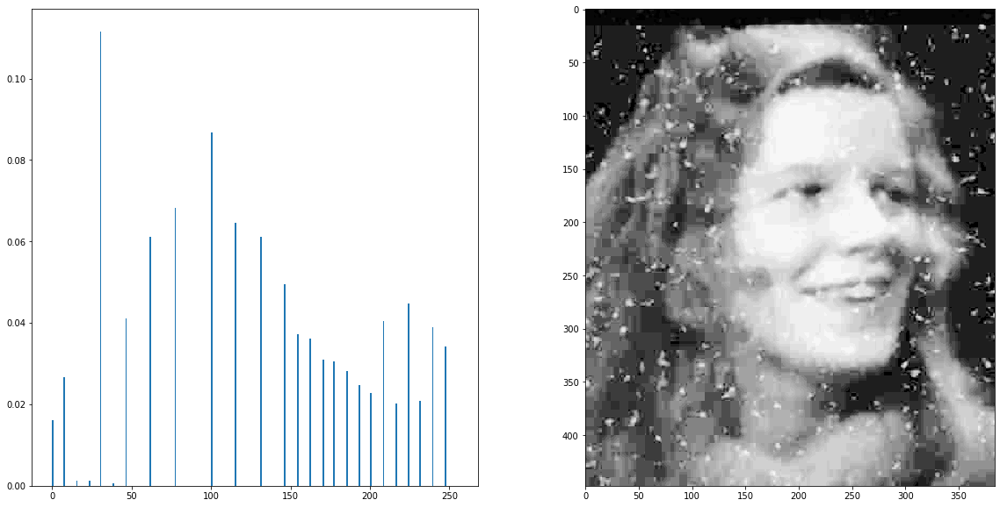

In [255]:
# Showing the result
plt.figure(figsize=(20,10))
plt.subplot(121),plt.hist(img_altered_whole_spectrum.ravel(),max(img_altered_whole_spectrum.ravel()),[0,max(img_altered_whole_spectrum.ravel())],density = True)
plt.subplot(122),plt.imshow(img_altered_whole_spectrum,"gray")
plt.savefig('1stq_myeq.png', bbox_inches='tight')
plt.show()

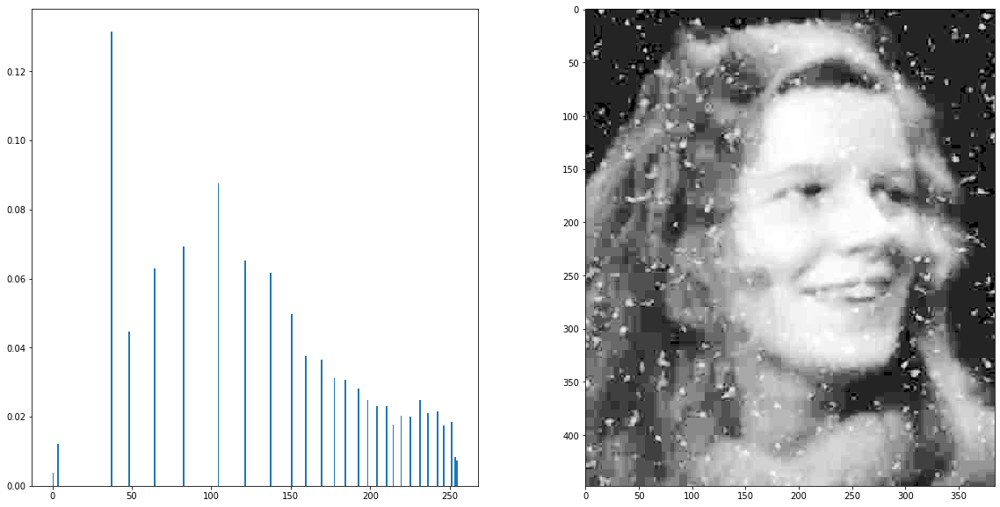

In [257]:
# Applying the cv2 EH on mp2.jpg
cv2eq = cv2.equalizeHist(img)
plt.figure(figsize=(20,10))
plt.subplot(121),plt.hist(cv2eq.ravel(),max(cv2eq.ravel()),[0,max(cv2eq.ravel())],density = True)
plt.subplot(122),plt.imshow(cv2eq, cmap = "gray")
plt.savefig('1stq_cv2eq.png', bbox_inches='tight')
plt.show()

In [136]:
# Read mp2a.jpg
img2 = plt.imread("mp2a.jpg")
img2_cv2 = cv2.imread("mp2a.jpg")

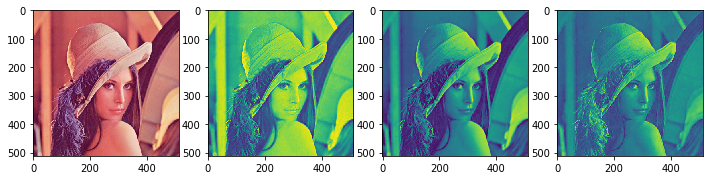

In [138]:
# Separating bgr channels 
b,g,r = cv2.split(img2_cv2)
rgb_img = cv2.merge([r,g,b])
plt.figure(figsize=(12,10))
plt.subplot(141), plt.imshow(rgb_img)
plt.subplot(142), plt.imshow(r)
plt.subplot(143), plt.imshow(g)
plt.subplot(144), plt.imshow(b)
plt.show()

In [52]:
# Storing the separated channels in three seperate arrays 
img2R = np.zeros((512,512))
img2G = np.zeros((512,512))
img2B = np.zeros((512,512))
for i in range(img2.shape[0]):
    for j in range(img2.shape[1]):
        img2R[i][j] = img2[i][j][0]
        img2G[i][j] = img2[i][j][1]
        img2B[i][j] = img2[i][j][2]

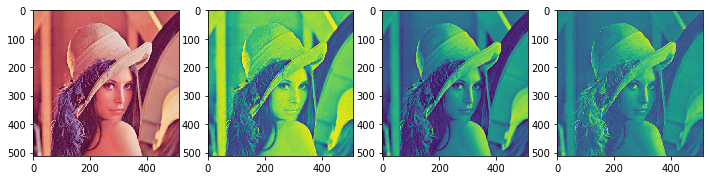

In [53]:
plt.figure(figsize=(12,10))
plt.subplot(141), plt.imshow(img2)
plt.subplot(142), plt.imshow(img2R)
plt.subplot(143), plt.imshow(img2G)
plt.subplot(144), plt.imshow(img2B)
plt.show()

In [54]:
# Applying my EH on the R channel
img2R_altered = my_histogram(img2R)

[1.00000e+00 3.00000e+00 4.00000e+00 5.00000e+00 6.00000e+00 1.00000e+01
 1.60000e+01 1.80000e+01 1.90000e+01 2.70000e+01 3.70000e+01 4.60000e+01
 5.30000e+01 6.50000e+01 8.70000e+01 1.13000e+02 1.49000e+02 1.95000e+02
 2.51000e+02 3.01000e+02 3.67000e+02 4.48000e+02 5.63000e+02 7.26000e+02
 8.93000e+02 1.10200e+03 1.35900e+03 1.64200e+03 2.00500e+03 2.36800e+03
 2.80400e+03 3.30400e+03 3.89700e+03 4.52600e+03 5.24500e+03 6.04300e+03
 6.94600e+03 7.90100e+03 8.98000e+03 1.01580e+04 1.14330e+04 1.27470e+04
 1.41560e+04 1.56490e+04 1.72100e+04 1.88650e+04 2.05540e+04 2.22010e+04
 2.39110e+04 2.55110e+04 2.71260e+04 2.87740e+04 3.02950e+04 3.17590e+04
 3.31490e+04 3.45610e+04 3.57970e+04 3.69800e+04 3.81340e+04 3.91840e+04
 4.01390e+04 4.10750e+04 4.19290e+04 4.27410e+04 4.34720e+04 4.41870e+04
 4.48870e+04 4.55450e+04 4.62160e+04 4.68510e+04 4.74690e+04 4.80630e+04
 4.86760e+04 4.92380e+04 4.97900e+04 5.03720e+04 5.09610e+04 5.14970e+04
 5.21180e+04 5.27020e+04 5.33270e+04 5.39550e+04 5.

140.91127395629883
140.91127395629883
140.91127395629883
113.87472152709961
122.70435333251953
126.48347854614258
119.08184051513672
113.87472152709961
113.87472152709961
112.24342346191406
110.6627082824707
107.61606216430664
101.92256927490234
101.92256927490234
103.35834503173828
98.71639251708984
86.72338485717773
79.98224258422852
79.98224258422852
101.92256927490234
113.87472152709961
117.37174987792969
117.37174987792969
122.70435333251953
146.53959274291992
165.95563888549805
159.56565856933594
163.0510139465332
165.95563888549805
173.86505126953125
178.39319229125977
176.15684509277344
180.71611404418945
183.22093963623047
192.26652145385742
188.94750595092773
192.26652145385742
195.90167999267578
207.0036506652832
207.0036506652832
199.5524024963379
192.26652145385742
192.26652145385742
173.86505126953125
183.22093963623047
195.90167999267578
203.2147979736328
207.0036506652832
207.0036506652832
207.0036506652832
213.98992538452148
183.22093963623047
213.98992538452148
203.21

146.53959274291992
149.74090576171875
152.98599243164062
152.98599243164062
156.23497009277344
171.45360946655273
168.77368927001953
163.0510139465332
159.56565856933594
163.0510139465332
168.77368927001953
173.86505126953125
176.15684509277344
159.56565856933594
156.23497009277344
163.0510139465332
168.77368927001953
156.23497009277344
143.55520248413086
159.56565856933594
180.71611404418945
171.45360946655273
165.95563888549805
159.56565856933594
149.74090576171875
140.91127395629883
138.43368530273438
138.43368530273438
136.1963653564453
146.53959274291992
143.55520248413086
143.55520248413086
146.53959274291992
149.74090576171875
149.74090576171875
143.55520248413086
136.1963653564453
138.43368530273438
130.14781951904297
140.91127395629883
149.74090576171875
134.04659271240234
140.91127395629883
163.0510139465332
152.98599243164062
146.53959274291992
130.14781951904297
138.43368530273438
146.53959274291992
136.1963653564453
143.55520248413086
156.23497009277344
136.1963653564453
1

159.56565856933594
163.0510139465332
165.95563888549805
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
163.0510139465332
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
163.0510139465332
165.95563888549805
168.77368927001953
163.0510139465332
156.23497009277344
152.98599243164062
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
165.95563888549805
163.0510139465332
156.23497009277344
149.74090576171875
159.56565856933594
138.43368530273438
136.1963653564453
152.98599243164062
156.23497009277344
143.55520248413086
136.1

104.79217529296875
103.35834503173828
103.35834503173828
103.35834503173828
103.35834503173828
104.79217529296875
104.79217529296875
103.35834503173828
98.71639251708984
98.71639251708984
100.39146423339844
103.35834503173828
100.39146423339844
107.61606216430664
109.18510437011719
106.1715316772461
109.18510437011719
119.08184051513672
122.70435333251953
115.59648513793945
110.6627082824707
124.59440231323242
124.59440231323242
124.59440231323242
134.04659271240234
128.28889846801758
126.48347854614258
138.43368530273438
136.1963653564453
146.53959274291992
149.74090576171875
136.1963653564453
134.04659271240234
146.53959274291992
163.0510139465332
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
149.74090576171875
143.55520248413086
143.55520248413086
163.0510139465332
156.23497009277344
156.23497009277344
152.98599243164062
149.74090576171875
143.55520248413086
140.91127395629883
140.91127395629883
152.98599243164062
1

192.26652145385742
195.90167999267578
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
199.5524024963379
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
210.59698104858398
219.55987930297852
224.0841293334961
224.0841293334961
228.36908340454102
228.36908340454102
232.75033950805664
232.75033950805664
239.82610702514648
241.95253372192383
237.55182266235352
232.75033950805664
239.82610702514648
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
237.55182266235352
232.75033950805664
228.36908340454102
203.2147979736328
210.59698104858398
203.2147979736328
176.15684509277344
149.74090576171875
130.14781951904297
115.59648513793945
104.79217529296875
81.93843841552734
81.93843841552734
77.32664108276367
73.67494583129883
72.83449172973633
76.40447616577148
76.40447616577148
76.40447616577148
81.93843841552734
81.93843841552734
84.10572052001953
88.31382751

119.08184051513672
126.48347854614258
126.48347854614258
120.89601516723633
122.70435333251953
126.48347854614258
126.48347854614258
120.89601516723633
136.1963653564453
132.02133178710938
128.28889846801758
130.14781951904297
130.14781951904297
126.48347854614258
120.89601516723633
117.37174987792969
124.59440231323242
122.70435333251953
122.70435333251953
126.48347854614258
130.14781951904297
130.14781951904297
128.28889846801758
124.59440231323242
128.28889846801758
119.08184051513672
138.43368530273438
126.48347854614258
126.48347854614258
136.1963653564453
115.59648513793945
124.59440231323242
109.18510437011719
110.6627082824707
115.59648513793945
117.37174987792969
117.37174987792969
119.08184051513672
119.08184051513672
122.70435333251953
140.91127395629883
203.2147979736328
239.82610702514648
228.36908340454102
224.0841293334961
224.0841293334961
159.56565856933594
100.39146423339844
This is i: 5
221.87015533447266
219.55987930297852
216.9188690185547
213.98992538452148
213.98

203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
178.39319229125977
178.39319229125977
185.94268798828125
219.55987930297852
244.03032302856445
251.75296783447266
252.27046966552734
251.1965560913086
252.71696090698242
251.75296783447266
252.27046966552734
253.12746047973633
253.45624923706055
253.7519645690918
254.00001525878906
254.00001525878906
254.00001525878906
251.75296783447266
253.12746047973633
252.71696090698242
241.95253372192383
224.0841293334961
176.15684509277344
119.08184051513672
83.01721572875977
78.18363189697266
74.57862854003906
79.06007766723633
83.01721572875977
85.33430099487305
84.10572052001953
86.72338485717773
104.79217529296875
106.1715316772461
107.61606216430664
109.18510437011719
110.6627082824707
110.6627082824707
110.6627082824707
110.6627082824707
119.08184051513672
115.59648513793945
112.24342346191406
112.24342346191406
115.59648513793945
117.37174987792969
119.08184051

95.26119232177734
106.1715316772461
120.89601516723633
128.28889846801758
130.14781951904297
134.04659271240234
152.98599243164062
156.23497009277344
165.95563888549805
171.45360946655273
178.39319229125977
180.71611404418945
183.22093963623047
188.94750595092773
195.90167999267578
188.94750595092773
195.90167999267578
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
207.0036506652832
203.2147979736328
188.94750595092773
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
203.2147979736328
210.59698104858398
178.39319229125977
207.0036506652832
195.90167999267578
180.71611404418945
203.2147979736328
203.2147979736328
188.94750595092773
195.90167999267578
199.5524024963379
192.26652145385742
195.90167999267578
207.0036506652832
207.0036506652832
192.26652145385742
185.94268798828125
192.26652145385742
207.0036506652832
207.0036506652832
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
207.003650665

152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
152.98599243164062
146.53959274291992
140.91127395629883
138.43368530273438
143.55520248413086
138.43368530273438
134.04659271240234
136.1963653564453
143.55520248413086
149.74090576171875
152.98599243164062
152.98599243164062
143.55520248413086
132.02133178710938
143.55520248413086
149.74090576171875
130.14781951904297
136.1963653564453
152.98599243164062
140.91127395629883
146.53959274291992
130.14781951904297
138.43368530273438
146.53959274291992
136.1963653564453
143.55520248413086
156.23497009277344
136.1963653564453
140.91127395629883
149.74090576171875
149.74090576171875
143.55520248413086
140.91127395629883
146.53959274291992
143.55520248413086
136.1963653564453
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
136.1963653564453
136.1963653564453
136.1963653564453
126.48347854614258
126.48347854614258
124.59440231323242
119.08184051513672
119.08184051513672
1

163.0510139465332
156.23497009277344
149.74090576171875
171.45360946655273
171.45360946655273
165.95563888549805
159.56565856933594
152.98599243164062
152.98599243164062
163.0510139465332
168.77368927001953
152.98599243164062
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
134.04659271240234
143.55520248413086
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
152.98599243164062
156.23497009277344
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
140.91127395629883
143.55520248413086
152.98599243164062
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
134.04659271240234
136.1963653564453
143.55520248413086
146.53959274291992
149.74090576171875
149.74090576171875
152.98599243164062
152.98599243164062
165.95563888549805
165.9556388854980

140.91127395629883
152.98599243164062
156.23497009277344
149.74090576171875
156.23497009277344
163.0510139465332
159.56565856933594
146.53959274291992
143.55520248413086
149.74090576171875
156.23497009277344
159.56565856933594
156.23497009277344
152.98599243164062
143.55520248413086
140.91127395629883
143.55520248413086
146.53959274291992
146.53959274291992
159.56565856933594
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
163.0510139465332
165.95563888549805
168.77368927001953
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
163.051013946533

176.15684509277344
165.95563888549805
149.74090576171875
130.14781951904297
117.37174987792969
107.61606216430664
84.10572052001953
77.32664108276367
74.57862854003906
74.57862854003906
73.67494583129883
71.17206573486328
72.83449172973633
77.32664108276367
77.32664108276367
80.95888137817383
84.10572052001953
88.31382751464844
88.31382751464844
91.67078018188477
98.71639251708984
101.92256927490234
93.49662780761719
96.97809219360352
98.71639251708984
98.71639251708984
96.97809219360352
96.97809219360352
100.39146423339844
103.35834503173828
98.71639251708984
100.39146423339844
101.92256927490234
98.71639251708984
95.26119232177734
95.26119232177734
96.97809219360352
100.39146423339844
95.26119232177734
95.26119232177734
91.67078018188477
89.98306274414062
96.97809219360352
106.1715316772461
107.61606216430664
101.92256927490234
104.79217529296875
104.79217529296875
106.1715316772461
107.61606216430664
110.6627082824707
115.59648513793945
119.08184051513672
120.89601516723633
124.5944

110.6627082824707
88.31382751464844
66.41046524047852
53.067283630371094
44.30379867553711
33.619136810302734
19.993858337402344
19.993858337402344
23.25937271118164
18.350887298583984
13.770217895507812
13.770217895507812
This is i: 11
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
195.90167999267578
188.94750595092773
185.94268798828125
221.87015533447266
213.98992538452148
210.59698104858398
219.55987930297852
216.9188690185547
207.0036506652832
207.0036506652832
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
207.0036506652832
192.26652145385742
195.90167999267578
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
203.2147979736328
199.5524024963379
210.59698104858398
213.98992538452148
216.9188690185547
216.9188690185547
221.87015533447266
226.19888305664062
230.53733825683594
230.53733825683594
235.1004981994629

88.31382751464844
89.98306274414062
95.26119232177734
100.39146423339844
103.35834503173828
106.1715316772461
107.61606216430664
107.61606216430664
112.24342346191406
110.6627082824707
110.6627082824707
110.6627082824707
110.6627082824707
110.6627082824707
110.6627082824707
112.24342346191406
119.08184051513672
119.08184051513672
120.89601516723633
120.89601516723633
120.89601516723633
119.08184051513672
117.37174987792969
115.59648513793945
119.08184051513672
117.37174987792969
113.87472152709961
112.24342346191406
112.24342346191406
113.87472152709961
115.59648513793945
117.37174987792969
124.59440231323242
120.89601516723633
119.08184051513672
119.08184051513672
124.59440231323242
124.59440231323242
122.70435333251953
120.89601516723633
126.48347854614258
126.48347854614258
126.48347854614258
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
132.02133178710938
132.02133178710938
132.02133178710938
130.14781951904297
128

216.9188690185547
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
192.26652145385742
195.90167999267578
199.5524024963379
195.90167999267578
188.94750595092773
185.94268798828125
185.94268798828125
188.94750595092773
188.94750595092773
188.94750595092773
192.26652145385742
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
207.0036506652832
180.71611404418945
173.86505126953125
178.39319229125977
176.15684509277344
159.56565856933594
165.95563888549805
188.94750595092773
230.53733825683594
247.3143196105957
252.71696090698242
252.71696090698242
253.12746047973633
253.7519645690918
254.00001525878906
253.7519645690918
253.

143.55520248413086
146.53959274291992
146.53959274291992
146.53959274291992
146.53959274291992
149.74090576171875
146.53959274291992
149.74090576171875
152.98599243164062
156.23497009277344
152.98599243164062
143.55520248413086
138.43368530273438
120.89601516723633
124.59440231323242
128.28889846801758
130.14781951904297
130.14781951904297
126.48347854614258
120.89601516723633
117.37174987792969
115.59648513793945
113.87472152709961
110.6627082824707
104.79217529296875
103.35834503173828
106.1715316772461
106.1715316772461
103.35834503173828
100.39146423339844
98.71639251708984
93.49662780761719
88.31382751464844
86.72338485717773
91.67078018188477
100.39146423339844
107.61606216430664
120.89601516723633
130.14781951904297
143.55520248413086
163.0510139465332
171.45360946655273
178.39319229125977
183.22093963623047
188.94750595092773
185.94268798828125
188.94750595092773
195.90167999267578
203.2147979736328
210.59698104858398
216.9188690185547
213.98992538452148
216.9188690185547
213.9

165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
146.53959274291992
146.53959274291992
146.53959274291992
146.53959274291992
146.53959274291992
152.98599243164062
152.98599243164062
152.98599243164062
146.53959274291992
149.74090576171875
152.98599243164062
156.23497009277344
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
163.0510139465332
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
165.95563888549805
163.0510139465332
163.0510139465332
165.95563888549805
156.23497009277344
146.53959274291992
152.98599243164062
165.95563888549805
171.45360946655273
163.0510139465332
152.98599243164062
152.98599243164062
163.0510139465332
163.0510139465332
156.23497009277344
152.98599243164062
159.56565856933594
156.23497009277344
146.53959274291992
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
149.74090576171875


168.77368927001953
165.95563888549805
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
168.77368927001953
165.95563888549805
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
156.23497009277344
159.56565856933594
168.77368927001953
171.45360946655273
173.86505126953125
171.45360946655273
165.95563888549805
159.56565856933594
173.86505126953125
171.45360946655273
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
159.56565856933594
165.95563888549805
171.45360946655273
176.15684509277344
176.15684509277344
171.45360946655273
165.95563888549805
159.56565856933594
163.0510139465332
168.77368927001953
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
176

91.67078018188477
89.98306274414062
89.98306274414062
101.92256927490234
101.92256927490234
101.92256927490234
100.39146423339844
100.39146423339844
101.92256927490234
106.1715316772461
110.6627082824707
93.49662780761719
98.71639251708984
100.39146423339844
95.26119232177734
96.97809219360352
101.92256927490234
103.35834503173828
98.71639251708984
101.92256927490234
103.35834503173828
104.79217529296875
103.35834503173828
100.39146423339844
95.26119232177734
95.26119232177734
96.97809219360352
106.1715316772461
109.18510437011719
110.6627082824707
112.24342346191406
112.24342346191406
112.24342346191406
115.59648513793945
119.08184051513672
119.08184051513672
122.70435333251953
128.28889846801758
134.04659271240234
138.43368530273438
140.91127395629883
140.91127395629883
138.43368530273438
134.04659271240234
140.91127395629883
143.55520248413086
138.43368530273438
140.91127395629883
152.98599243164062
156.23497009277344
146.53959274291992
152.98599243164062
149.74090576171875
146.5395

216.9188690185547
216.9188690185547
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
219.55987930297852
219.55987930297852
219.55987930297852
221.87015533447266
216.9188690185547
216.9188690185547
203.2147979736328
199.5524024963379
199.5524024963379
203.2147979736328
210.59698104858398
216.9188690185547
216.9188690185547
219.55987930297852
213.98992538452148
219.55987930297852
226.19888305664062
226.19888305664062
224.0841293334961
221.87015533447266
224.0841293334961
224.0841293334961
226.19888305664062
230.53733825683594
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
226.19888305664062
226.19888305664062
219.55987930297852
216.9188690185547
219.55987930297852
219.55987930297852
213.98992538452148
207.0036506652832
180.71611404418945
176.156845092

120.89601516723633
122.70435333251953
117.37174987792969
115.59648513793945
113.87472152709961
117.37174987792969
122.70435333251953
122.70435333251953
119.08184051513672
113.87472152709961
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
122.70435333251953
122.70435333251953
117.37174987792969
117.37174987792969
119.08184051513672
122.70435333251953
124.59440231323242
130.14781951904297
126.48347854614258
122.70435333251953
122.70435333251953
124.59440231323242
126.48347854614258
134.04659271240234
136.1963653564453
136.1963653564453
134.04659271240234
134.04659271240234
122.70435333251953
134.04659271240234
140.91127395629883
138.43368530273438
143.55520248413086
163.0510139465332
171.45360946655273
171.45360946655273
176.15684509277344
178.39319229125977
165.95563888549805
138.43368530273438
119.08184051513672
98.71639251708984
73.67494583129883
60.55938720703125
41.57621383666992
32.2456169128418
19.993858337402344
16

210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
207.0036506652832
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
199.5524024963379
192.26652145385742
185.94268798828125
183.22093963623047
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
192.26652145385742
185.94268798828125
180.71611404418945
185.94268798828125
185.94268798828125
188.94750595092773
188.94750595092773
188.94750595092773
185.94268798828125
183.22093963623047
163.0510139465332
165.95563888549805
178.39319229125977
210.59698104858398
235.1004981994629
250.51076889038086
253.12746047973633
254.00001525878906
253.45624923706055
253.7519645690918
254.20818328857422
254.20818328857422
253.7519645690918
253.12746047973633
253.45624923706055
254.00001525878906
254.00001525878906
254.20818328857422
254.35409545898438
252.71696090698242
247.3143196105957
224.0841293334961
163.0510139465332
117.37174987792969
83.017

128.28889846801758
130.14781951904297
132.02133178710938
130.14781951904297
124.59440231323242
119.08184051513672
128.28889846801758
124.59440231323242
120.89601516723633
115.59648513793945
112.24342346191406
110.6627082824707
109.18510437011719
109.18510437011719
101.92256927490234
101.92256927490234
103.35834503173828
98.71639251708984
91.67078018188477
85.33430099487305
85.33430099487305
84.10572052001953
95.26119232177734
100.39146423339844
106.1715316772461
120.89601516723633
138.43368530273438
163.0510139465332
171.45360946655273
176.15684509277344
180.71611404418945
183.22093963623047
192.26652145385742
192.26652145385742
199.5524024963379
207.0036506652832
207.0036506652832
207.0036506652832
216.9188690185547
219.55987930297852
221.87015533447266
213.98992538452148
207.0036506652832
210.59698104858398
216.9188690185547
221.87015533447266
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
219.55987930297852
221.870155

156.23497009277344
159.56565856933594
149.74090576171875
152.98599243164062
156.23497009277344
163.0510139465332
168.77368927001953
173.86505126953125
176.15684509277344
178.39319229125977
180.71611404418945
173.86505126953125
165.95563888549805
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
156.23497009277344
168.77368927001953
165.95563888549805
159.56565856933594
152.98599243164062
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
178.39319229125977
159.56565856933594
140.91127395629883
138.43368530273438
146.53959274291992
152.98599243164062
146.53959274291992
136.1963653564453
152.98599243164062
156.23497009277344
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
156.23497009277344
163.0510139465332
152.98599243164062
152.98599243164062
149.74090576171875
146.53959274291992
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
152.98599243164062
152.98599243164062
152.985992431640

159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
168.77368927001953
171.45360946655273
171.45360946655273
159.56565856933594
152.98599243164062
159.56565856933594
171.45360946655273
173.86505126953125
165.95563888549805
165.95563888549805
173.86505126953125
168.77368927001953
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
159.56565856933594
156.23497009277344
159.56565856933594
165.95563888549805
173.86505126953125
176.15684509277344
185.94268798828125
173.86505126953125
168.77368927001953
171.45360946655273
171.45360946655273
159.56565856933594
163.0510139465332
171.45360946655273
149.74090576171875
143.55520248413086
146.53959274291992
163.0510139465332
168.77368927001953
156.23497009277344
149.74090576171875
14

103.35834503173828
103.35834503173828
101.92256927490234
103.35834503173828
106.1715316772461
109.18510437011719
109.18510437011719
112.24342346191406
115.59648513793945
117.37174987792969
117.37174987792969
117.37174987792969
120.89601516723633
124.59440231323242
124.59440231323242
126.48347854614258
128.28889846801758
130.14781951904297
130.14781951904297
130.14781951904297
130.14781951904297
130.14781951904297
132.02133178710938
140.91127395629883
146.53959274291992
140.91127395629883
140.91127395629883
143.55520248413086
140.91127395629883
130.14781951904297
143.55520248413086
146.53959274291992
149.74090576171875
152.98599243164062
156.23497009277344
152.98599243164062
149.74090576171875
149.74090576171875
163.0510139465332
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
152.98599243164062
146.53959274291992
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
149.74090576171875
146.5395927429

207.0036506652832
213.98992538452148
219.55987930297852
221.87015533447266
219.55987930297852
226.19888305664062
230.53733825683594
230.53733825683594
224.0841293334961
216.9188690185547
213.98992538452148
213.98992538452148
216.9188690185547
221.87015533447266
224.0841293334961
224.0841293334961
224.0841293334961
224.0841293334961
221.87015533447266
219.55987930297852
213.98992538452148
213.98992538452148
221.87015533447266
224.0841293334961
228.36908340454102
224.0841293334961
219.55987930297852
207.0036506652832
213.98992538452148
192.26652145385742
173.86505126953125
165.95563888549805
163.0510139465332
140.91127395629883
119.08184051513672
104.79217529296875
81.93843841552734
79.06007766723633
76.40447616577148
75.47161102294922
75.47161102294922
77.32664108276367
79.98224258422852
83.01721572875977
91.67078018188477
88.31382751464844
84.10572052001953
88.31382751464844
93.49662780761719
100.39146423339844
100.39146423339844
98.71639251708984
103.35834503173828
96.97809219360352
8

134.04659271240234
132.02133178710938
130.14781951904297
134.04659271240234
136.1963653564453
140.91127395629883
143.55520248413086
149.74090576171875
178.39319229125977
185.94268798828125
185.94268798828125
180.71611404418945
176.15684509277344
159.56565856933594
128.28889846801758
104.79217529296875
74.57862854003906
54.25987243652344
38.11614990234375
29.46939468383789
30.893497467041016
27.989845275878906
19.993858337402344
15.222530364990234
33.619136810302734
19.993858337402344
12.399616241455078
18.350887298583984
23.25937271118164
21.59597396850586
16.740989685058594
18.350887298583984
21.59597396850586
27.989845275878906
29.46939468383789
27.989845275878906
27.989845275878906
32.2456169128418
35.97221374511719
39.95561599731445
This is i: 24
221.87015533447266
216.9188690185547
210.59698104858398
203.2147979736328
203.2147979736328
210.59698104858398
216.9188690185547
221.87015533447266
216.9188690185547
219.55987930297852
219.55987930297852
221.87015533447266
221.870155334472

183.22093963623047
183.22093963623047
185.94268798828125
185.94268798828125
180.71611404418945
183.22093963623047
171.45360946655273
163.0510139465332
165.95563888549805
163.0510139465332
165.95563888549805
199.5524024963379
241.95253372192383
248.57694625854492
251.1965560913086
252.27046966552734
253.12746047973633
253.45624923706055
253.45624923706055
252.71696090698242
252.27046966552734
253.45624923706055
253.12746047973633
253.12746047973633
254.00001525878906
254.35409545898438
253.7519645690918
252.27046966552734
251.1965560913086
249.62265014648438
230.53733825683594
152.98599243164062
89.98306274414062
75.47161102294922
80.95888137817383
93.49662780761719
96.97809219360352
89.98306274414062
93.49662780761719
96.97809219360352
101.92256927490234
104.79217529296875
110.6627082824707
112.24342346191406
115.59648513793945
122.70435333251953
122.70435333251953
120.89601516723633
119.08184051513672
117.37174987792969
117.37174987792969
115.59648513793945
115.59648513793945
124.5944

113.87472152709961
122.70435333251953
134.04659271240234
149.74090576171875
165.95563888549805
165.95563888549805
173.86505126953125
185.94268798828125
188.94750595092773
195.90167999267578
203.2147979736328
213.98992538452148
216.9188690185547
213.98992538452148
216.9188690185547
219.55987930297852
216.9188690185547
216.9188690185547
216.9188690185547
213.98992538452148
210.59698104858398
219.55987930297852
221.87015533447266
224.0841293334961
219.55987930297852
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
203.2147979736328
213.98992538452148
219.55987930297852
216.9188690185547
210.59698104858398
207.0036506652832
210.59698104858398
213.98992538452148
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
210.59698104858398
199.5524024963379
195.90167999267578
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
216.9188690185547
207.003650

146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
138.43368530273438
156.23497009277344
149.74090576171875
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
140.91127395629883
140.91127395629883
146.53959274291992
149.74090576171875
149.74090576171875
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
134.04659271240234
132.02133178710938
136.1963653564453
134.04659271240234
130.14781951904297
130.14781951904297
136.1963653564453
140.91127395629883
138.43368530273438
132.02133178710938
126.48347854614258
120.8960151672

165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
173.86505126953125
168.77368927001953
165.95563888549805
156.23497009277344
156.23497009277344
163.0510139465332
159.56565856933594
159.56565856933594
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
146.53959274291992
146.53959274291992
149.74090576171875
156.23497009277344
156.23497009277344
152.98599243164062
156.23497009277344
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
143.55520248413086
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
140.91127395629883
140.91127395629883
143.55520248413086
149.74090576171875
149.74090576171875
143.55520248413086
138.43368530273438
138.43368530273438
143.55520248413086
146.53959274291992
146.53959274291992
136.1963653564453
138.43368530273438

126.48347854614258
132.02133178710938
140.91127395629883
130.14781951904297
136.1963653564453
143.55520248413086
140.91127395629883
136.1963653564453
134.04659271240234
140.91127395629883
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
152.98599243164062
159.56565856933594
163.0510139465332
159.56565856933594
152.98599243164062
152.98599243164062
156.23497009277344
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164

224.0841293334961
230.53733825683594
235.1004981994629
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
210.59698104858398
199.5524024963379
183.22093963623047
168.77368927001953
146.53959274291992
130.14781951904297
115.59648513793945
103.35834503173828
81.93843841552734
78.18363189697266
74.57862854003906
75.47161102294922
73.67494583129883
72.83449172973633
77.32664108276367
85.33430099487305
85.33430099487305
86.72338485717773
88.31382751464844
91.67078018188477
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
98.71639251708984
101.92256927490234
101.92256927490234
100.39146423339844
96.97809219360352
103.35834503173828
103.35834503173828
101.92256927490234
96.97809219360352
93.49662780761719
93.49662780761719
96.97809219360352
100.39146423339844
103.35834503173828
103.35834503173828
101.92256927490234
100.39146423339844
101.92256927490234
103.35834503173828
106.1715316772461
107

29.46939468383789
15.222530364990234
16.740989685058594
21.59597396850586
29.46939468383789
30.893497467041016
29.46939468383789
30.893497467041016
38.11614990234375
30.893497467041016
33.619136810302734
37.094764709472656
30.893497467041016
19.993858337402344
21.59597396850586
33.619136810302734
42.28729248046875
This is i: 30
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
221.87015533447266
221.87015533447266
219.55987930297852
221.87015533447266
224.0841293334961
224.0841293334961
226.19888305664062
226.19888305664062
224.0841293334961
224.0841293334961
221.87015533447266
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
219.55987930297852
219.55987930297852
221.87015533447266
221.87015533447266
219.55987930297852
221.87015533447266
226.19888305664062
228.36908340454102
228.36908340454102
228.36908340454102
228.36908340454102
226.19888305664062
226.19888305664062
226.19888305664062
224.084129333496

253.12746047973633
253.45624923706055
253.12746047973633
252.27046966552734
253.7519645690918
252.27046966552734
252.27046966552734
253.12746047973633
254.00001525878906
255.0
254.35409545898438
254.20818328857422
253.7519645690918
254.00001525878906
252.71696090698242
249.62265014648438
230.53733825683594
178.39319229125977
115.59648513793945
84.10572052001953
86.72338485717773
93.49662780761719
101.92256927490234
104.79217529296875
109.18510437011719
112.24342346191406
113.87472152709961
115.59648513793945
104.79217529296875
106.1715316772461
109.18510437011719
112.24342346191406
117.37174987792969
120.89601516723633
124.59440231323242
126.48347854614258
120.89601516723633
120.89601516723633
120.89601516723633
120.89601516723633
120.89601516723633
120.89601516723633
120.89601516723633
120.89601516723633
112.24342346191406
113.87472152709961
117.37174987792969
117.37174987792969
117.37174987792969
122.70435333251953
128.28889846801758
132.02133178710938
130.14781951904297
138.43368530

203.2147979736328
199.5524024963379
203.2147979736328
210.59698104858398
219.55987930297852
221.87015533447266
213.98992538452148
216.9188690185547
216.9188690185547
210.59698104858398
199.5524024963379
192.26652145385742
195.90167999267578
195.90167999267578
216.9188690185547
210.59698104858398
207.0036506652832
213.98992538452148
219.55987930297852
221.87015533447266
213.98992538452148
203.2147979736328
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
216.9188690185547
203.2147979736328
203.2147979736328
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
207.0036506652832
207.0036506652832
213.98992538452148
210.59698104858398
203.2147979736328
199.5524024963379
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
192

140.91127395629883
138.43368530273438
156.23497009277344
149.74090576171875
143.55520248413086
138.43368530273438
138.43368530273438
140.91127395629883
143.55520248413086
146.53959274291992
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
136.1963653564453
143.55520248413086
149.74090576171875
146.53959274291992
136.1963653564453
134.04659271240234
134.04659271240234
138.43368530273438
138.43368530273438
130.14781951904297
124.59440231323242
119.08184051513672
115.59648513793945
110.6627082824707
106.1715316772461
98.71639251708984
101.92256927490234
103.35834503173828
103.35834503173828
101.92256927490234
98.71639251708984
96.97809219360352
98.71639251708984
103.35834503173828
101.92256927490234
107.61606216430664
119.08184051513672
1

146.53959274291992
140.91127395629883
138.43368530273438
159.56565856933594
146.53959274291992
143.55520248413086
152.98599243164062
143.55520248413086
136.1963653564453
134.04659271240234
140.91127395629883
146.53959274291992
136.1963653564453
132.02133178710938
130.14781951904297
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
152.98599243164062
152.98599243164062
146.53959274291992
140.91127395629883
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
140.91127395629883
146.53959274291992
146.53959274291992
143.55520248413086
140.91127395629883
134.04659271240234
132.02133178710938
138.43368530273438
136.1963653564453
138.43368530273438
136.1963653564453
138.43368530273438
143.55520248413086
149.74090576171875
159.56565856933594
146.53959274291992
143.555202484130

146.53959274291992
146.53959274291992
149.74090576171875
156.23497009277344
156.23497009277344
149.74090576171875
143.55520248413086
149.74090576171875
152.98599243164062
156.23497009277344
156.23497009277344
149.74090576171875
149.74090576171875
152.98599243164062
156.23497009277344
146.53959274291992
152.98599243164062
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
168.77368927001953
180.71611404418945
176.15684509277344
171.45360946655273
165.95563888549805
165.95563888549805
165.95563888549805
159.56565856933594
149.74090576171875
156.23497009277344
163.0510139465332
168.77368927001953
165.95563888549805
165.95563888549805
159.56565856933594
149.74090576171875
146.53959274291992
146.53959274291992
149.74090576171875
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
156.23497009277344
156.23497009277344
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.

101.92256927490234
79.98224258422852
77.32664108276367
73.67494583129883
74.57862854003906
75.47161102294922
78.18363189697266
79.06007766723633
80.95888137817383
86.72338485717773
91.67078018188477
96.97809219360352
98.71639251708984
95.26119232177734
95.26119232177734
100.39146423339844
104.79217529296875
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
93.49662780761719
95.26119232177734
98.71639251708984
100.39146423339844
100.39146423339844
98.71639251708984
95.26119232177734
93.49662780761719
95.26119232177734
93.49662780761719
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
98.71639251708984
109.18510437011719
109.18510437011719
110.6627082824707
112.24342346191406
115.59648513793945
117.37174987792969
119.08184051513672
119.08184051513672
128.28889846801758
128.28889846801758
128.28889846801758
132.02133178710938
136.1963653564453
138.43368530

216.9188690185547
210.59698104858398
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
224.0841293334961
228.36908340454102
228.36908340454102
226.19888305664062
226.19888305664062
226.19888305664062
226.19888305664062
226.19888305664062
226.19888305664062
228.36908340454102
228.36908340454102
226.19888305664062
226.19888305664062
224.0841293334961
221.87015533447266
219.55987930297852
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
224.0841293334961
219.55987930297852
221.87015533447266
228.36908340454102
232.75033950805664
232.75033950805664
232.75033950805664
228.3690

245.85227966308594
224.0841293334961
136.1963653564453
96.97809219360352
81.93843841552734
79.06007766723633
89.98306274414062
106.1715316772461
100.39146423339844
104.79217529296875
106.1715316772461
107.61606216430664
109.18510437011719
112.24342346191406
113.87472152709961
115.59648513793945
117.37174987792969
120.89601516723633
126.48347854614258
132.02133178710938
134.04659271240234
132.02133178710938
132.02133178710938
134.04659271240234
136.1963653564453
117.37174987792969
126.48347854614258
138.43368530273438
146.53959274291992
146.53959274291992
149.74090576171875
156.23497009277344
152.98599243164062
126.48347854614258
113.87472152709961
93.49662780761719
71.17206573486328
56.62559509277344
46.753177642822266
37.094764709472656
27.989845275878906
16.740989685058594
11.12142562866211
9.881172180175781
15.222530364990234
16.740989685058594
13.770217895507812
15.222530364990234
21.59597396850586
32.2456169128418
30.893497467041016
30.893497467041016
32.2456169128418
34.821453094

199.5524024963379
199.5524024963379
207.0036506652832
207.0036506652832
195.90167999267578
213.98992538452148
216.9188690185547
213.98992538452148
207.0036506652832
195.90167999267578
195.90167999267578
203.2147979736328
210.59698104858398
216.9188690185547
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
188.94750595092773
185.94268798828125
183.22093963623047
183.22093963623047
183.22093963623047
188.94750595092773
195.90167999267578
188.94750595092773
183.22093963623047
185.94268798828125
188.94750595092773
188.94750595092773
183.22093963623047
180.71611404418945
178.39319229125977
183.22093963623047
180.71611404418945
168.77368927001953
156.23497009277344
178.39319229125977
224.0841293334961
245.85227966308594
252.7169

152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
143.55520248413086
134.04659271240234
134.04659271240234
136.1963653564453
143.55520248413086
138.43368530273438
134.04659271240234
134.04659271240234
128.28889846801758
126.48347854614258
122.70435333251953
124.59440231323242
122.70435333251953
119.08184051513672
112.24342346191406
110.6627082824707
110.6627082824707
110.6627082824707
107.61606216430664
103.35834503173828
100.39146423339844
101.92256927490234
104.79217529296875
103.35834503173828
107.61606216430664
119.08184051513672
124.59440231323242
130.14781951904297
138.43368530273438
149.74090576171875
163.0510139465332
159.56565856933594
165.95563888549805
168.77368927001953
171.45360946655273
173.86505126953125
178.39319229125977
183.22093963623047
188.94750595092773
185.94268798828125
188.94750595092773
188.94750595092773
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
195.9016799926757

136.1963653564453
140.91127395629883
140.91127395629883
138.43368530273438
134.04659271240234
134.04659271240234
134.04659271240234
136.1963653564453
138.43368530273438
140.91127395629883
143.55520248413086
146.53959274291992
159.56565856933594
159.56565856933594
149.74090576171875
152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
152.98599243164062
138.43368530273438
140.91127395629883
140.91127395629883
143.55520248413086
146.53959274291992
140.91127395629883
138.43368530273438
138.43368530273438
165.95563888549805
159.56565856933594
152.98599243164062
146.53959274291992
140.91127395629883
140.91127395629883
140.91127395629883
149.74090576171875
140.91127395629883
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
138.43368530273438
146.53959274291992
156.23497009277344
156.23497009277344
149.74090576171875
143.55520248413086
140.91127395629883
138.43368530273438
149.7409057617

149.74090576171875
152.98599243164062
152.98599243164062
152.98599243164062
168.77368927001953
165.95563888549805
165.95563888549805
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
163.0510139465332
152.98599243164062
156.23497009277344
159.56565856933594
152.98599243164062
146.53959274291992
146.53959274291992
149.74090576171875
152.98599243164062
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
165.95563888549805
165.95563888549805
165.95563888549805
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
165.95563888549805
165.95563888549805
165.95563888549805
159.56565856933594
156.23497009277344
156.23497009277344
163.0510139465332
168.77368927001953
152.98599243164062
156.23497009277344
159.56565856933594
156.23497009277344
149.74090576171875
149.74090576171875
159.56565856933594
165.95563888549805
188.947505950927

93.49662780761719
96.97809219360352
100.39146423339844
93.49662780761719
95.26119232177734
98.71639251708984
100.39146423339844
101.92256927490234
101.92256927490234
100.39146423339844
100.39146423339844
95.26119232177734
101.92256927490234
109.18510437011719
112.24342346191406
112.24342346191406
112.24342346191406
115.59648513793945
117.37174987792969
120.89601516723633
122.70435333251953
126.48347854614258
126.48347854614258
124.59440231323242
122.70435333251953
126.48347854614258
128.28889846801758
124.59440231323242
126.48347854614258
128.28889846801758
132.02133178710938
132.02133178710938
130.14781951904297
128.28889846801758
126.48347854614258
140.91127395629883
138.43368530273438
134.04659271240234
130.14781951904297
130.14781951904297
134.04659271240234
140.91127395629883
146.53959274291992
140.91127395629883
140.91127395629883
146.53959274291992
146.53959274291992
146.53959274291992
146.53959274291992
140.91127395629883
140.91127395629883
140.91127395629883
146.53959274291992

228.36908340454102
224.0841293334961
224.0841293334961
230.53733825683594
235.1004981994629
226.19888305664062
228.36908340454102
224.0841293334961
216.9188690185547
221.87015533447266
230.53733825683594
230.53733825683594
216.9188690185547
221.87015533447266
221.87015533447266
221.87015533447266
219.55987930297852
219.55987930297852
219.55987930297852
219.55987930297852
219.55987930297852
221.87015533447266
224.0841293334961
228.36908340454102
232.75033950805664
230.53733825683594
230.53733825683594
226.19888305664062
226.19888305664062
207.0036506652832
199.5524024963379
183.22093963623047
165.95563888549805
143.55520248413086
124.59440231323242
106.1715316772461
95.26119232177734
76.40447616577148
73.67494583129883
70.36079406738281
71.17206573486328
71.99209213256836
74.57862854003906
75.47161102294922
77.32664108276367
78.18363189697266
81.93843841552734
86.72338485717773
91.67078018188477
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
98

112.24342346191406
95.26119232177734
73.67494583129883
56.08085632324219
44.30379867553711
29.46939468383789
23.25937271118164
12.399616241455078
8.735275268554688
8.735275268554688
9.881172180175781
12.399616241455078
13.770217895507812
16.740989685058594
15.222530364990234
18.350887298583984
24.81576919555664
24.81576919555664
21.59597396850586
26.386756896972656
33.619136810302734
34.82145309448242
37.094764709472656
38.11614990234375
37.094764709472656
33.619136810302734
27.989845275878906
26.386756896972656
26.386756896972656
34.82145309448242
34.82145309448242
33.619136810302734
30.893497467041016
26.386756896972656
24.81576919555664
26.386756896972656
29.46939468383789
21.59597396850586
21.59597396850586
19.993858337402344
19.993858337402344
18.350887298583984
18.350887298583984
18.350887298583984
18.350887298583984
This is i: 43
216.9188690185547
213.98992538452148
210.59698104858398
213.98992538452148
219.55987930297852
221.87015533447266
219.55987930297852
213.98992538452148


188.94750595092773
185.94268798828125
185.94268798828125
183.22093963623047
180.71611404418945
180.71611404418945
178.39319229125977
178.39319229125977
185.94268798828125
185.94268798828125
180.71611404418945
183.22093963623047
180.71611404418945
180.71611404418945
180.71611404418945
183.22093963623047
159.56565856933594
165.95563888549805
171.45360946655273
176.15684509277344
173.86505126953125
168.77368927001953
168.77368927001953
171.45360946655273
188.94750595092773
230.53733825683594
252.71696090698242
254.20818328857422
253.7519645690918
253.12746047973633
253.12746047973633
253.7519645690918
254.35409545898438
254.00001525878906
254.20818328857422
254.00001525878906
253.7519645690918
253.7519645690918
253.45624923706055
253.7519645690918
254.20818328857422
253.7519645690918
252.27046966552734
248.57694625854492
221.87015533447266
156.23497009277344
100.39146423339844
75.47161102294922
86.72338485717773
91.67078018188477
93.49662780761719
93.49662780761719
91.67078018188477
93.49

124.59440231323242
130.14781951904297
140.91127395629883
149.74090576171875
156.23497009277344
165.95563888549805
171.45360946655273
176.15684509277344
176.15684509277344
176.15684509277344
183.22093963623047
188.94750595092773
185.94268798828125
180.71611404418945
183.22093963623047
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
183.22093963623047
185.94268798828125
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
199.5524024963379
199.5524024963379
207.0036506652832
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
224.0841293334961
221

138.43368530273438
138.43368530273438
140.91127395629883
143.55520248413086
146.53959274291992
152.98599243164062
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
163.0510139465332
146.53959274291992
152.98599243164062
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
159.56565856933594
163.0510139465332
152.98599243164062
143.55520248413086
140.91127395629883
143.55520248413086
146.53959274291992
149.74090576171875
149.74090576171875
156.23497009277344
156.23497009277344
159.56565856933594
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
149.74090576171875
149.74090576171875
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
146.53959274291992
143.55520248413086
143.55520248413086
138.43368530273438
136.1963653564453
138.43368530273438
140.91127395629883
146.53959274291992
140.91127395629883
136.1963653564453
126.48347854614258

165.95563888549805
173.86505126953125
178.39319229125977
176.15684509277344
165.95563888549805
152.98599243164062
143.55520248413086
138.43368530273438
143.55520248413086
143.55520248413086
143.55520248413086
149.74090576171875
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
132.02133178710938
143.55520248413086
143.55520248413086
134.04659271240234
132.02133178710938
132.02133178710938
122.70435333251953
110.6627082824707
112.24342346191406
120.89601516723633
126.48347854614258
124.59440231323242
143.55520248413086
178.39319229125977
183.22093963623047
163.0510139465332
149.74090576171875
176.15684509277344
199.5524024963379
199.5524024963379
176.15684509277344
165.95563888549805
176.15684509277344
192.26652145385742
168.77368927001953
178.39319229125977
183.22093963623047
171.45360946655273
146.53959274291992
134.04659271240234
136.1963653564453
143.55520248413086
119.08184051513672
122.70435333251953
120.89601516723633
115.59648513793945
109.1851043701171

146.53959274291992
140.91127395629883
138.43368530273438
136.1963653564453
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
143.55520248413086
146.53959274291992
149.74090576171875
136.1963653564453
140.91127395629883
146.53959274291992
152.98599243164062
152.98599243164062
146.53959274291992
140.91127395629883
136.1963653564453
138.43368530273438
143.55520248413086
149.74090576171875
152.98599243164062
152.98599243164062
156.23497009277344
163.0510139465332
168.77368927001953
140.91127395629883
143.55520248413086
149.74090576171875
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
168.77368927001953
168.77368927001953
163.0510139465332
156.23497009277344
152.98599243164062
149.74090576171875
149.74090576171875
146.53959274291992
134.04659271240234
143.55520248413086
156.23497009277344
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
156.23497009277344
168.7736892700195

173.86505126953125
171.45360946655273
149.74090576171875
120.89601516723633
104.79217529296875
79.98224258422852
83.01721572875977
79.06007766723633
71.99209213256836
69.53298568725586
75.47161102294922
78.18363189697266
76.40447616577148
84.10572052001953
84.10572052001953
81.93843841552734
85.33430099487305
95.26119232177734
100.39146423339844
98.71639251708984
93.49662780761719
100.39146423339844
100.39146423339844
98.71639251708984
100.39146423339844
103.35834503173828
104.79217529296875
103.35834503173828
103.35834503173828
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
100.39146423339844
98.71639251708984
96.97809219360352
96.97809219360352
96.97809219360352
100.39146423339844
104.79217529296875
106.1715316772461
115.59648513793945
119.08184051513672
120.89601516723633
120.89601516723633
119.08184051513672
117.37174987792969
113.87472152709961
112.24342346191406
115.59648513793945
119

19.993858337402344
23.25937271118164
26.386756896972656
27.989845275878906
29.46939468383789
29.46939468383789
29.46939468383789
This is i: 49
224.0841293334961
224.0841293334961
226.19888305664062
226.19888305664062
228.36908340454102
228.36908340454102
232.75033950805664
232.75033950805664
228.36908340454102
226.19888305664062
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
224.0841293334961
221.87015533447266
237.55182266235352
232.75033950805664
221.87015533447266
216.9188690185547
213.98992538452148
219.55987930297852
216.9188690185547
216.9188690185547
210.59698104858398
216.9188690185547
213.98992538452148
210.59698104858398
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
195.90167999267578
207.0036506652832
216.9188690185547
226.19888305664062
228.36908340454102
230.53733825683594
226.19888305664062
226.19888305664062
221.87015533447266
219.55987930297852
219.55987930297852
219.55987930297852
221.87015533447266
221.87015533447

253.45624923706055
254.20818328857422
254.35409545898438
254.20818328857422
253.45624923706055
253.12746047973633
253.12746047973633
254.20818328857422
254.35409545898438
254.20818328857422
254.35409545898438
255.0
254.00001525878906
248.57694625854492
216.9188690185547
221.87015533447266
122.70435333251953
93.49662780761719
95.26119232177734
91.67078018188477
95.26119232177734
110.6627082824707
117.37174987792969
110.6627082824707
109.18510437011719
110.6627082824707
110.6627082824707
106.1715316772461
93.49662780761719
77.32664108276367
68.72365951538086
24.81576919555664
9.881172180175781
3.213958740234375
5.102062225341797
13.770217895507812
16.740989685058594
16.740989685058594
16.740989685058594
13.770217895507812
15.222530364990234
16.740989685058594
19.993858337402344
18.350887298583984
19.993858337402344
23.25937271118164
26.386756896972656
27.989845275878906
30.893497467041016
32.2456169128418
33.619136810302734
32.2456169128418
32.2456169128418
34.82145309448242
37.094764709

195.90167999267578
195.90167999267578
185.94268798828125
188.94750595092773
188.94750595092773
192.26652145385742
195.90167999267578
192.26652145385742
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
203.2147979736328
210.59698104858398
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
219.55987930297852
213.98992538452148
207.0036506652832
203.2147979736328
203.2147979736328
210.59698104858398
199.5524024963379
199.5524024963379
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
192.26652145385742
183.22093963623047
180.71611404418945
180.71611404418945
178.39319229125977
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
176.15684509277344
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
168.77368927001953
165.95563888549805
168.77368927001953
173.86

146.53959274291992
149.74090576171875
149.74090576171875
152.98599243164062
152.98599243164062
140.91127395629883
138.43368530273438
136.1963653564453
134.04659271240234
132.02133178710938
134.04659271240234
134.04659271240234
130.14781951904297
122.70435333251953
120.89601516723633
120.89601516723633
126.48347854614258
124.59440231323242
113.87472152709961
109.18510437011719
110.6627082824707
107.61606216430664
106.1715316772461
106.1715316772461
104.79217529296875
104.79217529296875
101.92256927490234
98.71639251708984
98.71639251708984
98.71639251708984
101.92256927490234
107.61606216430664
112.24342346191406
119.08184051513672
126.48347854614258
138.43368530273438
149.74090576171875
156.23497009277344
163.0510139465332
168.77368927001953
171.45360946655273
173.86505126953125
178.39319229125977
185.94268798828125
195.90167999267578
180.71611404418945
176.15684509277344
173.86505126953125
173.86505126953125
176.15684509277344
180.71611404418945
180.71611404418945
178.39319229125977
1

176.15684509277344
176.15684509277344
138.43368530273438
119.08184051513672
124.59440231323242
134.04659271240234
132.02133178710938
180.71611404418945
180.71611404418945
171.45360946655273
152.98599243164062
149.74090576171875
159.56565856933594
152.98599243164062
149.74090576171875
143.55520248413086
183.22093963623047
219.55987930297852
228.36908340454102
226.19888305664062
224.0841293334961
207.0036506652832
192.26652145385742
213.98992538452148
168.77368927001953
122.70435333251953
98.71639251708984
86.72338485717773
95.26119232177734
103.35834503173828
115.59648513793945
119.08184051513672
120.89601516723633
126.48347854614258
130.14781951904297
132.02133178710938
136.1963653564453
140.91127395629883
143.55520248413086
130.14781951904297
132.02133178710938
134.04659271240234
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
146.53959274291992
138.43368530273438
140.91127395629883
146.53959274291992
146.53959274291992
149.74090576171875
146.53959274291992

168.77368927001953
163.0510139465332
171.45360946655273
168.77368927001953
163.0510139465332
156.23497009277344
149.74090576171875
143.55520248413086
140.91127395629883
140.91127395629883
143.55520248413086
146.53959274291992
149.74090576171875
159.56565856933594
159.56565856933594
152.98599243164062
143.55520248413086
140.91127395629883
143.55520248413086
134.04659271240234
134.04659271240234
134.04659271240234
143.55520248413086
149.74090576171875
163.0510139465332
163.0510139465332
110.6627082824707
119.08184051513672
126.48347854614258
130.14781951904297
126.48347854614258
128.28889846801758
134.04659271240234
138.43368530273438
122.70435333251953
95.26119232177734
91.67078018188477
107.61606216430664
110.6627082824707
107.61606216430664
110.6627082824707
107.61606216430664
119.08184051513672
124.59440231323242
136.1963653564453
146.53959274291992
163.0510139465332
173.86505126953125
178.39319229125977
176.15684509277344
173.86505126953125
149.74090576171875
140.91127395629883
159.

101.92256927490234
100.39146423339844
100.39146423339844
101.92256927490234
104.79217529296875
109.18510437011719
112.24342346191406
106.1715316772461
113.87472152709961
120.89601516723633
128.28889846801758
130.14781951904297
130.14781951904297
126.48347854614258
124.59440231323242
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
146.53959274291992
149.74090576171875
149.74090576171875
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
156.23497009277344
159.56565856933594
163.0510139465332
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
143.55520248413086
146.53959274291992
149.74090576171875
152.98599243164062
156.23497009277344
159.56565856933594
163.0510139465332
165.95563888549805
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
152.9859924316406

176.15684509277344
176.15684509277344
178.39319229125977
183.22093963623047
183.22093963623047
188.94750595092773
195.90167999267578
199.5524024963379
195.90167999267578
207.0036506652832
216.9188690185547
226.19888305664062
228.36908340454102
230.53733825683594
226.19888305664062
226.19888305664062
226.19888305664062
224.0841293334961
224.0841293334961
221.87015533447266
226.19888305664062
226.19888305664062
228.36908340454102
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
235.1004981994629
235.1004981994629
230.53733825683594
230.53733825683594
213.98992538452148
210.59698104858398
195.90167999267578
178.39319229125977
152.98599243164062
128.28889846801758
112.24342346191406
103.35834503173828
75.47161102294922
67.12348937988281
64.16536331176758
67.92308807373047
72.83449172973633
72.83449172973633
74.57862854003906
78.18363189697266
76.40447616577148
79.98224258422852
85.33430099487305
85.33430099487305
83.01721572875977
83.0172157287

8.735275268554688
7.685680389404297
11.12142562866211
19.993858337402344
26.386756896972656
23.25937271118164
21.59597396850586
26.386756896972656
24.81576919555664
26.386756896972656
27.989845275878906
30.893497467041016
29.46939468383789
30.893497467041016
33.619136810302734
35.97221374511719
33.619136810302734
34.82145309448242
34.82145309448242
32.2456169128418
29.46939468383789
26.386756896972656
26.386756896972656
27.989845275878906
30.893497467041016
27.989845275878906
23.25937271118164
16.740989685058594
13.770217895507812
13.770217895507812
15.222530364990234
15.222530364990234
26.386756896972656
27.989845275878906
29.46939468383789
30.893497467041016
27.989845275878906
23.25937271118164
16.740989685058594
16.740989685058594
24.81576919555664
23.25937271118164
19.993858337402344
19.993858337402344
19.993858337402344
21.59597396850586
24.81576919555664
27.989845275878906
This is i: 56
216.9188690185547
216.9188690185547
216.9188690185547
219.55987930297852
221.87015533447266
22

195.90167999267578
192.26652145385742
185.94268798828125
180.71611404418945
183.22093963623047
185.94268798828125
195.90167999267578
199.5524024963379
176.15684509277344
178.39319229125977
180.71611404418945
183.22093963623047
180.71611404418945
176.15684509277344
168.77368927001953
163.0510139465332
178.39319229125977
176.15684509277344
176.15684509277344
173.86505126953125
173.86505126953125
176.15684509277344
176.15684509277344
178.39319229125977
168.77368927001953
171.45360946655273
176.15684509277344
178.39319229125977
180.71611404418945
185.94268798828125
188.94750595092773
192.26652145385742
199.5524024963379
192.26652145385742
185.94268798828125
183.22093963623047
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
163.0510139465332
228.36908340454102
254.00001525878906
255.0
254.00001525878906
255.0
255.0
254.35409545898438
253.45624923706055
253.45624923706055
253.12746047973633
253.45624923706055
253.7519645690918
254.00001525878906
254.35409545898438

106.1715316772461
107.61606216430664
103.35834503173828
98.71639251708984
109.18510437011719
112.24342346191406
113.87472152709961
117.37174987792969
126.48347854614258
134.04659271240234
146.53959274291992
156.23497009277344
171.45360946655273
178.39319229125977
185.94268798828125
183.22093963623047
183.22093963623047
183.22093963623047
188.94750595092773
188.94750595092773
188.94750595092773
199.5524024963379
192.26652145385742
180.71611404418945
178.39319229125977
188.94750595092773
188.94750595092773
180.71611404418945
188.94750595092773
188.94750595092773
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
185.94268798828125
185.94268798828125
185.94268798828125
188.94750595092773
188.94750595092773
195.90167999267578
195.90167999267578
195.90167999267578
185.94268798828125
185.94268798828125
203.2147979736328
203.2147979736328
199.5524024963379
199.5524024963379
192.26652145385742
185.94268798828125
188.94750595092773
185.94268798828125
195.90167999267578


207.0036506652832
183.22093963623047
183.22093963623047
183.22093963623047
188.94750595092773
199.5524024963379
207.0036506652832
221.87015533447266
230.53733825683594
232.75033950805664
244.03032302856445
235.1004981994629
178.39319229125977
122.70435333251953
91.67078018188477
81.93843841552734
78.18363189697266
91.67078018188477
95.26119232177734
104.79217529296875
119.08184051513672
122.70435333251953
120.89601516723633
126.48347854614258
134.04659271240234
132.02133178710938
138.43368530273438
149.74090576171875
149.74090576171875
138.43368530273438
130.14781951904297
124.59440231323242
120.89601516723633
132.02133178710938
132.02133178710938
136.1963653564453
143.55520248413086
152.98599243164062
152.98599243164062
146.53959274291992
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
134.04659271240234
132.02133178710938
130.14781951904297
126.48347854614258
124

113.87472152709961
107.61606216430664
128.28889846801758
134.04659271240234
134.04659271240234
126.48347854614258
126.48347854614258
132.02133178710938
126.48347854614258
120.89601516723633
130.14781951904297
149.74090576171875
152.98599243164062
159.56565856933594
168.77368927001953
146.53959274291992
143.55520248413086
180.71611404418945
134.04659271240234
122.70435333251953
128.28889846801758
136.1963653564453
134.04659271240234
143.55520248413086
156.23497009277344
140.91127395629883
146.53959274291992
138.43368530273438
132.02133178710938
146.53959274291992
185.94268798828125
207.0036506652832
173.86505126953125
132.02133178710938
113.87472152709961
152.98599243164062
138.43368530273438
159.56565856933594
173.86505126953125
140.91127395629883
152.98599243164062
156.23497009277344
124.59440231323242
152.98599243164062
183.22093963623047
176.15684509277344
143.55520248413086
134.04659271240234
152.98599243164062
176.15684509277344
213.98992538452148
192.26652145385742
176.1568450927

140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
136.1963653564453
138.43368530273438
138.43368530273438
140.91127395629883
146.53959274291992
149.74090576171875
149.74090576171875
140.91127395629883
134.04659271240234
149.74090576171875
146.53959274291992
143.55520248413086
149.74090576171875
156.23497009277344
159.56565856933594
156.23497009277344
149.74090576171875
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
146.53959274291992
149.74090576171875
156.23497009277344
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
163.0510139465332
149.74090576171875
159.56565856933594
213.98992538452148
250.51076889038086
251.1965560913086
213.98992538452148
152.98599243164062
180.71611404418945
203.2147979736328
199.5524024963379
171.45360946655273
149.74090576171875
149.7409057617187

235.1004981994629
235.1004981994629
237.55182266235352
230.53733825683594
219.55987930297852
199.5524024963379
180.71611404418945
165.95563888549805
136.1963653564453
115.59648513793945
101.92256927490234
78.18363189697266
73.67494583129883
67.92308807373047
65.6828498840332
65.6828498840332
67.92308807373047
69.53298568725586
69.53298568725586
76.40447616577148
74.57862854003906
72.83449172973633
74.57862854003906
77.32664108276367
78.18363189697266
83.01721572875977
91.67078018188477
96.97809219360352
93.49662780761719
95.26119232177734
98.71639251708984
93.49662780761719
85.33430099487305
84.10572052001953
89.98306274414062
91.67078018188477
91.67078018188477
89.98306274414062
89.98306274414062
89.98306274414062
91.67078018188477
93.49662780761719
95.26119232177734
103.35834503173828
98.71639251708984
95.26119232177734
95.26119232177734
100.39146423339844
104.79217529296875
109.18510437011719
109.18510437011719
109.18510437011719
112.24342346191406
113.87472152709961
115.59648513793

24.81576919555664
24.81576919555664
21.59597396850586
13.770217895507812
12.399616241455078
19.993858337402344
29.46939468383789
30.893497467041016
19.993858337402344
12.399616241455078
19.993858337402344
33.619136810302734
39.04512405395508
35.97221374511719
29.46939468383789
This is i: 62
228.36908340454102
224.0841293334961
226.19888305664062
228.36908340454102
228.36908340454102
230.53733825683594
237.55182266235352
239.82610702514648
232.75033950805664
235.1004981994629
230.53733825683594
228.36908340454102
226.19888305664062
221.87015533447266
216.9188690185547
219.55987930297852
216.9188690185547
203.2147979736328
183.22093963623047
165.95563888549805
138.43368530273438
122.70435333251953
113.87472152709961
109.18510437011719
107.61606216430664
112.24342346191406
126.48347854614258
140.91127395629883
163.0510139465332
183.22093963623047
203.2147979736328
219.55987930297852
216.9188690185547
221.87015533447266
226.19888305664062
232.75033950805664
235.1004981994629
237.5518226623

183.22093963623047
180.71611404418945
178.39319229125977
176.15684509277344
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
192.26652145385742
188.94750595092773
178.39319229125977
183.22093963623047
219.55987930297852
249.62265014648438
253.7519645690918
253.12746047973633
254.20818328857422
253.45624923706055
253.45624923706055
253.45624923706055
254.00001525878906
254.20818328857422
254.35409545898438
255.0
255.0
255.0
255.0
255.0
245.85227966308594
107.61606216430664
45.5742073059082
1.0719680786132812
4.402656555175781
2.303466796875
3.213958740234375
5.878314971923828
8.735275268554688
7.685680389404297
15.222530364990234
23.25937271118164
15.222530364990234
9.881172180175781
9.881172180175781
15.222530364990234
21.59597396850586
19.993858337402344
23.25937271118164
30.893497467041016
32.2456169128418
33.619136810302734
35.97221374511719
37.094764709472656
34.82145309448242
33.619136810302734
33.619136810302734
34.82145309448242
30.893497467041016
32.2

185.94268798828125
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
199.5524024963379
195.90167999267578
188.94750595092773
185.94268798828125
185.94268798828125
188.94750595092773
183.22093963623047
178.39319229125977
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
199.5524024963379
192.26652145385742
185.94268798828125
188.94750595092773
192.26652145385742
203.2147979736328
207.0036506652832
183.22093963623047
188.94750595092773
195.90167999267578
203.2147979736328
203.2147979736328
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
185.94268798828125
185.94268798828125
183.22093963623047
183.22093963623047
185.94268798828125
185.94268798828125
188.94

112.24342346191406
113.87472152709961
113.87472152709961
109.18510437011719
112.24342346191406
113.87472152709961
119.08184051513672
120.89601516723633
126.48347854614258
132.02133178710938
132.02133178710938
130.14781951904297
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
120.89601516723633
117.37174987792969
107.61606216430664
110.6627082824707
109.18510437011719
110.6627082824707
109.18510437011719
106.1715316772461
103.35834503173828
101.92256927490234
100.39146423339844
103.35834503173828
104.79217529296875
104.79217529296875
101.92256927490234
98.71639251708984
95.26119232177734
91.67078018188477
96.97809219360352
101.92256927490234
107.61606216430664
113.87472152709961
124.59440231323242
134.04659271240234
156.23497009277344
171.45360946655273
165.95563888549805
168.77368927001953
176.15684509277344
183.22093963623047
192.26652145385742
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
199.5524024963379
195.9

168.77368927001953
165.95563888549805
171.45360946655273
180.71611404418945
180.71611404418945
173.86505126953125
171.45360946655273
180.71611404418945
203.2147979736328
203.2147979736328
195.90167999267578
183.22093963623047
173.86505126953125
171.45360946655273
192.26652145385742
221.87015533447266
159.56565856933594
178.39319229125977
192.26652145385742
188.94750595092773
192.26652145385742
195.90167999267578
188.94750595092773
178.39319229125977
156.23497009277344
152.98599243164062
168.77368927001953
185.94268798828125
203.2147979736328
199.5524024963379
195.90167999267578
195.90167999267578
183.22093963623047
188.94750595092773
192.26652145385742
203.2147979736328
210.59698104858398
210.59698104858398
207.0036506652832
203.2147979736328
183.22093963623047
180.71611404418945
183.22093963623047
188.94750595092773
183.22093963623047
152.98599243164062
115.59648513793945
101.92256927490234
77.32664108276367
79.06007766723633
85.33430099487305
100.39146423339844
117.37174987792969
128

119.08184051513672
117.37174987792969
120.89601516723633
126.48347854614258
115.59648513793945
110.6627082824707
117.37174987792969
124.59440231323242
119.08184051513672
112.24342346191406
109.18510437011719
112.24342346191406
112.24342346191406
110.6627082824707
112.24342346191406
113.87472152709961
109.18510437011719
104.79217529296875
100.39146423339844
112.24342346191406
112.24342346191406
124.59440231323242
140.91127395629883
130.14781951904297
113.87472152709961
115.59648513793945
128.28889846801758
113.87472152709961
117.37174987792969
113.87472152709961
107.61606216430664
107.61606216430664
113.87472152709961
119.08184051513672
115.59648513793945
124.59440231323242
122.70435333251953
126.48347854614258
130.14781951904297
126.48347854614258
117.37174987792969
117.37174987792969
124.59440231323242
119.08184051513672
120.89601516723633
126.48347854614258
130.14781951904297
115.59648513793945
110.6627082824707
132.02133178710938
180.71611404418945
120.89601516723633
128.28889846801

88.31382751464844
88.31382751464844
91.67078018188477
91.67078018188477
93.49662780761719
93.49662780761719
95.26119232177734
100.39146423339844
101.92256927490234
106.1715316772461
106.1715316772461
104.79217529296875
106.1715316772461
109.18510437011719
112.24342346191406
124.59440231323242
120.89601516723633
120.89601516723633
124.59440231323242
126.48347854614258
126.48347854614258
122.70435333251953
120.89601516723633
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
124.59440231323242
126.48347854614258
128.28889846801758
130.14781951904297
152.98599243164062
149.74090576171875
146.53959274291992
143.55520248413086
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
149.74090576171875
146.53959274291992
143.55520248413086
143.55520248413086
152.98599243164062
156.23497009277344
149

219.55987930297852
207.0036506652832
219.55987930297852
230.53733825683594
239.82610702514648
237.55182266235352
235.1004981994629
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
235.1004981994629
235.1004981994629
230.53733825683594
224.0841293334961
224.0841293334961
230.53733825683594
232.75033950805664
235.1004981994629
232.75033950805664
230.53733825683594
228.36908340454102
224.0841293334961
207.0036506652832
195.90167999267578
185.94268798828125
178.39319229125977
159.56565856933594
134.04659271240234
113.87472152709961
100.39146423339844
69.53298568725586
67.12348937988281
64.16536331176758
61.96403503417969
61.96403503417969
64.93188858032227
68.72365951538086
71.99209213256836
71.17206573486328
71.99209213256836
74.57862854003906
76.40447616577148
78.18363189697266
79.06007766723633
79.06007766723633
79.06007766723633
79.98224258422852
83.01721572875977
86.72338485717773
88.31382751464844
86.72338485717773
85.3

16.740989685058594
15.222530364990234
15.222530364990234
16.740989685058594
19.993858337402344
26.386756896972656
29.46939468383789
27.989845275878906
27.989845275878906
26.386756896972656
21.59597396850586
15.222530364990234
12.399616241455078
12.399616241455078
13.770217895507812
18.350887298583984
15.222530364990234
15.222530364990234
19.993858337402344
27.989845275878906
33.619136810302734
34.82145309448242
33.619136810302734
39.04512405395508
35.97221374511719
26.386756896972656
13.770217895507812
4.402656555175781
1.9503593444824219
1.0719680786132812
1.3219642639160156
This is i: 69
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
245.85227966308594
244.03032302856445
235.1004981994629
232.75033950805664
224.0841293334961
226.19888305664062
226.19888305664062
219.55987930297852
216.9188690185547
199.5524024963379
183.22093963623047
171.45360946655273
132.02133178710938
109.18510437011719
84.10572052001953
75.47161102294922
68.72365951538086
65.68284988

192.26652145385742
188.94750595092773
183.22093963623047
183.22093963623047
183.22093963623047
180.71611404418945
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
178.39319229125977
178.39319229125977
183.22093963623047
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
199.5524024963379
195.90167999267578
199.5524024963379
210.59698104858398
199.5524024963379
183.22093963623047
178.39319229125977
180.71611404418945
224.0841293334961
253.12746047973633
255.0
255.0
255.0
255.0
224.0841293334961
143.55520248413086
59.17905807495117
40.78634262084961
16.740989685058594
19.993858337402344
18.350887298583984
3.7907981872558594
3.7907981872558594
19.993858337402344
13.770217895507812
11.12142562866211
9.881172180175781
7.685680389404297
8.735275268554688
13.770217895507812
18.350887298583984
21.59597396850586
23.25937271118164
26.386756896972656
29.46939468383789
29.46939468383789
26.386756896972656
24.81576919555664
26.3

199.5524024963379
199.5524024963379
199.5524024963379
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
185.94268798828125
180.71611404418945
176.15684509277344
173.86505126953125
168.77368927001953
168.77368927001953
171.45360946655273
173.86505126953125
173.86505126953125
171.45360946655273
168.77368927001953
168.77368927001953
152.98599243164062
163.0510139465332
171.45360946655273
173.86505126953125
176.15684509277344
180.71611404418945
192.26652145385742
203.2147979736328
210.59698104858398
207.0036506652832
199.5524024963379
195.90167999267578
195.90167999267578
192.26652145385742
183.22093963623047
178.39319229125977
188.94750595092773
188.94750595092773
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
185.94268798828125
188.94750595092773
192.26

235.1004981994629
228.36908340454102
171.45360946655273
95.26119232177734
64.93188858032227
66.41046524047852
67.12348937988281
70.36079406738281
77.32664108276367
88.31382751464844
98.71639251708984
104.79217529296875
103.35834503173828
115.59648513793945
117.37174987792969
119.08184051513672
115.59648513793945
113.87472152709961
110.6627082824707
110.6627082824707
109.18510437011719
112.24342346191406
110.6627082824707
109.18510437011719
110.6627082824707
112.24342346191406
112.24342346191406
109.18510437011719
106.1715316772461
112.24342346191406
110.6627082824707
106.1715316772461
101.92256927490234
100.39146423339844
100.39146423339844
101.92256927490234
101.92256927490234
104.79217529296875
106.1715316772461
107.61606216430664
106.1715316772461
101.92256927490234
96.97809219360352
89.98306274414062
86.72338485717773
86.72338485717773
91.67078018188477
96.97809219360352
103.35834503173828
113.87472152709961
122.70435333251953
138.43368530273438
152.98599243164062
176.1568450927734

109.18510437011719
138.43368530273438
195.90167999267578
176.15684509277344
122.70435333251953
140.91127395629883
173.86505126953125
195.90167999267578
180.71611404418945
138.43368530273438
128.28889846801758
140.91127395629883
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
163.0510139465332
159.56565856933594
171.45360946655273
195.90167999267578
221.87015533447266
216.9188690185547
178.39319229125977
146.53959274291992
149.74090576171875
180.71611404418945
213.98992538452148
226.19888305664062
224.0841293334961
188.94750595092773
183.22093963623047
178.39319229125977
180.71611404418945
195.90167999267578
213.98992538452148
216.9188690185547
213.98992538452148
168.77368927001953
180.71611404418945
199.5524024963379
210.59698104858398
213.98992538452148
210.59698104858398
203.2147979736328
195.90167999267578
183.22093963623047
192.26652145385742
199.5524024963379
199.5524024963379
192.26652145385742
188.94750595092773
195.90167999267578
203.2147979736328
16

140.91127395629883
207.0036506652832
216.9188690185547
176.15684509277344
117.37174987792969
104.79217529296875
119.08184051513672
128.28889846801758
117.37174987792969
120.89601516723633
126.48347854614258
126.48347854614258
113.87472152709961
113.87472152709961
115.59648513793945
112.24342346191406
101.92256927490234
106.1715316772461
107.61606216430664
110.6627082824707
115.59648513793945
120.89601516723633
120.89601516723633
119.08184051513672
117.37174987792969
115.59648513793945
122.70435333251953
124.59440231323242
122.70435333251953
120.89601516723633
122.70435333251953
119.08184051513672
112.24342346191406
122.70435333251953
138.43368530273438
136.1963653564453
113.87472152709961
103.35834503173828
115.59648513793945
130.14781951904297
132.02133178710938
122.70435333251953
134.04659271240234
132.02133178710938
117.37174987792969
115.59648513793945
132.02133178710938
136.1963653564453
126.48347854614258
112.24342346191406
117.37174987792969
119.08184051513672
113.87472152709961

91.67078018188477
96.97809219360352
86.72338485717773
89.98306274414062
91.67078018188477
89.98306274414062
88.31382751464844
86.72338485717773
88.31382751464844
91.67078018188477
88.31382751464844
88.31382751464844
86.72338485717773
88.31382751464844
89.98306274414062
91.67078018188477
93.49662780761719
95.26119232177734
101.92256927490234
100.39146423339844
103.35834503173828
106.1715316772461
109.18510437011719
110.6627082824707
107.61606216430664
106.1715316772461
119.08184051513672
115.59648513793945
112.24342346191406
113.87472152709961
117.37174987792969
120.89601516723633
120.89601516723633
119.08184051513672
117.37174987792969
119.08184051513672
120.89601516723633
122.70435333251953
124.59440231323242
126.48347854614258
126.48347854614258
128.28889846801758
140.91127395629883
138.43368530273438
138.43368530273438
136.1963653564453
136.1963653564453
140.91127395629883
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
140.91127395629883
140.911273956298

65.6828498840332
64.93188858032227
65.6828498840332
64.93188858032227
64.93188858032227
68.72365951538086
73.67494583129883
83.01721572875977
96.97809219360352
115.59648513793945
138.43368530273438
163.0510139465332
185.94268798828125
207.0036506652832
221.87015533447266
213.98992538452148
219.55987930297852
226.19888305664062
232.75033950805664
235.1004981994629
237.55182266235352
235.1004981994629
237.55182266235352
230.53733825683594
230.53733825683594
232.75033950805664
232.75033950805664
235.1004981994629
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
230.53733825683594
228.36908340454102
221.87015533447266
213.98992538452148
210.59698104858398
195.90167999267578
173.86505126953125
149.74090576171875
134.04659271240234
112.24342346191406
95.26119232177734
69.53298568725586
67.12348937988281
63.468875885009766
61.23252868652344
61.96403503417969
64.93188858032227
67.123489379882

37.094764709472656
39.95561599731445
34.82145309448242
34.82145309448242
34.82145309448242
34.82145309448242
33.619136810302734
30.893497467041016
26.386756896972656
23.25937271118164
15.222530364990234
16.740989685058594
16.740989685058594
15.222530364990234
12.399616241455078
15.222530364990234
21.59597396850586
27.989845275878906
21.59597396850586
26.386756896972656
32.2456169128418
32.2456169128418
29.46939468383789
23.25937271118164
19.993858337402344
18.350887298583984
18.350887298583984
13.770217895507812
13.770217895507812
19.993858337402344
24.81576919555664
24.81576919555664
29.46939468383789
35.97221374511719
43.66373062133789
42.98280715942383
42.28729248046875
38.11614990234375
30.893497467041016
16.740989685058594
4.402656555175781
1.3219642639160156
0.7062149047851562
0.5476570129394531
1.9503593444824219
29.46939468383789
53.66065979003906
77.32664108276367
120.89601516723633
176.15684509277344
This is i: 76
237.55182266235352
235.1004981994629
232.75033950805664
237.55

195.90167999267578
185.94268798828125
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
192.26652145385742
185.94268798828125
185.94268798828125
188.94750595092773
195.90167999267578
188.94750595092773
188.94750595092773
188.94750595092773
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
185.94268798828125
185.94268798828125
185.94268798828125
188.94750595092773
192.26652145385742
192.26652145385742
192.26652145385742
188.94750595092773
185.94268798828125
185.94268798828125
188.94750595092773
192.26652145385742
199.5524024963379
203.2147979736328
207.0036506652832
207.0036506652832
195.90167999267578
210.59698104858398
219.55987930297852
216.9188690185547
219.55987930297852
226.19888305664062
221.87015533447266
203.2147979736328
130.14781951904297
79.06007766723633
52.4846076965332
39.04512405395508
26.386756896972656
16.740989685058594
11.12142562866211
8.735275268554688
6.756706237792969
5.878314971923828
7.68568

119.08184051513672
128.28889846801758
152.98599243164062
176.15684509277344
178.39319229125977
188.94750595092773
207.0036506652832
213.98992538452148
210.59698104858398
213.98992538452148
216.9188690185547
226.19888305664062
224.0841293334961
219.55987930297852
219.55987930297852
221.87015533447266
226.19888305664062
224.0841293334961
221.87015533447266
216.9188690185547
221.87015533447266
221.87015533447266
221.87015533447266
224.0841293334961
221.87015533447266
210.59698104858398
185.94268798828125
176.15684509277344
163.0510139465332
152.98599243164062
140.91127395629883
132.02133178710938
128.28889846801758
122.70435333251953
117.37174987792969
113.87472152709961
126.48347854614258
126.48347854614258
126.48347854614258
132.02133178710938
140.91127395629883
152.98599243164062
168.77368927001953
176.15684509277344
183.22093963623047
185.94268798828125
188.94750595092773
199.5524024963379
199.5524024963379
199.5524024963379
195.90167999267578
195.90167999267578
203.2147979736328
203.

176.15684509277344
183.22093963623047
188.94750595092773
185.94268798828125
180.71611404418945
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
178.39319229125977
188.94750595092773
216.9188690185547
230.53733825683594
216.9188690185547
219.55987930297852
228.36908340454102
235.1004981994629
239.82610702514648
239.82610702514648
235.1004981994629
235.1004981994629
219.55987930297852
213.98992538452148
232.75033950805664
237.55182266235352
228.36908340454102
244.03032302856445
251.1965560913086
241.95253372192383
213.98992538452148
109.18510437011719
65.6828498840332
60.55938720703125
69.53298568725586
79.06007766723633
86.72338485717773
101.92256927490234
86.72338485717773
86.72338485717773
86.72338485717773
89.98306274414062
96.97809219360352
96.97809219360352
98.71639251708984
95.26119232177734
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
100.39146423339844
101.92256927490234
101.92256927490234
96.97809219360352


134.04659271240234
143.55520248413086
132.02133178710938
124.59440231323242
124.59440231323242
132.02133178710938
128.28889846801758
120.89601516723633
124.59440231323242
138.43368530273438
130.14781951904297
120.89601516723633
122.70435333251953
140.91127395629883
146.53959274291992
138.43368530273438
134.04659271240234
149.74090576171875
159.56565856933594
130.14781951904297
122.70435333251953
134.04659271240234
152.98599243164062
140.91127395629883
128.28889846801758
124.59440231323242
143.55520248413086
163.0510139465332
168.77368927001953
159.56565856933594
143.55520248413086
143.55520248413086
171.45360946655273
192.26652145385742
213.98992538452148
185.94268798828125
165.95563888549805
168.77368927001953
185.94268798828125
213.98992538452148
219.55987930297852
210.59698104858398
213.98992538452148
192.26652145385742
173.86505126953125
168.77368927001953
178.39319229125977
188.94750595092773
207.0036506652832
210.59698104858398
183.22093963623047
176.15684509277344
173.8650512695

138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
146.53959274291992
146.53959274291992
146.53959274291992
140.91127395629883
132.02133178710938
128.28889846801758
126.48347854614258
128.28889846801758
136.1963653564453
163.0510139465332
163.0510139465332
146.53959274291992
165.95563888549805
199.5524024963379
183.22093963623047
136.1963653564453
136.1963653564453
128.28889846801758
120.89601516723633
113.87472152709961
107.61606216430664
109.18510437011719
113.87472152709961
117.37174987792969
93.49662780761719
98.71639251708984
104.79217529296875
107.61606216430664
109.18510437011719
109.18510437011719
112.24342346191406
115.59648513793945
119.08184051513672
115.59648513793945
112.24342346191406
107.61606216430664
104.79217529296875
104.79217529296875
106.1715316772461
107.61606216430664
134.04659271240234
128.28889846801758
128.28889846801758
134.04659271240234
128.28889846801758
117.37174987792969
120.89601516723633
134.04659271240234
10

134.04659271240234
109.18510437011719
88.31382751464844
76.40447616577148
71.17206573486328
67.12348937988281
64.16536331176758
61.96403503417969
61.23252868652344
66.41046524047852
73.67494583129883
71.17206573486328
72.83449172973633
76.40447616577148
79.06007766723633
81.93843841552734
86.72338485717773
86.72338485717773
89.98306274414062
81.93843841552734
85.33430099487305
89.98306274414062
95.26119232177734
93.49662780761719
88.31382751464844
83.01721572875977
79.98224258422852
91.67078018188477
91.67078018188477
89.98306274414062
88.31382751464844
86.72338485717773
88.31382751464844
89.98306274414062
93.49662780761719
91.67078018188477
93.49662780761719
93.49662780761719
93.49662780761719
91.67078018188477
93.49662780761719
96.97809219360352
103.35834503173828
100.39146423339844
101.92256927490234
106.1715316772461
107.61606216430664
109.18510437011719
109.18510437011719
110.6627082824707
110.6627082824707
113.87472152709961
117.37174987792969
120.89601516723633
120.8960151672363

98.71639251708984
132.02133178710938
156.23497009277344
171.45360946655273
195.90167999267578
210.59698104858398
216.9188690185547
This is i: 82
241.95253372192383
244.03032302856445
244.03032302856445
232.75033950805664
224.0841293334961
216.9188690185547
192.26652145385742
168.77368927001953
156.23497009277344
126.48347854614258
104.79217529296875
85.33430099487305
74.57862854003906
67.92308807373047
66.41046524047852
67.92308807373047
69.53298568725586
69.53298568725586
69.53298568725586
69.53298568725586
71.99209213256836
72.83449172973633
74.57862854003906
76.40447616577148
84.10572052001953
100.39146423339844
117.37174987792969
138.43368530273438
156.23497009277344
180.71611404418945
203.2147979736328
219.55987930297852
210.59698104858398
216.9188690185547
224.0841293334961
230.53733825683594
232.75033950805664
235.1004981994629
232.75033950805664
235.1004981994629
230.53733825683594
232.75033950805664
235.1004981994629
235.1004981994629
239.82610702514648
237.55182266235352
237.

18.350887298583984
15.222530364990234
12.399616241455078
11.12142562866211
8.735275268554688
9.881172180175781
12.399616241455078
15.222530364990234
12.399616241455078
9.881172180175781
11.12142562866211
18.350887298583984
19.993858337402344
18.350887298583984
23.25937271118164
29.46939468383789
27.989845275878906
30.893497467041016
34.82145309448242
35.97221374511719
35.97221374511719
32.2456169128418
30.893497467041016
27.989845275878906
26.386756896972656
27.989845275878906
23.25937271118164
16.740989685058594
16.740989685058594
21.59597396850586
18.350887298583984
11.12142562866211
15.222530364990234
23.25937271118164
32.2456169128418
37.094764709472656
37.094764709472656
34.82145309448242
32.2456169128418
30.893497467041016
11.12142562866211
15.222530364990234
18.350887298583984
18.350887298583984
16.740989685058594
15.222530364990234
16.740989685058594
18.350887298583984
30.893497467041016
30.893497467041016
30.893497467041016
35.97221374511719
39.95561599731445
42.98280715942383

163.0510139465332
173.86505126953125
180.71611404418945
185.94268798828125
192.26652145385742
199.5524024963379
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
199.5524024963379
199.5524024963379
203.2147979736328
213.98992538452148
216.9188690185547
216.9188690185547
213.98992538452148
213.98992538452148
207.0036506652832
203.2147979736328
185.94268798828125
188.94750595092773
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
188.94750595092773
192.26652145385742
195.90167999267578
199.5524024963379
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
180.71611404418945
180.71611404418945
185.94268798828125
195.90167999267578
203.2147979736328
210.59698104858398
213.98992538452148
216.9188690185547
219.55987930297852
216.9188690185547
213.98992538452148
210.59698104858398
216.9188690185547
216.9188690185547
221.87015533447266
228.3690834045

81.93843841552734
83.01721572875977
86.72338485717773
86.72338485717773
79.06007766723633
77.32664108276367
77.32664108276367
79.06007766723633
80.95888137817383
84.10572052001953
86.72338485717773
91.67078018188477
89.98306274414062
85.33430099487305
83.01721572875977
83.01721572875977
80.95888137817383
80.95888137817383
78.18363189697266
75.47161102294922
79.98224258422852
85.33430099487305
96.97809219360352
104.79217529296875
109.18510437011719
120.89601516723633
138.43368530273438
163.0510139465332
176.15684509277344
183.22093963623047
199.5524024963379
207.0036506652832
210.59698104858398
216.9188690185547
221.87015533447266
224.0841293334961
224.0841293334961
219.55987930297852
213.98992538452148
213.98992538452148
216.9188690185547
224.0841293334961
224.0841293334961
221.87015533447266
213.98992538452148
216.9188690185547
219.55987930297852
219.55987930297852
221.87015533447266
216.9188690185547
210.59698104858398
203.2147979736328
192.26652145385742
183.22093963623047
163.05101

165.95563888549805
183.22093963623047
216.9188690185547
207.0036506652832
226.19888305664062
230.53733825683594
207.0036506652832
203.2147979736328
216.9188690185547
203.2147979736328
219.55987930297852
210.59698104858398
195.90167999267578
180.71611404418945
149.74090576171875
130.14781951904297
130.14781951904297
146.53959274291992
128.28889846801758
138.43368530273438
159.56565856933594
176.15684509277344
185.94268798828125
207.0036506652832
221.87015533447266
232.75033950805664
230.53733825683594
237.55182266235352
235.1004981994629
226.19888305664062
216.9188690185547
221.87015533447266
226.19888305664062
224.0841293334961
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
224.0841293334961
226.19888305664062
213.98992538452148
216.9188690185547
219.55987930297852
224.0841293334961
224.0841293334961
224.0841293334961
219.55987930297852
216.9188690185547
221.87015533447266
228.36908340454102
237.55182266235352
232.750339508

122.70435333251953
119.08184051513672
117.37174987792969
115.59648513793945
120.89601516723633
126.48347854614258
124.59440231323242
117.37174987792969
117.37174987792969
122.70435333251953
120.89601516723633
113.87472152709961
109.18510437011719
107.61606216430664
110.6627082824707
119.08184051513672
128.28889846801758
134.04659271240234
136.1963653564453
136.1963653564453
136.1963653564453
122.70435333251953
122.70435333251953
136.1963653564453
136.1963653564453
124.59440231323242
136.1963653564453
176.15684509277344
124.59440231323242
120.89601516723633
134.04659271240234
163.0510139465332
146.53959274291992
120.89601516723633
128.28889846801758
165.95563888549805
134.04659271240234
128.28889846801758
124.59440231323242
130.14781951904297
140.91127395629883
149.74090576171875
134.04659271240234
117.37174987792969
128.28889846801758
146.53959274291992
140.91127395629883
130.14781951904297
140.91127395629883
149.74090576171875
171.45360946655273
216.9188690185547
159.56565856933594
14

106.1715316772461
107.61606216430664
110.6627082824707
110.6627082824707
112.24342346191406
117.37174987792969
122.70435333251953
122.70435333251953
120.89601516723633
119.08184051513672
119.08184051513672
120.89601516723633
126.48347854614258
119.08184051513672
119.08184051513672
122.70435333251953
124.59440231323242
119.08184051513672
120.89601516723633
128.28889846801758
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
149.74090576171875
152.98599243164062
156.23497009277344
149.74090576171875
143.55520248413086
140.91127395629883
140.91127395629883
143.55520248413086
163.0510139465332
159.56565856933594
143.55520248413086
130.14781951904297
120.89601516723633
115.59648513793945
109.18510437011719
98.71639251708984
104.79217529296875
106.1715316772461
106.1715316772461
107.61606216430664
110.6627082824707
115.59648513793945
119.08184051513672
122.70435333251953
119.08184051513672
1

235.1004981994629
235.1004981994629
237.55182266235352
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
230.53733825683594
226.19888305664062
221.87015533447266
213.98992538452148
216.9188690185547
195.90167999267578
180.71611404418945
165.95563888549805
143.55520248413086
126.48347854614258
109.18510437011719
98.71639251708984
76.40447616577148
69.53298568725586
64.93188858032227
64.16536331176758
63.468875885009766
61.96403503417969
63.468875885009766
66.41046524047852
68.72365951538086
71.17206573486328
74.57862854003906
77.32664108276367
79.06007766723633
81.93843841552734
85.33430099487305
88.31382751464844
84.10572052001953
81.93843841552734
83.01721572875977
88.31382751464844
89.98306274414062
86.72338485717773
88.31382751464844
95.26119232177734
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
96.97809219360352
95.2611

44.956512451171875
50.697669982910156
50.697669982910156
46.17536544799805
47.896156311035156
53.66065979003906
61.23252868652344
71.17206573486328
84.10572052001953
100.39146423339844
119.08184051513672
136.1963653564453
146.53959274291992
143.55520248413086
156.23497009277344
143.55520248413086
134.04659271240234
132.02133178710938
134.04659271240234
136.1963653564453
134.04659271240234
130.14781951904297
This is i: 89
216.9188690185547
210.59698104858398
188.94750595092773
168.77368927001953
138.43368530273438
113.87472152709961
91.67078018188477
79.98224258422852
74.57862854003906
71.99209213256836
68.72365951538086
69.53298568725586
70.36079406738281
71.99209213256836
72.83449172973633
71.99209213256836
77.32664108276367
76.40447616577148
74.57862854003906
71.99209213256836
71.99209213256836
71.99209213256836
75.47161102294922
79.06007766723633
85.33430099487305
101.92256927490234
117.37174987792969
136.1963653564453
152.98599243164062
178.39319229125977
199.5524024963379
219.5598

224.0841293334961
232.75033950805664
230.53733825683594
228.36908340454102
226.19888305664062
230.53733825683594
226.19888305664062
180.71611404418945
134.04659271240234
67.12348937988281
47.896156311035156
26.386756896972656
24.81576919555664
29.46939468383789
18.350887298583984
11.12142562866211
12.399616241455078
12.399616241455078
8.735275268554688
6.756706237792969
6.756706237792969
11.12142562866211
18.350887298583984
27.989845275878906
32.2456169128418
34.82145309448242
38.11614990234375
39.95561599731445
39.04512405395508
35.97221374511719
34.82145309448242
34.82145309448242
37.094764709472656
34.82145309448242
32.2456169128418
32.2456169128418
27.989845275878906
23.25937271118164
19.993858337402344
18.350887298583984
19.993858337402344
11.12142562866211
13.770217895507812
19.993858337402344
29.46939468383789
35.97221374511719
39.04512405395508
37.094764709472656
34.82145309448242
30.893497467041016
27.989845275878906
23.25937271118164
18.350887298583984
16.740989685058594
16.7

203.2147979736328
210.59698104858398
213.98992538452148
213.98992538452148
219.55987930297852
219.55987930297852
183.22093963623047
171.45360946655273
149.74090576171875
140.91127395629883
130.14781951904297
112.24342346191406
88.31382751464844
76.40447616577148
54.86978530883789
47.34947204589844
38.11614990234375
30.893497467041016
30.893497467041016
34.82145309448242
43.66373062133789
49.572200775146484
59.87943649291992
72.83449172973633
93.49662780761719
107.61606216430664
117.37174987792969
138.43368530273438
171.45360946655273
183.22093963623047
176.15684509277344
195.90167999267578
210.59698104858398
207.0036506652832
207.0036506652832
216.9188690185547
219.55987930297852
210.59698104858398
203.2147979736328
203.2147979736328
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
203.2147979736328
188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
188.9475059509

219.55987930297852
224.0841293334961
230.53733825683594
232.75033950805664
226.19888305664062
228.36908340454102
226.19888305664062
224.0841293334961
226.19888305664062
230.53733825683594
239.82610702514648
244.03032302856445
244.03032302856445
235.1004981994629
228.36908340454102
224.0841293334961
251.75296783447266
199.5524024963379
109.18510437011719
66.41046524047852
54.86978530883789
54.86978530883789
61.23252868652344
67.92308807373047
64.16536331176758
66.41046524047852
68.72365951538086
67.92308807373047
66.41046524047852
67.12348937988281
69.53298568725586
73.67494583129883
74.57862854003906
74.57862854003906
73.67494583129883
73.67494583129883
71.99209213256836
70.36079406738281
70.36079406738281
70.36079406738281
80.95888137817383
85.33430099487305
95.26119232177734
106.1715316772461
120.89601516723633
136.1963653564453
156.23497009277344
165.95563888549805
183.22093963623047
185.94268798828125
195.90167999267578
207.0036506652832
213.98992538452148
219.55987930297852
219.55

134.04659271240234
149.74090576171875
152.98599243164062
140.91127395629883
136.1963653564453
165.95563888549805
168.77368927001953
171.45360946655273
176.15684509277344
176.15684509277344
173.86505126953125
192.26652145385742
219.55987930297852
195.90167999267578
178.39319229125977
165.95563888549805
171.45360946655273
199.5524024963379
221.87015533447266
195.90167999267578
159.56565856933594
171.45360946655273
152.98599243164062
126.48347854614258
106.1715316772461
110.6627082824707
136.1963653564453
180.71611404418945
207.0036506652832
228.36908340454102
224.0841293334961
219.55987930297852
210.59698104858398
203.2147979736328
216.9188690185547
228.36908340454102
239.82610702514648
192.26652145385742
213.98992538452148
221.87015533447266
210.59698104858398
203.2147979736328
216.9188690185547
224.0841293334961
221.87015533447266
230.53733825683594
230.53733825683594
228.36908340454102
224.0841293334961
219.55987930297852
219.55987930297852
216.9188690185547
213.98992538452148
207.003

119.08184051513672
122.70435333251953
120.89601516723633
109.18510437011719
109.18510437011719
119.08184051513672
112.24342346191406
104.79217529296875
113.87472152709961
113.87472152709961
120.89601516723633
126.48347854614258
122.70435333251953
115.59648513793945
110.6627082824707
115.59648513793945
122.70435333251953
115.59648513793945
104.79217529296875
109.18510437011719
112.24342346191406
101.92256927490234
103.35834503173828
104.79217529296875
93.49662780761719
96.97809219360352
103.35834503173828
110.6627082824707
113.87472152709961
113.87472152709961
119.08184051513672
130.14781951904297
140.91127395629883
130.14781951904297
126.48347854614258
117.37174987792969
113.87472152709961
126.48347854614258
140.91127395629883
136.1963653564453
124.59440231323242
126.48347854614258
156.23497009277344
173.86505126953125
152.98599243164062
140.91127395629883
152.98599243164062
168.77368927001953
168.77368927001953
138.43368530273438
140.91127395629883
143.55520248413086
149.7409057617187

93.49662780761719
86.72338485717773
88.31382751464844
89.98306274414062
91.67078018188477
91.67078018188477
89.98306274414062
88.31382751464844
86.72338485717773
91.67078018188477
89.98306274414062
86.72338485717773
86.72338485717773
89.98306274414062
93.49662780761719
98.71639251708984
104.79217529296875
103.35834503173828
96.97809219360352
100.39146423339844
106.1715316772461
107.61606216430664
106.1715316772461
109.18510437011719
117.37174987792969
120.89601516723633
120.89601516723633
120.89601516723633
119.08184051513672
120.89601516723633
120.89601516723633
120.89601516723633
122.70435333251953
119.08184051513672
120.89601516723633
124.59440231323242
126.48347854614258
126.48347854614258
126.48347854614258
124.59440231323242
122.70435333251953
130.14781951904297
130.14781951904297
134.04659271240234
136.1963653564453
138.43368530273438
140.91127395629883
140.91127395629883
140.91127395629883
143.55520248413086
149.74090576171875
152.98599243164062
146.53959274291992
134.046592712

73.67494583129883
75.47161102294922
77.32664108276367
75.47161102294922
73.67494583129883
71.99209213256836
74.57862854003906
77.32664108276367
84.10572052001953
100.39146423339844
115.59648513793945
134.04659271240234
149.74090576171875
176.15684509277344
195.90167999267578
216.9188690185547
203.2147979736328
210.59698104858398
219.55987930297852
224.0841293334961
226.19888305664062
228.36908340454102
224.0841293334961
226.19888305664062
235.1004981994629
235.1004981994629
237.55182266235352
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
230.53733825683594
226.19888305664062
221.87015533447266
210.59698104858398
188.94750595092773
176.15684509277344
159.56565856933594
138.43368530273438
122.70435333251953
106.1715316772461
95.26119232177734
71.99209213256836
65.6828498840332
61.23252868652344
60.55938720703125
59.87943649291992
59.17905807495117

5.878314971923828
9.881172180175781
12.399616241455078
35.97221374511719
33.619136810302734
29.46939468383789
27.989845275878906
26.386756896972656
23.25937271118164
16.740989685058594
13.770217895507812
15.222530364990234
18.350887298583984
23.25937271118164
27.989845275878906
27.989845275878906
26.386756896972656
23.25937271118164
19.993858337402344
30.893497467041016
30.893497467041016
29.46939468383789
23.25937271118164
23.25937271118164
27.989845275878906
38.11614990234375
43.66373062133789
44.30379867553711
51.873722076416016
62.71013259887695
73.67494583129883
88.31382751464844
109.18510437011719
132.02133178710938
143.55520248413086
140.91127395629883
152.98599243164062
156.23497009277344
146.53959274291992
138.43368530273438
143.55520248413086
146.53959274291992
140.91127395629883
115.59648513793945
122.70435333251953
138.43368530273438
163.0510139465332
180.71611404418945
192.26652145385742
192.26652145385742
188.94750595092773
This is i: 96
96.97809219360352
95.2611923217773

199.5524024963379
207.0036506652832
210.59698104858398
207.0036506652832
210.59698104858398
210.59698104858398
203.2147979736328
199.5524024963379
195.90167999267578
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
213.98992538452148
216.9188690185547
224.0841293334961
224.0841293334961
226.19888305664062
228.36908340454102
230.53733825683594
230.53733825683594
195.90167999267578
195.90167999267578
203.2147979736328
224.0841293334961
230.53733825683594
239.82610702514648
245.85227966308594
248.57694625854492
239.82610702514648
213.98992538452148
156.23497009277344
84.10572052001953
50.697669982910156
38.11614990234375
34.82145309448242
21.59597396850586
4.402656555175781
4.402656555175781
5.102062225341797
6.756706237792969
8.735275268554688
11.12142562866211
12.399616241455078
13.770217895507812
23.25937271118164
29.46939468383789
32.2456169128418
33.619136810302734
35.97221374511719
3

67.12348937988281
69.53298568725586
71.99209213256836
79.98224258422852
93.49662780761719
112.24342346191406
134.04659271240234
171.45360946655273
192.26652145385742
171.45360946655273
178.39319229125977
185.94268798828125
199.5524024963379
210.59698104858398
219.55987930297852
226.19888305664062
230.53733825683594
226.19888305664062
224.0841293334961
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
213.98992538452148
207.0036506652832
221.87015533447266
221.87015533447266
213.98992538452148
203.2147979736328
185.94268798828125
183.22093963623047
185.94268798828125
195.90167999267578
203.2147979736328
199.5524024963379
180.71611404418945
173.86505126953125
152.98599243164062
119.08184051513672
88.31382751464844
71.99209213256836
59.87943649291992
47.896156311035156
30.893497467041016
19.993858337402344
21.59597396850586
19.993858337402344
16.740989685058594
18.350887298583984
37.094764709472656
39.04512405395508
47.34947204589844
56.08085632324219
67.923088073

210.59698104858398
203.2147979736328
210.59698104858398
221.87015533447266
224.0841293334961
203.2147979736328
188.94750595092773
171.45360946655273
178.39319229125977
183.22093963623047
185.94268798828125
183.22093963623047
183.22093963623047
188.94750595092773
203.2147979736328
226.19888305664062
232.75033950805664
230.53733825683594
216.9188690185547
188.94750595092773
183.22093963623047
199.5524024963379
219.55987930297852
192.26652145385742
188.94750595092773
188.94750595092773
192.26652145385742
203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
188.94750595092773
195.90167999267578
210.59698104858398
221.87015533447266
224.0841293334961
224.0841293334961
221.87015533447266
216.9188690185547
228.36908340454102
228.36908340454102
226.19888305664062
224.0841293334961
224.0841293334961
226.19888305664062
226.19888305664062
228.36908340454102
226.19888305664062
228.36908340454102
232.75033950805664
239.82610702514648
248.57694625854492
249.62265014648438
247.314

134.04659271240234
173.86505126953125
152.98599243164062
152.98599243164062
149.74090576171875
143.55520248413086
149.74090576171875
159.56565856933594
143.55520248413086
128.28889846801758
149.74090576171875
159.56565856933594
156.23497009277344
138.43368530273438
132.02133178710938
138.43368530273438
152.98599243164062
159.56565856933594
134.04659271240234
134.04659271240234
138.43368530273438
146.53959274291992
132.02133178710938
120.89601516723633
126.48347854614258
146.53959274291992
159.56565856933594
134.04659271240234
128.28889846801758
143.55520248413086
168.77368927001953
165.95563888549805
134.04659271240234
117.37174987792969
134.04659271240234
165.95563888549805
195.90167999267578
210.59698104858398
195.90167999267578
171.45360946655273
146.53959274291992
138.43368530273438
96.97809219360352
85.33430099487305
88.31382751464844
119.08184051513672
183.22093963623047
228.36908340454102
219.55987930297852
192.26652145385742
221.87015533447266
219.55987930297852
207.00365066528

124.59440231323242
126.48347854614258
132.02133178710938
159.56565856933594
138.43368530273438
130.14781951904297
134.04659271240234
134.04659271240234
132.02133178710938
156.23497009277344
185.94268798828125
180.71611404418945
140.91127395629883
110.6627082824707
101.92256927490234
104.79217529296875
106.1715316772461
106.1715316772461
103.35834503173828
109.18510437011719
110.6627082824707
119.08184051513672
128.28889846801758
126.48347854614258
115.59648513793945
109.18510437011719
110.6627082824707
107.61606216430664
107.61606216430664
109.18510437011719
110.6627082824707
115.59648513793945
119.08184051513672
122.70435333251953
124.59440231323242
113.87472152709961
119.08184051513672
122.70435333251953
117.37174987792969
109.18510437011719
107.61606216430664
117.37174987792969
128.28889846801758
117.37174987792969
124.59440231323242
126.48347854614258
117.37174987792969
109.18510437011719
110.6627082824707
112.24342346191406
109.18510437011719
109.18510437011719
120.89601516723633


213.98992538452148
195.90167999267578
173.86505126953125
149.74090576171875
136.1963653564453
122.70435333251953
106.1715316772461
96.97809219360352
77.32664108276367
67.92308807373047
61.96403503417969
61.23252868652344
61.96403503417969
64.16536331176758
66.41046524047852
68.72365951538086
71.17206573486328
72.83449172973633
74.57862854003906
79.06007766723633
80.95888137817383
81.93843841552734
83.01721572875977
84.10572052001953
89.98306274414062
91.67078018188477
93.49662780761719
89.98306274414062
86.72338485717773
84.10572052001953
85.33430099487305
86.72338485717773
88.31382751464844
91.67078018188477
93.49662780761719
93.49662780761719
89.98306274414062
88.31382751464844
88.31382751464844
89.98306274414062
89.98306274414062
91.67078018188477
93.49662780761719
96.97809219360352
96.97809219360352
95.26119232177734
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
103.35834503173828
106.1715316772461
110.6627082824707
112.24342346191406
113.87472152709961
11

126.48347854614258
124.59440231323242
134.04659271240234
152.98599243164062
176.15684509277344
168.77368927001953
173.86505126953125
176.15684509277344
176.15684509277344
173.86505126953125
171.45360946655273
168.77368927001953
171.45360946655273
This is i: 102
74.57862854003906
75.47161102294922
73.67494583129883
71.17206573486328
71.17206573486328
76.40447616577148
78.18363189697266
76.40447616577148
78.18363189697266
78.18363189697266
78.18363189697266
77.32664108276367
77.32664108276367
77.32664108276367
78.18363189697266
78.18363189697266
76.40447616577148
76.40447616577148
78.18363189697266
76.40447616577148
74.57862854003906
76.40447616577148
78.18363189697266
80.95888137817383
91.67078018188477
98.71639251708984
110.6627082824707
124.59440231323242
146.53959274291992
171.45360946655273
192.26652145385742
213.98992538452148
207.0036506652832
216.9188690185547
221.87015533447266
228.36908340454102
230.53733825683594
228.36908340454102
230.53733825683594
230.53733825683594
228.369

13.770217895507812
16.740989685058594
18.350887298583984
24.81576919555664
26.386756896972656
27.989845275878906
33.619136810302734
37.094764709472656
39.95561599731445
39.95561599731445
39.04512405395508
37.094764709472656
34.82145309448242
34.82145309448242
34.82145309448242
34.82145309448242
34.82145309448242
32.2456169128418
27.989845275878906
23.25937271118164
21.59597396850586
19.993858337402344
27.989845275878906
27.989845275878906
30.893497467041016
35.97221374511719
39.95561599731445
41.57621383666992
39.04512405395508
35.97221374511719
18.350887298583984
18.350887298583984
19.993858337402344
26.386756896972656
32.2456169128418
32.2456169128418
27.989845275878906
21.59597396850586
23.25937271118164
18.350887298583984
19.993858337402344
24.81576919555664
24.81576919555664
19.993858337402344
19.993858337402344
24.81576919555664
26.386756896972656
30.893497467041016
41.57621383666992
48.99925231933594
59.17905807495117
71.99209213256836
88.31382751464844
103.35834503173828
124.59

51.26575469970703
41.57621383666992
35.97221374511719
35.97221374511719
27.989845275878906
15.222530364990234
7.685680389404297
9.881172180175781
11.12142562866211
19.993858337402344
30.893497467041016
37.094764709472656
42.28729248046875
48.99925231933594
56.08085632324219
79.06007766723633
79.06007766723633
93.49662780761719
120.89601516723633
152.98599243164062
168.77368927001953
176.15684509277344
192.26652145385742
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
199.5524024963379
192.26652145385742
192.26652145385742
195.90167999267578
203.2147979736328
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
199.5524024963379
203.2147979736328
207.0036506652832
203.2147979736328
207.0036506652832
226.19888305664062
244.03032302856445
244.03032302856445
230.53733825683594
216.9188690185547
178.39319229125977
112.24342346191406
72.

210.59698104858398
203.2147979736328
203.2147979736328
210.59698104858398
192.26652145385742
210.59698104858398
232.75033950805664
235.1004981994629
230.53733825683594
247.3143196105957
235.1004981994629
176.15684509277344
71.17206573486328
39.04512405395508
39.95561599731445
52.4846076965332
45.5742073059082
52.4846076965332
68.72365951538086
62.71013259887695
70.36079406738281
72.83449172973633
79.06007766723633
86.72338485717773
101.92256927490234
117.37174987792969
134.04659271240234
152.98599243164062
165.95563888549805
176.15684509277344
183.22093963623047
195.90167999267578
207.0036506652832
213.98992538452148
219.55987930297852
224.0841293334961
221.87015533447266
221.87015533447266
216.9188690185547
219.55987930297852
219.55987930297852
221.87015533447266
219.55987930297852
219.55987930297852
224.0841293334961
221.87015533447266
213.98992538452148
207.0036506652832
199.5524024963379
199.5524024963379
195.90167999267578
199.5524024963379
192.26652145385742
188.94750595092773
17

185.94268798828125
221.87015533447266
210.59698104858398
188.94750595092773
180.71611404418945
183.22093963623047
192.26652145385742
210.59698104858398
221.87015533447266
171.45360946655273
171.45360946655273
180.71611404418945
195.90167999267578
207.0036506652832
210.59698104858398
203.2147979736328
192.26652145385742
180.71611404418945
192.26652145385742
199.5524024963379
192.26652145385742
183.22093963623047
183.22093963623047
185.94268798828125
199.5524024963379
203.2147979736328
213.98992538452148
219.55987930297852
224.0841293334961
224.0841293334961
219.55987930297852
203.2147979736328
195.90167999267578
207.0036506652832
219.55987930297852
226.19888305664062
221.87015533447266
203.2147979736328
188.94750595092773
203.2147979736328
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
224.0841293334961
219.55987930297852
216.9188690185547
216.9188690185547
216.9188690185547
207.0036506652832
216.9188690185547
224.0841293334961
221.87015533447266
210.596981048

128.28889846801758
132.02133178710938
122.70435333251953
115.59648513793945
117.37174987792969
122.70435333251953
126.48347854614258
124.59440231323242
128.28889846801758
138.43368530273438
159.56565856933594
159.56565856933594
136.1963653564453
119.08184051513672
143.55520248413086
156.23497009277344
168.77368927001953
159.56565856933594
140.91127395629883
132.02133178710938
146.53959274291992
176.15684509277344
124.59440231323242
120.89601516723633
120.89601516723633
130.14781951904297
146.53959274291992
163.0510139465332
168.77368927001953
165.95563888549805
168.77368927001953
159.56565856933594
149.74090576171875
152.98599243164062
159.56565856933594
156.23497009277344
143.55520248413086
134.04659271240234
124.59440231323242
124.59440231323242
128.28889846801758
132.02133178710938
130.14781951904297
124.59440231323242
113.87472152709961
104.79217529296875
138.43368530273438
132.02133178710938
122.70435333251953
113.87472152709961
109.18510437011719
103.35834503173828
101.9225692749

103.35834503173828
106.1715316772461
110.6627082824707
113.87472152709961
115.59648513793945
119.08184051513672
119.08184051513672
120.89601516723633
120.89601516723633
122.70435333251953
122.70435333251953
124.59440231323242
124.59440231323242
112.24342346191406
112.24342346191406
119.08184051513672
128.28889846801758
126.48347854614258
117.37174987792969
115.59648513793945
120.89601516723633
104.79217529296875
95.26119232177734
146.53959274291992
255.0
255.0
185.94268798828125
149.74090576171875
107.61606216430664
104.79217529296875
112.24342346191406
109.18510437011719
96.97809219360352
96.97809219360352
103.35834503173828
100.39146423339844
86.72338485717773
106.1715316772461
109.18510437011719
115.59648513793945
117.37174987792969
113.87472152709961
110.6627082824707
113.87472152709961
119.08184051513672
112.24342346191406
112.24342346191406
112.24342346191406
113.87472152709961
115.59648513793945
117.37174987792969
119.08184051513672
120.89601516723633
107.61606216430664
109.1851

224.0841293334961
221.87015533447266
224.0841293334961
224.0841293334961
230.53733825683594
226.19888305664062
219.55987930297852
216.9188690185547
219.55987930297852
224.0841293334961
224.0841293334961
224.0841293334961
230.53733825683594
230.53733825683594
232.75033950805664
237.55182266235352
237.55182266235352
235.1004981994629
226.19888305664062
219.55987930297852
203.2147979736328
195.90167999267578
178.39319229125977
159.56565856933594
140.91127395629883
124.59440231323242
106.1715316772461
98.71639251708984
76.40447616577148
70.36079406738281
64.16536331176758
60.55938720703125
60.55938720703125
64.93188858032227
68.72365951538086
71.17206573486328
70.36079406738281
72.83449172973633
76.40447616577148
79.06007766723633
77.32664108276367
77.32664108276367
79.98224258422852
84.10572052001953
85.33430099487305
86.72338485717773
88.31382751464844
86.72338485717773
85.33430099487305
85.33430099487305
88.31382751464844
89.98306274414062
88.31382751464844
89.98306274414062
91.67078018

132.02133178710938
143.55520248413086
152.98599243164062
149.74090576171875
138.43368530273438
136.1963653564453
132.02133178710938
124.59440231323242
112.24342346191406
107.61606216430664
112.24342346191406
126.48347854614258
143.55520248413086
149.74090576171875
156.23497009277344
165.95563888549805
176.15684509277344
178.39319229125977
178.39319229125977
168.77368927001953
165.95563888549805
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
176.15684509277344
173.86505126953125
176.15684509277344
This is i: 109
76.40447616577148
75.47161102294922
74.57862854003906
73.67494583129883
74.57862854003906
77.32664108276367
79.06007766723633
80.95888137817383
78.18363189697266
77.32664108276367
77.32664108276367
76.40447616577148
75.47161102294922
76.40447616577148
76.40447616577148
76.40447616577148
72.83449172973633
72.83449172973633
72.83449172973633
70.36079406738281
70.36079406738281
73.67494583129883
74.57862854003906
71.99209213256836
85.

192.26652145385742
210.59698104858398
219.55987930297852
203.2147979736328
136.1963653564453
73.67494583129883
46.753177642822266
26.386756896972656
13.770217895507812
9.881172180175781
6.756706237792969
5.878314971923828
7.685680389404297
11.12142562866211
11.12142562866211
13.770217895507812
21.59597396850586
24.81576919555664
34.82145309448242
32.2456169128418
29.46939468383789
32.2456169128418
34.82145309448242
37.094764709472656
33.619136810302734
27.989845275878906
30.893497467041016
37.094764709472656
38.11614990234375
37.094764709472656
37.094764709472656
39.04512405395508
38.11614990234375
33.619136810302734
24.81576919555664
23.25937271118164
19.993858337402344
18.350887298583984
21.59597396850586
26.386756896972656
30.893497467041016
34.82145309448242
34.82145309448242
33.619136810302734
30.893497467041016
24.81576919555664
18.350887298583984
16.740989685058594
19.993858337402344
23.25937271118164
26.386756896972656
32.2456169128418
35.97221374511719
37.094764709472656
37.09

226.19888305664062
216.9188690185547
210.59698104858398
199.5524024963379
192.26652145385742
188.94750595092773
188.94750595092773
195.90167999267578
192.26652145385742
178.39319229125977
165.95563888549805
140.91127395629883
117.37174987792969
95.26119232177734
79.06007766723633
64.93188858032227
55.46121597290039
47.34947204589844
41.57621383666992
35.97221374511719
27.989845275878906
21.59597396850586
21.59597396850586
16.740989685058594
16.740989685058594
16.740989685058594
15.222530364990234
11.12142562866211
11.12142562866211
12.399616241455078
15.222530364990234
27.989845275878906
34.82145309448242
42.98280715942383
48.99925231933594
56.62559509277344
67.12348937988281
78.18363189697266
89.98306274414062
110.6627082824707
117.37174987792969
124.59440231323242
130.14781951904297
136.1963653564453
149.74090576171875
163.0510139465332
173.86505126953125
168.77368927001953
168.77368927001953
178.39319229125977
188.94750595092773
185.94268798828125
165.95563888549805
152.985992431640

203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
185.94268798828125
180.71611404418945
188.94750595092773
203.2147979736328
219.55987930297852
221.87015533447266
216.9188690185547
213.98992538452148
216.9188690185547
224.0841293334961
185.94268798828125
199.5524024963379
216.9188690185547
219.55987930297852
219.55987930297852
213.98992538452148
210.59698104858398
210.59698104858398
232.75033950805664
207.0036506652832
207.0036506652832
221.87015533447266
219.55987930297852
230.53733825683594
241.95253372192383
230.53733825683594
245.85227966308594
221.87015533447266
232.75033950805664
237.55182266235352
140.91127395629883
61.23252868652344
43.66373062133789
46.17536544799805
56.62559509277344
59.87943649291992
66.41046524047852
73.67494583129883
85.33430099487305
106.1715316772461
132.02133178710938
159.56565856933594
165.95563888549805
176.15684509277344
183.22093963623047
195.90167999267578
207.0036506652832
213.98992538452148
219.55987930297852
224.084129333

195.90167999267578
235.1004981994629
235.1004981994629
207.0036506652832
207.0036506652832
241.95253372192383
235.1004981994629
185.94268798828125
185.94268798828125
176.15684509277344
180.71611404418945
192.26652145385742
185.94268798828125
171.45360946655273
183.22093963623047
221.87015533447266
226.19888305664062
213.98992538452148
207.0036506652832
210.59698104858398
180.71611404418945
143.55520248413086
136.1963653564453
152.98599243164062
199.5524024963379
203.2147979736328
210.59698104858398
219.55987930297852
216.9188690185547
210.59698104858398
192.26652145385742
183.22093963623047
221.87015533447266
210.59698104858398
203.2147979736328
207.0036506652832
192.26652145385742
173.86505126953125
183.22093963623047
213.98992538452148
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
210.59698104858398
216.9188690185547
221.87015533447266
221.87015533447266
216.9188690185547
226.19888305664062
230.53733825683594
226.19888305664062
203.2147979736328
199.552402

113.87472152709961
113.87472152709961
119.08184051513672
104.79217529296875
113.87472152709961
143.55520248413086
138.43368530273438
107.61606216430664
109.18510437011719
138.43368530273438
132.02133178710938
128.28889846801758
132.02133178710938
140.91127395629883
143.55520248413086
136.1963653564453
134.04659271240234
140.91127395629883
136.1963653564453
140.91127395629883
138.43368530273438
136.1963653564453
140.91127395629883
149.74090576171875
146.53959274291992
132.02133178710938
132.02133178710938
146.53959274291992
168.77368927001953
165.95563888549805
132.02133178710938
119.08184051513672
134.04659271240234
176.15684509277344
136.1963653564453
128.28889846801758
130.14781951904297
143.55520248413086
140.91127395629883
128.28889846801758
138.43368530273438
171.45360946655273
146.53959274291992
159.56565856933594
168.77368927001953
140.91127395629883
113.87472152709961
106.1715316772461
117.37174987792969
134.04659271240234
136.1963653564453
122.70435333251953
103.35834503173828

84.10572052001953
86.72338485717773
84.10572052001953
84.10572052001953
86.72338485717773
89.98306274414062
95.26119232177734
103.35834503173828
106.1715316772461
109.18510437011719
104.79217529296875
103.35834503173828
101.92256927490234
101.92256927490234
103.35834503173828
104.79217529296875
106.1715316772461
107.61606216430664
117.37174987792969
119.08184051513672
122.70435333251953
115.59648513793945
112.24342346191406
110.6627082824707
110.6627082824707
115.59648513793945
119.08184051513672
126.48347854614258
113.87472152709961
119.08184051513672
124.59440231323242
95.26119232177734
89.98306274414062
138.43368530273438
251.1965560913086
255.0
255.0
226.19888305664062
176.15684509277344
136.1963653564453
106.1715316772461
95.26119232177734
109.18510437011719
107.61606216430664
104.79217529296875
103.35834503173828
96.97809219360352
93.49662780761719
91.67078018188477
93.49662780761719
106.1715316772461
113.87472152709961
120.89601516723633
115.59648513793945
107.61606216430664
103

103.35834503173828
120.89601516723633
136.1963653564453
159.56565856933594
183.22093963623047
199.5524024963379
203.2147979736328
216.9188690185547
221.87015533447266
228.36908340454102
230.53733825683594
228.36908340454102
230.53733825683594
235.1004981994629
230.53733825683594
226.19888305664062
228.36908340454102
228.36908340454102
232.75033950805664
232.75033950805664
235.1004981994629
230.53733825683594
226.19888305664062
226.19888305664062
228.36908340454102
235.1004981994629
235.1004981994629
235.1004981994629
226.19888305664062
219.55987930297852
210.59698104858398
210.59698104858398
188.94750595092773
163.0510139465332
143.55520248413086
132.02133178710938
113.87472152709961
101.92256927490234
76.40447616577148
69.53298568725586
62.71013259887695
59.87943649291992
60.55938720703125
64.16536331176758
65.6828498840332
66.41046524047852
67.92308807373047
71.17206573486328
74.57862854003906
77.32664108276367
78.18363189697266
78.18363189697266
78.18363189697266
78.18363189697266
8

173.86505126953125
165.95563888549805
152.98599243164062
140.91127395629883
136.1963653564453
130.14781951904297
122.70435333251953
117.37174987792969
128.28889846801758
132.02133178710938
143.55520248413086
156.23497009277344
165.95563888549805
168.77368927001953
168.77368927001953
168.77368927001953
173.86505126953125
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
This is i: 116
69.53298568725586
68.72365951538086
68.72365951538086
69.53298568725586
70.36079406738281
71.99209213256836
72.83449172973633
72.83449172973633
76.40447616577148
74.57862854003906
72.83449172973633
72.83449172973633
72.83449172973633
73.67494583129883
76.40447616577148
77.32664108276367
73.67494583129883
74.57862854003906
73.67494583129883
71.17206573486328
69.53298568725586


159.56565856933594
47.896156311035156
1.9503593444824219
3.7907981872558594
6.756706237792969
2.7275848388671875
13.770217895507812
6.756706237792969
3.7907981872558594
7.685680389404297
11.12142562866211
12.399616241455078
13.770217895507812
15.222530364990234
18.350887298583984
23.25937271118164
30.893497467041016
43.66373062133789
40.78634262084961
37.094764709472656
34.82145309448242
35.97221374511719
38.11614990234375
38.11614990234375
38.11614990234375
33.619136810302734
29.46939468383789
26.386756896972656
26.386756896972656
29.46939468383789
32.2456169128418
33.619136810302734
33.619136810302734
30.893497467041016
27.989845275878906
29.46939468383789
34.82145309448242
38.11614990234375
37.094764709472656
30.893497467041016
24.81576919555664
24.81576919555664
19.993858337402344
23.25937271118164
32.2456169128418
35.97221374511719
35.97221374511719
38.11614990234375
42.28729248046875
29.46939468383789
21.59597396850586
13.770217895507812
13.770217895507812
8.735275268554688
6.756

221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
224.0841293334961
226.19888305664062
224.0841293334961
210.59698104858398
188.94750595092773
165.95563888549805
136.1963653564453
120.89601516723633
110.6627082824707
98.71639251708984
91.67078018188477
66.41046524047852
55.46121597290039
45.5742073059082
35.97221374511719
24.81576919555664
13.770217895507812
12.399616241455078
16.740989685058594
18.350887298583984
16.740989685058594
13.770217895507812
11.12142562866211
11.12142562866211
5.878314971923828
3.213958740234375
1.9503593444824219
0.3569984436035156
0.2927970886230469
2.7275848388671875
42.98280715942383
81.93843841552734
183.22093963623047
249.62265014648438
252.71696090698242
247.3143196105957
251.75296783447266
252.27046966552734
237.55182266235352
192.26652145385742
159.56565856933594
156.23497009277344
168.77368927001953
165.95563888549805
178.39319229125977
188.94750595092773
207.0036506652832
219.55987930297852
224.0841293334961
230.5373382568

210.59698104858398
210.59698104858398
213.98992538452148
219.55987930297852
219.55987930297852
216.9188690185547
207.0036506652832
192.26652145385742
199.5524024963379
199.5524024963379
210.59698104858398
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
219.55987930297852
219.55987930297852
216.9188690185547
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
241.95253372192383
228.36908340454102
241.95253372192383
241.95253372192383
235.1004981994629
226.19888305664062
126.48347854614258
50.09359359741211
45.5742073059082
47.896156311035156
61.96403503417969
78.18363189697266
91.67078018188477
110.6627082824707
138.43368530273438
163.0510139465332
168.77368927001953
176.15684509277344
188.94750595092773
192.26652145385742
199.5524024963379
199.5524024

237.55182266235352
224.0841293334961
180.71611404418945
159.56565856933594
159.56565856933594
173.86505126953125
192.26652145385742
199.5524024963379
185.94268798828125
176.15684509277344
176.15684509277344
185.94268798828125
180.71611404418945
134.04659271240234
122.70435333251953
152.98599243164062
192.26652145385742
203.2147979736328
207.0036506652832
216.9188690185547
224.0841293334961
188.94750595092773
180.71611404418945
199.5524024963379
203.2147979736328
176.15684509277344
165.95563888549805
173.86505126953125
192.26652145385742
203.2147979736328
213.98992538452148
216.9188690185547
216.9188690185547
210.59698104858398
199.5524024963379
188.94750595092773
180.71611404418945
207.0036506652832
216.9188690185547
203.2147979736328
192.26652145385742
199.5524024963379
199.5524024963379
188.94750595092773
210.59698104858398
192.26652145385742
178.39319229125977
185.94268798828125
207.0036506652832
216.9188690185547
203.2147979736328
185.94268798828125
207.0036506652832
188.9475059509

115.59648513793945
126.48347854614258
130.14781951904297
120.89601516723633
117.37174987792969
124.59440231323242
132.02133178710938
134.04659271240234
104.79217529296875
112.24342346191406
130.14781951904297
140.91127395629883
128.28889846801758
115.59648513793945
124.59440231323242
149.74090576171875
143.55520248413086
134.04659271240234
132.02133178710938
140.91127395629883
146.53959274291992
146.53959274291992
152.98599243164062
165.95563888549805
140.91127395629883
126.48347854614258
128.28889846801758
156.23497009277344
171.45360946655273
143.55520248413086
113.87472152709961
100.39146423339844
89.98306274414062
117.37174987792969
156.23497009277344
165.95563888549805
140.91127395629883
134.04659271240234
156.23497009277344
183.22093963623047
168.77368927001953
136.1963653564453
119.08184051513672
126.48347854614258
152.98599243164062
165.95563888549805
126.48347854614258
98.71639251708984
88.31382751464844
91.67078018188477
85.33430099487305
79.06007766723633
93.49662780761719
1

89.98306274414062
88.31382751464844
88.31382751464844
86.72338485717773
93.49662780761719
96.97809219360352
96.97809219360352
93.49662780761719
91.67078018188477
93.49662780761719
93.49662780761719
88.31382751464844
89.98306274414062
91.67078018188477
89.98306274414062
88.31382751464844
89.98306274414062
95.26119232177734
98.71639251708984
98.71639251708984
101.92256927490234
103.35834503173828
103.35834503173828
106.1715316772461
106.1715316772461
107.61606216430664
107.61606216430664
117.37174987792969
119.08184051513672
115.59648513793945
115.59648513793945
110.6627082824707
109.18510437011719
107.61606216430664
107.61606216430664
119.08184051513672
103.35834503173828
103.35834503173828
84.10572052001953
96.97809219360352
176.15684509277344
255.0
255.0
254.20818328857422
250.51076889038086
230.53733825683594
199.5524024963379
149.74090576171875
117.37174987792969
106.1715316772461
104.79217529296875
95.26119232177734
91.67078018188477
91.67078018188477
91.67078018188477
91.670780181

77.32664108276367
76.40447616577148
78.18363189697266
78.18363189697266
75.47161102294922
81.93843841552734
93.49662780761719
112.24342346191406
134.04659271240234
152.98599243164062
168.77368927001953
178.39319229125977
183.22093963623047
207.0036506652832
216.9188690185547
219.55987930297852
228.36908340454102
232.75033950805664
232.75033950805664
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
239.82610702514648
237.55182266235352
228.36908340454102
228.36908340454102
230.53733825683594
235.1004981994629
232.75033950805664
232.75033950805664
228.36908340454102
230.53733825683594
216.9188690185547
203.2147979736328
180.71611404418945
163.0510139465332
140.91127395629883
124.59440231323242
103.35834503173828
89.98306274414062
68.72365951538086
63.468875885009766
57.89794921875
54.86978530883789
55.46121597290039
58.514671325683594
61.23252868652344
63.468875885009766
64.16536331176758
6

73.67494583129883
100.39146423339844
124.59440231323242
140.91127395629883
163.0510139465332
176.15684509277344
171.45360946655273
159.56565856933594
152.98599243164062
149.74090576171875
119.08184051513672
120.89601516723633
128.28889846801758
132.02133178710938
143.55520248413086
159.56565856933594
171.45360946655273
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
This is i: 123
75.47161102294922
75.47161102294922
75.47161102294922
75.47161102294922
75.47161102294922
77.32664108276367
78.18363189697266
79.06007766723633
79.06007766723633
79.06007766723633
79.0600776

250.51076889038086
250.51076889038086
247.3143196105957
248.57694625854492
249.62265014648438
251.1965560913086
251.75296783447266
252.71696090698242
252.27046966552734
173.86505126953125
47.34947204589844
0.435791015625
0.24415969848632812
1.3219642639160156
3.7907981872558594
1.0719680786132812
7.685680389404297
7.685680389404297
13.770217895507812
24.81576919555664
27.989845275878906
26.386756896972656
30.893497467041016
38.11614990234375
34.82145309448242
30.893497467041016
32.2456169128418
35.97221374511719
35.97221374511719
30.893497467041016
27.989845275878906
32.2456169128418
29.46939468383789
29.46939468383789
29.46939468383789
29.46939468383789
29.46939468383789
29.46939468383789
29.46939468383789
29.46939468383789
27.989845275878906
18.350887298583984
11.12142562866211
12.399616241455078
21.59597396850586
27.989845275878906
24.81576919555664
19.993858337402344
30.893497467041016
32.2456169128418
32.2456169128418
32.2456169128418
30.893497467041016
29.46939468383789
27.989845

185.94268798828125
210.59698104858398
224.0841293334961
221.87015533447266
219.55987930297852
216.9188690185547
219.55987930297852
226.19888305664062
230.53733825683594
230.53733825683594
226.19888305664062
232.75033950805664
228.36908340454102
224.0841293334961
221.87015533447266
224.0841293334961
228.36908340454102
226.19888305664062
221.87015533447266
192.26652145385742
178.39319229125977
156.23497009277344
134.04659271240234
117.37174987792969
100.39146423339844
79.98224258422852
71.99209213256836
50.697669982910156
38.11614990234375
13.770217895507812
8.735275268554688
3.7907981872558594
0.7062149047851562
0.24415969848632812
0.3569984436035156
0.5476570129394531
3.7907981872558594
45.5742073059082
86.72338485717773
163.0510139465332
185.94268798828125
195.90167999267578
228.36908340454102
254.00001525878906
235.1004981994629
188.94750595092773
152.98599243164062
109.18510437011719
95.26119232177734
128.28889846801758
221.87015533447266
226.19888305664062
244.03032302856445
247.31

210.59698104858398
213.98992538452148
216.9188690185547
216.9188690185547
213.98992538452148
210.59698104858398
207.0036506652832
195.90167999267578
183.22093963623047
183.22093963623047
185.94268798828125
199.5524024963379
216.9188690185547
221.87015533447266
216.9188690185547
203.2147979736328
199.5524024963379
203.2147979736328
207.0036506652832
213.98992538452148
216.9188690185547
216.9188690185547
207.0036506652832
207.0036506652832
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
210.59698104858398
210.59698104858398
221.87015533447266
219.55987930297852
216.9188690185547
216.9188690185547
210.59698104858398
213.98992538452148
219.55987930297852
221.87015533447266
219.55987930297852
213.98992538452148
210.59698104858398
199.5524024963379
203.2147979736328
199.5524024963379
195.90167999267578
188.94750595092773
203.2147979736328
207.0036506652832
216.9188690185547
224.0841293334961
228.36908340454102
224.0841293334961
216

192.26652145385742
180.71611404418945
171.45360946655273
171.45360946655273
180.71611404418945
185.94268798828125
188.94750595092773
159.56565856933594
185.94268798828125
224.0841293334961
235.1004981994629
219.55987930297852
180.71611404418945
152.98599243164062
136.1963653564453
171.45360946655273
188.94750595092773
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
203.2147979736328
188.94750595092773
210.59698104858398
188.94750595092773
180.71611404418945
185.94268798828125
183.22093963623047
178.39319229125977
180.71611404418945
195.90167999267578
176.15684509277344
195.90167999267578
216.9188690185547
207.0036506652832
199.5524024963379
203.2147979736328
207.0036506652832
203.2147979736328
183.22093963623047
176.15684509277344
173.86505126953125
178.39319229125977
178.39319229125977
176.15684509277344
188.94750595092773
207.0036506652832
219.55987930297852
195.90167999267578
176.15684509277344
171.45360946655273
178.39319229125977
178.39319229125977
163.0510

109.18510437011719
117.37174987792969
122.70435333251953
112.24342346191406
95.26119232177734
83.01721572875977
93.49662780761719
110.6627082824707
122.70435333251953
117.37174987792969
112.24342346191406
120.89601516723633
132.02133178710938
138.43368530273438
124.59440231323242
136.1963653564453
143.55520248413086
132.02133178710938
130.14781951904297
134.04659271240234
134.04659271240234
124.59440231323242
124.59440231323242
132.02133178710938
138.43368530273438
124.59440231323242
101.92256927490234
89.98306274414062
107.61606216430664
134.04659271240234
128.28889846801758
143.55520248413086
163.0510139465332
178.39319229125977
195.90167999267578
185.94268798828125
138.43368530273438
104.79217529296875
110.6627082824707
122.70435333251953
140.91127395629883
152.98599243164062
143.55520248413086
128.28889846801758
113.87472152709961
106.1715316772461
115.59648513793945
91.67078018188477
81.93843841552734
91.67078018188477
107.61606216430664
124.59440231323242
156.23497009277344
192.2

79.98224258422852
80.95888137817383
80.95888137817383
79.98224258422852
86.72338485717773
85.33430099487305
86.72338485717773
86.72338485717773
86.72338485717773
88.31382751464844
93.49662780761719
95.26119232177734
98.71639251708984
98.71639251708984
101.92256927490234
101.92256927490234
101.92256927490234
100.39146423339844
101.92256927490234
101.92256927490234
98.71639251708984
98.71639251708984
100.39146423339844
101.92256927490234
104.79217529296875
106.1715316772461
107.61606216430664
109.18510437011719
109.18510437011719
107.61606216430664
106.1715316772461
106.1715316772461
107.61606216430664
109.18510437011719
112.24342346191406
115.59648513793945
168.77368927001953
146.53959274291992
119.08184051513672
103.35834503173828
101.92256927490234
106.1715316772461
112.24342346191406
115.59648513793945
122.70435333251953
93.49662780761719
80.95888137817383
120.89601516723633
255.0
253.7519645690918
255.0
247.3143196105957
255.0
254.20818328857422
249.62265014648438
203.2147979736328


84.10572052001953
86.72338485717773
89.98306274414062
89.98306274414062
88.31382751464844
85.33430099487305
84.10572052001953
85.33430099487305
86.72338485717773
86.72338485717773
86.72338485717773
86.72338485717773
85.33430099487305
85.33430099487305
84.10572052001953
88.31382751464844
100.39146423339844
112.24342346191406
128.28889846801758
143.55520248413086
168.77368927001953
185.94268798828125
199.5524024963379
199.5524024963379
210.59698104858398
219.55987930297852
226.19888305664062
230.53733825683594
230.53733825683594
232.75033950805664
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
232.75033950805664
235.1004981994629
239.82610702514648
235.1004981994629
230.53733825683594
224.0841293334961
228.36908340454102
226.19888305664062
230.53733825683594
226.19888305664062
226.19888305664062
224.0841293334961
224.0841293334961
207.0036506652832
207.0036506652832
183.22093963623047
156.23497009277344
134.04659271240234
124.59440231323242
110.6627082824707


26.386756896972656
26.386756896972656
32.2456169128418
32.2456169128418
23.25937271118164
12.399616241455078
11.12142562866211
8.735275268554688
7.685680389404297
13.770217895507812
24.81576919555664
46.17536544799805
59.17905807495117
81.93843841552734
115.59648513793945
143.55520248413086
168.77368927001953
171.45360946655273
163.0510139465332
156.23497009277344
149.74090576171875
138.43368530273438
132.02133178710938
132.02133178710938
138.43368530273438
146.53959274291992
156.23497009277344
173.86505126953125
176.15684509277344
178.39319229125977
180.71611404418945
180.71611404418945
178.39319229125977
176.15684509277344
173.86505126953125
178.39319229125977
176.15684509277344
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
176.15684509277344
176.15684509277344
173.86505126953125
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
165.95563888549805
165.95563888549805
165.95

226.19888305664062
239.82610702514648
248.57694625854492
247.3143196105957
244.03032302856445
239.82610702514648
232.75033950805664
224.0841293334961
232.75033950805664
228.36908340454102
224.0841293334961
224.0841293334961
224.0841293334961
219.55987930297852
210.59698104858398
199.5524024963379
185.94268798828125
192.26652145385742
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
210.59698104858398
216.9188690185547
226.19888305664062
230.53733825683594
237.55182266235352
237.55182266235352
241.95253372192383
247.3143196105957
251.1965560913086
252.71696090698242
250.51076889038086
235.1004981994629
84.10572052001953
0.18968582153320312
0.7062149047851562
0.7062149047851562
9.881172180175781
5.878314971923828
21.59597396850586
23.25937271118164
24.81576919555664
29.46939468383789
32.2456169128418
33.619136810302734
32.2456169128418
30.893497467041016
40.78634262084961
32.2456169128418
23.25937271118164
24.81576919555664
26.386756896972656
23.25937271118164
19.9

192.26652145385742
199.5524024963379
203.2147979736328
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
207.0036506652832
203.2147979736328
219.55987930297852
232.75033950805664
232.75033950805664
230.53733825683594
239.82610702514648
247.3143196105957
232.75033950805664
199.5524024963379
237.55182266235352
173.86505126953125
130.14781951904297
140.91127395629883
180.71611404418945
213.98992538452148
224.0841293334961
228.36908340454102
210.59698104858398
199.5524024963379
195.90167999267578
199.5524024963379
213.98992538452148
226.19888305664062
232.75033950805664
239.82610702514648
192.26652145385742
195.90167999267578
213.98992538452148
221.87015533447266
226.19888305664062
228.36908340454102
228.36908340454102
224.0841293334961
178.39319229125977
163.0510139465332
124.59440231323242
89.98306274414062
66.41046524047852
53.067283630371094
46.753177642822266
42.28729248046875
54.25987243652344
88.31382751464844
185.942687988

185.94268798828125
171.45360946655273
138.43368530273438
136.1963653564453
163.0510139465332
195.90167999267578
213.98992538452148
219.55987930297852
210.59698104858398
207.0036506652832
203.2147979736328
195.90167999267578
178.39319229125977
173.86505126953125
176.15684509277344
178.39319229125977
192.26652145385742
203.2147979736328
210.59698104858398
203.2147979736328
192.26652145385742
203.2147979736328
207.0036506652832
213.98992538452148
216.9188690185547
216.9188690185547
213.98992538452148
207.0036506652832
199.5524024963379
210.59698104858398
199.5524024963379
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
199.5524024963379
192.26652145385742
180.71611404418945
185.94268798828125
207.0036506652832
226.19888305664062
235.1004981994629
228.36908340454102
216.9188690185547
195.90167999267578
168.77368927001953
134.04659271240234
115.59648513793945
119.08184051513672
138.43368530273438
168.77368927001953
203.2147979736328
226.19888305664062
207.003650665

130.14781951904297
138.43368530273438
124.59440231323242
98.71639251708984
77.32664108276367
72.83449172973633
83.01721572875977
124.59440231323242
178.39319229125977
176.15684509277344
192.26652145385742
210.59698104858398
207.0036506652832
185.94268798828125
176.15684509277344
173.86505126953125
180.71611404418945
219.55987930297852
203.2147979736328
180.71611404418945
156.23497009277344
136.1963653564453
134.04659271240234
143.55520248413086
152.98599243164062
221.87015533447266
219.55987930297852
203.2147979736328
168.77368927001953
134.04659271240234
134.04659271240234
163.0510139465332
185.94268798828125
207.0036506652832
210.59698104858398
207.0036506652832
188.94750595092773
178.39319229125977
176.15684509277344
195.90167999267578
216.9188690185547
195.90167999267578
185.94268798828125
183.22093963623047
195.90167999267578
219.55987930297852
228.36908340454102
230.53733825683594
226.19888305664062
180.71611404418945
149.74090576171875
146.53959274291992
176.15684509277344
185.9

112.24342346191406
106.1715316772461
106.1715316772461
113.87472152709961
117.37174987792969
115.59648513793945
100.39146423339844
98.71639251708984
134.04659271240234
255.0
253.45624923706055
253.45624923706055
254.35409545898438
249.62265014648438
228.36908340454102
180.71611404418945
134.04659271240234
124.59440231323242
122.70435333251953
110.6627082824707
95.26119232177734
84.10572052001953
93.49662780761719
85.33430099487305
81.93843841552734
88.31382751464844
93.49662780761719
89.98306274414062
89.98306274414062
95.26119232177734
110.6627082824707
110.6627082824707
112.24342346191406
113.87472152709961
110.6627082824707
107.61606216430664
112.24342346191406
122.70435333251953
113.87472152709961
124.59440231323242
128.28889846801758
113.87472152709961
106.1715316772461
112.24342346191406
128.28889846801758
143.55520248413086
138.43368530273438
117.37174987792969
101.92256927490234
103.35834503173828
122.70435333251953
143.55520248413086
146.53959274291992
140.91127395629883
124.5

221.87015533447266
230.53733825683594
235.1004981994629
244.03032302856445
241.95253372192383
239.82610702514648
232.75033950805664
230.53733825683594
221.87015533447266
221.87015533447266
195.90167999267578
163.0510139465332
136.1963653564453
122.70435333251953
107.61606216430664
93.49662780761719
77.32664108276367
70.36079406738281
64.16536331176758
64.16536331176758
68.72365951538086
71.99209213256836
71.17206573486328
68.72365951538086
74.57862854003906
71.99209213256836
70.36079406738281
75.47161102294922
81.93843841552734
86.72338485717773
81.93843841552734
76.40447616577148
89.98306274414062
88.31382751464844
89.98306274414062
89.98306274414062
89.98306274414062
91.67078018188477
96.97809219360352
98.71639251708984
93.49662780761719
95.26119232177734
98.71639251708984
100.39146423339844
101.92256927490234
103.35834503173828
106.1715316772461
106.1715316772461
104.79217529296875
101.92256927490234
96.97809219360352
95.26119232177734
95.26119232177734
98.71639251708984
103.3583450

171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
This is i: 136
86.72338485717773
85.33430099487305
85.33430099487305
86.72338485717773
86.72338485717773
88.31382751464844
88.31382751464844
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
89.98306274414062
89.98306274414062
89.98306274414062
91.67078018188477
95.26119232177734
89.98306274414062
89.98306274414062
98.71639251708984
89.98306274414062
83.01721572875977
98.71639251708984
101.92256927490234
106.1715316772461
115.59648513793945
130.14781951904297
156.23497009277344
176.15684509277344
192.26652145385742
207.0036506652832
207.0036506652832
210.59698104858398
216.9188690185547
224.0841293334961
228.36908340454102
228.36908340454102
228.369083

33.619136810302734
29.46939468383789
21.59597396850586
16.740989685058594
16.740989685058594
16.740989685058594
16.740989685058594
16.740989685058594
16.740989685058594
21.59597396850586
29.46939468383789
34.82145309448242
30.893497467041016
29.46939468383789
32.2456169128418
34.82145309448242
35.97221374511719
32.2456169128418
23.25937271118164
13.770217895507812
6.756706237792969
6.756706237792969
8.735275268554688
23.25937271118164
46.17536544799805
62.71013259887695
85.33430099487305
110.6627082824707
159.56565856933594
165.95563888549805
168.77368927001953
171.45360946655273
168.77368927001953
152.98599243164062
143.55520248413086
138.43368530273438
138.43368530273438
143.55520248413086
156.23497009277344
163.0510139465332
171.45360946655273
176.15684509277344
178.39319229125977
180.71611404418945
173.86505126953125
176.15684509277344
180.71611404418945
183.22093963623047
180.71611404418945
176.15684509277344
171.45360946655273
165.95563888549805
171.45360946655273
171.45360946655

171.45360946655273
152.98599243164062
149.74090576171875
163.0510139465332
185.94268798828125
210.59698104858398
216.9188690185547
221.87015533447266
224.0841293334961
230.53733825683594
232.75033950805664
230.53733825683594
230.53733825683594
228.36908340454102
219.55987930297852
216.9188690185547
210.59698104858398
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
203.2147979736328
203.2147979736328
203.2147979736328
203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
210.59698104858398
213.98992538452148
219.55987930297852
226.19888305664062
230.53733825683594
232.75033950805664
235.1004981994629
235.1004981994629
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
253.45624923706055
93.49662780761719
1.9503593444824219
1.9503593444824219
1.3219642639160156
3.213958740234375
6.756706237792969
9.8811721801

195.90167999267578
195.90167999267578
185.94268798828125
178.39319229125977
188.94750595092773
192.26652145385742
188.94750595092773
192.26652145385742
203.2147979736328
199.5524024963379
188.94750595092773
188.94750595092773
195.90167999267578
192.26652145385742
183.22093963623047
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
203.2147979736328
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
195.90167999267578
185.94268798828125
180.71611404418945
178.39319229125977
171.45360946655273
173.86505126953125
178.39319229125977
178.39319229125977
183.22093963623047
185.94268798828125
185.94268798828125
185.94268798828125
178.39319229125977
192.26652145385742
195.90167999267578
226.19888305664062
241.95253372192383
213.98992538452148
171.45360946655273
188.94750595092773
232.75033950805664
244.03032302856445
245.85227966308594
239.82610702514648
226.19888305664062
203.2147979736328
183.

185.94268798828125
188.94750595092773
183.22093963623047
159.56565856933594
140.91127395629883
143.55520248413086
171.45360946655273
192.26652145385742
192.26652145385742
183.22093963623047
192.26652145385742
224.0841293334961
239.82610702514648
230.53733825683594
195.90167999267578
171.45360946655273
199.5524024963379
199.5524024963379
171.45360946655273
130.14781951904297
130.14781951904297
168.77368927001953
188.94750595092773
180.71611404418945
203.2147979736328
213.98992538452148
210.59698104858398
195.90167999267578
176.15684509277344
176.15684509277344
192.26652145385742
207.0036506652832
228.36908340454102
207.0036506652832
180.71611404418945
176.15684509277344
183.22093963623047
192.26652145385742
192.26652145385742
183.22093963623047
149.74090576171875
171.45360946655273
183.22093963623047
192.26652145385742
199.5524024963379
203.2147979736328
192.26652145385742
180.71611404418945
173.86505126953125
180.71611404418945
192.26652145385742
207.0036506652832
213.98992538452148
21

113.87472152709961
91.67078018188477
81.93843841552734
96.97809219360352
112.24342346191406
130.14781951904297
136.1963653564453
132.02133178710938
128.28889846801758
128.28889846801758
136.1963653564453
136.1963653564453
124.59440231323242
110.6627082824707
100.39146423339844
104.79217529296875
119.08184051513672
130.14781951904297
130.14781951904297
106.1715316772461
110.6627082824707
113.87472152709961
112.24342346191406
107.61606216430664
117.37174987792969
136.1963653564453
163.0510139465332
207.0036506652832
176.15684509277344
149.74090576171875
149.74090576171875
178.39319229125977
199.5524024963379
183.22093963623047
163.0510139465332
199.5524024963379
178.39319229125977
163.0510139465332
146.53959274291992
146.53959274291992
163.0510139465332
178.39319229125977
185.94268798828125
239.82610702514648
185.94268798828125
122.70435333251953
103.35834503173828
109.18510437011719
132.02133178710938
171.45360946655273
195.90167999267578
199.5524024963379
213.98992538452148
207.0036506

98.71639251708984
100.39146423339844
95.26119232177734
91.67078018188477
93.49662780761719
101.92256927490234
103.35834503173828
101.92256927490234
95.26119232177734
96.97809219360352
96.97809219360352
95.26119232177734
95.26119232177734
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
96.97809219360352
101.92256927490234
104.79217529296875
107.61606216430664
106.1715316772461
106.1715316772461
109.18510437011719
110.6627082824707
98.71639251708984
98.71639251708984
93.49662780761719
93.49662780761719
96.97809219360352
101.92256927490234
100.39146423339844
89.98306274414062
86.72338485717773
173.86505126953125
253.45624923706055
250.51076889038086
244.03032302856445
247.3143196105957
228.36908340454102
237.55182266235352
219.55987930297852
185.94268798828125
149.74090576171875
136.1963653564453
136.1963653564453
128.28889846801758
109.18510437011719
93.49662780761719
109.18510437011719
107.61606216430664
104.79217529296875
104.79217529296875
104.79217529296875
10

101.92256927490234
95.26119232177734
93.49662780761719
109.18510437011719
110.6627082824707
119.08184051513672
126.48347854614258
143.55520248413086
165.95563888549805
185.94268798828125
203.2147979736328
213.98992538452148
219.55987930297852
221.87015533447266
224.0841293334961
228.36908340454102
235.1004981994629
235.1004981994629
237.55182266235352
235.1004981994629
232.75033950805664
235.1004981994629
239.82610702514648
241.95253372192383
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
237.55182266235352
241.95253372192383
239.82610702514648
245.85227966308594
247.3143196105957
247.3143196105957
239.82610702514648
237.55182266235352
226.19888305664062
216.9188690185547
192.26652145385742
176.15684509277344
152.98599243164062
128.28889846801758
107.61606216430664
93.49662780761719
77.32664108276367
71.17206573486328
66.41046524047852
67.12348937988281
67.92308807373047
67.92308807373047
70.36079406738281
73.67494583129883
76.40447616577148
78.183631896972

159.56565856933594
168.77368927001953
156.23497009277344
152.98599243164062
146.53959274291992
146.53959274291992
146.53959274291992
152.98599243164062
156.23497009277344
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
168.77368927001953
168.77368927001953
159.56565856933594
159.56565856933594
176.15684509277344
176.15684509277344
178.39319229125977
180.71611404418945
178.39319229125977
176.15684509277344
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
173.86505126953125
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
165.95563888549805
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
165.95563888549805
This is i: 143
91.67078018188477
89.98306274414062
86.72338485717773
88.31

207.0036506652832
207.0036506652832
195.90167999267578
203.2147979736328
210.59698104858398
219.55987930297852
226.19888305664062
228.36908340454102
230.53733825683594
232.75033950805664
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
89.98306274414062
5.102062225341797
6.756706237792969
5.102062225341797
6.756706237792969
3.7907981872558594
8.735275268554688
3.7907981872558594
11.12142562866211
18.350887298583984
23.25937271118164
26.386756896972656
24.81576919555664
23.25937271118164
21.59597396850586
26.386756896972656
34.82145309448242
32.2456169128418
27.989845275878906
26.386756896972656
24.81576919555664
21.59597396850586
16.740989685058594
13.770217895507812
24.81576919555664
26.386756896972656
29.46939468383789
29.46939468383789
27.989845275878906
27.989845275878906
29.46939468383789
32.2456169128418
23.25937271118164
29.46939468383789
37.094764709472656
40.78634262084961
41

178.39319229125977
176.15684509277344
156.23497009277344
178.39319229125977
178.39319229125977
152.98599243164062
149.74090576171875
173.86505126953125
180.71611404418945
171.45360946655273
143.55520248413086
168.77368927001953
171.45360946655273
171.45360946655273
183.22093963623047
228.36908340454102
237.55182266235352
232.75033950805664
146.53959274291992
122.70435333251953
113.87472152709961
140.91127395629883
192.26652145385742
224.0841293334961
235.1004981994629
241.95253372192383
252.27046966552734
224.0841293334961
168.77368927001953
156.23497009277344
180.71611404418945
210.59698104858398
210.59698104858398
192.26652145385742
173.86505126953125
185.94268798828125
210.59698104858398
224.0841293334961
230.53733825683594
232.75033950805664
235.1004981994629
237.55182266235352
230.53733825683594
228.36908340454102
228.36908340454102
226.19888305664062
224.0841293334961
221.87015533447266
219.55987930297852
219.55987930297852
210.59698104858398
210.59698104858398
213.98992538452148

195.90167999267578
180.71611404418945
173.86505126953125
180.71611404418945
203.2147979736328
203.2147979736328
183.22093963623047
159.56565856933594
219.55987930297852
207.0036506652832
192.26652145385742
188.94750595092773
188.94750595092773
180.71611404418945
165.95563888549805
143.55520248413086
159.56565856933594
165.95563888549805
178.39319229125977
199.5524024963379
203.2147979736328
192.26652145385742
195.90167999267578
213.98992538452148
216.9188690185547
207.0036506652832
192.26652145385742
185.94268798828125
165.95563888549805
143.55520248413086
138.43368530273438
159.56565856933594
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
185.94268798828125
185.94268798828125
185.94268798828125
178.39319229125977
183.22093963623047
180.71611404418945
180.71611404418945
178.39319229125977
185.94268798828125
188.94750595092773
203.2147979736328
207.0036506652832
210.59698104858398
195.90167999267578
180.71611404418945
173.86505126953125
168.77368927001953
17

180.71611404418945
192.26652145385742
168.77368927001953
120.89601516723633
103.35834503173828
117.37174987792969
159.56565856933594
192.26652145385742
173.86505126953125
159.56565856933594
168.77368927001953
180.71611404418945
188.94750595092773
192.26652145385742
203.2147979736328
178.39319229125977
188.94750595092773
199.5524024963379
183.22093963623047
159.56565856933594
152.98599243164062
168.77368927001953
185.94268798828125
176.15684509277344
156.23497009277344
138.43368530273438
146.53959274291992
176.15684509277344
203.2147979736328
216.9188690185547
213.98992538452148
192.26652145385742
178.39319229125977
185.94268798828125
216.9188690185547
183.22093963623047
138.43368530273438
156.23497009277344
210.59698104858398
221.87015533447266
195.90167999267578
163.0510139465332
140.91127395629883
140.91127395629883
171.45360946655273
203.2147979736328
228.36908340454102
199.5524024963379
203.2147979736328
203.2147979736328
199.5524024963379
185.94268798828125
176.15684509277344
165.

251.75296783447266
253.7519645690918
255.0
252.27046966552734
230.53733825683594
173.86505126953125
226.19888305664062
192.26652145385742
192.26652145385742
188.94750595092773
149.74090576171875
126.48347854614258
120.89601516723633
112.24342346191406
113.87472152709961
106.1715316772461
101.92256927490234
106.1715316772461
113.87472152709961
112.24342346191406
107.61606216430664
106.1715316772461
98.71639251708984
91.67078018188477
88.31382751464844
91.67078018188477
103.35834503173828
109.18510437011719
112.24342346191406
110.6627082824707
115.59648513793945
117.37174987792969
117.37174987792969
126.48347854614258
136.1963653564453
140.91127395629883
138.43368530273438
138.43368530273438
115.59648513793945
115.59648513793945
120.89601516723633
122.70435333251953
128.28889846801758
134.04659271240234
136.1963653564453
138.43368530273438
173.86505126953125
140.91127395629883
126.48347854614258
126.48347854614258
110.6627082824707
91.67078018188477
96.97809219360352
119.08184051513672
1

241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
248.57694625854492
245.85227966308594
239.82610702514648
235.1004981994629
210.59698104858398
203.2147979736328
183.22093963623047
143.55520248413086
128.28889846801758
119.08184051513672
101.92256927490234
77.32664108276367
73.67494583129883
67.92308807373047
65.6828498840332
64.93188858032227
64.93188858032227
63.468875885009766
63.468875885009766
71.17206573486328
71.99209213256836
72.83449172973633
74.57862854003906
79.06007766723633
86.72338485717773
89.98306274414062
84.10572052001953
85.33430099487305
88.31382751464844
91.67078018188477
93.49662780761719
93.49662780761719
93.49662780761719
98.71639251708984
101.92256927490234
96.97809219360352
95.26119232177734
95.26119232177734
93.49662780761719
93.49662780761719
91.67078018188477
91.67078018188477
89.98306274414062
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
95.26119232177734
96.97809219360352
96.9780921936

165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
159.56565856933594
163.0510139465332
165.95563888549805
159.56565856933594
156.23497009277344
This is i: 149
100.39146423339844
96.97809219360352
91.67078018188477
86.72338485717773
85.33430099487305
85.33430099487305
88.31382751464844
89.98306274414062
84.10572052001953
83.01721572875977
81.93843841552734
83.01721572875977
86.72338485717773
89.98306274414062
89.98306274414062
89.98306274414062
96.97809219360352
96.97809219360352
98.71639251708984
98.71639251708984
98.71639251708984
100.39146423339844
103.35834503173828
104.79217529296875
107.61606216430664
112.24342346191406
122.70435333251953
132.02133178710938
146.53959274291992
168.77368927001953
192.26652145385742
210.59698104858398
210.59698104858398
216.9188690185547
226.19888305664062
232.75033950805664
232.75033

16.740989685058594
19.993858337402344
24.81576919555664
24.81576919555664
26.386756896972656
13.770217895507812
13.770217895507812
12.399616241455078
11.12142562866211
12.399616241455078
15.222530364990234
19.993858337402344
24.81576919555664
21.59597396850586
26.386756896972656
32.2456169128418
35.97221374511719
34.82145309448242
32.2456169128418
30.893497467041016
30.893497467041016
23.25937271118164
26.386756896972656
37.094764709472656
47.896156311035156
56.08085632324219
67.12348937988281
85.33430099487305
113.87472152709961
132.02133178710938
149.74090576171875
165.95563888549805
165.95563888549805
159.56565856933594
159.56565856933594
149.74090576171875
140.91127395629883
134.04659271240234
138.43368530273438
149.74090576171875
163.0510139465332
171.45360946655273
176.15684509277344
178.39319229125977
176.15684509277344
180.71611404418945
178.39319229125977
176.15684509277344
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
171.45360

224.0841293334961
224.0841293334961
216.9188690185547
199.5524024963379
185.94268798828125
180.71611404418945
180.71611404418945
185.94268798828125
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
183.22093963623047
183.22093963623047
192.26652145385742
210.59698104858398
213.98992538452148
221.87015533447266
224.0841293334961
230.53733825683594
230.53733825683594
221.87015533447266
199.5524024963379
176.15684509277344
171.45360946655273
180.71611404418945
207.0036506652832
221.87015533447266
173.86505126953125
188.94750595092773
213.98992538452148
224.0841293334961
232.75033950805664
232.75033950805664
235.1004981994629
230.53733825683594
237.55182266235352
228.36908340454102
232.75033950805664
245.85227966308594
230.53733825683594
245.8522796630

176.15684509277344
178.39319229125977
180.71611404418945
188.94750595092773
199.5524024963379
199.5524024963379
171.45360946655273
178.39319229125977
185.94268798828125
185.94268798828125
176.15684509277344
163.0510139465332
138.43368530273438
128.28889846801758
165.95563888549805
163.0510139465332
159.56565856933594
163.0510139465332
173.86505126953125
185.94268798828125
188.94750595092773
192.26652145385742
180.71611404418945
213.98992538452148
199.5524024963379
156.23497009277344
146.53959274291992
173.86505126953125
173.86505126953125
140.91127395629883
163.0510139465332
165.95563888549805
140.91127395629883
110.6627082824707
106.1715316772461
122.70435333251953
138.43368530273438
138.43368530273438
165.95563888549805
207.0036506652832
237.55182266235352
235.1004981994629
228.36908340454102
219.55987930297852
173.86505126953125
130.14781951904297
159.56565856933594
176.15684509277344
185.94268798828125
188.94750595092773
213.98992538452148
228.36908340454102
221.87015533447266
185.

210.59698104858398
195.90167999267578
176.15684509277344
156.23497009277344
143.55520248413086
171.45360946655273
185.94268798828125
210.59698104858398
213.98992538452148
195.90167999267578
185.94268798828125
192.26652145385742
203.2147979736328
210.59698104858398
228.36908340454102
237.55182266235352
226.19888305664062
188.94750595092773
173.86505126953125
180.71611404418945
199.5524024963379
216.9188690185547
195.90167999267578
188.94750595092773
195.90167999267578
192.26652145385742
173.86505126953125
173.86505126953125
185.94268798828125
163.0510139465332
165.95563888549805
173.86505126953125
176.15684509277344
165.95563888549805
159.56565856933594
176.15684509277344
210.59698104858398
185.94268798828125
188.94750595092773
199.5524024963379
213.98992538452148
213.98992538452148
210.59698104858398
203.2147979736328
192.26652145385742
159.56565856933594
183.22093963623047
195.90167999267578
185.94268798828125
183.22093963623047
192.26652145385742
192.26652145385742
180.71611404418945

115.59648513793945
146.53959274291992
171.45360946655273
171.45360946655273
168.77368927001953
163.0510139465332
152.98599243164062
183.22093963623047
176.15684509277344
173.86505126953125
173.86505126953125
156.23497009277344
136.1963653564453
140.91127395629883
165.95563888549805
185.94268798828125
183.22093963623047
171.45360946655273
138.43368530273438
110.6627082824707
100.39146423339844
112.24342346191406
136.1963653564453
149.74090576171875
159.56565856933594
168.77368927001953
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
188.94750595092773
188.94750595092773
188.94750595092773
183.22093963623047
168.77368927001953
140.91127395629883
124.59440231323242
120.89601516723633
149.74090576171875
146.53959274291992
140.91127395629883
140.91127395629883
163.0510139465332
188.94750595092773
207.0036506652832
195.90167999267578
159.56565856933594
180.71611404418945
216.9188690185547
221.87015533447266
199.5524024963379
178.39319229125977
1

95.26119232177734
101.92256927490234
101.92256927490234
101.92256927490234
100.39146423339844
101.92256927490234
103.35834503173828
104.79217529296875
106.1715316772461
112.24342346191406
96.97809219360352
86.72338485717773
78.18363189697266
93.49662780761719
98.71639251708984
100.39146423339844
171.45360946655273
255.0
253.45624923706055
251.75296783447266
250.51076889038086
254.35409545898438
255.0
253.12746047973633
219.55987930297852
185.94268798828125
241.95253372192383
237.55182266235352
168.77368927001953
146.53959274291992
192.26652145385742
219.55987930297852
185.94268798828125
152.98599243164062
140.91127395629883
176.15684509277344
171.45360946655273
163.0510139465332
143.55520248413086
107.61606216430664
109.18510437011719
119.08184051513672
95.26119232177734
95.26119232177734
109.18510437011719
107.61606216430664
109.18510437011719
112.24342346191406
109.18510437011719
100.39146423339844
115.59648513793945
130.14781951904297
122.70435333251953
106.1715316772461
104.7921752

226.19888305664062
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192383
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
244.03032302856445
244.03032302856445
244.03032302856445
228.36908340454102
235.1004981994629
241.95253372192383
247.3143196105957
247.3143196105957
245.85227966308594
239.82610702514648
237.55182266235352
230.53733825683594
216.9188690185547
199.5524024963379
180.71611404418945
163.0510139465332
136.1963653564453
117.37174987792969
104.79217529296875
78.18363189697266
75.47161102294922
70.36079406738281
68.72365951538086
67.92308807373047
69.53298568725586
70.36079406738281
72.83449172973633
74.57862854003906
75.47161102294922
78.18363189697266
80.95888137817383
83.01721572875977
83.01721572875977
84.10572052001953
84.10572052001953
86.72338485717773
88.31382751464844
91.67078018188477
93.49662780761719
95.26119232177734
96.97809219360352
96.97809219360352
96.97809219360352
96.978

176.15684509277344
178.39319229125977
178.39319229125977
168.77368927001953
171.45360946655273
176.15684509277344
178.39319229125977
178.39319229125977
173.86505126953125
165.95563888549805
163.0510139465332
171.45360946655273
168.77368927001953
165.95563888549805
165.95563888549805
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
159.56565856933594
163.0510139465332
165.95563888549805
165.95563888549805
171.45360946655273
171.45360946655273
173.86505126953125
176.15684509277344
165.95563888549805
163.0510139465332
163.0510139465332
165.95563888549805
171.45360946655273
171.45360946655273
165.95563888549805
159.56565856933594
This is i: 156
84.10572052001953
85.33430099487305
86.72338485717773
85.33430099487305
84.10572052001953
84.10572052001953
86.72338485717773
89.98306274414062
83.01721572875977
85.33430099487305
86.72338485717773
86.72338485717773
84.10572052001953
84.10572052001953
85.33430099487305
86.72338485717773
84.10572052001953
91.67078018188477


232.75033950805664
228.36908340454102
232.75033950805664
230.53733825683594
253.12746047973633
122.70435333251953
29.46939468383789
8.735275268554688
6.756706237792969
5.102062225341797
6.756706237792969
18.350887298583984
32.2456169128418
30.893497467041016
23.25937271118164
19.993858337402344
23.25937271118164
24.81576919555664
29.46939468383789
32.2456169128418
33.619136810302734
30.893497467041016
27.989845275878906
21.59597396850586
19.993858337402344
15.222530364990234
9.881172180175781
6.756706237792969
9.881172180175781
21.59597396850586
26.386756896972656
19.993858337402344
12.399616241455078
18.350887298583984
18.350887298583984
19.993858337402344
30.893497467041016
39.04512405395508
43.66373062133789
46.17536544799805
47.34947204589844
49.572200775146484
59.17905807495117
79.06007766723633
109.18510437011719
132.02133178710938
156.23497009277344
171.45360946655273
180.71611404418945
176.15684509277344
168.77368927001953
159.56565856933594
146.53959274291992
143.5552024841308

159.56565856933594
185.94268798828125
207.0036506652832
203.2147979736328
195.90167999267578
199.5524024963379
192.26652145385742
195.90167999267578
221.87015533447266
241.95253372192383
221.87015533447266
221.87015533447266
219.55987930297852
216.9188690185547
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
207.0036506652832
203.2147979736328
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
192.26652145385742
192.26652145385742
199.5524024963379
199.5524024963379
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
210.59698104858398
210.59698104858398
207.0036506652832
199.5524024963379
199.5524024963379
207.0036506652832
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
210.59698104858398
213.98992538452148
219.55987930297852
228.369083404

143.55520248413086
165.95563888549805
176.15684509277344
176.15684509277344
180.71611404418945
188.94750595092773
207.0036506652832
207.0036506652832
185.94268798828125
173.86505126953125
173.86505126953125
171.45360946655273
176.15684509277344
180.71611404418945
171.45360946655273
152.98599243164062
168.77368927001953
192.26652145385742
192.26652145385742
199.5524024963379
203.2147979736328
188.94750595092773
168.77368927001953
156.23497009277344
152.98599243164062
156.23497009277344
165.95563888549805
168.77368927001953
171.45360946655273
176.15684509277344
176.15684509277344
178.39319229125977
178.39319229125977
176.15684509277344
168.77368927001953
165.95563888549805
171.45360946655273
178.39319229125977
185.94268798828125
192.26652145385742
188.94750595092773
188.94750595092773
168.77368927001953
171.45360946655273
171.45360946655273
152.98599243164062
132.02133178710938
149.74090576171875
159.56565856933594
136.1963653564453
128.28889846801758
143.55520248413086
163.0510139465332

168.77368927001953
122.70435333251953
143.55520248413086
159.56565856933594
159.56565856933594
171.45360946655273
188.94750595092773
178.39319229125977
146.53959274291992
163.0510139465332
152.98599243164062
149.74090576171875
152.98599243164062
168.77368927001953
183.22093963623047
192.26652145385742
195.90167999267578
210.59698104858398
207.0036506652832
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
188.94750595092773
178.39319229125977
178.39319229125977
178.39319229125977
171.45360946655273
165.95563888549805
173.86505126953125
192.26652145385742
213.98992538452148
221.87015533447266
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
207.0036506652832
192.26652145385742
176.15684509277344
159.56565856933594
159.56565856933594
178.39319229125977
203.2147979736328
219.55987930297852
213.98992538452148
192.26652145385742
173.86505126953125
163.0510139465332
178.39319229125977
183.22093963623047
180.71611404418945
168.77368927001953
16

106.1715316772461
106.1715316772461
98.71639251708984
83.01721572875977
72.83449172973633
81.93843841552734
113.87472152709961
130.14781951904297
107.61606216430664
93.49662780761719
103.35834503173828
110.6627082824707
107.61606216430664
65.6828498840332
80.95888137817383
115.59648513793945
156.23497009277344
180.71611404418945
185.94268798828125
176.15684509277344
159.56565856933594
173.86505126953125
173.86505126953125
165.95563888549805
159.56565856933594
156.23497009277344
159.56565856933594
163.0510139465332
163.0510139465332
120.89601516723633
180.71611404418945
216.9188690185547
136.1963653564453
88.31382751464844
101.92256927490234
120.89601516723633
104.79217529296875
120.89601516723633
132.02133178710938
146.53959274291992
146.53959274291992
140.91127395629883
143.55520248413086
163.0510139465332
178.39319229125977
199.5524024963379
173.86505126953125
159.56565856933594
171.45360946655273
176.15684509277344
156.23497009277344
134.04659271240234
126.48347854614258
149.7409057

79.06007766723633
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
95.26119232177734
96.97809219360352
96.97809219360352
96.97809219360352
93.49662780761719
91.67078018188477
91.67078018188477
89.98306274414062
89.98306274414062
89.98306274414062
91.67078018188477
91.67078018188477
96.97809219360352
95.26119232177734
93.49662780761719
89.98306274414062
89.98306274414062
91.67078018188477
95.26119232177734
96.97809219360352
103.35834503173828
100.39146423339844
96.97809219360352
96.97809219360352
98.71639251708984
98.71639251708984
96.97809219360352
93.49662780761719
96.97809219360352
88.31382751464844
93.49662780761719
80.95888137817383
77.32664108276367
67.92308807373047
79.98224258422852
219.55987930297852
255.0
255.0
251.75296783447266
247.3143196105957
239.82610702514648
230.53733825683594
245.85227966308594
253.45624923706055
244.03032302856445
188.94750595092773
192.26652145385742
237.55182266235352
235.1004981994629
219.55987930297852
213.98992538452148
21

81.93843841552734
83.01721572875977
84.10572052001953
85.33430099487305
85.33430099487305
84.10572052001953
81.93843841552734
81.93843841552734
85.33430099487305
84.10572052001953
84.10572052001953
84.10572052001953
85.33430099487305
86.72338485717773
89.98306274414062
93.49662780761719
101.92256927490234
112.24342346191406
124.59440231323242
140.91127395629883
159.56565856933594
178.39319229125977
195.90167999267578
210.59698104858398
213.98992538452148
219.55987930297852
226.19888305664062
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
244.03032302856445
244.03032302856445
244.03032302856445
235.1004981994629
232.75033950805664
232.75033950805664
237.55182266235352
241.95253372192383
244.03032302856445
237.55182266235352
230.53733825683594
221.87015533447266
216.9188690185547
199.5524024963379
180.71611404418945
156.23497009277344
128.288898468

188.94750595092773
178.39319229125977
168.77368927001953
159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
159.56565856933594
159.56565856933594
168.77368927001953
168.77368927001953
165.95563888549805
168.77368927001953
173.86505126953125
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
173.86505126953125
173.86505126953125
178.39319229125977
176.15684509277344
173.86505126953125
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
1

245.85227966308594
171.45360946655273
115.59648513793945
128.28889846801758
143.55520248413086
143.55520248413086
176.15684509277344
210.59698104858398
230.53733825683594
213.98992538452148
136.1963653564453
104.79217529296875
109.18510437011719
124.59440231323242
130.14781951904297
185.94268798828125
216.9188690185547
207.0036506652832
176.15684509277344
165.95563888549805
156.23497009277344
176.15684509277344
226.19888305664062
253.7519645690918
241.95253372192383
57.89794921875
4.402656555175781
4.402656555175781
2.303466796875
5.878314971923828
7.685680389404297
12.399616241455078
8.735275268554688
9.881172180175781
19.993858337402344
26.386756896972656
24.81576919555664
21.59597396850586
21.59597396850586
27.989845275878906
29.46939468383789
24.81576919555664
13.770217895507812
5.878314971923828
5.102062225341797
9.881172180175781
18.350887298583984
21.59597396850586
24.81576919555664
26.386756896972656
26.386756896972656
23.25937271118164
16.740989685058594
13.770217895507812
12.

178.39319229125977
185.94268798828125
203.2147979736328
221.87015533447266
219.55987930297852
219.55987930297852
226.19888305664062
228.36908340454102
228.36908340454102
224.0841293334961
224.0841293334961
224.0841293334961
216.9188690185547
210.59698104858398
203.2147979736328
199.5524024963379
203.2147979736328
199.5524024963379
192.26652145385742
185.94268798828125
178.39319229125977
185.94268798828125
195.90167999267578
199.5524024963379
195.90167999267578
195.90167999267578
195.90167999267578
199.5524024963379
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
207.0036506652832
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
216.9188690185547
216.9188690185547
216.9188690185547
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
213.98992538452148
213.98992538452148
216.9188690185547
210.59698104858398
210.59698104858398
216.9188690185547
216.91886901855

132.02133178710938
146.53959274291992
159.56565856933594
168.77368927001953
183.22093963623047
213.98992538452148
230.53733825683594
188.94750595092773
180.71611404418945
180.71611404418945
192.26652145385742
199.5524024963379
207.0036506652832
210.59698104858398
221.87015533447266
188.94750595092773
183.22093963623047
163.0510139465332
146.53959274291992
165.95563888549805
203.2147979736328
213.98992538452148
188.94750595092773
178.39319229125977
207.0036506652832
207.0036506652832
176.15684509277344
173.86505126953125
195.90167999267578
188.94750595092773
159.56565856933594
163.0510139465332
168.77368927001953
173.86505126953125
168.77368927001953
159.56565856933594
156.23497009277344
159.56565856933594
165.95563888549805
173.86505126953125
183.22093963623047
188.94750595092773
171.45360946655273
146.53959274291992
136.1963653564453
152.98599243164062
176.15684509277344
163.0510139465332
136.1963653564453
122.70435333251953
122.70435333251953
124.59440231323242
124.59440231323242
126

180.71611404418945
163.0510139465332
140.91127395629883
138.43368530273438
156.23497009277344
171.45360946655273
165.95563888549805
140.91127395629883
120.89601516723633
117.37174987792969
117.37174987792969
117.37174987792969
130.14781951904297
183.22093963623047
185.94268798828125
163.0510139465332
178.39319229125977
178.39319229125977
159.56565856933594
156.23497009277344
143.55520248413086
134.04659271240234
130.14781951904297
140.91127395629883
165.95563888549805
178.39319229125977
188.94750595092773
171.45360946655273
185.94268798828125
192.26652145385742
188.94750595092773
185.94268798828125
183.22093963623047
168.77368927001953
143.55520248413086
159.56565856933594
156.23497009277344
180.71611404418945
224.0841293334961
228.36908340454102
183.22093963623047
156.23497009277344
146.53959274291992
168.77368927001953
178.39319229125977
159.56565856933594
132.02133178710938
124.59440231323242
134.04659271240234
132.02133178710938
120.89601516723633
143.55520248413086
168.77368927001

134.04659271240234
255.0
253.45624923706055
253.12746047973633
247.3143196105957
221.87015533447266
228.36908340454102
251.75296783447266
253.45624923706055
247.3143196105957
247.3143196105957
213.98992538452148
224.0841293334961
228.36908340454102
199.5524024963379
219.55987930297852
235.1004981994629
213.98992538452148
192.26652145385742
232.75033950805664
228.36908340454102
159.56565856933594
132.02133178710938
203.2147979736328
213.98992538452148
128.28889846801758
138.43368530273438
152.98599243164062
163.0510139465332
140.91127395629883
115.59648513793945
104.79217529296875
107.61606216430664
113.87472152709961
95.26119232177734
83.01721572875977
89.98306274414062
115.59648513793945
152.98599243164062
159.56565856933594
149.74090576171875
143.55520248413086
143.55520248413086
163.0510139465332
171.45360946655273
159.56565856933594
146.53959274291992
143.55520248413086
149.74090576171875
143.55520248413086
168.77368927001953
149.74090576171875
156.23497009277344
168.77368927001953

239.82610702514648
232.75033950805664
230.53733825683594
224.0841293334961
221.87015533447266
203.2147979736328
178.39319229125977
163.0510139465332
146.53959274291992
124.59440231323242
106.1715316772461
84.10572052001953
75.47161102294922
67.12348937988281
63.468875885009766
65.6828498840332
68.72365951538086
70.36079406738281
70.36079406738281
74.57862854003906
75.47161102294922
78.18363189697266
79.98224258422852
80.95888137817383
81.93843841552734
80.95888137817383
80.95888137817383
84.10572052001953
88.31382751464844
93.49662780761719
91.67078018188477
86.72338485717773
83.01721572875977
83.01721572875977
85.33430099487305
95.26119232177734
93.49662780761719
88.31382751464844
86.72338485717773
85.33430099487305
88.31382751464844
91.67078018188477
93.49662780761719
98.71639251708984
96.97809219360352
96.97809219360352
95.26119232177734
95.26119232177734
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
96.97809219360352
100.39146423339844
101.92256927490234
1

163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
159.56565856933594
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
152.98599243164062
146.53959274291992
This is i: 169
81.93843841552734
83.01721572875977
83.01721572875977
85.33430099487305
86.72338485717773
88.31382751464844
89.98306274414062
89.98306274414062
86.72338485717773
86.72338485717773
85.33430099487305
84.10572052001953
83.01721572875977
83.01721572875977
83.01721572875977
83.01721572875977
91.67078018188477
89.98306274414062
88.31382751464844
89.98306274414062
95.26119232177734
98.71639251708984
101.92256927490234
101.92256927490234
110.6627082824707
120.89601516723633
132.02133178710938
152.98599243164062
171.45360946655273
188.94750595092773
210.59698104858398
224.0841293334961
210.59698104858398
221.87015533447266
230.53733825683594
230.53733825683594
230.53733825683594
239.82610702514648
239.82610702514648
235.1004981994629
237.55182266235352
237.551

40.78634262084961
39.04512405395508
30.893497467041016
29.46939468383789
24.81576919555664
18.350887298583984
16.740989685058594
23.25937271118164
23.25937271118164
23.25937271118164
39.95561599731445
50.697669982910156
66.41046524047852
83.01721572875977
115.59648513793945
149.74090576171875
173.86505126953125
176.15684509277344
178.39319229125977
176.15684509277344
163.0510139465332
156.23497009277344
149.74090576171875
143.55520248413086
146.53959274291992
146.53959274291992
165.95563888549805
163.0510139465332
165.95563888549805
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
163.0510139465332
165.95563888549805
165.95563888549

210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
203.2147979736328
210.59698104858398
216.9188690185547
226.19888305664062
216.9188690185547
216.9188690185547
235.1004981994629
248.57694625854492
226.19888305664062
140.91127395629883
93.49662780761719
143.55520248413086
185.94268798828125
203.2147979736328
168.77368927001953
128.28889846801758
132.02133178710938
159.56565856933594
178.39319229125977
120.89601516723633
107.61606216430664
89.98306274414062
75.47161102294922
65.6828498840332
64.16536331176758
74.57862854003906
93.49662780761719
100.39146423339844
122.70435333251953
168.77368927001953
248.57694625854492
248.57694625854492
252.71696090698242
254.00001525878906
126.48347854614258
15.222530364990234
0.5476570129394531
2.7275848388671875
6.756706237792969
3.7907981872558594
5.878314971923828
4.402656555175781
15.222530364990234
18.350887298583984
21.59597396850586
26.386756896972656
29.46939468383789
26.386756896

140.91127395629883
168.77368927001953
235.1004981994629
228.36908340454102
248.57694625854492
249.62265014648438
195.90167999267578
146.53959274291992
146.53959274291992
159.56565856933594
168.77368927001953
180.71611404418945
195.90167999267578
203.2147979736328
216.9188690185547
221.87015533447266
224.0841293334961
221.87015533447266
207.0036506652832
216.9188690185547
221.87015533447266
221.87015533447266
213.98992538452148
195.90167999267578
183.22093963623047
180.71611404418945
180.71611404418945
183.22093963623047
188.94750595092773
192.26652145385742
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
183.22093963623047
185.94268798828125
185.94268798828125
188.94750595092773
188.94750595092773
192.26652145385742
192.26652145385742
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
203.21

124.59440231323242
136.1963653564453
124.59440231323242
117.37174987792969
134.04659271240234
130.14781951904297
103.35834503173828
88.31382751464844
67.12348937988281
50.697669982910156
81.93843841552734
159.56565856933594
165.95563888549805
176.15684509277344
176.15684509277344
173.86505126953125
185.94268798828125
188.94750595092773
199.5524024963379
199.5524024963379
195.90167999267578
178.39319229125977
156.23497009277344
140.91127395629883
119.08184051513672
107.61606216430664
115.59648513793945
122.70435333251953
122.70435333251953
143.55520248413086
168.77368927001953
156.23497009277344
163.0510139465332
185.94268798828125
188.94750595092773
168.77368927001953
171.45360946655273
185.94268798828125
178.39319229125977
138.43368530273438
136.1963653564453
130.14781951904297
124.59440231323242
134.04659271240234
130.14781951904297
86.72338485717773
71.17206573486328
77.32664108276367
176.15684509277344
165.95563888549805
138.43368530273438
165.95563888549805
188.94750595092773
138.

178.39319229125977
176.15684509277344
168.77368927001953
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
156.23497009277344
173.86505126953125
183.22093963623047
165.95563888549805
130.14781951904297
115.59648513793945
119.08184051513672
128.28889846801758
126.48347854614258
136.1963653564453
152.98599243164062
159.56565856933594
159.56565856933594
156.23497009277344
165.95563888549805
171.45360946655273
132.02133178710938
143.55520248413086
146.53959274291992
136.1963653564453
120.89601516723633
130.14781951904297
168.77368927001953
207.0036506652832
195.90167999267578
192.26652145385742
183.22093963623047
171.45360946655273
171.45360946655273
173.86505126953125
156.23497009277344
136.1963653564453
107.61606216430664
74.57862854003906
57.250099182128906
63.468875885009766
86.72338485717773
96.97809219360352
85.33430099487305
96.97809219360352
106.1715316772461
96.97809219360352
84.10572052001953
79.06007766723633
77.32664108276367
71.17206573486328
64.93188

85.33430099487305
81.93843841552734
74.57862854003906
67.92308807373047
61.96403503417969
64.93188858032227
138.43368530273438
255.0
253.12746047973633
247.3143196105957
251.1965560913086
253.7519645690918
251.75296783447266
237.55182266235352
251.1965560913086
255.0
254.20818328857422
226.19888305664062
188.94750595092773
221.87015533447266
235.1004981994629
224.0841293334961
210.59698104858398
216.9188690185547
230.53733825683594
216.9188690185547
173.86505126953125
185.94268798828125
232.75033950805664
219.55987930297852
178.39319229125977
185.94268798828125
254.00001525878906
228.36908340454102
176.15684509277344
140.91127395629883
122.70435333251953
138.43368530273438
156.23497009277344
132.02133178710938
128.28889846801758
138.43368530273438
146.53959274291992
134.04659271240234
130.14781951904297
134.04659271240234
140.91127395629883
143.55520248413086
109.18510437011719
140.91127395629883
132.02133178710938
156.23497009277344
146.53959274291992
110.6627082824707
106.17153167724

237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
241.95253372192383
239.82610702514648
237.55182266235352
237.55182266235352
239.82610702514648
245.85227966308594
245.85227966308594
245.85227966308594
244.03032302856445
241.95253372192383
237.55182266235352
235.1004981994629
216.9188690185547
180.71611404418945
159.56565856933594
138.43368530273438
115.59648513793945
95.26119232177734
74.57862854003906
71.17206573486328
65.6828498840332
61.23252868652344
59.17905807495117
60.55938720703125
64.93188858032227
68.72365951538086
77.32664108276367
77.32664108276367
76.40447616577148
77.32664108276367
78.18363189697266
79.98224258422852
83.01721572875977
84.10572052001953
96.97809219360352
91.67078018188477
86.72338485717773
88.31382751464844
93.49662780761719
98.71639251708984
98.71639251708984
95.26119232177734
98.71639251708984
96.97809219360352
91.67078018188477
89.98306274414062
89.98306274414062
91.67078018188477
95.26119232177734
96.97809219360352
93.4966278

163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
149.74090576171875
143.55520248413086
143.55520248413086
146.53959274291992
152.98599243164062
156.23497009277344
152.98599243164062
149.74090576171875
This is i: 176
83.01721572875977
83.01721572875977
83.01721572875977
84.10572052001953
84.10572052001953
85.33430099487305
85.33430099487305
85.33430099487305
83.01721572875977
84.10572052001953
85.33430099487305
83.01721572875977
79.98224258422852
80.95888137817383
86.72338485717773
93.49662780761719
95.26119232177734
96.97809219360352
95.26119232177734
95.26119232177734
96.97809219360352
101.92256927490234
107.61606216430664
110.6627082824707
124.59440231323242
130.14781951904297
143.55520248413086
165.95563888549805
185.94268798828125
203.2147979736328
219.55987930297852
226.198

23.25937271118164
7.685680389404297
4.402656555175781
4.402656555175781
13.770217895507812
30.893497467041016
44.30379867553711
57.250099182128906
73.67494583129883
104.79217529296875
120.89601516723633
156.23497009277344
178.39319229125977
171.45360946655273
159.56565856933594
152.98599243164062
149.74090576171875
132.02133178710938
136.1963653564453
143.55520248413086
146.53959274291992
152.98599243164062
159.56565856933594
171.45360946655273
178.39319229125977
183.22093963623047
183.22093963623047
180.71611404418945
178.39319229125977
178.39319229125977
176.15684509277344
173.86505126953125
173.86505126953125
176.15684509277344
178.39319229125977
178.39319229125977
178.39319229125977
178.39319229125977
176.15684509277344
173.86505126953125
171.45360946655273
163.0510139465332
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
173.86505126953125
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
15

216.9188690185547
228.36908340454102
241.95253372192383
245.85227966308594
245.85227966308594
237.55182266235352
232.75033950805664
176.15684509277344
178.39319229125977
163.0510139465332
138.43368530273438
109.18510437011719
84.10572052001953
71.17206573486328
64.16536331176758
59.87943649291992
59.87943649291992
64.16536331176758
69.53298568725586
71.99209213256836
71.99209213256836
75.47161102294922
79.98224258422852
75.47161102294922
77.32664108276367
88.31382751464844
113.87472152709961
140.91127395629883
173.86505126953125
210.59698104858398
241.95253372192383
249.62265014648438
249.62265014648438
255.0
221.87015533447266
66.41046524047852
1.3219642639160156
0.8686637878417969
15.222530364990234
3.213958740234375
3.7907981872558594
8.735275268554688
19.993858337402344
24.81576919555664
24.81576919555664
24.81576919555664
30.893497467041016
15.222530364990234
12.399616241455078
15.222530364990234
21.59597396850586
16.740989685058594
11.12142562866211
9.881172180175781
15.222530364

226.19888305664062
216.9188690185547
210.59698104858398
216.9188690185547
216.9188690185547
210.59698104858398
207.0036506652832
195.90167999267578
192.26652145385742
188.94750595092773
185.94268798828125
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
188.94750595092773
195.90167999267578
192.26652145385742
185.94268798828125
183.22093963623047
183.22093963623047
183.22093963623047
183.22093963623047
185.94268798828125
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
207.0036506652832
213.98992538452148
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
221.87015533447266
224.0841293334961
219.55987930297852
216.9188690185547
219.55987930297852
213.98992538452148
199.5524024963379
192.26652145385742
207.0036506652832
219.55987

168.77368927001953
173.86505126953125
149.74090576171875
120.89601516723633
98.71639251708984
83.01721572875977
85.33430099487305
89.98306274414062
78.18363189697266
62.71013259887695
54.86978530883789
53.66065979003906
51.873722076416016
56.62559509277344
56.08085632324219
47.34947204589844
32.2456169128418
30.893497467041016
46.753177642822266
54.86978530883789
56.62559509277344
73.67494583129883
71.17206573486328
50.697669982910156
30.893497467041016
41.57621383666992
44.956512451171875
40.78634262084961
42.98280715942383
42.98280715942383
44.30379867553711
40.78634262084961
32.2456169128418
32.2456169128418
39.04512405395508
34.82145309448242
18.350887298583984
18.350887298583984
7.685680389404297
8.735275268554688
15.222530364990234
9.881172180175781
2.303466796875
1.0719680786132812
2.303466796875
1.9503593444824219
2.303466796875
2.303466796875
42.28729248046875
98.71639251708984
213.98992538452148
241.95253372192383
239.82610702514648
183.22093963623047
138.43368530273438
109.1

126.48347854614258
128.28889846801758
134.04659271240234
138.43368530273438
136.1963653564453
134.04659271240234
136.1963653564453
146.53959274291992
159.56565856933594
132.02133178710938
136.1963653564453
136.1963653564453
126.48347854614258
117.37174987792969
117.37174987792969
134.04659271240234
159.56565856933594
168.77368927001953
178.39319229125977
185.94268798828125
176.15684509277344
149.74090576171875
136.1963653564453
140.91127395629883
143.55520248413086
132.02133178710938
124.59440231323242
100.39146423339844
79.06007766723633
81.93843841552734
115.59648513793945
140.91127395629883
138.43368530273438
165.95563888549805
136.1963653564453
113.87472152709961
93.49662780761719
76.40447616577148
66.41046524047852
68.72365951538086
76.40447616577148
79.98224258422852
79.06007766723633
73.67494583129883
64.93188858032227
60.55938720703125
62.71013259887695
67.12348937988281
70.36079406738281
76.40447616577148
70.36079406738281
54.25987243652344
48.99925231933594
54.25987243652344


228.36908340454102
255.0
254.35409545898438
244.03032302856445
247.3143196105957
253.45624923706055
252.71696090698242
245.85227966308594
232.75033950805664
255.0
255.0
253.45624923706055
244.03032302856445
237.55182266235352
241.95253372192383
224.0841293334961
188.94750595092773
213.98992538452148
224.0841293334961
221.87015533447266
130.14781951904297
126.48347854614258
195.90167999267578
199.5524024963379
188.94750595092773
171.45360946655273
136.1963653564453
112.24342346191406
104.79217529296875
103.35834503173828
104.79217529296875
106.1715316772461
112.24342346191406
109.18510437011719
113.87472152709961
117.37174987792969
124.59440231323242
130.14781951904297
132.02133178710938
115.59648513793945
98.71639251708984
80.95888137817383
73.67494583129883
79.98224258422852
112.24342346191406
120.89601516723633
110.6627082824707
130.14781951904297
188.94750595092773
171.45360946655273
165.95563888549805
163.0510139465332
152.98599243164062
149.74090576171875
152.98599243164062
149.74

239.82610702514648
244.03032302856445
244.03032302856445
241.95253372192383
235.1004981994629
235.1004981994629
226.19888305664062
224.0841293334961
207.0036506652832
192.26652145385742
178.39319229125977
149.74090576171875
124.59440231323242
110.6627082824707
72.83449172973633
68.72365951538086
62.71013259887695
59.87943649291992
61.23252868652344
63.468875885009766
66.41046524047852
67.92308807373047
72.83449172973633
71.99209213256836
73.67494583129883
79.98224258422852
83.01721572875977
80.95888137817383
81.93843841552734
86.72338485717773
81.93843841552734
84.10572052001953
91.67078018188477
93.49662780761719
91.67078018188477
89.98306274414062
91.67078018188477
93.49662780761719
88.31382751464844
95.26119232177734
98.71639251708984
95.26119232177734
98.71639251708984
103.35834503173828
107.61606216430664
103.35834503173828
98.71639251708984
98.71639251708984
100.39146423339844
100.39146423339844
100.39146423339844
100.39146423339844
98.71639251708984
98.71639251708984
106.1715316

146.53959274291992
146.53959274291992
146.53959274291992
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
152.98599243164062
163.0510139465332
171.45360946655273
171.45360946655273
165.95563888549805
This is i: 183
85.33430099487305
86.72338485717773
88.31382751464844
89.98306274414062
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
91.67078018188477
84.10572052001953
83.01721572875977
86.72338485717773
89.98306274414062
88.31382751464844
86.72338485717773
95.26119232177734
98.71639251708984
100.39146423339844
103.35834503173828
109.18510437011719
115.59648513793945
126.48347854614258
134.04659271240234
132.02133178710938
136.1963653564453
149.74090576171875
168.77368927001953
183.22093963623047
195.90167999267578
210.59698104858398
219.55987930297852
226.19888305664062
226.19888305664062
235.1004981994629
241.95253372192383
244.03032302856445
245.85227966308594
241.95253372192383
237.55182266235352

134.04659271240234
143.55520248413086
146.53959274291992
140.91127395629883
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
140.91127395629883
138.43368530273438
159.56565856933594
168.77368927001953
178.39319229125977
180.71611404418945
178.39319229125977
176.15684509277344
173.86505126953125
176.15684509277344
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
171.45360946655273
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
152.98599243164062
152.98599243164062
152.985992431640

71.17206573486328
67.92308807373047
66.41046524047852
69.53298568725586
76.40447616577148
74.57862854003906
72.83449172973633
71.17206573486328
72.83449172973633
77.32664108276367
79.98224258422852
79.98224258422852
78.18363189697266
78.18363189697266
85.33430099487305
107.61606216430664
130.14781951904297
152.98599243164062
171.45360946655273
199.5524024963379
226.19888305664062
244.03032302856445
235.1004981994629
241.95253372192383
245.85227966308594
216.9188690185547
112.24342346191406
53.067283630371094
13.770217895507812
16.740989685058594
5.102062225341797
1.9503593444824219
3.7907981872558594
5.878314971923828
5.102062225341797
7.685680389404297
15.222530364990234
19.993858337402344
21.59597396850586
21.59597396850586
27.989845275878906
29.46939468383789
29.46939468383789
27.989845275878906
24.81576919555664
21.59597396850586
19.993858337402344
21.59597396850586
23.25937271118164
27.989845275878906
27.989845275878906
29.46939468383789
26.386756896972656
21.59597396850586
27.989

203.2147979736328
203.2147979736328
195.90167999267578
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
195.90167999267578
199.5524024963379
203.2147979736328
199.5524024963379
203.2147979736328
199.5524024963379
199.5524024963379
192.26652145385742
192.26652145385742
192.26652145385742
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
188.94750595092773
192.26652145385742
199.5524024963379
199.5524024963379
192.26652145385742
192.26652145385742
199.5524024963379
203.2147979736328
213.98992538452148
219.55987930297852
224.0841293334961
226.19888305664062
221.87015533447266
213.98992538452148
210.59698104858398
207.0036506652832
237.55182266235352
221.87015533447266
219.55987930297852
224.0841293334961
235.1004981994629
250.51076889038086
239.82610702514648
178.39319229125977
88.31382751464844
71.99209213256836
59.17905807495117
58.514671325683594


59.87943649291992
45.5742073059082
48.99925231933594
68.72365951538086
78.18363189697266
56.08085632324219
54.25987243652344
62.71013259887695
70.36079406738281
61.96403503417969
60.55938720703125
75.47161102294922
95.26119232177734
55.46121597290039
47.34947204589844
46.753177642822266
63.468875885009766
80.95888137817383
61.23252868652344
30.893497467041016
5.878314971923828
12.399616241455078
11.12142562866211
1.5972518920898438
3.213958740234375
34.82145309448242
55.46121597290039
71.17206573486328
5.878314971923828
5.878314971923828
2.303466796875
1.3219642639160156
1.5972518920898438
1.9503593444824219
0.7062149047851562
0.08462905883789062
0.01556396484375
0.051555633544921875
0.5476570129394531
19.993858337402344
56.62559509277344
104.79217529296875
185.94268798828125
207.0036506652832
180.71611404418945
132.02133178710938
101.92256927490234
84.10572052001953
103.35834503173828
152.98599243164062
224.0841293334961
248.57694625854492
250.51076889038086
219.55987930297852
213.989

134.04659271240234
134.04659271240234
136.1963653564453
140.91127395629883
143.55520248413086
138.43368530273438
132.02133178710938
128.28889846801758
124.59440231323242
122.70435333251953
124.59440231323242
143.55520248413086
165.95563888549805
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
165.95563888549805
168.77368927001953
138.43368530273438
110.6627082824707
106.1715316772461
85.33430099487305
77.32664108276367
85.33430099487305
130.14781951904297
138.43368530273438
138.43368530273438
132.02133178710938
119.08184051513672
119.08184051513672
117.37174987792969
101.92256927490234
79.06007766723633
67.92308807373047
78.18363189697266
96.97809219360352
96.97809219360352
78.18363189697266
64.93188858032227
61.23252868652344
61.96403503417969
62.71013259887695
50.09359359741211
38.11614990234375
34.82145309448242
42.28729248046875
41.57621383666992
33.619136810302734
19.993858337402344
30.893497467041016
34.82145309448242
37.094764709472656
35.972213745117

89.98306274414062
91.67078018188477
91.67078018188477
84.10572052001953
74.57862854003906
70.36079406738281
67.12348937988281
104.79217529296875
255.0
255.0
247.3143196105957
249.62265014648438
251.1965560913086
253.45624923706055
255.0
241.95253372192383
239.82610702514648
255.0
255.0
241.95253372192383
228.36908340454102
245.85227966308594
224.0841293334961
183.22093963623047
156.23497009277344
173.86505126953125
159.56565856933594
195.90167999267578
173.86505126953125
183.22093963623047
149.74090576171875
216.9188690185547
173.86505126953125
124.59440231323242
140.91127395629883
188.94750595092773
146.53959274291992
112.24342346191406
132.02133178710938
113.87472152709961
93.49662780761719
91.67078018188477
98.71639251708984
95.26119232177734
103.35834503173828
115.59648513793945
113.87472152709961
140.91127395629883
146.53959274291992
152.98599243164062
159.56565856933594
163.0510139465332
156.23497009277344
156.23497009277344
156.23497009277344
149.74090576171875
149.7409057617187

245.85227966308594
239.82610702514648
239.82610702514648
237.55182266235352
241.95253372192383
244.03032302856445
244.03032302856445
237.55182266235352
235.1004981994629
224.0841293334961
226.19888305664062
213.98992538452148
195.90167999267578
180.71611404418945
156.23497009277344
120.89601516723633
95.26119232177734
77.32664108276367
72.83449172973633
66.41046524047852
63.468875885009766
63.468875885009766
64.93188858032227
67.12348937988281
67.92308807373047
70.36079406738281
72.83449172973633
77.32664108276367
80.95888137817383
80.95888137817383
80.95888137817383
81.93843841552734
83.01721572875977
80.95888137817383
81.93843841552734
85.33430099487305
88.31382751464844
88.31382751464844
88.31382751464844
91.67078018188477
89.98306274414062
91.67078018188477
91.67078018188477
93.49662780761719
93.49662780761719
95.26119232177734
96.97809219360352
101.92256927490234
103.35834503173828
96.97809219360352
89.98306274414062
88.31382751464844
93.49662780761719
95.26119232177734
95.2611923

146.53959274291992
146.53959274291992
152.98599243164062
152.98599243164062
149.74090576171875
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
152.98599243164062
152.98599243164062
This is i: 190
103.35834503173828
103.35834503173828
101.92256927490234
100.39146423339844
100.39146423339844
98.71639251708984
96.97809219360352
96.97809219360352
98.71639251708984
93.49662780761719
88.31382751464844
85.33430099487305
86.72338485717773
88.31382751464844
89.98306274414062
88.31382751464844
93.49662780761719
95.26119232177734
96.97809219360352
103.35834503173828
107.61606216430664
112.24342346191406
115.59648513793945
119.08184051513672
126.48347854614258
134.04659271240234
149.74090576171875
168.77368927001953
183.22093963623047
195.90167999267578
216.9188690185547
226.19888305664062
213.98992538452148
216.9188690185547
224.0841293334961
232.75033950805664
237.55182266235352
241.95253372192383
239.82610702514648
239.82610702514648
239.8261070251

136.1963653564453
146.53959274291992
159.56565856933594
165.95563888549805
159.56565856933594
156.23497009277344
138.43368530273438
132.02133178710938
136.1963653564453
156.23497009277344
171.45360946655273
178.39319229125977
176.15684509277344
178.39319229125977
178.39319229125977
176.15684509277344
173.86505126953125
173.86505126953125
171.45360946655273
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
173.86505126953125
168.77368927001953
165.95563888549805
159.56565856933594
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
163.05

96.97809219360352
79.06007766723633
91.67078018188477
113.87472152709961
132.02133178710938
136.1963653564453
143.55520248413086
180.71611404418945
226.19888305664062
185.94268798828125
195.90167999267578
203.2147979736328
199.5524024963379
199.5524024963379
207.0036506652832
224.0841293334961
237.55182266235352
210.59698104858398
230.53733825683594
226.19888305664062
224.0841293334961
253.12746047973633
254.00001525878906
126.48347854614258
48.43311309814453
5.102062225341797
5.102062225341797
5.102062225341797
3.7907981872558594
15.222530364990234
33.619136810302734
35.97221374511719
26.386756896972656
18.350887298583984
24.81576919555664
27.989845275878906
29.46939468383789
37.094764709472656
42.28729248046875
40.78634262084961
32.2456169128418
37.094764709472656
39.04512405395508
38.11614990234375
30.893497467041016
19.993858337402344
13.770217895507812
15.222530364990234
21.59597396850586
16.740989685058594
15.222530364990234
15.222530364990234
21.59597396850586
32.2456169128418
4

192.26652145385742
199.5524024963379
203.2147979736328
176.15684509277344
180.71611404418945
185.94268798828125
188.94750595092773
180.71611404418945
180.71611404418945
188.94750595092773
203.2147979736328
195.90167999267578
192.26652145385742
185.94268798828125
183.22093963623047
180.71611404418945
188.94750595092773
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
203.2147979736328
210.59698104858398
210.59698104858398
207.0036506652832
199.5524024963379
188.94750595092773
203.2147979736328
195.90167999267578
192.26652145385742
188.94750595092773
185.94268798828125
192.26652145385742
195.90167999267578
199.5524024963379
219.55987930297852
195.90167999267578
216.9188690185547
228.36908340454102
213.98992538452148
203.2147979736328
219.55987930297852
207.0036506652832
226.19888305664062
228.36908340454102
216.9188690185547
152.98599243164062
81.93843841552734
54.86978530883789
53.067283630371094
62.71013259887695
67.92308807373047
60.55938720703125
67.9230880

21.59597396850586
21.59597396850586
40.78634262084961
24.81576919555664
5.878314971923828
45.5742073059082
65.6828498840332
75.47161102294922
76.40447616577148
80.95888137817383
72.83449172973633
64.93188858032227
60.55938720703125
51.26575469970703
18.350887298583984
5.102062225341797
29.46939468383789
3.213958740234375
1.5972518920898438
5.102062225341797
41.57621383666992
65.6828498840332
78.18363189697266
54.86978530883789
19.993858337402344
39.95561599731445
46.17536544799805
52.4846076965332
57.89794921875
59.87943649291992
45.5742073059082
13.770217895507812
4.402656555175781
3.7907981872558594
11.12142562866211
0.3569984436035156
0.5476570129394531
50.09359359741211
64.16536331176758
37.094764709472656
50.697669982910156
0.18968582153320312
0.435791015625
16.740989685058594
61.23252868652344
130.14781951904297
224.0841293334961
235.1004981994629
221.87015533447266
138.43368530273438
110.6627082824707
95.26119232177734
106.1715316772461
132.02133178710938
165.95563888549805
180.

119.08184051513672
112.24342346191406
117.37174987792969
132.02133178710938
130.14781951904297
143.55520248413086
146.53959274291992
130.14781951904297
120.89601516723633
122.70435333251953
132.02133178710938
136.1963653564453
119.08184051513672
107.61606216430664
103.35834503173828
112.24342346191406
136.1963653564453
156.23497009277344
146.53959274291992
130.14781951904297
163.0510139465332
165.95563888549805
165.95563888549805
156.23497009277344
140.91127395629883
146.53959274291992
171.45360946655273
183.22093963623047
165.95563888549805
163.0510139465332
89.98306274414062
66.41046524047852
103.35834503173828
156.23497009277344
122.70435333251953
93.49662780761719
54.25987243652344
48.43311309814453
46.17536544799805
45.5742073059082
33.619136810302734
12.399616241455078
26.386756896972656
47.896156311035156
62.71013259887695
63.468875885009766
61.23252868652344
52.4846076965332
39.04512405395508
16.740989685058594
8.735275268554688
9.881172180175781
16.740989685058594
5.1020622253

91.67078018188477
91.67078018188477
86.72338485717773
89.98306274414062
89.98306274414062
93.49662780761719
100.39146423339844
104.79217529296875
104.79217529296875
103.35834503173828
89.98306274414062
93.49662780761719
98.71639251708984
98.71639251708984
93.49662780761719
86.72338485717773
78.18363189697266
73.67494583129883
65.6828498840332
64.16536331176758
89.98306274414062
254.20818328857422
255.0
245.85227966308594
252.71696090698242
247.3143196105957
252.27046966552734
226.19888305664062
237.55182266235352
255.0
255.0
251.1965560913086
245.85227966308594
254.20818328857422
254.20818328857422
230.53733825683594
183.22093963623047
226.19888305664062
232.75033950805664
130.14781951904297
109.18510437011719
195.90167999267578
252.27046966552734
178.39319229125977
126.48347854614258
126.48347854614258
122.70435333251953
109.18510437011719
106.1715316772461
110.6627082824707
113.87472152709961
113.87472152709961
117.37174987792969
132.02133178710938
156.23497009277344
173.865051269531

241.95253372192383
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
241.95253372192383
247.3143196105957
245.85227966308594
241.95253372192383
235.1004981994629
228.36908340454102
224.0841293334961
213.98992538452148
195.90167999267578
178.39319229125977
149.74090576171875
126.48347854614258
110.6627082824707
72.83449172973633
71.99209213256836
62.71013259887695
57.89794921875
61.96403503417969
64.16536331176758
63.468875885009766
68.72365951538086
73.67494583129883
71.99209213256836
72.83449172973633
79.06007766723633
80.95888137817383
79.98224258422852
80.95888137817383
85.33430099487305
81.93843841552734
83.01721572875977
85.33430099487305
85.33430099487305
85.33430099487305
86.72338485717773
91.67078018188477
93.49662780761719
96.97809219360352
95.26119232177734
95.26119232177734
95.26119232177734
98.71639251708984
100.3914642333

156.23497009277344
149.74090576171875
146.53959274291992
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
143.55520248413086
143.55520248413086
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
152.98599243164062
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
143.55520248413086
This is i: 197
104.79217529296875
103.35834503173828
101.92256927490234
101.92256927490234
101.92256927490234
100.39146423339844
96.97809219360352
91.67078018188477
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
95.26119232177734
93.49662780761719
89.98306274414062
88.31382751464844
91.67078018188477
98.71639251708984
101.92256927490234
106.1715316772461
106.1715316772461
107.61606216430664
113.87472152709961
117.37174987792969
126.48347854614258
134.046592712

16.740989685058594
26.386756896972656
27.989845275878906
23.25937271118164
37.094764709472656
55.46121597290039
77.32664108276367
100.39146423339844
146.53959274291992
159.56565856933594
163.0510139465332
143.55520248413086
136.1963653564453
138.43368530273438
138.43368530273438
130.14781951904297
136.1963653564453
143.55520248413086
168.77368927001953
178.39319229125977
183.22093963623047
178.39319229125977
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
178.39319229125977
176.15684509277344
171.45360946655273
173.86505126953125
180.71611404418945
185.94268798828125
176.15684509277344
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
176.15684509277344
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
165.95563888549805
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
16

62.71013259887695
75.47161102294922
104.79217529296875
113.87472152709961
132.02133178710938
159.56565856933594
183.22093963623047
188.94750595092773
199.5524024963379
221.87015533447266
228.36908340454102
232.75033950805664
237.55182266235352
237.55182266235352
232.75033950805664
228.36908340454102
226.19888305664062
224.0841293334961
221.87015533447266
216.9188690185547
228.36908340454102
235.1004981994629
235.1004981994629
239.82610702514648
252.27046966552734
255.0
253.45624923706055
237.55182266235352
84.10572052001953
33.619136810302734
0.8686637878417969
11.12142562866211
13.770217895507812
5.878314971923828
8.735275268554688
13.770217895507812
15.222530364990234
19.993858337402344
21.59597396850586
24.81576919555664
27.989845275878906
30.893497467041016
32.2456169128418
33.619136810302734
34.82145309448242
32.2456169128418
33.619136810302734
37.094764709472656
35.97221374511719
29.46939468383789
30.893497467041016
37.094764709472656
33.619136810302734
32.2456169128418
29.469394

171.45360946655273
171.45360946655273
165.95563888549805
165.95563888549805
173.86505126953125
178.39319229125977
176.15684509277344
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
183.22093963623047
176.15684509277344
168.77368927001953
168.77368927001953
168.77368927001953
171.45360946655273
168.77368927001953
159.56565856933594
136.1963653564453
143.55520248413086
156.23497009277344
171.45360946655273
178.39319229125977
185.94268798828125
188.94750595092773
192.26652145385742
176.15684509277344
178.39319229125977
178.39319229125977
178.39319229125977
178.39319229125977
183.22093963623047
185.94268798828125
192.26652145385742
199.5524024963379
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
207.0036506652832
207.0036506652832
203.2147979736328
96.97809219360352
48.43311309814453
5.102062225341797
4.402656555175781
21.59597396850586
46.17536544799805
62.71013259887695
73.67494583129883
89.9830

37.094764709472656
19.993858337402344
3.213958740234375
2.7275848388671875
6.756706237792969
2.7275848388671875
5.102062225341797
32.2456169128418
29.46939468383789
67.92308807373047
39.95561599731445
62.71013259887695
72.83449172973633
34.82145309448242
15.222530364990234
32.2456169128418
45.5742073059082
32.2456169128418
38.11614990234375
32.2456169128418
24.81576919555664
54.86978530883789
75.47161102294922
61.23252868652344
46.17536544799805
34.82145309448242
50.697669982910156
68.72365951538086
64.16536331176758
52.4846076965332
46.17536544799805
33.619136810302734
5.102062225341797
0.8686637878417969
7.685680389404297
39.95561599731445
73.67494583129883
74.57862854003906
15.222530364990234
0.14493942260742188
0.035991668701171875
0.10992050170898438
27.989845275878906
106.1715316772461
128.28889846801758
188.94750595092773
192.26652145385742
115.59648513793945
110.6627082824707
96.97809219360352
88.31382751464844
101.92256927490234
138.43368530273438
195.90167999267578
224.084129

117.37174987792969
134.04659271240234
132.02133178710938
126.48347854614258
128.28889846801758
128.28889846801758
130.14781951904297
132.02133178710938
132.02133178710938
132.02133178710938
132.02133178710938
130.14781951904297
115.59648513793945
130.14781951904297
138.43368530273438
134.04659271240234
126.48347854614258
136.1963653564453
149.74090576171875
159.56565856933594
143.55520248413086
165.95563888549805
183.22093963623047
199.5524024963379
199.5524024963379
188.94750595092773
176.15684509277344
168.77368927001953
78.18363189697266
62.71013259887695
48.99925231933594
45.5742073059082
54.86978530883789
64.16536331176758
57.250099182128906
46.753177642822266
47.896156311035156
46.753177642822266
53.067283630371094
54.25987243652344
47.896156311035156
44.30379867553711
43.66373062133789
39.95561599731445
45.5742073059082
51.873722076416016
53.66065979003906
47.34947204589844
40.78634262084961
40.78634262084961
39.95561599731445
38.11614990234375
29.46939468383789
5.10206222534179

88.31382751464844
93.49662780761719
98.71639251708984
95.26119232177734
96.97809219360352
96.97809219360352
100.39146423339844
104.79217529296875
109.18510437011719
109.18510437011719
107.61606216430664
109.18510437011719
112.24342346191406
113.87472152709961
113.87472152709961
109.18510437011719
104.79217529296875
103.35834503173828
98.71639251708984
85.33430099487305
77.32664108276367
73.67494583129883
66.41046524047852
67.92308807373047
122.70435333251953
252.27046966552734
255.0
255.0
255.0
255.0
250.51076889038086
245.85227966308594
255.0
253.7519645690918
188.94750595092773
152.98599243164062
178.39319229125977
216.9188690185547
230.53733825683594
232.75033950805664
247.3143196105957
239.82610702514648
192.26652145385742
221.87015533447266
112.24342346191406
80.95888137817383
85.33430099487305
106.1715316772461
159.56565856933594
185.94268798828125
134.04659271240234
143.55520248413086
165.95563888549805
168.77368927001953
140.91127395629883
130.14781951904297
134.04659271240234


239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
244.03032302856445
244.03032302856445
245.85227966308594
247.3143196105957
244.03032302856445
237.55182266235352
230.53733825683594
230.53733825683594
226.19888305664062
213.98992538452148
199.5524024963379
188.94750595092773
163.0510139465332
132.02133178710938
112.24342346191406
74.57862854003906
67.92308807373047
61.96403503417969
59.87943649291992
58.514671325683594
59.87943649291992
63.468875885009766
68.72365951538086
67.92308807373047
69.53298568725586
71.99209213256836
76.40447616577148
79.06007766723633
80.95888137817383
81.93843841552734
81.93843841552734
80.95888137817383
81.93843841552734
84.10572052001953
85.33430099487305
88.31382751464844
91.67078018188477
95.26119232177734
93.49662780761719
86.72338485717773
91.67078018188477
91.670

163.0510139465332
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
149.74090576171875
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
143.55520248413086
146.53959274291992
152.98599243164062
149.74090576171875
143.55520248413086
140.91127395629883
146.53959274291992
149.74090576171875
140.91127395629883
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
146.53959274291992
149.74090576171875
152.98599243164062
This is i: 204
100.39146423339844
101.92256927490234
101.92256927490234
101.92256927490234
103.35834503173828
103.35834503173828
104.79217529296875
104.79217529296875
106.1715316772461
103.35834503173828
100.39146423339844
98.71639251708984
100.39146423339844
98.71639251708984
95.26119232177734
91.67078018188477
84.10572052001953
88.31382751464844
93.49662780761719
98.71639251708984
100.391

21.59597396850586
13.770217895507812
12.399616241455078
16.740989685058594
29.46939468383789
23.25937271118164
29.46939468383789
35.97221374511719
27.989845275878906
15.222530364990234
23.25937271118164
39.95561599731445
39.95561599731445
44.956512451171875
53.66065979003906
66.41046524047852
84.10572052001953
107.61606216430664
117.37174987792969
117.37174987792969
117.37174987792969
119.08184051513672
117.37174987792969
112.24342346191406
112.24342346191406
126.48347854614258
149.74090576171875
178.39319229125977
180.71611404418945
183.22093963623047
185.94268798828125
176.15684509277344
176.15684509277344
180.71611404418945
180.71611404418945
173.86505126953125
173.86505126953125
173.86505126953125
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
173.86505126953125
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
176.15684509277344
176.

69.53298568725586
69.53298568725586
95.26119232177734
91.67078018188477
70.36079406738281
68.72365951538086
76.40447616577148
71.17206573486328
60.55938720703125
79.98224258422852
110.6627082824707
146.53959274291992
149.74090576171875
156.23497009277344
192.26652145385742
230.53733825683594
245.85227966308594
245.85227966308594
245.85227966308594
247.3143196105957
251.75296783447266
255.0
253.7519645690918
188.94750595092773
106.1715316772461
46.17536544799805
18.350887298583984
9.881172180175781
15.222530364990234
7.685680389404297
4.402656555175781
11.12142562866211
18.350887298583984
19.993858337402344
18.350887298583984
16.740989685058594
18.350887298583984
23.25937271118164
27.989845275878906
30.893497467041016
30.893497467041016
39.04512405395508
39.04512405395508
37.094764709472656
33.619136810302734
29.46939468383789
33.619136810302734
37.094764709472656
39.95561599731445
32.2456169128418
38.11614990234375
39.95561599731445
38.11614990234375
35.97221374511719
34.82145309448242

159.56565856933594
163.0510139465332
168.77368927001953
165.95563888549805
165.95563888549805
176.15684509277344
173.86505126953125
173.86505126953125
173.86505126953125
173.86505126953125
168.77368927001953
152.98599243164062
143.55520248413086
156.23497009277344
156.23497009277344
156.23497009277344
171.45360946655273
180.71611404418945
185.94268798828125
185.94268798828125
180.71611404418945
171.45360946655273
165.95563888549805
165.95563888549805
168.77368927001953
173.86505126953125
176.15684509277344
168.77368927001953
165.95563888549805
173.86505126953125
176.15684509277344
180.71611404418945
178.39319229125977
183.22093963623047
188.94750595092773
210.59698104858398
224.0841293334961
235.1004981994629
241.95253372192383
247.3143196105957
248.57694625854492
248.57694625854492
241.95253372192383
213.98992538452148
176.15684509277344
178.39319229125977
103.35834503173828
77.32664108276367
79.98224258422852
61.23252868652344
41.57621383666992
48.43311309814453
77.32664108276367
78.

78.18363189697266
35.97221374511719
0.435791015625
2.7275848388671875
3.7907981872558594
5.878314971923828
19.993858337402344
30.893497467041016
21.59597396850586
30.893497467041016
48.99925231933594
26.386756896972656
38.11614990234375
34.82145309448242
48.99925231933594
42.28729248046875
29.46939468383789
24.81576919555664
47.896156311035156
52.4846076965332
48.43311309814453
35.97221374511719
26.386756896972656
39.04512405395508
38.11614990234375
24.81576919555664
16.740989685058594
11.12142562866211
5.102062225341797
44.956512451171875
66.41046524047852
57.250099182128906
40.78634262084961
13.770217895507812
1.5972518920898438
4.402656555175781
64.93188858032227
60.55938720703125
48.99925231933594
61.96403503417969
96.97809219360352
134.04659271240234
101.92256927490234
106.1715316772461
68.72365951538086
47.34947204589844
78.18363189697266
83.01721572875977
95.26119232177734
124.59440231323242
192.26652145385742
180.71611404418945
176.15684509277344
176.15684509277344
188.94750595

86.72338485717773
98.71639251708984
132.02133178710938
134.04659271240234
138.43368530273438
136.1963653564453
132.02133178710938
136.1963653564453
136.1963653564453
128.28889846801758
113.87472152709961
110.6627082824707
122.70435333251953
126.48347854614258
112.24342346191406
98.71639251708984
98.71639251708984
109.18510437011719
119.08184051513672
112.24342346191406
95.26119232177734
109.18510437011719
98.71639251708984
81.93843841552734
75.47161102294922
69.53298568725586
85.33430099487305
96.97809219360352
109.18510437011719
106.1715316772461
80.95888137817383
72.83449172973633
69.53298568725586
58.514671325683594
46.753177642822266
42.98280715942383
52.4846076965332
59.87943649291992
57.250099182128906
48.43311309814453
46.17536544799805
51.873722076416016
60.55938720703125
50.09359359741211
56.62559509277344
57.250099182128906
58.514671325683594
64.16536331176758
60.55938720703125
48.99925231933594
41.57621383666992
23.25937271118164
27.989845275878906
15.222530364990234
9.88117

88.31382751464844
88.31382751464844
89.98306274414062
91.67078018188477
91.67078018188477
93.49662780761719
88.31382751464844
89.98306274414062
91.67078018188477
93.49662780761719
95.26119232177734
95.26119232177734
95.26119232177734
95.26119232177734
89.98306274414062
96.97809219360352
101.92256927490234
104.79217529296875
103.35834503173828
103.35834503173828
104.79217529296875
107.61606216430664
110.6627082824707
110.6627082824707
112.24342346191406
113.87472152709961
113.87472152709961
109.18510437011719
107.61606216430664
104.79217529296875
103.35834503173828
103.35834503173828
101.92256927490234
93.49662780761719
81.93843841552734
76.40447616577148
74.57862854003906
74.57862854003906
67.92308807373047
110.6627082824707
241.95253372192383
255.0
252.71696090698242
251.1965560913086
241.95253372192383
232.75033950805664
232.75033950805664
239.82610702514648
248.57694625854492
253.12746047973633
255.0
254.35409545898438
188.94750595092773
88.31382751464844
126.48347854614258
210.5969

188.94750595092773
207.0036506652832
192.26652145385742
210.59698104858398
226.19888305664062
230.53733825683594
230.53733825683594
230.53733825683594
230.53733825683594
237.55182266235352
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
237.55182266235352
237.55182266235352
237.55182266235352
241.95253372192383
241.95253372192383
241.95253372192383
247.3143196105957
247.3143196105957
247.3143196105957
241.95253372192383
237.55182266235352
219.55987930297852
226.19888305664062
221.87015533447266
210.59698104858398
188.94750595092773
165.95563888549805
126.48347854614258
103.35834503173828
79.06007766723633
71.99209213256836
64.93188858032227
59.17905807495117
57.89794921875
57.89794921875
59.87943649291992
60.55938720703125
65.6828498840332
67.92308807373047
69.53298568725586
71.99209213256836
73.67494583129883
76.40447616577148
78.18363189697266
81.93843841552734
80.95888137817383
83.01721572875977
85.33430099487305
86.72338485717773
85.3343009

168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
163.0510139465332
163.0510139465332
156.23497009277344
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
146.53959274291992
146.53959274291992
156.23497009277344
152.98599243164062
143.55520248413086
143.55520248413086
140.91127395629883
143.55520248413086
146.53959274291992
149.74090576171875
This is i: 211
106.1715316772461
106.1715316772461
106.1715316772461
106.1715316772461
106.1715316772461
104.79217529296875
103.35834503173828
101.92256927490234
93.49662780761719
95.26119232177734
96.97809219360352
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
96.97809219360352
95.26119232177734
93.49662780761719
93.49662780761719
89.98306274414062
88.31382751464844


24.81576919555664
35.97221374511719
41.57621383666992
47.896156311035156
52.4846076965332
67.92308807373047
83.01721572875977
103.35834503173828
106.1715316772461
104.79217529296875
106.1715316772461
101.92256927490234
86.72338485717773
89.98306274414062
95.26119232177734
103.35834503173828
117.37174987792969
136.1963653564453
165.95563888549805
180.71611404418945
188.94750595092773
183.22093963623047
180.71611404418945
180.71611404418945
178.39319229125977
178.39319229125977
173.86505126953125
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
176.15684509277344
176.15684509277344
173.86505126953125
173.86505126953125
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
173.86505126953125
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
168.77368927001953
165.95563888549805
165.95563888549805
163.0510139465332
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
173.865

53.067283630371094
65.6828498840332
56.08085632324219
50.09359359741211
39.04512405395508
72.83449172973633
106.1715316772461
85.33430099487305
83.01721572875977
95.26119232177734
101.92256927490234
115.59648513793945
128.28889846801758
146.53959274291992
156.23497009277344
126.48347854614258
106.1715316772461
100.39146423339844
91.67078018188477
71.17206573486328
50.09359359741211
24.81576919555664
9.881172180175781
9.881172180175781
12.399616241455078
18.350887298583984
18.350887298583984
16.740989685058594
15.222530364990234
15.222530364990234
16.740989685058594
16.740989685058594
16.740989685058594
32.2456169128418
32.2456169128418
33.619136810302734
34.82145309448242
35.97221374511719
38.11614990234375
39.04512405395508
40.78634262084961
35.97221374511719
37.094764709472656
38.11614990234375
35.97221374511719
33.619136810302734
29.46939468383789
32.2456169128418
34.82145309448242
39.95561599731445
35.97221374511719
33.619136810302734
29.46939468383789
24.81576919555664
21.59597396

159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
146.53959274291992
143.55520248413086
152.98599243164062
163.0510139465332
168.77368927001953
163.0510139465332
159.56565856933594
156.23497009277344
159.56565856933594
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
152.98599243164062
152.98599243164062
149.74090576171875
163.0510139465332
173.86505126953125
176.15684509277344
165.95563888549805
143.55520248413086
143.55520248413086
171.45360946655273
195.90167999267578
216.9188690185547
224.0841293334961
235.1004981994629
239.82610702514648
241.95253372192383
235.1004981994629
226.19888305664062
219.55987930297852
228.36908340454102
230.53733825683594
232.75033950805664
235.1004981994629
237.55182266235352
241.95253372192383
241.95253372192383
244.03032302856445
237.55182266235352
239.82610702514648
244.03032302856445
247.3143196105957
247.3143196105957
245.85227966308594
241.95253372192383
237.

32.2456169128418
26.386756896972656
21.59597396850586
29.46939468383789
45.5742073059082
51.26575469970703
27.989845275878906
1.9503593444824219
23.25937271118164
62.71013259887695
57.250099182128906
69.53298568725586
62.71013259887695
51.873722076416016
49.572200775146484
15.222530364990234
5.878314971923828
21.59597396850586
6.756706237792969
23.25937271118164
29.46939468383789
23.25937271118164
16.740989685058594
16.740989685058594
21.59597396850586
26.386756896972656
23.25937271118164
19.993858337402344
33.619136810302734
33.619136810302734
21.59597396850586
7.685680389404297
5.878314971923828
8.735275268554688
6.756706237792969
2.303466796875
6.756706237792969
9.881172180175781
29.46939468383789
56.62559509277344
60.55938720703125
80.95888137817383
85.33430099487305
80.95888137817383
51.26575469970703
47.34947204589844
54.25987243652344
23.25937271118164
42.98280715942383
84.10572052001953
74.57862854003906
79.06007766723633
96.97809219360352
126.48347854614258
134.04659271240234


140.91127395629883
110.6627082824707
124.59440231323242
152.98599243164062
126.48347854614258
120.89601516723633
136.1963653564453
122.70435333251953
120.89601516723633
124.59440231323242
119.08184051513672
115.59648513793945
119.08184051513672
128.28889846801758
120.89601516723633
109.18510437011719
107.61606216430664
112.24342346191406
109.18510437011719
101.92256927490234
104.79217529296875
120.89601516723633
143.55520248413086
159.56565856933594
176.15684509277344
180.71611404418945
180.71611404418945
165.95563888549805
152.98599243164062
152.98599243164062
159.56565856933594
152.98599243164062
130.14781951904297
119.08184051513672
110.6627082824707
78.18363189697266
79.98224258422852
109.18510437011719
95.26119232177734
80.95888137817383
59.87943649291992
62.71013259887695
59.17905807495117
51.26575469970703
50.09359359741211
55.46121597290039
55.46121597290039
48.99925231933594
39.04512405395508
29.46939468383789
26.386756896972656
29.46939468383789
21.59597396850586
6.7567062377

70.36079406738281
74.57862854003906
78.18363189697266
79.98224258422852
78.18363189697266
76.40447616577148
84.10572052001953
84.10572052001953
84.10572052001953
85.33430099487305
85.33430099487305
85.33430099487305
85.33430099487305
85.33430099487305
89.98306274414062
89.98306274414062
93.49662780761719
93.49662780761719
91.67078018188477
89.98306274414062
88.31382751464844
88.31382751464844
93.49662780761719
93.49662780761719
93.49662780761719
91.67078018188477
91.67078018188477
89.98306274414062
89.98306274414062
89.98306274414062
95.26119232177734
95.26119232177734
96.97809219360352
100.39146423339844
103.35834503173828
104.79217529296875
107.61606216430664
109.18510437011719
117.37174987792969
119.08184051513672
120.89601516723633
122.70435333251953
120.89601516723633
120.89601516723633
119.08184051513672
115.59648513793945
112.24342346191406
109.18510437011719
107.61606216430664
104.79217529296875
103.35834503173828
98.71639251708984
91.67078018188477
86.72338485717773
80.9588813

98.71639251708984
96.97809219360352
93.49662780761719
88.31382751464844
85.33430099487305
88.31382751464844
88.31382751464844
86.72338485717773
85.33430099487305
84.10572052001953
81.93843841552734
80.95888137817383
79.98224258422852
81.93843841552734
91.67078018188477
104.79217529296875
119.08184051513672
134.04659271240234
156.23497009277344
180.71611404418945
195.90167999267578
188.94750595092773
203.2147979736328
219.55987930297852
224.0841293334961
228.36908340454102
230.53733825683594
230.53733825683594
232.75033950805664
235.1004981994629
235.1004981994629
235.1004981994629
237.55182266235352
237.55182266235352
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
248.57694625854492
249.62265014648438
249.62265014648438
245.85227966308594
244.03032302856445
232.75033950805664
232.75033950805664
224.0841293334961
213.98992538452148
192.26652145385742
165.95563888549805
134.04659271240234
119.08184051513672
83.01721572875

173.86505126953125
171.45360946655273
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
171.45360946655273
173.86505126953125
176.15684509277344
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
165.95563888549805
163.0510139465332
173.86505126953125
171.45360946655273
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
152.98599243164062
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
156.23497009277344
159.56565856933594
159.56565856933594
165.95563888549805
163.0510139465332
156.23497009277344
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
This is i: 218
100.39146423339844
100.39146423339844
98.71639251708984
95.2611

44.956512451171875
46.17536544799805
43.66373062133789
39.04512405395508
39.04512405395508
39.95561599731445
32.2456169128418
21.59597396850586
15.222530364990234
16.740989685058594
23.25937271118164
23.25937271118164
21.59597396850586
23.25937271118164
24.81576919555664
24.81576919555664
27.989845275878906
30.893497467041016
27.989845275878906
24.81576919555664
15.222530364990234
9.881172180175781
19.993858337402344
23.25937271118164
30.893497467041016
42.28729248046875
53.66065979003906
67.92308807373047
86.72338485717773
104.79217529296875
119.08184051513672
119.08184051513672
113.87472152709961
107.61606216430664
101.92256927490234
100.39146423339844
106.1715316772461
109.18510437011719
117.37174987792969
128.28889846801758
146.53959274291992
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
156.23497009277344
165.95563888549805
168.77368927001953
173.86505126953125
178.39319229125977
180.71611404418945
176.15684509277344
171.45360946655273
168.77368927001

245.85227966308594
245.85227966308594
239.82610702514648
235.1004981994629
239.82610702514648
232.75033950805664
224.0841293334961
207.0036506652832
180.71611404418945
143.55520248413086
117.37174987792969
98.71639251708984
88.31382751464844
70.36079406738281
52.4846076965332
35.97221374511719
19.993858337402344
12.399616241455078
8.735275268554688
3.213958740234375
13.770217895507812
45.5742073059082
54.86978530883789
55.46121597290039
46.753177642822266
35.97221374511719
54.86978530883789
95.26119232177734
120.89601516723633
98.71639251708984
101.92256927490234
138.43368530273438
134.04659271240234
149.74090576171875
173.86505126953125
95.26119232177734
67.12348937988281
47.34947204589844
37.094764709472656
39.95561599731445
35.97221374511719
27.989845275878906
21.59597396850586
13.770217895507812
15.222530364990234
16.740989685058594
16.740989685058594
21.59597396850586
23.25937271118164
27.989845275878906
29.46939468383789
29.46939468383789
40.78634262084961
39.04512405395508
37.09

195.90167999267578
199.5524024963379
199.5524024963379
203.2147979736328
192.26652145385742
180.71611404418945
171.45360946655273
165.95563888549805
159.56565856933594
156.23497009277344
149.74090576171875
140.91127395629883
130.14781951904297
130.14781951904297
134.04659271240234
140.91127395629883
143.55520248413086
146.53959274291992
165.95563888549805
183.22093963623047
195.90167999267578
199.5524024963379
188.94750595092773
176.15684509277344
163.0510139465332
149.74090576171875
165.95563888549805
192.26652145385742
207.0036506652832
199.5524024963379
216.9188690185547
237.55182266235352
226.19888305664062
226.19888305664062
224.0841293334961
228.36908340454102
230.53733825683594
237.55182266235352
244.03032302856445
245.85227966308594
239.82610702514648
228.36908340454102
228.36908340454102
241.95253372192383
244.03032302856445
239.82610702514648
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
244.03032302856445
245

43.66373062133789
48.99925231933594
48.43311309814453
39.95561599731445
38.11614990234375
39.95561599731445
44.956512451171875
50.09359359741211
50.09359359741211
42.98280715942383
26.386756896972656
11.12142562866211
30.893497467041016
61.96403503417969
52.4846076965332
2.303466796875
1.0719680786132812
21.59597396850586
18.350887298583984
4.402656555175781
7.685680389404297
47.896156311035156
79.98224258422852
84.10572052001953
56.62559509277344
46.753177642822266
54.25987243652344
63.468875885009766
72.83449172973633
64.16536331176758
50.09359359741211
30.893497467041016
9.881172180175781
6.756706237792969
5.878314971923828
3.213958740234375
0.5476570129394531
0.435791015625
0.7062149047851562
2.303466796875
24.81576919555664
55.46121597290039
107.61606216430664
203.2147979736328
180.71611404418945
126.48347854614258
72.83449172973633
55.46121597290039
62.71013259887695
89.98306274414062
138.43368530273438
199.5524024963379
185.94268798828125
178.39319229125977
126.48347854614258
10

128.28889846801758
115.59648513793945
110.6627082824707
106.1715316772461
104.79217529296875
106.1715316772461
112.24342346191406
110.6627082824707
110.6627082824707
98.71639251708984
106.1715316772461
109.18510437011719
101.92256927490234
101.92256927490234
113.87472152709961
124.59440231323242
132.02133178710938
138.43368530273438
149.74090576171875
146.53959274291992
136.1963653564453
138.43368530273438
136.1963653564453
106.1715316772461
77.32664108276367
115.59648513793945
120.89601516723633
110.6627082824707
96.97809219360352
91.67078018188477
104.79217529296875
104.79217529296875
95.26119232177734
74.57862854003906
79.06007766723633
71.17206573486328
53.067283630371094
37.094764709472656
23.25937271118164
18.350887298583984
12.399616241455078
42.98280715942383
54.25987243652344
59.87943649291992
50.697669982910156
27.989845275878906
5.878314971923828
3.213958740234375
5.878314971923828
12.399616241455078
15.222530364990234
23.25937271118164
24.81576919555664
18.350887298583984
9

64.93188858032227
67.12348937988281
71.99209213256836
76.40447616577148
79.98224258422852
78.18363189697266
77.32664108276367
80.95888137817383
81.93843841552734
81.93843841552734
84.10572052001953
85.33430099487305
86.72338485717773
88.31382751464844
89.98306274414062
89.98306274414062
89.98306274414062
93.49662780761719
93.49662780761719
95.26119232177734
95.26119232177734
96.97809219360352
98.71639251708984
96.97809219360352
96.97809219360352
96.97809219360352
98.71639251708984
98.71639251708984
100.39146423339844
100.39146423339844
100.39146423339844
107.61606216430664
104.79217529296875
101.92256927490234
98.71639251708984
100.39146423339844
104.79217529296875
109.18510437011719
112.24342346191406
113.87472152709961
115.59648513793945
120.89601516723633
126.48347854614258
130.14781951904297
132.02133178710938
134.04659271240234
136.1963653564453
122.70435333251953
119.08184051513672
117.37174987792969
119.08184051513672
115.59648513793945
112.24342346191406
107.61606216430664
103.

98.71639251708984
98.71639251708984
100.39146423339844
98.71639251708984
93.49662780761719
88.31382751464844
83.01721572875977
84.10572052001953
86.72338485717773
88.31382751464844
86.72338485717773
85.33430099487305
80.95888137817383
80.95888137817383
83.01721572875977
91.67078018188477
104.79217529296875
119.08184051513672
132.02133178710938
152.98599243164062
171.45360946655273
183.22093963623047
203.2147979736328
216.9188690185547
224.0841293334961
228.36908340454102
230.53733825683594
228.36908340454102
232.75033950805664
232.75033950805664
232.75033950805664
232.75033950805664
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
237.55182266235352
241.95253372192383
241.95253372192383
239.82610702514648
237.55182266235352
239.82610702514648
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
232.75033950805664
226.19888305664062
219.55987930297852
203.2147979736328
188.94750595092773
165.95563888549805
136.1963653564453
120.896015167

152.98599243164062
156.23497009277344
163.0510139465332
171.45360946655273
178.39319229125977
168.77368927001953
163.0510139465332
159.56565856933594
163.0510139465332
168.77368927001953
171.45360946655273
168.77368927001953
163.0510139465332
178.39319229125977
178.39319229125977
178.39319229125977
176.15684509277344
171.45360946655273
165.95563888549805
163.0510139465332
159.56565856933594
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
156.23497009277344
159.56565856933594
168.77368927001953
171.45360946655273
171.45360946655273
165.95563888549805
163.0510139465332
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
165.95563888549805
165.95563888549805
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
149.74090576171875
143.55520248413086
This

34.82145309448242
29.46939468383789
24.81576919555664
23.25937271118164
23.25937271118164
21.59597396850586
21.59597396850586
23.25937271118164
23.25937271118164
26.386756896972656
27.989845275878906
30.893497467041016
35.97221374511719
34.82145309448242
21.59597396850586
11.12142562866211
13.770217895507812
16.740989685058594
16.740989685058594
33.619136810302734
51.26575469970703
70.36079406738281
88.31382751464844
112.24342346191406
134.04659271240234
140.91127395629883
128.28889846801758
115.59648513793945
109.18510437011719
104.79217529296875
107.61606216430664
122.70435333251953
138.43368530273438
146.53959274291992
152.98599243164062
168.77368927001953
159.56565856933594
146.53959274291992
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
140.91127395629883
136.1963653564453
132.02133178710938
132.02133178710938
136.1963653564453
138.43368530273438
138.43368530273438
136.1963653564453
140.91127395629883
140.91127395629883
140.91127395

249.62265014648438
250.51076889038086
248.57694625854492
248.57694625854492
248.57694625854492
251.75296783447266
250.51076889038086
247.3143196105957
247.3143196105957
241.95253372192383
224.0841293334961
185.94268798828125
165.95563888549805
132.02133178710938
119.08184051513672
93.49662780761719
67.12348937988281
50.697669982910156
33.619136810302734
12.399616241455078
6.756706237792969
7.685680389404297
7.685680389404297
9.881172180175781
19.993858337402344
37.094764709472656
46.753177642822266
47.896156311035156
45.5742073059082
40.78634262084961
101.92256927490234
134.04659271240234
124.59440231323242
159.56565856933594
168.77368927001953
134.04659271240234
93.49662780761719
62.71013259887695
43.66373062133789
29.46939468383789
38.11614990234375
35.97221374511719
30.893497467041016
24.81576919555664
13.770217895507812
16.740989685058594
29.46939468383789
33.619136810302734
27.989845275878906
29.46939468383789
38.11614990234375
39.95561599731445
38.11614990234375
35.97221374511719

119.08184051513672
120.89601516723633
140.91127395629883
178.39319229125977
199.5524024963379
207.0036506652832
228.36908340454102
192.26652145385742
178.39319229125977
171.45360946655273
143.55520248413086
146.53959274291992
163.0510139465332
149.74090576171875
159.56565856933594
163.0510139465332
163.0510139465332
178.39319229125977
192.26652145385742
188.94750595092773
180.71611404418945
171.45360946655273
163.0510139465332
138.43368530273438
143.55520248413086
185.94268798828125
224.0841293334961
224.0841293334961
216.9188690185547
216.9188690185547
224.0841293334961
224.0841293334961
226.19888305664062
230.53733825683594
226.19888305664062
230.53733825683594
235.1004981994629
241.95253372192383
221.87015533447266
228.36908340454102
237.55182266235352
241.95253372192383
239.82610702514648
241.95253372192383
247.3143196105957
250.51076889038086
241.95253372192383
239.82610702514648
241.95253372192383
241.95253372192383
241.95253372192383
239.82610702514648
239.82610702514648
239.826

32.2456169128418
23.25937271118164
6.756706237792969
16.740989685058594
35.97221374511719
39.04512405395508
34.82145309448242
33.619136810302734
19.993858337402344
8.735275268554688
12.399616241455078
34.82145309448242
59.17905807495117
70.36079406738281
68.72365951538086
67.92308807373047
79.06007766723633
47.34947204589844
37.094764709472656
11.12142562866211
15.222530364990234
5.878314971923828
53.66065979003906
83.01721572875977
46.753177642822266
0.435791015625
0.14493942260742188
1.3219642639160156
1.9503593444824219
4.402656555175781
4.402656555175781
1.5972518920898438
2.7275848388671875
27.989845275878906
50.697669982910156
152.98599243164062
178.39319229125977
146.53959274291992
119.08184051513672
109.18510437011719
89.98306274414062
100.39146423339844
165.95563888549805
251.75296783447266
221.87015533447266
183.22093963623047
188.94750595092773
195.90167999267578
180.71611404418945
168.77368927001953
168.77368927001953
163.0510139465332
165.95563888549805
173.86505126953125


109.18510437011719
93.49662780761719
117.37174987792969
136.1963653564453
138.43368530273438
120.89601516723633
120.89601516723633
120.89601516723633
124.59440231323242
126.48347854614258
128.28889846801758
126.48347854614258
122.70435333251953
152.98599243164062
136.1963653564453
122.70435333251953
124.59440231323242
140.91127395629883
163.0510139465332
171.45360946655273
165.95563888549805
176.15684509277344
171.45360946655273
173.86505126953125
168.77368927001953
126.48347854614258
89.98306274414062
79.06007766723633
79.06007766723633
79.98224258422852
70.36079406738281
63.468875885009766
53.66065979003906
41.57621383666992
38.11614990234375
39.04512405395508
27.989845275878906
45.5742073059082
33.619136810302734
16.740989685058594
13.770217895507812
18.350887298583984
21.59597396850586
26.386756896972656
29.46939468383789
54.86978530883789
66.41046524047852
37.094764709472656
2.303466796875
8.735275268554688
6.756706237792969
7.685680389404297
18.350887298583984
42.98280715942383
4

77.32664108276367
80.95888137817383
81.93843841552734
83.01721572875977
83.01721572875977
93.49662780761719
93.49662780761719
91.67078018188477
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
96.97809219360352
96.97809219360352
101.92256927490234
103.35834503173828
96.97809219360352
95.26119232177734
100.39146423339844
100.39146423339844
95.26119232177734
100.39146423339844
100.39146423339844
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
100.39146423339844
100.39146423339844
98.71639251708984
107.61606216430664
107.61606216430664
106.1715316772461
120.89601516723633
143.55520248413086
128.28889846801758
101.92256927490234
117.37174987792969
120.89601516723633
124.59440231323242
126.48347854614258
124.59440231323242
122.70435333251953
128.28889846801758
136.1963653564453
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
126.48347854614258
126.48347854614258
122.70435333251953
122.70435333251953
138.4336853027343

91.67078018188477
93.49662780761719
89.98306274414062
86.72338485717773
85.33430099487305
88.31382751464844
91.67078018188477
91.67078018188477
91.67078018188477
89.98306274414062
86.72338485717773
83.01721572875977
81.93843841552734
79.06007766723633
79.06007766723633
79.06007766723633
80.95888137817383
95.26119232177734
100.39146423339844
104.79217529296875
112.24342346191406
122.70435333251953
140.91127395629883
168.77368927001953
185.94268798828125
192.26652145385742
210.59698104858398
221.87015533447266
228.36908340454102
230.53733825683594
232.75033950805664
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
237.55182266235352
241.95253372192383
235.1004981994629
237.55182266235352
239.82610702514648
245.85227966308594
249.62265014648438
248.57694625854492
244.03032302856445
239.82610702514648
228.36908340454102
219.55987930297852
213.98992538452148
195.90167999267578
183.22093963

143.55520248413086
138.43368530273438
134.04659271240234
130.14781951904297
120.89601516723633
119.08184051513672
119.08184051513672
122.70435333251953
128.28889846801758
132.02133178710938
132.02133178710938
130.14781951904297
132.02133178710938
136.1963653564453
140.91127395629883
149.74090576171875
156.23497009277344
159.56565856933594
163.0510139465332
165.95563888549805
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
149.74090576171875
152.98599243164062
163.0510139465332
165.95563888549805
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
159.56565856933594
163.0510139465332
159.56565856933594
152.98599243164062
This is i: 232
10

42.28729248046875
40.78634262084961
39.04512405395508
37.094764709472656
35.97221374511719
30.893497467041016
24.81576919555664
18.350887298583984
21.59597396850586
26.386756896972656
30.893497467041016
32.2456169128418
32.2456169128418
29.46939468383789
30.893497467041016
33.619136810302734
29.46939468383789
27.989845275878906
24.81576919555664
18.350887298583984
9.881172180175781
19.993858337402344
47.34947204589844
64.93188858032227
88.31382751464844
122.70435333251953
136.1963653564453
124.59440231323242
136.1963653564453
134.04659271240234
117.37174987792969
110.6627082824707
110.6627082824707
120.89601516723633
136.1963653564453
140.91127395629883
152.98599243164062
168.77368927001953
176.15684509277344
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
159.56565856933594
156.23497009277344
149.74090576171875
146.53959274291992
140.91127395629883
138.43368530273

247.3143196105957
248.57694625854492
248.57694625854492
249.62265014648438
249.62265014648438
250.51076889038086
250.51076889038086
251.1965560913086
250.51076889038086
251.1965560913086
251.1965560913086
251.75296783447266
251.1965560913086
251.75296783447266
251.75296783447266
251.1965560913086
252.27046966552734
251.75296783447266
251.1965560913086
249.62265014648438
247.3143196105957
221.87015533447266
192.26652145385742
168.77368927001953
134.04659271240234
106.1715316772461
89.98306274414062
75.47161102294922
59.17905807495117
47.34947204589844
39.04512405395508
5.102062225341797
5.102062225341797
6.756706237792969
8.735275268554688
8.735275268554688
11.12142562866211
24.81576919555664
39.95561599731445
59.87943649291992
37.094764709472656
54.86978530883789
156.23497009277344
188.94750595092773
159.56565856933594
180.71611404418945
106.1715316772461
62.71013259887695
88.31382751464844
47.896156311035156
27.989845275878906
15.222530364990234
27.989845275878906
19.993858337402344
2

176.15684509277344
203.2147979736328
210.59698104858398
195.90167999267578
176.15684509277344
178.39319229125977
180.71611404418945
173.86505126953125
143.55520248413086
98.71639251708984
107.61606216430664
78.18363189697266
88.31382751464844
168.77368927001953
171.45360946655273
178.39319229125977
195.90167999267578
216.9188690185547
213.98992538452148
195.90167999267578
176.15684509277344
173.86505126953125
165.95563888549805
146.53959274291992
140.91127395629883
149.74090576171875
168.77368927001953
180.71611404418945
192.26652145385742
171.45360946655273
178.39319229125977
185.94268798828125
199.5524024963379
216.9188690185547
221.87015533447266
221.87015533447266
216.9188690185547
226.19888305664062
230.53733825683594
237.55182266235352
237.55182266235352
235.1004981994629
235.1004981994629
237.55182266235352
239.82610702514648
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
224.0841293334961
228.36908340454102
232.75033950805664
230.53733825683594
241.

13.770217895507812
16.740989685058594
32.2456169128418
49.572200775146484
57.89794921875
50.697669982910156
26.386756896972656
4.402656555175781
3.7907981872558594
5.878314971923828
38.11614990234375
50.697669982910156
48.99925231933594
39.04512405395508
24.81576919555664
21.59597396850586
27.989845275878906
26.386756896972656
27.989845275878906
23.25937271118164
19.993858337402344
12.399616241455078
4.402656555175781
26.386756896972656
53.66065979003906
46.753177642822266
18.350887298583984
29.46939468383789
49.572200775146484
8.735275268554688
16.740989685058594
27.989845275878906
13.770217895507812
13.770217895507812
38.11614990234375
12.399616241455078
13.770217895507812
46.17536544799805
48.43311309814453
23.25937271118164
9.881172180175781
5.102062225341797
7.685680389404297
1.0719680786132812
0.3569984436035156
4.402656555175781
65.6828498840332
76.40447616577148
50.697669982910156
19.993858337402344
52.4846076965332
101.92256927490234
185.94268798828125
180.71611404418945
115.5

138.43368530273438
136.1963653564453
132.02133178710938
130.14781951904297
126.48347854614258
124.59440231323242
124.59440231323242
128.28889846801758
130.14781951904297
132.02133178710938
132.02133178710938
132.02133178710938
138.43368530273438
143.55520248413086
140.91127395629883
143.55520248413086
165.95563888549805
195.90167999267578
156.23497009277344
109.18510437011719
126.48347854614258
165.95563888549805
126.48347854614258
128.28889846801758
146.53959274291992
171.45360946655273
180.71611404418945
173.86505126953125
159.56565856933594
146.53959274291992
136.1963653564453
152.98599243164062
130.14781951904297
112.24342346191406
109.18510437011719
112.24342346191406
113.87472152709961
104.79217529296875
95.26119232177734
73.67494583129883
64.16536331176758
55.46121597290039
42.28729248046875
24.81576919555664
38.11614990234375
47.34947204589844
43.66373062133789
27.989845275878906
0.24415969848632812
5.102062225341797
4.402656555175781
32.2456169128418
64.93188858032227
42.98280

210.59698104858398
199.5524024963379
171.45360946655273
132.02133178710938
110.6627082824707
74.57862854003906
67.12348937988281
61.96403503417969
61.23252868652344
61.23252868652344
61.96403503417969
64.93188858032227
68.72365951538086
72.83449172973633
72.83449172973633
72.83449172973633
75.47161102294922
79.06007766723633
80.95888137817383
79.98224258422852
79.06007766723633
91.67078018188477
89.98306274414062
86.72338485717773
89.98306274414062
93.49662780761719
95.26119232177734
91.67078018188477
91.67078018188477
100.39146423339844
96.97809219360352
100.39146423339844
101.92256927490234
104.79217529296875
106.1715316772461
104.79217529296875
101.92256927490234
104.79217529296875
103.35834503173828
100.39146423339844
98.71639251708984
98.71639251708984
100.39146423339844
103.35834503173828
104.79217529296875
100.39146423339844
106.1715316772461
112.24342346191406
113.87472152709961
112.24342346191406
112.24342346191406
117.37174987792969
122.70435333251953
132.02133178710938
130.1

152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
156.23497009277344
156.23497009277344
This is i: 238
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
93.49662780761719
91.67078018188477
91.67078018188477
93.49662780761719
93.49662780761719
91.67078018188477
88.31382751464844
86.72338485717773
84.10572052001953
85.33430099487305
85.33430099487305
86.72338485717773
88.31382751464844
85.33430099487305
83.01721572875977
79.98224258422852
79.98224258422852
80.95888137817383
86.72338485717773
100.39146423339844
113.87472152709961
128.28889846801758
152.98599243164062
178.39319229125977
192.26652145385742
192.26652145385742
203.2147979736328
216.9188690185547
226.19888305664062
232.75033950805664
235.1004981994629
239.82610702514648
237.55182266235352
237.55182266235352
235.1004981994629
235.1004981994629
237.55182266235352
237.55182266235352
239.82610702514648
239.82610

152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
152.98599243164062
156.23497009277344
159.56565856933594
165.95563888549805
168.77368927001953
165.95563888549805
165.95563888549805
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
152.98599243164062
149.74090576171875
146.53959274291992
140.91127395629883
138.43368530273438
138.43368530273438
140.91127395629883
140.91127395629883
134.04659271240234
130.14781951904297
124.59440231323242
120.89601516723633
119.08184051513672
119.08184051513672
119.08184051513672
120.89601516723633
113.87472152709961
120.89601516723633
126.48347854614258
124.59440231323242
115.59648513793945
112.24342346191406
115.59648513793945
119.08184051513672
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
122.70435333251953
124.59440231323242
124.5944023132324

57.89794921875
106.1715316772461
183.22093963623047
192.26652145385742
185.94268798828125
126.48347854614258
67.12348937988281
63.468875885009766
34.82145309448242
29.46939468383789
23.25937271118164
24.81576919555664
27.989845275878906
26.386756896972656
27.989845275878906
27.989845275878906
26.386756896972656
24.81576919555664
24.81576919555664
29.46939468383789
34.82145309448242
42.28729248046875
42.28729248046875
42.28729248046875
43.66373062133789
44.30379867553711
42.98280715942383
39.04512405395508
34.82145309448242
41.57621383666992
37.094764709472656
29.46939468383789
23.25937271118164
21.59597396850586
23.25937271118164
26.386756896972656
26.386756896972656
21.59597396850586
27.989845275878906
33.619136810302734
34.82145309448242
32.2456169128418
23.25937271118164
19.993858337402344
18.350887298583984
12.399616241455078
18.350887298583984
29.46939468383789
42.28729248046875
56.08085632324219
75.47161102294922
91.67078018188477
91.67078018188477
128.28889846801758
138.43368530

226.19888305664062
228.36908340454102
226.19888305664062
224.0841293334961
224.0841293334961
237.55182266235352
232.75033950805664
228.36908340454102
226.19888305664062
228.36908340454102
230.53733825683594
235.1004981994629
237.55182266235352
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
241.95253372192383
237.55182266235352
241.95253372192383
241.95253372192383
232.75033950805664
235.1004981994629
232.75033950805664
239.82610702514648
241.95253372192383
247.3143196105957
249.62265014648438
251.1965560913086
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
248.57694625854492
249.62265014648438
250.51076889038086
251.1965560913086
251.1965560913086
251.1965560913086
251.1965560913086
251.1965560913086
249.62265014648438
235.1004981994629
239.82610702514648
248.57694625854492
250.51076889038086
254.00001525878906
254.20818328857422
249.62265014648438
230.5

75.47161102294922
130.14781951904297
122.70435333251953
77.32664108276367
66.41046524047852
68.72365951538086
83.01721572875977
120.89601516723633
219.55987930297852
235.1004981994629
156.23497009277344
216.9188690185547
210.59698104858398
203.2147979736328
199.5524024963379
188.94750595092773
176.15684509277344
165.95563888549805
156.23497009277344
165.95563888549805
165.95563888549805
171.45360946655273
183.22093963623047
199.5524024963379
195.90167999267578
180.71611404418945
165.95563888549805
203.2147979736328
210.59698104858398
213.98992538452148
195.90167999267578
159.56565856933594
134.04659271240234
146.53959274291992
176.15684509277344
140.91127395629883
176.15684509277344
207.0036506652832
207.0036506652832
183.22093963623047
165.95563888549805
171.45360946655273
180.71611404418945
203.2147979736328
216.9188690185547
226.19888305664062
226.19888305664062
226.19888305664062
221.87015533447266
221.87015533447266
221.87015533447266
216.9188690185547
210.59698104858398
203.21479

38.11614990234375
53.067283630371094
72.83449172973633
34.82145309448242
1.5972518920898438
1.3219642639160156
1.3219642639160156
1.5972518920898438
1.5972518920898438
41.57621383666992
80.95888137817383
59.87943649291992
56.08085632324219
30.893497467041016
5.102062225341797
7.685680389404297
11.12142562866211
15.222530364990234
13.770217895507812
5.102062225341797
19.993858337402344
37.094764709472656
37.094764709472656
51.873722076416016
70.36079406738281
70.36079406738281
54.25987243652344
48.99925231933594
54.86978530883789
45.5742073059082
39.04512405395508
23.25937271118164
15.222530364990234
15.222530364990234
19.993858337402344
19.993858337402344
18.350887298583984
37.094764709472656
40.78634262084961
27.989845275878906
3.213958740234375
2.303466796875
49.572200775146484
63.468875885009766
9.881172180175781
5.878314971923828
6.756706237792969
8.735275268554688
29.46939468383789
57.89794921875
71.99209213256836
40.78634262084961
3.213958740234375
0.8686637878417969
12.399616241

96.97809219360352
96.97809219360352
98.71639251708984
98.71639251708984
96.97809219360352
96.97809219360352
98.71639251708984
98.71639251708984
101.92256927490234
106.1715316772461
109.18510437011719
112.24342346191406
115.59648513793945
120.89601516723633
122.70435333251953
124.59440231323242
124.59440231323242
132.02133178710938
132.02133178710938
130.14781951904297
130.14781951904297
138.43368530273438
146.53959274291992
146.53959274291992
149.74090576171875
136.1963653564453
136.1963653564453
146.53959274291992
138.43368530273438
124.59440231323242
117.37174987792969
124.59440231323242
143.55520248413086
168.77368927001953
130.14781951904297
110.6627082824707
230.53733825683594
251.75296783447266
115.59648513793945
75.47161102294922
101.92256927490234
95.26119232177734
100.39146423339844
120.89601516723633
183.22093963623047
221.87015533447266
165.95563888549805
119.08184051513672
122.70435333251953
106.1715316772461
104.79217529296875
109.18510437011719
109.18510437011719
119.0818

195.90167999267578
216.9188690185547
221.87015533447266
228.36908340454102
228.36908340454102
228.36908340454102
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
235.1004981994629
237.55182266235352
235.1004981994629
239.82610702514648
237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
239.82610702514648
237.55182266235352
237.55182266235352
239.82610702514648
228.36908340454102
224.0841293334961
213.98992538452148
207.0036506652832
188.94750595092773
165.95563888549805
132.02133178710938
115.59648513793945
80.95888137817383
75.47161102294922
67.12348937988281
62.71013259887695
60.55938720703125
62.71013259887695
64.16536331176758
65.6828498840332
70.36079406738281
71.17206573486328
73.67494583129883
75.47161102294922
79.06007766723633
80.95888137817383
83.01721572875977
83.01721572875977
85.33430099487305
88.31382751464844
91.67078018188477
96.97809219360352
96.97809219360352
96.97809219360352
93.49662780761719
93.

130.14781951904297
130.14781951904297
117.37174987792969
115.59648513793945
119.08184051513672
122.70435333251953
119.08184051513672
117.37174987792969
119.08184051513672
120.89601516723633
122.70435333251953
120.89601516723633
119.08184051513672
124.59440231323242
122.70435333251953
119.08184051513672
117.37174987792969
115.59648513793945
113.87472152709961
113.87472152709961
115.59648513793945
113.87472152709961
115.59648513793945
117.37174987792969
120.89601516723633
120.89601516723633
120.89601516723633
119.08184051513672
120.89601516723633
117.37174987792969
119.08184051513672
122.70435333251953
122.70435333251953
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
This is i: 245
95.26119232177734
98.71639251708984
100.39146423339844
100.39146423339844
98.71639251708984
96.97809219360352
96.97809219360352
98.71639251708984
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
95.26119232177734
95.26119232177734
95.26119232177734
95.2611923

103.35834503173828
120.89601516723633
124.59440231323242
120.89601516723633
119.08184051513672
112.24342346191406
107.61606216430664
106.1715316772461
117.37174987792969
130.14781951904297
152.98599243164062
165.95563888549805
176.15684509277344
171.45360946655273
171.45360946655273
163.0510139465332
163.0510139465332
163.0510139465332
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
156.23497009277344
159.56565856933594
163.0510139465332
159.56565856933594
152.98599243164062
152.98599243164062
159.56565856933594
165.95563888549805
149.74090576171875
152.98599243164062
156.23497009277344
159.56565856933594
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
156.23497009277344
149.74090576171875
143.55520248413086
138.43368530273438
146.53959274291992
146.

68.72365951538086
58.514671325683594
50.697669982910156
44.956512451171875
39.95561599731445
33.619136810302734
24.81576919555664
13.770217895507812
6.756706237792969
6.756706237792969
6.756706237792969
11.12142562866211
15.222530364990234
26.386756896972656
52.4846076965332
58.514671325683594
39.04512405395508
42.28729248046875
113.87472152709961
195.90167999267578
192.26652145385742
185.94268798828125
113.87472152709961
86.72338485717773
51.26575469970703
34.82145309448242
38.11614990234375
24.81576919555664
43.66373062133789
48.43311309814453
48.43311309814453
42.98280715942383
30.893497467041016
24.81576919555664
33.619136810302734
33.619136810302734
26.386756896972656
40.78634262084961
42.28729248046875
44.30379867553711
44.956512451171875
43.66373062133789
38.11614990234375
30.893497467041016
23.25937271118164
26.386756896972656
23.25937271118164
19.993858337402344
19.993858337402344
24.81576919555664
27.989845275878906
29.46939468383789
27.989845275878906
19.993858337402344
27.9

140.91127395629883
171.45360946655273
183.22093963623047
195.90167999267578
210.59698104858398
226.19888305664062
239.82610702514648
245.85227966308594
245.85227966308594
241.95253372192383
235.1004981994629
237.55182266235352
237.55182266235352
237.55182266235352
232.75033950805664
230.53733825683594
228.36908340454102
224.0841293334961
221.87015533447266
232.75033950805664
237.55182266235352
239.82610702514648
241.95253372192383
239.82610702514648
235.1004981994629
237.55182266235352
239.82610702514648
235.1004981994629
232.75033950805664
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
237.55182266235352
237.55182266235352
237.55182266235352
239.82610702514648
237.55182266235352
241.95253372192383
245.85227966308594
247.3143196105957
248.57694625854492
248.57694625854492
248.57694625854492
248.57694625854492
249.62265014648438
248.57694625854492
249.62265014648438
249.62265014648438
249.62265014648438
248.57694625854492
254.00001525878906
250.5107688903808

11.12142562866211
1.0719680786132812
3.7907981872558594
11.12142562866211
0.5476570129394531
38.11614990234375
85.33430099487305
138.43368530273438
159.56565856933594
88.31382751464844
59.17905807495117
69.53298568725586
124.59440231323242
207.0036506652832
251.1965560913086
226.19888305664062
188.94750595092773
192.26652145385742
203.2147979736328
195.90167999267578
192.26652145385742
195.90167999267578
213.98992538452148
228.36908340454102
237.55182266235352
224.0841293334961
185.94268798828125
168.77368927001953
159.56565856933594
156.23497009277344
140.91127395629883
165.95563888549805
180.71611404418945
176.15684509277344
165.95563888549805
171.45360946655273
180.71611404418945
183.22093963623047
221.87015533447266
232.75033950805664
219.55987930297852
149.74090576171875
101.92256927490234
86.72338485717773
110.6627082824707
146.53959274291992
171.45360946655273
168.77368927001953
171.45360946655273
176.15684509277344
173.86505126953125
149.74090576171875
130.14781951904297
119.08

58.514671325683594
80.95888137817383
63.468875885009766
50.09359359741211
41.57621383666992
24.81576919555664
33.619136810302734
39.95561599731445
50.697669982910156
57.89794921875
68.72365951538086
46.17536544799805
1.9503593444824219
3.7907981872558594
7.685680389404297
1.3219642639160156
12.399616241455078
44.956512451171875
50.09359359741211
49.572200775146484
47.896156311035156
101.92256927490234
71.17206573486328
0.5476570129394531
1.9503593444824219
0.7062149047851562
6.756706237792969
11.12142562866211
1.9503593444824219
8.735275268554688
35.97221374511719
33.619136810302734
39.95561599731445
48.99925231933594
38.11614990234375
32.2456169128418
13.770217895507812
1.0719680786132812
23.25937271118164
44.956512451171875
46.17536544799805
29.46939468383789
7.685680389404297
18.350887298583984
34.82145309448242
16.740989685058594
3.213958740234375
12.399616241455078
12.399616241455078
11.12142562866211
7.685680389404297
8.735275268554688
33.619136810302734
51.873722076416016
59.879

81.93843841552734
85.33430099487305
91.67078018188477
96.97809219360352
98.71639251708984
98.71639251708984
100.39146423339844
88.31382751464844
88.31382751464844
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
91.67078018188477
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
96.97809219360352
95.26119232177734
101.92256927490234
107.61606216430664
110.6627082824707
112.24342346191406
112.24342346191406
115.59648513793945
120.89601516723633
124.59440231323242
138.43368530273438
130.14781951904297
126.48347854614258
126.48347854614258
134.04659271240234
134.04659271240234
128.28889846801758
119.08184051513672
130.14781951904297
132.02133178710938
138.43368530273438
152.98599243164062
152.98599243164062
149.74090576171875
156.23497009277344
171.45360946655273
140.91127395629883
203.2147979736328
171.45360946655273
67.92308807373047
58.514671325683594
39.95561599731445
18.350887298583984


85.33430099487305
88.31382751464844
95.26119232177734
100.39146423339844
98.71639251708984
95.26119232177734
88.31382751464844
85.33430099487305
81.93843841552734
80.95888137817383
80.95888137817383
77.32664108276367
80.95888137817383
89.98306274414062
103.35834503173828
122.70435333251953
143.55520248413086
168.77368927001953
183.22093963623047
210.59698104858398
216.9188690185547
224.0841293334961
228.36908340454102
235.1004981994629
239.82610702514648
241.95253372192383
244.03032302856445
244.03032302856445
239.82610702514648
237.55182266235352
239.82610702514648
244.03032302856445
245.85227966308594
244.03032302856445
244.03032302856445
235.1004981994629
235.1004981994629
235.1004981994629
237.55182266235352
244.03032302856445
244.03032302856445
237.55182266235352
237.55182266235352
226.19888305664062
224.0841293334961
213.98992538452148
207.0036506652832
192.26652145385742
171.45360946655273
136.1963653564453
119.08184051513672
77.32664108276367
71.17206573486328
64.93188858032227

163.0510139465332
159.56565856933594
159.56565856933594
152.98599243164062
149.74090576171875
146.53959274291992
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
136.1963653564453
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
134.04659271240234
136.1963653564453
134.04659271240234
130.14781951904297
126.48347854614258
122.70435333251953
124.59440231323242
126.48347854614258
107.61606216430664
107.61606216430664
109.18510437011719
109.18510437011719
110.6627082824707
109.18510437011719
107.61606216430664
110.6627082824707
109.18510437011719
106.1715316772461
103.35834503173828
103.35834503173828
104.79217529296875
103.35834503173828
100.39146423339844

32.2456169128418
32.2456169128418
30.893497467041016
37.094764709472656
39.95561599731445
30.893497467041016
29.46939468383789
35.97221374511719
29.46939468383789
27.989845275878906
42.28729248046875
59.17905807495117
73.67494583129883
98.71639251708984
117.37174987792969
119.08184051513672
119.08184051513672
112.24342346191406
104.79217529296875
98.71639251708984
107.61606216430664
122.70435333251953
140.91127395629883
159.56565856933594
168.77368927001953
168.77368927001953
168.77368927001953
180.71611404418945
178.39319229125977
176.15684509277344
173.86505126953125
173.86505126953125
173.86505126953125
173.86505126953125
173.86505126953125
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
165.95563888549805
165.95563888549805
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
149.74090576171875
149.74090576171875
149.74090

239.82610702514648
221.87015533447266
156.23497009277344
119.08184051513672
88.31382751464844
77.32664108276367
72.83449172973633
71.99209213256836
80.95888137817383
100.39146423339844
112.24342346191406
95.26119232177734
93.49662780761719
104.79217529296875
107.61606216430664
101.92256927490234
109.18510437011719
136.1963653564453
152.98599243164062
138.43368530273438
115.59648513793945
98.71639251708984
86.72338485717773
79.98224258422852
69.53298568725586
59.17905807495117
48.99925231933594
50.09359359741211
46.753177642822266
37.094764709472656
18.350887298583984
11.12142562866211
9.881172180175781
8.735275268554688
9.881172180175781
23.25937271118164
41.57621383666992
44.30379867553711
15.222530364990234
62.71013259887695
134.04659271240234
185.94268798828125
178.39319229125977
132.02133178710938
104.79217529296875
76.40447616577148
59.87943649291992
44.956512451171875
27.989845275878906
26.386756896972656
27.989845275878906
33.619136810302734
37.094764709472656
50.09359359741211


132.02133178710938
112.24342346191406
73.67494583129883
60.55938720703125
83.01721572875977
168.77368927001953
195.90167999267578
183.22093963623047
178.39319229125977
113.87472152709961
79.98224258422852
119.08184051513672
138.43368530273438
79.98224258422852
88.31382751464844
107.61606216430664
126.48347854614258
126.48347854614258
110.6627082824707
100.39146423339844
103.35834503173828
110.6627082824707
98.71639251708984
101.92256927490234
100.39146423339844
96.97809219360352
96.97809219360352
109.18510437011719
130.14781951904297
159.56565856933594
195.90167999267578
210.59698104858398
221.87015533447266
219.55987930297852
213.98992538452148
224.0841293334961
228.36908340454102
221.87015533447266
232.75033950805664
235.1004981994629
235.1004981994629
237.55182266235352
241.95253372192383
245.85227966308594
247.3143196105957
245.85227966308594
245.85227966308594
241.95253372192383
244.03032302856445
248.57694625854492
245.85227966308594
237.55182266235352
237.55182266235352
245.8522

18.350887298583984
3.7907981872558594
9.881172180175781
9.881172180175781
5.102062225341797
7.685680389404297
16.740989685058594
26.386756896972656
23.25937271118164
13.770217895507812
12.399616241455078
12.399616241455078
12.399616241455078
3.7907981872558594
5.878314971923828
2.7275848388671875
8.735275268554688
42.98280715942383
45.5742073059082
13.770217895507812
0.24415969848632812
3.213958740234375
2.7275848388671875
35.97221374511719
58.514671325683594
165.95563888549805
163.0510139465332
112.24342346191406
67.12348937988281
77.32664108276367
152.98599243164062
250.51076889038086
250.51076889038086
216.9188690185547
188.94750595092773
188.94750595092773
180.71611404418945
185.94268798828125
210.59698104858398
213.98992538452148
216.9188690185547
219.55987930297852
226.19888305664062
216.9188690185547
192.26652145385742
159.56565856933594
140.91127395629883
134.04659271240234
140.91127395629883
168.77368927001953
192.26652145385742
192.26652145385742
180.71611404418945
207.003650

226.19888305664062
253.45624923706055
255.0
251.75296783447266
230.53733825683594
232.75033950805664
247.3143196105957
226.19888305664062
213.98992538452148
163.0510139465332
104.79217529296875
73.67494583129883
65.6828498840332
61.23252868652344
58.514671325683594
56.08085632324219
52.4846076965332
37.094764709472656
13.770217895507812
30.893497467041016
37.094764709472656
12.399616241455078
0.7062149047851562
9.881172180175781
23.25937271118164
44.30379867553711
53.067283630371094
53.067283630371094
70.36079406738281
78.18363189697266
34.82145309448242
11.12142562866211
39.95561599731445
54.25987243652344
45.5742073059082
47.34947204589844
35.97221374511719
54.25987243652344
71.99209213256836
51.26575469970703
1.9503593444824219
0.24415969848632812
1.0719680786132812
1.3219642639160156
5.878314971923828
55.46121597290039
44.30379867553711
68.72365951538086
32.2456169128418
1.0719680786132812
15.222530364990234
15.222530364990234
13.770217895507812
50.09359359741211
57.250099182128906

180.71611404418945
143.55520248413086
117.37174987792969
83.01721572875977
72.83449172973633
64.93188858032227
62.71013259887695
62.71013259887695
62.71013259887695
64.93188858032227
67.92308807373047
68.72365951538086
71.99209213256836
74.57862854003906
77.32664108276367
79.98224258422852
83.01721572875977
85.33430099487305
85.33430099487305
88.31382751464844
91.67078018188477
91.67078018188477
93.49662780761719
95.26119232177734
98.71639251708984
100.39146423339844
101.92256927490234
95.26119232177734
104.79217529296875
104.79217529296875
100.39146423339844
98.71639251708984
104.79217529296875
104.79217529296875
98.71639251708984
96.97809219360352
96.97809219360352
98.71639251708984
103.35834503173828
109.18510437011719
112.24342346191406
115.59648513793945
115.59648513793945
112.24342346191406
109.18510437011719
104.79217529296875
98.71639251708984
91.67078018188477
95.26119232177734
103.35834503173828
109.18510437011719
95.26119232177734
104.79217529296875
122.70435333251953
163.05

91.67078018188477
93.49662780761719
93.49662780761719
91.67078018188477
89.98306274414062
91.67078018188477
93.49662780761719
85.33430099487305
88.31382751464844
89.98306274414062
89.98306274414062
88.31382751464844
86.72338485717773
89.98306274414062
93.49662780761719
93.49662780761719
93.49662780761719
89.98306274414062
84.10572052001953
79.98224258422852
77.32664108276367
75.47161102294922
76.40447616577148
71.17206573486328
74.57862854003906
84.10572052001953
104.79217529296875
124.59440231323242
156.23497009277344
185.94268798828125
207.0036506652832
199.5524024963379
210.59698104858398
219.55987930297852
226.19888305664062
232.75033950805664
232.75033950805664
237.55182266235352
235.1004981994629
241.95253372192383
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
245.85227966308594
237.55182266235352
235.1004981994629
235.1004981994629
237.55182266235352
241.95253372192383
241.95253372192383
237.55182266235352
235.1

163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856933594
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
143.55520248413086
143.55520248413086
149.74090576171875
149.74090576171875
143.55520248413086
140.91127395629883
140.91127395629883
143.55520248413086
140.91127395629883
143.55520248413086
136.1963653564453
134.04659271240234
134.04659271240234
138.43368530273438
143.55520248413086
143.55520248413086
138.43368530273438
136.1963653564453
138.43368530273438
134.04659271240234
130.14781951904297
124.59440231323242
122.70435333251953
120.89601516723633
122.70435333251953
122.70435333251953
117.37174987792969
117.37174987792969
119.08184051513672
119.08184051513672
117.37174987792969
115.59648513793945
113.87472152709961
113.

21.59597396850586
23.25937271118164
27.989845275878906
23.25937271118164
23.25937271118164
27.989845275878906
26.386756896972656
21.59597396850586
23.25937271118164
27.989845275878906
23.25937271118164
12.399616241455078
7.685680389404297
8.735275268554688
16.740989685058594
42.28729248046875
64.16536331176758
95.26119232177734
120.89601516723633
124.59440231323242
122.70435333251953
115.59648513793945
107.61606216430664
101.92256927490234
104.79217529296875
109.18510437011719
130.14781951904297
143.55520248413086
165.95563888549805
173.86505126953125
173.86505126953125
171.45360946655273
173.86505126953125
178.39319229125977
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
156.23497009277344
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
165.95563888549805
165.95563888549805
163.0510139465332
159.5656

44.956512451171875
39.95561599731445
39.04512405395508
32.2456169128418
44.30379867553711
47.896156311035156
40.78634262084961
39.04512405395508
46.17536544799805
46.753177642822266
42.98280715942383
37.094764709472656
33.619136810302734
38.11614990234375
40.78634262084961
42.98280715942383
43.66373062133789
44.956512451171875
40.78634262084961
42.28729248046875
42.28729248046875
38.11614990234375
38.11614990234375
43.66373062133789
48.99925231933594
51.873722076416016
43.66373062133789
39.04512405395508
32.2456169128418
27.989845275878906
27.989845275878906
21.59597396850586
15.222530364990234
8.735275268554688
9.881172180175781
18.350887298583984
45.5742073059082
47.34947204589844
15.222530364990234
45.5742073059082
130.14781951904297
178.39319229125977
185.94268798828125
138.43368530273438
88.31382751464844
67.12348937988281
69.53298568725586
68.72365951538086
54.25987243652344
48.43311309814453
44.956512451171875
30.893497467041016
24.81576919555664
47.34947204589844
38.11614990234

33.619136810302734
33.619136810302734
40.78634262084961
47.896156311035156
53.66065979003906
59.87943649291992
66.41046524047852
66.41046524047852
53.067283630371094
40.78634262084961
27.989845275878906
18.350887298583984
13.770217895507812
13.770217895507812
26.386756896972656
24.81576919555664
26.386756896972656
40.78634262084961
48.99925231933594
67.92308807373047
115.59648513793945
171.45360946655273
185.94268798828125
192.26652145385742
173.86505126953125
159.56565856933594
159.56565856933594
173.86505126953125
178.39319229125977
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
207.0036506652832
216.9188690185547
219.55987930297852
221.87015533447266
230.53733825683594
228.36908340454102
232.75033950805664
237.55182266235352
241.95253372192383
245.85227966308594
245.85227966308594
245.85227966308594
250.51076889038086
251.1965560913086
249.62265014648438
244.03032302856445
248.57694625854492
252.71696090698242
251.75296783447266
237.55182266235352
252.71

76.40447616577148
71.99209213256836
68.72365951538086
56.08085632324219
46.753177642822266
41.57621383666992
29.46939468383789
8.735275268554688
8.735275268554688
16.740989685058594
0.8686637878417969
1.9503593444824219
0.5476570129394531
1.3219642639160156
6.756706237792969
8.735275268554688
44.30379867553711
78.18363189697266
165.95563888549805
168.77368927001953
98.71639251708984
64.93188858032227
93.49662780761719
213.98992538452148
247.3143196105957
224.0841293334961
173.86505126953125
168.77368927001953
183.22093963623047
210.59698104858398
216.9188690185547
192.26652145385742
183.22093963623047
183.22093963623047
199.5524024963379
199.5524024963379
195.90167999267578
183.22093963623047
178.39319229125977
183.22093963623047
188.94750595092773
183.22093963623047
226.19888305664062
226.19888305664062
219.55987930297852
149.74090576171875
77.32664108276367
50.09359359741211
50.09359359741211
61.96403503417969
53.66065979003906
55.46121597290039
52.4846076965332
46.17536544799805
38.

49.572200775146484
50.697669982910156
57.250099182128906
29.46939468383789
7.685680389404297
2.303466796875
2.303466796875
3.213958740234375
1.9503593444824219
2.303466796875
4.402656555175781
52.4846076965332
112.24342346191406
86.72338485717773
44.956512451171875
32.2456169128418
6.756706237792969
1.0719680786132812
34.82145309448242
77.32664108276367
59.17905807495117
16.740989685058594
5.878314971923828
15.222530364990234
9.881172180175781
39.04512405395508
54.86978530883789
51.26575469970703
57.89794921875
44.956512451171875
45.5742073059082
56.08085632324219
96.97809219360352
74.57862854003906
57.89794921875
6.756706237792969
5.878314971923828
1.5972518920898438
0.14493942260742188
9.881172180175781
18.350887298583984
47.34947204589844
35.97221374511719
11.12142562866211
15.222530364990234
5.878314971923828
32.2456169128418
40.78634262084961
11.12142562866211
47.34947204589844
95.26119232177734
43.66373062133789
12.399616241455078
4.402656555175781
13.770217895507812
15.222530364

85.33430099487305
75.47161102294922
69.53298568725586
66.41046524047852
64.93188858032227
63.468875885009766
64.16536331176758
67.92308807373047
74.57862854003906
74.57862854003906
76.40447616577148
77.32664108276367
79.06007766723633
80.95888137817383
83.01721572875977
84.10572052001953
98.71639251708984
95.26119232177734
93.49662780761719
95.26119232177734
91.67078018188477
88.31382751464844
93.49662780761719
103.35834503173828
91.67078018188477
91.67078018188477
91.67078018188477
93.49662780761719
93.49662780761719
93.49662780761719
95.26119232177734
95.26119232177734
101.92256927490234
96.97809219360352
91.67078018188477
86.72338485717773
84.10572052001953
80.95888137817383
83.01721572875977
84.10572052001953
66.41046524047852
72.83449172973633
138.43368530273438
255.0
251.1965560913086
195.90167999267578
253.7519645690918
254.00001525878906
253.12746047973633
176.15684509277344
119.08184051513672
136.1963653564453
176.15684509277344
183.22093963623047
199.5524024963379
224.0841293

88.31382751464844
85.33430099487305
81.93843841552734
80.95888137817383
80.95888137817383
81.93843841552734
83.01721572875977
83.01721572875977
83.01721572875977
81.93843841552734
79.98224258422852
79.06007766723633
76.40447616577148
77.32664108276367
74.57862854003906
68.72365951538086
67.92308807373047
70.36079406738281
68.72365951538086
64.16536331176758
63.468875885009766
66.41046524047852
72.83449172973633
85.33430099487305
107.61606216430664
134.04659271240234
168.77368927001953
185.94268798828125
183.22093963623047
199.5524024963379
213.98992538452148
224.0841293334961
230.53733825683594
235.1004981994629
245.85227966308594
247.3143196105957
244.03032302856445
241.95253372192383
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
244.03032302856445
247.3143196105957
237.55182266235352
237.55182266235352
239.82610702514648
245.85227966308594
248.57694625854492
247.3143196105957
239.82610702514648
237.55182266235352
224.0841293334961
221.87015533447266
210.

156.23497009277344
152.98599243164062
156.23497009277344
159.56565856933594
159.56565856933594
159.56565856933594
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
156.23497009277344
152.98599243164062
146.53959274291992
143.55520248413086
143.55520248413086
146.53959274291992
143.55520248413086
146.53959274291992
136.1963653564453
138.43368530273438
138.43368530273438
134.04659271240234
130.14781951904297
126.48347854614258
126.48347854614258
128.28889846801758
126.48347854614258
128.28889846801758
128.28889846801758
128.28889846801758
126.48347854614258
122.70435333251953
117.37174987792969
115.59648513793945
115.59648513793945
113.87472152709961
112.24342346191406
112.24342346191406
113.87472152709961
112.24342346191406
109.18510437011719
106.1715316772461
103.35834503173828
103.35834503173828
103.35834503173828
101.92256927490234
100.39146423339844
100.39146423339844
100.39146423339844
100.39146423339844
101.92256927490234
96.97809219360352
93.49662780761719

19.993858337402344
24.81576919555664
26.386756896972656
23.25937271118164
15.222530364990234
12.399616241455078
13.770217895507812
18.350887298583984
27.989845275878906
30.893497467041016
40.78634262084961
53.66065979003906
71.17206573486328
96.97809219360352
120.89601516723633
132.02133178710938
136.1963653564453
132.02133178710938
126.48347854614258
120.89601516723633
120.89601516723633
124.59440231323242
140.91127395629883
159.56565856933594
173.86505126953125
171.45360946655273
171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
168.77368927001953
168.77368927001953
163.0510139465332
168.77368927001953
173.86505126953125
171.45360946655273
163.0510139465332
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
163.0510139465332
159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
152

19.993858337402344
19.993858337402344
46.17536544799805
49.572200775146484
40.78634262084961
50.09359359741211
46.17536544799805
46.17536544799805
119.08184051513672
207.0036506652832
188.94750595092773
171.45360946655273
132.02133178710938
91.67078018188477
64.16536331176758
51.873722076416016
47.896156311035156
38.11614990234375
37.094764709472656
33.619136810302734
24.81576919555664
21.59597396850586
29.46939468383789
35.97221374511719
37.094764709472656
38.11614990234375
30.893497467041016
23.25937271118164
29.46939468383789
38.11614990234375
40.78634262084961
32.2456169128418
19.993858337402344
13.770217895507812
40.78634262084961
59.17905807495117
44.30379867553711
18.350887298583984
33.619136810302734
104.79217529296875
210.59698104858398
192.26652145385742
165.95563888549805
138.43368530273438
88.31382751464844
56.08085632324219
57.250099182128906
77.32664108276367
57.89794921875
46.753177642822266
45.5742073059082
47.896156311035156
56.08085632324219
27.989845275878906
30.8934

101.92256927490234
72.83449172973633
53.067283630371094
48.99925231933594
56.08085632324219
65.6828498840332
57.250099182128906
55.46121597290039
54.86978530883789
54.25987243652344
45.5742073059082
19.993858337402344
43.66373062133789
78.18363189697266
178.39319229125977
230.53733825683594
226.19888305664062
235.1004981994629
237.55182266235352
237.55182266235352
253.12746047973633
248.57694625854492
224.0841293334961
163.0510139465332
86.72338485717773
64.16536331176758
68.72365951538086
117.37174987792969
168.77368927001953
120.89601516723633
91.67078018188477
104.79217529296875
122.70435333251953
128.28889846801758
126.48347854614258
128.28889846801758
140.91127395629883
159.56565856933594
165.95563888549805
171.45360946655273
180.71611404418945
183.22093963623047
185.94268798828125
188.94750595092773
203.2147979736328
216.9188690185547
221.87015533447266
224.0841293334961
224.0841293334961
226.19888305664062
230.53733825683594
239.82610702514648
245.85227966308594
249.622650146484

13.770217895507812
19.993858337402344
27.989845275878906
34.82145309448242
27.989845275878906
13.770217895507812
16.740989685058594
13.770217895507812
11.12142562866211
5.878314971923828
3.7907981872558594
2.303466796875
2.303466796875
3.213958740234375
11.12142562866211
5.878314971923828
21.59597396850586
56.62559509277344
86.72338485717773
72.83449172973633
53.66065979003906
51.26575469970703
79.06007766723633
134.04659271240234
203.2147979736328
152.98599243164062
109.18510437011719
117.37174987792969
134.04659271240234
117.37174987792969
124.59440231323242
140.91127395629883
171.45360946655273
199.5524024963379
210.59698104858398
216.9188690185547
210.59698104858398
207.0036506652832
195.90167999267578
159.56565856933594
188.94750595092773
251.75296783447266
237.55182266235352
126.48347854614258
85.33430099487305
88.31382751464844
109.18510437011719
119.08184051513672
134.04659271240234
132.02133178710938
113.87472152709961
98.71639251708984
88.31382751464844
88.31382751464844
78.1

27.989845275878906
26.386756896972656
4.402656555175781
3.213958740234375
8.735275268554688
7.685680389404297
27.989845275878906
47.896156311035156
57.250099182128906
52.4846076965332
37.094764709472656
18.350887298583984
16.740989685058594
26.386756896972656
21.59597396850586
33.619136810302734
43.66373062133789
49.572200775146484
35.97221374511719
41.57621383666992
18.350887298583984
39.04512405395508
42.98280715942383
47.34947204589844
34.82145309448242
15.222530364990234
32.2456169128418
34.82145309448242
44.956512451171875
72.83449172973633
78.18363189697266
71.99209213256836
49.572200775146484
48.43311309814453
71.99209213256836
117.37174987792969
67.92308807373047
26.386756896972656
2.7275848388671875
1.9503593444824219
4.402656555175781
12.399616241455078
23.25937271118164
23.25937271118164
19.993858337402344
16.740989685058594
21.59597396850586
29.46939468383789
16.740989685058594
3.213958740234375
3.7907981872558594
3.7907981872558594
6.756706237792969
21.59597396850586
50.09

180.71611404418945
165.95563888549805
138.43368530273438
124.59440231323242
100.39146423339844
84.10572052001953
75.47161102294922
71.99209213256836
70.36079406738281
69.53298568725586
70.36079406738281
73.67494583129883
77.32664108276367
81.93843841552734
86.72338485717773
93.49662780761719
100.39146423339844
103.35834503173828
103.35834503173828
103.35834503173828
104.79217529296875
104.79217529296875
109.18510437011719
113.87472152709961
110.6627082824707
101.92256927490234
100.39146423339844
103.35834503173828
101.92256927490234
98.71639251708984
95.26119232177734
91.67078018188477
95.26119232177734
100.39146423339844
106.1715316772461
109.18510437011719
112.24342346191406
93.49662780761719
64.93188858032227
46.753177642822266
39.95561599731445
44.30379867553711
44.30379867553711
39.04512405395508
27.989845275878906
40.78634262084961
33.619136810302734
37.094764709472656
104.79217529296875
176.15684509277344
84.10572052001953
96.97809219360352
165.95563888549805
195.90167999267578


91.67078018188477
96.97809219360352
100.39146423339844
96.97809219360352
88.31382751464844
84.10572052001953
83.01721572875977
84.10572052001953
84.10572052001953
89.98306274414062
91.67078018188477
86.72338485717773
84.10572052001953
83.01721572875977
78.18363189697266
73.67494583129883
73.67494583129883
71.99209213256836
70.36079406738281
67.92308807373047
65.6828498840332
63.468875885009766
61.96403503417969
61.23252868652344
55.46121597290039
61.23252868652344
69.53298568725586
79.06007766723633
95.26119232177734
117.37174987792969
140.91127395629883
171.45360946655273
203.2147979736328
210.59698104858398
216.9188690185547
221.87015533447266
226.19888305664062
230.53733825683594
237.55182266235352
244.03032302856445
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
239.82610702514648
245.85227966308594
244.03032302856445
241.95253372192383
241.95253372192383
245.85227966308594
239.

159.56565856933594
156.23497009277344
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
156.23497009277344
159.56565856933594
163.0510139465332
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
138.43368530273438
143.55520248413086
149.74090576171875
149.74090576171875
146.53959274291992
138.43368530273438
132.02133178710938
128.28889846801758
138.43368530273438
136.1963653564453
132.02133178710938
124.59440231323242
120.89601516723633
119.08184051513672
117.37174987792969
117.37174987792969
117.37174987792969
117.37174987792969
115.59648513793945
113.87472152709961
113.87472152709961
113.87472152709961
113.87472152709961
110.6627082824707
101.92256927490234
101.92256927490234
98.71639251708984
96.97809219360352
95.26119232177734
93.49662780761719
91.67078018188477
91.67078018188477
86.72338485717773
93.49662780761719
101.92256927490234
109.18510437011719
113.

23.25937271118164
18.350887298583984
16.740989685058594
23.25937271118164
21.59597396850586
18.350887298583984
21.59597396850586
32.2456169128418
35.97221374511719
35.97221374511719
30.893497467041016
26.386756896972656
21.59597396850586
24.81576919555664
29.46939468383789
32.2456169128418
34.82145309448242
51.873722076416016
71.99209213256836
98.71639251708984
115.59648513793945
124.59440231323242
126.48347854614258
119.08184051513672
117.37174987792969
119.08184051513672
120.89601516723633
128.28889846801758
136.1963653564453
146.53959274291992
156.23497009277344
165.95563888549805
163.0510139465332
163.0510139465332
159.56565856933594
156.23497009277344
152.98599243164062
152.98599243164062
152.98599243164062
152.98599243164062
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
138.43368530273438
143.55520248413086
152.98599243164062
149.74090576171875
140.91127395

113.87472152709961
89.98306274414062
83.01721572875977
81.93843841552734
64.16536331176758
73.67494583129883
88.31382751464844
109.18510437011719
126.48347854614258
136.1963653564453
132.02133178710938
115.59648513793945
132.02133178710938
146.53959274291992
165.95563888549805
171.45360946655273
176.15684509277344
178.39319229125977
163.0510139465332
140.91127395629883
224.0841293334961
183.22093963623047
119.08184051513672
89.98306274414062
78.18363189697266
61.96403503417969
47.896156311035156
43.66373062133789
47.34947204589844
50.09359359741211
50.09359359741211
46.753177642822266
42.98280715942383
42.98280715942383
42.98280715942383
41.57621383666992
26.386756896972656
27.989845275878906
16.740989685058594
16.740989685058594
33.619136810302734
33.619136810302734
23.25937271118164
26.386756896972656
32.2456169128418
55.46121597290039
57.250099182128906
30.893497467041016
19.993858337402344
38.11614990234375
57.250099182128906
149.74090576171875
159.56565856933594
221.87015533447266

128.28889846801758
109.18510437011719
100.39146423339844
117.37174987792969
95.26119232177734
93.49662780761719
113.87472152709961
117.37174987792969
106.1715316772461
109.18510437011719
134.04659271240234
138.43368530273438
136.1963653564453
152.98599243164062
156.23497009277344
143.55520248413086
152.98599243164062
178.39319229125977
183.22093963623047
173.86505126953125
219.55987930297852
224.0841293334961
199.5524024963379
210.59698104858398
228.36908340454102
239.82610702514648
245.85227966308594
213.98992538452148
199.5524024963379
188.94750595092773
192.26652145385742
188.94750595092773
171.45360946655273
165.95563888549805
176.15684509277344
180.71611404418945
180.71611404418945
173.86505126953125
159.56565856933594
140.91127395629883
136.1963653564453
146.53959274291992
159.56565856933594
168.77368927001953
168.77368927001953
168.77368927001953
165.95563888549805
165.95563888549805
178.39319229125977
203.2147979736328
224.0841293334961
213.98992538452148
230.53733825683594
239

15.222530364990234
8.735275268554688
21.59597396850586
21.59597396850586
18.350887298583984
16.740989685058594
18.350887298583984
23.25937271118164
18.350887298583984
11.12142562866211
26.386756896972656
26.386756896972656
21.59597396850586
18.350887298583984
21.59597396850586
24.81576919555664
12.399616241455078
3.7907981872558594
3.7907981872558594
1.3219642639160156
1.9503593444824219
3.213958740234375
0.435791015625
0.435791015625
39.04512405395508
71.99209213256836
180.71611404418945
122.70435333251953
70.36079406738281
62.71013259887695
110.6627082824707
230.53733825683594
250.51076889038086
239.82610702514648
156.23497009277344
156.23497009277344
159.56565856933594
178.39319229125977
185.94268798828125
192.26652145385742
207.0036506652832
213.98992538452148
185.94268798828125
207.0036506652832
203.2147979736328
203.2147979736328
216.9188690185547
199.5524024963379
120.89601516723633
74.57862854003906
76.40447616577148
81.93843841552734
101.92256927490234
128.28889846801758
152.9

41.57621383666992
8.735275268554688
12.399616241455078
30.893497467041016
13.770217895507812
16.740989685058594
21.59597396850586
16.740989685058594
13.770217895507812
44.956512451171875
67.12348937988281
76.40447616577148
64.16536331176758
59.87943649291992
52.4846076965332
47.896156311035156
44.956512451171875
33.619136810302734
12.399616241455078
8.735275268554688
16.740989685058594
53.66065979003906
48.43311309814453
12.399616241455078
5.102062225341797
0.18968582153320312
6.756706237792969
2.303466796875
2.7275848388671875
7.685680389404297
16.740989685058594
55.46121597290039
73.67494583129883
1.5972518920898438
16.740989685058594
53.66065979003906
61.96403503417969
55.46121597290039
47.34947204589844
32.2456169128418
29.46939468383789
42.98280715942383
47.34947204589844
54.86978530883789
68.72365951538086
83.01721572875977
70.36079406738281
48.99925231933594
58.514671325683594
74.57862854003906
103.35834503173828
50.697669982910156
42.98280715942383
51.873722076416016
33.6191368

247.3143196105957
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
250.51076889038086
247.3143196105957
235.1004981994629
232.75033950805664
241.95253372192383
230.53733825683594
213.98992538452148
195.90167999267578
185.94268798828125
165.95563888549805
143.55520248413086
104.79217529296875
85.33430099487305
73.67494583129883
69.53298568725586
70.36079406738281
71.17206573486328
74.57862854003906
79.06007766723633
83.01721572875977
85.33430099487305
91.67078018188477
98.71639251708984
104.79217529296875
107.61606216430664
109.18510437011719
110.6627082824707
113.87472152709961
115.59648513793945
113.87472152709961
112.24342346191406
115.59648513793945
120.89601516723633
113.87472152709961
101.92256927490234
101.92256927490234
149.74090576171875
188.94750595092773
60.55938720703125
19.993858337402344
35.97221374511719
26.386756896972656
46.17536544799805
81.93843841552734
91.67078018188477
126.48347854614258
140.91127395629883
192.26652145385742
237.551822662

207.0036506652832
216.9188690185547
221.87015533447266
221.87015533447266
224.0841293334961
226.19888305664062
230.53733825683594
226.19888305664062
224.0841293334961
224.0841293334961
224.0841293334961
224.0841293334961
224.0841293334961
226.19888305664062
228.36908340454102
This is i: 279
96.97809219360352
91.67078018188477
86.72338485717773
88.31382751464844
93.49662780761719
98.71639251708984
98.71639251708984
96.97809219360352
86.72338485717773
91.67078018188477
88.31382751464844
81.93843841552734
80.95888137817383
81.93843841552734
79.98224258422852
77.32664108276367
74.57862854003906
74.57862854003906
72.83449172973633
71.17206573486328
67.12348937988281
64.93188858032227
62.71013259887695
61.23252868652344
58.514671325683594
62.71013259887695
70.36079406738281
79.06007766723633
96.97809219360352
122.70435333251953
168.77368927001953
199.5524024963379
203.2147979736328
210.59698104858398
216.9188690185547
221.87015533447266
226.19888305664062
230.53733825683594
237.5518226623535

152.98599243164062
149.74090576171875
149.74090576171875
140.91127395629883
136.1963653564453
140.91127395629883
146.53959274291992
143.55520248413086
134.04659271240234
138.43368530273438
149.74090576171875
143.55520248413086
149.74090576171875
143.55520248413086
134.04659271240234
136.1963653564453
149.74090576171875
159.56565856933594
152.98599243164062
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
143.55520248413086
146.53959274291992
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
140.91127395629883
136.1963653564453
134.04659271240234
132.02133178710938
130.14781951904297
132.02133178710938
130.14781951904297
124.59440231323242
120.89601516723633
119.08184051513672
119.08184051513672
119.08184051513672
119.08184051513672
115.59648513793945
113.87472152709961
110.6627082824707
107.61606216430664
107.61606216430664
106.1715316772461
106.1715316772461
104.79217529296875
104.79217529296875
101.92256927490234

29.46939468383789
47.896156311035156
112.24342346191406
130.14781951904297
171.45360946655273
237.55182266235352
168.77368927001953
103.35834503173828
85.33430099487305
57.89794921875
38.11614990234375
53.067283630371094
75.47161102294922
46.753177642822266
32.2456169128418
30.893497467041016
12.399616241455078
34.82145309448242
15.222530364990234
13.770217895507812
29.46939468383789
15.222530364990234
15.222530364990234
9.881172180175781
11.12142562866211
39.04512405395508
41.57621383666992
35.97221374511719
27.989845275878906
23.25937271118164
26.386756896972656
21.59597396850586
29.46939468383789
49.572200775146484
67.92308807373047
84.10572052001953
109.18510437011719
113.87472152709961
109.18510437011719
115.59648513793945
112.24342346191406
106.1715316772461
107.61606216430664
124.59440231323242
136.1963653564453
156.23497009277344
171.45360946655273
171.45360946655273
159.56565856933594
146.53959274291992
143.55520248413086
168.77368927001953
163.0510139465332
152.98599243164062

171.45360946655273
180.71611404418945
192.26652145385742
188.94750595092773
226.19888305664062
221.87015533447266
219.55987930297852
241.95253372192383
248.57694625854492
247.3143196105957
251.1965560913086
253.45624923706055
251.75296783447266
239.82610702514648
219.55987930297852
203.2147979736328
199.5524024963379
185.94268798828125
168.77368927001953
207.0036506652832
192.26652145385742
183.22093963623047
176.15684509277344
173.86505126953125
165.95563888549805
159.56565856933594
152.98599243164062
171.45360946655273
178.39319229125977
165.95563888549805
146.53959274291992
152.98599243164062
168.77368927001953
146.53959274291992
117.37174987792969
72.83449172973633
100.39146423339844
86.72338485717773
69.53298568725586
78.18363189697266
91.67078018188477
85.33430099487305
83.01721572875977
79.98224258422852
78.18363189697266
78.18363189697266
67.12348937988281
51.873722076416016
50.697669982910156
54.86978530883789
53.067283630371094
30.893497467041016
9.881172180175781
15.22253036

195.90167999267578
192.26652145385742
188.94750595092773
183.22093963623047
199.5524024963379
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
213.98992538452148
210.59698104858398
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
199.5524024963379
195.90167999267578
183.22093963623047
195.90167999267578
192.26652145385742
180.71611404418945
183.22093963623047
210.59698104858398
210.59698104858398
185.94268798828125
183.22093963623047
183.22093963623047
188.94750595092773
180.71611404418945
176.15684509277344
180.71611404418945
195.90167999267578
207.0036506652832
188.94750595092773
195.90167999267578
192.26652145385742
180.71611404418945
192.26652145385742
224.0841293334961
226.19888305664062
210.59698104858398
213.98992538452148
195.90167999267578
192.26652145385742
207.0036506652832
221.87015533447266
219.55987930297852
183.22093963623047
152.98599243164062
163.0510139465332
156.234

51.873722076416016
33.619136810302734
56.62559509277344
44.30379867553711
40.78634262084961
12.399616241455078
16.740989685058594
19.993858337402344
21.59597396850586
19.993858337402344
19.993858337402344
19.993858337402344
21.59597396850586
21.59597396850586
15.222530364990234
13.770217895507812
19.993858337402344
27.989845275878906
29.46939468383789
24.81576919555664
19.993858337402344
12.399616241455078
9.881172180175781
11.12142562866211
9.881172180175781
6.756706237792969
1.9503593444824219
2.303466796875
4.402656555175781
7.685680389404297
4.402656555175781
40.78634262084961
91.67078018188477
173.86505126953125
140.91127395629883
96.97809219360352
85.33430099487305
81.93843841552734
165.95563888549805
248.57694625854492
232.75033950805664
178.39319229125977
168.77368927001953
176.15684509277344
171.45360946655273
183.22093963623047
180.71611404418945
221.87015533447266
230.53733825683594
221.87015533447266
247.3143196105957
245.85227966308594
171.45360946655273
71.99209213256836


122.70435333251953
93.49662780761719
85.33430099487305
84.10572052001953
77.32664108276367
66.41046524047852
47.34947204589844
42.98280715942383
37.094764709472656
30.893497467041016
38.11614990234375
48.43311309814453
56.08085632324219
61.96403503417969
57.250099182128906
47.896156311035156
34.82145309448242
11.12142562866211
1.3219642639160156
0.3569984436035156
1.5972518920898438
13.770217895507812
44.956512451171875
55.46121597290039
35.97221374511719
23.25937271118164
29.46939468383789
19.993858337402344
35.97221374511719
13.770217895507812
35.97221374511719
50.09359359741211
58.514671325683594
51.873722076416016
56.08085632324219
61.23252868652344
52.4846076965332
55.46121597290039
55.46121597290039
51.873722076416016
42.28729248046875
18.350887298583984
11.12142562866211
13.770217895507812
13.770217895507812
6.756706237792969
0.8686637878417969
18.350887298583984
16.740989685058594
35.97221374511719
39.95561599731445
50.09359359741211
33.619136810302734
16.740989685058594
8.7352

176.15684509277344
185.94268798828125
199.5524024963379
213.98992538452148
224.0841293334961
228.36908340454102
230.53733825683594
232.75033950805664
237.55182266235352
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
248.57694625854492
247.3143196105957
247.3143196105957
249.62265014648438
250.51076889038086
250.51076889038086
247.3143196105957
241.95253372192383
232.75033950805664
239.82610702514648
228.36908340454102
216.9188690185547
207.0036506652832
199.5524024963379
171.45360946655273
143.55520248413086
95.26119232177734
85.33430099487305
76.40447616577148
68.72365951538086
67.12348937988281
68.72365951538086
74.57862854003906
78.18363189697266
79.98224258422852
81.93843841552734
85.33430099487305
89.98306274414062
98.71639251708984
104.79217529296875
109.18510437011719
113.87472152709961
113.87472152709961
113.87472152709961
115.59648513793945
119.08184051513672
120.89601516723

100.39146423339844
112.24342346191406
140.91127395629883
156.23497009277344
176.15684509277344
195.90167999267578
213.98992538452148
221.87015533447266
230.53733825683594
232.75033950805664
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
237.55182266235352
235.1004981994629
232.75033950805664
230.53733825683594
232.75033950805664
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
228.36908340454102
228.36908340454102
226.19888305664062
226.19888305664062
226.19888305664062
224.0841293334961
224.0841293334961
224.0841293334961
226.19888305664062
228.36908340454102
230.53733825683594
This is i: 286
93.49662780761719
85.33430099487305
81.93843841552734
83.01721572875977
80.95888137817383
76.40447616577148
76.40447616577148
79.06007766723633
79.98224258422852
76.40447616577148
72.83449172973633
71.17206573486328
71.17206573486328
71.17206573486328
69.53298568725586
67.92308807373047
69.53298568725586
69.53298568725586
67.12348937988281
6

159.56565856933594
149.74090576171875
149.74090576171875
152.98599243164062
168.77368927001953
163.0510139465332
152.98599243164062
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
140.91127395629883
146.53959274291992
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
143.55520248413086
146.53959274291992
146.53959274291992
134.04659271240234
140.91127395629883
149.74090576171875
149.74090576171875
143.55520248413086
140.91127395629883
143.55520248413086
146.53959274291992
152.98599243164062
149.74090576171875
140.91127395629883
136.1963653564453
136.1963653564453
136.1963653564453
140.91127395629883
143.55520248413086
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
134.04659271240234
132.02133178710938
130.14781951904297
130.14781951904297
130.14781951904297
128.28889846801758
128.28889846801758
128.28889846801758
126.48347854614258
117.371749877929

110.6627082824707
96.97809219360352
88.31382751464844
71.17206573486328
55.46121597290039
53.067283630371094
53.067283630371094
48.99925231933594
40.78634262084961
30.893497467041016
35.97221374511719
39.95561599731445
34.82145309448242
39.04512405395508
45.5742073059082
43.66373062133789
39.95561599731445
47.34947204589844
42.98280715942383
11.12142562866211
11.12142562866211
15.222530364990234
39.04512405395508
88.31382751464844
140.91127395629883
168.77368927001953
232.75033950805664
188.94750595092773
143.55520248413086
124.59440231323242
66.41046524047852
38.11614990234375
42.28729248046875
53.067283630371094
47.34947204589844
9.881172180175781
9.881172180175781
27.989845275878906
27.989845275878906
43.66373062133789
12.399616241455078
19.993858337402344
5.878314971923828
15.222530364990234
27.989845275878906
32.2456169128418
39.95561599731445
27.989845275878906
15.222530364990234
18.350887298583984
19.993858337402344
26.386756896972656
41.57621383666992
56.62559509277344
78.18363

207.0036506652832
207.0036506652832
224.0841293334961
219.55987930297852
216.9188690185547
210.59698104858398
199.5524024963379
188.94750595092773
178.39319229125977
168.77368927001953
176.15684509277344
180.71611404418945
185.94268798828125
195.90167999267578
192.26652145385742
180.71611404418945
171.45360946655273
168.77368927001953
183.22093963623047
180.71611404418945
178.39319229125977
183.22093963623047
188.94750595092773
195.90167999267578
183.22093963623047
176.15684509277344
183.22093963623047
195.90167999267578
216.9188690185547
235.1004981994629
247.3143196105957
250.51076889038086
247.3143196105957
237.55182266235352
244.03032302856445
241.95253372192383
241.95253372192383
226.19888305664062
213.98992538452148
213.98992538452148
224.0841293334961
226.19888305664062
226.19888305664062
216.9188690185547
199.5524024963379
183.22093963623047
180.71611404418945
180.71611404418945
180.71611404418945
183.22093963623047
203.2147979736328
195.90167999267578
188.94750595092773
185.94

230.53733825683594
173.86505126953125
69.53298568725586
42.28729248046875
46.753177642822266
59.87943649291992
63.468875885009766
84.10572052001953
96.97809219360352
113.87472152709961
126.48347854614258
136.1963653564453
143.55520248413086
159.56565856933594
168.77368927001953
171.45360946655273
173.86505126953125
176.15684509277344
180.71611404418945
185.94268798828125
195.90167999267578
199.5524024963379
203.2147979736328
199.5524024963379
207.0036506652832
213.98992538452148
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
216.9188690185547
213.98992538452148
226.19888305664062
232.75033950805664
230.53733825683594
216.9188690185547
199.5524024963379
210.59698104858398
219.55987930297852
235.1004981994629
237.55182266235352
241.95253372192383
239.82610702514648
230.53733825683594
226.19888305664062
228.36908340454102
226.19888305664062
219.55987930297852
219.55987930297852
219.55987930297852
224.0841293334961
232.75033950805664
237.55182266235352
235.100498

18.350887298583984
13.770217895507812
18.350887298583984
35.97221374511719
50.697669982910156
61.96403503417969
59.17905807495117
50.697669982910156
56.08085632324219
57.250099182128906
56.62559509277344
54.86978530883789
44.30379867553711
47.896156311035156
43.66373062133789
51.26575469970703
68.72365951538086
96.97809219360352
110.6627082824707
109.18510437011719
85.33430099487305
64.93188858032227
23.25937271118164
42.28729248046875
56.08085632324219
66.41046524047852
64.16536331176758
56.08085632324219
53.66065979003906
57.250099182128906
52.4846076965332
41.57621383666992
13.770217895507812
5.878314971923828
11.12142562866211
21.59597396850586
19.993858337402344
11.12142562866211
5.102062225341797
5.102062225341797
5.102062225341797
7.685680389404297
11.12142562866211
12.399616241455078
16.740989685058594
18.350887298583984
16.740989685058594
8.735275268554688
1.5972518920898438
1.3219642639160156
1.3219642639160156
1.9503593444824219
41.57621383666992
79.98224258422852
192.266521

93.49662780761719
91.67078018188477
93.49662780761719
101.92256927490234
117.37174987792969
132.02133178710938
136.1963653564453
130.14781951904297
159.56565856933594
165.95563888549805
165.95563888549805
163.0510139465332
149.74090576171875
152.98599243164062
176.15684509277344
199.5524024963379
126.48347854614258
152.98599243164062
128.28889846801758
91.67078018188477
71.99209213256836
56.08085632324219
42.28729248046875
37.094764709472656
39.95561599731445
42.28729248046875
44.956512451171875
42.28729248046875
33.619136810302734
24.81576919555664
24.81576919555664
24.81576919555664
34.82145309448242
32.2456169128418
39.95561599731445
44.30379867553711
33.619136810302734
18.350887298583984
42.98280715942383
64.16536331176758
61.23252868652344
53.66065979003906
41.57621383666992
45.5742073059082
62.71013259887695
69.53298568725586
57.250099182128906
48.43311309814453
43.66373062133789
52.4846076965332
68.72365951538086
71.17206573486328
72.83449172973633
72.83449172973633
60.559387207

66.41046524047852
67.12348937988281
67.12348937988281
65.6828498840332
63.468875885009766
65.6828498840332
62.71013259887695
60.55938720703125
58.514671325683594
56.62559509277344
53.66065979003906
50.09359359741211
48.43311309814453
48.43311309814453
51.26575469970703
56.08085632324219
65.6828498840332
81.93843841552734
109.18510437011719
138.43368530273438
165.95563888549805
176.15684509277344
185.94268798828125
207.0036506652832
219.55987930297852
226.19888305664062
228.36908340454102
232.75033950805664
237.55182266235352
239.82610702514648
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
245.85227966308594
244.03032302856445
244.03032302856445
250.51076889038086
249.62265014648438
250.51076889038086
251.1965560913086
251.1965560913086
250.51076889038086
244.03032302856445
244.03032302856445
226.19888305664062
230.53733825683594
224.0841293334961
213.98992538452148
203.2147979736328
188.94750595092773
165.95563888549805
134.04659271240234
100.3914642333984

122.70435333251953
122.70435333251953
122.70435333251953
120.89601516723633
117.37174987792969
113.87472152709961
110.6627082824707
107.61606216430664
106.1715316772461
113.87472152709961
112.24342346191406
107.61606216430664
104.79217529296875
103.35834503173828
101.92256927490234
103.35834503173828
104.79217529296875
104.79217529296875
119.08184051513672
149.74090576171875
183.22093963623047
203.2147979736328
219.55987930297852
228.36908340454102
232.75033950805664
230.53733825683594
237.55182266235352
241.95253372192383
244.03032302856445
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
245.85227966308594
245.85227966308594
244.03032302856445
241.95253372192383
245.85227966308594
244.03032302856445
241.95253372192383
241.95253372192383
239.82610702514648
237.55182266235352
230.53733825683594
230.53733825683594
228.36908340454102
228.36908340454102
228.36908340454102
228.36908340454102
232.75033950805664
235.1004981994629
232.75033950805664
232.750339508056

15.222530364990234
21.59597396850586
18.350887298583984
21.59597396850586
41.57621383666992
57.89794921875
79.98224258422852
104.79217529296875
117.37174987792969
122.70435333251953
126.48347854614258
124.59440231323242
119.08184051513672
112.24342346191406
115.59648513793945
134.04659271240234
152.98599243164062
159.56565856933594
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
156.23497009277344
159.56565856933594
146.53959274291992
143.55520248413086
143.55520248413086
146.53959274291992
149.74090576171875
149.74090576171875
143.55520248413086
138.43368530273438
132.02133178710938
132.02133178710938
134.04659271240234
134.04659271240234
136.1963653564453
138.43368530273438
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
138.43368530273438
140.91127395629883
136.1963653564453
130.14781951904297
128

199.5524024963379
188.94750595092773
195.90167999267578
199.5524024963379
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
207.0036506652832
192.26652145385742
188.94750595092773
185.94268798828125
192.26652145385742
185.94268798828125
185.94268798828125
180.71611404418945
180.71611404418945
178.39319229125977
180.71611404418945
183.22093963623047
178.39319229125977
168.77368927001953
149.74090576171875
152.98599243164062
128.28889846801758
106.1715316772461
79.06007766723633
59.87943649291992
50.09359359741211
48.99925231933594
53.067283630371094
27.989845275878906
19.993858337402344
33.619136810302734
46.753177642822266
46.17536544799805
35.97221374511719
42.28729248046875
54.25987243652344
50.697669982910156
61.96403503417969
39.95561599731445
27.989845275878906
27.989845275878906
24.81576919555664
18.350887298583984
61.96403503417969
128.28889846801758
168.77368927001953
203.2147979736328
159.56565856933594
124.59440231323242
163.0510139465332
143.555202484

241.95253372192383
235.1004981994629
226.19888305664062
224.0841293334961
221.87015533447266
221.87015533447266
221.87015533447266
216.9188690185547
221.87015533447266
226.19888305664062
230.53733825683594
226.19888305664062
228.36908340454102
239.82610702514648
232.75033950805664
230.53733825683594
228.36908340454102
221.87015533447266
221.87015533447266
216.9188690185547
216.9188690185547
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
221.87015533447266
221.87015533447266
216.9188690185547
207.0036506652832
203.2147979736328
203.2147979736328
199.5524024963379
207.0036506652832
203.2147979736328
195.90167999267578
192.26652145385742
195.90167999267578
183.22093963623047
180.71611404418945
178.39319229125977
183.22093963623047
188.94750595092773
195.90167999267578
183.22093963623047
176.15684509277344
171.45360946655273
185.94268798828125
219.55987930297852
226.19888305664062
232.75033950805664
244.03032302856445
248.57694625854492
250.51076889038086
249.622

5.878314971923828
1.5972518920898438
2.7275848388671875
1.9503593444824219
39.04512405395508
91.67078018188477
149.74090576171875
117.37174987792969
95.26119232177734
75.47161102294922
104.79217529296875
81.93843841552734
192.26652145385742
255.0
195.90167999267578
210.59698104858398
219.55987930297852
146.53959274291992
221.87015533447266
176.15684509277344
185.94268798828125
253.12746047973633
124.59440231323242
30.893497467041016
1.5972518920898438
7.685680389404297
19.993858337402344
33.619136810302734
42.28729248046875
50.09359359741211
61.96403503417969
74.57862854003906
86.72338485717773
113.87472152709961
126.48347854614258
146.53959274291992
159.56565856933594
163.0510139465332
163.0510139465332
165.95563888549805
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
173.86505126953125
176.15684509277344
188.94750595092773
203.2147979736328
216.9188690185547
210.59698104858398
207.0036506652832
221.87015533447266
235.1004981994629
232.75033950805664
219.5

73.67494583129883
73.67494583129883
64.16536331176758
64.93188858032227
60.55938720703125
47.34947204589844
16.740989685058594
15.222530364990234
30.893497467041016
39.04512405395508
59.87943649291992
7.685680389404297
24.81576919555664
24.81576919555664
30.893497467041016
8.735275268554688
11.12142562866211
15.222530364990234
5.878314971923828
12.399616241455078
24.81576919555664
11.12142562866211
11.12142562866211
12.399616241455078
12.399616241455078
13.770217895507812
18.350887298583984
23.25937271118164
16.740989685058594
6.756706237792969
16.740989685058594
16.740989685058594
32.2456169128418
33.619136810302734
44.30379867553711
44.956512451171875
18.350887298583984
23.25937271118164
63.468875885009766
52.4846076965332
35.97221374511719
13.770217895507812
5.102062225341797
2.303466796875
4.402656555175781
16.740989685058594
61.96403503417969
72.83449172973633
75.47161102294922
140.91127395629883
126.48347854614258
101.92256927490234
83.01721572875977
84.10572052001953
89.98306274

216.9188690185547
210.59698104858398
207.0036506652832
185.94268798828125
159.56565856933594
134.04659271240234
96.97809219360352
85.33430099487305
75.47161102294922
68.72365951538086
67.12348937988281
69.53298568725586
75.47161102294922
79.06007766723633
72.83449172973633
78.18363189697266
85.33430099487305
91.67078018188477
91.67078018188477
91.67078018188477
95.26119232177734
98.71639251708984
104.79217529296875
110.6627082824707
117.37174987792969
122.70435333251953
126.48347854614258
132.02133178710938
140.91127395629883
149.74090576171875
152.98599243164062
134.04659271240234
91.67078018188477
65.6828498840332
58.514671325683594
52.4846076965332
46.17536544799805
46.17536544799805
43.66373062133789
51.873722076416016
49.572200775146484
49.572200775146484
64.93188858032227
64.93188858032227
48.99925231933594
43.66373062133789
61.96403503417969
54.25987243652344
51.26575469970703
44.30379867553711
15.222530364990234
8.735275268554688
27.989845275878906
38.11614990234375
44.95651245

237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
235.1004981994629
235.1004981994629
235.1004981994629
This is i: 299
62.71013259887695
62.71013259887695
62.71013259887695
62.71013259887695
62.71013259887695
62.71013259887695
62.71013259887695
62.71013259887695
60.55938720703125
61.23252868652344
59.87943649291992
57.89794921875
57.89794921875
59.87943649291992
59.17905807495117
56.08085632324219
57.250099182128906
56.62559509277344
56.08085632324219
53.66065979003906
51.26575469970703
48.99925231933594
47.34947204589844
46.17536544799805
46.17536544799805
47.896156311035156
53.067283630371094
63.468875885009766
78.18363189697266
107.61606216430664
143.55520248413086
176.15684509277344
173.86505126953125
183.22093963623047
203.2147979736328
213.98992538452148
221.87015533447266
224.0841293334961
228.36908340454102
232.75033950805664
237.55182266235352
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192

134.04659271240234
130.14781951904297
126.48347854614258
126.48347854614258
128.28889846801758
130.14781951904297
128.28889846801758
126.48347854614258
122.70435333251953
122.70435333251953
124.59440231323242
124.59440231323242
122.70435333251953
120.89601516723633
120.89601516723633
119.08184051513672
115.59648513793945
115.59648513793945
113.87472152709961
112.24342346191406
109.18510437011719
106.1715316772461
104.79217529296875
103.35834503173828
103.35834503173828
91.67078018188477
88.31382751464844
103.35834503173828
124.59440231323242
146.53959274291992
180.71611404418945
207.0036506652832
224.0841293334961
230.53733825683594
239.82610702514648
245.85227966308594
245.85227966308594
245.85227966308594
244.03032302856445
241.95253372192383
244.03032302856445
241.95253372192383
241.95253372192383
239.82610702514648
235.1004981994629
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
235.1004981994629
235.1004981994629
2

122.70435333251953
128.28889846801758
176.15684509277344
138.43368530273438
73.67494583129883
37.094764709472656
8.735275268554688
8.735275268554688
8.735275268554688
18.350887298583984
8.735275268554688
21.59597396850586
45.5742073059082
41.57621383666992
37.094764709472656
34.82145309448242
30.893497467041016
26.386756896972656
24.81576919555664
29.46939468383789
40.78634262084961
55.46121597290039
79.06007766723633
106.1715316772461
122.70435333251953
130.14781951904297
130.14781951904297
124.59440231323242
130.14781951904297
130.14781951904297
138.43368530273438
159.56565856933594
178.39319229125977
185.94268798828125
180.71611404418945
173.86505126953125
163.0510139465332
159.56565856933594
152.98599243164062
152.98599243164062
149.74090576171875
152.98599243164062
152.98599243164062
156.23497009277344
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
143.55520248413086
138.43368530273438
138.433685

203.2147979736328
192.26652145385742
207.0036506652832
219.55987930297852
219.55987930297852
219.55987930297852
221.87015533447266
232.75033950805664
237.55182266235352
245.85227966308594
248.57694625854492
250.51076889038086
250.51076889038086
251.1965560913086
247.3143196105957
221.87015533447266
173.86505126953125
213.98992538452148
213.98992538452148
210.59698104858398
213.98992538452148
213.98992538452148
210.59698104858398
199.5524024963379
199.5524024963379
188.94750595092773
199.5524024963379
203.2147979736328
207.0036506652832
199.5524024963379
195.90167999267578
183.22093963623047
180.71611404418945
173.86505126953125
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
171.45360946655273
159.56565856933594
143.55520248413086
122.70435333251953
101.92256927490234
71.17206573486328
52.4846076965332
45.5742073059082
42.98280715942383
32.2456169128418
11.12142562866211
16.740989685058594
33.619136810302734
33.619136810302734
29.46939468383789
32.2456169128

178.39319229125977
180.71611404418945
192.26652145385742
210.59698104858398
195.90167999267578
216.9188690185547
219.55987930297852
213.98992538452148
216.9188690185547
226.19888305664062
232.75033950805664
224.0841293334961
221.87015533447266
216.9188690185547
216.9188690185547
213.98992538452148
213.98992538452148
219.55987930297852
224.0841293334961
224.0841293334961
219.55987930297852
224.0841293334961
230.53733825683594
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
230.53733825683594
230.53733825683594
239.82610702514648
241.95253372192383
237.55182266235352
241.95253372192383
244.03032302856445
232.75033950805664
219.55987930297852
235.1004981994629
237.55182266235352
230.53733825683594
221.87015533447266
219.55987930297852
221.87015533447266
213.98992538452148
192.26652145385742
219.55987930297852
219.55987930297852
216.9188690185547
207.0036506652832
203.2147979736328
203.2147979736328
199.5524024963379
199.5524024963379
178.39319229125977
178.39319229

93.49662780761719
57.250099182128906
47.896156311035156
84.10572052001953
213.98992538452148
180.71611404418945
143.55520248413086
112.24342346191406
71.17206573486328
45.5742073059082
12.399616241455078
3.213958740234375
1.5972518920898438
1.9503593444824219
2.303466796875
3.213958740234375
3.7907981872558594
5.102062225341797
7.685680389404297
9.881172180175781
47.34947204589844
106.1715316772461
149.74090576171875
106.1715316772461
96.97809219360352
110.6627082824707
117.37174987792969
120.89601516723633
210.59698104858398
252.27046966552734
183.22093963623047
207.0036506652832
224.0841293334961
185.94268798828125
249.62265014648438
237.55182266235352
213.98992538452148
71.17206573486328
6.756706237792969
0.08462905883789062
0.8686637878417969
3.213958740234375
9.881172180175781
32.2456169128418
46.753177642822266
37.094764709472656
32.2456169128418
42.28729248046875
50.09359359741211
55.46121597290039
65.6828498840332
80.95888137817383
107.61606216430664
115.59648513793945
128.2888

84.10572052001953
76.40447616577148
63.468875885009766
43.66373062133789
27.989845275878906
46.17536544799805
95.26119232177734
79.98224258422852
54.25987243652344
15.222530364990234
6.756706237792969
6.756706237792969
16.740989685058594
13.770217895507812
55.46121597290039
44.30379867553711
3.213958740234375
46.753177642822266
33.619136810302734
29.46939468383789
0.435791015625
39.95561599731445
55.46121597290039
73.67494583129883
71.99209213256836
65.6828498840332
39.95561599731445
71.99209213256836
81.93843841552734
12.399616241455078
1.3219642639160156
11.12142562866211
29.46939468383789
21.59597396850586
41.57621383666992
32.2456169128418
37.094764709472656
24.81576919555664
18.350887298583984
35.97221374511719
39.04512405395508
18.350887298583984
4.402656555175781
8.735275268554688
8.735275268554688
3.213958740234375
2.303466796875
3.7907981872558594
1.9503593444824219
1.5972518920898438
9.881172180175781
1.3219642639160156
2.303466796875
15.222530364990234
42.28729248046875
49.5

213.98992538452148
219.55987930297852
221.87015533447266
221.87015533447266
226.19888305664062
226.19888305664062
237.55182266235352
239.82610702514648
241.95253372192383
239.82610702514648
235.1004981994629
230.53733825683594
228.36908340454102
232.75033950805664
239.82610702514648
239.82610702514648
241.95253372192383
247.3143196105957
245.85227966308594
244.03032302856445
232.75033950805664
230.53733825683594
228.36908340454102
230.53733825683594
221.87015533447266
210.59698104858398
207.0036506652832
207.0036506652832
180.71611404418945
146.53959274291992
112.24342346191406
88.31382751464844
71.17206573486328
64.93188858032227
61.23252868652344
59.17905807495117
57.89794921875
57.89794921875
63.468875885009766
98.71639251708984
134.04659271240234
110.6627082824707
83.01721572875977
84.10572052001953
85.33430099487305
81.93843841552734
101.92256927490234
88.31382751464844
81.93843841552734
89.98306274414062
112.24342346191406
140.91127395629883
163.0510139465332
163.0510139465332
17

244.03032302856445
245.85227966308594
244.03032302856445
250.51076889038086
248.57694625854492
248.57694625854492
244.03032302856445
244.03032302856445
241.95253372192383
239.82610702514648
235.1004981994629
235.1004981994629
235.1004981994629
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
235.1004981994629
237.55182266235352
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
244.03032302856445
241.95253372192383
241.95253372192383
239.82610702514648
237.55182266235352
232.75033950805664
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
This is i: 306
60.55938720703125
59.87943649291992
59.17905807495117
57.89794921875
56.08085632324219
55.46121597290039
54.86978530883789
53.66065979003906
53.067283630371094
56.62559509277344
57.89794921875
54.86978530883789
52.4846076965332
52.4846076965332
52.4846076965332
51.26575469970703
51.873722076416016
51.873722076416016
51.26575

168.77368927001953
163.0510139465332
163.0510139465332
165.95563888549805
168.77368927001953
163.0510139465332
156.23497009277344
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
143.55520248413086
140.91127395629883
143.55520248413086
140.91127395629883
138.43368530273438
134.04659271240234
132.02133178710938
130.14781951904297
130.14781951904297
130.14781951904297
126.48347854614258
126.48347854614258
126.48347854614258
126.48347854614258
126.48347854614258
126.48347854614258
126.48347854614258
126.48347854614258
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
122.70435333251953
122.70435333251953
122.70435333251953
124.59440231323242
119.08184051513672
117.37174987792969
113.87472152709961
115.59648513793945
117.37174987792969
117.37174987792969
115.59648513793945
112.24342346191406
115.59648513793945
109.18510437011719
107.61606216430664
107.61606216430664
103.35834503173828
96.978092193603

159.56565856933594
138.43368530273438
122.70435333251953
86.72338485717773
67.92308807373047
52.4846076965332
39.95561599731445
16.740989685058594
5.102062225341797
4.402656555175781
6.756706237792969
34.82145309448242
32.2456169128418
43.66373062133789
48.99925231933594
44.956512451171875
43.66373062133789
50.09359359741211
53.067283630371094
62.71013259887695
61.96403503417969
33.619136810302734
15.222530364990234
26.386756896972656
12.399616241455078
19.993858337402344
32.2456169128418
64.16536331176758
122.70435333251953
173.86505126953125
195.90167999267578
146.53959274291992
103.35834503173828
130.14781951904297
156.23497009277344
112.24342346191406
76.40447616577148
50.697669982910156
27.989845275878906
1.3219642639160156
2.303466796875
12.399616241455078
29.46939468383789
33.619136810302734
27.989845275878906
24.81576919555664
21.59597396850586
13.770217895507812
15.222530364990234
40.78634262084961
55.46121597290039
77.32664108276367
103.35834503173828
130.14781951904297
140.9

226.19888305664062
219.55987930297852
216.9188690185547
221.87015533447266
210.59698104858398
199.5524024963379
210.59698104858398
213.98992538452148
213.98992538452148
199.5524024963379
195.90167999267578
192.26652145385742
185.94268798828125
183.22093963623047
171.45360946655273
173.86505126953125
171.45360946655273
176.15684509277344
183.22093963623047
180.71611404418945
176.15684509277344
171.45360946655273
173.86505126953125
171.45360946655273
165.95563888549805
163.0510139465332
163.0510139465332
171.45360946655273
176.15684509277344
178.39319229125977
156.23497009277344
165.95563888549805
180.71611404418945
195.90167999267578
210.59698104858398
228.36908340454102
230.53733825683594
228.36908340454102
237.55182266235352
241.95253372192383
249.62265014648438
251.75296783447266
253.45624923706055
254.00001525878906
248.57694625854492
224.0841293334961
188.94750595092773
180.71611404418945
195.90167999267578
210.59698104858398
188.94750595092773
192.26652145385742
203.2147979736328


56.62559509277344
1.0719680786132812
3.7907981872558594
1.5972518920898438
1.5972518920898438
4.402656555175781
1.3219642639160156
2.7275848388671875
5.878314971923828
8.735275268554688
46.753177642822266
56.62559509277344
47.896156311035156
43.66373062133789
50.697669982910156
59.17905807495117
64.16536331176758
71.99209213256836
81.93843841552734
109.18510437011719
113.87472152709961
120.89601516723633
128.28889846801758
136.1963653564453
146.53959274291992
165.95563888549805
178.39319229125977
168.77368927001953
173.86505126953125
178.39319229125977
183.22093963623047
180.71611404418945
183.22093963623047
188.94750595092773
195.90167999267578
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
213.98992538452148
219.55987930297852
219.55987930297852
219.55987930297852
224.0841293334961
221.87015533447266
219.55987930297852
219.55987930297852
213.98992538452148
216.9188690185547
228.36908340454102
235.1004981994629
221.87015533447266
219.55987930297852
216.9188690

15.222530364990234
8.735275268554688
5.878314971923828
12.399616241455078
9.881172180175781
8.735275268554688
13.770217895507812
13.770217895507812
24.81576919555664
46.17536544799805
15.222530364990234
41.57621383666992
53.66065979003906
67.12348937988281
95.26119232177734
117.37174987792969
91.67078018188477
64.16536331176758
46.753177642822266
45.5742073059082
44.30379867553711
47.896156311035156
56.08085632324219
67.92308807373047
81.93843841552734
95.26119232177734
91.67078018188477
81.93843841552734
176.15684509277344
248.57694625854492
239.82610702514648
230.53733825683594
134.04659271240234
75.47161102294922
26.386756896972656
21.59597396850586
39.04512405395508
51.873722076416016
77.32664108276367
49.572200775146484
11.12142562866211
1.0719680786132812
1.0719680786132812
1.0719680786132812
1.5972518920898438
1.5972518920898438
15.222530364990234
57.89794921875
109.18510437011719
140.91127395629883
110.6627082824707
106.1715316772461
103.35834503173828
91.67078018188477
104.792

68.72365951538086
68.72365951538086
68.72365951538086
70.36079406738281
76.40447616577148
91.67078018188477
117.37174987792969
136.1963653564453
128.28889846801758
112.24342346191406
79.06007766723633
75.47161102294922
70.36079406738281
67.12348937988281
67.92308807373047
73.67494583129883
80.95888137817383
89.98306274414062
85.33430099487305
81.93843841552734
65.6828498840332
44.956512451171875
42.28729248046875
35.97221374511719
39.95561599731445
78.18363189697266
93.49662780761719
64.93188858032227
60.55938720703125
51.26575469970703
38.11614990234375
56.62559509277344
68.72365951538086
46.17536544799805
27.989845275878906
45.5742073059082
49.572200775146484
48.43311309814453
11.12142562866211
30.893497467041016
43.66373062133789
50.697669982910156
54.25987243652344
41.57621383666992
37.094764709472656
56.08085632324219
70.36079406738281
54.25987243652344
26.386756896972656
5.102062225341797
46.753177642822266
75.47161102294922
50.697669982910156
54.25987243652344
47.34947204589844


57.250099182128906
56.08085632324219
57.89794921875
56.08085632324219
54.25987243652344
53.66065979003906
54.25987243652344
54.86978530883789
53.66065979003906
53.067283630371094
52.4846076965332
52.4846076965332
50.09359359741211
44.956512451171875
39.04512405395508
32.2456169128418
30.893497467041016
34.82145309448242
38.11614990234375
32.2456169128418
44.30379867553711
57.89794921875
69.53298568725586
100.39146423339844
143.55520248413086
171.45360946655273
168.77368927001953
185.94268798828125
213.98992538452148
224.0841293334961
226.19888305664062
224.0841293334961
230.53733825683594
232.75033950805664
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192383
239.82610702514648
241.95253372192383
232.75033950805664
230.53733825683594
232.75033950805664
241.95253372192383
244.03032302856445
244.03032302856445
237.55182266235352
237.55182266235352
228.36908340454102
230.53733825683594
230.53733825683594
228.36908340454102
219.55

113.87472152709961
110.6627082824707
106.1715316772461
109.18510437011719
100.39146423339844
95.26119232177734
103.35834503173828
115.59648513793945
136.1963653564453
176.15684509277344
213.98992538452148
213.98992538452148
224.0841293334961
235.1004981994629
244.03032302856445
247.3143196105957
247.3143196105957
247.3143196105957
247.3143196105957
245.85227966308594
245.85227966308594
244.03032302856445
241.95253372192383
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
226.19888305664062
228.36908340454102
230.53733825683594
237.55182266235352
239.82610702514648
245.85227966308594
247.3143196105957
249.62265014648438
250.51076889038086
250.51076889038086
250.51076889038086
249.62265014648438
245.85227966308594
244.03032302856445
241.95253372192383
239.82610702514648
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702

130.14781951904297
134.04659271240234
140.91127395629883
146.53959274291992
136.1963653564453
126.48347854614258
134.04659271240234
156.23497009277344
171.45360946655273
171.45360946655273
168.77368927001953
168.77368927001953
165.95563888549805
163.0510139465332
159.56565856933594
159.56565856933594
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
152.98599243164062
149.74090576171875
146.53959274291992
143.55520248413086
136.1963653564453
138.43368530273438
140.91127395629883
140.91127395629883
138.43368530273438
136.1963653564453
140.91127395629883
143.55520248413086
152.98599243164062
149.74090576171875
143.55520248413086
136.1963653564453
132.02133178710938
130.14781951904297
128.28889846801758
128.28889846801758
130.14781951904297
132.02133178710938
132.02133178710938
134.04659271240234
134.04659271240234
132.02133178710938
132.02133178710938
130.14781951904297
128.28889846801758
128.28889846801758
126.48347854614258
126.48347854614258
126.4834785461425

185.94268798828125
207.0036506652832
207.0036506652832
210.59698104858398
203.2147979736328
185.94268798828125
180.71611404418945
183.22093963623047
180.71611404418945
176.15684509277344
159.56565856933594
173.86505126953125
163.0510139465332
136.1963653564453
122.70435333251953
107.61606216430664
79.98224258422852
61.23252868652344
42.28729248046875
27.989845275878906
11.12142562866211
6.756706237792969
8.735275268554688
9.881172180175781
12.399616241455078
18.350887298583984
19.993858337402344
32.2456169128418
40.78634262084961
45.5742073059082
48.43311309814453
51.26575469970703
52.4846076965332
50.09359359741211
50.697669982910156
47.34947204589844
41.57621383666992
33.619136810302734
15.222530364990234
5.102062225341797
9.881172180175781
23.25937271118164
46.17536544799805
61.23252868652344
119.08184051513672
163.0510139465332
185.94268798828125
136.1963653564453
107.61606216430664
146.53959274291992
136.1963653564453
110.6627082824707
77.32664108276367
47.896156311035156
33.61913

219.55987930297852
219.55987930297852
221.87015533447266
224.0841293334961
224.0841293334961
226.19888305664062
224.0841293334961
224.0841293334961
221.87015533447266
235.1004981994629
232.75033950805664
226.19888305664062
221.87015533447266
213.98992538452148
210.59698104858398
203.2147979736328
207.0036506652832
199.5524024963379
203.2147979736328
207.0036506652832
199.5524024963379
185.94268798828125
168.77368927001953
156.23497009277344
152.98599243164062
138.43368530273438
149.74090576171875
165.95563888549805
183.22093963623047
195.90167999267578
199.5524024963379
195.90167999267578
188.94750595092773
192.26652145385742
188.94750595092773
185.94268798828125
178.39319229125977
173.86505126953125
165.95563888549805
159.56565856933594
156.23497009277344
173.86505126953125
188.94750595092773
210.59698104858398
213.98992538452148
207.0036506652832
216.9188690185547
228.36908340454102
230.53733825683594
207.0036506652832
224.0841293334961
247.3143196105957
253.12746047973633
255.0
255.

47.896156311035156
23.25937271118164
8.735275268554688
3.7907981872558594
9.881172180175781
6.756706237792969
12.399616241455078
5.878314971923828
7.685680389404297
15.222530364990234
4.402656555175781
18.350887298583984
57.250099182128906
79.06007766723633
65.6828498840332
55.46121597290039
54.86978530883789
59.87943649291992
67.12348937988281
73.67494583129883
79.06007766723633
93.49662780761719
106.1715316772461
119.08184051513672
130.14781951904297
132.02133178710938
134.04659271240234
140.91127395629883
156.23497009277344
171.45360946655273
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
188.94750595092773
199.5524024963379
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
213.98992538452148
207.0036506652832
213.98992538452148
221.87015533447266
224.0841293334961
221.87015533447266
216.9188690185547
213.98992538452148
2

5.102062225341797
3.7907981872558594
6.756706237792969
21.59597396850586
39.95561599731445
46.17536544799805
45.5742073059082
42.98280715942383
32.2456169128418
12.399616241455078
9.881172180175781
16.740989685058594
5.102062225341797
0.5476570129394531
6.756706237792969
41.57621383666992
47.34947204589844
18.350887298583984
56.08085632324219
54.25987243652344
72.83449172973633
122.70435333251953
152.98599243164062
56.62559509277344
47.896156311035156
57.250099182128906
71.99209213256836
95.26119232177734
134.04659271240234
176.15684509277344
149.74090576171875
106.1715316772461
64.93188858032227
50.697669982910156
46.17536544799805
44.30379867553711
26.386756896972656
5.878314971923828
3.7907981872558594
1.3219642639160156
5.878314971923828
11.12142562866211
18.350887298583984
6.756706237792969
5.878314971923828
0.7062149047851562
0.2927970886230469
43.66373062133789
88.31382751464844
126.48347854614258
138.43368530273438
124.59440231323242
117.37174987792969
103.35834503173828
85.334

71.99209213256836
62.71013259887695
57.250099182128906
57.250099182128906
63.468875885009766
71.17206573486328
96.97809219360352
112.24342346191406
134.04659271240234
140.91127395629883
126.48347854614258
110.6627082824707
96.97809219360352
91.67078018188477
104.79217529296875
101.92256927490234
96.97809219360352
93.49662780761719
100.39146423339844
106.1715316772461
109.18510437011719
109.18510437011719
74.57862854003906
53.067283630371094
56.08085632324219
50.09359359741211
44.956512451171875
32.2456169128418
52.4846076965332
57.250099182128906
46.753177642822266
49.572200775146484
66.41046524047852
77.32664108276367
79.06007766723633
62.71013259887695
40.78634262084961
43.66373062133789
48.99925231933594
47.896156311035156
40.78634262084961
38.11614990234375
44.30379867553711
39.95561599731445
16.740989685058594
8.735275268554688
63.468875885009766
80.95888137817383
54.25987243652344
27.989845275878906
3.213958740234375
4.402656555175781
3.7907981872558594
45.5742073059082
65.682849

235.1004981994629
235.1004981994629
232.75033950805664
232.75033950805664
232.75033950805664
This is i: 319
66.41046524047852
67.12348937988281
67.92308807373047
67.92308807373047
66.41046524047852
64.16536331176758
61.96403503417969
59.87943649291992
61.96403503417969
59.87943649291992
57.89794921875
56.62559509277344
57.250099182128906
57.89794921875
57.89794921875
57.89794921875
54.25987243652344
51.873722076416016
49.572200775146484
46.753177642822266
44.956512451171875
40.78634262084961
33.619136810302734
27.989845275878906
26.386756896972656
23.25937271118164
42.98280715942383
58.514671325683594
71.99209213256836
101.92256927490234
138.43368530273438
159.56565856933594
159.56565856933594
180.71611404418945
207.0036506652832
221.87015533447266
226.19888305664062
228.36908340454102
235.1004981994629
239.82610702514648
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
241.95253372192383
239.82610702514648
241.95253372192383
237.55182266235

120.89601516723633
119.08184051513672
119.08184051513672
119.08184051513672
119.08184051513672
119.08184051513672
117.37174987792969
113.87472152709961
110.6627082824707
109.18510437011719
107.61606216430664
104.79217529296875
100.39146423339844
95.26119232177734
112.24342346191406
115.59648513793945
134.04659271240234
176.15684509277344
213.98992538452148
230.53733825683594
244.03032302856445
251.1965560913086
230.53733825683594
237.55182266235352
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
248.57694625854492
251.1965560913086
249.62265014648438
248.57694625854492
245.85227966308594
245.85227966308594
244.03032302856445
244.03032302856445
244.03032302856445
241.95253372192383
235.1004981994629
239.82610702514648
244.03032302856445
247.3143196105957
248.57694625854492
247.3143196105957
244.03032302856445
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
241.95253372192383
239.82610702514648
237.55182266235352
235.1004981994629
2

124.59440231323242
134.04659271240234
84.10572052001953
76.40447616577148
48.99925231933594
23.25937271118164
1.5972518920898438
6.756706237792969
1.5972518920898438
4.402656555175781
13.770217895507812
39.04512405395508
62.71013259887695
106.1715316772461
143.55520248413086
140.91127395629883
156.23497009277344
159.56565856933594
149.74090576171875
130.14781951904297
132.02133178710938
149.74090576171875
168.77368927001953
173.86505126953125
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
146.53959274291992
149.74090576171875
149.74090576171875
149.74090576171875
146.53959274291992
140.91127395629883
136.1963653564453
134.04659271240234
143.55520248413086
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
136.1963653564453
136.1963653564453
136.1963653564453
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
138.43368530273438
136.19

235.1004981994629
235.1004981994629
241.95253372192383
245.85227966308594
248.57694625854492
247.3143196105957
232.75033950805664
199.5524024963379
219.55987930297852
207.0036506652832
188.94750595092773
188.94750595092773
195.90167999267578
199.5524024963379
192.26652145385742
185.94268798828125
180.71611404418945
192.26652145385742
185.94268798828125
178.39319229125977
173.86505126953125
171.45360946655273
165.95563888549805
149.74090576171875
149.74090576171875
136.1963653564453
117.37174987792969
85.33430099487305
59.87943649291992
40.78634262084961
18.350887298583984
8.735275268554688
8.735275268554688
7.685680389404297
6.756706237792969
6.756706237792969
12.399616241455078
23.25937271118164
27.989845275878906
27.989845275878906
35.97221374511719
43.66373062133789
44.956512451171875
47.34947204589844
53.66065979003906
51.873722076416016
47.896156311035156
47.34947204589844
57.250099182128906
44.30379867553711
32.2456169128418
35.97221374511719
34.82145309448242
19.993858337402344


207.0036506652832
203.2147979736328
207.0036506652832
213.98992538452148
221.87015533447266
219.55987930297852
216.9188690185547
210.59698104858398
219.55987930297852
224.0841293334961
226.19888305664062
224.0841293334961
221.87015533447266
213.98992538452148
219.55987930297852
221.87015533447266
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
221.87015533447266
226.19888305664062
226.19888305664062
224.0841293334961
221.87015533447266
221.87015533447266
216.9188690185547
210.59698104858398
199.5524024963379
192.26652145385742
183.22093963623047
188.94750595092773
195.90167999267578
183.22093963623047
149.74090576171875
140.91127395629883
152.98599243164062
207.0036506652832
195.90167999267578
192.26652145385742
203.2147979736328
185.94268798828125
138.43368530273438
85.33430099487305
64.93188858032227
57.89794921875
63.468875885009766
73.67494583129883
88.31382751464844
112.24342346191406
132.021331787

52.4846076965332
143.55520248413086
178.39319229125977
180.71611404418945
221.87015533447266
241.95253372192383
241.95253372192383
221.87015533447266
195.90167999267578
192.26652145385742
195.90167999267578
228.36908340454102
203.2147979736328
180.71611404418945
120.89601516723633
78.18363189697266
21.59597396850586
3.7907981872558594
18.350887298583984
6.756706237792969
8.735275268554688
9.881172180175781
7.685680389404297
5.878314971923828
5.878314971923828
6.756706237792969
11.12142562866211
35.97221374511719
35.97221374511719
19.993858337402344
15.222530364990234
23.25937271118164
7.685680389404297
21.59597396850586
56.62559509277344
74.57862854003906
71.17206573486328
74.57862854003906
61.23252868652344
69.53298568725586
70.36079406738281
93.49662780761719
100.39146423339844
104.79217529296875
113.87472152709961
128.28889846801758
136.1963653564453
138.43368530273438
143.55520248413086
159.56565856933594
168.77368927001953
159.56565856933594
165.95563888549805
176.15684509277344
1

12.399616241455078
45.5742073059082
61.23252868652344
33.619136810302734
2.303466796875
39.04512405395508
34.82145309448242
62.71013259887695
58.514671325683594
48.99925231933594
47.34947204589844
46.753177642822266
61.23252868652344
76.40447616577148
101.92256927490234
132.02133178710938
63.468875885009766
12.399616241455078
0.8686637878417969
15.222530364990234
107.61606216430664
75.47161102294922
21.59597396850586
1.3219642639160156
4.402656555175781
24.81576919555664
12.399616241455078
21.59597396850586
47.896156311035156
55.46121597290039
52.4846076965332
42.98280715942383
44.956512451171875
37.094764709472656
15.222530364990234
9.881172180175781
1.5972518920898438
3.7907981872558594
2.7275848388671875
1.3219642639160156
0.8686637878417969
1.0719680786132812
3.7907981872558594
19.993858337402344
42.98280715942383
51.873722076416016
40.78634262084961
32.2456169128418
58.514671325683594
176.15684509277344
143.55520248413086
69.53298568725586
29.46939468383789
19.993858337402344
8.73

237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
239.82610702514648
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
247.3143196105957
248.57694625854492
248.57694625854492
244.03032302856445
244.03032302856445
247.3143196105957
241.95253372192383
230.53733825683594
221.87015533447266
213.98992538452148
192.26652145385742
171.45360946655273
149.74090576171875
109.18510437011719
88.31382751464844
72.83449172973633
67.12348937988281
64.93188858032227
64.93188858032227
64.93188858032227
67.92308807373047
69.53298568725586
71.99209213256836
76.40447616577148
78.18363189697266
80.95888137817383
86.72338485717773
96.97809219360352
101.92256927490234
96.97809219360352
101.92256927490234
96.97809219360352
104.79217529296875
100.39146423339844
89.98306274414062
83.01721572875977
55.46121597290039
53.067283630371094
64.16536331176758
62.71013259887695
52.4846076965332
38.11614990234375
54.25987243652344
60.55938720703125
54.25987243652344
53.

241.95253372192383
244.03032302856445
244.03032302856445
245.85227966308594
245.85227966308594
237.55182266235352
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
241.95253372192383
239.82610702514648
235.1004981994629
230.53733825683594
230.53733825683594
232.75033950805664
235.1004981994629
237.55182266235352
This is i: 326
64.93188858032227
65.6828498840332
66.41046524047852
65.6828498840332
64.16536331176758
63.468875885009766
64.16536331176758
64.93188858032227
62.71013259887695
63.468875885009766
64.16536331176758
64.16536331176758
63.468875885009766
61.96403503417969
60.55938720703125
59.17905807495117
54.86978530883789
53.66065979003906
53.067283630371094
53.66065979003906
53.067283630371094
53.067283630371094
52.4846076965332
52.4846076965332
52.4846076965332
54.86978530883789
64.16536331176758
79.98224258422852
106.1715316772461
130.14781951904297
159.56565856933594
185.94268798828125
199.5524

134.04659271240234
130.14781951904297
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
122.70435333251953
122.70435333251953
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
120.89601516723633
120.89601516723633
119.08184051513672
119.08184051513672
124.59440231323242
110.6627082824707
106.1715316772461
113.87472152709961
112.24342346191406
106.1715316772461
109.18510437011719
122.70435333251953
149.74090576171875
171.45360946655273
207.0036506652832
230.53733825683594
235.1004981994629
239.82610702514648
247.3143196105957
247.3143196105957
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
245.85227966308594
248.57694625854492
248.57694625854492
248.57694625854492
249.62265014648438
249.62265014648438
245.85227966308594
245.85227966308594
247.3143196105957
247.3143196105957
24

57.250099182128906
50.09359359741211
35.97221374511719
18.350887298583984
26.386756896972656
40.78634262084961
38.11614990234375
23.25937271118164
18.350887298583984
1.3219642639160156
30.893497467041016
59.17905807495117
132.02133178710938
173.86505126953125
207.0036506652832
152.98599243164062
130.14781951904297
83.01721572875977
128.28889846801758
126.48347854614258
59.17905807495117
56.62559509277344
11.12142562866211
3.7907981872558594
29.46939468383789
51.26575469970703
71.99209213256836
98.71639251708984
128.28889846801758
168.77368927001953
173.86505126953125
149.74090576171875
173.86505126953125
165.95563888549805
146.53959274291992
136.1963653564453
152.98599243164062
168.77368927001953
171.45360946655273
152.98599243164062
159.56565856933594
159.56565856933594
156.23497009277344
152.98599243164062
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
134.04659271240234
136.1963653564453
140.91127395629883
143.55520248413086
143.55520248413086
140.911273

192.26652145385742
188.94750595092773
188.94750595092773
195.90167999267578
185.94268798828125
152.98599243164062
124.59440231323242
122.70435333251953
124.59440231323242
130.14781951904297
140.91127395629883
159.56565856933594
183.22093963623047
207.0036506652832
210.59698104858398
219.55987930297852
226.19888305664062
235.1004981994629
235.1004981994629
219.55987930297852
199.5524024963379
192.26652145385742
195.90167999267578
203.2147979736328
192.26652145385742
183.22093963623047
183.22093963623047
183.22093963623047
183.22093963623047
176.15684509277344
176.15684509277344
180.71611404418945
188.94750595092773
156.23497009277344
152.98599243164062
185.94268798828125
159.56565856933594
124.59440231323242
140.91127395629883
71.17206573486328
50.697669982910156
29.46939468383789
18.350887298583984
21.59597396850586
18.350887298583984
15.222530364990234
23.25937271118164
11.12142562866211
9.881172180175781
11.12142562866211
18.350887298583984
23.25937271118164
26.386756896972656
32.245

140.91127395629883
146.53959274291992
159.56565856933594
168.77368927001953
173.86505126953125
173.86505126953125
180.71611404418945
180.71611404418945
183.22093963623047
185.94268798828125
192.26652145385742
192.26652145385742
185.94268798828125
188.94750595092773
195.90167999267578
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
199.5524024963379
216.9188690185547
213.98992538452148
213.98992538452148
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
216.9188690185547
207.0036506652832
213.98992538452148
219.55987930297852
221.87015533447266
219.55987930297852
219.55987930297852
216.9188690185547
213.98992538452148
228.36908340454102
224.0841293334961
216.9188690185547
207.0036506652832
213.98992538452148
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
224.0841293334961
226.19888305664062
219.55987930297852
216.9188690185547
213.98992538452148
210.59698104858398
213.98992538452148
210.5969810

21.59597396850586
18.350887298583984
47.34947204589844
53.067283630371094
61.23252868652344
71.99209213256836
73.67494583129883
71.17206573486328
74.57862854003906
95.26119232177734
120.89601516723633
130.14781951904297
171.45360946655273
185.94268798828125
100.39146423339844
76.40447616577148
98.71639251708984
85.33430099487305
73.67494583129883
74.57862854003906
86.72338485717773
84.10572052001953
119.08184051513672
254.35409545898438
254.00001525878906
188.94750595092773
45.5742073059082
1.0719680786132812
1.0719680786132812
2.7275848388671875
7.685680389404297
5.102062225341797
1.9503593444824219
2.7275848388671875
9.881172180175781
16.740989685058594
27.989845275878906
35.97221374511719
39.95561599731445
37.094764709472656
30.893497467041016
26.386756896972656
26.386756896972656
23.25937271118164
18.350887298583984
15.222530364990234
5.878314971923828
11.12142562866211
11.12142562866211
21.59597396850586
64.93188858032227
85.33430099487305
95.26119232177734
69.53298568725586
79.98

42.98280715942383
53.66065979003906
47.34947204589844
50.09359359741211
42.28729248046875
44.956512451171875
30.893497467041016
30.893497467041016
1.3219642639160156
7.685680389404297
44.956512451171875
75.47161102294922
73.67494583129883
54.25987243652344
27.989845275878906
8.735275268554688
8.735275268554688
16.740989685058594
32.2456169128418
39.95561599731445
51.873722076416016
53.067283630371094
26.386756896972656
26.386756896972656
54.86978530883789
64.93188858032227
46.17536544799805
51.26575469970703
68.72365951538086
61.23252868652344
53.067283630371094
51.26575469970703
51.873722076416016
63.468875885009766
65.6828498840332
48.99925231933594
29.46939468383789
51.873722076416016
110.6627082824707
71.17206573486328
48.43311309814453
76.40447616577148
78.18363189697266
76.40447616577148
63.468875885009766
29.46939468383789
0.435791015625
2.7275848388671875
11.12142562866211
16.740989685058594
37.094764709472656
34.82145309448242
37.094764709472656
61.23252868652344
109.185104370

117.37174987792969
134.04659271240234
159.56565856933594
183.22093963623047
199.5524024963379
210.59698104858398
216.9188690185547
216.9188690185547
221.87015533447266
224.0841293334961
228.36908340454102
230.53733825683594
224.0841293334961
228.36908340454102
235.1004981994629
237.55182266235352
241.95253372192383
241.95253372192383
247.3143196105957
249.62265014648438
244.03032302856445
241.95253372192383
239.82610702514648
244.03032302856445
247.3143196105957
248.57694625854492
245.85227966308594
248.57694625854492
241.95253372192383
237.55182266235352
228.36908340454102
221.87015533447266
216.9188690185547
199.5524024963379
176.15684509277344
156.23497009277344
103.35834503173828
84.10572052001953
71.99209213256836
67.92308807373047
64.16536331176758
63.468875885009766
64.93188858032227
69.53298568725586
70.36079406738281
71.99209213256836
76.40447616577148
78.18363189697266
79.98224258422852
80.95888137817383
84.10572052001953
88.31382751464844
98.71639251708984
104.79217529296875

245.85227966308594
247.3143196105957
248.57694625854492
249.62265014648438
249.62265014648438
250.51076889038086
249.62265014648438
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
245.85227966308594
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
235.1004981994629
235.1004981994629
237.55182266235352
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
This is i: 333
63.468875885009766
64.16536331176758
64.16536331176758
62.71013259887695
60.55938720703125
59.87943649291992
59.87943649291992
60.55938720703125
64.93188858032227
65.6828498840332
64.93188858032227
63.468875885009766
60.55938720703125
59.179058074

138.43368530273438
143.55520248413086
140.91127395629883
132.02133178710938
134.04659271240234
134.04659271240234
136.1963653564453
136.1963653564453
136.1963653564453
134.04659271240234
132.02133178710938
132.02133178710938
132.02133178710938
136.1963653564453
134.04659271240234
126.48347854614258
126.48347854614258
132.02133178710938
132.02133178710938
128.28889846801758
128.28889846801758
128.28889846801758
130.14781951904297
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
124.59440231323242
122.70435333251953
120.89601516723633
119.08184051513672
117.37174987792969
115.59648513793945
115.59648513793945
117.37174987792969
117.37174987792969
104.79217529296875
104.79217529296875
104.79217529296875
107.61606216430664
106.1715316772461
113.87472152709961
138.43368530273438
176.15684509277344
199.5524024963379
221.87015533447266
237.55182266235352
244.03032302856445
245.85227966308594
249.62265014648438
250.51076889038086
244.03032302856445
245.85227966308594

15.222530364990234
32.2456169128418
44.30379867553711
45.5742073059082
38.11614990234375
38.11614990234375
52.4846076965332
69.53298568725586
65.6828498840332
50.09359359741211
48.43311309814453
58.514671325683594
62.71013259887695
53.067283630371094
47.896156311035156
46.753177642822266
43.66373062133789
47.896156311035156
47.34947204589844
29.46939468383789
40.78634262084961
18.350887298583984
21.59597396850586
12.399616241455078
24.81576919555664
57.89794921875
103.35834503173828
165.95563888549805
207.0036506652832
140.91127395629883
84.10572052001953
119.08184051513672
124.59440231323242
55.46121597290039
66.41046524047852
67.12348937988281
53.067283630371094
76.40447616577148
93.49662780761719
126.48347854614258
159.56565856933594
171.45360946655273
163.0510139465332
159.56565856933594
163.0510139465332
176.15684509277344
163.0510139465332
159.56565856933594
173.86505126953125
180.71611404418945
168.77368927001953
152.98599243164062
146.53959274291992
152.98599243164062
152.98599

203.2147979736328
195.90167999267578
192.26652145385742
203.2147979736328
216.9188690185547
221.87015533447266
213.98992538452148
207.0036506652832
173.86505126953125
180.71611404418945
180.71611404418945
183.22093963623047
185.94268798828125
185.94268798828125
188.94750595092773
192.26652145385742
199.5524024963379
207.0036506652832
213.98992538452148
224.0841293334961
239.82610702514648
247.3143196105957
232.75033950805664
207.0036506652832
251.75296783447266
235.1004981994629
221.87015533447266
232.75033950805664
250.51076889038086
252.27046966552734
247.3143196105957
219.55987930297852
207.0036506652832
216.9188690185547
224.0841293334961
221.87015533447266
213.98992538452148
213.98992538452148
224.0841293334961
230.53733825683594
199.5524024963379
180.71611404418945
171.45360946655273
178.39319229125977
207.0036506652832
216.9188690185547
203.2147979736328
178.39319229125977
165.95563888549805
180.71611404418945
159.56565856933594
134.04659271240234
119.08184051513672
67.923088073

19.993858337402344
19.993858337402344
48.99925231933594
89.98306274414062
75.47161102294922
88.31382751464844
80.95888137817383
81.93843841552734
71.17206573486328
91.67078018188477
95.26119232177734
115.59648513793945
124.59440231323242
132.02133178710938
140.91127395629883
156.23497009277344
173.86505126953125
176.15684509277344
168.77368927001953
203.2147979736328
180.71611404418945
176.15684509277344
185.94268798828125
192.26652145385742
176.15684509277344
171.45360946655273
176.15684509277344
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
203.2147979736328
219.55987930297852
210.59698104858398
210.59698104858398
219.55987930297852
219.55987930297852
203.2147979736328
192.26652145385742
192.26652145385742
216.9188690185547
216.9188690185547
216.9188690185547
213.98992538452148
219.55987930297852
221.87015533447266
221.87015533447266
221.87015533447266
226.19888305664062
226.19888305664062
221.870155

42.98280715942383
53.067283630371094
67.92308807373047
72.83449172973633
62.71013259887695
57.89794921875
51.26575469970703
44.30379867553711
47.896156311035156
44.30379867553711
3.213958740234375
4.402656555175781
5.878314971923828
18.350887298583984
30.893497467041016
15.222530364990234
7.685680389404297
23.25937271118164
29.46939468383789
54.86978530883789
107.61606216430664
207.0036506652832
183.22093963623047
119.08184051513672
109.18510437011719
136.1963653564453
132.02133178710938
143.55520248413086
149.74090576171875
152.98599243164062
213.98992538452148
245.85227966308594
165.95563888549805
79.98224258422852
81.93843841552734
84.10572052001953
73.67494583129883
67.12348937988281
67.92308807373047
62.71013259887695
72.83449172973633
124.59440231323242
237.55182266235352
124.59440231323242
45.5742073059082
0.7062149047851562
3.7907981872558594
8.735275268554688
5.102062225341797
19.993858337402344
24.81576919555664
24.81576919555664
21.59597396850586
19.993858337402344
26.386756

83.01721572875977
83.01721572875977
89.98306274414062
107.61606216430664
143.55520248413086
173.86505126953125
138.43368530273438
89.98306274414062
79.98224258422852
95.26119232177734
88.31382751464844
68.72365951538086
48.99925231933594
26.386756896972656
39.04512405395508
42.98280715942383
42.28729248046875
46.753177642822266
47.896156311035156
54.86978530883789
60.55938720703125
88.31382751464844
91.67078018188477
54.25987243652344
11.12142562866211
2.7275848388671875
9.881172180175781
16.740989685058594
45.5742073059082
45.5742073059082
9.881172180175781
15.222530364990234
38.11614990234375
19.993858337402344
8.735275268554688
15.222530364990234
43.66373062133789
33.619136810302734
27.989845275878906
39.04512405395508
51.26575469970703
32.2456169128418
19.993858337402344
42.98280715942383
50.697669982910156
45.5742073059082
29.46939468383789
42.98280715942383
51.26575469970703
53.66065979003906
59.17905807495117
57.89794921875
41.57621383666992
40.78634262084961
45.5742073059082
35

57.250099182128906
58.514671325683594
59.17905807495117
58.514671325683594
57.250099182128906
57.250099182128906
58.514671325683594
61.23252868652344
60.55938720703125
59.17905807495117
58.514671325683594
53.66065979003906
53.067283630371094
52.4846076965332
51.26575469970703
51.26575469970703
53.067283630371094
57.250099182128906
60.55938720703125
66.41046524047852
71.99209213256836
81.93843841552734
103.35834503173828
119.08184051513672
132.02133178710938
149.74090576171875
171.45360946655273
180.71611404418945
192.26652145385742
210.59698104858398
216.9188690185547
221.87015533447266
224.0841293334961
228.36908340454102
228.36908340454102
237.55182266235352
232.75033950805664
228.36908340454102
226.19888305664062
228.36908340454102
232.75033950805664
237.55182266235352
241.95253372192383
232.75033950805664
237.55182266235352
244.03032302856445
247.3143196105957
248.57694625854492
247.3143196105957
248.57694625854492
248.57694625854492
241.95253372192383
237.55182266235352
228.369083

103.35834503173828
100.39146423339844
100.39146423339844
107.61606216430664
130.14781951904297
168.77368927001953
195.90167999267578
232.75033950805664
241.95253372192383
250.51076889038086
251.75296783447266
250.51076889038086
245.85227966308594
244.03032302856445
247.3143196105957
241.95253372192383
245.85227966308594
249.62265014648438
250.51076889038086
250.51076889038086
248.57694625854492
250.51076889038086
250.51076889038086
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
244.03032302856445
245.85227966308594
244.03032302856445
244.03032302856445
249.62265014648438
248.57694625854492
248.57694625854492
248.57694625854492
248.57694625854492
244.03032302856445
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
239.82610702514648
239.82610702514648
235.1004981994629
237.55182266235352
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
237.55182266235352
237.5518226623

126.48347854614258
146.53959274291992
165.95563888549805
168.77368927001953
165.95563888549805
163.0510139465332
156.23497009277344
140.91127395629883
156.23497009277344
163.0510139465332
171.45360946655273
168.77368927001953
159.56565856933594
156.23497009277344
156.23497009277344
146.53959274291992
146.53959274291992
146.53959274291992
143.55520248413086
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
136.1963653564453
134.04659271240234
132.02133178710938
132.02133178710938
134.04659271240234
136.1963653564453
130.14781951904297
132.02133178710938
132.02133178710938
134.04659271240234
134.04659271240234
132.02133178710938
132.02133178710938
130.14781951904297
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
124.59440231323242
128.28889846801758
130.14781951904297
120.89601516723633
122.70435333251953
126.48347854614258
128.28889846801758
128.288898468017

152.98599243164062
140.91127395629883
173.86505126953125
180.71611404418945
185.94268798828125
185.94268798828125
178.39319229125977
171.45360946655273
173.86505126953125
173.86505126953125
146.53959274291992
119.08184051513672
79.06007766723633
50.09359359741211
18.350887298583984
18.350887298583984
23.25937271118164
5.102062225341797
15.222530364990234
8.735275268554688
16.740989685058594
23.25937271118164
11.12142562866211
11.12142562866211
13.770217895507812
5.878314971923828
19.993858337402344
23.25937271118164
27.989845275878906
34.82145309448242
40.78634262084961
42.28729248046875
41.57621383666992
39.95561599731445
55.46121597290039
58.514671325683594
59.87943649291992
57.250099182128906
52.4846076965332
50.09359359741211
52.4846076965332
55.46121597290039
44.30379867553711
38.11614990234375
48.99925231933594
47.34947204589844
42.98280715942383
44.956512451171875
39.04512405395508
39.04512405395508
19.993858337402344
16.740989685058594
13.770217895507812
19.993858337402344
37.0

221.87015533447266
203.2147979736328
199.5524024963379
199.5524024963379
195.90167999267578
199.5524024963379
195.90167999267578
199.5524024963379
195.90167999267578
199.5524024963379
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
195.90167999267578
199.5524024963379
199.5524024963379
195.90167999267578
192.26652145385742
188.94750595092773
199.5524024963379
207.0036506652832
178.39319229125977
188.94750595092773
199.5524024963379
203.2147979736328
192.26652145385742
185.94268798828125
188.94750595092773
192.26652145385742
171.45360946655273
171.45360946655273
176.15684509277344
178.39319229125977
192.26652145385742
199.5524024963379
199.5524024963379
199.5524024963379
207.0036506652832
213.98992538452148
224.0841293334961
235.1004981994629
244.03032302856445
247.3143196105957
244.03032302856445
237.55182266235352
232.75033950805664
216.9188690185547
188.94750595092773
213.98992538452148
244.03032302856445


59.17905807495117
53.067283630371094
34.82145309448242
34.82145309448242
30.893497467041016
21.59597396850586
21.59597396850586
27.989845275878906
33.619136810302734
30.893497467041016
38.11614990234375
37.094764709472656
39.95561599731445
33.619136810302734
53.66065979003906
51.26575469970703
53.067283630371094
51.873722076416016
46.753177642822266
38.11614990234375
30.893497467041016
15.222530364990234
18.350887298583984
18.350887298583984
8.735275268554688
39.04512405395508
69.53298568725586
71.17206573486328
67.92308807373047
63.468875885009766
101.92256927490234
72.83449172973633
62.71013259887695
69.53298568725586
89.98306274414062
107.61606216430664
122.70435333251953
130.14781951904297
134.04659271240234
149.74090576171875
171.45360946655273
178.39319229125977
159.56565856933594
180.71611404418945
188.94750595092773
178.39319229125977
176.15684509277344
185.94268798828125
195.90167999267578
192.26652145385742
188.94750595092773
192.26652145385742
195.90167999267578
199.55240249

41.57621383666992
46.17536544799805
47.34947204589844
46.753177642822266
53.66065979003906
66.41046524047852
60.55938720703125
33.619136810302734
1.0719680786132812
5.102062225341797
30.893497467041016
40.78634262084961
81.93843841552734
88.31382751464844
74.57862854003906
59.87943649291992
63.468875885009766
84.10572052001953
96.97809219360352
80.95888137817383
49.572200775146484
11.12142562866211
0.14493942260742188
0.435791015625
4.402656555175781
13.770217895507812
38.11614990234375
51.26575469970703
79.06007766723633
98.71639251708984
115.59648513793945
130.14781951904297
149.74090576171875
152.98599243164062
120.89601516723633
93.49662780761719
95.26119232177734
75.47161102294922
85.33430099487305
152.98599243164062
199.5524024963379
173.86505126953125
178.39319229125977
226.19888305664062
244.03032302856445
183.22093963623047
78.18363189697266
59.17905807495117
80.95888137817383
93.49662780761719
78.18363189697266
85.33430099487305
67.12348937988281
86.72338485717773
115.5964851

213.98992538452148
199.5524024963379
176.15684509277344
156.23497009277344
115.59648513793945
98.71639251708984
74.57862854003906
63.468875885009766
61.23252868652344
61.23252868652344
61.96403503417969
59.17905807495117
62.71013259887695
70.36079406738281
101.92256927490234
152.98599243164062
152.98599243164062
107.61606216430664
79.98224258422852
77.32664108276367
95.26119232177734
91.67078018188477
91.67078018188477
106.1715316772461
119.08184051513672
110.6627082824707
73.67494583129883
54.25987243652344
42.98280715942383
48.43311309814453
44.956512451171875
13.770217895507812
1.5972518920898438
19.993858337402344
55.46121597290039
74.57862854003906
57.89794921875
51.873722076416016
32.2456169128418
9.881172180175781
23.25937271118164
29.46939468383789
26.386756896972656
27.989845275878906
37.094764709472656
43.66373062133789
24.81576919555664
23.25937271118164
24.81576919555664
29.46939468383789
46.17536544799805
41.57621383666992
34.82145309448242
38.11614990234375
44.95651245117

52.4846076965332
50.697669982910156
48.99925231933594
46.753177642822266
46.17536544799805
47.34947204589844
48.43311309814453
49.572200775146484
53.66065979003906
53.067283630371094
53.067283630371094
54.25987243652344
55.46121597290039
55.46121597290039
54.25987243652344
53.067283630371094
54.25987243652344
53.067283630371094
51.873722076416016
51.26575469970703
51.873722076416016
54.25987243652344
57.250099182128906
59.17905807495117
61.96403503417969
67.12348937988281
75.47161102294922
89.98306274414062
110.6627082824707
134.04659271240234
156.23497009277344
171.45360946655273
178.39319229125977
185.94268798828125
203.2147979736328
210.59698104858398
216.9188690185547
219.55987930297852
224.0841293334961
226.19888305664062
228.36908340454102
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
232.75033950805664
232.75033950805664
237.55182266235352
241.95253372192383
245.85227966308594
248.57694625854492
248.57694625854492
245.852279663085

115.59648513793945
146.53959274291992
185.94268798828125
213.98992538452148
235.1004981994629
237.55182266235352
244.03032302856445
247.3143196105957
247.3143196105957
245.85227966308594
248.57694625854492
247.3143196105957
247.3143196105957
248.57694625854492
249.62265014648438
251.1965560913086
249.62265014648438
248.57694625854492
244.03032302856445
244.03032302856445
245.85227966308594
244.03032302856445
244.03032302856445
241.95253372192383
244.03032302856445
248.57694625854492
250.51076889038086
251.1965560913086
245.85227966308594
245.85227966308594
247.3143196105957
247.3143196105957
247.3143196105957
241.95253372192383
239.82610702514648
237.55182266235352
239.82610702514648
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
241.95253372192383
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239

163.0510139465332
156.23497009277344
138.43368530273438
130.14781951904297
163.0510139465332
163.0510139465332
159.56565856933594
159.56565856933594
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
140.91127395629883
140.91127395629883
140.91127395629883
138.43368530273438
138.43368530273438
136.1963653564453
136.1963653564453
136.1963653564453
134.04659271240234
134.04659271240234
132.02133178710938
130.14781951904297
128.28889846801758
128.28889846801758
126.48347854614258
126.48347854614258
128.28889846801758
132.02133178710938
136.1963653564453
134.04659271240234
130.14781951904297
128.28889846801758
128.28889846801758
130.14781951904297
130.14781951904297
128.28889846801758
126.48347854614258
122.70435333251953
120.89601516723633
120.89601516723633
122.70435333251953
122.70435333251953
128.28889846801758
126.48347854614258
122.70435333251953
120.89601516723633
119.08184051513672
120.89601516723633
122.70435333251953
122.70435333251953
117.37174987792969


163.0510139465332
159.56565856933594
143.55520248413086
101.92256927490234
65.6828498840332
32.2456169128418
16.740989685058594
12.399616241455078
13.770217895507812
9.881172180175781
11.12142562866211
16.740989685058594
18.350887298583984
32.2456169128418
18.350887298583984
12.399616241455078
18.350887298583984
21.59597396850586
16.740989685058594
13.770217895507812
12.399616241455078
26.386756896972656
24.81576919555664
18.350887298583984
38.11614990234375
51.26575469970703
50.09359359741211
41.57621383666992
38.11614990234375
51.26575469970703
60.55938720703125
51.873722076416016
59.17905807495117
50.09359359741211
53.66065979003906
59.87943649291992
65.6828498840332
47.34947204589844
49.572200775146484
42.98280715942383
38.11614990234375
47.896156311035156
51.873722076416016
44.956512451171875
37.094764709472656
13.770217895507812
7.685680389404297
13.770217895507812
15.222530364990234
7.685680389404297
40.78634262084961
75.47161102294922
134.04659271240234
171.45360946655273
159.5

213.98992538452148
216.9188690185547
216.9188690185547
221.87015533447266
221.87015533447266
221.87015533447266
192.26652145385742
138.43368530273438
93.49662780761719
74.57862854003906
74.57862854003906
81.93843841552734
95.26119232177734
104.79217529296875
110.6627082824707
117.37174987792969
126.48347854614258
136.1963653564453
143.55520248413086
152.98599243164062
171.45360946655273
178.39319229125977
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
171.45360946655273
165.95563888549805
149.74090576171875
140.91127395629883
130.14781951904297
124.59440231323242
126.48347854614258
132.02133178710938
130.14781951904297
126.48347854614258
126.48347854614258
132.02133178710938
146.53959274291992
146.53959274291992
146.53959274291992
163.0510139465332
183.22093963623047
203.2147979736328
203.2147979736328
195.90167999267578
180.71611404418945
192.26652145385742
188.94750595092773
146.53959274291992
104.79217529296875
80.95888137817383
79.98224258422852
84.105720

16.740989685058594
39.95561599731445
53.067283630371094
54.86978530883789
43.66373062133789
19.993858337402344
15.222530364990234
27.989845275878906
26.386756896972656
24.81576919555664
30.893497467041016
27.989845275878906
33.619136810302734
44.956512451171875
34.82145309448242
50.697669982910156
33.619136810302734
51.873722076416016
46.17536544799805
54.86978530883789
64.16536331176758
51.873722076416016
37.094764709472656
21.59597396850586
16.740989685058594
21.59597396850586
24.81576919555664
30.893497467041016
57.250099182128906
75.47161102294922
47.34947204589844
57.250099182128906
60.55938720703125
84.10572052001953
65.6828498840332
62.71013259887695
70.36079406738281
78.18363189697266
93.49662780761719
110.6627082824707
122.70435333251953
134.04659271240234
156.23497009277344
173.86505126953125
165.95563888549805
173.86505126953125
183.22093963623047
192.26652145385742
199.5524024963379
188.94750595092773
183.22093963623047
180.71611404418945
188.94750595092773
188.947505950927

56.62559509277344
50.697669982910156
47.34947204589844
53.66065979003906
66.41046524047852
69.53298568725586
57.89794921875
47.34947204589844
50.697669982910156
46.17536544799805
34.82145309448242
18.350887298583984
15.222530364990234
39.04512405395508
56.08085632324219
71.99209213256836
79.98224258422852
85.33430099487305
67.92308807373047
42.28729248046875
16.740989685058594
33.619136810302734
41.57621383666992
37.094764709472656
26.386756896972656
32.2456169128418
40.78634262084961
51.873722076416016
71.17206573486328
100.39146423339844
101.92256927490234
85.33430099487305
95.26119232177734
88.31382751464844
110.6627082824707
178.39319229125977
224.0841293334961
213.98992538452148
207.0036506652832
232.75033950805664
232.75033950805664
253.12746047973633
232.75033950805664
183.22093963623047
134.04659271240234
60.55938720703125
50.09359359741211
100.39146423339844
104.79217529296875
76.40447616577148
74.57862854003906
78.18363189697266
78.18363189697266
122.70435333251953
178.393192

241.95253372192383
241.95253372192383
245.85227966308594
239.82610702514648
226.19888305664062
213.98992538452148
203.2147979736328
188.94750595092773
165.95563888549805
140.91127395629883
115.59648513793945
76.40447616577148
65.6828498840332
56.62559509277344
53.66065979003906
89.98306274414062
163.0510139465332
132.02133178710938
95.26119232177734
80.95888137817383
71.99209213256836
73.67494583129883
73.67494583129883
71.17206573486328
78.18363189697266
98.71639251708984
143.55520248413086
185.94268798828125
173.86505126953125
130.14781951904297
115.59648513793945
91.67078018188477
60.55938720703125
43.66373062133789
23.25937271118164
44.30379867553711
51.26575469970703
48.43311309814453
39.95561599731445
33.619136810302734
26.386756896972656
19.993858337402344
1.9503593444824219
16.740989685058594
24.81576919555664
32.2456169128418
44.30379867553711
46.753177642822266
39.95561599731445
30.893497467041016
39.04512405395508
40.78634262084961
39.95561599731445
11.12142562866211
8.73527

237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
241.95253372192383
239.82610702514648
237.55182266235352
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
241.95253372192383
241.95253372192383
241.95253372192383
This is i: 353
35.97221374511719
35.97221374511719
38.11614990234375
38.11614990234375
39.95561599731445
42.98280715942383
44.30379867553711
44.956512451171875
47.34947204589844
48.43311309814453
49.572200775146484
51.873722076416016
54.25987243652344
54.25987243652344
53.067283630371094
52.4846076965332
51.26575469970703
47.896156311035156
50.09359359741211
51.873722076416016
50.697669982910156
55.46121597290039
62.71013259887695
61.23252868652344
64.16536331176758
67.12348937988281
74.57862854003906
91.67078018188477
113.87472152709961
128.28889846801758
149.74090576171875
173.86505126953125
195.90167999267578
207.0036506652832
219.55987930297852
221.87015533447266
226.19888305664062
228.36908340454102
2

122.70435333251953
122.70435333251953
120.89601516723633
124.59440231323242
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
124.59440231323242
126.48347854614258
120.89601516723633
120.89601516723633
119.08184051513672
115.59648513793945
110.6627082824707
107.61606216430664
103.35834503173828
101.92256927490234
96.97809219360352
93.49662780761719
101.92256927490234
126.48347854614258
165.95563888549805
199.5524024963379
230.53733825683594
241.95253372192383
247.3143196105957
239.82610702514648
239.82610702514648
241.95253372192383
245.85227966308594
248.57694625854492
249.62265014648438
248.57694625854492
250.51076889038086
250.51076889038086
250.51076889038086
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
248.57694625854492
249.62265014648438
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
247.3143196105957
247.3143196105957
247.3143196105957
244.03032302856445
244.03032302856445
244.03032302856445
2

54.25987243652344
42.28729248046875
34.82145309448242
42.98280715942383
57.89794921875
66.41046524047852
45.5742073059082
32.2456169128418
12.399616241455078
16.740989685058594
26.386756896972656
12.399616241455078
13.770217895507812
48.43311309814453
67.12348937988281
143.55520248413086
171.45360946655273
143.55520248413086
103.35834503173828
140.91127395629883
199.5524024963379
156.23497009277344
165.95563888549805
185.94268798828125
171.45360946655273
159.56565856933594
168.77368927001953
168.77368927001953
156.23497009277344
143.55520248413086
140.91127395629883
163.0510139465332
159.56565856933594
152.98599243164062
149.74090576171875
146.53959274291992
152.98599243164062
149.74090576171875
149.74090576171875
134.04659271240234
138.43368530273438
140.91127395629883
140.91127395629883
138.43368530273438
136.1963653564453
138.43368530273438
140.91127395629883
143.55520248413086
136.1963653564453
134.04659271240234
136.1963653564453
140.91127395629883
138.43368530273438
130.147819519

248.57694625854492
249.62265014648438
250.51076889038086
250.51076889038086
249.62265014648438
252.71696090698242
252.27046966552734
245.85227966308594
251.1965560913086
255.0
255.0
255.0
255.0
255.0
255.0
255.0
245.85227966308594
199.5524024963379
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
183.22093963623047
188.94750595092773
192.26652145385742
183.22093963623047
171.45360946655273
165.95563888549805
163.0510139465332
176.15684509277344
132.02133178710938
73.67494583129883
44.30379867553711
15.222530364990234
8.735275268554688
11.12142562866211
6.756706237792969
13.770217895507812
9.881172180175781
11.12142562866211
26.386756896972656
30.893497467041016
30.893497467041016
39.04512405395508
18.350887298583984
13.770217895507812
11.12142562866211
12.399616241455078
13.770217895507812
21.59597396850586
29.46939468383789
37.094764709472656
35.97221374511719
37.094764709472656
40.78634262084961
39.95561599731445
38.11614990234375
39.04512405395508
45.57420

77.32664108276367
88.31382751464844
98.71639251708984
117.37174987792969
152.98599243164062
134.04659271240234
140.91127395629883
143.55520248413086
143.55520248413086
149.74090576171875
159.56565856933594
152.98599243164062
134.04659271240234
163.0510139465332
168.77368927001953
173.86505126953125
173.86505126953125
173.86505126953125
173.86505126953125
178.39319229125977
183.22093963623047
183.22093963623047
188.94750595092773
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
216.9188690185547
221.87015533447266
195.90167999267578
199.5524024963379
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
210.59698104858398
235.1004981994629
226.19888305664062
213.98992538452148
203.2147979736328
192.26652145385742
185.94268798828125
185.94268798828125
183.22093963623047
183.22093963623047
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
210.59698104858398
210.59698104858398
207.0036506652832
185.9426

91.67078018188477
119.08184051513672
165.95563888549805
203.2147979736328
249.62265014648438
247.3143196105957
185.94268798828125
55.46121597290039
0.7062149047851562
13.770217895507812
3.7907981872558594
24.81576919555664
23.25937271118164
19.993858337402344
18.350887298583984
19.993858337402344
21.59597396850586
24.81576919555664
26.386756896972656
21.59597396850586
18.350887298583984
15.222530364990234
13.770217895507812
16.740989685058594
21.59597396850586
27.989845275878906
30.893497467041016
35.97221374511719
37.094764709472656
37.094764709472656
34.82145309448242
26.386756896972656
21.59597396850586
23.25937271118164
29.46939468383789
39.04512405395508
38.11614990234375
39.04512405395508
42.28729248046875
44.30379867553711
45.5742073059082
45.5742073059082
45.5742073059082
48.99925231933594
53.067283630371094
48.99925231933594
39.04512405395508
27.989845275878906
19.993858337402344
24.81576919555664
41.57621383666992
50.697669982910156
57.250099182128906
51.873722076416016
43.66

3.7907981872558594
32.2456169128418
55.46121597290039
56.62559509277344
33.619136810302734
40.78634262084961
29.46939468383789
12.399616241455078
46.17536544799805
64.93188858032227
18.350887298583984
1.9503593444824219
30.893497467041016
85.33430099487305
126.48347854614258
84.10572052001953
67.92308807373047
58.514671325683594
37.094764709472656
7.685680389404297
2.7275848388671875
23.25937271118164
44.956512451171875
47.34947204589844
46.753177642822266
49.572200775146484
61.96403503417969
68.72365951538086
75.47161102294922
63.468875885009766
52.4846076965332
52.4846076965332
49.572200775146484
34.82145309448242
24.81576919555664
38.11614990234375
24.81576919555664
23.25937271118164
46.753177642822266
54.25987243652344
51.873722076416016
56.62559509277344
57.89794921875
72.83449172973633
93.49662780761719
112.24342346191406
149.74090576171875
192.26652145385742
188.94750595092773
178.39319229125977
213.98992538452148
185.94268798828125
140.91127395629883
146.53959274291992
138.4336

228.36908340454102
237.55182266235352
228.36908340454102
232.75033950805664
244.03032302856445
245.85227966308594
239.82610702514648
244.03032302856445
248.57694625854492
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
244.03032302856445
237.55182266235352
230.53733825683594
232.75033950805664
228.36908340454102
219.55987930297852
230.53733825683594
247.3143196105957
237.55182266235352
188.94750595092773
168.77368927001953
171.45360946655273
126.48347854614258
112.24342346191406
74.57862854003906
56.62559509277344
56.08085632324219
56.62559509277344
57.89794921875
63.468875885009766
65.6828498840332
70.36079406738281
72.83449172973633
80.95888137817383
112.24342346191406
152.98599243164062
140.91127395629883
104.79217529296875
101.92256927490234
106.1715316772461
89.98306274414062
79.98224258422852
76.40447616577148
63.468875885009766
46.753177642822266
34.82145309448242
48.99925231933594
46.753177642822266
34.82145309448242
56.08085632324219
112.24342346191

245.85227966308594
249.62265014648438
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
247.3143196105957
247.3143196105957
247.3143196105957
250.51076889038086
248.57694625854492
247.3143196105957
245.85227966308594
244.03032302856445
247.3143196105957
248.57694625854492
248.57694625854492
244.03032302856445
247.3143196105957
245.85227966308594
245.85227966308594
247.3143196105957
245.85227966308594
245.85227966308594
245.85227966308594
This is i: 360
38.11614990234375
37.094764709472656
32.2456169128418
33.619136810302734
34.82145309448242
39.95561599731445
41.57621383666992
42.98280715942383
42.28729248046875
43.66373062133789
44.956512451171875
46.753177642822266
47.896156311035156
47.896156311035156
48.43311309814453
47.896156311035156
46.17536544799805
46.17536544799805
46.17536544799805
48.99925231933594
53.067283630371094
57.89794921875
63.468875885009766
67.92308807373047
72.83449172973633
70.36079406738281
72.83449172973633
85.33430099487305
109.1851

128.28889846801758
130.14781951904297
130.14781951904297
122.70435333251953
122.70435333251953
120.89601516723633
119.08184051513672
119.08184051513672
119.08184051513672
120.89601516723633
120.89601516723633
126.48347854614258
126.48347854614258
126.48347854614258
124.59440231323242
124.59440231323242
124.59440231323242
122.70435333251953
122.70435333251953
117.37174987792969
120.89601516723633
117.37174987792969
112.24342346191406
109.18510437011719
109.18510437011719
101.92256927490234
89.98306274414062
93.49662780761719
93.49662780761719
101.92256927490234
128.28889846801758
171.45360946655273
216.9188690185547
241.95253372192383
251.75296783447266
249.62265014648438
251.1965560913086
250.51076889038086
248.57694625854492
249.62265014648438
252.27046966552734
253.45624923706055
253.12746047973633
248.57694625854492
248.57694625854492
248.57694625854492
247.3143196105957
247.3143196105957
245.85227966308594
245.85227966308594
245.85227966308594
247.3143196105957
247.3143196105957
24

74.57862854003906
66.41046524047852
53.66065979003906
55.46121597290039
52.4846076965332
48.99925231933594
51.873722076416016
42.28729248046875
42.28729248046875
62.71013259887695
65.6828498840332
34.82145309448242
27.989845275878906
32.2456169128418
21.59597396850586
24.81576919555664
32.2456169128418
42.98280715942383
69.53298568725586
119.08184051513672
178.39319229125977
173.86505126953125
163.0510139465332
152.98599243164062
168.77368927001953
199.5524024963379
152.98599243164062
203.2147979736328
176.15684509277344
156.23497009277344
165.95563888549805
163.0510139465332
156.23497009277344
143.55520248413086
143.55520248413086
143.55520248413086
146.53959274291992
143.55520248413086
146.53959274291992
149.74090576171875
146.53959274291992
146.53959274291992
143.55520248413086
136.1963653564453
138.43368530273438
140.91127395629883
143.55520248413086
143.55520248413086
143.55520248413086
143.55520248413086
140.91127395629883
138.43368530273438
138.43368530273438
138.43368530273438


188.94750595092773
188.94750595092773
232.75033950805664
237.55182266235352
239.82610702514648
241.95253372192383
237.55182266235352
235.1004981994629
232.75033950805664
226.19888305664062
241.95253372192383
244.03032302856445
244.03032302856445
241.95253372192383
239.82610702514648
235.1004981994629
228.36908340454102
224.0841293334961
173.86505126953125
168.77368927001953
168.77368927001953
183.22093963623047
207.0036506652832
226.19888305664062
226.19888305664062
221.87015533447266
203.2147979736328
221.87015533447266
188.94750595092773
165.95563888549805
178.39319229125977
171.45360946655273
112.24342346191406
80.95888137817383
55.46121597290039
39.04512405395508
9.881172180175781
15.222530364990234
23.25937271118164
16.740989685058594
9.881172180175781
13.770217895507812
9.881172180175781
11.12142562866211
21.59597396850586
35.97221374511719
35.97221374511719
26.386756896972656
26.386756896972656
34.82145309448242
38.11614990234375
19.993858337402344
27.989845275878906
39.04512405

57.89794921875
61.96403503417969
66.41046524047852
76.40447616577148
89.98306274414062
95.26119232177734
104.79217529296875
115.59648513793945
115.59648513793945
110.6627082824707
107.61606216430664
115.59648513793945
124.59440231323242
134.04659271240234
140.91127395629883
146.53959274291992
152.98599243164062
156.23497009277344
156.23497009277344
156.23497009277344
156.23497009277344
159.56565856933594
171.45360946655273
183.22093963623047
192.26652145385742
192.26652145385742
188.94750595092773
188.94750595092773
188.94750595092773
183.22093963623047
185.94268798828125
188.94750595092773
188.94750595092773
188.94750595092773
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
207.0036506652832
210.59698104858398
199.5524024963379
199.5524024963379
207.0036506652832
199.5524024963379
185.94268798828125
188.94750595092773
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
188.94750595092773
188.94750595092773
185.94268798828125
199.5524

163.0510139465332
253.45624923706055
255.0
203.2147979736328
57.89794921875
33.619136810302734
26.386756896972656
19.993858337402344
16.740989685058594
13.770217895507812
18.350887298583984
23.25937271118164
23.25937271118164
18.350887298583984
33.619136810302734
30.893497467041016
29.46939468383789
32.2456169128418
35.97221374511719
39.04512405395508
39.04512405395508
37.094764709472656
34.82145309448242
29.46939468383789
19.993858337402344
16.740989685058594
19.993858337402344
24.81576919555664
29.46939468383789
30.893497467041016
32.2456169128418
29.46939468383789
26.386756896972656
29.46939468383789
33.619136810302734
38.11614990234375
39.95561599731445
41.57621383666992
44.956512451171875
39.95561599731445
35.97221374511719
39.04512405395508
44.30379867553711
45.5742073059082
41.57621383666992
37.094764709472656
45.5742073059082
47.34947204589844
48.43311309814453
46.753177642822266
41.57621383666992
35.97221374511719
32.2456169128418
30.893497467041016
40.78634262084961
44.956512

7.685680389404297
1.5972518920898438
21.59597396850586
16.740989685058594
9.881172180175781
1.9503593444824219
0.7062149047851562
27.989845275878906
53.66065979003906
56.08085632324219
33.619136810302734
21.59597396850586
13.770217895507812
4.402656555175781
1.5972518920898438
16.740989685058594
45.5742073059082
51.873722076416016
34.82145309448242
53.66065979003906
134.04659271240234
122.70435333251953
73.67494583129883
70.36079406738281
43.66373062133789
1.5972518920898438
33.619136810302734
63.468875885009766
89.98306274414062
73.67494583129883
54.86978530883789
55.46121597290039
63.468875885009766
64.16536331176758
61.96403503417969
27.989845275878906
27.989845275878906
37.094764709472656
26.386756896972656
1.9503593444824219
30.893497467041016
47.896156311035156
83.01721572875977
86.72338485717773
86.72338485717773
65.6828498840332
52.4846076965332
53.66065979003906
72.83449172973633
93.49662780761719
60.55938720703125
5.878314971923828
79.98224258422852
117.37174987792969
81.9384

83.01721572875977
107.61606216430664
128.28889846801758
159.56565856933594
176.15684509277344
178.39319229125977
183.22093963623047
192.26652145385742
192.26652145385742
203.2147979736328
207.0036506652832
219.55987930297852
224.0841293334961
232.75033950805664
235.1004981994629
241.95253372192383
244.03032302856445
241.95253372192383
241.95253372192383
247.3143196105957
248.57694625854492
239.82610702514648
239.82610702514648
239.82610702514648
244.03032302856445
248.57694625854492
247.3143196105957
241.95253372192383
241.95253372192383
237.55182266235352
232.75033950805664
224.0841293334961
216.9188690185547
210.59698104858398
192.26652145385742
165.95563888549805
143.55520248413086
103.35834503173828
84.10572052001953
71.99209213256836
66.41046524047852
61.96403503417969
58.514671325683594
57.89794921875
56.62559509277344
62.71013259887695
106.1715316772461
140.91127395629883
98.71639251708984
69.53298568725586
73.67494583129883
93.49662780761719
106.1715316772461
85.33430099487305


250.51076889038086
251.1965560913086
251.75296783447266
251.75296783447266
250.51076889038086
249.62265014648438
248.57694625854492
248.57694625854492
245.85227966308594
244.03032302856445
241.95253372192383
244.03032302856445
247.3143196105957
245.85227966308594
241.95253372192383
239.82610702514648
241.95253372192383
244.03032302856445
247.3143196105957
248.57694625854492
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
244.03032302856445
247.3143196105957
247.3143196105957
247.3143196105957
247.3143196105957
248.57694625854492
248.57694625854492
248.57694625854492
This is i: 367
35.97221374511719
32.2456169128418
29.46939468383789
27.989845275878906
30.893497467041016
34.82145309448242
35.97221374511719
38.11614990234375
30.893497467041016
34.82145309448242
37.094764709472656
39.04512405395508
38.11614990234375
39.04512405395508
37.094764709472656
37.094764709472656
40.786342620849

134.04659271240234
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
124.59440231323242
126.48347854614258
124.59440231323242
122.70435333251953
120.89601516723633
117.37174987792969
113.87472152709961
113.87472152709961
112.24342346191406
112.24342346191406
113.87472152709961
113.87472152709961
113.87472152709961
112.24342346191406
112.24342346191406
110.6627082824707
110.6627082824707
110.6627082824707
112.24342346191406
110.6627082824707
103.35834503173828
93.49662780761719
91.67078018188477
95.26119232177734
93.49662780761719
85.33430099487305
91.67078018188477
81.93843841552734
84.10572052001953
110.6627082824707
159.56565856933594
219.55987930297852
247.3143196105957
251.75296783447266
249.62265014648438
251.1965560913086
251.75296783447266
250.51076889038086
251.1965560913086
253.7519645690918
254.20818328857422
254.20818328857422
249.62265014648438
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
247.3143196105957
247.3143196

54.25987243652344
88.31382751464844
66.41046524047852
50.697669982910156
57.89794921875
59.17905807495117
51.873722076416016
79.06007766723633
61.96403503417969
57.250099182128906
51.26575469970703
51.26575469970703
50.09359359741211
47.34947204589844
46.17536544799805
50.09359359741211
59.17905807495117
67.92308807373047
57.89794921875
37.094764709472656
39.04512405395508
29.46939468383789
38.11614990234375
33.619136810302734
9.881172180175781
62.71013259887695
110.6627082824707
163.0510139465332
195.90167999267578
165.95563888549805
168.77368927001953
130.14781951904297
195.90167999267578
178.39319229125977
171.45360946655273
146.53959274291992
138.43368530273438
152.98599243164062
163.0510139465332
152.98599243164062
138.43368530273438
134.04659271240234
143.55520248413086
143.55520248413086
146.53959274291992
146.53959274291992
143.55520248413086
146.53959274291992
143.55520248413086
140.91127395629883
132.02133178710938
132.02133178710938
136.1963653564453
138.43368530273438
138.4

213.98992538452148
219.55987930297852
219.55987930297852
219.55987930297852
216.9188690185547
213.98992538452148
210.59698104858398
203.2147979736328
207.0036506652832
216.9188690185547
221.87015533447266
221.87015533447266
219.55987930297852
199.5524024963379
207.0036506652832
203.2147979736328
185.94268798828125
168.77368927001953
156.23497009277344
165.95563888549805
173.86505126953125
159.56565856933594
134.04659271240234
107.61606216430664
56.08085632324219
24.81576919555664
40.78634262084961
49.572200775146484
51.873722076416016
27.989845275878906
24.81576919555664
16.740989685058594
9.881172180175781
5.102062225341797
5.102062225341797
9.881172180175781
16.740989685058594
18.350887298583984
11.12142562866211
13.770217895507812
35.97221374511719
27.989845275878906
23.25937271118164
42.98280715942383
30.893497467041016
32.2456169128418
40.78634262084961
42.98280715942383
39.95561599731445
30.893497467041016
29.46939468383789
30.893497467041016
33.619136810302734
18.350887298583984

43.66373062133789
52.4846076965332
56.08085632324219
54.86978530883789
57.250099182128906
66.41046524047852
77.32664108276367
81.93843841552734
80.95888137817383
80.95888137817383
91.67078018188477
106.1715316772461
107.61606216430664
112.24342346191406
117.37174987792969
120.89601516723633
126.48347854614258
130.14781951904297
136.1963653564453
143.55520248413086
163.0510139465332
171.45360946655273
180.71611404418945
178.39319229125977
168.77368927001953
163.0510139465332
171.45360946655273
178.39319229125977
183.22093963623047
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
183.22093963623047
183.22093963623047
185.94268798828125
192.26652145385742
192.26652145385742
188.94750595092773
185.94268798828125
183.22093963623047
185.94268798828125
188.94750595092773
188.94750595092773
185.94268798828125
185.94268798828125
192.26652145385742
203.2147979736328
192.26652145385742
192.26652

13.770217895507812
11.12142562866211
4.402656555175781
11.12142562866211
15.222530364990234
19.993858337402344
21.59597396850586
16.740989685058594
13.770217895507812
12.399616241455078
13.770217895507812
9.881172180175781
16.740989685058594
29.46939468383789
39.95561599731445
40.78634262084961
39.95561599731445
38.11614990234375
39.95561599731445
29.46939468383789
18.350887298583984
6.756706237792969
6.756706237792969
11.12142562866211
24.81576919555664
37.094764709472656
42.28729248046875
23.25937271118164
24.81576919555664
27.989845275878906
33.619136810302734
34.82145309448242
32.2456169128418
26.386756896972656
24.81576919555664
29.46939468383789
29.46939468383789
30.893497467041016
38.11614990234375
42.28729248046875
42.98280715942383
40.78634262084961
38.11614990234375
42.98280715942383
42.98280715942383
43.66373062133789
45.5742073059082
46.753177642822266
44.956512451171875
39.04512405395508
32.2456169128418
24.81576919555664
30.893497467041016
40.78634262084961
44.95651245117

1.5972518920898438
1.9503593444824219
6.756706237792969
30.893497467041016
51.26575469970703
52.4846076965332
37.094764709472656
3.7907981872558594
5.878314971923828
13.770217895507812
26.386756896972656
27.989845275878906
18.350887298583984
11.12142562866211
7.685680389404297
24.81576919555664
79.06007766723633
112.24342346191406
53.067283630371094
56.62559509277344
64.16536331176758
44.30379867553711
58.514671325683594
50.09359359741211
64.93188858032227
59.17905807495117
44.30379867553711
52.4846076965332
83.01721572875977
93.49662780761719
64.93188858032227
52.4846076965332
60.55938720703125
57.89794921875
52.4846076965332
53.067283630371094
47.34947204589844
37.094764709472656
39.95561599731445
43.66373062133789
37.094764709472656
42.98280715942383
53.067283630371094
74.57862854003906
91.67078018188477
89.98306274414062
70.36079406738281
88.31382751464844
77.32664108276367
77.32664108276367
85.33430099487305
50.09359359741211
18.350887298583984
59.17905807495117
91.67078018188477


180.71611404418945
192.26652145385742
192.26652145385742
207.0036506652832
213.98992538452148
226.19888305664062
232.75033950805664
237.55182266235352
232.75033950805664
235.1004981994629
237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
244.03032302856445
245.85227966308594
244.03032302856445
241.95253372192383
239.82610702514648
232.75033950805664
237.55182266235352
230.53733825683594
219.55987930297852
213.98992538452148
203.2147979736328
173.86505126953125
140.91127395629883
115.59648513793945
98.71639251708984
79.06007766723633
68.72365951538086
59.17905807495117
54.25987243652344
54.86978530883789
57.89794921875
59.87943649291992
66.41046524047852
80.95888137817383
96.97809219360352
86.72338485717773
75.47161102294922
74.57862854003906
80.95888137817383
59.87943649291992
50.09359359741211
47.896156311035156
47.896156311035156
45.5742073059082
52.4846076965332
62.71013259887695
61

250.51076889038086
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
248.57694625854492
248.57694625854492
248.57694625854492
248.57694625854492
239.82610702514648
239.82610702514648
244.03032302856445
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
247.3143196105957
247.3143196105957
245.85227966308594
247.3143196105957
247.3143196105957
245.85227966308594
245.85227966308594
This is i: 374
18.350887298583984
19.993858337402344
26.386756896972656
24.81576919555664
21.59597396850586
21.59597396850586
24.81576919555664
29.46939468383789
32.2456169128418
30.893497467041016
29.46939468383789
27.989845275878906
27.989845275878906
29.46939468383789
32.2456169128418
33.619136810302734
42.98280715942383
51.26575469970703
60.55938720703125
70.36079406738281
78.18363189697266
86.72338485717773
88.31382751464844
83.01721572875977
9

120.89601516723633
119.08184051513672
117.37174987792969
113.87472152709961
112.24342346191406
110.6627082824707
110.6627082824707
109.18510437011719
109.18510437011719
107.61606216430664
107.61606216430664
106.1715316772461
104.79217529296875
103.35834503173828
103.35834503173828
101.92256927490234
100.39146423339844
98.71639251708984
95.26119232177734
88.31382751464844
83.01721572875977
79.98224258422852
77.32664108276367
73.67494583129883
73.67494583129883
83.01721572875977
115.59648513793945
180.71611404418945
241.95253372192383
253.12746047973633
252.27046966552734
252.71696090698242
251.75296783447266
251.1965560913086
251.1965560913086
250.51076889038086
251.75296783447266
253.12746047973633
253.7519645690918
251.1965560913086
250.51076889038086
249.62265014648438
247.3143196105957
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
249.62265014648438
248.57694625854492
247.3143196105957
247.3143196105957
247.3143196105957
247.3143196105957
248.5769462585

53.067283630371094
57.89794921875
60.55938720703125
58.514671325683594
55.46121597290039
34.82145309448242
58.514671325683594
56.08085632324219
46.17536544799805
38.11614990234375
21.59597396850586
35.97221374511719
49.572200775146484
113.87472152709961
171.45360946655273
203.2147979736328
171.45360946655273
173.86505126953125
134.04659271240234
203.2147979736328
183.22093963623047
128.28889846801758
128.28889846801758
136.1963653564453
149.74090576171875
156.23497009277344
146.53959274291992
152.98599243164062
163.0510139465332
146.53959274291992
140.91127395629883
134.04659271240234
134.04659271240234
132.02133178710938
134.04659271240234
143.55520248413086
146.53959274291992
132.02133178710938
132.02133178710938
132.02133178710938
132.02133178710938
132.02133178710938
128.28889846801758
126.48347854614258
126.48347854614258
122.70435333251953
126.48347854614258
130.14781951904297
128.28889846801758
124.59440231323242
124.59440231323242
132.02133178710938
138.43368530273438
122.70435

219.55987930297852
213.98992538452148
203.2147979736328
195.90167999267578
213.98992538452148
180.71611404418945
178.39319229125977
178.39319229125977
180.71611404418945
192.26652145385742
180.71611404418945
124.59440231323242
50.697669982910156
35.97221374511719
26.386756896972656
16.740989685058594
40.78634262084961
53.067283630371094
41.57621383666992
24.81576919555664
11.12142562866211
12.399616241455078
15.222530364990234
16.740989685058594
13.770217895507812
11.12142562866211
7.685680389404297
7.685680389404297
12.399616241455078
27.989845275878906
23.25937271118164
34.82145309448242
39.04512405395508
35.97221374511719
43.66373062133789
37.094764709472656
46.17536544799805
27.989845275878906
13.770217895507812
24.81576919555664
40.78634262084961
50.697669982910156
45.5742073059082
16.740989685058594
34.82145309448242
35.97221374511719
35.97221374511719
38.11614990234375
41.57621383666992
51.873722076416016
70.36079406738281
96.97809219360352
77.32664108276367
56.08085632324219
62

48.43311309814453
54.86978530883789
60.55938720703125
53.067283630371094
46.17536544799805
42.98280715942383
43.66373062133789
44.30379867553711
46.17536544799805
48.43311309814453
53.66065979003906
57.250099182128906
63.468875885009766
71.17206573486328
76.40447616577148
81.93843841552734
89.98306274414062
96.97809219360352
107.61606216430664
113.87472152709961
122.70435333251953
138.43368530273438
152.98599243164062
163.0510139465332
159.56565856933594
163.0510139465332
156.23497009277344
159.56565856933594
163.0510139465332
168.77368927001953
173.86505126953125
176.15684509277344
176.15684509277344
176.15684509277344
176.15684509277344
178.39319229125977
183.22093963623047
192.26652145385742
199.5524024963379
203.2147979736328
195.90167999267578
195.90167999267578
192.26652145385742
203.2147979736328
213.98992538452148
216.9188690185547
219.55987930297852
221.87015533447266
224.0841293334961
228.36908340454102
241.95253372192383
239.82610702514648
235.1004981994629
228.3690834045410

19.993858337402344
11.12142562866211
9.881172180175781
23.25937271118164
35.97221374511719
30.893497467041016
21.59597396850586
12.399616241455078
9.881172180175781
13.770217895507812
16.740989685058594
21.59597396850586
23.25937271118164
18.350887298583984
33.619136810302734
44.30379867553711
44.30379867553711
45.5742073059082
45.5742073059082
39.95561599731445
35.97221374511719
19.993858337402344
11.12142562866211
16.740989685058594
29.46939468383789
37.094764709472656
42.98280715942383
46.753177642822266
18.350887298583984
21.59597396850586
19.993858337402344
18.350887298583984
21.59597396850586
29.46939468383789
33.619136810302734
34.82145309448242
27.989845275878906
23.25937271118164
23.25937271118164
29.46939468383789
30.893497467041016
27.989845275878906
29.46939468383789
33.619136810302734
41.57621383666992
38.11614990234375
38.11614990234375
39.95561599731445
39.95561599731445
35.97221374511719
35.97221374511719
39.04512405395508
38.11614990234375
39.04512405395508
39.04512405

6.756706237792969
5.102062225341797
11.12142562866211
21.59597396850586
12.399616241455078
5.102062225341797
18.350887298583984
43.66373062133789
51.26575469970703
75.47161102294922
96.97809219360352
50.09359359741211
61.96403503417969
61.96403503417969
42.28729248046875
6.756706237792969
9.881172180175781
13.770217895507812
21.59597396850586
19.993858337402344
18.350887298583984
41.57621383666992
53.067283630371094
56.08085632324219
60.55938720703125
62.71013259887695
70.36079406738281
62.71013259887695
51.26575469970703
54.25987243652344
67.92308807373047
69.53298568725586
67.92308807373047
63.468875885009766
57.89794921875
51.26575469970703
57.250099182128906
79.98224258422852
89.98306274414062
78.18363189697266
163.0510139465332
152.98599243164062
130.14781951904297
93.49662780761719
55.46121597290039
51.873722076416016
74.57862854003906
70.36079406738281
50.09359359741211
74.57862854003906
69.53298568725586
39.95561599731445
8.735275268554688
6.756706237792969
26.386756896972656
4

237.55182266235352
232.75033950805664
232.75033950805664
235.1004981994629
235.1004981994629
235.1004981994629
237.55182266235352
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
245.85227966308594
239.82610702514648
239.82610702514648
237.55182266235352
228.36908340454102
219.55987930297852
199.5524024963379
173.86505126953125
152.98599243164062
104.79217529296875
83.01721572875977
68.72365951538086
60.55938720703125
57.250099182128906
55.46121597290039
56.08085632324219
58.514671325683594
59.17905807495117
62.71013259887695
69.53298568725586
79.98224258422852
83.01721572875977
71.17206573486328
50.09359359741211
27.989845275878906
18.350887298583984
18.350887298583984
33.619136810302734
24.81576919555664
18.350887298583984
13.770217895507812
13.770217895507812
47.34947204589844
80.95888137817383
63.468875885009766
57.250099182128906
29.46939468383789
6.756706237792969
16.74098968505

245.85227966308594
247.3143196105957
247.3143196105957
248.57694625854492
250.51076889038086
249.62265014648438
249.62265014648438
248.57694625854492
251.1965560913086
249.62265014648438
247.3143196105957
245.85227966308594
245.85227966308594
248.57694625854492
247.3143196105957
247.3143196105957
241.95253372192383
241.95253372192383
244.03032302856445
241.95253372192383
232.75033950805664
207.0036506652832
173.86505126953125
146.53959274291992
This is i: 381
32.2456169128418
27.989845275878906
23.25937271118164
24.81576919555664
30.893497467041016
30.893497467041016
29.46939468383789
26.386756896972656
27.989845275878906
23.25937271118164
15.222530364990234
13.770217895507812
12.399616241455078
13.770217895507812
13.770217895507812
12.399616241455078
39.95561599731445
44.30379867553711
49.572200775146484
56.08085632324219
63.468875885009766
69.53298568725586
73.67494583129883
74.57862854003906
83.01721572875977
85.33430099487305
100.39146423339844
119.08184051513672
136.1963653564453


119.08184051513672
117.37174987792969
115.59648513793945
115.59648513793945
115.59648513793945
112.24342346191406
109.18510437011719
109.18510437011719
109.18510437011719
107.61606216430664
104.79217529296875
103.35834503173828
103.35834503173828
101.92256927490234
101.92256927490234
101.92256927490234
100.39146423339844
100.39146423339844
100.39146423339844
98.71639251708984
96.97809219360352
91.67078018188477
86.72338485717773
83.01721572875977
80.95888137817383
78.18363189697266
74.57862854003906
72.83449172973633
68.72365951538086
78.18363189697266
109.18510437011719
173.86505126953125
232.75033950805664
248.57694625854492
251.75296783447266
251.75296783447266
252.27046966552734
250.51076889038086
248.57694625854492
249.62265014648438
251.75296783447266
253.12746047973633
253.7519645690918
254.20818328857422
248.57694625854492
248.57694625854492
249.62265014648438
249.62265014648438
249.62265014648438
249.62265014648438
250.51076889038086
250.51076889038086
251.1965560913086
251.75

65.6828498840332
64.16536331176758
56.08085632324219
78.18363189697266
53.067283630371094
61.96403503417969
57.89794921875
53.067283630371094
61.96403503417969
67.92308807373047
59.87943649291992
61.96403503417969
64.93188858032227
55.46121597290039
47.34947204589844
59.87943649291992
64.93188858032227
49.572200775146484
42.98280715942383
35.97221374511719
21.59597396850586
47.34947204589844
103.35834503173828
199.5524024963379
199.5524024963379
163.0510139465332
152.98599243164062
165.95563888549805
195.90167999267578
173.86505126953125
138.43368530273438
132.02133178710938
126.48347854614258
119.08184051513672
115.59648513793945
115.59648513793945
117.37174987792969
119.08184051513672
113.87472152709961
115.59648513793945
117.37174987792969
119.08184051513672
119.08184051513672
122.70435333251953
120.89601516723633
120.89601516723633
117.37174987792969
120.89601516723633
124.59440231323242
122.70435333251953
117.37174987792969
115.59648513793945
115.59648513793945
119.08184051513672


192.26652145385742
199.5524024963379
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
188.94750595092773
180.71611404418945
171.45360946655273
178.39319229125977
152.98599243164062
152.98599243164062
152.98599243164062
138.43368530273438
119.08184051513672
84.10572052001953
58.514671325683594
44.30379867553711
21.59597396850586
26.386756896972656
26.386756896972656
35.97221374511719
40.78634262084961
23.25937271118164
29.46939468383789
16.740989685058594
16.740989685058594
15.222530364990234
12.399616241455078
12.399616241455078
13.770217895507812
13.770217895507812
15.222530364990234
15.222530364990234
37.094764709472656
23.25937271118164
26.386756896972656
39.95561599731445
47.34947204589844
51.873722076416016
39.95561599731445
37.094764709472656
29.46939468383789
39.04512405395508
44.956512451171875
37.094764709472656
32.2456169128418
35.97221374511719
38.11614990234375
34.82145309448242
33.619136810302734
35.97221374511719
42.98280715942383
48.43311309814

43.66373062133789
49.572200775146484
58.514671325683594
54.86978530883789
51.873722076416016
59.17905807495117
55.46121597290039
49.572200775146484
55.46121597290039
39.95561599731445
39.04512405395508
39.95561599731445
39.95561599731445
40.78634262084961
42.98280715942383
44.30379867553711
45.5742073059082
48.43311309814453
50.697669982910156
54.25987243652344
55.46121597290039
55.46121597290039
55.46121597290039
56.62559509277344
59.17905807495117
55.46121597290039
56.62559509277344
60.55938720703125
66.41046524047852
73.67494583129883
79.06007766723633
80.95888137817383
81.93843841552734
107.61606216430664
106.1715316772461
107.61606216430664
110.6627082824707
115.59648513793945
122.70435333251953
130.14781951904297
134.04659271240234
156.23497009277344
152.98599243164062
165.95563888549805
178.39319229125977
178.39319229125977
176.15684509277344
188.94750595092773
216.9188690185547
213.98992538452148
207.0036506652832
188.94750595092773
185.94268798828125
192.26652145385742
213.989

19.993858337402344
15.222530364990234
15.222530364990234
23.25937271118164
23.25937271118164
15.222530364990234
13.770217895507812
19.993858337402344
35.97221374511719
43.66373062133789
48.99925231933594
49.572200775146484
50.09359359741211
57.250099182128906
53.66065979003906
32.2456169128418
8.735275268554688
7.685680389404297
8.735275268554688
7.685680389404297
15.222530364990234
44.956512451171875
51.873722076416016
46.17536544799805
21.59597396850586
18.350887298583984
19.993858337402344
23.25937271118164
26.386756896972656
23.25937271118164
27.989845275878906
34.82145309448242
33.619136810302734
30.893497467041016
23.25937271118164
19.993858337402344
21.59597396850586
29.46939468383789
30.893497467041016
24.81576919555664
19.993858337402344
21.59597396850586
26.386756896972656
27.989845275878906
30.893497467041016
32.2456169128418
35.97221374511719
37.094764709472656
42.98280715942383
41.57621383666992
42.28729248046875
43.66373062133789
40.78634262084961
38.11614990234375
42.287

3.7907981872558594
8.735275268554688
5.878314971923828
6.756706237792969
6.756706237792969
2.303466796875
0.14493942260742188
46.753177642822266
101.92256927490234
74.57862854003906
75.47161102294922
79.06007766723633
98.71639251708984
61.96403503417969
48.43311309814453
35.97221374511719
41.57621383666992
56.62559509277344
56.08085632324219
48.43311309814453
38.11614990234375
24.81576919555664
21.59597396850586
54.86978530883789
62.71013259887695
72.83449172973633
63.468875885009766
78.18363189697266
56.08085632324219
39.04512405395508
19.993858337402344
50.09359359741211
64.93188858032227
58.514671325683594
48.43311309814453
50.09359359741211
65.6828498840332
84.10572052001953
73.67494583129883
79.98224258422852
109.18510437011719
88.31382751464844
71.17206573486328
77.32664108276367
79.06007766723633
85.33430099487305
112.24342346191406
146.53959274291992
168.77368927001953
130.14781951904297
109.18510437011719
100.39146423339844
67.92308807373047
37.094764709472656
7.68568038940429

232.75033950805664
226.19888305664062
226.19888305664062
230.53733825683594
235.1004981994629
241.95253372192383
247.3143196105957
245.85227966308594
244.03032302856445
235.1004981994629
228.36908340454102
226.19888305664062
219.55987930297852
203.2147979736328
173.86505126953125
134.04659271240234
119.08184051513672
79.06007766723633
71.99209213256836
51.873722076416016
43.66373062133789
57.250099182128906
79.98224258422852
126.48347854614258
219.55987930297852
255.0
146.53959274291992
63.468875885009766
63.468875885009766
59.87943649291992
81.93843841552734
185.94268798828125
64.93188858032227
5.878314971923828
3.213958740234375
1.3219642639160156
1.9503593444824219
11.12142562866211
37.094764709472656
48.43311309814453
53.067283630371094
57.250099182128906
39.95561599731445
19.993858337402344
24.81576919555664
32.2456169128418
40.78634262084961
42.98280715942383
34.82145309448242
21.59597396850586
32.2456169128418
41.57621383666992
42.28729248046875
27.989845275878906
7.685680389404

113.87472152709961
93.49662780761719
66.41046524047852
55.46121597290039
48.99925231933594
40.78634262084961
24.81576919555664
24.81576919555664
32.2456169128418
24.81576919555664
8.735275268554688
8.735275268554688
11.12142562866211
16.740989685058594
23.25937271118164
29.46939468383789
32.2456169128418
29.46939468383789
This is i: 388
13.770217895507812
15.222530364990234
18.350887298583984
21.59597396850586
21.59597396850586
19.993858337402344
16.740989685058594
15.222530364990234
18.350887298583984
9.881172180175781
6.756706237792969
6.756706237792969
9.881172180175781
11.12142562866211
8.735275268554688
6.756706237792969
8.735275268554688
18.350887298583984
35.97221374511719
46.753177642822266
53.66065979003906
61.23252868652344
67.12348937988281
72.83449172973633
74.57862854003906
69.53298568725586
67.92308807373047
74.57862854003906
93.49662780761719
128.28889846801758
165.95563888549805
183.22093963623047
176.15684509277344
188.94750595092773
210.59698104858398
213.989925384521

107.61606216430664
104.79217529296875
104.79217529296875
103.35834503173828
96.97809219360352
95.26119232177734
93.49662780761719
91.67078018188477
88.31382751464844
85.33430099487305
84.10572052001953
83.01721572875977
81.93843841552734
79.06007766723633
77.32664108276367
76.40447616577148
71.99209213256836
67.12348937988281
67.92308807373047
71.99209213256836
100.39146423339844
152.98599243164062
228.36908340454102
247.3143196105957
245.85227966308594
248.57694625854492
251.75296783447266
253.12746047973633
250.51076889038086
249.62265014648438
247.3143196105957
245.85227966308594
247.3143196105957
248.57694625854492
250.51076889038086
251.75296783447266
247.3143196105957
247.3143196105957
248.57694625854492
251.1965560913086
251.1965560913086
250.51076889038086
249.62265014648438
250.51076889038086
250.51076889038086
250.51076889038086
251.1965560913086
251.1965560913086
250.51076889038086
250.51076889038086
249.62265014648438
249.62265014648438
252.27046966552734
251.1965560913086


56.08085632324219
53.067283630371094
57.89794921875
53.067283630371094
56.08085632324219
47.34947204589844
50.09359359741211
38.11614990234375
66.41046524047852
134.04659271240234
224.0841293334961
183.22093963623047
130.14781951904297
168.77368927001953
173.86505126953125
120.89601516723633
110.6627082824707
86.72338485717773
79.06007766723633
93.49662780761719
91.67078018188477
84.10572052001953
79.98224258422852
71.99209213256836
84.10572052001953
85.33430099487305
84.10572052001953
85.33430099487305
89.98306274414062
95.26119232177734
96.97809219360352
95.26119232177734
93.49662780761719
95.26119232177734
96.97809219360352
100.39146423339844
98.71639251708984
95.26119232177734
91.67078018188477
95.26119232177734
95.26119232177734
101.92256927490234
101.92256927490234
100.39146423339844
103.35834503173828
103.35834503173828
104.79217529296875
104.79217529296875
101.92256927490234
104.79217529296875
109.18510437011719
113.87472152709961
115.59648513793945
113.87472152709961
112.24342

188.94750595092773
199.5524024963379
213.98992538452148
221.87015533447266
210.59698104858398
219.55987930297852
230.53733825683594
239.82610702514648
247.3143196105957
247.3143196105957
228.36908340454102
195.90167999267578
152.98599243164062
126.48347854614258
93.49662780761719
66.41046524047852
51.26575469970703
39.04512405395508
18.350887298583984
8.735275268554688
5.878314971923828
5.878314971923828
5.102062225341797
4.402656555175781
5.102062225341797
5.878314971923828
9.881172180175781
12.399616241455078
13.770217895507812
13.770217895507812
13.770217895507812
18.350887298583984
27.989845275878906
38.11614990234375
39.04512405395508
34.82145309448242
23.25937271118164
32.2456169128418
26.386756896972656
9.881172180175781
9.881172180175781
30.893497467041016
34.82145309448242
24.81576919555664
21.59597396850586
27.989845275878906
44.956512451171875
42.28729248046875
44.956512451171875
54.86978530883789
62.71013259887695
79.98224258422852
76.40447616577148
54.25987243652344
55.461

67.12348937988281
71.17206573486328
79.06007766723633
93.49662780761719
103.35834503173828
109.18510437011719
109.18510437011719
110.6627082824707
143.55520248413086
140.91127395629883
140.91127395629883
149.74090576171875
165.95563888549805
168.77368927001953
159.56565856933594
146.53959274291992
165.95563888549805
165.95563888549805
168.77368927001953
168.77368927001953
171.45360946655273
171.45360946655273
159.56565856933594
149.74090576171875
156.23497009277344
149.74090576171875
146.53959274291992
140.91127395629883
143.55520248413086
143.55520248413086
149.74090576171875
152.98599243164062
156.23497009277344
165.95563888549805
165.95563888549805
163.0510139465332
176.15684509277344
203.2147979736328
210.59698104858398
188.94750595092773
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
188.94750595092773
185.94268798828125
183.22093963623047
180.71611404418945
183.22093963623047
185.94268798828125
185.94268798828125
185.94268798828125
180.71611404418945


65.6828498840332
57.250099182128906
43.66373062133789
34.82145309448242
19.993858337402344
5.878314971923828
7.685680389404297
13.770217895507812
29.46939468383789
54.86978530883789
59.17905807495117
42.28729248046875
18.350887298583984
15.222530364990234
16.740989685058594
24.81576919555664
29.46939468383789
24.81576919555664
24.81576919555664
29.46939468383789
32.2456169128418
34.82145309448242
35.97221374511719
35.97221374511719
32.2456169128418
26.386756896972656
21.59597396850586
18.350887298583984
21.59597396850586
29.46939468383789
30.893497467041016
24.81576919555664
26.386756896972656
32.2456169128418
32.2456169128418
24.81576919555664
33.619136810302734
37.094764709472656
40.78634262084961
40.78634262084961
39.04512405395508
34.82145309448242
29.46939468383789
27.989845275878906
37.094764709472656
42.28729248046875
43.66373062133789
38.11614990234375
33.619136810302734
33.619136810302734
29.46939468383789
21.59597396850586
34.82145309448242
32.2456169128418
35.97221374511719


64.16536331176758
56.08085632324219
61.96403503417969
77.32664108276367
100.39146423339844
91.67078018188477
65.6828498840332
44.956512451171875
19.993858337402344
5.102062225341797
5.102062225341797
3.7907981872558594
13.770217895507812
37.094764709472656
49.572200775146484
64.93188858032227
69.53298568725586
58.514671325683594
63.468875885009766
86.72338485717773
100.39146423339844
64.93188858032227
43.66373062133789
46.753177642822266
51.873722076416016
46.17536544799805
40.78634262084961
57.250099182128906
64.93188858032227
60.55938720703125
63.468875885009766
74.57862854003906
64.93188858032227
46.753177642822266
54.86978530883789
83.01721572875977
88.31382751464844
48.43311309814453
19.993858337402344
26.386756896972656
43.66373062133789
68.72365951538086
80.95888137817383
95.26119232177734
96.97809219360352
103.35834503173828
109.18510437011719
79.06007766723633
50.697669982910156
21.59597396850586
1.0719680786132812
1.9503593444824219
7.685680389404297
7.685680389404297
3.79079

244.03032302856445
237.55182266235352
230.53733825683594
239.82610702514648
199.5524024963379
180.71611404418945
188.94750595092773
173.86505126953125
152.98599243164062
216.9188690185547
255.0
255.0
213.98992538452148
81.93843841552734
44.30379867553711
16.740989685058594
41.57621383666992
52.4846076965332
48.99925231933594
44.956512451171875
32.2456169128418
21.59597396850586
54.25987243652344
120.89601516723633
79.06007766723633
5.878314971923828
0.5476570129394531
3.7907981872558594
2.303466796875
3.213958740234375
3.213958740234375
2.303466796875
4.402656555175781
32.2456169128418
50.697669982910156
60.55938720703125
53.66065979003906
47.34947204589844
43.66373062133789
37.094764709472656
30.893497467041016
30.893497467041016
34.82145309448242
46.17536544799805
30.893497467041016
19.993858337402344
30.893497467041016
27.989845275878906
24.81576919555664
46.17536544799805
66.41046524047852
54.86978530883789
34.82145309448242
27.989845275878906
29.46939468383789
13.770217895507812
1

41.57621383666992
46.753177642822266
50.09359359741211
54.86978530883789
59.17905807495117
63.468875885009766
64.93188858032227
61.96403503417969
58.514671325683594
56.62559509277344
57.250099182128906
This is i: 395
51.26575469970703
51.26575469970703
48.43311309814453
44.956512451171875
44.30379867553711
45.5742073059082
44.30379867553711
40.78634262084961
39.04512405395508
34.82145309448242
30.893497467041016
32.2456169128418
33.619136810302734
32.2456169128418
24.81576919555664
18.350887298583984
24.81576919555664
24.81576919555664
34.82145309448242
44.956512451171875
50.697669982910156
53.067283630371094
54.25987243652344
54.86978530883789
51.26575469970703
50.09359359741211
53.067283630371094
57.89794921875
68.72365951538086
86.72338485717773
112.24342346191406
126.48347854614258
152.98599243164062
168.77368927001953
185.94268798828125
199.5524024963379
216.9188690185547
221.87015533447266
226.19888305664062
230.53733825683594
239.82610702514648
237.55182266235352
235.10049819946

81.93843841552734
77.32664108276367
75.47161102294922
75.47161102294922
69.53298568725586
71.17206573486328
88.31382751464844
146.53959274291992
210.59698104858398
249.62265014648438
252.27046966552734
252.71696090698242
254.00001525878906
254.00001525878906
252.71696090698242
251.75296783447266
251.1965560913086
250.51076889038086
248.57694625854492
248.57694625854492
249.62265014648438
250.51076889038086
251.1965560913086
248.57694625854492
249.62265014648438
249.62265014648438
251.1965560913086
251.1965560913086
250.51076889038086
250.51076889038086
251.1965560913086
251.75296783447266
252.27046966552734
252.27046966552734
251.75296783447266
248.57694625854492
241.95253372192383
235.1004981994629
230.53733825683594
237.55182266235352
226.19888305664062
213.98992538452148
207.0036506652832
195.90167999267578
165.95563888549805
128.28889846801758
106.1715316772461
70.36079406738281
56.62559509277344
42.28729248046875
27.989845275878906
18.350887298583984
13.770217895507812
15.22253036

149.74090576171875
149.74090576171875
143.55520248413086
124.59440231323242
109.18510437011719
110.6627082824707
101.92256927490234
104.79217529296875
128.28889846801758
113.87472152709961
107.61606216430664
119.08184051513672
113.87472152709961
128.28889846801758
109.18510437011719
109.18510437011719
107.61606216430664
109.18510437011719
107.61606216430664
106.1715316772461
103.35834503173828
100.39146423339844
98.71639251708984
91.67078018188477
89.98306274414062
91.67078018188477
85.33430099487305
79.98224258422852
78.18363189697266
79.98224258422852
78.18363189697266
76.40447616577148
75.47161102294922
78.18363189697266
79.06007766723633
76.40447616577148
76.40447616577148
79.06007766723633
76.40447616577148
76.40447616577148
75.47161102294922
76.40447616577148
77.32664108276367
78.18363189697266
79.98224258422852
80.95888137817383
76.40447616577148
78.18363189697266
79.06007766723633
78.18363189697266
76.40447616577148
72.83449172973633
72.83449172973633
73.67494583129883
75.47161

224.0841293334961
228.36908340454102
235.1004981994629
241.95253372192383
245.85227966308594
237.55182266235352
230.53733825683594
232.75033950805664
245.85227966308594
245.85227966308594
235.1004981994629
221.87015533447266
143.55520248413086
109.18510437011719
70.36079406738281
48.43311309814453
23.25937271118164
4.402656555175781
3.213958740234375
5.102062225341797
11.12142562866211
4.402656555175781
1.9503593444824219
2.303466796875
3.213958740234375
2.7275848388671875
1.9503593444824219
3.213958740234375
13.770217895507812
32.2456169128418
34.82145309448242
44.956512451171875
57.89794921875
58.514671325683594
54.86978530883789
64.16536331176758
81.93843841552734
65.6828498840332
48.99925231933594
55.46121597290039
54.25987243652344
61.23252868652344
55.46121597290039
58.514671325683594
51.26575469970703
57.89794921875
55.46121597290039
53.66065979003906
62.71013259887695
67.92308807373047
64.16536331176758
60.55938720703125
47.34947204589844
53.067283630371094
47.896156311035156
5

163.0510139465332
163.0510139465332
163.0510139465332
159.56565856933594
140.91127395629883
140.91127395629883
138.43368530273438
136.1963653564453
140.91127395629883
146.53959274291992
156.23497009277344
165.95563888549805
180.71611404418945
178.39319229125977
176.15684509277344
173.86505126953125
176.15684509277344
178.39319229125977
180.71611404418945
183.22093963623047
180.71611404418945
180.71611404418945
183.22093963623047
185.94268798828125
188.94750595092773
188.94750595092773
183.22093963623047
183.22093963623047
176.15684509277344
176.15684509277344
178.39319229125977
178.39319229125977
176.15684509277344
173.86505126953125
176.15684509277344
178.39319229125977
180.71611404418945
180.71611404418945
180.71611404418945
178.39319229125977
183.22093963623047
185.94268798828125
188.94750595092773
185.94268798828125
185.94268798828125
195.90167999267578
207.0036506652832
203.2147979736328
192.26652145385742
195.90167999267578
210.59698104858398
221.87015533447266
219.55987930297852

6.756706237792969
13.770217895507812
30.893497467041016
56.08085632324219
60.55938720703125
43.66373062133789
16.740989685058594
15.222530364990234
19.993858337402344
27.989845275878906
29.46939468383789
19.993858337402344
15.222530364990234
15.222530364990234
32.2456169128418
26.386756896972656
21.59597396850586
29.46939468383789
35.97221374511719
39.04512405395508
38.11614990234375
34.82145309448242
27.989845275878906
21.59597396850586
21.59597396850586
27.989845275878906
27.989845275878906
18.350887298583984
16.740989685058594
21.59597396850586
23.25937271118164
27.989845275878906
32.2456169128418
34.82145309448242
37.094764709472656
38.11614990234375
39.95561599731445
41.57621383666992
38.11614990234375
35.97221374511719
39.95561599731445
42.28729248046875
40.78634262084961
33.619136810302734
34.82145309448242
39.95561599731445
38.11614990234375
29.46939468383789
27.989845275878906
39.04512405395508
47.896156311035156
54.25987243652344
59.17905807495117
62.71013259887695
77.3266410

78.18363189697266
68.72365951538086
61.23252868652344
55.46121597290039
42.98280715942383
18.350887298583984
34.82145309448242
48.43311309814453
47.34947204589844
37.094764709472656
45.5742073059082
70.36079406738281
85.33430099487305
73.67494583129883
6.756706237792969
32.2456169128418
50.697669982910156
59.87943649291992
55.46121597290039
45.5742073059082
44.30379867553711
47.896156311035156
54.86978530883789
55.46121597290039
49.572200775146484
53.66065979003906
67.92308807373047
62.71013259887695
53.067283630371094
56.62559509277344
57.89794921875
56.08085632324219
56.08085632324219
53.66065979003906
67.12348937988281
59.87943649291992
51.26575469970703
112.24342346191406
110.6627082824707
71.99209213256836
43.66373062133789
37.094764709472656
55.46121597290039
57.89794921875
50.09359359741211
50.09359359741211
42.28729248046875
55.46121597290039
83.01721572875977
58.514671325683594
13.770217895507812
21.59597396850586
42.98280715942383
45.5742073059082
43.66373062133789
42.9828071

216.9188690185547
180.71611404418945
140.91127395629883
119.08184051513672
103.35834503173828
84.10572052001953
61.96403503417969
63.468875885009766
70.36079406738281
101.92256927490234
62.71013259887695
109.18510437011719
230.53733825683594
126.48347854614258
43.66373062133789
9.881172180175781
11.12142562866211
1.5972518920898438
2.303466796875
1.9503593444824219
3.7907981872558594
6.756706237792969
7.685680389404297
3.7907981872558594
3.213958740234375
5.102062225341797
7.685680389404297
5.878314971923828
2.7275848388671875
0.8686637878417969
26.386756896972656
44.956512451171875
54.25987243652344
67.92308807373047
67.12348937988281
34.82145309448242
0.3569984436035156
0.2927970886230469
0.5476570129394531
1.9503593444824219
4.402656555175781
9.881172180175781
23.25937271118164
35.97221374511719
70.36079406738281
77.32664108276367
58.514671325683594
46.17536544799805
48.99925231933594
45.5742073059082
43.66373062133789
57.250099182128906
68.72365951538086
39.04512405395508
0.8686637

66.41046524047852
67.12348937988281
68.72365951538086
68.72365951538086
69.53298568725586
69.53298568725586
68.72365951538086
67.92308807373047
This is i: 402
88.31382751464844
85.33430099487305
83.01721572875977
83.01721572875977
83.01721572875977
83.01721572875977
83.01721572875977
84.10572052001953
71.99209213256836
71.17206573486328
69.53298568725586
67.12348937988281
64.93188858032227
61.96403503417969
59.17905807495117
56.08085632324219
47.34947204589844
50.09359359741211
53.66065979003906
54.25987243652344
52.4846076965332
48.43311309814453
45.5742073059082
44.30379867553711
40.78634262084961
34.82145309448242
37.094764709472656
44.30379867553711
50.697669982910156
60.55938720703125
76.40447616577148
96.97809219360352
124.59440231323242
156.23497009277344
188.94750595092773
207.0036506652832
216.9188690185547
232.75033950805664
235.1004981994629
228.36908340454102
232.75033950805664
230.53733825683594
230.53733825683594
228.36908340454102
230.53733825683594
230.53733825683594
23

91.67078018188477
81.93843841552734
79.98224258422852
69.53298568725586
61.23252868652344
56.62559509277344
50.697669982910156
55.46121597290039
72.83449172973633
113.87472152709961
188.94750595092773
241.95253372192383
249.62265014648438
253.12746047973633
252.71696090698242
249.62265014648438
249.62265014648438
245.85227966308594
239.82610702514648
239.82610702514648
244.03032302856445
249.62265014648438
251.75296783447266
252.27046966552734
251.75296783447266
249.62265014648438
247.3143196105957
245.85227966308594
245.85227966308594
248.57694625854492
250.51076889038086
249.62265014648438
249.62265014648438
250.51076889038086
241.95253372192383
239.82610702514648
237.55182266235352
221.87015533447266
207.0036506652832
168.77368927001953
115.59648513793945
76.40447616577148
61.96403503417969
47.896156311035156
33.619136810302734
24.81576919555664
32.2456169128418
41.57621383666992
45.5742073059082
49.572200775146484
54.86978530883789
59.87943649291992
59.17905807495117
57.25009918212

37.094764709472656
73.67494583129883
171.45360946655273
199.5524024963379
180.71611404418945
165.95563888549805
143.55520248413086
120.89601516723633
107.61606216430664
115.59648513793945
138.43368530273438
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
122.70435333251953
122.70435333251953
122.70435333251953
122.70435333251953
124.59440231323242
122.70435333251953
120.89601516723633
117.37174987792969
115.59648513793945
113.87472152709961
112.24342346191406
112.24342346191406
110.6627082824707
110.6627082824707
112.24342346191406
112.24342346191406
112.24342346191406
110.6627082824707
109.18510437011719
109.18510437011719
104.79217529296875
103.35834503173828
100.39146423339844
95.26119232177734
91.67078018188477
89.98306274414062
88.31382751464844
88.31382751464844
83.01721572875977
83.01721572875977
81.93843841552734
79.98224258422852
77.32664108276367
73.67494583129883
70.36079406738281
68.72365951538086
67.12348937988281
68.72365951538086
69.5329856872

228.36908340454102
228.36908340454102
226.19888305664062
224.0841293334961
226.19888305664062
230.53733825683594
221.87015533447266
224.0841293334961
226.19888305664062
226.19888305664062
228.36908340454102
228.36908340454102
228.36908340454102
228.36908340454102
235.1004981994629
237.55182266235352
237.55182266235352
239.82610702514648
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
235.1004981994629
237.55182266235352
244.03032302856445
247.3143196105957
247.3143196105957
244.03032302856445
248.57694625854492
251.75296783447266
219.55987930297852
239.82610702514648
241.95253372192383
192.26652145385742
110.6627082824707
64.16536331176758
38.11614990234375
3.7907981872558594
11.12142562866211
8.735275268554688
23.25937271118164
37.094764709472656
34.82145309448242
29.46939468383789
42.98280715942383
61.23252868652344
68.72365951538086
61.23252868652344
50.09359359741211
44.30379867553711
51.26575469970703
53.067283630371094
52.4846076965332
54.8697853088378

134.04659271240234
130.14781951904297
130.14781951904297
126.48347854614258
130.14781951904297
138.43368530273438
149.74090576171875
159.56565856933594
168.77368927001953
138.43368530273438
146.53959274291992
152.98599243164062
149.74090576171875
143.55520248413086
140.91127395629883
149.74090576171875
159.56565856933594
171.45360946655273
176.15684509277344
180.71611404418945
185.94268798828125
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
192.26652145385742
192.26652145385742
185.94268798828125
185.94268798828125
183.22093963623047
180.71611404418945
176.15684509277344
173.86505126953125
180.71611404418945
178.39319229125977
171.45360946655273
171.45360946655273
173.86505126953125
180.71611404418945
185.94268798828125
192.26652145385742
180.71611404418945
183.22093963623047
195.90167999267578
203.2147979736328
199.5524024963379
203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
210.59698104858398
219.55987930297852
216.9188690185547


38.11614990234375
30.893497467041016
19.993858337402344
11.12142562866211
8.735275268554688
6.756706237792969
12.399616241455078
42.98280715942383
57.250099182128906
58.514671325683594
49.572200775146484
39.04512405395508
34.82145309448242
32.2456169128418
37.094764709472656
35.97221374511719
27.989845275878906
23.25937271118164
19.993858337402344
19.993858337402344
16.740989685058594
15.222530364990234
15.222530364990234
19.993858337402344
24.81576919555664
29.46939468383789
30.893497467041016
32.2456169128418
37.094764709472656
38.11614990234375
35.97221374511719
29.46939468383789
24.81576919555664
23.25937271118164
26.386756896972656
24.81576919555664
19.993858337402344
23.25937271118164
34.82145309448242
39.04512405395508
39.95561599731445
42.28729248046875
44.30379867553711
44.30379867553711
38.11614990234375
39.95561599731445
51.26575469970703
61.96403503417969
62.71013259887695
52.4846076965332
42.98280715942383
38.11614990234375
37.094764709472656
39.95561599731445
32.245616912

33.619136810302734
9.881172180175781
18.350887298583984
19.993858337402344
21.59597396850586
53.067283630371094
95.26119232177734
64.16536331176758
61.96403503417969
38.11614990234375
18.350887298583984
45.5742073059082
33.619136810302734
7.685680389404297
39.04512405395508
23.25937271118164
35.97221374511719
46.17536544799805
51.26575469970703
46.753177642822266
35.97221374511719
30.893497467041016
35.97221374511719
54.25987243652344
63.468875885009766
64.16536331176758
66.41046524047852
72.83449172973633
66.41046524047852
68.72365951538086
103.35834503173828
62.71013259887695
78.18363189697266
74.57862854003906
80.95888137817383
73.67494583129883
63.468875885009766
77.32664108276367
72.83449172973633
62.71013259887695
6.756706237792969
1.9503593444824219
1.9503593444824219
1.0719680786132812
64.16536331176758
113.87472152709961
49.572200775146484
5.878314971923828
12.399616241455078
26.386756896972656
41.57621383666992
74.57862854003906
68.72365951538086
120.89601516723633
50.6976699

241.95253372192383
232.75033950805664
239.82610702514648
213.98992538452148
183.22093963623047
156.23497009277344
134.04659271240234
216.9188690185547
213.98992538452148
185.94268798828125
249.62265014648438
156.23497009277344
48.99925231933594
98.71639251708984
69.53298568725586
84.10572052001953
60.55938720703125
48.99925231933594
34.82145309448242
18.350887298583984
7.685680389404297
3.213958740234375
2.303466796875
2.303466796875
9.881172180175781
7.685680389404297
6.756706237792969
6.756706237792969
7.685680389404297
9.881172180175781
11.12142562866211
8.735275268554688
5.102062225341797
8.735275268554688
27.989845275878906
39.04512405395508
34.82145309448242
24.81576919555664
37.094764709472656
49.572200775146484
56.08085632324219
63.468875885009766
76.40447616577148
88.31382751464844
86.72338485717773
71.17206573486328
54.25987243652344
42.28729248046875
41.57621383666992
49.572200775146484
54.86978530883789
49.572200775146484
39.04512405395508
26.386756896972656
24.815769195556

63.468875885009766
62.71013259887695
65.6828498840332
71.17206573486328
75.47161102294922
This is i: 409
76.40447616577148
78.18363189697266
79.98224258422852
83.01721572875977
86.72338485717773
89.98306274414062
93.49662780761719
95.26119232177734
100.39146423339844
96.97809219360352
95.26119232177734
91.67078018188477
88.31382751464844
85.33430099487305
79.06007766723633
75.47161102294922
77.32664108276367
77.32664108276367
74.57862854003906
67.92308807373047
64.16536331176758
59.87943649291992
53.66065979003906
47.896156311035156
45.5742073059082
32.2456169128418
18.350887298583984
24.81576919555664
41.57621383666992
53.067283630371094
67.12348937988281
79.06007766723633
126.48347854614258
143.55520248413086
176.15684509277344
192.26652145385742
213.98992538452148
221.87015533447266
230.53733825683594
232.75033950805664
230.53733825683594
232.75033950805664
237.55182266235352
232.75033950805664
228.36908340454102
226.19888305664062
232.75033950805664
235.1004981994629
237.5518226623

132.02133178710938
117.37174987792969
106.1715316772461
91.67078018188477
77.32664108276367
71.17206573486328
78.18363189697266
120.89601516723633
195.90167999267578
207.0036506652832
235.1004981994629
250.51076889038086
251.1965560913086
251.1965560913086
252.71696090698242
252.27046966552734
250.51076889038086
251.1965560913086
251.1965560913086
252.27046966552734
252.27046966552734
252.71696090698242
253.12746047973633
253.12746047973633
253.7519645690918
250.51076889038086
250.51076889038086
245.85227966308594
244.03032302856445
249.62265014648438
251.75296783447266
247.3143196105957
232.75033950805664
159.56565856933594
115.59648513793945
73.67494583129883
52.4846076965332
37.094764709472656
19.993858337402344
21.59597396850586
33.619136810302734
47.34947204589844
52.4846076965332
59.87943649291992
66.41046524047852
69.53298568725586
69.53298568725586
67.12348937988281
67.92308807373047
63.468875885009766
64.93188858032227
65.6828498840332
64.93188858032227
62.71013259887695
63.46

171.45360946655273
126.48347854614258
113.87472152709961
122.70435333251953
130.14781951904297
120.89601516723633
130.14781951904297
132.02133178710938
132.02133178710938
128.28889846801758
124.59440231323242
120.89601516723633
120.89601516723633
122.70435333251953
120.89601516723633
119.08184051513672
117.37174987792969
117.37174987792969
120.89601516723633
120.89601516723633
119.08184051513672
117.37174987792969
115.59648513793945
115.59648513793945
113.87472152709961
112.24342346191406
110.6627082824707
109.18510437011719
107.61606216430664
107.61606216430664
109.18510437011719
106.1715316772461
104.79217529296875
104.79217529296875
106.1715316772461
106.1715316772461
103.35834503173828
101.92256927490234
95.26119232177734
93.49662780761719
91.67078018188477
95.26119232177734
98.71639251708984
96.97809219360352
88.31382751464844
81.93843841552734
88.31382751464844
86.72338485717773
85.33430099487305
83.01721572875977
79.98224258422852
77.32664108276367
75.47161102294922
73.674945831

244.03032302856445
241.95253372192383
228.36908340454102
232.75033950805664
235.1004981994629
235.1004981994629
232.75033950805664
235.1004981994629
239.82610702514648
244.03032302856445
245.85227966308594
244.03032302856445
244.03032302856445
247.3143196105957
248.57694625854492
248.57694625854492
249.62265014648438
249.62265014648438
252.71696090698242
252.71696090698242
251.75296783447266
251.75296783447266
249.62265014648438
248.57694625854492
247.3143196105957
247.3143196105957
251.75296783447266
248.57694625854492
237.55182266235352
171.45360946655273
71.17206573486328
30.893497467041016
6.756706237792969
23.25937271118164
47.34947204589844
50.697669982910156
45.5742073059082
35.97221374511719
30.893497467041016
39.95561599731445
45.5742073059082
43.66373062133789
44.956512451171875
49.572200775146484
56.62559509277344
59.17905807495117
56.62559509277344
53.067283630371094
53.067283630371094
54.86978530883789
50.09359359741211
49.572200775146484
21.59597396850586
29.4693946838378

176.15684509277344
176.15684509277344
171.45360946655273
173.86505126953125
183.22093963623047
195.90167999267578
185.94268798828125
183.22093963623047
180.71611404418945
180.71611404418945
183.22093963623047
192.26652145385742
203.2147979736328
207.0036506652832
199.5524024963379
195.90167999267578
185.94268798828125
185.94268798828125
185.94268798828125
185.94268798828125
183.22093963623047
180.71611404418945
180.71611404418945
183.22093963623047
183.22093963623047
188.94750595092773
195.90167999267578
203.2147979736328
203.2147979736328
207.0036506652832
199.5524024963379
203.2147979736328
213.98992538452148
213.98992538452148
219.55987930297852
216.9188690185547
210.59698104858398
207.0036506652832
221.87015533447266
221.87015533447266
219.55987930297852
213.98992538452148
210.59698104858398
203.2147979736328
213.98992538452148
219.55987930297852
221.87015533447266
221.87015533447266
221.87015533447266
219.55987930297852
221.87015533447266
224.0841293334961
224.0841293334961
221.87

29.46939468383789
33.619136810302734
24.81576919555664
26.386756896972656
23.25937271118164
19.993858337402344
19.993858337402344
19.993858337402344
24.81576919555664
29.46939468383789
32.2456169128418
33.619136810302734
43.66373062133789
45.5742073059082
39.95561599731445
32.2456169128418
33.619136810302734
32.2456169128418
27.989845275878906
32.2456169128418
34.82145309448242
29.46939468383789
37.094764709472656
42.98280715942383
57.89794921875
46.753177642822266
51.873722076416016
47.34947204589844
47.896156311035156
57.89794921875
71.99209213256836
81.93843841552734
98.71639251708984
103.35834503173828
84.10572052001953
71.17206573486328
50.697669982910156
41.57621383666992
39.95561599731445
24.81576919555664
21.59597396850586
44.30379867553711
53.66065979003906
56.62559509277344
69.53298568725586
112.24342346191406
120.89601516723633
136.1963653564453
163.0510139465332
140.91127395629883
143.55520248413086
136.1963653564453
126.48347854614258
115.59648513793945
115.59648513793945


23.25937271118164
5.878314971923828
7.685680389404297
27.989845275878906
37.094764709472656
37.094764709472656
35.97221374511719
34.82145309448242
41.57621383666992
44.956512451171875
39.95561599731445
29.46939468383789
44.30379867553711
57.89794921875
62.71013259887695
59.17905807495117
53.067283630371094
45.5742073059082
42.98280715942383
48.43311309814453
62.71013259887695
77.32664108276367
96.97809219360352
75.47161102294922
77.32664108276367
74.57862854003906
66.41046524047852
71.99209213256836
67.12348937988281
44.956512451171875
46.753177642822266
63.468875885009766
88.31382751464844
85.33430099487305
77.32664108276367
67.12348937988281
59.87943649291992
64.16536331176758
61.96403503417969
65.6828498840332
81.93843841552734
76.40447616577148
56.62559509277344
8.735275268554688
33.619136810302734
46.17536544799805
109.18510437011719
136.1963653564453
51.26575469970703
2.7275848388671875
8.735275268554688
4.402656555175781
3.213958740234375
4.402656555175781
6.756706237792969
5.87

183.22093963623047
226.19888305664062
64.93188858032227
57.89794921875
59.87943649291992
71.99209213256836
149.74090576171875
32.2456169128418
1.9503593444824219
0.08462905883789062
0.04474639892578125
0.3569984436035156
3.7907981872558594
15.222530364990234
27.989845275878906
34.82145309448242
16.740989685058594
21.59597396850586
23.25937271118164
16.740989685058594
9.881172180175781
7.685680389404297
12.399616241455078
19.993858337402344
44.956512451171875
39.95561599731445
32.2456169128418
30.893497467041016
33.619136810302734
38.11614990234375
32.2456169128418
21.59597396850586
13.770217895507812
13.770217895507812
23.25937271118164
29.46939468383789
13.770217895507812
2.303466796875
5.878314971923828
29.46939468383789
46.753177642822266
58.514671325683594
61.23252868652344
48.43311309814453
33.619136810302734
29.46939468383789
27.989845275878906
18.350887298583984
5.102062225341797
4.402656555175781
6.756706237792969
12.399616241455078
8.735275268554688
7.685680389404297
38.116149

83.01721572875977
81.93843841552734
79.06007766723633
This is i: 416
46.753177642822266
47.34947204589844
50.697669982910156
58.514671325683594
68.72365951538086
75.47161102294922
78.18363189697266
79.98224258422852
79.98224258422852
85.33430099487305
98.71639251708984
103.35834503173828
100.39146423339844
101.92256927490234
103.35834503173828
107.61606216430664
113.87472152709961
113.87472152709961
104.79217529296875
91.67078018188477
81.93843841552734
75.47161102294922
64.93188858032227
57.89794921875
44.956512451171875
38.11614990234375
30.893497467041016
39.95561599731445
47.896156311035156
54.25987243652344
67.12348937988281
83.01721572875977
119.08184051513672
138.43368530273438
176.15684509277344
203.2147979736328
213.98992538452148
216.9188690185547
224.0841293334961
232.75033950805664
237.55182266235352
239.82610702514648
237.55182266235352
237.55182266235352
235.1004981994629
232.75033950805664
230.53733825683594
230.53733825683594
235.1004981994629
237.55182266235352
241.952

130.14781951904297
115.59648513793945
134.04659271240234
213.98992538452148
251.75296783447266
254.20818328857422
248.57694625854492
251.1965560913086
253.12746047973633
253.12746047973633
252.27046966552734
251.1965560913086
248.57694625854492
248.57694625854492
249.62265014648438
250.51076889038086
249.62265014648438
250.51076889038086
252.27046966552734
252.71696090698242
251.75296783447266
250.51076889038086
244.03032302856445
247.3143196105957
244.03032302856445
224.0841293334961
195.90167999267578
173.86505126953125
124.59440231323242
96.97809219360352
67.92308807373047
55.46121597290039
49.572200775146484
51.873722076416016
57.250099182128906
60.55938720703125
67.12348937988281
75.47161102294922
75.47161102294922
68.72365951538086
64.16536331176758
67.12348937988281
69.53298568725586
69.53298568725586
71.17206573486328
73.67494583129883
71.17206573486328
73.67494583129883
77.32664108276367
79.98224258422852
88.31382751464844
98.71639251708984
96.97809219360352
88.31382751464844


130.14781951904297
126.48347854614258
126.48347854614258
128.28889846801758
128.28889846801758
130.14781951904297
130.14781951904297
130.14781951904297
130.14781951904297
128.28889846801758
126.48347854614258
124.59440231323242
126.48347854614258
124.59440231323242
122.70435333251953
124.59440231323242
128.28889846801758
128.28889846801758
124.59440231323242
120.89601516723633
113.87472152709961
117.37174987792969
119.08184051513672
119.08184051513672
117.37174987792969
115.59648513793945
115.59648513793945
117.37174987792969
113.87472152709961
113.87472152709961
115.59648513793945
115.59648513793945
113.87472152709961
110.6627082824707
109.18510437011719
106.1715316772461
103.35834503173828
104.79217529296875
106.1715316772461
98.71639251708984
93.49662780761719
95.26119232177734
89.98306274414062
83.01721572875977
88.31382751464844
86.72338485717773
84.10572052001953
85.33430099487305
88.31382751464844
93.49662780761719
91.67078018188477
91.67078018188477
98.71639251708984
103.358345

226.19888305664062
226.19888305664062
226.19888305664062
216.9188690185547
224.0841293334961
230.53733825683594
232.75033950805664
230.53733825683594
232.75033950805664
232.75033950805664
232.75033950805664
230.53733825683594
230.53733825683594
232.75033950805664
235.1004981994629
239.82610702514648
241.95253372192383
245.85227966308594
247.3143196105957
247.3143196105957
247.3143196105957
248.57694625854492
248.57694625854492
245.85227966308594
247.3143196105957
249.62265014648438
251.1965560913086
245.85227966308594
247.3143196105957
248.57694625854492
248.57694625854492
252.27046966552734
253.7519645690918
252.27046966552734
247.3143196105957
244.03032302856445
107.61606216430664
55.46121597290039
18.350887298583984
5.878314971923828
23.25937271118164
21.59597396850586
35.97221374511719
26.386756896972656
43.66373062133789
49.572200775146484
44.956512451171875
33.619136810302734
33.619136810302734
42.98280715942383
50.09359359741211
44.30379867553711
12.399616241455078
21.5959739685

173.86505126953125
178.39319229125977
180.71611404418945
180.71611404418945
180.71611404418945
180.71611404418945
180.71611404418945
185.94268798828125
192.26652145385742
192.26652145385742
183.22093963623047
185.94268798828125
188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
185.94268798828125
185.94268798828125
195.90167999267578
192.26652145385742
192.26652145385742
185.94268798828125
188.94750595092773
192.26652145385742
195.90167999267578
192.26652145385742
188.94750595092773
188.94750595092773
188.94750595092773
192.26652145385742
199.5524024963379
207.0036506652832
213.98992538452148
219.55987930297852
195.90167999267578
192.26652145385742
188.94750595092773
192.26652145385742
195.90167999267578
210.59698104858398
213.98992538452148
219.55987930297852
213.98992538452148
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
216.9188690185547
219.55987930297852
221.87015533447266
203.2147979736328
210.59698104858398
216.9188690185547


9.881172180175781
23.25937271118164
54.86978530883789
46.753177642822266
47.34947204589844
44.30379867553711
42.28729248046875
46.17536544799805
46.17536544799805
32.2456169128418
24.81576919555664
30.893497467041016
30.893497467041016
24.81576919555664
13.770217895507812
7.685680389404297
8.735275268554688
13.770217895507812
16.740989685058594
23.25937271118164
32.2456169128418
47.896156311035156
52.4846076965332
50.09359359741211
38.11614990234375
19.993858337402344
24.81576919555664
23.25937271118164
12.399616241455078
37.094764709472656
29.46939468383789
16.740989685058594
16.740989685058594
32.2456169128418
44.30379867553711
46.753177642822266
44.956512451171875
46.753177642822266
58.514671325683594
76.40447616577148
100.39146423339844
117.37174987792969
126.48347854614258
122.70435333251953
115.59648513793945
110.6627082824707
93.49662780761719
67.12348937988281
41.57621383666992
24.81576919555664
16.740989685058594
13.770217895507812
50.09359359741211
55.46121597290039
58.514671

39.95561599731445
58.514671325683594
57.250099182128906
39.95561599731445
16.740989685058594
5.102062225341797
3.7907981872558594
19.993858337402344
56.08085632324219
48.99925231933594
37.094764709472656
19.993858337402344
33.619136810302734
50.09359359741211
58.514671325683594
58.514671325683594
32.2456169128418
35.97221374511719
47.34947204589844
57.89794921875
59.87943649291992
52.4846076965332
46.753177642822266
44.956512451171875
32.2456169128418
4.402656555175781
23.25937271118164
37.094764709472656
50.09359359741211
48.99925231933594
67.92308807373047
79.06007766723633
48.99925231933594
41.57621383666992
55.46121597290039
66.41046524047852
67.92308807373047
67.12348937988281
55.46121597290039
51.26575469970703
59.17905807495117
70.36079406738281
91.67078018188477
134.04659271240234
113.87472152709961
103.35834503173828
69.53298568725586
50.697669982910156
19.993858337402344
0.035991668701171875
1.9503593444824219
6.756706237792969
5.102062225341797
57.89794921875
79.982242584228

244.03032302856445
241.95253372192383
237.55182266235352
221.87015533447266
241.95253372192383
216.9188690185547
185.94268798828125
210.59698104858398
176.15684509277344
156.23497009277344
101.92256927490234
95.26119232177734
138.43368530273438
117.37174987792969
54.86978530883789
93.49662780761719
81.93843841552734
15.222530364990234
1.9503593444824219
1.3219642639160156
1.9503593444824219
5.102062225341797
9.881172180175781
9.881172180175781
5.878314971923828
2.7275848388671875
4.402656555175781
13.770217895507812
12.399616241455078
7.685680389404297
27.989845275878906
47.896156311035156
48.99925231933594
39.95561599731445
8.735275268554688
5.878314971923828
4.402656555175781
4.402656555175781
6.756706237792969
11.12142562866211
15.222530364990234
19.993858337402344
9.881172180175781
15.222530364990234
15.222530364990234
13.770217895507812
11.12142562866211
5.878314971923828
16.740989685058594
46.17536544799805
63.468875885009766
88.31382751464844
67.12348937988281
44.956512451171875

79.98224258422852
78.18363189697266
78.18363189697266
75.47161102294922
72.83449172973633
71.99209213256836
This is i: 423
2.303466796875
3.7907981872558594
8.735275268554688
12.399616241455078
13.770217895507812
24.81576919555664
44.30379867553711
54.25987243652344
65.6828498840332
72.83449172973633
88.31382751464844
107.61606216430664
117.37174987792969
117.37174987792969
115.59648513793945
113.87472152709961
122.70435333251953
122.70435333251953
113.87472152709961
107.61606216430664
104.79217529296875
101.92256927490234
93.49662780761719
81.93843841552734
56.62559509277344
45.5742073059082
27.989845275878906
21.59597396850586
27.989845275878906
40.78634262084961
54.25987243652344
67.92308807373047
119.08184051513672
138.43368530273438
176.15684509277344
203.2147979736328
213.98992538452148
216.9188690185547
224.0841293334961
232.75033950805664
232.75033950805664
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
237.55182266235352
237.55182266235352
235.10049

221.87015533447266
226.19888305664062
232.75033950805664
237.55182266235352
244.03032302856445
247.3143196105957
250.51076889038086
251.75296783447266
252.71696090698242
252.71696090698242
252.71696090698242
251.75296783447266
251.75296783447266
252.27046966552734
253.12746047973633
252.27046966552734
252.27046966552734
251.75296783447266
252.27046966552734
253.12746047973633
252.71696090698242
252.27046966552734
251.1965560913086
248.57694625854492
221.87015533447266
165.95563888549805
119.08184051513672
86.72338485717773
67.92308807373047
64.93188858032227
66.41046524047852
71.17206573486328
66.41046524047852
67.12348937988281
72.83449172973633
74.57862854003906
69.53298568725586
70.36079406738281
75.47161102294922
72.83449172973633
74.57862854003906
79.98224258422852
88.31382751464844
88.31382751464844
85.33430099487305
89.98306274414062
98.71639251708984
98.71639251708984
106.1715316772461
104.79217529296875
93.49662780761719
83.01721572875977
79.98224258422852
78.18363189697266
75

126.48347854614258
128.28889846801758
132.02133178710938
134.04659271240234
136.1963653564453
136.1963653564453
136.1963653564453
122.70435333251953
126.48347854614258
128.28889846801758
128.28889846801758
128.28889846801758
128.28889846801758
130.14781951904297
134.04659271240234
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
124.59440231323242
117.37174987792969
117.37174987792969
115.59648513793945
115.59648513793945
115.59648513793945
115.59648513793945
113.87472152709961
113.87472152709961
113.87472152709961
112.24342346191406
109.18510437011719
109.18510437011719
109.18510437011719
109.18510437011719
112.24342346191406
113.87472152709961
106.1715316772461
101.92256927490234
100.39146423339844
100.39146423339844
96.97809219360352
95.26119232177734
89.98306274414062
86.72338485717773
86.72338485717773
85.33430099487305
86.72338485717773
93.49662780761719
98.71639251708984
100.39146423339844
98.716

216.9188690185547
207.0036506652832
219.55987930297852
221.87015533447266
221.87015533447266
221.87015533447266
216.9188690185547
219.55987930297852
224.0841293334961
224.0841293334961
219.55987930297852
224.0841293334961
226.19888305664062
228.36908340454102
226.19888305664062
226.19888305664062
228.36908340454102
228.36908340454102
237.55182266235352
237.55182266235352
239.82610702514648
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
245.85227966308594
247.3143196105957
249.62265014648438
249.62265014648438
245.85227966308594
245.85227966308594
247.3143196105957
249.62265014648438
247.3143196105957
245.85227966308594
247.3143196105957
248.57694625854492
250.51076889038086
251.1965560913086
251.1965560913086
251.1965560913086
248.57694625854492
249.62265014648438
253.45624923706055
249.62265014648438
244.03032302856445
109.18510437011719
32.2456169128418
7.685680389404297
15.222530364990234
18.350887298583984
29.46939468383789
27.9898452

171.45360946655273
171.45360946655273
173.86505126953125
168.77368927001953
163.0510139465332
171.45360946655273
185.94268798828125
188.94750595092773
195.90167999267578
199.5524024963379
192.26652145385742
188.94750595092773
185.94268798828125
192.26652145385742
192.26652145385742
203.2147979736328
195.90167999267578
188.94750595092773
185.94268798828125
192.26652145385742
195.90167999267578
195.90167999267578
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
188.94750595092773
207.0036506652832
207.0036506652832
207.0036506652832
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
195.90167999267578
203.2147979736328
203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
210.59698104858398
210.59698104858398
213.98992538452148
210.59698104858398
213.989

0.2927970886230469
3.213958740234375
3.7907981872558594
46.753177642822266
52.4846076965332
51.26575469970703
35.97221374511719
40.78634262084961
55.46121597290039
69.53298568725586
59.87943649291992
35.97221374511719
16.740989685058594
24.81576919555664
24.81576919555664
19.993858337402344
11.12142562866211
7.685680389404297
13.770217895507812
23.25937271118164
24.81576919555664
24.81576919555664
29.46939468383789
40.78634262084961
47.896156311035156
44.956512451171875
32.2456169128418
26.386756896972656
19.993858337402344
15.222530364990234
24.81576919555664
33.619136810302734
29.46939468383789
32.2456169128418
42.28729248046875
45.5742073059082
44.956512451171875
50.697669982910156
64.16536331176758
80.95888137817383
96.97809219360352
113.87472152709961
122.70435333251953
115.59648513793945
103.35834503173828
96.97809219360352
95.26119232177734
101.92256927490234
107.61606216430664
80.95888137817383
56.62559509277344
44.30379867553711
30.893497467041016
30.893497467041016
41.5762138

9.881172180175781
34.82145309448242
33.619136810302734
4.402656555175781
4.402656555175781
21.59597396850586
27.989845275878906
24.81576919555664
24.81576919555664
19.993858337402344
12.399616241455078
32.2456169128418
42.28729248046875
30.893497467041016
11.12142562866211
16.740989685058594
42.28729248046875
56.62559509277344
27.989845275878906
6.756706237792969
48.99925231933594
58.514671325683594
45.5742073059082
46.17536544799805
50.697669982910156
55.46121597290039
52.4846076965332
46.753177642822266
44.30379867553711
44.30379867553711
39.95561599731445
41.57621383666992
48.99925231933594
48.43311309814453
42.28729248046875
40.78634262084961
50.09359359741211
66.41046524047852
79.06007766723633
79.98224258422852
80.95888137817383
91.67078018188477
89.98306274414062
76.40447616577148
71.99209213256836
113.87472152709961
124.59440231323242
81.93843841552734
57.89794921875
1.5972518920898438
0.08462905883789062
6.756706237792969
38.11614990234375
19.993858337402344
5.102062225341797


237.55182266235352
230.53733825683594
228.36908340454102
226.19888305664062
207.0036506652832
178.39319229125977
109.18510437011719
171.45360946655273
85.33430099487305
93.49662780761719
115.59648513793945
46.17536544799805
1.3219642639160156
9.881172180175781
19.993858337402344
16.740989685058594
9.881172180175781
5.878314971923828
5.102062225341797
6.756706237792969
12.399616241455078
18.350887298583984
29.46939468383789
23.25937271118164
26.386756896972656
21.59597396850586
8.735275268554688
15.222530364990234
23.25937271118164
13.770217895507812
13.770217895507812
11.12142562866211
7.685680389404297
9.881172180175781
15.222530364990234
18.350887298583984
16.740989685058594
13.770217895507812
18.350887298583984
23.25937271118164
9.881172180175781
5.102062225341797
5.878314971923828
16.740989685058594
48.99925231933594
79.98224258422852
100.39146423339844
73.67494583129883
57.250099182128906
21.59597396850586
1.5972518920898438
3.7907981872558594
2.303466796875
3.7907981872558594
46.

71.17206573486328
71.99209213256836
71.17206573486328
69.53298568725586
This is i: 430
0.7062149047851562
3.213958740234375
3.213958740234375
3.213958740234375
15.222530364990234
24.81576919555664
34.82145309448242
44.30379867553711
54.86978530883789
69.53298568725586
89.98306274414062
98.71639251708984
96.97809219360352
104.79217529296875
109.18510437011719
109.18510437011719
120.89601516723633
124.59440231323242
117.37174987792969
107.61606216430664
100.39146423339844
91.67078018188477
76.40447616577148
67.92308807373047
51.26575469970703
23.25937271118164
4.402656555175781
7.685680389404297
9.881172180175781
26.386756896972656
49.572200775146484
63.468875885009766
110.6627082824707
149.74090576171875
173.86505126953125
183.22093963623047
213.98992538452148
221.87015533447266
219.55987930297852
235.1004981994629
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
241.95253372192383
239

251.75296783447266
250.51076889038086
249.62265014648438
247.3143196105957
248.57694625854492
249.62265014648438
251.75296783447266
253.12746047973633
253.7519645690918
253.12746047973633
252.71696090698242
252.27046966552734
252.27046966552734
252.27046966552734
251.75296783447266
252.27046966552734
253.12746047973633
253.45624923706055
252.27046966552734
251.1965560913086
250.51076889038086
245.85227966308594
224.0841293334961
178.39319229125977
138.43368530273438
119.08184051513672
91.67078018188477
76.40447616577148
78.18363189697266
80.95888137817383
78.18363189697266
77.32664108276367
79.98224258422852
73.67494583129883
72.83449172973633
70.36079406738281
70.36079406738281
77.32664108276367
93.49662780761719
104.79217529296875
103.35834503173828
98.71639251708984
100.39146423339844
104.79217529296875
109.18510437011719
107.61606216430664
109.18510437011719
107.61606216430664
104.79217529296875
98.71639251708984
84.10572052001953
75.47161102294922
71.17206573486328
71.992092132568

136.1963653564453
143.55520248413086
152.98599243164062
146.53959274291992
136.1963653564453
128.28889846801758
120.89601516723633
126.48347854614258
130.14781951904297
132.02133178710938
130.14781951904297
126.48347854614258
124.59440231323242
126.48347854614258
128.28889846801758
128.28889846801758
128.28889846801758
126.48347854614258
124.59440231323242
124.59440231323242
122.70435333251953
120.89601516723633
120.89601516723633
117.37174987792969
117.37174987792969
115.59648513793945
113.87472152709961
110.6627082824707
109.18510437011719
107.61606216430664
106.1715316772461
98.71639251708984
100.39146423339844
103.35834503173828
103.35834503173828
103.35834503173828
103.35834503173828
100.39146423339844
98.71639251708984
96.97809219360352
91.67078018188477
89.98306274414062
89.98306274414062
89.98306274414062
88.31382751464844
86.72338485717773
85.33430099487305
81.93843841552734
88.31382751464844
95.26119232177734
93.49662780761719
91.67078018188477
110.6627082824707
156.234970092

219.55987930297852
216.9188690185547
216.9188690185547
219.55987930297852
195.90167999267578
216.9188690185547
230.53733825683594
235.1004981994629
226.19888305664062
224.0841293334961
230.53733825683594
237.55182266235352
237.55182266235352
232.75033950805664
235.1004981994629
235.1004981994629
239.82610702514648
241.95253372192383
245.85227966308594
247.3143196105957
237.55182266235352
241.95253372192383
247.3143196105957
247.3143196105957
244.03032302856445
244.03032302856445
245.85227966308594
247.3143196105957
247.3143196105957
247.3143196105957
248.57694625854492
248.57694625854492
248.57694625854492
249.62265014648438
250.51076889038086
250.51076889038086
247.3143196105957
248.57694625854492
251.1965560913086
251.75296783447266
252.27046966552734
252.27046966552734
251.1965560913086
250.51076889038086
122.70435333251953
19.993858337402344
3.213958740234375
12.399616241455078
4.402656555175781
7.685680389404297
4.402656555175781
5.878314971923828
2.7275848388671875
5.878314971923

180.71611404418945
195.90167999267578
195.90167999267578
192.26652145385742
188.94750595092773
188.94750595092773
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
199.5524024963379
188.94750595092773
188.94750595092773
188.94750595092773
180.71611404418945
180.71611404418945
180.71611404418945
192.26652145385742
199.5524024963379
203.2147979736328
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
192.26652145385742
192.26652145385742
185.94268798828125
188.94750595092773
192.26652145385742
199.5524024963379
203.2147979736328
207.0036506652832
203.2147979736328
199.5524024963379
199.5524024963379
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
207.0036506652832
213.98992538452148
219.55987930297852
219.55987930297852
210.596

52.4846076965332
51.873722076416016
37.094764709472656
49.572200775146484
54.25987243652344
42.28729248046875
48.99925231933594
35.97221374511719
35.97221374511719
37.094764709472656
35.97221374511719
30.893497467041016
40.78634262084961
42.98280715942383
33.619136810302734
24.81576919555664
30.893497467041016
33.619136810302734
33.619136810302734
37.094764709472656
30.893497467041016
24.81576919555664
23.25937271118164
27.989845275878906
32.2456169128418
33.619136810302734
33.619136810302734
30.893497467041016
39.04512405395508
44.956512451171875
49.572200775146484
55.46121597290039
67.12348937988281
81.93843841552734
98.71639251708984
130.14781951904297
138.43368530273438
149.74090576171875
146.53959274291992
152.98599243164062
163.0510139465332
156.23497009277344
140.91127395629883
134.04659271240234
122.70435333251953
84.10572052001953
64.93188858032227
40.78634262084961
37.094764709472656
44.30379867553711
59.17905807495117
69.53298568725586
78.18363189697266
96.97809219360352
117

26.386756896972656
23.25937271118164
3.7907981872558594
1.9503593444824219
6.756706237792969
6.756706237792969
13.770217895507812
9.881172180175781
19.993858337402344
30.893497467041016
16.740989685058594
8.735275268554688
7.685680389404297
4.402656555175781
27.989845275878906
37.094764709472656
21.59597396850586
29.46939468383789
40.78634262084961
26.386756896972656
32.2456169128418
53.067283630371094
71.17206573486328
79.06007766723633
73.67494583129883
52.4846076965332
23.25937271118164
3.7907981872558594
6.756706237792969
15.222530364990234
33.619136810302734
23.25937271118164
42.98280715942383
70.36079406738281
98.71639251708984
79.06007766723633
69.53298568725586
77.32664108276367
81.93843841552734
89.98306274414062
88.31382751464844
117.37174987792969
64.93188858032227
34.82145309448242
15.222530364990234
58.514671325683594
88.31382751464844
61.96403503417969
35.97221374511719
42.28729248046875
66.41046524047852
101.92256927490234
134.04659271240234
120.89601516723633
103.358345

239.82610702514648
239.82610702514648
244.03032302856445
239.82610702514648
237.55182266235352
232.75033950805664
228.36908340454102
216.9188690185547
185.94268798828125
173.86505126953125
126.48347854614258
180.71611404418945
107.61606216430664
44.956512451171875
6.756706237792969
5.102062225341797
4.402656555175781
21.59597396850586
26.386756896972656
27.989845275878906
33.619136810302734
39.04512405395508
35.97221374511719
18.350887298583984
5.878314971923828
3.7907981872558594
13.770217895507812
15.222530364990234
13.770217895507812
8.735275268554688
9.881172180175781
15.222530364990234
13.770217895507812
6.756706237792969
15.222530364990234
12.399616241455078
12.399616241455078
11.12142562866211
6.756706237792969
2.7275848388671875
1.9503593444824219
2.7275848388671875
1.3219642639160156
11.12142562866211
50.09359359741211
76.40447616577148
98.71639251708984
62.71013259887695
43.66373062133789
67.12348937988281
73.67494583129883
46.17536544799805
29.46939468383789
5.10206222534179

72.83449172973633
68.72365951538086
78.18363189697266
73.67494583129883
71.99209213256836
71.17206573486328
70.36079406738281
66.41046524047852
58.514671325683594
53.66065979003906
This is i: 437
1.3219642639160156
1.3219642639160156
1.5972518920898438
2.7275848388671875
2.303466796875
2.7275848388671875
11.12142562866211
26.386756896972656
44.956512451171875
56.08085632324219
71.99209213256836
85.33430099487305
96.97809219360352
106.1715316772461
115.59648513793945
117.37174987792969
130.14781951904297
120.89601516723633
128.28889846801758
120.89601516723633
106.1715316772461
100.39146423339844
88.31382751464844
73.67494583129883
58.514671325683594
41.57621383666992
11.12142562866211
11.12142562866211
19.993858337402344
29.46939468383789
47.34947204589844
60.55938720703125
112.24342346191406
136.1963653564453
178.39319229125977
199.5524024963379
216.9188690185547
230.53733825683594
237.55182266235352
239.82610702514648
245.85227966308594
245.85227966308594
245.85227966308594
245.85227

252.27046966552734
251.75296783447266
251.1965560913086
251.1965560913086
251.1965560913086
251.75296783447266
252.71696090698242
252.71696090698242
253.45624923706055
253.7519645690918
253.12746047973633
253.12746047973633
252.71696090698242
252.71696090698242
252.27046966552734
252.27046966552734
251.1965560913086
252.27046966552734
251.75296783447266
248.57694625854492
232.75033950805664
213.98992538452148
180.71611404418945
146.53959274291992
120.89601516723633
109.18510437011719
95.26119232177734
93.49662780761719
88.31382751464844
85.33430099487305
83.01721572875977
81.93843841552734
80.95888137817383
79.98224258422852
74.57862854003906
77.32664108276367
80.95888137817383
84.10572052001953
88.31382751464844
93.49662780761719
100.39146423339844
106.1715316772461
112.24342346191406
115.59648513793945
113.87472152709961
104.79217529296875
101.92256927490234
96.97809219360352
86.72338485717773
76.40447616577148
77.32664108276367
75.47161102294922
73.67494583129883
71.99209213256836
7

146.53959274291992
146.53959274291992
163.0510139465332
132.02133178710938
132.02133178710938
138.43368530273438
140.91127395629883
134.04659271240234
126.48347854614258
124.59440231323242
128.28889846801758
124.59440231323242
122.70435333251953
122.70435333251953
122.70435333251953
120.89601516723633
120.89601516723633
120.89601516723633
119.08184051513672
122.70435333251953
120.89601516723633
119.08184051513672
117.37174987792969
115.59648513793945
115.59648513793945
115.59648513793945
115.59648513793945
112.24342346191406
113.87472152709961
117.37174987792969
119.08184051513672
117.37174987792969
112.24342346191406
109.18510437011719
107.61606216430664
109.18510437011719
103.35834503173828
98.71639251708984
98.71639251708984
98.71639251708984
98.71639251708984
96.97809219360352
93.49662780761719
98.71639251708984
91.67078018188477
86.72338485717773
81.93843841552734
80.95888137817383
83.01721572875977
88.31382751464844
95.26119232177734
95.26119232177734
104.79217529296875
109.18510

199.5524024963379
195.90167999267578
199.5524024963379
210.59698104858398
216.9188690185547
207.0036506652832
195.90167999267578
199.5524024963379
207.0036506652832
219.55987930297852
219.55987930297852
221.87015533447266
221.87015533447266
224.0841293334961
228.36908340454102
216.9188690185547
213.98992538452148
210.59698104858398
216.9188690185547
219.55987930297852
228.36908340454102
230.53733825683594
230.53733825683594
232.75033950805664
228.36908340454102
230.53733825683594
230.53733825683594
235.1004981994629
237.55182266235352
241.95253372192383
244.03032302856445
232.75033950805664
237.55182266235352
244.03032302856445
244.03032302856445
239.82610702514648
239.82610702514648
241.95253372192383
244.03032302856445
244.03032302856445
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
247.3143196105957
248.57694625854492
248.57694625854492
245.85227966308594
245.85227966308594
247.3143196105957
247.3143196105957
248.57694625854492
249.62265014648438
251.19

62.71013259887695
68.72365951538086
79.98224258422852
100.39146423339844
119.08184051513672
156.23497009277344
199.5524024963379
210.59698104858398
203.2147979736328
199.5524024963379
183.22093963623047
176.15684509277344
180.71611404418945
176.15684509277344
171.45360946655273
183.22093963623047
203.2147979736328
203.2147979736328
195.90167999267578
192.26652145385742
195.90167999267578
203.2147979736328
210.59698104858398
213.98992538452148
210.59698104858398
192.26652145385742
188.94750595092773
188.94750595092773
192.26652145385742
199.5524024963379
199.5524024963379
192.26652145385742
188.94750595092773
195.90167999267578
195.90167999267578
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
180.71611404418945
188.94750595092773
192.26652145385742
188.94750595092773
178.39319229125977
176.15684509277344
178.39319229125977
185.94268798828125
199.5524024963379
199.5524024963379
199.5524024963379
192.26652145385742
192.266

89.98306274414062
103.35834503173828
77.32664108276367
50.697669982910156
42.28729248046875
38.11614990234375
51.873722076416016
61.23252868652344
32.2456169128418
1.3219642639160156
16.740989685058594
41.57621383666992
44.30379867553711
33.619136810302734
15.222530364990234
24.81576919555664
42.28729248046875
44.30379867553711
33.619136810302734
33.619136810302734
40.78634262084961
39.95561599731445
43.66373062133789
45.5742073059082
40.78634262084961
37.094764709472656
41.57621383666992
39.95561599731445
29.46939468383789
29.46939468383789
39.95561599731445
42.98280715942383
39.95561599731445
23.25937271118164
24.81576919555664
26.386756896972656
29.46939468383789
27.989845275878906
33.619136810302734
45.5742073059082
54.86978530883789
55.46121597290039
58.514671325683594
64.93188858032227
74.57862854003906
95.26119232177734
115.59648513793945
136.1963653564453
146.53959274291992
163.0510139465332
159.56565856933594
163.0510139465332
159.56565856933594
159.56565856933594
159.56565856

50.09359359741211
53.66065979003906
44.30379867553711
9.881172180175781
5.878314971923828
16.740989685058594
15.222530364990234
11.12142562866211
3.7907981872558594
19.993858337402344
47.896156311035156
49.572200775146484
33.619136810302734
30.893497467041016
44.956512451171875
29.46939468383789
7.685680389404297
5.878314971923828
15.222530364990234
8.735275268554688
4.402656555175781
5.878314971923828
4.402656555175781
11.12142562866211
30.893497467041016
34.82145309448242
40.78634262084961
21.59597396850586
4.402656555175781
15.222530364990234
6.756706237792969
9.881172180175781
44.956512451171875
55.46121597290039
50.697669982910156
34.82145309448242
12.399616241455078
5.102062225341797
2.7275848388671875
2.7275848388671875
6.756706237792969
2.7275848388671875
11.12142562866211
33.619136810302734
48.43311309814453
65.6828498840332
68.72365951538086
78.18363189697266
79.06007766723633
67.12348937988281
66.41046524047852
69.53298568725586
56.08085632324219
71.17206573486328
91.6707801

224.0841293334961
235.1004981994629
237.55182266235352
245.85227966308594
244.03032302856445
237.55182266235352
235.1004981994629
232.75033950805664
230.53733825683594
228.36908340454102
226.19888305664062
213.98992538452148
210.59698104858398
210.59698104858398
216.9188690185547
221.87015533447266
226.19888305664062
228.36908340454102
226.19888305664062
232.75033950805664
226.19888305664062
221.87015533447266
213.98992538452148
199.5524024963379
188.94750595092773
173.86505126953125
152.98599243164062
136.1963653564453
104.79217529296875
122.70435333251953
91.67078018188477
41.57621383666992
23.25937271118164
34.82145309448242
3.7907981872558594
13.770217895507812
12.399616241455078
11.12142562866211
12.399616241455078
15.222530364990234
12.399616241455078
9.881172180175781
7.685680389404297
9.881172180175781
12.399616241455078
12.399616241455078
13.770217895507812
21.59597396850586
29.46939468383789
26.386756896972656
13.770217895507812
19.993858337402344
9.881172180175781
30.8934974

71.17206573486328
71.17206573486328
72.83449172973633
72.83449172973633
70.36079406738281
72.83449172973633
78.18363189697266
81.93843841552734
80.95888137817383
78.18363189697266
76.40447616577148
79.06007766723633
80.95888137817383
74.57862854003906
67.92308807373047
67.12348937988281
71.99209213256836
67.92308807373047
61.23252868652344
58.514671325683594
59.87943649291992
61.96403503417969
59.87943649291992
55.46121597290039
53.66065979003906
This is i: 444
0.7062149047851562
1.0719680786132812
1.3219642639160156
1.3219642639160156
1.5972518920898438
2.7275848388671875
8.735275268554688
15.222530364990234
41.57621383666992
51.873722076416016
64.93188858032227
78.18363189697266
91.67078018188477
104.79217529296875
112.24342346191406
109.18510437011719
122.70435333251953
124.59440231323242
126.48347854614258
117.37174987792969
117.37174987792969
109.18510437011719
93.49662780761719
81.93843841552734
71.17206573486328
53.067283630371094
32.2456169128418
12.399616241455078
15.222530364

104.79217529296875
119.08184051513672
124.59440231323242
128.28889846801758
140.91127395629883
183.22093963623047
235.1004981994629
250.51076889038086
250.51076889038086
245.85227966308594
249.62265014648438
251.75296783447266
252.71696090698242
251.75296783447266
250.51076889038086
251.1965560913086
250.51076889038086
251.1965560913086
251.75296783447266
251.75296783447266
252.27046966552734
252.71696090698242
252.71696090698242
252.27046966552734
252.27046966552734
252.71696090698242
253.45624923706055
253.45624923706055
253.45624923706055
254.00001525878906
253.45624923706055
249.62265014648438
235.1004981994629
203.2147979736328
173.86505126953125
138.43368530273438
130.14781951904297
126.48347854614258
126.48347854614258
130.14781951904297
138.43368530273438
109.18510437011719
101.92256927490234
96.97809219360352
96.97809219360352
93.49662780761719
86.72338485717773
88.31382751464844
93.49662780761719
84.10572052001953
86.72338485717773
91.67078018188477
95.26119232177734
96.97809

247.3143196105957
245.85227966308594
247.3143196105957
248.57694625854492
248.57694625854492
250.51076889038086
251.1965560913086
250.51076889038086
252.27046966552734
248.57694625854492
106.1715316772461
5.102062225341797
0.8686637878417969
0.5476570129394531
32.2456169128418
86.72338485717773
120.89601516723633
132.02133178710938
173.86505126953125
152.98599243164062
146.53959274291992
168.77368927001953
122.70435333251953
122.70435333251953
117.37174987792969
112.24342346191406
120.89601516723633
138.43368530273438
140.91127395629883
128.28889846801758
128.28889846801758
126.48347854614258
120.89601516723633
117.37174987792969
117.37174987792969
119.08184051513672
122.70435333251953
124.59440231323242
119.08184051513672
117.37174987792969
113.87472152709961
113.87472152709961
115.59648513793945
115.59648513793945
112.24342346191406
110.6627082824707
115.59648513793945
113.87472152709961
113.87472152709961
112.24342346191406
112.24342346191406
112.24342346191406
112.24342346191406
11

192.26652145385742
188.94750595092773
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
210.59698104858398
207.0036506652832
188.94750595092773
195.90167999267578
210.59698104858398
216.9188690185547
210.59698104858398
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
195.90167999267578
195.90167999267578
203.2147979736328
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
199.5524024963379
203.2147979736328
207.0036506652832
207.0036506652832
199.5524024963379
207.0036506652832
213.98992538452148
221.87015533447266
228.36908340454102
224.0841293334961
226.19888305664062
226.19888305664062
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
221.87015533447266
226.19888305664062
232.75033950805664
237.55182266235352
235.100498199

159.56565856933594
168.77368927001953
171.45360946655273
173.86505126953125
173.86505126953125
171.45360946655273
165.95563888549805
106.1715316772461
66.41046524047852
61.23252868652344
47.896156311035156
45.5742073059082
59.87943649291992
62.71013259887695
71.99209213256836
79.98224258422852
88.31382751464844
115.59648513793945
165.95563888549805
199.5524024963379
195.90167999267578
183.22093963623047
185.94268798828125
192.26652145385742
180.71611404418945
176.15684509277344
183.22093963623047
180.71611404418945
180.71611404418945
199.5524024963379
219.55987930297852
216.9188690185547
210.59698104858398
203.2147979736328
203.2147979736328
210.59698104858398
213.98992538452148
210.59698104858398
207.0036506652832
199.5524024963379
195.90167999267578
195.90167999267578
199.5524024963379
207.0036506652832
207.0036506652832
199.5524024963379
195.90167999267578
185.94268798828125
185.94268798828125
188.94750595092773
188.94750595092773
188.94750595092773
185.94268798828125
188.9475059509

66.41046524047852
73.67494583129883
69.53298568725586
71.99209213256836
51.873722076416016
50.697669982910156
72.83449172973633
93.49662780761719
71.99209213256836
70.36079406738281
70.36079406738281
53.66065979003906
0.7062149047851562
0.7062149047851562
8.735275268554688
11.12142562866211
76.40447616577148
46.753177642822266
13.770217895507812
7.685680389404297
8.735275268554688
50.697669982910156
39.95561599731445
12.399616241455078
7.685680389404297
2.303466796875
9.881172180175781
38.11614990234375
42.98280715942383
51.26575469970703
29.46939468383789
15.222530364990234
16.740989685058594
15.222530364990234
42.28729248046875
39.04512405395508
49.572200775146484
41.57621383666992
40.78634262084961
49.572200775146484
62.71013259887695
81.93843841552734
81.93843841552734
63.468875885009766
44.956512451171875
41.57621383666992
35.97221374511719
27.989845275878906
27.989845275878906
32.2456169128418
30.893497467041016
23.25937271118164
23.25937271118164
26.386756896972656
37.0947647094

16.740989685058594
13.770217895507812
7.685680389404297
16.740989685058594
12.399616241455078
12.399616241455078
21.59597396850586
30.893497467041016
33.619136810302734
33.619136810302734
33.619136810302734
11.12142562866211
9.881172180175781
8.735275268554688
9.881172180175781
15.222530364990234
26.386756896972656
38.11614990234375
43.66373062133789
35.97221374511719
32.2456169128418
26.386756896972656
21.59597396850586
21.59597396850586
23.25937271118164
23.25937271118164
23.25937271118164
15.222530364990234
12.399616241455078
9.881172180175781
11.12142562866211
9.881172180175781
12.399616241455078
26.386756896972656
39.95561599731445
43.66373062133789
41.57621383666992
3.213958740234375
13.770217895507812
1.0719680786132812
3.7907981872558594
8.735275268554688
1.3219642639160156
3.7907981872558594
29.46939468383789
34.82145309448242
13.770217895507812
4.402656555175781
1.5972518920898438
6.756706237792969
30.893497467041016
52.4846076965332
51.873722076416016
46.17536544799805
41.57

122.70435333251953
126.48347854614258
124.59440231323242
119.08184051513672
113.87472152709961
109.18510437011719
93.49662780761719
80.95888137817383
67.92308807373047
55.46121597290039
37.094764709472656
16.740989685058594
21.59597396850586
39.95561599731445
49.572200775146484
54.86978530883789
100.39146423339844
130.14781951904297
171.45360946655273
195.90167999267578
207.0036506652832
224.0841293334961
232.75033950805664
235.1004981994629
237.55182266235352
235.1004981994629
235.1004981994629
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
230.53733825683594
235.1004981994629
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
237.55182266235352
237.55182266235352
239.82610702514648
232.75033950805664
228.36908340454102
221.87015533447266
195.90167999267578
171.45360946655273
178.39319229125977
210.59698104858398
188.94750595092773
89.98306274414062
75.47161102294922
63.468875885009766
37.094764709472656
38.116149

103.35834503173828
101.92256927490234
98.71639251708984
91.67078018188477
85.33430099487305
79.98224258422852
78.18363189697266
80.95888137817383
79.98224258422852
83.01721572875977
89.98306274414062
93.49662780761719
88.31382751464844
79.06007766723633
73.67494583129883
70.36079406738281
65.6828498840332
64.16536331176758
66.41046524047852
68.72365951538086
70.36079406738281
73.67494583129883
78.18363189697266
79.06007766723633
81.93843841552734
83.01721572875977
79.98224258422852
76.40447616577148
76.40447616577148
79.98224258422852
85.33430099487305
68.72365951538086
65.6828498840332
65.6828498840332
66.41046524047852
67.12348937988281
65.6828498840332
64.16536331176758
64.16536331176758
62.71013259887695
61.96403503417969
59.87943649291992
60.55938720703125
62.71013259887695
64.16536331176758
64.93188858032227
64.16536331176758
This is i: 451
2.7275848388671875
1.9503593444824219
2.303466796875
3.7907981872558594
3.7907981872558594
2.7275848388671875
3.7907981872558594
8.7352752685

110.6627082824707
110.6627082824707
110.6627082824707
109.18510437011719
109.18510437011719
104.79217529296875
104.79217529296875
104.79217529296875
103.35834503173828
100.39146423339844
96.97809219360352
93.49662780761719
91.67078018188477
81.93843841552734
85.33430099487305
93.49662780761719
101.92256927490234
109.18510437011719
115.59648513793945
115.59648513793945
119.08184051513672
124.59440231323242
128.28889846801758
130.14781951904297
132.02133178710938
140.91127395629883
176.15684509277344
226.19888305664062
248.57694625854492
239.82610702514648
244.03032302856445
245.85227966308594
249.62265014648438
250.51076889038086
250.51076889038086
249.62265014648438
247.3143196105957
251.75296783447266
252.71696090698242
253.45624923706055
253.7519645690918
254.00001525878906
253.45624923706055
252.71696090698242
251.1965560913086
247.3143196105957
247.3143196105957
248.57694625854492
247.3143196105957
247.3143196105957
228.36908340454102
192.26652145385742
173.86505126953125
132.02133

237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
235.1004981994629
237.55182266235352
239.82610702514648
239.82610702514648
241.95253372192383
248.57694625854492
249.62265014648438
248.57694625854492
247.3143196105957
244.03032302856445
241.95253372192383
239.82610702514648
239.82610702514648
239.82610702514648
248.57694625854492
247.3143196105957
250.51076889038086
255.0
249.62265014648438
100.39146423339844
18.350887298583984
67.12348937988281
119.08184051513672
130.14781951904297
140.91127395629883
159.56565856933594
134.04659271240234
134.04659271240234
120.89601516723633
109.18510437011719
119.08184051513672
122.70435333251953
119.08184051513672
115.59648513793945
117.37174987792969
117.37174987792969
110.6627082824707
122.70435333251953
120.89601516723633
120.89601516723633
120.89601516723633
119.08184051513672
119.08184051513672
119.08184051513672
117.37174987792969
115.59648513793945
117.37174987792969
119.08184051513672
117.37174987792969
117.3717498

192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
199.5524024963379
195.90167999267578
188.94750595092773
192.26652145385742
199.5524024963379
203.2147979736328
192.26652145385742
195.90167999267578
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
195.90167999267578
192.26652145385742
199.5524024963379
207.0036506652832
210.59698104858398
192.26652145385742
192.26652145385742
195.90167999267578
203.2147979736328
199.5524024963379
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
207.0036506652832
203.2147979736328
195.90167999267578
203.2147979736328
207.0036506652832
203.2147979736328
207.0036506652832
210.59698104858398
216.9188690185547
219.55987930297852
219.55987930297852
219.55987930297852
213.98992538452148
224.0841293334961
219.55987930297852
219.55987930297852
219.55987930297852
226.19888305664062
224.0841293334961
224.0841293334961
221.87015533447266
228.3690834045410

138.43368530273438
143.55520248413086
146.53959274291992
163.0510139465332
152.98599243164062
168.77368927001953
173.86505126953125
159.56565856933594
138.43368530273438
112.24342346191406
75.47161102294922
51.26575469970703
42.28729248046875
43.66373062133789
56.08085632324219
66.41046524047852
69.53298568725586
76.40447616577148
89.98306274414062
146.53959274291992
165.95563888549805
178.39319229125977
178.39319229125977
183.22093963623047
195.90167999267578
195.90167999267578
188.94750595092773
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
188.94750595092773
199.5524024963379
207.0036506652832
207.0036506652832
199.5524024963379
192.26652145385742
188.94750595092773
188.94750595092773
203.2147979736328
195.90167999267578
192.26652145385742
195.90167999267578
199.5524024963379
203.2147979736328
195.90167999267578
192.26652145385742
192.26652145385742
199.5524024963379
199.5524024

64.93188858032227
46.17536544799805
67.12348937988281
52.4846076965332
42.98280715942383
55.46121597290039
52.4846076965332
39.04512405395508
16.740989685058594
21.59597396850586
39.95561599731445
52.4846076965332
69.53298568725586
55.46121597290039
68.72365951538086
101.92256927490234
59.17905807495117
60.55938720703125
64.93188858032227
34.82145309448242
74.57862854003906
136.1963653564453
83.01721572875977
9.881172180175781
0.026264190673828125
5.878314971923828
11.12142562866211
23.25937271118164
37.094764709472656
29.46939468383789
26.386756896972656
38.11614990234375
13.770217895507812
26.386756896972656
42.98280715942383
21.59597396850586
32.2456169128418
42.98280715942383
19.993858337402344
16.740989685058594
30.893497467041016
32.2456169128418
32.2456169128418
27.989845275878906
15.222530364990234
30.893497467041016
34.82145309448242
32.2456169128418
21.59597396850586
15.222530364990234
18.350887298583984
23.25937271118164
24.81576919555664
41.57621383666992
48.43311309814453


8.735275268554688
9.881172180175781
5.878314971923828
8.735275268554688
9.881172180175781
2.7275848388671875
1.9503593444824219
6.756706237792969
12.399616241455078
15.222530364990234
29.46939468383789
40.78634262084961
33.619136810302734
9.881172180175781
41.57621383666992
27.989845275878906
12.399616241455078
12.399616241455078
15.222530364990234
15.222530364990234
19.993858337402344
29.46939468383789
40.78634262084961
38.11614990234375
38.11614990234375
40.78634262084961
38.11614990234375
26.386756896972656
12.399616241455078
7.685680389404297
4.402656555175781
16.740989685058594
29.46939468383789
27.989845275878906
23.25937271118164
23.25937271118164
21.59597396850586
18.350887298583984
3.213958740234375
6.756706237792969
8.735275268554688
41.57621383666992
63.468875885009766
56.62559509277344
29.46939468383789
8.735275268554688
15.222530364990234
12.399616241455078
18.350887298583984
16.740989685058594
9.881172180175781
34.82145309448242
56.62559509277344
68.72365951538086
47.8961

43.66373062133789
51.26575469970703
57.89794921875
93.49662780761719
122.70435333251953
165.95563888549805
192.26652145385742
207.0036506652832
221.87015533447266
232.75033950805664
235.1004981994629
230.53733825683594
232.75033950805664
239.82610702514648
239.82610702514648
235.1004981994629
226.19888305664062
224.0841293334961
226.19888305664062
232.75033950805664
235.1004981994629
237.55182266235352
239.82610702514648
239.82610702514648
239.82610702514648
241.95253372192383
244.03032302856445
241.95253372192383
235.1004981994629
226.19888305664062
226.19888305664062
213.98992538452148
185.94268798828125
180.71611404418945
192.26652145385742
192.26652145385742
219.55987930297852
134.04659271240234
70.36079406738281
46.17536544799805
48.99925231933594
65.6828498840332
56.08085632324219
19.993858337402344
30.893497467041016
19.993858337402344
6.756706237792969
8.735275268554688
8.735275268554688
7.685680389404297
13.770217895507812
11.12142562866211
34.82145309448242
44.30379867553711


59.17905807495117
67.12348937988281
65.6828498840332
68.72365951538086
77.32664108276367
81.93843841552734
81.93843841552734
79.98224258422852
81.93843841552734
77.32664108276367
71.99209213256836
69.53298568725586
69.53298568725586
68.72365951538086
64.93188858032227
61.96403503417969
61.96403503417969
62.71013259887695
61.96403503417969
61.96403503417969
62.71013259887695
65.6828498840332
67.12348937988281
67.12348937988281
64.93188858032227
62.71013259887695
64.93188858032227
65.6828498840332
65.6828498840332
61.96403503417969
56.08085632324219
50.697669982910156
47.34947204589844
This is i: 458
2.7275848388671875
3.7907981872558594
5.878314971923828
5.102062225341797
3.7907981872558594
3.7907981872558594
6.756706237792969
9.881172180175781
6.756706237792969
19.993858337402344
40.78634262084961
54.25987243652344
66.41046524047852
79.06007766723633
89.98306274414062
96.97809219360352
109.18510437011719
113.87472152709961
113.87472152709961
109.18510437011719
106.1715316772461
107.616

104.79217529296875
107.61606216430664
115.59648513793945
122.70435333251953
126.48347854614258
126.48347854614258
132.02133178710938
143.55520248413086
163.0510139465332
149.74090576171875
159.56565856933594
159.56565856933594
152.98599243164062
152.98599243164062
152.98599243164062
149.74090576171875
149.74090576171875
146.53959274291992
146.53959274291992
146.53959274291992
152.98599243164062
163.0510139465332
180.71611404418945
228.36908340454102
249.62265014648438
251.75296783447266
252.71696090698242
254.35409545898438
255.0
255.0
254.00001525878906
253.12746047973633
252.27046966552734
253.7519645690918
252.71696090698242
247.3143196105957
230.53733825683594
207.0036506652832
171.45360946655273
138.43368530273438
128.28889846801758
126.48347854614258
122.70435333251953
117.37174987792969
113.87472152709961
107.61606216430664
100.39146423339844
89.98306274414062
84.10572052001953
83.01721572875977
79.98224258422852
76.40447616577148
75.47161102294922
77.32664108276367
79.060077667

241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
244.03032302856445
245.85227966308594
245.85227966308594
245.85227966308594
241.95253372192383
245.85227966308594
244.03032302856445
244.03032302856445
249.62265014648438
252.71696090698242
251.1965560913086
239.82610702514648
228.36908340454102
115.59648513793945
122.70435333251953
165.95563888549805
112.24342346191406
93.49662780761719
86.72338485717773
64.16536331176758
64.93188858032227
61.96403503417969
69.53298568725586
74.57862854003906
68.72365951538086
67.92308807373047
75.47161102294922
77.32664108276367
74.57862854003906
77.32664108276367
80.95888137817383
84.10572052001953
84.10572052001953
89.98306274414062
96.97809219360352
101.92256927490234
101.92256927490234
103.35834503173828
106.1715316772461
107.61606216430664
110.6627082824707
115.59648513793945
117.37174987792969
119.08184051513672
119.08184051513672
122.70435333251953
122.70435333251953
120.89601516723633
119.08184051513672
117.3717498779

195.90167999267578
199.5524024963379
199.5524024963379
188.94750595092773
192.26652145385742
195.90167999267578
192.26652145385742
195.90167999267578
192.26652145385742
192.26652145385742
188.94750595092773
207.0036506652832
195.90167999267578
192.26652145385742
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
195.90167999267578
199.5524024963379
199.5524024963379
195.90167999267578
199.5524024963379
192.26652145385742
195.90167999267578
199.5524024963379
199.5524024963379
207.0036506652832
207.0036506652832
210.59698104858398
207.0036506652832
207.0036506652832
203.2147979736328
210.59698104858398
216.9188690185547
203.2147979736328
210.59698104858398
216.9188690185547
216.9188690185547
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
216.9188690185547
221.87015533447266
221.87015533447266
226.19888305664062
228.36908340454102
216.9188690185547
221.87015533447266
228.36908340

138.43368530273438
136.1963653564453
119.08184051513672
86.72338485717773
61.96403503417969
48.43311309814453
41.57621383666992
41.57621383666992
54.25987243652344
67.12348937988281
72.83449172973633
91.67078018188477
143.55520248413086
199.5524024963379
207.0036506652832
173.86505126953125
180.71611404418945
192.26652145385742
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
207.0036506652832
207.0036506652832
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
195.90167999267578
207.0036506652832
210.59698104858398
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
210.59698104858398
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
207.0036506652832
210.59698104858398
210.59698104858398
203.2147979736328
195.90167999267578
188.94750595092773
188.94750595092773
1

18.350887298583984
21.59597396850586
43.66373062133789
54.86978530883789
49.572200775146484
26.386756896972656
16.740989685058594
1.9503593444824219
35.97221374511719
52.4846076965332
76.40447616577148
80.95888137817383
65.6828498840332
54.86978530883789
47.896156311035156
44.956512451171875
96.97809219360352
64.93188858032227
18.350887298583984
9.881172180175781
26.386756896972656
29.46939468383789
27.989845275878906
40.78634262084961
43.66373062133789
37.094764709472656
23.25937271118164
24.81576919555664
23.25937271118164
24.81576919555664
23.25937271118164
21.59597396850586
18.350887298583984
18.350887298583984
21.59597396850586
16.740989685058594
15.222530364990234
11.12142562866211
7.685680389404297
5.878314971923828
6.756706237792969
8.735275268554688
9.881172180175781
21.59597396850586
21.59597396850586
29.46939468383789
39.04512405395508
44.30379867553711
44.956512451171875
46.753177642822266
48.99925231933594
57.89794921875
62.71013259887695
71.17206573486328
83.0172157287597

5.878314971923828
8.735275268554688
18.350887298583984
13.770217895507812
23.25937271118164
35.97221374511719
32.2456169128418
13.770217895507812
13.770217895507812
34.82145309448242
38.11614990234375
26.386756896972656
9.881172180175781
12.399616241455078
12.399616241455078
13.770217895507812
26.386756896972656
39.95561599731445
42.28729248046875
38.11614990234375
46.17536544799805
32.2456169128418
9.881172180175781
6.756706237792969
8.735275268554688
8.735275268554688
5.878314971923828
4.402656555175781
21.59597396850586
21.59597396850586
16.740989685058594
8.735275268554688
5.878314971923828
5.878314971923828
3.213958740234375
1.3219642639160156
1.0719680786132812
9.881172180175781
42.98280715942383
40.78634262084961
4.402656555175781
5.878314971923828
29.46939468383789
26.386756896972656
50.09359359741211
42.98280715942383
35.97221374511719
23.25937271118164
12.399616241455078
35.97221374511719
55.46121597290039
65.6828498840332
71.99209213256836
55.46121597290039
112.2434234619140

54.86978530883789
81.93843841552734
109.18510437011719
149.74090576171875
176.15684509277344
188.94750595092773
210.59698104858398
226.19888305664062
232.75033950805664
239.82610702514648
239.82610702514648
237.55182266235352
237.55182266235352
235.1004981994629
232.75033950805664
226.19888305664062
224.0841293334961
244.03032302856445
241.95253372192383
237.55182266235352
237.55182266235352
241.95253372192383
244.03032302856445
245.85227966308594
247.3143196105957
248.57694625854492
230.53733825683594
230.53733825683594
239.82610702514648
228.36908340454102
213.98992538452148
192.26652145385742
156.23497009277344
122.70435333251953
109.18510437011719
98.71639251708984
76.40447616577148
57.89794921875
53.067283630371094
56.08085632324219
54.86978530883789
51.873722076416016
27.989845275878906
5.102062225341797
3.213958740234375
3.213958740234375
5.878314971923828
13.770217895507812
9.881172180175781
32.2456169128418
24.81576919555664
18.350887298583984
15.222530364990234
11.12142562866

71.99209213256836
71.17206573486328
71.17206573486328
71.17206573486328
67.92308807373047
65.6828498840332
67.92308807373047
67.12348937988281
65.6828498840332
64.93188858032227
64.93188858032227
66.41046524047852
66.41046524047852
67.12348937988281
69.53298568725586
71.99209213256836
72.83449172973633
71.17206573486328
66.41046524047852
61.96403503417969
59.87943649291992
59.87943649291992
57.89794921875
55.46121597290039
50.697669982910156
46.17536544799805
41.57621383666992
39.04512405395508
39.04512405395508
40.78634262084961
This is i: 465
1.5972518920898438
1.9503593444824219
1.3219642639160156
0.7062149047851562
0.435791015625
0.5476570129394531
1.3219642639160156
3.213958740234375
15.222530364990234
15.222530364990234
26.386756896972656
45.5742073059082
59.87943649291992
75.47161102294922
95.26119232177734
115.59648513793945
122.70435333251953
130.14781951904297
132.02133178710938
132.02133178710938
128.28889846801758
122.70435333251953
110.6627082824707
101.92256927490234
85.3

104.79217529296875
113.87472152709961
103.35834503173828
113.87472152709961
128.28889846801758
149.74090576171875
176.15684509277344
183.22093963623047
180.71611404418945
176.15684509277344
159.56565856933594
138.43368530273438
120.89601516723633
112.24342346191406
115.59648513793945
120.89601516723633
132.02133178710938
138.43368530273438
138.43368530273438
138.43368530273438
156.23497009277344
183.22093963623047
224.0841293334961
245.85227966308594
249.62265014648438
247.3143196105957
249.62265014648438
252.27046966552734
253.45624923706055
254.00001525878906
254.20818328857422
255.0
253.12746047973633
248.57694625854492
254.00001525878906
237.55182266235352
185.94268798828125
159.56565856933594
136.1963653564453
112.24342346191406
93.49662780761719
84.10572052001953
77.32664108276367
71.99209213256836
69.53298568725586
67.92308807373047
64.16536331176758
60.55938720703125
61.96403503417969
66.41046524047852
69.53298568725586
71.99209213256836
75.47161102294922
78.18363189697266
76.4

235.1004981994629
237.55182266235352
239.82610702514648
237.55182266235352
237.55182266235352
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
245.85227966308594
247.3143196105957
247.3143196105957
248.57694625854492
249.62265014648438
249.62265014648438
249.62265014648438
250.51076889038086
251.1965560913086
251.75296783447266
251.75296783447266
252.27046966552734
253.12746047973633
252.71696090698242
140.91127395629883
61.23252868652344
51.26575469970703
59.87943649291992
67.12348937988281
67.92308807373047
57.89794921875
66.41046524047852
67.92308807373047
59.17905807495117
54.25987243652344
57.89794921875
59.87943649291992
58.514671325683594
57.250099182128906
54.86978530883789
54.25987243652344
57.89794921875
59.87943649291992
57.250099182128906
55.46121597290039
54.86978530883789
56.08085632324219
57.89794921875
59.87943649291992
59.87943649291992
59.17905807495117
57.89794921875
57.250099182128906
57.250099182128906
56.08085632324219
57.89794921875
60.

192.26652145385742
185.94268798828125
183.22093963623047
183.22093963623047
185.94268798828125
192.26652145385742
192.26652145385742
176.15684509277344
180.71611404418945
185.94268798828125
195.90167999267578
199.5524024963379
203.2147979736328
192.26652145385742
188.94750595092773
199.5524024963379
199.5524024963379
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
203.2147979736328
195.90167999267578
195.90167999267578
199.5524024963379
203.2147979736328
199.5524024963379
203.2147979736328
199.5524024963379
203.2147979736328
203.2147979736328
207.0036506652832
213.98992538452148
207.0036506652832
207.0036506652832
207.0036506652832
213.98992538452148
219.55987930297852
207.0036506652832
210.59698104858398
207.0036506652832
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
199.5524024963379
188.94750595092773
192.26652145385742
199.5524024963379
210.59698104858398
216.9188690185547
216.9188690185547
213.98992538452148

146.53959274291992
159.56565856933594
136.1963653564453
143.55520248413086
143.55520248413086
132.02133178710938
132.02133178710938
138.43368530273438
132.02133178710938
122.70435333251953
85.33430099487305
56.08085632324219
33.619136810302734
18.350887298583984
16.740989685058594
21.59597396850586
47.34947204589844
68.72365951538086
79.06007766723633
100.39146423339844
128.28889846801758
159.56565856933594
178.39319229125977
183.22093963623047
183.22093963623047
185.94268798828125
180.71611404418945
180.71611404418945
183.22093963623047
183.22093963623047
180.71611404418945
183.22093963623047
185.94268798828125
188.94750595092773
183.22093963623047
188.94750595092773
195.90167999267578
199.5524024963379
195.90167999267578
192.26652145385742
195.90167999267578
203.2147979736328
203.2147979736328
210.59698104858398
216.9188690185547
216.9188690185547
210.59698104858398
207.0036506652832
207.0036506652832
207.0036506652832
199.5524024963379
203.2147979736328
207.0036506652832
210.5969810

9.881172180175781
40.78634262084961
60.55938720703125
64.16536331176758
59.17905807495117
55.46121597290039
88.31382751464844
88.31382751464844
67.12348937988281
38.11614990234375
4.402656555175781
19.993858337402344
1.3219642639160156
3.7907981872558594
16.740989685058594
16.740989685058594
9.881172180175781
19.993858337402344
24.81576919555664
23.25937271118164
32.2456169128418
34.82145309448242
35.97221374511719
33.619136810302734
24.81576919555664
12.399616241455078
9.881172180175781
15.222530364990234
23.25937271118164
26.386756896972656
23.25937271118164
16.740989685058594
11.12142562866211
8.735275268554688
9.881172180175781
11.12142562866211
12.399616241455078
11.12142562866211
7.685680389404297
8.735275268554688
13.770217895507812
19.993858337402344
18.350887298583984
23.25937271118164
32.2456169128418
38.11614990234375
44.956512451171875
47.896156311035156
54.86978530883789
64.93188858032227
67.12348937988281
68.72365951538086
78.18363189697266
100.39146423339844
110.66270828

8.735275268554688
5.878314971923828
23.25937271118164
41.57621383666992
44.956512451171875
39.95561599731445
30.893497467041016
26.386756896972656
26.386756896972656
5.878314971923828
9.881172180175781
6.756706237792969
13.770217895507812
40.78634262084961
43.66373062133789
26.386756896972656
8.735275268554688
7.685680389404297
12.399616241455078
8.735275268554688
15.222530364990234
37.094764709472656
38.11614990234375
27.989845275878906
27.989845275878906
44.30379867553711
37.094764709472656
29.46939468383789
34.82145309448242
39.04512405395508
35.97221374511719
27.989845275878906
21.59597396850586
23.25937271118164
9.881172180175781
6.756706237792969
15.222530364990234
26.386756896972656
26.386756896972656
18.350887298583984
13.770217895507812
23.25937271118164
19.993858337402344
24.81576919555664
12.399616241455078
3.7907981872558594
2.7275848388671875
1.9503593444824219
1.9503593444824219
1.9503593444824219
13.770217895507812
6.756706237792969
0.3569984436035156
2.7275848388671875


93.49662780761719
81.93843841552734
71.99209213256836
51.873722076416016
42.98280715942383
48.43311309814453
54.25987243652344
78.18363189697266
96.97809219360352
124.59440231323242
159.56565856933594
183.22093963623047
216.9188690185547
224.0841293334961
216.9188690185547
230.53733825683594
226.19888305664062
230.53733825683594
230.53733825683594
230.53733825683594
228.36908340454102
228.36908340454102
226.19888305664062
228.36908340454102
226.19888305664062
224.0841293334961
228.36908340454102
235.1004981994629
239.82610702514648
245.85227966308594
244.03032302856445
245.85227966308594
237.55182266235352
239.82610702514648
235.1004981994629
224.0841293334961
224.0841293334961
168.77368927001953
101.92256927490234
53.067283630371094
65.6828498840332
93.49662780761719
96.97809219360352
67.92308807373047
54.86978530883789
53.66065979003906
50.697669982910156
54.86978530883789
37.094764709472656
6.756706237792969
2.303466796875
8.735275268554688
33.619136810302734
27.989845275878906
1.32

71.17206573486328
78.18363189697266
80.95888137817383
80.95888137817383
83.01721572875977
84.10572052001953
76.40447616577148
66.41046524047852
65.6828498840332
66.41046524047852
66.41046524047852
63.468875885009766
61.23252868652344
59.87943649291992
61.96403503417969
64.16536331176758
64.93188858032227
64.93188858032227
65.6828498840332
66.41046524047852
67.12348937988281
69.53298568725586
71.99209213256836
73.67494583129883
70.36079406738281
67.92308807373047
65.6828498840332
64.16536331176758
63.468875885009766
59.87943649291992
55.46121597290039
51.873722076416016
42.98280715942383
42.98280715942383
42.28729248046875
39.04512405395508
33.619136810302734
29.46939468383789
32.2456169128418
34.82145309448242
This is i: 472
34.82145309448242
30.893497467041016
26.386756896972656
16.740989685058594
12.399616241455078
13.770217895507812
23.25937271118164
30.893497467041016
38.11614990234375
34.82145309448242
35.97221374511719
44.956512451171875
60.55938720703125
80.95888137817383
100.39

27.989845275878906
23.25937271118164
13.770217895507812
19.993858337402344
23.25937271118164
18.350887298583984
13.770217895507812
13.770217895507812
19.993858337402344
27.989845275878906
45.5742073059082
50.697669982910156
57.89794921875
67.92308807373047
85.33430099487305
126.48347854614258
195.90167999267578
228.36908340454102
249.62265014648438
241.95253372192383
235.1004981994629
235.1004981994629
235.1004981994629
226.19888305664062
195.90167999267578
178.39319229125977
176.15684509277344
213.98992538452148
244.03032302856445
251.1965560913086
252.27046966552734
253.7519645690918
254.20818328857422
253.45624923706055
253.7519645690918
255.0
254.35409545898438
253.45624923706055
250.51076889038086
230.53733825683594
183.22093963623047
143.55520248413086
115.59648513793945
96.97809219360352
76.40447616577148
66.41046524047852
62.71013259887695
57.250099182128906
51.873722076416016
46.753177642822266
48.99925231933594
50.697669982910156
53.66065979003906
56.08085632324219
57.8979492

230.53733825683594
226.19888305664062
228.36908340454102
232.75033950805664
232.75033950805664
237.55182266235352
237.55182266235352
237.55182266235352
237.55182266235352
232.75033950805664
232.75033950805664
235.1004981994629
237.55182266235352
241.95253372192383
244.03032302856445
245.85227966308594
245.85227966308594
247.3143196105957
247.3143196105957
248.57694625854492
248.57694625854492
249.62265014648438
250.51076889038086
251.1965560913086
251.1965560913086
235.1004981994629
250.51076889038086
248.57694625854492
252.71696090698242
152.98599243164062
61.23252868652344
57.250099182128906
63.468875885009766
67.12348937988281
67.92308807373047
70.36079406738281
72.83449172973633
75.47161102294922
76.40447616577148
77.32664108276367
77.32664108276367
76.40447616577148
75.47161102294922
74.57862854003906
72.83449172973633
71.17206573486328
67.92308807373047
66.41046524047852
65.6828498840332
64.16536331176758
63.468875885009766
59.87943649291992
55.46121597290039
54.25987243652344
54

199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
199.5524024963379
195.90167999267578
192.26652145385742
188.94750595092773
185.94268798828125
185.94268798828125
192.26652145385742
192.26652145385742
192.26652145385742
188.94750595092773
192.26652145385742
192.26652145385742
199.5524024963379
195.90167999267578
199.5524024963379
195.90167999267578
199.5524024963379
203.2147979736328
203.2147979736328
195.90167999267578
199.5524024963379
203.2147979736328
210.59698104858398
203.2147979736328
199.5524024963379
207.0036506652832
203.2147979736328
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
195.90167999267578
203.2147979736328
210.59698104858398
213.98992538452148
213.98992538452148
210.59698104858398
216.9188690185547
213.98992538452148
219.55987930297852
216.9188690185547
219.55987930297852
213.98992538452148
213.98992538452148
213.98992538452148
221.87015533447266
221.870155334472

75.47161102294922
54.25987243652344
35.97221374511719
24.81576919555664
24.81576919555664
7.685680389404297
34.82145309448242
54.25987243652344
72.83449172973633
100.39146423339844
128.28889846801758
163.0510139465332
183.22093963623047
171.45360946655273
168.77368927001953
171.45360946655273
171.45360946655273
178.39319229125977
192.26652145385742
203.2147979736328
203.2147979736328
185.94268798828125
188.94750595092773
195.90167999267578
203.2147979736328
203.2147979736328
199.5524024963379
192.26652145385742
188.94750595092773
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
203.2147979736328
213.98992538452148
221.87015533447266
207.0036506652832
213.98992538452148
219.55987930297852
219.55987930297852
213.98992538452148
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
219

66.41046524047852
69.53298568725586
66.41046524047852
51.873722076416016
46.17536544799805
61.96403503417969
63.468875885009766
52.4846076965332
42.98280715942383
53.067283630371094
72.83449172973633
74.57862854003906
64.16536331176758
5.102062225341797
4.402656555175781
5.878314971923828
15.222530364990234
29.46939468383789
34.82145309448242
29.46939468383789
19.993858337402344
13.770217895507812
13.770217895507812
12.399616241455078
11.12142562866211
9.881172180175781
7.685680389404297
5.878314971923828
5.102062225341797
11.12142562866211
9.881172180175781
8.735275268554688
6.756706237792969
6.756706237792969
8.735275268554688
12.399616241455078
16.740989685058594
19.993858337402344
19.993858337402344
19.993858337402344
24.81576919555664
33.619136810302734
45.5742073059082
51.873722076416016
57.250099182128906
59.17905807495117
64.16536331176758
71.17206573486328
79.98224258422852
96.97809219360352
113.87472152709961
126.48347854614258
136.1963653564453
134.04659271240234
136.1963653

16.740989685058594
8.735275268554688
13.770217895507812
26.386756896972656
23.25937271118164
15.222530364990234
27.989845275878906
39.04512405395508
39.04512405395508
24.81576919555664
11.12142562866211
18.350887298583984
34.82145309448242
46.753177642822266
27.989845275878906
18.350887298583984
30.893497467041016
37.094764709472656
40.78634262084961
37.094764709472656
16.740989685058594
11.12142562866211
11.12142562866211
12.399616241455078
15.222530364990234
16.740989685058594
15.222530364990234
9.881172180175781
7.685680389404297
18.350887298583984
18.350887298583984
12.399616241455078
5.102062225341797
2.7275848388671875
5.878314971923828
27.989845275878906
42.28729248046875
23.25937271118164
34.82145309448242
47.896156311035156
47.34947204589844
26.386756896972656
12.399616241455078
18.350887298583984
15.222530364990234
9.881172180175781
8.735275268554688
2.303466796875
3.213958740234375
23.25937271118164
40.78634262084961
53.067283630371094
71.99209213256836
61.96403503417969
67.

207.0036506652832
216.9188690185547
226.19888305664062
224.0841293334961
230.53733825683594
230.53733825683594
232.75033950805664
230.53733825683594
224.0841293334961
224.0841293334961
226.19888305664062
226.19888305664062
226.19888305664062
232.75033950805664
239.82610702514648
245.85227966308594
247.3143196105957
247.3143196105957
235.1004981994629
244.03032302856445
226.19888305664062
228.36908340454102
230.53733825683594
149.74090576171875
106.1715316772461
115.59648513793945
67.92308807373047
75.47161102294922
101.92256927490234
93.49662780761719
64.16536331176758
56.62559509277344
51.26575469970703
27.989845275878906
5.102062225341797
8.735275268554688
9.881172180175781
13.770217895507812
16.740989685058594
6.756706237792969
12.399616241455078
41.57621383666992
27.989845275878906
27.989845275878906
27.989845275878906
27.989845275878906
18.350887298583984
8.735275268554688
11.12142562866211
18.350887298583984
19.993858337402344
15.222530364990234
12.399616241455078
12.399616241455

58.514671325683594
59.87943649291992
59.87943649291992
60.55938720703125
65.6828498840332
68.72365951538086
74.57862854003906
81.93843841552734
86.72338485717773
81.93843841552734
76.40447616577148
71.17206573486328
68.72365951538086
64.16536331176758
60.55938720703125
58.514671325683594
55.46121597290039
51.873722076416016
51.873722076416016
53.66065979003906
47.34947204589844
46.753177642822266
44.956512451171875
42.28729248046875
39.95561599731445
40.78634262084961
42.98280715942383
45.5742073059082
This is i: 479
70.36079406738281
69.53298568725586
67.92308807373047
65.6828498840332
62.71013259887695
61.23252868652344
61.96403503417969
64.16536331176758
73.67494583129883
64.93188858032227
62.71013259887695
70.36079406738281
74.57862854003906
74.57862854003906
79.98224258422852
95.26119232177734
113.87472152709961
120.89601516723633
132.02133178710938
140.91127395629883
143.55520248413086
140.91127395629883
134.04659271240234
132.02133178710938
132.02133178710938
113.87472152709961


247.3143196105957
247.3143196105957
247.3143196105957
230.53733825683594
210.59698104858398
210.59698104858398
230.53733825683594
248.57694625854492
226.19888305664062
239.82610702514648
247.3143196105957
250.51076889038086
253.12746047973633
253.45624923706055
251.1965560913086
239.82610702514648
226.19888305664062
207.0036506652832
152.98599243164062
95.26119232177734
67.92308807373047
57.250099182128906
53.66065979003906
50.09359359741211
38.11614990234375
38.11614990234375
39.04512405395508
40.78634262084961
44.30379867553711
46.17536544799805
48.43311309814453
50.09359359741211
60.55938720703125
57.89794921875
53.66065979003906
51.26575469970703
51.26575469970703
52.4846076965332
56.08085632324219
58.514671325683594
57.250099182128906
61.96403503417969
67.92308807373047
72.83449172973633
75.47161102294922
77.32664108276367
79.98224258422852
83.01721572875977
71.17206573486328
66.41046524047852
61.23252868652344
59.17905807495117
57.250099182128906
57.250099182128906
56.08085632324

239.82610702514648
241.95253372192383
245.85227966308594
247.3143196105957
248.57694625854492
247.3143196105957
244.03032302856445
241.95253372192383
249.62265014648438
248.57694625854492
250.51076889038086
250.51076889038086
251.75296783447266
249.62265014648438
136.1963653564453
63.468875885009766
50.697669982910156
59.17905807495117
71.17206573486328
68.72365951538086
77.32664108276367
81.93843841552734
71.17206573486328
78.18363189697266
78.18363189697266
79.06007766723633
79.98224258422852
79.98224258422852
78.18363189697266
78.18363189697266
79.06007766723633
80.95888137817383
75.47161102294922
72.83449172973633
70.36079406738281
68.72365951538086
68.72365951538086
67.92308807373047
67.12348937988281
65.6828498840332
59.17905807495117
58.514671325683594
57.89794921875
56.08085632324219
54.25987243652344
51.26575469970703
48.43311309814453
45.5742073059082
42.98280715942383
41.57621383666992
37.094764709472656
33.619136810302734
32.2456169128418
30.893497467041016
33.6191368103027

192.26652145385742
185.94268798828125
185.94268798828125
192.26652145385742
203.2147979736328
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
188.94750595092773
192.26652145385742
195.90167999267578
207.0036506652832
199.5524024963379
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
203.2147979736328
203.2147979736328
203.2147979736328
195.90167999267578
199.5524024963379
207.0036506652832
207.0036506652832
203.2147979736328
210.59698104858398
210.59698104858398
219.55987930297852
199.5524024963379
188.94750595092773
192.26652145385742
203.2147979736328
219.55987930297852
226.19888305664062
224.0841293334961
219.55987930297852
219.55987930297852
224.0841293334961
224.0841293334961
226.19888305664062
226.19888305664062
224.0841293334961
230.53733825683594
230.53733825683594
224.0841293334961
221.87015533447266
224.0841293334961
226.19888305664062
226.19888305664062
228.36908340454102
230.53733825683594
228.36908340454102
239.8261070

195.90167999267578
195.90167999267578
185.94268798828125
192.26652145385742
203.2147979736328
203.2147979736328
203.2147979736328
199.5524024963379
203.2147979736328
210.59698104858398
207.0036506652832
192.26652145385742
192.26652145385742
199.5524024963379
203.2147979736328
192.26652145385742
195.90167999267578
210.59698104858398
199.5524024963379
199.5524024963379
195.90167999267578
195.90167999267578
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
213.98992538452148
213.98992538452148
210.59698104858398
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
199.5524024963379
195.90167999267578
199.5524024963379
210.59698104858398
213.98992538452148
213.98992538452148
216.9188690185547
213.98992538452148
210.59698104858398
207.0036506652832
199.5524024963379
199.5524024963379
178.39319229125977
185.94268798828125
192.26652145385742
195.90167999267578

12.399616241455078
13.770217895507812
13.770217895507812
12.399616241455078
15.222530364990234
15.222530364990234
9.881172180175781
4.402656555175781
5.878314971923828
11.12142562866211
12.399616241455078
7.685680389404297
5.102062225341797
4.402656555175781
3.7907981872558594
6.756706237792969
15.222530364990234
19.993858337402344
18.350887298583984
13.770217895507812
39.04512405395508
46.753177642822266
53.66065979003906
59.17905807495117
60.55938720703125
64.93188858032227
73.67494583129883
84.10572052001953
112.24342346191406
109.18510437011719
107.61606216430664
104.79217529296875
117.37174987792969
136.1963653564453
143.55520248413086
136.1963653564453
110.6627082824707
100.39146423339844
78.18363189697266
59.87943649291992
46.17536544799805
32.2456169128418
19.993858337402344
16.740989685058594
23.25937271118164
40.78634262084961
51.873722076416016
63.468875885009766
73.67494583129883
86.72338485717773
109.18510437011719
124.59440231323242
149.74090576171875
159.56565856933594
1

46.753177642822266
21.59597396850586
30.893497467041016
47.896156311035156
21.59597396850586
8.735275268554688
13.770217895507812
13.770217895507812
24.81576919555664
44.956512451171875
51.873722076416016
51.873722076416016
47.34947204589844
15.222530364990234
5.878314971923828
8.735275268554688
12.399616241455078
29.46939468383789
15.222530364990234
0.8686637878417969
5.878314971923828
26.386756896972656
44.30379867553711
54.86978530883789
60.55938720703125
53.067283630371094
39.95561599731445
13.770217895507812
6.756706237792969
7.685680389404297
13.770217895507812
42.28729248046875
55.46121597290039
8.735275268554688
3.7907981872558594
19.993858337402344
24.81576919555664
26.386756896972656
48.43311309814453
63.468875885009766
51.873722076416016
27.989845275878906
26.386756896972656
30.893497467041016
62.71013259887695
72.83449172973633
71.17206573486328
93.49662780761719
48.99925231933594
16.740989685058594
3.7907981872558594
42.28729248046875
46.753177642822266
49.572200775146484


237.55182266235352
244.03032302856445
232.75033950805664
230.53733825683594
232.75033950805664
237.55182266235352
244.03032302856445
245.85227966308594
244.03032302856445
239.82610702514648
228.36908340454102
232.75033950805664
241.95253372192383
210.59698104858398
219.55987930297852
178.39319229125977
83.01721572875977
65.6828498840332
89.98306274414062
101.92256927490234
86.72338485717773
69.53298568725586
63.468875885009766
49.572200775146484
26.386756896972656
9.881172180175781
11.12142562866211
12.399616241455078
26.386756896972656
21.59597396850586
6.756706237792969
11.12142562866211
24.81576919555664
21.59597396850586
9.881172180175781
13.770217895507812
19.993858337402344
19.993858337402344
13.770217895507812
11.12142562866211
23.25937271118164
38.11614990234375
29.46939468383789
18.350887298583984
11.12142562866211
12.399616241455078
16.740989685058594
19.993858337402344
26.386756896972656
34.82145309448242
27.989845275878906
13.770217895507812
6.756706237792969
8.735275268554

64.16536331176758
61.23252868652344
57.89794921875
54.86978530883789
51.873722076416016
48.43311309814453
44.956512451171875
41.57621383666992
42.98280715942383
44.30379867553711
47.896156311035156
49.572200775146484
46.753177642822266
40.78634262084961
37.094764709472656
38.11614990234375
This is i: 486
41.57621383666992
46.753177642822266
52.4846076965332
59.17905807495117
64.93188858032227
70.36079406738281
74.57862854003906
77.32664108276367
74.57862854003906
76.40447616577148
71.99209213256836
70.36079406738281
75.47161102294922
75.47161102294922
80.95888137817383
106.1715316772461
104.79217529296875
112.24342346191406
122.70435333251953
132.02133178710938
140.91127395629883
134.04659271240234
128.28889846801758
122.70435333251953
117.37174987792969
110.6627082824707
89.98306274414062
77.32664108276367
75.47161102294922
65.6828498840332
57.89794921875
60.55938720703125
77.32664108276367
89.98306274414062
112.24342346191406
140.91127395629883
178.39319229125977
203.2147979736328
22

149.74090576171875
112.24342346191406
86.72338485717773
72.83449172973633
63.468875885009766
58.514671325683594
56.62559509277344
54.25987243652344
53.067283630371094
49.572200775146484
45.5742073059082
42.98280715942383
42.28729248046875
45.5742073059082
48.43311309814453
51.873722076416016
51.873722076416016
54.86978530883789
56.62559509277344
53.067283630371094
48.99925231933594
49.572200775146484
52.4846076965332
50.09359359741211
54.86978530883789
60.55938720703125
64.16536331176758
66.41046524047852
69.53298568725586
75.47161102294922
79.98224258422852
75.47161102294922
74.57862854003906
71.99209213256836
68.72365951538086
67.92308807373047
66.41046524047852
59.87943649291992
53.067283630371094
50.697669982910156
50.697669982910156
50.09359359741211
49.572200775146484
50.09359359741211
52.4846076965332
54.86978530883789
57.250099182128906
57.250099182128906
60.55938720703125
63.468875885009766
64.16536331176758
67.12348937988281
74.57862854003906
78.18363189697266
75.471611022949

251.1965560913086
241.95253372192383
251.1965560913086
253.12746047973633
248.57694625854492
146.53959274291992
61.23252868652344
55.46121597290039
61.23252868652344
59.87943649291992
69.53298568725586
71.17206573486328
66.41046524047852
67.12348937988281
68.72365951538086
70.36079406738281
71.17206573486328
71.17206573486328
71.17206573486328
72.83449172973633
74.57862854003906
79.06007766723633
74.57862854003906
70.36079406738281
67.12348937988281
67.12348937988281
67.92308807373047
68.72365951538086
68.72365951538086
62.71013259887695
65.6828498840332
67.92308807373047
67.12348937988281
61.23252868652344
57.250099182128906
57.250099182128906
58.514671325683594
57.250099182128906
59.17905807495117
62.71013259887695
64.93188858032227
66.41046524047852
64.93188858032227
64.16536331176758
63.468875885009766
72.83449172973633
67.92308807373047
74.57862854003906
104.79217529296875
140.91127395629883
165.95563888549805
213.98992538452148
245.85227966308594
248.57694625854492
248.5769462585

188.94750595092773
192.26652145385742
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
192.26652145385742
195.90167999267578
192.26652145385742
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
203.2147979736328
195.90167999267578
195.90167999267578
199.5524024963379
199.5524024963379
199.5524024963379
192.26652145385742
199.5524024963379
216.9188690185547
221.87015533447266
224.0841293334961
221.87015533447266
221.87015533447266
224.0841293334961
203.2147979736328
203.2147979736328
210.59698104858398
213.98992538452148
213.98992538452148
216.9188690185547
216.9188690185547
216.9188690185547
219.55987930297852
213.98992538452148
210.59698104858398
213.98992538452148
216.9188690185547
221.87015533447266
221.87015533447266
224.0841293334961
224.0841293334961
226.19888305664062
228.36908340454102
226.19888305664062
230.53733825683594
232.75033950805664
237.55182266235352
235.1004981994629
245.85227966308594
244.03032302856445
244.03032302856

203.2147979736328
213.98992538452148
207.0036506652832
188.94750595092773
199.5524024963379
203.2147979736328
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
213.98992538452148
213.98992538452148
192.26652145385742
207.0036506652832
210.59698104858398
192.26652145385742
195.90167999267578
213.98992538452148
216.9188690185547
207.0036506652832
207.0036506652832
207.0036506652832
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
216.9188690185547
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
207.0036506652832
199.5524024963379
210.59698104858398
207.0036506652832
199.5524024963379
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
195.90167999267578
195.90167999267578
195.90167999267578
192.26652145385742
188.94750595092773
188.94750595092773
185.942687

32.2456169128418
18.350887298583984
12.399616241455078
11.12142562866211
9.881172180175781
15.222530364990234
23.25937271118164
23.25937271118164
18.350887298583984
27.989845275878906
44.956512451171875
53.067283630371094
55.46121597290039
81.93843841552734
84.10572052001953
88.31382751464844
91.67078018188477
95.26119232177734
101.92256927490234
109.18510437011719
113.87472152709961
122.70435333251953
130.14781951904297
134.04659271240234
138.43368530273438
138.43368530273438
138.43368530273438
136.1963653564453
136.1963653564453
152.98599243164062
156.23497009277344
159.56565856933594
165.95563888549805
173.86505126953125
178.39319229125977
183.22093963623047
183.22093963623047
171.45360946655273
168.77368927001953
173.86505126953125
180.71611404418945
188.94750595092773
195.90167999267578
195.90167999267578
192.26652145385742
183.22093963623047
199.5524024963379
207.0036506652832
199.5524024963379
195.90167999267578
203.2147979736328
207.0036506652832
199.5524024963379
192.266521453

2.303466796875
19.993858337402344
6.756706237792969
16.740989685058594
23.25937271118164
9.881172180175781
49.572200775146484
119.08184051513672
56.08085632324219
5.878314971923828
33.619136810302734
42.28729248046875
3.7907981872558594
6.756706237792969
37.094764709472656
32.2456169128418
61.23252868652344
61.23252868652344
59.17905807495117
57.89794921875
62.71013259887695
100.39146423339844
117.37174987792969
85.33430099487305
64.93188858032227
34.82145309448242
15.222530364990234
12.399616241455078
4.402656555175781
29.46939468383789
42.98280715942383
9.881172180175781
4.402656555175781
1.9503593444824219
2.7275848388671875
8.735275268554688
13.770217895507812
8.735275268554688
4.402656555175781
4.402656555175781
8.735275268554688
16.740989685058594
19.993858337402344
11.12142562866211
6.756706237792969
7.685680389404297
13.770217895507812
19.993858337402344
24.81576919555664
27.989845275878906
29.46939468383789
29.46939468383789
32.2456169128418
30.893497467041016
27.9898452758789

5.878314971923828
11.12142562866211
19.993858337402344
18.350887298583984
18.350887298583984
27.989845275878906
24.81576919555664
13.770217895507812
26.386756896972656
39.95561599731445
38.11614990234375
35.97221374511719
26.386756896972656
15.222530364990234
13.770217895507812
21.59597396850586
24.81576919555664
18.350887298583984
9.881172180175781
46.753177642822266
56.08085632324219
18.350887298583984
1.0719680786132812
11.12142562866211
13.770217895507812
23.25937271118164
19.993858337402344
19.993858337402344
21.59597396850586
26.386756896972656
38.11614990234375
29.46939468383789
5.878314971923828
35.97221374511719
59.87943649291992
47.896156311035156
26.386756896972656
5.878314971923828
2.303466796875
7.685680389404297
40.78634262084961
52.4846076965332
48.99925231933594
59.17905807495117
71.99209213256836
64.93188858032227
56.62559509277344
61.96403503417969
57.250099182128906
38.11614990234375
16.740989685058594
19.993858337402344
21.59597396850586
11.12142562866211
9.88117218

75.47161102294922
80.95888137817383
98.71639251708984
115.59648513793945
124.59440231323242
132.02133178710938
132.02133178710938
128.28889846801758
119.08184051513672
119.08184051513672
112.24342346191406
103.35834503173828
89.98306274414062
86.72338485717773
81.93843841552734
73.67494583129883
66.41046524047852
79.98224258422852
93.49662780761719
112.24342346191406
134.04659271240234
168.77368927001953
188.94750595092773
213.98992538452148
213.98992538452148
216.9188690185547
210.59698104858398
219.55987930297852
219.55987930297852
226.19888305664062
232.75033950805664
241.95253372192383
248.57694625854492
239.82610702514648
239.82610702514648
241.95253372192383
241.95253372192383
241.95253372192383
244.03032302856445
247.3143196105957
247.3143196105957
245.85227966308594
232.75033950805664
232.75033950805664
228.36908340454102
221.87015533447266
213.98992538452148
159.56565856933594
96.97809219360352
44.956512451171875
40.78634262084961
52.4846076965332
48.99925231933594
24.81576919

70.36079406738281
63.468875885009766
57.250099182128906
56.62559509277344
54.25987243652344
50.697669982910156
48.43311309814453
47.896156311035156
47.34947204589844
46.17536544799805
44.956512451171875
44.956512451171875
45.5742073059082
46.753177642822266
49.572200775146484
54.86978530883789
61.96403503417969
70.36079406738281
75.47161102294922
71.17206573486328
73.67494583129883
75.47161102294922
76.40447616577148
79.06007766723633
84.10572052001953
83.01721572875977
79.06007766723633
79.06007766723633
72.83449172973633
66.41046524047852
64.16536331176758
64.93188858032227
61.96403503417969
56.08085632324219
51.26575469970703
48.43311309814453
49.572200775146484
48.43311309814453
45.5742073059082
43.66373062133789
42.98280715942383
41.57621383666992
38.11614990234375
39.95561599731445
42.98280715942383
44.30379867553711
41.57621383666992
37.094764709472656
32.2456169128418
24.81576919555664
18.350887298583984
This is i: 494
18.350887298583984
18.350887298583984
30.893497467041016
34

77.32664108276367
75.47161102294922
69.53298568725586
67.12348937988281
67.92308807373047
69.53298568725586
69.53298568725586
69.53298568725586
71.99209213256836
79.06007766723633
81.93843841552734
84.10572052001953
86.72338485717773
88.31382751464844
89.98306274414062
88.31382751464844
85.33430099487305
79.06007766723633
88.31382751464844
98.71639251708984
101.92256927490234
106.1715316772461
117.37174987792969
122.70435333251953
115.59648513793945
122.70435333251953
104.79217529296875
88.31382751464844
79.98224258422852
72.83449172973633
65.6828498840332
64.16536331176758
66.41046524047852
61.96403503417969
63.468875885009766
62.71013259887695
61.96403503417969
61.23252868652344
62.71013259887695
67.12348937988281
71.17206573486328
70.36079406738281
68.72365951538086
68.72365951538086
68.72365951538086
69.53298568725586
67.12348937988281
64.93188858032227
62.71013259887695
54.86978530883789
53.66065979003906
54.86978530883789
59.17905807495117
63.468875885009766
64.93188858032227
69.

207.0036506652832
213.98992538452148
216.9188690185547
219.55987930297852
219.55987930297852
213.98992538452148
216.9188690185547
216.9188690185547
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
219.55987930297852
216.9188690185547
221.87015533447266
224.0841293334961
226.19888305664062
226.19888305664062
230.53733825683594
228.36908340454102
230.53733825683594
232.75033950805664
239.82610702514648
244.03032302856445
241.95253372192383
237.55182266235352
247.3143196105957
244.03032302856445
237.55182266235352
232.75033950805664
232.75033950805664
235.1004981994629
241.95253372192383
251.1965560913086
253.12746047973633
252.27046966552734
210.59698104858398
69.53298568725586
52.4846076965332
61.96403503417969
53.067283630371094
59.17905807495117
57.89794921875
59.87943649291992
61.96403503417969
63.468875885009766
64.16536331176758
64.93188858032227
66.41046524047852
67.92308807373047


203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
195.90167999267578
195.90167999267578
195.90167999267578
199.5524024963379
210.59698104858398
213.98992538452148
207.0036506652832
203.2147979736328
199.5524024963379
195.90167999267578
195.90167999267578
203.2147979736328
207.0036506652832
207.0036506652832
199.5524024963379
188.94750595092773
180.71611404418945
188.94750595092773
192.26652145385742
183.22093963623047
183.22093963623047
192.26652145385742
188.94750595092773
180.71611404418945
178.39319229125977
183.22093963623047
188.94750595092773
188.94750595092773
185.94268798828125
183.22093963623047
180.71611404418945
183.22093963623047
188.94750595092773
195.90167999267578
195.90167999267578
183.22093963623047
185.94268798828125
195.90167999267578
199.5524024963379
188.94750595092773
192.26652145385742
199.5524024963379
207.0036506652832
216.9188690185547
216.9188690185547
207.0036506652832
199.5524024963379
192.26652145385742
199.5524024963379
199.55240249

165.95563888549805
165.95563888549805
171.45360946655273
173.86505126953125
173.86505126953125
178.39319229125977
180.71611404418945
180.71611404418945
176.15684509277344
171.45360946655273
171.45360946655273
173.86505126953125
178.39319229125977
173.86505126953125
171.45360946655273
173.86505126953125
178.39319229125977
185.94268798828125
195.90167999267578
195.90167999267578
192.26652145385742
183.22093963623047
188.94750595092773
195.90167999267578
195.90167999267578
188.94750595092773
185.94268798828125
188.94750595092773
192.26652145385742
188.94750595092773
185.94268798828125
183.22093963623047
183.22093963623047
188.94750595092773
195.90167999267578
207.0036506652832
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
207.0036506652832
207.0036506652832
207.0036506652832
210.59698104858398
213.98992538452148
216.9188690185547
213.98992538452148
210.59698104858398
210.59698104858398
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547

41.57621383666992
51.873722076416016
61.23252868652344
60.55938720703125
65.6828498840332
65.6828498840332
66.41046524047852
48.43311309814453
42.28729248046875
40.78634262084961
35.97221374511719
43.66373062133789
38.11614990234375
4.402656555175781
5.102062225341797
1.9503593444824219
3.7907981872558594
2.303466796875
11.12142562866211
34.82145309448242
15.222530364990234
6.756706237792969
7.685680389404297
6.756706237792969
9.881172180175781
23.25937271118164
32.2456169128418
29.46939468383789
30.893497467041016
34.82145309448242
40.78634262084961
44.30379867553711
48.43311309814453
52.4846076965332
56.08085632324219
61.96403503417969
68.72365951538086
75.47161102294922
77.32664108276367
79.06007766723633
83.01721572875977
91.67078018188477
100.39146423339844
110.6627082824707
117.37174987792969
122.70435333251953
117.37174987792969
120.89601516723633
122.70435333251953
124.59440231323242
132.02133178710938
136.1963653564453
140.91127395629883
143.55520248413086
152.98599243164062
1

38.11614990234375
24.81576919555664
5.102062225341797
3.213958740234375
49.572200775146484
56.08085632324219
32.2456169128418
7.685680389404297
4.402656555175781
11.12142562866211
12.399616241455078
1.3219642639160156
8.735275268554688
30.893497467041016
42.28729248046875
64.16536331176758
61.23252868652344
8.735275268554688
16.740989685058594
2.7275848388671875
9.881172180175781
5.878314971923828
2.7275848388671875
6.756706237792969
29.46939468383789
56.08085632324219
68.72365951538086
62.71013259887695
13.770217895507812
13.770217895507812
50.697669982910156
78.18363189697266
66.41046524047852
64.93188858032227
45.5742073059082
3.213958740234375
2.303466796875
7.685680389404297
0.2927970886230469
2.7275848388671875
47.896156311035156
61.23252868652344
55.46121597290039
84.10572052001953
72.83449172973633
33.619136810302734
37.094764709472656
2.7275848388671875
0.2927970886230469
0.08462905883789062
1.3219642639160156
30.893497467041016
51.873722076416016
46.753177642822266
60.5593872

159.56565856933594
188.94750595092773
216.9188690185547
226.19888305664062
228.36908340454102
228.36908340454102
232.75033950805664
235.1004981994629
237.55182266235352
244.03032302856445
248.57694625854492
250.51076889038086
245.85227966308594
244.03032302856445
244.03032302856445
245.85227966308594
250.51076889038086
251.75296783447266
251.1965560913086
250.51076889038086
251.75296783447266
244.03032302856445
228.36908340454102
199.5524024963379
120.89601516723633
70.36079406738281
54.25987243652344
51.26575469970703
32.2456169128418
23.25937271118164
34.82145309448242
39.95561599731445
29.46939468383789
19.993858337402344
21.59597396850586
18.350887298583984
6.756706237792969
5.102062225341797
12.399616241455078
29.46939468383789
26.386756896972656
12.399616241455078
9.881172180175781
21.59597396850586
6.756706237792969
11.12142562866211
19.993858337402344
16.740989685058594
15.222530364990234
38.11614990234375
41.57621383666992
19.993858337402344
12.399616241455078
23.2593727111816

56.62559509277344
57.250099182128906
53.66065979003906
47.896156311035156
44.956512451171875
44.30379867553711
41.57621383666992
39.04512405395508
37.094764709472656
37.094764709472656
39.04512405395508
40.78634262084961
40.78634262084961
39.04512405395508
33.619136810302734
34.82145309448242
35.97221374511719
35.97221374511719
33.619136810302734
30.893497467041016
33.619136810302734
37.094764709472656
This is i: 501
21.59597396850586
15.222530364990234
16.740989685058594
29.46939468383789
30.893497467041016
23.25937271118164
23.25937271118164
32.2456169128418
40.78634262084961
38.11614990234375
37.094764709472656
38.11614990234375
37.094764709472656
41.57621383666992
53.66065979003906
70.36079406738281
80.95888137817383
120.89601516723633
173.86505126953125
183.22093963623047
188.94750595092773
213.98992538452148
210.59698104858398
183.22093963623047
207.0036506652832
199.5524024963379
219.55987930297852
207.0036506652832
159.56565856933594
122.70435333251953
85.33430099487305
63.4688

91.67078018188477
109.18510437011719
110.6627082824707
112.24342346191406
112.24342346191406
112.24342346191406
104.79217529296875
93.49662780761719
86.72338485717773
78.18363189697266
75.47161102294922
73.67494583129883
69.53298568725586
67.92308807373047
67.12348937988281
71.17206573486328
74.57862854003906
67.92308807373047
68.72365951538086
70.36079406738281
71.99209213256836
71.99209213256836
67.92308807373047
64.16536331176758
61.23252868652344
57.250099182128906
54.86978530883789
50.697669982910156
47.896156311035156
46.753177642822266
47.896156311035156
50.09359359741211
51.873722076416016
50.09359359741211
52.4846076965332
51.26575469970703
51.873722076416016
56.08085632324219
54.25987243652344
53.067283630371094
59.87943649291992
57.250099182128906
63.468875885009766
71.99209213256836
77.32664108276367
79.98224258422852
86.72338485717773
88.31382751464844
84.10572052001953
85.33430099487305
89.98306274414062
78.18363189697266
70.36079406738281
75.47161102294922
73.67494583129

239.82610702514648
244.03032302856445
245.85227966308594
247.3143196105957
245.85227966308594
248.57694625854492
244.03032302856445
232.75033950805664
248.57694625854492
132.02133178710938
53.66065979003906
48.43311309814453
52.4846076965332
52.4846076965332
53.067283630371094
54.86978530883789
56.08085632324219
57.89794921875
59.17905807495117
60.55938720703125
61.23252868652344
60.55938720703125
63.468875885009766
67.92308807373047
72.83449172973633
74.57862854003906
72.83449172973633
69.53298568725586
67.12348937988281
75.47161102294922
76.40447616577148
80.95888137817383
84.10572052001953
89.98306274414062
91.67078018188477
96.97809219360352
96.97809219360352
104.79217529296875
103.35834503173828
101.92256927490234
106.1715316772461
110.6627082824707
115.59648513793945
109.18510437011719
106.1715316772461
113.87472152709961
115.59648513793945
115.59648513793945
113.87472152709961
112.24342346191406
109.18510437011719
106.1715316772461
103.35834503173828
101.92256927490234
100.39146

207.0036506652832
199.5524024963379
192.26652145385742
192.26652145385742
203.2147979736328
210.59698104858398
210.59698104858398
199.5524024963379
199.5524024963379
210.59698104858398
213.98992538452148
203.2147979736328
213.98992538452148
210.59698104858398
195.90167999267578
192.26652145385742
192.26652145385742
195.90167999267578
210.59698104858398
213.98992538452148
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
207.0036506652832
210.59698104858398
210.59698104858398
203.2147979736328
216.9188690185547
207.0036506652832
199.5524024963379
210.59698104858398
221.87015533447266
224.0841293334961
221.87015533447266
210.59698104858398
216.9188690185547
210.59698104858398
207.0036506652832
203.2147979736328
203.2147979736328
210.59698104858398
216.9188690185547
216.9188690185547
195.90167999267578
195.90167999267578
207.0036506652832
219.55987930297852
226.19888305664062
230.53733825683594
224.0841293334961
219.55987930297852
228.36908340454102
226.1988830566406

188.94750595092773
188.94750595092773
188.94750595092773
188.94750595092773
207.0036506652832
207.0036506652832
207.0036506652832
195.90167999267578
188.94750595092773
188.94750595092773
195.90167999267578
203.2147979736328
207.0036506652832
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
203.2147979736328
219.55987930297852
213.98992538452148
207.0036506652832
203.2147979736328
199.5524024963379
207.0036506652832
213.98992538452148
216.9188690185547
195.90167999267578
203.2147979736328
207.0036506652832
203.2147979736328
199.5524024963379
199.5524024963379
213.98992538452148
224.0841293334961
195.90167999267578
207.0036506652832
213.98992538452148
213.98992538452148
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
210.59698104858398
199.5524024963379
195.90167999267578
207.0036506652832
207.0036506652832
195.90167999267578
199.5524024963379
210.59698104858398
213.98992538452148
210.5969810485839

53.66065979003906
58.514671325683594
64.16536331176758
70.36079406738281
79.06007766723633
80.95888137817383
84.10572052001953
93.49662780761719
106.1715316772461
115.59648513793945
112.24342346191406
109.18510437011719
112.24342346191406
120.89601516723633
128.28889846801758
130.14781951904297
126.48347854614258
126.48347854614258
134.04659271240234
152.98599243164062
146.53959274291992
156.23497009277344
156.23497009277344
146.53959274291992
146.53959274291992
156.23497009277344
156.23497009277344
149.74090576171875
152.98599243164062
152.98599243164062
156.23497009277344
165.95563888549805
173.86505126953125
173.86505126953125
171.45360946655273
165.95563888549805
163.0510139465332
163.0510139465332
163.0510139465332
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
165.95563888549805
168.77368927001953
180.71611404418945
192.26652145385742
192.26652145385742
183.22093963623047
178.39319229125977
183.22093963623047
192.26652145385742
188.94750595092773
185.

12.399616241455078
11.12142562866211
12.399616241455078
37.094764709472656
26.386756896972656
47.34947204589844
65.6828498840332
65.6828498840332
77.32664108276367
1.5972518920898438
12.399616241455078
52.4846076965332
48.99925231933594
39.95561599731445
39.95561599731445
78.18363189697266
115.59648513793945
84.10572052001953
49.572200775146484
5.878314971923828
0.7062149047851562
7.685680389404297
3.213958740234375
21.59597396850586
44.30379867553711
79.06007766723633
59.87943649291992
79.98224258422852
42.28729248046875
12.399616241455078
3.7907981872558594
47.896156311035156
32.2456169128418
34.82145309448242
23.25937271118164
33.619136810302734
56.08085632324219
53.067283630371094
33.619136810302734
34.82145309448242
46.17536544799805
44.30379867553711
16.740989685058594
5.102062225341797
21.59597396850586
41.57621383666992
46.753177642822266
50.09359359741211
64.93188858032227
71.17206573486328
47.34947204589844
43.66373062133789
49.572200775146484
71.17206573486328
83.01721572875

245.85227966308594
244.03032302856445
245.85227966308594
247.3143196105957
221.87015533447266
235.1004981994629
210.59698104858398
168.77368927001953
98.71639251708984
74.57862854003906
78.18363189697266
64.93188858032227
50.697669982910156
24.81576919555664
11.12142562866211
30.893497467041016
29.46939468383789
16.740989685058594
13.770217895507812
11.12142562866211
16.740989685058594
5.878314971923828
5.102062225341797
18.350887298583984
27.989845275878906
18.350887298583984
9.881172180175781
11.12142562866211
21.59597396850586
30.893497467041016
27.989845275878906
24.81576919555664
33.619136810302734
27.989845275878906
18.350887298583984
42.28729248046875
26.386756896972656
39.04512405395508
40.78634262084961
51.26575469970703
53.66065979003906
48.43311309814453
52.4846076965332
51.26575469970703
50.697669982910156
42.98280715942383
29.46939468383789
16.740989685058594
18.350887298583984
18.350887298583984
26.386756896972656
44.956512451171875
16.740989685058594
2.7275848388671875
1

59.87943649291992
68.72365951538086
72.83449172973633
76.40447616577148
78.18363189697266
77.32664108276367
This is i: 508
9.881172180175781
12.399616241455078
15.222530364990234
18.350887298583984
18.350887298583984
18.350887298583984
19.993858337402344
23.25937271118164
33.619136810302734
24.81576919555664
19.993858337402344
23.25937271118164
21.59597396850586
32.2456169128418
50.697669982910156
69.53298568725586
109.18510437011719
192.26652145385742
203.2147979736328
195.90167999267578
195.90167999267578
180.71611404418945
203.2147979736328
192.26652145385742
192.26652145385742
199.5524024963379
178.39319229125977
188.94750595092773
185.94268798828125
180.71611404418945
156.23497009277344
84.10572052001953
79.98224258422852
89.98306274414062
107.61606216430664
128.28889846801758
159.56565856933594
185.94268798828125
213.98992538452148
221.87015533447266
219.55987930297852
219.55987930297852
224.0841293334961
228.36908340454102
232.75033950805664
241.95253372192383
245.85227966308594

65.6828498840332
65.6828498840332
63.468875885009766
60.55938720703125
52.4846076965332
53.067283630371094
53.067283630371094
51.873722076416016
51.873722076416016
52.4846076965332
56.08085632324219
60.55938720703125
56.62559509277344
58.514671325683594
58.514671325683594
58.514671325683594
59.17905807495117
59.17905807495117
58.514671325683594
58.514671325683594
54.25987243652344
58.514671325683594
63.468875885009766
66.41046524047852
68.72365951538086
72.83449172973633
78.18363189697266
80.95888137817383
91.67078018188477
95.26119232177734
96.97809219360352
98.71639251708984
93.49662780761719
85.33430099487305
83.01721572875977
81.93843841552734
78.18363189697266
71.99209213256836
64.93188858032227
58.514671325683594
54.86978530883789
51.873722076416016
49.572200775146484
48.43311309814453
37.094764709472656
30.893497467041016
24.81576919555664
24.81576919555664
26.386756896972656
29.46939468383789
27.989845275878906
24.81576919555664
26.386756896972656
27.989845275878906
27.98984527

251.75296783447266
245.85227966308594
110.6627082824707
62.71013259887695
61.23252868652344
61.23252868652344
61.23252868652344
60.55938720703125
59.17905807495117
59.17905807495117
59.87943649291992
61.23252868652344
59.17905807495117
57.89794921875
57.89794921875
60.55938720703125
62.71013259887695
64.93188858032227
70.36079406738281
77.32664108276367
71.17206573486328
79.98224258422852
80.95888137817383
79.98224258422852
88.31382751464844
89.98306274414062
95.26119232177734
115.59648513793945
124.59440231323242
134.04659271240234
143.55520248413086
149.74090576171875
143.55520248413086
136.1963653564453
130.14781951904297
130.14781951904297
130.14781951904297
130.14781951904297
130.14781951904297
128.28889846801758
124.59440231323242
124.59440231323242
132.02133178710938
138.43368530273438
163.0510139465332
163.0510139465332
173.86505126953125
180.71611404418945
185.94268798828125
183.22093963623047
173.86505126953125
165.95563888549805
136.1963653564453
130.14781951904297
119.08184

221.87015533447266
221.87015533447266
216.9188690185547
213.98992538452148
210.59698104858398
207.0036506652832
207.0036506652832
203.2147979736328
199.5524024963379
199.5524024963379
203.2147979736328
203.2147979736328
203.2147979736328
207.0036506652832
207.0036506652832
203.2147979736328
203.2147979736328
203.2147979736328
207.0036506652832
203.2147979736328
207.0036506652832
210.59698104858398
207.0036506652832
203.2147979736328
199.5524024963379
199.5524024963379
195.90167999267578
199.5524024963379
199.5524024963379
210.59698104858398
213.98992538452148
213.98992538452148
203.2147979736328
213.98992538452148
219.55987930297852
219.55987930297852
219.55987930297852
219.55987930297852
221.87015533447266
224.0841293334961
221.87015533447266
219.55987930297852
221.87015533447266
221.87015533447266
226.19888305664062
226.19888305664062
228.36908340454102
230.53733825683594
219.55987930297852
224.0841293334961
232.75033950805664
239.82610702514648
244.03032302856445
241.95253372192383


185.94268798828125
188.94750595092773
195.90167999267578
203.2147979736328
195.90167999267578
192.26652145385742
185.94268798828125
183.22093963623047
185.94268798828125
195.90167999267578
207.0036506652832
213.98992538452148
210.59698104858398
210.59698104858398
213.98992538452148
213.98992538452148
213.98992538452148
210.59698104858398
207.0036506652832
207.0036506652832
210.59698104858398
203.2147979736328
199.5524024963379
207.0036506652832
216.9188690185547
216.9188690185547
203.2147979736328
192.26652145385742
203.2147979736328
203.2147979736328
199.5524024963379
195.90167999267578
192.26652145385742
195.90167999267578
210.59698104858398
219.55987930297852
210.59698104858398
199.5524024963379
195.90167999267578
207.0036506652832
207.0036506652832
195.90167999267578
199.5524024963379
210.59698104858398
210.59698104858398
213.98992538452148
216.9188690185547
221.87015533447266
221.87015533447266
219.55987930297852
216.9188690185547
213.98992538452148
199.5524024963379
199.552402496

In [55]:
# Applying my EH on the G channel
img2G_altered = my_histogram(img2G)

[7.80000e+01 1.22000e+02 1.69000e+02 2.47000e+02 3.63000e+02 5.05000e+02
 6.94000e+02 9.26000e+02 1.24500e+03 1.60400e+03 2.04100e+03 2.58000e+03
 3.27200e+03 4.07700e+03 5.00300e+03 6.15300e+03 7.47600e+03 8.94000e+03
 1.05930e+04 1.23900e+04 1.43550e+04 1.63610e+04 1.84960e+04 2.06740e+04
 2.28430e+04 2.49600e+04 2.69680e+04 2.90190e+04 3.08820e+04 3.26550e+04
 3.43240e+04 3.58290e+04 3.71920e+04 3.84680e+04 3.97310e+04 4.08590e+04
 4.19420e+04 4.29490e+04 4.40180e+04 4.50350e+04 4.60330e+04 4.70550e+04
 4.80620e+04 4.90670e+04 5.00630e+04 5.10440e+04 5.20590e+04 5.30910e+04
 5.40810e+04 5.50730e+04 5.60020e+04 5.69400e+04 5.79050e+04 5.89100e+04
 6.00000e+04 6.10790e+04 6.21560e+04 6.33000e+04 6.44870e+04 6.57790e+04
 6.71260e+04 6.86490e+04 7.02560e+04 7.19910e+04 7.39920e+04 7.61400e+04
 7.83090e+04 8.02830e+04 8.22850e+04 8.41920e+04 8.59460e+04 8.77050e+04
 8.93380e+04 9.08990e+04 9.23670e+04 9.37380e+04 9.51650e+04 9.65080e+04
 9.78970e+04 9.92560e+04 1.00588e+05 1.02008e+05 1.

129.1549530029297
129.1549530029297
125.63099670410156
123.77593994140625
127.46836853027344
125.63099670410156
119.88804626464844
123.77593994140625
123.77593994140625
123.77593994140625
125.63099670410156
125.63099670410156
127.46836853027344
127.46836853027344
127.46836853027344
106.45680236816406
115.97222900390625
119.88804626464844
111.89817810058594
106.45680236816406
106.45680236816406
109.90443420410156
108.15548706054688
103.32936096191406
100.33967590332031
100.33967590332031
101.81962585449219
97.6580810546875
88.57826232910156
83.15457153320312
83.15457153320312
81.63459777832031
92.3861083984375
98.96955871582031
98.96955871582031
106.45680236816406
127.46836853027344
139.57696533203125
140.94615173339844
145.28826904296875
151.6892852783203
159.1188201904297
162.254638671875
165.59988403320312
169.19644165039062
174.79139709472656
180.4226531982422
190.401611328125
191.92437744140625
193.33824157714844
193.33824157714844
190.401611328125
186.57980346679688
178.5154724121

125.63099670410156
130.7875518798828
130.7875518798828
132.37454223632812
135.3521270751953
136.79856872558594
136.79856872558594
133.87962341308594
130.7875518798828
129.1549530029297
132.37454223632812
130.7875518798828
130.7875518798828
129.1549530029297
127.46836853027344
130.7875518798828
130.7875518798828
132.37454223632812
133.87962341308594
132.37454223632812
129.1549530029297
127.46836853027344
129.1549530029297
132.37454223632812
135.3521270751953
136.79856872558594
127.46836853027344
125.63099670410156
129.1549530029297
132.37454223632812
125.63099670410156
117.90640258789062
127.46836853027344
139.57696533203125
142.33116149902344
139.57696533203125
136.79856872558594
132.37454223632812
127.46836853027344
125.63099670410156
125.63099670410156
123.77593994140625
130.7875518798828
129.1549530029297
129.1549530029297
130.7875518798828
132.37454223632812
132.37454223632812
129.1549530029297
123.77593994140625
125.63099670410156
117.90640258789062
127.46836853027344
132.37454223

133.87962341308594
135.3521270751953
135.3521270751953
123.77593994140625
125.63099670410156
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
127.46836853027344
129.1549530029297
129.1549530029297
130.7875518798828
130.7875518798828
129.1549530029297
129.1549530029297
127.46836853027344
133.87962341308594
132.37454223632812
132.37454223632812
132.37454223632812
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
133.87962341308594
135.3521270751953
136.79856872558594
133.87962341308594
130.7875518798828
129.1549530029297
129.1549530029297
130.7875518798828
132.37454223632812
132.37454223632812
133.87962341308594
133.87962341308594
133.87962341308594
135.3521270751953
135.3521270751953
135.3521270751953
133.87962341308594
132.37454223632812
130.7875518798828
130.7875518798828
133.87962341308594
132.37454223632812
129.1549530029297
125.63099670410156
139.57696533203125
129.1549530029297
127.46836853027344
136

85.97392272949219
87.25003051757812
88.57826232910156
89.82830810546875
88.57826232910156
88.57826232910156
88.57826232910156
89.82830810546875
91.12117004394531
91.12117004394531
89.82830810546875
85.97392272949219
85.97392272949219
87.25003051757812
89.82830810546875
87.25003051757812
93.62591552734375
94.9476318359375
92.3861083984375
96.28237915039062
104.86795043945312
108.15548706054688
101.81962585449219
96.28237915039062
108.15548706054688
104.86795043945312
104.86795043945312
113.8984375
108.15548706054688
103.32936096191406
113.8984375
111.89817810058594
119.88804626464844
119.88804626464844
109.90443420410156
108.15548706054688
117.90640258789062
121.88923645019531
117.90640258789062
125.63099670410156
125.63099670410156
125.63099670410156
123.77593994140625
123.77593994140625
121.88923645019531
121.88923645019531
121.88923645019531
132.37454223632812
132.37454223632812
132.37454223632812
130.7875518798828
129.1549530029297
129.1549530029297
127.46836853027344
127.4683685302

172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
174.79139709472656
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
178.51547241210938
180.4226531982422
186.57980346679688
190.401611328125
193.33824157714844
195.78900146484375
195.78900146484375
197.9586639404297
201.0572509765625
203.89987182617188
204.76922607421875
202.9569854736328
201.0572509765625
204.76922607421875
203.89987182617188
202.0103759765625
201.0572509765625
199.0402374267578
193.33824157714844
182.4862060546875
172.87025451660156
157.66307067871094
159.1188201904297
154.66314697265625
139.57696533203125
125.63099670410156
111.89817810058594
97.6580810546875
88.57826232910156
68.8707275390625
68.8707275390625
65.393310546875
60.02360534667969
61.22618103027344
67.00822448730469
72.88893127441406
74.72630310058594
79.99734497070312
79.99734497070312
79.99734497070312
81.63459777832031
83.15457153320312
84.60752868652344
83.15457153320312
83.15457153320312
87.2500305

113.8984375
113.8984375
109.90443420410156
104.86795043945312
101.81962585449219
115.97222900390625
113.8984375
113.8984375
117.90640258789062
121.88923645019531
121.88923645019531
119.88804626464844
115.97222900390625
119.88804626464844
109.90443420410156
129.1549530029297
117.90640258789062
117.90640258789062
127.46836853027344
106.45680236816406
115.97222900390625
98.96955871582031
100.33967590332031
101.81962585449219
103.32936096191406
103.32936096191406
104.86795043945312
109.90443420410156
113.8984375
133.87962341308594
172.87025451660156
200.11715698242188
197.9586639404297
197.9586639404297
200.11715698242188
169.19644165039062
125.63099670410156
This is i: 5
184.58140563964844
182.4862060546875
180.4226531982422
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531982422
182.4862060546875
184.58140563964844
188.6377716064453
184.58140563964844
176.5505828857422
172.87025451660156
178.51547241210938
176.5505828857422
170.97145080566406
178.51547241210938
178.5154

242.1747283935547
241.4757080078125
236.9781494140625
225.15158081054688
216.82383728027344
201.0572509765625
154.66314697265625
108.15548706054688
92.3861083984375
83.15457153320312
85.97392272949219
89.82830810546875
89.82830810546875
89.82830810546875
92.3861083984375
100.33967590332031
101.81962585449219
103.32936096191406
104.86795043945312
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
117.90640258789062
113.8984375
109.90443420410156
109.90443420410156
113.8984375
115.97222900390625
117.90640258789062
115.97222900390625
111.89817810058594
115.97222900390625
119.88804626464844
119.88804626464844
113.8984375
109.90443420410156
106.45680236816406
108.15548706054688
108.15548706054688
111.89817810058594
111.89817810058594
111.89817810058594
108.15548706054688
109.90443420410156
113.8984375
117.90640258789062
113.8984375
121.88923645019531
121.88923645019531
117.90640258789062
113.8984375
117.90640258789062
115.97222900390625
109.90443420410156
117.906402

176.5505828857422
169.19644165039062
172.87025451660156
174.79139709472656
170.97145080566406
172.87025451660156
178.51547241210938
178.51547241210938
170.97145080566406
167.3553466796875
170.97145080566406
170.97145080566406
170.97145080566406
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
169.19644165039062
170.97145080566406
172.87025451660156
170.97145080566406
167.3553466796875
162.254638671875
174.79139709472656
176.5505828857422
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
170.97145080566406
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
170.97145080566406
176.5505828857422
193.33824157714844
209.4631805419922
218.67796325683594
226.5542755126953
229.79713439941406
236.24562072753906
236.9781494140625
239.881271

119.88804626464844
123.77593994140625
121.88923645019531
115.97222900390625
119.88804626464844
119.88804626464844
119.88804626464844
117.90640258789062
117.90640258789062
115.97222900390625
115.97222900390625
115.97222900390625
111.89817810058594
111.89817810058594
109.90443420410156
104.86795043945312
108.15548706054688
113.8984375
108.15548706054688
100.33967590332031
101.81962585449219
96.28237915039062
93.62591552734375
96.28237915039062
93.62591552734375
87.25003051757812
87.25003051757812
89.82830810546875
79.99734497070312
79.99734497070312
89.82830810546875
103.32936096191406
111.89817810058594
113.8984375
123.77593994140625
135.3521270751953
140.94615173339844
146.8938751220703
151.6892852783203
157.66307067871094
159.1188201904297
162.254638671875
165.59988403320312
169.19644165039062
178.51547241210938
182.4862060546875
186.57980346679688
188.6377716064453
190.401611328125
186.57980346679688
180.4226531982422
178.51547241210938
172.87025451660156
172.87025451660156
172.87025

135.3521270751953
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
135.3521270751953
133.87962341308594
133.87962341308594
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
123.77593994140625
123.77593994140625
121.88923645019531
121.88923645019531
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
127.46836853027344
125.63099670410156
123.77593994140625
121.88923645019531
123.77593994140625
125.63099670410156
125.63099670410156
125.63099670410156
125.63099670410156
127.46836853027344
129.1549530029297
129.1549530029297
133.87962341308594
133.87962341308594
127.46836853027344
125.63099670410156
127.46836853027344
123.77593994140625
115.97222900390625
121.88923645019531
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
123.77593994140625
123.77593994140625
125.63099670410156
113.8984375
115.97222900390625
115.97222900390625
117.90640258789062
117.90640258789062
119.88804

125.63099670410156
125.63099670410156
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
132.37454223632812
132.37454223632812
127.46836853027344
129.1549530029297
130.7875518798828
132.37454223632812
130.7875518798828
129.1549530029297
127.46836853027344
125.63099670410156
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
130.7875518798828
129.1549530029297
127.46836853027344
125.63099670410156
123.77593994140625
125.63099670410156
129.1549530029297
130.7875518798828
130.7875518798828
129.1549530029297
125.63099670410156
123.77593994140625
133.87962341308594
133.87962341308594
132.37454223632812
125.63099670410156
121.88923645019531
121.88923645019531
127.46836853027344
132.37454223632812
123.77593994140625
125.63099670410156
125.63099670410156
127.46836853027344
127.46836853027344
125.63099670410156
125.63099670410156
123.77593994140625
121.88923645019531
125.63099670410156
129.1549530029297
129.1549530029297
127.46836853027344
125.6309967

78.36474609375
74.72630310058594
72.88893127441406
79.99734497070312
88.57826232910156
89.82830810546875
84.60752868652344
88.57826232910156
88.57826232910156
89.82830810546875
91.12117004394531
93.62591552734375
97.6580810546875
100.33967590332031
101.81962585449219
108.15548706054688
108.15548706054688
108.15548706054688
109.90443420410156
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
109.90443420410156
111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
113.8984375
111.89817810058594
113.8984375
117.90640258789062
119.88804626464844
121.88923645019531
119.88804626464844
115.97222900390625
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
119.88804626464844
119.88804626464844
119.88804626464844
119.88804626464844
123.77593994140625
125.63099670410156
127.46836853027344
127.46836853027344
127.46836853027344
127.46836853027344
125.63099670410156
125.63099670410156
123.77593994140625
123.77593994140625
123.7

176.5505828857422
178.51547241210938
180.4226531982422
186.57980346679688
190.401611328125
193.33824157714844
195.78900146484375
197.9586639404297
200.11715698242188
200.11715698242188
200.11715698242188
201.0572509765625
201.0572509765625
201.0572509765625
201.0572509765625
202.0103759765625
200.11715698242188
200.11715698242188
199.0402374267578
200.11715698242188
196.9012908935547
190.401611328125
172.87025451660156
160.6602020263672
142.33116149902344
138.1873016357422
132.37454223632812
125.63099670410156
113.8984375
100.33967590332031
88.57826232910156
78.36474609375
68.8707275390625
60.02360534667969
56.85148620605469
57.85394287109375
58.91876220703125
57.85394287109375
61.22618103027344
68.8707275390625
65.393310546875
68.8707275390625
70.87005615234375
70.87005615234375
70.87005615234375
72.88893127441406
78.36474609375
81.63459777832031
72.88893127441406
76.58973693847656
81.63459777832031
84.60752868652344
83.15457153320312
83.15457153320312
83.15457153320312
84.60752868652

111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
115.97222900390625
115.97222900390625
115.97222900390625
113.8984375
111.89817810058594
115.97222900390625
119.88804626464844
121.88923645019531
119.88804626464844
117.90640258789062
117.90640258789062
121.88923645019531
125.63099670410156
127.46836853027344
129.1549530029297
127.46836853027344
129.1549530029297
121.88923645019531
104.86795043945312
84.60752868652344
56.85148620605469
40.971343994140625
27.010482788085938
21.261947631835938
8.32122802734375
5.7271270751953125
11.532440185546875
21.261947631835938
19.243072509765625
17.2158203125
19.243072509765625
This is i: 12
172.87025451660156
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
180.4226531982422
174.79139709472656
174.79139709472656
178.51547241210938
178.51547241210938
172.87025451660156
172.87025451660156
178.51547241210938
176.5505828857422
176.5505828857422


241.4757080078125
241.03916931152344
240.50489807128906
242.1747283935547
242.85513305664062
242.85513305664062
243.16973876953125
243.3158721923828
242.45489501953125
239.18690490722656
227.88250732421875
217.75462341308594
200.11715698242188
159.1188201904297
117.90640258789062
91.12117004394531
84.60752868652344
91.12117004394531
88.57826232910156
89.82830810546875
92.3861083984375
96.28237915039062
100.33967590332031
101.81962585449219
103.32936096191406
104.86795043945312
103.32936096191406
106.45680236816406
109.90443420410156
111.89817810058594
111.89817810058594
109.90443420410156
106.45680236816406
103.32936096191406
108.15548706054688
109.90443420410156
109.90443420410156
111.89817810058594
111.89817810058594
109.90443420410156
108.15548706054688
108.15548706054688
113.8984375
111.89817810058594
109.90443420410156
104.86795043945312
104.86795043945312
106.45680236816406
108.15548706054688
109.90443420410156
117.90640258789062
113.8984375
111.89817810058594
113.8984375
115.972

182.4862060546875
180.4226531982422
180.4226531982422
184.58140563964844
184.58140563964844
178.51547241210938
180.4226531982422
182.4862060546875
186.57980346679688
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
184.58140563964844
182.4862060546875
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
169.19644165039062
163.95704650878906
165.59988403320312
167.3553466796875
165.59988403320312
165.59988403320312
167.3553466796875
169.19644165039062
169.19644165039062
169.19644165039062
169.19644165039062
167.3553466796875
170.971450805664

119.88804626464844
119.88804626464844
119.88804626464844
119.88804626464844
119.88804626464844
119.88804626464844
113.8984375
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
123.77593994140625
127.46836853027344
125.63099670410156
117.90640258789062
111.89817810058594
104.86795043945312
106.45680236816406
111.89817810058594
113.8984375
111.89817810058594
108.15548706054688
103.32936096191406
101.81962585449219
100.33967590332031
103.32936096191406
101.81962585449219
92.3861083984375
91.12117004394531
97.6580810546875
98.96955871582031
96.28237915039062
91.12117004394531
91.12117004394531
87.25003051757812
84.60752868652344
84.60752868652344
85.97392272949219
92.3861083984375
96.28237915039062
101.81962585449219
109.90443420410156
127.46836853027344
138.1873016357422
143.76364135742188
148.5311279296875
153.14410400390625
154.66314697265625
162.25

127.46836853027344
127.46836853027344
127.46836853027344
125.63099670410156
125.63099670410156
125.63099670410156
117.90640258789062
119.88804626464844
121.88923645019531
123.77593994140625
123.77593994140625
127.46836853027344
125.63099670410156
125.63099670410156
129.1549530029297
129.1549530029297
130.7875518798828
133.87962341308594
133.87962341308594
135.3521270751953
133.87962341308594
133.87962341308594
129.1549530029297
121.88923645019531
115.97222900390625
121.88923645019531
129.1549530029297
133.87962341308594
129.1549530029297
121.88923645019531
119.88804626464844
127.46836853027344
129.1549530029297
123.77593994140625
123.77593994140625
129.1549530029297
127.46836853027344
121.88923645019531
123.77593994140625
125.63099670410156
125.63099670410156
125.63099670410156
125.63099670410156
125.63099670410156
127.46836853027344
127.46836853027344
119.88804626464844
119.88804626464844
119.88804626464844
117.90640258789062
117.90640258789062
115.97222900390625
115.97222900390625
11

130.7875518798828
130.7875518798828
129.1549530029297
125.63099670410156
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
129.1549530029297
136.79856872558594
135.3521270751953
132.37454223632812
129.1549530029297
125.63099670410156
123.77593994140625
123.77593994140625
121.88923645019531
130.7875518798828
125.63099670410156
123.77593994140625
129.1549530029297
127.46836853027344
119.88804626464844
117.90640258789062
121.88923645019531
123.77593994140625
121.88923645019531
119.88804626464844
117.90640258789062
119.88804626464844
123.77593994140625
129.1549530029297
133.87962341308594
121.88923645019531
121.88923645019531
121.88923645019531
123.77593994140625
125.63099670410156
125.63099670410156
127.46836853027344
127.46836853027344
132.37454223632812
127.46836853027344
127.46836853027344
132.37454223632812
130.7875518798828
123.77593994140625
121.88923645019531
125.63099670410156
135.3521270751953
130.7875518798828
129.154953

79.99734497070312
79.99734497070312
81.63459777832031
84.60752868652344
87.25003051757812
87.25003051757812
89.82830810546875
93.62591552734375
94.9476318359375
94.9476318359375
96.28237915039062
98.96955871582031
101.81962585449219
97.6580810546875
98.96955871582031
101.81962585449219
104.86795043945312
106.45680236816406
108.15548706054688
109.90443420410156
109.90443420410156
108.15548706054688
115.97222900390625
115.97222900390625
109.90443420410156
111.89817810058594
119.88804626464844
123.77593994140625
117.90640258789062
119.88804626464844
119.88804626464844
117.90640258789062
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
123.77593994140625
127.46836853027344
127.46836853027344
125.63099670410156
121.88923645019531
123.77593994140625
123.77593994140625
125.63099670410156
127.46836853027344
127.46836853027344
127.46836853027344
125.63099670410156
125.63099670410156
129.154953

184.58140563964844
186.57980346679688
193.33824157714844
195.78900146484375
199.0402374267578
199.0402374267578
197.9586639404297
196.9012908935547
197.9586639404297
200.11715698242188
197.9586639404297
197.9586639404297
197.9586639404297
197.9586639404297
199.0402374267578
196.9012908935547
195.78900146484375
194.58921813964844
195.78900146484375
193.33824157714844
190.401611328125
184.58140563964844
180.4226531982422
174.79139709472656
167.3553466796875
160.6602020263672
151.6892852783203
145.28826904296875
136.79856872558594
127.46836853027344
113.8984375
101.81962585449219
88.57826232910156
79.99734497070312
68.8707275390625
63.89753723144531
60.02360534667969
55.84716796875
55.84716796875
58.91876220703125
62.479949951171875
63.89753723144531
60.02360534667969
67.00822448730469
74.72630310058594
78.36474609375
79.99734497070312
76.58973693847656
74.72630310058594
74.72630310058594
79.99734497070312
81.63459777832031
84.60752868652344
85.97392272949219
87.25003051757812
85.97392272

132.37454223632812
127.46836853027344
123.77593994140625
127.46836853027344
129.1549530029297
127.46836853027344
130.7875518798828
132.37454223632812
129.1549530029297
111.89817810058594
96.28237915039062
74.72630310058594
51.26118469238281
36.98106384277344
9.859817504882812
6.95855712890625
8.32122802734375
15.228591918945312
17.2158203125
11.532440185546875
11.532440185546875
17.2158203125
27.010482788085938
27.010482788085938
23.232421875
19.243072509765625
13.361434936523438
11.532440185546875
15.228591918945312
19.243072509765625
This is i: 19
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
176.5505828857422
176.5505828857422
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
172.87025451660156
170.97145080

242.85513305664062
243.0161590576172
242.45489501953125
242.68014526367188
241.03916931152344
235.46376037597656
229.09532165527344
220.67543029785156
208.60964965820312
190.401611328125
104.86795043945312
89.82830810546875
81.63459777832031
88.57826232910156
92.3861083984375
89.82830810546875
88.57826232910156
91.12117004394531
100.33967590332031
100.33967590332031
100.33967590332031
103.32936096191406
101.81962585449219
104.86795043945312
104.86795043945312
103.32936096191406
108.15548706054688
108.15548706054688
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
113.8984375
111.89817810058594
115.97222900390625
115.97222900390625
115.97222900390625
113.8984375
113.8984375
111.89817810058594
111.89817810058594
111.89817810058594
108.15548706054688
113.8984375
119.88804626464844
117.90640258789062
113.8984375
111.89817810058594
117.90640258789062
121.88923645019531
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
123.77593994140625
123.7759

190.401611328125
191.92437744140625
194.58921813964844
193.33824157714844
190.401611328125
188.6377716064453
188.6377716064453
190.401611328125
194.58921813964844
195.78900146484375
188.6377716064453
186.57980346679688
186.57980346679688
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
176.5505828857422
184.58140563964844
182.4862060546875
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
174.79139709472656
172.87025451660156
170.97145080566406
169.19644165039062
167.3553466796875
170.97145080566406
169.19644165039062
170.97145080566406
169.19644165039062
169.19644165039062
169.19644165039062
169.19644165039062
170.97145080566406
167.3553466796875
167.3553466796875
163.95704650878906
163.95704650878906
162.254638671875
162.254638671875
160.6602020263672
162.254638671875
169.19644165039062
167.3553466796875
169.19644165039062
186.57980346679688
206.

115.97222900390625
119.88804626464844
121.88923645019531
117.90640258789062
113.8984375
125.63099670410156
119.88804626464844
111.89817810058594
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
111.89817810058594
125.63099670410156
117.90640258789062
106.45680236816406
98.96955871582031
93.62591552734375
92.3861083984375
92.3861083984375
93.62591552734375
85.97392272949219
88.57826232910156
91.12117004394531
91.12117004394531
87.25003051757812
85.97392272949219
83.15457153320312
84.60752868652344
94.9476318359375
94.9476318359375
97.6580810546875
104.86795043945312
119.88804626464844
132.37454223632812
139.57696533203125
143.76364135742188
154.66314697265625
157.66307067871094
160.6602020263672
165.59988403320312
169.19644165039062
172.87025451660156
172.87025451660156
176.5505828857422
182.4862060546875
186.57980346679688
188.6377716064453
191.92437744140625
190.401611328125
190.401611328125
191.92437744140625
194.58921813964844
188.6377716064453
186.57980346679688

125.63099670410156
127.46836853027344
127.46836853027344
129.1549530029297
129.1549530029297
130.7875518798828
132.37454223632812
132.37454223632812
133.87962341308594
130.7875518798828
129.1549530029297
127.46836853027344
129.1549530029297
125.63099670410156
121.88923645019531
115.97222900390625
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
123.77593994140625
123.77593994140625
121.88923645019531
121.88923645019531
125.63099670410156
123.77593994140625
121.88923645019531
121.88923645019531
121.88923645019531
119.88804626464844
119.88804626464844
117.90640258789062
117.90640258789062
119.88804626464844
119.88804626464844
117.90640258789062
111.89817810058594
108.15548706054688
109.90443420410156
111.89817810058594
115.97222900390625
115.97222900390625
113.8984375
113.8984375
113.8984375
115.97222900390625
117.90640258789062
117.90640258789062
111.89817810058594
113.8984375
113.8984375
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019

117.90640258789062
123.77593994140625
119.88804626464844
119.88804626464844
125.63099670410156
123.77593994140625
115.97222900390625
109.90443420410156
115.97222900390625
121.88923645019531
123.77593994140625
123.77593994140625
125.63099670410156
125.63099670410156
121.88923645019531
119.88804626464844
119.88804626464844
123.77593994140625
117.90640258789062
113.8984375
109.90443420410156
111.89817810058594
115.97222900390625
119.88804626464844
123.77593994140625
115.97222900390625
108.15548706054688
106.45680236816406
109.90443420410156
111.89817810058594
109.90443420410156
115.97222900390625
125.63099670410156
121.88923645019531
121.88923645019531
123.77593994140625
123.77593994140625
115.97222900390625
109.90443420410156
119.88804626464844
133.87962341308594
129.1549530029297
127.46836853027344
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
121.88923645019531
123.77593994140625
119.88804626464844
117.90640258789062
117.90640258789062
117.90640258789062
1

119.88804626464844
113.8984375
121.88923645019531
121.88923645019531
119.88804626464844
117.90640258789062
117.90640258789062
115.97222900390625
113.8984375
113.8984375
119.88804626464844
119.88804626464844
119.88804626464844
121.88923645019531
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
119.88804626464844
119.88804626464844
119.88804626464844
121.88923645019531
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
111.89817810058594
115.97222900390625
117.90640258789062
117.90640258789062
115.97222900390625
115.97222900390625
119.88804626464844
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
121.88923645019531
125.63099670410156
130.7875518798828
130.7875518798828
130.7875518798828
130.7875518798828
132.37454223632812
133.87962341308594
113.8984375
117.90640258789062
121.88923645019531
121.88923645019531
117.90

98.96955871582031
88.57826232910156
79.99734497070312
67.00822448730469
60.02360534667969
56.85148620605469
54.832611083984375
52.99896240234375
52.99896240234375
57.85394287109375
65.393310546875
62.479949951171875
65.393310546875
67.00822448730469
68.8707275390625
74.72630310058594
78.36474609375
81.63459777832031
81.63459777832031
85.97392272949219
84.60752868652344
83.15457153320312
83.15457153320312
83.15457153320312
83.15457153320312
78.36474609375
74.72630310058594
81.63459777832031
84.60752868652344
85.97392272949219
84.60752868652344
79.99734497070312
78.36474609375
78.36474609375
79.99734497070312
78.36474609375
78.36474609375
76.58973693847656
79.99734497070312
81.63459777832031
84.60752868652344
87.25003051757812
89.82830810546875
88.57826232910156
88.57826232910156
88.57826232910156
89.82830810546875
91.12117004394531
92.3861083984375
94.9476318359375
96.28237915039062
103.32936096191406
104.86795043945312
106.45680236816406
106.45680236816406
106.45680236816406
104.867950

172.87025451660156
172.87025451660156
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531982422
180.4226531982422
182.4862060546875
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
178.51547241210938
176.5505828857422
176.5505828857422
178.51547241210938
178.51547241210938
180.4226531982422
178.51547241210938
182.4862060546875
186.57980346679688
190.401611328125
193.33824157714844
194.58921813964844
195.78900146484375
195.78900146484375
197.9586639404297
199.0402374267578
199.0402374267578
199.0402374267578
199.0402374267578
197.9586639404297
195.78900146484375
194.58921813964844
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
190.401611328125
186.57980346679688
184.58140563964844
182.4862060546875
184.58140563964844
184.58140563964844
186.57980346679688
184.58140563964844
180.4226531982422
174.79139709472656
165.59988403320312
160.6602020263672
157.66307067871094
150.12649536132812
138.1873016357422
125.63099670410156
109.90

111.89817810058594
109.90443420410156
108.15548706054688
108.15548706054688
106.45680236816406
111.89817810058594
117.90640258789062
119.88804626464844
117.90640258789062
115.97222900390625
113.8984375
113.8984375
113.8984375
115.97222900390625
121.88923645019531
130.7875518798828
130.7875518798828
127.46836853027344
129.1549530029297
135.3521270751953
133.87962341308594
135.3521270751953
132.37454223632812
115.97222900390625
94.9476318359375
68.8707275390625
45.67088317871094
23.232421875
13.361434936523438
21.261947631835938
31.94830322265625
36.98106384277344
28.744537353515625
11.532440185546875
5.7271270751953125
6.95855712890625
6.95855712890625
11.532440185546875
11.532440185546875
9.859817504882812
6.95855712890625
11.532440185546875
13.361434936523438
11.532440185546875
13.361434936523438
13.361434936523438
19.243072509765625
27.010482788085938
28.744537353515625
27.010482788085938
19.243072509765625
13.361434936523438
This is i: 27
172.87025451660156
172.87025451660156
174.79

167.3553466796875
165.59988403320312
167.3553466796875
167.3553466796875
165.59988403320312
165.59988403320312
165.59988403320312
162.254638671875
162.254638671875
162.254638671875
157.66307067871094
159.1188201904297
159.1188201904297
159.1188201904297
154.66314697265625
156.16822814941406
160.6602020263672
167.3553466796875
209.4631805419922
217.30039978027344
227.23374938964844
233.89259338378906
236.9781494140625
238.42645263671875
241.4757080078125
242.85513305664062
242.85513305664062
243.0161590576172
243.0161590576172
243.3158721923828
243.54205322265625
243.43687438964844
242.85513305664062
242.45489501953125
236.24562072753906
229.79713439941406
220.67543029785156
208.60964965820312
159.1188201904297
104.86795043945312
88.57826232910156
94.9476318359375
89.82830810546875
91.12117004394531
92.3861083984375
96.28237915039062
98.96955871582031
98.96955871582031
98.96955871582031
97.6580810546875
119.88804626464844
119.88804626464844
117.90640258789062
115.97222900390625
113.8984

167.3553466796875
170.97145080566406
176.5505828857422
180.4226531982422
180.4226531982422
180.4226531982422
184.58140563964844
186.57980346679688
188.6377716064453
190.401611328125
190.401611328125
184.58140563964844
186.57980346679688
188.6377716064453
186.57980346679688
184.58140563964844
182.4862060546875
184.58140563964844
186.57980346679688
178.51547241210938
178.51547241210938
182.4862060546875
182.4862060546875
184.58140563964844
184.58140563964844
182.4862060546875
180.4226531982422
184.58140563964844
184.58140563964844
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
174.79139709472656
174.79139709472656
176.5505828857422
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
174.79139709472

115.97222900390625
115.97222900390625
113.8984375
108.15548706054688
108.15548706054688
109.90443420410156
109.90443420410156
109.90443420410156
111.89817810058594
111.89817810058594
111.89817810058594
113.8984375
115.97222900390625
117.90640258789062
119.88804626464844
119.88804626464844
117.90640258789062
115.97222900390625
113.8984375
117.90640258789062
121.88923645019531
121.88923645019531
115.97222900390625
111.89817810058594
109.90443420410156
106.45680236816406
101.81962585449219
101.81962585449219
101.81962585449219
103.32936096191406
103.32936096191406
100.33967590332031
97.6580810546875
94.9476318359375
92.3861083984375
94.9476318359375
96.28237915039062
93.62591552734375
93.62591552734375
92.3861083984375
92.3861083984375
91.12117004394531
91.12117004394531
89.82830810546875
93.62591552734375
101.81962585449219
108.15548706054688
111.89817810058594
117.90640258789062
125.63099670410156
130.7875518798828
145.28826904296875
150.12649536132812
154.66314697265625
159.11882019042

115.97222900390625
113.8984375
113.8984375
113.8984375
113.8984375
115.97222900390625
115.97222900390625
113.8984375
108.15548706054688
109.90443420410156
117.90640258789062
119.88804626464844
111.89817810058594
111.89817810058594
119.88804626464844
119.88804626464844
121.88923645019531
125.63099670410156
127.46836853027344
127.46836853027344
123.77593994140625
119.88804626464844
117.90640258789062
119.88804626464844
119.88804626464844
119.88804626464844
121.88923645019531
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
130.7875518798828
125.63099670410156
119.88804626464844
123.77593994140625
129.1549530029297
130.7875518798828
123.77593994140625
115.97222900390625
125.63099670410156
117.90640258789062
111.89817810058594
113.8984375
121.88923645019531
123.77593994140625
117.90640258789062
109.90443420410156
111.89817810058594
113.8984375
115.97222900390625
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
121.889

125.63099670410156
125.63099670410156
125.63099670410156
125.63099670410156
123.77593994140625
119.88804626464844
115.97222900390625
115.97222900390625
121.88923645019531
127.46836853027344
111.89817810058594
115.97222900390625
117.90640258789062
117.90640258789062
113.8984375
113.8984375
117.90640258789062
121.88923645019531
115.97222900390625
119.88804626464844
121.88923645019531
125.63099670410156
127.46836853027344
127.46836853027344
125.63099670410156
125.63099670410156
132.37454223632812
130.7875518798828
129.1549530029297
125.63099670410156
123.77593994140625
127.46836853027344
129.1549530029297
130.7875518798828
121.88923645019531
117.90640258789062
115.97222900390625
111.89817810058594
108.15548706054688
106.45680236816406
104.86795043945312
103.32936096191406
96.28237915039062
97.6580810546875
100.33967590332031
103.32936096191406
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
106.45680236816406
106.45680236816406
106.45680236816406
106.4568023681

93.62591552734375
94.9476318359375
96.28237915039062
96.28237915039062
96.28237915039062
94.9476318359375
96.28237915039062
98.96955871582031
103.32936096191406
106.45680236816406
104.86795043945312
103.32936096191406
104.86795043945312
106.45680236816406
101.81962585449219
94.9476318359375
97.6580810546875
108.15548706054688
109.90443420410156
103.32936096191406
109.90443420410156
111.89817810058594
115.97222900390625
119.88804626464844
119.88804626464844
115.97222900390625
109.90443420410156
106.45680236816406
117.90640258789062
115.97222900390625
113.8984375
115.97222900390625
117.90640258789062
117.90640258789062
115.97222900390625
111.89817810058594
109.90443420410156
113.8984375
117.90640258789062
115.97222900390625
113.8984375
111.89817810058594
111.89817810058594
113.8984375
115.97222900390625
119.88804626464844
121.88923645019531
121.88923645019531
117.90640258789062
115.97222900390625
117.90640258789062
119.88804626464844
119.88804626464844
115.97222900390625
113.8984375
117.

182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
188.6377716064453
190.401611328125
190.401611328125
190.401611328125
186.57980346679688
178.51547241210938
170.97145080566406
165.59988403320312
159.1188201904297
148.5311279296875
136.79856872558594
127.46836853027344
113.8984375
100.33967590332031
88.57826232910156
78.36474609375
70.87005615234375
65.393310546875
60.02360534667969
57.85394287109375
58.91876220703125
61.22618103027344
62.479949951171875
63.89753723144531
61.22618103027344
67.00822448730469
72.88893127441406
72.88893127441406
68.8707275390625
70.87005615234375
76.58973693847656
81.63459777832031
83.15457153320312
83.15457153320312
84.60752868652344
84.60752868652344
85.97392272949219
85.97392272949219
85.97392272949219
87.25003051757812
84.60752868652344
83.15457153320312
81.63459777832031
79.99734497070312
78.36474609375
78.36474609375
78.36474609375
78.36474609375
79.99734497070312
78.36474609

23.232421875
27.010482788085938
28.744537353515625
27.010482788085938
25.1014404296875
25.1014404296875
21.261947631835938
21.261947631835938
25.1014404296875
30.394821166992188
34.6177978515625
33.34913635253906
31.94830322265625
This is i: 34
188.6377716064453
186.57980346679688
184.58140563964844
180.4226531982422
178.51547241210938
176.5505828857422
176.5505828857422
176.5505828857422
180.4226531982422
180.4226531982422
182.4862060546875
184.58140563964844
186.57980346679688
190.401611328125
191.92437744140625
191.92437744140625
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
191.92437744140625
193.33824157714844
194.58921813964844
195.78900146484375
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
201.0572509765625
201.0572509765625
201.0572509765625
202.0103759765625
199.0402374267578
200.11715698242188
200.11715698242188
200.11715698242188
196.9012908935547
194.58921813964844
190.401611328125
186.57980346679688
184.58140563964844


241.86105346679688
236.9781494140625
223.07406616210938
210.36883544921875
159.1188201904297
108.15548706054688
85.97392272949219
84.60752868652344
79.99734497070312
84.60752868652344
87.25003051757812
81.63459777832031
93.62591552734375
94.9476318359375
96.28237915039062
97.6580810546875
98.96955871582031
100.33967590332031
101.81962585449219
101.81962585449219
101.81962585449219
106.45680236816406
111.89817810058594
113.8984375
109.90443420410156
108.15548706054688
111.89817810058594
111.89817810058594
117.90640258789062
123.77593994140625
127.46836853027344
123.77593994140625
119.88804626464844
121.88923645019531
127.46836853027344
132.37454223632812
136.79856872558594
138.1873016357422
133.87962341308594
117.90640258789062
92.3861083984375
60.02360534667969
39.97633361816406
23.232421875
15.228591918945312
3.0455322265625
0.861907958984375
1.8997344970703125
5.7271270751953125
8.32122802734375
8.32122802734375
9.859817504882812
11.532440185546875
21.261947631835938
30.3948211669921

176.5505828857422
176.5505828857422
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
172.87025451660156
182.4862060546875
178.51547241210938
170.97145080566406
167.3553466796875
165.59988403320312
165.59988403320312
169.19644165039062
170.97145080566406
167.3553466796875
163.95704650878906
162.254638671875
162.254638671875
162.254638671875
160.6602020263672
157.66307067871094
154.66314697265625
148.5311279296875
146.8938751220703
150.12649536132812
163.95704650878906
193.33824157714844
211.76129150390625
221.84449768066406
231.06021118164062
236.9781494140625
240.50489807128906
242.45489501953125
242.85513305664062
243.0161590576172
243.16973876953125
243.43687438964844
243.54205322265625
243.16973876953125
243.54205322265625
243.63327026367188
243.3158721923828
243.0161590576172
241.03916931152344
229.09532165527344
217.75462341308

109.90443420410156
117.90640258789062
123.77593994140625
136.79856872558594
139.57696533203125
145.28826904296875
146.8938751220703
150.12649536132812
154.66314697265625
159.1188201904297
162.254638671875
163.95704650878906
165.59988403320312
169.19644165039062
172.87025451660156
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
180.4226531982422
182.4862060546875
178.51547241210938
180.4226531982422
180.4226531982422
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
184.58140563964844
176.5505828857422
178.51547241210938
178.51547241210938
176.5505828857422
176.5505828857422
178.51547241210938
176.5505828857422
174.79139709472656
184.58140563964844
184.58140563964844
182.4862060546875
176.5505828857422
170.97145080566406
170.97145080566406
176.5505828857422
182.4862060546875
176.5505828857422
176.5505828857422
176.550582885742

115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
119.88804626464844
121.88923645019531
123.77593994140625
121.88923645019531
117.90640258789062
115.97222900390625
117.90640258789062
119.88804626464844
111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
109.90443420410156
108.15548706054688
108.15548706054688
106.45680236816406
109.90443420410156
115.97222900390625
119.88804626464844
119.88804626464844
117.90640258789062
111.89817810058594
109.90443420410156
115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
115.97222900390625
125.63099670410156
117.90640258789062
108.15548706054688
103.32936096191406
103.32936096191406
104.86795043945312
106.45680236816406
108.15548706054688
104.86795043945312
103.32936096191406
103.32936096191406
103.32936096191406
106.45680236816406
106.45680236816406
103.32936096191406
100.33967590332031
94.947631835

108.15548706054688
115.97222900390625
106.45680236816406
103.32936096191406
103.32936096191406
101.81962585449219
98.96955871582031
103.32936096191406
109.90443420410156
108.15548706054688
104.86795043945312
101.81962585449219
101.81962585449219
104.86795043945312
108.15548706054688
109.90443420410156
108.15548706054688
113.8984375
109.90443420410156
103.32936096191406
101.81962585449219
101.81962585449219
103.32936096191406
103.32936096191406
101.81962585449219
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
101.81962585449219
103.32936096191406
104.86795043945312
106.45680236816406
106.45680236816406
106.45680236816406
106.45680236816406
106.45680236816406
109.90443420410156
113.8984375
117.90640258789062
119.88804626464844
113.8984375
117.90640258789062
119.88804626464844
123.77593994140625
123.77593994140625
123.77593994140625
121.88923645019531
119.88804626464844
129.1549530029297
127.46836853027344
127.46836853027344
125.63099670410156
123.775939941406

117.90640258789062
115.97222900390625
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
106.45680236816406
104.86795043945312
104.86795043945312
111.89817810058594
115.97222900390625
115.97222900390625
119.88804626464844
121.88923645019531
121.88923645019531
117.90640258789062
115.97222900390625
117.90640258789062
119.88804626464844
125.63099670410156
121.88923645019531
117.90640258789062
119.88804626464844
119.88804626464844
119.88804626464844
115.97222900390625
113.8984375
104.86795043945312
109.90443420410156
117.90640258789062
123.77593994140625
125.63099670410156
121.88923645019531
113.8984375
109.90443420410156
111.89817810058594
113.8984375
115.97222900390625
115.97222900390625
117.90640258789062
117.90640258789062
115.97222900390625
115.97222900390625
119.88804626464844
117.90640258789062
117.90640258789062
115.97222900390625
115.97222900390625
113.8984375
113.8984375
113.8984375
123.77593994140625
121.88923645019531
119.88804626464844
117.906402587890

72.88893127441406
74.72630310058594
78.36474609375
81.63459777832031
84.60752868652344
79.99734497070312
79.99734497070312
78.36474609375
74.72630310058594
72.88893127441406
72.88893127441406
79.99734497070312
84.60752868652344
68.8707275390625
72.88893127441406
74.72630310058594
78.36474609375
79.99734497070312
79.99734497070312
78.36474609375
76.58973693847656
79.99734497070312
88.57826232910156
96.28237915039062
100.33967590332031
98.96955871582031
97.6580810546875
98.96955871582031
101.81962585449219
103.32936096191406
104.86795043945312
104.86795043945312
104.86795043945312
103.32936096191406
103.32936096191406
106.45680236816406
109.90443420410156
106.45680236816406
108.15548706054688
109.90443420410156
111.89817810058594
111.89817810058594
108.15548706054688
106.45680236816406
104.86795043945312
111.89817810058594
108.15548706054688
103.32936096191406
101.81962585449219
101.81962585449219
106.45680236816406
113.8984375
119.88804626464844
115.97222900390625
115.97222900390625
111

191.92437744140625
191.92437744140625
190.401611328125
186.57980346679688
182.4862060546875
182.4862060546875
186.57980346679688
190.401611328125
188.6377716064453
190.401611328125
186.57980346679688
180.4226531982422
182.4862060546875
190.401611328125
190.401611328125
182.4862060546875
178.51547241210938
180.4226531982422
182.4862060546875
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
172.87025451660156
167.3553466796875
162.254638671875
148.5311279296875
142.33116149902344
132.37454223632812
121.88923645019531
106.45680236816406
93.62591552734375
81.63459777832031
68.8707275390625
63.89753723144531
58.91876220703125
52.99896240234375
50.33784484863281
51.26118469238281
53.89717102050781
56.85148620605469
58.91876220703125
62.479949951171875
63.89753723144531
68.8707275390625
76.58973693847656
83.15457153320312
87.25003051757812
85.973922729492

11.532440185546875
19.243072509765625
19.243072509765625
15.228591918945312
19.243072509765625
28.744537353515625
25.1014404296875
28.744537353515625
31.94830322265625
33.34913635253906
31.94830322265625
28.744537353515625
27.010482788085938
28.744537353515625
23.232421875
27.010482788085938
27.010482788085938
23.232421875
17.2158203125
13.361434936523438
15.228591918945312
19.243072509765625
17.2158203125
15.228591918945312
11.532440185546875
8.32122802734375
6.95855712890625
8.32122802734375
11.532440185546875
13.361434936523438
This is i: 42
188.6377716064453
186.57980346679688
182.4862060546875
184.58140563964844
186.57980346679688
188.6377716064453
184.58140563964844
182.4862060546875
184.58140563964844
186.57980346679688
188.6377716064453
188.6377716064453
186.57980346679688
188.6377716064453
191.92437744140625
195.78900146484375
199.0402374267578
200.11715698242188
200.11715698242188
199.0402374267578
197.9586639404297
195.78900146484375
194.58921813964844
190.401611328125
186.5

232.42381286621094
236.9781494140625
241.4757080078125
242.85513305664062
243.16973876953125
243.0161590576172
243.0161590576172
243.3158721923828
243.54205322265625
243.73193359375
243.7980194091797
243.73193359375
243.73193359375
242.85513305664062
238.42645263671875
229.79713439941406
218.2060546875
200.11715698242188
145.28826904296875
100.33967590332031
83.15457153320312
76.58973693847656
84.60752868652344
87.25003051757812
85.97392272949219
85.97392272949219
89.82830810546875
93.62591552734375
93.62591552734375
93.62591552734375
94.9476318359375
94.9476318359375
97.6580810546875
101.81962585449219
108.15548706054688
113.8984375
117.90640258789062
123.77593994140625
125.63099670410156
121.88923645019531
108.15548706054688
97.6580810546875
78.36474609375
50.33784484863281
33.34913635253906
17.2158203125
11.532440185546875
5.7271270751953125
4.6567230224609375
6.95855712890625
9.859817504882812
13.361434936523438
15.228591918945312
13.361434936523438
11.532440185546875
15.2285919189

172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
169.19644165039062
169.19644165039062
169.19644165039062
170.97145080566406
172.87025451660156
174.79139709472656
176.5505828857422
172.87025451660156
170.97145080566406
169.19644165039062
167.3553466796875
167.3553466796875
169.19644165039062
170.97145080566406
172.87025451660156
169.19644165039062
169.19644165039062
169.19644165039062
167.3553466796875
165.59988403320312
163.95704650878906
163.95704650878906
162.254638671875
163.95704650878906
162.254638671875
162.254638671875
160.6602020263672
157.66307067871094
156.16822814941406
153.14410400390625
153.14410400390625
153.14410400390625
153.14410400390625
151.6892852783203
150.12649536132812
148.5311279296875
150.12649536132812
150.12649536132812
151.6892852783203
148.5311279296875
150.12649536132812
153.14410400390625
151.6892852783203
146.8938751220703
143.76364135742188
146.8938751220703
153.14410400390625
174.7913970

100.33967590332031
94.9476318359375
92.3861083984375
97.6580810546875
104.86795043945312
98.96955871582031
97.6580810546875
94.9476318359375
92.3861083984375
91.12117004394531
88.57826232910156
87.25003051757812
85.97392272949219
85.97392272949219
88.57826232910156
92.3861083984375
94.9476318359375
98.96955871582031
104.86795043945312
113.8984375
119.88804626464844
132.37454223632812
136.79856872558594
139.57696533203125
142.33116149902344
142.33116149902344
145.28826904296875
150.12649536132812
153.14410400390625
151.6892852783203
154.66314697265625
156.16822814941406
156.16822814941406
159.1188201904297
162.254638671875
163.95704650878906
165.59988403320312
163.95704650878906
165.59988403320312
167.3553466796875
169.19644165039062
170.97145080566406
172.87025451660156
174.79139709472656
174.79139709472656
180.4226531982422
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
174.79139709472656
172.87025451660156
172.87025451660156
172.870254516

104.86795043945312
106.45680236816406
109.90443420410156
113.8984375
111.89817810058594
111.89817810058594
104.86795043945312
108.15548706054688
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
111.89817810058594
113.8984375
109.90443420410156
113.8984375
115.97222900390625
115.97222900390625
111.89817810058594
111.89817810058594
113.8984375
115.97222900390625
115.97222900390625
119.88804626464844
123.77593994140625
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
123.77593994140625
125.63099670410156
119.88804626464844
113.8984375
111.89817810058594
113.8984375
115.97222900390625
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
119.88804626464844
121.88923645019531
121.88923645019531
119.88804626464844
117.90640258789062
117.90640258789062
113.8984375
113.8984375
115.97222900390625
115.97222900390625
115.97222900390625
113.8984375
111.89817810058594
109.90443420410156
115.97222900390625
111.89817810058594

106.45680236816406
106.45680236816406
106.45680236816406
109.90443420410156
113.8984375
115.97222900390625
115.97222900390625
115.97222900390625
132.37454223632812
139.57696533203125
143.76364135742188
139.57696533203125
140.94615173339844
143.76364135742188
143.76364135742188
135.3521270751953
142.33116149902344
157.66307067871094
163.95704650878906
170.97145080566406
190.401611328125
206.30130004882812
207.78311157226562
202.0103759765625
201.0572509765625
208.60964965820312
214.0370635986328
214.0370635986328
208.60964965820312
205.52223205566406
208.60964965820312
212.9796905517578
206.30130004882812
209.4631805419922
211.10694885253906
207.00962829589844
200.11715698242188
194.58921813964844
195.78900146484375
199.0402374267578
143.76364135742188
142.33116149902344
138.1873016357422
127.46836853027344
109.90443420410156
103.32936096191406
103.32936096191406
109.90443420410156
98.96955871582031
98.96955871582031
101.81962585449219
103.32936096191406
106.45680236816406
106.456802368

119.88804626464844
115.97222900390625
111.89817810058594
108.15548706054688
106.45680236816406
109.90443420410156
113.8984375
115.97222900390625
115.97222900390625
117.90640258789062
121.88923645019531
125.63099670410156
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
115.97222900390625
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
113.8984375
113.8984375
111.89817810058594
109.90443420410156
109.90443420410156
111.89817810058594
103.32936096191406
109.90443420410156
117.90640258789062
123.77593994140625
123.77593994140625
121.88923645019531
119.88804626464844
121.88923645019531
119.88804626464844
125.63099670410156
129.1549530029297
123.77593994140625
111.89817810058594
106.45680236816406
108.15548706054688
113.8984375
109.90443420410156
111.89817810058594
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
106.45680236816406
113.8984375
123.7759399414062

57.85394287109375
61.22618103027344
68.8707275390625
74.72630310058594
74.72630310058594
68.8707275390625
81.63459777832031
81.63459777832031
79.99734497070312
81.63459777832031
84.60752868652344
87.25003051757812
85.97392272949219
85.97392272949219
76.58973693847656
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
81.63459777832031
81.63459777832031
79.99734497070312
79.99734497070312
78.36474609375
76.58973693847656
76.58973693847656
76.58973693847656
79.99734497070312
83.15457153320312
84.60752868652344
92.3861083984375
91.12117004394531
92.3861083984375
92.3861083984375
92.3861083984375
88.57826232910156
85.97392272949219
84.60752868652344
93.62591552734375
96.28237915039062
101.81962585449219
106.45680236816406
109.90443420410156
111.89817810058594
109.90443420410156
109.90443420410156
108.15548706054688
109.90443420410156
113.8984375
115.97222900390625
115.97222900390625
113.8984375
111.89817810058594
109.90443420410156
115.97222900390625
113.8984375
109.90443

162.254638671875
156.16822814941406
154.66314697265625
153.14410400390625
151.6892852783203
151.6892852783203
151.6892852783203
153.14410400390625
153.14410400390625
154.66314697265625
159.1188201904297
169.19644165039062
178.51547241210938
186.57980346679688
191.92437744140625
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
188.6377716064453
188.6377716064453
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
194.58921813964844
193.33824157714844
188.6377716064453
188.6377716064453
188.6377716064453
178.51547241210938
169.19644165039062
162.254638671875
156.16822814941406
145.28826904296875
133.87962341308594
129.1549530029297
121.88923645019531
106.45680236816406
88.57826232910156
72.88893127441406
61.22618103027344
63.89753723144531
58.91876220703125
52.125885009765625
51.26118469238281
55.84716796875
60.02360534667969
58.91876220703125
61.22618103027344
63.89753723144531
65.393310546875
68.8707275390625
68.8707275390625
72.888931

30.394821166992188
30.394821166992188
33.34913635253906
35.80548095703125
38.03099060058594
38.03099060058594
38.03099060058594
36.98106384277344
36.98106384277344
35.80548095703125
34.6177978515625
34.6177978515625
21.261947631835938
17.2158203125
9.859817504882812
6.95855712890625
5.7271270751953125
6.95855712890625
9.859817504882812
11.532440185546875
13.361434936523438
17.2158203125
19.243072509765625
19.243072509765625
19.243072509765625
21.261947631835938
21.261947631835938
21.261947631835938
This is i: 50
188.6377716064453
188.6377716064453
186.57980346679688
182.4862060546875
182.4862060546875
180.4226531982422
182.4862060546875
184.58140563964844
180.4226531982422
184.58140563964844
191.92437744140625
197.9586639404297
200.11715698242188
202.0103759765625
202.9569854736328
203.89987182617188
201.0572509765625
196.9012908935547
188.6377716064453
178.51547241210938
174.79139709472656
167.3553466796875
162.254638671875
157.66307067871094
151.6892852783203
150.12649536132812
148.5

160.6602020263672
162.254638671875
180.4226531982422
205.52223205566406
217.75462341308594
223.75167846679688
234.64559936523438
237.6920623779297
241.03916931152344
241.86105346679688
242.45489501953125
242.68014526367188
243.16973876953125
243.3158721923828
243.7980194091797
243.7980194091797
243.63327026367188
243.43687438964844
243.3158721923828
242.85513305664062
236.9781494140625
227.88250732421875
217.75462341308594
186.57980346679688
130.7875518798828
98.96955871582031
83.15457153320312
88.57826232910156
101.81962585449219
101.81962585449219
117.90640258789062
119.88804626464844
119.88804626464844
109.90443420410156
92.3861083984375
60.02360534667969
36.98106384277344
9.859817504882812
13.361434936523438
3.7948150634765625
1.8997344970703125
5.7271270751953125
13.361434936523438
11.532440185546875
6.95855712890625
5.7271270751953125
5.7271270751953125
6.95855712890625
9.859817504882812
8.32122802734375
6.95855712890625
8.32122802734375
11.532440185546875
15.228591918945312
23.2

172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
169.19644165039062
167.3553466796875
165.59988403320312
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
165.59988403320312
165.59988403320312
165.59988403320312
165.59988403320312
165.59988403320312
167.3553466796875
169.19644165039062
167.3553466796875
163.95704650878906
162.254638671875
162.254638671875
165.59988403320312
159.1188201904297
159.1188201904297
157.66307067871094
157.66307067871094
156.16822814941406
156.16822814941406
156.16822814941406
156.16822814941406
153.14410400390625
150.12649536132812
146.8938751220703
143.76364135742188
143.76364135742188
143.76364135742188
145.28826904296875
146.8938751220703
145.28826904296875
145.28826904296875
143.76364135742188
142.33116149902344
142.33116149902344
143.76364135742188
143.76364135742188
145.28826904296875
150.12649536132812
148.531127929

100.33967590332031
98.96955871582031
100.33967590332031
100.33967590332031
98.96955871582031
100.33967590332031
101.81962585449219
101.81962585449219
97.6580810546875
98.96955871582031
104.86795043945312
103.32936096191406
96.28237915039062
92.3861083984375
92.3861083984375
96.28237915039062
96.28237915039062
94.9476318359375
92.3861083984375
91.12117004394531
88.57826232910156
84.60752868652344
83.15457153320312
84.60752868652344
87.25003051757812
91.12117004394531
94.9476318359375
98.96955871582031
108.15548706054688
119.88804626464844
127.46836853027344
133.87962341308594
136.79856872558594
139.57696533203125
140.94615173339844
142.33116149902344
146.8938751220703
153.14410400390625
157.66307067871094
151.6892852783203
150.12649536132812
148.5311279296875
148.5311279296875
151.6892852783203
154.66314697265625
154.66314697265625
153.14410400390625
150.12649536132812
153.14410400390625
156.16822814941406
156.16822814941406
154.66314697265625
156.16822814941406
159.1188201904297
163.95

219.16848754882812
224.47769165039062
227.88250732421875
225.15158081054688
221.2655487060547
221.84449768066406
223.75167846679688
225.15158081054688
220.67543029785156
216.33145141601562
209.4631805419922
195.78900146484375
167.3553466796875
138.1873016357422
106.45680236816406
88.57826232910156
97.6580810546875
94.9476318359375
94.9476318359375
94.9476318359375
97.6580810546875
101.81962585449219
104.86795043945312
108.15548706054688
104.86795043945312
106.45680236816406
108.15548706054688
111.89817810058594
113.8984375
113.8984375
113.8984375
113.8984375
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
108.15548706054688
109.90443420410156
108.15548706054688
106.45680236816406
104.86795043945312
106.45680236816406
109.90443420410156
115.97222900390625
106.45680236816406
106.45680236816406
106.45680236816406
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
108.1

145.28826904296875
159.1188201904297
165.59988403320312
162.254638671875
167.3553466796875
182.4862060546875
186.57980346679688
178.51547241210938
154.66314697265625
163.95704650878906
157.66307067871094
150.12649536132812
157.66307067871094
162.254638671875
165.59988403320312
180.4226531982422
169.19644165039062
170.97145080566406
174.79139709472656
182.4862060546875
190.401611328125
196.9012908935547
202.0103759765625
204.76922607421875
197.9586639404297
193.33824157714844
194.58921813964844
201.0572509765625
206.30130004882812
207.00962829589844
207.78311157226562
209.4631805419922
214.96226501464844
212.9796905517578
211.76129150390625
214.0370635986328
214.96226501464844
214.50059509277344
214.50059509277344
215.88560485839844
211.76129150390625
214.50059509277344
216.82383728027344
214.96226501464844
207.78311157226562
204.76922607421875
212.9796905517578
220.13743591308594
208.60964965820312
214.50059509277344
217.30039978027344
216.82383728027344
216.33145141601562
218.67796325

113.8984375
111.89817810058594
111.89817810058594
108.15548706054688
108.15548706054688
109.90443420410156
111.89817810058594
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
119.88804626464844
115.97222900390625
111.89817810058594
111.89817810058594
113.8984375
113.8984375
111.89817810058594
109.90443420410156
115.97222900390625
111.89817810058594
109.90443420410156
111.89817810058594
117.90640258789062
117.90640258789062
113.8984375
108.15548706054688
108.15548706054688
106.45680236816406
104.86795043945312
106.45680236816406
109.90443420410156
106.45680236816406
103.32936096191406
100.33967590332031
113.8984375
115.97222900390625
117.90640258789062
119.88804626464844
121.88923645019531
123.77593994140625
123.77593994140625
123.77593994140625
121.88923645019531
119.88804626464844
115.97222900390625
113.8984375
113.8984375
119.88804626464844
125.63099670410156
130.7875518798828
123.77593994140625
127.46836853027344
130.7875518798828
139.57696533203125
151.68

55.84716796875
61.22618103027344
67.00822448730469
65.393310546875
65.393310546875
74.72630310058594
72.88893127441406
70.87005615234375
72.88893127441406
78.36474609375
74.72630310058594
68.8707275390625
68.8707275390625
76.58973693847656
79.99734497070312
81.63459777832031
83.15457153320312
83.15457153320312
83.15457153320312
79.99734497070312
76.58973693847656
74.72630310058594
74.72630310058594
79.99734497070312
83.15457153320312
81.63459777832031
79.99734497070312
78.36474609375
79.99734497070312
83.15457153320312
87.25003051757812
89.82830810546875
92.3861083984375
96.28237915039062
97.6580810546875
96.28237915039062
94.9476318359375
93.62591552734375
98.96955871582031
98.96955871582031
97.6580810546875
97.6580810546875
97.6580810546875
98.96955871582031
100.33967590332031
100.33967590332031
101.81962585449219
103.32936096191406
104.86795043945312
106.45680236816406
106.45680236816406
106.45680236816406
106.45680236816406
106.45680236816406
123.77593994140625
117.90640258789062
1

186.57980346679688
169.19644165039062
165.59988403320312
157.66307067871094
148.5311279296875
136.79856872558594
127.46836853027344
117.90640258789062
113.8984375
100.33967590332031
100.33967590332031
100.33967590332031
101.81962585449219
106.45680236816406
119.88804626464844
133.87962341308594
142.33116149902344
162.254638671875
165.59988403320312
174.79139709472656
182.4862060546875
190.401611328125
194.58921813964844
196.9012908935547
196.9012908935547
197.9586639404297
196.9012908935547
194.58921813964844
193.33824157714844
191.92437744140625
193.33824157714844
193.33824157714844
194.58921813964844
194.58921813964844
194.58921813964844
193.33824157714844
191.92437744140625
188.6377716064453
178.51547241210938
170.97145080566406
165.59988403320312
157.66307067871094
148.5311279296875
138.1873016357422
129.1549530029297
115.97222900390625
97.6580810546875
81.63459777832031
65.393310546875
57.85394287109375
53.89717102050781
49.41636657714844
47.51104736328125
49.41636657714844
51.261

28.744537353515625
30.394821166992188
34.6177978515625
31.94830322265625
28.744537353515625
27.010482788085938
27.010482788085938
28.744537353515625
33.34913635253906
28.744537353515625
25.1014404296875
27.010482788085938
30.394821166992188
31.94830322265625
30.394821166992188
27.010482788085938
25.1014404296875
27.010482788085938
25.1014404296875
19.243072509765625
13.361434936523438
13.361434936523438
19.243072509765625
25.1014404296875
36.98106384277344
34.6177978515625
28.744537353515625
23.232421875
19.243072509765625
17.2158203125
13.361434936523438
9.859817504882812
8.32122802734375
6.95855712890625
5.7271270751953125
6.95855712890625
13.361434936523438
17.2158203125
17.2158203125
13.361434936523438
This is i: 58
186.57980346679688
188.6377716064453
188.6377716064453
190.401611328125
193.33824157714844
195.78900146484375
196.9012908935547
197.9586639404297
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
197.9586639404297
194.58921813964844
186.57980346679

143.76364135742188
145.28826904296875
143.76364135742188
143.76364135742188
142.33116149902344
140.94615173339844
142.33116149902344
142.33116149902344
142.33116149902344
142.33116149902344
140.94615173339844
139.57696533203125
136.79856872558594
136.79856872558594
148.5311279296875
167.3553466796875
202.9569854736328
218.2060546875
228.51358032226562
233.11538696289062
239.18690490722656
242.1747283935547
243.0161590576172
243.43687438964844
243.63327026367188
243.7980194091797
243.84735107421875
243.880859375
243.880859375
243.84735107421875
243.9767303466797
243.9692840576172
243.43687438964844
238.42645263671875
231.06021118164062
214.96226501464844
133.87962341308594
46.59794616699219
21.261947631835938
11.532440185546875
6.95855712890625
8.32122802734375
6.95855712890625
3.7948150634765625
5.7271270751953125
9.859817504882812
11.532440185546875
6.95855712890625
8.32122802734375
15.228591918945312
15.228591918945312
9.859817504882812
8.32122802734375
13.361434936523438
27.01048278

156.16822814941406
159.1188201904297
162.254638671875
165.59988403320312
167.3553466796875
169.19644165039062
169.19644165039062
163.95704650878906
163.95704650878906
163.95704650878906
165.59988403320312
162.254638671875
160.6602020263672
159.1188201904297
157.66307067871094
154.66314697265625
151.6892852783203
151.6892852783203
151.6892852783203
154.66314697265625
156.16822814941406
154.66314697265625
153.14410400390625
148.5311279296875
148.5311279296875
150.12649536132812
151.6892852783203
151.6892852783203
151.6892852783203
151.6892852783203
150.12649536132812
153.14410400390625
153.14410400390625
153.14410400390625
151.6892852783203
150.12649536132812
148.5311279296875
145.28826904296875
143.76364135742188
150.12649536132812
148.5311279296875
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
145.28826904296875
145.28826904296875
145.28826904296875
143.76364135742188
142.33116149902344
142.33116149902344
142.33116149902344
142.33116149902344
143.7636413574

104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
98.96955871582031
97.6580810546875
96.28237915039062
96.28237915039062
94.9476318359375
93.62591552734375
93.62591552734375
94.9476318359375
93.62591552734375
93.62591552734375
93.62591552734375
93.62591552734375
92.3861083984375
89.82830810546875
88.57826232910156
87.25003051757812
89.82830810546875
88.57826232910156
85.97392272949219
79.99734497070312
72.88893127441406
70.87005615234375
72.88893127441406
78.36474609375
85.97392272949219
84.60752868652344
85.97392272949219
91.12117004394531
96.28237915039062
103.32936096191406
111.89817810058594
119.88804626464844
130.7875518798828
136.79856872558594
140.94615173339844
143.76364135742188
145.28826904296875
146.8938751220703
150.12649536132812
153.14410400390625
150.12649536132812
154.66314697265625
154.66314697265625
148.5311279296875
146.8938751220703
153.1441040039

211.76129150390625
213.5381622314453
216.33145141601562
217.75462341308594
215.4285888671875
212.39329528808594
211.76129150390625
210.36883544921875
216.82383728027344
221.84449768066406
221.2655487060547
217.75462341308594
217.30039978027344
218.2060546875
218.67796325683594
221.2655487060547
218.67796325683594
217.75462341308594
218.67796325683594
220.13743591308594
220.13743591308594
221.84449768066406
224.47769165039062
222.42437744140625
223.75167846679688
223.07406616210938
222.42437744140625
221.84449768066406
223.75167846679688
227.88250732421875
231.06021118164062
230.4244842529297
227.23374938964844
224.47769165039062
225.87107849121094
230.4244842529297
231.06021118164062
221.84449768066406
214.0370635986328
172.87025451660156
142.33116149902344
109.90443420410156
98.96955871582031
97.6580810546875
97.6580810546875
96.28237915039062
96.28237915039062
100.33967590332031
96.28237915039062
94.9476318359375
96.28237915039062
100.33967590332031
106.45680236816406
108.15548706054

129.1549530029297
127.46836853027344
121.88923645019531
117.90640258789062
113.8984375
109.90443420410156
106.45680236816406
106.45680236816406
115.97222900390625
117.90640258789062
123.77593994140625
133.87962341308594
139.57696533203125
143.76364135742188
143.76364135742188
140.94615173339844
139.57696533203125
140.94615173339844
136.79856872558594
127.46836853027344
129.1549530029297
136.79856872558594
140.94615173339844
139.57696533203125
156.16822814941406
156.16822814941406
142.33116149902344
140.94615173339844
150.12649536132812
148.5311279296875
150.12649536132812
170.97145080566406
169.19644165039062
167.3553466796875
182.4862060546875
190.401611328125
172.87025451660156
170.97145080566406
180.4226531982422
174.79139709472656
197.9586639404297
200.11715698242188
199.0402374267578
200.11715698242188
202.9569854736328
205.52223205566406
201.0572509765625
191.92437744140625
205.52223205566406
210.36883544921875
193.33824157714844
200.11715698242188
211.10694885253906
210.36883544

97.6580810546875
96.28237915039062
94.9476318359375
94.9476318359375
94.9476318359375
104.86795043945312
104.86795043945312
104.86795043945312
104.86795043945312
103.32936096191406
101.81962585449219
100.33967590332031
100.33967590332031
104.86795043945312
103.32936096191406
101.81962585449219
103.32936096191406
106.45680236816406
108.15548706054688
108.15548706054688
104.86795043945312
100.33967590332031
104.86795043945312
108.15548706054688
106.45680236816406
103.32936096191406
103.32936096191406
109.90443420410156
117.90640258789062
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
109.90443420410156
98.96955871582031
101.81962585449219
108.15548706054688
111.89817810058594
108.15548706054688
115.97222900390625
150.12649536132812
188.6377716064453
135.3521270751953
125.63099670410156
117.90640258789062
115.97222900390625
111.89817810058594
111.89817810058594
125.63099670410156
143.76364135742188
140.9

172.87025451660156
167.3553466796875
157.66307067871094
150.12649536132812
135.3521270751953
123.77593994140625
109.90443420410156
94.9476318359375
76.58973693847656
62.479949951171875
58.91876220703125
52.99896240234375
45.67088317871094
42.84687805175781
43.79814147949219
46.59794616699219
48.45579528808594
49.41636657714844
52.125885009765625
52.99896240234375
54.832611083984375
57.85394287109375
60.02360534667969
63.89753723144531
67.00822448730469
68.8707275390625
68.8707275390625
68.8707275390625
65.393310546875
63.89753723144531
62.479949951171875
65.393310546875
72.88893127441406
79.99734497070312
70.87005615234375
76.58973693847656
78.36474609375
72.88893127441406
72.88893127441406
78.36474609375
76.58973693847656
70.87005615234375
78.36474609375
81.63459777832031
83.15457153320312
83.15457153320312
84.60752868652344
83.15457153320312
81.63459777832031
81.63459777832031
84.60752868652344
85.97392272949219
85.97392272949219
87.25003051757812
85.97392272949219
85.97392272949219


15.228591918945312
13.361434936523438
This is i: 65
197.9586639404297
200.11715698242188
202.0103759765625
204.76922607421875
207.00962829589844
207.78311157226562
206.30130004882812
202.0103759765625
199.0402374267578
193.33824157714844
184.58140563964844
176.5505828857422
169.19644165039062
162.254638671875
153.14410400390625
148.5311279296875
140.94615173339844
123.77593994140625
103.32936096191406
92.3861083984375
78.36474609375
61.22618103027344
52.99896240234375
52.125885009765625
58.91876220703125
72.88893127441406
91.12117004394531
104.86795043945312
119.88804626464844
132.37454223632812
142.33116149902344
153.14410400390625
162.254638671875
170.97145080566406
182.4862060546875
191.92437744140625
194.58921813964844
194.58921813964844
196.9012908935547
196.9012908935547
202.0103759765625
195.78900146484375
190.401611328125
195.78900146484375
195.78900146484375
191.92437744140625
191.92437744140625
194.58921813964844
193.33824157714844
191.92437744140625
193.33824157714844
191.92

159.1188201904297
60.02360534667969
9.859817504882812
1.8997344970703125
5.7271270751953125
5.7271270751953125
5.7271270751953125
6.95855712890625
9.859817504882812
8.32122802734375
11.532440185546875
11.532440185546875
11.532440185546875
13.361434936523438
17.2158203125
21.261947631835938
21.261947631835938
23.232421875
25.1014404296875
30.394821166992188
34.6177978515625
25.1014404296875
31.94830322265625
30.394821166992188
23.232421875
23.232421875
31.94830322265625
34.6177978515625
30.394821166992188
25.1014404296875
15.228591918945312
5.7271270751953125
3.7948150634765625
4.6567230224609375
5.7271270751953125
6.95855712890625
5.7271270751953125
9.859817504882812
15.228591918945312
23.232421875
27.010482788085938
25.1014404296875
21.261947631835938
21.261947631835938
21.261947631835938
6.95855712890625
9.859817504882812
9.859817504882812
9.859817504882812
11.532440185546875
11.532440185546875
15.228591918945312
17.2158203125
23.232421875
25.1014404296875
28.744537353515625
25.10144

148.5311279296875
146.8938751220703
143.76364135742188
143.76364135742188
145.28826904296875
146.8938751220703
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
145.28826904296875
143.76364135742188
140.94615173339844
142.33116149902344
145.28826904296875
146.8938751220703
146.8938751220703
145.28826904296875
140.94615173339844
142.33116149902344
143.76364135742188
146.8938751220703
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
143.76364135742188
145.28826904296875
145.28826904296875
146.8938751220703
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
150.12649536132812
146.8938751220703
148.5311279296875
148.5311279296875
150.12649536132812
157.66307067871094
184.58140563964844
203.89987182617188
227.23374938964844
235.46376037597656
241.86105346679688
242.68014526367188
243.0161590576172
243.54205322265625
243.3158721923828
242.85513305664062
231.74526977539062
220.13743591308594
174.79139709472656
72.88893127

142.33116149902344
148.5311279296875
153.14410400390625
156.16822814941406
160.6602020263672
160.6602020263672
162.254638671875
160.6602020263672
160.6602020263672
159.1188201904297
157.66307067871094
156.16822814941406
154.66314697265625
154.66314697265625
148.5311279296875
150.12649536132812
150.12649536132812
151.6892852783203
151.6892852783203
150.12649536132812
148.5311279296875
148.5311279296875
143.76364135742188
145.28826904296875
145.28826904296875
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
142.33116149902344
154.66314697265625
154.66314697265625
153.14410400390625
154.66314697265625
157.66307067871094
159.1188201904297
162.254638671875
163.95704650878906
160.6602020263672
156.16822814941406
150.12649536132812
146.8938751220703
146.8938751220703
146.8938751220703
145.28826904296875
142.33116149902344
142.33116149902344
142.33116149902344
143.76364135742188
143.76364135742188
143.76364135742188
145.28826904296875
145.28826904296875
145.2882690429

225.15158081054688
224.47769165039062
224.47769165039062
225.87107849121094
227.88250732421875
229.79713439941406
222.42437744140625
215.88560485839844
196.9012908935547
142.33116149902344
96.28237915039062
78.36474609375
83.15457153320312
93.62591552734375
91.12117004394531
87.25003051757812
84.60752868652344
84.60752868652344
83.15457153320312
83.15457153320312
81.63459777832031
81.63459777832031
85.97392272949219
85.97392272949219
88.57826232910156
91.12117004394531
93.62591552734375
96.28237915039062
96.28237915039062
97.6580810546875
93.62591552734375
92.3861083984375
92.3861083984375
93.62591552734375
94.9476318359375
94.9476318359375
92.3861083984375
89.82830810546875
88.57826232910156
89.82830810546875
91.12117004394531
89.82830810546875
88.57826232910156
87.25003051757812
84.60752868652344
83.15457153320312
89.82830810546875
88.57826232910156
87.25003051757812
84.60752868652344
84.60752868652344
81.63459777832031
81.63459777832031
81.63459777832031
79.99734497070312
83.1545715

180.4226531982422
186.57980346679688
196.9012908935547
197.9586639404297
193.33824157714844
197.9586639404297
206.30130004882812
212.9796905517578
213.5381622314453
211.10694885253906
209.4631805419922
212.9796905517578
215.4285888671875
212.9796905517578
211.10694885253906
211.76129150390625
215.88560485839844
217.30039978027344
216.33145141601562
214.96226501464844
214.96226501464844
212.9796905517578
216.82383728027344
218.67796325683594
216.82383728027344
216.33145141601562
219.16848754882812
219.6441192626953
217.75462341308594
218.67796325683594
219.16848754882812
219.16848754882812
220.13743591308594
223.07406616210938
226.5542755126953
223.75167846679688
219.16848754882812
221.84449768066406
220.67543029785156
221.84449768066406
223.75167846679688
223.75167846679688
222.42437744140625
223.75167846679688
227.88250732421875
224.47769165039062
225.87107849121094
229.09532165527344
230.4244842529297
231.06021118164062
229.79713439941406
227.88250732421875
226.5542755126953
224.4776

100.33967590332031
97.6580810546875
94.9476318359375
91.12117004394531
91.12117004394531
96.28237915039062
100.33967590332031
100.33967590332031
98.96955871582031
109.90443420410156
100.33967590332031
97.6580810546875
104.86795043945312
111.89817810058594
109.90443420410156
108.15548706054688
109.90443420410156
119.88804626464844
119.88804626464844
119.88804626464844
113.8984375
108.15548706054688
106.45680236816406
111.89817810058594
117.90640258789062
121.88923645019531
127.46836853027344
132.37454223632812
135.3521270751953
139.57696533203125
140.94615173339844
138.1873016357422
133.87962341308594
129.1549530029297
138.1873016357422
142.33116149902344
136.79856872558594
132.37454223632812
136.79856872558594
140.94615173339844
142.33116149902344
151.6892852783203
145.28826904296875
140.94615173339844
139.57696533203125
133.87962341308594
127.46836853027344
130.7875518798828
139.57696533203125
146.8938751220703
154.66314697265625
148.5311279296875
129.1549530029297
125.63099670410156


85.97392272949219
85.97392272949219
87.25003051757812
85.97392272949219
85.97392272949219
89.82830810546875
92.3861083984375
91.12117004394531
103.32936096191406
108.15548706054688
96.28237915039062
87.25003051757812
88.57826232910156
89.82830810546875
89.82830810546875
98.96955871582031
97.6580810546875
96.28237915039062
94.9476318359375
96.28237915039062
100.33967590332031
103.32936096191406
106.45680236816406
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
103.32936096191406
103.32936096191406
101.81962585449219
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
103.32936096191406
106.45680236816406
108.15548706054688
106.45680236816406
103.32936096191406
101.81962585449219
103.32936096191406
106.45680236816406
106.45680236816406
106.45680236816406
104.86795043945312
103.32936096191406
129.1549530029297
154.66314697265625
140.94615173339844
93.62591552734375
78.36474609375
92.3861083984375
98.

200.11715698242188
201.0572509765625
200.11715698242188
199.0402374267578
196.9012908935547
194.58921813964844
193.33824157714844
190.401611328125
193.33824157714844
188.6377716064453
186.57980346679688
184.58140563964844
180.4226531982422
174.79139709472656
165.59988403320312
159.1188201904297
148.5311279296875
146.8938751220703
135.3521270751953
119.88804626464844
108.15548706054688
97.6580810546875
79.99734497070312
61.22618103027344
49.41636657714844
47.51104736328125
44.735443115234375
41.91795349121094
40.971343994140625
42.84687805175781
47.51104736328125
52.125885009765625
53.89717102050781
55.84716796875
57.85394287109375
58.91876220703125
58.91876220703125
60.02360534667969
62.479949951171875
65.393310546875
78.36474609375
78.36474609375
76.58973693847656
72.88893127441406
68.8707275390625
74.72630310058594
84.60752868652344
91.12117004394531
68.8707275390625
74.72630310058594
78.36474609375
76.58973693847656
70.87005615234375
68.8707275390625
72.88893127441406
78.36474609375

17.2158203125
11.532440185546875
13.361434936523438
15.228591918945312
17.2158203125
27.010482788085938
35.80548095703125
19.243072509765625
34.6177978515625
43.79814147949219
47.51104736328125
52.125885009765625
52.99896240234375
43.79814147949219
30.394821166992188
19.243072509765625
9.859817504882812
3.7948150634765625
0.861907958984375
0.072601318359375
0.2299041748046875
39.039031982421875
84.60752868652344
This is i: 73
204.76922607421875
202.9569854736328
201.0572509765625
200.11715698242188
197.9586639404297
194.58921813964844
184.58140563964844
176.5505828857422
172.87025451660156
162.254638671875
148.5311279296875
139.57696533203125
127.46836853027344
111.89817810058594
96.28237915039062
85.97392272949219
62.479949951171875
53.89717102050781
45.67088317871094
43.79814147949219
42.84687805175781
43.79814147949219
47.51104736328125
53.89717102050781
67.00822448730469
78.36474609375
92.3861083984375
104.86795043945312
123.77593994140625
133.87962341308594
140.94615173339844
145.

156.16822814941406
162.254638671875
159.1188201904297
159.1188201904297
163.95704650878906
172.87025451660156
176.5505828857422
178.51547241210938
174.79139709472656
176.5505828857422
160.6602020263672
136.79856872558594
96.28237915039062
54.832611083984375
27.010482788085938
8.32122802734375
8.32122802734375
13.361434936523438
9.859817504882812
6.95855712890625
5.7271270751953125
5.7271270751953125
6.95855712890625
8.32122802734375
9.859817504882812
11.532440185546875
17.2158203125
21.261947631835938
21.261947631835938
21.261947631835938
21.261947631835938
21.261947631835938
25.1014404296875
34.6177978515625
30.394821166992188
25.1014404296875
23.232421875
25.1014404296875
25.1014404296875
19.243072509765625
15.228591918945312
15.228591918945312
21.261947631835938
23.232421875
17.2158203125
6.95855712890625
3.7948150634765625
4.6567230224609375
8.32122802734375
25.1014404296875
28.744537353515625
31.94830322265625
31.94830322265625
28.744537353515625
27.010482788085938
28.744537353515

130.7875518798828
135.3521270751953
139.57696533203125
140.94615173339844
151.6892852783203
154.66314697265625
156.16822814941406
157.66307067871094
157.66307067871094
156.16822814941406
151.6892852783203
150.12649536132812
146.8938751220703
146.8938751220703
146.8938751220703
146.8938751220703
148.5311279296875
150.12649536132812
151.6892852783203
153.14410400390625
154.66314697265625
156.16822814941406
156.16822814941406
154.66314697265625
153.14410400390625
150.12649536132812
145.28826904296875
143.76364135742188
145.28826904296875
146.8938751220703
148.5311279296875
146.8938751220703
143.76364135742188
143.76364135742188
143.76364135742188
146.8938751220703
146.8938751220703
146.8938751220703
146.8938751220703
148.5311279296875
148.5311279296875
150.12649536132812
150.12649536132812
150.12649536132812
148.5311279296875
150.12649536132812
151.6892852783203
150.12649536132812
148.5311279296875
148.5311279296875
153.14410400390625
156.16822814941406
153.14410400390625
153.144104003906

89.82830810546875
89.82830810546875
88.57826232910156
85.97392272949219
88.57826232910156
87.25003051757812
84.60752868652344
81.63459777832031
79.99734497070312
79.99734497070312
78.36474609375
78.36474609375
85.97392272949219
84.60752868652344
81.63459777832031
79.99734497070312
78.36474609375
74.72630310058594
72.88893127441406
72.88893127441406
74.72630310058594
78.36474609375
85.97392272949219
88.57826232910156
89.82830810546875
97.6580810546875
108.15548706054688
119.88804626464844
139.57696533203125
146.8938751220703
153.14410400390625
156.16822814941406
156.16822814941406
156.16822814941406
162.254638671875
167.3553466796875
165.59988403320312
163.95704650878906
165.59988403320312
170.97145080566406
174.79139709472656
174.79139709472656
170.97145080566406
165.59988403320312
154.66314697265625
154.66314697265625
156.16822814941406
159.1188201904297
159.1188201904297
154.66314697265625
146.8938751220703
140.94615173339844
133.87962341308594
129.1549530029297
121.88923645019531
11

215.88560485839844
219.6441192626953
225.15158081054688
229.09532165527344
227.23374938964844
223.75167846679688
221.2655487060547
220.13743591308594
220.67543029785156
220.67543029785156
222.42437744140625
225.87107849121094
228.51358032226562
229.79713439941406
228.51358032226562
226.5542755126953
227.23374938964844
227.88250732421875
229.09532165527344
229.09532165527344
227.88250732421875
225.15158081054688
221.84449768066406
219.6441192626953
225.87107849121094
226.5542755126953
226.5542755126953
224.47769165039062
221.84449768066406
220.13743591308594
218.67796325683594
218.67796325683594
223.75167846679688
225.87107849121094
227.88250732421875
230.4244842529297
232.42381286621094
234.64559936523438
237.6920623779297
239.8812713623047
243.16973876953125
239.8812713623047
240.50489807128906
241.4757080078125
236.24562072753906
228.51358032226562
217.30039978027344
199.0402374267578
119.88804626464844
81.63459777832031
57.85394287109375
62.479949951171875
72.88893127441406
68.87072

117.90640258789062
125.63099670410156
132.37454223632812
135.3521270751953
135.3521270751953
130.7875518798828
133.87962341308594
133.87962341308594
130.7875518798828
127.46836853027344
129.1549530029297
135.3521270751953
140.94615173339844
145.28826904296875
140.94615173339844
140.94615173339844
148.5311279296875
151.6892852783203
143.76364135742188
133.87962341308594
130.7875518798828
129.1549530029297
159.1188201904297
165.59988403320312
133.87962341308594
109.90443420410156
133.87962341308594
160.6602020263672
174.79139709472656
162.254638671875
163.95704650878906
162.254638671875
159.1188201904297
160.6602020263672
165.59988403320312
172.87025451660156
178.51547241210938
197.9586639404297
190.401611328125
178.51547241210938
186.57980346679688
202.9569854736328
211.10694885253906
212.9796905517578
212.39329528808594
207.00962829589844
211.76129150390625
214.96226501464844
217.30039978027344
217.30039978027344
216.33145141601562
215.4285888671875
214.50059509277344
214.0370635986328

101.81962585449219
103.32936096191406
103.32936096191406
106.45680236816406
104.86795043945312
103.32936096191406
101.81962585449219
100.33967590332031
100.33967590332031
100.33967590332031
101.81962585449219
92.3861083984375
101.81962585449219
100.33967590332031
103.32936096191406
115.97222900390625
127.46836853027344
146.8938751220703
188.6377716064453
119.88804626464844
101.81962585449219
94.9476318359375
97.6580810546875
94.9476318359375
84.60752868652344
76.58973693847656
76.58973693847656
81.63459777832031
81.63459777832031
84.60752868652344
88.57826232910156
85.97392272949219
81.63459777832031
88.57826232910156
101.81962585449219
97.6580810546875
101.81962585449219
104.86795043945312
101.81962585449219
96.28237915039062
94.9476318359375
98.96955871582031
104.86795043945312
97.6580810546875
108.15548706054688
115.97222900390625
113.8984375
111.89817810058594
119.88804626464844
125.63099670410156
127.46836853027344
106.45680236816406
108.15548706054688
113.8984375
117.906402587890

53.89717102050781
55.84716796875
63.89753723144531
74.72630310058594
78.36474609375
76.58973693847656
81.63459777832031
72.88893127441406
63.89753723144531
62.479949951171875
68.8707275390625
76.58973693847656
79.99734497070312
79.99734497070312
76.58973693847656
70.87005615234375
67.00822448730469
68.8707275390625
74.72630310058594
76.58973693847656
72.88893127441406
68.8707275390625
79.99734497070312
78.36474609375
78.36474609375
76.58973693847656
76.58973693847656
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
81.63459777832031
83.15457153320312
88.57826232910156
93.62591552734375
96.28237915039062
96.28237915039062
94.9476318359375
97.6580810546875
101.81962585449219
106.45680236816406
104.86795043945312
98.96955871582031
94.9476318359375
94.9476318359375
96.28237915039062
93.62591552734375
93.62591552734375
96.28237915039062
96.28237915039062
96.28237915039062
96.28237915039062
96.28237915039062
96.28237915039062
104.86795043945312
103.32936096191406
103.3293

53.89717102050781
54.832611083984375
54.832611083984375
54.832611083984375
70.87005615234375
84.60752868652344
98.96955871582031
113.8984375
125.63099670410156
133.87962341308594
142.33116149902344
151.6892852783203
163.95704650878906
167.3553466796875
176.5505828857422
186.57980346679688
193.33824157714844
196.9012908935547
199.0402374267578
200.11715698242188
199.0402374267578
200.11715698242188
199.0402374267578
199.0402374267578
197.9586639404297
196.9012908935547
194.58921813964844
193.33824157714844
195.78900146484375
193.33824157714844
188.6377716064453
184.58140563964844
182.4862060546875
176.5505828857422
167.3553466796875
160.6602020263672
153.14410400390625
145.28826904296875
130.7875518798828
113.8984375
108.15548706054688
98.96955871582031
79.99734497070312
57.85394287109375
55.84716796875
51.26118469238281
45.67088317871094
42.84687805175781
39.039031982421875
38.03099060058594
44.735443115234375
52.99896240234375
52.125885009765625
52.99896240234375
54.832611083984375
57

1.8997344970703125
5.7271270751953125
17.2158203125
27.010482788085938
30.394821166992188
31.94830322265625
31.94830322265625
33.34913635253906
23.232421875
19.243072509765625
17.2158203125
19.243072509765625
21.261947631835938
19.243072509765625
15.228591918945312
9.859817504882812
15.228591918945312
21.261947631835938
27.010482788085938
33.34913635253906
41.91795349121094
50.33784484863281
56.85148620605469
60.02360534667969
61.22618103027344
52.99896240234375
42.84687805175781
25.1014404296875
4.6567230224609375
3.7948150634765625
25.1014404296875
45.67088317871094
74.72630310058594
104.86795043945312
142.33116149902344
160.6602020263672
174.79139709472656
193.33824157714844
200.11715698242188
200.11715698242188
This is i: 81
176.5505828857422
182.4862060546875
176.5505828857422
165.59988403320312
160.6602020263672
157.66307067871094
145.28826904296875
132.37454223632812
119.88804626464844
104.86795043945312
91.12117004394531
76.58973693847656
58.91876220703125
49.41636657714844
46.

150.12649536132812
153.14410400390625
151.6892852783203
148.5311279296875
146.8938751220703
150.12649536132812
153.14410400390625
151.6892852783203
151.6892852783203
151.6892852783203
153.14410400390625
153.14410400390625
153.14410400390625
151.6892852783203
153.14410400390625
153.14410400390625
151.6892852783203
153.14410400390625
159.1188201904297
157.66307067871094
153.14410400390625
156.16822814941406
167.3553466796875
163.95704650878906
172.87025451660156
169.19644165039062
151.6892852783203
130.7875518798828
94.9476318359375
52.99896240234375
21.261947631835938
6.95855712890625
11.532440185546875
13.361434936523438
11.532440185546875
8.32122802734375
8.32122802734375
9.859817504882812
13.361434936523438
9.859817504882812
6.95855712890625
9.859817504882812
19.243072509765625
25.1014404296875
21.261947631835938
21.261947631835938
25.1014404296875
11.532440185546875
19.243072509765625
27.010482788085938
27.010482788085938
19.243072509765625
17.2158203125
21.261947631835938
25.101440

165.59988403320312
163.95704650878906
160.6602020263672
163.95704650878906
163.95704650878906
163.95704650878906
163.95704650878906
160.6602020263672
156.16822814941406
148.5311279296875
145.28826904296875
145.28826904296875
138.1873016357422
125.63099670410156
108.15548706054688
93.62591552734375
79.99734497070312
62.479949951171875
56.85148620605469
55.84716796875
52.125885009765625
52.125885009765625
54.832611083984375
57.85394287109375
63.89753723144531
83.15457153320312
94.9476318359375
113.8984375
121.88923645019531
132.37454223632812
140.94615173339844
143.76364135742188
146.8938751220703
150.12649536132812
151.6892852783203
153.14410400390625
153.14410400390625
151.6892852783203
148.5311279296875
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
148.5311279296875
150.12649536132812
151.6892852783203
151.6892852783203
151.6892852783203
146.8938751220703
146.8938751220703
143.76364135742188
143.76364135742188
143.76364135742188
143.76364135742188
145.2882

235.46376037597656
233.89259338378906
240.50489807128906
239.8812713623047
239.8812713623047
241.86105346679688
243.16973876953125
243.7980194091797
243.84735107421875
243.7980194091797
243.880859375
243.3158721923828
242.45489501953125
231.06021118164062
197.9586639404297
97.6580810546875
55.84716796875
60.02360534667969
51.26118469238281
56.85148620605469
61.22618103027344
63.89753723144531
63.89753723144531
68.8707275390625
74.72630310058594
78.36474609375
79.99734497070312
81.63459777832031
83.15457153320312
81.63459777832031
78.36474609375
74.72630310058594
68.8707275390625
65.393310546875
74.72630310058594
74.72630310058594
72.88893127441406
72.88893127441406
72.88893127441406
70.87005615234375
67.00822448730469
62.479949951171875
70.87005615234375
78.36474609375
84.60752868652344
88.57826232910156
92.3861083984375
98.96955871582031
109.90443420410156
123.77593994140625
129.1549530029297
135.3521270751953
140.94615173339844
146.8938751220703
151.6892852783203
154.66314697265625
1

200.11715698242188
204.76922607421875
208.60964965820312
213.5381622314453
205.52223205566406
211.10694885253906
216.82383728027344
221.2655487060547
223.75167846679688
222.42437744140625
219.6441192626953
217.30039978027344
218.2060546875
214.50059509277344
217.75462341308594
224.47769165039062
227.88250732421875
228.51358032226562
223.07406616210938
213.5381622314453
212.9796905517578
218.2060546875
224.47769165039062
225.15158081054688
219.6441192626953
216.82383728027344
217.30039978027344
220.67543029785156
210.36883544921875
211.10694885253906
212.39329528808594
212.9796905517578
214.96226501464844
217.75462341308594
223.07406616210938
227.23374938964844
233.11538696289062
235.46376037597656
238.42645263671875
238.42645263671875
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
238.42645263671875
237.6920623779297
236.9781494140625
236.9781494140625
236.9781494140625
238.42645263671875
239.18690490722656
240.50489807128906
236.9781494140625
237.692062377

119.88804626464844
113.8984375
106.45680236816406
101.81962585449219
101.81962585449219
111.89817810058594
115.97222900390625
109.90443420410156
106.45680236816406
108.15548706054688
108.15548706054688
106.45680236816406
117.90640258789062
101.81962585449219
100.33967590332031
117.90640258789062
130.7875518798828
129.1549530029297
129.1549530029297
133.87962341308594
130.7875518798828
123.77593994140625
130.7875518798828
140.94615173339844
136.79856872558594
123.77593994140625
135.3521270751953
157.66307067871094
154.66314697265625
135.3521270751953
130.7875518798828
146.8938751220703
156.16822814941406
142.33116149902344
127.46836853027344
123.77593994140625
139.57696533203125
148.5311279296875
146.8938751220703
133.87962341308594
139.57696533203125
156.16822814941406
156.16822814941406
138.1873016357422
130.7875518798828
156.16822814941406
167.3553466796875
159.1188201904297
156.16822814941406
153.14410400390625
165.59988403320312
197.9586639404297
188.6377716064453
174.7913970947265

94.9476318359375
93.62591552734375
94.9476318359375
97.6580810546875
101.81962585449219
96.28237915039062
96.28237915039062
100.33967590332031
100.33967590332031
97.6580810546875
98.96955871582031
104.86795043945312
101.81962585449219
101.81962585449219
101.81962585449219
101.81962585449219
101.81962585449219
101.81962585449219
101.81962585449219
101.81962585449219
104.86795043945312
106.45680236816406
106.45680236816406
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
113.8984375
109.90443420410156
111.89817810058594
113.8984375
104.86795043945312
92.3861083984375
83.15457153320312
79.99734497070312
83.15457153320312
84.60752868652344
84.60752868652344
85.97392272949219
87.25003051757812
89.82830810546875
91.12117004394531
92.3861083984375
93.62591552734375
94.9476318359375
97.6580810546875
100.33967590332031
100.33967590332031
98.96955871582031
98.96955871582031
100.33967590332031
101.81962585449219
111.89817810058594
111.89817810058594
113.8984375
113.8984375
113

58.91876220703125
50.33784484863281
46.59794616699219
47.51104736328125
51.26118469238281
51.26118469238281
52.99896240234375
55.84716796875
58.91876220703125
60.02360534667969
60.02360534667969
60.02360534667969
60.02360534667969
60.02360534667969
57.85394287109375
57.85394287109375
68.8707275390625
68.8707275390625
68.8707275390625
68.8707275390625
70.87005615234375
74.72630310058594
78.36474609375
79.99734497070312
72.88893127441406
67.00822448730469
65.393310546875
72.88893127441406
81.63459777832031
84.60752868652344
78.36474609375
70.87005615234375
78.36474609375
78.36474609375
76.58973693847656
72.88893127441406
70.87005615234375
72.88893127441406
78.36474609375
81.63459777832031
85.97392272949219
85.97392272949219
84.60752868652344
84.60752868652344
84.60752868652344
85.97392272949219
88.57826232910156
88.57826232910156
89.82830810546875
93.62591552734375
97.6580810546875
97.6580810546875
96.28237915039062
94.9476318359375
94.9476318359375
96.28237915039062
100.33967590332031
9

111.89817810058594
96.28237915039062
79.99734497070312
67.00822448730469
53.89717102050781
51.26118469238281
50.33784484863281
50.33784484863281
52.99896240234375
54.832611083984375
56.85148620605469
55.84716796875
60.02360534667969
61.22618103027344
60.02360534667969
55.84716796875
51.26118469238281
51.26118469238281
54.832611083984375
58.91876220703125
67.00822448730469
81.63459777832031
96.28237915039062
111.89817810058594
125.63099670410156
136.79856872558594
146.8938751220703
157.66307067871094
162.254638671875
165.59988403320312
174.79139709472656
182.4862060546875
190.401611328125
194.58921813964844
196.9012908935547
196.9012908935547
201.0572509765625
201.0572509765625
200.11715698242188
199.0402374267578
197.9586639404297
196.9012908935547
195.78900146484375
194.58921813964844
199.0402374267578
195.78900146484375
191.92437744140625
186.57980346679688
178.51547241210938
169.19644165039062
159.1188201904297
151.6892852783203
150.12649536132812
140.94615173339844
127.468368530273

28.744537353515625
31.94830322265625
31.94830322265625
28.744537353515625
27.010482788085938
23.232421875
23.232421875
25.1014404296875
8.32122802734375
6.95855712890625
6.95855712890625
13.361434936523438
25.1014404296875
33.34913635253906
38.03099060058594
39.039031982421875
25.1014404296875
21.261947631835938
13.361434936523438
6.95855712890625
5.7271270751953125
5.7271270751953125
6.95855712890625
8.32122802734375
9.859817504882812
21.261947631835938
34.6177978515625
41.91795349121094
44.735443115234375
44.735443115234375
43.79814147949219
42.84687805175781
49.41636657714844
46.59794616699219
50.33784484863281
58.91876220703125
55.84716796875
47.51104736328125
47.51104736328125
55.84716796875
68.8707275390625
91.12117004394531
113.8984375
133.87962341308594
150.12649536132812
167.3553466796875
174.79139709472656
174.79139709472656
178.51547241210938
170.97145080566406
160.6602020263672
157.66307067871094
156.16822814941406
156.16822814941406
153.14410400390625
150.12649536132812
Th

145.28826904296875
145.28826904296875
145.28826904296875
145.28826904296875
151.6892852783203
151.6892852783203
150.12649536132812
150.12649536132812
150.12649536132812
151.6892852783203
153.14410400390625
154.66314697265625
139.57696533203125
140.94615173339844
143.76364135742188
146.8938751220703
148.5311279296875
148.5311279296875
150.12649536132812
150.12649536132812
156.16822814941406
157.66307067871094
157.66307067871094
159.1188201904297
165.59988403320312
163.95704650878906
145.28826904296875
119.88804626464844
68.8707275390625
38.03099060058594
3.7948150634765625
6.95855712890625
19.243072509765625
13.361434936523438
6.95855712890625
11.532440185546875
13.361434936523438
8.32122802734375
4.6567230224609375
2.40142822265625
2.40142822265625
5.7271270751953125
11.532440185546875
17.2158203125
23.232421875
28.744537353515625
31.94830322265625
30.394821166992188
28.744537353515625
27.010482788085938
28.744537353515625
31.94830322265625
28.744537353515625
30.394821166992188
30.3948

169.19644165039062
167.3553466796875
165.59988403320312
162.254638671875
160.6602020263672
160.6602020263672
162.254638671875
162.254638671875
160.6602020263672
160.6602020263672
159.1188201904297
159.1188201904297
142.33116149902344
133.87962341308594
125.63099670410156
119.88804626464844
111.89817810058594
97.6580810546875
79.99734497070312
61.22618103027344
47.51104736328125
34.6177978515625
11.532440185546875
3.7948150634765625
3.7948150634765625
6.95855712890625
21.261947631835938
34.6177978515625
48.45579528808594
61.22618103027344
83.15457153320312
88.57826232910156
92.3861083984375
98.96955871582031
113.8984375
121.88923645019531
138.1873016357422
148.5311279296875
154.66314697265625
153.14410400390625
153.14410400390625
157.66307067871094
156.16822814941406
153.14410400390625
150.12649536132812
145.28826904296875
143.76364135742188
145.28826904296875
146.8938751220703
146.8938751220703
145.28826904296875
143.76364135742188
143.76364135742188
143.76364135742188
143.763641357421

235.46376037597656
238.42645263671875
240.50489807128906
240.50489807128906
240.50489807128906
241.03916931152344
241.03916931152344
241.86105346679688
242.1747283935547
243.0161590576172
243.54205322265625
243.84735107421875
243.84735107421875
243.7980194091797
243.54205322265625
243.3158721923828
243.16973876953125
225.15158081054688
184.58140563964844
103.32936096191406
55.84716796875
45.67088317871094
49.41636657714844
52.99896240234375
50.33784484863281
55.84716796875
61.22618103027344
61.22618103027344
60.02360534667969
58.91876220703125
62.479949951171875
68.8707275390625
70.87005615234375
70.87005615234375
68.8707275390625
68.8707275390625
65.393310546875
62.479949951171875
58.91876220703125
56.85148620605469
70.87005615234375
70.87005615234375
76.58973693847656
84.60752868652344
91.12117004394531
97.6580810546875
103.32936096191406
109.90443420410156
129.1549530029297
133.87962341308594
138.1873016357422
145.28826904296875
153.14410400390625
159.1188201904297
163.9570465087890

188.6377716064453
191.92437744140625
196.9012908935547
206.30130004882812
214.0370635986328
212.39329528808594
209.4631805419922
205.52223205566406
207.00962829589844
214.96226501464844
217.30039978027344
213.5381622314453
203.89987182617188
207.00962829589844
204.76922607421875
195.78900146484375
182.4862060546875
191.92437744140625
209.4631805419922
220.67543029785156
226.5542755126953
233.89259338378906
233.89259338378906
232.42381286621094
229.79713439941406
228.51358032226562
230.4244842529297
233.89259338378906
237.6920623779297
228.51358032226562
232.42381286621094
234.64559936523438
231.74526977539062
230.4244842529297
233.11538696289062
235.46376037597656
234.64559936523438
237.6920623779297
237.6920623779297
236.9781494140625
235.46376037597656
233.89259338378906
232.42381286621094
231.74526977539062
231.06021118164062
228.51358032226562
229.79713439941406
231.74526977539062
233.89259338378906
233.89259338378906
232.42381286621094
230.4244842529297
229.09532165527344
230.4244

94.9476318359375
98.96955871582031
101.81962585449219
93.62591552734375
94.9476318359375
96.28237915039062
87.25003051757812
87.25003051757812
92.3861083984375
98.96955871582031
101.81962585449219
104.86795043945312
109.90443420410156
121.88923645019531
130.7875518798828
129.1549530029297
125.63099670410156
115.97222900390625
115.97222900390625
129.1549530029297
139.57696533203125
136.79856872558594
127.46836853027344
133.87962341308594
151.6892852783203
160.6602020263672
150.12649536132812
143.76364135742188
150.12649536132812
157.66307067871094
157.66307067871094
142.33116149902344
143.76364135742188
145.28826904296875
148.5311279296875
156.16822814941406
160.6602020263672
151.6892852783203
139.57696533203125
170.97145080566406
157.66307067871094
153.14410400390625
160.6602020263672
160.6602020263672
150.12649536132812
140.94615173339844
142.33116149902344
148.5311279296875
148.5311279296875
151.6892852783203
153.14410400390625
150.12649536132812
146.8938751220703
156.16822814941406


96.28237915039062
96.28237915039062
94.9476318359375
96.28237915039062
96.28237915039062
96.28237915039062
97.6580810546875
94.9476318359375
96.28237915039062
98.96955871582031
100.33967590332031
100.33967590332031
100.33967590332031
98.96955871582031
97.6580810546875
98.96955871582031
98.96955871582031
101.81962585449219
103.32936096191406
104.86795043945312
106.45680236816406
106.45680236816406
106.45680236816406
108.15548706054688
111.89817810058594
113.8984375
109.90443420410156
101.81962585449219
94.9476318359375
91.12117004394531
91.12117004394531
84.60752868652344
87.25003051757812
85.97392272949219
83.15457153320312
87.25003051757812
97.6580810546875
100.33967590332031
93.62591552734375
94.9476318359375
94.9476318359375
87.25003051757812
91.12117004394531
100.33967590332031
94.9476318359375
89.82830810546875
100.33967590332031
100.33967590332031
100.33967590332031
100.33967590332031
98.96955871582031
97.6580810546875
98.96955871582031
101.81962585449219
103.32936096191406
92.38

180.4226531982422
172.87025451660156
162.254638671875
156.16822814941406
146.8938751220703
138.1873016357422
123.77593994140625
109.90443420410156
101.81962585449219
89.82830810546875
72.88893127441406
61.22618103027344
57.85394287109375
50.33784484863281
44.735443115234375
46.59794616699219
47.51104736328125
46.59794616699219
48.45579528808594
52.99896240234375
55.84716796875
58.91876220703125
67.00822448730469
70.87005615234375
68.8707275390625
68.8707275390625
67.00822448730469
67.00822448730469
84.60752868652344
76.58973693847656
70.87005615234375
70.87005615234375
68.8707275390625
65.393310546875
68.8707275390625
76.58973693847656
70.87005615234375
72.88893127441406
76.58973693847656
78.36474609375
78.36474609375
76.58973693847656
72.88893127441406
70.87005615234375
79.99734497070312
78.36474609375
74.72630310058594
70.87005615234375
72.88893127441406
78.36474609375
83.15457153320312
84.60752868652344
85.97392272949219
78.36474609375
76.58973693847656
84.60752868652344
85.97392272

160.6602020263672
174.79139709472656
188.6377716064453
195.78900146484375
195.78900146484375
194.58921813964844
This is i: 96
85.97392272949219
84.60752868652344
72.88893127441406
55.84716796875
50.33784484863281
52.99896240234375
55.84716796875
56.85148620605469
52.125885009765625
53.89717102050781
55.84716796875
58.91876220703125
60.02360534667969
58.91876220703125
57.85394287109375
56.85148620605469
58.91876220703125
60.02360534667969
57.85394287109375
55.84716796875
52.99896240234375
52.125885009765625
52.99896240234375
55.84716796875
60.02360534667969
70.87005615234375
88.57826232910156
101.81962585449219
117.90640258789062
132.37454223632812
140.94615173339844
148.5311279296875
153.14410400390625
160.6602020263672
169.19644165039062
178.51547241210938
182.4862060546875
186.57980346679688
191.92437744140625
194.58921813964844
195.78900146484375
196.9012908935547
196.9012908935547
197.9586639404297
197.9586639404297
195.78900146484375
195.78900146484375
194.58921813964844
190.40161

25.1014404296875
27.010482788085938
28.744537353515625
30.394821166992188
35.80548095703125
38.03099060058594
28.744537353515625
21.261947631835938
15.228591918945312
17.2158203125
23.232421875
23.232421875
15.228591918945312
6.95855712890625
13.361434936523438
11.532440185546875
5.7271270751953125
2.40142822265625
1.8997344970703125
4.6567230224609375
19.243072509765625
31.94830322265625
33.34913635253906
34.6177978515625
33.34913635253906
25.1014404296875
13.361434936523438
8.32122802734375
13.361434936523438
21.261947631835938
33.34913635253906
25.1014404296875
21.261947631835938
27.010482788085938
27.010482788085938
25.1014404296875
28.744537353515625
35.80548095703125
51.26118469238281
49.41636657714844
44.735443115234375
39.039031982421875
35.80548095703125
39.039031982421875
46.59794616699219
53.89717102050781
67.00822448730469
91.12117004394531
111.89817810058594
123.77593994140625
133.87962341308594
150.12649536132812
163.95704650878906
170.97145080566406
163.95704650878906
16

63.89753723144531
74.72630310058594
85.97392272949219
103.32936096191406
115.97222900390625
125.63099670410156
127.46836853027344
133.87962341308594
146.8938751220703
151.6892852783203
150.12649536132812
153.14410400390625
153.14410400390625
153.14410400390625
151.6892852783203
150.12649536132812
146.8938751220703
142.33116149902344
142.33116149902344
140.94615173339844
140.94615173339844
140.94615173339844
140.94615173339844
139.57696533203125
139.57696533203125
138.1873016357422
136.79856872558594
140.94615173339844
139.57696533203125
140.94615173339844
140.94615173339844
139.57696533203125
140.94615173339844
139.57696533203125
139.57696533203125
153.14410400390625
153.14410400390625
154.66314697265625
159.1188201904297
162.254638671875
160.6602020263672
159.1188201904297
159.1188201904297
151.6892852783203
133.87962341308594
101.81962585449219
58.91876220703125
23.232421875
8.32122802734375
9.859817504882812
3.0455322265625
1.8997344970703125
2.40142822265625
3.0455322265625
4.65672

43.79814147949219
44.735443115234375
45.67088317871094
49.41636657714844
51.26118469238281
52.99896240234375
53.89717102050781
53.89717102050781
53.89717102050781
65.393310546875
72.88893127441406
81.63459777832031
87.25003051757812
89.82830810546875
96.28237915039062
101.81962585449219
108.15548706054688
129.1549530029297
133.87962341308594
140.94615173339844
145.28826904296875
151.6892852783203
154.66314697265625
159.1188201904297
163.95704650878906
162.254638671875
160.6602020263672
160.6602020263672
165.59988403320312
169.19644165039062
169.19644165039062
167.3553466796875
163.95704650878906
156.16822814941406
157.66307067871094
160.6602020263672
163.95704650878906
167.3553466796875
167.3553466796875
163.95704650878906
160.6602020263672
150.12649536132812
138.1873016357422
127.46836853027344
117.90640258789062
109.90443420410156
94.9476318359375
72.88893127441406
57.85394287109375
51.26118469238281
34.6177978515625
5.7271270751953125
1.8997344970703125
3.0455322265625
5.72712707519

236.24562072753906
230.4244842529297
227.88250732421875
225.15158081054688
225.87107849121094
229.09532165527344
231.06021118164062
230.4244842529297
227.88250732421875
222.42437744140625
224.47769165039062
228.51358032226562
229.79713439941406
227.23374938964844
225.15158081054688
227.88250732421875
231.74526977539062
232.42381286621094
233.11538696289062
232.42381286621094
230.4244842529297
227.23374938964844
226.5542755126953
228.51358032226562
230.4244842529297
228.51358032226562
229.09532165527344
230.4244842529297
231.74526977539062
233.11538696289062
233.11538696289062
232.42381286621094
231.74526977539062
230.4244842529297
232.42381286621094
235.46376037597656
237.6920623779297
239.18690490722656
238.42645263671875
237.6920623779297
236.9781494140625
239.18690490722656
239.18690490722656
238.42645263671875
237.6920623779297
237.6920623779297
238.42645263671875
239.18690490722656
239.8812713623047
242.68014526367188
242.68014526367188
242.85513305664062
242.68014526367188
242.85

150.12649536132812
145.28826904296875
138.1873016357422
136.79856872558594
135.3521270751953
133.87962341308594
154.66314697265625
157.66307067871094
153.14410400390625
143.76364135742188
143.76364135742188
150.12649536132812
146.8938751220703
139.57696533203125
142.33116149902344
156.16822814941406
157.66307067871094
140.94615173339844
129.1549530029297
129.1549530029297
136.79856872558594
136.79856872558594
138.1873016357422
136.79856872558594
136.79856872558594
142.33116149902344
151.6892852783203
159.1188201904297
153.14410400390625
142.33116149902344
178.51547241210938
172.87025451660156
176.5505828857422
188.6377716064453
195.78900146484375
190.401611328125
165.59988403320312
148.5311279296875
139.57696533203125
176.5505828857422
211.76129150390625
220.67543029785156
223.07406616210938
221.84449768066406
221.2655487060547
221.84449768066406
223.07406616210938
224.47769165039062
225.15158081054688
225.15158081054688
223.75167846679688
225.15158081054688
230.4244842529297
236.24562

136.79856872558594
123.77593994140625
101.81962585449219
87.25003051757812
84.60752868652344
87.25003051757812
87.25003051757812
83.15457153320312
81.63459777832031
93.62591552734375
89.82830810546875
89.82830810546875
93.62591552734375
94.9476318359375
93.62591552734375
94.9476318359375
98.96955871582031
91.12117004394531
91.12117004394531
89.82830810546875
88.57826232910156
88.57826232910156
89.82830810546875
91.12117004394531
91.12117004394531
93.62591552734375
96.28237915039062
98.96955871582031
96.28237915039062
93.62591552734375
94.9476318359375
100.33967590332031
106.45680236816406
101.81962585449219
111.89817810058594
113.8984375
104.86795043945312
98.96955871582031
100.33967590332031
103.32936096191406
101.81962585449219
108.15548706054688
130.7875518798828
142.33116149902344
138.1873016357422
125.63099670410156
121.88923645019531
127.46836853027344
129.1549530029297
121.88923645019531
121.88923645019531
125.63099670410156
135.3521270751953
142.33116149902344
143.7636413574218

49.41636657714844
52.99896240234375
54.832611083984375
55.84716796875
57.85394287109375
60.02360534667969
62.479949951171875
63.89753723144531
65.393310546875
65.393310546875
70.87005615234375
74.72630310058594
76.58973693847656
74.72630310058594
70.87005615234375
68.8707275390625
70.87005615234375
74.72630310058594
74.72630310058594
78.36474609375
81.63459777832031
81.63459777832031
78.36474609375
74.72630310058594
72.88893127441406
74.72630310058594
79.99734497070312
79.99734497070312
79.99734497070312
78.36474609375
78.36474609375
78.36474609375
78.36474609375
78.36474609375
76.58973693847656
79.99734497070312
81.63459777832031
87.25003051757812
89.82830810546875
91.12117004394531
92.3861083984375
92.3861083984375
91.12117004394531
96.28237915039062
100.33967590332031
101.81962585449219
100.33967590332031
98.96955871582031
98.96955871582031
101.81962585449219
100.33967590332031
101.81962585449219
103.32936096191406
101.81962585449219
100.33967590332031
100.33967590332031
101.8196258

61.22618103027344
60.02360534667969
60.02360534667969
60.02360534667969
61.22618103027344
61.22618103027344
60.02360534667969
58.91876220703125
58.91876220703125
56.85148620605469
55.84716796875
55.84716796875
58.91876220703125
61.22618103027344
74.72630310058594
81.63459777832031
89.82830810546875
100.33967590332031
113.8984375
127.46836853027344
140.94615173339844
148.5311279296875
153.14410400390625
160.6602020263672
169.19644165039062
178.51547241210938
182.4862060546875
186.57980346679688
191.92437744140625
194.58921813964844
195.78900146484375
196.9012908935547
196.9012908935547
197.9586639404297
197.9586639404297
195.78900146484375
195.78900146484375
194.58921813964844
195.78900146484375
190.401611328125
182.4862060546875
180.4226531982422
180.4226531982422
172.87025451660156
160.6602020263672
148.5311279296875
148.5311279296875
138.1873016357422
125.63099670410156
117.90640258789062
108.15548706054688
97.6580810546875
83.15457153320312
68.8707275390625
74.72630310058594
55.8471

21.261947631835938
27.010482788085938
33.34913635253906
34.6177978515625
30.394821166992188
25.1014404296875
8.32122802734375
11.532440185546875
19.243072509765625
28.744537353515625
33.34913635253906
33.34913635253906
28.744537353515625
23.232421875
28.744537353515625
23.232421875
23.232421875
31.94830322265625
31.94830322265625
27.010482788085938
27.010482788085938
31.94830322265625
33.34913635253906
39.039031982421875
47.51104736328125
65.393310546875
94.9476318359375
125.63099670410156
140.94615173339844
148.5311279296875
172.87025451660156
162.254638671875
159.1188201904297
160.6602020263672
160.6602020263672
153.14410400390625
157.66307067871094
169.19644165039062
157.66307067871094
154.66314697265625
157.66307067871094
163.95704650878906
178.51547241210938
191.92437744140625
196.9012908935547
197.9586639404297
200.11715698242188
202.0103759765625
203.89987182617188
202.0103759765625
199.0402374267578
196.9012908935547
196.9012908935547
196.9012908935547
This is i: 104
55.8471679

148.5311279296875
148.5311279296875
150.12649536132812
148.5311279296875
142.33116149902344
136.79856872558594
138.1873016357422
136.79856872558594
130.7875518798828
133.87962341308594
139.57696533203125
136.79856872558594
139.57696533203125
145.28826904296875
151.6892852783203
146.8938751220703
143.76364135742188
151.6892852783203
163.95704650878906
151.6892852783203
156.16822814941406
159.1188201904297
162.254638671875
154.66314697265625
127.46836853027344
72.88893127441406
40.971343994140625
5.7271270751953125
6.95855712890625
8.32122802734375
6.95855712890625
5.7271270751953125
6.95855712890625
13.361434936523438
21.261947631835938
4.6567230224609375
5.7271270751953125
9.859817504882812
11.532440185546875
13.361434936523438
13.361434936523438
17.2158203125
19.243072509765625
33.34913635253906
27.010482788085938
27.010482788085938
33.34913635253906
31.94830322265625
19.243072509765625
13.361434936523438
19.243072509765625
35.80548095703125
34.6177978515625
30.394821166992188
27.0104

145.28826904296875
151.6892852783203
154.66314697265625
159.1188201904297
162.254638671875
162.254638671875
162.254638671875
162.254638671875
165.59988403320312
165.59988403320312
167.3553466796875
167.3553466796875
167.3553466796875
159.1188201904297
160.6602020263672
162.254638671875
167.3553466796875
172.87025451660156
172.87025451660156
165.59988403320312
157.66307067871094
148.5311279296875
138.1873016357422
127.46836853027344
113.8984375
106.45680236816406
93.62591552734375
79.99734497070312
67.00822448730469
52.99896240234375
40.971343994140625
21.261947631835938
8.32122802734375
5.7271270751953125
3.7948150634765625
5.7271270751953125
9.859817504882812
4.6567230224609375
4.6567230224609375
4.6567230224609375
3.7948150634765625
3.7948150634765625
6.95855712890625
15.228591918945312
21.261947631835938
39.039031982421875
46.59794616699219
57.85394287109375
74.72630310058594
89.82830810546875
97.6580810546875
106.45680236816406
113.8984375
125.63099670410156
132.37454223632812
142.

232.42381286621094
231.06021118164062
233.11538696289062
235.46376037597656
237.6920623779297
236.9781494140625
235.46376037597656
234.64559936523438
236.9781494140625
239.18690490722656
239.8812713623047
238.42645263671875
236.9781494140625
236.9781494140625
236.9781494140625
237.6920623779297
236.9781494140625
236.24562072753906
234.64559936523438
237.6920623779297
241.03916931152344
242.45489501953125
242.45489501953125
242.45489501953125
242.1747283935547
242.45489501953125
242.45489501953125
242.85513305664062
243.63327026367188
243.16973876953125
241.4757080078125
243.3158721923828
243.73193359375
242.1747283935547
229.79713439941406
153.14410400390625
52.99896240234375
35.80548095703125
34.6177978515625
28.744537353515625
31.94830322265625
41.91795349121094
44.735443115234375
50.33784484863281
57.85394287109375
68.8707275390625
83.15457153320312
94.9476318359375
108.15548706054688
117.90640258789062
125.63099670410156
132.37454223632812
139.57696533203125
145.28826904296875
151.

222.42437744140625
223.75167846679688
217.30039978027344
213.5381622314453
213.5381622314453
216.33145141601562
215.88560485839844
222.42437744140625
227.23374938964844
226.5542755126953
225.87107849121094
229.79713439941406
230.4244842529297
227.88250732421875
217.75462341308594
221.2655487060547
225.87107849121094
226.5542755126953
222.42437744140625
219.6441192626953
219.6441192626953
221.2655487060547
227.23374938964844
223.07406616210938
219.6441192626953
220.13743591308594
222.42437744140625
223.07406616210938
220.13743591308594
217.30039978027344
216.33145141601562
218.67796325683594
221.84449768066406
223.75167846679688
225.15158081054688
225.87107849121094
227.88250732421875
229.09532165527344
232.42381286621094
232.42381286621094
233.11538696289062
233.11538696289062
232.42381286621094
232.42381286621094
231.74526977539062
231.74526977539062
227.88250732421875
229.79713439941406
232.42381286621094
234.64559936523438
237.6920623779297
237.6920623779297
231.74526977539062
225.8

104.86795043945312
103.32936096191406
109.90443420410156
119.88804626464844
117.90640258789062
104.86795043945312
93.62591552734375
123.77593994140625
133.87962341308594
142.33116149902344
140.94615173339844
133.87962341308594
130.7875518798828
135.3521270751953
142.33116149902344
138.1873016357422
145.28826904296875
157.66307067871094
167.3553466796875
165.59988403320312
150.12649536132812
125.63099670410156
103.32936096191406
115.97222900390625
133.87962341308594
148.5311279296875
148.5311279296875
139.57696533203125
132.37454223632812
138.1873016357422
146.8938751220703
151.6892852783203
142.33116149902344
136.79856872558594
138.1873016357422
143.76364135742188
143.76364135742188
135.3521270751953
123.77593994140625
135.3521270751953
135.3521270751953
130.7875518798828
119.88804626464844
108.15548706054688
111.89817810058594
129.1549530029297
143.76364135742188
136.79856872558594
123.77593994140625
113.8984375
121.88923645019531
138.1873016357422
156.16822814941406
188.6377716064453

97.6580810546875
97.6580810546875
97.6580810546875
97.6580810546875
97.6580810546875
100.33967590332031
98.96955871582031
98.96955871582031
100.33967590332031
96.28237915039062
89.82830810546875
88.57826232910156
92.3861083984375
98.96955871582031
132.37454223632812
214.0370635986328
214.96226501464844
193.33824157714844
156.16822814941406
85.97392272949219
76.58973693847656
61.22618103027344
70.87005615234375
78.36474609375
85.97392272949219
91.12117004394531
93.62591552734375
87.25003051757812
78.36474609375
87.25003051757812
91.12117004394531
92.3861083984375
89.82830810546875
88.57826232910156
91.12117004394531
92.3861083984375
91.12117004394531
92.3861083984375
93.62591552734375
93.62591552734375
94.9476318359375
94.9476318359375
93.62591552734375
93.62591552734375
92.3861083984375
88.57826232910156
92.3861083984375
96.28237915039062
98.96955871582031
100.33967590332031
104.86795043945312
109.90443420410156
115.97222900390625
97.6580810546875
106.45680236816406
117.90640258789062


92.3861083984375
79.99734497070312
67.00822448730469
60.02360534667969
53.89717102050781
47.51104736328125
43.79814147949219
44.735443115234375
48.45579528808594
52.125885009765625
53.89717102050781
55.84716796875
54.832611083984375
54.832611083984375
55.84716796875
58.91876220703125
62.479949951171875
62.479949951171875
62.479949951171875
67.00822448730469
70.87005615234375
74.72630310058594
72.88893127441406
70.87005615234375
68.8707275390625
68.8707275390625
70.87005615234375
78.36474609375
78.36474609375
76.58973693847656
76.58973693847656
76.58973693847656
76.58973693847656
78.36474609375
78.36474609375
76.58973693847656
78.36474609375
78.36474609375
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
81.63459777832031
84.60752868652344
85.97392272949219
87.25003051757812
89.82830810546875
91.12117004394531
89.82830810546875
89.82830810546875
88.57826232910156
94.9476318359375
94.9476318359375
94.9476318359375
94.9476318359375
94.9476318359375
94.9476318359375
94.

60.02360534667969
58.91876220703125
57.85394287109375
63.89753723144531
62.479949951171875
61.22618103027344
60.02360534667969
58.91876220703125
57.85394287109375
57.85394287109375
57.85394287109375
67.00822448730469
68.8707275390625
63.89753723144531
56.85148620605469
58.91876220703125
63.89753723144531
61.22618103027344
53.89717102050781
61.22618103027344
72.88893127441406
88.57826232910156
101.81962585449219
117.90640258789062
132.37454223632812
143.76364135742188
150.12649536132812
151.6892852783203
157.66307067871094
167.3553466796875
174.79139709472656
176.5505828857422
180.4226531982422
186.57980346679688
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
193.33824157714844
195.78900146484375
194.58921813964844
191.92437744140625
188.6377716064453
184.58140563964844
186.57980346679688
188.6377716064453
191.92437744140625
191.92437744140625
182.4862060546875
169.19644165039062
160.6602020263672
146.8938751220703
140.94615173339844
130.7875518798828
121.8892364

27.010482788085938
21.261947631835938
17.2158203125
15.228591918945312
21.261947631835938
31.94830322265625
36.98106384277344
23.232421875
35.80548095703125
38.03099060058594
30.394821166992188
19.243072509765625
15.228591918945312
11.532440185546875
4.6567230224609375
6.95855712890625
2.40142822265625
1.8997344970703125
17.2158203125
41.91795349121094
62.479949951171875
97.6580810546875
127.46836853027344
153.14410400390625
162.254638671875
170.97145080566406
167.3553466796875
160.6602020263672
160.6602020263672
160.6602020263672
157.66307067871094
145.28826904296875
140.94615173339844
138.1873016357422
143.76364135742188
157.66307067871094
167.3553466796875
174.79139709472656
176.5505828857422
191.92437744140625
193.33824157714844
194.58921813964844
195.78900146484375
195.78900146484375
196.9012908935547
197.9586639404297
199.0402374267578
194.58921813964844
194.58921813964844
195.78900146484375
195.78900146484375
195.78900146484375
195.78900146484375
196.9012908935547
196.9012908935

206.30130004882812
219.16848754882812
229.09532165527344
236.9781494140625
241.03916931152344
240.50489807128906
241.4757080078125
242.45489501953125
242.1747283935547
236.9781494140625
224.47769165039062
212.39329528808594
197.9586639404297
211.10694885253906
214.50059509277344
222.42437744140625
221.2655487060547
202.9569854736328
165.59988403320312
156.16822814941406
154.66314697265625
98.96955871582031
60.02360534667969
19.243072509765625
6.95855712890625
6.95855712890625
2.40142822265625
4.6567230224609375
3.0455322265625
19.243072509765625
17.2158203125
17.2158203125
21.261947631835938
23.232421875
23.232421875
19.243072509765625
11.532440185546875
30.394821166992188
27.010482788085938
23.232421875
23.232421875
27.010482788085938
28.744537353515625
27.010482788085938
25.1014404296875
17.2158203125
17.2158203125
19.243072509765625
25.1014404296875
31.94830322265625
33.34913635253906
33.34913635253906
30.394821166992188
17.2158203125
30.394821166992188
33.34913635253906
25.10144042

74.72630310058594
98.96955871582031
121.88923645019531
121.88923645019531
129.1549530029297
138.1873016357422
145.28826904296875
154.66314697265625
157.66307067871094
160.6602020263672
160.6602020263672
160.6602020263672
162.254638671875
163.95704650878906
167.3553466796875
165.59988403320312
163.95704650878906
163.95704650878906
162.254638671875
163.95704650878906
165.59988403320312
165.59988403320312
167.3553466796875
167.3553466796875
163.95704650878906
160.6602020263672
159.1188201904297
148.5311279296875
139.57696533203125
130.7875518798828
123.77593994140625
117.90640258789062
100.33967590332031
84.60752868652344
65.393310546875
50.33784484863281
40.971343994140625
28.744537353515625
23.232421875
19.243072509765625
13.361434936523438
9.859817504882812
9.859817504882812
13.361434936523438
9.859817504882812
6.95855712890625
6.95855712890625
8.32122802734375
8.32122802734375
5.7271270751953125
3.7948150634765625
0.861907958984375
5.7271270751953125
6.95855712890625
1.158828735351562

231.74526977539062
228.51358032226562
227.88250732421875
229.79713439941406
231.06021118164062
231.74526977539062
231.74526977539062
231.74526977539062
233.11538696289062
233.89259338378906
232.42381286621094
229.79713439941406
227.23374938964844
227.23374938964844
227.88250732421875
229.79713439941406
230.4244842529297
231.74526977539062
231.74526977539062
232.42381286621094
233.11538696289062
234.64559936523438
236.9781494140625
236.24562072753906
236.24562072753906
235.46376037597656
235.46376037597656
236.24562072753906
238.42645263671875
240.50489807128906
241.4757080078125
236.24562072753906
233.89259338378906
231.74526977539062
231.74526977539062
235.46376037597656
238.42645263671875
239.18690490722656
238.42645263671875
239.18690490722656
239.18690490722656
239.8812713623047
241.03916931152344
242.1747283935547
243.0161590576172
243.54205322265625
243.73193359375
243.880859375
243.63327026367188
243.880859375
243.63327026367188
243.73193359375
229.09532165527344
129.15495300292

203.89987182617188
190.401611328125
202.9569854736328
214.0370635986328
220.67543029785156
222.42437744140625
221.2655487060547
220.67543029785156
221.84449768066406
217.75462341308594
212.9796905517578
212.9796905517578
216.82383728027344
214.96226501464844
207.78311157226562
211.76129150390625
220.13743591308594
218.67796325683594
220.67543029785156
221.2655487060547
222.42437744140625
227.23374938964844
227.23374938964844
215.88560485839844
196.9012908935547
202.9569854736328
208.60964965820312
211.76129150390625
212.39329528808594
215.88560485839844
221.84449768066406
221.84449768066406
217.75462341308594
221.84449768066406
222.42437744140625
223.07406616210938
225.15158081054688
226.5542755126953
227.88250732421875
227.88250732421875
227.88250732421875
227.88250732421875
226.5542755126953
225.87107849121094
227.88250732421875
229.09532165527344
228.51358032226562
225.87107849121094
223.75167846679688
227.23374938964844
229.79713439941406
231.74526977539062
231.06021118164062
229.0

88.57826232910156
91.12117004394531
92.3861083984375
92.3861083984375
91.12117004394531
88.57826232910156
87.25003051757812
104.86795043945312
89.82830810546875
91.12117004394531
109.90443420410156
111.89817810058594
92.3861083984375
91.12117004394531
108.15548706054688
125.63099670410156
119.88804626464844
119.88804626464844
125.63099670410156
127.46836853027344
123.77593994140625
125.63099670410156
132.37454223632812
135.3521270751953
145.28826904296875
146.8938751220703
138.1873016357422
127.46836853027344
129.1549530029297
135.3521270751953
140.94615173339844
136.79856872558594
150.12649536132812
156.16822814941406
142.33116149902344
117.90640258789062
108.15548706054688
123.77593994140625
138.1873016357422
138.1873016357422
139.57696533203125
143.76364135742188
153.14410400390625
153.14410400390625
145.28826904296875
132.37454223632812
127.46836853027344
98.96955871582031
98.96955871582031
103.32936096191406
108.15548706054688
113.8984375
109.90443420410156
103.32936096191406
97.6

68.8707275390625
65.393310546875
74.72630310058594
74.72630310058594
72.88893127441406
72.88893127441406
74.72630310058594
76.58973693847656
78.36474609375
78.36474609375
74.72630310058594
74.72630310058594
78.36474609375
84.60752868652344
87.25003051757812
87.25003051757812
88.57826232910156
88.57826232910156
78.36474609375
84.60752868652344
89.82830810546875
92.3861083984375
92.3861083984375
92.3861083984375
91.12117004394531
91.12117004394531
79.99734497070312
79.99734497070312
67.00822448730469
68.8707275390625
74.72630310058594
79.99734497070312
150.12649536132812
226.5542755126953
242.1747283935547
220.67543029785156
200.11715698242188
157.66307067871094
113.8984375
89.82830810546875
74.72630310058594
54.832611083984375
76.58973693847656
79.99734497070312
79.99734497070312
78.36474609375
74.72630310058594
76.58973693847656
81.63459777832031
85.97392272949219
93.62591552734375
87.25003051757812
83.15457153320312
88.57826232910156
97.6580810546875
101.81962585449219
98.969558715820

178.51547241210938
184.58140563964844
186.57980346679688
191.92437744140625
194.58921813964844
195.78900146484375
194.58921813964844
190.401611328125
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
186.57980346679688
188.6377716064453
186.57980346679688
188.6377716064453
188.6377716064453
186.57980346679688
176.5505828857422
165.59988403320312
157.66307067871094
145.28826904296875
142.33116149902344
135.3521270751953
119.88804626464844
104.86795043945312
94.9476318359375
81.63459777832031
65.393310546875
54.832611083984375
48.45579528808594
40.971343994140625
39.039031982421875
40.971343994140625
45.67088317871094
48.45579528808594
48.45579528808594
50.33784484863281
52.99896240234375
54.832611083984375
54.832611083984375
54.832611083984375
55.84716796875
57.85394287109375
60.02360534667969
62.479949951171875
63.89753723144531
67.00822448730469
67.00822448730469
68.8707275390625
67.00822448730469
65.393310546875
65.393310546875
65.393310546875
72.8889312744140

199.0402374267578
202.9569854736328
202.0103759765625
197.9586639404297
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
This is i: 119
74.72630310058594
67.00822448730469
60.02360534667969
58.91876220703125
60.02360534667969
60.02360534667969
57.85394287109375
55.84716796875
56.85148620605469
55.84716796875
58.91876220703125
60.02360534667969
58.91876220703125
58.91876220703125
58.91876220703125
58.91876220703125
54.832611083984375
58.91876220703125
58.91876220703125
52.99896240234375
50.33784484863281
53.89717102050781
54.832611083984375
52.99896240234375
54.832611083984375
62.479949951171875
84.60752868652344
98.96955871582031
113.8984375
125.63099670410156
133.87962341308594
139.57696533203125
154.66314697265625
160.6602020263672
169.196441650

35.80548095703125
30.394821166992188
21.261947631835938
17.2158203125
21.261947631835938
25.1014404296875
28.744537353515625
30.394821166992188
28.744537353515625
25.1014404296875
19.243072509765625
19.243072509765625
21.261947631835938
23.232421875
23.232421875
21.261947631835938
28.744537353515625
25.1014404296875
27.010482788085938
30.394821166992188
23.232421875
9.859817504882812
13.361434936523438
27.010482788085938
27.010482788085938
23.232421875
25.1014404296875
30.394821166992188
30.394821166992188
25.1014404296875
23.232421875
28.744537353515625
31.94830322265625
13.361434936523438
6.95855712890625
8.32122802734375
6.95855712890625
8.32122802734375
34.6177978515625
54.832611083984375
94.9476318359375
127.46836853027344
154.66314697265625
165.59988403320312
165.59988403320312
169.19644165039062
165.59988403320312
162.254638671875
150.12649536132812
154.66314697265625
156.16822814941406
151.6892852783203
146.8938751220703
150.12649536132812
163.95704650878906
178.51547241210938


8.32122802734375
19.243072509765625
15.228591918945312
5.7271270751953125
3.7948150634765625
3.0455322265625
13.361434936523438
15.228591918945312
1.8997344970703125
0.1573028564453125
5.7271270751953125
41.91795349121094
60.02360534667969
176.5505828857422
215.88560485839844
234.64559936523438
240.50489807128906
242.45489501953125
243.73193359375
243.0161590576172
235.46376037597656
216.33145141601562
212.9796905517578
215.88560485839844
227.23374938964844
238.42645263671875
240.50489807128906
239.8812713623047
241.03916931152344
243.54205322265625
243.54205322265625
243.54205322265625
243.54205322265625
243.43687438964844
243.3158721923828
243.3158721923828
243.3158721923828
243.84735107421875
243.73193359375
243.73193359375
243.9171600341797
243.9767303466797
243.98789978027344
243.9692840576172
243.9171600341797
231.06021118164062
167.3553466796875
5.7271270751953125
30.394821166992188
23.232421875
5.7271270751953125
21.261947631835938
17.2158203125
9.859817504882812
8.321228027343

233.11538696289062
234.64559936523438
236.9781494140625
238.42645263671875
238.42645263671875
237.6920623779297
241.4757080078125
242.68014526367188
243.3158721923828
243.7980194091797
243.73193359375
243.43687438964844
242.68014526367188
241.03916931152344
219.16848754882812
150.12649536132812
61.22618103027344
44.735443115234375
50.33784484863281
56.85148620605469
68.8707275390625
88.57826232910156
117.90640258789062
125.63099670410156
136.79856872558594
143.76364135742188
154.66314697265625
160.6602020263672
165.59988403320312
167.3553466796875
169.19644165039062
165.59988403320312
165.59988403320312
169.19644165039062
170.97145080566406
170.97145080566406
169.19644165039062
167.3553466796875
170.97145080566406
169.19644165039062
163.95704650878906
165.59988403320312
167.3553466796875
165.59988403320312
162.254638671875
159.1188201904297
143.76364135742188
138.1873016357422
129.1549530029297
117.90640258789062
106.45680236816406
92.3861083984375
76.58973693847656
62.479949951171875


221.2655487060547
222.42437744140625
223.75167846679688
220.13743591308594
215.88560485839844
222.42437744140625
229.09532165527344
229.09532165527344
221.2655487060547
221.84449768066406
229.79713439941406
229.09532165527344
220.13743591308594
222.42437744140625
222.42437744140625
223.07406616210938
222.42437744140625
221.84449768066406
220.67543029785156
218.67796325683594
217.75462341308594
224.47769165039062
225.87107849121094
227.23374938964844
229.09532165527344
230.4244842529297
231.06021118164062
231.06021118164062
231.06021118164062
229.79713439941406
229.79713439941406
229.79713439941406
229.79713439941406
231.06021118164062
232.42381286621094
233.11538696289062
233.89259338378906
230.4244842529297
230.4244842529297
229.09532165527344
228.51358032226562
227.88250732421875
227.23374938964844
226.5542755126953
226.5542755126953
230.4244842529297
230.4244842529297
229.79713439941406
229.09532165527344
229.09532165527344
229.79713439941406
232.42381286621094
234.64559936523438
23

109.90443420410156
121.88923645019531
133.87962341308594
121.88923645019531
113.8984375
106.45680236816406
106.45680236816406
104.86795043945312
97.6580810546875
87.25003051757812
84.60752868652344
97.6580810546875
130.7875518798828
169.19644165039062
197.9586639404297
197.9586639404297
191.92437744140625
196.9012908935547
204.76922607421875
211.10694885253906
217.75462341308594
218.2060546875
212.39329528808594
207.00962829589844
209.4631805419922
208.60964965820312
201.0572509765625
200.11715698242188
199.0402374267578
197.9586639404297
197.9586639404297
199.0402374267578
203.89987182617188
209.4631805419922
212.9796905517578
217.30039978027344
216.33145141601562
212.9796905517578
205.52223205566406
203.89987182617188
211.10694885253906
217.75462341308594
220.13743591308594
214.0370635986328
216.82383728027344
218.2060546875
215.4285888671875
210.36883544921875
208.60964965820312
213.5381622314453
216.33145141601562
217.30039978027344
219.6441192626953
221.2655487060547
221.265548706

98.96955871582031
167.3553466796875
235.46376037597656
240.50489807128906
232.42381286621094
218.67796325683594
203.89987182617188
159.1188201904297
125.63099670410156
97.6580810546875
78.36474609375
63.89753723144531
61.22618103027344
67.00822448730469
76.58973693847656
83.15457153320312
85.97392272949219
84.60752868652344
81.63459777832031
79.99734497070312
79.99734497070312
83.15457153320312
87.25003051757812
89.82830810546875
89.82830810546875
92.3861083984375
98.96955871582031
103.32936096191406
103.32936096191406
98.96955871582031
72.88893127441406
65.393310546875
91.12117004394531
109.90443420410156
103.32936096191406
93.62591552734375
93.62591552734375
87.25003051757812
94.9476318359375
106.45680236816406
115.97222900390625
125.63099670410156
130.7875518798828
132.37454223632812
130.7875518798828
129.1549530029297
125.63099670410156
121.88923645019531
117.90640258789062
106.45680236816406
100.33967590332031
106.45680236816406
119.88804626464844
94.9476318359375
93.6259155273437

50.33784484863281
48.45579528808594
47.51104736328125
46.59794616699219
46.59794616699219
45.67088317871094
44.735443115234375
44.735443115234375
47.51104736328125
50.33784484863281
53.89717102050781
57.85394287109375
61.22618103027344
63.89753723144531
65.393310546875
67.00822448730469
70.87005615234375
72.88893127441406
76.58973693847656
78.36474609375
78.36474609375
74.72630310058594
72.88893127441406
68.8707275390625
72.88893127441406
74.72630310058594
72.88893127441406
70.87005615234375
68.8707275390625
68.8707275390625
70.87005615234375
72.88893127441406
74.72630310058594
76.58973693847656
76.58973693847656
74.72630310058594
72.88893127441406
76.58973693847656
79.99734497070312
79.99734497070312
79.99734497070312
81.63459777832031
83.15457153320312
83.15457153320312
83.15457153320312
84.60752868652344
84.60752868652344
87.25003051757812
88.57826232910156
91.12117004394531
93.62591552734375
96.28237915039062
97.6580810546875
97.6580810546875
96.28237915039062
76.58973693847656
88.

62.479949951171875
62.479949951171875
62.479949951171875
63.89753723144531
65.393310546875
65.393310546875
70.87005615234375
63.89753723144531
61.22618103027344
65.393310546875
62.479949951171875
55.84716796875
53.89717102050781
56.85148620605469
61.22618103027344
70.87005615234375
83.15457153320312
93.62591552734375
103.32936096191406
119.88804626464844
132.37454223632812
139.57696533203125
159.1188201904297
160.6602020263672
167.3553466796875
174.79139709472656
186.57980346679688
193.33824157714844
197.9586639404297
200.11715698242188
197.9586639404297
197.9586639404297
195.78900146484375
195.78900146484375
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
188.6377716064453
180.4226531982422
170.97145080566406
162.254638671875
157.66307067871094
151.6892852783203
140.94615173339844
132.37454223632812
121.88923645019531
109.90443420410156
94.9476318359375
81.63459777832031
67.00822448730469
52.125885009

25.1014404296875
21.261947631835938
17.2158203125
15.228591918945312
15.228591918945312
31.94830322265625
48.45579528808594
76.58973693847656
109.90443420410156
140.94615173339844
159.1188201904297
167.3553466796875
174.79139709472656
169.19644165039062
163.95704650878906
157.66307067871094
156.16822814941406
156.16822814941406
159.1188201904297
159.1188201904297
165.59988403320312
170.97145080566406
180.4226531982422
186.57980346679688
190.401611328125
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
191.92437744140625
193.33824157714844
This is i: 127
65.393310546875
65.393310546875
63.8

234.64559936523438
231.74526977539062
229.79713439941406
233.11538696289062
237.6920623779297
241.86105346679688
243.0161590576172
243.43687438964844
243.73193359375
243.9171600341797
243.95904541015625
243.3158721923828
241.03916931152344
188.6377716064453
23.232421875
17.2158203125
5.7271270751953125
2.40142822265625
11.532440185546875
15.228591918945312
11.532440185546875
15.228591918945312
21.261947631835938
19.243072509765625
15.228591918945312
19.243072509765625
25.1014404296875
15.228591918945312
15.228591918945312
23.232421875
33.34913635253906
33.34913635253906
21.261947631835938
11.532440185546875
11.532440185546875
21.261947631835938
21.261947631835938
21.261947631835938
19.243072509765625
15.228591918945312
11.532440185546875
6.95855712890625
4.6567230224609375
6.95855712890625
8.32122802734375
9.859817504882812
13.361434936523438
17.2158203125
17.2158203125
17.2158203125
15.228591918945312
28.744537353515625
28.744537353515625
27.010482788085938
25.1014404296875
21.2619476

174.79139709472656
176.5505828857422
172.87025451660156
167.3553466796875
163.95704650878906
160.6602020263672
163.95704650878906
165.59988403320312
165.59988403320312
165.59988403320312
165.59988403320312
162.254638671875
157.66307067871094
154.66314697265625
140.94615173339844
133.87962341308594
113.8984375
92.3861083984375
76.58973693847656
57.85394287109375
39.039031982421875
8.32122802734375
41.91795349121094
27.010482788085938
13.361434936523438
30.394821166992188
52.99896240234375
106.45680236816406
194.58921813964844
224.47769165039062
240.50489807128906
241.03916931152344
241.03916931152344
240.50489807128906
233.89259338378906
222.42437744140625
210.36883544921875
196.9012908935547
211.10694885253906
218.67796325683594
227.23374938964844
232.42381286621094
237.6920623779297
241.86105346679688
241.86105346679688
239.18690490722656
239.18690490722656
238.42645263671875
237.6920623779297
238.42645263671875
238.42645263671875
237.6920623779297
234.64559936523438
233.1153869628906

231.74526977539062
231.74526977539062
231.06021118164062
229.79713439941406
228.51358032226562
227.88250732421875
227.88250732421875
227.23374938964844
222.42437744140625
227.23374938964844
235.46376037597656
238.42645263671875
233.89259338378906
226.5542755126953
223.75167846679688
225.15158081054688
226.5542755126953
227.88250732421875
226.5542755126953
224.47769165039062
225.87107849121094
231.06021118164062
233.89259338378906
233.89259338378906
232.42381286621094
235.46376037597656
236.9781494140625
235.46376037597656
233.11538696289062
232.42381286621094
235.46376037597656
238.42645263671875
236.24562072753906
235.46376037597656
236.24562072753906
236.24562072753906
236.9781494140625
237.6920623779297
237.6920623779297
236.9781494140625
239.8812713623047
241.03916931152344
241.86105346679688
241.03916931152344
234.64559936523438
220.13743591308594
202.0103759765625
167.3553466796875
117.90640258789062
115.97222900390625
119.88804626464844
132.37454223632812
145.28826904296875
151.

212.9796905517578
217.75462341308594
218.2060546875
215.4285888671875
216.33145141601562
220.67543029785156
219.16848754882812
213.5381622314453
219.6441192626953
217.75462341308594
214.96226501464844
214.0370635986328
216.82383728027344
220.13743591308594
218.67796325683594
214.0370635986328
214.50059509277344
219.16848754882812
219.6441192626953
215.4285888671875
214.50059509277344
216.82383728027344
214.0370635986328
205.52223205566406
197.9586639404297
202.9569854736328
209.4631805419922
215.88560485839844
221.84449768066406
225.87107849121094
222.42437744140625
217.30039978027344
222.42437744140625
221.84449768066406
222.42437744140625
224.47769165039062
227.23374938964844
229.79713439941406
231.06021118164062
231.06021118164062
230.4244842529297
229.09532165527344
226.5542755126953
223.75167846679688
222.42437744140625
221.84449768066406
222.42437744140625
223.07406616210938
227.23374938964844
227.88250732421875
227.88250732421875
227.88250732421875
226.5542755126953
225.15158081

97.6580810546875
92.3861083984375
101.81962585449219
121.88923645019531
132.37454223632812
130.7875518798828
132.37454223632812
138.1873016357422
143.76364135742188
145.28826904296875
138.1873016357422
130.7875518798828
123.77593994140625
127.46836853027344
123.77593994140625
104.86795043945312
87.25003051757812
74.72630310058594
74.72630310058594
81.63459777832031
138.1873016357422
151.6892852783203
167.3553466796875
170.97145080566406
167.3553466796875
176.5505828857422
200.11715698242188
210.36883544921875
207.78311157226562
202.0103759765625
188.6377716064453
176.5505828857422
174.79139709472656
184.58140563964844
191.92437744140625
195.78900146484375
184.58140563964844
194.58921813964844
204.76922607421875
212.39329528808594
214.0370635986328
206.30130004882812
182.4862060546875
154.66314697265625
188.6377716064453
190.401611328125
197.9586639404297
208.60964965820312
215.4285888671875
217.75462341308594
215.88560485839844
214.50059509277344
213.5381622314453
213.5381622314453
214

101.81962585449219
101.81962585449219
93.62591552734375
79.99734497070312
67.00822448730469
68.8707275390625
67.00822448730469
121.88923645019531
221.2655487060547
239.8812713623047
231.06021118164062
230.4244842529297
225.87107849121094
178.51547241210938
151.6892852783203
125.63099670410156
106.45680236816406
96.28237915039062
83.15457153320312
68.8707275390625
62.479949951171875
63.89753723144531
62.479949951171875
67.00822448730469
74.72630310058594
81.63459777832031
81.63459777832031
79.99734497070312
78.36474609375
58.91876220703125
72.88893127441406
81.63459777832031
81.63459777832031
92.3861083984375
106.45680236816406
108.15548706054688
97.6580810546875
87.25003051757812
93.62591552734375
98.96955871582031
97.6580810546875
96.28237915039062
100.33967590332031
100.33967590332031
97.6580810546875
100.33967590332031
111.89817810058594
117.90640258789062
103.32936096191406
85.97392272949219
78.36474609375
89.82830810546875
103.32936096191406
111.89817810058594
109.90443420410156
1

194.58921813964844
182.4862060546875
170.97145080566406
162.254638671875
156.16822814941406
151.6892852783203
140.94615173339844
123.77593994140625
108.15548706054688
98.96955871582031
87.25003051757812
74.72630310058594
54.832611083984375
50.33784484863281
45.67088317871094
43.79814147949219
44.735443115234375
47.51104736328125
49.41636657714844
49.41636657714844
54.832611083984375
55.84716796875
58.91876220703125
62.479949951171875
67.00822448730469
68.8707275390625
68.8707275390625
70.87005615234375
76.58973693847656
76.58973693847656
72.88893127441406
72.88893127441406
72.88893127441406
76.58973693847656
76.58973693847656
78.36474609375
74.72630310058594
76.58973693847656
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
79.99734497070312
79.99734497070312
78.36474609375
74.72630310058594
72.88893127441406
70.87005615234375
72.88893127441406
76.58973693847656
81.63459777832031
83.15457153320312
84.60752868652344
85.97392272949219
87.25003051757812
88.578262329101

184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
186.57980346679688
This is i: 134
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
74.72630310058594
76.58973693847656
76.58973693847656
76.58973693847656
76.58973693847656
76.58973693847656
72.88893127441406
72.88893127441406
74.72630310058594
74.72630310058594
74.72630310058594
74.72630310058594
72.88893127441406
68.8707275390625
65.393310546875
63.89753723144531
62.479949951171875
62.479949951171875
63.89753723144531
61.22618103027344
68.8707275390625
84.60752868652344
94.9476318359375
106.45680236816406
119.88804626464844
133.87962341308594
139.57696533203125
154.66314697265625
160.6602020263672
170.97145080566406
178.51547241210938
180.4226531982422
186.57980346679688
190.401611328125
194.58921813964844
195.78900146484375
196.9012908935547
195.78900146484375
196.9012908935547
199.0402374267578
197.9586639404297
19

17.2158203125
19.243072509765625
17.2158203125
17.2158203125
19.243072509765625
27.010482788085938
30.394821166992188
19.243072509765625
27.010482788085938
30.394821166992188
25.1014404296875
23.232421875
25.1014404296875
19.243072509765625
8.32122802734375
1.8997344970703125
0.645965576171875
0.3378753662109375
0.861907958984375
6.95855712890625
39.039031982421875
70.87005615234375
108.15548706054688
142.33116149902344
159.1188201904297
176.5505828857422
178.51547241210938
174.79139709472656
172.87025451660156
170.97145080566406
165.59988403320312
156.16822814941406
159.1188201904297
163.95704650878906
170.97145080566406
178.51547241210938
186.57980346679688
190.401611328125
191.92437744140625
191.92437744140625
193.33824157714844
193.33824157714844
194.58921813964844
193.33824157714844
190.401611328125
186.57980346679688
184.58140563964844
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
184.581405639648

225.15158081054688
229.79713439941406
235.46376037597656
237.6920623779297
236.9781494140625
235.46376037597656
236.9781494140625
237.6920623779297
239.18690490722656
236.24562072753906
235.46376037597656
236.24562072753906
233.11538696289062
228.51358032226562
228.51358032226562
231.74526977539062
233.11538696289062
231.06021118164062
229.79713439941406
229.79713439941406
230.4244842529297
231.74526977539062
231.74526977539062
231.06021118164062
233.11538696289062
234.64559936523438
236.24562072753906
236.9781494140625
236.9781494140625
237.6920623779297
239.18690490722656
240.50489807128906
242.45489501953125
242.1747283935547
242.45489501953125
243.3158721923828
243.73193359375
243.7980194091797
243.73193359375
243.43687438964844
241.4757080078125
218.2060546875
57.85394287109375
21.261947631835938
33.34913635253906
3.7948150634765625
11.532440185546875
9.859817504882812
11.532440185546875
15.228591918945312
21.261947631835938
21.261947631835938
17.2158203125
15.228591918945312
19.2

227.88250732421875
227.88250732421875
227.88250732421875
227.23374938964844
227.23374938964844
225.15158081054688
225.87107849121094
229.09532165527344
229.09532165527344
230.4244842529297
230.4244842529297
231.74526977539062
233.11538696289062
235.46376037597656
237.6920623779297
237.6920623779297
240.50489807128906
239.18690490722656
234.64559936523438
219.6441192626953
184.58140563964844
145.28826904296875
153.14410400390625
162.254638671875
159.1188201904297
157.66307067871094
159.1188201904297
162.254638671875
160.6602020263672
157.66307067871094
154.66314697265625
153.14410400390625
154.66314697265625
157.66307067871094
159.1188201904297
146.8938751220703
136.79856872558594
145.28826904296875
165.59988403320312
194.58921813964844
211.76129150390625
223.07406616210938
235.46376037597656
238.42645263671875
238.42645263671875
236.9781494140625
237.6920623779297
218.2060546875
222.42437744140625
227.23374938964844
225.87107849121094
220.67543029785156
218.67796325683594
221.265548706

217.30039978027344
219.16848754882812
219.6441192626953
220.13743591308594
220.67543029785156
220.67543029785156
220.13743591308594
218.67796325683594
218.67796325683594
219.6441192626953
220.67543029785156
219.6441192626953
219.16848754882812
219.6441192626953
221.2655487060547
221.2655487060547
220.13743591308594
218.67796325683594
225.15158081054688
229.79713439941406
231.06021118164062
229.79713439941406
229.09532165527344
231.74526977539062
233.89259338378906
232.42381286621094
227.23374938964844
229.09532165527344
227.88250732421875
217.75462341308594
202.0103759765625
188.6377716064453
203.89987182617188
216.33145141601562
216.82383728027344
219.6441192626953
221.84449768066406
221.2655487060547
222.42437744140625
224.47769165039062
225.87107849121094
225.87107849121094
229.09532165527344
231.06021118164062
230.4244842529297
229.09532165527344
228.51358032226562
230.4244842529297
229.79713439941406
227.88250732421875
229.79713439941406
229.79713439941406
229.79713439941406
230.4

169.19644165039062
176.5505828857422
165.59988403320312
154.66314697265625
150.12649536132812
151.6892852783203
154.66314697265625
170.97145080566406
178.51547241210938
186.57980346679688
193.33824157714844
201.0572509765625
207.00962829589844
207.78311157226562
205.52223205566406
203.89987182617188
209.4631805419922
213.5381622314453
213.5381622314453
211.10694885253906
210.36883544921875
213.5381622314453
215.88560485839844
208.60964965820312
205.52223205566406
202.9569854736328
203.89987182617188
207.00962829589844
207.78311157226562
206.30130004882812
203.89987182617188
203.89987182617188
207.78311157226562
215.88560485839844
220.67543029785156
217.75462341308594
211.10694885253906
207.78311157226562
212.39329528808594
215.88560485839844
208.60964965820312
207.00962829589844
213.5381622314453
211.76129150390625
197.9586639404297
194.58921813964844
202.9569854736328
211.10694885253906
214.0370635986328
215.4285888671875
214.96226501464844
212.9796905517578
212.9796905517578
215.8856

78.36474609375
74.72630310058594
63.89753723144531
76.58973693847656
94.9476318359375
87.25003051757812
57.85394287109375
57.85394287109375
81.63459777832031
96.28237915039062
94.9476318359375
91.12117004394531
87.25003051757812
96.28237915039062
108.15548706054688
103.32936096191406
91.12117004394531
63.89753723144531
83.15457153320312
98.96955871582031
108.15548706054688
106.45680236816406
104.86795043945312
109.90443420410156
115.97222900390625
127.46836853027344
127.46836853027344
111.89817810058594
92.3861083984375
85.97392272949219
92.3861083984375
101.81962585449219
106.45680236816406
98.96955871582031
100.33967590332031
100.33967590332031
100.33967590332031
98.96955871582031
98.96955871582031
100.33967590332031
103.32936096191406
143.76364135742188
139.57696533203125
139.57696533203125
150.12649536132812
163.95704650878906
169.19644165039062
167.3553466796875
162.254638671875
194.58921813964844
178.51547241210938
157.66307067871094
148.5311279296875
150.12649536132812
156.16822

65.393310546875
68.8707275390625
70.87005615234375
70.87005615234375
68.8707275390625
68.8707275390625
70.87005615234375
76.58973693847656
76.58973693847656
78.36474609375
76.58973693847656
74.72630310058594
70.87005615234375
72.88893127441406
74.72630310058594
76.58973693847656
72.88893127441406
70.87005615234375
74.72630310058594
72.88893127441406
70.87005615234375
68.8707275390625
70.87005615234375
70.87005615234375
72.88893127441406
74.72630310058594
72.88893127441406
76.58973693847656
81.63459777832031
83.15457153320312
81.63459777832031
83.15457153320312
84.60752868652344
85.97392272949219
89.82830810546875
89.82830810546875
91.12117004394531
87.25003051757812
78.36474609375
65.393310546875
57.85394287109375
57.85394287109375
84.60752868652344
165.59988403320312
240.50489807128906
242.45489501953125
234.64559936523438
225.15158081054688
176.5505828857422
162.254638671875
148.5311279296875
138.1873016357422
125.63099670410156
113.8984375
106.45680236816406
97.6580810546875
88.5782

78.36474609375
78.36474609375
67.00822448730469
65.393310546875
70.87005615234375
65.393310546875
61.22618103027344
78.36474609375
78.36474609375
83.15457153320312
89.82830810546875
98.96955871582031
111.89817810058594
125.63099670410156
133.87962341308594
138.1873016357422
159.1188201904297
162.254638671875
167.3553466796875
172.87025451660156
180.4226531982422
188.6377716064453
194.58921813964844
197.9586639404297
195.78900146484375
197.9586639404297
200.11715698242188
202.0103759765625
202.9569854736328
202.0103759765625
202.0103759765625
201.0572509765625
200.11715698242188
200.11715698242188
201.0572509765625
200.11715698242188
200.11715698242188
193.33824157714844
180.4226531982422
170.97145080566406
163.95704650878906
153.14410400390625
140.94615173339844
130.7875518798828
115.97222900390625
98.96955871582031
83.15457153320312
67.00822448730469
56.85148620605469
50.33784484863281
44.735443115234375
44.735443115234375
46.59794616699219
46.59794616699219
48.45579528808594
52.99896

167.3553466796875
163.95704650878906
162.254638671875
160.6602020263672
159.1188201904297
160.6602020263672
163.95704650878906
165.59988403320312
180.4226531982422
184.58140563964844
190.401611328125
191.92437744140625
194.58921813964844
195.78900146484375
194.58921813964844
194.58921813964844
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
180.4226531982422
178.51547241210938
176.5505828857422
176.5505828857422
176.5505828857422
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
176.5505828857422
178.51547241210938
178.51547241210938
180.4226531982422
This is i: 142
81.63459777832031
79.99734497070312
78.36474609375
76.58973693847656
74.72630310058594
74.726303100585

238.42645263671875
239.18690490722656
239.8812713623047
240.50489807128906
242.68014526367188
242.85513305664062
243.16973876953125
243.43687438964844
243.43687438964844
243.43687438964844
243.43687438964844
243.43687438964844
190.401611328125
41.91795349121094
27.010482788085938
23.232421875
27.010482788085938
15.228591918945312
31.94830322265625
27.010482788085938
30.394821166992188
33.34913635253906
35.80548095703125
34.6177978515625
30.394821166992188
25.1014404296875
23.232421875
23.232421875
21.261947631835938
17.2158203125
11.532440185546875
9.859817504882812
9.859817504882812
8.32122802734375
4.6567230224609375
2.40142822265625
9.859817504882812
13.361434936523438
17.2158203125
17.2158203125
17.2158203125
19.243072509765625
23.232421875
27.010482788085938
17.2158203125
21.261947631835938
28.744537353515625
31.94830322265625
31.94830322265625
34.6177978515625
38.03099060058594
41.91795349121094
49.41636657714844
62.479949951171875
93.62591552734375
129.1549530029297
153.14410400

229.09532165527344
221.2655487060547
214.96226501464844
159.1188201904297
156.16822814941406
154.66314697265625
154.66314697265625
167.3553466796875
196.9012908935547
214.0370635986328
222.42437744140625
229.79713439941406
236.24562072753906
238.42645263671875
231.74526977539062
223.75167846679688
221.84449768066406
221.84449768066406
220.67543029785156
231.06021118164062
224.47769165039062
218.67796325683594
218.2060546875
221.84449768066406
227.88250732421875
233.89259338378906
234.64559936523438
233.89259338378906
235.46376037597656
236.9781494140625
236.24562072753906
235.46376037597656
233.89259338378906
232.42381286621094
232.42381286621094
230.4244842529297
231.06021118164062
231.74526977539062
231.74526977539062
231.74526977539062
232.42381286621094
232.42381286621094
232.42381286621094
231.74526977539062
231.06021118164062
229.79713439941406
229.09532165527344
229.79713439941406
231.06021118164062
232.42381286621094
233.89259338378906
233.11538696289062
232.42381286621094
231.

217.75462341308594
219.16848754882812
217.75462341308594
216.82383728027344
216.33145141601562
212.9796905517578
208.60964965820312
212.39329528808594
217.30039978027344
224.47769165039062
223.75167846679688
223.07406616210938
223.75167846679688
223.75167846679688
223.75167846679688
223.07406616210938
221.2655487060547
229.79713439941406
227.88250732421875
226.5542755126953
224.47769165039062
223.07406616210938
222.42437744140625
222.42437744140625
222.42437744140625
223.07406616210938
220.13743591308594
217.30039978027344
216.33145141601562
217.30039978027344
218.67796325683594
219.6441192626953
221.2655487060547
225.15158081054688
225.15158081054688
223.75167846679688
221.84449768066406
221.84449768066406
223.75167846679688
223.75167846679688
222.42437744140625
218.67796325683594
221.84449768066406
221.84449768066406
217.30039978027344
216.82383728027344
220.67543029785156
222.42437744140625
220.13743591308594
218.67796325683594
222.42437744140625
221.84449768066406
218.2060546875
21

211.10694885253906
211.76129150390625
211.10694885253906
206.30130004882812
201.0572509765625
204.76922607421875
211.76129150390625
208.60964965820312
196.9012908935547
180.4226531982422
180.4226531982422
174.79139709472656
172.87025451660156
188.6377716064453
202.9569854736328
212.39329528808594
213.5381622314453
214.0370635986328
211.76129150390625
207.78311157226562
205.52223205566406
206.30130004882812
208.60964965820312
214.96226501464844
214.0370635986328
212.39329528808594
211.76129150390625
211.76129150390625
211.10694885253906
210.36883544921875
208.60964965820312
211.76129150390625
211.10694885253906
210.36883544921875
210.36883544921875
207.00962829589844
206.30130004882812
210.36883544921875
214.50059509277344
211.76129150390625
209.4631805419922
210.36883544921875
214.96226501464844
218.67796325683594
221.2655487060547
218.67796325683594
215.88560485839844
224.47769165039062
221.84449768066406
219.6441192626953
219.16848754882812
219.16848754882812
217.75462341308594
213.5

123.77593994140625
106.45680236816406
101.81962585449219
109.90443420410156
109.90443420410156
94.9476318359375
85.97392272949219
85.97392272949219
97.6580810546875
142.33116149902344
167.3553466796875
154.66314697265625
145.28826904296875
156.16822814941406
162.254638671875
154.66314697265625
170.97145080566406
167.3553466796875
162.254638671875
157.66307067871094
150.12649536132812
140.94615173339844
140.94615173339844
145.28826904296875
148.5311279296875
160.6602020263672
172.87025451660156
157.66307067871094
129.1549530029297
108.15548706054688
127.46836853027344
154.66314697265625
174.79139709472656
162.254638671875
157.66307067871094
162.254638671875
170.97145080566406
176.5505828857422
184.58140563964844
190.401611328125
193.33824157714844
197.9586639404297
201.0572509765625
195.78900146484375
184.58140563964844
180.4226531982422
190.401611328125
199.0402374267578
196.9012908935547
186.57980346679688
174.79139709472656
180.4226531982422
196.9012908935547
207.00962829589844
210.3

84.60752868652344
84.60752868652344
83.15457153320312
81.63459777832031
85.97392272949219
83.15457153320312
78.36474609375
65.393310546875
50.33784484863281
53.89717102050781
93.62591552734375
218.67796325683594
243.0161590576172
241.86105346679688
232.42381286621094
224.47769165039062
214.0370635986328
207.78311157226562
199.0402374267578
169.19644165039062
150.12649536132812
150.12649536132812
145.28826904296875
115.97222900390625
96.28237915039062
91.12117004394531
83.15457153320312
84.60752868652344
74.72630310058594
70.87005615234375
81.63459777832031
91.12117004394531
93.62591552734375
89.82830810546875
88.57826232910156
78.36474609375
72.88893127441406
68.8707275390625
72.88893127441406
81.63459777832031
87.25003051757812
88.57826232910156
87.25003051757812
91.12117004394531
89.82830810546875
89.82830810546875
94.9476318359375
98.96955871582031
101.81962585449219
100.33967590332031
100.33967590332031
97.6580810546875
97.6580810546875
97.6580810546875
98.96955871582031
100.339675

206.30130004882812
206.30130004882812
205.52223205566406
203.89987182617188
203.89987182617188
206.30130004882812
205.52223205566406
202.0103759765625
200.11715698242188
199.0402374267578
191.92437744140625
180.4226531982422
169.19644165039062
151.6892852783203
143.76364135742188
135.3521270751953
108.15548706054688
96.28237915039062
88.57826232910156
70.87005615234375
57.85394287109375
53.89717102050781
50.33784484863281
47.51104736328125
47.51104736328125
47.51104736328125
48.45579528808594
48.45579528808594
54.832611083984375
56.85148620605469
55.84716796875
55.84716796875
60.02360534667969
68.8707275390625
67.00822448730469
61.22618103027344
62.479949951171875
65.393310546875
68.8707275390625
70.87005615234375
70.87005615234375
70.87005615234375
76.58973693847656
79.99734497070312
74.72630310058594
72.88893127441406
72.88893127441406
70.87005615234375
70.87005615234375
68.8707275390625
68.8707275390625
67.00822448730469
67.00822448730469
67.00822448730469
67.00822448730469
67.00822

184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
182.4862060546875
180.4226531982422
182.4862060546875
184.58140563964844
186.57980346679688
182.4862060546875
180.4226531982422
This is i: 149
84.60752868652344
81.63459777832031
76.58973693847656
70.87005615234375
68.8707275390625
68.8707275390625
72.88893127441406
74.72630310058594
67.00822448730469
65.393310546875
63.89753723144531
65.393310546875
70.87005615234375
74.72630310058594
74.72630310058594
74.72630310058594
70.87005615234375
70.87005615234375
67.00822448730469
67.00822448730469
67.00822448730469
68.8707275390625
70.87005615234375
72.88893127441406
78.36474609375
83.15457153320312
89.82830810546875
97.6580810546875
106.45680236816406
121.88923645019531
132.37454223632812
140.94615173339844
157.66307067871094
165.59988403320312
176.5505828857422
186.57980346679688
191.92437744140625
196.9012908935547
200.11715698242188
202.9569854736328
204.76

11.532440185546875
8.32122802734375
11.532440185546875
17.2158203125
23.232421875
17.2158203125
23.232421875
30.394821166992188
30.394821166992188
28.744537353515625
25.1014404296875
23.232421875
23.232421875
9.859817504882812
13.361434936523438
30.394821166992188
45.67088317871094
57.85394287109375
81.63459777832031
108.15548706054688
138.1873016357422
151.6892852783203
163.95704650878906
170.97145080566406
167.3553466796875
163.95704650878906
165.59988403320312
160.6602020263672
153.14410400390625
154.66314697265625
160.6602020263672
167.3553466796875
176.5505828857422
182.4862060546875
188.6377716064453
190.401611328125
193.33824157714844
195.78900146484375
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
191.92437744140625
193.33824157714844
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
188.6377716064453
188.6377716064453
188.6377716064453


229.79713439941406
229.79713439941406
229.79713439941406
229.79713439941406
229.79713439941406
229.79713439941406
227.88250732421875
227.88250732421875
228.51358032226562
229.09532165527344
229.09532165527344
229.79713439941406
230.4244842529297
231.06021118164062
233.89259338378906
233.89259338378906
233.89259338378906
234.64559936523438
233.89259338378906
233.11538696289062
232.42381286621094
231.74526977539062
230.4244842529297
225.15158081054688
219.16848754882812
214.96226501464844
214.0370635986328
215.88560485839844
218.67796325683594
221.2655487060547
231.74526977539062
233.89259338378906
235.46376037597656
235.46376037597656
234.64559936523438
234.64559936523438
236.9781494140625
239.18690490722656
242.68014526367188
243.0161590576172
243.3158721923828
243.63327026367188
241.03916931152344
241.03916931152344
215.4285888671875
61.22618103027344
6.95855712890625
4.6567230224609375
0.645965576171875
3.7948150634765625
19.243072509765625
11.532440185546875
6.95855712890625
11.5324

218.2060546875
216.33145141601562
212.9796905517578
207.00962829589844
202.9569854736328
212.39329528808594
211.76129150390625
211.10694885253906
211.76129150390625
214.0370635986328
215.4285888671875
215.88560485839844
216.33145141601562
214.50059509277344
219.16848754882812
217.75462341308594
209.4631805419922
207.00962829589844
213.5381622314453
213.5381622314453
207.00962829589844
212.39329528808594
212.9796905517578
207.00962829589844
194.58921813964844
190.401611328125
202.0103759765625
208.60964965820312
208.60964965820312
220.67543029785156
229.79713439941406
236.24562072753906
234.64559936523438
231.06021118164062
226.5542755126953
217.75462341308594
207.00962829589844
214.50059509277344
217.30039978027344
219.6441192626953
221.84449768066406
227.88250732421875
232.42381286621094
230.4244842529297
225.15158081054688
225.87107849121094
229.09532165527344
233.11538696289062
236.9781494140625
237.6920623779297
236.9781494140625
237.6920623779297
237.6920623779297
234.645599365234

207.00962829589844
204.76922607421875
206.30130004882812
208.60964965820312
210.36883544921875
214.50059509277344
216.33145141601562
214.0370635986328
205.52223205566406
200.11715698242188
202.9569854736328
207.78311157226562
213.5381622314453
209.4631805419922
207.78311157226562
209.4631805419922
208.60964965820312
204.76922607421875
203.89987182617188
207.78311157226562
202.9569854736328
203.89987182617188
206.30130004882812
207.00962829589844
203.89987182617188
201.0572509765625
206.30130004882812
214.0370635986328
212.39329528808594
212.9796905517578
214.50059509277344
216.33145141601562
217.30039978027344
216.82383728027344
215.88560485839844
215.4285888671875
207.78311157226562
214.0370635986328
217.30039978027344
215.88560485839844
215.4285888671875
216.82383728027344
216.82383728027344
215.88560485839844
211.76129150390625
213.5381622314453
214.96226501464844
216.33145141601562
218.2060546875
219.16848754882812
221.2655487060547
222.42437744140625
221.2655487060547
220.67543029

153.14410400390625
136.79856872558594
109.90443420410156
98.96955871582031
111.89817810058594
135.3521270751953
143.76364135742188
148.5311279296875
157.66307067871094
160.6602020263672
162.254638671875
162.254638671875
163.95704650878906
165.59988403320312
172.87025451660156
172.87025451660156
176.5505828857422
172.87025451660156
162.254638671875
148.5311279296875
140.94615173339844
138.1873016357422
156.16822814941406
154.66314697265625
151.6892852783203
154.66314697265625
170.97145080566406
193.33824157714844
200.11715698242188
200.11715698242188
184.58140563964844
199.0402374267578
210.36883544921875
212.9796905517578
210.36883544921875
205.52223205566406
202.9569854736328
202.9569854736328
186.57980346679688
170.97145080566406
157.66307067871094
162.254638671875
184.58140563964844
202.0103759765625
210.36883544921875
213.5381622314453
212.39329528808594
212.39329528808594
212.39329528808594
211.10694885253906
207.78311157226562
203.89987182617188
200.11715698242188
196.90129089355

243.3158721923828
242.1747283935547
227.88250732421875
218.2060546875
216.33145141601562
211.76129150390625
197.9586639404297
160.6602020263672
191.92437744140625
188.6377716064453
143.76364135742188
125.63099670410156
146.8938751220703
156.16822814941406
138.1873016357422
115.97222900390625
104.86795043945312
125.63099670410156
125.63099670410156
119.88804626464844
109.90443420410156
83.15457153320312
83.15457153320312
88.57826232910156
63.89753723144531
63.89753723144531
79.99734497070312
78.36474609375
79.99734497070312
87.25003051757812
84.60752868652344
74.72630310058594
89.82830810546875
100.33967590332031
97.6580810546875
85.97392272949219
84.60752868652344
97.6580810546875
119.88804626464844
123.77593994140625
103.32936096191406
87.25003051757812
79.99734497070312
74.72630310058594
74.72630310058594
83.15457153320312
88.57826232910156
100.33967590332031
138.1873016357422
157.66307067871094
148.5311279296875
140.94615173339844
146.8938751220703
150.12649536132812
143.76364135742

74.72630310058594
58.91876220703125
55.84716796875
52.99896240234375
51.26118469238281
51.26118469238281
52.99896240234375
56.85148620605469
60.02360534667969
58.91876220703125
61.22618103027344
62.479949951171875
63.89753723144531
65.393310546875
63.89753723144531
61.22618103027344
61.22618103027344
63.89753723144531
65.393310546875
68.8707275390625
70.87005615234375
72.88893127441406
74.72630310058594
74.72630310058594
74.72630310058594
74.72630310058594
72.88893127441406
68.8707275390625
67.00822448730469
67.00822448730469
68.8707275390625
72.88893127441406
74.72630310058594
65.393310546875
67.00822448730469
67.00822448730469
68.8707275390625
68.8707275390625
70.87005615234375
70.87005615234375
68.8707275390625
78.36474609375
76.58973693847656
76.58973693847656
78.36474609375
78.36474609375
79.99734497070312
79.99734497070312
81.63459777832031
72.88893127441406
76.58973693847656
83.15457153320312
65.393310546875
60.02360534667969
51.26118469238281
60.02360534667969
154.6631469726562

67.00822448730469
70.87005615234375
74.72630310058594
65.393310546875
68.8707275390625
70.87005615234375
70.87005615234375
67.00822448730469
67.00822448730469
68.8707275390625
70.87005615234375
63.89753723144531
67.00822448730469
67.00822448730469
62.479949951171875
63.89753723144531
68.8707275390625
68.8707275390625
63.89753723144531
76.58973693847656
81.63459777832031
89.82830810546875
100.33967590332031
109.90443420410156
123.77593994140625
135.3521270751953
143.76364135742188
159.1188201904297
167.3553466796875
178.51547241210938
186.57980346679688
193.33824157714844
196.9012908935547
201.0572509765625
203.89987182617188
205.52223205566406
205.52223205566406
205.52223205566406
205.52223205566406
204.76922607421875
203.89987182617188
203.89987182617188
203.89987182617188
202.9569854736328
202.9569854736328
203.89987182617188
203.89987182617188
202.0103759765625
196.9012908935547
186.57980346679688
176.5505828857422
165.59988403320312
156.16822814941406
142.33116149902344
133.8796234

157.66307067871094
157.66307067871094
159.1188201904297
165.59988403320312
170.97145080566406
176.5505828857422
191.92437744140625
191.92437744140625
194.58921813964844
195.78900146484375
196.9012908935547
196.9012908935547
196.9012908935547
195.78900146484375
196.9012908935547
193.33824157714844
191.92437744140625
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
190.401611328125
191.92437744140625
194.58921813964844
193.33824157714844
190.401611328125
186.57980346679688
182.4862060546875
190.401611328125
188.6377716064453
186.57980346679688
186.57980346679688
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
182.4862060546875
184.58140563964844
186.57980346679688
186.57980346679688
190.401611328125
190.401611328125
191.92437744140625
193.33824157714844
188.6377716064453
186.57980346679688
184.58140563964844
186.57980346679688
188.6377716064453
190.401611328125
186.57980346679688
182.4862060546875
This

212.39329528808594
218.2060546875
214.0370635986328
178.51547241210938
151.6892852783203
174.79139709472656
205.52223205566406
213.5381622314453
219.16848754882812
229.09532165527344
230.4244842529297
231.06021118164062
239.18690490722656
238.42645263671875
115.97222900390625
15.228591918945312
28.744537353515625
3.0455322265625
9.859817504882812
13.361434936523438
30.394821166992188
40.971343994140625
38.03099060058594
23.232421875
15.228591918945312
23.232421875
15.228591918945312
19.243072509765625
27.010482788085938
30.394821166992188
30.394821166992188
25.1014404296875
19.243072509765625
15.228591918945312
21.261947631835938
9.859817504882812
3.7948150634765625
8.32122802734375
21.261947631835938
28.744537353515625
19.243072509765625
8.32122802734375
9.859817504882812
9.859817504882812
15.228591918945312
27.010482788085938
39.97633361816406
48.45579528808594
52.99896240234375
55.84716796875
61.22618103027344
87.25003051757812
119.88804626464844
146.8938751220703
156.16822814941406

231.74526977539062
236.9781494140625
231.06021118164062
231.06021118164062
230.4244842529297
229.79713439941406
229.09532165527344
229.09532165527344
229.09532165527344
229.09532165527344
222.42437744140625
221.84449768066406
220.67543029785156
220.13743591308594
220.67543029785156
221.84449768066406
223.07406616210938
224.47769165039062
225.87107849121094
225.87107849121094
225.87107849121094
225.87107849121094
226.5542755126953
227.23374938964844
227.23374938964844
227.88250732421875
229.79713439941406
230.4244842529297
230.4244842529297
229.79713439941406
228.51358032226562
228.51358032226562
229.79713439941406
231.06021118164062
231.06021118164062
231.06021118164062
231.74526977539062
231.74526977539062
232.42381286621094
233.11538696289062
233.89259338378906
233.89259338378906
236.9781494140625
232.42381286621094
233.11538696289062
232.42381286621094
223.75167846679688
211.76129150390625
199.0402374267578
195.78900146484375
167.3553466796875
184.58140563964844
191.92437744140625
1

207.78311157226562
207.78311157226562
211.10694885253906
208.60964965820312
208.60964965820312
212.39329528808594
211.10694885253906
207.00962829589844
207.00962829589844
211.10694885253906
218.2060546875
218.2060546875
218.67796325683594
218.2060546875
216.82383728027344
214.50059509277344
211.10694885253906
207.78311157226562
211.76129150390625
211.76129150390625
211.76129150390625
212.39329528808594
211.10694885253906
209.4631805419922
207.00962829589844
206.30130004882812
205.52223205566406
202.0103759765625
199.0402374267578
202.9569854736328
210.36883544921875
215.4285888671875
217.75462341308594
218.67796325683594
213.5381622314453
202.9569854736328
206.30130004882812
205.52223205566406
182.4862060546875
174.79139709472656
194.58921813964844
188.6377716064453
170.97145080566406
202.9569854736328
217.30039978027344
221.2655487060547
225.87107849121094
229.09532165527344
227.88250732421875
221.84449768066406
214.50059509277344
211.76129150390625
213.5381622314453
221.2655487060547

176.5505828857422
165.59988403320312
190.401611328125
199.0402374267578
204.76922607421875
201.0572509765625
194.58921813964844
194.58921813964844
200.11715698242188
203.89987182617188
200.11715698242188
205.52223205566406
206.30130004882812
202.9569854736328
197.9586639404297
197.9586639404297
202.0103759765625
203.89987182617188
202.9569854736328
195.78900146484375
195.78900146484375
202.0103759765625
203.89987182617188
199.0402374267578
194.58921813964844
194.58921813964844
193.33824157714844
178.51547241210938
182.4862060546875
201.0572509765625
211.76129150390625
211.10694885253906
202.9569854736328
194.58921813964844
194.58921813964844
190.401611328125
190.401611328125
199.0402374267578
206.30130004882812
207.78311157226562
202.0103759765625
194.58921813964844
170.97145080566406
163.95704650878906
170.97145080566406
191.92437744140625
202.9569854736328
202.9569854736328
200.11715698242188
197.9586639404297
202.0103759765625
205.52223205566406
204.76922607421875
201.0572509765625


146.8938751220703
140.94615173339844
138.1873016357422
140.94615173339844
135.3521270751953
135.3521270751953
139.57696533203125
138.1873016357422
132.37454223632812
135.3521270751953
143.76364135742188
153.14410400390625
139.57696533203125
130.7875518798828
109.90443420410156
94.9476318359375
106.45680236816406
121.88923645019531
109.90443420410156
138.1873016357422
146.8938751220703
153.14410400390625
150.12649536132812
143.76364135742188
143.76364135742188
154.66314697265625
165.59988403320312
167.3553466796875
159.1188201904297
151.6892852783203
146.8938751220703
146.8938751220703
150.12649536132812
148.5311279296875
145.28826904296875
138.1873016357422
162.254638671875
156.16822814941406
193.33824157714844
162.254638671875
123.77593994140625
169.19644165039062
160.6602020263672
157.66307067871094
167.3553466796875
182.4862060546875
190.401611328125
186.57980346679688
172.87025451660156
160.6602020263672
154.66314697265625
142.33116149902344
142.33116149902344
157.66307067871094
19

72.88893127441406
72.88893127441406
68.8707275390625
65.393310546875
81.63459777832031
63.89753723144531
60.02360534667969
55.84716796875
53.89717102050781
47.51104736328125
87.25003051757812
211.10694885253906
233.11538696289062
233.89259338378906
227.23374938964844
218.2060546875
213.5381622314453
211.10694885253906
207.00962829589844
202.0103759765625
165.59988403320312
195.78900146484375
195.78900146484375
170.97145080566406
153.14410400390625
146.8938751220703
154.66314697265625
174.79139709472656
139.57696533203125
130.7875518798828
139.57696533203125
146.8938751220703
142.33116149902344
139.57696533203125
129.1549530029297
100.33967590332031
79.99734497070312
81.63459777832031
81.63459777832031
72.88893127441406
65.393310546875
63.89753723144531
74.72630310058594
84.60752868652344
97.6580810546875
81.63459777832031
74.72630310058594
87.25003051757812
91.12117004394531
81.63459777832031
65.393310546875
61.22618103027344
97.6580810546875
129.1549530029297
151.6892852783203
153.144

201.0572509765625
199.0402374267578
195.78900146484375
188.6377716064453
180.4226531982422
163.95704650878906
157.66307067871094
151.6892852783203
140.94615173339844
127.46836853027344
103.32936096191406
85.97392272949219
74.72630310058594
60.02360534667969
53.89717102050781
46.59794616699219
44.735443115234375
46.59794616699219
50.33784484863281
51.26118469238281
51.26118469238281
56.85148620605469
61.22618103027344
62.479949951171875
61.22618103027344
63.89753723144531
72.88893127441406
74.72630310058594
70.87005615234375
68.8707275390625
68.8707275390625
68.8707275390625
68.8707275390625
68.8707275390625
70.87005615234375
70.87005615234375
72.88893127441406
70.87005615234375
70.87005615234375
68.8707275390625
67.00822448730469
65.393310546875
65.393310546875
67.00822448730469
67.00822448730469
65.393310546875
67.00822448730469
70.87005615234375
72.88893127441406
72.88893127441406
70.87005615234375
70.87005615234375
68.8707275390625
78.36474609375
74.72630310058594
70.87005615234375


188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
This is i: 164
62.479949951171875
67.00822448730469
78.36474609375
83.15457153320312
74.72630310058594
62.479949951171875
62.479949951171875
70.87005615234375
63.89753723144531
65.393310546875
68.8707275390625
72.88893127441406
72.88893127441406
68.8707275390625
65.393310546875
62.479949951171875
67.00822448730469
65.393310546875
65.393310546875
63.89753723144531
63.89753723144531
65.393310546875
67.00822448730469
65.393310546875
68.8707275390625
79.99734497070312
89.82830810546875
101.81962585449219
113.8984375
127.46836853027344
138.1873016357422
143.76364135742188
163.95704650878906
172.87025451660156
182.4862060546875
188.6377716064453
191.92437744140625
195.78900146484375
199.0402374267578
202.0103759765625
202.9569854736328
202.9569854736328
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
202.0103

129.1549530029297
151.6892852783203
163.95704650878906
169.19644165039062
172.87025451660156
167.3553466796875
159.1188201904297
153.14410400390625
153.14410400390625
154.66314697265625
156.16822814941406
162.254638671875
170.97145080566406
180.4226531982422
184.58140563964844
186.57980346679688
188.6377716064453
186.57980346679688
191.92437744140625
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
190.401611328125
188.6377716064453
188.6377716064453
193.33824157714844
191.92437744140625
190.401611328125
186.57980346679688
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.

195.78900146484375
195.78900146484375
202.0103759765625
214.50059509277344
207.00962829589844
174.79139709472656
148.5311279296875
157.66307067871094
178.51547241210938
190.401611328125
199.0402374267578
208.60964965820312
193.33824157714844
191.92437744140625
176.5505828857422
186.57980346679688
213.5381622314453
224.47769165039062
234.64559936523438
242.45489501953125
239.8812713623047
188.6377716064453
21.261947631835938
28.744537353515625
3.0455322265625
36.98106384277344
3.7948150634765625
15.228591918945312
28.744537353515625
17.2158203125
11.532440185546875
17.2158203125
25.1014404296875
23.232421875
23.232421875
27.010482788085938
6.95855712890625
19.243072509765625
33.34913635253906
34.6177978515625
27.010482788085938
17.2158203125
13.361434936523438
17.2158203125
23.232421875
27.010482788085938
27.010482788085938
21.261947631835938
15.228591918945312
13.361434936523438
15.228591918945312
23.232421875
35.80548095703125
36.98106384277344
40.971343994140625
52.125885009765625
76

227.88250732421875
227.88250732421875
227.23374938964844
227.23374938964844
226.5542755126953
225.87107849121094
224.47769165039062
223.75167846679688
219.6441192626953
219.16848754882812
219.16848754882812
220.13743591308594
221.84449768066406
223.07406616210938
223.07406616210938
222.42437744140625
222.42437744140625
224.47769165039062
225.87107849121094
226.5542755126953
225.87107849121094
225.15158081054688
225.87107849121094
226.5542755126953
226.5542755126953
227.23374938964844
227.88250732421875
229.09532165527344
229.79713439941406
230.4244842529297
230.4244842529297
230.4244842529297
231.06021118164062
231.74526977539062
231.74526977539062
232.42381286621094
232.42381286621094
231.74526977539062
231.06021118164062
231.06021118164062
229.79713439941406
229.79713439941406
229.79713439941406
231.06021118164062
231.74526977539062
232.42381286621094
233.11538696289062
233.89259338378906
239.18690490722656
238.42645263671875
238.42645263671875
239.18690490722656
240.50489807128906
2

191.92437744140625
201.0572509765625
194.58921813964844
199.0402374267578
204.76922607421875
197.9586639404297
174.79139709472656
184.58140563964844
205.52223205566406
200.11715698242188
186.57980346679688
190.401611328125
201.0572509765625
202.9569854736328
193.33824157714844
195.78900146484375
205.52223205566406
194.58921813964844
184.58140563964844
182.4862060546875
191.92437744140625
200.11715698242188
201.0572509765625
195.78900146484375
184.58140563964844
191.92437744140625
193.33824157714844
195.78900146484375
195.78900146484375
194.58921813964844
193.33824157714844
188.6377716064453
190.401611328125
196.9012908935547
197.9586639404297
188.6377716064453
174.79139709472656
188.6377716064453
211.10694885253906
220.13743591308594
224.47769165039062
225.15158081054688
219.6441192626953
214.0370635986328
212.39329528808594
214.0370635986328
215.4285888671875
213.5381622314453
207.78311157226562
214.96226501464844
222.42437744140625
230.4244842529297
229.79713439941406
226.55427551269

176.5505828857422
178.51547241210938
174.79139709472656
165.59988403320312
170.97145080566406
176.5505828857422
188.6377716064453
191.92437744140625
163.95704650878906
151.6892852783203
174.79139709472656
160.6602020263672
154.66314697265625
154.66314697265625
169.19644165039062
193.33824157714844
202.0103759765625
197.9586639404297
188.6377716064453
193.33824157714844
191.92437744140625
190.401611328125
174.79139709472656
160.6602020263672
170.97145080566406
167.3553466796875
139.57696533203125
142.33116149902344
140.94615173339844
127.46836853027344
130.7875518798828
150.12649536132812
156.16822814941406
150.12649536132812
159.1188201904297
154.66314697265625
153.14410400390625
167.3553466796875
162.254638671875
178.51547241210938
191.92437744140625
180.4226531982422
204.76922607421875
194.58921813964844
196.9012908935547
199.0402374267578
199.0402374267578
195.78900146484375
193.33824157714844
191.92437744140625
193.33824157714844
200.11715698242188
184.58140563964844
191.9243774414

139.57696533203125
142.33116149902344
136.79856872558594
129.1549530029297
111.89817810058594
100.33967590332031
135.3521270751953
139.57696533203125
133.87962341308594
130.7875518798828
113.8984375
148.5311279296875
153.14410400390625
133.87962341308594
109.90443420410156
104.86795043945312
115.97222900390625
123.77593994140625
113.8984375
103.32936096191406
125.63099670410156
138.1873016357422
151.6892852783203
151.6892852783203
142.33116149902344
135.3521270751953
136.79856872558594
142.33116149902344
146.8938751220703
156.16822814941406
157.66307067871094
146.8938751220703
132.37454223632812
132.37454223632812
150.12649536132812
169.19644165039062
123.77593994140625
129.1549530029297
121.88923645019531
106.45680236816406
108.15548706054688
130.7875518798828
139.57696533203125
138.1873016357422
157.66307067871094
163.95704650878906
165.59988403320312
160.6602020263672
153.14410400390625
146.8938751220703
142.33116149902344
139.57696533203125
121.88923645019531
136.79856872558594
151

67.00822448730469
67.00822448730469
67.00822448730469
65.393310546875
65.393310546875
65.393310546875
65.393310546875
62.479949951171875
63.89753723144531
65.393310546875
67.00822448730469
65.393310546875
63.89753723144531
61.22618103027344
60.02360534667969
61.22618103027344
60.02360534667969
53.89717102050781
49.41636657714844
46.59794616699219
61.22618103027344
159.1188201904297
236.24562072753906
229.79713439941406
233.89259338378906
236.9781494140625
233.11538696289062
223.07406616210938
215.4285888671875
218.67796325683594
226.5542755126953
214.96226501464844
200.11715698242188
194.58921813964844
207.00962829589844
207.00962829589844
188.6377716064453
174.79139709472656
193.33824157714844
167.3553466796875
130.7875518798828
148.5311279296875
160.6602020263672
133.87962341308594
157.66307067871094
188.6377716064453
146.8938751220703
157.66307067871094
115.97222900390625
98.96955871582031
106.45680236816406
93.62591552734375
70.87005615234375
58.91876220703125
52.99896240234375
84.

170.97145080566406
182.4862060546875
184.58140563964844
190.401611328125
199.0402374267578
201.0572509765625
201.0572509765625
202.9569854736328
202.9569854736328
202.9569854736328
202.9569854736328
203.89987182617188
202.9569854736328
203.89987182617188
203.89987182617188
202.9569854736328
203.89987182617188
202.9569854736328
202.0103759765625
200.11715698242188
196.9012908935547
193.33824157714844
188.6377716064453
169.19644165039062
165.59988403320312
156.16822814941406
140.94615173339844
127.46836853027344
106.45680236816406
84.60752868652344
63.89753723144531
60.02360534667969
52.99896240234375
44.735443115234375
39.97633361816406
40.971343994140625
43.79814147949219
47.51104736328125
48.45579528808594
52.99896240234375
53.89717102050781
55.84716796875
58.91876220703125
63.89753723144531
67.00822448730469
70.87005615234375
72.88893127441406
63.89753723144531
63.89753723144531
65.393310546875
67.00822448730469
67.00822448730469
68.8707275390625
68.8707275390625
70.87005615234375
60

184.58140563964844
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
182.4862060546875
180.4226531982422
180.4226531982422
184.58140563964844
184.58140563964844
182.4862060546875
180.4226531982422
This is i: 172
72.88893127441406
72.88893127441406
72.88893127441406
70.87005615234375
70.87005615234375
70.87005615234375
70.87005615234375
68.8707275390625
65.393310546875
65.393310546875
68.8707275390625
70.87005615234375
72.88893127441406
72.88893127441406
70.87005615234375
70.87005615234375
72.88893127441406
70.87005615234375
68.8707275390625
72.88893127441406
78.36474609375
81.63459777832031
81.63459777832031
81.6345977783203

13.361434936523438
21.261947631835938
21.261947631835938
11.532440185546875
8.32122802734375
13.361434936523438
11.532440185546875
15.228591918945312
17.2158203125
15.228591918945312
21.261947631835938
30.394821166992188
31.94830322265625
27.010482788085938
27.010482788085938
25.1014404296875
27.010482788085938
35.80548095703125
35.80548095703125
31.94830322265625
39.039031982421875
45.67088317871094
60.02360534667969
92.3861083984375
130.7875518798828
154.66314697265625
167.3553466796875
174.79139709472656
174.79139709472656
167.3553466796875
154.66314697265625
153.14410400390625
154.66314697265625
156.16822814941406
162.254638671875
169.19644165039062
178.51547241210938
184.58140563964844
190.401611328125
190.401611328125
191.92437744140625
191.92437744140625
191.92437744140625
194.58921813964844
194.58921813964844
194.58921813964844
188.6377716064453
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
184.58140563964844
182.486206

231.06021118164062
231.74526977539062
232.42381286621094
233.11538696289062
233.11538696289062
233.89259338378906
232.42381286621094
232.42381286621094
232.42381286621094
232.42381286621094
232.42381286621094
232.42381286621094
232.42381286621094
232.42381286621094
231.74526977539062
233.11538696289062
235.46376037597656
236.24562072753906
236.9781494140625
237.6920623779297
239.18690490722656
239.18690490722656
236.9781494140625
240.50489807128906
239.18690490722656
227.23374938964844
212.9796905517578
196.9012908935547
196.9012908935547
202.0103759765625
170.97145080566406
178.51547241210938
170.97145080566406
140.94615173339844
94.9476318359375
61.22618103027344
52.99896240234375
52.99896240234375
53.89717102050781
57.85394287109375
67.00822448730469
78.36474609375
84.60752868652344
97.6580810546875
138.1873016357422
174.79139709472656
209.4631805419922
224.47769165039062
240.50489807128906
241.4757080078125
243.63327026367188
242.85513305664062
182.4862060546875
34.6177978515625
13

74.72630310058594
139.57696533203125
167.3553466796875
174.79139709472656
182.4862060546875
170.97145080566406
140.94615173339844
159.1188201904297
167.3553466796875
188.6377716064453
207.78311157226562
217.30039978027344
221.84449768066406
220.13743591308594
217.30039978027344
206.30130004882812
202.0103759765625
203.89987182617188
204.76922607421875
206.30130004882812
215.88560485839844
223.07406616210938
221.2655487060547
225.87107849121094
231.06021118164062
230.4244842529297
226.5542755126953
227.23374938964844
230.4244842529297
229.79713439941406
224.47769165039062
225.15158081054688
226.5542755126953
227.23374938964844
226.5542755126953
225.15158081054688
223.75167846679688
224.47769165039062
224.47769165039062
223.07406616210938
223.07406616210938
222.42437744140625
221.2655487060547
221.84449768066406
221.84449768066406
222.42437744140625
222.42437744140625
225.87107849121094
226.5542755126953
227.23374938964844
227.88250732421875
229.09532165527344
229.79713439941406
230.4244

101.81962585449219
97.6580810546875
96.28237915039062
93.62591552734375
100.33967590332031
83.15457153320312
46.59794616699219
45.67088317871094
60.02360534667969
45.67088317871094
52.99896240234375
130.7875518798828
162.254638671875
201.0572509765625
205.52223205566406
194.58921813964844
194.58921813964844
194.58921813964844
193.33824157714844
196.9012908935547
169.19644165039062
154.66314697265625
148.5311279296875
127.46836853027344
127.46836853027344
121.88923645019531
94.9476318359375
109.90443420410156
94.9476318359375
94.9476318359375
88.57826232910156
78.36474609375
81.63459777832031
104.86795043945312
153.14410400390625
191.92437744140625
193.33824157714844
182.4862060546875
186.57980346679688
197.9586639404297
202.0103759765625
205.52223205566406
191.92437744140625
145.28826904296875
125.63099670410156
94.9476318359375
100.33967590332031
139.57696533203125
140.94615173339844
109.90443420410156
121.88923645019531
160.6602020263672
186.57980346679688
151.6892852783203
104.86795

148.5311279296875
143.76364135742188
143.76364135742188
145.28826904296875
139.57696533203125
133.87962341308594
125.63099670410156
123.77593994140625
135.3521270751953
145.28826904296875
139.57696533203125
125.63099670410156
117.90640258789062
103.32936096191406
96.28237915039062
101.81962585449219
119.88804626464844
130.7875518798828
127.46836853027344
117.90640258789062
138.1873016357422
135.3521270751953
133.87962341308594
138.1873016357422
142.33116149902344
146.8938751220703
148.5311279296875
146.8938751220703
121.88923645019531
121.88923645019531
129.1549530029297
142.33116149902344
159.1188201904297
167.3553466796875
160.6602020263672
154.66314697265625
148.5311279296875
169.19644165039062
178.51547241210938
157.66307067871094
140.94615173339844
129.1549530029297
101.81962585449219
76.58973693847656
115.97222900390625
136.79856872558594
142.33116149902344
135.3521270751953
138.1873016357422
146.8938751220703
139.57696533203125
115.97222900390625
139.57696533203125
123.775939941

62.479949951171875
60.02360534667969
56.85148620605469
51.26118469238281
52.125885009765625
44.735443115234375
46.59794616699219
57.85394287109375
132.37454223632812
233.89259338378906
238.42645263671875
231.06021118164062
230.4244842529297
235.46376037597656
233.89259338378906
223.75167846679688
217.75462341308594
218.67796325683594
222.42437744140625
219.6441192626953
214.50059509277344
207.78311157226562
211.10694885253906
214.0370635986328
199.0402374267578
153.14410400390625
170.97145080566406
159.1188201904297
150.12649536132812
115.97222900390625
138.1873016357422
194.58921813964844
178.51547241210938
154.66314697265625
156.16822814941406
162.254638671875
151.6892852783203
127.46836853027344
103.32936096191406
97.6580810546875
96.28237915039062
94.9476318359375
101.81962585449219
106.45680236816406
104.86795043945312
94.9476318359375
93.62591552734375
100.33967590332031
111.89817810058594
119.88804626464844
130.7875518798828
136.79856872558594
121.88923645019531
91.1211700439453

202.9569854736328
199.0402374267578
194.58921813964844
190.401611328125
184.58140563964844
170.97145080566406
154.66314697265625
142.33116149902344
125.63099670410156
103.32936096191406
84.60752868652344
68.8707275390625
58.91876220703125
53.89717102050781
46.59794616699219
40.971343994140625
40.971343994140625
43.79814147949219
46.59794616699219
48.45579528808594
50.33784484863281
50.33784484863281
52.99896240234375
60.02360534667969
62.479949951171875
60.02360534667969
61.22618103027344
65.393310546875
63.89753723144531
65.393310546875
65.393310546875
63.89753723144531
63.89753723144531
65.393310546875
70.87005615234375
76.58973693847656
78.36474609375
79.99734497070312
74.72630310058594
63.89753723144531
63.89753723144531
72.88893127441406
76.58973693847656
72.88893127441406
63.89753723144531
65.393310546875
65.393310546875
67.00822448730469
67.00822448730469
65.393310546875
65.393310546875
63.89753723144531
67.00822448730469
65.393310546875
63.89753723144531
63.89753723144531
65.39

182.4862060546875
180.4226531982422
180.4226531982422
188.6377716064453
186.57980346679688
182.4862060546875
182.4862060546875
184.58140563964844
182.4862060546875
180.4226531982422
176.5505828857422
This is i: 179
76.58973693847656
74.72630310058594
74.72630310058594
74.72630310058594
74.72630310058594
72.88893127441406
72.88893127441406
72.88893127441406
68.8707275390625
70.87005615234375
74.72630310058594
74.72630310058594
74.72630310058594
72.88893127441406
72.88893127441406
72.88893127441406
78.36474609375
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
81.63459777832031
79.99734497070312
79.99734497070312
89.82830810546875
93.62591552734375
100.33967590332031
111.89817810058594
125.63099670410156
136.79856872558594
143.76364135742188
148.5311279296875
169.19644165039062
172.87025451660156
178.51547241210938
184.58140563964844
193.33824157714844
199.0402374267578
202.0103759765625
204.76922607421875
207.00962829589844
204.76922607421875
202.9569854736328
202.9

117.90640258789062
145.28826904296875
160.6602020263672
167.3553466796875
170.97145080566406
167.3553466796875
159.1188201904297
151.6892852783203
150.12649536132812
148.5311279296875
157.66307067871094
165.59988403320312
178.51547241210938
188.6377716064453
191.92437744140625
191.92437744140625
191.92437744140625
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
190.401611328125
191.92437744140625
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
188.6377716064453
186.57980346679688
188.6377716064453
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
182.48

79.99734497070312
60.02360534667969
53.89717102050781
58.91876220703125
58.91876220703125
62.479949951171875
67.00822448730469
68.8707275390625
62.479949951171875
62.479949951171875
85.97392272949219
106.45680236816406
154.66314697265625
180.4226531982422
206.30130004882812
215.4285888671875
219.6441192626953
224.47769165039062
231.74526977539062
237.6920623779297
235.46376037597656
233.11538696289062
162.254638671875
33.34913635253906
42.84687805175781
5.7271270751953125
21.261947631835938
2.40142822265625
9.859817504882812
9.859817504882812
17.2158203125
19.243072509765625
17.2158203125
11.532440185546875
19.243072509765625
33.34913635253906
19.243072509765625
15.228591918945312
17.2158203125
23.232421875
19.243072509765625
13.361434936523438
17.2158203125
27.010482788085938
17.2158203125
27.010482788085938
33.34913635253906
33.34913635253906
28.744537353515625
19.243072509765625
13.361434936523438
11.532440185546875
6.95855712890625
9.859817504882812
17.2158203125
34.6177978515625
5

225.87107849121094
225.87107849121094
226.5542755126953
225.87107849121094
225.15158081054688
224.47769165039062
223.75167846679688
223.07406616210938
223.07406616210938
223.75167846679688
223.07406616210938
223.75167846679688
225.15158081054688
225.87107849121094
226.5542755126953
225.87107849121094
226.5542755126953
227.23374938964844
227.88250732421875
228.51358032226562
229.09532165527344
228.51358032226562
228.51358032226562
229.09532165527344
229.09532165527344
229.79713439941406
229.79713439941406
229.79713439941406
228.51358032226562
227.23374938964844
226.5542755126953
227.88250732421875
233.11538696289062
237.6920623779297
236.9781494140625
235.46376037597656
235.46376037597656
235.46376037597656
233.11538696289062
232.42381286621094
231.74526977539062
233.11538696289062
236.9781494140625
238.42645263671875
233.89259338378906
225.15158081054688
217.75462341308594
197.9586639404297
176.5505828857422
140.94615173339844
106.45680236816406
87.25003051757812
78.36474609375
72.8889

85.97392272949219
58.91876220703125
33.34913635253906
27.010482788085938
28.744537353515625
36.98106384277344
48.45579528808594
67.00822448730469
70.87005615234375
51.26118469238281
38.03099060058594
25.1014404296875
9.859817504882812
3.7948150634765625
2.40142822265625
1.8997344970703125
3.7948150634765625
9.859817504882812
15.228591918945312
47.51104736328125
48.45579528808594
9.859817504882812
3.7948150634765625
47.51104736328125
84.60752868652344
88.57826232910156
111.89817810058594
170.97145080566406
211.76129150390625
217.30039978027344
210.36883544921875
172.87025451660156
151.6892852783203
163.95704650878906
184.58140563964844
205.52223205566406
218.67796325683594
226.5542755126953
228.51358032226562
227.88250732421875
227.88250732421875
229.09532165527344
230.4244842529297
228.51358032226562
226.5542755126953
226.5542755126953
226.5542755126953
226.5542755126953
224.47769165039062
223.07406616210938
224.47769165039062
224.47769165039062
223.75167846679688
223.75167846679688
22

148.5311279296875
142.33116149902344
139.57696533203125
136.79856872558594
138.1873016357422
140.94615173339844
135.3521270751953
119.88804626464844
106.45680236816406
79.99734497070312
94.9476318359375
103.32936096191406
106.45680236816406
121.88923645019531
146.8938751220703
148.5311279296875
135.3521270751953
111.89817810058594
109.90443420410156
96.28237915039062
89.82830810546875
106.45680236816406
142.33116149902344
148.5311279296875
132.37454223632812
88.57826232910156
83.15457153320312
81.63459777832031
92.3861083984375
127.46836853027344
151.6892852783203
142.33116149902344
121.88923645019531
119.88804626464844
103.32936096191406
55.84716796875
39.039031982421875
51.26118469238281
56.85148620605469
55.84716796875
76.58973693847656
65.393310546875
53.89717102050781
55.84716796875
76.58973693847656
103.32936096191406
138.1873016357422
123.77593994140625
76.58973693847656
60.02360534667969
61.22618103027344
56.85148620605469
65.393310546875
63.89753723144531
27.010482788085938
6.

111.89817810058594
92.3861083984375
81.63459777832031
91.12117004394531
146.8938751220703
125.63099670410156
125.63099670410156
153.14410400390625
121.88923645019531
85.97392272949219
98.96955871582031
101.81962585449219
93.62591552734375
108.15548706054688
96.28237915039062
91.12117004394531
101.81962585449219
113.8984375
96.28237915039062
89.82830810546875
92.3861083984375
88.57826232910156
98.96955871582031
96.28237915039062
97.6580810546875
115.97222900390625
136.79856872558594
146.8938751220703
143.76364135742188
136.79856872558594
130.7875518798828
143.76364135742188
140.94615173339844
127.46836853027344
127.46836853027344
142.33116149902344
142.33116149902344
127.46836853027344
121.88923645019531
108.15548706054688
97.6580810546875
98.96955871582031
109.90443420410156
123.77593994140625
127.46836853027344
125.63099670410156
132.37454223632812
138.1873016357422
136.79856872558594
130.7875518798828
130.7875518798828
133.87962341308594
129.1549530029297
115.97222900390625
115.97222

63.89753723144531
68.8707275390625
72.88893127441406
67.00822448730469
67.00822448730469
67.00822448730469
68.8707275390625
68.8707275390625
70.87005615234375
72.88893127441406
72.88893127441406
65.393310546875
67.00822448730469
67.00822448730469
68.8707275390625
70.87005615234375
70.87005615234375
68.8707275390625
68.8707275390625
78.36474609375
65.393310546875
62.479949951171875
68.8707275390625
76.58973693847656
74.72630310058594
70.87005615234375
68.8707275390625
72.88893127441406
68.8707275390625
65.393310546875
65.393310546875
67.00822448730469
67.00822448730469
63.89753723144531
61.22618103027344
61.22618103027344
61.22618103027344
57.85394287109375
52.125885009765625
43.79814147949219
42.84687805175781
55.84716796875
84.60752868652344
225.15158081054688
238.42645263671875
229.79713439941406
229.79713439941406
237.6920623779297
233.89259338378906
230.4244842529297
221.2655487060547
227.88250732421875
233.11538696289062
221.84449768066406
218.2060546875
225.15158081054688
214.500

62.479949951171875
67.00822448730469
72.88893127441406
81.63459777832031
83.15457153320312
79.99734497070312
78.36474609375
79.99734497070312
84.60752868652344
89.82830810546875
96.28237915039062
103.32936096191406
113.8984375
125.63099670410156
135.3521270751953
143.76364135742188
150.12649536132812
163.95704650878906
169.19644165039062
178.51547241210938
188.6377716064453
195.78900146484375
200.11715698242188
202.0103759765625
202.9569854736328
202.9569854736328
202.0103759765625
202.0103759765625
202.0103759765625
202.9569854736328
203.89987182617188
205.52223205566406
206.30130004882812
205.52223205566406
204.76922607421875
203.89987182617188
202.9569854736328
202.9569854736328
200.11715698242188
195.78900146484375
190.401611328125
184.58140563964844
172.87025451660156
153.14410400390625
136.79856872558594
123.77593994140625
109.90443420410156
91.12117004394531
70.87005615234375
58.91876220703125
53.89717102050781
47.51104736328125
42.84687805175781
41.91795349121094
44.73544311523

193.33824157714844
191.92437744140625
191.92437744140625
191.92437744140625
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
182.4862060546875
184.58140563964844
184.58140563964844
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
176.5505828857422
174.79139709472656
174.79139709472656
This is i: 187
74.72630310058594
74.72630310058594
76.58973693847656
76.58973693847656
76.58973693847656
76.58973693847656
76.58973693847656
78.36474609375
79.99734497070312
76.58973693847656
70

25.1014404296875
25.1014404296875
25.1014404296875
21.261947631835938
15.228591918945312
9.859817504882812
9.859817504882812
9.859817504882812
21.261947631835938
17.2158203125
9.859817504882812
6.95855712890625
8.32122802734375
11.532440185546875
13.361434936523438
13.361434936523438
28.744537353515625
31.94830322265625
36.98106384277344
39.039031982421875
34.6177978515625
23.232421875
17.2158203125
21.261947631835938
31.94830322265625
50.33784484863281
88.57826232910156
132.37454223632812
154.66314697265625
165.59988403320312
167.3553466796875
169.19644165039062
174.79139709472656
165.59988403320312
157.66307067871094
156.16822814941406
160.6602020263672
170.97145080566406
182.4862060546875
190.401611328125
196.9012908935547
197.9586639404297
197.9586639404297
199.0402374267578
199.0402374267578
199.0402374267578
197.9586639404297
196.9012908935547
195.78900146484375
195.78900146484375
193.33824157714844
191.92437744140625
191.92437744140625
190.401611328125
191.92437744140625
191.924

218.2060546875
210.36883544921875
203.89987182617188
170.97145080566406
139.57696533203125
125.63099670410156
119.88804626464844
83.15457153320312
70.87005615234375
62.479949951171875
65.393310546875
67.00822448730469
62.479949951171875
57.85394287109375
57.85394287109375
63.89753723144531
60.02360534667969
57.85394287109375
60.02360534667969
61.22618103027344
62.479949951171875
72.88893127441406
83.15457153320312
108.15548706054688
115.97222900390625
130.7875518798828
146.8938751220703
165.59988403320312
178.51547241210938
182.4862060546875
180.4226531982422
202.9569854736328
202.9569854736328
212.39329528808594
220.67543029785156
224.47769165039062
221.2655487060547
221.2655487060547
226.5542755126953
238.42645263671875
205.52223205566406
88.57826232910156
13.361434936523438
1.8997344970703125
23.232421875
21.261947631835938
0.861907958984375
8.32122802734375
13.361434936523438
15.228591918945312
11.532440185546875
9.859817504882812
11.532440185546875
19.243072509765625
25.1014404296

216.33145141601562
217.30039978027344
218.2060546875
223.07406616210938
224.47769165039062
225.15158081054688
225.15158081054688
223.07406616210938
221.84449768066406
221.84449768066406
222.42437744140625
220.67543029785156
221.84449768066406
221.84449768066406
220.13743591308594
218.67796325683594
217.75462341308594
219.16848754882812
220.67543029785156
223.07406616210938
223.07406616210938
223.07406616210938
223.75167846679688
223.07406616210938
222.42437744140625
221.84449768066406
221.2655487060547
223.07406616210938
223.75167846679688
224.47769165039062
224.47769165039062
224.47769165039062
225.15158081054688
225.15158081054688
225.87107849121094
225.15158081054688
225.87107849121094
227.23374938964844
227.23374938964844
225.87107849121094
225.87107849121094
227.23374938964844
227.88250732421875
229.09532165527344
229.09532165527344
229.09532165527344
229.09532165527344
229.79713439941406
229.79713439941406
229.79713439941406
229.79713439941406
211.76129150390625
151.6892852783203

63.89753723144531
61.22618103027344
21.261947631835938
8.32122802734375
15.228591918945312
21.261947631835938
23.232421875
47.51104736328125
88.57826232910156
106.45680236816406
92.3861083984375
65.393310546875
51.26118469238281
47.51104736328125
55.84716796875
84.60752868652344
89.82830810546875
68.8707275390625
46.59794616699219
41.91795349121094
4.6567230224609375
1.8997344970703125
35.80548095703125
130.7875518798828
89.82830810546875
9.859817504882812
1.49298095703125
0.645965576171875
0.4700469970703125
0.861907958984375
2.40142822265625
34.6177978515625
89.82830810546875
156.16822814941406
212.9796905517578
212.9796905517578
208.60964965820312
188.6377716064453
138.1873016357422
106.45680236816406
119.88804626464844
146.8938751220703
200.11715698242188
210.36883544921875
216.33145141601562
219.16848754882812
221.84449768066406
224.47769165039062
223.75167846679688
221.2655487060547
218.67796325683594
218.2060546875
217.30039978027344
216.33145141601562
216.33145141601562
216.823

115.97222900390625
106.45680236816406
103.32936096191406
100.33967590332031
104.86795043945312
132.37454223632812
156.16822814941406
148.5311279296875
146.8938751220703
140.94615173339844
133.87962341308594
135.3521270751953
136.79856872558594
133.87962341308594
119.88804626464844
133.87962341308594
123.77593994140625
74.72630310058594
40.971343994140625
113.8984375
139.57696533203125
142.33116149902344
133.87962341308594
130.7875518798828
132.37454223632812
113.8984375
84.60752868652344
61.22618103027344
56.85148620605469
52.125885009765625
45.67088317871094
21.261947631835938
33.34913635253906
36.98106384277344
42.84687805175781
55.84716796875
81.63459777832031
92.3861083984375
92.3861083984375
68.8707275390625
45.67088317871094
28.744537353515625
33.34913635253906
38.03099060058594
30.394821166992188
21.261947631835938
23.232421875
28.744537353515625
27.010482788085938
21.261947631835938
15.228591918945312
25.1014404296875
48.45579528808594
87.25003051757812
121.88923645019531
145.2

211.76129150390625
224.47769165039062
232.42381286621094
225.87107849121094
217.30039978027344
215.4285888671875
214.0370635986328
209.4631805419922
163.95704650878906
156.16822814941406
151.6892852783203
119.88804626464844
94.9476318359375
136.79856872558594
180.4226531982422
163.95704650878906
139.57696533203125
132.37454223632812
169.19644165039062
191.92437744140625
142.33116149902344
98.96955871582031
87.25003051757812
72.88893127441406
56.85148620605469
83.15457153320312
103.32936096191406
103.32936096191406
101.81962585449219
111.89817810058594
129.1549530029297
139.57696533203125
111.89817810058594
135.3521270751953
139.57696533203125
125.63099670410156
121.88923645019531
133.87962341308594
133.87962341308594
119.88804626464844
94.9476318359375
85.97392272949219
87.25003051757812
100.33967590332031
117.90640258789062
123.77593994140625
129.1549530029297
133.87962341308594
108.15548706054688
115.97222900390625
113.8984375
111.89817810058594
115.97222900390625
127.46836853027344


39.039031982421875
44.735443115234375
44.735443115234375
43.79814147949219
50.33784484863281
50.33784484863281
48.45579528808594
51.26118469238281
54.832611083984375
58.91876220703125
57.85394287109375
61.22618103027344
67.00822448730469
68.8707275390625
65.393310546875
62.479949951171875
65.393310546875
70.87005615234375
72.88893127441406
70.87005615234375
68.8707275390625
76.58973693847656
65.393310546875
62.479949951171875
70.87005615234375
74.72630310058594
68.8707275390625
65.393310546875
68.8707275390625
68.8707275390625
68.8707275390625
70.87005615234375
70.87005615234375
70.87005615234375
68.8707275390625
65.393310546875
65.393310546875
72.88893127441406
68.8707275390625
67.00822448730469
68.8707275390625
70.87005615234375
70.87005615234375
68.8707275390625
67.00822448730469
81.63459777832031
79.99734497070312
74.72630310058594
67.00822448730469
58.91876220703125
52.99896240234375
49.41636657714844
47.51104736328125
50.33784484863281
70.87005615234375
197.9586639404297
233.8925

83.15457153320312
74.72630310058594
65.393310546875
78.36474609375
72.88893127441406
68.8707275390625
67.00822448730469
68.8707275390625
74.72630310058594
74.72630310058594
72.88893127441406
84.60752868652344
89.82830810546875
97.6580810546875
106.45680236816406
117.90640258789062
132.37454223632812
140.94615173339844
150.12649536132812
162.254638671875
169.19644165039062
178.51547241210938
186.57980346679688
191.92437744140625
195.78900146484375
199.0402374267578
202.9569854736328
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
201.0572509765625
201.0572509765625
202.0103759765625
202.0103759765625
200.11715698242188
194.58921813964844
186.57980346679688
176.5505828857422
163.95704650878906
151.6892852783203
140.94615173339844
127.46836853027344
106.45680236816406
88.57826232910156
74.72630310058594
57.85394287109375
55.84716796875
44.735443115234375
38.03099060058594

195.78900146484375
195.78900146484375
195.78900146484375
194.58921813964844
193.33824157714844
191.92437744140625
193.33824157714844
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
190.401611328125
191.92437744140625
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
180.4226531982422
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
180.4226531982422
180.4226531982422
182.4862060546875
182.4862060546875
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
182.4862060546875
182.4862060546875
186.57980346679688
182.4862060546875
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
174.79139709472656
170.97145080566406
This is i: 195
91.12117004394531
88.57826232910156
85.97392272949219
84.60752868652344
84.60752868652344
83.15457153320312
79.99734497070312
76.58973693

17.2158203125
13.361434936523438
13.361434936523438
15.228591918945312
17.2158203125
17.2158203125
19.243072509765625
11.532440185546875
8.32122802734375
17.2158203125
30.394821166992188
31.94830322265625
25.1014404296875
13.361434936523438
0.861907958984375
9.859817504882812
21.261947631835938
17.2158203125
17.2158203125
43.79814147949219
83.15457153320312
121.88923645019531
140.94615173339844
154.66314697265625
163.95704650878906
163.95704650878906
160.6602020263672
159.1188201904297
160.6602020263672
157.66307067871094
156.16822814941406
162.254638671875
176.5505828857422
191.92437744140625
200.11715698242188
202.0103759765625
201.0572509765625
200.11715698242188
197.9586639404297
200.11715698242188
201.0572509765625
201.0572509765625
200.11715698242188
200.11715698242188
202.0103759765625
203.89987182617188
203.89987182617188
202.9569854736328
202.0103759765625
200.11715698242188
199.0402374267578
197.9586639404297
197.9586639404297
197.9586639404297
194.58921813964844
195.78900146

89.82830810546875
81.63459777832031
123.77593994140625
104.86795043945312
72.88893127441406
101.81962585449219
146.8938751220703
156.16822814941406
156.16822814941406
176.5505828857422
193.33824157714844
202.0103759765625
197.9586639404297
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
195.78900146484375
196.9012908935547
197.9586639404297
199.0402374267578
199.0402374267578
199.0402374267578
200.11715698242188
200.11715698242188
203.89987182617188
209.4631805419922
212.9796905517578
212.39329528808594
214.0370635986328
218.67796325683594
223.75167846679688
225.15158081054688
229.79713439941406
213.5381622314453
133.87962341308594
41.91795349121094
1.49298095703125
11.532440185546875
21.261947631835938
1.8997344970703125
3.0455322265625
3.7948150634765625
5.7271270751953125
8.32122802734375
15.228591918945312
21.261947631835938
25.1014404296875
28.744537353515625
27.010482788085938
28.744537353515625
31.94830322265625
31.94830322265625
28.744537353515625
23.232

217.75462341308594
218.2060546875
218.2060546875
217.75462341308594
217.30039978027344
217.30039978027344
216.82383728027344
215.88560485839844
214.96226501464844
214.96226501464844
215.4285888671875
215.88560485839844
215.4285888671875
214.96226501464844
215.88560485839844
216.33145141601562
217.30039978027344
217.75462341308594
218.2060546875
218.67796325683594
218.67796325683594
218.67796325683594
222.42437744140625
222.42437744140625
223.07406616210938
223.07406616210938
223.07406616210938
223.75167846679688
223.75167846679688
223.75167846679688
223.75167846679688
223.75167846679688
224.47769165039062
224.47769165039062
225.15158081054688
224.47769165039062
224.47769165039062
223.75167846679688
223.75167846679688
225.15158081054688
217.75462341308594
156.16822814941406
50.33784484863281
21.261947631835938
54.832611083984375
98.96955871582031
36.98106384277344
30.394821166992188
47.51104736328125
97.6580810546875
142.33116149902344
136.79856872558594
111.89817810058594
98.9695587158

25.1014404296875
39.97633361816406
30.394821166992188
13.361434936523438
21.261947631835938
23.232421875
11.532440185546875
41.91795349121094
92.3861083984375
130.7875518798828
98.96955871582031
62.479949951171875
53.89717102050781
76.58973693847656
111.89817810058594
123.77593994140625
108.15548706054688
74.72630310058594
34.6177978515625
1.1588287353515625
0.1573028564453125
23.232421875
91.12117004394531
113.8984375
54.832611083984375
0.861907958984375
0.072601318359375
9.859817504882812
78.36474609375
172.87025451660156
121.88923645019531
165.59988403320312
202.9569854736328
194.58921813964844
170.97145080566406
146.8938751220703
130.7875518798828
125.63099670410156
138.1873016357422
169.19644165039062
200.11715698242188
220.67543029785156
220.13743591308594
219.16848754882812
220.13743591308594
226.5542755126953
232.42381286621094
228.51358032226562
221.2655487060547
219.6441192626953
216.33145141601562
214.96226501464844
215.4285888671875
215.4285888671875
214.50059509277344
214.

138.1873016357422
130.7875518798828
136.79856872558594
146.8938751220703
139.57696533203125
119.88804626464844
119.88804626464844
121.88923645019531
115.97222900390625
98.96955871582031
79.99734497070312
61.22618103027344
53.89717102050781
52.125885009765625
98.96955871582031
93.62591552734375
88.57826232910156
61.22618103027344
36.98106384277344
27.010482788085938
40.971343994140625
42.84687805175781
45.67088317871094
48.45579528808594
56.85148620605469
62.479949951171875
57.85394287109375
49.41636657714844
45.67088317871094
47.51104736328125
34.6177978515625
31.94830322265625
35.80548095703125
38.03099060058594
25.1014404296875
13.361434936523438
36.98106384277344
57.85394287109375
57.85394287109375
34.6177978515625
5.7271270751953125
6.95855712890625
6.95855712890625
1.8997344970703125
3.7948150634765625
21.261947631835938
33.34913635253906
65.393310546875
88.57826232910156
58.91876220703125
85.97392272949219
45.67088317871094
27.010482788085938
27.010482788085938
17.2158203125
39.0

234.64559936523438
224.47769165039062
232.42381286621094
240.50489807128906
226.5542755126953
217.30039978027344
214.96226501464844
208.60964965820312
195.78900146484375
200.11715698242188
202.0103759765625
212.9796905517578
217.75462341308594
202.0103759765625
178.51547241210938
205.52223205566406
132.37454223632812
78.36474609375
60.02360534667969
65.393310546875
63.89753723144531
91.12117004394531
125.63099670410156
127.46836853027344
121.88923645019531
119.88804626464844
108.15548706054688
97.6580810546875
108.15548706054688
135.3521270751953
138.1873016357422
123.77593994140625
115.97222900390625
93.62591552734375
76.58973693847656
81.63459777832031
100.33967590332031
119.88804626464844
123.77593994140625
113.8984375
119.88804626464844
117.90640258789062
115.97222900390625
111.89817810058594
106.45680236816406
103.32936096191406
98.96955871582031
97.6580810546875
94.9476318359375
103.32936096191406
104.86795043945312
97.6580810546875
96.28237915039062
109.90443420410156
119.888046

53.89717102050781
56.85148620605469
57.85394287109375
60.02360534667969
58.91876220703125
58.91876220703125
57.85394287109375
68.8707275390625
63.89753723144531
60.02360534667969
61.22618103027344
63.89753723144531
67.00822448730469
63.89753723144531
62.479949951171875
62.479949951171875
67.00822448730469
67.00822448730469
62.479949951171875
65.393310546875
72.88893127441406
70.87005615234375
67.00822448730469
68.8707275390625
68.8707275390625
67.00822448730469
67.00822448730469
65.393310546875
67.00822448730469
67.00822448730469
68.8707275390625
68.8707275390625
65.393310546875
65.393310546875
68.8707275390625
76.58973693847656
78.36474609375
78.36474609375
76.58973693847656
83.15457153320312
78.36474609375
74.72630310058594
74.72630310058594
72.88893127441406
70.87005615234375
67.00822448730469
67.00822448730469
61.22618103027344
57.85394287109375
61.22618103027344
60.02360534667969
92.3861083984375
196.9012908935547
232.42381286621094
236.24562072753906
233.11538696289062
236.978149

78.36474609375
76.58973693847656
72.88893127441406
68.8707275390625
78.36474609375
74.72630310058594
72.88893127441406
72.88893127441406
74.72630310058594
76.58973693847656
72.88893127441406
70.87005615234375
70.87005615234375
81.63459777832031
93.62591552734375
101.81962585449219
109.90443420410156
123.77593994140625
133.87962341308594
143.76364135742188
162.254638671875
170.97145080566406
184.58140563964844
191.92437744140625
195.78900146484375
199.0402374267578
200.11715698242188
202.9569854736328
203.89987182617188
203.89987182617188
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
202.9569854736328
202.9569854736328
203.89987182617188
203.89987182617188
203.89987182617188
204.76922607421875
203.89987182617188
201.0572509765625
193.33824157714844
184.58140563964844
178.51547241210938
165.59988403320312
151.6892852783203
142.33116149902344
133.87962341308594
113.8984375
92.3861083984375
76.58973693847656
62.479949951171875
52.99896240234375
44.735443115234375


197.9586639404297
197.9586639404297
196.9012908935547
196.9012908935547
195.78900146484375
195.78900146484375
195.78900146484375
194.58921813964844
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
186.57980346679688
188.6377716064453
190.401611328125
188.6377716064453
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
176.5505828857422
178.51547241210938
178.51547241210938
178.51547241210938
This is i: 203
89.82830810546875
89.82830810546875
88.57826232910156
88.57826232910156
87.25003051757812
87.25003051757812
87.250030

38.03099060058594
36.98106384277344
31.94830322265625
23.232421875
19.243072509765625
13.361434936523438
11.532440185546875
15.228591918945312
19.243072509765625
13.361434936523438
5.7271270751953125
3.7948150634765625
6.95855712890625
27.010482788085938
15.228591918945312
17.2158203125
28.744537353515625
28.744537353515625
17.2158203125
17.2158203125
28.744537353515625
35.80548095703125
40.971343994140625
51.26118469238281
74.72630310058594
104.86795043945312
135.3521270751953
148.5311279296875
153.14410400390625
139.57696533203125
142.33116149902344
142.33116149902344
138.1873016357422
136.79856872558594
143.76364135742188
163.95704650878906
182.4862060546875
194.58921813964844
199.0402374267578
202.0103759765625
201.0572509765625
202.0103759765625
205.52223205566406
204.76922607421875
202.0103759765625
200.11715698242188
200.11715698242188
200.11715698242188
201.0572509765625
201.0572509765625
200.11715698242188
200.11715698242188
200.11715698242188
199.0402374267578
197.95866394042

96.28237915039062
84.60752868652344
62.479949951171875
153.14410400390625
167.3553466796875
136.79856872558594
108.15548706054688
132.37454223632812
132.37454223632812
97.6580810546875
87.25003051757812
129.1549530029297
154.66314697265625
174.79139709472656
169.19644165039062
165.59988403320312
178.51547241210938
195.78900146484375
199.0402374267578
211.10694885253906
211.76129150390625
212.39329528808594
212.9796905517578
217.30039978027344
221.84449768066406
222.42437744140625
219.6441192626953
145.28826904296875
72.88893127441406
27.010482788085938
5.7271270751953125
4.6567230224609375
15.228591918945312
23.232421875
11.532440185546875
13.361434936523438
8.32122802734375
4.6567230224609375
4.6567230224609375
8.32122802734375
11.532440185546875
15.228591918945312
15.228591918945312
25.1014404296875
25.1014404296875
19.243072509765625
13.361434936523438
11.532440185546875
13.361434936523438
23.232421875
28.744537353515625
27.010482788085938
31.94830322265625
35.80548095703125
35.8054

214.96226501464844
214.50059509277344
214.96226501464844
214.96226501464844
214.96226501464844
214.50059509277344
217.30039978027344
217.30039978027344
217.75462341308594
218.2060546875
218.2060546875
217.30039978027344
214.96226501464844
212.9796905517578
203.89987182617188
204.76922607421875
207.00962829589844
211.10694885253906
214.50059509277344
216.82383728027344
217.30039978027344
217.30039978027344
215.88560485839844
216.33145141601562
216.82383728027344
218.2060546875
220.13743591308594
220.67543029785156
220.13743591308594
219.6441192626953
219.16848754882812
219.16848754882812
218.67796325683594
217.75462341308594
215.88560485839844
214.96226501464844
214.96226501464844
215.4285888671875
219.6441192626953
220.67543029785156
219.6441192626953
217.75462341308594
215.88560485839844
212.39329528808594
196.9012908935547
169.19644165039062
92.3861083984375
63.89753723144531
50.33784484863281
49.41636657714844
46.59794616699219
47.51104736328125
79.99734497070312
127.46836853027344


28.744537353515625
17.2158203125
31.94830322265625
55.84716796875
55.84716796875
56.85148620605469
39.97633361816406
58.91876220703125
28.744537353515625
9.859817504882812
3.0455322265625
31.94830322265625
31.94830322265625
27.010482788085938
6.95855712890625
3.0455322265625
15.228591918945312
27.010482788085938
17.2158203125
13.361434936523438
19.243072509765625
6.95855712890625
46.59794616699219
100.33967590332031
93.62591552734375
44.735443115234375
13.361434936523438
11.532440185546875
39.039031982421875
127.46836853027344
148.5311279296875
132.37454223632812
108.15548706054688
117.90640258789062
160.6602020263672
156.16822814941406
154.66314697265625
121.88923645019531
46.59794616699219
58.91876220703125
101.81962585449219
106.45680236816406
142.33116149902344
211.76129150390625
223.75167846679688
223.75167846679688
223.75167846679688
224.47769165039062
224.47769165039062
225.15158081054688
223.75167846679688
223.75167846679688
223.75167846679688
223.75167846679688
221.84449768066

136.79856872558594
133.87962341308594
130.7875518798828
132.37454223632812
133.87962341308594
135.3521270751953
132.37454223632812
121.88923645019531
113.8984375
108.15548706054688
98.96955871582031
96.28237915039062
109.90443420410156
133.87962341308594
142.33116149902344
135.3521270751953
125.63099670410156
115.97222900390625
103.32936096191406
84.60752868652344
57.85394287109375
47.51104736328125
44.735443115234375
48.45579528808594
54.832611083984375
57.85394287109375
51.26118469238281
41.91795349121094
41.91795349121094
49.41636657714844
43.79814147949219
51.26118469238281
68.8707275390625
79.99734497070312
83.15457153320312
91.12117004394531
84.60752868652344
53.89717102050781
34.6177978515625
25.1014404296875
19.243072509765625
15.228591918945312
11.532440185546875
8.32122802734375
3.0455322265625
2.40142822265625
1.49298095703125
35.80548095703125
46.59794616699219
100.33967590332031
132.37454223632812
135.3521270751953
49.41636657714844
3.0455322265625
1.1588287353515625
2.401

87.25003051757812
88.57826232910156
91.12117004394531
91.12117004394531
89.82830810546875
88.57826232910156
87.25003051757812
81.63459777832031
81.63459777832031
79.99734497070312
70.87005615234375
61.22618103027344
55.84716796875
55.84716796875
56.85148620605469
67.00822448730469
165.59988403320312
227.23374938964844
242.68014526367188
221.2655487060547
229.09532165527344
229.79713439941406
221.2655487060547
225.15158081054688
220.13743591308594
221.84449768066406
220.13743591308594
217.75462341308594
218.67796325683594
195.78900146484375
96.28237915039062
92.3861083984375
154.66314697265625
163.95704650878906
129.1549530029297
111.89817810058594
100.33967590332031
91.12117004394531
101.81962585449219
117.90640258789062
106.45680236816406
109.90443420410156
115.97222900390625
101.81962585449219
87.25003051757812
100.33967590332031
138.1873016357422
121.88923645019531
125.63099670410156
121.88923645019531
121.88923645019531
125.63099670410156
129.1549530029297
121.88923645019531
109.90

191.92437744140625
174.79139709472656
170.97145080566406
162.254638671875
146.8938751220703
135.3521270751953
121.88923645019531
93.62591552734375
74.72630310058594
57.85394287109375
52.125885009765625
44.735443115234375
39.039031982421875
39.97633361816406
41.91795349121094
44.735443115234375
47.51104736328125
51.26118469238281
52.99896240234375
55.84716796875
55.84716796875
55.84716796875
57.85394287109375
62.479949951171875
65.393310546875
62.479949951171875
67.00822448730469
72.88893127441406
72.88893127441406
70.87005615234375
67.00822448730469
65.393310546875
63.89753723144531
63.89753723144531
63.89753723144531
63.89753723144531
63.89753723144531
65.393310546875
67.00822448730469
67.00822448730469
68.8707275390625
62.479949951171875
63.89753723144531
65.393310546875
67.00822448730469
68.8707275390625
68.8707275390625
68.8707275390625
68.8707275390625
65.393310546875
72.88893127441406
78.36474609375
81.63459777832031
79.99734497070312
79.99734497070312
81.63459777832031
84.607528

176.5505828857422
This is i: 210
87.25003051757812
88.57826232910156
88.57826232910156
88.57826232910156
88.57826232910156
87.25003051757812
85.97392272949219
84.60752868652344
78.36474609375
78.36474609375
79.99734497070312
81.63459777832031
81.63459777832031
81.63459777832031
79.99734497070312
79.99734497070312
78.36474609375
76.58973693847656
74.72630310058594
68.8707275390625
65.393310546875
63.89753723144531
61.22618103027344
60.02360534667969
60.02360534667969
67.00822448730469
79.99734497070312
89.82830810546875
101.81962585449219
115.97222900390625
129.1549530029297
136.79856872558594
157.66307067871094
165.59988403320312
178.51547241210938
188.6377716064453
191.92437744140625
195.78900146484375
200.11715698242188
204.76922607421875
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
203.89987182617188
207.00962829589844
205.52223205566406
206.30130004882812
206.30130004882812
204.76922607421875
20

199.0402374267578
197.9586639404297
199.0402374267578
199.0402374267578
199.0402374267578
200.11715698242188
200.11715698242188
201.0572509765625
201.0572509765625
201.0572509765625
196.9012908935547
195.78900146484375
195.78900146484375
195.78900146484375
195.78900146484375
196.9012908935547
196.9012908935547
196.9012908935547
197.9586639404297
197.9586639404297
196.9012908935547
195.78900146484375
194.58921813964844
195.78900146484375
195.78900146484375
195.78900146484375
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
193.33824157714844
191.92437744140625
191.92437744140625
188.6377716064453
190.401611328125
190.401611328125
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
188.6377716064453
193.33824157714844
193.33824157714844
193.33824157714844
193.33824157714844
190.401611328125
188.6377716064453
186.57980346679688
182.4862060546875
188.6377716064453
186.57980346679688
180.4226531982422
174.79139709472656
172.8

33.34913635253906
33.34913635253906
30.394821166992188
27.010482788085938
28.744537353515625
31.94830322265625
34.6177978515625
34.6177978515625
33.34913635253906
31.94830322265625
30.394821166992188
28.744537353515625
27.010482788085938
23.232421875
17.2158203125
8.32122802734375
5.7271270751953125
9.859817504882812
15.228591918945312
23.232421875
28.744537353515625
30.394821166992188
28.744537353515625
25.1014404296875
25.1014404296875
28.744537353515625
21.261947631835938
21.261947631835938
28.744537353515625
35.80548095703125
41.91795349121094
50.33784484863281
58.91876220703125
91.12117004394531
115.97222900390625
139.57696533203125
140.94615173339844
140.94615173339844
143.76364135742188
136.79856872558594
121.88923645019531
127.46836853027344
132.37454223632812
140.94615173339844
154.66314697265625
172.87025451660156
193.33824157714844
202.9569854736328
205.52223205566406
204.76922607421875
204.76922607421875
204.76922607421875
203.89987182617188
203.89987182617188
203.899871826

223.07406616210938
224.47769165039062
224.47769165039062
223.75167846679688
222.42437744140625
221.84449768066406
205.52223205566406
188.6377716064453
153.14410400390625
121.88923645019531
93.62591552734375
70.87005615234375
55.84716796875
49.41636657714844
33.34913635253906
68.8707275390625
40.971343994140625
0.4700469970703125
52.125885009765625
130.7875518798828
111.89817810058594
65.393310546875
81.63459777832031
61.22618103027344
54.832611083984375
42.84687805175781
113.8984375
160.6602020263672
146.8938751220703
145.28826904296875
154.66314697265625
159.1188201904297
165.59988403320312
172.87025451660156
178.51547241210938
174.79139709472656
150.12649536132812
129.1549530029297
98.96955871582031
93.62591552734375
67.00822448730469
38.03099060058594
1.8997344970703125
0.2299041748046875
1.1588287353515625
4.6567230224609375
13.361434936523438
15.228591918945312
13.361434936523438
11.532440185546875
9.859817504882812
6.95855712890625
6.95855712890625
4.6567230224609375
19.243072509

212.39329528808594
213.5381622314453
215.4285888671875
216.82383728027344
216.82383728027344
216.82383728027344
217.75462341308594
216.33145141601562
214.0370635986328
212.39329528808594
211.10694885253906
210.36883544921875
208.60964965820312
207.00962829589844
207.00962829589844
209.4631805419922
211.76129150390625
212.9796905517578
212.9796905517578
212.39329528808594
211.76129150390625
212.39329528808594
215.88560485839844
215.4285888671875
214.96226501464844
214.50059509277344
214.0370635986328
214.0370635986328
214.0370635986328
213.5381622314453
208.60964965820312
211.76129150390625
212.39329528808594
209.4631805419922
203.89987182617188
203.89987182617188
211.10694885253906
215.88560485839844
218.67796325683594
220.13743591308594
223.07406616210938
226.5542755126953
227.23374938964844
225.15158081054688
222.42437744140625
220.67543029785156
219.6441192626953
220.13743591308594
220.67543029785156
220.67543029785156
221.2655487060547
222.42437744140625
222.42437744140625
223.0740

35.80548095703125
30.394821166992188
25.1014404296875
34.6177978515625
51.26118469238281
61.22618103027344
33.34913635253906
2.40142822265625
33.34913635253906
93.62591552734375
83.15457153320312
106.45680236816406
94.9476318359375
68.8707275390625
58.91876220703125
23.232421875
5.7271270751953125
25.1014404296875
3.0455322265625
23.232421875
27.010482788085938
19.243072509765625
11.532440185546875
11.532440185546875
17.2158203125
21.261947631835938
17.2158203125
13.361434936523438
30.394821166992188
33.34913635253906
27.010482788085938
13.361434936523438
17.2158203125
28.744537353515625
27.010482788085938
13.361434936523438
27.010482788085938
27.010482788085938
39.97633361816406
74.72630310058594
72.88893127441406
103.32936096191406
100.33967590332031
93.62591552734375
58.91876220703125
55.84716796875
79.99734497070312
42.84687805175781
65.393310546875
159.1188201904297
145.28826904296875
148.5311279296875
160.6602020263672
188.6377716064453
194.58921813964844
195.78900146484375
205.5

115.97222900390625
113.8984375
101.81962585449219
97.6580810546875
98.96955871582031
96.28237915039062
91.12117004394531
89.82830810546875
103.32936096191406
121.88923645019531
130.7875518798828
136.79856872558594
140.94615173339844
136.79856872558594
125.63099670410156
117.90640258789062
117.90640258789062
115.97222900390625
111.89817810058594
104.86795043945312
96.28237915039062
92.3861083984375
58.91876220703125
63.89753723144531
100.33967590332031
89.82830810546875
81.63459777832031
51.26118469238281
58.91876220703125
56.85148620605469
46.59794616699219
48.45579528808594
57.85394287109375
57.85394287109375
48.45579528808594
42.84687805175781
34.6177978515625
31.94830322265625
34.6177978515625
23.232421875
4.6567230224609375
5.7271270751953125
23.232421875
28.744537353515625
49.41636657714844
55.84716796875
51.26118469238281
49.41636657714844
42.84687805175781
39.039031982421875
44.735443115234375
51.26118469238281
60.02360534667969
55.84716796875
47.51104736328125
40.97134399414062

65.393310546875
63.89753723144531
63.89753723144531
63.89753723144531
70.87005615234375
70.87005615234375
72.88893127441406
76.58973693847656
79.99734497070312
81.63459777832031
84.60752868652344
85.97392272949219
85.97392272949219
87.25003051757812
89.82830810546875
91.12117004394531
92.3861083984375
92.3861083984375
91.12117004394531
92.3861083984375
89.82830810546875
87.25003051757812
84.60752868652344
84.60752868652344
81.63459777832031
76.58973693847656
68.8707275390625
63.89753723144531
56.85148620605469
60.02360534667969
117.90640258789062
231.74526977539062
241.03916931152344
241.4757080078125
241.4757080078125
242.1747283935547
243.3158721923828
240.50489807128906
239.8812713623047
228.51358032226562
221.2655487060547
212.9796905517578
146.8938751220703
96.28237915039062
91.12117004394531
88.57826232910156
92.3861083984375
104.86795043945312
119.88804626464844
119.88804626464844
101.81962585449219
88.57826232910156
93.62591552734375
101.81962585449219
108.15548706054688
108.15

204.76922607421875
205.52223205566406
205.52223205566406
205.52223205566406
206.30130004882812
205.52223205566406
206.30130004882812
206.30130004882812
205.52223205566406
203.89987182617188
199.0402374267578
194.58921813964844
182.4862060546875
172.87025451660156
162.254638671875
151.6892852783203
139.57696533203125
121.88923645019531
98.96955871582031
88.57826232910156
62.479949951171875
47.51104736328125
42.84687805175781
42.84687805175781
39.97633361816406
41.91795349121094
47.51104736328125
46.59794616699219
53.89717102050781
52.99896240234375
56.85148620605469
58.91876220703125
63.89753723144531
63.89753723144531
61.22618103027344
57.85394287109375
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
70.87005615234375
78.36474609375
76.58973693847656
70.87005615234375
68.8707275390625
67.00822448730469
68.8707275390625
70.87005615234375
72.88893127441406
70.87005615234375
68.8707275390625
68.8707275390625
68.

184.58140563964844
184.58140563964844
186.57980346679688
182.4862060546875
178.51547241210938
176.5505828857422
174.79139709472656
170.97145080566406
170.97145080566406
170.97145080566406
This is i: 218
87.25003051757812
87.25003051757812
85.97392272949219
83.15457153320312
81.63459777832031
81.63459777832031
84.60752868652344
87.25003051757812
85.97392272949219
87.25003051757812
88.57826232910156
88.57826232910156
85.97392272949219
83.15457153320312
79.99734497070312
78.36474609375
76.58973693847656
74.72630310058594
72.88893127441406
68.8707275390625
65.393310546875
61.22618103027344
58.91876220703125
55.84716796875
52.125885009765625
57.85394287109375
70.87005615234375
87.25003051757812
98.96955871582031
115.97222900390625
132.37454223632812
139.57696533203125
156.16822814941406
162.254638671875
172.87025451660156
182.4862060546875
190.401611328125
195.78900146484375
200.11715698242188
202.9569854736328
202.9569854736328
203.89987182617188
204.76922607421875
205.52223205566406
205.5

203.89987182617188
204.76922607421875
202.9569854736328
202.0103759765625
201.0572509765625
201.0572509765625
202.0103759765625
202.0103759765625
202.0103759765625
202.0103759765625
201.0572509765625
201.0572509765625
197.9586639404297
197.9586639404297
196.9012908935547
195.78900146484375
195.78900146484375
195.78900146484375
196.9012908935547
196.9012908935547
197.9586639404297
197.9586639404297
197.9586639404297
197.9586639404297
197.9586639404297
199.0402374267578
199.0402374267578
199.0402374267578
196.9012908935547
197.9586639404297
197.9586639404297
197.9586639404297
197.9586639404297
196.9012908935547
195.78900146484375
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
193.33824157714844
191.92437744140625
191.92437744140625
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
186.57980346679688
190.401611328125
191.9243774414062

33.34913635253906
33.34913635253906
30.394821166992188
25.1014404296875
35.80548095703125
40.971343994140625
45.67088317871094
46.59794616699219
43.79814147949219
40.971343994140625
39.039031982421875
39.039031982421875
28.744537353515625
21.261947631835938
15.228591918945312
15.228591918945312
17.2158203125
15.228591918945312
13.361434936523438
11.532440185546875
11.532440185546875
17.2158203125
23.232421875
27.010482788085938
25.1014404296875
17.2158203125
9.859817504882812
6.95855712890625
15.228591918945312
21.261947631835938
34.6177978515625
48.45579528808594
70.87005615234375
103.32936096191406
133.87962341308594
148.5311279296875
157.66307067871094
154.66314697265625
146.8938751220703
138.1873016357422
132.37454223632812
132.37454223632812
139.57696533203125
145.28826904296875
163.95704650878906
170.97145080566406
182.4862060546875
186.57980346679688
182.4862060546875
178.51547241210938
180.4226531982422
180.4226531982422
191.92437744140625
195.78900146484375
200.11715698242188


227.23374938964844
227.88250732421875
229.09532165527344
228.51358032226562
227.23374938964844
225.87107849121094
223.07406616210938
217.75462341308594
208.60964965820312
184.58140563964844
146.8938751220703
108.15548706054688
78.36474609375
58.91876220703125
55.84716796875
52.99896240234375
40.971343994140625
17.2158203125
4.6567230224609375
5.7271270751953125
8.32122802734375
9.859817504882812
1.8997344970703125
35.80548095703125
61.22618103027344
67.00822448730469
52.125885009765625
39.039031982421875
56.85148620605469
129.1549530029297
180.4226531982422
157.66307067871094
160.6602020263672
193.33824157714844
184.58140563964844
193.33824157714844
196.9012908935547
129.1549530029297
55.84716796875
25.1014404296875
4.6567230224609375
11.532440185546875
9.859817504882812
5.7271270751953125
6.95855712890625
5.7271270751953125
13.361434936523438
13.361434936523438
15.228591918945312
17.2158203125
15.228591918945312
15.228591918945312
15.228591918945312
17.2158203125
28.744537353515625
25

225.87107849121094
224.47769165039062
223.07406616210938
220.67543029785156
217.75462341308594
213.5381622314453
208.60964965820312
203.89987182617188
202.0103759765625
200.11715698242188
199.0402374267578
196.9012908935547
191.92437744140625
193.33824157714844
195.78900146484375
200.11715698242188
211.76129150390625
214.50059509277344
216.82383728027344
218.2060546875
216.82383728027344
213.5381622314453
206.30130004882812
202.0103759765625
191.92437744140625
191.92437744140625
196.9012908935547
202.0103759765625
202.9569854736328
201.0572509765625
203.89987182617188
207.00962829589844
215.4285888671875
215.88560485839844
216.33145141601562
217.30039978027344
218.2060546875
220.13743591308594
223.07406616210938
225.15158081054688
222.42437744140625
220.67543029785156
221.2655487060547
225.87107849121094
227.88250732421875
227.88250732421875
226.5542755126953
227.23374938964844
225.15158081054688
225.15158081054688
225.87107849121094
226.5542755126953
227.23374938964844
227.88250732421

21.261947631835938
41.91795349121094
89.82830810546875
65.393310546875
9.859817504882812
8.32122802734375
39.039031982421875
34.6177978515625
15.228591918945312
31.94830322265625
83.15457153320312
156.16822814941406
148.5311279296875
63.89753723144531
27.010482788085938
35.80548095703125
49.41636657714844
48.45579528808594
42.84687805175781
28.744537353515625
6.95855712890625
2.40142822265625
3.0455322265625
1.8997344970703125
0.645965576171875
2.40142822265625
0.645965576171875
0.861907958984375
21.261947631835938
65.393310546875
130.7875518798828
165.59988403320312
178.51547241210938
145.28826904296875
108.15548706054688
93.62591552734375
98.96955871582031
127.46836853027344
190.401611328125
213.5381622314453
211.76129150390625
199.0402374267578
202.9569854736328
186.57980346679688
194.58921813964844
145.28826904296875
139.57696533203125
154.66314697265625
197.9586639404297
216.33145141601562
218.67796325683594
216.82383728027344
211.76129150390625
209.4631805419922
214.9622650146484

115.97222900390625
113.8984375
125.63099670410156
123.77593994140625
91.12117004394531
55.84716796875
79.99734497070312
93.62591552734375
97.6580810546875
92.3861083984375
93.62591552734375
97.6580810546875
84.60752868652344
58.91876220703125
57.85394287109375
63.89753723144531
56.85148620605469
36.98106384277344
8.32122802734375
8.32122802734375
21.261947631835938
30.394821166992188
55.84716796875
83.15457153320312
85.97392272949219
52.99896240234375
25.1014404296875
11.532440185546875
17.2158203125
21.261947631835938
1.49298095703125
5.7271270751953125
23.232421875
31.94830322265625
23.232421875
8.32122802734375
17.2158203125
33.34913635253906
19.243072509765625
15.228591918945312
28.744537353515625
25.1014404296875
15.228591918945312
38.03099060058594
60.02360534667969
74.72630310058594
49.41636657714844
43.79814147949219
41.91795349121094
47.51104736328125
49.41636657714844
44.735443115234375
39.039031982421875
35.80548095703125
41.91795349121094
81.63459777832031
58.91876220703125

65.393310546875
68.8707275390625
83.15457153320312
85.97392272949219
76.58973693847656
92.3861083984375
113.8984375
115.97222900390625
94.9476318359375
88.57826232910156
97.6580810546875
97.6580810546875
87.25003051757812
84.60752868652344
87.25003051757812
91.12117004394531
94.9476318359375
94.9476318359375
91.12117004394531
87.25003051757812
83.15457153320312
58.91876220703125
68.8707275390625
57.85394287109375
84.60752868652344
197.9586639404297
236.9781494140625
241.86105346679688
239.18690490722656
242.45489501953125
240.50489807128906
216.33145141601562
151.6892852783203
100.33967590332031
79.99734497070312
67.00822448730469
72.88893127441406
100.33967590332031
103.32936096191406
101.81962585449219
98.96955871582031
92.3861083984375
91.12117004394531
92.3861083984375
96.28237915039062
93.62591552734375
74.72630310058594
63.89753723144531
85.97392272949219
125.63099670410156
146.8938751220703
135.3521270751953
113.8984375
96.28237915039062
100.33967590332031
104.86795043945312
115

207.78311157226562
206.30130004882812
205.52223205566406
204.76922607421875
204.76922607421875
202.9569854736328
201.0572509765625
197.9586639404297
184.58140563964844
172.87025451660156
159.1188201904297
150.12649536132812
139.57696533203125
123.77593994140625
101.81962585449219
89.82830810546875
68.8707275390625
58.91876220703125
49.41636657714844
43.79814147949219
40.971343994140625
42.84687805175781
45.67088317871094
47.51104736328125
48.45579528808594
51.26118469238281
53.89717102050781
57.85394287109375
61.22618103027344
63.89753723144531
65.393310546875
65.393310546875
67.00822448730469
70.87005615234375
74.72630310058594
76.58973693847656
78.36474609375
79.99734497070312
78.36474609375
74.72630310058594
68.8707275390625
76.58973693847656
79.99734497070312
78.36474609375
78.36474609375
81.63459777832031
79.99734497070312
72.88893127441406
76.58973693847656
76.58973693847656
72.88893127441406
72.88893127441406
72.88893127441406
72.88893127441406
74.72630310058594
74.7263031005859

186.57980346679688
186.57980346679688
186.57980346679688
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
178.51547241210938
174.79139709472656
170.97145080566406
172.87025451660156
170.97145080566406
165.59988403320312
162.254638671875
This is i: 226
74.72630310058594
76.58973693847656
78.36474609375
81.63459777832031
81.63459777832031
79.99734497070312
78.36474609375
76.58973693847656
83.15457153320312
81.63459777832031
79.99734497070312
81.63459777832031
83.15457153320312
81.63459777832031
78.36474609375
72.88893127441406
79.99734497070312
78.36474609375
72.88893127441406
67.00822448730469
65.393310546875
62.479949951171875
63.89753723144531
62.479949951171875
58.91876220703125
62.479949951171875
72.88893127441406
83.15457153320312
96.28237915039062
115.97222900390625
136.79856872558594
150.12649536132812
154.66314697265625
160.6602020263672
169.19644165039062
180.4226531982422
188.6377716064453
193.33824157714844
197.9586639404297
201.0572509765625
202.01037

180.4226531982422
178.51547241210938
182.4862060546875
178.51547241210938
174.79139709472656
174.79139709472656
176.5505828857422
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
176.5505828857422
178.51547241210938
180.4226531982422
182.4862060546875
176.5505828857422
178.51547241210938
184.58140563964844
188.6377716064453
191.92437744140625
191.92437744140625
191.92437744140625
191.92437744140625
195.78900146484375
194.58921813964844
193.33824157714844
194.58921813964844
196.9012908935547
197.9586639404297
196.9012908935547
195.78900146484375
191.92437744140625
191.92437744140625
193.33824157714844
194.58921813964844
195.78900146484375
195.78900146484375
195.78900146484375
195.78900146484375
193.33824157714844
193.33824157714844
191.92437744140625
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
191.92437744140625
191.92437744140625
190.401611328125
188.6377716

28.744537353515625
31.94830322265625
23.232421875
21.261947631835938
28.744537353515625
31.94830322265625
28.744537353515625
31.94830322265625
33.34913635253906
34.6177978515625
36.98106384277344
36.98106384277344
38.03099060058594
36.98106384277344
36.98106384277344
43.79814147949219
42.84687805175781
39.97633361816406
36.98106384277344
31.94830322265625
27.010482788085938
23.232421875
19.243072509765625
9.859817504882812
9.859817504882812
9.859817504882812
9.859817504882812
15.228591918945312
21.261947631835938
28.744537353515625
30.394821166992188
28.744537353515625
31.94830322265625
27.010482788085938
15.228591918945312
5.7271270751953125
5.7271270751953125
9.859817504882812
13.361434936523438
47.51104736328125
78.36474609375
115.97222900390625
139.57696533203125
151.6892852783203
160.6602020263672
154.66314697265625
142.33116149902344
140.94615173339844
138.1873016357422
140.94615173339844
153.14410400390625
169.19644165039062
188.6377716064453
195.78900146484375
199.0402374267578

231.06021118164062
233.11538696289062
233.89259338378906
234.64559936523438
233.11538696289062
233.11538696289062
233.89259338378906
233.89259338378906
233.89259338378906
235.46376037597656
235.46376037597656
235.46376037597656
231.06021118164062
228.51358032226562
223.07406616210938
219.16848754882812
213.5381622314453
197.9586639404297
154.66314697265625
125.63099670410156
84.60752868652344
60.02360534667969
46.59794616699219
38.03099060058594
31.94830322265625
17.2158203125
11.532440185546875
13.361434936523438
2.40142822265625
2.40142822265625
2.40142822265625
5.7271270751953125
15.228591918945312
34.6177978515625
47.51104736328125
56.85148620605469
8.32122802734375
94.9476318359375
182.4862060546875
184.58140563964844
191.92437744140625
208.60964965820312
200.11715698242188
160.6602020263672
96.28237915039062
51.26118469238281
25.1014404296875
17.2158203125
17.2158203125
25.1014404296875
33.34913635253906
27.010482788085938
15.228591918945312
23.232421875
25.1014404296875
23.23242

211.10694885253906
214.96226501464844
217.75462341308594
219.16848754882812
222.42437744140625
226.5542755126953
225.87107849121094
219.16848754882812
215.88560485839844
211.10694885253906
205.52223205566406
209.4631805419922
212.9796905517578
205.52223205566406
207.00962829589844
205.52223205566406
202.9569854736328
197.9586639404297
193.33824157714844
182.4862060546875
169.19644165039062
160.6602020263672
178.51547241210938
172.87025451660156
174.79139709472656
182.4862060546875
190.401611328125
191.92437744140625
196.9012908935547
202.0103759765625
195.78900146484375
201.0572509765625
207.00962829589844
212.39329528808594
214.50059509277344
216.82383728027344
219.16848754882812
220.67543029785156
219.16848754882812
219.16848754882812
219.6441192626953
220.67543029785156
221.84449768066406
222.42437744140625
223.75167846679688
224.47769165039062
225.15158081054688
225.87107849121094
225.87107849121094
225.87107849121094
226.5542755126953
227.88250732421875
228.51358032226562
229.0953

21.261947631835938
31.94830322265625
30.394821166992188
17.2158203125
11.532440185546875
17.2158203125
13.361434936523438
36.98106384277344
34.6177978515625
17.2158203125
17.2158203125
23.232421875
34.6177978515625
46.59794616699219
68.8707275390625
46.59794616699219
56.85148620605469
83.15457153320312
54.832611083984375
88.57826232910156
76.58973693847656
67.00822448730469
52.99896240234375
53.89717102050781
46.59794616699219
103.32936096191406
194.58921813964844
165.59988403320312
88.57826232910156
34.6177978515625
1.8997344970703125
1.49298095703125
0.3378753662109375
0.3378753662109375
15.228591918945312
62.479949951171875
133.87962341308594
176.5505828857422
159.1188201904297
133.87962341308594
117.90640258789062
111.89817810058594
121.88923645019531
159.1188201904297
207.00962829589844
217.75462341308594
210.36883544921875
204.76922607421875
207.78311157226562
215.4285888671875
219.16848754882812
217.30039978027344
214.50059509277344
213.5381622314453
212.9796905517578
212.393295

81.63459777832031
83.15457153320312
93.62591552734375
104.86795043945312
119.88804626464844
127.46836853027344
111.89817810058594
123.77593994140625
125.63099670410156
115.97222900390625
101.81962585449219
100.33967590332031
115.97222900390625
133.87962341308594
104.86795043945312
117.90640258789062
104.86795043945312
78.36474609375
63.89753723144531
74.72630310058594
79.99734497070312
68.8707275390625
41.91795349121094
5.7271270751953125
3.0455322265625
28.744537353515625
27.010482788085938
23.232421875
40.971343994140625
52.99896240234375
34.6177978515625
13.361434936523438
2.40142822265625
3.7948150634765625
5.7271270751953125
5.7271270751953125
3.7948150634765625
6.95855712890625
56.85148620605469
101.81962585449219
50.33784484863281
9.859817504882812
28.744537353515625
15.228591918945312
21.261947631835938
44.735443115234375
27.010482788085938
17.2158203125
11.532440185546875
21.261947631835938
39.97633361816406
45.67088317871094
31.94830322265625
1.8997344970703125
25.10144042968

76.58973693847656
81.63459777832031
79.99734497070312
76.58973693847656
78.36474609375
76.58973693847656
74.72630310058594
76.58973693847656
79.99734497070312
81.63459777832031
79.99734497070312
78.36474609375
76.58973693847656
78.36474609375
76.58973693847656
78.36474609375
78.36474609375
76.58973693847656
76.58973693847656
74.72630310058594
81.63459777832031
79.99734497070312
78.36474609375
84.60752868652344
89.82830810546875
96.28237915039062
101.81962585449219
103.32936096191406
100.33967590332031
97.6580810546875
94.9476318359375
91.12117004394531
88.57826232910156
92.3861083984375
98.96955871582031
106.45680236816406
98.96955871582031
98.96955871582031
98.96955871582031
98.96955871582031
98.96955871582031
98.96955871582031
100.33967590332031
100.33967590332031
94.9476318359375
91.12117004394531
91.12117004394531
91.12117004394531
88.57826232910156
89.82830810546875
108.15548706054688
139.57696533203125
220.67543029785156
241.4757080078125
225.87107849121094
169.19644165039062
129

55.84716796875
60.02360534667969
72.88893127441406
84.60752868652344
96.28237915039062
108.15548706054688
123.77593994140625
133.87962341308594
154.66314697265625
159.1188201904297
167.3553466796875
180.4226531982422
190.401611328125
195.78900146484375
199.0402374267578
201.0572509765625
203.89987182617188
205.52223205566406
205.52223205566406
206.30130004882812
206.30130004882812
207.00962829589844
207.00962829589844
206.30130004882812
207.78311157226562
207.00962829589844
206.30130004882812
206.30130004882812
205.52223205566406
203.89987182617188
201.0572509765625
196.9012908935547
182.4862060546875
169.19644165039062
156.16822814941406
148.5311279296875
140.94615173339844
125.63099670410156
100.33967590332031
85.97392272949219
72.88893127441406
58.91876220703125
51.26118469238281
49.41636657714844
47.51104736328125
46.59794616699219
49.41636657714844
53.89717102050781
56.85148620605469
57.85394287109375
57.85394287109375
61.22618103027344
65.393310546875
68.8707275390625
67.00822448

170.97145080566406
174.79139709472656
176.5505828857422
174.79139709472656
172.87025451660156
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
184.58140563964844
186.57980346679688
182.4862060546875
184.58140563964844
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
176.5505828857422
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
180.4226531982422
182.4862060546875
182.4862060546875
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
170.97145080566406
169.19644165039062
169.19644165039062
This is i: 234
78.36474609375
79.99734497070312
81.63459777832031
83.15457153320312
83.15457153320312
81.63459777832031
79.99734497070312
78.36474609375
76.58973693847656
76.58973693847656
74.72630310058594
72.88893127441406
72.88893127441406
74.72630310058594
74.72630310058594
76.58973693847656
65.3933105

150.12649536132812
138.1873016357422
136.79856872558594
146.8938751220703
162.254638671875
180.4226531982422
191.92437744140625
199.0402374267578
204.76922607421875
205.52223205566406
204.76922607421875
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
200.11715698242188
194.58921813964844
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
193.33824157714844
194.58921813964844
195.78900146484375
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
178.51547241210938
176.5505828857422
174.79139709472656
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
169.19644165039062
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
169.19644165

5.7271270751953125
3.0455322265625
8.32122802734375
21.261947631835938
52.99896240234375
70.87005615234375
40.971343994140625
130.7875518798828
206.30130004882812
194.58921813964844
214.0370635986328
194.58921813964844
78.36474609375
81.63459777832031
41.91795349121094
9.859817504882812
13.361434936523438
27.010482788085938
19.243072509765625
13.361434936523438
28.744537353515625
31.94830322265625
34.6177978515625
35.80548095703125
33.34913635253906
35.80548095703125
36.98106384277344
39.039031982421875
41.91795349121094
39.039031982421875
36.98106384277344
34.6177978515625
34.6177978515625
35.80548095703125
35.80548095703125
35.80548095703125
34.6177978515625
30.394821166992188
25.1014404296875
23.232421875
23.232421875
23.232421875
19.243072509765625
17.2158203125
19.243072509765625
13.361434936523438
11.532440185546875
17.2158203125
28.744537353515625
33.34913635253906
27.010482788085938
17.2158203125
3.7948150634765625
4.6567230224609375
4.6567230224609375
8.32122802734375
28.74453

211.76129150390625
212.39329528808594
214.0370635986328
214.96226501464844
218.67796325683594
219.16848754882812
219.6441192626953
220.13743591308594
220.67543029785156
221.84449768066406
223.07406616210938
223.07406616210938
225.15158081054688
225.87107849121094
226.5542755126953
226.5542755126953
226.5542755126953
227.23374938964844
227.23374938964844
227.88250732421875
228.51358032226562
228.51358032226562
228.51358032226562
229.09532165527344
229.79713439941406
231.06021118164062
231.06021118164062
231.74526977539062
233.11538696289062
233.11538696289062
233.89259338378906
233.89259338378906
234.64559936523438
236.24562072753906
236.9781494140625
236.9781494140625
237.6920623779297
237.6920623779297
236.9781494140625
232.42381286621094
228.51358032226562
221.2655487060547
209.4631805419922
186.57980346679688
153.14410400390625
121.88923645019531
85.97392272949219
62.479949951171875
57.85394287109375
52.99896240234375
40.971343994140625
25.1014404296875
28.744537353515625
19.2430725

188.6377716064453
193.33824157714844
193.33824157714844
191.92437744140625
201.0572509765625
210.36883544921875
216.82383728027344
219.6441192626953
221.2655487060547
221.2655487060547
220.67543029785156
220.13743591308594
217.75462341308594
218.2060546875
219.16848754882812
207.00962829589844
204.76922607421875
153.14410400390625
156.16822814941406
207.00962829589844
212.9796905517578
217.75462341308594
218.67796325683594
216.33145141601562
210.36883544921875
203.89987182617188
199.0402374267578
191.92437744140625
186.57980346679688
176.5505828857422
170.97145080566406
170.97145080566406
172.87025451660156
172.87025451660156
170.97145080566406
184.58140563964844
178.51547241210938
176.5505828857422
176.5505828857422
182.4862060546875
190.401611328125
190.401611328125
190.401611328125
197.9586639404297
200.11715698242188
202.0103759765625
202.0103759765625
202.0103759765625
202.9569854736328
204.76922607421875
207.00962829589844
205.52223205566406
208.60964965820312
211.10694885253906


49.41636657714844
38.03099060058594
21.261947631835938
3.0455322265625
2.40142822265625
5.7271270751953125
27.010482788085938
33.34913635253906
15.228591918945312
2.40142822265625
5.7271270751953125
23.232421875
48.45579528808594
85.97392272949219
6.95855712890625
2.40142822265625
9.859817504882812
52.99896240234375
39.97633361816406
38.03099060058594
15.228591918945312
9.859817504882812
25.1014404296875
8.32122802734375
30.394821166992188
15.228591918945312
93.62591552734375
140.94615173339844
78.36474609375
2.40142822265625
0.861907958984375
1.49298095703125
1.8997344970703125
0.4700469970703125
2.40142822265625
6.95855712890625
47.51104736328125
92.3861083984375
142.33116149902344
143.76364135742188
133.87962341308594
108.15548706054688
89.82830810546875
100.33967590332031
142.33116149902344
184.58140563964844
215.88560485839844
203.89987182617188
194.58921813964844
199.0402374267578
197.9586639404297
184.58140563964844
178.51547241210938
194.58921813964844
190.401611328125
196.9012

54.832611083984375
62.479949951171875
58.91876220703125
60.02360534667969
94.9476318359375
132.37454223632812
94.9476318359375
60.02360534667969
79.99734497070312
136.79856872558594
123.77593994140625
106.45680236816406
104.86795043945312
113.8984375
121.88923645019531
119.88804626464844
113.8984375
108.15548706054688
109.90443420410156
117.90640258789062
123.77593994140625
127.46836853027344
119.88804626464844
103.32936096191406
93.62591552734375
61.22618103027344
39.97633361816406
5.7271270751953125
3.7948150634765625
40.971343994140625
79.99734497070312
62.479949951171875
9.859817504882812
1.1588287353515625
31.94830322265625
0.4700469970703125
1.8997344970703125
62.479949951171875
133.87962341308594
56.85148620605469
45.67088317871094
19.243072509765625
48.45579528808594
55.84716796875
25.1014404296875
0.113555908203125
8.32122802734375
39.039031982421875
30.394821166992188
17.2158203125
19.243072509765625
13.361434936523438
9.859817504882812
23.232421875
49.41636657714844
84.60752

55.84716796875
56.85148620605469
57.85394287109375
58.91876220703125
61.22618103027344
63.89753723144531
63.89753723144531
65.393310546875
70.87005615234375
74.72630310058594
78.36474609375
81.63459777832031
81.63459777832031
78.36474609375
72.88893127441406
68.8707275390625
74.72630310058594
74.72630310058594
74.72630310058594
76.58973693847656
76.58973693847656
78.36474609375
79.99734497070312
79.99734497070312
68.8707275390625
76.58973693847656
83.15457153320312
84.60752868652344
81.63459777832031
79.99734497070312
81.63459777832031
84.60752868652344
83.15457153320312
83.15457153320312
85.97392272949219
88.57826232910156
89.82830810546875
87.25003051757812
85.97392272949219
85.97392272949219
93.62591552734375
100.33967590332031
106.45680236816406
101.81962585449219
101.81962585449219
103.32936096191406
103.32936096191406
98.96955871582031
92.3861083984375
96.28237915039062
101.81962585449219
103.32936096191406
100.33967590332031
97.6580810546875
100.33967590332031
108.15548706054688

68.8707275390625
65.393310546875
65.393310546875
63.89753723144531
67.00822448730469
68.8707275390625
70.87005615234375
70.87005615234375
67.00822448730469
61.22618103027344
57.85394287109375
54.832611083984375
58.91876220703125
60.02360534667969
67.00822448730469
83.15457153320312
97.6580810546875
117.90640258789062
133.87962341308594
139.57696533203125
154.66314697265625
160.6602020263672
174.79139709472656
184.58140563964844
193.33824157714844
196.9012908935547
200.11715698242188
202.9569854736328
204.76922607421875
204.76922607421875
207.00962829589844
207.78311157226562
209.4631805419922
208.60964965820312
208.60964965820312
208.60964965820312
210.36883544921875
210.36883544921875
210.36883544921875
208.60964965820312
207.78311157226562
203.89987182617188
201.0572509765625
197.9586639404297
182.4862060546875
170.97145080566406
157.66307067871094
148.5311279296875
136.79856872558594
117.90640258789062
96.28237915039062
84.60752868652344
68.8707275390625
58.91876220703125
51.2611846

193.33824157714844
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
178.51547241210938
172.87025451660156
172.87025451660156
178.51547241210938
176.5505828857422
169.19644165039062
165.59988403320312
170.97145080566406
165.59988403320312
163.95704650878906
162.254638671875
162.254638671875
165.59988403320312
165.59988403320312
162.254638671875
160.6602020263672
160.6602020263672
162.254638671875
162.254638671875
163.95704650878906
163.95704650878906
163.95704650878906
162.254638671875
162.254638671875
160.6602020263672
162.254638671875
163.95704650878906
165.59988403320312
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
170.97145080566406
170.97145080566406
170.97145080566406
172.87025451660156
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
This is i: 242
68.8707275390625
72.88893127441406
76.58973693847656
76.58973693847656
72.8889312744

25.1014404296875
13.361434936523438
6.95855712890625
5.7271270751953125
25.1014404296875
33.34913635253906
50.33784484863281
81.63459777832031
109.90443420410156
132.37454223632812
145.28826904296875
153.14410400390625
150.12649536132812
146.8938751220703
140.94615173339844
138.1873016357422
139.57696533203125
148.5311279296875
162.254638671875
176.5505828857422
184.58140563964844
196.9012908935547
200.11715698242188
195.78900146484375
196.9012908935547
202.0103759765625
202.0103759765625
195.78900146484375
197.9586639404297
197.9586639404297
197.9586639404297
196.9012908935547
196.9012908935547
196.9012908935547
195.78900146484375
195.78900146484375
194.58921813964844
195.78900146484375
196.9012908935547
196.9012908935547
195.78900146484375
196.9012908935547
199.0402374267578
201.0572509765625
201.0572509765625
202.0103759765625
202.0103759765625
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
202.0103759765625
200.11715698242188
200.11715698242188
199.04023742

36.98106384277344
23.232421875
13.361434936523438
17.2158203125
11.532440185546875
5.7271270751953125
3.7948150634765625
3.7948150634765625
4.6567230224609375
3.7948150634765625
3.0455322265625
6.95855712890625
35.80548095703125
51.26118469238281
25.1014404296875
98.96955871582031
191.92437744140625
213.5381622314453
212.39329528808594
165.59988403320312
129.1549530029297
60.02360534667969
48.45579528808594
46.59794616699219
42.84687805175781
39.039031982421875
11.532440185546875
41.91795349121094
42.84687805175781
46.59794616699219
47.51104736328125
41.91795349121094
28.744537353515625
27.010482788085938
34.6177978515625
35.80548095703125
39.039031982421875
41.91795349121094
42.84687805175781
41.91795349121094
39.039031982421875
33.34913635253906
28.744537353515625
25.1014404296875
21.261947631835938
17.2158203125
17.2158203125
23.232421875
27.010482788085938
28.744537353515625
28.744537353515625
33.34913635253906
35.80548095703125
36.98106384277344
33.34913635253906
23.232421875
13.3

209.4631805419922
207.00962829589844
207.00962829589844
207.00962829589844
206.30130004882812
207.00962829589844
207.78311157226562
207.78311157226562
208.60964965820312
209.4631805419922
212.39329528808594
214.0370635986328
215.88560485839844
217.30039978027344
219.16848754882812
221.2655487060547
223.07406616210938
223.75167846679688
223.07406616210938
221.84449768066406
220.67543029785156
220.13743591308594
219.16848754882812
219.6441192626953
219.16848754882812
221.84449768066406
221.84449768066406
223.07406616210938
224.47769165039062
225.15158081054688
226.5542755126953
227.23374938964844
228.51358032226562
227.23374938964844
228.51358032226562
229.79713439941406
231.06021118164062
232.42381286621094
233.11538696289062
233.89259338378906
233.89259338378906
233.11538696289062
229.09532165527344
230.4244842529297
228.51358032226562
223.75167846679688
221.2655487060547
216.33145141601562
201.0572509765625
178.51547241210938
145.28826904296875
98.96955871582031
57.85394287109375
39.9

207.00962829589844
208.60964965820312
209.4631805419922
216.33145141601562
219.6441192626953
220.67543029785156
217.30039978027344
208.60964965820312
194.58921813964844
180.4226531982422
176.5505828857422
167.3553466796875
182.4862060546875
200.11715698242188
211.10694885253906
217.30039978027344
220.67543029785156
222.42437744140625
223.07406616210938
231.74526977539062
229.79713439941406
227.23374938964844
227.23374938964844
225.87107849121094
218.2060546875
197.9586639404297
153.14410400390625
63.89753723144531
50.33784484863281
39.039031982421875
40.971343994140625
52.125885009765625
63.89753723144531
70.87005615234375
67.00822448730469
81.63459777832031
91.12117004394531
100.33967590332031
108.15548706054688
111.89817810058594
113.8984375
121.88923645019531
129.1549530029297
138.1873016357422
143.76364135742188
151.6892852783203
163.95704650878906
176.5505828857422
188.6377716064453
195.78900146484375
199.0402374267578
207.00962829589844
208.60964965820312
210.36883544921875
211.1

3.0455322265625
25.1014404296875
23.232421875
4.6567230224609375
31.94830322265625
31.94830322265625
27.010482788085938
35.80548095703125
36.98106384277344
28.744537353515625
19.243072509765625
19.243072509765625
27.010482788085938
30.394821166992188
15.228591918945312
11.532440185546875
9.859817504882812
15.228591918945312
25.1014404296875
25.1014404296875
19.243072509765625
11.532440185546875
31.94830322265625
21.261947631835938
35.80548095703125
13.361434936523438
23.232421875
51.26118469238281
41.91795349121094
35.80548095703125
17.2158203125
15.228591918945312
30.394821166992188
65.393310546875
48.45579528808594
92.3861083984375
43.79814147949219
15.228591918945312
23.232421875
92.3861083984375
39.97633361816406
4.6567230224609375
0.072601318359375
3.7948150634765625
0.072601318359375
5.7271270751953125
27.010482788085938
89.82830810546875
153.14410400390625
160.6602020263672
135.3521270751953
84.60752868652344
70.87005615234375
109.90443420410156
150.12649536132812
211.7612915039

101.81962585449219
104.86795043945312
103.32936096191406
101.81962585449219
106.45680236816406
113.8984375
111.89817810058594
133.87962341308594
205.52223205566406
236.24562072753906
214.0370635986328
109.90443420410156
52.99896240234375
19.243072509765625
1.1588287353515625
28.744537353515625
25.1014404296875
0.3378753662109375
6.95855712890625
2.40142822265625
0.072601318359375
3.0455322265625
13.361434936523438
61.22618103027344
165.59988403320312
178.51547241210938
202.0103759765625
225.15158081054688
232.42381286621094
202.0103759765625
119.88804626464844
103.32936096191406
91.12117004394531
52.125885009765625
52.99896240234375
70.87005615234375
65.393310546875
36.98106384277344
3.7948150634765625
8.32122802734375
28.744537353515625
31.94830322265625
81.63459777832031
54.832611083984375
61.22618103027344
140.94615173339844
54.832611083984375
3.0455322265625
15.228591918945312
23.232421875
15.228591918945312
15.228591918945312
52.125885009765625
81.63459777832031
142.33116149902344

165.59988403320312
154.66314697265625
139.57696533203125
119.88804626464844
97.6580810546875
85.97392272949219
56.85148620605469
53.89717102050781
51.26118469238281
46.59794616699219
44.735443115234375
44.735443115234375
45.67088317871094
47.51104736328125
55.84716796875
53.89717102050781
53.89717102050781
56.85148620605469
65.393310546875
72.88893127441406
67.00822448730469
62.479949951171875
76.58973693847656
78.36474609375
79.99734497070312
83.15457153320312
83.15457153320312
81.63459777832031
79.99734497070312
76.58973693847656
74.72630310058594
76.58973693847656
76.58973693847656
78.36474609375
79.99734497070312
81.63459777832031
83.15457153320312
83.15457153320312
78.36474609375
78.36474609375
78.36474609375
78.36474609375
81.63459777832031
79.99734497070312
78.36474609375
74.72630310058594
78.36474609375
79.99734497070312
81.63459777832031
83.15457153320312
83.15457153320312
87.25003051757812
94.9476318359375
103.32936096191406
88.57826232910156
91.12117004394531
94.947631835937

79.99734497070312
79.99734497070312
78.36474609375
76.58973693847656
76.58973693847656
81.63459777832031
79.99734497070312
76.58973693847656
74.72630310058594
76.58973693847656
76.58973693847656
74.72630310058594
70.87005615234375
72.88893127441406
72.88893127441406
70.87005615234375
68.8707275390625
65.393310546875
62.479949951171875
61.22618103027344
60.02360534667969
56.85148620605469
60.02360534667969
67.00822448730469
83.15457153320312
96.28237915039062
111.89817810058594
130.7875518798828
136.79856872558594
153.14410400390625
157.66307067871094
165.59988403320312
176.5505828857422
188.6377716064453
194.58921813964844
199.0402374267578
201.0572509765625
204.76922607421875
204.76922607421875
204.76922607421875
206.30130004882812
207.78311157226562
209.4631805419922
208.60964965820312
207.78311157226562
210.36883544921875
209.4631805419922
209.4631805419922
208.60964965820312
208.60964965820312
205.52223205566406
200.11715698242188
195.78900146484375
193.33824157714844
180.422653198

182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
184.58140563964844
172.87025451660156
176.5505828857422
176.5505828857422
174.79139709472656
169.19644165039062
163.95704650878906
163.95704650878906
163.95704650878906
165.59988403320312
165.59988403320312
165.59988403320312
162.254638671875
160.6602020263672
159.1188201904297
156.16822814941406
153.14410400390625
157.66307067871094
153.14410400390625
146.8938751220703
145.28826904296875
145.28826904296875
145.28826904296875
143.76364135742188
142.33116149902344
This is i: 250
81.63459777832031
81.63459777832031
81.63459777832031
81.63459777832031
81.6345977783

17.2158203125
35.80548095703125
62.479949951171875
93.62591552734375
130.7875518798828
148.5311279296875
154.66314697265625
153.14410400390625
146.8938751220703
140.94615173339844
135.3521270751953
136.79856872558594
145.28826904296875
156.16822814941406
170.97145080566406
184.58140563964844
193.33824157714844
194.58921813964844
197.9586639404297
197.9586639404297
196.9012908935547
194.58921813964844
193.33824157714844
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
186.57980346679688
190.401611328125
190.401611328125
190.401611328125
190.401611328125
191.92437744140625
191.92437744140625
191.92437744140625
193.33824157714844
194.58921813964844
194.58921813964844
194.58921813964844
194.58921813964844
193.3382415771484

85.97392272949219
72.88893127441406
58.91876220703125
27.010482788085938
17.2158203125
9.859817504882812
8.32122802734375
8.32122802734375
6.95855712890625
3.7948150634765625
2.40142822265625
9.859817504882812
27.010482788085938
39.97633361816406
43.79814147949219
27.010482788085938
121.88923645019531
207.00962829589844
214.0370635986328
190.401611328125
170.97145080566406
143.76364135742188
109.90443420410156
52.125885009765625
25.1014404296875
36.98106384277344
30.394821166992188
23.232421875
39.039031982421875
56.85148620605469
50.33784484863281
44.735443115234375
44.735443115234375
46.59794616699219
42.84687805175781
41.91795349121094
44.735443115234375
43.79814147949219
36.98106384277344
28.744537353515625
21.261947631835938
13.361434936523438
8.32122802734375
21.261947631835938
17.2158203125
15.228591918945312
15.228591918945312
19.243072509765625
21.261947631835938
27.010482788085938
31.94830322265625
30.394821166992188
35.80548095703125
28.744537353515625
27.010482788085938
33.

151.6892852783203
188.6377716064453
195.78900146484375
196.9012908935547
191.92437744140625
190.401611328125
194.58921813964844
196.9012908935547
194.58921813964844
197.9586639404297
199.0402374267578
202.0103759765625
205.52223205566406
209.4631805419922
213.5381622314453
215.88560485839844
217.75462341308594
218.67796325683594
217.75462341308594
218.2060546875
219.6441192626953
218.2060546875
216.33145141601562
216.33145141601562
218.2060546875
219.16848754882812
220.13743591308594
218.67796325683594
215.88560485839844
214.96226501464844
215.88560485839844
214.96226501464844
212.39329528808594
199.0402374267578
172.87025451660156
140.94615173339844
109.90443420410156
88.57826232910156
63.89753723144531
55.84716796875
56.85148620605469
65.393310546875
60.02360534667969
67.00822448730469
84.60752868652344
91.12117004394531
88.57826232910156
94.9476318359375
109.90443420410156
133.87962341308594
119.88804626464844
100.33967590332031
89.82830810546875
85.97392272949219
83.15457153320312


215.88560485839844
216.82383728027344
218.2060546875
221.84449768066406
225.87107849121094
227.23374938964844
223.75167846679688
216.82383728027344
204.76922607421875
188.6377716064453
184.58140563964844
196.9012908935547
209.4631805419922
215.4285888671875
223.07406616210938
224.47769165039062
233.89259338378906
239.18690490722656
218.67796325683594
156.16822814941406
97.6580810546875
92.3861083984375
94.9476318359375
98.96955871582031
103.32936096191406
109.90443420410156
111.89817810058594
117.90640258789062
125.63099670410156
129.1549530029297
135.3521270751953
129.1549530029297
133.87962341308594
129.1549530029297
87.25003051757812
56.85148620605469
97.6580810546875
174.79139709472656
159.1188201904297
165.59988403320312
170.97145080566406
136.79856872558594
94.9476318359375
121.88923645019531
136.79856872558594
93.62591552734375
58.91876220703125
70.87005615234375
83.15457153320312
84.60752868652344
72.88893127441406
61.22618103027344
55.84716796875
55.84716796875
52.125885009765

13.361434936523438
6.95855712890625
28.744537353515625
52.99896240234375
55.84716796875
19.243072509765625
1.1588287353515625
1.8997344970703125
1.8997344970703125
21.261947631835938
35.80548095703125
25.1014404296875
54.832611083984375
85.97392272949219
98.96955871582031
67.00822448730469
25.1014404296875
3.0455322265625
3.7948150634765625
4.6567230224609375
6.95855712890625
6.95855712890625
8.32122802734375
11.532440185546875
8.32122802734375
3.0455322265625
0.861907958984375
0.861907958984375
1.49298095703125
9.859817504882812
13.361434936523438
42.84687805175781
57.85394287109375
68.8707275390625
35.80548095703125
4.6567230224609375
1.8997344970703125
0.645965576171875
0.113555908203125
4.6567230224609375
31.94830322265625
113.8984375
159.1188201904297
163.95704650878906
115.97222900390625
109.90443420410156
127.46836853027344
172.87025451660156
214.50059509277344
215.4285888671875
201.0572509765625
193.33824157714844
207.00962829589844
206.30130004882812
214.0370635986328
218.2060

167.3553466796875
162.254638671875
151.6892852783203
163.95704650878906
201.0572509765625
215.4285888671875
211.10694885253906
211.10694885253906
157.66307067871094
163.95704650878906
205.52223205566406
191.92437744140625
151.6892852783203
135.3521270751953
127.46836853027344
142.33116149902344
132.37454223632812
91.12117004394531
98.96955871582031
127.46836853027344
111.89817810058594
93.62591552734375
34.6177978515625
23.232421875
28.744537353515625
40.971343994140625
0.861907958984375
13.361434936523438
28.744537353515625
40.971343994140625
54.832611083984375
53.89717102050781
83.15457153320312
135.3521270751953
117.90640258789062
27.010482788085938
57.85394287109375
44.735443115234375
39.97633361816406
56.85148620605469
60.02360534667969
81.63459777832031
104.86795043945312
76.58973693847656
8.32122802734375
4.6567230224609375
0.861907958984375
5.7271270751953125
30.394821166992188
91.12117004394531
94.9476318359375
60.02360534667969
17.2158203125
4.6567230224609375
15.228591918945

44.735443115234375
47.51104736328125
52.125885009765625
56.85148620605469
51.26118469238281
51.26118469238281
54.832611083984375
57.85394287109375
60.02360534667969
62.479949951171875
63.89753723144531
65.393310546875
72.88893127441406
70.87005615234375
72.88893127441406
74.72630310058594
74.72630310058594
76.58973693847656
78.36474609375
76.58973693847656
70.87005615234375
76.58973693847656
76.58973693847656
65.393310546875
65.393310546875
72.88893127441406
70.87005615234375
63.89753723144531
72.88893127441406
76.58973693847656
74.72630310058594
67.00822448730469
58.91876220703125
55.84716796875
58.91876220703125
63.89753723144531
65.393310546875
60.02360534667969
61.22618103027344
74.72630310058594
79.99734497070312
76.58973693847656
76.58973693847656
87.25003051757812
109.90443420410156
98.96955871582031
98.96955871582031
148.5311279296875
129.1549530029297
139.57696533203125
135.3521270751953
151.6892852783203
165.59988403320312
163.95704650878906
165.59988403320312
163.95704650878

85.97392272949219
74.72630310058594
76.58973693847656
78.36474609375
76.58973693847656
72.88893127441406
72.88893127441406
74.72630310058594
76.58973693847656
81.63459777832031
76.58973693847656
68.8707275390625
63.89753723144531
60.02360534667969
56.85148620605469
52.99896240234375
51.26118469238281
51.26118469238281
53.89717102050781
62.479949951171875
81.63459777832031
96.28237915039062
111.89817810058594
127.46836853027344
133.87962341308594
153.14410400390625
156.16822814941406
163.95704650878906
176.5505828857422
188.6377716064453
196.9012908935547
202.0103759765625
204.76922607421875
207.00962829589844
207.78311157226562
207.78311157226562
208.60964965820312
208.60964965820312
209.4631805419922
209.4631805419922
208.60964965820312
210.36883544921875
209.4631805419922
209.4631805419922
208.60964965820312
208.60964965820312
205.52223205566406
201.0572509765625
195.78900146484375
190.401611328125
184.58140563964844
170.97145080566406
157.66307067871094
143.76364135742188
132.374542

180.4226531982422
180.4226531982422
180.4226531982422
182.4862060546875
182.4862060546875
186.57980346679688
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
188.6377716064453
190.401611328125
186.57980346679688
184.58140563964844
184.58140563964844
186.57980346679688
190.401611328125
191.92437744140625
190.401611328125
186.57980346679688
188.6377716064453
184.58140563964844
178.51547241210938
172.87025451660156
169.19644165039062
167.3553466796875
167.3553466796875
169.19644165039062
169.19644165039062
169.19644165039062
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
165.59988403320312
163.95704650878906
163.95704650878906
160.6602020263672
157.66307067871094
156.16822814941406
156.16822814941406
154.66314697265625
150.12649536132812
146.8938751220703
This is i: 258
72.88893127441406
76.58973693847656
78.36474609375
78.36474609375
76.58973693847656
74.72630310058594
76.58973693847656
78.36474609375
68.87072753906

140.94615173339844
156.16822814941406
165.59988403320312
180.4226531982422
190.401611328125
190.401611328125
188.6377716064453
191.92437744140625
193.33824157714844
190.401611328125
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
186.57980346679688
184.58140563964844
182.4862060546875
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
180.4226531982422
182.4862060546875
182.4862060546875
182.4862060546875
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
186.57980346679688
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422


13.361434936523438
45.67088317871094
55.84716796875
19.243072509765625
54.832611083984375
174.79139709472656
202.0103759765625
214.0370635986328
201.0572509765625
140.94615173339844
104.86795043945312
93.62591552734375
62.479949951171875
46.59794616699219
41.91795349121094
31.94830322265625
23.232421875
30.394821166992188
57.85394287109375
43.79814147949219
43.79814147949219
34.6177978515625
39.039031982421875
42.84687805175781
36.98106384277344
25.1014404296875
13.361434936523438
11.532440185546875
13.361434936523438
17.2158203125
19.243072509765625
28.744537353515625
23.232421875
23.232421875
27.010482788085938
30.394821166992188
25.1014404296875
27.010482788085938
31.94830322265625
30.394821166992188
15.228591918945312
5.7271270751953125
3.7948150634765625
8.32122802734375
38.03099060058594
76.58973693847656
123.77593994140625
151.6892852783203
157.66307067871094
157.66307067871094
151.6892852783203
143.76364135742188
140.94615173339844
142.33116149902344
145.28826904296875
162.2546

139.57696533203125
145.28826904296875
153.14410400390625
157.66307067871094
160.6602020263672
170.97145080566406
178.51547241210938
188.6377716064453
199.0402374267578
207.00962829589844
214.0370635986328
217.30039978027344
219.6441192626953
225.87107849121094
229.09532165527344
227.88250732421875
226.5542755126953
226.5542755126953
229.09532165527344
227.23374938964844
223.07406616210938
211.10694885253906
207.00962829589844
190.401611328125
136.79856872558594
81.63459777832031
49.41636657714844
34.6177978515625
28.744537353515625
25.1014404296875
13.361434936523438
31.94830322265625
39.039031982421875
21.261947631835938
17.2158203125
35.80548095703125
34.6177978515625
39.039031982421875
25.1014404296875
9.859817504882812
6.95855712890625
8.32122802734375
8.32122802734375
15.228591918945312
27.010482788085938
27.010482788085938
36.98106384277344
39.039031982421875
30.394821166992188
23.232421875
28.744537353515625
35.80548095703125
36.98106384277344
27.010482788085938
15.2285919189453

5.7271270751953125
28.744537353515625
30.394821166992188
62.479949951171875
47.51104736328125
5.7271270751953125
28.744537353515625
31.94830322265625
55.84716796875
53.89717102050781
27.010482788085938
63.89753723144531
157.66307067871094
48.45579528808594
25.1014404296875
13.361434936523438
21.261947631835938
13.361434936523438
5.7271270751953125
6.95855712890625
3.7948150634765625
25.1014404296875
5.7271270751953125
4.6567230224609375
19.243072509765625
46.59794616699219
92.3861083984375
123.77593994140625
108.15548706054688
103.32936096191406
74.72630310058594
51.26118469238281
41.91795349121094
25.1014404296875
3.7948150634765625
1.8997344970703125
6.95855712890625
13.361434936523438
13.361434936523438
1.1588287353515625
0.3378753662109375
0.861907958984375
0.645965576171875
35.80548095703125
96.28237915039062
170.97145080566406
176.5505828857422
123.77593994140625
74.72630310058594
125.63099670410156
208.60964965820312
220.67543029785156
216.82383728027344
203.89987182617188
202.0

55.84716796875
132.37454223632812
218.67796325683594
231.06021118164062
214.96226501464844
214.96226501464844
233.11538696289062
225.87107849121094
210.36883544921875
119.88804626464844
119.88804626464844
150.12649536132812
163.95704650878906
129.1549530029297
162.254638671875
153.14410400390625
154.66314697265625
162.254638671875
172.87025451660156
172.87025451660156
153.14410400390625
121.88923645019531
93.62591552734375
132.37454223632812
133.87962341308594
127.46836853027344
98.96955871582031
60.02360534667969
43.79814147949219
49.41636657714844
63.89753723144531
28.744537353515625
8.32122802734375
2.40142822265625
3.7948150634765625
3.7948150634765625
2.40142822265625
2.40142822265625
5.7271270751953125
78.36474609375
170.97145080566406
145.28826904296875
57.85394287109375
43.79814147949219
19.243072509765625
3.0455322265625
42.84687805175781
125.63099670410156
88.57826232910156
25.1014404296875
8.32122802734375
23.232421875
9.859817504882812
41.91795349121094
68.8707275390625
67.

210.36883544921875
210.36883544921875
210.36883544921875
210.36883544921875
209.4631805419922
204.76922607421875
197.9586639404297
191.92437744140625
186.57980346679688
174.79139709472656
162.254638671875
154.66314697265625
142.33116149902344
127.46836853027344
104.86795043945312
93.62591552734375
74.72630310058594
58.91876220703125
49.41636657714844
45.67088317871094
43.79814147949219
41.91795349121094
42.84687805175781
45.67088317871094
52.99896240234375
52.99896240234375
53.89717102050781
54.832611083984375
57.85394287109375
60.02360534667969
62.479949951171875
63.89753723144531
74.72630310058594
70.87005615234375
68.8707275390625
70.87005615234375
67.00822448730469
63.89753723144531
68.8707275390625
79.99734497070312
65.393310546875
65.393310546875
65.393310546875
67.00822448730469
67.00822448730469
67.00822448730469
68.8707275390625
68.8707275390625
65.393310546875
61.22618103027344
57.85394287109375
54.832611083984375
52.125885009765625
51.26118469238281
54.832611083984375
60.023

150.12649536132812
150.12649536132812
146.8938751220703
143.76364135742188
145.28826904296875
148.5311279296875
151.6892852783203
150.12649536132812
143.76364135742188
136.79856872558594
This is i: 265
68.8707275390625
70.87005615234375
72.88893127441406
74.72630310058594
72.88893127441406
68.8707275390625
63.89753723144531
62.479949951171875
62.479949951171875
63.89753723144531
65.393310546875
65.393310546875
65.393310546875
63.89753723144531
61.22618103027344
60.02360534667969
58.91876220703125
60.02360534667969
55.84716796875
51.26118469238281
50.33784484863281
52.125885009765625
50.33784484863281
44.735443115234375
41.91795349121094
44.735443115234375
51.26118469238281
62.479949951171875
85.97392272949219
103.32936096191406
123.77593994140625
132.37454223632812
143.76364135742188
151.6892852783203
162.254638671875
176.5505828857422
188.6377716064453
197.9586639404297
204.76922607421875
207.78311157226562
207.78311157226562
208.60964965820312
207.78311157226562
207.78311157226562
20

182.4862060546875
184.58140563964844
176.5505828857422
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
172.87025451660156
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
176.5505828857422
180.4226531982422
182.4862060546875
174.79139709472656
176.5505828857422
180.4226531982422
174.79139709472656
170.97145080566406
167.3553466796875
170.97145080566406
172.87025451660156
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
174.79139709472656
170.97145080566406
163.95704650878906
162.254638671875
162.254638671875
160.6602020263672
159.1188201904297
159.1188201904297
160.6602020263672
159.1188201904297
156.16822814941406
153.14410400390625
151.6892852783203
151.6892852783203
151.6892852783203
150.12649536132812
148.5

25.1014404296875
27.010482788085938
21.261947631835938
17.2158203125
13.361434936523438
15.228591918945312
21.261947631835938
25.1014404296875
30.394821166992188
39.97633361816406
60.02360534667969
97.6580810546875
135.3521270751953
151.6892852783203
157.66307067871094
160.6602020263672
157.66307067871094
153.14410400390625
148.5311279296875
148.5311279296875
156.16822814941406
169.19644165039062
182.4862060546875
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
188.6377716064453
184.58140563964844
188.6377716064453
191.92437744140625
190.401611328125
184.58140563964844
180.4226531982422
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
184.58140563964844
182.4862060546875
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531

211.10694885253906
202.9569854736328
186.57980346679688
146.8938751220703
96.28237915039062
51.26118469238281
31.94830322265625
21.261947631835938
4.6567230224609375
11.532440185546875
13.361434936523438
6.95855712890625
4.6567230224609375
8.32122802734375
11.532440185546875
11.532440185546875
21.261947631835938
9.859817504882812
8.32122802734375
19.243072509765625
34.6177978515625
38.03099060058594
30.394821166992188
15.228591918945312
6.95855712890625
39.039031982421875
67.00822448730469
39.97633361816406
6.95855712890625
23.232421875
132.37454223632812
201.0572509765625
214.0370635986328
204.76922607421875
186.57980346679688
127.46836853027344
56.85148620605469
54.832611083984375
91.12117004394531
58.91876220703125
44.735443115234375
48.45579528808594
54.832611083984375
78.36474609375
33.34913635253906
30.394821166992188
35.80548095703125
35.80548095703125
28.744537353515625
23.232421875
17.2158203125
17.2158203125
23.232421875
27.010482788085938
28.744537353515625
27.01048278808593

91.12117004394531
44.735443115234375
42.84687805175781
78.36474609375
101.81962585449219
70.87005615234375
58.91876220703125
70.87005615234375
84.60752868652344
88.57826232910156
85.97392272949219
83.15457153320312
88.57826232910156
97.6580810546875
100.33967590332031
104.86795043945312
113.8984375
119.88804626464844
125.63099670410156
132.37454223632812
138.1873016357422
143.76364135742188
165.59988403320312
174.79139709472656
191.92437744140625
204.76922607421875
214.50059509277344
221.84449768066406
229.09532165527344
235.46376037597656
241.03916931152344
235.46376037597656
233.89259338378906
227.23374938964844
203.89987182617188
119.88804626464844
70.87005615234375
62.479949951171875
92.3861083984375
81.63459777832031
44.735443115234375
36.98106384277344
67.00822448730469
85.97392272949219
60.02360534667969
51.26118469238281
35.80548095703125
63.89753723144531
87.25003051757812
70.87005615234375
60.02360534667969
43.79814147949219
61.22618103027344
184.58140563964844
207.0096282958

231.06021118164062
233.11538696289062
232.42381286621094
222.42437744140625
225.87107849121094
235.46376037597656
220.67543029785156
160.6602020263672
98.96955871582031
93.62591552734375
83.15457153320312
93.62591552734375
104.86795043945312
104.86795043945312
94.9476318359375
84.60752868652344
79.99734497070312
78.36474609375
63.89753723144531
55.84716796875
44.735443115234375
27.010482788085938
3.7948150634765625
2.40142822265625
27.010482788085938
46.59794616699219
65.393310546875
92.3861083984375
119.88804626464844
109.90443420410156
65.393310546875
36.98106384277344
34.6177978515625
48.45579528808594
54.832611083984375
63.89753723144531
61.22618103027344
48.45579528808594
38.03099060058594
41.91795349121094
103.32936096191406
205.52223205566406
232.42381286621094
239.8812713623047
234.64559936523438
237.6920623779297
233.89259338378906
227.23374938964844
229.79713439941406
222.42437744140625
211.76129150390625
191.92437744140625
119.88804626464844
68.8707275390625
47.5110473632812

25.1014404296875
17.2158203125
13.361434936523438
25.1014404296875
35.80548095703125
23.232421875
5.7271270751953125
6.95855712890625
9.859817504882812
17.2158203125
35.80548095703125
67.00822448730469
101.81962585449219
55.84716796875
9.859817504882812
13.361434936523438
9.859817504882812
33.34913635253906
13.361434936523438
9.859817504882812
9.859817504882812
6.95855712890625
8.32122802734375
19.243072509765625
28.744537353515625
17.2158203125
4.6567230224609375
19.243072509765625
15.228591918945312
8.32122802734375
3.0455322265625
4.6567230224609375
8.32122802734375
13.361434936523438
17.2158203125
0.072601318359375
3.7948150634765625
48.45579528808594
115.97222900390625
150.12649536132812
97.6580810546875
70.87005615234375
106.45680236816406
146.8938751220703
190.401611328125
195.78900146484375
172.87025451660156
182.4862060546875
204.76922607421875
207.78311157226562
204.76922607421875
219.16848754882812
221.2655487060547
224.47769165039062
227.23374938964844
229.79713439941406
22

243.63327026367188
241.4757080078125
236.9781494140625
211.10694885253906
127.46836853027344
43.79814147949219
25.1014404296875
28.744537353515625
1.49298095703125
1.49298095703125
9.859817504882812
6.95855712890625
6.95855712890625
1.1588287353515625
0.4700469970703125
9.859817504882812
28.744537353515625
13.361434936523438
60.02360534667969
84.60752868652344
76.58973693847656
43.79814147949219
21.261947631835938
36.98106384277344
43.79814147949219
41.91795349121094
23.232421875
30.394821166992188
43.79814147949219
56.85148620605469
41.91795349121094
49.41636657714844
23.232421875
42.84687805175781
38.03099060058594
56.85148620605469
53.89717102050781
52.125885009765625
65.393310546875
57.85394287109375
79.99734497070312
154.66314697265625
109.90443420410156
108.15548706054688
70.87005615234375
54.832611083984375
123.77593994140625
176.5505828857422
129.1549530029297
48.45579528808594
27.010482788085938
9.859817504882812
6.95855712890625
21.261947631835938
28.744537353515625
19.243072

191.92437744140625
186.57980346679688
169.19644165039062
150.12649536132812
135.3521270751953
121.88923645019531
103.32936096191406
91.12117004394531
74.72630310058594
57.85394287109375
48.45579528808594
46.59794616699219
47.51104736328125
49.41636657714844
52.125885009765625
54.832611083984375
55.84716796875
57.85394287109375
61.22618103027344
63.89753723144531
68.8707275390625
72.88893127441406
76.58973693847656
76.58973693847656
61.22618103027344
70.87005615234375
78.36474609375
72.88893127441406
68.8707275390625
74.72630310058594
79.99734497070312
79.99734497070312
74.72630310058594
91.12117004394531
65.393310546875
76.58973693847656
101.81962585449219
87.25003051757812
72.88893127441406
87.25003051757812
88.57826232910156
33.34913635253906
6.95855712890625
21.261947631835938
39.039031982421875
35.80548095703125
9.859817504882812
30.394821166992188
35.80548095703125
45.67088317871094
67.00822448730469
113.8984375
165.59988403320312
195.78900146484375
188.6377716064453
162.254638671

79.99734497070312
79.99734497070312
76.58973693847656
74.72630310058594
76.58973693847656
78.36474609375
67.00822448730469
72.88893127441406
76.58973693847656
70.87005615234375
68.8707275390625
68.8707275390625
62.479949951171875
56.85148620605469
62.479949951171875
62.479949951171875
65.393310546875
62.479949951171875
57.85394287109375
52.99896240234375
48.45579528808594
44.735443115234375
38.03099060058594
41.91795349121094
50.33784484863281
60.02360534667969
79.99734497070312
98.96955871582031
119.88804626464844
133.87962341308594
150.12649536132812
156.16822814941406
165.59988403320312
176.5505828857422
186.57980346679688
194.58921813964844
202.0103759765625
206.30130004882812
209.4631805419922
210.36883544921875
211.76129150390625
212.39329528808594
212.39329528808594
212.39329528808594
211.76129150390625
211.76129150390625
211.10694885253906
212.9796905517578
212.9796905517578
210.36883544921875
210.36883544921875
211.10694885253906
206.30130004882812
200.11715698242188
191.92437

176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
170.97145080566406
169.19644165039062
165.59988403320312
163.95704650878906
169.19644165039062
169.19644165039062
167.3553466796875
163.95704650878906
162.254638671875
159.1188201904297
157.66307067871094
156.16822814941406
157.66307067871094
157.66307067871094
159.1188201904297
159.1188201904297
159.1188201904297
157.66307067871094
157.66307067871094
156.16822814941406
148.5311279296875
146.8938751220703
146.8938751220703
145.28826904296875
143.76364135742188
145.28826904296875
145.28826904296875
146.8938751220703
162.254638671875
169.19644165039062
178.51547241210938
188.6377716064453
193.33824157714844
197.9586639404297
202.0103759765625
205.52223205566406
208.60964965820312
208.60964965820312
211.10694885253906
212.9796905517578
214.50059509277344
216.33145141601562
217.75462341308594
218.2060546875
This is i: 274
68.8707275390625
72.88

146.8938751220703
154.66314697265625
151.6892852783203
148.5311279296875
140.94615173339844
145.28826904296875
154.66314697265625
163.95704650878906
176.5505828857422
184.58140563964844
191.92437744140625
193.33824157714844
184.58140563964844
184.58140563964844
186.57980346679688
186.57980346679688
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
174.79139709472656
174.79139709472656
176.5505828857422
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
170.97145080566406
169.19644165039062
172.87025451660156
178.51547241210938
178.51547241210938
172.87025451660156
176.5505828857422
186.57980346679688
186.57980346679688
195.78900146484375
196.9012908935547
188.6377716064453
174.79139709472656
174.79139709472656
176.5505828857422
178.51547241210938
174.79139709472656
176.5505828857422
178.51547241210938
182.4862060546875
182.4862060546875
182.4862060546875
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828

25.1014404296875
23.232421875
25.1014404296875
25.1014404296875
27.010482788085938
25.1014404296875
13.361434936523438
19.243072509765625
38.03099060058594
35.80548095703125
25.1014404296875
31.94830322265625
31.94830322265625
58.91876220703125
60.02360534667969
23.232421875
11.532440185546875
33.34913635253906
62.479949951171875
174.79139709472656
199.0402374267578
217.30039978027344
210.36883544921875
172.87025451660156
108.15548706054688
57.85394287109375
60.02360534667969
63.89753723144531
68.8707275390625
78.36474609375
45.67088317871094
38.03099060058594
44.735443115234375
40.971343994140625
39.039031982421875
19.243072509765625
17.2158203125
15.228591918945312
17.2158203125
19.243072509765625
13.361434936523438
8.32122802734375
13.361434936523438
21.261947631835938
31.94830322265625
33.34913635253906
33.34913635253906
25.1014404296875
8.32122802734375
6.95855712890625
23.232421875
40.971343994140625
54.832611083984375
85.97392272949219
119.88804626464844
142.33116149902344
151.6

106.45680236816406
104.86795043945312
100.33967590332031
94.9476318359375
94.9476318359375
100.33967590332031
106.45680236816406
106.45680236816406
108.15548706054688
108.15548706054688
106.45680236816406
106.45680236816406
113.8984375
132.37454223632812
142.33116149902344
150.12649536132812
169.19644165039062
194.58921813964844
207.78311157226562
217.75462341308594
230.4244842529297
240.50489807128906
242.85513305664062
243.43687438964844
240.50489807128906
225.87107849121094
212.9796905517578
203.89987182617188
195.78900146484375
180.4226531982422
162.254638671875
178.51547241210938
160.6602020263672
142.33116149902344
138.1873016357422
150.12649536132812
159.1188201904297
148.5311279296875
129.1549530029297
132.37454223632812
146.8938751220703
156.16822814941406
160.6602020263672
167.3553466796875
167.3553466796875
143.76364135742188
108.15548706054688
83.15457153320312
76.58973693847656
57.85394287109375
49.41636657714844
39.97633361816406
11.532440185546875
3.0455322265625
23.2324

224.47769165039062
223.75167846679688
231.74526977539062
220.13743591308594
163.95704650878906
91.12117004394531
65.393310546875
84.60752868652344
91.12117004394531
97.6580810546875
104.86795043945312
115.97222900390625
129.1549530029297
127.46836853027344
115.97222900390625
129.1549530029297
127.46836853027344
125.63099670410156
130.7875518798828
139.57696533203125
143.76364135742188
142.33116149902344
139.57696533203125
150.12649536132812
142.33116149902344
140.94615173339844
146.8938751220703
145.28826904296875
136.79856872558594
125.63099670410156
119.88804626464844
115.97222900390625
135.3521270751953
132.37454223632812
98.96955871582031
83.15457153320312
91.12117004394531
103.32936096191406
104.86795043945312
65.393310546875
60.02360534667969
92.3861083984375
130.7875518798828
129.1549530029297
135.3521270751953
135.3521270751953
97.6580810546875
98.96955871582031
132.37454223632812
106.45680236816406
85.97392272949219
127.46836853027344
165.59988403320312
174.79139709472656
178.

115.97222900390625
113.8984375
123.77593994140625
142.33116149902344
167.3553466796875
97.6580810546875
65.393310546875
85.97392272949219
85.97392272949219
139.57696533203125
132.37454223632812
55.84716796875
15.228591918945312
0.645965576171875
2.40142822265625
11.532440185546875
2.40142822265625
1.8997344970703125
8.32122802734375
13.361434936523438
8.32122802734375
9.859817504882812
21.261947631835938
15.228591918945312
13.361434936523438
11.532440185546875
13.361434936523438
15.228591918945312
13.361434936523438
11.532440185546875
11.532440185546875
25.1014404296875
31.94830322265625
31.94830322265625
23.232421875
9.859817504882812
5.7271270751953125
3.0455322265625
1.49298095703125
0.645965576171875
0.645965576171875
0.645965576171875
1.49298095703125
13.361434936523438
53.89717102050781
119.88804626464844
172.87025451660156
117.90640258789062
84.60752868652344
67.00822448730469
125.63099670410156
207.00962829589844
215.88560485839844
204.76922607421875
193.33824157714844
207.7831

153.14410400390625
136.79856872558594
156.16822814941406
194.58921813964844
156.16822814941406
115.97222900390625
129.1549530029297
150.12649536132812
151.6892852783203
130.7875518798828
111.89817810058594
123.77593994140625
123.77593994140625
111.89817810058594
79.99734497070312
63.89753723144531
45.67088317871094
53.89717102050781
53.89717102050781
39.97633361816406
39.039031982421875
23.232421875
4.6567230224609375
0.645965576171875
15.228591918945312
34.6177978515625
6.95855712890625
8.32122802734375
72.88893127441406
157.66307067871094
176.5505828857422
117.90640258789062
68.8707275390625
53.89717102050781
45.67088317871094
46.59794616699219
96.28237915039062
169.19644165039062
119.88804626464844
47.51104736328125
21.261947631835938
6.95855712890625
36.98106384277344
3.0455322265625
11.532440185546875
23.232421875
21.261947631835938
25.1014404296875
53.89717102050781
125.63099670410156
36.98106384277344
46.59794616699219
53.89717102050781
72.88893127441406
85.97392272949219
65.393

207.78311157226562
208.60964965820312
211.10694885253906
211.76129150390625
212.39329528808594
212.9796905517578
212.9796905517578
212.9796905517578
213.5381622314453
213.5381622314453
213.5381622314453
213.5381622314453
214.0370635986328
212.9796905517578
209.4631805419922
205.52223205566406
199.0402374267578
194.58921813964844
178.51547241210938
157.66307067871094
145.28826904296875
132.37454223632812
109.90443420410156
93.62591552734375
87.25003051757812
68.8707275390625
52.99896240234375
46.59794616699219
46.59794616699219
51.26118469238281
52.99896240234375
52.99896240234375
58.91876220703125
61.22618103027344
67.00822448730469
70.87005615234375
76.58973693847656
78.36474609375
81.63459777832031
79.99734497070312
88.57826232910156
88.57826232910156
88.57826232910156
88.57826232910156
88.57826232910156
87.25003051757812
87.25003051757812
87.25003051757812
84.60752868652344
103.32936096191406
142.33116149902344
129.1549530029297
83.15457153320312
87.25003051757812
117.90640258789062

217.75462341308594
219.16848754882812
219.6441192626953
221.84449768066406
221.84449768066406
221.2655487060547
221.2655487060547
221.2655487060547
220.67543029785156
220.67543029785156
220.67543029785156
222.42437744140625
221.84449768066406
220.67543029785156
220.13743591308594
220.13743591308594
220.13743591308594
220.13743591308594
220.13743591308594
This is i: 281
72.88893127441406
79.99734497070312
81.63459777832031
76.58973693847656
74.72630310058594
79.99734497070312
78.36474609375
68.8707275390625
67.00822448730469
70.87005615234375
72.88893127441406
68.8707275390625
61.22618103027344
56.85148620605469
55.84716796875
56.85148620605469
49.41636657714844
50.33784484863281
51.26118469238281
51.26118469238281
49.41636657714844
44.735443115234375
40.971343994140625
38.03099060058594
36.98106384277344
36.98106384277344
40.971343994140625
50.33784484863281
68.8707275390625
93.62591552734375
113.8984375
125.63099670410156
146.8938751220703
153.14410400390625
165.59988403320312
178.515

176.5505828857422
178.51547241210938
182.4862060546875
176.5505828857422
172.87025451660156
172.87025451660156
178.51547241210938
182.4862060546875
180.4226531982422
178.51547241210938
174.79139709472656
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
170.97145080566406
169.19644165039062
167.3553466796875
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
170.97145080566406
169.19644165039062
169.19644165039062
169.19644165039062
167.3553466796875
167.3553466796875
167.3553466796875
165.59988403320312
160.6602020263672
162.254638671875
162.254638671875
162.254638671875
160.6602020263672
157.66307067871094
154.66314697265625
153.14410400390625
163.95704650878906
156.16822814941406
151.6892852783203
153.14410400390625
153.14410400390625
148.5311279296875
150.12649536132812
154.66314697265625
140.94615173339844
143.76364135742188
150.12649536132812
154.66314697

31.94830322265625
79.99734497070312
48.45579528808594
35.80548095703125
34.6177978515625
13.361434936523438
31.94830322265625
21.261947631835938
19.243072509765625
35.80548095703125
19.243072509765625
19.243072509765625
17.2158203125
21.261947631835938
43.79814147949219
40.971343994140625
25.1014404296875
13.361434936523438
6.95855712890625
6.95855712890625
6.95855712890625
28.744537353515625
56.85148620605469
96.28237915039062
136.79856872558594
156.16822814941406
154.66314697265625
145.28826904296875
148.5311279296875
143.76364135742188
135.3521270751953
140.94615173339844
160.6602020263672
169.19644165039062
182.4862060546875
193.33824157714844
194.58921813964844
193.33824157714844
191.92437744140625
191.92437744140625
178.51547241210938
176.5505828857422
174.79139709472656
176.5505828857422
180.4226531982422
186.57980346679688
186.57980346679688
184.58140563964844
174.79139709472656
172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
170.97145080566406
172.8

193.33824157714844
180.4226531982422
169.19644165039062
163.95704650878906
159.1188201904297
151.6892852783203
145.28826904296875
138.1873016357422
135.3521270751953
119.88804626464844
106.45680236816406
106.45680236816406
113.8984375
108.15548706054688
97.6580810546875
91.12117004394531
89.82830810546875
85.97392272949219
87.25003051757812
92.3861083984375
89.82830810546875
87.25003051757812
91.12117004394531
79.99734497070312
65.393310546875
58.91876220703125
46.59794616699219
28.744537353515625
27.010482788085938
28.744537353515625
9.859817504882812
15.228591918945312
1.49298095703125
4.6567230224609375
25.1014404296875
19.243072509765625
17.2158203125
30.394821166992188
35.80548095703125
31.94830322265625
51.26118469238281
52.99896240234375
25.1014404296875
17.2158203125
23.232421875
49.41636657714844
156.16822814941406
194.58921813964844
204.76922607421875
216.82383728027344
197.9586639404297
150.12649536132812
135.3521270751953
72.88893127441406
31.94830322265625
36.9810638427734

153.14410400390625
159.1188201904297
169.19644165039062
172.87025451660156
172.87025451660156
174.79139709472656
178.51547241210938
182.4862060546875
176.5505828857422
191.92437744140625
199.0402374267578
197.9586639404297
194.58921813964844
193.33824157714844
193.33824157714844
193.33824157714844
178.51547241210938
186.57980346679688
193.33824157714844
193.33824157714844
178.51547241210938
159.1188201904297
143.76364135742188
135.3521270751953
117.90640258789062
119.88804626464844
123.77593994140625
127.46836853027344
132.37454223632812
132.37454223632812
127.46836853027344
123.77593994140625
111.89817810058594
108.15548706054688
106.45680236816406
104.86795043945312
106.45680236816406
109.90443420410156
111.89817810058594
113.8984375
138.1873016357422
165.59988403320312
182.4862060546875
196.9012908935547
214.0370635986328
222.42437744140625
231.74526977539062
241.86105346679688
242.85513305664062
242.68014526367188
239.8812713623047
228.51358032226562
221.2655487060547
217.300399780

74.72630310058594
94.9476318359375
165.59988403320312
201.0572509765625
213.5381622314453
211.76129150390625
212.9796905517578
218.2060546875
219.6441192626953
217.75462341308594
226.5542755126953
225.87107849121094
227.88250732421875
230.4244842529297
231.74526977539062
220.13743591308594
148.5311279296875
46.59794616699219
40.971343994140625
43.79814147949219
54.832611083984375
78.36474609375
87.25003051757812
83.15457153320312
81.63459777832031
89.82830810546875
91.12117004394531
103.32936096191406
121.88923645019531
125.63099670410156
119.88804626464844
119.88804626464844
133.87962341308594
145.28826904296875
156.16822814941406
159.1188201904297
162.254638671875
163.95704650878906
165.59988403320312
165.59988403320312
163.95704650878906
163.95704650878906
176.5505828857422
180.4226531982422
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
188.6377716064453
182.4862060546875
182.4862060546875
176.5505828857422
172.87025451660156
169.196441

21.261947631835938
21.261947631835938
40.971343994140625
39.039031982421875
85.97392272949219
79.99734497070312
44.735443115234375
28.744537353515625
13.361434936523438
33.34913635253906
54.832611083984375
148.5311279296875
170.97145080566406
184.58140563964844
172.87025451660156
135.3521270751953
103.32936096191406
84.60752868652344
39.039031982421875
44.735443115234375
108.15548706054688
67.00822448730469
48.45579528808594
117.90640258789062
193.33824157714844
143.76364135742188
33.34913635253906
0.861907958984375
3.0455322265625
31.94830322265625
11.532440185546875
19.243072509765625
15.228591918945312
11.532440185546875
13.361434936523438
17.2158203125
17.2158203125
11.532440185546875
5.7271270751953125
8.32122802734375
11.532440185546875
9.859817504882812
6.95855712890625
15.228591918945312
27.010482788085938
27.010482788085938
17.2158203125
23.232421875
21.261947631835938
21.261947631835938
25.1014404296875
19.243072509765625
9.859817504882812
9.859817504882812
15.228591918945312

103.32936096191406
125.63099670410156
106.45680236816406
109.90443420410156
117.90640258789062
93.62591552734375
94.9476318359375
92.3861083984375
100.33967590332031
104.86795043945312
79.99734497070312
47.51104736328125
45.67088317871094
62.479949951171875
76.58973693847656
103.32936096191406
125.63099670410156
115.97222900390625
97.6580810546875
81.63459777832031
52.99896240234375
34.6177978515625
13.361434936523438
27.010482788085938
23.232421875
6.95855712890625
3.0455322265625
15.228591918945312
34.6177978515625
38.03099060058594
84.60752868652344
68.8707275390625
63.89753723144531
42.84687805175781
67.00822448730469
125.63099670410156
98.96955871582031
103.32936096191406
91.12117004394531
127.46836853027344
109.90443420410156
49.41636657714844
36.98106384277344
38.03099060058594
45.67088317871094
111.89817810058594
125.63099670410156
85.97392272949219
43.79814147949219
11.532440185546875
3.7948150634765625
5.7271270751953125
8.32122802734375
8.32122802734375
36.98106384277344
13.

150.12649536132812
160.6602020263672
174.79139709472656
186.57980346679688
194.58921813964844
200.11715698242188
203.89987182617188
207.00962829589844
208.60964965820312
209.4631805419922
210.36883544921875
211.10694885253906
212.39329528808594
211.76129150390625
211.76129150390625
212.9796905517578
212.39329528808594
211.76129150390625
211.76129150390625
212.39329528808594
211.10694885253906
208.60964965820312
205.52223205566406
193.33824157714844
188.6377716064453
174.79139709472656
157.66307067871094
146.8938751220703
136.79856872558594
115.97222900390625
97.6580810546875
83.15457153320312
65.393310546875
53.89717102050781
50.33784484863281
48.45579528808594
48.45579528808594
52.125885009765625
56.85148620605469
62.479949951171875
65.393310546875
68.8707275390625
68.8707275390625
70.87005615234375
72.88893127441406
76.58973693847656
79.99734497070312
74.72630310058594
83.15457153320312
84.60752868652344
76.58973693847656
72.88893127441406
84.60752868652344
92.3861083984375
93.625915

225.15158081054688
223.75167846679688
223.07406616210938
222.42437744140625
221.84449768066406
221.84449768066406
221.2655487060547
220.67543029785156
220.13743591308594
219.6441192626953
219.6441192626953
219.6441192626953
219.6441192626953
221.84449768066406
222.42437744140625
222.42437744140625
222.42437744140625
222.42437744140625
222.42437744140625
222.42437744140625
222.42437744140625
This is i: 289
58.91876220703125
60.02360534667969
61.22618103027344
60.02360534667969
58.91876220703125
56.85148620605469
55.84716796875
55.84716796875
53.89717102050781
52.125885009765625
51.26118469238281
51.26118469238281
50.33784484863281
49.41636657714844
46.59794616699219
44.735443115234375
45.67088317871094
44.735443115234375
42.84687805175781
41.91795349121094
40.971343994140625
36.98106384277344
30.394821166992188
23.232421875
23.232421875
28.744537353515625
39.039031982421875
46.59794616699219
58.91876220703125
83.15457153320312
106.45680236816406
127.46836853027344
142.33116149902344
150

176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
182.4862060546875
176.5505828857422
172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
167.3553466796875
174.79139709472656
170.97145080566406
167.3553466796875
167.3553466796875
169.19644165039062
169.19644165039062
167.3553466796875
165.59988403320312
162.254638671875
160.6602020263672
160.6602020263672
160.6602020263672
160.6602020263672
159.1188201904297
157.66307067871094
156.16822814941406
156.16822814941406
154.66314697265625
154.66314697265625
151.6892852783203
150.12649536132812
148.5311279296875
143.76364135742188
142.33116149902344
145.28826904296875
145.28826904296875
151.6892852783203
163.95704650878906
186.57980346679688
202.0103759765625
209.4631805419922
214.0370635986328
218.67796325683594
221.2655487060547
224.47769165039062
226.5542755126953
226.5542755126953
226.5542755126953
227.2

194.58921813964844
172.87025451660156
119.88804626464844
46.59794616699219
28.744537353515625
42.84687805175781
36.98106384277344
1.8997344970703125
0.2299041748046875
17.2158203125
39.039031982421875
38.03099060058594
9.859817504882812
8.32122802734375
13.361434936523438
25.1014404296875
33.34913635253906
33.34913635253906
21.261947631835938
11.532440185546875
13.361434936523438
3.0455322265625
6.95855712890625
38.03099060058594
67.00822448730469
104.86795043945312
138.1873016357422
154.66314697265625
148.5311279296875
145.28826904296875
142.33116149902344
143.76364135742188
143.76364135742188
148.5311279296875
165.59988403320312
188.6377716064453
190.401611328125
191.92437744140625
193.33824157714844
191.92437744140625
190.401611328125
186.57980346679688
182.4862060546875
178.51547241210938
180.4226531982422
178.51547241210938
178.51547241210938
180.4226531982422
182.4862060546875
182.4862060546875
178.51547241210938
174.79139709472656
182.4862060546875
182.4862060546875
180.42265319

243.43687438964844
243.3158721923828
239.8812713623047
229.09532165527344
220.13743591308594
214.96226501464844
209.4631805419922
204.76922607421875
203.89987182617188
202.9569854736328
201.0572509765625
196.9012908935547
184.58140563964844
167.3553466796875
154.66314697265625
153.14410400390625
145.28826904296875
136.79856872558594
130.7875518798828
125.63099670410156
125.63099670410156
121.88923645019531
119.88804626464844
113.8984375
111.89817810058594
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
104.86795043945312
101.81962585449219
103.32936096191406
94.9476318359375
83.15457153320312
62.479949951171875
43.79814147949219
27.010482788085938
21.261947631835938
27.010482788085938
25.1014404296875
11.532440185546875
15.228591918945312
33.34913635253906
34.6177978515625
28.744537353515625
31.94830322265625
43.79814147949219
34.6177978515625
57.85394287109375
27.010482788085938
4.6567230224609375
1.8997344970703125
3.0455322265625
17.2158203125
100.3396759

201.0572509765625
200.11715698242188
204.76922607421875
206.30130004882812
207.78311157226562
207.00962829589844
204.76922607421875
202.9569854736328
202.0103759765625
202.0103759765625
211.10694885253906
209.4631805419922
207.00962829589844
205.52223205566406
206.30130004882812
205.52223205566406
202.9569854736328
201.0572509765625
200.11715698242188
202.9569854736328
205.52223205566406
207.78311157226562
207.78311157226562
205.52223205566406
202.9569854736328
199.0402374267578
201.0572509765625
194.58921813964844
182.4862060546875
169.19644165039062
163.95704650878906
157.66307067871094
153.14410400390625
150.12649536132812
146.8938751220703
148.5311279296875
148.5311279296875
145.28826904296875
140.94615173339844
135.3521270751953
129.1549530029297
125.63099670410156
111.89817810058594
115.97222900390625
119.88804626464844
115.97222900390625
108.15548706054688
101.81962585449219
103.32936096191406
106.45680236816406
121.88923645019531
132.37454223632812
146.8938751220703
165.5998840

21.261947631835938
13.361434936523438
17.2158203125
61.22618103027344
146.8938751220703
195.78900146484375
133.87962341308594
106.45680236816406
103.32936096191406
96.28237915039062
142.33116149902344
210.36883544921875
214.0370635986328
207.00962829589844
221.84449768066406
227.23374938964844
222.42437744140625
223.07406616210938
227.23374938964844
236.24562072753906
239.8812713623047
217.30039978027344
89.82830810546875
9.859817504882812
1.1588287353515625
25.1014404296875
11.532440185546875
35.80548095703125
55.84716796875
43.79814147949219
61.22618103027344
72.88893127441406
87.25003051757812
94.9476318359375
94.9476318359375
94.9476318359375
97.6580810546875
100.33967590332031
103.32936096191406
104.86795043945312
106.45680236816406
113.8984375
119.88804626464844
125.63099670410156
127.46836853027344
129.1549530029297
140.94615173339844
146.8938751220703
151.6892852783203
154.66314697265625
153.14410400390625
157.66307067871094
167.3553466796875
174.79139709472656
176.550582885742

15.228591918945312
19.243072509765625
31.94830322265625
31.94830322265625
28.744537353515625
23.232421875
17.2158203125
17.2158203125
19.243072509765625
21.261947631835938
23.232421875
23.232421875
21.261947631835938
19.243072509765625
19.243072509765625
19.243072509765625
21.261947631835938
27.010482788085938
56.85148620605469
74.72630310058594
88.57826232910156
48.45579528808594
33.34913635253906
47.51104736328125
49.41636657714844
55.84716796875
94.9476318359375
55.84716796875
13.361434936523438
1.1588287353515625
13.361434936523438
27.010482788085938
23.232421875
27.010482788085938
51.26118469238281
84.60752868652344
130.7875518798828
156.16822814941406
157.66307067871094
140.94615173339844
117.90640258789062
98.96955871582031
46.59794616699219
39.039031982421875
25.1014404296875
11.532440185546875
8.32122802734375
9.859817504882812
13.361434936523438
19.243072509765625
21.261947631835938
21.261947631835938
19.243072509765625
19.243072509765625
13.361434936523438
15.228591918945312

60.02360534667969
60.02360534667969
61.22618103027344
65.393310546875
76.58973693847656
91.12117004394531
106.45680236816406
121.88923645019531
123.77593994140625
109.90443420410156
98.96955871582031
96.28237915039062
89.82830810546875
85.97392272949219
98.96955871582031
117.90640258789062
123.77593994140625
119.88804626464844
111.89817810058594
115.97222900390625
132.37454223632812
133.87962341308594
103.32936096191406
72.88893127441406
76.58973693847656
65.393310546875
48.45579528808594
46.59794616699219
56.85148620605469
57.85394287109375
52.99896240234375
56.85148620605469
72.88893127441406
51.26118469238281
33.34913635253906
27.010482788085938
36.98106384277344
40.971343994140625
33.34913635253906
15.228591918945312
34.6177978515625
39.97633361816406
46.59794616699219
60.02360534667969
88.57826232910156
94.9476318359375
65.393310546875
40.971343994140625
39.97633361816406
92.3861083984375
125.63099670410156
111.89817810058594
109.90443420410156
132.37454223632812
151.6892852783203

47.51104736328125
46.59794616699219
43.79814147949219
45.67088317871094
51.26118469238281
51.26118469238281
48.45579528808594
43.79814147949219
43.79814147949219
42.84687805175781
41.91795349121094
39.97633361816406
35.80548095703125
30.394821166992188
23.232421875
23.232421875
21.261947631835938
27.010482788085938
39.97633361816406
58.91876220703125
88.57826232910156
109.90443420410156
125.63099670410156
142.33116149902344
151.6892852783203
162.254638671875
178.51547241210938
190.401611328125
196.9012908935547
201.0572509765625
204.76922607421875
207.78311157226562
208.60964965820312
208.60964965820312
209.4631805419922
210.36883544921875
211.10694885253906
211.76129150390625
212.39329528808594
212.39329528808594
211.76129150390625
211.10694885253906
211.76129150390625
212.39329528808594
210.36883544921875
207.78311157226562
203.89987182617188
197.9586639404297
188.6377716064453
169.19644165039062
157.66307067871094
146.8938751220703
132.37454223632812
108.15548706054688
94.9476318359

159.1188201904297
157.66307067871094
156.16822814941406
151.6892852783203
148.5311279296875
145.28826904296875
146.8938751220703
140.94615173339844
138.1873016357422
139.57696533203125
140.94615173339844
151.6892852783203
176.5505828857422
199.0402374267578
211.10694885253906
214.0370635986328
217.30039978027344
220.13743591308594
223.07406616210938
223.75167846679688
223.07406616210938
222.42437744140625
224.47769165039062
223.75167846679688
223.75167846679688
223.07406616210938
223.07406616210938
224.47769165039062
224.47769165039062
225.15158081054688
225.87107849121094
225.87107849121094
225.15158081054688
224.47769165039062
224.47769165039062
224.47769165039062
225.15158081054688
225.15158081054688
227.23374938964844
226.5542755126953
225.87107849121094
225.15158081054688
225.15158081054688
225.87107849121094
227.23374938964844
227.23374938964844
227.88250732421875
228.51358032226562
228.51358032226562
227.88250732421875
229.09532165527344
229.09532165527344
229.09532165527344
229

146.8938751220703
159.1188201904297
176.5505828857422
190.401611328125
194.58921813964844
195.78900146484375
196.9012908935547
195.78900146484375
193.33824157714844
188.6377716064453
184.58140563964844
180.4226531982422
180.4226531982422
176.5505828857422
184.58140563964844
184.58140563964844
184.58140563964844
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
180.4226531982422
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
172.87025451660156
170.97145080566406
170.97145080566406
169.19644165039062
169.19644165039062
169.19644165039062
174.79139709472656
170.97145080566406
167.3553466796875
165.59988403320312
169.19644165039062
169.19644165039062
167.3553466796875
165.59988403320312
165.59988403320312
165.59988403320312
167.3553466796875
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
162.25463867187

43.79814147949219
31.94830322265625
30.394821166992188
28.744537353515625
17.2158203125
2.40142822265625
25.1014404296875
33.34913635253906
25.1014404296875
19.243072509765625
15.228591918945312
27.010482788085938
47.51104736328125
65.393310546875
48.45579528808594
19.243072509765625
3.0455322265625
2.40142822265625
0.861907958984375
8.32122802734375
45.67088317871094
140.94615173339844
193.33824157714844
207.00962829589844
193.33824157714844
139.57696533203125
153.14410400390625
201.0572509765625
170.97145080566406
63.89753723144531
17.2158203125
13.361434936523438
1.49298095703125
6.95855712890625
9.859817504882812
15.228591918945312
21.261947631835938
48.45579528808594
36.98106384277344
25.1014404296875
25.1014404296875
21.261947631835938
8.32122802734375
4.6567230224609375
9.859817504882812
11.532440185546875
42.84687805175781
76.58973693847656
108.15548706054688
138.1873016357422
150.12649536132812
153.14410400390625
146.8938751220703
140.94615173339844
142.33116149902344
146.8938

139.57696533203125
133.87962341308594
130.7875518798828
130.7875518798828
121.88923645019531
113.8984375
106.45680236816406
101.81962585449219
103.32936096191406
106.45680236816406
115.97222900390625
121.88923645019531
119.88804626464844
130.7875518798828
142.33116149902344
154.66314697265625
174.79139709472656
202.0103759765625
217.75462341308594
229.09532165527344
238.42645263671875
242.45489501953125
243.16973876953125
242.68014526367188
238.42645263671875
228.51358032226562
217.75462341308594
209.4631805419922
199.0402374267578
196.9012908935547
193.33824157714844
191.92437744140625
188.6377716064453
184.58140563964844
176.5505828857422
170.97145080566406
159.1188201904297
154.66314697265625
151.6892852783203
146.8938751220703
140.94615173339844
136.79856872558594
130.7875518798828
129.1549530029297
123.77593994140625
117.90640258789062
111.89817810058594
108.15548706054688
108.15548706054688
106.45680236816406
101.81962585449219
98.96955871582031
87.25003051757812
85.9739227294921

104.86795043945312
111.89817810058594
119.88804626464844
121.88923645019531
117.90640258789062
115.97222900390625
121.88923645019531
125.63099670410156
132.37454223632812
136.79856872558594
139.57696533203125
139.57696533203125
139.57696533203125
142.33116149902344
145.28826904296875
145.28826904296875
157.66307067871094
160.6602020263672
163.95704650878906
169.19644165039062
176.5505828857422
182.4862060546875
186.57980346679688
188.6377716064453
196.9012908935547
199.0402374267578
202.0103759765625
204.76922607421875
206.30130004882812
207.78311157226562
207.78311157226562
207.78311157226562
203.89987182617188
209.4631805419922
211.10694885253906
207.78311157226562
205.52223205566406
204.76922607421875
204.76922607421875
203.89987182617188
203.89987182617188
204.76922607421875
202.9569854736328
199.0402374267578
197.9586639404297
200.11715698242188
195.78900146484375
184.58140563964844
184.58140563964844
178.51547241210938
167.3553466796875
157.66307067871094
148.5311279296875
145.28

81.63459777832031
129.1549530029297
205.52223205566406
186.57980346679688
176.5505828857422
130.7875518798828
54.832611083984375
6.95855712890625
1.8997344970703125
5.7271270751953125
9.859817504882812
3.0455322265625
3.0455322265625
3.7948150634765625
3.0455322265625
1.8997344970703125
1.8997344970703125
1.1588287353515625
1.1588287353515625
15.228591918945312
65.393310546875
148.5311279296875
169.19644165039062
129.1549530029297
92.3861083984375
98.96955871582031
115.97222900390625
121.88923645019531
214.96226501464844
221.84449768066406
214.0370635986328
221.2655487060547
227.88250732421875
225.15158081054688
229.09532165527344
234.64559936523438
233.89259338378906
165.59988403320312
44.735443115234375
17.2158203125
11.532440185546875
3.7948150634765625
19.243072509765625
33.34913635253906
15.228591918945312
13.361434936523438
30.394821166992188
40.971343994140625
46.59794616699219
54.832611083984375
68.8707275390625
76.58973693847656
87.25003051757812
96.28237915039062
101.81962585

104.86795043945312
125.63099670410156
115.97222900390625
54.832611083984375
38.03099060058594
31.94830322265625
38.03099060058594
46.59794616699219
28.744537353515625
50.33784484863281
15.228591918945312
36.98106384277344
19.243072509765625
51.26118469238281
125.63099670410156
157.66307067871094
133.87962341308594
92.3861083984375
60.02360534667969
127.46836853027344
45.67088317871094
36.98106384277344
30.394821166992188
34.6177978515625
45.67088317871094
39.039031982421875
31.94830322265625
17.2158203125
33.34913635253906
25.1014404296875
25.1014404296875
41.91795349121094
34.6177978515625
9.859817504882812
17.2158203125
15.228591918945312
21.261947631835938
23.232421875
15.228591918945312
13.361434936523438
17.2158203125
19.243072509765625
13.361434936523438
38.03099060058594
8.32122802734375
9.859817504882812
36.98106384277344
70.87005615234375
74.72630310058594
28.744537353515625
6.95855712890625
1.49298095703125
33.34913635253906
39.97633361816406
13.361434936523438
1.158828735351

207.78311157226562
207.78311157226562
209.4631805419922
207.00962829589844
204.76922607421875
200.11715698242188
197.9586639404297
186.57980346679688
169.19644165039062
159.1188201904297
151.6892852783203
138.1873016357422
117.90640258789062
101.81962585449219
83.15457153320312
63.89753723144531
49.41636657714844
42.84687805175781
43.79814147949219
47.51104736328125
50.33784484863281
51.26118469238281
58.91876220703125
76.58973693847656
91.12117004394531
88.57826232910156
72.88893127441406
62.479949951171875
70.87005615234375
84.60752868652344
84.60752868652344
83.15457153320312
83.15457153320312
85.97392272949219
85.97392272949219
84.60752868652344
83.15457153320312
81.63459777832031
97.6580810546875
91.12117004394531
92.3861083984375
136.79856872558594
193.33824157714844
190.401611328125
148.5311279296875
130.7875518798828
92.3861083984375
43.79814147949219
46.59794616699219
60.02360534667969
53.89717102050781
88.57826232910156
127.46836853027344
93.62591552734375
97.6580810546875
45

233.89259338378906
233.89259338378906
234.64559936523438
234.64559936523438
234.64559936523438
233.89259338378906
233.89259338378906
233.11538696289062
233.11538696289062
233.11538696289062
This is i: 304
47.51104736328125
47.51104736328125
49.41636657714844
50.33784484863281
50.33784484863281
49.41636657714844
47.51104736328125
47.51104736328125
47.51104736328125
47.51104736328125
46.59794616699219
46.59794616699219
51.26118469238281
54.832611083984375
49.41636657714844
40.971343994140625
46.59794616699219
45.67088317871094
43.79814147949219
41.91795349121094
39.97633361816406
36.98106384277344
33.34913635253906
30.394821166992188
25.1014404296875
19.243072509765625
25.1014404296875
39.97633361816406
53.89717102050781
72.88893127441406
97.6580810546875
123.77593994140625
142.33116149902344
150.12649536132812
160.6602020263672
174.79139709472656
184.58140563964844
194.58921813964844
199.0402374267578
202.9569854736328
203.89987182617188
206.30130004882812
207.00962829589844
207.0096282

165.59988403320312
163.95704650878906
163.95704650878906
163.95704650878906
163.95704650878906
165.59988403320312
162.254638671875
160.6602020263672
159.1188201904297
160.6602020263672
163.95704650878906
163.95704650878906
160.6602020263672
156.16822814941406
154.66314697265625
148.5311279296875
146.8938751220703
148.5311279296875
145.28826904296875
138.1873016357422
138.1873016357422
143.76364135742188
154.66314697265625
170.97145080566406
195.78900146484375
208.60964965820312
215.88560485839844
219.6441192626953
222.42437744140625
225.15158081054688
227.23374938964844
227.23374938964844
227.23374938964844
227.23374938964844
225.87107849121094
224.47769165039062
222.42437744140625
221.2655487060547
224.47769165039062
223.75167846679688
223.75167846679688
223.07406616210938
223.07406616210938
223.75167846679688
224.47769165039062
224.47769165039062
226.5542755126953
226.5542755126953
227.88250732421875
228.51358032226562
229.79713439941406
229.79713439941406
231.06021118164062
231.7452

40.971343994140625
1.1588287353515625
9.859817504882812
13.361434936523438
21.261947631835938
35.80548095703125
30.394821166992188
27.010482788085938
23.232421875
6.95855712890625
2.40142822265625
15.228591918945312
40.971343994140625
85.97392272949219
111.89817810058594
140.94615173339844
151.6892852783203
148.5311279296875
148.5311279296875
146.8938751220703
143.76364135742188
153.14410400390625
167.3553466796875
188.6377716064453
196.9012908935547
197.9586639404297
195.78900146484375
194.58921813964844
195.78900146484375
193.33824157714844
190.401611328125
186.57980346679688
188.6377716064453
190.401611328125
190.401611328125
186.57980346679688
178.51547241210938
182.4862060546875
184.58140563964844
184.58140563964844
184.58140563964844
184.58140563964844
182.4862060546875
180.4226531982422
178.51547241210938
180.4226531982422
178.51547241210938
174.79139709472656
170.97145080566406
169.19644165039062
167.3553466796875
167.3553466796875
169.19644165039062
167.3553466796875
167.35534

241.86105346679688
229.79713439941406
216.33145141601562
190.401611328125
186.57980346679688
193.33824157714844
191.92437744140625
174.79139709472656
174.79139709472656
172.87025451660156
154.66314697265625
153.14410400390625
151.6892852783203
148.5311279296875
145.28826904296875
140.94615173339844
135.3521270751953
130.7875518798828
127.46836853027344
123.77593994140625
117.90640258789062
115.97222900390625
111.89817810058594
109.90443420410156
104.86795043945312
100.33967590332031
96.28237915039062
65.393310546875
50.33784484863281
33.34913635253906
15.228591918945312
8.32122802734375
4.6567230224609375
9.859817504882812
19.243072509765625
23.232421875
19.243072509765625
36.98106384277344
42.84687805175781
27.010482788085938
21.261947631835938
39.039031982421875
48.45579528808594
68.8707275390625
60.02360534667969
8.32122802734375
0.4700469970703125
6.95855712890625
1.1588287353515625
3.0455322265625
15.228591918945312
88.57826232910156
159.1188201904297
186.57980346679688
202.010375

167.3553466796875
169.19644165039062
169.19644165039062
170.97145080566406
174.79139709472656
182.4862060546875
182.4862060546875
182.4862060546875
184.58140563964844
190.401611328125
194.58921813964844
200.11715698242188
202.0103759765625
191.92437744140625
193.33824157714844
194.58921813964844
196.9012908935547
199.0402374267578
200.11715698242188
201.0572509765625
200.11715698242188
197.9586639404297
199.0402374267578
196.9012908935547
191.92437744140625
190.401611328125
191.92437744140625
186.57980346679688
172.87025451660156
169.19644165039062
163.95704650878906
157.66307067871094
150.12649536132812
139.57696533203125
132.37454223632812
123.77593994140625
119.88804626464844
123.77593994140625
121.88923645019531
121.88923645019531
123.77593994140625
127.46836853027344
123.77593994140625
115.97222900390625
111.89817810058594
109.90443420410156
104.86795043945312
101.81962585449219
97.6580810546875
96.28237915039062
97.6580810546875
100.33967590332031
101.81962585449219
111.898178100

1.8997344970703125
0.3378753662109375
0.072601318359375
0.3378753662109375
9.859817504882812
70.87005615234375
170.97145080566406
167.3553466796875
111.89817810058594
100.33967590332031
109.90443420410156
98.96955871582031
138.1873016357422
207.78311157226562
222.42437744140625
226.5542755126953
227.88250732421875
228.51358032226562
234.64559936523438
236.24562072753906
209.4631805419922
83.15457153320312
0.861907958984375
1.8997344970703125
1.1588287353515625
8.32122802734375
1.1588287353515625
0.3378753662109375
2.40142822265625
13.361434936523438
51.26118469238281
62.479949951171875
40.971343994140625
19.243072509765625
23.232421875
34.6177978515625
38.03099060058594
43.79814147949219
52.125885009765625
68.8707275390625
74.72630310058594
83.15457153320312
87.25003051757812
91.12117004394531
94.9476318359375
101.81962585449219
106.45680236816406
109.90443420410156
109.90443420410156
111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
115.97222900390625
117.906

143.76364135742188
125.63099670410156
96.28237915039062
132.37454223632812
167.3553466796875
135.3521270751953
53.89717102050781
94.9476318359375
176.5505828857422
132.37454223632812
53.89717102050781
38.03099060058594
40.971343994140625
31.94830322265625
36.98106384277344
41.91795349121094
31.94830322265625
17.2158203125
31.94830322265625
35.80548095703125
19.243072509765625
6.95855712890625
0.4700469970703125
2.40142822265625
1.49298095703125
1.49298095703125
3.7948150634765625
1.8997344970703125
4.6567230224609375
31.94830322265625
11.532440185546875
33.34913635253906
52.99896240234375
87.25003051757812
115.97222900390625
119.88804626464844
93.62591552734375
63.89753723144531
42.84687805175781
38.03099060058594
4.6567230224609375
3.0455322265625
44.735443115234375
67.00822448730469
87.25003051757812
115.97222900390625
153.14410400390625
165.59988403320312
214.96226501464844
218.2060546875
214.50059509277344
214.50059509277344
167.3553466796875
92.3861083984375
1.1588287353515625
9.8

167.3553466796875
153.14410400390625
143.76364135742188
133.87962341308594
109.90443420410156
92.3861083984375
78.36474609375
57.85394287109375
45.67088317871094
42.84687805175781
42.84687805175781
41.91795349121094
40.971343994140625
42.84687805175781
44.735443115234375
56.85148620605469
97.6580810546875
142.33116149902344
151.6892852783203
140.94615173339844
136.79856872558594
142.33116149902344
138.1873016357422
121.88923645019531
101.81962585449219
96.28237915039062
103.32936096191406
119.88804626464844
129.1549530029297
132.37454223632812
103.32936096191406
97.6580810546875
65.393310546875
35.80548095703125
40.971343994140625
47.51104736328125
52.125885009765625
119.88804626464844
156.16822814941406
125.63099670410156
115.97222900390625
91.12117004394531
49.41636657714844
54.832611083984375
89.82830810546875
91.12117004394531
81.63459777832031
89.82830810546875
96.28237915039062
103.32936096191406
42.84687805175781
23.232421875
31.94830322265625
54.832611083984375
94.9476318359375

233.89259338378906
233.11538696289062
233.11538696289062
233.11538696289062
233.89259338378906
234.64559936523438
This is i: 311
52.125885009765625
52.125885009765625
52.125885009765625
52.125885009765625
50.33784484863281
49.41636657714844
46.59794616699219
44.735443115234375
44.735443115234375
47.51104736328125
47.51104736328125
42.84687805175781
40.971343994140625
42.84687805175781
42.84687805175781
40.971343994140625
38.03099060058594
36.98106384277344
35.80548095703125
31.94830322265625
28.744537353515625
23.232421875
19.243072509765625
15.228591918945312
1.1588287353515625
1.49298095703125
9.859817504882812
38.03099060058594
55.84716796875
78.36474609375
101.81962585449219
125.63099670410156
135.3521270751953
143.76364135742188
154.66314697265625
169.19644165039062
182.4862060546875
194.58921813964844
199.0402374267578
203.89987182617188
202.0103759765625
204.76922607421875
206.30130004882812
207.00962829589844
205.52223205566406
204.76922607421875
205.52223205566406
205.52223205

163.95704650878906
163.95704650878906
165.59988403320312
159.1188201904297
157.66307067871094
156.16822814941406
157.66307067871094
160.6602020263672
159.1188201904297
156.16822814941406
153.14410400390625
150.12649536132812
148.5311279296875
146.8938751220703
148.5311279296875
148.5311279296875
159.1188201904297
188.6377716064453
207.00962829589844
214.50059509277344
217.75462341308594
221.84449768066406
225.87107849121094
227.88250732421875
227.23374938964844
226.5542755126953
225.87107849121094
225.87107849121094
225.15158081054688
224.47769165039062
223.75167846679688
223.07406616210938
224.47769165039062
225.15158081054688
225.87107849121094
225.15158081054688
225.15158081054688
225.87107849121094
226.5542755126953
228.51358032226562
229.79713439941406
231.74526977539062
232.42381286621094
234.64559936523438
235.46376037597656
234.64559936523438
235.46376037597656
235.46376037597656
236.24562072753906
235.46376037597656
235.46376037597656
234.64559936523438
235.46376037597656
236.

8.32122802734375
15.228591918945312
3.0455322265625
6.95855712890625
5.7271270751953125
9.859817504882812
28.744537353515625
40.971343994140625
61.22618103027344
106.45680236816406
145.28826904296875
148.5311279296875
154.66314697265625
157.66307067871094
150.12649536132812
142.33116149902344
150.12649536132812
160.6602020263672
193.33824157714844
193.33824157714844
190.401611328125
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
190.401611328125
188.6377716064453
182.4862060546875
178.51547241210938
176.5505828857422
178.51547241210938
182.4862060546875
184.58140563964844
172.87025451660156
176.5505828857422
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
180.4226531982422
184.58140563964844
182.4862060546875
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
170.97145080566406
170.97145080566406
172.87025451660156
170.97145080566406
172.87025451660156
172.87025451660156
174.79139709472656
17

242.45489501953125
236.9781494140625
212.9796905517578
160.6602020263672
169.19644165039062
180.4226531982422
165.59988403320312
165.59988403320312
159.1188201904297
160.6602020263672
157.66307067871094
157.66307067871094
150.12649536132812
136.79856872558594
132.37454223632812
132.37454223632812
132.37454223632812
125.63099670410156
117.90640258789062
115.97222900390625
111.89817810058594
113.8984375
109.90443420410156
97.6580810546875
78.36474609375
58.91876220703125
39.039031982421875
19.243072509765625
3.0455322265625
2.40142822265625
5.7271270751953125
9.859817504882812
19.243072509765625
30.394821166992188
13.361434936523438
30.394821166992188
39.039031982421875
40.971343994140625
41.91795349121094
45.67088317871094
47.51104736328125
46.59794616699219
49.41636657714844
42.84687805175781
33.34913635253906
9.859817504882812
0.645965576171875
0.113555908203125
1.1588287353515625
9.859817504882812
48.45579528808594
88.57826232910156
154.66314697265625
191.92437744140625
199.040237426

157.66307067871094
156.16822814941406
157.66307067871094
157.66307067871094
159.1188201904297
160.6602020263672
163.95704650878906
169.19644165039062
174.79139709472656
176.5505828857422
172.87025451660156
178.51547241210938
180.4226531982422
184.58140563964844
184.58140563964844
182.4862060546875
180.4226531982422
180.4226531982422
180.4226531982422
180.4226531982422
178.51547241210938
174.79139709472656
170.97145080566406
165.59988403320312
160.6602020263672
157.66307067871094
153.14410400390625
150.12649536132812
143.76364135742188
136.79856872558594
125.63099670410156
111.89817810058594
103.32936096191406
97.6580810546875
94.9476318359375
96.28237915039062
100.33967590332031
108.15548706054688
117.90640258789062
121.88923645019531
121.88923645019531
117.90640258789062
109.90443420410156
109.90443420410156
108.15548706054688
106.45680236816406
103.32936096191406
100.33967590332031
96.28237915039062
94.9476318359375
108.15548706054688
115.97222900390625
125.63099670410156
130.7875518

223.75167846679688
202.9569854736328
167.3553466796875
162.254638671875
136.79856872558594
40.971343994140625
8.32122802734375
0.072601318359375
0.3378753662109375
0.2299041748046875
3.0455322265625
3.7948150634765625
6.95855712890625
1.1588287353515625
2.40142822265625
6.95855712890625
1.1588287353515625
19.243072509765625
68.8707275390625
97.6580810546875
62.479949951171875
39.97633361816406
30.394821166992188
36.98106384277344
42.84687805175781
45.67088317871094
46.59794616699219
57.85394287109375
65.393310546875
81.63459777832031
87.25003051757812
89.82830810546875
91.12117004394531
94.9476318359375
97.6580810546875
108.15548706054688
109.90443420410156
109.90443420410156
108.15548706054688
106.45680236816406
109.90443420410156
117.90640258789062
123.77593994140625
123.77593994140625
121.88923645019531
117.90640258789062
117.90640258789062
123.77593994140625
132.37454223632812
138.1873016357422
143.76364135742188
150.12649536132812
145.28826904296875
145.28826904296875
151.68928527

11.532440185546875
25.1014404296875
23.232421875
21.261947631835938
30.394821166992188
43.79814147949219
54.832611083984375
41.91795349121094
17.2158203125
5.7271270751953125
11.532440185546875
4.6567230224609375
0.3378753662109375
3.7948150634765625
35.80548095703125
47.51104736328125
27.010482788085938
76.58973693847656
35.80548095703125
35.80548095703125
94.9476318359375
115.97222900390625
41.91795349121094
57.85394287109375
125.63099670410156
180.4226531982422
193.33824157714844
182.4862060546875
148.5311279296875
103.32936096191406
81.63459777832031
78.36474609375
65.393310546875
83.15457153320312
94.9476318359375
65.393310546875
39.97633361816406
19.243072509765625
5.7271270751953125
0.4700469970703125
1.49298095703125
9.859817504882812
6.95855712890625
15.228591918945312
6.95855712890625
0.113555908203125
13.361434936523438
57.85394287109375
115.97222900390625
138.1873016357422
130.7875518798828
138.1873016357422
125.63099670410156
93.62591552734375
87.25003051757812
97.65808105

72.88893127441406
81.63459777832031
83.15457153320312
87.25003051757812
91.12117004394531
94.9476318359375
96.28237915039062
96.28237915039062
97.6580810546875
81.63459777832031
46.59794616699219
46.59794616699219
45.67088317871094
50.33784484863281
47.51104736328125
70.87005615234375
79.99734497070312
60.02360534667969
42.84687805175781
70.87005615234375
117.90640258789062
136.79856872558594
119.88804626464844
62.479949951171875
47.51104736328125
63.89753723144531
79.99734497070312
62.479949951171875
49.41636657714844
46.59794616699219
42.84687805175781
36.98106384277344
39.039031982421875
89.82830810546875
176.5505828857422
133.87962341308594
60.02360534667969
30.394821166992188
27.010482788085938
23.232421875
78.36474609375
109.90443420410156
151.6892852783203
88.57826232910156
40.971343994140625
81.63459777832031
140.94615173339844
169.19644165039062
197.9586639404297
143.76364135742188
65.393310546875
19.243072509765625
35.80548095703125
100.33967590332031
129.1549530029297
48.455

43.79814147949219
41.91795349121094
39.97633361816406
39.97633361816406
36.98106384277344
33.34913635253906
31.94830322265625
31.94830322265625
25.1014404296875
15.228591918945312
5.7271270751953125
3.7948150634765625
0.4700469970703125
4.6567230224609375
34.6177978515625
48.45579528808594
70.87005615234375
100.33967590332031
113.8984375
132.37454223632812
142.33116149902344
157.66307067871094
172.87025451660156
182.4862060546875
193.33824157714844
197.9586639404297
202.9569854736328
202.0103759765625
203.89987182617188
204.76922607421875
206.30130004882812
207.00962829589844
207.78311157226562
207.00962829589844
206.30130004882812
208.60964965820312
208.60964965820312
209.4631805419922
209.4631805419922
211.10694885253906
209.4631805419922
206.30130004882812
202.9569854736328
201.0572509765625
191.92437744140625
174.79139709472656
163.95704650878906
151.6892852783203
135.3521270751953
111.89817810058594
98.96955871582031
70.87005615234375
55.84716796875
44.735443115234375
39.039031982

225.15158081054688
223.07406616210938
223.75167846679688
224.47769165039062
225.15158081054688
225.87107849121094
227.23374938964844
227.88250732421875
228.51358032226562
232.42381286621094
233.89259338378906
235.46376037597656
236.9781494140625
236.9781494140625
236.9781494140625
236.24562072753906
235.46376037597656
236.24562072753906
236.9781494140625
236.9781494140625
236.24562072753906
236.9781494140625
235.46376037597656
233.89259338378906
233.11538696289062
234.64559936523438
234.64559936523438
235.46376037597656
236.24562072753906
235.46376037597656
236.24562072753906
236.9781494140625
236.9781494140625
236.9781494140625
236.9781494140625
236.9781494140625
236.24562072753906
236.24562072753906
235.46376037597656
235.46376037597656
235.46376037597656
This is i: 319
55.84716796875
56.85148620605469
57.85394287109375
57.85394287109375
56.85148620605469
53.89717102050781
51.26118469238281
50.33784484863281
52.99896240234375
49.41636657714844
46.59794616699219
47.51104736328125
48.4

186.57980346679688
184.58140563964844
182.4862060546875
176.5505828857422
180.4226531982422
182.4862060546875
184.58140563964844
184.58140563964844
180.4226531982422
174.79139709472656
172.87025451660156
169.19644165039062
172.87025451660156
176.5505828857422
176.5505828857422
174.79139709472656
174.79139709472656
176.5505828857422
180.4226531982422
169.19644165039062
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
169.19644165039062
169.19644165039062
176.5505828857422
174.79139709472656
170.97145080566406
169.19644165039062
169.19644165039062
170.97145080566406
174.79139709472656
176.5505828857422
165.59988403320312
163.95704650878906
162.254638671875
160.6602020263672
160.6602020263672
160.6602020263672
160.6602020263672
160.6602020263672
157.66307067871094
154.66314697265625
153.14410400390625
151.6892852783203
150.12649536132812
146.8938751220703
140.94615173339844
136.79856872558594
151.6892852783203
156.16822814941406
172.87025451660156


91.12117004394531
62.479949951171875
36.98106384277344
11.532440185546875
8.32122802734375
8.32122802734375
13.361434936523438
13.361434936523438
8.32122802734375
13.361434936523438
23.232421875
28.744537353515625
25.1014404296875
6.95855712890625
25.1014404296875
25.1014404296875
34.6177978515625
48.45579528808594
49.41636657714844
39.039031982421875
36.98106384277344
52.99896240234375
28.744537353515625
5.7271270751953125
15.228591918945312
17.2158203125
3.0455322265625
3.0455322265625
17.2158203125
3.0455322265625
15.228591918945312
85.97392272949219
143.76364135742188
197.9586639404297
193.33824157714844
203.89987182617188
194.58921813964844
162.254638671875
172.87025451660156
127.46836853027344
117.90640258789062
58.91876220703125
33.34913635253906
3.0455322265625
17.2158203125
0.113555908203125
0.645965576171875
4.6567230224609375
34.6177978515625
74.72630310058594
132.37454223632812
157.66307067871094
154.66314697265625
162.254638671875
163.95704650878906
157.66307067871094
153.

117.90640258789062
91.12117004394531
83.15457153320312
89.82830810546875
108.15548706054688
109.90443420410156
119.88804626464844
129.1549530029297
132.37454223632812
119.88804626464844
98.96955871582031
85.97392272949219
72.88893127441406
79.99734497070312
89.82830810546875
97.6580810546875
104.86795043945312
108.15548706054688
111.89817810058594
109.90443420410156
106.45680236816406
101.81962585449219
100.33967590332031
98.96955871582031
106.45680236816406
123.77593994140625
140.94615173339844
154.66314697265625
194.58921813964844
208.60964965820312
218.2060546875
225.15158081054688
231.06021118164062
232.42381286621094
227.88250732421875
221.84449768066406
162.254638671875
156.16822814941406
150.12649536132812
150.12649536132812
153.14410400390625
153.14410400390625
150.12649536132812
145.28826904296875
142.33116149902344
146.8938751220703
143.76364135742188
135.3521270751953
130.7875518798828
129.1549530029297
121.88923645019531
111.89817810058594
106.45680236816406
104.86795043945

45.67088317871094
39.039031982421875
54.832611083984375
57.85394287109375
60.02360534667969
68.8707275390625
81.63459777832031
88.57826232910156
89.82830810546875
92.3861083984375
97.6580810546875
101.81962585449219
100.33967590332031
101.81962585449219
103.32936096191406
104.86795043945312
106.45680236816406
109.90443420410156
108.15548706054688
108.15548706054688
117.90640258789062
123.77593994140625
129.1549530029297
132.37454223632812
133.87962341308594
133.87962341308594
135.3521270751953
136.79856872558594
139.57696533203125
140.94615173339844
142.33116149902344
148.5311279296875
153.14410400390625
154.66314697265625
153.14410400390625
150.12649536132812
157.66307067871094
160.6602020263672
162.254638671875
160.6602020263672
159.1188201904297
157.66307067871094
160.6602020263672
162.254638671875
160.6602020263672
162.254638671875
163.95704650878906
165.59988403320312
169.19644165039062
169.19644165039062
169.19644165039062
169.19644165039062
172.87025451660156
172.87025451660156


48.45579528808594
28.744537353515625
36.98106384277344
91.12117004394531
207.00962829589844
202.0103759765625
133.87962341308594
36.98106384277344
0.072601318359375
2.40142822265625
4.6567230224609375
8.32122802734375
6.95855712890625
4.6567230224609375
15.228591918945312
23.232421875
17.2158203125
3.0455322265625
1.49298095703125
3.0455322265625
1.1588287353515625
3.7948150634765625
92.3861083984375
206.30130004882812
211.76129150390625
207.78311157226562
213.5381622314453
217.30039978027344
218.2060546875
216.82383728027344
216.82383728027344
218.67796325683594
221.2655487060547
222.42437744140625
216.82383728027344
211.76129150390625
180.4226531982422
129.1549530029297
28.744537353515625
1.8997344970703125
11.532440185546875
1.49298095703125
1.8997344970703125
2.40142822265625
2.40142822265625
2.40142822265625
2.40142822265625
5.7271270751953125
11.532440185546875
15.228591918945312
19.243072509765625
3.0455322265625
4.6567230224609375
11.532440185546875
1.8997344970703125
13.361434

74.72630310058594
60.02360534667969
63.89753723144531
100.33967590332031
157.66307067871094
165.59988403320312
109.90443420410156
63.89753723144531
52.99896240234375
47.51104736328125
39.039031982421875
4.6567230224609375
6.95855712890625
1.8997344970703125
46.59794616699219
148.5311279296875
162.254638671875
119.88804626464844
61.22618103027344
41.91795349121094
23.232421875
56.85148620605469
94.9476318359375
45.67088317871094
9.859817504882812
53.89717102050781
52.125885009765625
113.8984375
106.45680236816406
87.25003051757812
83.15457153320312
84.60752868652344
121.88923645019531
151.6892852783203
193.33824157714844
210.36883544921875
132.37454223632812
48.45579528808594
27.010482788085938
44.735443115234375
184.58140563964844
138.1873016357422
40.971343994140625
4.6567230224609375
11.532440185546875
33.34913635253906
15.228591918945312
25.1014404296875
53.89717102050781
70.87005615234375
50.33784484863281
35.80548095703125
40.971343994140625
30.394821166992188
9.859817504882812
5.

176.5505828857422
193.33824157714844
197.9586639404297
197.9586639404297
202.0103759765625
204.76922607421875
206.30130004882812
205.52223205566406
203.89987182617188
203.89987182617188
204.76922607421875
205.52223205566406
207.78311157226562
207.78311157226562
208.60964965820312
210.36883544921875
211.10694885253906
210.36883544921875
207.78311157226562
203.89987182617188
203.89987182617188
195.78900146484375
180.4226531982422
163.95704650878906
151.6892852783203
136.79856872558594
117.90640258789062
104.86795043945312
87.25003051757812
63.89753723144531
50.33784484863281
44.735443115234375
41.91795349121094
41.91795349121094
44.735443115234375
49.41636657714844
52.125885009765625
55.84716796875
58.91876220703125
61.22618103027344
62.479949951171875
67.00822448730469
72.88893127441406
78.36474609375
79.99734497070312
87.25003051757812
81.63459777832031
93.62591552734375
92.3861083984375
88.57826232910156
85.97392272949219
44.735443115234375
45.67088317871094
68.8707275390625
72.888931

236.9781494140625
236.24562072753906
237.6920623779297
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
238.42645263671875
236.9781494140625
235.46376037597656
235.46376037597656
236.24562072753906
236.9781494140625
237.6920623779297
This is i: 326
49.41636657714844
50.33784484863281
51.26118469238281
50.33784484863281
48.45579528808594
47.51104736328125
48.45579528808594
49.41636657714844
46.59794616699219
47.51104736328125
48.45579528808594
48.45579528808594
47.51104736328125
45.67088317871094
43.79814147949219
41.91795349121094
40.971343994140625
40.971343994140625
39.039031982421875
39.97633361816406
40.971343994140625
40.971343994140625
39.97633361816406
36.98106384277344
35.80548095703125
39.039031982421875
48.45579528808594
65.393310546875
89.82830810546875
103.32936096191406
121.8892

172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
170.97145080566406
169.19644165039062
167.3553466796875
163.95704650878906
163.95704650878906
163.95704650878906
169.19644165039062
167.3553466796875
165.59988403320312
163.95704650878906
160.6602020263672
160.6602020263672
159.1188201904297
159.1188201904297
167.3553466796875
151.6892852783203
146.8938751220703
151.6892852783203
150.12649536132812
140.94615173339844
143.76364135742188
157.66307067871094
180.4226531982422
197.9586639404297
211.10694885253906
217.30039978027344
220.13743591308594
223.07406616210938
226.5542755126953
228.51358032226562
227.88250732421875
227.88250732421875
227.88250732421875
227.23374938964844
227.23374938964844
227.23374938964844
227.23374938964844
227.23374938964844
227.23374938964844
229.09532165527344
229.79713439941406
232.42381286621094
233.89259338378906
235.46376037597656
236.24562072753906
236.24562072753906
234.64559936523438
234.64

5.7271270751953125
30.394821166992188
28.744537353515625
8.32122802734375
4.6567230224609375
0.072601318359375
21.261947631835938
70.87005615234375
165.59988403320312
195.78900146484375
207.00962829589844
188.6377716064453
170.97145080566406
123.77593994140625
165.59988403320312
162.254638671875
74.72630310058594
63.89753723144531
3.0455322265625
0.3378753662109375
17.2158203125
49.41636657714844
89.82830810546875
123.77593994140625
150.12649536132812
169.19644165039062
169.19644165039062
156.16822814941406
165.59988403320312
162.254638671875
157.66307067871094
157.66307067871094
170.97145080566406
188.6377716064453
194.58921813964844
190.401611328125
191.92437744140625
191.92437744140625
190.401611328125
188.6377716064453
184.58140563964844
182.4862060546875
178.51547241210938
178.51547241210938
172.87025451660156
174.79139709472656
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
174.79139709472656
174.7

115.97222900390625
121.88923645019531
121.88923645019531
101.81962585449219
85.97392272949219
96.28237915039062
97.6580810546875
101.81962585449219
109.90443420410156
130.7875518798828
153.14410400390625
180.4226531982422
199.0402374267578
211.10694885253906
216.33145141601562
219.6441192626953
218.2060546875
212.9796905517578
203.89987182617188
195.78900146484375
191.92437744140625
178.51547241210938
172.87025451660156
165.59988403320312
157.66307067871094
154.66314697265625
146.8938751220703
140.94615173339844
135.3521270751953
138.1873016357422
139.57696533203125
119.88804626464844
117.90640258789062
138.1873016357422
125.63099670410156
100.33967590332031
113.8984375
79.99734497070312
44.735443115234375
9.859817504882812
5.7271270751953125
13.361434936523438
15.228591918945312
19.243072509765625
30.394821166992188
21.261947631835938
19.243072509765625
21.261947631835938
27.010482788085938
28.744537353515625
28.744537353515625
31.94830322265625
35.80548095703125
33.34913635253906
27.

108.15548706054688
108.15548706054688
108.15548706054688
111.89817810058594
113.8984375
117.90640258789062
121.88923645019531
123.77593994140625
125.63099670410156
129.1549530029297
130.7875518798828
138.1873016357422
138.1873016357422
138.1873016357422
139.57696533203125
140.94615173339844
145.28826904296875
146.8938751220703
146.8938751220703
143.76364135742188
146.8938751220703
150.12649536132812
151.6892852783203
154.66314697265625
154.66314697265625
153.14410400390625
151.6892852783203
163.95704650878906
160.6602020263672
156.16822814941406
154.66314697265625
157.66307067871094
160.6602020263672
162.254638671875
162.254638671875
169.19644165039062
169.19644165039062
170.97145080566406
172.87025451660156
172.87025451660156
170.97145080566406
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
157.66307067871094
153.14410400390625
151.6892852783203
146.8938751220703
142.33116149902344
136.79856872558594
133.87962341308594
130.7875518798828
123.77593994140625
113

111.89817810058594
142.33116149902344
167.3553466796875
194.58921813964844
203.89987182617188
200.11715698242188
119.88804626464844
79.99734497070312
94.9476318359375
85.97392272949219
72.88893127441406
87.25003051757812
123.77593994140625
138.1873016357422
188.6377716064453
239.18690490722656
239.8812713623047
218.67796325683594
84.60752868652344
0.2299041748046875
0.2299041748046875
1.1588287353515625
5.7271270751953125
4.6567230224609375
1.1588287353515625
1.8997344970703125
11.532440185546875
21.261947631835938
31.94830322265625
39.039031982421875
40.971343994140625
35.80548095703125
25.1014404296875
19.243072509765625
15.228591918945312
8.32122802734375
4.6567230224609375
3.7948150634765625
0.861907958984375
5.7271270751953125
8.32122802734375
23.232421875
85.97392272949219
115.97222900390625
115.97222900390625
68.8707275390625
76.58973693847656
48.45579528808594
49.41636657714844
56.85148620605469
67.00822448730469
81.63459777832031
85.97392272949219
88.57826232910156
89.82830810

23.232421875
28.744537353515625
39.039031982421875
47.51104736328125
68.8707275390625
72.88893127441406
39.039031982421875
39.039031982421875
84.60752868652344
106.45680236816406
65.393310546875
84.60752868652344
129.1549530029297
113.8984375
96.28237915039062
92.3861083984375
96.28237915039062
127.46836853027344
132.37454223632812
89.82830810546875
57.85394287109375
98.96955871582031
200.11715698242188
150.12649536132812
97.6580810546875
160.6602020263672
159.1188201904297
154.66314697265625
123.77593994140625
48.45579528808594
1.49298095703125
4.6567230224609375
9.859817504882812
9.859817504882812
30.394821166992188
11.532440185546875
17.2158203125
63.89753723144531
136.79856872558594
174.79139709472656
180.4226531982422
162.254638671875
143.76364135742188
47.51104736328125
15.228591918945312
0.645965576171875
0.3378753662109375
5.7271270751953125
38.03099060058594
62.479949951171875
101.81962585449219
33.34913635253906
30.394821166992188
35.80548095703125
45.67088317871094
50.337844

202.9569854736328
204.76922607421875
208.60964965820312
207.78311157226562
207.00962829589844
208.60964965820312
210.36883544921875
210.36883544921875
208.60964965820312
206.30130004882812
201.0572509765625
193.33824157714844
178.51547241210938
163.95704650878906
153.14410400390625
139.57696533203125
121.88923645019531
108.15548706054688
88.57826232910156
68.8707275390625
52.99896240234375
47.51104736328125
44.735443115234375
44.735443115234375
49.41636657714844
54.832611083984375
56.85148620605469
60.02360534667969
63.89753723144531
63.89753723144531
62.479949951171875
63.89753723144531
63.89753723144531
68.8707275390625
70.87005615234375
78.36474609375
79.99734497070312
87.25003051757812
106.45680236816406
136.79856872558594
140.94615173339844
130.7875518798828
53.89717102050781
19.243072509765625
3.0455322265625
6.95855712890625
15.228591918945312
49.41636657714844
74.72630310058594
62.479949951171875
40.971343994140625
40.971343994140625
43.79814147949219
33.34913635253906
40.97134

239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
236.9781494140625
236.9781494140625
237.6920623779297
238.42645263671875
238.42645263671875
238.42645263671875
238.42645263671875
238.42645263671875
This is i: 333
52.99896240234375
53.89717102050781
53.89717102050781
52.125885009765625
49.41636657714844
48.45579528808594
48.45579528808594
49.41636657714844
54.832611083984375
55.84716796875
54.832611083984375
52.99896240234375
49.41636657714844
47.51104736328125
47.51104736328125
48.45579528808594
41.91795349121094
41.91795349121094
40.971343994140625
38.03099060058594
34.6177978515625
35.80548095703125
42.84687805175781
47.51104736328125
58.91876220703125
61.22618103027344
76.58973693847656
94.9476318359375
109.90443420410156
123.77593994140625
140.94615173339844
154.66314697265625
162.254638671875
167.3553466796875
176.5505828857422
184.58140563964844
188.6377716064453
193.33824157714844
195.78900146484375
199.0402374267578
197.958663940429

160.6602020263672
159.1188201904297
156.16822814941406
156.16822814941406
157.66307067871094
157.66307067871094
146.8938751220703
143.76364135742188
145.28826904296875
146.8938751220703
145.28826904296875
150.12649536132812
172.87025451660156
196.9012908935547
206.30130004882812
213.5381622314453
218.2060546875
221.2655487060547
224.47769165039062
227.88250732421875
229.09532165527344
227.88250732421875
224.47769165039062
224.47769165039062
225.87107849121094
226.5542755126953
227.88250732421875
229.79713439941406
231.74526977539062
233.11538696289062
236.24562072753906
236.9781494140625
236.9781494140625
236.24562072753906
235.46376037597656
234.64559936523438
233.89259338378906
233.89259338378906
235.46376037597656
234.64559936523438
233.89259338378906
233.11538696289062
233.11538696289062
234.64559936523438
234.64559936523438
235.46376037597656
237.6920623779297
237.6920623779297
236.9781494140625
237.6920623779297
237.6920623779297
237.6920623779297
237.6920623779297
237.6920623779

52.99896240234375
68.8707275390625
62.479949951171875
40.971343994140625
91.12117004394531
113.8984375
145.28826904296875
163.95704650878906
165.59988403320312
159.1188201904297
157.66307067871094
157.66307067871094
165.59988403320312
159.1188201904297
163.95704650878906
180.4226531982422
193.33824157714844
193.33824157714844
190.401611328125
190.401611328125
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
172.87025451660156
178.51547241210938
180.4226531982422
174.79139709472656
174.79139709472656
180.4226531982422
178.51547241210938
172.87025451660156
170.97145080566406
170.97145080566406
172.87025451660156
174.79139709472656
174.79139709472656
174.79139709472656
172.87025451660156
172.87025451660156
170.97145080566406
174.79139709472656
172.87025451660156
163.95704650878906
163.95704650878906
170.97145080566406
172.87025451660156
167.3553466796875
170.97145080566406
170.97145080566406
1

163.95704650878906
163.95704650878906
151.6892852783203
142.33116149902344
143.76364135742188
151.6892852783203
153.14410400390625
142.33116149902344
130.7875518798828
125.63099670410156
140.94615173339844
132.37454223632812
129.1549530029297
121.88923645019531
65.393310546875
19.243072509765625
6.95855712890625
25.1014404296875
28.744537353515625
30.394821166992188
30.394821166992188
28.744537353515625
28.744537353515625
28.744537353515625
25.1014404296875
31.94830322265625
27.010482788085938
13.361434936523438
13.361434936523438
39.97633361816406
55.84716796875
51.26118469238281
34.6177978515625
33.34913635253906
51.26118469238281
74.72630310058594
61.22618103027344
39.039031982421875
35.80548095703125
44.735443115234375
43.79814147949219
38.03099060058594
33.34913635253906
38.03099060058594
31.94830322265625
34.6177978515625
31.94830322265625
9.859817504882812
38.03099060058594
3.0455322265625
11.532440185546875
5.7271270751953125
15.228591918945312
62.479949951171875
136.7985687255

135.3521270751953
138.1873016357422
140.94615173339844
143.76364135742188
148.5311279296875
150.12649536132812
156.16822814941406
154.66314697265625
156.16822814941406
156.16822814941406
156.16822814941406
156.16822814941406
157.66307067871094
157.66307067871094
150.12649536132812
154.66314697265625
159.1188201904297
160.6602020263672
160.6602020263672
157.66307067871094
157.66307067871094
157.66307067871094
157.66307067871094
154.66314697265625
154.66314697265625
156.16822814941406
160.6602020263672
160.6602020263672
156.16822814941406
150.12649536132812
151.6892852783203
150.12649536132812
148.5311279296875
148.5311279296875
146.8938751220703
148.5311279296875
150.12649536132812
154.66314697265625
162.254638671875
172.87025451660156
194.58921813964844
211.10694885253906
220.67543029785156
226.5542755126953
225.87107849121094
222.42437744140625
203.89987182617188
197.9586639404297
196.9012908935547
207.78311157226562
218.67796325683594
225.87107849121094
227.23374938964844
223.7516784

5.7271270751953125
13.361434936523438
25.1014404296875
19.243072509765625
9.859817504882812
17.2158203125
23.232421875
35.80548095703125
27.010482788085938
50.33784484863281
38.03099060058594
39.97633361816406
39.039031982421875
19.243072509765625
13.361434936523438
23.232421875
6.95855712890625
6.95855712890625
9.859817504882812
8.32122802734375
49.41636657714844
108.15548706054688
88.57826232910156
96.28237915039062
84.60752868652344
83.15457153320312
54.832611083984375
70.87005615234375
70.87005615234375
79.99734497070312
84.60752868652344
88.57826232910156
89.82830810546875
93.62591552734375
100.33967590332031
100.33967590332031
94.9476318359375
109.90443420410156
100.33967590332031
98.96955871582031
106.45680236816406
111.89817810058594
106.45680236816406
104.86795043945312
108.15548706054688
111.89817810058594
115.97222900390625
119.88804626464844
123.77593994140625
125.63099670410156
127.46836853027344
129.1549530029297
130.7875518798828
142.33116149902344
133.87962341308594
132

81.63459777832031
145.28826904296875
136.79856872558594
101.81962585449219
154.66314697265625
200.11715698242188
132.37454223632812
129.1549530029297
103.32936096191406
31.94830322265625
40.971343994140625
46.59794616699219
108.15548706054688
136.79856872558594
91.12117004394531
54.832611083984375
45.67088317871094
31.94830322265625
39.97633361816406
46.59794616699219
3.7948150634765625
1.8997344970703125
0.3378753662109375
3.0455322265625
28.744537353515625
33.34913635253906
38.03099060058594
52.125885009765625
72.88893127441406
106.45680236816406
162.254638671875
193.33824157714844
180.4226531982422
159.1188201904297
167.3553466796875
197.9586639404297
210.36883544921875
217.30039978027344
220.67543029785156
221.2655487060547
224.47769165039062
216.33145141601562
150.12649536132812
61.22618103027344
76.58973693847656
60.02360534667969
57.85394287109375
68.8707275390625
81.63459777832031
100.33967590332031
167.3553466796875
218.67796325683594
209.4631805419922
104.86795043945312
19.24

44.735443115234375
39.039031982421875
39.039031982421875
40.971343994140625
42.84687805175781
55.84716796875
52.99896240234375
56.85148620605469
62.479949951171875
60.02360534667969
58.91876220703125
87.25003051757812
121.88923645019531
156.16822814941406
148.5311279296875
117.90640258789062
87.25003051757812
93.62591552734375
119.88804626464844
113.8984375
87.25003051757812
38.03099060058594
23.232421875
40.971343994140625
38.03099060058594
34.6177978515625
47.51104736328125
60.02360534667969
98.96955871582031
123.77593994140625
153.14410400390625
132.37454223632812
54.832611083984375
8.32122802734375
9.859817504882812
19.243072509765625
8.32122802734375
68.8707275390625
61.22618103027344
33.34913635253906
35.80548095703125
45.67088317871094
27.010482788085938
30.394821166992188
38.03099060058594
51.26118469238281
42.84687805175781
39.039031982421875
42.84687805175781
92.3861083984375
46.59794616699219
27.010482788085938
41.91795349121094
53.89717102050781
58.91876220703125
41.9179534

41.91795349121094
43.79814147949219
39.97633361816406
39.97633361816406
39.039031982421875
39.039031982421875
39.97633361816406
40.971343994140625
39.039031982421875
35.80548095703125
38.03099060058594
38.03099060058594
36.98106384277344
35.80548095703125
35.80548095703125
39.97633361816406
44.735443115234375
48.45579528808594
51.26118469238281
55.84716796875
72.88893127441406
96.28237915039062
113.8984375
127.46836853027344
139.57696533203125
151.6892852783203
159.1188201904297
165.59988403320312
174.79139709472656
184.58140563964844
186.57980346679688
191.92437744140625
195.78900146484375
197.9586639404297
202.0103759765625
201.0572509765625
201.0572509765625
200.11715698242188
201.0572509765625
203.89987182617188
206.30130004882812
207.78311157226562
204.76922607421875
206.30130004882812
208.60964965820312
211.10694885253906
211.76129150390625
211.76129150390625
210.36883544921875
208.60964965820312
202.9569854736328
196.9012908935547
184.58140563964844
169.19644165039062
157.663070

215.4285888671875
219.16848754882812
223.07406616210938
225.87107849121094
225.87107849121094
225.15158081054688
226.5542755126953
227.88250732421875
227.23374938964844
229.09532165527344
231.74526977539062
233.89259338378906
235.46376037597656
236.9781494140625
239.18690490722656
240.50489807128906
238.42645263671875
238.42645263671875
237.6920623779297
236.9781494140625
236.24562072753906
235.46376037597656
235.46376037597656
235.46376037597656
238.42645263671875
237.6920623779297
237.6920623779297
236.24562072753906
236.9781494140625
236.24562072753906
236.24562072753906
235.46376037597656
235.46376037597656
235.46376037597656
235.46376037597656
235.46376037597656
235.46376037597656
236.24562072753906
236.9781494140625
237.6920623779297
239.8812713623047
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
239.8812713623047
239.18690490722656
238.42645263671875
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.881271

184.58140563964844
182.4862060546875
184.58140563964844
184.58140563964844
182.4862060546875
184.58140563964844
182.4862060546875
180.4226531982422
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
180.4226531982422
182.4862060546875
180.4226531982422
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
174.79139709472656
176.5505828857422
170.97145080566406
170.97145080566406
172.87025451660156
172.87025451660156
172.87025451660156
172.87025451660156
170.97145080566406
170.97145080566406
170.97145080566406
170.97145080566406
169.19644165039062
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
162.254638671875
163.95704650878906
163.95704650878906
167.3553466796875
167.3553466796875
167.3553466796875
167.3553466796875
165.59988403320312
160.6602020263672
160.6602020263672
160.6602020263672
156.16822814941406
153.14410400390625
148.5311279296875
145.28826904296875
143.76364135742188
143.7636413574218

21.261947631835938
15.228591918945312
31.94830322265625
36.98106384277344
28.744537353515625
27.010482788085938
25.1014404296875
8.32122802734375
23.232421875
27.010482788085938
33.34913635253906
35.80548095703125
35.80548095703125
35.80548095703125
38.03099060058594
41.91795349121094
48.45579528808594
52.125885009765625
54.832611083984375
52.125885009765625
46.59794616699219
42.84687805175781
43.79814147949219
47.51104736328125
30.394821166992188
30.394821166992188
38.03099060058594
27.010482788085938
31.94830322265625
34.6177978515625
4.6567230224609375
11.532440185546875
8.32122802734375
4.6567230224609375
1.1588287353515625
3.0455322265625
21.261947631835938
98.96955871582031
139.57696533203125
190.401611328125
204.76922607421875
170.97145080566406
104.86795043945312
154.66314697265625
113.8984375
46.59794616699219
108.15548706054688
138.1873016357422
135.3521270751953
143.76364135742188
150.12649536132812
150.12649536132812
154.66314697265625
162.254638671875
163.95704650878906
16

146.8938751220703
150.12649536132812
139.57696533203125
143.76364135742188
146.8938751220703
146.8938751220703
145.28826904296875
143.76364135742188
146.8938751220703
151.6892852783203
157.66307067871094
157.66307067871094
157.66307067871094
160.6602020263672
163.95704650878906
169.19644165039062
172.87025451660156
180.4226531982422
194.58921813964844
202.0103759765625
211.10694885253906
217.30039978027344
223.75167846679688
229.09532165527344
231.06021118164062
232.42381286621094
223.07406616210938
219.16848754882812
218.2060546875
221.84449768066406
229.09532165527344
231.06021118164062
225.15158081054688
219.16848754882812
221.2655487060547
217.75462341308594
216.33145141601562
216.82383728027344
212.39329528808594
194.58921813964844
163.95704650878906
151.6892852783203
133.87962341308594
135.3521270751953
135.3521270751953
135.3521270751953
136.79856872558594
136.79856872558594
135.3521270751953
138.1873016357422
129.1549530029297
106.45680236816406
44.735443115234375
1.15882873535

1.1588287353515625
5.7271270751953125
33.34913635253906
68.8707275390625
92.3861083984375
68.8707275390625
70.87005615234375
100.33967590332031
79.99734497070312
63.89753723144531
53.89717102050781
58.91876220703125
65.393310546875
79.99734497070312
85.97392272949219
87.25003051757812
87.25003051757812
88.57826232910156
92.3861083984375
103.32936096191406
104.86795043945312
106.45680236816406
111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
113.8984375
119.88804626464844
125.63099670410156
127.46836853027344
127.46836853027344
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
130.7875518798828
132.37454223632812
130.7875518798828
127.46836853027344
125.63099670410156
129.1549530029297
130.7875518798828
135.3521270751953
136.79856872558594
136.79856872558594
142.33116149902344
143.76364135742188
139.5769653320312

136.79856872558594
151.6892852783203
169.19644165039062
197.9586639404297
212.9796905517578
216.82383728027344
216.33145141601562
210.36883544921875
197.9586639404297
207.78311157226562
221.84449768066406
224.47769165039062
221.2655487060547
222.42437744140625
223.07406616210938
214.96226501464844
119.88804626464844
54.832611083984375
68.8707275390625
84.60752868652344
67.00822448730469
61.22618103027344
72.88893127441406
123.77593994140625
150.12649536132812
214.50059509277344
204.76922607421875
74.72630310058594
21.261947631835938
21.261947631835938
15.228591918945312
5.7271270751953125
6.95855712890625
5.7271270751953125
6.95855712890625
38.03099060058594
81.63459777832031
88.57826232910156
50.33784484863281
23.232421875
15.228591918945312
21.261947631835938
15.228591918945312
3.7948150634765625
8.32122802734375
25.1014404296875
25.1014404296875
19.243072509765625
17.2158203125
25.1014404296875
33.34913635253906
41.91795349121094
46.59794616699219
52.125885009765625
53.8971710205078

132.37454223632812
123.77593994140625
97.6580810546875
51.26118469238281
25.1014404296875
31.94830322265625
38.03099060058594
34.6177978515625
34.6177978515625
43.79814147949219
49.41636657714844
38.03099060058594
39.039031982421875
36.98106384277344
36.98106384277344
53.89717102050781
54.832611083984375
49.41636657714844
44.735443115234375
45.67088317871094
98.96955871582031
115.97222900390625
63.89753723144531
63.89753723144531
92.3861083984375
88.57826232910156
78.36474609375
65.393310546875
60.02360534667969
60.02360534667969
60.02360534667969
53.89717102050781
49.41636657714844
40.971343994140625
52.99896240234375
87.25003051757812
108.15548706054688
81.63459777832031
39.039031982421875
28.744537353515625
43.79814147949219
43.79814147949219
68.8707275390625
89.82830810546875
85.97392272949219
100.33967590332031
143.76364135742188
163.95704650878906
153.14410400390625
154.66314697265625
79.99734497070312
25.1014404296875
3.0455322265625
2.40142822265625
11.532440185546875
55.847167

194.58921813964844
195.78900146484375
199.0402374267578
200.11715698242188
202.0103759765625
203.89987182617188
203.89987182617188
204.76922607421875
205.52223205566406
206.30130004882812
207.00962829589844
207.78311157226562
208.60964965820312
209.4631805419922
211.10694885253906
212.39329528808594
212.39329528808594
211.76129150390625
209.4631805419922
207.78311157226562
203.89987182617188
197.9586639404297
184.58140563964844
169.19644165039062
156.16822814941406
142.33116149902344
125.63099670410156
109.90443420410156
92.3861083984375
70.87005615234375
52.125885009765625
44.735443115234375
41.91795349121094
41.91795349121094
43.79814147949219
47.51104736328125
61.22618103027344
101.81962585449219
140.94615173339844
135.3521270751953
91.12117004394531
57.85394287109375
54.832611083984375
61.22618103027344
76.58973693847656
72.88893127441406
83.15457153320312
108.15548706054688
140.94615173339844
136.79856872558594
87.25003051757812
46.59794616699219
11.532440185546875
21.261947631835

239.18690490722656
237.6920623779297
236.9781494140625
236.9781494140625
239.18690490722656
238.42645263671875
238.42645263671875
239.8812713623047
239.8812713623047
239.18690490722656
239.8812713623047
239.8812713623047
241.03916931152344
241.03916931152344
241.03916931152344
241.4757080078125
241.03916931152344
241.03916931152344
241.03916931152344
240.50489807128906
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
This is i: 348
39.039031982421875
36.98106384277344
34.6177978515625
31.94830322265625
30.394821166992188
31.94830322265625
33.34913635253906
34.6177978515625
30.394821166992188
28.744537353515625
30.394821166992188
33.34913635253906
36.98106384277344
39.97633361816406
39.97633361816406
39.97633361816406
34.6177978515625
31.94830322265625
28.744537353515625
27.010482788085938
30.394821166992188
36.98106384277344
42.84687805175781
46.59794616699219
48.45579528808594
53.897

169.19644165039062
169.19644165039062
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
162.254638671875
162.254638671875
165.59988403320312
163.95704650878906
162.254638671875
160.6602020263672
160.6602020263672
163.95704650878906
165.59988403320312
167.3553466796875
163.95704650878906
163.95704650878906
163.95704650878906
159.1188201904297
157.66307067871094
151.6892852783203
150.12649536132812
146.8938751220703
138.1873016357422
135.3521270751953
133.87962341308594
143.76364135742188
165.59988403320312
194.58921813964844
207.78311157226562
214.0370635986328
219.16848754882812
221.84449768066406
226.5542755126953
229.09532165527344
231.06021118164062
232.42381286621094
235.46376037597656
237.6920623779297
236.9781494140625
236.9781494140625
238.42645263671875
239.18690490722656
239.18690490722656
239.8812713623047
240.50489807128906
239.8812713623047
240.50489807128906
239.18690490722656
239.18690490722656
237.6920623779297
236.9781494140625
236.24562072753906


1.49298095703125
3.0455322265625
6.95855712890625
2.40142822265625
31.94830322265625
96.28237915039062
159.1188201904297
188.6377716064453
182.4862060546875
123.77593994140625
94.9476318359375
148.5311279296875
117.90640258789062
135.3521270751953
153.14410400390625
160.6602020263672
159.1188201904297
159.1188201904297
160.6602020263672
163.95704650878906
163.95704650878906
160.6602020263672
157.66307067871094
184.58140563964844
184.58140563964844
182.4862060546875
186.57980346679688
190.401611328125
190.401611328125
188.6377716064453
184.58140563964844
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
174.79139709472656
172.87025451660156
172.87025451660156
170.97145080566406
169.19644165039062
165.59988403320312
165.59988403320312
163.95704650878906
167.3553466796875
170.97145080566406
174.79139709472656
172.87025451660156
169.19644165039062
167.3553466796875
167.3553466796875
169.196441

68.8707275390625
85.97392272949219
91.12117004394531
88.57826232910156
85.97392272949219
97.6580810546875
117.90640258789062
129.1549530029297
146.8938751220703
156.16822814941406
151.6892852783203
154.66314697265625
139.57696533203125
79.99734497070312
28.744537353515625
11.532440185546875
15.228591918945312
9.859817504882812
5.7271270751953125
13.361434936523438
17.2158203125
21.261947631835938
30.394821166992188
36.98106384277344
27.010482788085938
19.243072509765625
21.261947631835938
23.232421875
23.232421875
27.010482788085938
34.6177978515625
35.80548095703125
38.03099060058594
38.03099060058594
46.59794616699219
54.832611083984375
44.735443115234375
31.94830322265625
39.97633361816406
51.26118469238281
56.85148620605469
36.98106384277344
50.33784484863281
41.91795349121094
50.33784484863281
53.89717102050781
54.832611083984375
39.97633361816406
40.971343994140625
19.243072509765625
3.7948150634765625
35.80548095703125
51.26118469238281
43.79814147949219
30.394821166992188
17.21

127.46836853027344
130.7875518798828
133.87962341308594
135.3521270751953
136.79856872558594
136.79856872558594
138.1873016357422
139.57696533203125
140.94615173339844
142.33116149902344
140.94615173339844
139.57696533203125
139.57696533203125
138.1873016357422
108.15548706054688
94.9476318359375
83.15457153320312
79.99734497070312
81.63459777832031
74.72630310058594
58.91876220703125
48.45579528808594
49.41636657714844
50.33784484863281
51.26118469238281
50.33784484863281
49.41636657714844
49.41636657714844
51.26118469238281
52.99896240234375
57.85394287109375
58.91876220703125
62.479949951171875
70.87005615234375
79.99734497070312
79.99734497070312
74.72630310058594
67.00822448730469
76.58973693847656
67.00822448730469
62.479949951171875
62.479949951171875
57.85394287109375
51.26118469238281
48.45579528808594
49.41636657714844
53.89717102050781
56.85148620605469
60.02360534667969
67.00822448730469
74.72630310058594
78.36474609375
79.99734497070312
79.99734497070312
98.96955871582031


43.79814147949219
21.261947631835938
6.95855712890625
21.261947631835938
28.744537353515625
15.228591918945312
13.361434936523438
23.232421875
25.1014404296875
23.232421875
31.94830322265625
36.98106384277344
30.394821166992188
17.2158203125
33.34913635253906
50.33784484863281
53.89717102050781
55.84716796875
34.6177978515625
1.1588287353515625
1.1588287353515625
5.7271270751953125
9.859817504882812
15.228591918945312
58.91876220703125
100.33967590332031
39.039031982421875
56.85148620605469
63.89753723144531
70.87005615234375
68.8707275390625
53.89717102050781
46.59794616699219
55.84716796875
58.91876220703125
57.85394287109375
62.479949951171875
84.60752868652344
93.62591552734375
91.12117004394531
94.9476318359375
98.96955871582031
100.33967590332031
101.81962585449219
108.15548706054688
115.97222900390625
113.8984375
104.86795043945312
103.32936096191406
106.45680236816406
109.90443420410156
109.90443420410156
109.90443420410156
111.89817810058594
115.97222900390625
117.906402587890

93.62591552734375
94.9476318359375
78.36474609375
70.87005615234375
89.82830810546875
97.6580810546875
123.77593994140625
139.57696533203125
109.90443420410156
70.87005615234375
55.84716796875
43.79814147949219
43.79814147949219
67.00822448730469
45.67088317871094
48.45579528808594
54.832611083984375
79.99734497070312
117.90640258789062
153.14410400390625
162.254638671875
153.14410400390625
138.1873016357422
111.89817810058594
117.90640258789062
121.88923645019531
200.11715698242188
239.8812713623047
243.0161590576172
243.9171600341797
237.6920623779297
234.64559936523438
222.42437744140625
188.6377716064453
103.32936096191406
78.36474609375
78.36474609375
63.89753723144531
47.51104736328125
61.22618103027344
106.45680236816406
163.95704650878906
217.30039978027344
226.5542755126953
178.51547241210938
70.87005615234375
15.228591918945312
19.243072509765625
19.243072509765625
23.232421875
27.010482788085938
25.1014404296875
25.1014404296875
25.1014404296875
23.232421875
13.3614349365234

180.4226531982422
136.79856872558594
55.84716796875
47.51104736328125
42.84687805175781
44.735443115234375
51.26118469238281
56.85148620605469
68.8707275390625
100.33967590332031
136.79856872558594
160.6602020263672
130.7875518798828
121.88923645019531
119.88804626464844
96.28237915039062
88.57826232910156
68.8707275390625
41.91795349121094
31.94830322265625
47.51104736328125
43.79814147949219
33.34913635253906
39.039031982421875
43.79814147949219
31.94830322265625
8.32122802734375
13.361434936523438
33.34913635253906
31.94830322265625
25.1014404296875
33.34913635253906
31.94830322265625
21.261947631835938
28.744537353515625
44.735443115234375
76.58973693847656
55.84716796875
25.1014404296875
43.79814147949219
61.22618103027344
72.88893127441406
40.971343994140625
30.394821166992188
31.94830322265625
38.03099060058594
153.14410400390625
202.9569854736328
163.95704650878906
170.97145080566406
119.88804626464844
61.22618103027344
60.02360534667969
67.00822448730469
84.60752868652344
91.1

27.010482788085938
30.394821166992188
34.6177978515625
34.6177978515625
31.94830322265625
28.744537353515625
27.010482788085938
19.243072509765625
31.94830322265625
42.84687805175781
44.735443115234375
53.89717102050781
63.89753723144531
58.91876220703125
70.87005615234375
72.88893127441406
84.60752868652344
101.81962585449219
119.88804626464844
135.3521270751953
146.8938751220703
159.1188201904297
160.6602020263672
167.3553466796875
178.51547241210938
186.57980346679688
193.33824157714844
199.0402374267578
203.89987182617188
207.00962829589844
208.60964965820312
206.30130004882812
207.78311157226562
211.10694885253906
211.76129150390625
209.4631805419922
208.60964965820312
211.10694885253906
212.39329528808594
212.9796905517578
213.5381622314453
213.5381622314453
213.5381622314453
211.76129150390625
208.60964965820312
206.30130004882812
199.0402374267578
190.401611328125
180.4226531982422
169.19644165039062
154.66314697265625
133.87962341308594
108.15548706054688
97.6580810546875
79.9

239.8812713623047
239.8812713623047
239.8812713623047
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
238.42645263671875
238.42645263671875
237.6920623779297
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
239.8812713623047
239.8812713623047
239.18690490722656
239.8812713623047
240.50489807128906
241.03916931152344
241.03916931152344
241.03916931152344
241.4757080078125
241.4757080078125
241.4757080078125
241.4757080078125
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
240.50489807128906
239.8812713623047
239.18690490722656
240.50489807128906
241.03916931152344
240.50489807128906
239.8812713623047
239.8812713623047
239.18690490722656
239.18690490722656
239.18690490722656
This is i: 356
28.744537353515625
30.394821166992188
31.94830322265625
33.34913635253906
34.6177978515

180.4226531982422
180.4226531982422
180.4226531982422
178.51547241210938
174.79139709472656
172.87025451660156
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
172.87025451660156
170.97145080566406
169.19644165039062
172.87025451660156
172.87025451660156
170.97145080566406
169.19644165039062
165.59988403320312
165.59988403320312
163.95704650878906
163.95704650878906
169.19644165039062
170.97145080566406
170.97145080566406
167.3553466796875
163.95704650878906
160.6602020263672
163.95704650878906
167.3553466796875
160.6602020263672
160.6602020263672
159.1188201904297
154.66314697265625
150.12649536132812
146.8938751220703
142.33116149902344
140.94615173339844
132.37454223632812
127.46836853027344
132.37454223632812
153.14410400390625
180.4226531982422
202.9569854736328
214.96226501464844
220.67543029785156
228.51358032226562
231.74526977539062
235.46376037597656
239.18690490722656
240.50489807128906
241.03916931152344
241.03916931152344
239.881

50.33784484863281
43.79814147949219
52.125885009765625
49.41636657714844
53.89717102050781
55.84716796875
43.79814147949219
34.6177978515625
15.228591918945312
11.532440185546875
44.735443115234375
46.59794616699219
40.971343994140625
61.22618103027344
68.8707275390625
30.394821166992188
6.95855712890625
8.32122802734375
13.361434936523438
5.7271270751953125
21.261947631835938
56.85148620605469
89.82830810546875
180.4226531982422
188.6377716064453
195.78900146484375
157.66307067871094
150.12649536132812
178.51547241210938
163.95704650878906
153.14410400390625
178.51547241210938
167.3553466796875
159.1188201904297
165.59988403320312
172.87025451660156
174.79139709472656
172.87025451660156
180.4226531982422
191.92437744140625
191.92437744140625
190.401611328125
190.401611328125
190.401611328125
190.401611328125
190.401611328125
190.401611328125
180.4226531982422
184.58140563964844
188.6377716064453
186.57980346679688
182.4862060546875
178.51547241210938
178.51547241210938
180.42265319824

151.6892852783203
163.95704650878906
167.3553466796875
170.97145080566406
182.4862060546875
182.4862060546875
170.97145080566406
162.254638671875
165.59988403320312
167.3553466796875
162.254638671875
186.57980346679688
184.58140563964844
180.4226531982422
163.95704650878906
142.33116149902344
127.46836853027344
132.37454223632812
143.76364135742188
143.76364135742188
151.6892852783203
159.1188201904297
165.59988403320312
165.59988403320312
162.254638671875
156.16822814941406
153.14410400390625
140.94615173339844
88.57826232910156
39.97633361816406
8.32122802734375
5.7271270751953125
9.859817504882812
9.859817504882812
13.361434936523438
6.95855712890625
23.232421875
23.232421875
23.232421875
34.6177978515625
28.744537353515625
19.243072509765625
27.010482788085938
6.95855712890625
11.532440185546875
8.32122802734375
3.7948150634765625
5.7271270751953125
21.261947631835938
28.744537353515625
28.744537353515625
44.735443115234375
33.34913635253906
11.532440185546875
5.7271270751953125
6.

76.58973693847656
65.393310546875
79.99734497070312
85.97392272949219
85.97392272949219
85.97392272949219
89.82830810546875
96.28237915039062
94.9476318359375
88.57826232910156
92.3861083984375
93.62591552734375
96.28237915039062
97.6580810546875
97.6580810546875
97.6580810546875
100.33967590332031
103.32936096191406
103.32936096191406
106.45680236816406
108.15548706054688
108.15548706054688
108.15548706054688
109.90443420410156
113.8984375
119.88804626464844
136.79856872558594
138.1873016357422
139.57696533203125
140.94615173339844
143.76364135742188
146.8938751220703
150.12649536132812
151.6892852783203
138.1873016357422
139.57696533203125
139.57696533203125
136.79856872558594
132.37454223632812
129.1549530029297
127.46836853027344
127.46836853027344
111.89817810058594
117.90640258789062
113.8984375
103.32936096191406
98.96955871582031
104.86795043945312
104.86795043945312
97.6580810546875
103.32936096191406
103.32936096191406
104.86795043945312
106.45680236816406
103.32936096191406


25.1014404296875
17.2158203125
15.228591918945312
17.2158203125
19.243072509765625
21.261947631835938
25.1014404296875
31.94830322265625
35.80548095703125
38.03099060058594
28.744537353515625
23.232421875
13.361434936523438
11.532440185546875
13.361434936523438
21.261947631835938
28.744537353515625
31.94830322265625
33.34913635253906
30.394821166992188
28.744537353515625
28.744537353515625
28.744537353515625
27.010482788085938
23.232421875
19.243072509765625
9.859817504882812
40.971343994140625
49.41636657714844
39.97633361816406
30.394821166992188
35.80548095703125
39.039031982421875
35.80548095703125
45.67088317871094
46.59794616699219
43.79814147949219
35.80548095703125
17.2158203125
11.532440185546875
19.243072509765625
33.34913635253906
45.67088317871094
62.479949951171875
63.89753723144531
41.91795349121094
55.84716796875
74.72630310058594
50.33784484863281
49.41636657714844
39.039031982421875
36.98106384277344
41.91795349121094
50.33784484863281
56.85148620605469
62.479949951171

97.6580810546875
159.1188201904297
104.86795043945312
48.45579528808594
35.80548095703125
52.99896240234375
74.72630310058594
88.57826232910156
101.81962585449219
46.59794616699219
39.97633361816406
44.735443115234375
103.32936096191406
127.46836853027344
139.57696533203125
109.90443420410156
115.97222900390625
157.66307067871094
68.8707275390625
117.90640258789062
91.12117004394531
125.63099670410156
111.89817810058594
100.33967590332031
91.12117004394531
150.12649536132812
206.30130004882812
180.4226531982422
180.4226531982422
165.59988403320312
146.8938751220703
176.5505828857422
123.77593994140625
85.97392272949219
83.15457153320312
121.88923645019531
210.36883544921875
234.64559936523438
223.75167846679688
201.0572509765625
79.99734497070312
88.57826232910156
111.89817810058594
119.88804626464844
211.10694885253906
190.401611328125
217.75462341308594
228.51358032226562
213.5381622314453
159.1188201904297
79.99734497070312
33.34913635253906
31.94830322265625
40.971343994140625
33.3

145.28826904296875
119.88804626464844
98.96955871582031
93.62591552734375
65.393310546875
46.59794616699219
39.039031982421875
36.98106384277344
39.039031982421875
41.91795349121094
46.59794616699219
46.59794616699219
78.36474609375
133.87962341308594
169.19644165039062
163.95704650878906
129.1549530029297
87.25003051757812
62.479949951171875
76.58973693847656
81.63459777832031
96.28237915039062
101.81962585449219
79.99734497070312
48.45579528808594
30.394821166992188
25.1014404296875
17.2158203125
39.97633361816406
85.97392272949219
178.51547241210938
163.95704650878906
61.22618103027344
25.1014404296875
11.532440185546875
5.7271270751953125
30.394821166992188
30.394821166992188
19.243072509765625
21.261947631835938
28.744537353515625
49.41636657714844
91.12117004394531
101.81962585449219
51.26118469238281
6.95855712890625
31.94830322265625
72.88893127441406
72.88893127441406
54.832611083984375
58.91876220703125
76.58973693847656
60.02360534667969
162.254638671875
216.33145141601562
1

21.261947631835938
19.243072509765625
21.261947631835938
23.232421875
25.1014404296875
27.010482788085938
27.010482788085938
23.232421875
21.261947631835938
19.243072509765625
15.228591918945312
13.361434936523438
21.261947631835938
34.6177978515625
47.51104736328125
56.85148620605469
63.89753723144531
65.393310546875
68.8707275390625
60.02360534667969
61.22618103027344
78.36474609375
97.6580810546875
113.8984375
135.3521270751953
145.28826904296875
156.16822814941406
162.254638671875
170.97145080566406
180.4226531982422
186.57980346679688
194.58921813964844
200.11715698242188
203.89987182617188
207.00962829589844
208.60964965820312
211.10694885253906
211.10694885253906
210.36883544921875
210.36883544921875
210.36883544921875
211.10694885253906
212.39329528808594
212.39329528808594
212.39329528808594
213.5381622314453
213.5381622314453
212.9796905517578
209.4631805419922
206.30130004882812
202.0103759765625
195.78900146484375
186.57980346679688
169.19644165039062
153.14410400390625
135

241.4757080078125
239.8812713623047
241.86105346679688
241.86105346679688
241.4757080078125
241.03916931152344
241.03916931152344
240.50489807128906
240.50489807128906
240.50489807128906
241.03916931152344
241.03916931152344
241.4757080078125
241.4757080078125
241.86105346679688
242.1747283935547
242.45489501953125
242.45489501953125
242.1747283935547
242.1747283935547
241.86105346679688
242.1747283935547
241.86105346679688
241.4757080078125
241.03916931152344
241.03916931152344
239.18690490722656
239.18690490722656
238.42645263671875
236.9781494140625
236.24562072753906
235.46376037597656
236.24562072753906
236.24562072753906
236.9781494140625
236.9781494140625
236.24562072753906
235.46376037597656
234.64559936523438
234.64559936523438
233.89259338378906
233.11538696289062
234.64559936523438
234.64559936523438
233.89259338378906
233.89259338378906
233.89259338378906
233.89259338378906
233.89259338378906
233.89259338378906
This is i: 364
42.84687805175781
38.03099060058594
31.948303222

186.57980346679688
184.58140563964844
182.4862060546875
180.4226531982422
180.4226531982422
182.4862060546875
184.58140563964844
186.57980346679688
184.58140563964844
184.58140563964844
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
176.5505828857422
174.79139709472656
170.97145080566406
169.19644165039062
169.19644165039062
169.19644165039062
163.95704650878906
163.95704650878906
163.95704650878906
163.95704650878906
162.254638671875
162.254638671875
160.6602020263672
160.6602020263672
156.16822814941406
157.66307067871094
154.66314697265625
146.8938751220703
145.28826904296875
145.28826904296875
138.1873016357422
129.1549530029297
115.97222900390625
109.90443420410156
121.88923645019531
151.6892852783203
193.33824157714844
212.39329528808594
220.67543029785156
229.79713439941406
237.6920623779297
242.1747283935547
243.0161590576172
242.68014526367188
242.1747283935547
242.454895019531

46.59794616699219
55.84716796875
40.971343994140625
81.63459777832031
63.89753723144531
42.84687805175781
46.59794616699219
51.26118469238281
33.34913635253906
34.6177978515625
42.84687805175781
39.039031982421875
52.99896240234375
67.00822448730469
39.97633361816406
13.361434936523438
13.361434936523438
15.228591918945312
27.010482788085938
27.010482788085938
38.03099060058594
89.82830810546875
145.28826904296875
199.0402374267578
201.0572509765625
191.92437744140625
167.3553466796875
163.95704650878906
188.6377716064453
163.95704650878906
174.79139709472656
172.87025451660156
167.3553466796875
163.95704650878906
172.87025451660156
184.58140563964844
186.57980346679688
182.4862060546875
191.92437744140625
190.401611328125
188.6377716064453
186.57980346679688
184.58140563964844
186.57980346679688
190.401611328125
191.92437744140625
182.4862060546875
182.4862060546875
184.58140563964844
186.57980346679688
188.6377716064453
188.6377716064453
186.57980346679688
186.57980346679688
184.5814

106.45680236816406
111.89817810058594
117.90640258789062
127.46836853027344
133.87962341308594
138.1873016357422
153.14410400390625
162.254638671875
172.87025451660156
170.97145080566406
159.1188201904297
148.5311279296875
145.28826904296875
145.28826904296875
153.14410400390625
142.33116149902344
150.12649536132812
136.79856872558594
62.479949951171875
17.2158203125
30.394821166992188
56.85148620605469
31.94830322265625
19.243072509765625
8.32122802734375
9.859817504882812
13.361434936523438
11.532440185546875
11.532440185546875
11.532440185546875
11.532440185546875
17.2158203125
23.232421875
25.1014404296875
25.1014404296875
27.010482788085938
25.1014404296875
21.261947631835938
33.34913635253906
50.33784484863281
46.59794616699219
28.744537353515625
27.010482788085938
33.34913635253906
31.94830322265625
27.010482788085938
19.243072509765625
35.80548095703125
35.80548095703125
13.361434936523438
3.7948150634765625
30.394821166992188
62.479949951171875
97.6580810546875
65.393310546875

74.72630310058594
78.36474609375
87.25003051757812
92.3861083984375
94.9476318359375
93.62591552734375
98.96955871582031
101.81962585449219
104.86795043945312
106.45680236816406
106.45680236816406
108.15548706054688
111.89817810058594
115.97222900390625
117.90640258789062
115.97222900390625
113.8984375
121.88923645019531
129.1549530029297
133.87962341308594
133.87962341308594
130.7875518798828
127.46836853027344
136.79856872558594
140.94615173339844
136.79856872558594
132.37454223632812
132.37454223632812
133.87962341308594
130.7875518798828
129.1549530029297
129.1549530029297
127.46836853027344
125.63099670410156
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
130.7875518798828
123.77593994140625
117.90640258789062
117.90640258789062
121.88923645019531
127.46836853027344
132.37454223632812
133.87962341308594
130.7875518798828
127.46836853027344
119.88804626464844
117.90640258789062
117.90640258789062
119.88804626464844
125.63099670410156
130.7875518798828
1

39.039031982421875
35.80548095703125
30.394821166992188
35.80548095703125
41.91795349121094
36.98106384277344
33.34913635253906
27.010482788085938
25.1014404296875
27.010482788085938
31.94830322265625
34.6177978515625
35.80548095703125
30.394821166992188
31.94830322265625
31.94830322265625
30.394821166992188
28.744537353515625
28.744537353515625
30.394821166992188
31.94830322265625
35.80548095703125
39.97633361816406
40.971343994140625
38.03099060058594
34.6177978515625
33.34913635253906
36.98106384277344
40.971343994140625
33.34913635253906
34.6177978515625
38.03099060058594
41.91795349121094
43.79814147949219
39.97633361816406
30.394821166992188
17.2158203125
23.232421875
15.228591918945312
38.03099060058594
41.91795349121094
23.232421875
35.80548095703125
54.832611083984375
53.89717102050781
44.735443115234375
39.039031982421875
30.394821166992188
31.94830322265625
43.79814147949219
54.832611083984375
55.84716796875
48.45579528808594
65.393310546875
61.22618103027344
58.918762207031

170.97145080566406
145.28826904296875
151.6892852783203
100.33967590332031
97.6580810546875
94.9476318359375
117.90640258789062
142.33116149902344
121.88923645019531
83.15457153320312
63.89753723144531
58.91876220703125
81.63459777832031
113.8984375
150.12649536132812
119.88804626464844
148.5311279296875
108.15548706054688
44.735443115234375
33.34913635253906
49.41636657714844
101.81962585449219
160.6602020263672
160.6602020263672
108.15548706054688
96.28237915039062
145.28826904296875
97.6580810546875
121.88923645019531
176.5505828857422
225.15158081054688
241.86105346679688
223.75167846679688
215.4285888671875
225.87107849121094
229.09532165527344
214.0370635986328
133.87962341308594
47.51104736328125
15.228591918945312
15.228591918945312
23.232421875
28.744537353515625
21.261947631835938
28.744537353515625
33.34913635253906
30.394821166992188
23.232421875
17.2158203125
21.261947631835938
27.010482788085938
17.2158203125
21.261947631835938
30.394821166992188
36.98106384277344
33.3491

31.94830322265625
31.94830322265625
36.98106384277344
44.735443115234375
65.393310546875
115.97222900390625
145.28826904296875
123.77593994140625
87.25003051757812
74.72630310058594
72.88893127441406
65.393310546875
58.91876220703125
72.88893127441406
61.22618103027344
48.45579528808594
41.91795349121094
38.03099060058594
43.79814147949219
65.393310546875
52.99896240234375
52.99896240234375
94.9476318359375
61.22618103027344
31.94830322265625
27.010482788085938
35.80548095703125
25.1014404296875
21.261947631835938
11.532440185546875
11.532440185546875
15.228591918945312
36.98106384277344
63.89753723144531
81.63459777832031
56.85148620605469
21.261947631835938
30.394821166992188
42.84687805175781
47.51104736328125
38.03099060058594
23.232421875
31.94830322265625
45.67088317871094
106.45680236816406
204.76922607421875
216.33145141601562
163.95704650878906
139.57696533203125
157.66307067871094
97.6580810546875
133.87962341308594
159.1188201904297
117.90640258789062
67.00822448730469
113.8

13.361434936523438
9.859817504882812
31.94830322265625
50.33784484863281
68.8707275390625
81.63459777832031
85.97392272949219
87.25003051757812
87.25003051757812
85.97392272949219
76.58973693847656
78.36474609375
91.12117004394531
106.45680236816406
121.88923645019531
130.7875518798828
136.79856872558594
143.76364135742188
146.8938751220703
153.14410400390625
159.1188201904297
169.19644165039062
184.58140563964844
196.9012908935547
202.9569854736328
205.52223205566406
207.00962829589844
207.78311157226562
209.4631805419922
209.4631805419922
209.4631805419922
209.4631805419922
208.60964965820312
209.4631805419922
209.4631805419922
210.36883544921875
211.76129150390625
212.39329528808594
211.76129150390625
208.60964965820312
205.52223205566406
200.11715698242188
195.78900146484375
184.58140563964844
167.3553466796875
154.66314697265625
145.28826904296875
125.63099670410156
104.86795043945312
85.97392272949219
65.393310546875
50.33784484863281
42.84687805175781
35.80548095703125
31.948303

242.1747283935547
242.1747283935547
241.86105346679688
242.1747283935547
241.86105346679688
241.86105346679688
241.4757080078125
241.4757080078125
241.03916931152344
240.50489807128906
240.50489807128906
241.03916931152344
241.4757080078125
241.4757080078125
239.8812713623047
240.50489807128906
239.8812713623047
239.8812713623047
239.8812713623047
239.18690490722656
239.8812713623047
239.8812713623047
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
240.50489807128906
239.18690490722656
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
237.6920623779297
237.6920623779297
237.6920623779297
238.42645263671875
237.6920623779297
236.9781494140625
237.6920623779297
236.9781494140625
237.6920623779297
237.6920623779297
237.6920623779297
This is i: 372
19.243072509765625
19.243072509765625
19.243072509765625
19.243072509765625
17.2158203125
19.243072509765625
23.232421875
25.101440429

184.58140563964844
184.58140563964844
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
180.4226531982422
182.4862060546875
184.58140563964844
186.57980346679688
191.92437744140625
193.33824157714844
193.33824157714844
190.401611328125
184.58140563964844
180.4226531982422
180.4226531982422
182.4862060546875
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
174.79139709472656
172.87025451660156
170.97145080566406
170.97145080566406
165.59988403320312
165.59988403320312
163.95704650878906
162.254638671875
160.6602020263672
160.6602020263672
159.1188201904297
159.1188201904297
157.66307067871094
156.16822814941406
150.12649536132812
145.28826904296875
139.57696533203125
133.87962341308594
129.1549530029297
127.46836853027344
127.46836853027344
121.88923645019531
127.46836853027344
151.6892852783203
196.9012908935547
216.82383728027344
227.88250732421875
233.89259338378906
241.03916931152344
242.85513305664062
243.3158721923828
243.3158721

17.2158203125
9.859817504882812
21.261947631835938
19.243072509765625
11.532440185546875
39.97633361816406
83.15457153320312
104.86795043945312
79.99734497070312
42.84687805175781
52.125885009765625
61.22618103027344
49.41636657714844
87.25003051757812
54.832611083984375
54.832611083984375
50.33784484863281
45.67088317871094
40.971343994140625
41.91795349121094
46.59794616699219
52.99896240234375
57.85394287109375
58.91876220703125
33.34913635253906
45.67088317871094
39.97633361816406
27.010482788085938
34.6177978515625
27.010482788085938
27.010482788085938
52.99896240234375
153.14410400390625
194.58921813964844
207.78311157226562
199.0402374267578
196.9012908935547
167.3553466796875
200.11715698242188
191.92437744140625
163.95704650878906
160.6602020263672
165.59988403320312
178.51547241210938
182.4862060546875
182.4862060546875
186.57980346679688
191.92437744140625
195.78900146484375
194.58921813964844
191.92437744140625
190.401611328125
188.6377716064453
188.6377716064453
190.401611

176.5505828857422
172.87025451660156
169.19644165039062
165.59988403320312
169.19644165039062
178.51547241210938
188.6377716064453
194.58921813964844
195.78900146484375
196.9012908935547
199.0402374267578
199.0402374267578
199.0402374267578
199.0402374267578
199.0402374267578
196.9012908935547
193.33824157714844
190.401611328125
188.6377716064453
188.6377716064453
188.6377716064453
186.57980346679688
184.58140563964844
165.59988403320312
159.1188201904297
154.66314697265625
156.16822814941406
162.254638671875
162.254638671875
153.14410400390625
143.76364135742188
101.81962585449219
9.859817504882812
2.40142822265625
8.32122802734375
1.49298095703125
38.03099060058594
50.33784484863281
25.1014404296875
17.2158203125
13.361434936523438
11.532440185546875
15.228591918945312
21.261947631835938
25.1014404296875
23.232421875
19.243072509765625
21.261947631835938
41.91795349121094
27.010482788085938
38.03099060058594
49.41636657714844
35.80548095703125
33.34913635253906
38.03099060058594
39.0

23.232421875
35.80548095703125
34.6177978515625
35.80548095703125
33.34913635253906
23.232421875
23.232421875
39.039031982421875
48.45579528808594
52.125885009765625
47.51104736328125
30.394821166992188
11.532440185546875
11.532440185546875
17.2158203125
23.232421875
39.97633361816406
53.89717102050781
46.59794616699219
51.26118469238281
56.85148620605469
60.02360534667969
62.479949951171875
63.89753723144531
65.393310546875
67.00822448730469
70.87005615234375
81.63459777832031
89.82830810546875
94.9476318359375
96.28237915039062
101.81962585449219
109.90443420410156
117.90640258789062
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
121.88923645019531
123.77593994140625
127.46836853027344
130.7875518798828
133.87962341308594
132.37454223632812
132.37454223632812
135.3521270751953
140.94615173339844
142.33116149902344
142.33116149902344
140.94615173339844
142.33116149902344
146.8938751220703
151.6892852783203
156.16822814941406
157.66307067871094
162.25463867

17.2158203125
44.735443115234375
60.02360534667969
52.125885009765625
13.361434936523438
1.8997344970703125
28.744537353515625
36.98106384277344
15.228591918945312
23.232421875
27.010482788085938
30.394821166992188
30.394821166992188
31.94830322265625
31.94830322265625
30.394821166992188
28.744537353515625
11.532440185546875
21.261947631835938
46.59794616699219
56.85148620605469
45.67088317871094
35.80548095703125
36.98106384277344
38.03099060058594
33.34913635253906
15.228591918945312
4.6567230224609375
9.859817504882812
19.243072509765625
25.1014404296875
31.94830322265625
39.97633361816406
23.232421875
21.261947631835938
15.228591918945312
11.532440185546875
27.010482788085938
39.039031982421875
35.80548095703125
19.243072509765625
11.532440185546875
9.859817504882812
13.361434936523438
17.2158203125
19.243072509765625
13.361434936523438
17.2158203125
25.1014404296875
19.243072509765625
34.6177978515625
36.98106384277344
27.010482788085938
27.010482788085938
36.98106384277344
34.617

46.59794616699219
21.261947631835938
15.228591918945312
28.744537353515625
39.97633361816406
35.80548095703125
27.010482788085938
39.97633361816406
58.91876220703125
74.72630310058594
127.46836853027344
176.5505828857422
62.479949951171875
106.45680236816406
93.62591552734375
44.735443115234375
34.6177978515625
39.97633361816406
39.039031982421875
39.97633361816406
52.125885009765625
85.97392272949219
109.90443420410156
129.1549530029297
143.76364135742188
160.6602020263672
174.79139709472656
172.87025451660156
153.14410400390625
140.94615173339844
140.94615173339844
138.1873016357422
132.37454223632812
136.79856872558594
92.3861083984375
87.25003051757812
62.479949951171875
97.6580810546875
186.57980346679688
163.95704650878906
96.28237915039062
62.479949951171875
94.9476318359375
142.33116149902344
186.57980346679688
138.1873016357422
61.22618103027344
52.125885009765625
45.67088317871094
63.89753723144531
142.33116149902344
100.33967590332031
89.82830810546875
199.0402374267578
190.

206.30130004882812
207.00962829589844
207.00962829589844
207.78311157226562
208.60964965820312
208.60964965820312
208.60964965820312
209.4631805419922
210.36883544921875
208.60964965820312
208.60964965820312
210.36883544921875
212.39329528808594
212.39329528808594
209.4631805419922
205.52223205566406
201.0572509765625
195.78900146484375
186.57980346679688
170.97145080566406
156.16822814941406
140.94615173339844
121.88923645019531
108.15548706054688
89.82830810546875
68.8707275390625
50.33784484863281
40.971343994140625
34.6177978515625
33.34913635253906
42.84687805175781
52.125885009765625
51.26118469238281
72.88893127441406
84.60752868652344
78.36474609375
83.15457153320312
88.57826232910156
68.8707275390625
43.79814147949219
46.59794616699219
31.94830322265625
39.039031982421875
42.84687805175781
45.67088317871094
33.34913635253906
15.228591918945312
51.26118469238281
133.87962341308594
129.1549530029297
61.22618103027344
28.744537353515625
13.361434936523438
41.91795349121094
38.030

235.46376037597656
234.64559936523438
234.64559936523438
233.89259338378906
234.64559936523438
234.64559936523438
233.11538696289062
231.74526977539062
231.06021118164062
231.74526977539062
232.42381286621094
233.11538696289062
233.11538696289062
232.42381286621094
233.11538696289062
231.06021118164062
227.88250732421875
224.47769165039062
221.2655487060547
219.6441192626953
219.16848754882812
219.16848754882812
This is i: 379
17.2158203125
9.859817504882812
5.7271270751953125
9.859817504882812
21.261947631835938
28.744537353515625
27.010482788085938
21.261947631835938
5.7271270751953125
5.7271270751953125
6.95855712890625
9.859817504882812
19.243072509765625
25.1014404296875
27.010482788085938
27.010482788085938
27.010482788085938
40.971343994140625
50.33784484863281
53.89717102050781
58.91876220703125
67.00822448730469
72.88893127441406
68.8707275390625
78.36474609375
72.88893127441406
78.36474609375
93.62591552734375
109.90443420410156
121.88923645019531
132.37454223632812
139.57696

159.1188201904297
159.1188201904297
159.1188201904297
157.66307067871094
157.66307067871094
157.66307067871094
156.16822814941406
154.66314697265625
153.14410400390625
150.12649536132812
146.8938751220703
143.76364135742188
142.33116149902344
138.1873016357422
130.7875518798828
125.63099670410156
119.88804626464844
129.1549530029297
154.66314697265625
202.0103759765625
219.6441192626953
231.74526977539062
239.8812713623047
242.85513305664062
243.73193359375
243.73193359375
243.7980194091797
243.63327026367188
243.16973876953125
242.45489501953125
241.03916931152344
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
239.8812713623047
241.4757080078125
241.4757080078125
241.86105346679688
241.4757080078125
241.4757080078125
241.86105346679688
241.86105346679688
241.86105346679688
241.86105346679688
241.86105346679688
241.4757080078125
241.4757080078125
241.03916931152344
240.50489807128906
238.42

61.22618103027344
39.039031982421875
31.94830322265625
27.010482788085938
8.32122802734375
45.67088317871094
142.33116149902344
205.52223205566406
208.60964965820312
197.9586639404297
184.58140563964844
176.5505828857422
196.9012908935547
193.33824157714844
156.16822814941406
163.95704650878906
169.19644165039062
172.87025451660156
174.79139709472656
178.51547241210938
182.4862060546875
190.401611328125
191.92437744140625
191.92437744140625
191.92437744140625
190.401611328125
188.6377716064453
184.58140563964844
182.4862060546875
180.4226531982422
169.19644165039062
172.87025451660156
176.5505828857422
180.4226531982422
182.4862060546875
184.58140563964844
186.57980346679688
188.6377716064453
182.4862060546875
182.4862060546875
182.4862060546875
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
178.51547241210938
180.4226531982422
180.4226531982422
178.51547241210938
178.51547241210938
176.5505828857422
174.79139709472656
17

125.63099670410156
96.28237915039062
58.91876220703125
4.6567230224609375
0.4700469970703125
8.32122802734375
17.2158203125
34.6177978515625
40.971343994140625
25.1014404296875
28.744537353515625
39.039031982421875
39.039031982421875
39.039031982421875
39.039031982421875
39.039031982421875
38.03099060058594
36.98106384277344
35.80548095703125
30.394821166992188
41.91795349121094
30.394821166992188
31.94830322265625
39.039031982421875
46.59794616699219
52.99896240234375
34.6177978515625
21.261947631835938
13.361434936523438
30.394821166992188
36.98106384277344
25.1014404296875
19.243072509765625
28.744537353515625
23.232421875
27.010482788085938
19.243072509765625
23.232421875
31.94830322265625
42.84687805175781
54.832611083984375
87.25003051757812
111.89817810058594
88.57826232910156
45.67088317871094
57.85394287109375
55.84716796875
49.41636657714844
89.82830810546875
42.84687805175781
51.26118469238281
49.41636657714844
42.84687805175781
54.832611083984375
63.89753723144531
52.125885

47.51104736328125
50.33784484863281
53.89717102050781
57.85394287109375
65.393310546875
72.88893127441406
78.36474609375
76.58973693847656
81.63459777832031
88.57826232910156
96.28237915039062
103.32936096191406
108.15548706054688
111.89817810058594
111.89817810058594
115.97222900390625
117.90640258789062
119.88804626464844
123.77593994140625
129.1549530029297
136.79856872558594
140.94615173339844
143.76364135742188
139.57696533203125
142.33116149902344
146.8938751220703
150.12649536132812
150.12649536132812
153.14410400390625
157.66307067871094
162.254638671875
167.3553466796875
170.97145080566406
172.87025451660156
170.97145080566406
180.4226531982422
194.58921813964844
197.9586639404297
195.78900146484375
196.9012908935547
199.0402374267578
200.11715698242188
199.0402374267578
194.58921813964844
190.401611328125
188.6377716064453
188.6377716064453
191.92437744140625
188.6377716064453
186.57980346679688
184.58140563964844
184.58140563964844
180.4226531982422
174.79139709472656
170.97

15.228591918945312
21.261947631835938
34.6177978515625
36.98106384277344
31.94830322265625
28.744537353515625
33.34913635253906
40.971343994140625
31.94830322265625
19.243072509765625
21.261947631835938
27.010482788085938
27.010482788085938
23.232421875
25.1014404296875
23.232421875
21.261947631835938
19.243072509765625
23.232421875
27.010482788085938
31.94830322265625
35.80548095703125
39.039031982421875
36.98106384277344
41.91795349121094
41.91795349121094
34.6177978515625
25.1014404296875
25.1014404296875
30.394821166992188
33.34913635253906
28.744537353515625
35.80548095703125
39.039031982421875
36.98106384277344
30.394821166992188
23.232421875
30.394821166992188
35.80548095703125
49.41636657714844
43.79814147949219
44.735443115234375
47.51104736328125
43.79814147949219
30.394821166992188
17.2158203125
21.261947631835938
15.228591918945312
17.2158203125
11.532440185546875
8.32122802734375
9.859817504882812
11.532440185546875
17.2158203125
23.232421875
41.91795349121094
40.971343994

117.90640258789062
136.79856872558594
103.32936096191406
97.6580810546875
74.72630310058594
96.28237915039062
154.66314697265625
176.5505828857422
136.79856872558594
101.81962585449219
119.88804626464844
139.57696533203125
135.3521270751953
138.1873016357422
156.16822814941406
186.57980346679688
180.4226531982422
203.89987182617188
202.9569854736328
125.63099670410156
104.86795043945312
132.37454223632812
142.33116149902344
113.8984375
101.81962585449219
135.3521270751953
129.1549530029297
60.02360534667969
30.394821166992188
25.1014404296875
23.232421875
23.232421875
25.1014404296875
28.744537353515625
30.394821166992188
27.010482788085938
27.010482788085938
28.744537353515625
21.261947631835938
21.261947631835938
30.394821166992188
33.34913635253906
25.1014404296875
23.232421875
30.394821166992188
19.243072509765625
30.394821166992188
39.039031982421875
36.98106384277344
40.971343994140625
54.832611083984375
52.99896240234375
25.1014404296875
19.243072509765625
23.232421875
28.744537

28.744537353515625
8.32122802734375
8.32122802734375
47.51104736328125
98.96955871582031
127.46836853027344
196.9012908935547
174.79139709472656
96.28237915039062
85.97392272949219
70.87005615234375
127.46836853027344
117.90640258789062
28.744537353515625
27.010482788085938
17.2158203125
17.2158203125
35.80548095703125
54.832611083984375
72.88893127441406
79.99734497070312
48.45579528808594
39.039031982421875
43.79814147949219
51.26118469238281
42.84687805175781
34.6177978515625
36.98106384277344
38.03099060058594
41.91795349121094
35.80548095703125
39.039031982421875
49.41636657714844
46.59794616699219
33.34913635253906
31.94830322265625
41.91795349121094
31.94830322265625
9.859817504882812
13.361434936523438
30.394821166992188
28.744537353515625
23.232421875
15.228591918945312
2.40142822265625
33.34913635253906
125.63099670410156
204.76922607421875
172.87025451660156
145.28826904296875
167.3553466796875
176.5505828857422
94.9476318359375
57.85394287109375
42.84687805175781
46.5979461

17.2158203125
19.243072509765625
23.232421875
11.532440185546875
9.859817504882812
9.859817504882812
11.532440185546875
11.532440185546875
11.532440185546875
8.32122802734375
6.95855712890625
5.7271270751953125
15.228591918945312
28.744537353515625
35.80548095703125
43.79814147949219
53.89717102050781
67.00822448730469
74.72630310058594
67.00822448730469
67.00822448730469
68.8707275390625
78.36474609375
91.12117004394531
106.45680236816406
119.88804626464844
127.46836853027344
145.28826904296875
154.66314697265625
163.95704650878906
172.87025451660156
178.51547241210938
186.57980346679688
195.78900146484375
202.0103759765625
203.89987182617188
205.52223205566406
206.30130004882812
207.00962829589844
204.76922607421875
204.76922607421875
205.52223205566406
206.30130004882812
209.4631805419922
208.60964965820312
208.60964965820312
209.4631805419922
211.10694885253906
209.4631805419922
207.00962829589844
203.89987182617188
196.9012908935547
190.401611328125
176.5505828857422
165.599884033

242.1747283935547
241.4757080078125
241.03916931152344
241.03916931152344
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
238.42645263671875
238.42645263671875
237.6920623779297
236.9781494140625
236.9781494140625
236.9781494140625
236.9781494140625
235.46376037597656
234.64559936523438
233.89259338378906
233.89259338378906
233.11538696289062
230.4244842529297
228.51358032226562
228.51358032226562
224.47769165039062
219.6441192626953
217.30039978027344
214.96226501464844
207.78311157226562
196.9012908935547
178.51547241210938
140.94615173339844
108.15548706054688
87.25003051757812
57.85394287109375
36.98106384277344
25.1014404296875
19.243072509765625
5.7271270751953125
5.7271270751953125
4.6567230224609375
3.0455322265625
3.7948150634765625
5.7271270751953125
8.32122802734375
6.95855712890625
5.7271270751953125
This is i: 387
17.2158203125
17.21

148.5311279296875
151.6892852783203
157.66307067871094
157.66307067871094
159.1188201904297
162.254638671875
162.254638671875
163.95704650878906
162.254638671875
163.95704650878906
172.87025451660156
176.5505828857422
182.4862060546875
184.58140563964844
180.4226531982422
174.79139709472656
172.87025451660156
172.87025451660156
174.79139709472656
172.87025451660156
169.19644165039062
167.3553466796875
163.95704650878906
162.254638671875
160.6602020263672
159.1188201904297
159.1188201904297
157.66307067871094
156.16822814941406
154.66314697265625
151.6892852783203
150.12649536132812
148.5311279296875
148.5311279296875
143.76364135742188
138.1873016357422
133.87962341308594
133.87962341308594
129.1549530029297
119.88804626464844
121.88923645019531
129.1549530029297
148.5311279296875
194.58921813964844
217.75462341308594
228.51358032226562
232.42381286621094
237.6920623779297
242.45489501953125
243.63327026367188
243.16973876953125
243.16973876953125
242.68014526367188
241.86105346679688


100.33967590332031
60.02360534667969
65.393310546875
72.88893127441406
76.58973693847656
83.15457153320312
65.393310546875
63.89753723144531
50.33784484863281
54.832611083984375
52.125885009765625
58.91876220703125
54.832611083984375
55.84716796875
61.22618103027344
38.03099060058594
36.98106384277344
51.26118469238281
39.97633361816406
53.89717102050781
35.80548095703125
51.26118469238281
27.010482788085938
83.15457153320312
165.59988403320312
214.96226501464844
207.78311157226562
167.3553466796875
186.57980346679688
193.33824157714844
156.16822814941406
139.57696533203125
123.77593994140625
106.45680236816406
121.88923645019531
109.90443420410156
104.86795043945312
104.86795043945312
94.9476318359375
113.8984375
111.89817810058594
115.97222900390625
121.88923645019531
127.46836853027344
132.37454223632812
133.87962341308594
130.7875518798828
129.1549530029297
135.3521270751953
138.1873016357422
140.94615173339844
140.94615173339844
140.94615173339844
139.57696533203125
140.9461517333

197.9586639404297
201.0572509765625
200.11715698242188
199.0402374267578
199.0402374267578
202.0103759765625
205.52223205566406
208.60964965820312
211.76129150390625
212.39329528808594
212.9796905517578
213.5381622314453
214.50059509277344
214.50059509277344
208.60964965820312
180.4226531982422
146.8938751220703
117.90640258789062
97.6580810546875
70.87005615234375
49.41636657714844
39.039031982421875
35.80548095703125
35.80548095703125
39.039031982421875
39.97633361816406
39.97633361816406
38.03099060058594
36.98106384277344
38.03099060058594
39.039031982421875
39.039031982421875
39.039031982421875
39.039031982421875
38.03099060058594
33.34913635253906
30.394821166992188
35.80548095703125
42.84687805175781
40.971343994140625
31.94830322265625
25.1014404296875
33.34913635253906
27.010482788085938
8.32122802734375
9.859817504882812
31.94830322265625
33.34913635253906
19.243072509765625
11.532440185546875
28.744537353515625
47.51104736328125
35.80548095703125
34.6177978515625
54.83261108

62.479949951171875
74.72630310058594
83.15457153320312
89.82830810546875
91.12117004394531
92.3861083984375
109.90443420410156
106.45680236816406
108.15548706054688
111.89817810058594
121.88923645019531
125.63099670410156
125.63099670410156
121.88923645019531
121.88923645019531
121.88923645019531
123.77593994140625
130.7875518798828
135.3521270751953
139.57696533203125
138.1873016357422
138.1873016357422
138.1873016357422
136.79856872558594
136.79856872558594
136.79856872558594
139.57696533203125
143.76364135742188
148.5311279296875
151.6892852783203
136.79856872558594
142.33116149902344
142.33116149902344
139.57696533203125
145.28826904296875
156.16822814941406
159.1188201904297
154.66314697265625
167.3553466796875
167.3553466796875
169.19644165039062
170.97145080566406
169.19644165039062
167.3553466796875
163.95704650878906
162.254638671875
180.4226531982422
182.4862060546875
182.4862060546875
182.4862060546875
180.4226531982422
178.51547241210938
182.4862060546875
188.6377716064453


6.95855712890625
6.95855712890625
13.361434936523438
36.98106384277344
56.85148620605469
54.832611083984375
28.744537353515625
17.2158203125
15.228591918945312
21.261947631835938
27.010482788085938
21.261947631835938
13.361434936523438
11.532440185546875
19.243072509765625
23.232421875
33.34913635253906
35.80548095703125
27.010482788085938
21.261947631835938
23.232421875
25.1014404296875
23.232421875
25.1014404296875
17.2158203125
11.532440185546875
15.228591918945312
25.1014404296875
28.744537353515625
23.232421875
15.228591918945312
31.94830322265625
36.98106384277344
38.03099060058594
34.6177978515625
34.6177978515625
38.03099060058594
34.6177978515625
23.232421875
39.97633361816406
42.84687805175781
40.971343994140625
31.94830322265625
25.1014404296875
28.744537353515625
27.010482788085938
15.228591918945312
27.010482788085938
3.0455322265625
27.010482788085938
49.41636657714844
44.735443115234375
46.59794616699219
55.84716796875
53.89717102050781
50.33784484863281
54.8326110839843

42.84687805175781
41.91795349121094
8.32122802734375
5.7271270751953125
19.243072509765625
41.91795349121094
70.87005615234375
121.88923645019531
136.79856872558594
104.86795043945312
119.88804626464844
162.254638671875
203.89987182617188
178.51547241210938
111.89817810058594
94.9476318359375
93.62591552734375
60.02360534667969
94.9476318359375
104.86795043945312
127.46836853027344
153.14410400390625
182.4862060546875
180.4226531982422
140.94615173339844
97.6580810546875
154.66314697265625
123.77593994140625
83.15457153320312
50.33784484863281
47.51104736328125
41.91795349121094
72.88893127441406
203.89987182617188
208.60964965820312
216.82383728027344
214.96226501464844
190.401611328125
176.5505828857422
138.1873016357422
51.26118469238281
17.2158203125
28.744537353515625
30.394821166992188
28.744537353515625
25.1014404296875
19.243072509765625
21.261947631835938
27.010482788085938
27.010482788085938
34.6177978515625
40.971343994140625
43.79814147949219
52.99896240234375
68.8707275390

68.8707275390625
41.91795349121094
17.2158203125
11.532440185546875
35.80548095703125
103.32936096191406
142.33116149902344
63.89753723144531
38.03099060058594
11.532440185546875
8.32122802734375
9.859817504882812
11.532440185546875
5.7271270751953125
11.532440185546875
44.735443115234375
79.99734497070312
74.72630310058594
60.02360534667969
51.26118469238281
45.67088317871094
39.97633361816406
34.6177978515625
35.80548095703125
40.971343994140625
47.51104736328125
33.34913635253906
21.261947631835938
30.394821166992188
34.6177978515625
40.971343994140625
58.91876220703125
93.62591552734375
55.84716796875
28.744537353515625
34.6177978515625
42.84687805175781
25.1014404296875
30.394821166992188
38.03099060058594
13.361434936523438
31.94830322265625
70.87005615234375
94.9476318359375
127.46836853027344
150.12649536132812
138.1873016357422
130.7875518798828
108.15548706054688
121.88923645019531
151.6892852783203
176.5505828857422
163.95704650878906
117.90640258789062
63.89753723144531
39.

5.7271270751953125
4.6567230224609375
8.32122802734375
23.232421875
33.34913635253906
38.03099060058594
44.735443115234375
50.33784484863281
45.67088317871094
44.735443115234375
46.59794616699219
52.125885009765625
65.393310546875
88.57826232910156
103.32936096191406
113.8984375
129.1549530029297
135.3521270751953
146.8938751220703
159.1188201904297
169.19644165039062
178.51547241210938
188.6377716064453
195.78900146484375
202.9569854736328
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
202.9569854736328
202.9569854736328
202.9569854736328
202.0103759765625
202.0103759765625
202.9569854736328
204.76922607421875
206.30130004882812
205.52223205566406
202.9569854736328
200.11715698242188
202.9569854736328
182.4862060546875
169.19644165039062
172.87025451660156
160.6602020263672
148.5311279296875
184.58140563964844
215.4285888671875
223.07406616210938
199.0402374267578
115.97222900390625
50.33784484863281
34.6177978515625
53.89717102050781
76.58973693847656
61.2261

233.11538696289062
230.4244842529297
228.51358032226562
227.88250732421875
227.88250732421875
222.42437744140625
219.6441192626953
217.30039978027344
215.88560485839844
213.5381622314453
206.30130004882812
191.92437744140625
169.19644165039062
125.63099670410156
88.57826232910156
52.125885009765625
31.94830322265625
6.95855712890625
1.49298095703125
1.49298095703125
3.7948150634765625
11.532440185546875
17.2158203125
21.261947631835938
27.010482788085938
31.94830322265625
36.98106384277344
40.971343994140625
44.735443115234375
49.41636657714844
53.89717102050781
61.22618103027344
62.479949951171875
57.85394287109375
52.99896240234375
50.33784484863281
49.41636657714844
This is i: 395
54.832611083984375
54.832611083984375
50.33784484863281
44.735443115234375
43.79814147949219
45.67088317871094
43.79814147949219
38.03099060058594
35.80548095703125
34.6177978515625
28.744537353515625
30.394821166992188
31.94830322265625
30.394821166992188
21.261947631835938
13.361434936523438
21.261947631

94.9476318359375
96.28237915039062
97.6580810546875
101.81962585449219
106.45680236816406
111.89817810058594
115.97222900390625
108.15548706054688
115.97222900390625
119.88804626464844
123.77593994140625
121.88923645019531
121.88923645019531
125.63099670410156
129.1549530029297
127.46836853027344
129.1549530029297
130.7875518798828
132.37454223632812
133.87962341308594
132.37454223632812
130.7875518798828
130.7875518798828
125.63099670410156
129.1549530029297
119.88804626464844
115.97222900390625
115.97222900390625
103.32936096191406
106.45680236816406
136.79856872558594
207.78311157226562
219.6441192626953
231.06021118164062
234.64559936523438
235.46376037597656
238.42645263671875
239.18690490722656
236.24562072753906
234.64559936523438
233.89259338378906
233.11538696289062
231.74526977539062
231.74526977539062
232.42381286621094
233.11538696289062
233.89259338378906
235.46376037597656
236.24562072753906
236.24562072753906
236.24562072753906
236.24562072753906
235.46376037597656
235.4

57.85394287109375
54.832611083984375
63.89753723144531
52.99896240234375
60.02360534667969
45.67088317871094
54.832611083984375
49.41636657714844
44.735443115234375
55.84716796875
65.393310546875
56.85148620605469
49.41636657714844
40.971343994140625
47.51104736328125
46.59794616699219
57.85394287109375
53.89717102050781
27.010482788085938
51.26118469238281
142.33116149902344
212.9796905517578
199.0402374267578
182.4862060546875
174.79139709472656
163.95704650878906
142.33116149902344
117.90640258789062
115.97222900390625
133.87962341308594
136.79856872558594
157.66307067871094
142.33116149902344
136.79856872558594
146.8938751220703
139.57696533203125
151.6892852783203
135.3521270751953
132.37454223632812
130.7875518798828
127.46836853027344
125.63099670410156
123.77593994140625
119.88804626464844
115.97222900390625
111.89817810058594
104.86795043945312
103.32936096191406
104.86795043945312
103.32936096191406
96.28237915039062
93.62591552734375
96.28237915039062
93.62591552734375
91.12

196.9012908935547
202.0103759765625
204.76922607421875
207.78311157226562
211.76129150390625
214.0370635986328
217.75462341308594
218.67796325683594
220.67543029785156
221.84449768066406
222.42437744140625
223.75167846679688
225.15158081054688
227.23374938964844
227.88250732421875
228.51358032226562
228.51358032226562
228.51358032226562
229.09532165527344
230.4244842529297
232.42381286621094
234.64559936523438
231.06021118164062
228.51358032226562
227.23374938964844
229.79713439941406
234.64559936523438
236.9781494140625
233.89259338378906
229.09532165527344
214.0370635986328
199.0402374267578
146.8938751220703
89.82830810546875
49.41636657714844
33.34913635253906
25.1014404296875
30.394821166992188
27.010482788085938
13.361434936523438
5.7271270751953125
5.7271270751953125
8.32122802734375
4.6567230224609375
3.0455322265625
2.40142822265625
15.228591918945312
30.394821166992188
27.010482788085938
39.039031982421875
58.91876220703125
55.84716796875
49.41636657714844
61.22618103027344
1

101.81962585449219
103.32936096191406
101.81962585449219
101.81962585449219
103.32936096191406
104.86795043945312
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
106.45680236816406
111.89817810058594
111.89817810058594
111.89817810058594
109.90443420410156
113.8984375
117.90640258789062
123.77593994140625
125.63099670410156
135.3521270751953
133.87962341308594
133.87962341308594
132.37454223632812
129.1549530029297
130.7875518798828
132.37454223632812
133.87962341308594
136.79856872558594
136.79856872558594
138.1873016357422
139.57696533203125
140.94615173339844
140.94615173339844
139.57696533203125
139.57696533203125
135.3521270751953
139.57696533203125
140.94615173339844
140.94615173339844
139.57696533203125
138.1873016357422
142.33116149902344
143.76364135742188
143.76364135742188
143.76364135742188
143.76364135742188
145.28826904296875
148.5311279296875
154.66314697265625
159.1188201904297
165.59988403320312
172.87025451660156
188.6377716064453
199.04023

63.89753723144531
70.87005615234375
35.80548095703125
19.243072509765625
17.2158203125
23.232421875
31.94830322265625
28.744537353515625
17.2158203125
11.532440185546875
11.532440185546875
30.394821166992188
23.232421875
17.2158203125
21.261947631835938
30.394821166992188
35.80548095703125
34.6177978515625
30.394821166992188
27.010482788085938
19.243072509765625
19.243072509765625
27.010482788085938
27.010482788085938
15.228591918945312
13.361434936523438
21.261947631835938
23.232421875
28.744537353515625
33.34913635253906
35.80548095703125
38.03099060058594
39.039031982421875
40.971343994140625
42.84687805175781
34.6177978515625
31.94830322265625
36.98106384277344
41.91795349121094
39.97633361816406
31.94830322265625
30.394821166992188
36.98106384277344
33.34913635253906
17.2158203125
8.32122802734375
21.261947631835938
36.98106384277344
45.67088317871094
52.125885009765625
56.85148620605469
55.84716796875
63.89753723144531
84.60752868652344
93.62591552734375
100.33967590332031
103.32

127.46836853027344
151.6892852783203
133.87962341308594
30.394821166992188
50.33784484863281
87.25003051757812
111.89817810058594
101.81962585449219
83.15457153320312
79.99734497070312
91.12117004394531
91.12117004394531
94.9476318359375
84.60752868652344
97.6580810546875
139.57696533203125
135.3521270751953
109.90443420410156
121.88923645019531
125.63099670410156
117.90640258789062
111.89817810058594
98.96955871582031
130.7875518798828
104.86795043945312
79.99734497070312
176.5505828857422
212.39329528808594
162.254638671875
68.8707275390625
43.79814147949219
57.85394287109375
56.85148620605469
48.45579528808594
57.85394287109375
57.85394287109375
104.86795043945312
170.97145080566406
111.89817810058594
35.80548095703125
17.2158203125
23.232421875
13.361434936523438
15.228591918945312
13.361434936523438
33.34913635253906
51.26118469238281
53.89717102050781
41.91795349121094
25.1014404296875
19.243072509765625
28.744537353515625
17.2158203125
3.0455322265625
3.7948150634765625
39.03903

9.859817504882812
15.228591918945312
11.532440185546875
6.95855712890625
13.361434936523438
15.228591918945312
6.95855712890625
5.7271270751953125
13.361434936523438
19.243072509765625
15.228591918945312
11.532440185546875
3.7948150634765625
41.91795349121094
58.91876220703125
85.97392272949219
115.97222900390625
113.8984375
48.45579528808594
0.3378753662109375
0.2299041748046875
0.645965576171875
3.0455322265625
8.32122802734375
21.261947631835938
35.80548095703125
44.735443115234375
111.89817810058594
127.46836853027344
88.57826232910156
57.85394287109375
63.89753723144531
56.85148620605469
53.89717102050781
87.25003051757812
119.88804626464844
52.99896240234375
3.7948150634765625
0.861907958984375
2.40142822265625
2.40142822265625
15.228591918945312
39.97633361816406
61.22618103027344
115.97222900390625
165.59988403320312
169.19644165039062
154.66314697265625
140.94615173339844
125.63099670410156
103.32936096191406
67.00822448730469
93.62591552734375
91.12117004394531
52.99896240234

35.80548095703125
31.94830322265625
30.394821166992188
23.232421875
15.228591918945312
13.361434936523438
21.261947631835938
33.34913635253906
41.91795349121094
53.89717102050781
70.87005615234375
92.3861083984375
111.89817810058594
136.79856872558594
151.6892852783203
163.95704650878906
180.4226531982422
191.92437744140625
193.33824157714844
197.9586639404297
200.11715698242188
200.11715698242188
200.11715698242188
201.0572509765625
201.0572509765625
201.0572509765625
201.0572509765625
200.11715698242188
197.9586639404297
197.9586639404297
204.76922607421875
211.10694885253906
212.9796905517578
209.4631805419922
202.0103759765625
202.9569854736328
194.58921813964844
180.4226531982422
169.19644165039062
160.6602020263672
146.8938751220703
127.46836853027344
109.90443420410156
67.00822448730469
51.26118469238281
52.99896240234375
83.15457153320312
132.37454223632812
139.57696533203125
81.63459777832031
210.36883544921875
225.87107849121094
139.57696533203125
33.34913635253906
17.2158203

231.06021118164062
229.79713439941406
229.09532165527344
223.07406616210938
220.67543029785156
218.2060546875
212.9796905517578
206.30130004882812
186.57980346679688
143.76364135742188
97.6580810546875
70.87005615234375
41.91795349121094
13.361434936523438
3.7948150634765625
9.859817504882812
27.010482788085938
33.34913635253906
40.971343994140625
49.41636657714844
54.832611083984375
54.832611083984375
52.125885009765625
52.125885009765625
50.33784484863281
48.45579528808594
49.41636657714844
50.33784484863281
52.125885009765625
53.89717102050781
56.85148620605469
60.02360534667969
60.02360534667969
61.22618103027344
61.22618103027344
61.22618103027344
60.02360534667969
60.02360534667969
58.91876220703125
57.85394287109375
57.85394287109375
56.85148620605469
This is i: 403
159.1188201904297
156.16822814941406
154.66314697265625
154.66314697265625
154.66314697265625
156.16822814941406
153.14410400390625
148.5311279296875
132.37454223632812
121.88923645019531
106.45680236816406
96.282379

121.88923645019531
111.89817810058594
111.89817810058594
109.90443420410156
106.45680236816406
101.81962585449219
96.28237915039062
91.12117004394531
88.57826232910156
84.60752868652344
87.25003051757812
88.57826232910156
84.60752868652344
74.72630310058594
67.00822448730469
65.393310546875
67.00822448730469
78.36474609375
83.15457153320312
93.62591552734375
113.8984375
132.37454223632812
135.3521270751953
130.7875518798828
123.77593994140625
109.90443420410156
103.32936096191406
84.60752868652344
62.479949951171875
52.125885009765625
43.79814147949219
52.125885009765625
87.25003051757812
172.87025451660156
212.39329528808594
223.07406616210938
229.09532165527344
234.64559936523438
236.9781494140625
235.46376037597656
237.6920623779297
235.46376037597656
234.64559936523438
234.64559936523438
236.24562072753906
236.9781494140625
238.42645263671875
239.18690490722656
239.18690490722656
239.18690490722656
237.6920623779297
236.24562072753906
234.64559936523438
233.89259338378906
232.42381

76.58973693847656
52.125885009765625
40.971343994140625
52.125885009765625
52.125885009765625
51.26118469238281
53.89717102050781
42.84687805175781
45.67088317871094
53.89717102050781
49.41636657714844
57.85394287109375
63.89753723144531
43.79814147949219
44.735443115234375
44.735443115234375
46.59794616699219
31.94830322265625
17.2158203125
44.735443115234375
39.039031982421875
113.8984375
200.11715698242188
194.58921813964844
184.58140563964844
169.19644165039062
150.12649536132812
138.1873016357422
142.33116149902344
159.1188201904297
184.58140563964844
170.97145080566406
169.19644165039062
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
163.95704650878906
163.95704650878906
162.254638671875
160.6602020263672
157.66307067871094
154.66314697265625
153.14410400390625
151.6892852783203
151.6892852783203
151.6892852783203
150.12649536132812
150.12649536132812
151.6892852783203
151.6892852783203
151.6892852783203
150.12649536132812
148.5311279296875
148.531127929

169.19644165039062
174.79139709472656
184.58140563964844
188.6377716064453
196.9012908935547
200.11715698242188
204.76922607421875
207.00962829589844
208.60964965820312
211.76129150390625
213.5381622314453
214.96226501464844
216.82383728027344
217.75462341308594
219.16848754882812
219.6441192626953
219.16848754882812
219.16848754882812
219.6441192626953
220.67543029785156
220.67543029785156
221.2655487060547
221.84449768066406
223.07406616210938
223.07406616210938
223.07406616210938
223.07406616210938
222.42437744140625
225.87107849121094
225.87107849121094
226.5542755126953
227.88250732421875
228.51358032226562
229.09532165527344
229.79713439941406
230.4244842529297
230.4244842529297
229.79713439941406
232.42381286621094
234.64559936523438
233.89259338378906
232.42381286621094
233.11538696289062
235.46376037597656
237.6920623779297
238.42645263671875
236.9781494140625
233.11538696289062
226.5542755126953
210.36883544921875
133.87962341308594
56.85148620605469
33.34913635253906
5.72712

54.832611083984375
53.89717102050781
40.971343994140625
23.232421875
23.232421875
28.744537353515625
34.6177978515625
27.010482788085938
17.2158203125
41.91795349121094
57.85394287109375
54.832611083984375
72.88893127441406
78.36474609375
83.15457153320312
88.57826232910156
89.82830810546875
91.12117004394531
92.3861083984375
92.3861083984375
98.96955871582031
100.33967590332031
104.86795043945312
106.45680236816406
109.90443420410156
111.89817810058594
111.89817810058594
109.90443420410156
108.15548706054688
106.45680236816406
106.45680236816406
106.45680236816406
108.15548706054688
111.89817810058594
117.90640258789062
121.88923645019531
129.1549530029297
130.7875518798828
133.87962341308594
136.79856872558594
138.1873016357422
139.57696533203125
139.57696533203125
140.94615173339844
138.1873016357422
139.57696533203125
140.94615173339844
139.57696533203125
138.1873016357422
136.79856872558594
136.79856872558594
135.3521270751953
138.1873016357422
136.79856872558594
135.3521270751953

96.28237915039062
25.1014404296875
13.361434936523438
21.261947631835938
44.735443115234375
130.7875518798828
140.94615173339844
214.0370635986328
136.79856872558594
19.243072509765625
31.94830322265625
39.039031982421875
39.039031982421875
35.80548095703125
33.34913635253906
28.744537353515625
25.1014404296875
11.532440185546875
21.261947631835938
19.243072509765625
28.744537353515625
47.51104736328125
65.393310546875
55.84716796875
36.98106384277344
30.394821166992188
23.232421875
25.1014404296875
33.34913635253906
34.6177978515625
27.010482788085938
21.261947631835938
21.261947631835938
28.744537353515625
27.010482788085938
23.232421875
23.232421875
23.232421875
30.394821166992188
31.94830322265625
34.6177978515625
41.91795349121094
36.98106384277344
34.6177978515625
38.03099060058594
39.039031982421875
31.94830322265625
25.1014404296875
25.1014404296875
23.232421875
19.243072509765625
19.243072509765625
31.94830322265625
35.80548095703125
35.80548095703125
36.98106384277344
39.9763

62.479949951171875
46.59794616699219
36.98106384277344
35.80548095703125
39.039031982421875
39.97633361816406
39.97633361816406
39.039031982421875
51.26118469238281
93.62591552734375
136.79856872558594
129.1549530029297
94.9476318359375
39.039031982421875
19.243072509765625
21.261947631835938
33.34913635253906
39.039031982421875
61.22618103027344
127.46836853027344
167.3553466796875
72.88893127441406
53.89717102050781
33.34913635253906
33.34913635253906
49.41636657714844
51.26118469238281
39.97633361816406
31.94830322265625
39.039031982421875
42.84687805175781
55.84716796875
87.25003051757812
98.96955871582031
85.97392272949219
61.22618103027344
52.99896240234375
97.6580810546875
108.15548706054688
127.46836853027344
136.79856872558594
140.94615173339844
146.8938751220703
153.14410400390625
160.6602020263672
162.254638671875
150.12649536132812
157.66307067871094
172.87025451660156
162.254638671875
157.66307067871094
169.19644165039062
188.6377716064453
94.9476318359375
17.2158203125
9.

207.00962829589844
205.52223205566406
204.76922607421875
204.76922607421875
205.52223205566406
202.9569854736328
202.9569854736328
205.52223205566406
208.60964965820312
211.10694885253906
211.76129150390625
208.60964965820312
205.52223205566406
200.11715698242188
184.58140563964844
184.58140563964844
160.6602020263672
150.12649536132812
140.94615173339844
145.28826904296875
200.11715698242188
237.6920623779297
241.4757080078125
224.47769165039062
117.90640258789062
34.6177978515625
85.97392272949219
47.51104736328125
62.479949951171875
52.99896240234375
47.51104736328125
41.91795349121094
38.03099060058594
30.394821166992188
15.228591918945312
6.95855712890625
6.95855712890625
9.859817504882812
6.95855712890625
4.6567230224609375
3.7948150634765625
4.6567230224609375
6.95855712890625
8.32122802734375
8.32122802734375
13.361434936523438
27.010482788085938
43.79814147949219
50.33784484863281
39.039031982421875
9.859817504882812
8.32122802734375
27.010482788085938
39.97633361816406
52.125

81.63459777832031
81.63459777832031
85.97392272949219
88.57826232910156
85.97392272949219
78.36474609375
70.87005615234375
68.8707275390625
63.89753723144531
60.02360534667969
55.84716796875
55.84716796875
60.02360534667969
68.8707275390625
78.36474609375
This is i: 410
139.57696533203125
142.33116149902344
150.12649536132812
156.16822814941406
163.95704650878906
172.87025451660156
176.5505828857422
178.51547241210938
191.92437744140625
190.401611328125
188.6377716064453
186.57980346679688
182.4862060546875
174.79139709472656
165.59988403320312
159.1188201904297
145.28826904296875
140.94615173339844
125.63099670410156
97.6580810546875
79.99734497070312
61.22618103027344
48.45579528808594
36.98106384277344
39.039031982421875
19.243072509765625
3.0455322265625
3.7948150634765625
21.261947631835938
42.84687805175781
60.02360534667969
81.63459777832031
92.3861083984375
108.15548706054688
133.87962341308594
151.6892852783203
165.59988403320312
178.51547241210938
191.92437744140625
197.95866

138.1873016357422
132.37454223632812
123.77593994140625
109.90443420410156
101.81962585449219
94.9476318359375
85.97392272949219
85.97392272949219
106.45680236816406
159.1188201904297
202.9569854736328
221.2655487060547
228.51358032226562
234.64559936523438
236.9781494140625
238.42645263671875
240.50489807128906
241.03916931152344
240.50489807128906
241.03916931152344
241.03916931152344
240.50489807128906
240.50489807128906
240.50489807128906
239.18690490722656
239.18690490722656
239.18690490722656
236.24562072753906
235.46376037597656
232.42381286621094
228.51358032226562
227.23374938964844
224.47769165039062
217.75462341308594
209.4631805419922
172.87025451660156
127.46836853027344
68.8707275390625
36.98106384277344
3.7948150634765625
0.645965576171875
3.0455322265625
15.228591918945312
41.91795349121094
47.51104736328125
55.84716796875
62.479949951171875
67.00822448730469
67.00822448730469
65.393310546875
67.00822448730469
56.85148620605469
58.91876220703125
60.02360534667969
58.918

169.19644165039062
160.6602020263672
142.33116149902344
142.33116149902344
160.6602020263672
178.51547241210938
178.51547241210938
174.79139709472656
176.5505828857422
176.5505828857422
172.87025451660156
169.19644165039062
165.59988403320312
165.59988403320312
167.3553466796875
163.95704650878906
162.254638671875
160.6602020263672
160.6602020263672
163.95704650878906
163.95704650878906
162.254638671875
160.6602020263672
163.95704650878906
163.95704650878906
162.254638671875
160.6602020263672
159.1188201904297
157.66307067871094
157.66307067871094
154.66314697265625
157.66307067871094
154.66314697265625
151.6892852783203
151.6892852783203
154.66314697265625
154.66314697265625
154.66314697265625
153.14410400390625
145.28826904296875
143.76364135742188
142.33116149902344
143.76364135742188
145.28826904296875
142.33116149902344
138.1873016357422
133.87962341308594
138.1873016357422
136.79856872558594
133.87962341308594
129.1549530029297
125.63099670410156
119.88804626464844
117.9064025878

219.16848754882812
218.67796325683594
221.84449768066406
222.42437744140625
223.75167846679688
223.75167846679688
223.75167846679688
224.47769165039062
226.5542755126953
228.51358032226562
228.51358032226562
228.51358032226562
229.79713439941406
230.4244842529297
231.06021118164062
232.42381286621094
232.42381286621094
233.11538696289062
233.11538696289062
233.11538696289062
235.46376037597656
236.9781494140625
238.42645263671875
239.8812713623047
241.03916931152344
241.03916931152344
243.54205322265625
238.42645263671875
237.6920623779297
238.42645263671875
214.50059509277344
117.90640258789062
47.51104736328125
36.98106384277344
27.010482788085938
45.67088317871094
45.67088317871094
8.32122802734375
1.8997344970703125
33.34913635253906
38.03099060058594
23.232421875
21.261947631835938
36.98106384277344
45.67088317871094
45.67088317871094
40.971343994140625
39.97633361816406
42.84687805175781
47.51104736328125
54.832611083984375
46.59794616699219
3.7948150634765625
13.361434936523438


127.46836853027344
127.46836853027344
127.46836853027344
125.63099670410156
129.1549530029297
133.87962341308594
138.1873016357422
132.37454223632812
132.37454223632812
133.87962341308594
135.3521270751953
138.1873016357422
140.94615173339844
143.76364135742188
145.28826904296875
142.33116149902344
138.1873016357422
135.3521270751953
135.3521270751953
136.79856872558594
138.1873016357422
138.1873016357422
136.79856872558594
139.57696533203125
140.94615173339844
146.8938751220703
150.12649536132812
153.14410400390625
156.16822814941406
156.16822814941406
157.66307067871094
167.3553466796875
169.19644165039062
172.87025451660156
178.51547241210938
180.4226531982422
182.4862060546875
184.58140563964844
182.4862060546875
194.58921813964844
196.9012908935547
199.0402374267578
197.9586639404297
195.78900146484375
196.9012908935547
199.0402374267578
201.0572509765625
211.10694885253906
209.4631805419922
209.4631805419922
210.36883544921875
211.76129150390625
212.9796905517578
212.393295288085

38.03099060058594
42.84687805175781
42.84687805175781
34.6177978515625
35.80548095703125
36.98106384277344
30.394821166992188
31.94830322265625
30.394821166992188
25.1014404296875
21.261947631835938
21.261947631835938
28.744537353515625
34.6177978515625
36.98106384277344
33.34913635253906
45.67088317871094
50.33784484863281
42.84687805175781
36.98106384277344
38.03099060058594
39.039031982421875
33.34913635253906
33.34913635253906
38.03099060058594
30.394821166992188
33.34913635253906
35.80548095703125
56.85148620605469
40.971343994140625
52.125885009765625
41.91795349121094
38.03099060058594
48.45579528808594
65.393310546875
79.99734497070312
91.12117004394531
94.9476318359375
83.15457153320312
76.58973693847656
46.59794616699219
31.94830322265625
21.261947631835938
3.7948150634765625
5.7271270751953125
36.98106384277344
50.33784484863281
52.125885009765625
72.88893127441406
109.90443420410156
104.86795043945312
98.96955871582031
111.89817810058594
96.28237915039062
96.28237915039062


70.87005615234375
27.010482788085938
17.2158203125
38.03099060058594
40.971343994140625
38.03099060058594
40.971343994140625
39.97633361816406
50.33784484863281
67.00822448730469
57.85394287109375
41.91795349121094
49.41636657714844
81.63459777832031
121.88923645019531
113.8984375
94.9476318359375
70.87005615234375
60.02360534667969
76.58973693847656
117.90640258789062
154.66314697265625
163.95704650878906
151.6892852783203
142.33116149902344
153.14410400390625
165.59988403320312
150.12649536132812
132.37454223632812
129.1549530029297
121.88923645019531
169.19644165039062
156.16822814941406
140.94615173339844
84.60752868652344
51.26118469238281
100.33967590332031
139.57696533203125
92.3861083984375
76.58973693847656
143.76364135742188
209.4631805419922
142.33116149902344
9.859817504882812
30.394821166992188
11.532440185546875
172.87025451660156
220.13743591308594
130.7875518798828
30.394821166992188
31.94830322265625
17.2158203125
6.95855712890625
17.2158203125
17.2158203125
13.3614349

57.85394287109375
17.2158203125
3.7948150634765625
3.0455322265625
4.6567230224609375
9.859817504882812
21.261947631835938
23.232421875
17.2158203125
9.859817504882812
15.228591918945312
25.1014404296875
28.744537353515625
21.261947631835938
15.228591918945312
17.2158203125
25.1014404296875
28.744537353515625
55.84716796875
46.59794616699219
31.94830322265625
21.261947631835938
34.6177978515625
43.79814147949219
40.971343994140625
28.744537353515625
11.532440185546875
19.243072509765625
17.2158203125
19.243072509765625
19.243072509765625
3.0455322265625
2.40142822265625
27.010482788085938
57.85394287109375
81.63459777832031
93.62591552734375
85.97392272949219
43.79814147949219
31.94830322265625
50.33784484863281
34.6177978515625
35.80548095703125
11.532440185546875
4.6567230224609375
23.232421875
27.010482788085938
5.7271270751953125
40.971343994140625
106.45680236816406
68.8707275390625
39.039031982421875
17.2158203125
15.228591918945312
6.95855712890625
15.228591918945312
42.84687805

203.89987182617188
205.52223205566406
206.30130004882812
206.30130004882812
202.9569854736328
201.0572509765625
194.58921813964844
176.5505828857422
160.6602020263672
140.94615173339844
111.89817810058594
88.57826232910156
47.51104736328125
23.232421875
2.40142822265625
3.0455322265625
17.2158203125
35.80548095703125
51.26118469238281
67.00822448730469
94.9476318359375
113.8984375
140.94615173339844
160.6602020263672
170.97145080566406
182.4862060546875
195.78900146484375
202.0103759765625
208.60964965820312
208.60964965820312
210.36883544921875
210.36883544921875
209.4631805419922
208.60964965820312
207.78311157226562
207.78311157226562
207.00962829589844
207.78311157226562
209.4631805419922
211.10694885253906
211.10694885253906
208.60964965820312
205.52223205566406
201.0572509765625
197.9586639404297
195.78900146484375
184.58140563964844
160.6602020263672
170.97145080566406
154.66314697265625
143.76364135742188
207.78311157226562
206.30130004882812
135.3521270751953
117.9064025878906

240.50489807128906
238.42645263671875
236.24562072753906
236.24562072753906
232.42381286621094
224.47769165039062
212.9796905517578
193.33824157714844
153.14410400390625
111.89817810058594
81.63459777832031
52.125885009765625
42.84687805175781
38.03099060058594
42.84687805175781
51.26118469238281
61.22618103027344
74.72630310058594
83.15457153320312
81.63459777832031
68.8707275390625
62.479949951171875
65.393310546875
68.8707275390625
68.8707275390625
68.8707275390625
72.88893127441406
70.87005615234375
76.58973693847656
78.36474609375
81.63459777832031
89.82830810546875
98.96955871582031
98.96955871582031
93.62591552734375
98.96955871582031
96.28237915039062
91.12117004394531
85.97392272949219
81.63459777832031
74.72630310058594
70.87005615234375
68.8707275390625
63.89753723144531
67.00822448730469
72.88893127441406
76.58973693847656
78.36474609375
79.99734497070312
81.63459777832031
83.15457153320312
This is i: 418
23.232421875
19.243072509765625
34.6177978515625
52.99896240234375
84

162.254638671875
160.6602020263672
162.254638671875
163.95704650878906
157.66307067871094
157.66307067871094
157.66307067871094
157.66307067871094
157.66307067871094
154.66314697265625
153.14410400390625
151.6892852783203
148.5311279296875
153.14410400390625
154.66314697265625
151.6892852783203
148.5311279296875
150.12649536132812
146.8938751220703
140.94615173339844
142.33116149902344
138.1873016357422
138.1873016357422
138.1873016357422
139.57696533203125
139.57696533203125
135.3521270751953
132.37454223632812
136.79856872558594
139.57696533203125
145.28826904296875
150.12649536132812
150.12649536132812
151.6892852783203
148.5311279296875
146.8938751220703
142.33116149902344
139.57696533203125
133.87962341308594
138.1873016357422
170.97145080566406
211.10694885253906
221.84449768066406
225.87107849121094
237.6920623779297
240.50489807128906
241.86105346679688
242.1747283935547
241.86105346679688
241.03916931152344
241.03916931152344
240.50489807128906
241.86105346679688
241.475708007

240.50489807128906
241.86105346679688
243.0161590576172
242.85513305664062
241.4757080078125
236.9781494140625
219.6441192626953
153.14410400390625
53.89717102050781
15.228591918945312
3.7948150634765625
2.40142822265625
8.32122802734375
6.95855712890625
23.232421875
30.394821166992188
21.261947631835938
11.532440185546875
19.243072509765625
31.94830322265625
36.98106384277344
35.80548095703125
1.49298095703125
4.6567230224609375
28.744537353515625
79.99734497070312
172.87025451660156
193.33824157714844
163.95704650878906
145.28826904296875
140.94615173339844
143.76364135742188
156.16822814941406
163.95704650878906
165.59988403320312
167.3553466796875
172.87025451660156
167.3553466796875
169.19644165039062
169.19644165039062
169.19644165039062
169.19644165039062
167.3553466796875
165.59988403320312
163.95704650878906
167.3553466796875
165.59988403320312
163.95704650878906
165.59988403320312
169.19644165039062
167.3553466796875
163.95704650878906
160.6602020263672
160.6602020263672
163.

165.59988403320312
170.97145080566406
178.51547241210938
184.58140563964844
182.4862060546875
182.4862060546875
184.58140563964844
188.6377716064453
190.401611328125
191.92437744140625
194.58921813964844
195.78900146484375
201.0572509765625
202.9569854736328
204.76922607421875
205.52223205566406
204.76922607421875
205.52223205566406
207.78311157226562
210.36883544921875
212.39329528808594
211.76129150390625
211.10694885253906
211.76129150390625
214.0370635986328
215.88560485839844
216.82383728027344
216.82383728027344
217.30039978027344
218.67796325683594
220.13743591308594
220.67543029785156
221.2655487060547
221.84449768066406
223.07406616210938
224.47769165039062
225.15158081054688
226.5542755126953
227.23374938964844
227.88250732421875
228.51358032226562
229.79713439941406
230.4244842529297
230.4244842529297
229.79713439941406
231.74526977539062
232.42381286621094
232.42381286621094
233.11538696289062
233.89259338378906
235.46376037597656
237.6920623779297
241.03916931152344
241.86

39.039031982421875
48.45579528808594
52.125885009765625
79.99734497070312
68.8707275390625
101.81962585449219
101.81962585449219
93.62591552734375
109.90443420410156
115.97222900390625
113.8984375
123.77593994140625
130.7875518798828
127.46836853027344
115.97222900390625
113.8984375
117.90640258789062
123.77593994140625
121.88923645019531
119.88804626464844
119.88804626464844
121.88923645019531
127.46836853027344
130.7875518798828
132.37454223632812
129.1549530029297
132.37454223632812
133.87962341308594
135.3521270751953
136.79856872558594
138.1873016357422
138.1873016357422
138.1873016357422
138.1873016357422
138.1873016357422
139.57696533203125
140.94615173339844
140.94615173339844
140.94615173339844
140.94615173339844
140.94615173339844
142.33116149902344
142.33116149902344
145.28826904296875
145.28826904296875
148.5311279296875
151.6892852783203
154.66314697265625
156.16822814941406
163.95704650878906
163.95704650878906
165.59988403320312
167.3553466796875
170.97145080566406
174.7

54.832611083984375
139.57696533203125
139.57696533203125
88.57826232910156
220.67543029785156
238.42645263671875
213.5381622314453
38.03099060058594
6.95855712890625
11.532440185546875
8.32122802734375
8.32122802734375
4.6567230224609375
3.7948150634765625
15.228591918945312
25.1014404296875
58.91876220703125
36.98106384277344
31.94830322265625
23.232421875
30.394821166992188
43.79814147949219
41.91795349121094
23.232421875
13.361434936523438
21.261947631835938
15.228591918945312
25.1014404296875
13.361434936523438
9.859817504882812
15.228591918945312
19.243072509765625
19.243072509765625
21.261947631835938
28.744537353515625
35.80548095703125
53.89717102050781
58.91876220703125
40.971343994140625
23.232421875
34.6177978515625
39.97633361816406
34.6177978515625
39.039031982421875
25.1014404296875
11.532440185546875
13.361434936523438
27.010482788085938
31.94830322265625
31.94830322265625
27.010482788085938
39.97633361816406
56.85148620605469
84.60752868652344
96.28237915039062
97.65808

45.67088317871094
34.6177978515625
6.95855712890625
5.7271270751953125
5.7271270751953125
2.40142822265625
3.7948150634765625
11.532440185546875
6.95855712890625
46.59794616699219
88.57826232910156
79.99734497070312
43.79814147949219
21.261947631835938
15.228591918945312
68.8707275390625
68.8707275390625
51.26118469238281
31.94830322265625
31.94830322265625
53.89717102050781
79.99734497070312
85.97392272949219
85.97392272949219
63.89753723144531
56.85148620605469
76.58973693847656
93.62591552734375
97.6580810546875
101.81962585449219
111.89817810058594
117.90640258789062
97.6580810546875
85.97392272949219
42.84687805175781
47.51104736328125
65.393310546875
106.45680236816406
89.82830810546875
83.15457153320312
57.85394287109375
125.63099670410156
170.97145080566406
167.3553466796875
143.76364135742188
103.32936096191406
127.46836853027344
186.57980346679688
163.95704650878906
182.4862060546875
216.82383728027344
196.9012908935547
156.16822814941406
91.12117004394531
89.82830810546875
5

207.78311157226562
208.60964965820312
210.36883544921875
212.39329528808594
212.9796905517578
211.76129150390625
210.36883544921875
202.0103759765625
200.11715698242188
191.92437744140625
174.79139709472656
162.254638671875
153.14410400390625
136.79856872558594
115.97222900390625
91.12117004394531
119.88804626464844
224.47769165039062
180.4226531982422
39.97633361816406
48.45579528808594
42.84687805175781
19.243072509765625
5.7271270751953125
11.532440185546875
19.243072509765625
19.243072509765625
19.243072509765625
13.361434936523438
11.532440185546875
11.532440185546875
36.98106384277344
23.232421875
34.6177978515625
45.67088317871094
43.79814147949219
39.97633361816406
36.98106384277344
27.010482788085938
13.361434936523438
17.2158203125
23.232421875
27.010482788085938
25.1014404296875
25.1014404296875
25.1014404296875
25.1014404296875
9.859817504882812
13.361434936523438
9.859817504882812
13.361434936523438
23.232421875
21.261947631835938
34.6177978515625
56.85148620605469
117.906

88.57826232910156
88.57826232910156
87.25003051757812
85.97392272949219
84.60752868652344
84.60752868652344
88.57826232910156
91.12117004394531
This is i: 425
1.49298095703125
2.40142822265625
1.49298095703125
3.0455322265625
13.361434936523438
19.243072509765625
43.79814147949219
79.99734497070312
115.97222900390625
153.14410400390625
186.57980346679688
199.0402374267578
205.52223205566406
212.39329528808594
212.9796905517578
210.36883544921875
211.76129150390625
211.76129150390625
208.60964965820312
204.76922607421875
199.0402374267578
184.58140563964844
156.16822814941406
129.1549530029297
83.15457153320312
36.98106384277344
3.0455322265625
1.8997344970703125
0.645965576171875
3.7948150634765625
39.97633361816406
56.85148620605469
92.3861083984375
127.46836853027344
143.76364135742188
151.6892852783203
172.87025451660156
186.57980346679688
191.92437744140625
202.0103759765625
206.30130004882812
207.00962829589844
210.36883544921875
211.76129150390625
211.76129150390625
209.463180541

217.75462341308594
220.13743591308594
224.47769165039062
229.09532165527344
233.11538696289062
237.6920623779297
239.8812713623047
241.86105346679688
241.86105346679688
241.86105346679688
241.4757080078125
241.86105346679688
241.86105346679688
241.4757080078125
241.03916931152344
241.03916931152344
240.50489807128906
239.18690490722656
237.6920623779297
234.64559936523438
232.42381286621094
228.51358032226562
226.5542755126953
211.76129150390625
196.9012908935547
148.5311279296875
98.96955871582031
67.00822448730469
56.85148620605469
54.832611083984375
55.84716796875
57.85394287109375
70.87005615234375
78.36474609375
76.58973693847656
67.00822448730469
65.393310546875
62.479949951171875
57.85394287109375
74.72630310058594
76.58973693847656
79.99734497070312
84.60752868652344
87.25003051757812
91.12117004394531
93.62591552734375
97.6580810546875
98.96955871582031
98.96955871582031
96.28237915039062
89.82830810546875
81.63459777832031
70.87005615234375
63.89753723144531
61.22618103027344

176.5505828857422
176.5505828857422
174.79139709472656
172.87025451660156
169.19644165039062
170.97145080566406
172.87025451660156
170.97145080566406
167.3553466796875
165.59988403320312
167.3553466796875
170.97145080566406
163.95704650878906
163.95704650878906
163.95704650878906
163.95704650878906
163.95704650878906
162.254638671875
162.254638671875
162.254638671875
162.254638671875
162.254638671875
160.6602020263672
160.6602020263672
157.66307067871094
157.66307067871094
157.66307067871094
156.16822814941406
151.6892852783203
150.12649536132812
150.12649536132812
148.5311279296875
148.5311279296875
150.12649536132812
150.12649536132812
151.6892852783203
153.14410400390625
150.12649536132812
148.5311279296875
148.5311279296875
148.5311279296875
146.8938751220703
142.33116149902344
138.1873016357422
135.3521270751953
133.87962341308594
133.87962341308594
132.37454223632812
130.7875518798828
127.46836853027344
123.77593994140625
121.88923645019531
145.28826904296875
157.66307067871094
1

220.67543029785156
222.42437744140625
224.47769165039062
225.87107849121094
226.5542755126953
227.88250732421875
228.51358032226562
230.4244842529297
231.06021118164062
231.06021118164062
231.74526977539062
233.89259338378906
234.64559936523438
235.46376037597656
235.46376037597656
235.46376037597656
236.9781494140625
237.6920623779297
237.6920623779297
237.6920623779297
238.42645263671875
240.50489807128906
241.03916931152344
241.4757080078125
241.86105346679688
242.1747283935547
243.54205322265625
242.85513305664062
243.43687438964844
243.0161590576172
242.1747283935547
233.11538696289062
162.254638671875
38.03099060058594
6.95855712890625
8.32122802734375
13.361434936523438
4.6567230224609375
0.2299041748046875
1.8997344970703125
9.859817504882812
3.0455322265625
0.2299041748046875
1.1588287353515625
6.95855712890625
76.58973693847656
163.95704650878906
170.97145080566406
178.51547241210938
182.4862060546875
142.33116149902344
148.5311279296875
157.66307067871094
167.3553466796875
1

133.87962341308594
135.3521270751953
135.3521270751953
135.3521270751953
136.79856872558594
138.1873016357422
139.57696533203125
140.94615173339844
142.33116149902344
145.28826904296875
139.57696533203125
142.33116149902344
146.8938751220703
150.12649536132812
151.6892852783203
151.6892852783203
150.12649536132812
148.5311279296875
154.66314697265625
154.66314697265625
156.16822814941406
156.16822814941406
159.1188201904297
165.59988403320312
169.19644165039062
174.79139709472656
170.97145080566406
170.97145080566406
174.79139709472656
176.5505828857422
180.4226531982422
184.58140563964844
184.58140563964844
186.57980346679688
195.78900146484375
197.9586639404297
199.0402374267578
201.0572509765625
202.0103759765625
202.9569854736328
203.89987182617188
203.89987182617188
206.30130004882812
207.00962829589844
207.78311157226562
208.60964965820312
209.4631805419922
211.76129150390625
214.96226501464844
216.82383728027344
216.33145141601562
217.30039978027344
218.2060546875
218.6779632568

46.59794616699219
39.97633361816406
25.1014404296875
19.243072509765625
6.95855712890625
4.6567230224609375
17.2158203125
21.261947631835938
5.7271270751953125
17.2158203125
30.394821166992188
15.228591918945312
21.261947631835938
45.67088317871094
55.84716796875
67.00822448730469
79.99734497070312
85.97392272949219
76.58973693847656
62.479949951171875
61.22618103027344
81.63459777832031
97.6580810546875
91.12117004394531
96.28237915039062
67.00822448730469
35.80548095703125
8.32122802734375
3.0455322265625
11.532440185546875
36.98106384277344
76.58973693847656
67.00822448730469
67.00822448730469
79.99734497070312
88.57826232910156
93.62591552734375
101.81962585449219
111.89817810058594
123.77593994140625
117.90640258789062
115.97222900390625
117.90640258789062
113.8984375
106.45680236816406
106.45680236816406
111.89817810058594
123.77593994140625
127.46836853027344
130.7875518798828
130.7875518798828
129.1549530029297
130.7875518798828
135.3521270751953
136.79856872558594
132.37454223

91.12117004394531
74.72630310058594
52.125885009765625
61.22618103027344
51.26118469238281
45.67088317871094
61.22618103027344
93.62591552734375
121.88923645019531
145.28826904296875
163.95704650878906
170.97145080566406
163.95704650878906
106.45680236816406
121.88923645019531
139.57696533203125
205.52223205566406
196.9012908935547
121.88923645019531
119.88804626464844
111.89817810058594
39.97633361816406
3.0455322265625
17.2158203125
8.32122802734375
17.2158203125
34.6177978515625
70.87005615234375
216.33145141601562
224.47769165039062
221.2655487060547
190.401611328125
85.97392272949219
15.228591918945312
27.010482788085938
0.4700469970703125
0.645965576171875
4.6567230224609375
13.361434936523438
15.228591918945312
34.6177978515625
70.87005615234375
57.85394287109375
60.02360534667969
11.532440185546875
31.94830322265625
47.51104736328125
63.89753723144531
51.26118469238281
23.232421875
17.2158203125
34.6177978515625
35.80548095703125
27.010482788085938
25.1014404296875
27.010482788

8.32122802734375
8.32122802734375
15.228591918945312
28.744537353515625
31.94830322265625
27.010482788085938
19.243072509765625
8.32122802734375
11.532440185546875
5.7271270751953125
9.859817504882812
35.80548095703125
55.84716796875
113.8984375
188.6377716064453
170.97145080566406
117.90640258789062
79.99734497070312
34.6177978515625
1.49298095703125
11.532440185546875
5.7271270751953125
3.7948150634765625
23.232421875
44.735443115234375
45.67088317871094
30.394821166992188
9.859817504882812
5.7271270751953125
31.94830322265625
55.84716796875
39.97633361816406
28.744537353515625
23.232421875
25.1014404296875
38.03099060058594
52.99896240234375
47.51104736328125
11.532440185546875
19.243072509765625
1.49298095703125
30.394821166992188
28.744537353515625
27.010482788085938
30.394821166992188
23.232421875
55.84716796875
74.72630310058594
43.79814147949219
43.79814147949219
57.85394287109375
91.12117004394531
92.3861083984375
72.88893127441406
103.32936096191406
129.1549530029297
106.4568

87.25003051757812
109.90443420410156
139.57696533203125
153.14410400390625
165.59988403320312
184.58140563964844
196.9012908935547
200.11715698242188
205.52223205566406
208.60964965820312
211.10694885253906
211.10694885253906
210.36883544921875
210.36883544921875
211.10694885253906
211.76129150390625
212.39329528808594
212.39329528808594
212.39329528808594
213.5381622314453
214.50059509277344
214.50059509277344
212.39329528808594
210.36883544921875
208.60964965820312
202.9569854736328
194.58921813964844
182.4862060546875
169.19644165039062
153.14410400390625
136.79856872558594
123.77593994140625
176.5505828857422
199.0402374267578
139.57696533203125
108.15548706054688
88.57826232910156
40.971343994140625
19.243072509765625
3.0455322265625
33.34913635253906
27.010482788085938
13.361434936523438
5.7271270751953125
9.859817504882812
31.94830322265625
43.79814147949219
50.33784484863281
30.394821166992188
30.394821166992188
23.232421875
13.361434936523438
15.228591918945312
23.232421875
23

98.96955871582031
97.6580810546875
92.3861083984375
81.63459777832031
76.58973693847656
65.393310546875
58.91876220703125
57.85394287109375
60.02360534667969
63.89753723144531
68.8707275390625
78.36474609375
87.25003051757812
91.12117004394531
88.57826232910156
91.12117004394531
93.62591552734375
89.82830810546875
84.60752868652344
83.15457153320312
83.15457153320312
83.15457153320312
87.25003051757812
89.82830810546875
88.57826232910156
88.57826232910156
87.25003051757812
This is i: 433
1.1588287353515625
0.861907958984375
1.1588287353515625
1.1588287353515625
0.645965576171875
1.8997344970703125
17.2158203125
39.97633361816406
72.88893127441406
111.89817810058594
159.1188201904297
184.58140563964844
194.58921813964844
202.9569854736328
209.4631805419922
213.5381622314453
214.0370635986328
212.39329528808594
212.9796905517578
211.76129150390625
201.0572509765625
190.401611328125
163.95704650878906
129.1549530029297
74.72630310058594
35.80548095703125
0.861907958984375
0.47004699707031

218.67796325683594
229.09532165527344
232.42381286621094
237.6920623779297
240.50489807128906
240.50489807128906
240.50489807128906
239.8812713623047
239.8812713623047
236.24562072753906
236.24562072753906
235.46376037597656
234.64559936523438
236.24562072753906
237.6920623779297
239.8812713623047
241.4757080078125
239.18690490722656
239.8812713623047
241.4757080078125
242.45489501953125
242.68014526367188
242.68014526367188
242.45489501953125
242.1747283935547
239.8812713623047
236.24562072753906
229.79713439941406
221.2655487060547
213.5381622314453
194.58921813964844
154.66314697265625
132.37454223632812
88.57826232910156
79.99734497070312
65.393310546875
61.22618103027344
63.89753723144531
65.393310546875
63.89753723144531
61.22618103027344
60.02360534667969
62.479949951171875
67.00822448730469
68.8707275390625
72.88893127441406
78.36474609375
84.60752868652344
88.57826232910156
98.96955871582031
101.81962585449219
101.81962585449219
100.33967590332031
101.81962585449219
106.456802

169.19644165039062
188.6377716064453
184.58140563964844
170.97145080566406
174.79139709472656
174.79139709472656
169.19644165039062
167.3553466796875
167.3553466796875
167.3553466796875
165.59988403320312
165.59988403320312
163.95704650878906
163.95704650878906
163.95704650878906
170.97145080566406
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
162.254638671875
162.254638671875
162.254638671875
156.16822814941406
156.16822814941406
157.66307067871094
157.66307067871094
157.66307067871094
157.66307067871094
156.16822814941406
154.66314697265625
154.66314697265625
153.14410400390625
148.5311279296875
146.8938751220703
146.8938751220703
146.8938751220703
143.76364135742188
142.33116149902344
132.37454223632812
133.87962341308594
139.57696533203125
140.94615173339844
140.94615173339844
139.57696533203125
135.3521270751953
129.1549530029297
129.1549530029297
117.90640258789062
113.8984375
119.88804626464844
138.1873016357422
170.97145080566406
211.76129150390625
22

217.75462341308594
217.30039978027344
217.30039978027344
217.30039978027344
218.67796325683594
219.16848754882812
221.84449768066406
222.42437744140625
223.07406616210938
223.75167846679688
225.15158081054688
227.88250732421875
229.09532165527344
229.79713439941406
229.79713439941406
231.06021118164062
233.11538696289062
233.11538696289062
233.89259338378906
233.11538696289062
233.89259338378906
235.46376037597656
236.9781494140625
236.24562072753906
236.9781494140625
238.42645263671875
239.18690490722656
239.18690490722656
239.8812713623047
239.8812713623047
239.8812713623047
241.4757080078125
242.45489501953125
243.0161590576172
243.16973876953125
243.16973876953125
243.0161590576172
242.68014526367188
232.42381286621094
193.33824157714844
38.03099060058594
0.113555908203125
0.861907958984375
0.072601318359375
0.3378753662109375
0.072601318359375
0.072601318359375
5.7271270751953125
74.72630310058594
153.14410400390625
153.14410400390625
142.33116149902344
159.1188201904297
159.11882

130.7875518798828
130.7875518798828
130.7875518798828
132.37454223632812
130.7875518798828
130.7875518798828
129.1549530029297
129.1549530029297
130.7875518798828
130.7875518798828
132.37454223632812
129.1549530029297
132.37454223632812
133.87962341308594
132.37454223632812
132.37454223632812
132.37454223632812
136.79856872558594
139.57696533203125
140.94615173339844
142.33116149902344
142.33116149902344
143.76364135742188
145.28826904296875
145.28826904296875
146.8938751220703
146.8938751220703
153.14410400390625
153.14410400390625
153.14410400390625
153.14410400390625
154.66314697265625
157.66307067871094
162.254638671875
165.59988403320312
169.19644165039062
169.19644165039062
172.87025451660156
172.87025451660156
174.79139709472656
176.5505828857422
176.5505828857422
178.51547241210938
188.6377716064453
188.6377716064453
188.6377716064453
190.401611328125
193.33824157714844
196.9012908935547
197.9586639404297
199.0402374267578
204.76922607421875
206.30130004882812
207.0096282958984

44.735443115234375
33.34913635253906
9.859817504882812
25.1014404296875
38.03099060058594
39.039031982421875
25.1014404296875
17.2158203125
28.744537353515625
34.6177978515625
34.6177978515625
17.2158203125
19.243072509765625
19.243072509765625
19.243072509765625
17.2158203125
19.243072509765625
15.228591918945312
13.361434936523438
44.735443115234375
41.91795349121094
39.97633361816406
46.59794616699219
58.91876220703125
84.60752868652344
100.33967590332031
109.90443420410156
103.32936096191406
100.33967590332031
101.81962585449219
108.15548706054688
106.45680236816406
101.81962585449219
101.81962585449219
103.32936096191406
108.15548706054688
88.57826232910156
67.00822448730469
34.6177978515625
13.361434936523438
3.7948150634765625
42.84687805175781
65.393310546875
63.89753723144531
70.87005615234375
83.15457153320312
91.12117004394531
97.6580810546875
101.81962585449219
103.32936096191406
103.32936096191406
111.89817810058594
115.97222900390625
121.88923645019531
125.63099670410156


30.394821166992188
11.532440185546875
0.861907958984375
23.232421875
51.26118469238281
63.89753723144531
34.6177978515625
33.34913635253906
45.67088317871094
42.84687805175781
76.58973693847656
125.63099670410156
125.63099670410156
121.88923645019531
109.90443420410156
94.9476318359375
81.63459777832031
70.87005615234375
67.00822448730469
109.90443420410156
84.60752868652344
106.45680236816406
156.16822814941406
162.254638671875
157.66307067871094
165.59988403320312
167.3553466796875
195.78900146484375
176.5505828857422
145.28826904296875
125.63099670410156
162.254638671875
172.87025451660156
169.19644165039062
157.66307067871094
135.3521270751953
162.254638671875
150.12649536132812
202.9569854736328
217.30039978027344
214.0370635986328
211.76129150390625
148.5311279296875
48.45579528808594
35.80548095703125
11.532440185546875
19.243072509765625
5.7271270751953125
15.228591918945312
1.1588287353515625
41.91795349121094
43.79814147949219
28.744537353515625
25.1014404296875
56.8514862060

13.361434936523438
21.261947631835938
25.1014404296875
17.2158203125
11.532440185546875
15.228591918945312
11.532440185546875
15.228591918945312
13.361434936523438
9.859817504882812
13.361434936523438
19.243072509765625
17.2158203125
9.859817504882812
17.2158203125
19.243072509765625
25.1014404296875
27.010482788085938
19.243072509765625
17.2158203125
30.394821166992188
41.91795349121094
136.79856872558594
125.63099670410156
78.36474609375
38.03099060058594
34.6177978515625
15.228591918945312
41.91795349121094
160.6602020263672
89.82830810546875
55.84716796875
60.02360534667969
50.33784484863281
33.34913635253906
21.261947631835938
8.32122802734375
23.232421875
15.228591918945312
28.744537353515625
34.6177978515625
39.039031982421875
50.33784484863281
60.02360534667969
52.125885009765625
35.80548095703125
5.7271270751953125
8.32122802734375
27.010482788085938
31.94830322265625
9.859817504882812
4.6567230224609375
8.32122802734375
2.40142822265625
11.532440185546875
9.859817504882812
35

136.79856872558594
165.59988403320312
188.6377716064453
202.9569854736328
208.60964965820312
211.10694885253906
213.5381622314453
214.50059509277344
212.39329528808594
209.4631805419922
204.76922607421875
195.78900146484375
169.19644165039062
143.76364135742188
97.6580810546875
53.89717102050781
13.361434936523438
0.645965576171875
0.4700469970703125
3.0455322265625
27.010482788085938
46.59794616699219
83.15457153320312
109.90443420410156
142.33116149902344
159.1188201904297
169.19644165039062
186.57980346679688
197.9586639404297
202.0103759765625
209.4631805419922
210.36883544921875
211.10694885253906
210.36883544921875
210.36883544921875
210.36883544921875
209.4631805419922
209.4631805419922
212.39329528808594
211.10694885253906
210.36883544921875
211.10694885253906
211.10694885253906
211.76129150390625
210.36883544921875
208.60964965820312
203.89987182617188
201.0572509765625
194.58921813964844
178.51547241210938
172.87025451660156
167.3553466796875
151.6892852783203
132.37454223632

83.15457153320312
84.60752868652344
79.99734497070312
72.88893127441406
70.87005615234375
76.58973693847656
67.00822448730469
68.8707275390625
68.8707275390625
70.87005615234375
76.58973693847656
84.60752868652344
93.62591552734375
101.81962585449219
98.96955871582031
98.96955871582031
96.28237915039062
93.62591552734375
89.82830810546875
85.97392272949219
79.99734497070312
76.58973693847656
63.89753723144531
70.87005615234375
70.87005615234375
65.393310546875
68.8707275390625
79.99734497070312
83.15457153320312
79.99734497070312
92.3861083984375
83.15457153320312
83.15457153320312
93.62591552734375
93.62591552734375
81.63459777832031
81.63459777832031
91.12117004394531
76.58973693847656
72.88893127441406
70.87005615234375
70.87005615234375
63.89753723144531
56.85148620605469
57.85394287109375
61.22618103027344
This is i: 441
0.861907958984375
1.1588287353515625
1.49298095703125
0.861907958984375
0.645965576171875
1.49298095703125
8.32122802734375
23.232421875
54.832611083984375
93.625

157.66307067871094
157.66307067871094
156.16822814941406
151.6892852783203
150.12649536132812
146.8938751220703
146.8938751220703
146.8938751220703
146.8938751220703
143.76364135742188
140.94615173339844
140.94615173339844
142.33116149902344
139.57696533203125
139.57696533203125
138.1873016357422
136.79856872558594
133.87962341308594
129.1549530029297
113.8984375
117.90640258789062
125.63099670410156
140.94615173339844
178.51547241210938
212.9796905517578
227.23374938964844
234.64559936523438
239.8812713623047
241.4757080078125
242.1747283935547
241.4757080078125
239.8812713623047
236.24562072753906
234.64559936523438
233.89259338378906
233.11538696289062
235.46376037597656
236.9781494140625
239.8812713623047
241.03916931152344
241.86105346679688
242.45489501953125
242.45489501953125
242.45489501953125
242.85513305664062
242.85513305664062
241.03916931152344
237.6920623779297
236.24562072753906
230.4244842529297
223.75167846679688
214.96226501464844
202.0103759765625
170.97145080566406

238.42645263671875
238.42645263671875
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.03916931152344
241.4757080078125
241.4757080078125
242.1747283935547
242.68014526367188
241.03916931152344
233.89259338378906
202.0103759765625
44.735443115234375
0.3378753662109375
0.113555908203125
0.1573028564453125
0.861907958984375
52.99896240234375
129.1549530029297
142.33116149902344
146.8938751220703
151.6892852783203
142.33116149902344
163.95704650878906
153.14410400390625
163.95704650878906
180.4226531982422
191.92437744140625
194.58921813964844
184.58140563964844
162.254638671875
148.5311279296875
159.1188201904297
160.6602020263672
163.95704650878906
165.59988403320312
165.59988403320312
162.254638671875
157.66307067871094
156.16822814941406
163.95704650878906
160.6602020263672
157.66307067871094
157.66307067871094
159.1188201904297
159.1188201904297
156.16822814941406
154.66314697265625
157.66307067871094
156.16822814941406
156.16822814941406
154.6631469726

143.76364135742188
143.76364135742188
142.33116149902344
142.33116149902344
143.76364135742188
146.8938751220703
150.12649536132812
154.66314697265625
156.16822814941406
157.66307067871094
156.16822814941406
162.254638671875
165.59988403320312
163.95704650878906
167.3553466796875
174.79139709472656
174.79139709472656
170.97145080566406
178.51547241210938
180.4226531982422
182.4862060546875
182.4862060546875
180.4226531982422
186.57980346679688
191.92437744140625
196.9012908935547
194.58921813964844
200.11715698242188
203.89987182617188
202.9569854736328
200.11715698242188
199.0402374267578
202.9569854736328
207.00962829589844
213.5381622314453
214.50059509277344
215.88560485839844
216.33145141601562
216.82383728027344
217.30039978027344
219.16848754882812
219.6441192626953
219.16848754882812
220.13743591308594
221.2655487060547
222.42437744140625
223.75167846679688
225.87107849121094
227.23374938964844
227.88250732421875
227.23374938964844
229.09532165527344
230.4244842529297
231.06021

109.90443420410156
111.89817810058594
104.86795043945312
108.15548706054688
109.90443420410156
113.8984375
111.89817810058594
108.15548706054688
104.86795043945312
103.32936096191406
97.6580810546875
60.02360534667969
41.91795349121094
21.261947631835938
9.859817504882812
41.91795349121094
63.89753723144531
83.15457153320312
81.63459777832031
84.60752868652344
92.3861083984375
100.33967590332031
106.45680236816406
108.15548706054688
109.90443420410156
109.90443420410156
125.63099670410156
121.88923645019531
125.63099670410156
129.1549530029297
125.63099670410156
119.88804626464844
121.88923645019531
129.1549530029297
130.7875518798828
130.7875518798828
133.87962341308594
136.79856872558594
139.57696533203125
138.1873016357422
133.87962341308594
129.1549530029297
135.3521270751953
133.87962341308594
132.37454223632812
132.37454223632812
132.37454223632812
130.7875518798828
127.46836853027344
123.77593994140625
119.88804626464844
121.88923645019531
123.77593994140625
125.63099670410156
1

15.228591918945312
0.4700469970703125
4.6567230224609375
1.8997344970703125
9.859817504882812
70.87005615234375
96.28237915039062
33.34913635253906
3.0455322265625
17.2158203125
17.2158203125
0.072601318359375
39.039031982421875
76.58973693847656
51.26118469238281
28.744537353515625
34.6177978515625
61.22618103027344
108.15548706054688
127.46836853027344
139.57696533203125
132.37454223632812
108.15548706054688
113.8984375
159.1188201904297
205.52223205566406
195.78900146484375
148.5311279296875
132.37454223632812
119.88804626464844
70.87005615234375
34.6177978515625
27.010482788085938
33.34913635253906
39.97633361816406
33.34913635253906
23.232421875
15.228591918945312
21.261947631835938
28.744537353515625
30.394821166992188
28.744537353515625
13.361434936523438
21.261947631835938
23.232421875
23.232421875
25.1014404296875
34.6177978515625
40.971343994140625
42.84687805175781
52.125885009765625
53.89717102050781
62.479949951171875
79.99734497070312
93.62591552734375
103.32936096191406


30.394821166992188
58.91876220703125
58.91876220703125
65.393310546875
52.125885009765625
47.51104736328125
43.79814147949219
31.94830322265625
30.394821166992188
31.94830322265625
19.243072509765625
41.91795349121094
40.971343994140625
34.6177978515625
19.243072509765625
6.95855712890625
8.32122802734375
27.010482788085938
39.97633361816406
43.79814147949219
21.261947631835938
15.228591918945312
27.010482788085938
19.243072509765625
13.361434936523438
21.261947631835938
17.2158203125
3.7948150634765625
19.243072509765625
21.261947631835938
48.45579528808594
48.45579528808594
13.361434936523438
17.2158203125
33.34913635253906
65.393310546875
106.45680236816406
98.96955871582031
39.97633361816406
2.40142822265625
25.1014404296875
42.84687805175781
35.80548095703125
3.7948150634765625
1.49298095703125
31.94830322265625
38.03099060058594
49.41636657714844
76.58973693847656
92.3861083984375
138.1873016357422
151.6892852783203
139.57696533203125
83.15457153320312
106.45680236816406
150.1264

202.9569854736328
205.52223205566406
206.30130004882812
207.78311157226562
208.60964965820312
209.4631805419922
209.4631805419922
210.36883544921875
210.36883544921875
211.10694885253906
210.36883544921875
208.60964965820312
209.4631805419922
211.10694885253906
211.10694885253906
210.36883544921875
208.60964965820312
207.78311157226562
202.0103759765625
195.78900146484375
191.92437744140625
174.79139709472656
156.16822814941406
151.6892852783203
154.66314697265625
162.254638671875
96.28237915039062
79.99734497070312
70.87005615234375
39.97633361816406
33.34913635253906
39.039031982421875
11.532440185546875
19.243072509765625
25.1014404296875
23.232421875
13.361434936523438
11.532440185546875
25.1014404296875
31.94830322265625
28.744537353515625
13.361434936523438
19.243072509765625
21.261947631835938
23.232421875
27.010482788085938
28.744537353515625
17.2158203125
4.6567230224609375
9.859817504882812
23.232421875
25.1014404296875
13.361434936523438
9.859817504882812
25.1014404296875
35

84.60752868652344
96.28237915039062
87.25003051757812
70.87005615234375
62.479949951171875
68.8707275390625
79.99734497070312
78.36474609375
70.87005615234375
62.479949951171875
63.89753723144531
70.87005615234375
81.63459777832031
78.36474609375
68.8707275390625
70.87005615234375
76.58973693847656
This is i: 448
0.861907958984375
0.4700469970703125
0.3378753662109375
0.861907958984375
0.861907958984375
1.1588287353515625
4.6567230224609375
15.228591918945312
25.1014404296875
54.832611083984375
101.81962585449219
140.94615173339844
169.19644165039062
196.9012908935547
207.00962829589844
207.78311157226562
213.5381622314453
214.96226501464844
214.50059509277344
213.5381622314453
212.39329528808594
207.78311157226562
195.78900146484375
169.19644165039062
127.46836853027344
87.25003051757812
44.735443115234375
6.95855712890625
1.49298095703125
8.32122802734375
33.34913635253906
43.79814147949219
72.88893127441406
98.96955871582031
133.87962341308594
150.12649536132812
162.254638671875
180

242.68014526367188
240.50489807128906
234.64559936523438
233.11538696289062
231.06021118164062
227.88250732421875
231.06021118164062
231.74526977539062
236.9781494140625
239.8812713623047
241.86105346679688
242.68014526367188
242.68014526367188
242.85513305664062
243.0161590576172
241.86105346679688
236.9781494140625
231.74526977539062
225.87107849121094
215.4285888671875
196.9012908935547
163.95704650878906
132.37454223632812
119.88804626464844
104.86795043945312
98.96955871582031
97.6580810546875
97.6580810546875
97.6580810546875
98.96955871582031
93.62591552734375
92.3861083984375
89.82830810546875
85.97392272949219
79.99734497070312
72.88893127441406
65.393310546875
62.479949951171875
55.84716796875
63.89753723144531
79.99734497070312
79.99734497070312
74.72630310058594
72.88893127441406
83.15457153320312
91.12117004394531
78.36474609375
63.89753723144531
56.85148620605469
54.832611083984375
55.84716796875
54.832611083984375
57.85394287109375
62.479949951171875
74.72630310058594
74

178.51547241210938
182.4862060546875
176.5505828857422
172.87025451660156
176.5505828857422
176.5505828857422
170.97145080566406
157.66307067871094
159.1188201904297
159.1188201904297
160.6602020263672
160.6602020263672
162.254638671875
162.254638671875
165.59988403320312
163.95704650878906
162.254638671875
160.6602020263672
159.1188201904297
157.66307067871094
159.1188201904297
160.6602020263672
162.254638671875
156.16822814941406
157.66307067871094
159.1188201904297
159.1188201904297
159.1188201904297
159.1188201904297
157.66307067871094
156.16822814941406
154.66314697265625
154.66314697265625
154.66314697265625
153.14410400390625
150.12649536132812
146.8938751220703
143.76364135742188
142.33116149902344
145.28826904296875
143.76364135742188
143.76364135742188
142.33116149902344
139.57696533203125
136.79856872558594
135.3521270751953
133.87962341308594
132.37454223632812
133.87962341308594
140.94615173339844
159.1188201904297
188.6377716064453
209.4631805419922
218.2060546875
224.477

199.0402374267578
200.11715698242188
202.9569854736328
203.89987182617188
206.30130004882812
207.78311157226562
211.10694885253906
213.5381622314453
214.96226501464844
216.33145141601562
216.82383728027344
218.2060546875
219.6441192626953
221.84449768066406
222.42437744140625
222.42437744140625
223.07406616210938
224.47769165039062
225.15158081054688
226.5542755126953
227.23374938964844
228.51358032226562
228.51358032226562
228.51358032226562
229.09532165527344
230.4244842529297
232.42381286621094
232.42381286621094
231.74526977539062
232.42381286621094
233.89259338378906
234.64559936523438
234.64559936523438
235.46376037597656
235.46376037597656
236.24562072753906
236.24562072753906
236.9781494140625
237.6920623779297
239.18690490722656
239.8812713623047
239.8812713623047
241.03916931152344
241.03916931152344
243.0161590576172
240.50489807128906
240.50489807128906
235.46376037597656
207.78311157226562
52.99896240234375
0.645965576171875
30.394821166992188
106.45680236816406
125.630996

139.57696533203125
136.79856872558594
139.57696533203125
140.94615173339844
140.94615173339844
138.1873016357422
135.3521270751953
135.3521270751953
136.79856872558594
135.3521270751953
133.87962341308594
130.7875518798828
125.63099670410156
130.7875518798828
130.7875518798828
125.63099670410156
125.63099670410156
130.7875518798828
132.37454223632812
127.46836853027344
135.3521270751953
133.87962341308594
132.37454223632812
132.37454223632812
130.7875518798828
132.37454223632812
132.37454223632812
132.37454223632812
140.94615173339844
138.1873016357422
139.57696533203125
146.8938751220703
148.5311279296875
146.8938751220703
148.5311279296875
154.66314697265625
153.14410400390625
154.66314697265625
156.16822814941406
159.1188201904297
162.254638671875
165.59988403320312
169.19644165039062
172.87025451660156
172.87025451660156
174.79139709472656
176.5505828857422
180.4226531982422
184.58140563964844
188.6377716064453
191.92437744140625
193.33824157714844
195.78900146484375
196.9012908935

38.03099060058594
33.34913635253906
17.2158203125
11.532440185546875
15.228591918945312
17.2158203125
11.532440185546875
19.243072509765625
19.243072509765625
28.744537353515625
41.91795349121094
49.41636657714844
51.26118469238281
54.832611083984375
57.85394287109375
78.36474609375
79.99734497070312
85.97392272949219
92.3861083984375
98.96955871582031
103.32936096191406
106.45680236816406
109.90443420410156
115.97222900390625
109.90443420410156
119.88804626464844
121.88923645019531
113.8984375
113.8984375
104.86795043945312
83.15457153320312
50.33784484863281
30.394821166992188
11.532440185546875
35.80548095703125
54.832611083984375
72.88893127441406
84.60752868652344
91.12117004394531
93.62591552734375
104.86795043945312
119.88804626464844
119.88804626464844
119.88804626464844
123.77593994140625
123.77593994140625
119.88804626464844
132.37454223632812
132.37454223632812
132.37454223632812
132.37454223632812
132.37454223632812
133.87962341308594
133.87962341308594
133.87962341308594
1

45.67088317871094
38.03099060058594
38.03099060058594
45.67088317871094
67.00822448730469
101.81962585449219
89.82830810546875
42.84687805175781
2.40142822265625
1.1588287353515625
42.84687805175781
115.97222900390625
145.28826904296875
109.90443420410156
100.33967590332031
132.37454223632812
132.37454223632812
100.33967590332031
119.88804626464844
146.8938751220703
145.28826904296875
153.14410400390625
151.6892852783203
125.63099670410156
83.15457153320312
58.91876220703125
39.97633361816406
33.34913635253906
45.67088317871094
68.8707275390625
100.33967590332031
129.1549530029297
143.76364135742188
184.58140563964844
106.45680236816406
72.88893127441406
81.63459777832031
91.12117004394531
39.97633361816406
38.03099060058594
55.84716796875
46.59794616699219
5.7271270751953125
3.7948150634765625
17.2158203125
28.744537353515625
44.735443115234375
39.97633361816406
39.97633361816406
19.243072509765625
33.34913635253906
15.228591918945312
3.7948150634765625
38.03099060058594
43.7981414794

1.8997344970703125
3.0455322265625
11.532440185546875
23.232421875
28.744537353515625
35.80548095703125
44.735443115234375
52.125885009765625
54.832611083984375
79.99734497070312
70.87005615234375
55.84716796875
42.84687805175781
31.94830322265625
23.232421875
19.243072509765625
15.228591918945312
13.361434936523438
11.532440185546875
13.361434936523438
28.744537353515625
39.039031982421875
43.79814147949219
44.735443115234375
41.91795349121094
48.45579528808594
45.67088317871094
39.97633361816406
31.94830322265625
21.261947631835938
15.228591918945312
13.361434936523438
13.361434936523438
39.039031982421875
31.94830322265625
28.744537353515625
33.34913635253906
34.6177978515625
27.010482788085938
17.2158203125
13.361434936523438
30.394821166992188
45.67088317871094
88.57826232910156
34.6177978515625
8.32122802734375
17.2158203125
33.34913635253906
28.744537353515625
35.80548095703125
21.261947631835938
39.039031982421875
41.91795349121094
27.010482788085938
44.735443115234375
65.39331

72.88893127441406
41.91795349121094
21.261947631835938
23.232421875
41.91795349121094
52.99896240234375
65.393310546875
92.3861083984375
127.46836853027344
143.76364135742188
156.16822814941406
172.87025451660156
191.92437744140625
199.0402374267578
206.30130004882812
207.78311157226562
209.4631805419922
210.36883544921875
210.36883544921875
210.36883544921875
210.36883544921875
209.4631805419922
210.36883544921875
209.4631805419922
208.60964965820312
210.36883544921875
211.10694885253906
211.10694885253906
209.4631805419922
207.78311157226562
206.30130004882812
201.0572509765625
196.9012908935547
193.33824157714844
170.97145080566406
146.8938751220703
143.76364135742188
157.66307067871094
195.78900146484375
170.97145080566406
140.94615173339844
74.72630310058594
38.03099060058594
28.744537353515625
92.3861083984375
56.85148620605469
25.1014404296875
11.532440185546875
30.394821166992188
1.8997344970703125
3.7948150634765625
0.861907958984375
23.232421875
3.7948150634765625
3.045532226

65.393310546875
60.02360534667969
51.26118469238281
42.84687805175781
49.41636657714844
48.45579528808594
52.99896240234375
67.00822448730469
83.15457153320312
88.57826232910156
93.62591552734375
98.96955871582031
91.12117004394531
87.25003051757812
83.15457153320312
76.58973693847656
74.72630310058594
70.87005615234375
68.8707275390625
67.00822448730469
58.91876220703125
72.88893127441406
76.58973693847656
65.393310546875
65.393310546875
81.63459777832031
88.57826232910156
85.97392272949219
72.88893127441406
76.58973693847656
81.63459777832031
85.97392272949219
84.60752868652344
76.58973693847656
61.22618103027344
54.832611083984375
This is i: 456
13.361434936523438
8.32122802734375
3.0455322265625
1.49298095703125
1.1588287353515625
1.1588287353515625
0.861907958984375
0.645965576171875
5.7271270751953125
30.394821166992188
54.832611083984375
94.9476318359375
139.57696533203125
174.79139709472656
200.11715698242188
206.30130004882812
204.76922607421875
209.4631805419922
212.979690551

159.1188201904297
156.16822814941406
151.6892852783203
159.1188201904297
159.1188201904297
157.66307067871094
156.16822814941406
151.6892852783203
150.12649536132812
146.8938751220703
145.28826904296875
139.57696533203125
140.94615173339844
150.12649536132812
163.95704650878906
174.79139709472656
194.58921813964844
212.39329528808594
222.42437744140625
232.42381286621094
237.6920623779297
242.1747283935547
243.16973876953125
243.3158721923828
242.85513305664062
242.45489501953125
242.1747283935547
237.6920623779297
233.89259338378906
227.23374938964844
217.75462341308594
206.30130004882812
176.5505828857422
139.57696533203125
115.97222900390625
98.96955871582031
92.3861083984375
88.57826232910156
87.25003051757812
87.25003051757812
84.60752868652344
78.36474609375
70.87005615234375
76.58973693847656
67.00822448730469
58.91876220703125
56.85148620605469
60.02360534667969
67.00822448730469
74.72630310058594
79.99734497070312
68.8707275390625
72.88893127441406
67.00822448730469
58.9187622

239.18690490722656
236.9781494140625
239.8812713623047
240.50489807128906
237.6920623779297
238.42645263671875
240.50489807128906
231.74526977539062
221.2655487060547
123.77593994140625
123.77593994140625
145.28826904296875
162.254638671875
153.14410400390625
143.76364135742188
132.37454223632812
100.33967590332031
103.32936096191406
96.28237915039062
109.90443420410156
127.46836853027344
117.90640258789062
117.90640258789062
130.7875518798828
129.1549530029297
139.57696533203125
140.94615173339844
143.76364135742188
143.76364135742188
143.76364135742188
148.5311279296875
154.66314697265625
159.1188201904297
165.59988403320312
165.59988403320312
165.59988403320312
167.3553466796875
169.19644165039062
169.19644165039062
170.97145080566406
170.97145080566406
159.1188201904297
165.59988403320312
165.59988403320312
159.1188201904297
159.1188201904297
165.59988403320312
163.95704650878906
157.66307067871094
165.59988403320312
160.6602020263672
157.66307067871094
157.66307067871094
159.11882

160.6602020263672
165.59988403320312
163.95704650878906
165.59988403320312
167.3553466796875
169.19644165039062
174.79139709472656
176.5505828857422
178.51547241210938
176.5505828857422
180.4226531982422
186.57980346679688
186.57980346679688
188.6377716064453
190.401611328125
194.58921813964844
197.9586639404297
202.0103759765625
203.89987182617188
206.30130004882812
207.78311157226562
208.60964965820312
210.36883544921875
212.9796905517578
214.50059509277344
214.0370635986328
214.96226501464844
215.88560485839844
217.75462341308594
218.67796325683594
220.13743591308594
220.67543029785156
221.2655487060547
224.47769165039062
225.87107849121094
227.23374938964844
227.88250732421875
227.88250732421875
227.88250732421875
229.09532165527344
230.4244842529297
231.74526977539062
231.06021118164062
231.74526977539062
233.11538696289062
234.64559936523438
235.46376037597656
236.24562072753906
236.24562072753906
235.46376037597656
235.46376037597656
236.24562072753906
238.42645263671875
238.426

115.97222900390625
115.97222900390625
123.77593994140625
130.7875518798828
127.46836853027344
121.88923645019531
121.88923645019531
130.7875518798828
139.57696533203125
135.3521270751953
133.87962341308594
132.37454223632812
130.7875518798828
130.7875518798828
133.87962341308594
135.3521270751953
138.1873016357422
135.3521270751953
138.1873016357422
142.33116149902344
146.8938751220703
148.5311279296875
143.76364135742188
140.94615173339844
138.1873016357422
135.3521270751953
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
135.3521270751953
139.57696533203125
138.1873016357422
136.79856872558594
133.87962341308594
132.37454223632812
130.7875518798828
129.1549530029297
127.46836853027344
129.1549530029297
133.87962341308594
136.79856872558594
138.1873016357422
135.3521270751953
133.87962341308594
135.3521270751953
138.1873016357422
139.57696533203125
140.94615173339844
140.94615173339844
142.33116149902344
143.76364135742

2.40142822265625
4.6567230224609375
11.532440185546875
17.2158203125
23.232421875
33.34913635253906
33.34913635253906
13.361434936523438
5.7271270751953125
1.1588287353515625
3.7948150634765625
31.94830322265625
38.03099060058594
28.744537353515625
21.261947631835938
31.94830322265625
21.261947631835938
21.261947631835938
19.243072509765625
19.243072509765625
17.2158203125
11.532440185546875
8.32122802734375
5.7271270751953125
3.7948150634765625
8.32122802734375
19.243072509765625
25.1014404296875
17.2158203125
11.532440185546875
23.232421875
36.98106384277344
43.79814147949219
45.67088317871094
49.41636657714844
55.84716796875
65.393310546875
78.36474609375
85.97392272949219
89.82830810546875
91.12117004394531
92.3861083984375
96.28237915039062
98.96955871582031
103.32936096191406
106.45680236816406
111.89817810058594
113.8984375
109.90443420410156
109.90443420410156
108.15548706054688
104.86795043945312
85.97392272949219
54.832611083984375
34.6177978515625
11.532440185546875
13.36143

23.232421875
17.2158203125
17.2158203125
11.532440185546875
5.7271270751953125
6.95855712890625
31.94830322265625
61.22618103027344
70.87005615234375
39.039031982421875
6.95855712890625
23.232421875
39.039031982421875
31.94830322265625
6.95855712890625
6.95855712890625
30.394821166992188
50.33784484863281
91.12117004394531
129.1549530029297
132.37454223632812
130.7875518798828
159.1188201904297
89.82830810546875
28.744537353515625
50.33784484863281
67.00822448730469
41.91795349121094
31.94830322265625
19.243072509765625
17.2158203125
6.95855712890625
8.32122802734375
21.261947631835938
31.94830322265625
55.84716796875
108.15548706054688
154.66314697265625
101.81962585449219
41.91795349121094
21.261947631835938
9.859817504882812
47.51104736328125
70.87005615234375
104.86795043945312
103.32936096191406
97.6580810546875
55.84716796875
57.85394287109375
72.88893127441406
199.0402374267578
127.46836853027344
67.00822448730469
0.861907958984375
9.859817504882812
21.261947631835938
19.2430725

127.46836853027344
81.63459777832031
48.45579528808594
54.832611083984375
78.36474609375
49.41636657714844
43.79814147949219
45.67088317871094
30.394821166992188
6.95855712890625
13.361434936523438
17.2158203125
13.361434936523438
17.2158203125
27.010482788085938
28.744537353515625
31.94830322265625
33.34913635253906
31.94830322265625
27.010482788085938
23.232421875
25.1014404296875
27.010482788085938
15.228591918945312
21.261947631835938
23.232421875
11.532440185546875
19.243072509765625
31.94830322265625
27.010482788085938
25.1014404296875
46.59794616699219
48.45579528808594
34.6177978515625
31.94830322265625
47.51104736328125
51.26118469238281
39.97633361816406
25.1014404296875
30.394821166992188
31.94830322265625
33.34913635253906
41.91795349121094
52.99896240234375
58.91876220703125
58.91876220703125
53.89717102050781
39.039031982421875
17.2158203125
11.532440185546875
15.228591918945312
15.228591918945312
9.859817504882812
8.32122802734375
23.232421875
28.744537353515625
30.39482

3.7948150634765625
3.7948150634765625
6.95855712890625
27.010482788085938
49.41636657714844
81.63459777832031
121.88923645019531
157.66307067871094
191.92437744140625
202.0103759765625
211.76129150390625
214.0370635986328
214.96226501464844
214.50059509277344
214.50059509277344
213.5381622314453
208.60964965820312
200.11715698242188
165.59988403320312
130.7875518798828
83.15457153320312
49.41636657714844
38.03099060058594
35.80548095703125
40.971343994140625
44.735443115234375
56.85148620605469
84.60752868652344
117.90640258789062
138.1873016357422
151.6892852783203
169.19644165039062
188.6377716064453
195.78900146484375
206.30130004882812
205.52223205566406
204.76922607421875
205.52223205566406
208.60964965820312
210.36883544921875
210.36883544921875
208.60964965820312
207.78311157226562
208.60964965820312
209.4631805419922
209.4631805419922
209.4631805419922
209.4631805419922
209.4631805419922
208.60964965820312
204.76922607421875
203.89987182617188
196.9012908935547
182.486206054687

48.45579528808594
50.33784484863281
52.125885009765625
53.89717102050781
56.85148620605469
62.479949951171875
72.88893127441406
78.36474609375
74.72630310058594
65.393310546875
58.91876220703125
48.45579528808594
42.84687805175781
39.97633361816406
45.67088317871094
50.33784484863281
52.125885009765625
56.85148620605469
65.393310546875
83.15457153320312
91.12117004394531
91.12117004394531
81.63459777832031
76.58973693847656
81.63459777832031
83.15457153320312
81.63459777832031
74.72630310058594
68.8707275390625
65.393310546875
68.8707275390625
63.89753723144531
58.91876220703125
60.02360534667969
65.393310546875
88.57826232910156
92.3861083984375
94.9476318359375
92.3861083984375
85.97392272949219
78.36474609375
76.58973693847656
76.58973693847656
63.89753723144531
60.02360534667969
55.84716796875
49.41636657714844
43.79814147949219
39.039031982421875
35.80548095703125
34.6177978515625
This is i: 464
3.7948150634765625
5.7271270751953125
6.95855712890625
6.95855712890625
4.656723022460

104.86795043945312
108.15548706054688
113.8984375
119.88804626464844
121.88923645019531
138.1873016357422
130.7875518798828
130.7875518798828
142.33116149902344
150.12649536132812
151.6892852783203
150.12649536132812
150.12649536132812
170.97145080566406
176.5505828857422
186.57980346679688
193.33824157714844
194.58921813964844
191.92437744140625
190.401611328125
190.401611328125
186.57980346679688
180.4226531982422
163.95704650878906
142.33116149902344
127.46836853027344
119.88804626464844
125.63099670410156
132.37454223632812
138.1873016357422
143.76364135742188
165.59988403320312
200.11715698242188
217.30039978027344
229.79713439941406
238.42645263671875
241.03916931152344
242.45489501953125
243.3158721923828
243.43687438964844
242.85513305664062
241.03916931152344
237.6920623779297
231.06021118164062
225.15158081054688
215.88560485839844
202.9569854736328
169.19644165039062
150.12649536132812
133.87962341308594
109.90443420410156
87.25003051757812
72.88893127441406
65.393310546875


231.74526977539062
232.42381286621094
233.89259338378906
233.89259338378906
233.89259338378906
235.46376037597656
235.46376037597656
236.24562072753906
236.24562072753906
236.9781494140625
237.6920623779297
238.42645263671875
238.42645263671875
239.18690490722656
239.18690490722656
239.8812713623047
239.8812713623047
240.50489807128906
241.03916931152344
241.4757080078125
241.4757080078125
240.50489807128906
230.4244842529297
176.5505828857422
72.88893127441406
50.33784484863281
52.125885009765625
51.26118469238281
53.89717102050781
41.91795349121094
57.85394287109375
67.00822448730469
52.125885009765625
42.84687805175781
47.51104736328125
49.41636657714844
45.67088317871094
44.735443115234375
41.91795349121094
44.735443115234375
50.33784484863281
53.89717102050781
51.26118469238281
51.26118469238281
53.89717102050781
65.393310546875
68.8707275390625
74.72630310058594
74.72630310058594
72.88893127441406
74.72630310058594
81.63459777832031
85.97392272949219
83.15457153320312
85.97392272

135.3521270751953
136.79856872558594
138.1873016357422
140.94615173339844
143.76364135742188
143.76364135742188
146.8938751220703
146.8938751220703
148.5311279296875
148.5311279296875
150.12649536132812
150.12649536132812
151.6892852783203
154.66314697265625
156.16822814941406
157.66307067871094
157.66307067871094
159.1188201904297
160.6602020263672
162.254638671875
165.59988403320312
167.3553466796875
170.97145080566406
170.97145080566406
172.87025451660156
178.51547241210938
180.4226531982422
184.58140563964844
184.58140563964844
186.57980346679688
191.92437744140625
195.78900146484375
196.9012908935547
197.9586639404297
199.0402374267578
202.0103759765625
202.9569854736328
204.76922607421875
206.30130004882812
207.00962829589844
207.00962829589844
208.60964965820312
211.76129150390625
214.96226501464844
216.82383728027344
218.2060546875
218.2060546875
217.30039978027344
219.6441192626953
220.13743591308594
220.67543029785156
221.84449768066406
223.75167846679688
225.87107849121094
2

85.97392272949219
97.6580810546875
109.90443420410156
121.88923645019531
127.46836853027344
130.7875518798828
130.7875518798828
119.88804626464844
123.77593994140625
127.46836853027344
127.46836853027344
123.77593994140625
123.77593994140625
125.63099670410156
129.1549530029297
125.63099670410156
129.1549530029297
132.37454223632812
133.87962341308594
132.37454223632812
132.37454223632812
133.87962341308594
136.79856872558594
136.79856872558594
139.57696533203125
142.33116149902344
142.33116149902344
139.57696533203125
136.79856872558594
135.3521270751953
135.3521270751953
132.37454223632812
133.87962341308594
136.79856872558594
138.1873016357422
139.57696533203125
138.1873016357422
136.79856872558594
135.3521270751953
140.94615173339844
139.57696533203125
136.79856872558594
133.87962341308594
130.7875518798828
129.1549530029297
127.46836853027344
127.46836853027344
129.1549530029297
129.1549530029297
125.63099670410156
123.77593994140625
123.77593994140625
125.63099670410156
129.15495

34.6177978515625
25.1014404296875
8.32122802734375
3.7948150634765625
5.7271270751953125
11.532440185546875
27.010482788085938
28.744537353515625
21.261947631835938
8.32122802734375
4.6567230224609375
6.95855712890625
11.532440185546875
11.532440185546875
9.859817504882812
3.7948150634765625
3.0455322265625
8.32122802734375
11.532440185546875
9.859817504882812
11.532440185546875
15.228591918945312
25.1014404296875
30.394821166992188
28.744537353515625
36.98106384277344
50.33784484863281
51.26118469238281
50.33784484863281
61.22618103027344
67.00822448730469
81.63459777832031
91.12117004394531
97.6580810546875
97.6580810546875
96.28237915039062
101.81962585449219
104.86795043945312
94.9476318359375
100.33967590332031
100.33967590332031
97.6580810546875
100.33967590332031
103.32936096191406
101.81962585449219
94.9476318359375
84.60752868652344
43.79814147949219
4.6567230224609375
3.0455322265625
6.95855712890625
19.243072509765625
46.59794616699219
79.99734497070312
84.60752868652344
93.

34.6177978515625
28.744537353515625
11.532440185546875
5.7271270751953125
6.95855712890625
19.243072509765625
30.394821166992188
30.394821166992188
27.010482788085938
27.010482788085938
39.97633361816406
23.232421875
28.744537353515625
31.94830322265625
11.532440185546875
17.2158203125
28.744537353515625
8.32122802734375
0.4700469970703125
17.2158203125
19.243072509765625
19.243072509765625
50.33784484863281
78.36474609375
74.72630310058594
61.22618103027344
88.57826232910156
121.88923645019531
146.8938751220703
123.77593994140625
103.32936096191406
167.3553466796875
204.76922607421875
165.59988403320312
159.1188201904297
127.46836853027344
62.479949951171875
36.98106384277344
51.26118469238281
85.97392272949219
87.25003051757812
72.88893127441406
70.87005615234375
136.79856872558594
136.79856872558594
103.32936096191406
45.67088317871094
11.532440185546875
34.6177978515625
3.0455322265625
9.859817504882812
30.394821166992188
25.1014404296875
13.361434936523438
23.232421875
25.10144042

210.36883544921875
205.52223205566406
202.9569854736328
194.58921813964844
178.51547241210938
169.19644165039062
143.76364135742188
93.62591552734375
46.59794616699219
60.02360534667969
100.33967590332031
115.97222900390625
84.60752868652344
57.85394287109375
61.22618103027344
65.393310546875
61.22618103027344
33.34913635253906
2.40142822265625
3.0455322265625
17.2158203125
40.971343994140625
42.84687805175781
23.232421875
11.532440185546875
13.361434936523438
19.243072509765625
23.232421875
13.361434936523438
4.6567230224609375
5.7271270751953125
13.361434936523438
8.32122802734375
31.94830322265625
47.51104736328125
52.125885009765625
45.67088317871094
38.03099060058594
34.6177978515625
34.6177978515625
15.228591918945312
23.232421875
17.2158203125
28.744537353515625
49.41636657714844
52.99896240234375
38.03099060058594
19.243072509765625
17.2158203125
25.1014404296875
21.261947631835938
30.394821166992188
46.59794616699219
48.45579528808594
40.971343994140625
40.971343994140625
51.2

8.32122802734375
6.95855712890625
6.95855712890625
8.32122802734375
9.859817504882812
3.0455322265625
3.7948150634765625
13.361434936523438
43.79814147949219
96.28237915039062
160.6602020263672
199.0402374267578
202.0103759765625
210.36883544921875
213.5381622314453
215.88560485839844
216.82383728027344
217.30039978027344
217.30039978027344
213.5381622314453
206.30130004882812
204.76922607421875
174.79139709472656
148.5311279296875
111.89817810058594
55.84716796875
30.394821166992188
34.6177978515625
42.84687805175781
54.832611083984375
74.72630310058594
101.81962585449219
129.1549530029297
148.5311279296875
169.19644165039062
180.4226531982422
184.58140563964844
196.9012908935547
200.11715698242188
203.89987182617188
207.00962829589844
209.4631805419922
210.36883544921875
210.36883544921875
210.36883544921875
209.4631805419922
208.60964965820312
207.00962829589844
208.60964965820312
210.36883544921875
212.39329528808594
212.39329528808594
212.39329528808594
210.36883544921875
206.3013

30.394821166992188
19.243072509765625
17.2158203125
27.010482788085938
41.91795349121094
51.26118469238281
53.89717102050781
53.89717102050781
55.84716796875
52.99896240234375
51.26118469238281
49.41636657714844
48.45579528808594
51.26118469238281
55.84716796875
63.89753723144531
70.87005615234375
72.88893127441406
85.97392272949219
92.3861083984375
92.3861083984375
94.9476318359375
96.28237915039062
85.97392272949219
70.87005615234375
67.00822448730469
68.8707275390625
68.8707275390625
62.479949951171875
58.91876220703125
58.91876220703125
62.479949951171875
67.00822448730469
72.88893127441406
72.88893127441406
74.72630310058594
76.58973693847656
81.63459777832031
85.97392272949219
89.82830810546875
92.3861083984375
92.3861083984375
88.57826232910156
84.60752868652344
81.63459777832031
79.99734497070312
70.87005615234375
60.02360534667969
52.99896240234375
39.039031982421875
39.039031982421875
38.03099060058594
33.34913635253906
25.1014404296875
17.2158203125
21.261947631835938
25.101

39.039031982421875
41.91795349121094
39.039031982421875
34.6177978515625
30.394821166992188
27.010482788085938
23.232421875
17.2158203125
13.361434936523438
8.32122802734375
15.228591918945312
21.261947631835938
21.261947631835938
15.228591918945312
15.228591918945312
28.744537353515625
35.80548095703125
35.80548095703125
43.79814147949219
53.89717102050781
70.87005615234375
103.32936096191406
151.6892852783203
202.0103759765625
215.88560485839844
225.87107849121094
225.87107849121094
225.15158081054688
223.75167846679688
221.2655487060547
215.88560485839844
206.30130004882812
195.78900146484375
193.33824157714844
207.00962829589844
217.75462341308594
225.15158081054688
231.74526977539062
239.8812713623047
241.86105346679688
241.86105346679688
242.1747283935547
242.1747283935547
237.6920623779297
229.79713439941406
220.13743591308594
211.10694885253906
191.92437744140625
160.6602020263672
106.45680236816406
89.82830810546875
61.22618103027344
50.33784484863281
43.79814147949219
38.0309

221.84449768066406
223.07406616210938
224.47769165039062
224.47769165039062
225.87107849121094
227.23374938964844
228.51358032226562
229.79713439941406
231.06021118164062
231.06021118164062
231.06021118164062
232.42381286621094
232.42381286621094
233.11538696289062
233.89259338378906
235.46376037597656
236.24562072753906
236.9781494140625
236.9781494140625
237.6920623779297
237.6920623779297
238.42645263671875
238.42645263671875
239.18690490722656
239.8812713623047
240.50489807128906
240.50489807128906
242.1747283935547
242.85513305664062
236.24562072753906
231.06021118164062
194.58921813964844
70.87005615234375
53.89717102050781
60.02360534667969
70.87005615234375
76.58973693847656
84.60752868652344
88.57826232910156
91.12117004394531
89.82830810546875
88.57826232910156
85.97392272949219
87.25003051757812
85.97392272949219
84.60752868652344
81.63459777832031
78.36474609375
74.72630310058594
70.87005615234375
68.8707275390625
67.00822448730469
65.393310546875
57.85394287109375
52.99896

129.1549530029297
132.37454223632812
135.3521270751953
138.1873016357422
136.79856872558594
135.3521270751953
133.87962341308594
136.79856872558594
139.57696533203125
139.57696533203125
139.57696533203125
139.57696533203125
140.94615173339844
140.94615173339844
143.76364135742188
146.8938751220703
148.5311279296875
153.14410400390625
154.66314697265625
156.16822814941406
156.16822814941406
154.66314697265625
156.16822814941406
160.6602020263672
163.95704650878906
165.59988403320312
167.3553466796875
170.97145080566406
172.87025451660156
174.79139709472656
176.5505828857422
176.5505828857422
176.5505828857422
176.5505828857422
180.4226531982422
188.6377716064453
190.401611328125
193.33824157714844
195.78900146484375
199.0402374267578
202.9569854736328
205.52223205566406
207.00962829589844
209.4631805419922
210.36883544921875
211.10694885253906
212.39329528808594
214.0370635986328
215.4285888671875
216.33145141601562
216.82383728027344
218.2060546875
219.16848754882812
220.67543029785156

119.88804626464844
125.63099670410156
125.63099670410156
127.46836853027344
129.1549530029297
127.46836853027344
125.63099670410156
127.46836853027344
129.1549530029297
132.37454223632812
135.3521270751953
135.3521270751953
133.87962341308594
130.7875518798828
129.1549530029297
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
133.87962341308594
135.3521270751953
135.3521270751953
135.3521270751953
133.87962341308594
132.37454223632812
135.3521270751953
139.57696533203125
143.76364135742188
136.79856872558594
139.57696533203125
142.33116149902344
142.33116149902344
139.57696533203125
138.1873016357422
138.1873016357422
139.57696533203125
138.1873016357422
140.94615173339844
139.57696533203125
133.87962341308594
132.37454223632812
136.79856872558594
136.79856872558594
132.37454223632812
129.1549530029297
130.7875518798828
132.37454223632812
132.37454223632812
133.87962341308594
132.37454223632812
132.3745

17.2158203125
28.744537353515625
28.744537353515625
19.243072509765625
8.32122802734375
19.243072509765625
19.243072509765625
17.2158203125
15.228591918945312
13.361434936523438
9.859817504882812
6.95855712890625
5.7271270751953125
15.228591918945312
13.361434936523438
11.532440185546875
8.32122802734375
8.32122802734375
11.532440185546875
17.2158203125
23.232421875
5.7271270751953125
5.7271270751953125
6.95855712890625
6.95855712890625
17.2158203125
34.6177978515625
44.735443115234375
50.33784484863281
49.41636657714844
51.26118469238281
54.832611083984375
61.22618103027344
72.88893127441406
84.60752868652344
92.3861083984375
96.28237915039062
100.33967590332031
101.81962585449219
96.28237915039062
91.12117004394531
94.9476318359375
103.32936096191406
104.86795043945312
98.96955871582031
103.32936096191406
87.25003051757812
61.22618103027344
45.67088317871094
27.010482788085938
4.6567230224609375
3.0455322265625
6.95855712890625
15.228591918945312
39.039031982421875
56.85148620605469


45.67088317871094
54.832611083984375
35.80548095703125
27.010482788085938
38.03099060058594
42.84687805175781
46.59794616699219
42.84687805175781
25.1014404296875
17.2158203125
17.2158203125
19.243072509765625
23.232421875
25.1014404296875
23.232421875
15.228591918945312
11.532440185546875
27.010482788085938
27.010482788085938
19.243072509765625
6.95855712890625
3.0455322265625
8.32122802734375
33.34913635253906
46.59794616699219
28.744537353515625
39.039031982421875
54.832611083984375
53.89717102050781
31.94830322265625
11.532440185546875
19.243072509765625
15.228591918945312
9.859817504882812
11.532440185546875
5.7271270751953125
15.228591918945312
44.735443115234375
63.89753723144531
101.81962585449219
154.66314697265625
136.79856872558594
151.6892852783203
162.254638671875
184.58140563964844
197.9586639404297
172.87025451660156
129.1549530029297
97.6580810546875
108.15548706054688
109.90443420410156
92.3861083984375
65.393310546875
72.88893127441406
108.15548706054688
130.787551879

214.0370635986328
215.4285888671875
215.4285888671875
214.96226501464844
210.36883544921875
210.36883544921875
201.0572509765625
195.78900146484375
188.6377716064453
135.3521270751953
92.3861083984375
97.6580810546875
84.60752868652344
96.28237915039062
132.37454223632812
127.46836853027344
84.60752868652344
68.8707275390625
57.85394287109375
31.94830322265625
4.6567230224609375
13.361434936523438
13.361434936523438
21.261947631835938
21.261947631835938
6.95855712890625
15.228591918945312
44.735443115234375
35.80548095703125
35.80548095703125
35.80548095703125
35.80548095703125
27.010482788085938
13.361434936523438
17.2158203125
27.010482788085938
28.744537353515625
23.232421875
19.243072509765625
19.243072509765625
21.261947631835938
23.232421875
21.261947631835938
19.243072509765625
31.94830322265625
23.232421875
28.744537353515625
31.94830322265625
19.243072509765625
25.1014404296875
33.34913635253906
25.1014404296875
31.94830322265625
44.735443115234375
49.41636657714844
40.9713439

44.735443115234375
41.91795349121094
38.03099060058594
34.6177978515625
34.6177978515625
38.03099060058594
41.91795349121094
This is i: 479
65.393310546875
68.8707275390625
74.72630310058594
76.58973693847656
76.58973693847656
72.88893127441406
72.88893127441406
72.88893127441406
87.25003051757812
70.87005615234375
72.88893127441406
96.28237915039062
123.77593994140625
140.94615173339844
163.95704650878906
193.33824157714844
206.30130004882812
209.4631805419922
214.50059509277344
217.75462341308594
219.6441192626953
219.16848754882812
217.75462341308594
216.82383728027344
214.50059509277344
202.0103759765625
182.4862060546875
156.16822814941406
106.45680236816406
61.22618103027344
52.125885009765625
65.393310546875
61.22618103027344
81.63459777832031
103.32936096191406
129.1549530029297
145.28826904296875
162.254638671875
180.4226531982422
193.33824157714844
200.11715698242188
202.9569854736328
207.00962829589844
210.36883544921875
211.76129150390625
211.76129150390625
212.393295288085

121.88923645019531
65.393310546875
43.79814147949219
25.1014404296875
9.859817504882812
30.394821166992188
28.744537353515625
27.010482788085938
28.744537353515625
30.394821166992188
34.6177978515625
38.03099060058594
39.97633361816406
54.832611083984375
50.33784484863281
44.735443115234375
38.03099060058594
36.98106384277344
38.03099060058594
41.91795349121094
45.67088317871094
52.125885009765625
58.91876220703125
70.87005615234375
83.15457153320312
87.25003051757812
92.3861083984375
97.6580810546875
101.81962585449219
87.25003051757812
78.36474609375
63.89753723144531
60.02360534667969
58.91876220703125
58.91876220703125
55.84716796875
53.89717102050781
51.26118469238281
51.26118469238281
52.125885009765625
54.832611083984375
57.85394287109375
62.479949951171875
70.87005615234375
76.58973693847656
79.99734497070312
87.25003051757812
94.9476318359375
104.86795043945312
108.15548706054688
103.32936096191406
92.3861083984375
84.60752868652344
83.15457153320312
74.72630310058594
67.00822

100.33967590332031
100.33967590332031
97.6580810546875
97.6580810546875
97.6580810546875
100.33967590332031
92.3861083984375
88.57826232910156
84.60752868652344
81.63459777832031
79.99734497070312
78.36474609375
76.58973693847656
72.88893127441406
57.85394287109375
56.85148620605469
57.85394287109375
56.85148620605469
55.84716796875
52.99896240234375
48.45579528808594
44.735443115234375
40.971343994140625
38.03099060058594
31.94830322265625
23.232421875
15.228591918945312
13.361434936523438
13.361434936523438
13.361434936523438
30.394821166992188
25.1014404296875
45.67088317871094
97.6580810546875
157.66307067871094
195.78900146484375
212.9796905517578
222.42437744140625
226.5542755126953
230.4244842529297
231.06021118164062
226.5542755126953
223.07406616210938
221.84449768066406
220.13743591308594
218.2060546875
223.07406616210938
229.09532165527344
231.74526977539062
226.5542755126953
223.75167846679688
223.07406616210938
218.67796325683594
211.76129150390625
196.9012908935547
159.11

207.00962829589844
205.52223205566406
213.5381622314453
214.50059509277344
215.88560485839844
215.88560485839844
216.82383728027344
217.30039978027344
219.6441192626953
221.84449768066406
221.2655487060547
221.84449768066406
223.75167846679688
225.15158081054688
227.23374938964844
228.51358032226562
229.09532165527344
230.4244842529297
231.74526977539062
231.74526977539062
232.42381286621094
233.11538696289062
233.89259338378906
234.64559936523438
234.64559936523438
236.24562072753906
234.64559936523438
235.46376037597656
236.9781494140625
239.18690490722656
239.18690490722656
238.42645263671875
237.6920623779297
236.9781494140625
237.6920623779297
238.42645263671875
239.8812713623047
241.03916931152344
241.4757080078125
237.6920623779297
210.36883544921875
121.88923645019531
55.84716796875
54.832611083984375
65.393310546875
57.85394287109375
72.88893127441406
91.12117004394531
85.97392272949219
101.81962585449219
100.33967590332031
101.81962585449219
103.32936096191406
101.81962585449

138.1873016357422
139.57696533203125
139.57696533203125
139.57696533203125
138.1873016357422
136.79856872558594
135.3521270751953
132.37454223632812
132.37454223632812
130.7875518798828
135.3521270751953
138.1873016357422
139.57696533203125
138.1873016357422
136.79856872558594
138.1873016357422
140.94615173339844
140.94615173339844
140.94615173339844
142.33116149902344
140.94615173339844
138.1873016357422
138.1873016357422
140.94615173339844
143.76364135742188
146.8938751220703
148.5311279296875
151.6892852783203
150.12649536132812
148.5311279296875
150.12649536132812
154.66314697265625
157.66307067871094
159.1188201904297
159.1188201904297
160.6602020263672
162.254638671875
163.95704650878906
165.59988403320312
170.97145080566406
172.87025451660156
174.79139709472656
178.51547241210938
184.58140563964844
186.57980346679688
188.6377716064453
190.401611328125
194.58921813964844
197.9586639404297
190.401611328125
190.401611328125
194.58921813964844
200.11715698242188
204.76922607421875
2

108.15548706054688
108.15548706054688
106.45680236816406
109.90443420410156
113.8984375
117.90640258789062
119.88804626464844
119.88804626464844
121.88923645019531
123.77593994140625
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
127.46836853027344
132.37454223632812
135.3521270751953
136.79856872558594
135.3521270751953
133.87962341308594
135.3521270751953
138.1873016357422
136.79856872558594
132.37454223632812
130.7875518798828
135.3521270751953
135.3521270751953
130.7875518798828
130.7875518798828
135.3521270751953
132.37454223632812
132.37454223632812
130.7875518798828
130.7875518798828
132.37454223632812
132.37454223632812
133.87962341308594
135.3521270751953
145.28826904296875
143.76364135742188
142.33116149902344
142.33116149902344
140.94615173339844
139.57696533203125
138.1873016357422
138.1873016357422
140.94615173339844
143.76364135742188
145.28826904296875
143.76364135742188
139.57696533203125
138.1873016357422
138.1873016357422
139.57696533203125
1

13.361434936523438
11.532440185546875
11.532440185546875
15.228591918945312
19.243072509765625
19.243072509765625
15.228591918945312
9.859817504882812
8.32122802734375
11.532440185546875
9.859817504882812
5.7271270751953125
4.6567230224609375
5.7271270751953125
11.532440185546875
21.261947631835938
28.744537353515625
31.94830322265625
28.744537353515625
21.261947631835938
36.98106384277344
42.84687805175781
48.45579528808594
49.41636657714844
47.51104736328125
52.125885009765625
58.91876220703125
70.87005615234375
63.89753723144531
62.479949951171875
65.393310546875
74.72630310058594
91.12117004394531
103.32936096191406
101.81962585449219
92.3861083984375
79.99734497070312
57.85394287109375
38.03099060058594
8.32122802734375
0.645965576171875
0.2299041748046875
0.861907958984375
2.40142822265625
31.94830322265625
42.84687805175781
54.832611083984375
63.89753723144531
72.88893127441406
76.58973693847656
83.15457153320312
89.82830810546875
98.96955871582031
101.81962585449219
108.1554870

15.228591918945312
27.010482788085938
33.34913635253906
41.91795349121094
56.85148620605469
65.393310546875
74.72630310058594
68.8707275390625
40.971343994140625
23.232421875
9.859817504882812
6.95855712890625
30.394821166992188
21.261947631835938
9.859817504882812
9.859817504882812
21.261947631835938
43.79814147949219
63.89753723144531
83.15457153320312
79.99734497070312
67.00822448730469
39.97633361816406
42.84687805175781
34.6177978515625
42.84687805175781
48.45579528808594
98.96955871582031
49.41636657714844
3.0455322265625
40.971343994140625
45.67088317871094
42.84687805175781
46.59794616699219
63.89753723144531
74.72630310058594
54.832611083984375
41.91795349121094
53.89717102050781
78.36474609375
104.86795043945312
148.5311279296875
186.57980346679688
97.6580810546875
60.02360534667969
47.51104736328125
62.479949951171875
39.97633361816406
23.232421875
46.59794616699219
76.58973693847656
78.36474609375
47.51104736328125
8.32122802734375
25.1014404296875
17.2158203125
15.22859191

191.92437744140625
190.401611328125
163.95704650878906
81.63459777832031
46.59794616699219
97.6580810546875
123.77593994140625
111.89817810058594
94.9476318359375
89.82830810546875
53.89717102050781
19.243072509765625
9.859817504882812
17.2158203125
21.261947631835938
33.34913635253906
27.010482788085938
8.32122802734375
23.232421875
36.98106384277344
33.34913635253906
17.2158203125
28.744537353515625
35.80548095703125
34.6177978515625
19.243072509765625
11.532440185546875
31.94830322265625
48.45579528808594
35.80548095703125
25.1014404296875
15.228591918945312
21.261947631835938
27.010482788085938
30.394821166992188
35.80548095703125
39.97633361816406
42.84687805175781
33.34913635253906
21.261947631835938
17.2158203125
15.228591918945312
11.532440185546875
13.361434936523438
17.2158203125
23.232421875
15.228591918945312
44.735443115234375
46.59794616699219
65.393310546875
62.479949951171875
39.97633361816406
98.96955871582031
68.8707275390625
35.80548095703125
13.361434936523438
25.10

30.394821166992188
39.97633361816406
51.26118469238281
62.479949951171875
79.99734497070312
89.82830810546875
98.96955871582031
106.45680236816406
113.8984375
121.88923645019531
113.8984375
117.90640258789062
133.87962341308594
139.57696533203125
153.14410400390625
182.4862060546875
207.00962829589844
210.36883544921875
212.39329528808594
214.96226501464844
215.4285888671875
215.4285888671875
215.4285888671875
214.96226501464844
214.0370635986328
211.76129150390625
193.33824157714844
157.66307067871094
136.79856872558594
97.6580810546875
68.8707275390625
65.393310546875
72.88893127441406
83.15457153320312
98.96955871582031
119.88804626464844
138.1873016357422
156.16822814941406
172.87025451660156
188.6377716064453
197.9586639404297
203.89987182617188
207.78311157226562
210.36883544921875
209.4631805419922
208.60964965820312
208.60964965820312
208.60964965820312
212.9796905517578
211.76129150390625
211.10694885253906
212.39329528808594
214.0370635986328
215.4285888671875
214.96226501464

38.03099060058594
46.59794616699219
47.51104736328125
55.84716796875
67.00822448730469
76.58973693847656
79.99734497070312
84.60752868652344
93.62591552734375
100.33967590332031
92.3861083984375
91.12117004394531
87.25003051757812
79.99734497070312
78.36474609375
74.72630310058594
58.91876220703125
48.45579528808594
44.735443115234375
44.735443115234375
43.79814147949219
43.79814147949219
45.67088317871094
50.33784484863281
55.84716796875
60.02360534667969
60.02360534667969
70.87005615234375
79.99734497070312
79.99734497070312
88.57826232910156
101.81962585449219
109.90443420410156
106.45680236816406
113.8984375
100.33967590332031
89.82830810546875
89.82830810546875
96.28237915039062
96.28237915039062
88.57826232910156
78.36474609375
74.72630310058594
67.00822448730469
57.85394287109375
52.125885009765625
47.51104736328125
42.84687805175781
36.98106384277344
33.34913635253906
43.79814147949219
39.97633361816406
40.971343994140625
48.45579528808594
52.99896240234375
48.45579528808594
39

85.97392272949219
85.97392272949219
87.25003051757812
89.82830810546875
81.63459777832031
70.87005615234375
68.8707275390625
74.72630310058594
68.8707275390625
70.87005615234375
74.72630310058594
78.36474609375
79.99734497070312
79.99734497070312
76.58973693847656
76.58973693847656
58.91876220703125
56.85148620605469
68.8707275390625
103.32936096191406
148.5311279296875
191.92437744140625
214.0370635986328
223.75167846679688
230.4244842529297
233.89259338378906
233.11538696289062
228.51358032226562
223.75167846679688
217.30039978027344
202.9569854736328
172.87025451660156
108.15548706054688
89.82830810546875
62.479949951171875
52.99896240234375
50.33784484863281
48.45579528808594
40.971343994140625
31.94830322265625
39.039031982421875
35.80548095703125
33.34913635253906
35.80548095703125
40.971343994140625
45.67088317871094
47.51104736328125
46.59794616699219
54.832611083984375
50.33784484863281
48.45579528808594
48.45579528808594
46.59794616699219
43.79814147949219
43.79814147949219
4

215.88560485839844
217.30039978027344
218.2060546875
219.6441192626953
220.67543029785156
222.42437744140625
223.75167846679688
224.47769165039062
225.87107849121094
227.23374938964844
227.23374938964844
227.88250732421875
229.79713439941406
231.06021118164062
231.74526977539062
232.42381286621094
233.89259338378906
235.46376037597656
234.64559936523438
234.64559936523438
236.9781494140625
237.6920623779297
238.42645263671875
236.9781494140625
236.24562072753906
235.46376037597656
237.6920623779297
240.50489807128906
241.4757080078125
242.1747283935547
241.4757080078125
238.42645263671875
235.46376037597656
221.2655487060547
130.7875518798828
62.479949951171875
53.89717102050781
55.84716796875
65.393310546875
70.87005615234375
79.99734497070312
83.15457153320312
85.97392272949219
89.82830810546875
91.12117004394531
89.82830810546875
89.82830810546875
92.3861083984375
93.62591552734375
89.82830810546875
94.9476318359375
94.9476318359375
88.57826232910156
85.97392272949219
89.82830810546

142.33116149902344
139.57696533203125
136.79856872558594
148.5311279296875
145.28826904296875
142.33116149902344
139.57696533203125
136.79856872558594
135.3521270751953
133.87962341308594
133.87962341308594
140.94615173339844
142.33116149902344
142.33116149902344
143.76364135742188
142.33116149902344
142.33116149902344
140.94615173339844
139.57696533203125
139.57696533203125
138.1873016357422
142.33116149902344
148.5311279296875
146.8938751220703
143.76364135742188
145.28826904296875
154.66314697265625
151.6892852783203
151.6892852783203
154.66314697265625
156.16822814941406
160.6602020263672
162.254638671875
163.95704650878906
165.59988403320312
165.59988403320312
167.3553466796875
170.97145080566406
174.79139709472656
178.51547241210938
182.4862060546875
184.58140563964844
188.6377716064453
186.57980346679688
190.401611328125
195.78900146484375
197.9586639404297
199.0402374267578
200.11715698242188
202.9569854736328
205.52223205566406
207.78311157226562
208.60964965820312
209.4631805

115.97222900390625
119.88804626464844
125.63099670410156
129.1549530029297
129.1549530029297
127.46836853027344
119.88804626464844
129.1549530029297
132.37454223632812
129.1549530029297
127.46836853027344
130.7875518798828
132.37454223632812
129.1549530029297
132.37454223632812
135.3521270751953
135.3521270751953
133.87962341308594
133.87962341308594
132.37454223632812
130.7875518798828
127.46836853027344
132.37454223632812
132.37454223632812
133.87962341308594
135.3521270751953
136.79856872558594
136.79856872558594
136.79856872558594
135.3521270751953
135.3521270751953
138.1873016357422
140.94615173339844
142.33116149902344
143.76364135742188
145.28826904296875
145.28826904296875
143.76364135742188
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
148.5311279296875
150.12649536132812
146.8938751220703
143.76364135742188
143.76364135742188
142.33116149902344
142.33116149902344
139.57696533203125
136.79856872558

9.859817504882812
25.1014404296875
30.394821166992188
25.1014404296875
13.361434936523438
15.228591918945312
27.010482788085938
34.6177978515625
34.6177978515625
27.010482788085938
19.243072509765625
19.243072509765625
19.243072509765625
19.243072509765625
13.361434936523438
9.859817504882812
6.95855712890625
5.7271270751953125
4.6567230224609375
3.0455322265625
3.7948150634765625
5.7271270751953125
3.7948150634765625
4.6567230224609375
11.532440185546875
25.1014404296875
34.6177978515625
38.03099060058594
39.039031982421875
43.79814147949219
49.41636657714844
53.89717102050781
57.85394287109375
62.479949951171875
70.87005615234375
70.87005615234375
65.393310546875
76.58973693847656
83.15457153320312
89.82830810546875
93.62591552734375
96.28237915039062
98.96955871582031
101.81962585449219
106.45680236816406
106.45680236816406
108.15548706054688
109.90443420410156
111.89817810058594
115.97222900390625
117.90640258789062
119.88804626464844
119.88804626464844
113.8984375
115.972229003906

113.8984375
52.99896240234375
31.94830322265625
9.859817504882812
6.95855712890625
21.261947631835938
50.33784484863281
81.63459777832031
87.25003051757812
97.6580810546875
123.77593994140625
117.90640258789062
98.96955871582031
98.96955871582031
91.12117004394531
54.832611083984375
33.34913635253906
31.94830322265625
17.2158203125
27.010482788085938
25.1014404296875
48.45579528808594
33.34913635253906
83.15457153320312
115.97222900390625
97.6580810546875
25.1014404296875
4.6567230224609375
6.95855712890625
1.49298095703125
30.394821166992188
44.735443115234375
39.97633361816406
41.91795349121094
156.16822814941406
117.90640258789062
43.79814147949219
49.41636657714844
55.84716796875
48.45579528808594
39.039031982421875
53.89717102050781
61.22618103027344
143.76364135742188
123.77593994140625
109.90443420410156
138.1873016357422
101.81962585449219
140.94615173339844
167.3553466796875
154.66314697265625
97.6580810546875
88.57826232910156
67.00822448730469
15.228591918945312
13.361434936

214.96226501464844
214.50059509277344
214.96226501464844
214.0370635986328
207.78311157226562
203.89987182617188
197.9586639404297
188.6377716064453
180.4226531982422
148.5311279296875
96.28237915039062
40.971343994140625
28.744537353515625
56.85148620605469
51.26118469238281
17.2158203125
8.32122802734375
8.32122802734375
33.34913635253906
13.361434936523438
6.95855712890625
9.859817504882812
25.1014404296875
33.34913635253906
30.394821166992188
23.232421875
19.243072509765625
15.228591918945312
11.532440185546875
25.1014404296875
30.394821166992188
27.010482788085938
39.039031982421875
46.59794616699219
40.971343994140625
34.6177978515625
36.98106384277344
35.80548095703125
31.94830322265625
33.34913635253906
39.039031982421875
36.98106384277344
28.744537353515625
58.91876220703125
115.97222900390625
42.84687805175781
4.6567230224609375
30.394821166992188
19.243072509765625
30.394821166992188
15.228591918945312
17.2158203125
30.394821166992188
31.94830322265625
50.33784484863281
47.5

23.232421875
23.232421875
19.243072509765625
This is i: 495
27.010482788085938
21.261947631835938
31.94830322265625
33.34913635253906
23.232421875
33.34913635253906
46.59794616699219
50.33784484863281
63.89753723144531
63.89753723144531
62.479949951171875
65.393310546875
78.36474609375
94.9476318359375
117.90640258789062
136.79856872558594
178.51547241210938
196.9012908935547
206.30130004882812
211.10694885253906
213.5381622314453
215.4285888671875
215.4285888671875
214.50059509277344
211.76129150390625
208.60964965820312
196.9012908935547
165.59988403320312
146.8938751220703
129.1549530029297
100.33967590332031
78.36474609375
76.58973693847656
83.15457153320312
94.9476318359375
108.15548706054688
127.46836853027344
145.28826904296875
162.254638671875
178.51547241210938
196.9012908935547
202.9569854736328
207.78311157226562
210.36883544921875
210.36883544921875
210.36883544921875
210.36883544921875
211.10694885253906
213.5381622314453
213.5381622314453
213.5381622314453
213.53816223144

55.84716796875
61.22618103027344
65.393310546875
74.72630310058594
87.25003051757812
91.12117004394531
96.28237915039062
94.9476318359375
84.60752868652344
74.72630310058594
78.36474609375
74.72630310058594
65.393310546875
54.832611083984375
52.99896240234375
52.125885009765625
50.33784484863281
49.41636657714844
46.59794616699219
43.79814147949219
39.97633361816406
36.98106384277344
39.97633361816406
45.67088317871094
52.99896240234375
62.479949951171875
81.63459777832031
91.12117004394531
97.6580810546875
98.96955871582031
103.32936096191406
104.86795043945312
104.86795043945312
109.90443420410156
117.90640258789062
113.8984375
104.86795043945312
106.45680236816406
101.81962585449219
97.6580810546875
94.9476318359375
89.82830810546875
79.99734497070312
62.479949951171875
54.832611083984375
49.41636657714844
50.33784484863281
46.59794616699219
38.03099060058594
34.6177978515625
39.039031982421875
39.039031982421875
34.6177978515625
35.80548095703125
40.971343994140625
38.0309906005859

94.9476318359375
97.6580810546875
103.32936096191406
108.15548706054688
113.8984375
104.86795043945312
104.86795043945312
101.81962585449219
103.32936096191406
101.81962585449219
103.32936096191406
103.32936096191406
104.86795043945312
115.97222900390625
109.90443420410156
106.45680236816406
103.32936096191406
100.33967590332031
101.81962585449219
101.81962585449219
101.81962585449219
97.6580810546875
97.6580810546875
97.6580810546875
96.28237915039062
92.3861083984375
88.57826232910156
87.25003051757812
84.60752868652344
84.60752868652344
83.15457153320312
83.15457153320312
78.36474609375
72.88893127441406
67.00822448730469
62.479949951171875
60.02360534667969
58.91876220703125
65.393310546875
74.72630310058594
76.58973693847656
78.36474609375
76.58973693847656
79.99734497070312
84.60752868652344
68.8707275390625
58.91876220703125
58.91876220703125
65.393310546875
58.91876220703125
48.45579528808594
46.59794616699219
53.89717102050781
54.832611083984375
53.89717102050781
52.9989624023

196.9012908935547
197.9586639404297
200.11715698242188
202.0103759765625
204.76922607421875
205.52223205566406
205.52223205566406
207.00962829589844
211.10694885253906
212.9796905517578
213.5381622314453
214.96226501464844
216.33145141601562
217.75462341308594
218.67796325683594
219.16848754882812
219.6441192626953
219.6441192626953
220.13743591308594
222.42437744140625
225.15158081054688
225.15158081054688
223.75167846679688
223.75167846679688
227.23374938964844
230.4244842529297
229.79713439941406
231.06021118164062
232.42381286621094
233.89259338378906
235.46376037597656
237.6920623779297
238.42645263671875
239.18690490722656
239.18690490722656
238.42645263671875
236.9781494140625
236.24562072753906
236.24562072753906
236.9781494140625
239.18690490722656
240.50489807128906
240.50489807128906
237.6920623779297
229.09532165527344
163.95704650878906
70.87005615234375
52.125885009765625
43.79814147949219
54.832611083984375
70.87005615234375
72.88893127441406
78.36474609375
83.1545715332

151.6892852783203
150.12649536132812
150.12649536132812
151.6892852783203
150.12649536132812
146.8938751220703
143.76364135742188
148.5311279296875
146.8938751220703
148.5311279296875
150.12649536132812
153.14410400390625
151.6892852783203
148.5311279296875
145.28826904296875
145.28826904296875
150.12649536132812
150.12649536132812
145.28826904296875
145.28826904296875
150.12649536132812
150.12649536132812
145.28826904296875
143.76364135742188
146.8938751220703
150.12649536132812
151.6892852783203
151.6892852783203
150.12649536132812
153.14410400390625
154.66314697265625
154.66314697265625
160.6602020263672
159.1188201904297
154.66314697265625
156.16822814941406
162.254638671875
163.95704650878906
160.6602020263672
159.1188201904297
162.254638671875
167.3553466796875
170.97145080566406
172.87025451660156
176.5505828857422
174.79139709472656
172.87025451660156
180.4226531982422
182.4862060546875
188.6377716064453
193.33824157714844
195.78900146484375
196.9012908935547
196.9012908935547


113.8984375
113.8984375
119.88804626464844
121.88923645019531
121.88923645019531
119.88804626464844
115.97222900390625
115.97222900390625
119.88804626464844
123.77593994140625
113.8984375
115.97222900390625
117.90640258789062
123.77593994140625
129.1549530029297
129.1549530029297
125.63099670410156
119.88804626464844
127.46836853027344
130.7875518798828
132.37454223632812
132.37454223632812
129.1549530029297
125.63099670410156
127.46836853027344
127.46836853027344
130.7875518798828
129.1549530029297
129.1549530029297
129.1549530029297
129.1549530029297
130.7875518798828
133.87962341308594
135.3521270751953
135.3521270751953
135.3521270751953
133.87962341308594
133.87962341308594
135.3521270751953
135.3521270751953
136.79856872558594
138.1873016357422
138.1873016357422
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
136.79856872558594
138.1873016357422
145.28826904296875
146.8938751220703
148.5311279296875
148.5311279296875
145.288269042968

5.7271270751953125
49.41636657714844
25.1014404296875
6.95855712890625
8.32122802734375
31.94830322265625
11.532440185546875
4.6567230224609375
19.243072509765625
15.228591918945312
34.6177978515625
17.2158203125
15.228591918945312
11.532440185546875
9.859817504882812
13.361434936523438
17.2158203125
11.532440185546875
5.7271270751953125
27.010482788085938
35.80548095703125
44.735443115234375
51.26118469238281
56.85148620605469
61.22618103027344
65.393310546875
68.8707275390625
72.88893127441406
78.36474609375
87.25003051757812
93.62591552734375
96.28237915039062
97.6580810546875
97.6580810546875
96.28237915039062
101.81962585449219
98.96955871582031
96.28237915039062
93.62591552734375
93.62591552734375
93.62591552734375
97.6580810546875
98.96955871582031
101.81962585449219
103.32936096191406
104.86795043945312
106.45680236816406
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
108.15548706054688
109.90443420410156
111.89817810058594
113.8984375
113.8984375
1

25.1014404296875
11.532440185546875
17.2158203125
45.67088317871094
96.28237915039062
143.76364135742188
109.90443420410156
47.51104736328125
31.94830322265625
3.0455322265625
19.243072509765625
25.1014404296875
17.2158203125
21.261947631835938
45.67088317871094
108.15548706054688
87.25003051757812
133.87962341308594
48.45579528808594
25.1014404296875
53.89717102050781
132.37454223632812
154.66314697265625
153.14410400390625
129.1549530029297
62.479949951171875
43.79814147949219
39.039031982421875
9.859817504882812
9.859817504882812
47.51104736328125
68.8707275390625
87.25003051757812
109.90443420410156
117.90640258789062
54.832611083984375
49.41636657714844
52.125885009765625
31.94830322265625
1.1588287353515625
1.49298095703125
1.1588287353515625
30.394821166992188
74.72630310058594
50.33784484863281
62.479949951171875
162.254638671875
132.37454223632812
48.45579528808594
31.94830322265625
3.0455322265625
5.7271270751953125
52.99896240234375
53.89717102050781
55.84716796875
81.634597

210.36883544921875
210.36883544921875
209.4631805419922
210.36883544921875
209.4631805419922
213.5381622314453
212.39329528808594
212.39329528808594
212.9796905517578
214.0370635986328
214.96226501464844
214.96226501464844
214.0370635986328
211.76129150390625
209.4631805419922
203.89987182617188
184.58140563964844
143.76364135742188
104.86795043945312
81.63459777832031
68.8707275390625
46.59794616699219
35.80548095703125
39.039031982421875
40.971343994140625
21.261947631835938
9.859817504882812
28.744537353515625
39.97633361816406
42.84687805175781
23.232421875
13.361434936523438
28.744537353515625
31.94830322265625
13.361434936523438
8.32122802734375
19.243072509765625
21.261947631835938
13.361434936523438
27.010482788085938
34.6177978515625
30.394821166992188
35.80548095703125
39.039031982421875
30.394821166992188
40.971343994140625
30.394821166992188
23.232421875
33.34913635253906
44.735443115234375
48.45579528808594
42.84687805175781
36.98106384277344
31.94830322265625
28.744537353

33.34913635253906
30.394821166992188
27.010482788085938
31.94830322265625
36.98106384277344
36.98106384277344
31.94830322265625
23.232421875
30.394821166992188
27.010482788085938
28.744537353515625
33.34913635253906
33.34913635253906
34.6177978515625
44.735443115234375
55.84716796875
This is i: 503
25.1014404296875
23.232421875
34.6177978515625
41.91795349121094
36.98106384277344
19.243072509765625
21.261947631835938
36.98106384277344
35.80548095703125
31.94830322265625
35.80548095703125
42.84687805175781
45.67088317871094
54.832611083984375
94.9476318359375
143.76364135742188
195.78900146484375
215.88560485839844
227.88250732421875
228.51358032226562
229.09532165527344
235.46376037597656
237.6920623779297
232.42381286621094
236.24562072753906
229.09532165527344
228.51358032226562
226.5542755126953
218.2060546875
210.36883544921875
184.58140563964844
133.87962341308594
94.9476318359375
97.6580810546875
106.45680236816406
115.97222900390625
132.37454223632812
146.8938751220703
165.59988

97.6580810546875
91.12117004394531
85.97392272949219
72.88893127441406
74.72630310058594
74.72630310058594
67.00822448730469
62.479949951171875
67.00822448730469
70.87005615234375
72.88893127441406
84.60752868652344
83.15457153320312
83.15457153320312
83.15457153320312
79.99734497070312
74.72630310058594
63.89753723144531
58.91876220703125
56.85148620605469
54.832611083984375
52.125885009765625
50.33784484863281
49.41636657714844
50.33784484863281
52.125885009765625
52.99896240234375
52.99896240234375
54.832611083984375
50.33784484863281
49.41636657714844
55.84716796875
53.89717102050781
55.84716796875
74.72630310058594
94.9476318359375
104.86795043945312
115.97222900390625
115.97222900390625
121.88923645019531
129.1549530029297
132.37454223632812
130.7875518798828
127.46836853027344
133.87962341308594
115.97222900390625
101.81962585449219
106.45680236816406
100.33967590332031
79.99734497070312
70.87005615234375
81.63459777832031
65.393310546875
55.84716796875
49.41636657714844
42.8468

135.3521270751953
39.97633361816406
53.89717102050781
53.89717102050781
56.85148620605469
62.479949951171875
70.87005615234375
79.99734497070312
88.57826232910156
97.6580810546875
104.86795043945312
91.12117004394531
96.28237915039062
94.9476318359375
87.25003051757812
85.97392272949219
96.28237915039062
103.32936096191406
103.32936096191406
98.96955871582031
117.90640258789062
117.90640258789062
115.97222900390625
123.77593994140625
119.88804626464844
113.8984375
127.46836853027344
113.8984375
117.90640258789062
121.88923645019531
121.88923645019531
115.97222900390625
108.15548706054688
103.32936096191406
103.32936096191406
100.33967590332031
101.81962585449219
101.81962585449219
98.96955871582031
94.9476318359375
91.12117004394531
89.82830810546875
89.82830810546875
97.6580810546875
96.28237915039062
94.9476318359375
96.28237915039062
101.81962585449219
106.45680236816406
108.15548706054688
109.90443420410156
115.97222900390625
113.8984375
109.90443420410156
106.45680236816406
97.658

165.59988403320312
169.19644165039062
167.3553466796875
167.3553466796875
165.59988403320312
163.95704650878906
162.254638671875
163.95704650878906
169.19644165039062
174.79139709472656
178.51547241210938
184.58140563964844
186.57980346679688
191.92437744140625
194.58921813964844
196.9012908935547
197.9586639404297
197.9586639404297
199.0402374267578
194.58921813964844
196.9012908935547
199.0402374267578
201.0572509765625
204.76922607421875
207.00962829589844
208.60964965820312
210.36883544921875
210.36883544921875
211.10694885253906
212.39329528808594
214.50059509277344
215.88560485839844
216.82383728027344
217.75462341308594
218.2060546875
218.67796325683594
219.6441192626953
221.2655487060547
223.07406616210938
223.07406616210938
223.07406616210938
224.47769165039062
225.87107849121094
227.88250732421875
228.51358032226562
229.79713439941406
229.79713439941406
229.79713439941406
231.06021118164062
231.06021118164062
231.74526977539062
234.64559936523438
234.64559936523438
234.645599

136.79856872558594
133.87962341308594
130.7875518798828
130.7875518798828
133.87962341308594
138.1873016357422
140.94615173339844
136.79856872558594
135.3521270751953
133.87962341308594
133.87962341308594
135.3521270751953
136.79856872558594
139.57696533203125
140.94615173339844
143.76364135742188
145.28826904296875
146.8938751220703
145.28826904296875
145.28826904296875
145.28826904296875
150.12649536132812
153.14410400390625
146.8938751220703
148.5311279296875
150.12649536132812
150.12649536132812
146.8938751220703
145.28826904296875
146.8938751220703
148.5311279296875
153.14410400390625
148.5311279296875
146.8938751220703
151.6892852783203
151.6892852783203
146.8938751220703
148.5311279296875
153.14410400390625
160.6602020263672
159.1188201904297
157.66307067871094
156.16822814941406
154.66314697265625
154.66314697265625
154.66314697265625
154.66314697265625
156.16822814941406
156.16822814941406
154.66314697265625
154.66314697265625
153.14410400390625
153.14410400390625
151.68928527

103.32936096191406
98.96955871582031
98.96955871582031
104.86795043945312
104.86795043945312
100.33967590332031
108.15548706054688
104.86795043945312
103.32936096191406
104.86795043945312
108.15548706054688
111.89817810058594
111.89817810058594
109.90443420410156
108.15548706054688
109.90443420410156
109.90443420410156
111.89817810058594
113.8984375
115.97222900390625
117.90640258789062
119.88804626464844
117.90640258789062
121.88923645019531
123.77593994140625
121.88923645019531
117.90640258789062
115.97222900390625
117.90640258789062
121.88923645019531
121.88923645019531
121.88923645019531
119.88804626464844
119.88804626464844
117.90640258789062
117.90640258789062
117.90640258789062
117.90640258789062
125.63099670410156
125.63099670410156
127.46836853027344
127.46836853027344
129.1549530029297
130.7875518798828
130.7875518798828
132.37454223632812
123.77593994140625
125.63099670410156
125.63099670410156
121.88923645019531
119.88804626464844
121.88923645019531
125.63099670410156
130.7

3.0455322265625
1.8997344970703125
28.744537353515625
39.97633361816406
28.744537353515625
51.26118469238281
89.82830810546875
67.00822448730469
49.41636657714844
38.03099060058594
39.039031982421875
40.971343994140625
23.232421875
8.32122802734375
19.243072509765625
31.94830322265625
28.744537353515625
38.03099060058594
72.88893127441406
92.3861083984375
48.45579528808594
47.51104736328125
79.99734497070312
101.81962585449219
133.87962341308594
151.6892852783203
135.3521270751953
74.72630310058594
31.94830322265625
11.532440185546875
21.261947631835938
6.95855712890625
21.261947631835938
34.6177978515625
43.79814147949219
44.735443115234375
48.45579528808594
52.125885009765625
52.99896240234375
49.41636657714844
53.89717102050781
55.84716796875
60.02360534667969
68.8707275390625
78.36474609375
85.97392272949219
85.97392272949219
85.97392272949219
88.57826232910156
92.3861083984375
96.28237915039062
96.28237915039062
96.28237915039062
93.62591552734375
93.62591552734375
93.625915527343

42.84687805175781
38.03099060058594
47.51104736328125
46.59794616699219
38.03099060058594
47.51104736328125
46.59794616699219
50.33784484863281
56.85148620605469
33.34913635253906
27.010482788085938
39.97633361816406
30.394821166992188
46.59794616699219
79.99734497070312
76.58973693847656
45.67088317871094
109.90443420410156
195.78900146484375
127.46836853027344
40.971343994140625
25.1014404296875
41.91795349121094
42.84687805175781
35.80548095703125
15.228591918945312
40.971343994140625
38.03099060058594
38.03099060058594
51.26118469238281
119.88804626464844
115.97222900390625
111.89817810058594
17.2158203125
3.0455322265625
35.80548095703125
60.02360534667969
55.84716796875
55.84716796875
45.67088317871094
52.125885009765625
76.58973693847656
140.94615173339844
138.1873016357422
67.00822448730469
45.67088317871094
34.6177978515625
17.2158203125
53.89717102050781
133.87962341308594
150.12649536132812
92.3861083984375
97.6580810546875
13.361434936523438
13.361434936523438
17.2158203125

150.12649536132812
167.3553466796875
182.4862060546875
193.33824157714844
197.9586639404297
202.9569854736328
207.00962829589844
210.36883544921875
210.36883544921875
211.10694885253906
209.4631805419922
212.39329528808594
211.76129150390625
211.76129150390625
211.76129150390625
212.39329528808594
213.5381622314453
214.0370635986328
214.96226501464844
213.5381622314453
212.9796905517578
207.00962829589844
200.11715698242188
125.63099670410156
58.91876220703125
67.00822448730469
74.72630310058594
47.51104736328125
31.94830322265625
36.98106384277344
46.59794616699219
35.80548095703125
5.7271270751953125
3.7948150634765625
6.95855712890625
3.0455322265625
6.95855712890625
28.744537353515625
43.79814147949219
46.59794616699219
36.98106384277344
13.361434936523438
2.40142822265625
28.744537353515625
53.89717102050781
15.228591918945312
17.2158203125
52.99896240234375
46.59794616699219
46.59794616699219
58.91876220703125
34.6177978515625
41.91795349121094
38.03099060058594
47.51104736328125

8.32122802734375
13.361434936523438
23.232421875
25.1014404296875
30.394821166992188
36.98106384277344
43.79814147949219
49.41636657714844
53.89717102050781
56.85148620605469
65.393310546875
68.8707275390625
76.58973693847656
79.99734497070312
81.63459777832031
83.15457153320312
84.60752868652344
87.25003051757812
This is i: 511
9.859817504882812
17.2158203125
28.744537353515625
31.94830322265625
30.394821166992188
25.1014404296875
19.243072509765625
17.2158203125
38.03099060058594
23.232421875
21.261947631835938
31.94830322265625
31.94830322265625
34.6177978515625
58.91876220703125
103.32936096191406
182.4862060546875
218.2060546875
223.75167846679688
227.88250732421875
229.79713439941406
227.88250732421875
231.74526977539062
228.51358032226562
229.09532165527344
230.4244842529297
223.75167846679688
223.07406616210938
218.67796325683594
214.50059509277344
203.89987182617188
138.1873016357422
93.62591552734375
98.96955871582031
108.15548706054688
121.88923645019531
136.79856872558594
1

100.33967590332031
91.12117004394531
79.99734497070312
67.00822448730469
61.22618103027344
58.91876220703125
62.479949951171875
63.89753723144531
57.85394287109375
51.26118469238281
49.41636657714844
50.33784484863281
50.33784484863281
47.51104736328125
53.89717102050781
52.99896240234375
52.125885009765625
55.84716796875
62.479949951171875
68.8707275390625
68.8707275390625
65.393310546875
70.87005615234375
70.87005615234375
72.88893127441406
70.87005615234375
67.00822448730469
62.479949951171875
58.91876220703125
57.85394287109375
52.125885009765625
60.02360534667969
68.8707275390625
70.87005615234375
83.15457153320312
101.81962585449219
123.77593994140625
130.7875518798828
130.7875518798828
132.37454223632812
135.3521270751953
139.57696533203125
139.57696533203125
136.79856872558594
130.7875518798828
125.63099670410156
101.81962585449219
94.9476318359375
84.60752868652344
65.393310546875
51.26118469238281
42.84687805175781
36.98106384277344
33.34913635253906
28.744537353515625
31.948

In [56]:
# Applying my EH on the B channel
img2B_altered = my_histogram(img2B)

[1.00000e+00 2.00000e+00 3.00000e+00 4.00000e+00 5.00000e+00 6.00000e+00
 7.00000e+00 1.20000e+01 1.50000e+01 1.90000e+01 2.70000e+01 3.00000e+01
 3.50000e+01 3.90000e+01 4.30000e+01 4.90000e+01 5.60000e+01 7.00000e+01
 8.20000e+01 1.00000e+02 1.19000e+02 1.43000e+02 1.64000e+02 1.90000e+02
 2.26000e+02 2.67000e+02 3.28000e+02 3.83000e+02 4.48000e+02 5.50000e+02
 6.62000e+02 7.90000e+02 9.54000e+02 1.16100e+03 1.41700e+03 1.72300e+03
 2.06600e+03 2.50400e+03 3.03200e+03 3.67800e+03 4.36800e+03 5.30800e+03
 6.35800e+03 7.57500e+03 9.01900e+03 1.07700e+04 1.27300e+04 1.48900e+04
 1.73300e+04 1.99320e+04 2.27210e+04 2.54330e+04 2.81920e+04 3.08830e+04
 3.36020e+04 3.61940e+04 3.87950e+04 4.13760e+04 4.39410e+04 4.65610e+04
 4.93050e+04 5.22380e+04 5.52620e+04 5.84160e+04 6.15930e+04 6.50960e+04
 6.84860e+04 7.17230e+04 7.47590e+04 7.76070e+04 8.04400e+04 8.31960e+04
 8.58300e+04 8.85290e+04 9.11360e+04 9.36930e+04 9.64850e+04 9.93670e+04
 1.02297e+05 1.05372e+05 1.08545e+05 1.11793e+05 1.

100.02745056152344
91.64739990234375
97.23207092285156
100.02745056152344
97.23207092285156
97.23207092285156
88.97291564941406
88.97291564941406
97.23207092285156
88.97291564941406
72.35980224609375
62.38114929199219
62.38114929199219
53.57057189941406
74.65072631835938
81.48957824707031
81.48957824707031
86.42454528808594
111.13851928710938
122.52877807617188
120.26133728027344
124.83187866210938
127.15672302246094
132.04994201660156
132.04994201660156
129.5537567138672
134.4913330078125
136.822265625
143.49151611328125
139.14797973632812
141.3214874267578
143.49151611328125
145.6145782470703
143.49151611328125
143.49151611328125
136.822265625
132.04994201660156
113.56338500976562
118.15914916992188
132.04994201660156
134.4913330078125
132.04994201660156
132.04994201660156
132.04994201660156
134.4913330078125
129.5537567138672
150.0120391845703
143.49151611328125
132.04994201660156
145.6145782470703
145.6145782470703
136.822265625
141.3214874267578
152.21163940429688
141.321487426757

105.72518920898438
102.92198181152344
108.503173828125
113.56338500976562
102.92198181152344
91.64739990234375
105.72518920898438
124.83187866210938
127.15672302246094
122.52877807617188
118.15914916992188
111.13851928710938
102.92198181152344
100.02745056152344
100.02745056152344
97.23207092285156
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
105.72518920898438
97.23207092285156
105.72518920898438
94.40711975097656
108.503173828125
115.89518737792969
100.02745056152344
108.503173828125
124.83187866210938
118.15914916992188
113.56338500976562
94.40711975097656
105.72518920898438
113.56338500976562
102.92198181152344
111.13851928710938
120.26133728027344
102.92198181152344
102.92198181152344
111.13851928710938
111.13851928710938
105.72518920898438
102.92198181152344
108.503173828125
105.72518920898438
97.23207092285156
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
108.5031738

118.15914916992188
113.56338500976562
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
113.56338500976562
113.56338500976562
115.89518737792969
115.89518737792969
118.15914916992188
115.89518737792969
113.56338500976562
118.15914916992188
118.15914916992188
122.52877807617188
120.26133728027344
115.89518737792969
111.13851928710938
136.822265625
120.26133728027344
118.15914916992188
132.04994201660156
129.5537567138672
115.89518737792969
108.503173828125
113.56338500976562
111.13851928710938
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
102.92198181152344
105.72518920898438
113.56338500976562
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
113.56338500976562
108.503173828125
105.72518920898438
102.92198181152344
105.72518920898438
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
91.64739990234375
94.40711975097656
94.40711975097656


88.97291564941406
111.13851928710938
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
105.72518920898438
120.26133728027344
118.15914916992188
118.15914916992188
115.89518737792969
113.56338500976562
111.13851928710938
108.503173828125
108.503173828125
108.503173828125
94.40711975097656
91.64739990234375
100.02745056152344
105.72518920898438
97.23207092285156
97.23207092285156
100.02745056152344
97.23207092285156
100.02745056152344
102.92198181152344
105.72518920898438
111.13851928710938
113.56338500976562
118.15914916992188
118.15914916992188
94.40711975097656
97.23207092285156
100.02745056152344
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
111.13851928710938
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
108.5031

67.49876403808594
76.99818420410156
76.99818420410156
74.65072631835938
83.91792297363281
79.265625
81.48957824707031
79.265625
83.91792297363281
81.48957824707031
81.48957824707031
81.48957824707031
83.91792297363281
81.48957824707031
79.265625
76.99818420410156
76.99818420410156
79.265625
81.48957824707031
83.91792297363281
79.265625
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
86.42454528808594
83.91792297363281
83.91792297363281
79.265625
81.48957824707031
81.48957824707031
79.265625
69.9627685546875
69.9627685546875
72.35980224609375
76.99818420410156
69.9627685546875
74.65072631835938
79.265625
74.65072631835938
79.265625
88.97291564941406
91.64739990234375
88.97291564941406
65.02171325683594
83.91792297363281
83.91792297363281
81.48957824707031
94.40711975097656
88.97291564941406
74.65072631835938
91.64739990234375
86.42454528808594
91.64739990234375
91.64739990234375
83.91792297363281
81.48957824707031
83.91792297363281
88.97291564941406
88.97291564941406
111

143.49151611328125
136.822265625
139.14797973632812
139.14797973632812
139.14797973632812
139.14797973632812
136.822265625
132.04994201660156
129.5537567138672
127.15672302246094
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
132.04994201660156
132.04994201660156
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
129.5537567138672
132.04994201660156
136.822265625
136.822265625
143.49151611328125
145.6145782470703
147.83766174316406
147.83766174316406
152.21163940429688
152.21163940429688
159.70106506347656
162.56689453125
157.05093383789062
152.21163940429688
154.52430725097656
152.21163940429688
150.0120391845703
147.83766174316406
150.0120391845703
143.49151611328125
136.822265625
134.4913330078125
120.26133728027344
129.5537567138672
129.5537567138672
118.15914916992188
108.503173828125
102.92198181152344
88.97291564941406
76.99818420410156
94.40711975097656
91.64739990234375
83.91792297363281
72.35980224609375
72.35980224609375
72.3

91.64739990234375
102.92198181152344
102.92198181152344
97.23207092285156
94.40711975097656
100.02745056152344
97.23207092285156
88.97291564941406
102.92198181152344
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
94.40711975097656
86.42454528808594
81.48957824707031
100.02745056152344
97.23207092285156
97.23207092285156
102.92198181152344
108.503173828125
111.13851928710938
108.503173828125
102.92198181152344
111.13851928710938
97.23207092285156
120.26133728027344
108.503173828125
105.72518920898438
118.15914916992188
91.64739990234375
105.72518920898438
86.42454528808594
83.91792297363281
88.97291564941406
86.42454528808594
86.42454528808594
88.97291564941406
91.64739990234375
94.40711975097656
127.15672302246094
159.70106506347656
182.9703826904297
179.7088165283203
162.56689453125
143.49151611328125
94.40711975097656
42.88307189941406
This is i: 6
165.5101318359375
162.56689453125
159.70106506347656
152.21163940429688
152.21163940429688
152.21163940429688
1

198.72853088378906
199.46607971191406
200.95596313476562
202.6798095703125
205.39256286621094
206.19882202148438
207.88265991210938
207.88265991210938
200.95596313476562
196.56546020507812
198.72853088378906
198.72853088378906
195.8583526611328
193.74746704101562
184.36024475097656
141.3214874267578
91.64739990234375
69.9627685546875
48.064178466796875
62.38114929199219
86.42454528808594
102.92198181152344
108.503173828125
115.89518737792969
86.42454528808594
88.97291564941406
94.40711975097656
100.02745056152344
94.40711975097656
94.40711975097656
94.40711975097656
91.64739990234375
100.02745056152344
97.23207092285156
91.64739990234375
88.97291564941406
91.64739990234375
97.23207092285156
100.02745056152344
100.02745056152344
102.92198181152344
111.13851928710938
111.13851928710938
111.13851928710938
108.503173828125
97.23207092285156
97.23207092285156
94.40711975097656
91.64739990234375
97.23207092285156
94.40711975097656
91.64739990234375
86.42454528808594
86.42454528808594
94.4071

122.52877807617188
120.26133728027344
120.26133728027344
124.83187866210938
129.5537567138672
122.52877807617188
143.49151611328125
136.822265625
120.26133728027344
134.4913330078125
136.822265625
127.15672302246094
127.15672302246094
129.5537567138672
122.52877807617188
120.26133728027344
129.5537567138672
129.5537567138672
120.26133728027344
115.89518737792969
120.26133728027344
124.83187866210938
122.52877807617188
118.15914916992188
115.89518737792969
115.89518737792969
118.15914916992188
122.52877807617188
124.83187866210938
122.52877807617188
120.26133728027344
120.26133728027344
122.52877807617188
124.83187866210938
122.52877807617188
115.89518737792969
111.13851928710938
108.503173828125
113.56338500976562
113.56338500976562
118.15914916992188
120.26133728027344
124.83187866210938
129.5537567138672
134.4913330078125
145.6145782470703
143.49151611328125
141.3214874267578
134.4913330078125
132.04994201660156
124.83187866210938
127.15672302246094
127.15672302246094
127.15672302246

102.92198181152344
100.02745056152344
100.02745056152344
102.92198181152344
102.92198181152344
102.92198181152344
100.02745056152344
97.23207092285156
97.23207092285156
108.503173828125
102.92198181152344
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
108.503173828125
108.503173828125
111.13851928710938
108.503173828125
102.92198181152344
100.02745056152344
91.64739990234375
86.42454528808594
97.23207092285156
83.91792297363281
83.91792297363281
97.23207092285156
91.64739990234375
74.65072631835938
69.9627685546875
79.265625
62.38114929199219
67.49876403808594
74.65072631835938
74.65072631835938
79.265625
91.64739990234375
105.72518920898438
113.56338500976562
120.26133728027344
122.52877807617188
127.15672302246094
132.04994201660156
136.822265625
141.3214874267578
147.83766174316406
154.52430725097656
134.4913330078125
139.14797973632812
147.83766174316406
154.52430725097656
154.52430725097656
152.21163940429688
147.8376

105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
86.42454528808594
83.91792297363281
86.42454528808594
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
86.42454528808594
97.23207092285156
97.23207092285156
100.02745056152344
102.92198181152344
102.92198181152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
102.92198181152344
100.02745056152344
108.503173828125
111.13851928710938
102.92198181152344
102.92198181152344
111.13851928710938
108.503173828125
97.23207092285156
102.92198181152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
100.02745056152344
100.02745056152344
100.02745056152344
102.92198181152344
102.92198181152344
105.72518920

111.13851928710938
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
108.503173828125
111.13851928710938
111.13851928710938
111.13851928710938
111.13851928710938
111.13851928710938
111.13851928710938
111.13851928710938
108.503173828125
105.72518920898438
100.02745056152344
100.02745056152344
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
97.23207092285156
97.23207092285156
102.92198181152344
113.56338500976562
102.92198181152344
105.72518920898438
111.13851928710938
113.56338500976562
113.56338500976562
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
111.13851928710938
115.89518737792969
111.13851928710938
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
97.23207092285156
97.23207092285156
88.97291564941406
88.97291564941406
88.97291564

74.65072631835938
74.65072631835938
72.35980224609375
67.49876403808594
69.9627685546875
72.35980224609375
74.65072631835938
74.65072631835938
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
88.97291564941406
88.97291564941406
83.91792297363281
83.91792297363281
86.42454528808594
86.42454528808594
88.97291564941406
91.64739990234375
91.64739990234375
86.42454528808594
83.91792297363281
83.91792297363281
94.40711975097656
94.40711975097656
97.23207092285156
94.40711975097656
94.40711975097656
91.64739990234375
94.40711975097656
94.40711975097656
91.64739990234375
91.64739990234375
94.40711975097656
97.23207092285156
97.23207092285156
102.92198181152344
102.92198181152344
105.72518920898438
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
94.40711975097656
97.23207092285156
100.027450561

145.6145782470703
141.3214874267578
141.3214874267578
141.3214874267578
139.14797973632812
136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
127.15672302246094
115.89518737792969
115.89518737792969
97.23207092285156
102.92198181152344
100.02745056152344
102.92198181152344
94.40711975097656
81.48957824707031
62.38114929199219
48.064178466796875
83.91792297363281
67.49876403808594
53.57057189941406
56.6173095703125
59.565765380859375
53.57057189941406
56.6173095703125
56.6173095703125
56.6173095703125
53.57057189941406
56.6173095703125
59.565765380859375
53.57057189941406
59.565765380859375
67.49876403808594
74.65072631835938
48.064178466796875
56.6173095703125
65.02171325683594
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
69.9627685546875
67.49876403808594
65.02171325683594
62.38114929199219
53.57057189941406
48.064178466796875
50.807373046875
59.565765380859375
67.49876403808594
59.565765380859375
62.38114929199219
62.38114929199219
48.06417

118.15914916992188
113.56338500976562
120.26133728027344
122.52877807617188
118.15914916992188
88.97291564941406
53.57057189941406
24.52001953125
19.761611938476562
33.74198913574219
26.860519409179688
19.761611938476562
17.33587646484375
24.52001953125
29.225372314453125
29.225372314453125
26.860519409179688
31.479766845703125
This is i: 13
136.822265625
136.822265625
136.822265625
139.14797973632812
134.4913330078125
134.4913330078125
134.4913330078125
134.4913330078125
132.04994201660156
124.83187866210938
124.83187866210938
129.5537567138672
129.5537567138672
122.52877807617188
122.52877807617188
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
124.83187866210938
124.83187866210938
124.83187866210938
118.15914916992188
120.26133728027344
122.52877807617188
124.83187866210938
127.15672302246094
127.15672302246094
127.15672302246094
127.15672302246094
132.04994201660156
134.4913330078125
136.822265625
141.3214874267578
141.

81.48957824707031
81.48957824707031
83.91792297363281
83.91792297363281
86.42454528808594
83.91792297363281
86.42454528808594
91.64739990234375
94.40711975097656
94.40711975097656
88.97291564941406
83.91792297363281
81.48957824707031
83.91792297363281
86.42454528808594
94.40711975097656
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
94.40711975097656
97.23207092285156
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
97.23207092285156
94.40711975097656
88.97291564941406
88.97291564941406
88.97291564941406
94.40711975097656
97.23207092285156
94.40711975097656
91.64739990234375
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
102.92198181152344
105.72518920898438
102.92198181152344
97.23207092285156
88.97291564941406
88.97291564941406
94.40711975097656
100.02745056152344
91.64739990234375
88.97291564941406
91.647

120.26133728027344
122.52877807617188
124.83187866210938
127.15672302246094
113.56338500976562
120.26133728027344
120.26133728027344
122.52877807617188
118.15914916992188
120.26133728027344
124.83187866210938
134.4913330078125
127.15672302246094
129.5537567138672
132.04994201660156
129.5537567138672
129.5537567138672
124.83187866210938
124.83187866210938
124.83187866210938
145.6145782470703
143.49151611328125
136.822265625
127.15672302246094
118.15914916992188
120.26133728027344
111.13851928710938
94.40711975097656
122.52877807617188
157.05093383789062
186.6459503173828
192.29324340820312
195.1651611328125
198.72853088378906
202.6798095703125
203.57652282714844
207.88265991210938
209.42733764648438
208.64804077148438
203.57652282714844
200.1888427734375
200.1888427734375
199.46607971191406
197.27952575683594
196.56546020507812
195.1651611328125
191.54525756835938
181.39613342285156
145.6145782470703
100.02745056152344
72.35980224609375
62.38114929199219
69.9627685546875
72.359802246093

91.64739990234375
91.64739990234375
86.42454528808594
81.48957824707031
76.99818420410156
79.265625
83.91792297363281
86.42454528808594
83.91792297363281
91.64739990234375
113.56338500976562
124.83187866210938
134.4913330078125
139.14797973632812
145.6145782470703
150.0120391845703
139.14797973632812
141.3214874267578
145.6145782470703
145.6145782470703
150.0120391845703
150.0120391845703
152.21163940429688
154.52430725097656
152.21163940429688
145.6145782470703
141.3214874267578
136.822265625
134.4913330078125
129.5537567138672
132.04994201660156
132.04994201660156
134.4913330078125
136.822265625
139.14797973632812
141.3214874267578
136.822265625
136.822265625
134.4913330078125
134.4913330078125
136.822265625
139.14797973632812
139.14797973632812
134.4913330078125
132.04994201660156
127.15672302246094
122.52877807617188
120.26133728027344
129.5537567138672
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
124.83187866210938
124.83187866210938
124.83187866210938

100.02745056152344
94.40711975097656
94.40711975097656
100.02745056152344
105.72518920898438
105.72518920898438
100.02745056152344
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
102.92198181152344
105.72518920898438
102.92198181152344
97.23207092285156
94.40711975097656
97.23207092285156
100.02745056152344
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
105.72518920898438
100.02745056152344
91.64739990234375
91.64739990234375
97.23207092285156
102.92198181152344
105.72518920898438
102.92198181152344
115.89518737792969
108.503173828125
100.02745056152344
97.23207092285156
97.23207092285156
102.92198181152344
102.92198181152344
102.92198181152344
97.23207092285156
97.23207092285156
94.40711975097656
91.6473999023437

105.72518920898438
105.72518920898438
108.503173828125
113.56338500976562
108.503173828125
108.503173828125
118.15914916992188
118.15914916992188
111.13851928710938
108.503173828125
115.89518737792969
122.52877807617188
108.503173828125
100.02745056152344
105.72518920898438
108.503173828125
100.02745056152344
91.64739990234375
91.64739990234375
97.23207092285156
100.02745056152344
105.72518920898438
108.503173828125
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
100.02745056152344
102.92198181152344
105.72518920898438
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
115.89518737792969
115.89518737792969
118.15914916992188
118.15914916992188
108.503173828125
105.72518920898438
102.92198181152344
105.72518920898438
111.13851928710938
111.13851928710938
105.72518920898438
100.02745056152344
102.92198181152344
105.72518920898438
105.72518920898438
1

102.92198181152344
102.92198181152344
102.92198181152344
100.02745056152344
105.72518920898438
102.92198181152344
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
97.23207092285156
100.02745056152344
102.92198181152344
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
115.89518737792969
115.89518737792969
113.56338500976562
111.13851928710938
108.503173828125
108.503173828125
111.13851928710938
111.13851928710938
102.92198181152344
97.23207092285156
100.02745056152344
111.13851928710938
113.56338500976562
105.72518920898438
105.72518920898438
113.56338500976562
111.13851928710938
108.503173828125
105.72518920898438
105.72518920898438
105.72518920898438
111.13851928710938
115.89518737792969
118.15914916992188
105.72518920898438
102.921981

65.02171325683594
69.9627685546875
74.65072631835938
76.99818420410156
76.99818420410156
74.65072631835938
59.565765380859375
67.49876403808594
69.9627685546875
62.38114929199219
65.02171325683594
72.35980224609375
74.65072631835938
67.49876403808594
62.38114929199219
62.38114929199219
59.565765380859375
48.064178466796875
45.434051513671875
48.064178466796875
56.6173095703125
62.38114929199219
65.02171325683594
69.9627685546875
74.65072631835938
69.9627685546875
69.9627685546875
69.9627685546875
74.65072631835938
79.265625
83.91792297363281
81.48957824707031
79.265625
76.99818420410156
79.265625
81.48957824707031
81.48957824707031
83.91792297363281
86.42454528808594
88.97291564941406
86.42454528808594
76.99818420410156
79.265625
86.42454528808594
91.64739990234375
86.42454528808594
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
97.23207092285156
97.23207092285156
100.02745056152344
97.23207092285156
97.23207092285156
100.027

134.4913330078125
132.04994201660156
129.5537567138672
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
132.04994201660156
134.4913330078125
139.14797973632812
143.49151611328125
145.6145782470703
143.49151611328125
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
145.6145782470703
150.0120391845703
141.3214874267578
136.822265625
139.14797973632812
139.14797973632812
132.04994201660156
129.5537567138672
127.15672302246094
127.15672302246094
143.49151611328125
141.3214874267578
139.14797973632812
134.4913330078125
127.15672302246094
122.52877807617188
111.13851928710938
108.503173828125
111.13851928710938
111.13851928710938
111.13851928710938
115.89518737792969
122.52877807617188
120.26133728027344
105.72518920898438
91.64739990234375
76.99818420410156
72.35980224609375
62.38114929199219
48.064178466796875
48.064178466796875
48.064178466796875
56.6173095703125
56.6173095703125
56.6173095703125
56.6173095703125
53.570

105.72518920898438
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
100.02745056152344
108.503173828125
108.503173828125
105.72518920898438
113.56338500976562
124.83187866210938
129.5537567138672
124.83187866210938
127.15672302246094
115.89518737792969
91.64739990234375
67.49876403808594
40.49647521972656
17.33587646484375
4.61663818359375
2.1778564453125
11.071929931640625
15.072784423828125
31.479766845703125
48.064178466796875
45.434051513671875
31.479766845703125
17.33587646484375
17.33587646484375
33.74198913574219
22.120376586914062
15.072784423828125
15.072784423828125
17.33587646484375
17.33587646484375
17.33587646484375
15.072784423828125
This is i: 21
134.4913330078125
132.04994201660156
132.04994201660156
129.5537567138672
129.5537567138672
132.04994201660156
127.15672302246094
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
124.83187866210938
124.831

122.52877807617188
157.05093383789062
186.6459503173828
192.29324340820312
191.54525756835938
195.1651611328125
198.00315856933594
199.46607971191406
199.46607971191406
200.1888427734375
204.47845458984375
205.39256286621094
206.19882202148438
208.64804077148438
207.03204345703125
204.47845458984375
201.8126678466797
196.56546020507812
186.6459503173828
157.05093383789062
157.05093383789062
86.42454528808594
35.98681640625
48.064178466796875
72.35980224609375
74.65072631835938
72.35980224609375
79.265625
97.23207092285156
94.40711975097656
83.91792297363281
76.99818420410156
79.265625
81.48957824707031
88.97291564941406
94.40711975097656
83.91792297363281
86.42454528808594
88.97291564941406
88.97291564941406
88.97291564941406
91.64739990234375
97.23207092285156
105.72518920898438
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
97.23207092285156
100.02745056152344
102.92198181152344
102.92198181152344
91.64739990234375
97.23207092285156
100.02745056152344
102.921

150.0120391845703
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
143.49151611328125
143.49151611328125
145.6145782470703
139.14797973632812
139.14797973632812
141.3214874267578
141.3214874267578
139.14797973632812
139.14797973632812
136.822265625
136.822265625
132.04994201660156
132.04994201660156
129.5537567138672
132.04994201660156
127.15672302246094
124.83187866210938
122.52877807617188
124.83187866210938
129.5537567138672
129.5537567138672
132.04994201660156
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
124.83187866210938
124.83187866210938
124.83187866210938
122.52877807617188
122.52877807617188
122.52877807617188
127.15672302246094
129.5537567138672
122.52877807617188
132.04994201660156
136.822265625
134.4913330078125
127.15672302246094
127.15672302246094
132.04994201660156
136.822265625
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138

91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
100.02745056152344
91.64739990234375
88.97291564941406
91.64739990234375
97.23207092285156
102.92198181152344
102.92198181152344
94.40711975097656
88.97291564941406
105.72518920898438
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
108.503173828125
100.02745056152344
91.64739990234375
91.64739990234375
97.23207092285156
102.92198181152344
105.72518920898438
108.503173828125
100.02745056152344
91.64739990234375
86.42454528808594
76.99818420410156
86.42454528808594
91.64739990234375
97.23207092285156
88.97291564941406
83.91792297363281
79.265625
79.265625
83.91792297363281
81.48957824707031
79.265625
86.42454528808594
102.92198181152344
118.15914916992188
129.5537567138672
136.822265625
141.3214874267578
141.3214874267578
145.6145782470703
152.21163940429688
152.21163940429688
154.52430725097656
152.21163940429688
152.21163940429688
147.83766174316406
150.0120391845703
159.70106506347656
162.

91.64739990234375
91.64739990234375
97.23207092285156
91.64739990234375
76.99818420410156
105.72518920898438
105.72518920898438
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
115.89518737792969
113.56338500976562
113.56338500976562
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
108.503173828125
94.40711975097656
97.23207092285156
102.92198181152344
105.72518920898438
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
94.40711975097656
97.23207092285156
100.02745056152344
97.23207092285156
91.64739990234375
88.97291564941406
91.64739990234375
94.40711975097656
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
91.64739990234375
91.64739990234375
102.92198181152344
97.23207092285156
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
94.40711975097656
91.64739990234375
94.40711975097656
94.4071

102.92198181152344
100.02745056152344
94.40711975097656
91.64739990234375
94.40711975097656
100.02745056152344
100.02745056152344
100.02745056152344
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
115.89518737792969
113.56338500976562
111.13851928710938
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
100.02745056152344
97.23207092285156
94.40711975097656
94.40711975097656
91.64739990234375
94.40711975097656
94.40711975097656
94.40711975097656
88.97291564941406
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
91.6473999

88.97291564941406
97.23207092285156
97.23207092285156
94.40711975097656
91.64739990234375
91.64739990234375
88.97291564941406
86.42454528808594
86.42454528808594
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
108.503173828125
111.13851928710938
100.02745056152344
105.72518920898438
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
88.97291564941406
94.40711975097656
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
100.02745056152344
105.72518920898438
100.02745056152344
102.92198181152344
102.92198181152344
100.02745056152344
94.40711975097656
91.64739990234375


35.98681640625
48.064178466796875
53.57057189941406
53.57057189941406
50.807373046875
56.6173095703125
56.6173095703125
59.565765380859375
65.02171325683594
65.02171325683594
65.02171325683594
62.38114929199219
62.38114929199219
67.49876403808594
72.35980224609375
74.65072631835938
72.35980224609375
69.9627685546875
67.49876403808594
69.9627685546875
69.9627685546875
67.49876403808594
59.565765380859375
56.6173095703125
59.565765380859375
65.02171325683594
59.565765380859375
59.565765380859375
56.6173095703125
50.807373046875
53.57057189941406
59.565765380859375
65.02171325683594
65.02171325683594
62.38114929199219
62.38114929199219
62.38114929199219
59.565765380859375
65.02171325683594
69.9627685546875
74.65072631835938
76.99818420410156
72.35980224609375
83.91792297363281
94.40711975097656
91.64739990234375
81.48957824707031
76.99818420410156
76.99818420410156
86.42454528808594
74.65072631835938
81.48957824707031
86.42454528808594
86.42454528808594
81.48957824707031
76.99818420410156

134.4913330078125
134.4913330078125
134.4913330078125
129.5537567138672
127.15672302246094
124.83187866210938
141.3214874267578
139.14797973632812
139.14797973632812
139.14797973632812
139.14797973632812
139.14797973632812
141.3214874267578
143.49151611328125
141.3214874267578
143.49151611328125
147.83766174316406
152.21163940429688
154.52430725097656
157.05093383789062
159.70106506347656
159.70106506347656
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
147.83766174316406
145.6145782470703
143.49151611328125
143.49151611328125
134.4913330078125
139.14797973632812
139.14797973632812
139.14797973632812
143.49151611328125
145.6145782470703
145.6145782470703
147.83766174316406
129.5537567138672
132.04994201660156
129.5537567138672
129.5537567138672
122.52877807617188
118.15914916992188
111.13851928710938
111.13851928710938
102.92198181152344
100.02745056152344
94.40711975097656
91.64739990234375
86.42454528808594
76.99818420410156
65.02171325683594
53.5705718994

111.13851928710938
113.56338500976562
102.92198181152344
105.72518920898438
102.92198181152344
105.72518920898438
113.56338500976562
122.52877807617188
127.15672302246094
129.5537567138672
134.4913330078125
120.26133728027344
88.97291564941406
56.6173095703125
29.225372314453125
7.8442840576171875
4.61663818359375
4.61663818359375
11.071929931640625
15.072784423828125
29.225372314453125
40.49647521972656
35.98681640625
29.225372314453125
22.120376586914062
29.225372314453125
6.5883636474609375
9.367218017578125
15.072784423828125
17.33587646484375
15.072784423828125
9.367218017578125
15.072784423828125
26.860519409179688
9.367218017578125
19.761611938476562
31.479766845703125
24.52001953125
9.367218017578125
9.367218017578125
26.860519409179688
45.434051513671875
This is i: 29
136.822265625
139.14797973632812
141.3214874267578
143.49151611328125
143.49151611328125
141.3214874267578
134.4913330078125
132.04994201660156
134.4913330078125
132.04994201660156
134.4913330078125
134.491333007

139.14797973632812
127.15672302246094
120.26133728027344
120.26133728027344
113.56338500976562
102.92198181152344
97.23207092285156
132.04994201660156
175.8679962158203
192.29324340820312
196.56546020507812
200.1888427734375
203.57652282714844
206.19882202148438
207.88265991210938
207.88265991210938
207.88265991210938
209.42733764648438
213.24989318847656
214.60061645507812
213.9056854248047
212.5210418701172
196.56546020507812
195.1651611328125
193.74746704101562
189.9840545654297
162.56689453125
105.72518920898438
59.565765380859375
45.434051513671875
65.02171325683594
74.65072631835938
86.42454528808594
88.97291564941406
91.64739990234375
88.97291564941406
86.42454528808594
83.91792297363281
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
94.407119750976

154.52430725097656
157.05093383789062
157.05093383789062
154.52430725097656
147.83766174316406
141.3214874267578
143.49151611328125
145.6145782470703
145.6145782470703
143.49151611328125
141.3214874267578
143.49151611328125
143.49151611328125
145.6145782470703
141.3214874267578
134.4913330078125
124.83187866210938
124.83187866210938
124.83187866210938
127.15672302246094
129.5537567138672
129.5537567138672
129.5537567138672
134.4913330078125
129.5537567138672
127.15672302246094
132.04994201660156
129.5537567138672
129.5537567138672
132.04994201660156
132.04994201660156
134.4913330078125
134.4913330078125
132.04994201660156
129.5537567138672
129.5537567138672
129.5537567138672
132.04994201660156
136.822265625
139.14797973632812
139.14797973632812
143.49151611328125
141.3214874267578
139.14797973632812
139.14797973632812
141.3214874267578
141.3214874267578
141.3214874267578
136.822265625
136.822265625
134.4913330078125
139.14797973632812
143.49151611328125
145.6145782470703
145.6145782470

102.92198181152344
118.15914916992188
120.26133728027344
108.503173828125
100.02745056152344
102.92198181152344
86.42454528808594
67.49876403808594
86.42454528808594
88.97291564941406
94.40711975097656
100.02745056152344
105.72518920898438
102.92198181152344
97.23207092285156
94.40711975097656
65.02171325683594
67.49876403808594
69.9627685546875
74.65072631835938
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
91.64739990234375
102.92198181152344
115.89518737792969
127.15672302246094
132.04994201660156
134.4913330078125
141.3214874267578
145.6145782470703
122.52877807617188
129.5537567138672
141.3214874267578
147.83766174316406
150.0120391845703
157.05093383789062
162.56689453125
162.56689453125
162.56689453125
157.05093383789062
154.52430725097656
152.21163940429688
154.52430725097656
154.52430725097656
162.56689453125
165.5101318359375
152.21163940429688
154.52430725097656
154.52430725097656
150.0120391845703
143.49151611328125
136.822265625
139.14797973632812
139.147

113.56338500976562
108.503173828125
105.72518920898438
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
129.5537567138672
124.83187866210938
120.26133728027344
113.56338500976562
108.503173828125
108.503173828125
108.503173828125
111.13851928710938
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
83.91792297363281
91.64739990234375
100.02745056152344
100.02745056152344
94.40711975097656
88.97291564941406
86.42454528808594
83.91792297363281
100.02745056152344
94.40711975097656
88.97291564941406
83.91792297363281
83.91792297363281
86.42454528808594
88.97291564941406
91.64739990234375
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
91.64739990234375
88.97291564941406
88.97291564941406
86.42454528808594
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.4071197509

113.56338500976562
115.89518737792969
113.56338500976562
108.503173828125
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
88.97291564941406
86.42454528808594
81.48957824707031
79.265625
86.42454528808594
76.99818420410156
74.65072631835938
81.48957824707031
79.265625
67.49876403808594
67.49876403808594
69.9627685546875
76.99818420410156
67.49876403808594
62.38114929199219
56.6173095703125
62.38114929199219
67.49876403808594
65.02171325683594
65.02171325683594
97.23207092285156
94.40711975097656
94.40711975097656
94.40711975097656
100.02745056152344
100.02745056152344
94.40711975097656
88.97291564941406
94.40711975097656
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
88.97291564941406
91.64739990234375
91.64739990234375
97.23207092285156
100.02745056152344
108.503173828125
113.56338500976562
113.56338500976562
113.56338500976562
111.13851928710938
108.503173828125
115.89518737792969
113.56338500976562


102.92198181152344
97.23207092285156
91.64739990234375
83.91792297363281
86.42454528808594
88.97291564941406
94.40711975097656
88.97291564941406
88.97291564941406
91.64739990234375
97.23207092285156
88.97291564941406
94.40711975097656
108.503173828125
108.503173828125
108.503173828125
108.503173828125
111.13851928710938
113.56338500976562
115.89518737792969
111.13851928710938
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
97.23207092285156
91.64739990234375
97.23207092285156
102.92198181152344
108.503173828125
111.13851928710938
111.13851928710938
105.72518920898438
97.23207092285156
94.40711975097656
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
111.13851928710938
102.92198181152344
102.92198181152344
97.23207092285156
94.40711975097656
97.23207092285156
97.23207092285156
97.23207092285156
91.64739990234375
94.40711975097656
94.40711975097656
111.13851928710938
111.13851928710938
113.56338500976562
115.8951873

65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
56.6173095703125
59.565765380859375
65.02171325683594
67.49876403808594
67.49876403808594
65.02171325683594
59.565765380859375
56.6173095703125
53.57057189941406
50.807373046875
50.807373046875
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
53.57057189941406
67.49876403808594
67.49876403808594
69.9627685546875
69.9627685546875
74.65072631835938
76.99818420410156
79.265625
79.265625
74.65072631835938
74.65072631835938
74.65072631835938
79.265625
83.91792297363281
86.42454528808594
83.91792297363281
81.48957824707031
83.91792297363281
86.42454528808594
86.42454528808594
88.97291564941406
94.40711975097656
100.02745056152344
94.40711975097656
88.97291564941406
83.91792297363281
83.91792297363281
83.91792297363281
86.42454528808594
88.97291564941406
91.64739990234375
97.23207092285156
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
97.23207092285156
102.9

141.3214874267578
141.3214874267578
141.3214874267578
141.3214874267578
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
134.4913330078125
129.5537567138672
127.15672302246094
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
132.04994201660156
132.04994201660156
134.4913330078125
134.4913330078125
134.4913330078125
127.15672302246094
124.83187866210938
129.5537567138672
124.83187866210938
120.26133728027344
113.56338500976562
105.72518920898438
100.02745056152344
83.91792297363281
83.91792297363281
83.91792297363281
81.48957824707031
83.91792297363281
76.99818420410156
59.565765380859375
38.21772766113281
48.064178466796875
40.49647521972656
33.74198913574219
33.74198913574219
38.21772766113281
48.064178466796875
53.57057189941406
53.57057189941406
79.265625
67.49876403808594
59.565765380859375
65.02171325683594
69.9627685546875
69.9627685546875
67.49876403808594
56.6173095703125
59.565765380859375
59.565765380859375
59.56576538085937

29.225372314453125
45.434051513671875
42.88307189941406
38.21772766113281
40.49647521972656
45.434051513671875
45.434051513671875
35.98681640625
31.479766845703125
15.072784423828125
12.950592041015625
12.950592041015625
17.33587646484375
19.761611938476562
19.761611938476562
15.072784423828125
9.367218017578125
12.950592041015625
17.33587646484375
24.52001953125
24.52001953125
22.120376586914062
15.072784423828125
9.367218017578125
6.5883636474609375
This is i: 37
134.4913330078125
134.4913330078125
134.4913330078125
134.4913330078125
134.4913330078125
136.822265625
139.14797973632812
139.14797973632812
150.0120391845703
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
143.49151611328125
143.49151611328125
143.49151611328125
145.6145782470703
147.83766174316406
150.0120391845703
150.0120391845703
150.0120391845703
150.0120391845703
150.0120391845703
150.0120391845703
150.0120391845703
150.0120391845703
145.6145782470703
143.49151611328125
14

218.64669799804688
218.11788940429688
215.25119018554688
210.93722534179688
207.03204345703125
201.8126678466797
198.00315856933594
198.72853088378906
195.8583526611328
171.06871032714844
120.26133728027344
79.265625
45.434051513671875
59.565765380859375
76.99818420410156
67.49876403808594
76.99818420410156
76.99818420410156
79.265625
81.48957824707031
83.91792297363281
81.48957824707031
83.91792297363281
83.91792297363281
91.64739990234375
94.40711975097656
100.02745056152344
102.92198181152344
94.40711975097656
97.23207092285156
102.92198181152344
108.503173828125
76.99818420410156
83.91792297363281
94.40711975097656
105.72518920898438
115.89518737792969
115.89518737792969
118.15914916992188
120.26133728027344
105.72518920898438
86.42454528808594
59.565765380859375
26.860519409179688
6.5883636474609375
3.198944091796875
2.6370849609375
2.1778564453125
17.33587646484375
12.950592041015625
15.072784423828125
22.120376586914062
22.120376586914062
17.33587646484375
26.860519409179688
40.

132.04994201660156
134.4913330078125
139.14797973632812
136.822265625
132.04994201660156
132.04994201660156
134.4913330078125
136.822265625
141.3214874267578
141.3214874267578
139.14797973632812
139.14797973632812
139.14797973632812
136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
132.04994201660156
127.15672302246094
124.83187866210938
127.15672302246094
129.5537567138672
129.5537567138672
127.15672302246094
129.5537567138672
127.15672302246094
139.14797973632812
132.04994201660156
122.52877807617188
122.52877807617188
120.26133728027344
115.89518737792969
108.503173828125
105.72518920898438
122.52877807617188
132.04994201660156
129.5537567138672
113.56338500976562
100.02745056152344
111.13851928710938
145.6145782470703
175.8679962158203
193.03079223632812
196.56546020507812
200.95596313476562
207.88265991210938
211.75827026367188
214.60061645507812
215.25119018554688
217.02461

86.42454528808594
91.64739990234375
97.23207092285156
102.92198181152344
105.72518920898438
105.72518920898438
108.503173828125
115.89518737792969
122.52877807617188
120.26133728027344
124.83187866210938
132.04994201660156
136.822265625
136.822265625
139.14797973632812
145.6145782470703
150.0120391845703
145.6145782470703
143.49151611328125
145.6145782470703
147.83766174316406
150.0120391845703
145.6145782470703
145.6145782470703
145.6145782470703
147.83766174316406
152.21163940429688
157.05093383789062
154.52430725097656
147.83766174316406
147.83766174316406
147.83766174316406
150.0120391845703
141.3214874267578
136.822265625
136.822265625
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
132.04994201660156
134.4913330078125
143.49151611328125
143.49151611328125
132.04994201660156
132.04994201660156
141.3214874267578
139.14797973632812
129.5537567138672
129.5537567138672
134.4913330078125
136.822265625
134.4913330078125
127.15672302246094
122.52877807617188
122

97.23207092285156
102.92198181152344
100.02745056152344
105.72518920898438
108.503173828125
108.503173828125
102.92198181152344
97.23207092285156
97.23207092285156
100.02745056152344
102.92198181152344
94.40711975097656
88.97291564941406
88.97291564941406
94.40711975097656
100.02745056152344
102.92198181152344
102.92198181152344
91.64739990234375
94.40711975097656
94.40711975097656
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
91.64739990234375
86.42454528808594
86.42454528808594
91.64739990234375
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
94.40711975097656
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
102.92198181152344
91.64739990234375
83.91792297363281
88.97291564941406
86.42454528808594
81.48957824707031
81.48957824707031
83.91792297363281
88.97291564941406
88.97291564941406
86.42454528808594
81.48957824707031
88.97291564941406
102.92198181152344
100.02745056152344
97.2320709228

72.35980224609375
79.265625
76.99818420410156
74.65072631835938
74.65072631835938
72.35980224609375
69.9627685546875
67.49876403808594
65.02171325683594
65.02171325683594
67.49876403808594
79.265625
88.97291564941406
83.91792297363281
72.35980224609375
67.49876403808594
81.48957824707031
97.23207092285156
69.9627685546875
79.265625
86.42454528808594
81.48957824707031
74.65072631835938
67.49876403808594
72.35980224609375
76.99818420410156
86.42454528808594
86.42454528808594
88.97291564941406
94.40711975097656
105.72518920898438
111.13851928710938
113.56338500976562
113.56338500976562
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
111.13851928710938
115.89518737792969
118.15914916992188
115.89518737792969
108.503173828125
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
108.503173828125
102.92198181152344
97.23207092285156
1

97.23207092285156
94.40711975097656
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
97.23207092285156
91.64739990234375
97.23207092285156
102.92198181152344
102.92198181152344
97.23207092285156
94.40711975097656
97.23207092285156
100.02745056152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
97.23207092285156
97.23207092285156
91.64739990234375
91.64739990234375
91.64739990234375
105.72518920898438
105.72518920898438
102.92198181152344
94.40711975097656
91.64739990234375
91.64739990234375
100.02745056152344
108.503173828125
94.40711975097656
86.42454528808594
83.91792297363281
94.40711975097656
111.13851928710938
113.56338500976562
97.23207092285156
79.265625
65.02171325683594
62.38114929199219
67.49876403808594
79.265625
81.48957824707031
74.65072631835938
76.99818420410156
79.265625
76.99818420410156

67.49876403808594
67.49876403808594
67.49876403808594
69.9627685546875
74.65072631835938
81.48957824707031
86.42454528808594
69.9627685546875
76.99818420410156
86.42454528808594
88.97291564941406
86.42454528808594
81.48957824707031
81.48957824707031
81.48957824707031
76.99818420410156
79.265625
83.91792297363281
88.97291564941406
91.64739990234375
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
88.97291564941406
88.97291564941406
88.97291564941406
86.42454528808594
83.91792297363281
81.48957824707031
81.48957824707031
86.42454528808594
88.97291564941406
94.40711975097656
97.23207092285156
97.23207092285156
94.40711975097656
88.97291564941406
86.42454528808594
76.99818420410156
81.48957824707031
83.91792297363281
88.97291564941406
86.42454528808594
86.42454528808594
91.64739990234375
100.02745056152344
97.23207092285156
97.23207092285156
102.92198181152344
105.72518920898438
105.72518920898438
102.92198181152344
100.02745056152344
97.23207092285156
97.23207092285

120.26133728027344
113.56338500976562
108.503173828125
102.92198181152344
102.92198181152344
100.02745056152344
91.64739990234375
88.97291564941406
74.65072631835938
62.38114929199219
45.434051513671875
56.6173095703125
45.434051513671875
29.225372314453125
24.52001953125
29.225372314453125
45.434051513671875
56.6173095703125
65.02171325683594
59.565765380859375
65.02171325683594
69.9627685546875
69.9627685546875
59.565765380859375
56.6173095703125
65.02171325683594
67.49876403808594
50.807373046875
56.6173095703125
62.38114929199219
67.49876403808594
69.9627685546875
69.9627685546875
69.9627685546875
67.49876403808594
53.57057189941406
62.38114929199219
72.35980224609375
74.65072631835938
69.9627685546875
65.02171325683594
62.38114929199219
59.565765380859375
56.6173095703125
59.565765380859375
59.565765380859375
59.565765380859375
56.6173095703125
59.565765380859375
62.38114929199219
65.02171325683594
67.49876403808594
62.38114929199219
59.565765380859375
59.565765380859375
65.021713

136.822265625
139.14797973632812
141.3214874267578
136.822265625
134.4913330078125
134.4913330078125
139.14797973632812
141.3214874267578
143.49151611328125
143.49151611328125
145.6145782470703
152.21163940429688
159.70106506347656
154.52430725097656
152.21163940429688
147.83766174316406
136.822265625
129.5537567138672
124.83187866210938
120.26133728027344
113.56338500976562
105.72518920898438
111.13851928710938
111.13851928710938
108.503173828125
102.92198181152344
100.02745056152344
100.02745056152344
105.72518920898438
102.92198181152344
108.503173828125
108.503173828125
105.72518920898438
120.26133728027344
134.4913330078125
136.822265625
129.5537567138672
136.822265625
134.4913330078125
129.5537567138672
132.04994201660156
129.5537567138672
132.04994201660156
134.4913330078125
134.4913330078125
139.14797973632812
141.3214874267578
141.3214874267578
136.822265625
132.04994201660156
120.26133728027344
113.56338500976562
113.56338500976562
97.23207092285156
97.23207092285156
94.40711

111.13851928710938
108.503173828125
102.92198181152344
111.13851928710938
91.64739990234375
67.49876403808594
35.98681640625
9.367218017578125
2.1778564453125
3.799072265625
17.33587646484375
24.52001953125
31.479766845703125
33.74198913574219
31.479766845703125
22.120376586914062
17.33587646484375
12.950592041015625
11.071929931640625
19.761611938476562
17.33587646484375
24.52001953125
31.479766845703125
33.74198913574219
24.52001953125
29.225372314453125
40.49647521972656
29.225372314453125
33.74198913574219
38.21772766113281
38.21772766113281
31.479766845703125
26.860519409179688
24.52001953125
26.860519409179688
26.860519409179688
26.860519409179688
31.479766845703125
33.74198913574219
35.98681640625
29.225372314453125
17.33587646484375
7.8442840576171875
11.071929931640625
12.950592041015625
15.072784423828125
19.761611938476562
19.761611938476562
17.33587646484375
15.072784423828125
12.950592041015625
This is i: 46
145.6145782470703
143.49151611328125
139.14797973632812
139.14797

118.15914916992188
120.26133728027344
120.26133728027344
120.26133728027344
122.52877807617188
122.52877807617188
122.52877807617188
122.52877807617188
115.89518737792969
115.89518737792969
113.56338500976562
108.503173828125
105.72518920898438
108.503173828125
88.97291564941406
105.72518920898438
105.72518920898438
105.72518920898438
111.13851928710938
122.52877807617188
120.26133728027344
108.503173828125
111.13851928710938
115.89518737792969
136.822265625
173.6275177001953
189.23171997070312
192.29324340820312
194.45370483398438
198.72853088378906
201.8126678466797
206.19882202148438
213.24989318847656
218.11788940429688
220.7053985595703
221.7769317626953
220.7053985595703
217.0246124267578
210.93722534179688
204.47845458984375
198.72853088378906
197.27952575683594
198.72853088378906
195.8583526611328
175.8679962158203
132.04994201660156
69.9627685546875
65.02171325683594
69.9627685546875
79.265625
79.265625
72.35980224609375
72.35980224609375
86.42454528808594
97.23207092285156
86

136.822265625
143.49151611328125
145.6145782470703
147.83766174316406
145.6145782470703
150.0120391845703
147.83766174316406
150.0120391845703
145.6145782470703
143.49151611328125
139.14797973632812
139.14797973632812
139.14797973632812
134.4913330078125
134.4913330078125
134.4913330078125
136.822265625
118.15914916992188
118.15914916992188
120.26133728027344
124.83187866210938
134.4913330078125
136.822265625
141.3214874267578
141.3214874267578
147.83766174316406
145.6145782470703
141.3214874267578
136.822265625
127.15672302246094
124.83187866210938
122.52877807617188
124.83187866210938
132.04994201660156
132.04994201660156
132.04994201660156
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
124.83187866210938
127.15672302246094
127.15672302246094
124.83187866210938
122.52877807617188
120.26133728027344
120.26133728027344
118.15914916992188
118.15914916992188
108.503173828125
108.503173828125
113.56338500976562
120.26133728027344
122.52877807617188
124.831878662

102.92198181152344
102.92198181152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
94.40711975097656
118.15914916992188
115.89518737792969
111.13851928710938
102.92198181152344
97.23207092285156
97.23207092285156
94.40711975097656
94.40711975097656
102.92198181152344
97.23207092285156
97.23207092285156
97.23207092285156
88.97291564941406
76.99818420410156
79.265625
94.40711975097656
83.91792297363281
83.91792297363281
88.97291564941406
86.42454528808594
86.42454528808594
81.48957824707031
81.48957824707031
79.265625
83.91792297363281
88.97291564941406
88.97291564941406
86.42454528808594
86.42454528808594
94.40711975097656
102.92198181152344
113.56338500976562
102.92198181152344
113.56338500976562
124.83187866210938
132.04994201660156
134.4913330078125
134.4913330078125
136.822265625
139.14797973632812
139.14797973632812
134.4913330078125
132.04994201660156
134.4913330078125
139.14797973632812
143.49151611328125
145.6145782470703
143.49151611328125
145.61457

211.75827026367188
213.24989318847656
207.88265991210938
200.1888427734375
190.7424774169922
184.36024475097656
154.52430725097656
124.83187866210938
111.13851928710938
108.503173828125
97.23207092285156
81.48957824707031
102.92198181152344
100.02745056152344
94.40711975097656
91.64739990234375
94.40711975097656
97.23207092285156
111.13851928710938
118.15914916992188
94.40711975097656
88.97291564941406
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
88.97291564941406
88.97291564941406
111.13851928710938
111.13851928710938
113.56338500976562
115.89518737792969
118.15914916992188
115.89518737792969
120.26133728027344
120.26133728027344
120.26133728027344
120.26133728027344
120.26133728027344
122.52877807617188
120.26133728027344
115.89518737792969
113.56338500976562
111.13851928710938
108.503173828125
100.02745056152344
91.64739990234375
88.97291564941406
94.40711975097656
97.23207092285156
97.23207092285156
91.64739990234375
100.02745056152344
100.02745056152344


94.40711975097656
88.97291564941406
91.64739990234375
97.23207092285156
102.92198181152344
129.5537567138672
136.822265625
147.83766174316406
159.70106506347656
177.9232177734375
184.36024475097656
187.56179809570312
189.9840545654297
186.6459503173828
190.7424774169922
194.45370483398438
193.74746704101562
192.29324340820312
198.72853088378906
200.1888427734375
193.03079223632812
188.42198181152344
187.56179809570312
187.56179809570312
186.6459503173828
190.7424774169922
196.56546020507812
201.8126678466797
204.47845458984375
201.8126678466797
195.1651611328125
191.54525756835938
194.45370483398438
199.46607971191406
200.95596313476562
200.1888427734375
200.95596313476562
209.42733764648438
209.42733764648438
207.03204345703125
204.47845458984375
206.19882202148438
207.88265991210938
206.19882202148438
202.6798095703125
210.93722534179688
206.19882202148438
200.1888427734375
200.1888427734375
205.39256286621094
211.75827026367188
208.64804077148438
200.95596313476562
193.0307922363281

83.91792297363281
83.91792297363281
81.48957824707031
81.48957824707031
83.91792297363281
83.91792297363281
86.42454528808594
88.97291564941406
88.97291564941406
91.64739990234375
86.42454528808594
100.02745056152344
113.56338500976562
111.13851928710938
97.23207092285156
91.64739990234375
97.23207092285156
108.503173828125
97.23207092285156
100.02745056152344
102.92198181152344
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
100.02745056152344
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
97.23207092285156
94.40711975097656
91.64739990234375
94.40711975097656
91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
102.92198181152344
102.92198181152344
115.89518737792969
111.13851928710938
105.72518920898438
97.23207092285156
94.40711975097656
100.02745056152344
102.92198181152344
105.72518920898438
105.72518920898438
105.72518920898438
100.02745056152344
97.23207092285156
102

48.064178466796875
53.57057189941406
53.57057189941406
53.57057189941406
42.88307189941406
67.49876403808594
72.35980224609375
76.99818420410156
74.65072631835938
67.49876403808594
59.565765380859375
65.02171325683594
69.9627685546875
50.807373046875
53.57057189941406
56.6173095703125
53.57057189941406
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
65.02171325683594
62.38114929199219
59.565765380859375
53.57057189941406
53.57057189941406
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
59.565765380859375
62.38114929199219
62.38114929199219
67.49876403808594
69.9627685546875
72.35980224609375
74.65072631835938
72.35980224609375
72.35980224609375
76.99818420410156
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
86.42454528808594
69.9627685546875
72.35980224609375
74.65072631835938
76.99818420410156
79.265625
83.91792297363281
86.42454528808594
88.97291564941406
97.23207092285156
94.40711975097656
91.64739990234375
88.97291564941

91.64739990234375
86.42454528808594
79.265625
83.91792297363281
83.91792297363281
88.97291564941406
91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
105.72518920898438
113.56338500976562
122.52877807617188
132.04994201660156
134.4913330078125
134.4913330078125
134.4913330078125
129.5537567138672
129.5537567138672
134.4913330078125
132.04994201660156
134.4913330078125
139.14797973632812
141.3214874267578
141.3214874267578
141.3214874267578
147.83766174316406
141.3214874267578
139.14797973632812
132.04994201660156
127.15672302246094
122.52877807617188
113.56338500976562
105.72518920898438
88.97291564941406
91.64739990234375
91.64739990234375
86.42454528808594
83.91792297363281
67.49876403808594
53.57057189941406
35.98681640625
56.6173095703125
35.98681640625
22.120376586914062
29.225372314453125
38.21772766113281
40.49647521972656
42.88307189941406
48.064178466796875
67.49876403808594
59.565765380859375
50.807373046875
53.57057189941406
65.02171325683594
67.498764

15.072784423828125
15.072784423828125
17.33587646484375
22.120376586914062
29.225372314453125
33.74198913574219
33.74198913574219
31.479766845703125
26.860519409179688
24.52001953125
24.52001953125
26.860519409179688
33.74198913574219
29.225372314453125
24.52001953125
19.761611938476562
17.33587646484375
19.761611938476562
19.761611938476562
22.120376586914062
15.072784423828125
17.33587646484375
19.761611938476562
22.120376586914062
24.52001953125
19.761611938476562
19.761611938476562
17.33587646484375
17.33587646484375
12.950592041015625
9.367218017578125
7.8442840576171875
6.5883636474609375
5.529876708984375
6.5883636474609375
6.5883636474609375
This is i: 54
139.14797973632812
139.14797973632812
134.4913330078125
134.4913330078125
136.822265625
139.14797973632812
141.3214874267578
136.822265625
143.49151611328125
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
145.6145782470703
141.3214874267578
139.14797973632812
127.15672302246094
120.26133728027344
115

91.64739990234375
83.91792297363281
81.48957824707031
97.23207092285156
122.52877807617188
152.21163940429688
182.9703826904297
194.45370483398438
200.95596313476562
203.57652282714844
205.39256286621094
209.42733764648438
213.9056854248047
211.75827026367188
215.25119018554688
215.84957885742188
215.25119018554688
216.4610137939453
218.11788940429688
217.6090850830078
214.60061645507812
201.8126678466797
195.1651611328125
191.54525756835938
175.8679962158203
108.503173828125
83.91792297363281
102.92198181152344
113.56338500976562
94.40711975097656
79.265625
45.434051513671875
19.761611938476562
7.8442840576171875
5.529876708984375
12.950592041015625
15.072784423828125
22.120376586914062
15.072784423828125
11.071929931640625
19.761611938476562
22.120376586914062
15.072784423828125
11.071929931640625
17.33587646484375
22.120376586914062
24.52001953125
22.120376586914062
22.120376586914062
19.761611938476562
22.120376586914062
22.120376586914062
29.225372314453125
33.74198913574219
35.98

141.3214874267578
136.822265625
129.5537567138672
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
132.04994201660156
132.04994201660156
129.5537567138672
122.52877807617188
120.26133728027344
120.26133728027344
118.15914916992188
115.89518737792969
111.13851928710938
115.89518737792969
118.15914916992188
115.89518737792969
113.56338500976562
113.56338500976562
115.89518737792969
118.15914916992188
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
105.72518920898438
120.26133728027344
118.15914916992188
115.89518737792969
111.13851928710938
108.503173828125
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
108.503173828125
108.503173828125
102.92198181152344
91

83.91792297363281
83.91792297363281
86.42454528808594
86.42454528808594
91.64739990234375
88.97291564941406
86.42454528808594
86.42454528808594
94.40711975097656
81.48957824707031
76.99818420410156
79.265625
88.97291564941406
88.97291564941406
81.48957824707031
67.49876403808594
94.40711975097656
94.40711975097656
88.97291564941406
88.97291564941406
94.40711975097656
102.92198181152344
111.13851928710938
118.15914916992188
124.83187866210938
129.5537567138672
134.4913330078125
134.4913330078125
129.5537567138672
127.15672302246094
129.5537567138672
132.04994201660156
139.14797973632812
145.6145782470703
143.49151611328125
134.4913330078125
132.04994201660156
141.3214874267578
141.3214874267578
134.4913330078125
139.14797973632812
141.3214874267578
143.49151611328125
145.6145782470703
145.6145782470703
141.3214874267578
141.3214874267578
139.14797973632812
145.6145782470703
143.49151611328125
147.83766174316406
150.0120391845703
150.0120391845703
147.83766174316406
145.6145782470703
139

207.03204345703125
210.1622772216797
220.2113800048828
217.6090850830078
213.24989318847656
209.42733764648438
208.64804077148438
211.75827026367188
216.4610137939453
218.11788940429688
213.24989318847656
200.1888427734375
181.39613342285156
134.4913330078125
91.64739990234375
72.35980224609375
69.9627685546875
79.265625
102.92198181152344
97.23207092285156
102.92198181152344
115.89518737792969
113.56338500976562
108.503173828125
111.13851928710938
115.89518737792969
113.56338500976562
113.56338500976562
120.26133728027344
115.89518737792969
108.503173828125
102.92198181152344
102.92198181152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
100.02745056152344
105.72518920898438
108.503173828125
105.72518920898438
102.92198181152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
94.40711975097656
91.64739990234375
88.97291564941406
86.42454528808594
83.917

186.6459503173828
182.9703826904297
179.7088165283203
182.9703826904297
177.9232177734375
165.5101318359375
154.52430725097656
168.34030151367188
173.6275177001953
175.8679962158203
185.583984375
171.06871032714844
162.56689453125
185.583984375
187.56179809570312
179.7088165283203
182.9703826904297
185.583984375
179.7088165283203
186.6459503173828
191.54525756835938
189.23171997070312
159.70106506347656
192.29324340820312
201.8126678466797
198.00315856933594
188.42198181152344
186.6459503173828
193.03079223632812
200.1888427734375
199.46607971191406
200.95596313476562
187.56179809570312
194.45370483398438
208.64804077148438
205.39256286621094
206.19882202148438
199.46607971191406
193.74746704101562
195.1651611328125
197.27952575683594
200.95596313476562
206.19882202148438
207.88265991210938
200.1888427734375
192.29324340820312
199.46607971191406
201.8126678466797
205.39256286621094
205.39256286621094
200.95596313476562
200.1888427734375
207.88265991210938
215.84957885742188
210.1622772

72.35980224609375
76.99818420410156
83.91792297363281
91.64739990234375
91.64739990234375
86.42454528808594
81.48957824707031
83.91792297363281
88.97291564941406
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
100.02745056152344
100.02745056152344
97.23207092285156
100.02745056152344
105.72518920898438
102.92198181152344
88.97291564941406
76.99818420410156
83.91792297363281
81.48957824707031
86.42454528808594
115.89518737792969
141.3214874267578
152.21163940429688
134.4913330078125
113.56338500976562
139.14797973632812
181.39613342285156
192.29324340820312
187.56179809570312
181.39613342285156
182.9703826904297
182.9703826904297
175.8679962158203
143.49151611328125
136.822265625
129.5537567138672
118.15914916992188
111.13851928710938
108.503173828125
111.13851928710938
115.89518737792969
132.04994201660156
132.04994201660156
141.3214874267578
147.83766174316406
154.52430725097656
157.0509338

56.6173095703125
50.807373046875
59.565765380859375
72.35980224609375
65.02171325683594
59.565765380859375
65.02171325683594
69.9627685546875
65.02171325683594
45.434051513671875
45.434051513671875
56.6173095703125
45.434051513671875
45.434051513671875
45.434051513671875
40.49647521972656
40.49647521972656
40.49647521972656
42.88307189941406
42.88307189941406
62.38114929199219
59.565765380859375
59.565765380859375
62.38114929199219
62.38114929199219
67.49876403808594
72.35980224609375
72.35980224609375
59.565765380859375
62.38114929199219
65.02171325683594
67.49876403808594
69.9627685546875
72.35980224609375
72.35980224609375
74.65072631835938
81.48957824707031
79.265625
76.99818420410156
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
83.91792297363281
81.48957824707031
76.99818420410156
76.99818420410156
79.265625
83.91792297363281
86.4

29.225372314453125
33.74198913574219
40.49647521972656
56.6173095703125
74.65072631835938
94.40711975097656
108.503173828125
113.56338500976562
113.56338500976562
118.15914916992188
120.26133728027344
129.5537567138672
132.04994201660156
132.04994201660156
129.5537567138672
129.5537567138672
124.83187866210938
124.83187866210938
132.04994201660156
134.4913330078125
139.14797973632812
136.822265625
139.14797973632812
136.822265625
141.3214874267578
139.14797973632812
139.14797973632812
134.4913330078125
127.15672302246094
122.52877807617188
118.15914916992188
113.56338500976562
108.503173828125
105.72518920898438
102.92198181152344
94.40711975097656
94.40711975097656
76.99818420410156
59.565765380859375
35.98681640625
62.38114929199219
48.064178466796875
35.98681640625
29.225372314453125
31.479766845703125
35.98681640625
45.434051513671875
45.434051513671875
62.38114929199219
50.807373046875
42.88307189941406
42.88307189941406
42.88307189941406
40.49647521972656
50.807373046875
67.49876

12.950592041015625
9.367218017578125
9.367218017578125
15.072784423828125
12.950592041015625
12.950592041015625
17.33587646484375
24.52001953125
31.479766845703125
33.74198913574219
33.74198913574219
19.761611938476562
24.52001953125
24.52001953125
17.33587646484375
7.8442840576171875
4.61663818359375
11.071929931640625
19.761611938476562
22.120376586914062
6.5883636474609375
2.6370849609375
5.529876708984375
22.120376586914062
29.225372314453125
22.120376586914062
11.071929931640625
This is i: 62
136.822265625
136.822265625
134.4913330078125
139.14797973632812
143.49151611328125
147.83766174316406
154.52430725097656
152.21163940429688
143.49151611328125
141.3214874267578
132.04994201660156
124.83187866210938
115.89518737792969
108.503173828125
100.02745056152344
97.23207092285156
83.91792297363281
79.265625
69.9627685546875
59.565765380859375
42.88307189941406
31.479766845703125
24.52001953125
24.52001953125
22.120376586914062
33.74198913574219
53.57057189941406
72.35980224609375
81.4

105.72518920898438
102.92198181152344
100.02745056152344
111.13851928710938
145.6145782470703
187.56179809570312
195.1651611328125
198.00315856933594
205.39256286621094
206.19882202148438
208.64804077148438
211.75827026367188
215.25119018554688
217.0246124267578
218.64669799804688
219.19985961914062
221.7769317626953
215.25119018554688
211.75827026367188
211.75827026367188
194.45370483398438
94.40711975097656
0.478363037109375
0.005218505859375
0.687103271484375
7.8442840576171875
31.479766845703125
50.807373046875
40.49647521972656
17.33587646484375
9.367218017578125
7.8442840576171875
26.860519409179688
17.33587646484375
15.072784423828125
24.52001953125
29.225372314453125
26.860519409179688
26.860519409179688
38.21772766113281
38.21772766113281
40.49647521972656
40.49647521972656
38.21772766113281
33.74198913574219
31.479766845703125
26.860519409179688
29.225372314453125
31.479766845703125
33.74198913574219
31.479766845703125
24.52001953125
12.950592041015625
7.8442840576171875
9.36

100.02745056152344
94.40711975097656
100.02745056152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
113.56338500976562
108.503173828125
102.92198181152344
105.72518920898438
108.503173828125
115.89518737792969
118.15914916992188
105.72518920898438
111.13851928710938
115.89518737792969
120.26133728027344
120.26133728027344
115.89518737792969
111.13851928710938
108.503173828125
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
111.13851928710938
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
113.56338500976562
113.56338500976562
113.56338500976562
113.56338500976562
118.15914916992188
115.89518737792969
108.503173828125
105.72518920898438
108.503173828125
108.503173828125
111.13851928710938
113.56338500976562
113.56338500976562
118.15914916992188
105.72518920898438
88.97291564941406


67.49876403808594
69.9627685546875
76.99818420410156
74.65072631835938
74.65072631835938
69.9627685546875
65.02171325683594
72.35980224609375
72.35980224609375
76.99818420410156
79.265625
83.91792297363281
91.64739990234375
108.503173828125
113.56338500976562
113.56338500976562
115.89518737792969
120.26133728027344
122.52877807617188
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
122.52877807617188
122.52877807617188
120.26133728027344
122.52877807617188
120.26133728027344
134.4913330078125
136.822265625
136.822265625
134.4913330078125
132.04994201660156
134.4913330078125
132.04994201660156
129.5537567138672
139.14797973632812
141.3214874267578
143.49151611328125
143.49151611328125
143.49151611328125
143.49151611328125
141.3214874267578
139.14797973632812
129.5537567138672
127.15672302246094
129.5537567138672
139.14797973632812
145.6145782470703
145.6145782470703
134.4913330078125
124.83187866210938
1

207.88265991210938
213.24989318847656
212.5210418701172
212.5210418701172
213.24989318847656
211.75827026367188
213.24989318847656
216.4610137939453
218.11788940429688
219.19985961914062
220.2113800048828
219.6851806640625
219.19985961914062
215.25119018554688
214.60061645507812
215.84957885742188
215.25119018554688
211.75827026367188
199.46607971191406
184.36024475097656
150.0120391845703
88.97291564941406
81.48957824707031
81.48957824707031
88.97291564941406
102.92198181152344
108.503173828125
105.72518920898438
91.64739990234375
79.265625
88.97291564941406
100.02745056152344
102.92198181152344
97.23207092285156
88.97291564941406
88.97291564941406
97.23207092285156
91.64739990234375
91.64739990234375
91.64739990234375
91.64739990234375
100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
86.42454528808594
83.91792297363281
81.48957824707031
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
81.48957824707031
81.48957824707031
86.42454528808

162.56689453125
157.05093383789062
145.6145782470703
145.6145782470703
154.52430725097656
159.70106506347656
162.56689453125
171.06871032714844
175.8679962158203
159.70106506347656
147.83766174316406
179.7088165283203
196.56546020507812
162.56689453125
177.9232177734375
185.583984375
184.36024475097656
173.6275177001953
175.8679962158203
184.36024475097656
189.9840545654297
198.00315856933594
199.46607971191406
199.46607971191406
197.27952575683594
193.03079223632812
191.54525756835938
193.03079223632812
195.8583526611328
205.39256286621094
198.00315856933594
194.45370483398438
200.95596313476562
210.1622772216797
210.93722534179688
206.19882202148438
202.6798095703125
197.27952575683594
200.95596313476562
206.19882202148438
208.64804077148438
207.88265991210938
206.19882202148438
205.39256286621094
204.47845458984375
201.8126678466797
209.42733764648438
213.24989318847656
210.93722534179688
207.03204345703125
205.39256286621094
203.57652282714844
201.8126678466797
200.95596313476562
2

76.99818420410156
74.65072631835938
74.65072631835938
79.265625
81.48957824707031
86.42454528808594
81.48957824707031
76.99818420410156
59.565765380859375
76.99818420410156
76.99818420410156
74.65072631835938
152.21163940429688
206.19882202148438
177.9232177734375
3.198944091796875
29.225372314453125
38.21772766113281
67.49876403808594
100.02745056152344
111.13851928710938
105.72518920898438
102.92198181152344
113.56338500976562
122.52877807617188
105.72518920898438
97.23207092285156
105.72518920898438
111.13851928710938
105.72518920898438
100.02745056152344
102.92198181152344
132.04994201660156
127.15672302246094
122.52877807617188
118.15914916992188
113.56338500976562
111.13851928710938
108.503173828125
105.72518920898438
124.83187866210938
124.83187866210938
136.822265625
147.83766174316406
145.6145782470703
134.4913330078125
136.822265625
147.83766174316406
127.15672302246094
136.822265625
136.822265625
129.5537567138672
129.5537567138672
141.3214874267578
147.83766174316406
147.83

50.807373046875
53.57057189941406
50.807373046875
53.57057189941406
56.6173095703125
48.064178466796875
48.064178466796875
50.807373046875
48.064178466796875
40.49647521972656
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
56.6173095703125
59.565765380859375
59.565765380859375
65.02171325683594
69.9627685546875
72.35980224609375
65.02171325683594
65.02171325683594
65.02171325683594
72.35980224609375
76.99818420410156
79.265625
79.265625
76.99818420410156
74.65072631835938
76.99818420410156
79.265625
74.65072631835938
62.38114929199219
69.9627685546875
72.35980224609375
69.9627685546875
74.65072631835938
74.65072631835938
74.65072631835938
72.35980224609375
72.35980224609375
91.64739990234375
91.64739990234375
88.97291564941406
86.42454528808594
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
91.64739990234375
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
88.97291564941406
88.97291564941406

115.89518737792969
129.5537567138672
134.4913330078125
134.4913330078125
134.4913330078125
134.4913330078125
132.04994201660156
129.5537567138672
134.4913330078125
132.04994201660156
127.15672302246094
134.4913330078125
145.6145782470703
141.3214874267578
136.822265625
145.6145782470703
141.3214874267578
141.3214874267578
134.4913330078125
122.52877807617188
113.56338500976562
102.92198181152344
97.23207092285156
79.265625
81.48957824707031
83.91792297363281
83.91792297363281
86.42454528808594
69.9627685546875
48.064178466796875
26.860519409179688
45.434051513671875
40.49647521972656
31.479766845703125
17.33587646484375
15.072784423828125
22.120376586914062
35.98681640625
42.88307189941406
50.807373046875
50.807373046875
53.57057189941406
53.57057189941406
56.6173095703125
62.38114929199219
67.49876403808594
67.49876403808594
53.57057189941406
62.38114929199219
67.49876403808594
67.49876403808594
65.02171325683594
62.38114929199219
56.6173095703125
59.565765380859375
50.807373046875
59

33.74198913574219
26.860519409179688
17.33587646484375
15.072784423828125
17.33587646484375
22.120376586914062
9.367218017578125
6.5883636474609375
6.5883636474609375
12.950592041015625
29.225372314453125
40.49647521972656
45.434051513671875
42.88307189941406
42.88307189941406
31.479766845703125
15.072784423828125
3.799072265625
1.2324371337890625
1.0097808837890625
2.6370849609375
4.61663818359375
This is i: 70
147.83766174316406
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
143.49151611328125
139.14797973632812
129.5537567138672
129.5537567138672
129.5537567138672
122.52877807617188
118.15914916992188
111.13851928710938
97.23207092285156
79.265625
65.02171325683594
83.91792297363281
56.6173095703125
29.225372314453125
17.33587646484375
12.950592041015625
15.072784423828125
26.860519409179688
35.98681640625
56.6173095703125
69.9627685546875
76.99818420410156
79.265625
76.99818420410156
74.65072631835938
79.265625
86.42454528808594
108.503173828125
115.89518

147.83766174316406
127.15672302246094
118.15914916992188
118.15914916992188
136.822265625
182.9703826904297
195.8583526611328
194.45370483398438
185.583984375
143.49151611328125
48.064178466796875
0.2322235107421875
6.5883636474609375
2.6370849609375
5.529876708984375
26.860519409179688
29.225372314453125
12.950592041015625
15.072784423828125
31.479766845703125
11.071929931640625
7.8442840576171875
5.529876708984375
6.5883636474609375
15.072784423828125
24.52001953125
42.88307189941406
50.807373046875
17.33587646484375
19.761611938476562
17.33587646484375
17.33587646484375
15.072784423828125
15.072784423828125
19.761611938476562
24.52001953125
29.225372314453125
19.761611938476562
17.33587646484375
26.860519409179688
22.120376586914062
9.367218017578125
6.5883636474609375
11.071929931640625
24.52001953125
33.74198913574219
42.88307189941406
45.434051513671875
40.49647521972656
38.21772766113281
40.49647521972656
42.88307189941406
38.21772766113281
38.21772766113281
33.74198913574219
24

102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
105.72518920898438
111.13851928710938
113.56338500976562
113.56338500976562
113.56338500976562
113.56338500976562
111.13851928710938
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
111.13851928710938
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
113.56338500976562
108.503173828125
105.72518920898438
105.72518920898438
111.13851928710938
115.89518737792969
115.89518737792969
113.56338500976562
118.15914916992188
115.89518737792969
113.56338500976562
111.13851928710938
113.56338500976562
115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
122.52877807617188
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
122.52877807617188
120.26133728027344
132.04994201660156
132.04994201660156
132.04994201660156
141.3214874267578
139.14797973632812
129.5537567138672
120.26133728027344
127.15672302246094
127.156

111.13851928710938
124.83187866210938
115.89518737792969
127.15672302246094
136.822265625
136.822265625
134.4913330078125
132.04994201660156
136.822265625
145.6145782470703
132.04994201660156
134.4913330078125
139.14797973632812
143.49151611328125
150.0120391845703
145.6145782470703
139.14797973632812
132.04994201660156
139.14797973632812
132.04994201660156
129.5537567138672
122.52877807617188
127.15672302246094
124.83187866210938
122.52877807617188
120.26133728027344
115.89518737792969
113.56338500976562
108.503173828125
113.56338500976562
115.89518737792969
122.52877807617188
120.26133728027344
118.15914916992188
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
115.89518737792969
120.26133728027344
124.83187866210938
122.52877807617188
141.3214874267578
141.3214874267578
134.4913330078125
132.04994201660156
122.52877807617188
120.26133728027344
115.89518737792969
115.89518737792969
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
10

216.4610137939453
217.6090850830078
218.64669799804688
224.2635498046875
221.2133331298828
219.6851806640625
221.7769317626953
225.34812927246094
224.2635498046875
217.6090850830078
208.64804077148438
195.8583526611328
134.4913330078125
67.49876403808594
56.6173095703125
56.6173095703125
74.65072631835938
69.9627685546875
38.21772766113281
45.434051513671875
56.6173095703125
65.02171325683594
53.57057189941406
48.064178466796875
59.565765380859375
67.49876403808594
65.02171325683594
88.97291564941406
83.91792297363281
76.99818420410156
76.99818420410156
79.265625
81.48957824707031
86.42454528808594
83.91792297363281
79.265625
83.91792297363281
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
86.42454528808594
88.97291564941406
86.42454528808594
83.91792297363281
76.99818420410156
74.65072631835938
72.35980224609375
69.9627685546875
69.9627685546875
69.9627685546875
67.49876403808594
74.65072631835938
83.91792297363281
79.265625
79.265625
94.40711975097656
111.138

186.6459503173828
184.36024475097656
184.36024475097656
188.42198181152344
192.29324340820312
193.03079223632812
189.9840545654297
186.6459503173828
188.42198181152344
194.45370483398438
200.95596313476562
204.47845458984375
201.8126678466797
199.46607971191406
200.1888427734375
200.95596313476562
203.57652282714844
206.19882202148438
207.88265991210938
207.03204345703125
203.57652282714844
203.57652282714844
207.03204345703125
210.1622772216797
214.60061645507812
213.9056854248047
212.5210418701172
209.42733764648438
207.03204345703125
206.19882202148438
207.03204345703125
208.64804077148438
216.4610137939453
215.84957885742188
215.25119018554688
213.24989318847656
213.9056854248047
214.60061645507812
215.84957885742188
217.0246124267578
213.24989318847656
214.60061645507812
215.25119018554688
214.60061645507812
212.5210418701172
212.5210418701172
213.24989318847656
213.9056854248047
217.6090850830078
218.11788940429688
219.19985961914062
218.64669799804688
218.11788940429688
218.6466

100.02745056152344
100.02745056152344
100.02745056152344
100.02745056152344
102.92198181152344
120.26133728027344
111.13851928710938
118.15914916992188
129.5537567138672
120.26133728027344
97.23207092285156
102.92198181152344
124.83187866210938
122.52877807617188
124.83187866210938
118.15914916992188
105.72518920898438
108.503173828125
122.52877807617188
127.15672302246094
120.26133728027344
145.6145782470703
141.3214874267578
129.5537567138672
124.83187866210938
139.14797973632812
159.70106506347656
157.05093383789062
141.3214874267578
150.0120391845703
143.49151611328125
139.14797973632812
143.49151611328125
154.52430725097656
159.70106506347656
150.0120391845703
136.822265625
185.583984375
152.21163940429688
139.14797973632812
165.5101318359375
185.583984375
175.8679962158203
145.6145782470703
127.15672302246094
162.56689453125
188.42198181152344
187.56179809570312
159.70106506347656
159.70106506347656
189.23171997070312
187.56179809570312
152.21163940429688
173.6275177001953
185.58

62.38114929199219
67.49876403808594
69.9627685546875
74.65072631835938
76.99818420410156
79.265625
81.48957824707031
86.42454528808594
83.91792297363281
69.9627685546875
72.35980224609375
69.9627685546875
72.35980224609375
76.99818420410156
79.265625
81.48957824707031
83.91792297363281
76.99818420410156
74.65072631835938
74.65072631835938
72.35980224609375
72.35980224609375
74.65072631835938
74.65072631835938
76.99818420410156
88.97291564941406
88.97291564941406
86.42454528808594
83.91792297363281
83.91792297363281
83.91792297363281
86.42454528808594
88.97291564941406
94.40711975097656
111.13851928710938
94.40711975097656
74.65072631835938
62.38114929199219
62.38114929199219
91.64739990234375
154.52430725097656
185.583984375
113.56338500976562
53.57057189941406
59.565765380859375
83.91792297363281
88.97291564941406
83.91792297363281
88.97291564941406
74.65072631835938
72.35980224609375
72.35980224609375
69.9627685546875
67.49876403808594
69.9627685546875
79.265625
91.64739990234375
88.

79.265625
79.265625
72.35980224609375
50.807373046875
24.52001953125
53.57057189941406
38.21772766113281
24.52001953125
15.072784423828125
22.120376586914062
31.479766845703125
35.98681640625
33.74198913574219
50.807373046875
45.434051513671875
42.88307189941406
45.434051513671875
62.38114929199219
69.9627685546875
69.9627685546875
65.02171325683594
97.23207092285156
86.42454528808594
76.99818420410156
67.49876403808594
65.02171325683594
65.02171325683594
59.565765380859375
50.807373046875
72.35980224609375
67.49876403808594
62.38114929199219
65.02171325683594
67.49876403808594
69.9627685546875
67.49876403808594
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
59.565765380859375
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
65.02171325683594
69.9627685546875
74.65072631835938
72.35980224609375
67.49876403808594
67.49876403808594
74.65072631835938
81.48957824707031
81.48957824707031
81

134.4913330078125
124.83187866210938
118.15914916992188
100.02745056152344
94.40711975097656
94.40711975097656
83.91792297363281
74.65072631835938
65.02171325683594
53.57057189941406
35.98681640625
12.950592041015625
4.61663818359375
42.88307189941406
42.88307189941406
48.064178466796875
48.064178466796875
35.98681640625
19.761611938476562
19.761611938476562
31.479766845703125
42.88307189941406
53.57057189941406
72.35980224609375
79.265625
76.99818420410156
76.99818420410156
91.64739990234375
108.503173828125
115.89518737792969
115.89518737792969
124.83187866210938
129.5537567138672
132.04994201660156
134.4913330078125
136.822265625
134.4913330078125
136.822265625
141.3214874267578
141.3214874267578
143.49151611328125
145.6145782470703
147.83766174316406
143.49151611328125
145.6145782470703
139.14797973632812
132.04994201660156
129.5537567138672
127.15672302246094
122.52877807617188
118.15914916992188
111.13851928710938
102.92198181152344
86.42454528808594
94.40711975097656
91.64739990

15.072784423828125
12.950592041015625
11.071929931640625
5.529876708984375
5.529876708984375
5.529876708984375
7.8442840576171875
5.529876708984375
7.8442840576171875
11.071929931640625
17.33587646484375
31.479766845703125
38.21772766113281
42.88307189941406
42.88307189941406
35.98681640625
35.98681640625
31.479766845703125
24.52001953125
17.33587646484375
17.33587646484375
22.120376586914062
26.860519409179688
38.21772766113281
29.225372314453125
26.860519409179688
33.74198913574219
40.49647521972656
45.434051513671875
59.565765380859375
74.65072631835938
97.23207092285156
76.99818420410156
53.57057189941406
38.21772766113281
17.33587646484375
6.5883636474609375
11.071929931640625
22.120376586914062
12.950592041015625
35.98681640625
79.265625
122.52877807617188
152.21163940429688
175.8679962158203
182.9703826904297
182.9703826904297
This is i: 79
159.70106506347656
150.0120391845703
141.3214874267578
132.04994201660156
120.26133728027344
111.13851928710938
88.97291564941406
83.9179229

115.89518737792969
115.89518737792969
113.56338500976562
111.13851928710938
111.13851928710938
115.89518737792969
122.52877807617188
124.83187866210938
118.15914916992188
108.503173828125
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
129.5537567138672
152.21163940429688
168.34030151367188
171.06871032714844
159.70106506347656
159.70106506347656
139.14797973632812
74.65072631835938
12.950592041015625
0.196563720703125
0.2852783203125
0.478363037109375
3.198944091796875
9.367218017578125
19.761611938476562
33.74198913574219
48.064178466796875
1.0097808837890625
0.829742431640625
1.2324371337890625
6.5883636474609375
33.74198913574219
50.807373046875
40.49647521972656
22.120376586914062
29.225372314453125
19.761611938476562
15.072784423828125
11.071929931640625
11.071929931640625
12.950592041015625
24.52001953125
31.479766845703125
7.8442840576171875
9.367218017578125
9.367218017578125
7.8442840576171875
3.799

139.14797973632812
139.14797973632812
136.822265625
134.4913330078125
124.83187866210938
124.83187866210938
111.13851928710938
105.72518920898438
100.02745056152344
86.42454528808594
79.265625
72.35980224609375
59.565765380859375
48.064178466796875
69.9627685546875
65.02171325683594
67.49876403808594
76.99818420410156
83.91792297363281
88.97291564941406
108.503173828125
122.52877807617188
118.15914916992188
122.52877807617188
132.04994201660156
143.49151611328125
145.6145782470703
150.0120391845703
157.05093383789062
159.70106506347656
132.04994201660156
129.5537567138672
122.52877807617188
118.15914916992188
115.89518737792969
113.56338500976562
113.56338500976562
113.56338500976562
108.503173828125
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
105.72518920898438
100.02745056152344
97.23207092285156
113.56338500976562
111.13851928710938
111.13851928710938
111.13851928710938
111.13851928710938
113.56338500976562
115.89518737792969
118.15914916992188
118.1591

53.57057189941406
24.52001953125
45.434051513671875
62.38114929199219
45.434051513671875
56.6173095703125
62.38114929199219
59.565765380859375
62.38114929199219
67.49876403808594
56.6173095703125
42.88307189941406
62.38114929199219
53.57057189941406
53.57057189941406
59.565765380859375
72.35980224609375
79.265625
79.265625
74.65072631835938
79.265625
83.91792297363281
86.42454528808594
86.42454528808594
81.48957824707031
74.65072631835938
69.9627685546875
62.38114929199219
67.49876403808594
74.65072631835938
83.91792297363281
81.48957824707031
81.48957824707031
88.97291564941406
108.503173828125
118.15914916992188
122.52877807617188
124.83187866210938
132.04994201660156
134.4913330078125
134.4913330078125
132.04994201660156
134.4913330078125
136.822265625
139.14797973632812
134.4913330078125
132.04994201660156
134.4913330078125
136.822265625
141.3214874267578
136.822265625
132.04994201660156
141.3214874267578
143.49151611328125
139.14797973632812
139.14797973632812
136.822265625
134.49

198.00315856933594
201.8126678466797
208.64804077148438
210.93722534179688
209.42733764648438
215.25119018554688
213.24989318847656
208.64804077148438
204.47845458984375
200.1888427734375
202.6798095703125
207.88265991210938
210.93722534179688
208.64804077148438
212.5210418701172
218.64669799804688
224.64710998535156
226.1952667236328
226.74234008789062
227.39987182617188
227.76864624023438
226.40052795410156
226.1952667236328
225.97348022460938
225.66732788085938
225.34812927246094
225.34812927246094
225.34812927246094
225.34812927246094
226.40052795410156
226.40052795410156
226.1952667236328
225.97348022460938
225.97348022460938
225.66732788085938
225.66732788085938
225.66732788085938
227.29202270507812
226.40052795410156
225.97348022460938
226.1952667236328
227.15460205078125
227.39987182617188
227.29202270507812
227.29202270507812
227.81039428710938
227.70950317382812
225.02023315429688
204.47845458984375
129.5537567138672
33.74198913574219
29.225372314453125
69.9627685546875
38.21

159.70106506347656
154.52430725097656
127.15672302246094
100.02745056152344
150.0120391845703
168.34030151367188
134.4913330078125
118.15914916992188
141.3214874267578
157.05093383789062
147.83766174316406
124.83187866210938
129.5537567138672
136.822265625
145.6145782470703
145.6145782470703
145.6145782470703
152.21163940429688
159.70106506347656
145.6145782470703
143.49151611328125
127.15672302246094
139.14797973632812
179.7088165283203
182.9703826904297
154.52430725097656
143.49151611328125
182.9703826904297
184.36024475097656
188.42198181152344
189.23171997070312
186.6459503173828
184.36024475097656
191.54525756835938
199.46607971191406
205.39256286621094
201.8126678466797
198.72853088378906
198.72853088378906
201.8126678466797
207.03204345703125
211.75827026367188
213.9056854248047
211.75827026367188
199.46607971191406
195.1651611328125
198.00315856933594
201.8126678466797
213.24989318847656
216.4610137939453
210.93722534179688
207.88265991210938
202.6798095703125
199.4660797119140

81.48957824707031
91.64739990234375
91.64739990234375
108.503173828125
118.15914916992188
91.64739990234375
56.6173095703125
50.807373046875
74.65072631835938
53.57057189941406
62.38114929199219
65.02171325683594
67.49876403808594
67.49876403808594
67.49876403808594
65.02171325683594
65.02171325683594
79.265625
88.97291564941406
105.72518920898438
111.13851928710938
111.13851928710938
105.72518920898438
100.02745056152344
100.02745056152344
83.91792297363281
88.97291564941406
100.02745056152344
108.503173828125
113.56338500976562
111.13851928710938
105.72518920898438
100.02745056152344
81.48957824707031
86.42454528808594
94.40711975097656
94.40711975097656
91.64739990234375
91.64739990234375
86.42454528808594
83.91792297363281
120.26133728027344
97.23207092285156
91.64739990234375
115.89518737792969
120.26133728027344
108.503173828125
111.13851928710938
127.15672302246094
115.89518737792969
127.15672302246094
124.83187866210938
113.56338500976562
127.15672302246094
154.52430725097656
1

72.35980224609375
72.35980224609375
67.49876403808594
59.565765380859375
53.57057189941406
72.35980224609375
67.49876403808594
65.02171325683594
72.35980224609375
81.48957824707031
83.91792297363281
79.265625
69.9627685546875
59.565765380859375
62.38114929199219
67.49876403808594
69.9627685546875
67.49876403808594
65.02171325683594
67.49876403808594
72.35980224609375
62.38114929199219
65.02171325683594
69.9627685546875
76.99818420410156
74.65072631835938
76.99818420410156
76.99818420410156
74.65072631835938
67.49876403808594
72.35980224609375
74.65072631835938
72.35980224609375
69.9627685546875
69.9627685546875
74.65072631835938
79.265625
86.42454528808594
76.99818420410156
76.99818420410156
83.91792297363281
86.42454528808594
79.265625
83.91792297363281
91.64739990234375
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
88.97291564941406
83.91792297363281
81.48957824707031
86.42454528808594
9

79.265625
81.48957824707031
88.97291564941406
100.02745056152344
108.503173828125
108.503173828125
113.56338500976562
118.15914916992188
122.52877807617188
129.5537567138672
132.04994201660156
129.5537567138672
132.04994201660156
129.5537567138672
132.04994201660156
136.822265625
139.14797973632812
139.14797973632812
141.3214874267578
143.49151611328125
141.3214874267578
152.21163940429688
143.49151611328125
136.822265625
127.15672302246094
118.15914916992188
111.13851928710938
100.02745056152344
91.64739990234375
86.42454528808594
86.42454528808594
79.265625
65.02171325683594
72.35980224609375
69.9627685546875
56.6173095703125
31.479766845703125
72.35980224609375
50.807373046875
35.98681640625
33.74198913574219
35.98681640625
35.98681640625
38.21772766113281
42.88307189941406
48.064178466796875
50.807373046875
56.6173095703125
56.6173095703125
59.565765380859375
62.38114929199219
62.38114929199219
62.38114929199219
56.6173095703125
62.38114929199219
69.9627685546875
74.65072631835938


31.479766845703125
53.57057189941406
74.65072631835938
76.99818420410156
67.49876403808594
72.35980224609375
67.49876403808594
83.91792297363281
115.89518737792969
118.15914916992188
81.48957824707031
65.02171325683594
69.9627685546875
65.02171325683594
67.49876403808594
97.23207092285156
127.15672302246094
141.3214874267578
147.83766174316406
150.0120391845703
152.21163940429688
162.56689453125
145.6145782470703
143.49151611328125
147.83766174316406
152.21163940429688
152.21163940429688
171.06871032714844
182.9703826904297
This is i: 87
83.91792297363281
88.97291564941406
91.64739990234375
83.91792297363281
79.265625
74.65072631835938
59.565765380859375
42.88307189941406
24.52001953125
17.33587646484375
12.950592041015625
31.479766845703125
53.57057189941406
62.38114929199219
59.565765380859375
67.49876403808594
45.434051513671875
50.807373046875
50.807373046875
45.434051513671875
35.98681640625
35.98681640625
48.064178466796875
53.57057189941406
56.6173095703125
62.38114929199219
74.

120.26133728027344
118.15914916992188
132.04994201660156
143.49151611328125
139.14797973632812
120.26133728027344
152.21163940429688
118.15914916992188
38.21772766113281
0.478363037109375
0.3331146240234375
4.61663818359375
11.071929931640625
4.61663818359375
9.367218017578125
17.33587646484375
26.860519409179688
26.860519409179688
17.33587646484375
11.071929931640625
11.071929931640625
11.071929931640625
9.367218017578125
9.367218017578125
22.120376586914062
38.21772766113281
42.88307189941406
31.479766845703125
24.52001953125
26.860519409179688
19.761611938476562
22.120376586914062
29.225372314453125
31.479766845703125
29.225372314453125
24.52001953125
17.33587646484375
12.950592041015625
7.8442840576171875
7.8442840576171875
6.5883636474609375
4.61663818359375
11.071929931640625
29.225372314453125
35.98681640625
33.74198913574219
38.21772766113281
35.98681640625
29.225372314453125
19.761611938476562
12.950592041015625
9.367218017578125
12.950592041015625
17.33587646484375
6.58836364

3.198944091796875
7.8442840576171875
22.120376586914062
38.21772766113281
50.807373046875
74.65072631835938
97.23207092285156
91.64739990234375
86.42454528808594
94.40711975097656
111.13851928710938
118.15914916992188
115.89518737792969
129.5537567138672
139.14797973632812
134.4913330078125
134.4913330078125
132.04994201660156
132.04994201660156
124.83187866210938
108.503173828125
115.89518737792969
120.26133728027344
118.15914916992188
108.503173828125
105.72518920898438
113.56338500976562
120.26133728027344
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
115.89518737792969
113.56338500976562
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
118.15914916992188
120.26133728027344
111.13851928710938
108.503173828125
115.89518737792969
115.89518737792969
115.89518737792969
111.13851928710938
105.72518920898438
97.23207092285156
105.72518920898438
113.563385009

69.9627685546875
65.02171325683594
67.49876403808594
69.9627685546875
67.49876403808594
69.9627685546875
72.35980224609375
76.99818420410156
79.265625
81.48957824707031
81.48957824707031
76.99818420410156
65.02171325683594
65.02171325683594
72.35980224609375
72.35980224609375
81.48957824707031
88.97291564941406
102.92198181152344
102.92198181152344
120.26133728027344
120.26133728027344
127.15672302246094
132.04994201660156
139.14797973632812
141.3214874267578
141.3214874267578
143.49151611328125
139.14797973632812
134.4913330078125
132.04994201660156
132.04994201660156
134.4913330078125
139.14797973632812
136.822265625
132.04994201660156
136.822265625
136.822265625
132.04994201660156
132.04994201660156
132.04994201660156
136.822265625
136.822265625
139.14797973632812
118.15914916992188
115.89518737792969
111.13851928710938
108.503173828125
108.503173828125
94.40711975097656
67.49876403808594
40.49647521972656
56.6173095703125
26.860519409179688
4.61663818359375
2.1778564453125
2.637084

223.3633575439453
223.8295440673828
222.864990234375
221.7769317626953
220.7053985595703
219.6851806640625
225.66732788085938
225.34812927246094
225.02023315429688
224.64710998535156
224.2635498046875
224.64710998535156
224.64710998535156
224.64710998535156
225.34812927246094
223.8295440673828
221.7769317626953
222.3013916015625
224.2635498046875
225.02023315429688
224.2635498046875
222.3013916015625
223.8295440673828
224.64710998535156
225.66732788085938
225.02023315429688
225.66732788085938
226.88150024414062
227.01805114746094
226.58230590820312
226.58230590820312
227.15460205078125
227.76864624023438
227.88258361816406
227.91824340820312
227.84866333007812
227.6338348388672
227.49293518066406
227.84866333007812
208.64804077148438
127.15672302246094
40.49647521972656
26.860519409179688
31.479766845703125
42.88307189941406
48.064178466796875
53.57057189941406
56.6173095703125
67.49876403808594
65.02171325683594
59.565765380859375
59.565765380859375
59.565765380859375
67.4987640380859

129.5537567138672
145.6145782470703
159.70106506347656
152.21163940429688
143.49151611328125
143.49151611328125
154.52430725097656
162.56689453125
177.9232177734375
157.05093383789062
147.83766174316406
157.05093383789062
168.34030151367188
165.5101318359375
154.52430725097656
150.0120391845703
165.5101318359375
177.9232177734375
186.6459503173828
188.42198181152344
184.36024475097656
179.7088165283203
189.23171997070312
198.00315856933594
206.19882202148438
203.57652282714844
198.72853088378906
195.8583526611328
198.72853088378906
203.57652282714844
202.6798095703125
198.72853088378906
203.57652282714844
207.88265991210938
203.57652282714844
189.23171997070312
159.70106506347656
162.56689453125
191.54525756835938
200.95596313476562
212.5210418701172
215.84957885742188
220.2113800048828
223.3633575439453
224.64710998535156
225.34812927246094
226.1952667236328
226.40052795410156
225.66732788085938
226.74234008789062
227.01805114746094
226.1952667236328
223.8295440673828
223.363357543945

88.97291564941406
94.40711975097656
79.265625
74.65072631835938
97.23207092285156
91.64739990234375
79.265625
91.64739990234375
88.97291564941406
100.02745056152344
111.13851928710938
111.13851928710938
105.72518920898438
97.23207092285156
97.23207092285156
97.23207092285156
118.15914916992188
94.40711975097656
100.02745056152344
108.503173828125
97.23207092285156
102.92198181152344
102.92198181152344
79.265625
76.99818420410156
83.91792297363281
88.97291564941406
97.23207092285156
105.72518920898438
111.13851928710938
124.83187866210938
134.4913330078125
88.97291564941406
129.5537567138672
139.14797973632812
102.92198181152344
94.40711975097656
122.52877807617188
124.83187866210938
105.72518920898438
111.13851928710938
115.89518737792969
141.3214874267578
162.56689453125
143.49151611328125
111.13851928710938
122.52877807617188
162.56689453125
157.05093383789062
147.83766174316406
136.822265625
132.04994201660156
139.14797973632812
143.49151611328125
141.3214874267578
134.4913330078125

65.02171325683594
62.38114929199219
62.38114929199219
65.02171325683594
67.49876403808594
74.65072631835938
79.265625
72.35980224609375
65.02171325683594
65.02171325683594
72.35980224609375
69.9627685546875
67.49876403808594
72.35980224609375
79.265625
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
76.99818420410156
76.99818420410156
81.48957824707031
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
81.48957824707031
74.65072631835938
79.265625
83.91792297363281
88.97291564941406
91.64739990234375
88.97291564941406
83.91792297363281
81.48957824707031
91.64739990234375
94.40711975097656
97.23207092285156
97.23207092285156
94.40711975097656
81.48957824707031
65.02171325683594
50.807373046875
59.565765380859375
67.49876403808594
69.9627685546875
62.38114929199219
65.02171325683594
74.65072631835938
81.48957824707031
86.42454528808594
91.64739990234375
94.40711975097656
7

150.0120391845703
152.21163940429688
150.0120391845703
145.6145782470703
139.14797973632812
134.4913330078125
127.15672302246094
120.26133728027344
113.56338500976562
102.92198181152344
91.64739990234375
83.91792297363281
79.265625
74.65072631835938
69.9627685546875
69.9627685546875
56.6173095703125
40.49647521972656
24.52001953125
72.35980224609375
48.064178466796875
33.74198913574219
29.225372314453125
29.225372314453125
31.479766845703125
38.21772766113281
48.064178466796875
56.6173095703125
67.49876403808594
79.265625
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
81.48957824707031
76.99818420410156
65.02171325683594
59.565765380859375
59.565765380859375
59.565765380859375
53.57057189941406
62.38114929199219
72.35980224609375
62.38114929199219
65.02171325683594
67.49876403808594
69.9627685546875
69.9627685546875
67.49876403808594
65.02171325683594
62.38114929199219
69.9627685546875
67.49876403808594
62.38114929199219
59.565765380859375
65.02171325683594
65.

171.06871032714844
168.34030151367188
143.49151611328125
136.822265625
136.822265625
147.83766174316406
175.8679962158203
185.583984375
186.6459503173828
184.36024475097656
This is i: 95
35.98681640625
38.21772766113281
35.98681640625
19.761611938476562
11.071929931640625
15.072784423828125
35.98681640625
59.565765380859375
62.38114929199219
67.49876403808594
67.49876403808594
69.9627685546875
59.565765380859375
48.064178466796875
26.860519409179688
12.950592041015625
40.49647521972656
45.434051513671875
50.807373046875
50.807373046875
40.49647521972656
35.98681640625
40.49647521972656
35.98681640625
50.807373046875
56.6173095703125
69.9627685546875
79.265625
79.265625
88.97291564941406
97.23207092285156
108.503173828125
111.13851928710938
115.89518737792969
122.52877807617188
129.5537567138672
132.04994201660156
132.04994201660156
127.15672302246094
129.5537567138672
141.3214874267578
141.3214874267578
145.6145782470703
147.83766174316406
152.21163940429688
152.21163940429688
152.2116

17.33587646484375
15.072784423828125
12.950592041015625
22.120376586914062
29.225372314453125
29.225372314453125
26.860519409179688
17.33587646484375
7.8442840576171875
9.367218017578125
7.8442840576171875
4.61663818359375
5.529876708984375
6.5883636474609375
12.950592041015625
19.761611938476562
29.225372314453125
24.52001953125
17.33587646484375
19.761611938476562
17.33587646484375
15.072784423828125
7.8442840576171875
7.8442840576171875
9.367218017578125
17.33587646484375
24.52001953125
35.98681640625
35.98681640625
33.74198913574219
29.225372314453125
26.860519409179688
42.88307189941406
42.88307189941406
48.064178466796875
48.064178466796875
56.6173095703125
76.99818420410156
97.23207092285156
111.13851928710938
105.72518920898438
124.83187866210938
145.6145782470703
154.52430725097656
162.56689453125
179.7088165283203
187.56179809570312
189.23171997070312
157.05093383789062
168.34030151367188
171.06871032714844
162.56689453125
154.52430725097656
159.70106506347656
168.34030151367

134.4913330078125
134.4913330078125
129.5537567138672
122.52877807617188
118.15914916992188
111.13851928710938
100.02745056152344
88.97291564941406
83.91792297363281
124.83187866210938
127.15672302246094
127.15672302246094
127.15672302246094
127.15672302246094
124.83187866210938
122.52877807617188
120.26133728027344
122.52877807617188
122.52877807617188
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
127.15672302246094
127.15672302246094
136.822265625
132.04994201660156
124.83187866210938
124.83187866210938
118.15914916992188
118.15914916992188
122.52877807617188
136.822265625
143.49151611328125
147.83766174316406
145.6145782470703
97.23207092285156
31.479766845703125
24.52001953125
42.88307189941406
35.98681640625
3.799072265625
3.799072265625
4.61663818359375
6.5883636474609375
6.5883636474609375
7.8442840576171875
9.367218017578125
7.8442840576171875
19.761611938476562
24.52001953125
29.225372314453125
26.860519409179688
29.225372314453125
31.479766845703

129.5537567138672
136.822265625
145.6145782470703
150.0120391845703
141.3214874267578
139.14797973632812
136.822265625
136.822265625
139.14797973632812
139.14797973632812
134.4913330078125
129.5537567138672
143.49151611328125
145.6145782470703
145.6145782470703
145.6145782470703
136.822265625
134.4913330078125
136.822265625
136.822265625
136.822265625
129.5537567138672
120.26133728027344
118.15914916992188
113.56338500976562
86.42454528808594
50.807373046875
24.52001953125
62.38114929199219
22.120376586914062
2.6370849609375
2.6370849609375
15.072784423828125
29.225372314453125
40.49647521972656
42.88307189941406
69.9627685546875
53.57057189941406
50.807373046875
53.57057189941406
62.38114929199219
62.38114929199219
67.49876403808594
74.65072631835938
81.48957824707031
100.02745056152344
111.13851928710938
113.56338500976562
118.15914916992188
139.14797973632812
143.49151611328125
134.4913330078125
134.4913330078125
129.5537567138672
124.83187866210938
120.26133728027344
108.5031738281

219.6851806640625
220.2113800048828
221.7769317626953
221.7769317626953
221.2133331298828
220.7053985595703
221.2133331298828
222.3013916015625
224.2635498046875
225.66732788085938
225.97348022460938
225.97348022460938
225.66732788085938
225.02023315429688
226.40052795410156
226.40052795410156
226.1952667236328
225.97348022460938
225.97348022460938
226.1952667236328
226.1952667236328
226.40052795410156
226.74234008789062
226.88150024414062
227.39987182617188
227.70950317382812
227.94085693359375
227.97564697265625
227.94085693359375
227.94085693359375
227.15460205078125
215.84957885742188
188.42198181152344
108.503173828125
29.225372314453125
11.071929931640625
29.225372314453125
31.479766845703125
11.071929931640625
15.072784423828125
26.860519409179688
35.98681640625
40.49647521972656
42.88307189941406
35.98681640625
29.225372314453125
42.88307189941406
50.807373046875
59.565765380859375
69.9627685546875
76.99818420410156
88.97291564941406
105.72518920898438
118.15914916992188
97.232

141.3214874267578
168.34030151367188
188.42198181152344
193.03079223632812
192.29324340820312
187.56179809570312
184.36024475097656
182.9703826904297
139.14797973632812
127.15672302246094
141.3214874267578
187.56179809570312
209.42733764648438
220.2113800048828
218.64669799804688
213.9056854248047
218.11788940429688
217.6090850830078
215.84957885742188
215.25119018554688
217.0246124267578
219.19985961914062
220.7053985595703
221.2133331298828
216.4610137939453
219.19985961914062
222.864990234375
225.34812927246094
225.66732788085938
225.34812927246094
225.34812927246094
225.34812927246094
222.864990234375
220.7053985595703
218.64669799804688
219.19985961914062
221.7769317626953
223.3633575439453
222.3013916015625
220.2113800048828
215.84957885742188
217.6090850830078
220.2113800048828
221.2133331298828
219.19985961914062
217.6090850830078
219.6851806640625
222.864990234375
223.3633575439453
223.8295440673828
223.3633575439453
221.7769317626953
219.19985961914062
218.64669799804688
220.

100.02745056152344
115.89518737792969
105.72518920898438
115.89518737792969
118.15914916992188
105.72518920898438
94.40711975097656
97.23207092285156
100.02745056152344
94.40711975097656
88.97291564941406
108.503173828125
118.15914916992188
115.89518737792969
115.89518737792969
120.26133728027344
120.26133728027344
115.89518737792969
136.822265625
120.26133728027344
105.72518920898438
111.13851928710938
129.5537567138672
145.6145782470703
145.6145782470703
139.14797973632812
124.83187866210938
141.3214874267578
150.0120391845703
143.49151611328125
132.04994201660156
129.5537567138672
127.15672302246094
124.83187866210938
157.05093383789062
162.56689453125
154.52430725097656
141.3214874267578
141.3214874267578
150.0120391845703
145.6145782470703
134.4913330078125
141.3214874267578
162.56689453125
165.5101318359375
141.3214874267578
122.52877807617188
124.83187866210938
136.822265625
136.822265625
139.14797973632812
136.822265625
134.4913330078125
141.3214874267578
154.52430725097656
165

72.35980224609375
74.65072631835938
74.65072631835938
59.565765380859375
67.49876403808594
74.65072631835938
76.99818420410156
74.65072631835938
74.65072631835938
74.65072631835938
76.99818420410156
69.9627685546875
79.265625
86.42454528808594
83.91792297363281
74.65072631835938
69.9627685546875
76.99818420410156
86.42454528808594
88.97291564941406
81.48957824707031
74.65072631835938
67.49876403808594
74.65072631835938
88.97291564941406
108.503173828125
120.26133728027344
105.72518920898438
79.265625
56.6173095703125
59.565765380859375
72.35980224609375
74.65072631835938
74.65072631835938
72.35980224609375
76.99818420410156
69.9627685546875
69.9627685546875
76.99818420410156
79.265625
76.99818420410156
79.265625
86.42454528808594
72.35980224609375
72.35980224609375
69.9627685546875
67.49876403808594
67.49876403808594
69.9627685546875
72.35980224609375
72.35980224609375
86.42454528808594
91.64739990234375
97.23207092285156
91.64739990234375
86.42454528808594
86.42454528808594
97.2320709

139.14797973632812
136.822265625
132.04994201660156
122.52877807617188
105.72518920898438
94.40711975097656
102.92198181152344
91.64739990234375
81.48957824707031
79.265625
81.48957824707031
76.99818420410156
59.565765380859375
42.88307189941406
88.97291564941406
59.565765380859375
31.479766845703125
26.860519409179688
24.52001953125
29.225372314453125
33.74198913574219
42.88307189941406
45.434051513671875
42.88307189941406
48.064178466796875
48.064178466796875
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
59.565765380859375
65.02171325683594
67.49876403808594
65.02171325683594
59.565765380859375
56.6173095703125
59.565765380859375
65.02171325683594
65.02171325683594
69.9627685546875
74.65072631835938
74.65072631835938
69.9627685546875
65.02171325683594
62.38114929199219
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
59.565765380859375
59.565765380859375
59.565765380859375
50.807373046875
56.6173095703

182.9703826904297
175.8679962158203
171.06871032714844
171.06871032714844
173.6275177001953
This is i: 103
45.434051513671875
53.57057189941406
48.064178466796875
35.98681640625
33.74198913574219
42.88307189941406
53.57057189941406
56.6173095703125
53.57057189941406
53.57057189941406
50.807373046875
48.064178466796875
48.064178466796875
48.064178466796875
50.807373046875
50.807373046875
40.49647521972656
45.434051513671875
45.434051513671875
48.064178466796875
45.434051513671875
53.57057189941406
53.57057189941406
56.6173095703125
69.9627685546875
72.35980224609375
72.35980224609375
76.99818420410156
86.42454528808594
88.97291564941406
102.92198181152344
111.13851928710938
105.72518920898438
115.89518737792969
124.83187866210938
134.4913330078125
139.14797973632812
141.3214874267578
145.6145782470703
150.0120391845703
150.0120391845703
152.21163940429688
152.21163940429688
154.52430725097656
154.52430725097656
152.21163940429688
152.21163940429688
150.0120391845703
159.70106506347656
1

29.225372314453125
24.52001953125
17.33587646484375
11.071929931640625
9.367218017578125
7.8442840576171875
24.52001953125
22.120376586914062
24.52001953125
31.479766845703125
40.49647521972656
42.88307189941406
35.98681640625
29.225372314453125
5.529876708984375
7.8442840576171875
19.761611938476562
31.479766845703125
38.21772766113281
38.21772766113281
35.98681640625
29.225372314453125
33.74198913574219
26.860519409179688
33.74198913574219
42.88307189941406
42.88307189941406
35.98681640625
38.21772766113281
45.434051513671875
86.42454528808594
88.97291564941406
97.23207092285156
113.56338500976562
136.822265625
147.83766174316406
152.21163940429688
145.6145782470703
168.34030151367188
150.0120391845703
145.6145782470703
152.21163940429688
157.05093383789062
159.70106506347656
175.8679962158203
186.6459503173828
152.21163940429688
143.49151611328125
145.6145782470703
154.52430725097656
173.6275177001953
185.583984375
186.6459503173828
185.583984375
187.56179809570312
186.6459503173828

113.56338500976562
118.15914916992188
118.15914916992188
115.89518737792969
115.89518737792969
118.15914916992188
97.23207092285156
86.42454528808594
81.48957824707031
83.91792297363281
81.48957824707031
81.48957824707031
86.42454528808594
105.72518920898438
102.92198181152344
108.503173828125
120.26133728027344
127.15672302246094
124.83187866210938
118.15914916992188
127.15672302246094
145.6145782470703
122.52877807617188
134.4913330078125
145.6145782470703
157.05093383789062
159.70106506347656
127.15672302246094
56.6173095703125
6.5883636474609375
0.3331146240234375
1.4985809326171875
3.799072265625
6.5883636474609375
12.950592041015625
24.52001953125
38.21772766113281
50.807373046875
4.61663818359375
6.5883636474609375
11.071929931640625
12.950592041015625
15.072784423828125
11.071929931640625
15.072784423828125
17.33587646484375
33.74198913574219
24.52001953125
26.860519409179688
35.98681640625
26.860519409179688
11.071929931640625
7.8442840576171875
12.950592041015625
45.434051513

102.92198181152344
115.89518737792969
124.83187866210938
127.15672302246094
132.04994201660156
139.14797973632812
143.49151611328125
136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
139.14797973632812
139.14797973632812
139.14797973632812
145.6145782470703
145.6145782470703
145.6145782470703
147.83766174316406
145.6145782470703
145.6145782470703
143.49151611328125
136.822265625
132.04994201660156
127.15672302246094
120.26133728027344
111.13851928710938
105.72518920898438
83.91792297363281
62.38114929199219
45.434051513671875
69.9627685546875
33.74198913574219
11.071929931640625
4.61663818359375
5.529876708984375
5.529876708984375
9.367218017578125
19.761611938476562
9.367218017578125
7.8442840576171875
5.529876708984375
3.198944091796875
1.796905517578125
1.796905517578125
2.1778564453125
4.61663818359375
11.071929931640625
26.860519409179688
50.807373046875
67.49876403808594
81.48957824707031
88.97291564941406
91.64739990234375
94.40711975097656
97.23207092285156


220.7053985595703
225.02023315429688
224.2635498046875
222.864990234375
223.3633575439453
224.2635498046875
224.2635498046875
223.3633575439453
222.3013916015625
223.8295440673828
225.02023315429688
225.97348022460938
225.66732788085938
225.02023315429688
224.64710998535156
225.66732788085938
226.40052795410156
226.58230590820312
226.1952667236328
225.66732788085938
225.66732788085938
225.66732788085938
225.97348022460938
225.66732788085938
225.34812927246094
224.2635498046875
225.66732788085938
226.58230590820312
227.01805114746094
226.88150024414062
226.74234008789062
226.58230590820312
226.58230590820312
226.58230590820312
226.88150024414062
227.56251525878906
227.29202270507812
226.1952667236328
227.39987182617188
227.76864624023438
226.74234008789062
226.58230590820312
171.06871032714844
19.761611938476562
3.198944091796875
7.8442840576171875
9.367218017578125
17.33587646484375
33.74198913574219
38.21772766113281
35.98681640625
40.49647521972656
48.064178466796875
50.807373046875


195.8583526611328
207.88265991210938
218.11788940429688
218.64669799804688
209.42733764648438
201.8126678466797
201.8126678466797
204.47845458984375
203.57652282714844
211.75827026367188
216.4610137939453
213.9056854248047
213.24989318847656
217.0246124267578
217.6090850830078
215.25119018554688
207.03204345703125
212.5210418701172
217.0246124267578
217.0246124267578
214.60061645507812
210.93722534179688
210.93722534179688
213.24989318847656
219.6851806640625
216.4610137939453
212.5210418701172
213.9056854248047
216.4610137939453
217.0246124267578
213.9056854248047
209.42733764648438
207.88265991210938
211.75827026367188
215.84957885742188
217.6090850830078
218.64669799804688
219.19985961914062
220.2113800048828
221.2133331298828
223.8295440673828
223.8295440673828
223.8295440673828
223.8295440673828
223.3633575439453
223.3633575439453
222.864990234375
222.864990234375
219.6851806640625
221.2133331298828
223.3633575439453
224.64710998535156
225.97348022460938
225.97348022460938
222.864

105.72518920898438
111.13851928710938
102.92198181152344
100.02745056152344
111.13851928710938
122.52877807617188
120.26133728027344
102.92198181152344
81.48957824707031
111.13851928710938
124.83187866210938
139.14797973632812
136.822265625
124.83187866210938
120.26133728027344
127.15672302246094
136.822265625
129.5537567138672
141.3214874267578
159.70106506347656
173.6275177001953
171.06871032714844
145.6145782470703
108.503173828125
76.99818420410156
100.02745056152344
124.83187866210938
147.83766174316406
147.83766174316406
134.4913330078125
122.52877807617188
132.04994201660156
145.6145782470703
152.21163940429688
139.14797973632812
129.5537567138672
132.04994201660156
141.3214874267578
141.3214874267578
127.15672302246094
111.13851928710938
143.49151611328125
143.49151611328125
136.822265625
122.52877807617188
108.503173828125
113.56338500976562
134.4913330078125
154.52430725097656
141.3214874267578
120.26133728027344
105.72518920898438
113.56338500976562
132.04994201660156
159.70

69.9627685546875
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
86.42454528808594
91.64739990234375
88.97291564941406
88.97291564941406
91.64739990234375
83.91792297363281
72.35980224609375
69.9627685546875
76.99818420410156
24.52001953125
69.9627685546875
196.56546020507812
198.72853088378906
175.8679962158203
127.15672302246094
24.52001953125
17.33587646484375
6.5883636474609375
24.52001953125
45.434051513671875
65.02171325683594
81.48957824707031
91.64739990234375
83.91792297363281
69.9627685546875
65.02171325683594
72.35980224609375
74.65072631835938
69.9627685546875
67.49876403808594
72.35980224609375
74.65072631835938
72.35980224609375
74.65072631835938
76.99818420410156
76.99818420410156
79.265625
79.265625
76.99818420410156
76.99818420410156
74.65072631835938
76.99818420410156
83.91792297363281
91.64739990234375
97.23207092285156
100.02745056152344
105.72518920898438
113.56338500976562
120.2613372802

113.56338500976562
113.56338500976562
105.72518920898438
100.02745056152344
94.40711975097656
79.265625
59.565765380859375
48.064178466796875
72.35980224609375
56.6173095703125
38.21772766113281
29.225372314453125
26.860519409179688
35.98681640625
40.49647521972656
45.434051513671875
48.064178466796875
40.49647521972656
40.49647521972656
38.21772766113281
45.434051513671875
48.064178466796875
48.064178466796875
48.064178466796875
53.57057189941406
59.565765380859375
65.02171325683594
62.38114929199219
59.565765380859375
56.6173095703125
56.6173095703125
59.565765380859375
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
67.49876403808594
67.49876403808594
69.9627685546875
69.9627685546875
59.565765380859375
62.38114929199219
62.38114929199219
65.02171325683594
67.49876403808594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
67.49876403808594
72.35980224609375
69.9627685546875
72.35980224609375
69.9627685546875
69.9627685546875
67.4987640380

175.8679962158203
175.8679962158203
175.8679962158203
This is i: 111
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
48.064178466796875
45.434051513671875
42.88307189941406
56.6173095703125
53.57057189941406
50.807373046875
48.064178466796875
45.434051513671875
42.88307189941406
42.88307189941406
42.88307189941406
50.807373046875
59.565765380859375
50.807373046875
42.88307189941406
48.064178466796875
67.49876403808594
56.6173095703125
33.74198913574219
48.064178466796875
56.6173095703125
67.49876403808594
76.99818420410156
91.64739990234375
94.40711975097656
105.72518920898438
111.13851928710938
102.92198181152344
111.13851928710938
122.52877807617188
129.5537567138672
132.04994201660156
134.4913330078125
139.14797973632812
143.49151611328125
139.14797973632812
139.14797973632812
139.14797973632812
145.6145782470703
150.0120391845703
150.0120391845703
145.6145782470703
141.3214874267578
152.21163940429688
150.0120391845703
154.52430725097656
154.5

22.120376586914062
17.33587646484375
15.072784423828125
22.120376586914062
35.98681640625
45.434051513671875
19.761611938476562
38.21772766113281
48.064178466796875
33.74198913574219
19.761611938476562
15.072784423828125
15.072784423828125
6.5883636474609375
7.8442840576171875
3.198944091796875
4.61663818359375
24.52001953125
67.49876403808594
120.26133728027344
177.9232177734375
195.1651611328125
152.21163940429688
175.8679962158203
184.36024475097656
181.39613342285156
177.9232177734375
177.9232177734375
179.7088165283203
175.8679962158203
152.21163940429688
145.6145782470703
136.822265625
145.6145782470703
159.70106506347656
173.6275177001953
181.39613342285156
182.9703826904297
175.8679962158203
177.9232177734375
177.9232177734375
179.7088165283203
179.7088165283203
181.39613342285156
181.39613342285156
181.39613342285156
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
This is i: 112
50.

227.29202270507812
227.15460205078125
226.1952667236328
218.64669799804688
202.6798095703125
190.7424774169922
203.57652282714844
208.64804077148438
219.19985961914062
217.6090850830078
195.1651611328125
157.05093383789062
143.49151611328125
141.3214874267578
147.83766174316406
94.40711975097656
22.120376586914062
17.33587646484375
22.120376586914062
12.950592041015625
17.33587646484375
7.8442840576171875
15.072784423828125
9.367218017578125
6.5883636474609375
9.367218017578125
22.120376586914062
33.74198913574219
38.21772766113281
40.49647521972656
31.479766845703125
26.860519409179688
22.120376586914062
22.120376586914062
26.860519409179688
29.225372314453125
26.860519409179688
24.52001953125
15.072784423828125
15.072784423828125
17.33587646484375
24.52001953125
33.74198913574219
35.98681640625
35.98681640625
31.479766845703125
17.33587646484375
33.74198913574219
38.21772766113281
26.860519409179688
19.761611938476562
29.225372314453125
33.74198913574219
31.479766845703125
17.3358764

129.5537567138672
129.5537567138672
129.5537567138672
124.83187866210938
122.52877807617188
132.04994201660156
134.4913330078125
136.822265625
139.14797973632812
139.14797973632812
139.14797973632812
136.822265625
139.14797973632812
129.5537567138672
124.83187866210938
118.15914916992188
113.56338500976562
113.56338500976562
100.02745056152344
72.35980224609375
42.88307189941406
83.91792297363281
59.565765380859375
29.225372314453125
17.33587646484375
12.950592041015625
6.5883636474609375
4.61663818359375
6.5883636474609375
9.367218017578125
7.8442840576171875
6.5883636474609375
6.5883636474609375
4.61663818359375
3.799072265625
1.2324371337890625
0.687103271484375
1.4985809326171875
6.5883636474609375
5.529876708984375
0.829742431640625
0.687103271484375
9.367218017578125
35.98681640625
35.98681640625
139.14797973632812
189.23171997070312
215.84957885742188
225.97348022460938
226.40052795410156
225.97348022460938
226.1952667236328
227.01805114746094
226.88150024414062
226.195266723632

222.864990234375
222.864990234375
223.3633575439453
223.8295440673828
224.64710998535156
225.34812927246094
225.02023315429688
225.02023315429688
224.2635498046875
224.2635498046875
224.64710998535156
225.66732788085938
226.40052795410156
226.74234008789062
225.97348022460938
225.02023315429688
223.8295440673828
223.8295440673828
225.34812927246094
226.40052795410156
226.58230590820312
226.40052795410156
226.40052795410156
226.40052795410156
226.58230590820312
226.88150024414062
227.29202270507812
227.6338348388672
227.84866333007812
227.90432739257812
227.90432739257812
227.70950317382812
227.84866333007812
227.6338348388672
227.81039428710938
223.3633575439453
127.15672302246094
1.2324371337890625
4.61663818359375
29.225372314453125
53.57057189941406
62.38114929199219
65.02171325683594
72.35980224609375
83.91792297363281
83.91792297363281
102.92198181152344
105.72518920898438
118.15914916992188
129.5537567138672
136.822265625
141.3214874267578
139.14797973632812
139.14797973632812
13

193.74746704101562
196.56546020507812
197.27952575683594
202.6798095703125
213.24989318847656
213.24989318847656
207.03204345703125
213.9056854248047
214.60061645507812
215.25119018554688
217.6090850830078
218.64669799804688
219.19985961914062
219.19985961914062
219.19985961914062
220.7053985595703
219.6851806640625
219.19985961914062
220.7053985595703
221.7769317626953
221.2133331298828
218.64669799804688
217.0246124267578
219.6851806640625
221.2133331298828
222.864990234375
222.3013916015625
220.7053985595703
220.2113800048828
221.7769317626953
223.3633575439453
223.8295440673828
223.3633575439453
222.864990234375
222.864990234375
223.3633575439453
223.8295440673828
224.2635498046875
224.64710998535156
221.7769317626953
222.3013916015625
222.864990234375
222.864990234375
221.7769317626953
221.2133331298828
221.2133331298828
221.2133331298828
223.3633575439453
225.02023315429688
225.97348022460938
225.66732788085938
224.2635498046875
222.3013916015625
221.7769317626953
221.77693176269

97.23207092285156
83.91792297363281
105.72518920898438
127.15672302246094
136.822265625
134.4913330078125
141.3214874267578
154.52430725097656
154.52430725097656
136.822265625
122.52877807617188
115.89518737792969
74.65072631835938
81.48957824707031
94.40711975097656
115.89518737792969
122.52877807617188
124.83187866210938
120.26133728027344
111.13851928710938
88.97291564941406
102.92198181152344
129.5537567138672
177.9232177734375
200.1888427734375
213.24989318847656
207.03204345703125
194.45370483398438
189.9840545654297
192.29324340820312
201.8126678466797
214.60061645507812
217.0246124267578
213.9056854248047
209.42733764648438
208.64804077148438
206.19882202148438
200.95596313476562
196.56546020507812
194.45370483398438
194.45370483398438
195.8583526611328
198.00315856933594
200.95596313476562
213.9056854248047
215.84957885742188
215.25119018554688
212.5210418701172
215.25119018554688
215.25119018554688
202.6798095703125
187.56179809570312
189.9840545654297
199.46607971191406
207.

120.26133728027344
94.40711975097656
91.64739990234375
83.91792297363281
53.57057189941406
83.91792297363281
79.265625
67.49876403808594
56.6173095703125
50.807373046875
56.6173095703125
72.35980224609375
79.265625
79.265625
67.49876403808594
59.565765380859375
69.9627685546875
86.42454528808594
94.40711975097656
88.97291564941406
76.99818420410156
65.02171325683594
69.9627685546875
76.99818420410156
83.91792297363281
86.42454528808594
83.91792297363281
79.265625
74.65072631835938
79.265625
94.40711975097656
115.89518737792969
113.56338500976562
88.97291564941406
65.02171325683594
81.48957824707031
111.13851928710938
120.26133728027344
113.56338500976562
115.89518737792969
122.52877807617188
124.83187866210938
118.15914916992188
120.26133728027344
127.15672302246094
147.83766174316406
162.56689453125
165.5101318359375
143.49151611328125
124.83187866210938
122.52877807617188
124.83187866210938
122.52877807617188
150.0120391845703
147.83766174316406
132.04994201660156
100.02745056152344


45.434051513671875
40.49647521972656
31.479766845703125
35.98681640625
38.21772766113281
48.064178466796875
50.807373046875
56.6173095703125
56.6173095703125
59.565765380859375
56.6173095703125
53.57057189941406
50.807373046875
50.807373046875
62.38114929199219
65.02171325683594
56.6173095703125
53.57057189941406
62.38114929199219
56.6173095703125
42.88307189941406
67.49876403808594
67.49876403808594
65.02171325683594
65.02171325683594
67.49876403808594
72.35980224609375
74.65072631835938
72.35980224609375
65.02171325683594
67.49876403808594
67.49876403808594
69.9627685546875
72.35980224609375
72.35980224609375
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
65.02171325683594
56.6173095703125
48.064178466796875
50.807373046875
65.02171325683594
76.99818420410156
72.35980224609375
59.565765380859375
53.57057189941406
53.57057189941406
38.21772766113281
56.6173095703125
168.34030151367188
220.2113800048828
199.46607971191406
154.52430725097656
129.5537567138672
122.

29.225372314453125
45.434051513671875
45.434051513671875
35.98681640625
35.98681640625
45.434051513671875
42.88307189941406
38.21772766113281
33.74198913574219
42.88307189941406
59.565765380859375
74.65072631835938
86.42454528808594
86.42454528808594
94.40711975097656
100.02745056152344
102.92198181152344
113.56338500976562
122.52877807617188
132.04994201660156
136.822265625
139.14797973632812
143.49151611328125
147.83766174316406
145.6145782470703
143.49151611328125
139.14797973632812
139.14797973632812
143.49151611328125
143.49151611328125
139.14797973632812
136.822265625
147.83766174316406
147.83766174316406
143.49151611328125
143.49151611328125
136.822265625
129.5537567138672
118.15914916992188
105.72518920898438
94.40711975097656
105.72518920898438
100.02745056152344
86.42454528808594
81.48957824707031
74.65072631835938
56.6173095703125
38.21772766113281
38.21772766113281
33.74198913574219
22.120376586914062
22.120376586914062
35.98681640625
42.88307189941406
42.88307189941406
40.

83.91792297363281
139.14797973632812
171.06871032714844
189.9840545654297
189.23171997070312
184.36024475097656
181.39613342285156
168.34030151367188
157.05093383789062
165.5101318359375
173.6275177001953
175.8679962158203
165.5101318359375
154.52430725097656
154.52430725097656
171.06871032714844
177.9232177734375
181.39613342285156
186.6459503173828
186.6459503173828
177.9232177734375
175.8679962158203
184.36024475097656
179.7088165283203
168.34030151367188
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
This is i: 120
50.807373046875
50.807373046875
45.434051513671875
48.064178466796875
50.807373046875
53.57057189941406
50.807373046875
53.57057189941406
56.6173095703125
56.6173095703125
48.064178466796875
45.434051513671875
45.4340515136

227.70950317382812
227.81039428710938
227.70950317382812
227.49293518066406
227.01805114746094
227.97564697265625
200.1888427734375
1.2324371337890625
35.98681640625
42.88307189941406
33.74198913574219
59.565765380859375
50.807373046875
29.225372314453125
12.950592041015625
12.950592041015625
15.072784423828125
17.33587646484375
19.761611938476562
31.479766845703125
42.88307189941406
31.479766845703125
26.860519409179688
29.225372314453125
35.98681640625
35.98681640625
26.860519409179688
22.120376586914062
26.860519409179688
22.120376586914062
17.33587646484375
12.950592041015625
11.071929931640625
9.367218017578125
9.367218017578125
11.071929931640625
11.071929931640625
12.950592041015625
24.52001953125
31.479766845703125
24.52001953125
7.8442840576171875
5.529876708984375
12.950592041015625
26.860519409179688
26.860519409179688
29.225372314453125
31.479766845703125
33.74198913574219
33.74198913574219
33.74198913574219
31.479766845703125
31.479766845703125
31.479766845703125
24.520019

132.04994201660156
129.5537567138672
141.3214874267578
139.14797973632812
134.4913330078125
136.822265625
139.14797973632812
141.3214874267578
139.14797973632812
139.14797973632812
122.52877807617188
122.52877807617188
115.89518737792969
105.72518920898438
97.23207092285156
83.91792297363281
59.565765380859375
38.21772766113281
65.02171325683594
22.120376586914062
3.198944091796875
3.198944091796875
6.5883636474609375
4.61663818359375
4.61663818359375
11.071929931640625
17.33587646484375
2.1778564453125
2.6370849609375
12.950592041015625
11.071929931640625
19.761611938476562
129.5537567138672
209.42733764648438
218.64669799804688
225.66732788085938
227.56251525878906
227.39987182617188
226.58230590820312
223.3633575439453
207.88265991210938
189.9840545654297
193.74746704101562
199.46607971191406
211.75827026367188
223.8295440673828
227.29202270507812
227.81039428710938
227.94085693359375
227.97564697265625
227.01805114746094
227.01805114746094
227.29202270507812
227.29202270507812
227.

219.6851806640625
219.19985961914062
219.19985961914062
221.7769317626953
221.7769317626953
221.2133331298828
220.7053985595703
220.7053985595703
221.2133331298828
223.3633575439453
224.64710998535156
226.1952667236328
225.97348022460938
225.34812927246094
225.02023315429688
224.64710998535156
224.64710998535156
225.02023315429688
225.34812927246094
224.64710998535156
224.2635498046875
224.2635498046875
225.02023315429688
225.97348022460938
226.40052795410156
226.1952667236328
226.1952667236328
226.74234008789062
227.15460205078125
227.29202270507812
227.56251525878906
227.70950317382812
227.70950317382812
227.76864624023438
227.90432739257812
227.81039428710938
212.5210418701172
134.4913330078125
33.74198913574219
11.071929931640625
26.860519409179688
59.565765380859375
76.99818420410156
94.40711975097656
100.02745056152344
113.56338500976562
120.26133728027344
122.52877807617188
134.4913330078125
147.83766174316406
159.70106506347656
143.49151611328125
139.14797973632812
136.82226562

200.95596313476562
206.19882202148438
207.88265991210938
201.8126678466797
195.1651611328125
193.74746704101562
198.00315856933594
202.6798095703125
203.57652282714844
207.88265991210938
210.1622772216797
210.1622772216797
211.75827026367188
213.9056854248047
210.1622772216797
205.39256286621094
213.9056854248047
217.0246124267578
216.4610137939453
213.9056854248047
215.25119018554688
218.64669799804688
217.0246124267578
210.1622772216797
207.03204345703125
219.19985961914062
223.8295440673828
220.2113800048828
217.0246124267578
219.6851806640625
221.7769317626953
220.7053985595703
217.6090850830078
214.60061645507812
210.93722534179688
210.1622772216797
211.75827026367188
214.60061645507812
215.25119018554688
215.25119018554688
220.2113800048828
220.7053985595703
222.3013916015625
222.864990234375
223.3633575439453
222.3013916015625
221.7769317626953
220.7053985595703
220.2113800048828
220.2113800048828
221.2133331298828
222.3013916015625
223.8295440673828
224.2635498046875
223.829544

124.83187866210938
115.89518737792969
134.4913330078125
139.14797973632812
136.822265625
115.89518737792969
94.40711975097656
86.42454528808594
102.92198181152344
120.26133728027344
100.02745056152344
86.42454528808594
76.99818420410156
81.48957824707031
79.265625
65.02171325683594
59.565765380859375
65.02171325683594
134.4913330078125
186.6459503173828
199.46607971191406
195.8583526611328
190.7424774169922
193.03079223632812
194.45370483398438
192.29324340820312
200.1888427734375
208.64804077148438
207.03204345703125
195.1651611328125
189.9840545654297
194.45370483398438
195.1651611328125
189.9840545654297
198.00315856933594
193.03079223632812
186.6459503173828
181.39613342285156
186.6459503173828
193.74746704101562
201.8126678466797
207.03204345703125
194.45370483398438
194.45370483398438
192.29324340820312
191.54525756835938
197.27952575683594
206.19882202148438
212.5210418701172
213.24989318847656
205.39256286621094
204.47845458984375
200.95596313476562
198.00315856933594
195.16516

102.92198181152344
56.6173095703125
72.35980224609375
168.34030151367188
209.42733764648438
196.56546020507812
168.34030151367188
162.56689453125
127.15672302246094
94.40711975097656
76.99818420410156
74.65072631835938
69.9627685546875
59.565765380859375
56.6173095703125
65.02171325683594
69.9627685546875
72.35980224609375
72.35980224609375
72.35980224609375
67.49876403808594
69.9627685546875
67.49876403808594
65.02171325683594
72.35980224609375
79.265625
76.99818420410156
74.65072631835938
74.65072631835938
79.265625
86.42454528808594
40.49647521972656
35.98681640625
53.57057189941406
94.40711975097656
111.13851928710938
91.64739990234375
69.9627685546875
62.38114929199219
88.97291564941406
111.13851928710938
120.26133728027344
115.89518737792969
111.13851928710938
122.52877807617188
134.4913330078125
141.3214874267578
127.15672302246094
105.72518920898438
91.64739990234375
115.89518737792969
132.04994201660156
127.15672302246094
108.503173828125
91.64739990234375
56.6173095703125
83.

91.64739990234375
86.42454528808594
86.42454528808594
74.65072631835938
56.6173095703125
40.49647521972656
42.88307189941406
40.49647521972656
33.74198913574219
29.225372314453125
35.98681640625
40.49647521972656
40.49647521972656
40.49647521972656
42.88307189941406
40.49647521972656
42.88307189941406
48.064178466796875
50.807373046875
48.064178466796875
50.807373046875
50.807373046875
45.434051513671875
48.064178466796875
53.57057189941406
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
48.064178466796875
50.807373046875
56.6173095703125
62.38114929199219
59.565765380859375
56.6173095703125
53.57057189941406
53.57057189941406
56.6173095703125
62.38114929199219
65.02171325683594
62.38114929199219
59.565765380859375
56.6173095703125
56.6173095703125
62.38114929199219
62.38114929199219
56.6173095703125
59.565765380859375
56.6173095703125
62.38114929199219
65.02171325683594
69.9627685546875
72.35980224609375
72.35980224609375
69.9627685546875
69.9627685546875
69.962768

62.38114929199219
56.6173095703125
59.565765380859375
62.38114929199219
62.38114929199219
53.57057189941406
50.807373046875
50.807373046875
50.807373046875
50.807373046875
50.807373046875
62.38114929199219
50.807373046875
53.57057189941406
65.02171325683594
65.02171325683594
45.434051513671875
40.49647521972656
40.49647521972656
38.21772766113281
42.88307189941406
59.565765380859375
67.49876403808594
72.35980224609375
76.99818420410156
81.48957824707031
86.42454528808594
105.72518920898438
108.503173828125
113.56338500976562
122.52877807617188
132.04994201660156
143.49151611328125
150.0120391845703
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
150.0120391845703
150.0120391845703
147.83766174316406
147.83766174316406
147.83766174316406
159.70106506347656
157.05093383789062
150.0120391845703
141.3214874267578
129.5537567138672
118.15914916992188
108.503173828125
102.92198181152344
94.40711975097656
91.64739990234375
83.91792297363281
81.48957824707031
81.489

15.072784423828125
11.071929931640625
9.367218017578125
26.860519409179688
50.807373046875
100.02745056152344
145.6145782470703
179.7088165283203
189.23171997070312
194.45370483398438
194.45370483398438
189.9840545654297
184.36024475097656
168.34030151367188
159.70106506347656
157.05093383789062
162.56689453125
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
175.8679962158203
177.9232177734375
179.7088165283203
175.8679962158203
173.6275177001953
165.5101318359375
162.56689453125
168.34030151367188
171.06871032714844
175.8679962158203
179.7088165283203
182.9703826904297
184.36024475097656
186.6459503173828
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
168.34030151367188
171.06871032714844
175.8679962158203
177.9232177734375
This is i: 128
42.88307189941406
40.49647521972656
40.49647521

225.02023315429688
225.02023315429688
226.58230590820312
226.74234008789062
227.15460205078125
227.01805114746094
226.88150024414062
227.01805114746094
227.49293518066406
227.81039428710938
227.70950317382812
225.34812927246094
193.74746704101562
0.2852783203125
9.367218017578125
9.367218017578125
45.434051513671875
42.88307189941406
45.434051513671875
31.479766845703125
22.120376586914062
19.761611938476562
29.225372314453125
35.98681640625
35.98681640625
33.74198913574219
42.88307189941406
26.860519409179688
17.33587646484375
19.761611938476562
22.120376586914062
15.072784423828125
9.367218017578125
7.8442840576171875
12.950592041015625
17.33587646484375
22.120376586914062
22.120376586914062
15.072784423828125
9.367218017578125
6.5883636474609375
5.529876708984375
9.367218017578125
4.61663818359375
6.5883636474609375
12.950592041015625
17.33587646484375
11.071929931640625
12.950592041015625
26.860519409179688
35.98681640625
24.52001953125
15.072784423828125
17.33587646484375
11.07192

91.64739990234375
122.52877807617188
141.3214874267578
152.21163940429688
154.52430725097656
145.6145782470703
136.822265625
122.52877807617188
113.56338500976562
147.83766174316406
143.49151611328125
141.3214874267578
127.15672302246094
113.56338500976562
100.02745056152344
86.42454528808594
86.42454528808594
88.97291564941406
88.97291564941406
76.99818420410156
65.02171325683594
69.9627685546875
74.65072631835938
62.38114929199219
33.74198913574219
12.950592041015625
5.529876708984375
12.950592041015625
79.265625
173.6275177001953
207.88265991210938
221.7769317626953
226.1952667236328
227.15460205078125
226.40052795410156
225.02023315429688
220.2113800048828
215.25119018554688
209.42733764648438
206.19882202148438
205.39256286621094
215.84957885742188
221.2133331298828
225.66732788085938
226.40052795410156
226.74234008789062
227.01805114746094
226.74234008789062
225.66732788085938
226.40052795410156
225.97348022460938
225.66732788085938
225.66732788085938
225.66732788085938
225.34812

218.64669799804688
217.6090850830078
217.0246124267578
219.19985961914062
219.6851806640625
220.2113800048828
221.2133331298828
220.2113800048828
219.19985961914062
217.6090850830078
218.11788940429688
216.4610137939453
218.64669799804688
221.2133331298828
222.3013916015625
218.11788940429688
212.5210418701172
212.5210418701172
216.4610137939453
219.19985961914062
219.6851806640625
219.19985961914062
218.11788940429688
219.19985961914062
222.864990234375
225.02023315429688
225.02023315429688
223.8295440673828
224.64710998535156
225.34812927246094
224.64710998535156
223.3633575439453
222.864990234375
224.2635498046875
225.66732788085938
224.64710998535156
225.02023315429688
225.34812927246094
225.66732788085938
225.97348022460938
225.97348022460938
226.40052795410156
226.1952667236328
226.74234008789062
227.70950317382812
227.76864624023438
227.49293518066406
227.6338348388672
227.70950317382812
224.2635498046875
209.42733764648438
185.583984375
129.5537567138672
83.91792297363281
86.42

206.19882202148438
202.6798095703125
205.39256286621094
205.39256286621094
206.19882202148438
205.39256286621094
203.57652282714844
202.6798095703125
202.6798095703125
202.6798095703125
206.19882202148438
209.42733764648438
209.42733764648438
207.03204345703125
209.42733764648438
213.24989318847656
212.5210418701172
207.03204345703125
207.03204345703125
209.42733764648438
210.1622772216797
206.19882202148438
202.6798095703125
203.57652282714844
207.88265991210938
210.93722534179688
207.88265991210938
203.57652282714844
207.03204345703125
213.24989318847656
209.42733764648438
196.56546020507812
192.29324340820312
195.8583526611328
201.8126678466797
204.47845458984375
207.03204345703125
209.42733764648438
213.9056854248047
215.84957885742188
212.5210418701172
205.39256286621094
210.93722534179688
210.93722534179688
212.5210418701172
214.60061645507812
217.0246124267578
218.64669799804688
219.19985961914062
218.64669799804688
220.2113800048828
219.6851806640625
219.6851806640625
219.19985

102.92198181152344
69.9627685546875
56.6173095703125
74.65072631835938
94.40711975097656
108.503173828125
102.92198181152344
100.02745056152344
102.92198181152344
97.23207092285156
97.23207092285156
113.56338500976562
134.4913330078125
122.52877807617188
122.52877807617188
122.52877807617188
120.26133728027344
118.15914916992188
113.56338500976562
105.72518920898438
108.503173828125
124.83187866210938
122.52877807617188
111.13851928710938
69.9627685546875
33.74198913574219
35.98681640625
76.99818420410156
115.89518737792969
175.8679962158203
186.6459503173828
188.42198181152344
179.7088165283203
157.05093383789062
154.52430725097656
179.7088165283203
193.03079223632812
198.00315856933594
192.29324340820312
171.06871032714844
147.83766174316406
143.49151611328125
157.05093383789062
177.9232177734375
188.42198181152344
179.7088165283203
195.8583526611328
208.64804077148438
206.19882202148438
191.54525756835938
168.34030151367188
157.05093383789062
168.34030151367188
191.54525756835938
19

56.6173095703125
53.57057189941406
48.064178466796875
53.57057189941406
62.38114929199219
65.02171325683594
62.38114929199219
65.02171325683594
67.49876403808594
67.49876403808594
69.9627685546875
69.9627685546875
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
67.49876403808594
69.9627685546875
67.49876403808594
65.02171325683594
56.6173095703125
56.6173095703125
50.807373046875
45.434051513671875
113.56338500976562
211.75827026367188
208.64804077148438
194.45370483398438
187.56179809570312
154.52430725097656
122.52877807617188
88.97291564941406
67.49876403808594
62.38114929199219
62.38114929199219
56.6173095703125
45.434051513671875
45.434051513671875
65.02171325683594
59.565765380859375
62.38114929199219
69.9627685546875
72.35980224609375
59.565765380859375
48.064178466796875
42.88307189941406
56.6173095703125
67.49876403808594
74.65072631835938
76.99818420410156
79.265625
94.40711975097656
100.02745056152344
91.64739990234375
50.807373046875
88.97291564941406


143.49151611328125
141.3214874267578
143.49151611328125
147.83766174316406
143.49151611328125
139.14797973632812
134.4913330078125
147.83766174316406
150.0120391845703
152.21163940429688
152.21163940429688
145.6145782470703
136.822265625
129.5537567138672
120.26133728027344
113.56338500976562
115.89518737792969
105.72518920898438
88.97291564941406
74.65072631835938
69.9627685546875
50.807373046875
35.98681640625
45.434051513671875
31.479766845703125
15.072784423828125
17.33587646484375
29.225372314453125
38.21772766113281
38.21772766113281
33.74198913574219
53.57057189941406
45.434051513671875
45.434051513671875
50.807373046875
56.6173095703125
62.38114929199219
53.57057189941406
40.49647521972656
59.565765380859375
59.565765380859375
56.6173095703125
56.6173095703125
59.565765380859375
56.6173095703125
59.565765380859375
59.565765380859375
48.064178466796875
50.807373046875
53.57057189941406
50.807373046875
53.57057189941406
56.6173095703125
56.6173095703125
56.6173095703125
65.021713

165.5101318359375
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
171.06871032714844
171.06871032714844
This is i: 135
53.57057189941406
53.57057189941406
50.807373046875
50.807373046875
53.57057189941406
59.565765380859375
65.02171325683594
67.49876403808594
65.02171325683594
62.38114929199219
62.38114929199219
59.565765380859375
59.565765380859375
62.38114929199219
62.38114929199219
65.02171325683594
45.434051513671875
48.064178466796875
48.064178466796875
42.88307189941406
45.434051513671875
50.807373046875
53.57057189941406
50.807373046875
40.49647521972656
42.88307189941406
56.6173095703125
65.02171325683594
72.35980224609375
76.99818420410156
88.97291564941406
94.40711975097656
111.13851928710938
118.15914916992188
127.15672302246094
134.4913330078125
136.822265625
136.

6.5883636474609375
9.367218017578125
12.950592041015625
15.072784423828125
17.33587646484375
22.120376586914062
29.225372314453125
35.98681640625
12.950592041015625
31.479766845703125
33.74198913574219
26.860519409179688
26.860519409179688
33.74198913574219
24.52001953125
12.950592041015625
4.61663818359375
2.6370849609375
2.1778564453125
5.529876708984375
24.52001953125
79.265625
152.21163940429688
195.1651611328125
162.56689453125
181.39613342285156
189.9840545654297
191.54525756835938
189.9840545654297
186.6459503173828
181.39613342285156
162.56689453125
150.0120391845703
157.05093383789062
165.5101318359375
177.9232177734375
182.9703826904297
185.583984375
185.583984375
185.583984375
175.8679962158203
175.8679962158203
177.9232177734375
177.9232177734375
175.8679962158203
171.06871032714844
165.5101318359375
162.56689453125
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
162.56689453125
165.5101318359375
173.6275177001953
173.

226.40052795410156
225.97348022460938
225.02023315429688
224.2635498046875
223.3633575439453
222.3013916015625
221.7769317626953
222.3013916015625
223.3633575439453
223.8295440673828
221.2133331298828
221.2133331298828
221.2133331298828
221.2133331298828
221.2133331298828
221.7769317626953
222.3013916015625
222.864990234375
221.2133331298828
223.3633575439453
224.2635498046875
225.66732788085938
226.40052795410156
227.01805114746094
227.15460205078125
227.29202270507812
227.39987182617188
227.29202270507812
227.29202270507812
227.29202270507812
227.29202270507812
227.01805114746094
226.88150024414062
226.88150024414062
227.99130249023438
204.47845458984375
6.5883636474609375
7.8442840576171875
7.8442840576171875
35.98681640625
56.6173095703125
50.807373046875
42.88307189941406
35.98681640625
26.860519409179688
12.950592041015625
9.367218017578125
12.950592041015625
17.33587646484375
29.225372314453125
24.52001953125
24.52001953125
26.860519409179688
29.225372314453125
31.47976684570312

223.3633575439453
223.8295440673828
224.2635498046875
225.34812927246094
225.97348022460938
226.40052795410156
224.64710998535156
225.97348022460938
225.66732788085938
224.64710998535156
217.0246124267578
189.9840545654297
134.4913330078125
129.5537567138672
120.26133728027344
102.92198181152344
97.23207092285156
94.40711975097656
94.40711975097656
102.92198181152344
102.92198181152344
100.02745056152344
127.15672302246094
113.56338500976562
108.503173828125
118.15914916992188
124.83187866210938
150.0120391845703
190.7424774169922
205.39256286621094
222.864990234375
222.864990234375
223.8295440673828
226.1952667236328
227.01805114746094
225.34812927246094
216.4610137939453
203.57652282714844
213.24989318847656
210.93722534179688
207.88265991210938
204.47845458984375
204.47845458984375
209.42733764648438
216.4610137939453
220.7053985595703
221.7769317626953
223.8295440673828
224.2635498046875
225.66732788085938
226.1952667236328
226.1952667236328
225.66732788085938
225.34812927246094
22

211.75827026367188
213.24989318847656
213.9056854248047
213.9056854248047
213.24989318847656
213.24989318847656
213.9056854248047
217.0246124267578
218.64669799804688
219.19985961914062
220.2113800048828
221.7769317626953
221.7769317626953
219.6851806640625
219.6851806640625
210.1622772216797
198.72853088378906
197.27952575683594
198.00315856933594
200.1888427734375
204.47845458984375
210.1622772216797
213.24989318847656
215.84957885742188
217.0246124267578
216.4610137939453
216.4610137939453
219.19985961914062
220.7053985595703
220.2113800048828
221.2133331298828
222.864990234375
222.3013916015625
220.2113800048828
220.2113800048828
221.2133331298828
220.7053985595703
219.19985961914062
220.2113800048828
220.7053985595703
221.2133331298828
222.3013916015625
222.3013916015625
221.7769317626953
221.2133331298828
220.7053985595703
222.864990234375
222.864990234375
222.3013916015625
222.3013916015625
221.2133331298828
220.7053985595703
220.7053985595703
220.2113800048828
219.1998596191406

191.54525756835938
196.56546020507812
202.6798095703125
205.39256286621094
201.8126678466797
197.27952575683594
194.45370483398438
194.45370483398438
199.46607971191406
200.1888427734375
198.72853088378906
193.74746704101562
189.23171997070312
189.9840545654297
196.56546020507812
203.57652282714844
203.57652282714844
200.95596313476562
203.57652282714844
212.5210418701172
217.0246124267578
214.60061645507812
205.39256286621094
198.00315856933594
202.6798095703125
202.6798095703125
195.1651611328125
184.36024475097656
184.36024475097656
195.8583526611328
201.8126678466797
200.1888427734375
206.19882202148438
208.64804077148438
208.64804077148438
205.39256286621094
199.46607971191406
199.46607971191406
204.47845458984375
209.42733764648438
215.84957885742188
210.1622772216797
203.57652282714844
201.8126678466797
204.47845458984375
207.03204345703125
207.03204345703125
204.47845458984375
195.1651611328125
200.1888427734375
204.47845458984375
207.03204345703125
208.64804077148438
209.42733

79.265625
38.21772766113281
22.120376586914062
45.434051513671875
72.35980224609375
97.23207092285156
105.72518920898438
100.02745056152344
94.40711975097656
100.02745056152344
111.13851928710938
111.13851928710938
102.92198181152344
81.48957824707031
65.02171325683594
72.35980224609375
97.23207092285156
113.56338500976562
113.56338500976562
81.48957824707031
88.97291564941406
94.40711975097656
91.64739990234375
83.91792297363281
100.02745056152344
127.15672302246094
143.49151611328125
182.9703826904297
159.70106506347656
139.14797973632812
143.49151611328125
162.56689453125
179.7088165283203
171.06871032714844
150.0120391845703
162.56689453125
150.0120391845703
139.14797973632812
136.822265625
143.49151611328125
157.05093383789062
182.9703826904297
189.9840545654297
205.39256286621094
190.7424774169922
147.83766174316406
122.52877807617188
127.15672302246094
159.70106506347656
185.583984375
193.03079223632812
190.7424774169922
193.74746704101562
193.03079223632812
184.36024475097656
1

53.57057189941406
45.434051513671875
35.98681640625
53.57057189941406
53.57057189941406
50.807373046875
50.807373046875
45.434051513671875
48.064178466796875
50.807373046875
50.807373046875
42.88307189941406
50.807373046875
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
62.38114929199219
65.02171325683594
15.072784423828125
29.225372314453125
56.6173095703125
79.265625
91.64739990234375
91.64739990234375
76.99818420410156
48.064178466796875
45.434051513671875
159.70106506347656
208.64804077148438
201.8126678466797
191.54525756835938
177.9232177734375
115.89518737792969
97.23207092285156
124.83187866210938
100.02745056152344
74.65072631835938
72.35980224609375
76.99818420410156
74.65072631835938
59.565765380859375
40.49647521972656
72.35980224609375
79.265625
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
79.265625
74.65072631835938
69.9627685546875
94.40711975097656
74.65072631835938
19.761611938476562
26.860519409179688
83.91792297363281

127.15672302246094
134.4913330078125
143.49151611328125
145.6145782470703
150.0120391845703
152.21163940429688
152.21163940429688
150.0120391845703
154.52430725097656
157.05093383789062
159.70106506347656
152.21163940429688
150.0120391845703
150.0120391845703
157.05093383789062
157.05093383789062
154.52430725097656
154.52430725097656
154.52430725097656
147.83766174316406
141.3214874267578
134.4913330078125
127.15672302246094
118.15914916992188
108.503173828125
102.92198181152344
86.42454528808594
69.9627685546875
42.88307189941406
26.860519409179688
50.807373046875
33.74198913574219
19.761611938476562
26.860519409179688
31.479766845703125
31.479766845703125
38.21772766113281
48.064178466796875
56.6173095703125
59.565765380859375
62.38114929199219
56.6173095703125
45.434051513671875
48.064178466796875
50.807373046875
53.57057189941406
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
50.8073730468

168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
177.9232177734375
175.8679962158203
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
This is i: 143
69.9627685546875
67.49876403808594
62.38114929199219
59.565765380859375
56.6173095703125
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
50.807373046875
50.807373046875
53.57057189941406
53.57057189941406
56.6173095703125
56.6173095703125
56.6173095703125
53.57057189941406
56.6173095703125
38.21772766113281
38.21772766113281
50.807373046875
42.88307189941406
38.21772766113281
59.565765380859375
56.6173095703125
53.57057189941406
56.6173095703125
59.565765380859375
67.49876403808594
76.99818420410156
79.265625
81.48957824707031
115.89518737792969

19.761611938476562
17.33587646484375
12.950592041015625
7.8442840576171875
5.529876708984375
17.33587646484375
19.761611938476562
24.52001953125
24.52001953125
22.120376586914062
22.120376586914062
24.52001953125
29.225372314453125
24.52001953125
33.74198913574219
48.064178466796875
59.565765380859375
62.38114929199219
65.02171325683594
69.9627685546875
67.49876403808594
94.40711975097656
113.56338500976562
134.4913330078125
159.70106506347656
175.8679962158203
175.8679962158203
162.56689453125
152.21163940429688
145.6145782470703
141.3214874267578
141.3214874267578
143.49151611328125
150.0120391845703
159.70106506347656
173.6275177001953
181.39613342285156
187.56179809570312
188.42198181152344
187.56179809570312
187.56179809570312
182.9703826904297
177.9232177734375
171.06871032714844
168.34030151367188
171.06871032714844
173.6275177001953
177.9232177734375
179.7088165283203
177.9232177734375
173.6275177001953
168.34030151367188
162.56689453125
168.34030151367188
168.34030151367188
16

224.2635498046875
223.8295440673828
223.3633575439453
223.3633575439453
221.7769317626953
221.7769317626953
222.3013916015625
222.3013916015625
222.3013916015625
221.7769317626953
221.2133331298828
221.2133331298828
221.7769317626953
222.3013916015625
223.3633575439453
223.8295440673828
224.64710998535156
225.02023315429688
225.34812927246094
225.02023315429688
224.2635498046875
223.3633575439453
221.7769317626953
221.7769317626953
222.3013916015625
221.7769317626953
220.7053985595703
219.6851806640625
207.88265991210938
213.9056854248047
220.2113800048828
225.02023315429688
226.58230590820312
227.29202270507812
227.56251525878906
227.56251525878906
226.74234008789062
227.56251525878906
226.58230590820312
227.29202270507812
227.15460205078125
226.40052795410156
227.39987182617188
226.1952667236328
198.72853088378906
7.8442840576171875
4.61663818359375
24.52001953125
31.479766845703125
65.02171325683594
17.33587646484375
35.98681640625
35.98681640625
42.88307189941406
40.49647521972656


212.5210418701172
214.60061645507812
213.9056854248047
210.93722534179688
211.75827026367188
213.9056854248047
217.6090850830078
213.24989318847656
215.84957885742188
215.25119018554688
212.5210418701172
212.5210418701172
215.84957885742188
219.19985961914062
220.2113800048828
217.6090850830078
219.19985961914062
219.19985961914062
218.64669799804688
220.2113800048828
222.864990234375
222.3013916015625
221.2133331298828
206.19882202148438
197.27952575683594
196.56546020507812
207.03204345703125
217.0246124267578
219.6851806640625
220.7053985595703
220.7053985595703
215.25119018554688
210.1622772216797
204.47845458984375
202.6798095703125
206.19882202148438
208.64804077148438
209.42733764648438
207.88265991210938
211.75827026367188
216.4610137939453
219.6851806640625
221.7769317626953
222.864990234375
222.864990234375
223.8295440673828
224.2635498046875
224.64710998535156
224.64710998535156
224.2635498046875
224.2635498046875
223.8295440673828
223.3633575439453
222.864990234375
222.8649

198.00315856933594
190.7424774169922
194.45370483398438
208.64804077148438
208.64804077148438
200.95596313476562
198.00315856933594
202.6798095703125
213.24989318847656
218.64669799804688
217.6090850830078
213.9056854248047
215.25119018554688
214.60061645507812
213.24989318847656
208.64804077148438
203.57652282714844
200.1888427734375
200.1888427734375
201.8126678466797
204.47845458984375
203.57652282714844
204.47845458984375
207.03204345703125
207.03204345703125
206.19882202148438
207.88265991210938
212.5210418701172
218.64669799804688
217.0246124267578
216.4610137939453
216.4610137939453
214.60061645507812
211.75827026367188
210.93722534179688
212.5210418701172
213.9056854248047
213.9056854248047
215.25119018554688
216.4610137939453
218.11788940429688
218.11788940429688
216.4610137939453
214.60061645507812
215.25119018554688
216.4610137939453
217.0246124267578
217.6090850830078
217.0246124267578
214.60061645507812
211.75827026367188
210.1622772216797
215.25119018554688
213.2498931884

175.8679962158203
179.7088165283203
157.05093383789062
145.6145782470703
175.8679962158203
196.56546020507812
200.95596313476562
193.03079223632812
179.7088165283203
168.34030151367188
177.9232177734375
185.583984375
186.6459503173828
184.36024475097656
185.583984375
189.23171997070312
190.7424774169922
189.23171997070312
186.6459503173828
188.42198181152344
195.1651611328125
201.8126678466797
210.93722534179688
207.03204345703125
207.03204345703125
207.03204345703125
198.72853088378906
186.6459503173828
184.36024475097656
192.29324340820312
192.29324340820312
187.56179809570312
171.06871032714844
165.5101318359375
191.54525756835938
205.39256286621094
206.19882202148438
197.27952575683594
198.72853088378906
197.27952575683594
196.56546020507812
197.27952575683594
198.72853088378906
198.00315856933594
195.1651611328125
192.29324340820312
190.7424774169922
195.1651611328125
200.1888427734375
203.57652282714844
202.6798095703125
198.72853088378906
195.1651611328125
193.03079223632812
200

67.49876403808594
83.91792297363281
76.99818420410156
53.57057189941406
79.265625
72.35980224609375
65.02171325683594
65.02171325683594
69.9627685546875
74.65072631835938
69.9627685546875
67.49876403808594
67.49876403808594
69.9627685546875
79.265625
83.91792297363281
97.23207092285156
102.92198181152344
108.503173828125
102.92198181152344
83.91792297363281
97.23207092285156
111.13851928710938
115.89518737792969
108.503173828125
105.72518920898438
105.72518920898438
111.13851928710938
129.5537567138672
105.72518920898438
86.42454528808594
79.265625
59.565765380859375
42.88307189941406
88.97291564941406
152.21163940429688
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
154.52430725097656
145.6145782470703
147.83766174316406
159.70106506347656
139.14797973632812
134.4913330078125
134.4913330078125
134.4913330078125
147.83766174316406
159.70106506347656
165.5101318359375
159.70106506347656
136.822265625
105.72518920898438
81.48957824707031
88.97291564941406
115.8

42.88307189941406
48.064178466796875
53.57057189941406
56.6173095703125
53.57057189941406
56.6173095703125
59.565765380859375
65.02171325683594
59.565765380859375
59.565765380859375
56.6173095703125
56.6173095703125
56.6173095703125
56.6173095703125
53.57057189941406
53.57057189941406
56.6173095703125
53.57057189941406
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
56.6173095703125
40.49647521972656
45.434051513671875
56.6173095703125
65.02171325683594
72.35980224609375
67.49876403808594
56.6173095703125
45.434051513671875
17.33587646484375
40.49647521972656
53.57057189941406
62.38114929199219
69.9627685546875
42.88307189941406
42.88307189941406
74.65072631835938
210.1622772216797
209.42733764648438
200.1888427734375
196.56546020507812
173.6275177001953
129.5537567138672
181.39613342285156
193.74746704101562
115.89518737792969
100.02745056152344
111.13851928710938
115.89518737792969
86.42454528808594
81.48957824707031
91.64739990234375
81.489578

45.434051513671875
42.88307189941406
48.064178466796875
50.807373046875
53.57057189941406
59.565765380859375
65.02171325683594
79.265625
97.23207092285156
108.503173828125
108.503173828125
120.26133728027344
129.5537567138672
134.4913330078125
136.822265625
136.822265625
141.3214874267578
145.6145782470703
141.3214874267578
139.14797973632812
145.6145782470703
147.83766174316406
157.05093383789062
159.70106506347656
162.56689453125
157.05093383789062
159.70106506347656
165.5101318359375
165.5101318359375
152.21163940429688
143.49151611328125
143.49151611328125
134.4913330078125
122.52877807617188
113.56338500976562
97.23207092285156
102.92198181152344
97.23207092285156
76.99818420410156
69.9627685546875
67.49876403808594
38.21772766113281
42.88307189941406
31.479766845703125
22.120376586914062
12.950592041015625
15.072784423828125
24.52001953125
29.225372314453125
31.479766845703125
42.88307189941406
50.807373046875
50.807373046875
38.21772766113281
38.21772766113281
45.434051513671875

179.7088165283203
177.9232177734375
182.9703826904297
184.36024475097656
184.36024475097656
175.8679962158203
175.8679962158203
177.9232177734375
179.7088165283203
177.9232177734375
175.8679962158203
171.06871032714844
168.34030151367188
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
168.34030151367188
171.06871032714844
175.8679962158203
175.8679962158203
171.06871032714844
162.56689453125
This is i: 151
72.35980224609375
67.49876403808594
59.565765380859375
56.6173095703125
56.6173095703125
62.38114929199219
69.9627685546875
74.65072631835938
79.265625
72.35980224609375
65.02171325683594
59.565765380859375
59.565765380859375
56.6173095703125
53.57057189941406
48.064178466796875
40.49647521972656
40.49647521972

12.950592041015625
12.950592041015625
29.225372314453125
15.072784423828125
24.52001953125
26.860519409179688
29.225372314453125
26.860519409179688
26.860519409179688
29.225372314453125
38.21772766113281
40.49647521972656
26.860519409179688
12.950592041015625
7.8442840576171875
9.367218017578125
12.950592041015625
11.071929931640625
7.8442840576171875
12.950592041015625
24.52001953125
38.21772766113281
45.434051513671875
38.21772766113281
26.860519409179688
15.072784423828125
11.071929931640625
17.33587646484375
29.225372314453125
62.38114929199219
97.23207092285156
122.52877807617188
147.83766174316406
175.8679962158203
187.56179809570312
182.9703826904297
181.39613342285156
179.7088165283203
168.34030151367188
159.70106506347656
162.56689453125
159.70106506347656
150.0120391845703
165.5101318359375
173.6275177001953
177.9232177734375
182.9703826904297
185.583984375
182.9703826904297
179.7088165283203
173.6275177001953
182.9703826904297
181.39613342285156
177.9232177734375
179.7088165

220.7053985595703
219.19985961914062
219.19985961914062
219.6851806640625
220.7053985595703
221.2133331298828
221.2133331298828
221.7769317626953
221.7769317626953
221.2133331298828
220.2113800048828
220.2113800048828
221.2133331298828
222.3013916015625
221.2133331298828
221.2133331298828
221.7769317626953
222.3013916015625
222.3013916015625
222.864990234375
223.3633575439453
223.3633575439453
225.02023315429688
223.8295440673828
222.864990234375
223.8295440673828
222.864990234375
222.864990234375
224.2635498046875
225.66732788085938
212.5210418701172
201.8126678466797
193.74746704101562
192.29324340820312
193.03079223632812
195.1651611328125
201.8126678466797
211.75827026367188
218.64669799804688
216.4610137939453
220.7053985595703
226.88150024414062
227.29202270507812
223.8295440673828
222.3013916015625
224.64710998535156
225.02023315429688
221.2133331298828
226.58230590820312
227.39987182617188
222.3013916015625
227.56251525878906
81.48957824707031
0.575775146484375
12.9505920410156

209.42733764648438
209.42733764648438
209.42733764648438
210.1622772216797
210.93722534179688
210.93722534179688
209.42733764648438
207.88265991210938
205.39256286621094
199.46607971191406
204.47845458984375
208.64804077148438
200.95596313476562
198.00315856933594
206.19882202148438
211.75827026367188
209.42733764648438
211.75827026367188
210.1622772216797
203.57652282714844
199.46607971191406
199.46607971191406
201.8126678466797
201.8126678466797
181.39613342285156
189.9840545654297
195.1651611328125
198.72853088378906
206.19882202148438
217.0246124267578
223.3633575439453
224.64710998535156
215.25119018554688
209.42733764648438
201.8126678466797
199.46607971191406
199.46607971191406
198.00315856933594
200.1888427734375
206.19882202148438
213.9056854248047
213.9056854248047
215.84957885742188
217.0246124267578
218.64669799804688
219.6851806640625
222.3013916015625
222.864990234375
222.3013916015625
222.3013916015625
222.3013916015625
222.3013916015625
221.7769317626953
221.77693176269

195.8583526611328
195.8583526611328
196.56546020507812
200.1888427734375
203.57652282714844
201.8126678466797
196.56546020507812
192.29324340820312
184.36024475097656
181.39613342285156
185.583984375
189.9840545654297
193.74746704101562
193.74746704101562
195.8583526611328
198.00315856933594
190.7424774169922
184.36024475097656
182.9703826904297
192.29324340820312
198.72853088378906
200.1888427734375
199.46607971191406
198.72853088378906
205.39256286621094
207.03204345703125
206.19882202148438
200.95596313476562
195.1651611328125
193.03079223632812
196.56546020507812
200.95596313476562
201.8126678466797
201.8126678466797
200.95596313476562
203.57652282714844
209.42733764648438
214.60061645507812
213.9056854248047
210.1622772216797
213.24989318847656
207.88265991210938
202.6798095703125
204.47845458984375
210.1622772216797
215.25119018554688
215.25119018554688
213.9056854248047
214.60061645507812
213.9056854248047
212.5210418701172
210.1622772216797
208.64804077148438
207.03204345703125

152.21163940429688
162.56689453125
159.70106506347656
154.52430725097656
147.83766174316406
147.83766174316406
157.05093383789062
175.8679962158203
184.36024475097656
168.34030151367188
177.9232177734375
177.9232177734375
159.70106506347656
143.49151611328125
139.14797973632812
141.3214874267578
141.3214874267578
165.5101318359375
165.5101318359375
177.9232177734375
184.36024475097656
171.06871032714844
145.6145782470703
157.05093383789062
185.583984375
189.23171997070312
171.06871032714844
154.52430725097656
177.9232177734375
193.74746704101562
195.1651611328125
181.39613342285156
141.3214874267578
181.39613342285156
187.56179809570312
192.29324340820312
195.1651611328125
196.56546020507812
196.56546020507812
195.8583526611328
195.1651611328125
196.56546020507812
196.56546020507812
195.1651611328125
192.29324340820312
191.54525756835938
190.7424774169922
190.7424774169922
190.7424774169922
192.29324340820312
189.9840545654297
188.42198181152344
188.42198181152344
190.7424774169922
195

69.9627685546875
65.02171325683594
124.83187866210938
118.15914916992188
83.91792297363281
100.02745056152344
88.97291564941406
79.265625
65.02171325683594
38.21772766113281
72.35980224609375
94.40711975097656
69.9627685546875
86.42454528808594
94.40711975097656
48.064178466796875
22.120376586914062
42.88307189941406
72.35980224609375
100.02745056152344
81.48957824707031
67.49876403808594
65.02171325683594
74.65072631835938
86.42454528808594
88.97291564941406
83.91792297363281
91.64739990234375
94.40711975097656
83.91792297363281
62.38114929199219
45.434051513671875
56.6173095703125
91.64739990234375
122.52877807617188
171.06871032714844
152.21163940429688
143.49151611328125
143.49151611328125
136.822265625
122.52877807617188
127.15672302246094
145.6145782470703
127.15672302246094
139.14797973632812
136.822265625
132.04994201660156
157.05093383789062
189.23171997070312
181.39613342285156
134.4913330078125
91.64739990234375
102.92198181152344
102.92198181152344
100.02745056152344
127.15

35.98681640625
33.74198913574219
50.807373046875
53.57057189941406
56.6173095703125
59.565765380859375
59.565765380859375
59.565765380859375
56.6173095703125
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
53.57057189941406
56.6173095703125
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
56.6173095703125
53.57057189941406
56.6173095703125
53.57057189941406
56.6173095703125
59.565765380859375
48.064178466796875
50.807373046875
53.57057189941406
50.807373046875
53.57057189941406
50.807373046875
50.807373046875
50.807373046875
38.21772766113281
45.434051513671875
72.35980224609375
67.49876403808594
72.35980224609375
50.807373046875
53.57057189941406
154.52430725097656
219.6851806640625
203.57652282714844
186.6459503173828
162.56689453125
141.3214874267578
129.5537567138672
134.4913330078125
147.83766174316406
115.89518737792969
132.04994201660156
150.0120391845703
143.49151611328125
94.40711975097656
53.57057189941406
67.498764

56.6173095703125
59.565765380859375
50.807373046875
53.57057189941406
62.38114929199219
59.565765380859375
45.434051513671875
50.807373046875
45.434051513671875
56.6173095703125
74.65072631835938
86.42454528808594
91.64739990234375
108.503173828125
124.83187866210938
120.26133728027344
127.15672302246094
134.4913330078125
136.822265625
136.822265625
139.14797973632812
143.49151611328125
150.0120391845703
141.3214874267578
141.3214874267578
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
152.21163940429688
152.21163940429688
162.56689453125
157.05093383789062
157.05093383789062
150.0120391845703
141.3214874267578
134.4913330078125
127.15672302246094
122.52877807617188
113.56338500976562
111.13851928710938
102.92198181152344
94.40711975097656
91.64739990234375
76.99818420410156
56.6173095703125
35.98681640625
45.434051513671875
40.49647521972656
38.21772766113281
31.479766845703125
29.225372314453125
33.74198913574219
35.98681640625
35.98681640625
50.80737304687

168.34030151367188
179.7088165283203
186.6459503173828
187.56179809570312
187.56179809570312
177.9232177734375
177.9232177734375
177.9232177734375
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
177.9232177734375
175.8679962158203
173.6275177001953
173.6275177001953
177.9232177734375
177.9232177734375
175.8679962158203
173.6275177001953
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
177.9232177734375
173.6275177001953
168.34030151367188
171.06871032714844
173.6275177001953
175.8679962158203
173.6275177001953
171.06871032714844
This is i: 159
62.38114929199219
62.38114929199219
62.38114929199219
59.565765380859375
53.57057189941406
56.6173095703125
65.02171325683594
72.35980224609375
45.434051513671875
50.807373046875
56.6173095703125
53.57057189941406
50.807373046875
50.807373046875
56.6173095703125
62.38114929199219
48.064178466796875
56.6173095703

7.8442840576171875
6.5883636474609375
19.761611938476562
45.434051513671875
45.434051513671875
29.225372314453125
35.98681640625
67.49876403808594
50.807373046875
40.49647521972656
24.52001953125
17.33587646484375
12.950592041015625
11.071929931640625
6.5883636474609375
5.529876708984375
5.529876708984375
9.367218017578125
17.33587646484375
24.52001953125
26.860519409179688
19.761611938476562
12.950592041015625
9.367218017578125
22.120376586914062
24.52001953125
35.98681640625
56.6173095703125
81.48957824707031
108.503173828125
120.26133728027344
124.83187866210938
136.822265625
162.56689453125
188.42198181152344
191.54525756835938
186.6459503173828
173.6275177001953
157.05093383789062
157.05093383789062
147.83766174316406
145.6145782470703
143.49151611328125
159.70106506347656
181.39613342285156
192.29324340820312
195.8583526611328
196.56546020507812
175.8679962158203
177.9232177734375
179.7088165283203
177.9232177734375
175.8679962158203
175.8679962158203
168.34030151367188
168.34030

216.4610137939453
217.0246124267578
218.11788940429688
219.19985961914062
219.19985961914062
219.19985961914062
220.2113800048828
220.7053985595703
221.2133331298828
221.7769317626953
221.7769317626953
221.7769317626953
223.8295440673828
223.8295440673828
223.8295440673828
224.2635498046875
223.3633575439453
223.8295440673828
223.8295440673828
222.864990234375
220.2113800048828
222.864990234375
225.02023315429688
225.34812927246094
224.64710998535156
223.8295440673828
223.8295440673828
224.2635498046875
224.2635498046875
220.7053985595703
224.64710998535156
219.19985961914062
192.29324340820312
171.06871032714844
184.36024475097656
182.9703826904297
175.8679962158203
189.23171997070312
195.8583526611328
200.95596313476562
209.42733764648438
207.03204345703125
179.7088165283203
97.23207092285156
115.89518737792969
145.6145782470703
165.5101318359375
186.6459503173828
200.95596313476562
206.19882202148438
206.19882202148438
213.24989318847656
217.6090850830078
225.97348022460938
222.3013

197.27952575683594
197.27952575683594
198.72853088378906
200.95596313476562
202.6798095703125
203.57652282714844
202.6798095703125
193.74746704101562
198.72853088378906
201.8126678466797
200.1888427734375
198.72853088378906
201.8126678466797
205.39256286621094
206.19882202148438
204.47845458984375
197.27952575683594
193.03079223632812
190.7424774169922
185.583984375
185.583984375
198.00315856933594
213.9056854248047
208.64804077148438
213.24989318847656
216.4610137939453
210.93722534179688
195.8583526611328
184.36024475097656
191.54525756835938
204.47845458984375
202.6798095703125
207.88265991210938
212.5210418701172
212.5210418701172
213.9056854248047
215.84957885742188
220.7053985595703
223.8295440673828
221.7769317626953
220.7053985595703
219.6851806640625
219.19985961914062
219.6851806640625
219.19985961914062
218.11788940429688
217.0246124267578
218.11788940429688
217.0246124267578
215.25119018554688
212.5210418701172
210.1622772216797
210.93722534179688
213.24989318847656
215.849

187.56179809570312
189.9840545654297
190.7424774169922
186.6459503173828
179.7088165283203
179.7088165283203
179.7088165283203
184.36024475097656
189.9840545654297
196.56546020507812
192.29324340820312
189.9840545654297
186.6459503173828
179.7088165283203
177.9232177734375
179.7088165283203
185.583984375
189.23171997070312
199.46607971191406
195.8583526611328
193.74746704101562
194.45370483398438
194.45370483398438
193.03079223632812
194.45370483398438
198.72853088378906
200.95596313476562
193.03079223632812
195.1651611328125
202.6798095703125
199.46607971191406
189.9840545654297
189.9840545654297
200.1888427734375
200.95596313476562
197.27952575683594
195.1651611328125
194.45370483398438
195.1651611328125
195.8583526611328
199.46607971191406
205.39256286621094
193.03079223632812
194.45370483398438
197.27952575683594
200.95596313476562
204.47845458984375
203.57652282714844
198.00315856933594
193.74746704101562
201.8126678466797
199.46607971191406
195.8583526611328
195.8583526611328
199

134.4913330078125
129.5537567138672
139.14797973632812
154.52430725097656
147.83766174316406
127.15672302246094
132.04994201660156
162.56689453125
168.34030151367188
143.49151611328125
168.34030151367188
120.26133728027344
83.91792297363281
147.83766174316406
150.0120391845703
118.15914916992188
165.5101318359375
173.6275177001953
188.42198181152344
186.6459503173828
181.39613342285156
177.9232177734375
171.06871032714844
162.56689453125
147.83766174316406
139.14797973632812
177.9232177734375
173.6275177001953
171.06871032714844
171.06871032714844
173.6275177001953
179.7088165283203
187.56179809570312
191.54525756835938
191.54525756835938
182.9703826904297
162.56689453125
157.05093383789062
162.56689453125
175.8679962158203
186.6459503173828
191.54525756835938
182.9703826904297
184.36024475097656
194.45370483398438
205.39256286621094
205.39256286621094
193.74746704101562
185.583984375
186.6459503173828
189.23171997070312
186.6459503173828
184.36024475097656
185.583984375
185.583984375


134.4913330078125
86.42454528808594
83.91792297363281
102.92198181152344
79.265625
67.49876403808594
67.49876403808594
83.91792297363281
120.26133728027344
105.72518920898438
42.88307189941406
86.42454528808594
83.91792297363281
79.265625
74.65072631835938
69.9627685546875
69.9627685546875
65.02171325683594
62.38114929199219
50.807373046875
83.91792297363281
86.42454528808594
50.807373046875
42.88307189941406
86.42454528808594
129.5537567138672
145.6145782470703
152.21163940429688
159.70106506347656
154.52430725097656
141.3214874267578
136.822265625
134.4913330078125
124.83187866210938
118.15914916992188
113.56338500976562
127.15672302246094
120.26133728027344
100.02745056152344
127.15672302246094
173.6275177001953
171.06871032714844
127.15672302246094
56.6173095703125
76.99818420410156
120.26133728027344
132.04994201660156
108.503173828125
120.26133728027344
147.83766174316406
147.83766174316406
147.83766174316406
141.3214874267578
136.822265625
150.0120391845703
165.5101318359375
159

53.57057189941406
59.565765380859375
59.565765380859375
48.064178466796875
42.88307189941406
56.6173095703125
59.565765380859375
48.064178466796875
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
59.565765380859375
53.57057189941406
53.57057189941406
53.57057189941406
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
45.434051513671875
48.064178466796875
50.807373046875
53.57057189941406
45.434051513671875
48.064178466796875
53.57057189941406
59.565765380859375
62.38114929199219
59.565765380859375
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
50.807373046875
53.57057189941406
53.57057189941406
50.807373046875
45.434051513671875
33.74198913574219
31.479766845703125
53.57057189941406
53.57057189941406
42.88307189941406
24.52001953125
91.64739990234375
213.24989318847656
200.95596313476562
181.39613342285156
154.52430725097656
154.52430725097656
145.6145782470703
132.04994201660156
154.5243072509765

48.064178466796875
50.807373046875
53.57057189941406
56.6173095703125
56.6173095703125
38.21772766113281
38.21772766113281
40.49647521972656
42.88307189941406
45.434051513671875
50.807373046875
50.807373046875
48.064178466796875
50.807373046875
62.38114929199219
72.35980224609375
81.48957824707031
86.42454528808594
97.23207092285156
108.503173828125
118.15914916992188
105.72518920898438
113.56338500976562
122.52877807617188
129.5537567138672
134.4913330078125
139.14797973632812
145.6145782470703
150.0120391845703
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
157.05093383789062
152.21163940429688
145.6145782470703
145.6145782470703
141.3214874267578
136.822265625
127.15672302246094
122.52877807617188
118.15914916992188
118.15914916992188
113.56338500976562
108.503173828125
100.02745056152344
81.48957824707031
67.49876403808594
50.807373046875
62.38114929199219
42.88307189941406
22.1

177.9232177734375
175.8679962158203
173.6275177001953
171.06871032714844
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
171.06871032714844
173.6275177001953
175.8679962158203
177.9232177734375
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
175.8679962158203
177.9232177734375
175.8679962158203
173.6275177001953
171.06871032714844
168.34030151367188
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
This is i: 167
74.65072631835938
62.38114929199219
59.565765380859375
67.49876403808594
69.9627685546875
62.38114929199219
59.565765380859375
65.02171325683594
40.49647521972656
40.49647521972656
40.

1.0097808837890625
12.950592041015625
4.61663818359375
12.950592041015625
29.225372314453125
19.761611938476562
15.072784423828125
19.761611938476562
29.225372314453125
29.225372314453125
19.761611938476562
19.761611938476562
26.860519409179688
56.6173095703125
22.120376586914062
2.1778564453125
3.198944091796875
26.860519409179688
53.57057189941406
48.064178466796875
31.479766845703125
31.479766845703125
35.98681640625
35.98681640625
31.479766845703125
26.860519409179688
33.74198913574219
50.807373046875
69.9627685546875
88.97291564941406
76.99818420410156
79.265625
113.56338500976562
154.52430725097656
186.6459503173828
192.29324340820312
192.29324340820312
181.39613342285156
182.9703826904297
179.7088165283203
168.34030151367188
152.21163940429688
143.49151611328125
150.0120391845703
157.05093383789062
177.9232177734375
179.7088165283203
182.9703826904297
184.36024475097656
185.583984375
185.583984375
186.6459503173828
186.6459503173828
181.39613342285156
181.39613342285156
181.3961

217.6090850830078
218.11788940429688
218.11788940429688
220.7053985595703
220.7053985595703
221.2133331298828
221.7769317626953
221.7769317626953
222.3013916015625
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
222.864990234375
221.7769317626953
222.864990234375
223.8295440673828
223.8295440673828
223.8295440673828
223.3633575439453
224.2635498046875
225.02023315429688
224.2635498046875
225.66732788085938
225.34812927246094
224.2635498046875
225.66732788085938
226.58230590820312
219.19985961914062
199.46607971191406
168.34030151367188
171.06871032714844
179.7088165283203
189.9840545654297
196.56546020507812
194.45370483398438
177.9232177734375
141.3214874267578
171.06871032714844
185.583984375
196.56546020507812
198.72853088378906
189.23171997070312
143.49151611328125
108.503173828125
94.40711975097656
129.5537567138672
157.05093383789062
193.03079223632812
200.95596313476562
210.1

198.72853088378906
193.03079223632812
189.23171997070312
177.9232177734375
177.9232177734375
191.54525756835938
195.1651611328125
189.23171997070312
179.7088165283203
175.8679962158203
177.9232177734375
189.9840545654297
204.47845458984375
210.93722534179688
207.03204345703125
209.42733764648438
210.93722534179688
205.39256286621094
192.29324340820312
188.42198181152344
189.9840545654297
195.1651611328125
202.6798095703125
207.03204345703125
205.39256286621094
202.6798095703125
211.75827026367188
215.25119018554688
218.11788940429688
219.6851806640625
218.64669799804688
215.25119018554688
212.5210418701172
210.93722534179688
207.03204345703125
207.03204345703125
204.47845458984375
203.57652282714844
202.6798095703125
202.6798095703125
202.6798095703125
202.6798095703125
211.75827026367188
212.5210418701172
213.24989318847656
213.9056854248047
215.25119018554688
215.84957885742188
216.4610137939453
217.0246124267578
217.0246124267578
217.0246124267578
217.6090850830078
217.6090850830078

192.29324340820312
186.6459503173828
177.9232177734375
181.39613342285156
191.54525756835938
191.54525756835938
188.42198181152344
184.36024475097656
139.14797973632812
86.42454528808594
67.49876403808594
22.120376586914062
22.120376586914062
157.05093383789062
202.6798095703125
200.95596313476562
194.45370483398438
187.56179809570312
189.9840545654297
190.7424774169922
189.23171997070312
186.6459503173828
186.6459503173828
186.6459503173828
187.56179809570312
187.56179809570312
187.56179809570312
189.9840545654297
186.6459503173828
193.74746704101562
197.27952575683594
193.74746704101562
193.03079223632812
195.1651611328125
193.03079223632812
168.34030151367188
185.583984375
189.23171997070312
188.42198181152344
186.6459503173828
186.6459503173828
175.8679962158203
154.52430725097656
186.6459503173828
190.7424774169922
189.23171997070312
191.54525756835938
194.45370483398438
190.7424774169922
195.1651611328125
212.5210418701172
194.45370483398438
195.8583526611328
195.8583526611328
19

141.3214874267578
143.49151611328125
150.0120391845703
139.14797973632812
132.04994201660156
141.3214874267578
157.05093383789062
150.0120391845703
118.15914916992188
83.91792297363281
118.15914916992188
127.15672302246094
145.6145782470703
159.70106506347656
152.21163940429688
136.822265625
136.822265625
150.0120391845703
171.06871032714844
190.7424774169922
193.03079223632812
177.9232177734375
145.6145782470703
139.14797973632812
136.822265625
127.15672302246094
143.49151611328125
150.0120391845703
157.05093383789062
165.5101318359375
175.8679962158203
188.42198181152344
190.7424774169922
191.54525756835938
193.03079223632812
199.46607971191406
193.74746704101562
173.6275177001953
162.56689453125
145.6145782470703
115.89518737792969
102.92198181152344
132.04994201660156
136.822265625
139.14797973632812
134.4913330078125
139.14797973632812
147.83766174316406
171.06871032714844
186.6459503173828
189.23171997070312
193.74746704101562
198.72853088378906
206.19882202148438
207.03204345703

40.49647521972656
168.34030151367188
223.3633575439453
213.24989318847656
193.74746704101562
159.70106506347656
147.83766174316406
173.6275177001953
186.6459503173828
179.7088165283203
154.52430725097656
143.49151611328125
179.7088165283203
162.56689453125
108.503173828125
111.13851928710938
157.05093383789062
150.0120391845703
94.40711975097656
102.92198181152344
145.6145782470703
152.21163940429688
111.13851928710938
83.91792297363281
108.503173828125
120.26133728027344
102.92198181152344
88.97291564941406
94.40711975097656
102.92198181152344
65.02171325683594
15.072784423828125
22.120376586914062
48.064178466796875
42.88307189941406
113.56338500976562
127.15672302246094
134.4913330078125
120.26133728027344
111.13851928710938
113.56338500976562
115.89518737792969
115.89518737792969
129.5537567138672
134.4913330078125
113.56338500976562
105.72518920898438
141.3214874267578
184.36024475097656
177.9232177734375
115.89518737792969
76.99818420410156
86.42454528808594
113.56338500976562
12

134.4913330078125
132.04994201660156
115.89518737792969
120.26133728027344
118.15914916992188
108.503173828125
105.72518920898438
91.64739990234375
69.9627685546875
40.49647521972656
53.57057189941406
40.49647521972656
22.120376586914062
12.950592041015625
12.950592041015625
19.761611938476562
31.479766845703125
38.21772766113281
50.807373046875
48.064178466796875
50.807373046875
50.807373046875
45.434051513671875
53.57057189941406
56.6173095703125
56.6173095703125
67.49876403808594
59.565765380859375
53.57057189941406
50.807373046875
53.57057189941406
48.064178466796875
45.434051513671875
42.88307189941406
42.88307189941406
42.88307189941406
42.88307189941406
45.434051513671875
40.49647521972656
42.88307189941406
45.434051513671875
45.434051513671875
45.434051513671875
45.434051513671875
45.434051513671875
45.434051513671875
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
45.434051513671875

168.34030151367188
168.34030151367188
165.5101318359375
159.70106506347656
159.70106506347656
159.70106506347656
165.5101318359375
168.34030151367188
165.5101318359375
162.56689453125
This is i: 174
59.565765380859375
59.565765380859375
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
62.38114929199219
48.064178466796875
53.57057189941406
59.565765380859375
65.02171325683594
65.02171325683594
65.02171325683594
59.565765380859375
56.6173095703125
53.57057189941406
48.064178466796875
45.434051513671875
48.064178466796875
56.6173095703125
62.38114929199219
56.6173095703125
50.807373046875
50.807373046875
59.565765380859375
67.49876403808594
72.35980224609375
76.99818420410156
88.97291564941406
100.02745056152344
108.503173828125
88.97291564941406
108.503173828125
122.52877807617188
127.15672302246094
134.4913330078125
145.6145782470703
152.21163940429688
152.21163940429688
147.83766174316406
150.0120391845703
152.21163940429688
154.52430725097656
1

159.70106506347656
145.6145782470703
136.822265625
154.52430725097656
154.52430725097656
154.52430725097656
157.05093383789062
165.5101318359375
177.9232177734375
182.9703826904297
185.583984375
187.56179809570312
184.36024475097656
181.39613342285156
179.7088165283203
179.7088165283203
175.8679962158203
177.9232177734375
179.7088165283203
175.8679962158203
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
175.8679962158203
173.6275177001953
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.

136.822265625
42.88307189941406
1.4985809326171875
7.8442840576171875
31.479766845703125
26.860519409179688
33.74198913574219
56.6173095703125
69.9627685546875
81.48957824707031
105.72518920898438
122.52877807617188
136.822265625
182.9703826904297
209.42733764648438
225.34812927246094
227.56251525878906
226.1952667236328
227.88258361816406
220.7053985595703
215.84957885742188
177.9232177734375
0.0304412841796875
0.071319580078125
0.687103271484375
24.52001953125
29.225372314453125
65.02171325683594
22.120376586914062
0.687103271484375
7.8442840576171875
0.829742431640625
38.21772766113281
15.072784423828125
9.367218017578125
26.860519409179688
31.479766845703125
12.950592041015625
9.367218017578125
17.33587646484375
7.8442840576171875
17.33587646484375
22.120376586914062
17.33587646484375
22.120376586914062
38.21772766113281
48.064178466796875
48.064178466796875
59.565765380859375
40.49647521972656
35.98681640625
50.807373046875
56.6173095703125
62.38114929199219
97.23207092285156
136.

215.25119018554688
217.6090850830078
217.0246124267578
216.4610137939453
217.0246124267578
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
217.6090850830078
218.11788940429688
218.64669799804688
219.19985961914062
219.6851806640625
220.2113800048828
219.6851806640625
219.6851806640625
220.7053985595703
220.7053985595703
220.2113800048828
220.2113800048828
220.2113800048828
220.7053985595703
221.2133331298828
221.2133331298828
222.3013916015625
223.3633575439453
222.864990234375
221.7769317626953
222.864990234375
224.64710998535156
225.02023315429688
223.8295440673828
225.97348022460938
223.8295440673828
220.2113800048828
220.2113800048828
222.864990234375
224.64710998535156
224.2635498046875
223.3633575439453
215.84957885742188
215.25119018554688
215.84957885742188
217.6090850830078
221.2133331298828
222.864990234375
223.3633575439453
222.864990234375
218.64669799804688
208.64804077148438
192.29324340820312
177.9232177734375
175.8679962158203
165.5101318359375
1

165.5101318359375
157.05093383789062
154.52430725097656
145.6145782470703
141.3214874267578
147.83766174316406
132.04994201660156
88.97291564941406
38.21772766113281
9.367218017578125
24.52001953125
65.02171325683594
67.49876403808594
29.225372314453125
56.6173095703125
134.4913330078125
154.52430725097656
111.13851928710938
53.57057189941406
35.98681640625
48.064178466796875
134.4913330078125
194.45370483398438
193.74746704101562
190.7424774169922
199.46607971191406
203.57652282714844
201.8126678466797
200.95596313476562
197.27952575683594
192.29324340820312
189.9840545654297
191.54525756835938
194.45370483398438
193.03079223632812
198.00315856933594
206.19882202148438
211.75827026367188
213.24989318847656
212.5210418701172
212.5210418701172
212.5210418701172
215.25119018554688
215.84957885742188
216.4610137939453
216.4610137939453
215.84957885742188
214.60061645507812
212.5210418701172
211.75827026367188
213.9056854248047
213.9056854248047
214.60061645507812
214.60061645507812
214.60

188.42198181152344
191.54525756835938
191.54525756835938
190.7424774169922
188.42198181152344
185.583984375
162.56689453125
124.83187866210938
91.64739990234375
91.64739990234375
108.503173828125
118.15914916992188
120.26133728027344
105.72518920898438
72.35980224609375
59.565765380859375
69.9627685546875
19.761611938476562
65.02171325683594
81.48957824707031
94.40711975097656
91.64739990234375
59.565765380859375
111.13851928710938
200.1888427734375
197.27952575683594
195.1651611328125
205.39256286621094
214.60061645507812
212.5210418701172
211.75827026367188
210.93722534179688
207.03204345703125
193.03079223632812
189.9840545654297
198.00315856933594
207.03204345703125
207.03204345703125
208.64804077148438
208.64804077148438
199.46607971191406
207.03204345703125
201.8126678466797
193.03079223632812
173.6275177001953
152.21163940429688
147.83766174316406
127.15672302246094
94.40711975097656
147.83766174316406
168.34030151367188
150.0120391845703
108.503173828125
88.97291564941406
86.42

113.56338500976562
88.97291564941406
86.42454528808594
108.503173828125
124.83187866210938
124.83187866210938
91.64739990234375
62.38114929199219
72.35980224609375
100.02745056152344
122.52877807617188
118.15914916992188
108.503173828125
147.83766174316406
150.0120391845703
145.6145782470703
136.822265625
120.26133728027344
113.56338500976562
105.72518920898438
102.92198181152344
139.14797973632812
150.0120391845703
154.52430725097656
143.49151611328125
129.5537567138672
120.26133728027344
105.72518920898438
91.64739990234375
100.02745056152344
118.15914916992188
134.4913330078125
136.822265625
127.15672302246094
122.52877807617188
134.4913330078125
147.83766174316406
145.6145782470703
143.49151611328125
136.822265625
132.04994201660156
122.52877807617188
118.15914916992188
113.56338500976562
111.13851928710938
136.822265625
159.70106506347656
179.7088165283203
168.34030151367188
143.49151611328125
134.4913330078125
147.83766174316406
171.06871032714844
189.9840545654297
188.4219818115

45.434051513671875
45.434051513671875
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
45.434051513671875
45.434051513671875
56.6173095703125
50.807373046875
48.064178466796875
50.807373046875
50.807373046875
50.807373046875
42.88307189941406
38.21772766113281
48.064178466796875
26.860519409179688
38.21772766113281
31.479766845703125
22.120376586914062
5.529876708984375
72.35980224609375
208.64804077148438
217.6090850830078
210.1622772216797
195.8583526611328
179.7088165283203
182.9703826904297
195.8583526611328
195.1651611328125
185.583984375
177.9232177734375
189.23171997070312
189.23171997070312
159.70106506347656
127.15672302246094
120.26133728027344
127.15672302246094
129.5537567138672
50.807373046875
65.02171325683594
113.56338500976562
94.40711975097656
53.57057189941406
45.434051513671875
67.49876403808594
150.0120391845703
124.83187866210938
97.23207092285156
67.49876403808594
45.434051513671875
38.21772766113281
48.064178466796875
67.49876403808594


157.05093383789062
159.70106506347656
159.70106506347656
157.05093383789062
152.21163940429688
150.0120391845703
157.05093383789062
154.52430725097656
154.52430725097656
150.0120391845703
145.6145782470703
139.14797973632812
124.83187866210938
124.83187866210938
113.56338500976562
111.13851928710938
108.503173828125
105.72518920898438
102.92198181152344
88.97291564941406
62.38114929199219
45.434051513671875
48.064178466796875
35.98681640625
17.33587646484375
11.071929931640625
15.072784423828125
22.120376586914062
29.225372314453125
33.74198913574219
42.88307189941406
38.21772766113281
48.064178466796875
59.565765380859375
56.6173095703125
50.807373046875
45.434051513671875
48.064178466796875
45.434051513671875
50.807373046875
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
62.38114929199219
67.49876403808594
59.565765380859375
65.02171325683594
62.38114929199219
53.57057189941406
53.57057189941406
67.49876403808594
69.9627685546875
65.02171325683594
45.4340515136

177.9232177734375
173.6275177001953
173.6275177001953
173.6275177001953
175.8679962158203
175.8679962158203
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
177.9232177734375
173.6275177001953
171.06871032714844
173.6275177001953
175.8679962158203
177.9232177734375
175.8679962158203
173.6275177001953
This is i: 182
59.565765380859375
59.565765380859375
62.38114929199219
65.02171325683594
67.49876403808594
72.35980224609375
72.35980224609375
74.65072631835938
72.35980224609375
65.02171325683594
56.6173095703125
56.6173095703125
59.565765380859375
65.02171325683594
62.38114929199219
59.565765380859375
50.807373046875
50.807373046875
50.807373046875
48.064178466796875
56.6173095703125
65.02171325683594
67.49876403808594
67.49876403808594
50.807373046875
50.807373046875
53.57057189941406
65.02171325683594
72.35980224609375
83.91792297363281
88.97291564941406
97.23207092285156
113.56338500

38.21772766113281
56.6173095703125
79.265625
118.15914916992188
154.52430725097656
168.34030151367188
154.52430725097656
150.0120391845703
139.14797973632812
136.822265625
145.6145782470703
159.70106506347656
177.9232177734375
187.56179809570312
190.7424774169922
171.06871032714844
179.7088165283203
185.583984375
188.42198181152344
187.56179809570312
184.36024475097656
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
179.7088165283203
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
179.7088165283203
177.9232177734375
177.9232177734375
181.39613342285156
182.9703826904297
182.9703826904297
182.9703826904297
184.36024475097656
184.36024475097656
185.583984375
184.36024475097656
182.9703826904297
181.39613342285156
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.86799621582

45.434051513671875
69.9627685546875
65.02171325683594
56.6173095703125
59.565765380859375
79.265625
97.23207092285156
81.48957824707031
53.57057189941406
72.35980224609375
76.99818420410156
100.02745056152344
122.52877807617188
139.14797973632812
159.70106506347656
187.56179809570312
196.56546020507812
210.93722534179688
210.93722534179688
211.75827026367188
213.24989318847656
215.84957885742188
217.0246124267578
207.03204345703125
193.74746704101562
108.503173828125
0.165252685546875
2.6370849609375
11.071929931640625
0.2322235107421875
12.950592041015625
22.120376586914062
15.072784423828125
40.49647521972656
35.98681640625
33.74198913574219
42.88307189941406
38.21772766113281
22.120376586914062
11.071929931640625
6.5883636474609375
22.120376586914062
19.761611938476562
26.860519409179688
29.225372314453125
22.120376586914062
9.367218017578125
7.8442840576171875
12.950592041015625
26.860519409179688
31.479766845703125
35.98681640625
29.225372314453125
15.072784423828125
9.36721801757

211.75827026367188
212.5210418701172
213.9056854248047
213.9056854248047
213.24989318847656
211.75827026367188
213.9056854248047
213.9056854248047
213.9056854248047
213.9056854248047
213.9056854248047
213.9056854248047
213.24989318847656
212.5210418701172
215.84957885742188
215.25119018554688
215.25119018554688
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
215.84957885742188
217.0246124267578
217.6090850830078
218.64669799804688
218.64669799804688
217.6090850830078
217.6090850830078
218.64669799804688
219.19985961914062
219.6851806640625
220.2113800048828
220.2113800048828
220.7053985595703
221.2133331298828
221.7769317626953
221.7769317626953
221.7769317626953
219.6851806640625
218.64669799804688
223.3633575439453
224.2635498046875
219.19985961914062
218.64669799804688
222.3013916015625
222.864990234375
220.7053985595703
195.1651611328125
113.56338500976562
48.064178466796875
29.225372314453125
22.120376586914062
17.33587646484375
15.072784423828125
45.434051

168.34030151367188
157.05093383789062
81.48957824707031
86.42454528808594
40.49647521972656
48.064178466796875
127.15672302246094
145.6145782470703
189.23171997070312
50.807373046875
42.88307189941406
40.49647521972656
40.49647521972656
40.49647521972656
40.49647521972656
40.49647521972656
31.479766845703125
22.120376586914062
11.071929931640625
7.8442840576171875
6.5883636474609375
26.860519409179688
105.72518920898438
192.29324340820312
216.4610137939453
225.02023315429688
198.00315856933594
175.8679962158203
124.83187866210938
120.26133728027344
152.21163940429688
189.23171997070312
205.39256286621094
215.25119018554688
211.75827026367188
213.9056854248047
214.60061645507812
217.0246124267578
217.0246124267578
216.4610137939453
214.60061645507812
214.60061645507812
213.24989318847656
214.60061645507812
215.84957885742188
215.84957885742188
214.60061645507812
213.24989318847656
213.24989318847656
213.24989318847656
211.75827026367188
212.5210418701172
212.5210418701172
212.5210418701

111.13851928710938
159.70106506347656
150.0120391845703
173.6275177001953
182.9703826904297
184.36024475097656
187.56179809570312
191.54525756835938
184.36024475097656
162.56689453125
145.6145782470703
168.34030151367188
187.56179809570312
195.8583526611328
195.8583526611328
189.9840545654297
187.56179809570312
187.56179809570312
182.9703826904297
159.70106506347656
124.83187866210938
97.23207092285156
79.265625
67.49876403808594
67.49876403808594
65.02171325683594
79.265625
72.35980224609375
65.02171325683594
67.49876403808594
69.9627685546875
72.35980224609375
72.35980224609375
76.99818420410156
134.4913330078125
147.83766174316406
191.54525756835938
195.8583526611328
165.5101318359375
181.39613342285156
205.39256286621094
210.1622772216797
182.9703826904297
171.06871032714844
187.56179809570312
193.03079223632812
182.9703826904297
185.583984375
200.95596313476562
215.25119018554688
157.05093383789062
124.83187866210938
122.52877807617188
184.36024475097656
202.6798095703125
182.9703

165.5101318359375
129.5537567138672
91.64739990234375
115.89518737792969
132.04994201660156
132.04994201660156
100.02745056152344
88.97291564941406
76.99818420410156
48.064178466796875
53.57057189941406
86.42454528808594
102.92198181152344
105.72518920898438
120.26133728027344
139.14797973632812
139.14797973632812
132.04994201660156
127.15672302246094
132.04994201660156
143.49151611328125
147.83766174316406
141.3214874267578
145.6145782470703
150.0120391845703
141.3214874267578
122.52877807617188
115.89518737792969
120.26133728027344
118.15914916992188
122.52877807617188
127.15672302246094
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
134.4913330078125
136.822265625
132.04994201660156
124.83187866210938
120.26133728027344
115.89518737792969
113.56338500976562
111.13851928710938
132.04994201660156
147.83766174316406
147.83766174316406
145.6145782470703
147.83766174316406
152.21163940429688
152.21163940429688
165.5101318359

56.6173095703125
62.38114929199219
67.49876403808594
53.57057189941406
40.49647521972656
35.98681640625
42.88307189941406
48.064178466796875
48.064178466796875
50.807373046875
62.38114929199219
45.434051513671875
40.49647521972656
38.21772766113281
38.21772766113281
40.49647521972656
42.88307189941406
38.21772766113281
35.98681640625
35.98681640625
38.21772766113281
45.434051513671875
56.6173095703125
48.064178466796875
31.479766845703125
19.761611938476562
11.071929931640625
83.91792297363281
215.25119018554688
216.4610137939453
192.29324340820312
190.7424774169922
189.23171997070312
192.29324340820312
197.27952575683594
182.9703826904297
177.9232177734375
197.27952575683594
197.27952575683594
145.6145782470703
124.83187866210938
139.14797973632812
111.13851928710938
81.48957824707031
62.38114929199219
91.64739990234375
88.97291564941406
136.822265625
127.15672302246094
145.6145782470703
118.15914916992188
145.6145782470703
113.56338500976562
74.65072631835938
105.72518920898438
152.2

150.0120391845703
150.0120391845703
154.52430725097656
152.21163940429688
150.0120391845703
147.83766174316406
150.0120391845703
152.21163940429688
154.52430725097656
157.05093383789062
162.56689453125
154.52430725097656
152.21163940429688
147.83766174316406
145.6145782470703
141.3214874267578
127.15672302246094
124.83187866210938
113.56338500976562
118.15914916992188
115.89518737792969
108.503173828125
105.72518920898438
91.64739990234375
53.57057189941406
19.761611938476562
59.565765380859375
45.434051513671875
26.860519409179688
22.120376586914062
22.120376586914062
26.860519409179688
33.74198913574219
35.98681640625
38.21772766113281
42.88307189941406
56.6173095703125
59.565765380859375
48.064178466796875
48.064178466796875
48.064178466796875
45.434051513671875
40.49647521972656
42.88307189941406
48.064178466796875
53.57057189941406
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
53.57057189941406
53.57057189941406
56.617309

179.7088165283203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
This is i: 190
72.35980224609375
72.35980224609375
69.9627685546875
67.49876403808594
67.49876403808594
65.02171325683594
62.38114929199219
62.38114929199219
65.02171325683594
56.6173095703125
48.064178466796875
42.88307189941406
45.434051513671875
48.064178466796875
50.807373046875
48.064178466796875
50.807373046875
48.064178466796875
48.064178466796875
48.064178466796875
53.57057189941406
59.565765380859375
56.6173095703125
53.57057189941406
48.064178466796875
50.807373046875
56.6173095703125
65.02171325683594
69.9627685546875
79.265625
86.42454528808594
97.23207092285156
100.0274505615

62.38114929199219
88.97291564941406
81.48957824707031
53.57057189941406
56.6173095703125
81.48957824707031
111.13851928710938
143.49151611328125
173.6275177001953
175.8679962158203
159.70106506347656
162.56689453125
168.34030151367188
171.06871032714844
182.9703826904297
185.583984375
181.39613342285156
182.9703826904297
184.36024475097656
181.39613342285156
168.34030151367188
157.05093383789062
182.9703826904297
184.36024475097656
182.9703826904297
181.39613342285156
181.39613342285156
182.9703826904297
184.36024475097656
186.6459503173828
185.583984375
187.56179809570312
187.56179809570312
188.42198181152344
188.42198181152344
187.56179809570312
188.42198181152344
188.42198181152344
181.39613342285156
181.39613342285156
181.39613342285156
179.7088165283203
179.7088165283203
177.9232177734375
181.39613342285156
181.39613342285156
181.39613342285156
184.36024475097656
184.36024475097656
184.36024475097656
184.36024475097656
185.583984375
185.583984375
185.583984375
189.23171997070312
1

113.56338500976562
136.822265625
165.5101318359375
182.9703826904297
184.36024475097656
182.9703826904297
192.29324340820312
200.1888427734375
187.56179809570312
187.56179809570312
186.6459503173828
184.36024475097656
177.9232177734375
177.9232177734375
184.36024475097656
189.9840545654297
191.54525756835938
198.00315856933594
196.56546020507812
198.00315856933594
215.84957885742188
219.19985961914062
173.6275177001953
6.5883636474609375
0.0304412841796875
0.1243743896484375
0.3331146240234375
1.4985809326171875
29.225372314453125
72.35980224609375
86.42454528808594
79.265625
12.950592041015625
22.120376586914062
22.120376586914062
19.761611938476562
31.479766845703125
45.434051513671875
33.74198913574219
15.072784423828125
24.52001953125
29.225372314453125
26.860519409179688
17.33587646484375
6.5883636474609375
4.61663818359375
5.529876708984375
15.072784423828125
9.367218017578125
7.8442840576171875
6.5883636474609375
12.950592041015625
26.860519409179688
45.434051513671875
59.565765

208.64804077148438
206.19882202148438
206.19882202148438
208.64804077148438
211.75827026367188
209.42733764648438
208.64804077148438
207.03204345703125
206.19882202148438
205.39256286621094
206.19882202148438
207.03204345703125
207.03204345703125
207.88265991210938
208.64804077148438
210.1622772216797
211.75827026367188
213.24989318847656
212.5210418701172
212.5210418701172
211.75827026367188
215.84957885742188
215.25119018554688
215.84957885742188
215.25119018554688
216.4610137939453
217.6090850830078
218.11788940429688
218.64669799804688
218.64669799804688
215.25119018554688
218.64669799804688
221.7769317626953
218.64669799804688
218.11788940429688
220.7053985595703
218.64669799804688
222.3013916015625
221.7769317626953
218.64669799804688
204.47845458984375
147.83766174316406
56.6173095703125
45.434051513671875
79.265625
157.05093383789062
134.4913330078125
152.21163940429688
175.8679962158203
179.7088165283203
192.29324340820312
195.1651611328125
171.06871032714844
154.5243072509765

185.583984375
94.40711975097656
136.822265625
152.21163940429688
168.34030151367188
181.39613342285156
179.7088165283203
113.56338500976562
35.98681640625
15.072784423828125
15.072784423828125
45.434051513671875
11.071929931640625
31.479766845703125
181.39613342285156
207.03204345703125
165.5101318359375
196.56546020507812
19.761611938476562
11.071929931640625
35.98681640625
129.5537567138672
196.56546020507812
208.64804077148438
202.6798095703125
191.54525756835938
136.822265625
108.503173828125
102.92198181152344
150.0120391845703
195.8583526611328
214.60061645507812
223.8295440673828
226.74234008789062
214.60061645507812
210.93722534179688
209.42733764648438
210.1622772216797
210.93722534179688
207.03204345703125
206.19882202148438
207.03204345703125
204.47845458984375
205.39256286621094
207.88265991210938
209.42733764648438
212.5210418701172
213.24989318847656
213.9056854248047
214.60061645507812
205.39256286621094
207.03204345703125
207.88265991210938
207.03204345703125
205.392562

141.3214874267578
134.4913330078125
141.3214874267578
159.70106506347656
181.39613342285156
173.6275177001953
181.39613342285156
105.72518920898438
53.57057189941406
143.49151611328125
193.03079223632812
184.36024475097656
143.49151611328125
122.52877807617188
97.23207092285156
88.97291564941406
91.64739990234375
62.38114929199219
26.860519409179688
59.565765380859375
118.15914916992188
177.9232177734375
179.7088165283203
168.34030151367188
134.4913330078125
79.265625
33.74198913574219
17.33587646484375
19.761611938476562
24.52001953125
7.8442840576171875
15.072784423828125
59.565765380859375
74.65072631835938
40.49647521972656
31.479766845703125
53.57057189941406
50.807373046875
56.6173095703125
69.9627685546875
33.74198913574219
159.70106506347656
199.46607971191406
207.03204345703125
175.8679962158203
189.23171997070312
181.39613342285156
139.14797973632812
100.02745056152344
67.49876403808594
22.120376586914062
33.74198913574219
91.64739990234375
48.064178466796875
33.7419891357421

182.9703826904297
184.36024475097656
141.3214874267578
115.89518737792969
154.52430725097656
171.06871032714844
91.64739990234375
67.49876403808594
159.70106506347656
186.6459503173828
120.26133728027344
74.65072631835938
86.42454528808594
91.64739990234375
79.265625
83.91792297363281
100.02745056152344
105.72518920898438
105.72518920898438
111.13851928710938
127.15672302246094
139.14797973632812
147.83766174316406
139.14797973632812
127.15672302246094
143.49151611328125
136.822265625
129.5537567138672
132.04994201660156
122.52877807617188
97.23207092285156
76.99818420410156
69.9627685546875
88.97291564941406
108.503173828125
129.5537567138672
132.04994201660156
120.26133728027344
113.56338500976562
118.15914916992188
124.83187866210938
150.0120391845703
157.05093383789062
152.21163940429688
139.14797973632812
120.26133728027344
113.56338500976562
115.89518737792969
120.26133728027344
118.15914916992188
108.503173828125
100.02745056152344
108.503173828125
134.4913330078125
157.05093383

50.807373046875
45.434051513671875
42.88307189941406
53.57057189941406
48.064178466796875
50.807373046875
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
50.807373046875
50.807373046875
53.57057189941406
50.807373046875
45.434051513671875
65.02171325683594
62.38114929199219
59.565765380859375
56.6173095703125
53.57057189941406
48.064178466796875
50.807373046875
50.807373046875
38.21772766113281
35.98681640625
35.98681640625
35.98681640625
40.49647521972656
45.434051513671875
42.88307189941406
40.49647521972656
24.52001953125
31.479766845703125
42.88307189941406
56.6173095703125
59.565765380859375
56.6173095703125
45.434051513671875
33.74198913574219
15.072784423828125
5.529876708984375
35.98681640625
197.27952575683594
218.11788940429688
196.56546020507812
195.1651611328125
187.56179809570312
157.05093383789062
168.34030151367188
187.56179809570312
192.29324340820312
184.36024475

59.565765380859375
56.6173095703125
42.88307189941406
48.064178466796875
50.807373046875
53.57057189941406
50.807373046875
50.807373046875
53.57057189941406
56.6173095703125
53.57057189941406
59.565765380859375
65.02171325683594
69.9627685546875
76.99818420410156
83.91792297363281
97.23207092285156
105.72518920898438
102.92198181152344
111.13851928710938
120.26133728027344
129.5537567138672
134.4913330078125
139.14797973632812
145.6145782470703
152.21163940429688
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
154.52430725097656
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
141.3214874267578
127.15672302246094
122.52877807617188
118.15914916992188
115.89518737792969
113.56338500976562
108.503173828125
102.92198181152344
86.42454528808594
59.565765380859375
42.88307189941406
59.565765380859375
65.02171325683594
33.74198913574219
17.33587646484375
35.9868164

182.9703826904297
181.39613342285156
182.9703826904297
181.39613342285156
182.9703826904297
184.36024475097656
184.36024475097656
182.9703826904297
182.9703826904297
185.583984375
185.583984375
186.6459503173828
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
181.39613342285156
179.7088165283203
177.9232177734375
181.39613342285156
181.39613342285156
179.7088165283203
177.9232177734375
175.8679962158203
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
175.8679962158203
173.6275177001953
173.6275177001953
179.7088165283203
175.8679962158203
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
165.5101318359375
This is i: 198
76.99818420410156
74.65072631835938
74.65072631835938
76.99818420410156
79.265625
76.99818420410156
72.35980224609375
65.02171325683594
69.9627685546875
69.9627685546875
72.35980224609375
69.96

19.761611938476562
33.74198913574219
26.860519409179688
24.52001953125
19.761611938476562
12.950592041015625
6.5883636474609375
7.8442840576171875
12.950592041015625
22.120376586914062
15.072784423828125
19.761611938476562
26.860519409179688
22.120376586914062
15.072784423828125
17.33587646484375
22.120376586914062
33.74198913574219
35.98681640625
40.49647521972656
40.49647521972656
45.434051513671875
76.99818420410156
124.83187866210938
165.5101318359375
182.9703826904297
173.6275177001953
179.7088165283203
177.9232177734375
162.56689453125
157.05093383789062
159.70106506347656
157.05093383789062
150.0120391845703
162.56689453125
171.06871032714844
181.39613342285156
185.583984375
182.9703826904297
181.39613342285156
181.39613342285156
181.39613342285156
187.56179809570312
187.56179809570312
186.6459503173828
184.36024475097656
181.39613342285156
181.39613342285156
185.583984375
188.42198181152344
185.583984375
185.583984375
184.36024475097656
182.9703826904297
181.39613342285156
181.

132.04994201660156
173.6275177001953
177.9232177734375
122.52877807617188
120.26133728027344
175.8679962158203
186.6459503173828
195.1651611328125
193.74746704101562
190.7424774169922
181.39613342285156
168.34030151367188
168.34030151367188
157.05093383789062
154.52430725097656
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
171.06871032714844
175.8679962158203
182.9703826904297
184.36024475097656
194.45370483398438
199.46607971191406
201.8126678466797
207.88265991210938
215.84957885742188
216.4610137939453
196.56546020507812
145.6145782470703
17.33587646484375
0.060882568359375
0.1243743896484375
9.367218017578125
11.071929931640625
6.5883636474609375
24.52001953125
24.52001953125
26.860519409179688
26.860519409179688
26.860519409179688
24.52001953125
19.761611938476562
19.761611938476562
17.33587646484375
15.072784423828125
22.120376586914062
15.072784423828125
17.33587646484375
29.225372314453125
24.52001953125
11.071929931640625
12.950592041015625
29.2253

204.47845458984375
203.57652282714844
206.19882202148438
204.47845458984375
201.8126678466797
201.8126678466797
203.57652282714844
205.39256286621094
206.19882202148438
205.39256286621094
200.1888427734375
200.1888427734375
199.46607971191406
200.95596313476562
202.6798095703125
202.6798095703125
201.8126678466797
200.1888427734375
200.1888427734375
200.95596313476562
201.8126678466797
205.39256286621094
209.42733764648438
211.75827026367188
212.5210418701172
211.75827026367188
210.93722534179688
213.24989318847656
214.60061645507812
214.60061645507812
213.9056854248047
212.5210418701172
212.5210418701172
213.24989318847656
207.88265991210938
215.84957885742188
217.6090850830078
215.84957885742188
216.4610137939453
212.5210418701172
190.7424774169922
124.83187866210938
81.48957824707031
24.52001953125
1.0097808837890625
0.575775146484375
5.529876708984375
48.064178466796875
113.56338500976562
168.34030151367188
171.06871032714844
154.52430725097656
72.35980224609375
22.120376586914062


3.198944091796875
12.950592041015625
17.33587646484375
6.5883636474609375
26.860519409179688
31.479766845703125
29.225372314453125
111.13851928710938
173.6275177001953
129.5537567138672
115.89518737792969
97.23207092285156
115.89518737792969
159.70106506347656
179.7088165283203
173.6275177001953
143.49151611328125
100.02745056152344
29.225372314453125
22.120376586914062
127.15672302246094
200.95596313476562
224.2635498046875
212.5210418701172
94.40711975097656
15.072784423828125
15.072784423828125
40.49647521972656
181.39613342285156
225.34812927246094
210.93722534179688
200.95596313476562
200.1888427734375
127.15672302246094
88.97291564941406
102.92198181152344
129.5537567138672
175.8679962158203
200.1888427734375
215.84957885742188
221.2133331298828
222.3013916015625
224.2635498046875
221.7769317626953
219.6851806640625
217.0246124267578
211.75827026367188
210.1622772216797
206.19882202148438
204.47845458984375
212.5210418701172
210.1622772216797
207.88265991210938
206.19882202148438

145.6145782470703
141.3214874267578
143.49151611328125
145.6145782470703
145.6145782470703
136.822265625
115.89518737792969
97.23207092285156
81.48957824707031
127.15672302246094
76.99818420410156
17.33587646484375
3.198944091796875
24.52001953125
59.565765380859375
62.38114929199219
48.064178466796875
105.72518920898438
108.503173828125
129.5537567138672
127.15672302246094
97.23207092285156
100.02745056152344
122.52877807617188
127.15672302246094
141.3214874267578
145.6145782470703
134.4913330078125
102.92198181152344
83.91792297363281
86.42454528808594
86.42454528808594
76.99818420410156
48.064178466796875
17.33587646484375
35.98681640625
45.434051513671875
115.89518737792969
184.36024475097656
189.9840545654297
94.40711975097656
19.761611938476562
15.072784423828125
9.367218017578125
17.33587646484375
33.74198913574219
22.120376586914062
48.064178466796875
113.56338500976562
141.3214874267578
184.36024475097656
48.064178466796875
147.83766174316406
69.9627685546875
12.95059204101562

199.46607971191406
201.8126678466797
200.95596313476562
195.8583526611328
186.6459503173828
171.06871032714844
127.15672302246094
115.89518737792969
139.14797973632812
154.52430725097656
152.21163940429688
187.56179809570312
192.29324340820312
159.70106506347656
175.8679962158203
59.565765380859375
19.761611938476562
59.565765380859375
94.40711975097656
129.5537567138672
147.83766174316406
122.52877807617188
111.13851928710938
127.15672302246094
139.14797973632812
127.15672302246094
118.15914916992188
120.26133728027344
113.56338500976562
100.02745056152344
86.42454528808594
94.40711975097656
102.92198181152344
118.15914916992188
129.5537567138672
136.822265625
136.822265625
136.822265625
143.49151611328125
145.6145782470703
143.49151611328125
141.3214874267578
136.822265625
134.4913330078125
134.4913330078125
134.4913330078125
139.14797973632812
132.04994201660156
129.5537567138672
124.83187866210938
132.04994201660156
147.83766174316406
159.70106506347656
165.5101318359375
118.159149

42.88307189941406
45.434051513671875
42.88307189941406
45.434051513671875
45.434051513671875
48.064178466796875
42.88307189941406
48.064178466796875
53.57057189941406
59.565765380859375
62.38114929199219
59.565765380859375
59.565765380859375
62.38114929199219
45.434051513671875
53.57057189941406
50.807373046875
40.49647521972656
35.98681640625
40.49647521972656
38.21772766113281
31.479766845703125
48.064178466796875
59.565765380859375
65.02171325683594
56.6173095703125
42.88307189941406
33.74198913574219
42.88307189941406
53.57057189941406
50.807373046875
48.064178466796875
45.434051513671875
45.434051513671875
53.57057189941406
56.6173095703125
56.6173095703125
53.57057189941406
38.21772766113281
48.064178466796875
59.565765380859375
62.38114929199219
53.57057189941406
50.807373046875
50.807373046875
59.565765380859375
48.064178466796875
48.064178466796875
42.88307189941406
31.479766845703125
11.071929931640625
11.071929931640625
100.02745056152344
192.29324340820312
213.9056854248047

67.49876403808594
65.02171325683594
59.565765380859375
33.74198913574219
38.21772766113281
40.49647521972656
38.21772766113281
33.74198913574219
33.74198913574219
33.74198913574219
35.98681640625
26.860519409179688
38.21772766113281
50.807373046875
59.565765380859375
65.02171325683594
72.35980224609375
83.91792297363281
94.40711975097656
97.23207092285156
111.13851928710938
124.83187866210938
134.4913330078125
139.14797973632812
141.3214874267578
145.6145782470703
147.83766174316406
152.21163940429688
152.21163940429688
150.0120391845703
150.0120391845703
152.21163940429688
154.52430725097656
157.05093383789062
159.70106506347656
165.5101318359375
157.05093383789062
154.52430725097656
147.83766174316406
145.6145782470703
141.3214874267578
127.15672302246094
124.83187866210938
118.15914916992188
115.89518737792969
111.13851928710938
108.503173828125
111.13851928710938
94.40711975097656
65.02171325683594
40.49647521972656
56.6173095703125
40.49647521972656
26.860519409179688
22.120376586

184.36024475097656
182.9703826904297
185.583984375
185.583984375
185.583984375
187.56179809570312
187.56179809570312
186.6459503173828
186.6459503173828
186.6459503173828
186.6459503173828
186.6459503173828
185.583984375
185.583984375
185.583984375
185.583984375
185.583984375
184.36024475097656
184.36024475097656
184.36024475097656
184.36024475097656
182.9703826904297
182.9703826904297
182.9703826904297
181.39613342285156
181.39613342285156
181.39613342285156
181.39613342285156
177.9232177734375
179.7088165283203
181.39613342285156
179.7088165283203
175.8679962158203
173.6275177001953
175.8679962158203
177.9232177734375
181.39613342285156
179.7088165283203
175.8679962158203
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
This is i: 206
76.99818420410156
76.99818420410156
76.99818420410156
76.99818420410156
76.99818420410156
76.99818420410156
79.265625
79.265625
69.9627685546875
65.02171325683594
62.38114929199219
65.02171325683594
67.49876403

26.860519409179688
17.33587646484375
7.8442840576171875
15.072784423828125
11.071929931640625
11.071929931640625
22.120376586914062
19.761611938476562
12.950592041015625
17.33587646484375
29.225372314453125
26.860519409179688
38.21772766113281
40.49647521972656
26.860519409179688
15.072784423828125
22.120376586914062
48.064178466796875
69.9627685546875
91.64739990234375
113.56338500976562
134.4913330078125
157.05093383789062
175.8679962158203
165.5101318359375
141.3214874267578
120.26133728027344
145.6145782470703
132.04994201660156
124.83187866210938
127.15672302246094
145.6145782470703
171.06871032714844
182.9703826904297
187.56179809570312
191.54525756835938
190.7424774169922
188.42198181152344
182.9703826904297
179.7088165283203
179.7088165283203
175.8679962158203
171.06871032714844
182.9703826904297
182.9703826904297
181.39613342285156
179.7088165283203
179.7088165283203
181.39613342285156
182.9703826904297
182.9703826904297
181.39613342285156
181.39613342285156
179.7088165283203


181.39613342285156
181.39613342285156
173.6275177001953
115.89518737792969
152.21163940429688
197.27952575683594
199.46607971191406
181.39613342285156
182.9703826904297
193.03079223632812
182.9703826904297
177.9232177734375
191.54525756835938
195.8583526611328
192.29324340820312
190.7424774169922
197.27952575683594
204.47845458984375
207.88265991210938
190.7424774169922
204.47845458984375
205.39256286621094
177.9232177734375
67.49876403808594
2.6370849609375
0.060882568359375
0.0234832763671875
0.071319580078125
0.3896484375
5.529876708984375
11.071929931640625
12.950592041015625
48.064178466796875
65.02171325683594
40.49647521972656
11.071929931640625
9.367218017578125
6.5883636474609375
9.367218017578125
15.072784423828125
19.761611938476562
22.120376586914062
19.761611938476562
6.5883636474609375
11.071929931640625
11.071929931640625
12.950592041015625
15.072784423828125
17.33587646484375
24.52001953125
31.479766845703125
11.071929931640625
24.52001953125
26.860519409179688
19.76161

201.8126678466797
198.72853088378906
195.1651611328125
193.74746704101562
193.74746704101562
194.45370483398438
195.1651611328125
207.03204345703125
205.39256286621094
203.57652282714844
205.39256286621094
209.42733764648438
212.5210418701172
213.24989318847656
213.24989318847656
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
210.93722534179688
210.93722534179688
207.03204345703125
206.19882202148438
206.19882202148438
207.03204345703125
210.93722534179688
213.24989318847656
215.25119018554688
217.0246124267578
215.84957885742188
215.84957885742188
215.25119018554688
213.24989318847656
207.88265991210938
199.46607971191406
192.29324340820312
188.42198181152344
129.5537567138672
105.72518920898438
69.9627685546875
40.49647521972656
50.807373046875
72.35980224609375
67.49876403808594
53.57057189941406
53.57057189941406
185.583984375
195.1651611328125
173.6275177001953
154.52430725097656
124.83187866210938
81.4895782470703

162.56689453125
173.6275177001953
168.34030151367188
154.52430725097656
134.4913330078125
115.89518737792969
186.6459503173828
211.75827026367188
154.52430725097656
168.34030151367188
177.9232177734375
139.14797973632812
134.4913330078125
210.1622772216797
193.74746704101562
132.04994201660156
159.70106506347656
187.56179809570312
197.27952575683594
208.64804077148438
195.8583526611328
188.42198181152344
193.03079223632812
213.9056854248047
221.7769317626953
212.5210418701172
205.39256286621094
217.6090850830078
201.8126678466797
201.8126678466797
201.8126678466797
203.57652282714844
201.8126678466797
203.57652282714844
205.39256286621094
206.19882202148438
210.93722534179688
210.93722534179688
210.1622772216797
210.93722534179688
210.93722534179688
210.93722534179688
208.64804077148438
206.19882202148438
202.6798095703125
200.95596313476562
200.1888427734375
201.8126678466797
203.57652282714844
201.8126678466797
200.1888427734375
198.00315856933594
200.95596313476562
199.4660797119140

177.9232177734375
175.8679962158203
141.3214874267578
139.14797973632812
124.83187866210938
94.40711975097656
72.35980224609375
59.565765380859375
62.38114929199219
69.9627685546875
100.02745056152344
102.92198181152344
88.97291564941406
76.99818420410156
97.23207092285156
136.822265625
134.4913330078125
105.72518920898438
108.503173828125
157.05093383789062
177.9232177734375
159.70106506347656
145.6145782470703
113.56338500976562
83.91792297363281
86.42454528808594
53.57057189941406
86.42454528808594
88.97291564941406
79.265625
72.35980224609375
45.434051513671875
29.225372314453125
42.88307189941406
76.99818420410156
74.65072631835938
124.83187866210938
154.52430725097656
122.52877807617188
175.8679962158203
102.92198181152344
31.479766845703125
38.21772766113281
79.265625
79.265625
91.64739990234375
145.6145782470703
97.23207092285156
6.5883636474609375
7.8442840576171875
22.120376586914062
26.860519409179688
31.479766845703125
33.74198913574219
31.479766845703125
35.98681640625
48.

62.38114929199219
65.02171325683594
59.565765380859375
59.565765380859375
56.6173095703125
19.761611938476562
19.761611938476562
127.15672302246094
221.2133331298828
220.2113800048828
215.84957885742188
203.57652282714844
200.95596313476562
189.9840545654297
191.54525756835938
182.9703826904297
187.56179809570312
197.27952575683594
185.583984375
122.52877807617188
111.13851928710938
111.13851928710938
113.56338500976562
91.64739990234375
67.49876403808594
79.265625
100.02745056152344
102.92198181152344
100.02745056152344
113.56338500976562
102.92198181152344
81.48957824707031
72.35980224609375
79.265625
105.72518920898438
124.83187866210938
129.5537567138672
134.4913330078125
145.6145782470703
147.83766174316406
141.3214874267578
134.4913330078125
127.15672302246094
111.13851928710938
88.97291564941406
105.72518920898438
105.72518920898438
105.72518920898438
113.56338500976562
136.822265625
162.56689453125
171.06871032714844
162.56689453125
154.52430725097656
162.56689453125
173.627517

31.479766845703125
67.49876403808594
45.434051513671875
22.120376586914062
11.071929931640625
12.950592041015625
19.761611938476562
29.225372314453125
35.98681640625
40.49647521972656
42.88307189941406
42.88307189941406
48.064178466796875
48.064178466796875
48.064178466796875
42.88307189941406
40.49647521972656
45.434051513671875
48.064178466796875
53.57057189941406
53.57057189941406
48.064178466796875
48.064178466796875
53.57057189941406
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
53.57057189941406
50.807373046875
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
50.807373046875
53.57057189941406
56.6173095703125
59.565765380859375
53.57057189941406
53.57057189941406
53.57057189941406
48.064178466796875
45.434051513671875
48.064178466796875
45.434051513671875
53.57057189941406
59.565765380859375
62.38114929199219
65.02171325683594
56.6173095703125
59.565765380859375
65.02171325683594
65.02171325683594
67.49876403808594
67.4987640380

67.49876403808594
62.38114929199219
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
62.38114929199219
59.565765380859375
56.6173095703125
42.88307189941406
45.434051513671875
40.49647521972656
42.88307189941406
42.88307189941406
42.88307189941406
38.21772766113281
35.98681640625
29.225372314453125
35.98681640625
48.064178466796875
53.57057189941406
67.49876403808594
76.99818420410156
88.97291564941406
102.92198181152344
113.56338500976562
115.89518737792969
122.52877807617188
132.04994201660156
143.49151611328125
147.83766174316406
157.05093383789062
159.70106506347656
162.56689453125
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
152.21163940429688
152.21163940429688
152.21163940429688
159.70106506347656
154.52430725097656
150.0120391845703
150.0120391845703
150.0120391845703
145.6145782470703
139.14797973632812
139.14797973632812
132.04994201660156
129.5537567138672
113.56338500976562
97.23207092285156
86.42454528808594
81.48957824

182.9703826904297
182.9703826904297
184.36024475097656
184.36024475097656
184.36024475097656
182.9703826904297
181.39613342285156
181.39613342285156
181.39613342285156
179.7088165283203
179.7088165283203
184.36024475097656
184.36024475097656
184.36024475097656
184.36024475097656
185.583984375
184.36024475097656
182.9703826904297
184.36024475097656
186.6459503173828
186.6459503173828
184.36024475097656
184.36024475097656
184.36024475097656
184.36024475097656
184.36024475097656
182.9703826904297
181.39613342285156
181.39613342285156
181.39613342285156
179.7088165283203
179.7088165283203
177.9232177734375
177.9232177734375
179.7088165283203
179.7088165283203
181.39613342285156
173.6275177001953
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
168.34030151367188
165.5101318359375
175.8679962158203
177.9232177734375
175.8679962158203
173.6275177001953
171.06871032714844
173.6275177001953
171.06871032714844
173.6275177001953
This is i: 214
69.962768

19.761611938476562
11.071929931640625
12.950592041015625
15.072784423828125
15.072784423828125
9.367218017578125
3.799072265625
7.8442840576171875
6.5883636474609375
4.61663818359375
7.8442840576171875
15.072784423828125
17.33587646484375
12.950592041015625
9.367218017578125
24.52001953125
19.761611938476562
26.860519409179688
45.434051513671875
48.064178466796875
50.807373046875
91.64739990234375
134.4913330078125
152.21163940429688
175.8679962158203
179.7088165283203
159.70106506347656
143.49151611328125
139.14797973632812
129.5537567138672
108.503173828125
129.5537567138672
143.49151611328125
162.56689453125
179.7088165283203
181.39613342285156
182.9703826904297
184.36024475097656
185.583984375
185.583984375
182.9703826904297
185.583984375
184.36024475097656
185.583984375
185.583984375
186.6459503173828
186.6459503173828
185.583984375
185.583984375
185.583984375
185.583984375
184.36024475097656
182.9703826904297
181.39613342285156
179.7088165283203
181.39613342285156
181.39613342285

97.23207092285156
50.807373046875
48.064178466796875
69.9627685546875
42.88307189941406
69.9627685546875
31.479766845703125
17.33587646484375
38.21772766113281
15.072784423828125
31.479766845703125
136.822265625
127.15672302246094
132.04994201660156
65.02171325683594
105.72518920898438
69.9627685546875
143.49151611328125
196.56546020507812
189.23171997070312
192.29324340820312
192.29324340820312
193.03079223632812
191.54525756835938
191.54525756835938
188.42198181152344
159.70106506347656
122.52877807617188
94.40711975097656
56.6173095703125
11.071929931640625
1.796905517578125
3.198944091796875
22.120376586914062
29.225372314453125
19.761611938476562
9.367218017578125
9.367218017578125
5.529876708984375
5.529876708984375
7.8442840576171875
15.072784423828125
22.120376586914062
29.225372314453125
15.072784423828125
24.52001953125
33.74198913574219
35.98681640625
29.225372314453125
24.52001953125
24.52001953125
26.860519409179688
33.74198913574219
26.860519409179688
24.52001953125
31.47

200.1888427734375
203.57652282714844
207.03204345703125
208.64804077148438
207.88265991210938
207.03204345703125
206.19882202148438
201.8126678466797
201.8126678466797
196.56546020507812
189.23171997070312
189.23171997070312
196.56546020507812
198.72853088378906
194.45370483398438
190.7424774169922
194.45370483398438
199.46607971191406
206.19882202148438
210.93722534179688
213.9056854248047
215.25119018554688
215.25119018554688
216.4610137939453
214.60061645507812
215.25119018554688
218.11788940429688
219.19985961914062
217.6090850830078
217.0246124267578
217.0246124267578
213.9056854248047
213.9056854248047
214.60061645507812
215.25119018554688
216.4610137939453
216.4610137939453
216.4610137939453
217.0246124267578
218.64669799804688
217.6090850830078
215.84957885742188
215.25119018554688
213.9056854248047
211.75827026367188
207.88265991210938
205.39256286621094
191.54525756835938
188.42198181152344
179.7088165283203
152.21163940429688
120.26133728027344
83.91792297363281
62.381149291

17.33587646484375
15.072784423828125
9.367218017578125
22.120376586914062
29.225372314453125
24.52001953125
12.950592041015625
11.071929931640625
5.529876708984375
2.6370849609375
22.120376586914062
7.8442840576171875
5.529876708984375
9.367218017578125
11.071929931640625
11.071929931640625
19.761611938476562
35.98681640625
81.48957824707031
129.5537567138672
145.6145782470703
171.06871032714844
184.36024475097656
132.04994201660156
53.57057189941406
50.807373046875
115.89518737792969
173.6275177001953
203.57652282714844
197.27952575683594
202.6798095703125
227.88258361816406
215.84957885742188
196.56546020507812
215.84957885742188
213.9056854248047
207.03204345703125
196.56546020507812
193.74746704101562
197.27952575683594
200.95596313476562
200.1888427734375
209.42733764648438
210.1622772216797
212.5210418701172
213.24989318847656
212.5210418701172
209.42733764648438
207.03204345703125
205.39256286621094
199.46607971191406
198.00315856933594
193.74746704101562
190.7424774169922
187.5

108.503173828125
100.02745056152344
102.92198181152344
105.72518920898438
168.34030151367188
150.0120391845703
97.23207092285156
29.225372314453125
6.5883636474609375
19.761611938476562
38.21772766113281
42.88307189941406
22.120376586914062
17.33587646484375
48.064178466796875
120.26133728027344
159.70106506347656
129.5537567138672
72.35980224609375
40.49647521972656
17.33587646484375
24.52001953125
26.860519409179688
24.52001953125
29.225372314453125
40.49647521972656
38.21772766113281
29.225372314453125
38.21772766113281
42.88307189941406
100.02745056152344
145.6145782470703
134.4913330078125
105.72518920898438
91.64739990234375
76.99818420410156
91.64739990234375
127.15672302246094
154.52430725097656
136.822265625
74.65072631835938
19.761611938476562
26.860519409179688
56.6173095703125
111.13851928710938
136.822265625
97.23207092285156
42.88307189941406
40.49647521972656
53.57057189941406
118.15914916992188
195.8583526611328
195.1651611328125
202.6798095703125
203.57652282714844
165

67.49876403808594
65.02171325683594
59.565765380859375
62.38114929199219
56.6173095703125
56.6173095703125
59.565765380859375
59.565765380859375
50.807373046875
40.49647521972656
31.479766845703125
35.98681640625
40.49647521972656
97.23207092285156
207.03204345703125
220.7053985595703
210.1622772216797
206.19882202148438
201.8126678466797
193.74746704101562
195.1651611328125
208.64804077148438
195.1651611328125
139.14797973632812
65.02171325683594
7.8442840576171875
31.479766845703125
38.21772766113281
62.38114929199219
88.97291564941406
102.92198181152344
102.92198181152344
97.23207092285156
97.23207092285156
108.503173828125
118.15914916992188
129.5537567138672
132.04994201660156
127.15672302246094
129.5537567138672
124.83187866210938
100.02745056152344
74.65072631835938
88.97291564941406
111.13851928710938
129.5537567138672
141.3214874267578
147.83766174316406
152.21163940429688
145.6145782470703
134.4913330078125
134.4913330078125
143.49151611328125
143.49151611328125
129.553756713

40.49647521972656
74.65072631835938
33.74198913574219
22.120376586914062
24.52001953125
17.33587646484375
22.120376586914062
33.74198913574219
26.860519409179688
40.49647521972656
42.88307189941406
45.434051513671875
56.6173095703125
65.02171325683594
65.02171325683594
56.6173095703125
50.807373046875
53.57057189941406
53.57057189941406
53.57057189941406
56.6173095703125
56.6173095703125
59.565765380859375
59.565765380859375
59.565765380859375
56.6173095703125
59.565765380859375
65.02171325683594
67.49876403808594
67.49876403808594
65.02171325683594
62.38114929199219
59.565765380859375
53.57057189941406
53.57057189941406
53.57057189941406
53.57057189941406
56.6173095703125
50.807373046875
50.807373046875
50.807373046875
48.064178466796875
50.807373046875
56.6173095703125
56.6173095703125
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
74.65072631835938
72.35980224609375
74.65072631835938
74.65072631835938
69.9627685546875
65.02171325683594
59.565765380859375

69.9627685546875
67.49876403808594
67.49876403808594
67.49876403808594
65.02171325683594
50.807373046875
56.6173095703125
59.565765380859375
59.565765380859375
56.6173095703125
50.807373046875
50.807373046875
42.88307189941406
42.88307189941406
50.807373046875
59.565765380859375
67.49876403808594
74.65072631835938
86.42454528808594
100.02745056152344
108.503173828125
102.92198181152344
113.56338500976562
127.15672302246094
136.822265625
143.49151611328125
147.83766174316406
154.52430725097656
159.70106506347656
165.5101318359375
159.70106506347656
157.05093383789062
157.05093383789062
157.05093383789062
154.52430725097656
157.05093383789062
159.70106506347656
165.5101318359375
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
157.05093383789062
147.83766174316406
143.49151611328125
145.6145782470703
132.04994201660156
115.89518737792969
115.89518737792969
113.56338500976562
102.92198181152344
69.9627685546875
35.98681640625
79.265625
35.98681640625
22.12037658691

182.9703826904297
184.36024475097656
186.6459503173828
186.6459503173828
186.6459503173828
185.583984375
186.6459503173828
185.583984375
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
181.39613342285156
179.7088165283203
179.7088165283203
179.7088165283203
179.7088165283203
181.39613342285156
181.39613342285156
181.39613342285156
181.39613342285156
179.7088165283203
179.7088165283203
171.06871032714844
175.8679962158203
177.9232177734375
177.9232177734375
173.6275177001953
168.34030151367188
175.8679962158203
175.8679962158203
173.6275177001953
177.9232177734375
177.9232177734375
175.8679962158203
173.6275177001953
173.6275177001953
168.34030151367188
165.5101318359375
This is i: 222
72.35980224609375
76.99818420410156
81.48957824707031
81.48957824707031
79.265625
76.99818420410156
81.48957824707031
83.91792297363281
72.35980224609375
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
67.49876403808594
67.49876403808594
67.4

24.52001953125
45.434051513671875
50.807373046875
65.02171325683594
88.97291564941406
122.52877807617188
157.05093383789062
171.06871032714844
162.56689453125
147.83766174316406
134.4913330078125
122.52877807617188
115.89518737792969
113.56338500976562
122.52877807617188
147.83766174316406
177.9232177734375
188.42198181152344
173.6275177001953
171.06871032714844
165.5101318359375
162.56689453125
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
173.6275177001953
173.6275177001953
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
173.6275177001953
177.9232177734375
181.39613342285156
181.39613342285156
182.9703826904297
182.9703826904297
182.9703826904297
182.9703826904297
181.39613342285156
181.39613342285156
175.8679962158203
177.9232177734375
179.7088165283203
181.39613342285156
182.9703826904297
181.39613342285156
179.7088165283203
179.7088165283203
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
177.92321777343

191.54525756835938
201.8126678466797
195.8583526611328
200.1888427734375
209.42733764648438
202.6798095703125
190.7424774169922
141.3214874267578
48.064178466796875
4.61663818359375
5.529876708984375
33.74198913574219
40.49647521972656
31.479766845703125
26.860519409179688
15.072784423828125
35.98681640625
24.52001953125
15.072784423828125
11.071929931640625
15.072784423828125
22.120376586914062
33.74198913574219
38.21772766113281
31.479766845703125
38.21772766113281
42.88307189941406
38.21772766113281
29.225372314453125
22.120376586914062
24.52001953125
29.225372314453125
22.120376586914062
35.98681640625
50.807373046875
53.57057189941406
40.49647521972656
26.860519409179688
17.33587646484375
15.072784423828125
12.950592041015625
19.761611938476562
15.072784423828125
2.6370849609375
1.796905517578125
3.198944091796875
3.198944091796875
2.1778564453125
5.529876708984375
11.071929931640625
19.761611938476562
12.950592041015625
3.799072265625
5.529876708984375
19.761611938476562
42.88307

212.5210418701172
213.24989318847656
211.75827026367188
212.5210418701172
215.84957885742188
218.64669799804688
214.60061645507812
215.84957885742188
217.0246124267578
217.6090850830078
218.11788940429688
218.11788940429688
217.6090850830078
217.6090850830078
215.84957885742188
215.84957885742188
216.4610137939453
217.6090850830078
218.64669799804688
219.19985961914062
219.6851806640625
220.2113800048828
220.7053985595703
220.7053985595703
220.7053985595703
221.2133331298828
221.2133331298828
221.7769317626953
221.7769317626953
221.7769317626953
215.84957885742188
210.93722534179688
204.47845458984375
195.8583526611328
182.9703826904297
141.3214874267578
88.97291564941406
56.6173095703125
33.74198913574219
45.434051513671875
42.88307189941406
22.120376586914062
5.529876708984375
3.198944091796875
3.799072265625
4.61663818359375
9.367218017578125
12.950592041015625
24.52001953125
38.21772766113281
76.99818420410156
100.02745056152344
76.99818420410156
38.21772766113281
168.3403015136718

129.5537567138672
74.65072631835938
79.265625
136.822265625
189.23171997070312
200.1888427734375
207.03204345703125
208.64804077148438
200.1888427734375
191.54525756835938
182.9703826904297
186.6459503173828
194.45370483398438
200.1888427734375
195.8583526611328
189.9840545654297
198.00315856933594
212.5210418701172
217.0246124267578
212.5210418701172
202.6798095703125
199.46607971191406
205.39256286621094
215.25119018554688
219.6851806640625
219.19985961914062
207.03204345703125
199.46607971191406
201.8126678466797
205.39256286621094
198.00315856933594
196.56546020507812
198.00315856933594
196.56546020507812
199.46607971191406
198.72853088378906
199.46607971191406
198.72853088378906
198.00315856933594
198.72853088378906
201.8126678466797
204.47845458984375
195.8583526611328
193.03079223632812
182.9703826904297
152.21163940429688
145.6145782470703
168.34030151367188
186.6459503173828
191.54525756835938
189.23171997070312
189.9840545654297
192.29324340820312
193.74746704101562
194.45370

56.6173095703125
26.860519409179688
15.072784423828125
26.860519409179688
12.950592041015625
6.5883636474609375
48.064178466796875
81.48957824707031
69.9627685546875
50.807373046875
53.57057189941406
59.565765380859375
56.6173095703125
22.120376586914062
24.52001953125
22.120376586914062
24.52001953125
42.88307189941406
65.02171325683594
53.57057189941406
35.98681640625
42.88307189941406
72.35980224609375
76.99818420410156
69.9627685546875
69.9627685546875
50.807373046875
56.6173095703125
100.02745056152344
136.822265625
181.39613342285156
143.49151611328125
100.02745056152344
122.52877807617188
187.56179809570312
86.42454528808594
31.479766845703125
53.57057189941406
76.99818420410156
145.6145782470703
213.24989318847656
203.57652282714844
62.38114929199219
4.61663818359375
24.52001953125
15.072784423828125
4.61663818359375
1.796905517578125
4.61663818359375
17.33587646484375
22.120376586914062
17.33587646484375
17.33587646484375
0.2322235107421875
111.13851928710938
196.5654602050781

105.72518920898438
74.65072631835938
69.9627685546875
53.57057189941406
48.064178466796875
136.822265625
209.42733764648438
221.7769317626953
217.0246124267578
208.64804077148438
157.05093383789062
45.434051513671875
40.49647521972656
69.9627685546875
86.42454528808594
88.97291564941406
72.35980224609375
79.265625
91.64739990234375
94.40711975097656
88.97291564941406
72.35980224609375
56.6173095703125
48.064178466796875
83.91792297363281
111.13851928710938
134.4913330078125
139.14797973632812
124.83187866210938
105.72518920898438
91.64739990234375
86.42454528808594
124.83187866210938
143.49151611328125
134.4913330078125
91.64739990234375
79.265625
115.89518737792969
132.04994201660156
122.52877807617188
105.72518920898438
59.565765380859375
65.02171325683594
102.92198181152344
88.97291564941406
40.49647521972656
9.367218017578125
2.1778564453125
2.6370849609375
12.950592041015625
29.225372314453125
19.761611938476562
4.61663818359375
5.529876708984375
22.120376586914062
48.064178466796

42.88307189941406
50.807373046875
45.434051513671875
45.434051513671875
50.807373046875
56.6173095703125
59.565765380859375
53.57057189941406
53.57057189941406
53.57057189941406
59.565765380859375
62.38114929199219
67.49876403808594
69.9627685546875
72.35980224609375
72.35980224609375
74.65072631835938
74.65072631835938
76.99818420410156
79.265625
79.265625
69.9627685546875
67.49876403808594
65.02171325683594
62.38114929199219
50.807373046875
50.807373046875
48.064178466796875
53.57057189941406
50.807373046875
56.6173095703125
59.565765380859375
65.02171325683594
67.49876403808594
50.807373046875
67.49876403808594
56.6173095703125
35.98681640625
62.38114929199219
129.5537567138672
168.34030151367188
175.8679962158203
91.64739990234375
56.6173095703125
42.88307189941406
67.49876403808594
83.91792297363281
72.35980224609375
62.38114929199219
67.49876403808594
72.35980224609375
72.35980224609375
69.9627685546875
67.49876403808594
69.9627685546875
72.35980224609375
74.65072631835938
74.650

59.565765380859375
42.88307189941406
45.434051513671875
53.57057189941406
59.565765380859375
59.565765380859375
50.807373046875
40.49647521972656
35.98681640625
33.74198913574219
42.88307189941406
50.807373046875
67.49876403808594
76.99818420410156
88.97291564941406
97.23207092285156
105.72518920898438
105.72518920898438
115.89518737792969
129.5537567138672
141.3214874267578
147.83766174316406
154.52430725097656
157.05093383789062
165.5101318359375
162.56689453125
162.56689453125
168.34030151367188
168.34030151367188
162.56689453125
157.05093383789062
162.56689453125
165.5101318359375
157.05093383789062
154.52430725097656
157.05093383789062
154.52430725097656
162.56689453125
157.05093383789062
147.83766174316406
145.6145782470703
136.822265625
132.04994201660156
127.15672302246094
122.52877807617188
113.56338500976562
100.02745056152344
72.35980224609375
50.807373046875
88.97291564941406
72.35980224609375
40.49647521972656
22.120376586914062
24.52001953125
33.74198913574219
48.06417846

179.7088165283203
177.9232177734375
184.36024475097656
184.36024475097656
185.583984375
186.6459503173828
186.6459503173828
186.6459503173828
185.583984375
185.583984375
187.56179809570312
187.56179809570312
187.56179809570312
186.6459503173828
185.583984375
184.36024475097656
182.9703826904297
182.9703826904297
179.7088165283203
179.7088165283203
177.9232177734375
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
159.70106506347656
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
162.56689453125
157.05093383789062
This is i: 230
72.35980224609375
72.35980224609375
74.65072631835938
76.99818420410156
76.99818420410156
72.35980224609375
67.49876403808594
65.02171325683594
67.49876403808594
59.565765380859375
53.57057189941406
53.57057189941406
59.56576538085

168.34030151367188
162.56689453125
159.70106506347656
150.0120391845703
136.822265625
127.15672302246094
143.49151611328125
168.34030151367188
179.7088165283203
182.9703826904297
185.583984375
182.9703826904297
182.9703826904297
186.6459503173828
184.36024475097656
181.39613342285156
181.39613342285156
184.36024475097656
181.39613342285156
177.9232177734375
171.06871032714844
181.39613342285156
177.9232177734375
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
173.6275177001953
168.34030151367188
177.9232177734375
175.8679962158203
173.6275177001953
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
173.6275177001953
173.6275177001953
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
171.06871032714844
171.06871032714844
157.05093383789062
154.52430725097656
154.52430725097656
157.05093383789062
165.5101318359375
171.06871032714844
171.06871032714844
168.34030151367188
177.9232177734375
179.708816528

50.807373046875
42.88307189941406
26.860519409179688
26.860519409179688
31.479766845703125
15.072784423828125
15.072784423828125
9.367218017578125
11.071929931640625
17.33587646484375
19.761611938476562
19.761611938476562
24.52001953125
33.74198913574219
48.064178466796875
42.88307189941406
40.49647521972656
38.21772766113281
40.49647521972656
45.434051513671875
53.57057189941406
59.565765380859375
48.064178466796875
50.807373046875
48.064178466796875
42.88307189941406
33.74198913574219
19.761611938476562
7.8442840576171875
4.61663818359375
12.950592041015625
11.071929931640625
9.367218017578125
9.367218017578125
11.071929931640625
12.950592041015625
17.33587646484375
19.761611938476562
26.860519409179688
9.367218017578125
3.799072265625
3.799072265625
3.799072265625
9.367218017578125
42.88307189941406
83.91792297363281
129.5537567138672
162.56689453125
182.9703826904297
175.8679962158203
159.70106506347656
154.52430725097656
141.3214874267578
124.83187866210938
124.83187866210938
143.

218.64669799804688
217.0246124267578
219.19985961914062
219.19985961914062
219.6851806640625
220.2113800048828
220.7053985595703
220.7053985595703
221.2133331298828
221.2133331298828
221.7769317626953
221.7769317626953
222.3013916015625
222.864990234375
222.864990234375
223.3633575439453
223.8295440673828
223.8295440673828
223.3633575439453
222.864990234375
219.6851806640625
215.25119018554688
208.64804077148438
198.72853088378906
181.39613342285156
141.3214874267578
102.92198181152344
74.65072631835938
50.807373046875
50.807373046875
50.807373046875
24.52001953125
5.529876708984375
2.1778564453125
4.61663818359375
4.61663818359375
9.367218017578125
15.072784423828125
12.950592041015625
15.072784423828125
38.21772766113281
59.565765380859375
132.04994201660156
7.8442840576171875
113.56338500976562
216.4610137939453
212.5210418701172
204.47845458984375
201.8126678466797
145.6145782470703
76.99818420410156
165.5101318359375
42.88307189941406
17.33587646484375
15.072784423828125
38.217727

191.54525756835938
195.1651611328125
209.42733764648438
204.47845458984375
200.95596313476562
204.47845458984375
211.75827026367188
215.84957885742188
217.0246124267578
215.25119018554688
209.42733764648438
204.47845458984375
198.72853088378906
194.45370483398438
193.74746704101562
193.74746704101562
193.74746704101562
192.29324340820312
189.23171997070312
184.36024475097656
177.9232177734375
171.06871032714844
175.8679962158203
175.8679962158203
177.9232177734375
175.8679962158203
185.583984375
188.42198181152344
189.9840545654297
190.7424774169922
190.7424774169922
191.54525756835938
193.03079223632812
195.1651611328125
193.03079223632812
193.03079223632812
194.45370483398438
196.56546020507812
199.46607971191406
201.8126678466797
203.57652282714844
203.57652282714844
212.5210418701172
212.5210418701172
213.24989318847656
213.24989318847656
213.9056854248047
214.60061645507812
214.60061645507812
215.25119018554688
217.0246124267578
215.84957885742188
215.25119018554688
216.4610137939

86.42454528808594
17.33587646484375
33.74198913574219
45.434051513671875
42.88307189941406
120.26133728027344
157.05093383789062
35.98681640625
40.49647521972656
136.822265625
154.52430725097656
74.65072631835938
40.49647521972656
5.529876708984375
19.761611938476562
1.796905517578125
31.479766845703125
113.56338500976562
215.84957885742188
200.1888427734375
102.92198181152344
1.796905517578125
22.120376586914062
111.13851928710938
185.583984375
192.29324340820312
157.05093383789062
105.72518920898438
74.65072631835938
105.72518920898438
115.89518737792969
168.34030151367188
198.00315856933594
195.8583526611328
173.6275177001953
165.5101318359375
190.7424774169922
194.45370483398438
191.54525756835938
189.9840545654297
196.56546020507812
206.19882202148438
211.75827026367188
208.64804077148438
203.57652282714844
211.75827026367188
214.60061645507812
215.25119018554688
211.75827026367188
193.74746704101562
200.1888427734375
181.39613342285156
185.583984375
212.5210418701172
207.88265991

132.04994201660156
136.822265625
139.14797973632812
143.49151611328125
168.34030151367188
162.56689453125
150.0120391845703
159.70106506347656
179.7088165283203
184.36024475097656
184.36024475097656
177.9232177734375
139.14797973632812
88.97291564941406
69.9627685546875
53.57057189941406
9.367218017578125
2.6370849609375
19.761611938476562
48.064178466796875
56.6173095703125
15.072784423828125
19.761611938476562
79.265625
136.822265625
181.39613342285156
173.6275177001953
45.434051513671875
33.74198913574219
15.072784423828125
29.225372314453125
48.064178466796875
29.225372314453125
15.072784423828125
19.761611938476562
15.072784423828125
19.761611938476562
45.434051513671875
105.72518920898438
147.83766174316406
127.15672302246094
59.565765380859375
22.120376586914062
19.761611938476562
11.071929931640625
67.49876403808594
115.89518737792969
105.72518920898438
62.38114929199219
33.74198913574219
29.225372314453125
33.74198913574219
31.479766845703125
42.88307189941406
35.98681640625
3

69.9627685546875
67.49876403808594
65.02171325683594
59.565765380859375
56.6173095703125
62.38114929199219
59.565765380859375
65.02171325683594
67.49876403808594
72.35980224609375
74.65072631835938
65.02171325683594
76.99818420410156
79.265625
72.35980224609375
59.565765380859375
56.6173095703125
65.02171325683594
76.99818420410156
76.99818420410156
76.99818420410156
74.65072631835938
69.9627685546875
67.49876403808594
67.49876403808594
72.35980224609375
79.265625
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
83.91792297363281
108.503173828125
102.92198181152344
94.40711975097656
76.99818420410156
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
79.265625
105.72518920898438
134.4913330078125
102.92198181152344
48.064178466796875
72.35980224609375
100.02745056152344
62.38114929199219
48.064178466796875
76.99818420410156
111.13851928710938
134.4913330078125
145.6145782470703
152.211639404

157.05093383789062
157.05093383789062
159.70106506347656
168.34030151367188
165.5101318359375
165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
152.21163940429688
157.05093383789062
152.21163940429688
143.49151611328125
141.3214874267578
143.49151611328125
136.822265625
132.04994201660156
129.5537567138672
122.52877807617188
108.503173828125
72.35980224609375
40.49647521972656
72.35980224609375
53.57057189941406
35.98681640625
33.74198913574219
38.21772766113281
38.21772766113281
48.064178466796875
62.38114929199219
65.02171325683594
59.565765380859375
53.57057189941406
59.565765380859375
62.38114929199219
56.6173095703125
53.57057189941406
48.064178466796875
72.35980224609375
69.9627685546875
65.02171325683594
67.49876403808594
72.35980224609375
72.35980224609375
67.49876403808594
65.02171325683594
76.99818420410156
67.49876403808594
67.49876403808594
69.9627685546875
74.65

173.6275177001953
175.8679962158203
171.06871032714844
173.6275177001953
175.8679962158203
177.9232177734375
177.9232177734375
179.7088165283203
175.8679962158203
162.56689453125
157.05093383789062
157.05093383789062
157.05093383789062
152.21163940429688
152.21163940429688
152.21163940429688
152.21163940429688
This is i: 238
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
65.02171325683594
62.38114929199219
62.38114929199219
65.02171325683594
65.02171325683594
62.38114929199219
56.6173095703125
53.57057189941406
48.064178466796875
42.88307189941406
42.88307189941406
50.807373046875
56.6173095703125
56.6173095703125
50.807373046875
42.88307189941406
38.21772766113281
38.21772766113281
42.88307189941406
48.064178466796875
59.565765380859375
69.9627685546875
83.91792297363281
97.23207092285156
105.72518920898438
102.92198181152344
111.13851928710938
124.83187866210938
139.14797973632812
150.0120391845703
159.701

177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
179.7088165283203
179.7088165283203
179.7088165283203
184.36024475097656
185.583984375
186.6459503173828
188.42198181152344
189.23171997070312
187.56179809570312
187.56179809570312
187.56179809570312
186.6459503173828
186.6459503173828
186.6459503173828
186.6459503173828
186.6459503173828
182.9703826904297
181.39613342285156
179.7088165283203
175.8679962158203
173.6275177001953
173.6275177001953
175.8679962158203
175.8679962158203
186.6459503173828
184.36024475097656
179.7088165283203
175.8679962158203
173.6275177001953
173.6275177001953
173.6275177001953
175.8679962158203
165.5101318359375
175.8679962158203
181.39613342285156
179.7088165283203
168.34030151367188
162.56689453125
168.34030151367188
173.6275177001953
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
157.05093383789062
157.05093383789062
154.52430725097656
150.0120391845703
152.21163940429688
1

40.49647521972656
33.74198913574219
26.860519409179688
24.52001953125
22.120376586914062
24.52001953125
35.98681640625
45.434051513671875
45.434051513671875
45.434051513671875
45.434051513671875
50.807373046875
53.57057189941406
48.064178466796875
35.98681640625
26.860519409179688
42.88307189941406
31.479766845703125
17.33587646484375
9.367218017578125
7.8442840576171875
9.367218017578125
12.950592041015625
12.950592041015625
5.529876708984375
11.071929931640625
24.52001953125
29.225372314453125
29.225372314453125
19.761611938476562
19.761611938476562
17.33587646484375
7.8442840576171875
11.071929931640625
24.52001953125
42.88307189941406
100.02745056152344
157.05093383789062
184.36024475097656
181.39613342285156
150.0120391845703
154.52430725097656
139.14797973632812
118.15914916992188
122.52877807617188
113.56338500976562
120.26133728027344
154.52430725097656
182.9703826904297
191.54525756835938
193.74746704101562
190.7424774169922
186.6459503173828
179.7088165283203
165.510131835937

214.60061645507812
214.60061645507812
213.9056854248047
214.60061645507812
214.60061645507812
216.4610137939453
216.4610137939453
217.0246124267578
218.64669799804688
218.64669799804688
220.2113800048828
221.2133331298828
221.7769317626953
222.3013916015625
223.3633575439453
223.3633575439453
223.3633575439453
223.3633575439453
225.34812927246094
220.7053985595703
218.64669799804688
217.6090850830078
214.60061645507812
212.5210418701172
204.47845458984375
189.9840545654297
159.70106506347656
122.52877807617188
79.265625
59.565765380859375
56.6173095703125
59.565765380859375
35.98681640625
15.072784423828125
17.33587646484375
12.950592041015625
9.367218017578125
7.8442840576171875
15.072784423828125
24.52001953125
24.52001953125
26.860519409179688
40.49647521972656
108.503173828125
72.35980224609375
59.565765380859375
143.49151611328125
213.24989318847656
201.8126678466797
213.24989318847656
177.9232177734375
83.91792297363281
81.48957824707031
12.950592041015625
22.120376586914062
76.9

193.74746704101562
182.9703826904297
177.9232177734375
181.39613342285156
171.06871032714844
182.9703826904297
187.56179809570312
189.9840545654297
189.9840545654297
190.7424774169922
192.29324340820312
194.45370483398438
191.54525756835938
190.7424774169922
189.23171997070312
189.23171997070312
187.56179809570312
186.6459503173828
187.56179809570312
186.6459503173828
198.00315856933594
198.72853088378906
198.00315856933594
198.72853088378906
198.00315856933594
197.27952575683594
197.27952575683594
195.8583526611328
196.56546020507812
195.8583526611328
195.8583526611328
196.56546020507812
196.56546020507812
199.46607971191406
200.95596313476562
202.6798095703125
198.00315856933594
200.1888427734375
202.6798095703125
204.47845458984375
205.39256286621094
206.19882202148438
210.1622772216797
212.5210418701172
211.75827026367188
210.93722534179688
212.5210418701172
211.75827026367188
211.75827026367188
212.5210418701172
214.60061645507812
214.60061645507812
213.9056854248047
213.905685424

113.56338500976562
35.98681640625
19.761611938476562
56.6173095703125
157.05093383789062
165.5101318359375
19.761611938476562
12.950592041015625
31.479766845703125
45.434051513671875
79.265625
29.225372314453125
2.6370849609375
5.529876708984375
88.97291564941406
191.54525756835938
192.29324340820312
127.15672302246094
74.65072631835938
59.565765380859375
102.92198181152344
185.583984375
204.47845458984375
208.64804077148438
195.1651611328125
145.6145782470703
185.583984375
187.56179809570312
190.7424774169922
193.03079223632812
193.74746704101562
191.54525756835938
188.42198181152344
187.56179809570312
188.42198181152344
191.54525756835938
194.45370483398438
200.95596313476562
207.88265991210938
211.75827026367188
210.93722534179688
207.88265991210938
214.60061645507812
215.25119018554688
213.9056854248047
211.75827026367188
210.1622772216797
210.1622772216797
204.47845458984375
198.00315856933594
203.57652282714844
207.03204345703125
203.57652282714844
189.23171997070312
147.83766174

184.36024475097656
186.6459503173828
50.807373046875
17.33587646484375
33.74198913574219
29.225372314453125
45.434051513671875
53.57057189941406
141.3214874267578
204.47845458984375
189.23171997070312
154.52430725097656
29.225372314453125
3.799072265625
6.5883636474609375
35.98681640625
42.88307189941406
26.860519409179688
22.120376586914062
56.6173095703125
91.64739990234375
134.4913330078125
162.56689453125
145.6145782470703
108.503173828125
81.48957824707031
81.48957824707031
86.42454528808594
56.6173095703125
35.98681640625
15.072784423828125
7.8442840576171875
9.367218017578125
17.33587646484375
19.761611938476562
19.761611938476562
40.49647521972656
62.38114929199219
53.57057189941406
12.950592041015625
22.120376586914062
139.14797973632812
162.56689453125
29.225372314453125
15.072784423828125
15.072784423828125
38.21772766113281
97.23207092285156
165.5101318359375
193.03079223632812
86.42454528808594
9.367218017578125
40.49647521972656
62.38114929199219
193.03079223632812
76.998

72.35980224609375
76.99818420410156
79.265625
56.6173095703125
69.9627685546875
76.99818420410156
72.35980224609375
69.9627685546875
74.65072631835938
76.99818420410156
72.35980224609375
72.35980224609375
69.9627685546875
79.265625
86.42454528808594
72.35980224609375
67.49876403808594
105.72518920898438
154.52430725097656
189.23171997070312
175.8679962158203
127.15672302246094
81.48957824707031
124.83187866210938
105.72518920898438
1.4985809326171875
0.2852783203125
22.120376586914062
12.950592041015625
1.796905517578125
0.687103271484375
1.796905517578125
33.74198913574219
100.02745056152344
118.15914916992188
177.9232177734375
136.822265625
139.14797973632812
165.5101318359375
168.34030151367188
157.05093383789062
145.6145782470703
124.83187866210938
86.42454528808594
91.64739990234375
124.83187866210938
150.0120391845703
132.04994201660156
76.99818420410156
26.860519409179688
9.367218017578125
48.064178466796875
108.503173828125
122.52877807617188
108.503173828125
197.27952575683594

147.83766174316406
147.83766174316406
143.49151611328125
132.04994201660156
127.15672302246094
122.52877807617188
113.56338500976562
105.72518920898438
83.91792297363281
59.565765380859375
40.49647521972656
74.65072631835938
56.6173095703125
40.49647521972656
26.860519409179688
29.225372314453125
35.98681640625
50.807373046875
56.6173095703125
65.02171325683594
67.49876403808594
62.38114929199219
59.565765380859375
59.565765380859375
56.6173095703125
50.807373046875
53.57057189941406
59.565765380859375
65.02171325683594
72.35980224609375
79.265625
79.265625
76.99818420410156
72.35980224609375
67.49876403808594
62.38114929199219
62.38114929199219
65.02171325683594
67.49876403808594
69.9627685546875
69.9627685546875
72.35980224609375
72.35980224609375
53.57057189941406
48.064178466796875
45.434051513671875
50.807373046875
50.807373046875
59.565765380859375
59.565765380859375
59.565765380859375
53.57057189941406
56.6173095703125
56.6173095703125
59.565765380859375
65.02171325683594
72.359

56.6173095703125
59.565765380859375
62.38114929199219
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
56.6173095703125
56.6173095703125
59.565765380859375
62.38114929199219
59.565765380859375
59.565765380859375
56.6173095703125
59.565765380859375
53.57057189941406
50.807373046875
45.434051513671875
45.434051513671875
45.434051513671875
50.807373046875
69.9627685546875
88.97291564941406
100.02745056152344
108.503173828125
115.89518737792969
127.15672302246094
141.3214874267578
147.83766174316406
152.21163940429688
152.21163940429688
157.05093383789062
157.05093383789062
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
154.52430725097656
147.83766174316406
147.83766174316406
143.49151611328125
132.04994201660156
124.83187866210938
120.26133728027344
113

168.34030151367188
171.06871032714844
171.06871032714844
171.06871032714844
173.6275177001953
179.7088165283203
179.7088165283203
179.7088165283203
182.9703826904297
182.9703826904297
177.9232177734375
177.9232177734375
185.583984375
184.36024475097656
177.9232177734375
173.6275177001953
179.7088165283203
179.7088165283203
177.9232177734375
175.8679962158203
175.8679962158203
179.7088165283203
179.7088165283203
181.39613342285156
179.7088165283203
184.36024475097656
184.36024475097656
179.7088165283203
173.6275177001953
168.34030151367188
165.5101318359375
171.06871032714844
173.6275177001953
175.8679962158203
173.6275177001953
173.6275177001953
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
171.06871032714844
173.6275177001953
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
152.21163940429688
This is i: 247
50.807373046875
56.6173095703125
62.38114929199219
62.38114929199219
56.6173095703125
53.5705

33.74198913574219
29.225372314453125
19.761611938476562
12.950592041015625
19.761611938476562
29.225372314453125
59.565765380859375
100.02745056152344
143.49151611328125
159.70106506347656
171.06871032714844
175.8679962158203
162.56689453125
143.49151611328125
154.52430725097656
145.6145782470703
134.4913330078125
129.5537567138672
145.6145782470703
165.5101318359375
181.39613342285156
184.36024475097656
182.9703826904297
177.9232177734375
175.8679962158203
175.8679962158203
171.06871032714844
165.5101318359375
165.5101318359375
173.6275177001953
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
173.6275177001953
173.6275177001953
171.06871032714844
165.5101318359375
165.5101318359375
171.06871032714844
175.8679962158203
168.34030151367188
171.06871032714844
175.8679962158203
177.9232177734375
179.7088165283203
179.7088165283203
181.39613342285156
179.7088165283203
181.3

152.21163940429688
122.52877807617188
100.02745056152344
86.42454528808594
72.35980224609375
62.38114929199219
33.74198913574219
9.367218017578125
4.61663818359375
6.5883636474609375
7.8442840576171875
3.198944091796875
3.799072265625
1.4985809326171875
1.2324371337890625
3.198944091796875
7.8442840576171875
5.529876708984375
11.071929931640625
24.52001953125
29.225372314453125
69.9627685546875
69.9627685546875
35.98681640625
1.0097808837890625
152.21163940429688
217.0246124267578
219.19985961914062
207.88265991210938
152.21163940429688
184.36024475097656
100.02745056152344
6.5883636474609375
40.49647521972656
19.761611938476562
19.761611938476562
40.49647521972656
38.21772766113281
81.48957824707031
2.1778564453125
38.21772766113281
59.565765380859375
38.21772766113281
33.74198913574219
45.434051513671875
40.49647521972656
35.98681640625
38.21772766113281
29.225372314453125
24.52001953125
26.860519409179688
35.98681640625
22.120376586914062
12.950592041015625
12.950592041015625
29.225

29.225372314453125
40.49647521972656
100.02745056152344
118.15914916992188
145.6145782470703
177.9232177734375
190.7424774169922
195.1651611328125
195.1651611328125
195.8583526611328
186.6459503173828
191.54525756835938
193.03079223632812
190.7424774169922
189.23171997070312
189.9840545654297
191.54525756835938
189.9840545654297
192.29324340820312
193.03079223632812
194.45370483398438
196.56546020507812
199.46607971191406
201.8126678466797
206.19882202148438
207.88265991210938
210.1622772216797
207.88265991210938
208.64804077148438
209.42733764648438
207.03204345703125
204.47845458984375
207.03204345703125
210.93722534179688
204.47845458984375
205.39256286621094
206.19882202148438
206.19882202148438
206.19882202148438
207.03204345703125
210.93722534179688
214.60061645507812
209.42733764648438
207.88265991210938
207.03204345703125
207.03204345703125
207.03204345703125
203.57652282714844
196.56546020507812
189.9840545654297
189.9840545654297
171.06871032714844
127.15672302246094
97.23207

154.52430725097656
83.91792297363281
40.49647521972656
86.42454528808594
181.39613342285156
204.47845458984375
207.88265991210938
171.06871032714844
159.70106506347656
168.34030151367188
187.56179809570312
195.8583526611328
200.95596313476562
207.88265991210938
213.9056854248047
212.5210418701172
210.1622772216797
202.6798095703125
192.29324340820312
179.7088165283203
177.9232177734375
187.56179809570312
193.03079223632812
200.1888427734375
210.1622772216797
216.4610137939453
215.84957885742188
215.84957885742188
215.84957885742188
216.4610137939453
215.25119018554688
192.29324340820312
147.83766174316406
83.91792297363281
74.65072631835938
111.13851928710938
147.83766174316406
159.70106506347656
152.21163940429688
181.39613342285156
190.7424774169922
186.6459503173828
168.34030151367188
173.6275177001953
192.29324340820312
193.74746704101562
186.6459503173828
175.8679962158203
165.5101318359375
147.83766174316406
134.4913330078125
122.52877807617188
97.23207092285156
56.6173095703125


189.23171997070312
175.8679962158203
79.265625
65.02171325683594
197.27952575683594
200.1888427734375
59.565765380859375
17.33587646484375
6.5883636474609375
24.52001953125
29.225372314453125
26.860519409179688
83.91792297363281
129.5537567138672
94.40711975097656
86.42454528808594
48.064178466796875
31.479766845703125
97.23207092285156
134.4913330078125
83.91792297363281
72.35980224609375
118.15914916992188
118.15914916992188
65.02171325683594
17.33587646484375
31.479766845703125
56.6173095703125
26.860519409179688
4.61663818359375
19.761611938476562
15.072784423828125
12.950592041015625
9.367218017578125
7.8442840576171875
4.61663818359375
15.072784423828125
69.9627685546875
132.04994201660156
143.49151611328125
165.5101318359375
198.72853088378906
132.04994201660156
19.761611938476562
42.88307189941406
175.8679962158203
157.05093383789062
35.98681640625
17.33587646484375
3.799072265625
0.829742431640625
0.196563720703125
15.072784423828125
134.4913330078125
198.00315856933594
179.70

62.38114929199219
59.565765380859375
65.02171325683594
72.35980224609375
81.48957824707031
79.265625
72.35980224609375
79.265625
91.64739990234375
105.72518920898438
129.5537567138672
147.83766174316406
162.56689453125
157.05093383789062
132.04994201660156
118.15914916992188
111.13851928710938
115.89518737792969
122.52877807617188
182.9703826904297
162.56689453125
33.74198913574219
48.064178466796875
48.064178466796875
62.38114929199219
48.064178466796875
65.02171325683594
42.88307189941406
40.49647521972656
59.565765380859375
177.9232177734375
209.42733764648438
189.9840545654297
157.05093383789062
122.52877807617188
74.65072631835938
12.950592041015625
22.120376586914062
40.49647521972656
129.5537567138672
124.83187866210938
76.99818420410156
59.565765380859375
79.265625
48.064178466796875
53.57057189941406
65.02171325683594
111.13851928710938
185.583984375
187.56179809570312
179.7088165283203
67.49876403808594
59.565765380859375
50.807373046875
62.38114929199219
67.49876403808594
59

168.34030151367188
171.06871032714844
168.34030151367188
162.56689453125
157.05093383789062
150.0120391845703
132.04994201660156
127.15672302246094
122.52877807617188
115.89518737792969
108.503173828125
88.97291564941406
65.02171325683594
45.434051513671875
83.91792297363281
56.6173095703125
31.479766845703125
19.761611938476562
31.479766845703125
45.434051513671875
62.38114929199219
65.02171325683594
69.9627685546875
72.35980224609375
69.9627685546875
69.9627685546875
69.9627685546875
67.49876403808594
62.38114929199219
62.38114929199219
74.65072631835938
74.65072631835938
76.99818420410156
76.99818420410156
74.65072631835938
72.35980224609375
67.49876403808594
65.02171325683594
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
65.02171325683594
65.02171325683594
62.38114929199219
62.38114929199219
33.74198913574219
42.88307189941406
53.57057189941406
56.6173095703125
48.064178466796875
48.064178466796875
56.6173095703125
65.02171325683594
42.88307189941406
42.8830

168.34030151367188
165.5101318359375
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
159.70106506347656
154.52430725097656
This is i: 254
56.6173095703125
59.565765380859375
62.38114929199219
65.02171325683594
67.49876403808594
67.49876403808594
67.49876403808594
67.49876403808594
74.65072631835938
69.9627685546875
67.49876403808594
67.49876403808594
69.9627685546875
67.49876403808594
62.38114929199219
59.565765380859375
53.57057189941406
59.565765380859375
56.6173095703125
56.6173095703125
53.57057189941406
50.807373046875
42.88307189941406
38.21772766113281
31.479766845703125
35.98681640625
40.49647521972656
50.807373046875
67.49876403808594
83.91792297363281
97.23207092285156
111.13851928710938
120.26133728027344
124.83187866210938
129.5537567138672
136.822265625
147.83766174316406
157.05093383789062
171.06871032714844
173.6275177001953
175.8679962158203
171.06871032714844
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656


171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
175.8679962158203
177.9232177734375
177.9232177734375
175.8679962158203
175.8679962158203
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
165.5101318359375
162.56689453125
159.70106506347656
165.5101318359375
173.6275177001953
171.06871032714844
168.34030151367188
173.6275177001953
173.6275177001953
173.6275177001953
175.8679962158203
177.9232177734375
179.7088165283203
179.7088165283203
181.39613342285156
181.39613342285156
181.39613342285156
181.39613342285156
182.9703826904297
182.9703826904297
184.36024475097656
186.6459503173828
184.36024475097656
179.7088165283203
175.8679962158203
173.6275177001953
181.39613342285156
184.36024475097656
188.42198181152344
187.56179809570312
186.6459503173828
182.9703826904297
177.9232177734375
173.6275177001953
165.5101318359375
168.34030151367188
165.5101318359375
168.340301513

17.33587646484375
17.33587646484375
15.072784423828125
17.33587646484375
33.74198913574219
40.49647521972656
31.479766845703125
19.761611938476562
24.52001953125
11.071929931640625
15.072784423828125
40.49647521972656
53.57057189941406
69.9627685546875
105.72518920898438
159.70106506347656
175.8679962158203
184.36024475097656
175.8679962158203
150.0120391845703
134.4913330078125
115.89518737792969
105.72518920898438
129.5537567138672
147.83766174316406
171.06871032714844
182.9703826904297
182.9703826904297
182.9703826904297
177.9232177734375
179.7088165283203
159.70106506347656
154.52430725097656
152.21163940429688
150.0120391845703
150.0120391845703
154.52430725097656
157.05093383789062
157.05093383789062
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
162.566894531

33.74198913574219
12.950592041015625
3.198944091796875
6.5883636474609375
12.950592041015625
22.120376586914062
31.479766845703125
38.21772766113281
40.49647521972656
38.21772766113281
29.225372314453125
26.860519409179688
33.74198913574219
42.88307189941406
33.74198913574219
7.8442840576171875
50.807373046875
50.807373046875
31.479766845703125
4.61663818359375
1.2324371337890625
2.6370849609375
3.799072265625
4.61663818359375
24.52001953125
56.6173095703125
79.265625
108.503173828125
1.0097808837890625
67.49876403808594
199.46607971191406
215.84957885742188
210.1622772216797
193.03079223632812
105.72518920898438
124.83187866210938
136.822265625
42.88307189941406
11.071929931640625
1.4985809326171875
12.950592041015625
22.120376586914062
45.434051513671875
102.92198181152344
33.74198913574219
24.52001953125
24.52001953125
53.57057189941406
40.49647521972656
31.479766845703125
19.761611938476562
17.33587646484375
15.072784423828125
15.072784423828125
12.950592041015625
12.95059204101562

0.575775146484375
3.198944091796875
6.5883636474609375
2.1778564453125
12.950592041015625
50.807373046875
102.92198181152344
83.91792297363281
53.57057189941406
105.72518920898438
141.3214874267578
108.503173828125
105.72518920898438
94.40711975097656
97.23207092285156
102.92198181152344
105.72518920898438
97.23207092285156
105.72518920898438
115.89518737792969
124.83187866210938
134.4913330078125
141.3214874267578
154.52430725097656
168.34030151367188
173.6275177001953
175.8679962158203
175.8679962158203
162.56689453125
168.34030151367188
177.9232177734375
187.56179809570312
193.03079223632812
199.46607971191406
204.47845458984375
207.03204345703125
204.47845458984375
205.39256286621094
207.88265991210938
209.42733764648438
210.93722534179688
210.1622772216797
209.42733764648438
210.1622772216797
196.56546020507812
201.8126678466797
202.6798095703125
193.03079223632812
162.56689453125
134.4913330078125
129.5537567138672
139.14797973632812
134.4913330078125
88.97291564941406
76.9981842

6.5883636474609375
79.265625
165.5101318359375
186.6459503173828
136.822265625
50.807373046875
76.99818420410156
182.9703826904297
205.39256286621094
199.46607971191406
191.54525756835938
186.6459503173828
186.6459503173828
193.03079223632812
196.56546020507812
195.8583526611328
204.47845458984375
213.24989318847656
218.64669799804688
218.64669799804688
219.19985961914062
218.11788940429688
216.4610137939453
212.5210418701172
201.8126678466797
206.19882202148438
204.47845458984375
200.1888427734375
210.93722534179688
219.19985961914062
211.75827026367188
190.7424774169922
29.225372314453125
9.367218017578125
3.799072265625
6.5883636474609375
19.761611938476562
17.33587646484375
6.5883636474609375
1.796905517578125
0.2322235107421875
0.478363037109375
1.2324371337890625
1.796905517578125
2.6370849609375
2.6370849609375
3.799072265625
5.529876708984375
6.5883636474609375
6.5883636474609375
6.5883636474609375
6.5883636474609375
6.5883636474609375
6.5883636474609375
5.529876708984375
7.844

122.52877807617188
171.06871032714844
189.23171997070312
120.26133728027344
154.52430725097656
193.74746704101562
195.8583526611328
141.3214874267578
19.761611938476562
29.225372314453125
40.49647521972656
15.072784423828125
65.02171325683594
177.9232177734375
42.88307189941406
67.49876403808594
118.15914916992188
100.02745056152344
56.6173095703125
24.52001953125
59.565765380859375
159.70106506347656
182.9703826904297
42.88307189941406
15.072784423828125
15.072784423828125
22.120376586914062
9.367218017578125
15.072784423828125
22.120376586914062
12.950592041015625
17.33587646484375
56.6173095703125
157.05093383789062
201.8126678466797
199.46607971191406
181.39613342285156
127.15672302246094
65.02171325683594
22.120376586914062
12.950592041015625
11.071929931640625
17.33587646484375
19.761611938476562
11.071929931640625
5.529876708984375
3.198944091796875
12.950592041015625
2.1778564453125
4.61663818359375
19.761611938476562
17.33587646484375
7.8442840576171875
5.529876708984375
3.198

67.49876403808594
118.15914916992188
173.6275177001953
190.7424774169922
189.9840545654297
189.9840545654297
197.27952575683594
187.56179809570312
69.9627685546875
88.97291564941406
100.02745056152344
136.822265625
132.04994201660156
120.26133728027344
127.15672302246094
134.4913330078125
141.3214874267578
154.52430725097656
171.06871032714844
184.36024475097656
190.7424774169922
162.56689453125
162.56689453125
165.5101318359375
152.21163940429688
113.56338500976562
56.6173095703125
19.761611938476562
12.950592041015625
74.65072631835938
113.56338500976562
108.503173828125
45.434051513671875
11.071929931640625
19.761611938476562
26.860519409179688
17.33587646484375
3.198944091796875
26.860519409179688
97.23207092285156
173.6275177001953
192.29324340820312
192.29324340820312
175.8679962158203
136.822265625
113.56338500976562
157.05093383789062
198.00315856933594
207.88265991210938
175.8679962158203
129.5537567138672
171.06871032714844
127.15672302246094
122.52877807617188
143.4915161132

139.14797973632812
127.15672302246094
132.04994201660156
129.5537567138672
120.26133728027344
113.56338500976562
100.02745056152344
72.35980224609375
42.88307189941406
72.35980224609375
50.807373046875
26.860519409179688
17.33587646484375
11.071929931640625
15.072784423828125
26.860519409179688
42.88307189941406
48.064178466796875
45.434051513671875
45.434051513671875
42.88307189941406
40.49647521972656
35.98681640625
35.98681640625
31.479766845703125
50.807373046875
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
56.6173095703125
56.6173095703125
50.807373046875
42.88307189941406
42.88307189941406
48.064178466796875
45.434051513671875
33.74198913574219
33.74198913574219
40.49647521972656
53.57057189941406
65.02171325683594
74.65072631835938
67.49876403808594
56.6173095703125
45.434051513671875
48.064178466796875
56.6173095703125
35.98681640625
26.860519409179688
65.02171325683594
139.14797973632812
188.42198181152344
194.45370483398438
198.00315

50.807373046875
50.807373046875
42.88307189941406
35.98681640625
48.064178466796875
50.807373046875
53.57057189941406
48.064178466796875
42.88307189941406
40.49647521972656
42.88307189941406
45.434051513671875
31.479766845703125
29.225372314453125
35.98681640625
38.21772766113281
38.21772766113281
38.21772766113281
29.225372314453125
19.761611938476562
26.860519409179688
22.120376586914062
24.52001953125
31.479766845703125
45.434051513671875
67.49876403808594
81.48957824707031
91.64739990234375
113.56338500976562
115.89518737792969
124.83187866210938
129.5537567138672
141.3214874267578
150.0120391845703
154.52430725097656
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
154.52430725097656
157.05093383789062
159.70106506347656
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
157.05093383789062
152.21163940429688
147.83766174316406
139.14797973632812
132.04994201660156
132.04994201660156
127.15672302246094
1

171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
173.6275177001953
165.5101318359375
168.34030151367188
168.34030151367188
173.6275177001953
171.06871032714844
168.34030151367188
162.56689453125
159.70106506347656
181.39613342285156
179.7088165283203
177.9232177734375
179.7088165283203
181.39613342285156
182.9703826904297
179.7088165283203
175.8679962158203
171.06871032714844
175.8679962158203
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
171.06871032714844
168.34030151367188
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
165.5101318359375
165.5101318359375
173.6275177001953
175.8679962158203
177.9232177734375
175.8679962158203
173.6275177001953
177.9232177734375
179.7088165283203
181.39613342285156
179.7088165283203
175.8679962158203
This is i: 263
62.38

122.52877807617188
165.5101318359375
177.9232177734375
181.39613342285156
162.56689453125
154.52430725097656
152.21163940429688
145.6145782470703
143.49151611328125
154.52430725097656
182.9703826904297
162.56689453125
171.06871032714844
179.7088165283203
177.9232177734375
171.06871032714844
165.5101318359375
165.5101318359375
171.06871032714844
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
157.05093383789062
162.56689453125
162.56689453125
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
165.5101318359375
154.52430725097656
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.5668945

19.761611938476562
19.761611938476562
22.120376586914062
24.52001953125
24.52001953125
19.761611938476562
15.072784423828125
17.33587646484375
17.33587646484375
11.071929931640625
5.529876708984375
2.6370849609375
3.198944091796875
6.5883636474609375
19.761611938476562
53.57057189941406
97.23207092285156
67.49876403808594
5.529876708984375
6.5883636474609375
190.7424774169922
201.8126678466797
209.42733764648438
202.6798095703125
188.42198181152344
59.565765380859375
91.64739990234375
105.72518920898438
100.02745056152344
53.57057189941406
45.434051513671875
50.807373046875
33.74198913574219
120.26133728027344
53.57057189941406
29.225372314453125
56.6173095703125
24.52001953125
33.74198913574219
17.33587646484375
6.5883636474609375
6.5883636474609375
11.071929931640625
17.33587646484375
15.072784423828125
11.071929931640625
22.120376586914062
29.225372314453125
33.74198913574219
31.479766845703125
15.072784423828125
7.8442840576171875
9.367218017578125
12.950592041015625
24.52001953125

50.807373046875
88.97291564941406
118.15914916992188
105.72518920898438
81.48957824707031
81.48957824707031
100.02745056152344
108.503173828125
120.26133728027344
120.26133728027344
120.26133728027344
124.83187866210938
134.4913330078125
141.3214874267578
143.49151611328125
145.6145782470703
157.05093383789062
171.06871032714844
184.36024475097656
189.23171997070312
193.74746704101562
202.6798095703125
213.24989318847656
219.19985961914062
222.864990234375
224.64710998535156
225.02023315429688
223.8295440673828
222.3013916015625
209.42733764648438
150.0120391845703
45.434051513671875
33.74198913574219
4.61663818359375
4.61663818359375
24.52001953125
38.21772766113281
53.57057189941406
62.38114929199219
50.807373046875
45.434051513671875
65.02171325683594
72.35980224609375
108.503173828125
204.47845458984375
182.9703826904297
42.88307189941406
195.1651611328125
212.5210418701172
203.57652282714844
191.54525756835938
152.21163940429688
91.64739990234375
31.479766845703125
7.8442840576171

218.11788940429688
220.2113800048828
220.2113800048828
218.64669799804688
215.84957885742188
215.84957885742188
217.0246124267578
216.4610137939453
213.24989318847656
102.92198181152344
15.072784423828125
3.198944091796875
48.064178466796875
67.49876403808594
11.071929931640625
2.1778564453125
22.120376586914062
2.1778564453125
1.2324371337890625
1.2324371337890625
2.1778564453125
4.61663818359375
11.071929931640625
33.74198913574219
59.565765380859375
62.38114929199219
108.503173828125
76.99818420410156
2.1778564453125
4.61663818359375
86.42454528808594
115.89518737792969
56.6173095703125
26.860519409179688
0.687103271484375
1.0097808837890625
81.48957824707031
139.14797973632812
72.35980224609375
11.071929931640625
38.21772766113281
208.64804077148438
226.1952667236328
226.88150024414062
226.58230590820312
226.40052795410156
226.88150024414062
226.58230590820312
211.75827026367188
191.54525756835938
91.64739990234375
29.225372314453125
24.52001953125
91.64739990234375
157.05093383789

50.807373046875
31.479766845703125
12.950592041015625
12.950592041015625
31.479766845703125
29.225372314453125
9.367218017578125
24.52001953125
35.98681640625
33.74198913574219
31.479766845703125
19.761611938476562
9.367218017578125
42.88307189941406
124.83187866210938
202.6798095703125
139.14797973632812
45.434051513671875
72.35980224609375
29.225372314453125
22.120376586914062
1.4985809326171875
19.761611938476562
11.071929931640625
17.33587646484375
19.761611938476562
17.33587646484375
26.860519409179688
29.225372314453125
17.33587646484375
5.529876708984375
3.799072265625
4.61663818359375
15.072784423828125
35.98681640625
33.74198913574219
12.950592041015625
5.529876708984375
5.529876708984375
42.88307189941406
79.265625
79.265625
56.6173095703125
111.13851928710938
187.56179809570312
188.42198181152344
124.83187866210938
56.6173095703125
111.13851928710938
206.19882202148438
226.74234008789062
217.0246124267578
192.29324340820312
186.6459503173828
182.9703826904297
198.00315856933

213.9056854248047
157.05093383789062
15.072784423828125
9.367218017578125
88.97291564941406
157.05093383789062
205.39256286621094
218.64669799804688
210.93722534179688
186.6459503173828
141.3214874267578
122.52877807617188
152.21163940429688
118.15914916992188
127.15672302246094
139.14797973632812
145.6145782470703
115.89518737792969
67.49876403808594
111.13851928710938
134.4913330078125
74.65072631835938
19.761611938476562
3.799072265625
2.6370849609375
24.52001953125
42.88307189941406
12.950592041015625
17.33587646484375
22.120376586914062
74.65072631835938
159.70106506347656
192.29324340820312
181.39613342285156
115.89518737792969
69.9627685546875
24.52001953125
29.225372314453125
83.91792297363281
115.89518737792969
120.26133728027344
122.52877807617188
50.807373046875
38.21772766113281
120.26133728027344
120.26133728027344
67.49876403808594
24.52001953125
48.064178466796875
94.40711975097656
136.822265625
188.42198181152344
203.57652282714844
186.6459503173828
91.64739990234375
15

105.72518920898438
88.97291564941406
72.35980224609375
56.6173095703125
67.49876403808594
38.21772766113281
22.120376586914062
19.761611938476562
19.761611938476562
26.860519409179688
40.49647521972656
56.6173095703125
38.21772766113281
42.88307189941406
50.807373046875
59.565765380859375
65.02171325683594
59.565765380859375
50.807373046875
45.434051513671875
59.565765380859375
50.807373046875
48.064178466796875
53.57057189941406
48.064178466796875
42.88307189941406
56.6173095703125
72.35980224609375
67.49876403808594
65.02171325683594
69.9627685546875
67.49876403808594
65.02171325683594
69.9627685546875
67.49876403808594
67.49876403808594
50.807373046875
65.02171325683594
72.35980224609375
69.9627685546875
72.35980224609375
76.99818420410156
45.434051513671875
17.33587646484375
2.1778564453125
0.829742431640625
12.950592041015625
136.822265625
215.25119018554688
195.1651611328125
26.860519409179688
1.796905517578125
9.367218017578125
91.64739990234375
195.8583526611328
221.77693176269

59.565765380859375
56.6173095703125
56.6173095703125
56.6173095703125
56.6173095703125
59.565765380859375
59.565765380859375
59.565765380859375
53.57057189941406
48.064178466796875
42.88307189941406
38.21772766113281
40.49647521972656
26.860519409179688
31.479766845703125
48.064178466796875
50.807373046875
38.21772766113281
31.479766845703125
31.479766845703125
12.950592041015625
12.950592041015625
15.072784423828125
29.225372314453125
48.064178466796875
67.49876403808594
86.42454528808594
97.23207092285156
113.56338500976562
118.15914916992188
132.04994201660156
134.4913330078125
141.3214874267578
145.6145782470703
152.21163940429688
154.52430725097656
159.70106506347656
157.05093383789062
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
165.5101318359375
173.6275177001953
177.9232177734375
173.6275177001953
171.06871032714844
168.34030151367188
162.56689453125
157.05093383789062
154.52430725097656
147.83766174316406
136.822265625
129.5537567138672
118.15914916

162.56689453125
159.70106506347656
159.70106506347656
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
165.5101318359375
162.56689453125
157.05093383789062
157.05093383789062
157.05093383789062
162.56689453125
165.5101318359375
171.06871032714844
165.5101318359375
165.5101318359375
168.34030151367188
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
173.6275177001953
171.06871032714844
168.34030151367188
162.56689453125
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
165.5101318359375
162.56689453125
154.52430725097656
147.83766174316406
165.5101318359375
157.05093383789062
152.21163940429688
147.83766174316406
150.0120391845703
152.21163940429688
154.52430725097656
154.52430725097656
168.34030151367188
173.6275177001953
181.39613342285156
185.583984375
186.6459503173828
189.9840545654297
193.74746704101562
196.56546020507812
This is i: 271
69.9627685546875
67.498764

100.02745056152344
129.5537567138672
141.3214874267578
139.14797973632812
134.4913330078125
129.5537567138672
145.6145782470703
147.83766174316406
152.21163940429688
159.70106506347656
168.34030151367188
173.6275177001953
168.34030151367188
165.5101318359375
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
157.05093383789062
159.70106506347656
159.70106506347656
157.05093383789062
152.21163940429688
152.21163940429688
154.52430725097656
159.70106506347656
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
154.52430725097656
154.52430725097656
162.56689453125
165.5101318359375
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
157.050933837

9.367218017578125
4.61663818359375
3.198944091796875
11.071929931640625
11.071929931640625
5.529876708984375
5.529876708984375
12.950592041015625
22.120376586914062
24.52001953125
29.225372314453125
31.479766845703125
9.367218017578125
5.529876708984375
22.120376586914062
26.860519409179688
15.072784423828125
12.950592041015625
17.33587646484375
105.72518920898438
113.56338500976562
17.33587646484375
3.198944091796875
19.761611938476562
100.02745056152344
210.1622772216797
197.27952575683594
210.93722534179688
197.27952575683594
175.8679962158203
105.72518920898438
35.98681640625
72.35980224609375
122.52877807617188
67.49876403808594
105.72518920898438
79.265625
74.65072631835938
65.02171325683594
22.120376586914062
26.860519409179688
19.761611938476562
40.49647521972656
33.74198913574219
26.860519409179688
24.52001953125
17.33587646484375
4.61663818359375
2.6370849609375
3.799072265625
19.761611938476562
26.860519409179688
29.225372314453125
24.52001953125
29.225372314453125
29.225372

147.83766174316406
154.52430725097656
127.15672302246094
79.265625
76.99818420410156
111.13851928710938
120.26133728027344
108.503173828125
91.64739990234375
81.48957824707031
79.265625
83.91792297363281
86.42454528808594
88.97291564941406
108.503173828125
113.56338500976562
118.15914916992188
115.89518737792969
113.56338500976562
120.26133728027344
134.4913330078125
145.6145782470703
165.5101318359375
188.42198181152344
196.56546020507812
204.47845458984375
214.60061645507812
223.3633575439453
226.58230590820312
227.29202270507812
226.88150024414062
226.74234008789062
221.7769317626953
198.00315856933594
134.4913330078125
62.38114929199219
48.064178466796875
62.38114929199219
79.265625
132.04994201660156
182.9703826904297
190.7424774169922
189.23171997070312
184.36024475097656
177.9232177734375
168.34030151367188
188.42198181152344
192.29324340820312
198.00315856933594
208.64804077148438
219.19985961914062
224.2635498046875
221.2133331298828
216.4610137939453
197.27952575683594
191.54

221.7769317626953
218.64669799804688
216.4610137939453
216.4610137939453
212.5210418701172
202.6798095703125
129.5537567138672
53.57057189941406
19.761611938476562
69.9627685546875
122.52877807617188
120.26133728027344
111.13851928710938
122.52877807617188
120.26133728027344
111.13851928710938
97.23207092285156
102.92198181152344
118.15914916992188
132.04994201660156
145.6145782470703
150.0120391845703
150.0120391845703
145.6145782470703
147.83766174316406
147.83766174316406
139.14797973632812
120.26133728027344
108.503173828125
105.72518920898438
76.99818420410156
35.98681640625
48.064178466796875
118.15914916992188
157.05093383789062
152.21163940429688
162.56689453125
187.56179809570312
189.23171997070312
196.56546020507812
202.6798095703125
206.19882202148438
208.64804077148438
211.75827026367188
215.25119018554688
218.11788940429688
206.19882202148438
213.24989318847656
218.11788940429688
215.84957885742188
207.88265991210938
203.57652282714844
198.72853088378906
193.03079223632812

56.6173095703125
97.23207092285156
88.97291564941406
11.071929931640625
12.950592041015625
9.367218017578125
11.071929931640625
7.8442840576171875
4.61663818359375
7.8442840576171875
22.120376586914062
29.225372314453125
22.120376586914062
17.33587646484375
24.52001953125
24.52001953125
22.120376586914062
31.479766845703125
40.49647521972656
31.479766845703125
11.071929931640625
19.761611938476562
17.33587646484375
12.950592041015625
17.33587646484375
26.860519409179688
38.21772766113281
24.52001953125
5.529876708984375
7.8442840576171875
4.61663818359375
3.799072265625
2.6370849609375
1.2324371337890625
3.198944091796875
45.434051513671875
105.72518920898438
175.8679962158203
188.42198181152344
122.52877807617188
24.52001953125
65.02171325683594
184.36024475097656
213.24989318847656
219.19985961914062
194.45370483398438
189.9840545654297
189.9840545654297
195.8583526611328
201.8126678466797
204.47845458984375
207.88265991210938
210.93722534179688
217.0246124267578
225.02023315429688
2

198.72853088378906
193.74746704101562
218.64669799804688
212.5210418701172
165.5101318359375
17.33587646484375
0.1035003662109375
6.5883636474609375
35.98681640625
11.071929931640625
31.479766845703125
31.479766845703125
59.565765380859375
159.70106506347656
200.1888427734375
191.54525756835938
141.3214874267578
179.7088165283203
190.7424774169922
201.8126678466797
209.42733764648438
204.47845458984375
193.03079223632812
165.5101318359375
129.5537567138672
143.49151611328125
145.6145782470703
139.14797973632812
33.74198913574219
33.74198913574219
17.33587646484375
42.88307189941406
9.367218017578125
22.120376586914062
45.434051513671875
179.7088165283203
198.72853088378906
31.479766845703125
67.49876403808594
171.06871032714844
173.6275177001953
143.49151611328125
122.52877807617188
113.56338500976562
141.3214874267578
168.34030151367188
154.52430725097656
181.39613342285156
207.03204345703125
222.3013916015625
213.24989318847656
129.5537567138672
182.9703826904297
210.93722534179688
2

141.3214874267578
132.04994201660156
108.503173828125
97.23207092285156
86.42454528808594
67.49876403808594
42.88307189941406
76.99818420410156
48.064178466796875
24.52001953125
24.52001953125
26.860519409179688
26.860519409179688
33.74198913574219
42.88307189941406
56.6173095703125
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
53.57057189941406
50.807373046875
53.57057189941406
53.57057189941406
59.565765380859375
56.6173095703125
50.807373046875
53.57057189941406
62.38114929199219
65.02171325683594
62.38114929199219
56.6173095703125
193.03079223632812
199.46607971191406
26.860519409179688
0.2852783203125
22.120376586914062
7.8442840576171875
53.57057189941406
40.49647521972656
65.02171325683594
132.04994201660156
177.9232177734375
200.1888427734375
217.0246124267578
206.19882202148438
198.72853088378906
190.7424774169922
187.56179809570312
184.36024475097656
182.9703826904297
168.34030151367188
157.05093383789062
182.9703826904297
194.45370483398438
219.685180

190.7424774169922
191.54525756835938
192.29324340820312
193.03079223632812
This is i: 278
72.35980224609375
65.02171325683594
59.565765380859375
62.38114929199219
69.9627685546875
81.48957824707031
81.48957824707031
79.265625
69.9627685546875
74.65072631835938
69.9627685546875
56.6173095703125
53.57057189941406
56.6173095703125
50.807373046875
38.21772766113281
48.064178466796875
38.21772766113281
29.225372314453125
22.120376586914062
17.33587646484375
17.33587646484375
26.860519409179688
31.479766845703125
12.950592041015625
26.860519409179688
31.479766845703125
38.21772766113281
45.434051513671875
62.38114929199219
81.48957824707031
91.64739990234375
111.13851928710938
120.26133728027344
132.04994201660156
136.822265625
145.6145782470703
150.0120391845703
162.56689453125
171.06871032714844
165.5101318359375
168.34030151367188
165.5101318359375
171.06871032714844
168.34030151367188
171.06871032714844
171.06871032714844
171.06871032714844
181.39613342285156
181.39613342285156
181.39613

162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
154.52430725097656
154.52430725097656
152.21163940429688
157.05093383789062
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
154.52430725097656
154.52430725097656
152.21163940429688
150.0120391845703
154.52430725097656
152.21163940429688
152.21163940429688
150.0120391845703
154.52430725097656
152.21163940429688
152.21163940429688
181.39613342285156
179.7088165283203
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
168.34030151367188
165.5101318359375
177.9232177734375
171.06871032714844
171.06871032714844
173.6275177001953
177.9232177734375
184.36024475097656
187.56179809570312
187.56179809570312
179.7088165283203
184.36024475097656
187.56179809570312
189.23171997070312
189.23171997070312
189.98405456542

3.198944091796875
4.61663818359375
22.120376586914062
83.91792297363281
150.0120391845703
118.15914916992188
145.6145782470703
177.9232177734375
177.9232177734375
168.34030151367188
157.05093383789062
143.49151611328125
132.04994201660156
147.83766174316406
150.0120391845703
159.70106506347656
168.34030151367188
177.9232177734375
175.8679962158203
175.8679962158203
171.06871032714844
177.9232177734375
175.8679962158203
171.06871032714844
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
165.5101318359375
159.70106506347656
159.70106506347656
162.56689453125
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
159.70106506347656
154.52430725097656
159.70106506347656
165.5101318359375
162.56689453125
152.21163940429688
157.05093383789062
168.34030151367188
162.56689453125
168.34030151367188
162.56689453125
152.21163940429688
154.52430725097656
168.34030151367188
175.8679962158203
171.06871032714844
162.56689453125
159.70106506347656
159.70

102.92198181152344
69.9627685546875
7.8442840576171875
26.860519409179688
72.35980224609375
65.02171325683594
56.6173095703125
38.21772766113281
42.88307189941406
53.57057189941406
22.120376586914062
1.0097808837890625
0.829742431640625
4.61663818359375
3.799072265625
11.071929931640625
0.687103271484375
2.6370849609375
29.225372314453125
22.120376586914062
9.367218017578125
22.120376586914062
35.98681640625
76.99818420410156
102.92198181152344
81.48957824707031
12.950592041015625
15.072784423828125
26.860519409179688
79.265625
202.6798095703125
184.36024475097656
199.46607971191406
219.6851806640625
207.03204345703125
187.56179809570312
179.7088165283203
97.23207092285156
17.33587646484375
72.35980224609375
143.49151611328125
38.21772766113281
7.8442840576171875
15.072784423828125
3.799072265625
45.434051513671875
19.761611938476562
6.5883636474609375
26.860519409179688
7.8442840576171875
6.5883636474609375
3.198944091796875
3.799072265625
40.49647521972656
42.88307189941406
29.225372

187.56179809570312
184.36024475097656
185.583984375
194.45370483398438
198.00315856933594
195.1651611328125
192.29324340820312
189.23171997070312
187.56179809570312
186.6459503173828
189.23171997070312
189.23171997070312
181.39613342285156
168.34030151367188
122.52877807617188
113.56338500976562
108.503173828125
115.89518737792969
129.5537567138672
139.14797973632812
136.822265625
132.04994201660156
127.15672302246094
127.15672302246094
124.83187866210938
118.15914916992188
113.56338500976562
113.56338500976562
122.52877807617188
132.04994201660156
165.5101318359375
189.23171997070312
193.74746704101562
198.00315856933594
213.24989318847656
220.7053985595703
224.2635498046875
226.88150024414062
227.70950317382812
227.29202270507812
224.64710998535156
217.0246124267578
210.1622772216797
204.47845458984375
197.27952575683594
190.7424774169922
168.34030151367188
162.56689453125
150.0120391845703
145.6145782470703
136.822265625
132.04994201660156
124.83187866210938
118.15914916992188
127.1

203.57652282714844
198.00315856933594
202.6798095703125
213.24989318847656
217.0246124267578
220.7053985595703
221.7769317626953
218.11788940429688
195.1651611328125
72.35980224609375
0.687103271484375
4.61663818359375
35.98681640625
29.225372314453125
42.88307189941406
86.42454528808594
86.42454528808594
97.23207092285156
108.503173828125
122.52877807617188
141.3214874267578
152.21163940429688
157.05093383789062
154.52430725097656
168.34030151367188
171.06871032714844
173.6275177001953
175.8679962158203
181.39613342285156
179.7088165283203
177.9232177734375
175.8679962158203
181.39613342285156
173.6275177001953
168.34030151367188
165.5101318359375
162.56689453125
157.05093383789062
152.21163940429688
150.0120391845703
152.21163940429688
162.56689453125
157.05093383789062
145.6145782470703
147.83766174316406
165.5101318359375
162.56689453125
145.6145782470703
143.49151611328125
150.0120391845703
154.52430725097656
152.21163940429688
154.52430725097656
162.56689453125
175.8679962158203


184.36024475097656
159.70106506347656
134.4913330078125
132.04994201660156
115.89518737792969
139.14797973632812
184.36024475097656
190.7424774169922
181.39613342285156
152.21163940429688
219.19985961914062
209.42733764648438
120.26133728027344
152.21163940429688
189.23171997070312
154.52430725097656
79.265625
152.21163940429688
88.97291564941406
74.65072631835938
9.367218017578125
15.072784423828125
19.761611938476562
22.120376586914062
19.761611938476562
19.761611938476562
19.761611938476562
22.120376586914062
22.120376586914062
12.950592041015625
11.071929931640625
19.761611938476562
31.479766845703125
33.74198913574219
26.860519409179688
19.761611938476562
12.950592041015625
12.950592041015625
19.761611938476562
22.120376586914062
24.52001953125
11.071929931640625
9.367218017578125
7.8442840576171875
7.8442840576171875
0.3896484375
15.072784423828125
141.3214874267578
190.7424774169922
152.21163940429688
69.9627685546875
40.49647521972656
69.9627685546875
179.7088165283203
207.8826

134.4913330078125
74.65072631835938
72.35980224609375
59.565765380859375
59.565765380859375
81.48957824707031
124.83187866210938
159.70106506347656
181.39613342285156
139.14797973632812
108.503173828125
72.35980224609375
40.49647521972656
11.071929931640625
3.799072265625
17.33587646484375
45.434051513671875
111.13851928710938
152.21163940429688
79.265625
67.49876403808594
86.42454528808594
83.91792297363281
122.52877807617188
91.64739990234375
132.04994201660156
179.7088165283203
193.74746704101562
184.36024475097656
189.9840545654297
195.8583526611328
182.9703826904297
188.42198181152344
185.583984375
171.06871032714844
124.83187866210938
72.35980224609375
50.807373046875
53.57057189941406
48.064178466796875
31.479766845703125
15.072784423828125
67.49876403808594
67.49876403808594
100.02745056152344
111.13851928710938
147.83766174316406
102.92198181152344
79.265625
67.49876403808594
147.83766174316406
201.8126678466797
210.93722534179688
203.57652282714844
168.34030151367188
143.4915

182.9703826904297
177.9232177734375
177.9232177734375
179.7088165283203
177.9232177734375
173.6275177001953
162.56689453125
152.21163940429688
141.3214874267578
141.3214874267578
129.5537567138672
113.56338500976562
108.503173828125
100.02745056152344
74.65072631835938
45.434051513671875
67.49876403808594
50.807373046875
29.225372314453125
17.33587646484375
12.950592041015625
19.761611938476562
35.98681640625
45.434051513671875
50.807373046875
48.064178466796875
42.88307189941406
42.88307189941406
45.434051513671875
48.064178466796875
53.57057189941406
59.565765380859375
50.807373046875
50.807373046875
50.807373046875
50.807373046875
50.807373046875
48.064178466796875
50.807373046875
56.6173095703125
56.6173095703125
74.65072631835938
62.38114929199219
65.02171325683594
115.89518737792969
171.06871032714844
189.23171997070312
193.03079223632812
177.9232177734375
143.49151611328125
105.72518920898438
102.92198181152344
145.6145782470703
179.7088165283203
150.0120391845703
91.64739990234

186.6459503173828
186.6459503173828
185.583984375
185.583984375
185.583984375
181.39613342285156
181.39613342285156
181.39613342285156
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
179.7088165283203
181.39613342285156
This is i: 286
74.65072631835938
62.38114929199219
53.57057189941406
56.6173095703125
50.807373046875
42.88307189941406
42.88307189941406
50.807373046875
59.565765380859375
48.064178466796875
38.21772766113281
33.74198913574219
38.21772766113281
38.21772766113281
33.74198913574219
29.225372314453125
42.88307189941406
40.49647521972656
33.74198913574219
26.860519409179688
17.33587646484375
9.367218017578125
6.5883636474609375
7.8442840576171875
5.529876708984375
9.367218017578125
11.071929931640625
19.761611938476562
35.98681640625
62.38114929199219
83.91792297363281
88.97291564941406
100.02745056152344
111.13851928710938
127.15672302246094
136.822265625
145.6145782470703
150.0120391845703
159.70106506347656
162.56689453125
165.5101318359375
168.3

168.34030151367188
159.70106506347656
154.52430725097656
154.52430725097656
154.52430725097656
159.70106506347656
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
154.52430725097656
154.52430725097656
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
150.0120391845703
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
154.52430725097656
154.52430725097656
152.21163940429688
147.83766174316406
145.6145782470703
143.49151611328125
145.6145782470703
143.49151611328125
154.52430725097656
181.39613342285156
193.74746704101562
184.36024475097656
186.6459503173828
189.9840545654297
190.7424774169922
190.7424774169922
190.7424774169922
189.9840545654297
189.9840545654297
189.23171997070312
187.56179809570312
187.56179809570312
187.56179809570312
186.6459503173828
187.56179809570312
185.583984375
18

22.120376586914062
33.74198913574219
50.807373046875
22.120376586914062
4.61663818359375
3.799072265625
3.198944091796875
3.198944091796875
15.072784423828125
67.49876403808594
134.4913330078125
177.9232177734375
134.4913330078125
141.3214874267578
129.5537567138672
132.04994201660156
145.6145782470703
136.822265625
147.83766174316406
181.39613342285156
188.42198181152344
187.56179809570312
184.36024475097656
179.7088165283203
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
182.9703826904297
179.7088165283203
175.8679962158203
173.6275177001953
175.8679962158203
175.8679962158203
173.6275177001953
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
150.0120391845703
157.05093383789062
168.34030151367188
171.06871032714844
165.5101318359375
159.70106506347656
162.56689453125
168.34030151367188
157.05093383789062
154.52430725097656
152.21163940429688
150.01

134.4913330078125
132.04994201660156
129.5537567138672
127.15672302246094
134.4913330078125
124.83187866210938
111.13851928710938
97.23207092285156
91.64739990234375
83.91792297363281
74.65072631835938
69.9627685546875
69.9627685546875
62.38114929199219
56.6173095703125
45.434051513671875
31.479766845703125
11.071929931640625
7.8442840576171875
12.950592041015625
19.761611938476562
9.367218017578125
7.8442840576171875
22.120376586914062
31.479766845703125
19.761611938476562
11.071929931640625
7.8442840576171875
15.072784423828125
94.40711975097656
40.49647521972656
17.33587646484375
5.529876708984375
7.8442840576171875
45.434051513671875
194.45370483398438
192.29324340820312
193.03079223632812
209.42733764648438
213.24989318847656
198.00315856933594
181.39613342285156
115.89518737792969
17.33587646484375
11.071929931640625
79.265625
83.91792297363281
17.33587646484375
1.796905517578125
11.071929931640625
17.33587646484375
2.1778564453125
33.74198913574219
24.52001953125
6.5883636474609

197.27952575683594
196.56546020507812
195.8583526611328
195.1651611328125
193.74746704101562
190.7424774169922
186.6459503173828
181.39613342285156
175.8679962158203
165.5101318359375
154.52430725097656
145.6145782470703
134.4913330078125
136.822265625
143.49151611328125
145.6145782470703
143.49151611328125
136.822265625
127.15672302246094
122.52877807617188
118.15914916992188
115.89518737792969
113.56338500976562
113.56338500976562
115.89518737792969
113.56338500976562
108.503173828125
102.92198181152344
127.15672302246094
136.822265625
165.5101318359375
189.9840545654297
203.57652282714844
215.84957885742188
222.3013916015625
224.64710998535156
227.39987182617188
227.70950317382812
227.39987182617188
225.34812927246094
218.11788940429688
212.5210418701172
207.03204345703125
202.6798095703125
199.46607971191406
196.56546020507812
193.74746704101562
189.9840545654297
186.6459503173828
179.7088165283203
165.5101318359375
154.52430725097656
162.56689453125
152.21163940429688
141.32148742

221.7769317626953
215.84957885742188
124.83187866210938
0.3331146240234375
0.3331146240234375
17.33587646484375
42.88307189941406
53.57057189941406
15.072784423828125
33.74198913574219
59.565765380859375
74.65072631835938
81.48957824707031
86.42454528808594
94.40711975097656
102.92198181152344
105.72518920898438
108.503173828125
113.56338500976562
120.26133728027344
129.5537567138672
136.822265625
141.3214874267578
143.49151611328125
143.49151611328125
152.21163940429688
165.5101318359375
171.06871032714844
168.34030151367188
171.06871032714844
177.9232177734375
182.9703826904297
184.36024475097656
187.56179809570312
189.9840545654297
191.54525756835938
190.7424774169922
190.7424774169922
191.54525756835938
192.29324340820312
197.27952575683594
197.27952575683594
197.27952575683594
196.56546020507812
195.8583526611328
197.27952575683594
200.1888427734375
202.6798095703125
198.72853088378906
197.27952575683594
195.8583526611328
195.1651611328125
195.8583526611328
195.1651611328125
193.7

197.27952575683594
197.27952575683594
203.57652282714844
210.93722534179688
194.45370483398438
184.36024475097656
141.3214874267578
147.83766174316406
194.45370483398438
214.60061645507812
218.11788940429688
215.84957885742188
191.54525756835938
69.9627685546875
33.74198913574219
102.92198181152344
181.39613342285156
186.6459503173828
152.21163940429688
111.13851928710938
94.40711975097656
97.23207092285156
124.83187866210938
74.65072631835938
22.120376586914062
9.367218017578125
31.479766845703125
50.807373046875
40.49647521972656
22.120376586914062
15.072784423828125
11.071929931640625
7.8442840576171875
7.8442840576171875
12.950592041015625
19.761611938476562
35.98681640625
40.49647521972656
31.479766845703125
29.225372314453125
31.479766845703125
35.98681640625
15.072784423828125
15.072784423828125
91.64739990234375
184.36024475097656
193.03079223632812
88.97291564941406
26.860519409179688
38.21772766113281
56.6173095703125
159.70106506347656
213.24989318847656
213.24989318847656
1

208.64804077148438
210.1622772216797
210.93722534179688
207.88265991210938
208.64804077148438
213.24989318847656
218.11788940429688
220.2113800048828
211.75827026367188
211.75827026367188
192.29324340820312
139.14797973632812
86.42454528808594
50.807373046875
38.21772766113281
59.565765380859375
129.5537567138672
132.04994201660156
122.52877807617188
91.64739990234375
59.565765380859375
45.434051513671875
67.49876403808594
91.64739990234375
81.48957824707031
79.265625
105.72518920898438
127.15672302246094
113.56338500976562
91.64739990234375
139.14797973632812
191.54525756835938
190.7424774169922
159.70106506347656
136.822265625
181.39613342285156
201.8126678466797
193.74746704101562
152.21163940429688
134.4913330078125
187.56179809570312
193.74746704101562
206.19882202148438
212.5210418701172
196.56546020507812
177.9232177734375
124.83187866210938
72.35980224609375
22.120376586914062
22.120376586914062
29.225372314453125
35.98681640625
24.52001953125
9.367218017578125
11.0719299316406

7.8442840576171875
11.071929931640625
17.33587646484375
33.74198913574219
50.807373046875
69.9627685546875
81.48957824707031
81.48957824707031
97.23207092285156
111.13851928710938
127.15672302246094
141.3214874267578
147.83766174316406
157.05093383789062
162.56689453125
168.34030151367188
171.06871032714844
168.34030151367188
171.06871032714844
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
179.7088165283203
175.8679962158203
177.9232177734375
179.7088165283203
177.9232177734375
171.06871032714844
157.05093383789062
147.83766174316406
132.04994201660156
134.4913330078125
127.15672302246094
111.13851928710938
108.503173828125
100.02745056152344
74.65072631835938
45.434051513671875
62.38114929199219
35.98681640625
17.33587646484375
11.071929931640625
11.071929931640625
9.367218017578125
19.761611938476562
31.479766845703125
29.225372314453125
33.74198913574219
35.98681640625
42.88307189941406
50.807373046875
62.38114929199219
74.6507263183593

190.7424774169922
187.56179809570312
189.23171997070312
190.7424774169922
190.7424774169922
189.9840545654297
187.56179809570312
188.42198181152344
189.23171997070312
189.23171997070312
189.23171997070312
187.56179809570312
186.6459503173828
186.6459503173828
185.583984375
185.583984375
185.583984375
175.8679962158203
173.6275177001953
175.8679962158203
175.8679962158203
179.7088165283203
182.9703826904297
186.6459503173828
187.56179809570312
191.54525756835938
193.03079223632812
193.74746704101562
195.8583526611328
196.56546020507812
198.72853088378906
198.72853088378906
199.46607971191406
This is i: 294
48.064178466796875
40.49647521972656
35.98681640625
40.49647521972656
50.807373046875
62.38114929199219
50.807373046875
40.49647521972656
38.21772766113281
35.98681640625
33.74198913574219
35.98681640625
42.88307189941406
42.88307189941406
38.21772766113281
33.74198913574219
42.88307189941406
38.21772766113281
29.225372314453125
26.860519409179688
19.761611938476562
17.33587646484375


165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
159.70106506347656
159.70106506347656
165.5101318359375
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
173.6275177001953
168.34030151367188
159.70106506347656
157.05093383789062
159.70106506347656
159.70106506347656
154.52430725097656
152.21163940429688
162.56689453125
159.70106506347656
162.56689453125
165.5101318359375
168.34030151367188
162.56689453125
159.70106506347656
152.21163940429688
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
154.52430725097656
152.21163940429688
157.05093383789062
152.21163940429688
145.6145782470703
136.822265625
136.822265625
139.14797973632812
141.3214874267578
139.14797973632812
173.6275177001953
179.70

15.072784423828125
65.02171325683594
59.565765380859375
100.02745056152344
15.072784423828125
4.61663818359375
9.367218017578125
15.072784423828125
17.33587646484375
143.49151611328125
188.42198181152344
198.72853088378906
204.47845458984375
188.42198181152344
157.05093383789062
194.45370483398438
198.00315856933594
145.6145782470703
11.071929931640625
19.761611938476562
19.761611938476562
11.071929931640625
3.198944091796875
2.6370849609375
4.61663818359375
9.367218017578125
6.5883636474609375
3.198944091796875
7.8442840576171875
29.225372314453125
24.52001953125
4.61663818359375
3.198944091796875
6.5883636474609375
3.198944091796875
7.8442840576171875
38.21772766113281
88.97291564941406
129.5537567138672
145.6145782470703
145.6145782470703
147.83766174316406
157.05093383789062
157.05093383789062
147.83766174316406
136.822265625
143.49151611328125
168.34030151367188
173.6275177001953
171.06871032714844
175.8679962158203
173.6275177001953
171.06871032714844
168.34030151367188
165.51013

108.503173828125
105.72518920898438
105.72518920898438
105.72518920898438
108.503173828125
118.15914916992188
134.4913330078125
159.70106506347656
182.9703826904297
193.03079223632812
205.39256286621094
219.19985961914062
225.02023315429688
227.49293518066406
227.56251525878906
227.56251525878906
227.39987182617188
225.02023315429688
217.0246124267578
206.19882202148438
200.1888427734375
192.29324340820312
189.9840545654297
187.56179809570312
186.6459503173828
186.6459503173828
186.6459503173828
184.36024475097656
182.9703826904297
171.06871032714844
168.34030151367188
159.70106506347656
150.0120391845703
141.3214874267578
136.822265625
132.04994201660156
129.5537567138672
143.49151611328125
132.04994201660156
118.15914916992188
111.13851928710938
105.72518920898438
102.92198181152344
100.02745056152344
102.92198181152344
79.265625
79.265625
67.49876403808594
45.434051513671875
17.33587646484375
4.61663818359375
15.072784423828125
42.88307189941406
5.529876708984375
33.74198913574219
3

132.04994201660156
132.04994201660156
143.49151611328125
159.70106506347656
165.5101318359375
157.05093383789062
159.70106506347656
173.6275177001953
168.34030151367188
173.6275177001953
181.39613342285156
187.56179809570312
189.9840545654297
192.29324340820312
193.74746704101562
193.74746704101562
194.45370483398438
195.1651611328125
197.27952575683594
198.72853088378906
199.46607971191406
199.46607971191406
198.72853088378906
198.72853088378906
201.8126678466797
202.6798095703125
200.1888427734375
196.56546020507812
195.1651611328125
195.8583526611328
193.03079223632812
189.23171997070312
190.7424774169922
192.29324340820312
190.7424774169922
188.42198181152344
188.42198181152344
189.23171997070312
186.6459503173828
179.7088165283203
179.7088165283203
177.9232177734375
173.6275177001953
165.5101318359375
157.05093383789062
152.21163940429688
150.0120391845703
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
141.32148742

31.479766845703125
19.761611938476562
11.071929931640625
7.8442840576171875
9.367218017578125
17.33587646484375
24.52001953125
19.761611938476562
15.072784423828125
0.3331146240234375
0.165252685546875
22.120376586914062
141.3214874267578
188.42198181152344
175.8679962158203
124.83187866210938
74.65072631835938
124.83187866210938
81.48957824707031
192.29324340820312
225.02023315429688
210.1622772216797
198.72853088378906
213.24989318847656
203.57652282714844
206.19882202148438
195.8583526611328
220.2113800048828
226.88150024414062
173.6275177001953
2.1778564453125
0.2852783203125
3.799072265625
6.5883636474609375
7.8442840576171875
15.072784423828125
19.761611938476562
31.479766845703125
38.21772766113281
56.6173095703125
67.49876403808594
48.064178466796875
62.38114929199219
72.35980224609375
76.99818420410156
79.265625
83.91792297363281
97.23207092285156
108.503173828125
111.13851928710938
97.23207092285156
91.64739990234375
102.92198181152344
120.26133728027344
129.5537567138672
122

221.2133331298828
200.1888427734375
168.34030151367188
184.36024475097656
198.72853088378906
147.83766174316406
91.64739990234375
86.42454528808594
171.06871032714844
111.13851928710938
81.48957824707031
45.434051513671875
12.950592041015625
12.950592041015625
9.367218017578125
15.072784423828125
24.52001953125
22.120376586914062
31.479766845703125
48.064178466796875
50.807373046875
45.434051513671875
48.064178466796875
42.88307189941406
31.479766845703125
33.74198913574219
42.88307189941406
40.49647521972656
26.860519409179688
1.796905517578125
42.88307189941406
79.265625
24.52001953125
11.071929931640625
29.225372314453125
7.8442840576171875
24.52001953125
29.225372314453125
67.49876403808594
17.33587646484375
0.575775146484375
3.198944091796875
1.796905517578125
3.198944091796875
53.57057189941406
83.91792297363281
102.92198181152344
118.15914916992188
187.56179809570312
127.15672302246094
111.13851928710938
162.56689453125
193.03079223632812
152.21163940429688
74.65072631835938
6.5

12.950592041015625
19.761611938476562
35.98681640625
40.49647521972656
59.565765380859375
53.57057189941406
48.064178466796875
59.565765380859375
72.35980224609375
79.265625
79.265625
76.99818420410156
48.064178466796875
50.807373046875
56.6173095703125
59.565765380859375
65.02171325683594
69.9627685546875
81.48957824707031
94.40711975097656
129.5537567138672
157.05093383789062
105.72518920898438
33.74198913574219
76.99818420410156
175.8679962158203
190.7424774169922
187.56179809570312
190.7424774169922
197.27952575683594
200.95596313476562
199.46607971191406
182.9703826904297
91.64739990234375
83.91792297363281
165.5101318359375
193.74746704101562
179.7088165283203
152.21163940429688
118.15914916992188
97.23207092285156
136.822265625
177.9232177734375
181.39613342285156
200.1888427734375
185.583984375
139.14797973632812
88.97291564941406
56.6173095703125
38.21772766113281
81.48957824707031
100.02745056152344
150.0120391845703
134.4913330078125
195.1651611328125
222.3013916015625
212.5

29.225372314453125
31.479766845703125
40.49647521972656
33.74198913574219
22.120376586914062
38.21772766113281
33.74198913574219
26.860519409179688
22.120376586914062
15.072784423828125
11.071929931640625
12.950592041015625
12.950592041015625
15.072784423828125
22.120376586914062
29.225372314453125
33.74198913574219
40.49647521972656
53.57057189941406
79.265625
94.40711975097656
113.56338500976562
120.26133728027344
132.04994201660156
143.49151611328125
147.83766174316406
159.70106506347656
168.34030151367188
177.9232177734375
168.34030151367188
165.5101318359375
171.06871032714844
173.6275177001953
175.8679962158203
171.06871032714844
168.34030151367188
165.5101318359375
173.6275177001953
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
157.05093383789062
150.0120391845703
143.49151611328125
143.49151611328125
134.4913330078125
120.26133728027344
113.56338500976562
113.56338500976562
100.02745056152344
74.65072631835938
50.807373046875
72.35980224609375
50.807373

177.9232177734375
181.39613342285156
182.9703826904297
179.7088165283203
173.6275177001953
175.8679962158203
177.9232177734375
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
173.6275177001953
171.06871032714844
175.8679962158203
173.6275177001953
173.6275177001953
177.9232177734375
177.9232177734375
179.7088165283203
184.36024475097656
182.9703826904297
185.583984375
185.583984375
188.42198181152344
189.23171997070312
190.7424774169922
190.7424774169922
198.00315856933594
198.72853088378906
200.1888427734375
200.95596313476562
202.6798095703125
203.57652282714844
203.57652282714844
203.57652282714844
205.39256286621094
205.39256286621094
205.39256286621094
205.39256286621094
204.47845458984375
206.19882202148438
206.19882202148438
206.19882202148438
This is i: 302
26.860519409179688
29.225372314453125
31.479766845703125
33.74198913574219
35.98681640625
42.88307189941406
45.434051513671875
45.434051513671875
33.74198913574219
38.21772766113281
38.21772766113281


159.70106506347656
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
165.5101318359375
162.56689453125
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
165.5101318359375
159.70106506347656
159.70106506347656
162.56689453125
165.5101318359375
162.56689453125
159.70106506347656
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
157.05093383789062
152.21163940429688
147.83766174316406
152.21163940429688
150.0120391845703
152.21163940429688
141.3214874267578
143.49151611328125
157.05093383789062
177.9232177734375
181.3961334

31.479766845703125
42.88307189941406
24.52001953125
9.367218017578125
17.33587646484375
22.120376586914062
29.225372314453125
56.6173095703125
94.40711975097656
53.57057189941406
5.529876708984375
2.6370849609375
6.5883636474609375
2.1778564453125
5.529876708984375
42.88307189941406
129.5537567138672
199.46607971191406
203.57652282714844
196.56546020507812
184.36024475097656
165.5101318359375
184.36024475097656
188.42198181152344
194.45370483398438
94.40711975097656
19.761611938476562
48.064178466796875
7.8442840576171875
19.761611938476562
2.1778564453125
38.21772766113281
3.198944091796875
9.367218017578125
22.120376586914062
35.98681640625
42.88307189941406
50.807373046875
42.88307189941406
22.120376586914062
45.434051513671875
79.265625
120.26133728027344
134.4913330078125
127.15672302246094
129.5537567138672
139.14797973632812
145.6145782470703
139.14797973632812
139.14797973632812
154.52430725097656
171.06871032714844
185.583984375
188.42198181152344
185.583984375
179.70881652832

97.23207092285156
91.64739990234375
88.97291564941406
91.64739990234375
97.23207092285156
102.92198181152344
129.5537567138672
134.4913330078125
139.14797973632812
152.21163940429688
171.06871032714844
188.42198181152344
198.72853088378906
207.03204345703125
220.2113800048828
226.40052795410156
227.29202270507812
227.15460205078125
227.29202270507812
227.29202270507812
220.2113800048828
200.95596313476562
175.8679962158203
173.6275177001953
182.9703826904297
177.9232177734375
159.70106506347656
175.8679962158203
182.9703826904297
159.70106506347656
152.21163940429688
157.05093383789062
154.52430725097656
150.0120391845703
145.6145782470703
141.3214874267578
134.4913330078125
132.04994201660156
145.6145782470703
132.04994201660156
118.15914916992188
102.92198181152344
86.42454528808594
79.265625
76.99818420410156
83.91792297363281
91.64739990234375
72.35980224609375
45.434051513671875
35.98681640625
38.21772766113281
35.98681640625
29.225372314453125
31.479766845703125
50.807373046875
1

94.40711975097656
100.02745056152344
111.13851928710938
113.56338500976562
108.503173828125
105.72518920898438
132.04994201660156
132.04994201660156
134.4913330078125
139.14797973632812
145.6145782470703
150.0120391845703
157.05093383789062
159.70106506347656
154.52430725097656
162.56689453125
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
177.9232177734375
181.39613342285156
181.39613342285156
184.36024475097656
186.6459503173828
189.23171997070312
190.7424774169922
192.29324340820312
193.03079223632812
193.03079223632812
192.29324340820312
190.7424774169922
189.9840545654297
190.7424774169922
192.29324340820312
192.29324340820312
190.7424774169922
188.42198181152344
185.583984375
185.583984375
181.39613342285156
173.6275177001953
173.6275177001953
177.9232177734375
173.6275177001953
159.70106506347656
159.70106506347656
157.05093383789062
150.0120391845703
143.49151611328125
132.04994201660156
118.15914916992188
105.72518920898438
100.02745056152344
118.1591

192.29324340820312
175.8679962158203
45.434051513671875
0.196563720703125
0.3896484375
5.529876708984375
22.120376586914062
24.52001953125
6.5883636474609375
0.3331146240234375
3.198944091796875
69.9627685546875
157.05093383789062
139.14797973632812
102.92198181152344
67.49876403808594
69.9627685546875
105.72518920898438
177.9232177734375
203.57652282714844
223.8295440673828
216.4610137939453
222.864990234375
221.7769317626953
213.9056854248047
223.8295440673828
218.11788940429688
139.14797973632812
33.74198913574219
0.478363037109375
4.61663818359375
17.33587646484375
4.61663818359375
3.799072265625
7.8442840576171875
48.064178466796875
88.97291564941406
33.74198913574219
3.198944091796875
1.4985809326171875
5.529876708984375
19.761611938476562
38.21772766113281
53.57057189941406
38.21772766113281
48.064178466796875
56.6173095703125
67.49876403808594
74.65072631835938
81.48957824707031
83.91792297363281
91.64739990234375
108.503173828125
105.72518920898438
97.23207092285156
102.921981

201.8126678466797
225.66732788085938
218.11788940429688
200.95596313476562
207.88265991210938
217.0246124267578
189.9840545654297
91.64739990234375
199.46607971191406
210.93722534179688
97.23207092285156
31.479766845703125
29.225372314453125
83.91792297363281
48.064178466796875
56.6173095703125
81.48957824707031
69.9627685546875
40.49647521972656
50.807373046875
40.49647521972656
15.072784423828125
6.5883636474609375
12.950592041015625
26.860519409179688
19.761611938476562
15.072784423828125
22.120376586914062
9.367218017578125
4.61663818359375
19.761611938476562
11.071929931640625
5.529876708984375
26.860519409179688
72.35980224609375
83.91792297363281
42.88307189941406
5.529876708984375
2.1778564453125
72.35980224609375
83.91792297363281
33.74198913574219
35.98681640625
127.15672302246094
141.3214874267578
100.02745056152344
105.72518920898438
100.02745056152344
145.6145782470703
195.8583526611328
192.29324340820312
189.23171997070312
190.7424774169922
100.02745056152344
3.1989440917

120.26133728027344
105.72518920898438
105.72518920898438
100.02745056152344
72.35980224609375
40.49647521972656
72.35980224609375
38.21772766113281
12.950592041015625
11.071929931640625
17.33587646484375
24.52001953125
29.225372314453125
38.21772766113281
74.65072631835938
139.14797973632812
189.9840545654297
190.7424774169922
141.3214874267578
88.97291564941406
102.92198181152344
145.6145782470703
210.93722534179688
215.25119018554688
214.60061645507812
200.95596313476562
182.9703826904297
154.52430725097656
165.5101318359375
187.56179809570312
195.1651611328125
187.56179809570312
127.15672302246094
12.950592041015625
7.8442840576171875
40.49647521972656
40.49647521972656
79.265625
173.6275177001953
195.8583526611328
206.19882202148438
205.39256286621094
195.1651611328125
147.83766174316406
136.822265625
190.7424774169922
193.03079223632812
122.52877807617188
38.21772766113281
74.65072631835938
72.35980224609375
115.89518737792969
88.97291564941406
74.65072631835938
108.503173828125
1

50.807373046875
50.807373046875
67.49876403808594
62.38114929199219
45.434051513671875
45.434051513671875
53.57057189941406
65.02171325683594
50.807373046875
29.225372314453125
31.479766845703125
31.479766845703125
26.860519409179688
22.120376586914062
19.761611938476562
12.950592041015625
11.071929931640625
15.072784423828125
19.761611938476562
17.33587646484375
17.33587646484375
29.225372314453125
42.88307189941406
53.57057189941406
69.9627685546875
83.91792297363281
105.72518920898438
118.15914916992188
132.04994201660156
141.3214874267578
150.0120391845703
154.52430725097656
162.56689453125
165.5101318359375
168.34030151367188
168.34030151367188
173.6275177001953
171.06871032714844
165.5101318359375
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
157.05093383789062
159.70106506347656
165.5101318359375
159.70106506347656
154.52430725097656
145.6145782470703
136.822265625
136.822265625
134.4913330078125
122.52877807617188
105.72518920898438
105.72518920898438

154.52430725097656
152.21163940429688
145.6145782470703
129.5537567138672
118.15914916992188
129.5537567138672
157.05093383789062
159.70106506347656
173.6275177001953
186.6459503173828
190.7424774169922
189.9840545654297
188.42198181152344
186.6459503173828
181.39613342285156
179.7088165283203
175.8679962158203
173.6275177001953
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
177.9232177734375
177.9232177734375
181.39613342285156
182.9703826904297
187.56179809570312
189.9840545654297
191.54525756835938
193.74746704101562
197.27952575683594
198.72853088378906
200.95596313476562
203.57652282714844
204.47845458984375
207.03204345703125
207.03204345703125
207.88265991210938
207.03204345703125
207.88265991210938
207.88265991210938
207.88265991210938
207.03204345703125
207.88265991210938
207.03204345703125
206.19882202148438
208.64804077148438
207.88265991210938
206.19882202148438
205.39256286621094
206.19882202148438
207.03204345703125
207.8826599

175.8679962158203
168.34030151367188
159.70106506347656
162.56689453125
168.34030151367188
157.05093383789062
159.70106506347656
157.05093383789062
152.21163940429688
145.6145782470703
143.49151611328125
150.0120391845703
157.05093383789062
165.5101318359375
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
165.5101318359375
165.5101318359375
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
162.56689453125
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
152.21163940429688
154.52430725097656
168.34030151367188
157.05093383789062
145.6145782470703
141.3214874267578
141.3214874267578
143.49151611328125
145.6145782470703
150.0120391845703
154.52430725097656
154.52430725097656


15.072784423828125
22.120376586914062
26.860519409179688
29.225372314453125
38.21772766113281
17.33587646484375
19.761611938476562
38.21772766113281
38.21772766113281
17.33587646484375
24.52001953125
35.98681640625
29.225372314453125
35.98681640625
72.35980224609375
7.8442840576171875
0.478363037109375
2.1778564453125
2.1778564453125
19.761611938476562
45.434051513671875
22.120376586914062
132.04994201660156
193.03079223632812
200.95596313476562
206.19882202148438
189.9840545654297
147.83766174316406
198.00315856933594
182.9703826904297
171.06871032714844
91.64739990234375
0.2852783203125
2.1778564453125
1.4985809326171875
29.225372314453125
56.6173095703125
9.367218017578125
11.071929931640625
19.761611938476562
26.860519409179688
15.072784423828125
17.33587646484375
67.49876403808594
122.52877807617188
124.83187866210938
132.04994201660156
134.4913330078125
120.26133728027344
113.56338500976562
122.52877807617188
141.3214874267578
150.0120391845703
157.05093383789062
165.510131835937

120.26133728027344
122.52877807617188
120.26133728027344
86.42454528808594
88.97291564941406
94.40711975097656
97.23207092285156
94.40711975097656
88.97291564941406
81.48957824707031
76.99818420410156
108.503173828125
113.56338500976562
118.15914916992188
136.822265625
154.52430725097656
181.39613342285156
189.9840545654297
194.45370483398438
200.95596313476562
213.9056854248047
224.64710998535156
227.29202270507812
227.84866333007812
227.84866333007812
227.29202270507812
225.97348022460938
202.6798095703125
150.0120391845703
168.34030151367188
184.36024475097656
168.34030151367188
168.34030151367188
162.56689453125
165.5101318359375
159.70106506347656
171.06871032714844
159.70106506347656
141.3214874267578
134.4913330078125
145.6145782470703
145.6145782470703
136.822265625
139.14797973632812
118.15914916992188
102.92198181152344
113.56338500976562
111.13851928710938
91.64739990234375
69.9627685546875
67.49876403808594
56.6173095703125
35.98681640625
17.33587646484375
15.07278442382812

108.503173828125
118.15914916992188
120.26133728027344
122.52877807617188
124.83187866210938
129.5537567138672
134.4913330078125
139.14797973632812
143.49151611328125
145.6145782470703
150.0120391845703
157.05093383789062
159.70106506347656
157.05093383789062
157.05093383789062
157.05093383789062
159.70106506347656
150.0120391845703
152.21163940429688
157.05093383789062
162.56689453125
168.34030151367188
171.06871032714844
173.6275177001953
175.8679962158203
173.6275177001953
175.8679962158203
179.7088165283203
182.9703826904297
182.9703826904297
181.39613342285156
179.7088165283203
177.9232177734375
175.8679962158203
177.9232177734375
177.9232177734375
177.9232177734375
173.6275177001953
165.5101318359375
157.05093383789062
152.21163940429688
143.49151611328125
141.3214874267578
134.4913330078125
124.83187866210938
115.89518737792969
105.72518920898438
91.64739990234375
83.91792297363281
91.64739990234375
88.97291564941406
88.97291564941406
97.23207092285156
111.13851928710938
118.159

40.49647521972656
3.198944091796875
0.829742431640625
1.4985809326171875
35.98681640625
50.807373046875
42.88307189941406
91.64739990234375
141.3214874267578
111.13851928710938
53.57057189941406
132.04994201660156
108.503173828125
129.5537567138672
193.03079223632812
218.64669799804688
222.3013916015625
213.24989318847656
200.95596313476562
196.56546020507812
189.23171997070312
22.120376586914062
0.0373992919921875
0.1243743896484375
3.198944091796875
7.8442840576171875
9.367218017578125
24.52001953125
26.860519409179688
5.529876708984375
3.198944091796875
4.61663818359375
0.575775146484375
3.799072265625
97.23207092285156
124.83187866210938
62.38114929199219
9.367218017578125
3.198944091796875
7.8442840576171875
26.860519409179688
38.21772766113281
45.434051513671875
17.33587646484375
31.479766845703125
45.434051513671875
65.02171325683594
74.65072631835938
83.91792297363281
83.91792297363281
88.97291564941406
97.23207092285156
102.92198181152344
100.02745056152344
100.02745056152344


171.06871032714844
86.42454528808594
189.9840545654297
217.6090850830078
214.60061645507812
226.58230590820312
195.1651611328125
118.15914916992188
53.57057189941406
120.26133728027344
213.24989318847656
134.4913330078125
17.33587646484375
15.072784423828125
26.860519409179688
42.88307189941406
56.6173095703125
33.74198913574219
9.367218017578125
9.367218017578125
38.21772766113281
76.99818420410156
31.479766845703125
22.120376586914062
15.072784423828125
9.367218017578125
11.071929931640625
11.071929931640625
15.072784423828125
24.52001953125
12.950592041015625
72.35980224609375
152.21163940429688
29.225372314453125
7.8442840576171875
91.64739990234375
108.503173828125
62.38114929199219
67.49876403808594
147.83766174316406
187.56179809570312
157.05093383789062
88.97291564941406
19.761611938476562
2.6370849609375
9.367218017578125
22.120376586914062
56.6173095703125
147.83766174316406
195.8583526611328
185.583984375
108.503173828125
45.434051513671875
15.072784423828125
1.7969055175781

53.57057189941406
24.52001953125
12.950592041015625
9.367218017578125
19.761611938476562
38.21772766113281
62.38114929199219
53.57057189941406
83.91792297363281
122.52877807617188
150.0120391845703
173.6275177001953
175.8679962158203
165.5101318359375
157.05093383789062
115.89518737792969
115.89518737792969
118.15914916992188
136.822265625
150.0120391845703
154.52430725097656
147.83766174316406
141.3214874267578
173.6275177001953
88.97291564941406
38.21772766113281
56.6173095703125
118.15914916992188
141.3214874267578
157.05093383789062
147.83766174316406
154.52430725097656
69.9627685546875
115.89518737792969
186.6459503173828
198.00315856933594
200.1888427734375
168.34030151367188
124.83187866210938
91.64739990234375
134.4913330078125
152.21163940429688
150.0120391845703
136.822265625
100.02745056152344
94.40711975097656
132.04994201660156
118.15914916992188
210.93722534179688
214.60061645507812
184.36024475097656
62.38114929199219
72.35980224609375
97.23207092285156
157.0509338378906

42.88307189941406
38.21772766113281
40.49647521972656
33.74198913574219
24.52001953125
17.33587646484375
26.860519409179688
22.120376586914062
11.071929931640625
7.8442840576171875
7.8442840576171875
6.5883636474609375
5.529876708984375
6.5883636474609375
7.8442840576171875
1.4985809326171875
2.6370849609375
12.950592041015625
19.761611938476562
42.88307189941406
74.65072631835938
79.265625
86.42454528808594
105.72518920898438
129.5537567138672
143.49151611328125
152.21163940429688
154.52430725097656
168.34030151367188
173.6275177001953
168.34030151367188
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
171.06871032714844
165.5101318359375
165.5101318359375
171.06871032714844
168.34030151367188
165.5101318359375
154.52430725097656
147.83766174316406
150.0120391845703
143.49151611328125
132.04994201660156
118.15914916992188
113.56338500976562
97.23207092285156
74.65072631835938
56.6173095703125
81.489578247

177.9232177734375
173.6275177001953
168.34030151367188
171.06871032714844
175.8679962158203
173.6275177001953
177.9232177734375
179.7088165283203
184.36024475097656
187.56179809570312
190.7424774169922
190.7424774169922
196.56546020507812
197.27952575683594
198.72853088378906
200.1888427734375
200.95596313476562
202.6798095703125
201.8126678466797
201.8126678466797
203.57652282714844
203.57652282714844
203.57652282714844
203.57652282714844
202.6798095703125
203.57652282714844
201.8126678466797
201.8126678466797
206.19882202148438
206.19882202148438
207.03204345703125
207.88265991210938
209.42733764648438
210.1622772216797
210.93722534179688
210.93722534179688
211.75827026367188
211.75827026367188
211.75827026367188
212.5210418701172
212.5210418701172
211.75827026367188
211.75827026367188
211.75827026367188
This is i: 318
53.57057189941406
56.6173095703125
56.6173095703125
56.6173095703125
53.57057189941406
53.57057189941406
48.064178466796875
45.434051513671875
56.6173095703125
50.8073

141.3214874267578
136.822265625
136.822265625
150.0120391845703
152.21163940429688
157.05093383789062
154.52430725097656
152.21163940429688
152.21163940429688
159.70106506347656
162.56689453125
165.5101318359375
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
171.06871032714844
168.34030151367188
162.56689453125
159.70106506347656
159.70106506347656
162.56689453125
168.34030151367188
171.06871032714844
157.05093383789062
157.05093383789062
157.05093383789062
157.05093383789062
159.70106506347656
157.05093383789062
157.05093383789062
157.05093383789062
159.70106506347656
150.0120391845703
141.3214874267578
134.4913330078125
134.4913330078125
134.4913330078125
136.822265625
134.4913330078125
145.6145782470703
150.0120391845703
162.56689453125
177.9232177734375
179.7088165283203
175.8679962158203
171.06871032714844
177.9232177734375
179.7088165283203
181.39613342285156
182.9703826904297
179.7088165283203
175.

24.52001953125
22.120376586914062
31.479766845703125
6.5883636474609375
3.799072265625
17.33587646484375
17.33587646484375
4.61663818359375
11.071929931640625
42.88307189941406
2.1778564453125
1.4985809326171875
154.52430725097656
184.36024475097656
207.03204345703125
193.74746704101562
197.27952575683594
175.8679962158203
179.7088165283203
184.36024475097656
154.52430725097656
152.21163940429688
65.02171325683594
40.49647521972656
6.5883636474609375
19.761611938476562
4.61663818359375
11.071929931640625
4.61663818359375
12.950592041015625
94.40711975097656
150.0120391845703
157.05093383789062
143.49151611328125
122.52877807617188
102.92198181152344
94.40711975097656
102.92198181152344
115.89518737792969
134.4913330078125
175.8679962158203
195.1651611328125
154.52430725097656
154.52430725097656
157.05093383789062
159.70106506347656
165.5101318359375
171.06871032714844
168.34030151367188
173.6275177001953
165.5101318359375
162.56689453125
165.5101318359375
159.70106506347656
152.2116394

115.89518737792969
94.40711975097656
83.91792297363281
59.565765380859375
59.565765380859375
59.565765380859375
69.9627685546875
94.40711975097656
129.5537567138672
150.0120391845703
159.70106506347656
192.29324340820312
199.46607971191406
207.88265991210938
213.9056854248047
218.64669799804688
220.2113800048828
218.64669799804688
214.60061645507812
159.70106506347656
147.83766174316406
139.14797973632812
141.3214874267578
150.0120391845703
159.70106506347656
162.56689453125
162.56689453125
165.5101318359375
171.06871032714844
168.34030151367188
150.0120391845703
136.822265625
132.04994201660156
120.26133728027344
105.72518920898438
120.26133728027344
108.503173828125
108.503173828125
111.13851928710938
79.265625
31.479766845703125
9.367218017578125
17.33587646484375
24.52001953125
38.21772766113281
38.21772766113281
29.225372314453125
31.479766845703125
40.49647521972656
42.88307189941406
35.98681640625
1.796905517578125
6.5883636474609375
7.8442840576171875
19.761611938476562
48.0641

139.14797973632812
134.4913330078125
132.04994201660156
139.14797973632812
147.83766174316406
152.21163940429688
152.21163940429688
150.0120391845703
152.21163940429688
154.52430725097656
157.05093383789062
154.52430725097656
150.0120391845703
152.21163940429688
159.70106506347656
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
173.6275177001953
175.8679962158203
177.9232177734375
173.6275177001953
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
152.21163940429688
150.0120391845703
136.822265625
136.822265625
139.14797973632812
115.89518737792969
76.99818420410156
69.9627685546875
81.48957824707031
83.91792297363281
91.64739990234375
108.503173828125
124.83187866210938
134.4913330078125
122.52877807617188
94.40711975097656
72.35980224609375
50.807373046875
62.38114929199219
76.99818420410156
94.40711975097656
105.72518920898438
108.503173828125
108.503173828125

193.03079223632812
189.23171997070312
56.6173095703125
9.367218017578125
1.0097808837890625
0.829742431640625
1.0097808837890625
1.0097808837890625
2.1778564453125
3.198944091796875
3.198944091796875
5.529876708984375
11.071929931640625
11.071929931640625
11.071929931640625
2.1778564453125
2.1778564453125
11.071929931640625
2.1778564453125
11.071929931640625
97.23207092285156
129.5537567138672
88.97291564941406
69.9627685546875
7.8442840576171875
11.071929931640625
2.6370849609375
24.52001953125
33.74198913574219
19.761611938476562
33.74198913574219
53.57057189941406
67.49876403808594
69.9627685546875
74.65072631835938
79.265625
86.42454528808594
83.91792297363281
83.91792297363281
88.97291564941406
91.64739990234375
94.40711975097656
91.64739990234375
91.64739990234375
91.64739990234375
108.503173828125
115.89518737792969
122.52877807617188
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
132.04994201660156
134.4913330078125
134.4913330078125
136.822265625
14

19.761611938476562
35.98681640625
94.40711975097656
113.56338500976562
35.98681640625
24.52001953125
74.65072631835938
56.6173095703125
6.5883636474609375
4.61663818359375
6.5883636474609375
22.120376586914062
11.071929931640625
11.071929931640625
9.367218017578125
24.52001953125
48.064178466796875
81.48957824707031
100.02745056152344
111.13851928710938
22.120376586914062
38.21772766113281
147.83766174316406
225.66732788085938
223.8295440673828
194.45370483398438
45.434051513671875
0.3331146240234375
2.6370849609375
4.61663818359375
7.8442840576171875
3.799072265625
2.6370849609375
7.8442840576171875
15.072784423828125
7.8442840576171875
6.5883636474609375
3.198944091796875
3.799072265625
0.575775146484375
0.478363037109375
115.89518737792969
211.75827026367188
210.1622772216797
199.46607971191406
200.1888427734375
202.6798095703125
203.57652282714844
200.95596313476562
201.8126678466797
208.64804077148438
213.24989318847656
207.88265991210938
200.95596313476562
197.27952575683594
177.

88.97291564941406
118.15914916992188
129.5537567138672
136.822265625
145.6145782470703
81.48957824707031
56.6173095703125
113.56338500976562
143.49151611328125
122.52877807617188
88.97291564941406
139.14797973632812
162.56689453125
141.3214874267578
124.83187866210938
185.583984375
213.9056854248047
217.0246124267578
193.74746704101562
143.49151611328125
124.83187866210938
111.13851928710938
86.42454528808594
35.98681640625
35.98681640625
24.52001953125
105.72518920898438
213.9056854248047
218.64669799804688
198.00315856933594
150.0120391845703
102.92198181152344
67.49876403808594
141.3214874267578
190.7424774169922
111.13851928710938
50.807373046875
134.4913330078125
127.15672302246094
199.46607971191406
195.8583526611328
182.9703826904297
177.9232177734375
182.9703826904297
202.6798095703125
217.0246124267578
225.34812927246094
227.84866333007812
201.8126678466797
97.23207092285156
50.807373046875
86.42454528808594
221.7769317626953
201.8126678466797
69.9627685546875
9.36721801757812

12.950592041015625
26.860519409179688
56.6173095703125
81.48957824707031
94.40711975097656
113.56338500976562
129.5537567138672
132.04994201660156
143.49151611328125
145.6145782470703
143.49151611328125
147.83766174316406
157.05093383789062
159.70106506347656
152.21163940429688
162.56689453125
162.56689453125
168.34030151367188
171.06871032714844
165.5101318359375
165.5101318359375
175.8679962158203
177.9232177734375
173.6275177001953
173.6275177001953
171.06871032714844
175.8679962158203
173.6275177001953
171.06871032714844
162.56689453125
154.52430725097656
162.56689453125
152.21163940429688
136.822265625
124.83187866210938
120.26133728027344
102.92198181152344
81.48957824707031
65.02171325683594
81.48957824707031
56.6173095703125
38.21772766113281
31.479766845703125
38.21772766113281
38.21772766113281
42.88307189941406
40.49647521972656
33.74198913574219
29.225372314453125
26.860519409179688
31.479766845703125
35.98681640625
50.807373046875
69.9627685546875
81.48957824707031
76.9981

204.47845458984375
204.47845458984375
205.39256286621094
205.39256286621094
204.47845458984375
204.47845458984375
206.19882202148438
206.19882202148438
207.03204345703125
207.88265991210938
209.42733764648438
210.1622772216797
210.93722534179688
210.93722534179688
213.24989318847656
213.24989318847656
211.75827026367188
211.75827026367188
211.75827026367188
212.5210418701172
212.5210418701172
213.24989318847656
213.24989318847656
213.24989318847656
215.25119018554688
214.60061645507812
213.24989318847656
211.75827026367188
213.24989318847656
213.9056854248047
214.60061645507812
215.25119018554688
This is i: 326
42.88307189941406
45.434051513671875
48.064178466796875
45.434051513671875
40.49647521972656
38.21772766113281
40.49647521972656
42.88307189941406
35.98681640625
38.21772766113281
40.49647521972656
40.49647521972656
38.21772766113281
33.74198913574219
29.225372314453125
24.52001953125
17.33587646484375
19.761611938476562
19.761611938476562
26.860519409179688
33.74198913574219
38

159.70106506347656
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
159.70106506347656
157.05093383789062
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
152.21163940429688
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
159.70106506347656
159.70106506347656
157.05093383789062
157.05093383789062
168.34030151367188
145.6145782470703
139.14797973632812
152.21163940429688
150.0120391845703
136.822265625
136.822265625
145.6145782470703
162.56689453125
173.6275177001953
184.36024475097656
187.56179809570312
184.36024475097656
179.7088165283203
177.9232177734375
177.9232177734375
175.8679962158203
175.8679962158203
175.8679962158203
179.7088165283203
182.9703826904297
182.9703826904297
184.36024475097656
186.6459503173828
188.42198181152344
191.54525756835938
194.45370483398438
197.27952575683594
198.72853088378906
200.95596313476562
201.8126678466797
201.8126678466797
203.57652282714844
203

3.198944091796875
0.478363037109375
2.6370849609375
26.860519409179688
29.225372314453125
7.8442840576171875
22.120376586914062
0.478363037109375
17.33587646484375
91.64739990234375
193.74746704101562
198.00315856933594
202.6798095703125
182.9703826904297
162.56689453125
102.92198181152344
181.39613342285156
188.42198181152344
83.91792297363281
97.23207092285156
2.6370849609375
1.2324371337890625
6.5883636474609375
50.807373046875
102.92198181152344
129.5537567138672
141.3214874267578
152.21163940429688
141.3214874267578
122.52877807617188
143.49151611328125
143.49151611328125
136.822265625
139.14797973632812
150.0120391845703
171.06871032714844
168.34030151367188
157.05093383789062
168.34030151367188
168.34030151367188
168.34030151367188
165.5101318359375
159.70106506347656
157.05093383789062
159.70106506347656
159.70106506347656
152.21163940429688
154.52430725097656
165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
165.5101318359375
165.5101

69.9627685546875
111.13851928710938
113.56338500976562
120.26133728027344
129.5537567138672
145.6145782470703
177.9232177734375
190.7424774169922
195.1651611328125
200.95596313476562
206.19882202148438
209.42733764648438
206.19882202148438
198.00315856933594
189.23171997070312
182.9703826904297
179.7088165283203
189.9840545654297
187.56179809570312
182.9703826904297
177.9232177734375
168.34030151367188
159.70106506347656
150.0120391845703
139.14797973632812
143.49151611328125
147.83766174316406
120.26133728027344
118.15914916992188
145.6145782470703
124.83187866210938
88.97291564941406
111.13851928710938
111.13851928710938
40.49647521972656
2.1778564453125
1.796905517578125
7.8442840576171875
15.072784423828125
26.860519409179688
48.064178466796875
33.74198913574219
35.98681640625
33.74198913574219
35.98681640625
38.21772766113281
40.49647521972656
40.49647521972656
42.88307189941406
11.071929931640625
5.529876708984375
40.49647521972656
91.64739990234375
65.02171325683594
15.072784423

115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
122.52877807617188
134.4913330078125
134.4913330078125
134.4913330078125
134.4913330078125
136.822265625
141.3214874267578
143.49151611328125
143.49151611328125
143.49151611328125
147.83766174316406
152.21163940429688
154.52430725097656
157.05093383789062
157.05093383789062
154.52430725097656
152.21163940429688
171.06871032714844
165.5101318359375
157.05093383789062
154.52430725097656
159.70106506347656
165.5101318359375
168.34030151367188
168.34030151367188
165.5101318359375
165.5101318359375
171.06871032714844
173.6275177001953
171.06871032714844
168.34030151367188
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
159.70106506347656
157.05093383789062
152.21163940429688
150.0120391845703
143.49151611328125
127.15672302246094
124.83187866210938
118.15914916992188
105.72518920898438
94.40711975097656
91.64739990234375
97.23207092285156
105.72518920898438
94.40711975097656
1

83.91792297363281
97.23207092285156
173.6275177001953
227.01805114746094
227.76864624023438
220.2113800048828
67.49876403808594
1.2324371337890625
1.2324371337890625
3.198944091796875
11.071929931640625
7.8442840576171875
2.6370849609375
3.799072265625
12.950592041015625
24.52001953125
38.21772766113281
48.064178466796875
48.064178466796875
38.21772766113281
19.761611938476562
12.950592041015625
11.071929931640625
11.071929931640625
6.5883636474609375
5.529876708984375
1.0097808837890625
3.198944091796875
2.6370849609375
6.5883636474609375
120.26133728027344
159.70106506347656
150.0120391845703
72.35980224609375
74.65072631835938
15.072784423828125
12.950592041015625
26.860519409179688
48.064178466796875
50.807373046875
59.565765380859375
67.49876403808594
69.9627685546875
72.35980224609375
76.99818420410156
79.265625
86.42454528808594
88.97291564941406
86.42454528808594
88.97291564941406
91.64739990234375
94.40711975097656
88.97291564941406
91.64739990234375
91.64739990234375
100.0274

227.01805114746094
213.24989318847656
185.583984375
214.60061645507812
213.24989318847656
210.1622772216797
193.74746704101562
86.42454528808594
5.529876708984375
11.071929931640625
19.761611938476562
22.120376586914062
50.807373046875
5.529876708984375
3.198944091796875
56.6173095703125
134.4913330078125
162.56689453125
165.5101318359375
150.0120391845703
147.83766174316406
19.761611938476562
5.529876708984375
1.796905517578125
2.6370849609375
12.950592041015625
48.064178466796875
100.02745056152344
150.0120391845703
38.21772766113281
33.74198913574219
38.21772766113281
62.38114929199219
69.9627685546875
72.35980224609375
94.40711975097656
127.15672302246094
122.52877807617188
111.13851928710938
105.72518920898438
113.56338500976562
127.15672302246094
171.06871032714844
193.03079223632812
202.6798095703125
213.9056854248047
201.8126678466797
177.9232177734375
83.91792297363281
69.9627685546875
94.40711975097656
62.38114929199219
69.9627685546875
97.23207092285156
97.23207092285156
162

69.9627685546875
83.91792297363281
91.64739990234375
111.13851928710938
157.05093383789062
192.29324340820312
197.27952575683594
194.45370483398438
105.72518920898438
35.98681640625
15.072784423828125
26.860519409179688
40.49647521972656
108.503173828125
154.52430725097656
139.14797973632812
97.23207092285156
94.40711975097656
100.02745056152344
72.35980224609375
83.91792297363281
45.434051513671875
143.49151611328125
200.1888427734375
218.64669799804688
195.8583526611328
113.56338500976562
50.807373046875
48.064178466796875
42.88307189941406
45.434051513671875
79.265625
122.52877807617188
145.6145782470703
141.3214874267578
108.503173828125
86.42454528808594
157.05093383789062
189.23171997070312
173.6275177001953
193.74746704101562
209.42733764648438
197.27952575683594
191.54525756835938
193.74746704101562
195.8583526611328
201.8126678466797
198.00315856933594
181.39613342285156
115.89518737792969
162.56689453125
225.66732788085938
218.64669799804688
186.6459503173828
209.427337646484

72.35980224609375
94.40711975097656
115.89518737792969
127.15672302246094
145.6145782470703
162.56689453125
145.6145782470703
152.21163940429688
157.05093383789062
159.70106506347656
157.05093383789062
154.52430725097656
154.52430725097656
154.52430725097656
152.21163940429688
154.52430725097656
159.70106506347656
165.5101318359375
165.5101318359375
168.34030151367188
177.9232177734375
181.39613342285156
175.8679962158203
173.6275177001953
171.06871032714844
173.6275177001953
173.6275177001953
173.6275177001953
165.5101318359375
159.70106506347656
154.52430725097656
147.83766174316406
134.4913330078125
127.15672302246094
124.83187866210938
108.503173828125
88.97291564941406
72.35980224609375
67.49876403808594
48.064178466796875
29.225372314453125
29.225372314453125
35.98681640625
38.21772766113281
48.064178466796875
53.57057189941406
48.064178466796875
42.88307189941406
42.88307189941406
45.434051513671875
50.807373046875
65.02171325683594
79.265625
88.97291564941406
69.9627685546875
8

203.57652282714844
205.39256286621094
204.47845458984375
204.47845458984375
204.47845458984375
203.57652282714844
204.47845458984375
203.57652282714844
203.57652282714844
204.47845458984375
206.19882202148438
207.03204345703125
208.64804077148438
208.64804077148438
210.1622772216797
210.1622772216797
210.1622772216797
210.1622772216797
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
212.5210418701172
212.5210418701172
212.5210418701172
213.24989318847656
213.9056854248047
213.9056854248047
213.24989318847656
213.9056854248047
214.60061645507812
215.25119018554688
216.4610137939453
216.4610137939453
216.4610137939453
215.84957885742188
This is i: 334
50.807373046875
48.064178466796875
45.434051513671875
38.21772766113281
31.479766845703125
29.225372314453125
33.74198913574219
38.21772766113281
35.98681640625
40.49647521972656
42.88307189941406
38.21772766113281
29.225372314453125
22.120376586914062
22.120376586914062
26.860519409179688
26.860519409179688
26.8

162.56689453125
162.56689453125
159.70106506347656
165.5101318359375
162.56689453125
150.0120391845703
150.0120391845703
159.70106506347656
162.56689453125
154.52430725097656
157.05093383789062
157.05093383789062
159.70106506347656
159.70106506347656
157.05093383789062
159.70106506347656
157.05093383789062
154.52430725097656
157.05093383789062
154.52430725097656
152.21163940429688
150.0120391845703
152.21163940429688
152.21163940429688
152.21163940429688
152.21163940429688
147.83766174316406
145.6145782470703
143.49151611328125
136.822265625
127.15672302246094
132.04994201660156
150.0120391845703
171.06871032714844
177.9232177734375
181.39613342285156
184.36024475097656
179.7088165283203
173.6275177001953
171.06871032714844
162.56689453125
150.0120391845703
179.7088165283203
179.7088165283203
181.39613342285156
184.36024475097656
188.42198181152344
189.9840545654297
193.03079223632812
195.1651611328125
198.72853088378906
200.1888427734375
201.8126678466797
204.47845458984375
204.478454

24.52001953125
3.198944091796875
38.21772766113281
38.21772766113281
38.21772766113281
12.950592041015625
4.61663818359375
62.38114929199219
147.83766174316406
188.42198181152344
198.00315856933594
184.36024475097656
122.52877807617188
171.06871032714844
189.9840545654297
53.57057189941406
97.23207092285156
136.822265625
83.91792297363281
102.92198181152344
115.89518737792969
136.822265625
143.49151611328125
129.5537567138672
113.56338500976562
100.02745056152344
108.503173828125
134.4913330078125
136.822265625
145.6145782470703
165.5101318359375
175.8679962158203
165.5101318359375
147.83766174316406
141.3214874267578
159.70106506347656
159.70106506347656
165.5101318359375
168.34030151367188
165.5101318359375
157.05093383789062
157.05093383789062
152.21163940429688
154.52430725097656
162.56689453125
165.5101318359375
157.05093383789062
157.05093383789062
165.5101318359375
173.6275177001953
165.5101318359375
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
165.51

195.8583526611328
200.95596313476562
213.9056854248047
219.6851806640625
218.11788940429688
214.60061645507812
213.24989318847656
215.25119018554688
213.9056854248047
203.57652282714844
193.74746704101562
188.42198181152344
181.39613342285156
165.5101318359375
165.5101318359375
159.70106506347656
159.70106506347656
175.8679962158203
184.36024475097656
181.39613342285156
157.05093383789062
129.5537567138672
111.13851928710938
120.26133728027344
122.52877807617188
136.822265625
134.4913330078125
59.565765380859375
19.761611938476562
67.49876403808594
40.49647521972656
26.860519409179688
33.74198913574219
42.88307189941406
26.860519409179688
29.225372314453125
35.98681640625
22.120376586914062
15.072784423828125
24.52001953125
24.52001953125
19.761611938476562
40.49647521972656
67.49876403808594
59.565765380859375
24.52001953125
3.198944091796875
31.479766845703125
67.49876403808594
56.6173095703125
26.860519409179688
7.8442840576171875
24.52001953125
59.565765380859375
26.860519409179688

134.4913330078125
132.04994201660156
136.822265625
141.3214874267578
134.4913330078125
132.04994201660156
136.822265625
115.89518737792969
115.89518737792969
115.89518737792969
120.26133728027344
122.52877807617188
132.04994201660156
139.14797973632812
141.3214874267578
150.0120391845703
154.52430725097656
162.56689453125
168.34030151367188
171.06871032714844
173.6275177001953
175.8679962158203
175.8679962158203
152.21163940429688
159.70106506347656
165.5101318359375
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
154.52430725097656
147.83766174316406
145.6145782470703
150.0120391845703
154.52430725097656
152.21163940429688
150.0120391845703
177.9232177734375
173.6275177001953
165.5101318359375
162.56689453125
157.05093383789062
154.52430725097656
152.21163940429688
150.0120391845703
165.5101318359375
175.8679962158203
190.7424774169922
203.57652282714844
216.4610137939453
220.7053985595703
219.6851806640625
217.6090850830078
210

12.950592041015625
38.21772766113281
24.52001953125
15.072784423828125
6.5883636474609375
5.529876708984375
9.367218017578125
19.761611938476562
9.367218017578125
2.1778564453125
3.198944091796875
5.529876708984375
19.761611938476562
5.529876708984375
50.807373046875
24.52001953125
19.761611938476562
15.072784423828125
5.529876708984375
6.5883636474609375
33.74198913574219
24.52001953125
22.120376586914062
19.761611938476562
9.367218017578125
65.02171325683594
141.3214874267578
94.40711975097656
100.02745056152344
72.35980224609375
86.42454528808594
38.21772766113281
65.02171325683594
74.65072631835938
59.565765380859375
65.02171325683594
69.9627685546875
65.02171325683594
65.02171325683594
76.99818420410156
76.99818420410156
72.35980224609375
86.42454528808594
79.265625
79.265625
94.40711975097656
105.72518920898438
102.92198181152344
108.503173828125
113.56338500976562
91.64739990234375
97.23207092285156
105.72518920898438
113.56338500976562
118.15914916992188
118.15914916992188
118.

197.27952575683594
105.72518920898438
105.72518920898438
159.70106506347656
171.06871032714844
188.42198181152344
216.4610137939453
213.24989318847656
190.7424774169922
198.00315856933594
216.4610137939453
197.27952575683594
199.46607971191406
198.00315856933594
81.48957824707031
31.479766845703125
76.99818420410156
189.23171997070312
198.72853088378906
108.503173828125
22.120376586914062
24.52001953125
7.8442840576171875
11.071929931640625
26.860519409179688
42.88307189941406
15.072784423828125
0.478363037109375
0.829742431640625
33.74198913574219
72.35980224609375
88.97291564941406
111.13851928710938
132.04994201660156
143.49151611328125
162.56689453125
181.39613342285156
190.7424774169922
193.03079223632812
195.1651611328125
195.1651611328125
198.00315856933594
205.39256286621094
216.4610137939453
218.64669799804688
210.1622772216797
184.36024475097656
79.265625
6.5883636474609375
91.64739990234375
74.65072631835938
67.49876403808594
50.807373046875
59.565765380859375
145.6145782470

31.479766845703125
40.49647521972656
40.49647521972656
56.6173095703125
45.434051513671875
45.434051513671875
50.807373046875
53.57057189941406
83.91792297363281
154.52430725097656
197.27952575683594
190.7424774169922
159.70106506347656
111.13851928710938
105.72518920898438
136.822265625
152.21163940429688
145.6145782470703
132.04994201660156
65.02171325683594
88.97291564941406
122.52877807617188
105.72518920898438
124.83187866210938
175.8679962158203
179.7088165283203
192.29324340820312
195.8583526611328
202.6798095703125
187.56179809570312
79.265625
22.120376586914062
42.88307189941406
62.38114929199219
38.21772766113281
115.89518737792969
127.15672302246094
100.02745056152344
120.26133728027344
113.56338500976562
67.49876403808594
79.265625
86.42454528808594
108.503173828125
81.48957824707031
56.6173095703125
59.565765380859375
175.8679962158203
124.83187866210938
83.91792297363281
97.23207092285156
97.23207092285156
145.6145782470703
108.503173828125
113.56338500976562
113.56338500

12.950592041015625
17.33587646484375
24.52001953125
19.761611938476562
9.367218017578125
22.120376586914062
24.52001953125
24.52001953125
22.120376586914062
22.120376586914062
29.225372314453125
38.21772766113281
45.434051513671875
38.21772766113281
38.21772766113281
69.9627685546875
97.23207092285156
120.26133728027344
129.5537567138672
145.6145782470703
159.70106506347656
145.6145782470703
152.21163940429688
165.5101318359375
162.56689453125
162.56689453125
157.05093383789062
159.70106506347656
157.05093383789062
159.70106506347656
157.05093383789062
154.52430725097656
157.05093383789062
159.70106506347656
165.5101318359375
171.06871032714844
173.6275177001953
165.5101318359375
168.34030151367188
173.6275177001953
173.6275177001953
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
152.21163940429688
143.49151611328125
132.04994201660156
124.83187866210938
113.56338500976562
97.23207092285156
76.99818420410156
56.6173095703125
56.6173095703125
40.496475219726

198.72853088378906
199.46607971191406
200.95596313476562
201.8126678466797
205.39256286621094
203.57652282714844
204.47845458984375
203.57652282714844
204.47845458984375
204.47845458984375
204.47845458984375
205.39256286621094
206.19882202148438
203.57652282714844
203.57652282714844
203.57652282714844
204.47845458984375
203.57652282714844
205.39256286621094
204.47845458984375
205.39256286621094
206.19882202148438
206.19882202148438
207.88265991210938
207.88265991210938
210.1622772216797
210.93722534179688
211.75827026367188
212.5210418701172
217.0246124267578
217.0246124267578
217.6090850830078
217.6090850830078
217.0246124267578
216.4610137939453
215.84957885742188
215.84957885742188
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
216.4610137939453
This is i: 342
29.225372314453125
29.225372314453125
31.479766845703125
26.860519409179688
22.120376586914062
22.120376586914062
24.52001953125
29.225372314453125

159.70106506347656
157.05093383789062
159.70106506347656
168.34030151367188
168.34030151367188
165.5101318359375
168.34030151367188
162.56689453125
157.05093383789062
157.05093383789062
162.56689453125
165.5101318359375
168.34030151367188
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
157.05093383789062
157.05093383789062
154.52430725097656
168.34030151367188
165.5101318359375
165.5101318359375
157.05093383789062
152.21163940429688
152.21163940429688
152.21163940429688
150.0120391845703
139.14797973632812
143.49151611328125
141.3214874267578
143.49151611328125
143.49151611328125
143.49151611328125
141.3214874267578
136.822265625
147.83766174316406
141.3214874267578
132.04994201660156
120.26133728027344
122.52877807617188
136.822265625
159.70106506347656
168.34030151367188
177.9232177734375
181.39613342285156
1

31.479766845703125
33.74198913574219
29.225372314453125
29.225372314453125
42.88307189941406
67.49876403808594
26.860519409179688
35.98681640625
40.49647521972656
35.98681640625
29.225372314453125
22.120376586914062
26.860519409179688
38.21772766113281
15.072784423828125
31.479766845703125
29.225372314453125
9.367218017578125
33.74198913574219
35.98681640625
1.0097808837890625
5.529876708984375
3.198944091796875
6.5883636474609375
9.367218017578125
22.120376586914062
33.74198913574219
141.3214874267578
147.83766174316406
181.39613342285156
190.7424774169922
179.7088165283203
120.26133728027344
195.8583526611328
162.56689453125
17.33587646484375
97.23207092285156
102.92198181152344
83.91792297363281
97.23207092285156
105.72518920898438
105.72518920898438
118.15914916992188
129.5537567138672
136.822265625
132.04994201660156
141.3214874267578
157.05093383789062
168.34030151367188
154.52430725097656
154.52430725097656
165.5101318359375
171.06871032714844
162.56689453125
171.06871032714844


150.0120391845703
150.0120391845703
159.70106506347656
177.9232177734375
182.9703826904297
177.9232177734375
175.8679962158203
179.7088165283203
182.9703826904297
185.583984375
188.42198181152344
193.03079223632812
197.27952575683594
201.8126678466797
206.19882202148438
207.88265991210938
218.64669799804688
221.2133331298828
222.3013916015625
219.6851806640625
212.5210418701172
203.57652282714844
199.46607971191406
198.72853088378906
194.45370483398438
195.1651611328125
200.1888427734375
206.19882202148438
202.6798095703125
189.23171997070312
154.52430725097656
129.5537567138672
124.83187866210938
136.822265625
134.4913330078125
127.15672302246094
147.83766174316406
181.39613342285156
177.9232177734375
154.52430725097656
175.8679962158203
50.807373046875
11.071929931640625
15.072784423828125
2.6370849609375
11.071929931640625
35.98681640625
6.5883636474609375
24.52001953125
35.98681640625
56.6173095703125
69.9627685546875
48.064178466796875
24.52001953125
19.761611938476562
29.22537231

81.48957824707031
83.91792297363281
88.97291564941406
88.97291564941406
94.40711975097656
94.40711975097656
94.40711975097656
83.91792297363281
88.97291564941406
94.40711975097656
102.92198181152344
105.72518920898438
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
120.26133728027344
122.52877807617188
122.52877807617188
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
127.15672302246094
124.83187866210938
122.52877807617188
122.52877807617188
122.52877807617188
127.15672302246094
129.5537567138672
132.04994201660156
134.4913330078125
129.5537567138672
120.26133728027344
111.13851928710938
108.503173828125
115.89518737792969
124.83187866210938
139.14797973632812
136.822265625
132.04994201660156
124.83187866210938
120.26133728027344
120.26133728027344
127.15672302246094
134.4913330078125
134.4913330078125
136.822265625
136.822265625
132.04994201660156
127.15672302246094
129.5537567138672
136.822265625
143.4915161132

11.071929931640625
29.225372314453125
102.92198181152344
50.807373046875
11.071929931640625
62.38114929199219
115.89518737792969
127.15672302246094
195.1651611328125
223.3633575439453
139.14797973632812
0.196563720703125
4.61663818359375
17.33587646484375
33.74198913574219
17.33587646484375
17.33587646484375
15.072784423828125
7.8442840576171875
29.225372314453125
91.64739990234375
97.23207092285156
31.479766845703125
17.33587646484375
7.8442840576171875
12.950592041015625
11.071929931640625
1.4985809326171875
2.6370849609375
17.33587646484375
22.120376586914062
4.61663818359375
7.8442840576171875
12.950592041015625
26.860519409179688
33.74198913574219
48.064178466796875
45.434051513671875
50.807373046875
42.88307189941406
11.071929931640625
3.198944091796875
9.367218017578125
11.071929931640625
6.5883636474609375
7.8442840576171875
19.761611938476562
81.48957824707031
111.13851928710938
38.21772766113281
42.88307189941406
81.48957824707031
74.65072631835938
48.064178466796875
29.22537

97.23207092285156
189.23171997070312
207.03204345703125
171.06871032714844
145.6145782470703
184.36024475097656
184.36024475097656
181.39613342285156
173.6275177001953
154.52430725097656
145.6145782470703
134.4913330078125
127.15672302246094
120.26133728027344
111.13851928710938
122.52877807617188
173.6275177001953
199.46607971191406
195.8583526611328
143.49151611328125
76.99818420410156
65.02171325683594
94.40711975097656
129.5537567138672
143.49151611328125
139.14797973632812
177.9232177734375
204.47845458984375
210.1622772216797
200.1888427734375
215.84957885742188
204.47845458984375
157.05093383789062
50.807373046875
15.072784423828125
72.35980224609375
165.5101318359375
196.56546020507812
124.83187866210938
118.15914916992188
136.822265625
184.36024475097656
205.39256286621094
220.7053985595703
225.97348022460938
226.88150024414062
226.58230590820312
221.2133331298828
224.64710998535156
225.66732788085938
221.2133331298828
221.7769317626953
209.42733764648438
154.52430725097656
15

177.9232177734375
173.6275177001953
173.6275177001953
168.34030151367188
168.34030151367188
154.52430725097656
143.49151611328125
132.04994201660156
124.83187866210938
113.56338500976562
94.40711975097656
72.35980224609375
48.064178466796875
65.02171325683594
40.49647521972656
24.52001953125
19.761611938476562
29.225372314453125
40.49647521972656
69.9627685546875
88.97291564941406
150.0120391845703
187.56179809570312
185.583984375
122.52877807617188
59.565765380859375
62.38114929199219
72.35980224609375
69.9627685546875
79.265625
88.97291564941406
115.89518737792969
157.05093383789062
189.9840545654297
186.6459503173828
129.5537567138672
65.02171325683594
53.57057189941406
62.38114929199219
50.807373046875
48.064178466796875
94.40711975097656
136.822265625
105.72518920898438
33.74198913574219
182.9703826904297
162.56689453125
88.97291564941406
38.21772766113281
67.49876403808594
97.23207092285156
88.97291564941406
81.48957824707031
81.48957824707031
86.42454528808594
100.02745056152344

217.6090850830078
217.6090850830078
217.6090850830078
217.6090850830078
217.6090850830078
This is i: 349
6.5883636474609375
6.5883636474609375
6.5883636474609375
7.8442840576171875
11.071929931640625
17.33587646484375
22.120376586914062
26.860519409179688
12.950592041015625
12.950592041015625
15.072784423828125
22.120376586914062
31.479766845703125
35.98681640625
33.74198913574219
31.479766845703125
12.950592041015625
11.071929931640625
9.367218017578125
9.367218017578125
15.072784423828125
26.860519409179688
33.74198913574219
38.21772766113281
40.49647521972656
42.88307189941406
67.49876403808594
88.97291564941406
115.89518737792969
136.822265625
152.21163940429688
159.70106506347656
150.0120391845703
157.05093383789062
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
177.923

147.83766174316406
134.4913330078125
120.26133728027344
122.52877807617188
129.5537567138672
147.83766174316406
162.56689453125
165.5101318359375
175.8679962158203
179.7088165283203
184.36024475097656
189.9840545654297
193.74746704101562
196.56546020507812
200.1888427734375
202.6798095703125
207.88265991210938
207.88265991210938
207.88265991210938
207.88265991210938
208.64804077148438
207.88265991210938
207.88265991210938
207.88265991210938
207.88265991210938
207.88265991210938
207.03204345703125
204.47845458984375
204.47845458984375
203.57652282714844
202.6798095703125
202.6798095703125
204.47845458984375
205.39256286621094
207.03204345703125
207.88265991210938
207.88265991210938
209.42733764648438
208.64804077148438
210.1622772216797
213.24989318847656
213.24989318847656
213.9056854248047
213.9056854248047
215.84957885742188
215.84957885742188
215.84957885742188
217.6090850830078
215.84957885742188
217.0246124267578
217.6090850830078
218.64669799804688
218.64669799804688
218.11788940

141.3214874267578
175.8679962158203
175.8679962158203
173.6275177001953
175.8679962158203
179.7088165283203
175.8679962158203
168.34030151367188
154.52430725097656
159.70106506347656
159.70106506347656
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
168.34030151367188
168.34030151367188
162.56689453125
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
157.05093383789062
162.56689453125
165.5101318359375
165.5101318359375
159.70106506347656
154.52430725097656
157.05093383789062
157.05093383789062
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
154.52430725097656
159.70106506347656
162.56689453125
162.56689453125
159.70106506347656
154.52430725097656
150.0120391845703
150.0120391845703
143.49151611328125
145.6145782470703
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
145.6145782470703

0.687103271484375
5.529876708984375
50.807373046875
56.6173095703125
48.064178466796875
53.57057189941406
33.74198913574219
9.367218017578125
9.367218017578125
29.225372314453125
19.761611938476562
7.8442840576171875
6.5883636474609375
11.071929931640625
15.072784423828125
31.479766845703125
50.807373046875
24.52001953125
29.225372314453125
33.74198913574219
53.57057189941406
56.6173095703125
19.761611938476562
3.799072265625
19.761611938476562
48.064178466796875
62.38114929199219
9.367218017578125
45.434051513671875
33.74198913574219
53.57057189941406
59.565765380859375
56.6173095703125
12.950592041015625
12.950592041015625
0.478363037109375
0.2322235107421875
26.860519409179688
88.97291564941406
72.35980224609375
33.74198913574219
7.8442840576171875
2.1778564453125
22.120376586914062
56.6173095703125
35.98681640625
26.860519409179688
88.97291564941406
143.49151611328125
184.36024475097656
195.8583526611328
181.39613342285156
145.6145782470703
197.27952575683594
157.05093383789062
113

15.072784423828125
15.072784423828125
31.479766845703125
53.57057189941406
50.807373046875
56.6173095703125
65.02171325683594
69.9627685546875
74.65072631835938
74.65072631835938
74.65072631835938
72.35980224609375
94.40711975097656
81.48957824707031
76.99818420410156
83.91792297363281
86.42454528808594
76.99818420410156
81.48957824707031
100.02745056152344
105.72518920898438
79.265625
76.99818420410156
111.13851928710938
124.83187866210938
120.26133728027344
124.83187866210938
145.6145782470703
139.14797973632812
141.3214874267578
154.52430725097656
168.34030151367188
159.70106506347656
143.49151611328125
134.4913330078125
139.14797973632812
132.04994201660156
147.83766174316406
157.05093383789062
152.21163940429688
134.4913330078125
120.26133728027344
127.15672302246094
136.822265625
108.503173828125
102.92198181152344
134.4913330078125
179.7088165283203
162.56689453125
83.91792297363281
22.120376586914062
17.33587646484375
24.52001953125
31.479766845703125
15.072784423828125
6.58836

9.367218017578125
24.52001953125
31.479766845703125
29.225372314453125
38.21772766113281
50.807373046875
62.38114929199219
56.6173095703125
59.565765380859375
67.49876403808594
65.02171325683594
65.02171325683594
72.35980224609375
81.48957824707031
81.48957824707031
69.9627685546875
76.99818420410156
81.48957824707031
86.42454528808594
88.97291564941406
86.42454528808594
88.97291564941406
94.40711975097656
100.02745056152344
108.503173828125
113.56338500976562
113.56338500976562
113.56338500976562
111.13851928710938
111.13851928710938
115.89518737792969
120.26133728027344
136.822265625
141.3214874267578
143.49151611328125
145.6145782470703
145.6145782470703
141.3214874267578
136.822265625
134.4913330078125
120.26133728027344
108.503173828125
97.23207092285156
94.40711975097656
100.02745056152344
97.23207092285156
86.42454528808594
74.65072631835938
97.23207092285156
79.265625
69.9627685546875
69.9627685546875
67.49876403808594
59.565765380859375
65.02171325683594
79.265625
72.359802246

38.21772766113281
35.98681640625
74.65072631835938
145.6145782470703
187.56179809570312
222.864990234375
215.25119018554688
29.225372314453125
0.2322235107421875
22.120376586914062
29.225372314453125
33.74198913574219
40.49647521972656
40.49647521972656
40.49647521972656
31.479766845703125
24.52001953125
15.072784423828125
7.8442840576171875
3.198944091796875
1.796905517578125
3.198944091796875
9.367218017578125
26.860519409179688
40.49647521972656
35.98681640625
22.120376586914062
5.529876708984375
2.1778564453125
2.1778564453125
5.529876708984375
17.33587646484375
26.860519409179688
29.225372314453125
17.33587646484375
15.072784423828125
24.52001953125
19.761611938476562
9.367218017578125
15.072784423828125
33.74198913574219
26.860519409179688
53.57057189941406
33.74198913574219
11.071929931640625
17.33587646484375
24.52001953125
22.120376586914062
15.072784423828125
83.91792297363281
120.26133728027344
11.071929931640625
17.33587646484375
40.49647521972656
48.064178466796875
53.5705

186.6459503173828
115.89518737792969
97.23207092285156
76.99818420410156
102.92198181152344
218.11788940429688
227.88258361816406
220.7053985595703
215.25119018554688
189.23171997070312
108.503173828125
100.02745056152344
122.52877807617188
171.06871032714844
190.7424774169922
193.03079223632812
191.54525756835938
193.74746704101562
193.03079223632812
187.56179809570312
188.42198181152344
185.583984375
157.05093383789062
154.52430725097656
165.5101318359375
154.52430725097656
91.64739990234375
72.35980224609375
100.02745056152344
187.56179809570312
200.1888427734375
145.6145782470703
115.89518737792969
191.54525756835938
189.23171997070312
193.74746704101562
194.45370483398438
195.1651611328125
195.1651611328125
190.7424774169922
152.21163940429688
94.40711975097656
76.99818420410156
88.97291564941406
88.97291564941406
59.565765380859375
115.89518737792969
209.42733764648438
227.39987182617188
227.76864624023438
214.60061645507812
195.8583526611328
147.83766174316406
86.42454528808594


177.9232177734375
182.9703826904297
184.36024475097656
182.9703826904297
182.9703826904297
177.9232177734375
171.06871032714844
168.34030151367188
168.34030151367188
173.6275177001953
165.5101318359375
165.5101318359375
171.06871032714844
165.5101318359375
141.3214874267578
122.52877807617188
122.52877807617188
145.6145782470703
177.9232177734375
200.95596313476562
204.47845458984375
171.06871032714844
79.265625
48.064178466796875
50.807373046875
45.434051513671875
53.57057189941406
56.6173095703125
59.565765380859375
79.265625
129.5537567138672
185.583984375
198.00315856933594
189.9840545654297
120.26133728027344
132.04994201660156
171.06871032714844
145.6145782470703
139.14797973632812
139.14797973632812
86.42454528808594
76.99818420410156
100.02745056152344
62.38114929199219
59.565765380859375
150.0120391845703
168.34030151367188
100.02745056152344
56.6173095703125
69.9627685546875
48.064178466796875
15.072784423828125
15.072784423828125
40.49647521972656
33.74198913574219
29.225372

210.93722534179688
210.1622772216797
210.1622772216797
208.64804077148438
207.88265991210938
207.88265991210938
207.88265991210938
207.03204345703125
This is i: 357
15.072784423828125
17.33587646484375
17.33587646484375
19.761611938476562
24.52001953125
22.120376586914062
19.761611938476562
19.761611938476562
17.33587646484375
17.33587646484375
15.072784423828125
15.072784423828125
22.120376586914062
22.120376586914062
12.950592041015625
9.367218017578125
33.74198913574219
11.071929931640625
9.367218017578125
15.072784423828125
15.072784423828125
33.74198913574219
53.57057189941406
48.064178466796875
79.265625
79.265625
88.97291564941406
108.503173828125
118.15914916992188
118.15914916992188
124.83187866210938
136.822265625
152.21163940429688
154.52430725097656
157.05093383789062
159.70106506347656
162.56689453125
159.70106506347656
165.5101318359375
165.5101318359375
168.34030151367188
159.70106506347656
165.5101318359375
175.8679962158203
177.9232177734375
171.06871032714844
171.0687

136.822265625
132.04994201660156
127.15672302246094
152.21163940429688
134.4913330078125
120.26133728027344
122.52877807617188
134.4913330078125
147.83766174316406
171.06871032714844
186.6459503173828
192.29324340820312
196.56546020507812
200.1888427734375
204.47845458984375
207.88265991210938
207.03204345703125
206.19882202148438
204.47845458984375
207.03204345703125
207.03204345703125
207.03204345703125
206.19882202148438
206.19882202148438
205.39256286621094
207.03204345703125
207.03204345703125
207.88265991210938
208.64804077148438
208.64804077148438
208.64804077148438
209.42733764648438
210.93722534179688
210.93722534179688
210.93722534179688
212.5210418701172
212.5210418701172
212.5210418701172
212.5210418701172
212.5210418701172
212.5210418701172
213.9056854248047
213.9056854248047
215.25119018554688
215.25119018554688
215.25119018554688
215.84957885742188
215.25119018554688
215.25119018554688
215.25119018554688
215.25119018554688
211.75827026367188
210.93722534179688
210.162277

143.49151611328125
145.6145782470703
157.05093383789062
162.56689453125
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
165.5101318359375
165.5101318359375
168.34030151367188
173.6275177001953
175.8679962158203
173.6275177001953
165.5101318359375
159.70106506347656
157.05093383789062
159.70106506347656
157.05093383789062
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
157.05093383789062
162.56689453125
165.5101318359375
168.34030151367188
162.56689453125
159.70106506347656
159.70106506347656
165.5101318359375
171.06871032714844
165.5101318359375
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
162.56689453125
159.70106506347656
152.21163940429688
147.83766174316406
145.6145782470703
157.05093383789062
162.56689453125
152.21163940429688
150.0120391845703
152.21163940429688
147.83766174316406
143.49151611328125
13

12.950592041015625
7.8442840576171875
3.799072265625
7.8442840576171875
17.33587646484375
22.120376586914062
11.071929931640625
3.799072265625
4.61663818359375
15.072784423828125
24.52001953125
15.072784423828125
65.02171325683594
29.225372314453125
2.1778564453125
0.687103271484375
1.0097808837890625
6.5883636474609375
40.49647521972656
72.35980224609375
124.83187866210938
33.74198913574219
15.072784423828125
42.88307189941406
50.807373046875
69.9627685546875
74.65072631835938
35.98681640625
9.367218017578125
15.072784423828125
9.367218017578125
17.33587646484375
6.5883636474609375
17.33587646484375
81.48957824707031
76.99818420410156
5.529876708984375
3.198944091796875
12.950592041015625
33.74198913574219
26.860519409179688
48.064178466796875
91.64739990234375
111.13851928710938
198.72853088378906
192.29324340820312
193.74746704101562
152.21163940429688
122.52877807617188
168.34030151367188
157.05093383789062
141.3214874267578
165.5101318359375
145.6145782470703
132.04994201660156
13

76.99818420410156
74.65072631835938
72.35980224609375
79.265625
81.48957824707031
86.42454528808594
97.23207092285156
102.92198181152344
100.02745056152344
91.64739990234375
81.48957824707031
108.503173828125
115.89518737792969
129.5537567138672
141.3214874267578
150.0120391845703
154.52430725097656
159.70106506347656
159.70106506347656
168.34030151367188
173.6275177001953
171.06871032714844
168.34030151367188
165.5101318359375
168.34030151367188
165.5101318359375
162.56689453125
182.9703826904297
181.39613342285156
168.34030151367188
152.21163940429688
141.3214874267578
139.14797973632812
145.6145782470703
152.21163940429688
162.56689453125
136.822265625
162.56689453125
175.8679962158203
127.15672302246094
111.13851928710938
122.52877807617188
113.56338500976562
105.72518920898438
29.225372314453125
1.4985809326171875
5.529876708984375
33.74198913574219
33.74198913574219
31.479766845703125
35.98681640625
22.120376586914062
4.61663818359375
5.529876708984375
22.120376586914062
29.22537

33.74198913574219
74.65072631835938
31.479766845703125
35.98681640625
12.950592041015625
9.367218017578125
17.33587646484375
29.225372314453125
38.21772766113281
40.49647521972656
53.57057189941406
65.02171325683594
59.565765380859375
59.565765380859375
56.6173095703125
53.57057189941406
56.6173095703125
56.6173095703125
59.565765380859375
62.38114929199219
62.38114929199219
69.9627685546875
74.65072631835938
76.99818420410156
76.99818420410156
81.48957824707031
91.64739990234375
100.02745056152344
81.48957824707031
86.42454528808594
94.40711975097656
100.02745056152344
100.02745056152344
100.02745056152344
105.72518920898438
108.503173828125
111.13851928710938
115.89518737792969
122.52877807617188
124.83187866210938
122.52877807617188
122.52877807617188
129.5537567138672
136.822265625
139.14797973632812
141.3214874267578
136.822265625
129.5537567138672
129.5537567138672
132.04994201660156
122.52877807617188
105.72518920898438
105.72518920898438
102.92198181152344
100.02745056152344
94

154.52430725097656
175.8679962158203
154.52430725097656
168.34030151367188
191.54525756835938
189.23171997070312
129.5537567138672
81.48957824707031
40.49647521972656
31.479766845703125
86.42454528808594
97.23207092285156
45.434051513671875
11.071929931640625
26.860519409179688
29.225372314453125
26.860519409179688
29.225372314453125
35.98681640625
42.88307189941406
42.88307189941406
31.479766845703125
22.120376586914062
59.565765380859375
45.434051513671875
29.225372314453125
22.120376586914062
22.120376586914062
26.860519409179688
31.479766845703125
33.74198913574219
26.860519409179688
19.761611938476562
15.072784423828125
15.072784423828125
19.761611938476562
22.120376586914062
24.52001953125
17.33587646484375
35.98681640625
7.8442840576171875
11.071929931640625
48.064178466796875
56.6173095703125
22.120376586914062
17.33587646484375
45.434051513671875
9.367218017578125
22.120376586914062
33.74198913574219
38.21772766113281
29.225372314453125
24.52001953125
22.120376586914062
24.520

38.21772766113281
72.35980224609375
141.3214874267578
190.7424774169922
189.23171997070312
115.89518737792969
50.807373046875
74.65072631835938
124.83187866210938
165.5101318359375
171.06871032714844
152.21163940429688
143.49151611328125
141.3214874267578
223.3633575439453
227.9791259765625
212.5210418701172
195.1651611328125
191.54525756835938
141.3214874267578
199.46607971191406
220.7053985595703
210.1622772216797
175.8679962158203
177.9232177734375
191.54525756835938
193.74746704101562
200.1888427734375
171.06871032714844
108.503173828125
105.72518920898438
120.26133728027344
91.64739990234375
168.34030151367188
211.75827026367188
216.4610137939453
194.45370483398438
171.06871032714844
215.25119018554688
210.93722534179688
206.19882202148438
200.95596313476562
199.46607971191406
159.70106506347656
162.56689453125
198.00315856933594
209.42733764648438
225.02023315429688
221.7769317626953
173.6275177001953
194.45370483398438
190.7424774169922
127.15672302246094
113.56338500976562
127.

152.21163940429688
157.05093383789062
159.70106506347656
162.56689453125
168.34030151367188
175.8679962158203
175.8679962158203
173.6275177001953
173.6275177001953
175.8679962158203
177.9232177734375
165.5101318359375
168.34030151367188
168.34030151367188
177.9232177734375
182.9703826904297
185.583984375
182.9703826904297
181.39613342285156
179.7088165283203
179.7088165283203
171.06871032714844
157.05093383789062
141.3214874267578
115.89518737792969
88.97291564941406
76.99818420410156
86.42454528808594
50.807373046875
24.52001953125
12.950592041015625
12.950592041015625
22.120376586914062
35.98681640625
50.807373046875
102.92198181152344
179.7088165283203
203.57652282714844
197.27952575683594
147.83766174316406
86.42454528808594
91.64739990234375
124.83187866210938
115.89518737792969
143.49151611328125
173.6275177001953
143.49151611328125
86.42454528808594
40.49647521972656
50.807373046875
88.97291564941406
67.49876403808594
120.26133728027344
190.7424774169922
221.7769317626953
207.88

213.24989318847656
213.24989318847656
210.93722534179688
209.42733764648438
207.03204345703125
206.19882202148438
204.47845458984375
203.57652282714844
203.57652282714844
203.57652282714844
204.47845458984375
198.72853088378906
198.72853088378906
198.00315856933594
198.00315856933594
198.00315856933594
198.72853088378906
198.72853088378906
200.1888427734375
201.8126678466797
201.8126678466797
203.57652282714844
203.57652282714844
203.57652282714844
204.47845458984375
204.47845458984375
204.47845458984375
This is i: 365
38.21772766113281
31.479766845703125
19.761611938476562
17.33587646484375
19.761611938476562
17.33587646484375
17.33587646484375
12.950592041015625
9.367218017578125
9.367218017578125
9.367218017578125
11.071929931640625
7.8442840576171875
6.5883636474609375
4.61663818359375
2.6370849609375
17.33587646484375
5.529876708984375
2.1778564453125
5.529876708984375
22.120376586914062
48.064178466796875
65.02171325683594
67.49876403808594
50.807373046875
45.434051513671875
42.8

168.34030151367188
168.34030151367188
175.8679962158203
173.6275177001953
168.34030151367188
165.5101318359375
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
157.05093383789062
157.05093383789062
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
162.56689453125
150.0120391845703
154.52430725097656
157.05093383789062
147.83766174316406
145.6145782470703
143.49151611328125
132.04994201660156
115.89518737792969
147.83766174316406
122.52877807617188
111.13851928710938
124.83187866210938
147.83766174316406
175.8679962158203
189.23171997070312
195.8583526611328
201.8126678466797
208.64804077148438
213.9056854248047
213.9056854248047
213.24989318847656
213.24989318847656
212.5210418701172
209.42733764648438
211.75827026367188
210.93722534179688
210.93722534179688
210.93722534179688
210.1622772216797
211.75827026367188
211.75827026367188
211.75827026367188
212.5210418701172
213.9056854248047
213.9056854248047
214.6006164550781

22.120376586914062
11.071929931640625
42.88307189941406
83.91792297363281
45.434051513671875
22.120376586914062
35.98681640625
45.434051513671875
53.57057189941406
40.49647521972656
40.49647521972656
129.5537567138672
182.9703826904297
200.1888427734375
196.56546020507812
182.9703826904297
145.6145782470703
143.49151611328125
171.06871032714844
150.0120391845703
152.21163940429688
152.21163940429688
143.49151611328125
134.4913330078125
143.49151611328125
162.56689453125
162.56689453125
150.0120391845703
168.34030151367188
171.06871032714844
165.5101318359375
162.56689453125
168.34030151367188
171.06871032714844
175.8679962158203
177.9232177734375
162.56689453125
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
162.56689453125
162.56689453125
165.5101318359375
168.34030151367188
171.06871032714844
171.06871032714844
168.34030151367188
168.34030151367188
177.9232177734375
177.9232177734375
173.627517700195

162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
168.34030151367188
162.56689453125
150.0120391845703
141.3214874267578
134.4913330078125
129.5537567138672
134.4913330078125
150.0120391845703
139.14797973632812
168.34030151367188
124.83187866210938
5.529876708984375
0.1243743896484375
9.367218017578125
59.565765380859375
17.33587646484375
9.367218017578125
11.071929931640625
26.860519409179688
40.49647521972656
40.49647521972656
38.21772766113281
35.98681640625
24.52001953125
29.225372314453125
31.479766845703125
35.98681640625
45.434051513671875
48.064178466796875
40.49647521972656
29.225372314453125
22.120376586914062
91.64739990234375
74.65072631835938
9.367218017578125
19.761611938476562
33.74198913574219
19.761611938476562
11.071929931640625
5.529876708984375
26.860519409179688
26.860519409179688
2.6370849609375
0.2852783203125
5.529876708984375
81.48957824707031
145.6145782470703
72.35980224609375
19.761611938476562
29.225372314453125
38.21772766113281
3.198

62.38114929199219
65.02171325683594
72.35980224609375
79.265625
86.42454528808594
81.48957824707031
91.64739990234375
108.503173828125
111.13851928710938
105.72518920898438
102.92198181152344
111.13851928710938
118.15914916992188
122.52877807617188
120.26133728027344
118.15914916992188
118.15914916992188
120.26133728027344
122.52877807617188
129.5537567138672
132.04994201660156
124.83187866210938
122.52877807617188
120.26133728027344
122.52877807617188
127.15672302246094
129.5537567138672
127.15672302246094
122.52877807617188
129.5537567138672
129.5537567138672
132.04994201660156
129.5537567138672
124.83187866210938
124.83187866210938
129.5537567138672
134.4913330078125
127.15672302246094
118.15914916992188
113.56338500976562
115.89518737792969
127.15672302246094
139.14797973632812
143.49151611328125
143.49151611328125
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
147.83766174316406
152.21163940429688


22.120376586914062
22.120376586914062
24.52001953125
24.52001953125
26.860519409179688
26.860519409179688
26.860519409179688
19.761611938476562
19.761611938476562
22.120376586914062
24.52001953125
24.52001953125
26.860519409179688
26.860519409179688
24.52001953125
19.761611938476562
22.120376586914062
26.860519409179688
24.52001953125
22.120376586914062
24.52001953125
33.74198913574219
38.21772766113281
31.479766845703125
15.072784423828125
4.61663818359375
6.5883636474609375
3.799072265625
26.860519409179688
35.98681640625
9.367218017578125
22.120376586914062
59.565765380859375
53.57057189941406
62.38114929199219
38.21772766113281
15.072784423828125
9.367218017578125
24.52001953125
45.434051513671875
40.49647521972656
15.072784423828125
31.479766845703125
29.225372314453125
29.225372314453125
19.761611938476562
11.071929931640625
15.072784423828125
22.120376586914062
33.74198913574219
38.21772766113281
42.88307189941406
50.807373046875
56.6173095703125
59.565765380859375
65.0217132568

185.583984375
188.42198181152344
191.54525756835938
203.57652282714844
212.5210418701172
190.7424774169922
124.83187866210938
136.822265625
171.06871032714844
191.54525756835938
200.95596313476562
206.19882202148438
194.45370483398438
207.03204345703125
171.06871032714844
22.120376586914062
15.072784423828125
42.88307189941406
157.05093383789062
211.75827026367188
207.88265991210938
190.7424774169922
198.72853088378906
215.84957885742188
185.583984375
196.56546020507812
209.42733764648438
225.02023315429688
227.01805114746094
211.75827026367188
198.00315856933594
217.0246124267578
211.75827026367188
132.04994201660156
11.071929931640625
2.1778564453125
3.198944091796875
12.950592041015625
33.74198913574219
40.49647521972656
45.434051513671875
42.88307189941406
40.49647521972656
31.479766845703125
24.52001953125
17.33587646484375
17.33587646484375
22.120376586914062
17.33587646484375
22.120376586914062
24.52001953125
31.479766845703125
19.761611938476562
9.367218017578125
12.95059204101

33.74198913574219
33.74198913574219
35.98681640625
53.57057189941406
65.02171325683594
86.42454528808594
143.49151611328125
181.39613342285156
177.9232177734375
150.0120391845703
136.822265625
134.4913330078125
132.04994201660156
124.83187866210938
143.49151611328125
129.5537567138672
83.91792297363281
59.565765380859375
72.35980224609375
111.13851928710938
145.6145782470703
105.72518920898438
94.40711975097656
154.52430725097656
76.99818420410156
45.434051513671875
33.74198913574219
48.064178466796875
24.52001953125
38.21772766113281
22.120376586914062
22.120376586914062
33.74198913574219
69.9627685546875
134.4913330078125
147.83766174316406
100.02745056152344
35.98681640625
56.6173095703125
81.48957824707031
102.92198181152344
97.23207092285156
76.99818420410156
81.48957824707031
100.02745056152344
118.15914916992188
216.4610137939453
226.88150024414062
202.6798095703125
208.64804077148438
214.60061645507812
157.05093383789062
184.36024475097656
206.19882202148438
217.6090850830078
1

15.072784423828125
15.072784423828125
17.33587646484375
22.120376586914062
24.52001953125
19.761611938476562
17.33587646484375
15.072784423828125
12.950592041015625
12.950592041015625
15.072784423828125
17.33587646484375
19.761611938476562
3.799072265625
24.52001953125
53.57057189941406
69.9627685546875
69.9627685546875
67.49876403808594
65.02171325683594
69.9627685546875
76.99818420410156
67.49876403808594
69.9627685546875
88.97291564941406
102.92198181152344
105.72518920898438
102.92198181152344
105.72518920898438
118.15914916992188
122.52877807617188
124.83187866210938
132.04994201660156
139.14797973632812
150.0120391845703
162.56689453125
171.06871032714844
175.8679962158203
173.6275177001953
173.6275177001953
168.34030151367188
165.5101318359375
165.5101318359375
157.05093383789062
157.05093383789062
177.9232177734375
175.8679962158203
173.6275177001953
177.9232177734375
175.8679962158203
173.6275177001953
162.56689453125
154.52430725097656
147.83766174316406
150.0120391845703
141

210.93722534179688
210.93722534179688
210.1622772216797
209.42733764648438
210.1622772216797
210.1622772216797
210.1622772216797
210.1622772216797
210.93722534179688
210.1622772216797
210.1622772216797
209.42733764648438
210.93722534179688
210.93722534179688
210.93722534179688
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
211.75827026367188
210.93722534179688
210.93722534179688
209.42733764648438
208.64804077148438
208.64804077148438
209.42733764648438
208.64804077148438
208.64804077148438
208.64804077148438
208.64804077148438
207.03204345703125
207.03204345703125
207.03204345703125
205.39256286621094
205.39256286621094
205.39256286621094
206.19882202148438
206.19882202148438
207.88265991210938
207.88265991210938
207.88265991210938
206.19882202148438
205.39256286621094
203.57652282714844
201.8126678466797
199.46607971191406
198.72853088378906
196.56546020507812
196.56546020507812
This is i: 373
12.950592041015625
15.072784423828125
15.072784423828125
12.95

179.7088165283203
179.7088165283203
177.9232177734375
175.8679962158203
175.8679962158203
177.9232177734375
177.9232177734375
177.9232177734375
173.6275177001953
168.34030151367188
165.5101318359375
171.06871032714844
173.6275177001953
168.34030151367188
171.06871032714844
173.6275177001953
171.06871032714844
165.5101318359375
159.70106506347656
159.70106506347656
168.34030151367188
173.6275177001953
171.06871032714844
171.06871032714844
173.6275177001953
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
159.70106506347656
157.05093383789062
159.70106506347656
157.05093383789062
152.21163940429688
145.6145782470703
136.822265625
129.5537567138672
122.52877807617188
118.15914916992188
143.49151611328125
127.15672302246094
115.89518737792969
134.4913330078125
171.06871032714844
193.03079223632812
199.46607971191406
202.6798095703125
210.1622772216797
213.249893188

17.33587646484375
7.8442840576171875
26.860519409179688
29.225372314453125
4.61663818359375
26.860519409179688
94.40711975097656
113.56338500976562
100.02745056152344
17.33587646484375
40.49647521972656
65.02171325683594
33.74198913574219
108.503173828125
56.6173095703125
62.38114929199219
31.479766845703125
19.761611938476562
11.071929931640625
17.33587646484375
33.74198913574219
45.434051513671875
48.064178466796875
42.88307189941406
3.198944091796875
62.38114929199219
65.02171325683594
40.49647521972656
40.49647521972656
15.072784423828125
22.120376586914062
56.6173095703125
187.56179809570312
197.27952575683594
199.46607971191406
186.6459503173828
179.7088165283203
139.14797973632812
186.6459503173828
175.8679962158203
132.04994201660156
129.5537567138672
139.14797973632812
152.21163940429688
162.56689453125
159.70106506347656
165.5101318359375
177.9232177734375
177.9232177734375
173.6275177001953
168.34030151367188
171.06871032714844
168.34030151367188
171.06871032714844
175.86799

181.39613342285156
186.6459503173828
189.9840545654297
191.54525756835938
193.03079223632812
193.74746704101562
193.03079223632812
190.7424774169922
187.56179809570312
184.36024475097656
192.29324340820312
189.9840545654297
188.42198181152344
187.56179809570312
188.42198181152344
188.42198181152344
187.56179809570312
185.583984375
189.9840545654297
181.39613342285156
162.56689453125
154.52430725097656
157.05093383789062
157.05093383789062
154.52430725097656
159.70106506347656
94.40711975097656
0.165252685546875
11.071929931640625
17.33587646484375
1.2324371337890625
76.99818420410156
91.64739990234375
12.950592041015625
22.120376586914062
17.33587646484375
17.33587646484375
22.120376586914062
29.225372314453125
35.98681640625
31.479766845703125
22.120376586914062
40.49647521972656
69.9627685546875
26.860519409179688
38.21772766113281
67.49876403808594
12.950592041015625
6.5883636474609375
24.52001953125
76.99818420410156
42.88307189941406
11.071929931640625
4.61663818359375
19.76161193

26.860519409179688
45.434051513671875
48.064178466796875
6.5883636474609375
0.478363037109375
0.575775146484375
1.2324371337890625
1.796905517578125
4.61663818359375
17.33587646484375
5.529876708984375
12.950592041015625
29.225372314453125
42.88307189941406
45.434051513671875
53.57057189941406
53.57057189941406
50.807373046875
50.807373046875
50.807373046875
65.02171325683594
72.35980224609375
79.265625
86.42454528808594
91.64739990234375
94.40711975097656
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
120.26133728027344
124.83187866210938
129.5537567138672
134.4913330078125
129.5537567138672
132.04994201660156
139.14797973632812
145.6145782470703
147.83766174316406
150.0120391845703
150.0120391845703
150.0120391845703
147.83766174316406
152.21163940429688
162.56689453125
168.34030151367188
173.6275177001953
177.9232177734375
184.36024475097656
186.6459503173828
189.9840545654297
189.9840545654297
186.6459503173828
182.9703826904297
185.583984375
188.421981

42.88307189941406
50.807373046875
15.072784423828125
9.367218017578125
33.74198913574219
45.434051513671875
22.120376586914062
11.071929931640625
17.33587646484375
19.761611938476562
40.49647521972656
24.52001953125
15.072784423828125
22.120376586914062
24.52001953125
24.52001953125
24.52001953125
31.479766845703125
17.33587646484375
17.33587646484375
12.950592041015625
9.367218017578125
19.761611938476562
33.74198913574219
33.74198913574219
19.761611938476562
12.950592041015625
7.8442840576171875
9.367218017578125
15.072784423828125
15.072784423828125
7.8442840576171875
9.367218017578125
19.761611938476562
17.33587646484375
26.860519409179688
26.860519409179688
19.761611938476562
17.33587646484375
24.52001953125
24.52001953125
15.072784423828125
17.33587646484375
22.120376586914062
22.120376586914062
22.120376586914062
26.860519409179688
33.74198913574219
24.52001953125
9.367218017578125
19.761611938476562
24.52001953125
24.52001953125
12.950592041015625
3.198944091796875
3.7990722656

102.92198181152344
62.38114929199219
74.65072631835938
67.49876403808594
69.9627685546875
91.64739990234375
124.83187866210938
165.5101318359375
197.27952575683594
213.24989318847656
221.2133331298828
222.3013916015625
220.7053985595703
207.88265991210938
189.9840545654297
194.45370483398438
209.42733764648438
213.9056854248047
219.19985961914062
210.93722534179688
205.39256286621094
189.9840545654297
194.45370483398438
219.19985961914062
215.84957885742188
195.1651611328125
154.52430725097656
186.6459503173828
197.27952575683594
209.42733764648438
192.29324340820312
165.5101318359375
147.83766174316406
62.38114929199219
74.65072631835938
157.05093383789062
97.23207092285156
24.52001953125
88.97291564941406
100.02745056152344
33.74198913574219
42.88307189941406
134.4913330078125
79.265625
48.064178466796875
59.565765380859375
69.9627685546875
56.6173095703125
48.064178466796875
59.565765380859375
72.35980224609375
48.064178466796875
29.225372314453125
15.072784423828125
15.072784423828

143.49151611328125
136.822265625
127.15672302246094
108.503173828125
86.42454528808594
69.9627685546875
94.40711975097656
69.9627685546875
38.21772766113281
29.225372314453125
29.225372314453125
31.479766845703125
45.434051513671875
59.565765380859375
50.807373046875
79.265625
97.23207092285156
102.92198181152344
134.4913330078125
147.83766174316406
105.72518920898438
29.225372314453125
56.6173095703125
45.434051513671875
69.9627685546875
65.02171325683594
62.38114929199219
42.88307189941406
33.74198913574219
111.13851928710938
203.57652282714844
191.54525756835938
134.4913330078125
42.88307189941406
17.33587646484375
56.6173095703125
56.6173095703125
69.9627685546875
67.49876403808594
35.98681640625
48.064178466796875
38.21772766113281
67.49876403808594
129.5537567138672
111.13851928710938
88.97291564941406
40.49647521972656
40.49647521972656
59.565765380859375
81.48957824707031
76.99818420410156
62.38114929199219
94.40711975097656
145.6145782470703
187.56179809570312
213.905685424804

9.367218017578125
15.072784423828125
29.225372314453125
38.21772766113281
35.98681640625
26.860519409179688
35.98681640625
29.225372314453125
22.120376586914062
17.33587646484375
17.33587646484375
17.33587646484375
15.072784423828125
12.950592041015625
26.860519409179688
35.98681640625
48.064178466796875
48.064178466796875
50.807373046875
59.565765380859375
53.57057189941406
53.57057189941406
69.9627685546875
67.49876403808594
79.265625
97.23207092285156
102.92198181152344
100.02745056152344
91.64739990234375
100.02745056152344
113.56338500976562
122.52877807617188
132.04994201660156
143.49151611328125
147.83766174316406
154.52430725097656
162.56689453125
165.5101318359375
175.8679962158203
171.06871032714844
168.34030151367188
165.5101318359375
159.70106506347656
159.70106506347656
157.05093383789062
157.05093383789062
175.8679962158203
175.8679962158203
173.6275177001953
175.8679962158203
173.6275177001953
173.6275177001953
168.34030151367188
162.56689453125
154.52430725097656
152.21

212.5210418701172
213.9056854248047
214.60061645507812
213.9056854248047
212.5210418701172
209.42733764648438
204.47845458984375
203.57652282714844
202.6798095703125
202.6798095703125
202.6798095703125
202.6798095703125
204.47845458984375
204.47845458984375
204.47845458984375
204.47845458984375
208.64804077148438
208.64804077148438
209.42733764648438
210.93722534179688
210.93722534179688
211.75827026367188
211.75827026367188
211.75827026367188
209.42733764648438
209.42733764648438
209.42733764648438
209.42733764648438
208.64804077148438
206.19882202148438
204.47845458984375
204.47845458984375
200.1888427734375
200.1888427734375
200.1888427734375
200.1888427734375
198.72853088378906
198.00315856933594
198.00315856933594
197.27952575683594
196.56546020507812
194.45370483398438
193.03079223632812
191.54525756835938
191.54525756835938
191.54525756835938
189.9840545654297
189.23171997070312
187.56179809570312
189.9840545654297
191.54525756835938
193.03079223632812
190.7424774169922
182.9703

168.34030151367188
173.6275177001953
177.9232177734375
179.7088165283203
179.7088165283203
175.8679962158203
173.6275177001953
175.8679962158203
177.9232177734375
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
177.9232177734375
175.8679962158203
175.8679962158203
175.8679962158203
171.06871032714844
171.06871032714844
175.8679962158203
175.8679962158203
175.8679962158203
173.6275177001953
171.06871032714844
175.8679962158203
175.8679962158203
171.06871032714844
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
162.56689453125
159.70106506347656
165.5101318359375
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
150.0120391845703
143.49151611328125
143.49151611328125
136.822265625
127.15672302246094
122.52877807617188
118.15914916992188
127.15672302246094
157.05093383789062
189.9840545654297
198.72853088378906
201.8126678466797
203

24.52001953125
38.21772766113281
45.434051513671875
62.38114929199219
94.40711975097656
124.83187866210938
113.56338500976562
31.479766845703125
67.49876403808594
62.38114929199219
31.479766845703125
105.72518920898438
19.761611938476562
53.57057189941406
38.21772766113281
19.761611938476562
53.57057189941406
74.65072631835938
45.434051513671875
53.57057189941406
65.02171325683594
29.225372314453125
5.529876708984375
59.565765380859375
91.64739990234375
48.064178466796875
38.21772766113281
26.860519409179688
3.799072265625
48.064178466796875
179.7088165283203
207.88265991210938
200.95596313476562
185.583984375
173.6275177001953
177.9232177734375
189.23171997070312
179.7088165283203
145.6145782470703
143.49151611328125
139.14797973632812
134.4913330078125
136.822265625
139.14797973632812
145.6145782470703
150.0120391845703
152.21163940429688
154.52430725097656
157.05093383789062
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
159.70106506347656
173.6275177001953
177.9

190.7424774169922
189.9840545654297
186.6459503173828
182.9703826904297
177.9232177734375
177.9232177734375
181.39613342285156
179.7088165283203
179.7088165283203
179.7088165283203
179.7088165283203
175.8679962158203
168.34030151367188
157.05093383789062
173.6275177001953
145.6145782470703
141.3214874267578
143.49151611328125
136.822265625
127.15672302246094
94.40711975097656
42.88307189941406
17.33587646484375
5.529876708984375
26.860519409179688
45.434051513671875
72.35980224609375
83.91792297363281
45.434051513671875
53.57057189941406
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
48.064178466796875
50.807373046875
50.807373046875
45.434051513671875
42.88307189941406
72.35980224609375
35.98681640625
26.860519409179688
42.88307189941406
62.38114929199219
74.65072631835938
24.52001953125
48.064178466796875
24.52001953125
35.98681640625
40.49647521972656
15.072784423828125
6.5883636474609375
12.950592041015625
24.52001953125
22.120376586914062
17.3358764648

24.52001953125
40.49647521972656
69.9627685546875
38.21772766113281
19.761611938476562
31.479766845703125
11.071929931640625
1.2324371337890625
5.529876708984375
3.198944091796875
2.6370849609375
2.6370849609375
2.6370849609375
2.1778564453125
2.6370849609375
2.6370849609375
2.6370849609375
4.61663818359375
6.5883636474609375
15.072784423828125
15.072784423828125
12.950592041015625
9.367218017578125
12.950592041015625
17.33587646484375
3.799072265625
5.529876708984375
15.072784423828125
33.74198913574219
53.57057189941406
65.02171325683594
69.9627685546875
72.35980224609375
105.72518920898438
102.92198181152344
105.72518920898438
108.503173828125
113.56338500976562
122.52877807617188
132.04994201660156
136.822265625
132.04994201660156
129.5537567138672
139.14797973632812
152.21163940429688
152.21163940429688
150.0120391845703
162.56689453125
182.9703826904297
181.39613342285156
177.9232177734375
171.06871032714844
168.34030151367188
173.6275177001953
184.36024475097656
190.742477416992

26.860519409179688
38.21772766113281
29.225372314453125
26.860519409179688
65.02171325683594
62.38114929199219
12.950592041015625
4.61663818359375
11.071929931640625
22.120376586914062
11.071929931640625
9.367218017578125
40.49647521972656
53.57057189941406
17.33587646484375
29.225372314453125
24.52001953125
26.860519409179688
31.479766845703125
31.479766845703125
26.860519409179688
29.225372314453125
40.49647521972656
35.98681640625
26.860519409179688
15.072784423828125
7.8442840576171875
9.367218017578125
17.33587646484375
19.761611938476562
11.071929931640625
5.529876708984375
6.5883636474609375
7.8442840576171875
9.367218017578125
12.950592041015625
15.072784423828125
22.120376586914062
19.761611938476562
35.98681640625
31.479766845703125
29.225372314453125
33.74198913574219
24.52001953125
17.33587646484375
29.225372314453125
50.807373046875
42.88307189941406
40.49647521972656
45.434051513671875
48.064178466796875
33.74198913574219
17.33587646484375
22.120376586914062
33.7419891357

139.14797973632812
184.36024475097656
181.39613342285156
143.49151611328125
105.72518920898438
74.65072631835938
100.02745056152344
188.42198181152344
197.27952575683594
208.64804077148438
199.46607971191406
216.4610137939453
194.45370483398438
152.21163940429688
127.15672302246094
189.9840545654297
207.88265991210938
200.1888427734375
187.56179809570312
189.9840545654297
208.64804077148438
221.7769317626953
213.9056854248047
218.11788940429688
226.74234008789062
222.3013916015625
210.93722534179688
212.5210418701172
209.42733764648438
209.42733764648438
215.84957885742188
222.864990234375
225.66732788085938
219.6851806640625
213.9056854248047
213.9056854248047
193.74746704101562
111.13851928710938
48.064178466796875
45.434051513671875
45.434051513671875
40.49647521972656
45.434051513671875
53.57057189941406
59.565765380859375
62.38114929199219
65.02171325683594
59.565765380859375
59.565765380859375
62.38114929199219
56.6173095703125
42.88307189941406
38.21772766113281
42.8830718994140

136.822265625
136.822265625
127.15672302246094
105.72518920898438
74.65072631835938
53.57057189941406
69.9627685546875
62.38114929199219
12.950592041015625
6.5883636474609375
91.64739990234375
177.9232177734375
208.64804077148438
226.40052795410156
227.99130249023438
210.1622772216797
120.26133728027344
120.26133728027344
113.56338500976562
184.36024475097656
223.8295440673828
152.21163940429688
48.064178466796875
38.21772766113281
19.761611938476562
17.33587646484375
33.74198913574219
69.9627685546875
105.72518920898438
118.15914916992188
129.5537567138672
59.565765380859375
22.120376586914062
33.74198913574219
50.807373046875
74.65072631835938
81.48957824707031
67.49876403808594
56.6173095703125
74.65072631835938
97.23207092285156
94.40711975097656
62.38114929199219
26.860519409179688
31.479766845703125
59.565765380859375
50.807373046875
26.860519409179688
33.74198913574219
56.6173095703125
53.57057189941406
62.38114929199219
67.49876403808594
50.807373046875
56.6173095703125
165.510

24.52001953125
29.225372314453125
29.225372314453125
26.860519409179688
22.120376586914062
19.761611938476562
24.52001953125
15.072784423828125
9.367218017578125
9.367218017578125
15.072784423828125
17.33587646484375
12.950592041015625
9.367218017578125
15.072784423828125
17.33587646484375
19.761611938476562
24.52001953125
22.120376586914062
29.225372314453125
42.88307189941406
56.6173095703125
67.49876403808594
53.57057189941406
40.49647521972656
48.064178466796875
67.49876403808594
91.64739990234375
108.503173828125
111.13851928710938
111.13851928710938
122.52877807617188
139.14797973632812
147.83766174316406
147.83766174316406
154.52430725097656
165.5101318359375
171.06871032714844
175.8679962158203
173.6275177001953
175.8679962158203
171.06871032714844
165.5101318359375
162.56689453125
165.5101318359375
168.34030151367188
173.6275177001953
173.6275177001953
168.34030151367188
165.5101318359375
165.5101318359375
159.70106506347656
152.21163940429688
147.83766174316406
132.0499420166

212.5210418701172
212.5210418701172
207.88265991210938
206.19882202148438
201.8126678466797
200.1888427734375
199.46607971191406
199.46607971191406
199.46607971191406
200.1888427734375
202.6798095703125
202.6798095703125
203.57652282714844
204.47845458984375
204.47845458984375
203.57652282714844
202.6798095703125
202.6798095703125
202.6798095703125
202.6798095703125
202.6798095703125
202.6798095703125
201.8126678466797
201.8126678466797
200.95596313476562
200.95596313476562
200.1888427734375
198.00315856933594
196.56546020507812
195.1651611328125
193.74746704101562
190.7424774169922
185.583984375
184.36024475097656
187.56179809570312
181.39613342285156
159.70106506347656
145.6145782470703
124.83187866210938
91.64739990234375
38.21772766113281
5.529876708984375
11.071929931640625
2.1778564453125
1.4985809326171875
1.0097808837890625
0.3896484375
0.829742431640625
3.799072265625
1.4985809326171875
3.799072265625
6.5883636474609375
11.071929931640625
19.761611938476562
31.479766845703125


129.5537567138672
127.15672302246094
124.83187866210938
124.83187866210938
129.5537567138672
132.04994201660156
141.3214874267578
143.49151611328125
145.6145782470703
150.0120391845703
152.21163940429688
154.52430725097656
154.52430725097656
154.52430725097656
165.5101318359375
173.6275177001953
179.7088165283203
181.39613342285156
179.7088165283203
177.9232177734375
179.7088165283203
181.39613342285156
173.6275177001953
173.6275177001953
173.6275177001953
171.06871032714844
168.34030151367188
165.5101318359375
165.5101318359375
165.5101318359375
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
154.52430725097656
152.21163940429688
147.83766174316406
145.6145782470703
147.83766174316406
143.49151611328125
141.3214874267578
139.14797973632812
124.83187866210938
113.56338500976562
115.89518737792969
129.5537567138672
124.83187866210938
182.9703826904297
202.6798095703125
207.88265991210938
207.03204345703125
210.1622772216797
211.75827026367188
210.93722534179688
20

15.072784423828125
38.21772766113281
19.761611938476562
9.367218017578125
35.98681640625
53.57057189941406
108.503173828125
111.13851928710938
38.21772766113281
42.88307189941406
56.6173095703125
67.49876403808594
86.42454528808594
69.9627685546875
69.9627685546875
45.434051513671875
56.6173095703125
40.49647521972656
65.02171325683594
65.02171325683594
72.35980224609375
91.64739990234375
26.860519409179688
12.950592041015625
38.21772766113281
53.57057189941406
65.02171325683594
65.02171325683594
56.6173095703125
26.860519409179688
115.89518737792969
188.42198181152344
197.27952575683594
175.8679962158203
129.5537567138672
168.34030151367188
168.34030151367188
120.26133728027344
127.15672302246094
86.42454528808594
72.35980224609375
111.13851928710938
115.89518737792969
102.92198181152344
86.42454528808594
62.38114929199219
94.40711975097656
94.40711975097656
88.97291564941406
88.97291564941406
94.40711975097656
105.72518920898438
113.56338500976562
111.13851928710938
108.503173828125


165.5101318359375
173.6275177001953
175.8679962158203
175.8679962158203
173.6275177001953
168.34030151367188
165.5101318359375
171.06871032714844
173.6275177001953
173.6275177001953
177.9232177734375
181.39613342285156
185.583984375
189.23171997070312
193.74746704101562
195.1651611328125
196.56546020507812
199.46607971191406
207.03204345703125
210.1622772216797
211.75827026367188
213.9056854248047
218.64669799804688
220.7053985595703
220.7053985595703
223.8295440673828
224.2635498046875
221.7769317626953
214.60061645507812
198.00315856933594
168.34030151367188
111.13851928710938
72.35980224609375
50.807373046875
48.064178466796875
42.88307189941406
40.49647521972656
38.21772766113281
38.21772766113281
40.49647521972656
42.88307189941406
35.98681640625
29.225372314453125
22.120376586914062
22.120376586914062
31.479766845703125
38.21772766113281
38.21772766113281
29.225372314453125
17.33587646484375
33.74198913574219
29.225372314453125
6.5883636474609375
12.950592041015625
56.61730957031

38.21772766113281
26.860519409179688
17.33587646484375
17.33587646484375
7.8442840576171875
2.6370849609375
9.367218017578125
3.198944091796875
1.796905517578125
9.367218017578125
29.225372314453125
35.98681640625
35.98681640625
33.74198913574219
33.74198913574219
45.434051513671875
67.49876403808594
76.99818420410156
88.97291564941406
97.23207092285156
100.02745056152344
102.92198181152344
122.52877807617188
120.26133728027344
120.26133728027344
118.15914916992188
115.89518737792969
105.72518920898438
100.02745056152344
97.23207092285156
113.56338500976562
113.56338500976562
118.15914916992188
120.26133728027344
122.52877807617188
124.83187866210938
120.26133728027344
120.26133728027344
129.5537567138672
124.83187866210938
115.89518737792969
113.56338500976562
115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
147.83766174316406
150.0120391845703
154.52430725097656
157.05093383789062
162.56689453125
162.56689453125
162.56689453125
162.56689453125
162.566894531

31.479766845703125
33.74198913574219
48.064178466796875
33.74198913574219
15.072784423828125
26.860519409179688
53.57057189941406
48.064178466796875
35.98681640625
38.21772766113281
33.74198913574219
53.57057189941406
76.99818420410156
56.6173095703125
15.072784423828125
15.072784423828125
22.120376586914062
15.072784423828125
26.860519409179688
24.52001953125
19.761611938476562
69.9627685546875
69.9627685546875
2.1778564453125
35.98681640625
26.860519409179688
24.52001953125
33.74198913574219
38.21772766113281
31.479766845703125
19.761611938476562
22.120376586914062
12.950592041015625
15.072784423828125
22.120376586914062
26.860519409179688
26.860519409179688
19.761611938476562
17.33587646484375
15.072784423828125
15.072784423828125
26.860519409179688
24.52001953125
17.33587646484375
19.761611938476562
29.225372314453125
29.225372314453125
17.33587646484375
19.761611938476562
24.52001953125
26.860519409179688
35.98681640625
40.49647521972656
40.49647521972656
35.98681640625
33.7419891

56.6173095703125
74.65072631835938
35.98681640625
76.99818420410156
118.15914916992188
129.5537567138672
189.9840545654297
209.42733764648438
206.19882202148438
207.03204345703125
203.57652282714844
182.9703826904297
193.74746704101562
207.88265991210938
217.6090850830078
215.25119018554688
195.1651611328125
124.83187866210938
53.57057189941406
56.6173095703125
53.57057189941406
86.42454528808594
132.04994201660156
165.5101318359375
196.56546020507812
210.1622772216797
210.1622772216797
215.84957885742188
227.15460205078125
224.2635498046875
189.23171997070312
127.15672302246094
141.3214874267578
175.8679962158203
189.23171997070312
147.83766174316406
186.6459503173828
189.9840545654297
184.36024475097656
193.74746704101562
210.1622772216797
208.64804077148438
190.7424774169922
141.3214874267578
154.52430725097656
187.56179809570312
154.52430725097656
88.97291564941406
65.02171325683594
88.97291564941406
175.8679962158203
199.46607971191406
203.57652282714844
193.74746704101562
208.648

165.5101318359375
171.06871032714844
175.8679962158203
181.39613342285156
179.7088165283203
177.9232177734375
171.06871032714844
141.3214874267578
181.39613342285156
182.9703826904297
150.0120391845703
159.70106506347656
197.27952575683594
216.4610137939453
219.6851806640625
188.42198181152344
118.15914916992188
29.225372314453125
2.1778564453125
5.529876708984375
56.6173095703125
79.265625
50.807373046875
31.479766845703125
15.072784423828125
59.565765380859375
194.45370483398438
221.7769317626953
177.9232177734375
9.367218017578125
6.5883636474609375
33.74198913574219
31.479766845703125
26.860519409179688
19.761611938476562
9.367218017578125
9.367218017578125
40.49647521972656
81.48957824707031
150.0120391845703
124.83187866210938
88.97291564941406
59.565765380859375
33.74198913574219
29.225372314453125
53.57057189941406
91.64739990234375
118.15914916992188
65.02171325683594
50.807373046875
69.9627685546875
53.57057189941406
31.479766845703125
91.64739990234375
181.39613342285156
159

26.860519409179688
24.52001953125
19.761611938476562
29.225372314453125
35.98681640625
31.479766845703125
19.761611938476562
12.950592041015625
17.33587646484375
24.52001953125
This is i: 396
102.92198181152344
91.64739990234375
69.9627685546875
48.064178466796875
38.21772766113281
45.434051513671875
45.434051513671875
35.98681640625
35.98681640625
31.479766845703125
19.761611938476562
19.761611938476562
24.52001953125
24.52001953125
19.761611938476562
12.950592041015625
19.761611938476562
15.072784423828125
17.33587646484375
26.860519409179688
26.860519409179688
22.120376586914062
17.33587646484375
24.52001953125
15.072784423828125
17.33587646484375
22.120376586914062
26.860519409179688
38.21772766113281
56.6173095703125
72.35980224609375
83.91792297363281
76.99818420410156
91.64739990234375
115.89518737792969
134.4913330078125
143.49151611328125
154.52430725097656
162.56689453125
165.5101318359375
175.8679962158203
171.06871032714844
171.06871032714844
162.56689453125
159.70106506347

129.5537567138672
118.15914916992188
118.15914916992188
127.15672302246094
108.503173828125
120.26133728027344
168.34030151367188
143.49151611328125
184.36024475097656
198.72853088378906
199.46607971191406
199.46607971191406
200.1888427734375
199.46607971191406
195.1651611328125
193.74746704101562
191.54525756835938
192.29324340820312
191.54525756835938
191.54525756835938
193.74746704101562
195.1651611328125
195.8583526611328
200.95596313476562
201.8126678466797
201.8126678466797
202.6798095703125
202.6798095703125
201.8126678466797
201.8126678466797
200.95596313476562
203.57652282714844
202.6798095703125
202.6798095703125
201.8126678466797
199.46607971191406
195.8583526611328
191.54525756835938
188.42198181152344
188.42198181152344
186.6459503173828
181.39613342285156
177.9232177734375
159.70106506347656
136.822265625
102.92198181152344
81.48957824707031
38.21772766113281
15.072784423828125
3.198944091796875
2.1778564453125
3.799072265625
5.529876708984375
9.367218017578125
15.0727844

152.21163940429688
129.5537567138672
120.26133728027344
139.14797973632812
127.15672302246094
145.6145782470703
141.3214874267578
134.4913330078125
124.83187866210938
120.26133728027344
120.26133728027344
118.15914916992188
113.56338500976562
108.503173828125
129.5537567138672
120.26133728027344
118.15914916992188
122.52877807617188
115.89518737792969
100.02745056152344
94.40711975097656
97.23207092285156
86.42454528808594
79.265625
79.265625
86.42454528808594
83.91792297363281
76.99818420410156
76.99818420410156
83.91792297363281
76.99818420410156
76.99818420410156
76.99818420410156
76.99818420410156
76.99818420410156
81.48957824707031
83.91792297363281
83.91792297363281
91.64739990234375
97.23207092285156
102.92198181152344
100.02745056152344
91.64739990234375
86.42454528808594
83.91792297363281
83.91792297363281
102.92198181152344
102.92198181152344
105.72518920898438
105.72518920898438
111.13851928710938
111.13851928710938
113.56338500976562
118.15914916992188
115.89518737792969
11

197.27952575683594
159.70106506347656
94.40711975097656
45.434051513671875
22.120376586914062
19.761611938476562
7.8442840576171875
3.198944091796875
7.8442840576171875
12.950592041015625
7.8442840576171875
5.529876708984375
6.5883636474609375
19.761611938476562
17.33587646484375
24.52001953125
42.88307189941406
56.6173095703125
53.57057189941406
45.434051513671875
53.57057189941406
134.4913330078125
86.42454528808594
19.761611938476562
50.807373046875
53.57057189941406
88.97291564941406
74.65072631835938
83.91792297363281
50.807373046875
69.9627685546875
50.807373046875
40.49647521972656
67.49876403808594
72.35980224609375
50.807373046875
35.98681640625
11.071929931640625
56.6173095703125
31.479766845703125
65.02171325683594
65.02171325683594
7.8442840576171875
72.35980224609375
173.6275177001953
205.39256286621094
159.70106506347656
143.49151611328125
127.15672302246094
132.04994201660156
141.3214874267578
122.52877807617188
168.34030151367188
129.5537567138672
127.15672302246094
150

127.15672302246094
134.4913330078125
141.3214874267578
139.14797973632812
134.4913330078125
132.04994201660156
139.14797973632812
145.6145782470703
145.6145782470703
145.6145782470703
145.6145782470703
147.83766174316406
145.6145782470703
152.21163940429688
154.52430725097656
157.05093383789062
165.5101318359375
179.7088165283203
185.583984375
187.56179809570312
185.583984375
188.42198181152344
193.74746704101562
198.72853088378906
209.42733764648438
210.93722534179688
211.75827026367188
212.5210418701172
212.5210418701172
212.5210418701172
214.60061645507812
214.60061645507812
213.24989318847656
211.75827026367188
210.93722534179688
213.24989318847656
215.25119018554688
215.25119018554688
213.9056854248047
211.75827026367188
200.95596313476562
202.6798095703125
204.47845458984375
203.57652282714844
202.6798095703125
205.39256286621094
209.42733764648438
215.84957885742188
220.2113800048828
222.864990234375
225.02023315429688
225.97348022460938
222.3013916015625
201.8126678466797
136.8

24.52001953125
40.49647521972656
45.434051513671875
24.52001953125
6.5883636474609375
12.950592041015625
35.98681640625
53.57057189941406
29.225372314453125
29.225372314453125
29.225372314453125
19.761611938476562
24.52001953125
45.434051513671875
40.49647521972656
40.49647521972656
48.064178466796875
65.02171325683594
76.99818420410156
86.42454528808594
91.64739990234375
91.64739990234375
88.97291564941406
100.02745056152344
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
100.02745056152344
100.02745056152344
100.02745056152344
113.56338500976562
111.13851928710938
108.503173828125
108.503173828125
113.56338500976562
115.89518737792969
113.56338500976562
105.72518920898438
120.26133728027344
120.26133728027344
118.15914916992188
120.26133728027344
120.26133728027344
118.15914916992188
118.15914916992188
115.89518737792969
139.14797973632812
139.14797973632812
141.3214874267578
143.49151611328125
143.49151611328125
143.49151611328125
141.3214874267578
141.3214

127.15672302246094
91.64739990234375
53.57057189941406
111.13851928710938
136.822265625
139.14797973632812
203.57652282714844
214.60061645507812
127.15672302246094
5.529876708984375
74.65072631835938
15.072784423828125
12.950592041015625
9.367218017578125
29.225372314453125
67.49876403808594
74.65072631835938
40.49647521972656
15.072784423828125
17.33587646484375
24.52001953125
17.33587646484375
5.529876708984375
2.6370849609375
33.74198913574219
72.35980224609375
38.21772766113281
0.829742431640625
15.072784423828125
7.8442840576171875
12.950592041015625
26.860519409179688
29.225372314453125
24.52001953125
17.33587646484375
17.33587646484375
40.49647521972656
29.225372314453125
15.072784423828125
17.33587646484375
33.74198913574219
42.88307189941406
38.21772766113281
31.479766845703125
29.225372314453125
24.52001953125
15.072784423828125
17.33587646484375
22.120376586914062
29.225372314453125
26.860519409179688
19.761611938476562
31.479766845703125
29.225372314453125
33.74198913574219

111.13851928710938
100.02745056152344
105.72518920898438
129.5537567138672
185.583984375
193.74746704101562
115.89518737792969
33.74198913574219
35.98681640625
40.49647521972656
19.761611938476562
26.860519409179688
62.38114929199219
81.48957824707031
157.05093383789062
198.72853088378906
207.88265991210938
213.24989318847656
218.11788940429688
216.4610137939453
206.19882202148438
191.54525756835938
175.8679962158203
157.05093383789062
157.05093383789062
193.03079223632812
221.2133331298828
212.5210418701172
129.5537567138672
111.13851928710938
88.97291564941406
108.503173828125
171.06871032714844
200.1888427734375
207.03204345703125
196.56546020507812
186.6459503173828
179.7088165283203
200.95596313476562
200.95596313476562
152.21163940429688
129.5537567138672
199.46607971191406
224.64710998535156
224.64710998535156
200.1888427734375
198.00315856933594
202.6798095703125
197.27952575683594
200.1888427734375
205.39256286621094
194.45370483398438
192.29324340820312
192.29324340820312
210

175.8679962158203
173.6275177001953
154.52430725097656
143.49151611328125
157.05093383789062
152.21163940429688
147.83766174316406
147.83766174316406
143.49151611328125
124.83187866210938
102.92198181152344
79.265625
143.49151611328125
83.91792297363281
102.92198181152344
118.15914916992188
200.95596313476562
91.64739990234375
81.48957824707031
223.8295440673828
225.02023315429688
102.92198181152344
0.478363037109375
6.5883636474609375
7.8442840576171875
5.529876708984375
29.225372314453125
26.860519409179688
26.860519409179688
24.52001953125
22.120376586914062
22.120376586914062
24.52001953125
26.860519409179688
19.761611938476562
12.950592041015625
50.807373046875
83.91792297363281
69.9627685546875
81.48957824707031
91.64739990234375
196.56546020507812
189.23171997070312
100.02745056152344
26.860519409179688
17.33587646484375
17.33587646484375
29.225372314453125
31.479766845703125
38.21772766113281
72.35980224609375
113.56338500976562
200.1888427734375
210.1622772216797
192.293243408

48.064178466796875
38.21772766113281
35.98681640625
38.21772766113281
40.49647521972656
40.49647521972656
42.88307189941406
50.807373046875
50.807373046875
This is i: 404
188.42198181152344
188.42198181152344
188.42198181152344
189.23171997070312
189.9840545654297
189.23171997070312
185.583984375
181.39613342285156
181.39613342285156
171.06871032714844
157.05093383789062
143.49151611328125
129.5537567138672
108.503173828125
86.42454528808594
74.65072631835938
79.265625
81.48957824707031
72.35980224609375
62.38114929199219
42.88307189941406
26.860519409179688
17.33587646484375
22.120376586914062
7.8442840576171875
5.529876708984375
5.529876708984375
6.5883636474609375
9.367218017578125
15.072784423828125
40.49647521972656
72.35980224609375
42.88307189941406
76.99818420410156
111.13851928710938
124.83187866210938
136.822265625
143.49151611328125
147.83766174316406
141.3214874267578
154.52430725097656
152.21163940429688
154.52430725097656
157.05093383789062
157.05093383789062
162.56689453

118.15914916992188
105.72518920898438
177.9232177734375
195.1651611328125
195.1651611328125
200.1888427734375
198.00315856933594
193.74746704101562
194.45370483398438
193.03079223632812
193.74746704101562
194.45370483398438
198.72853088378906
201.8126678466797
207.88265991210938
210.1622772216797
210.1622772216797
198.72853088378906
199.46607971191406
200.95596313476562
202.6798095703125
202.6798095703125
201.8126678466797
198.00315856933594
193.74746704101562
188.42198181152344
154.52430725097656
141.3214874267578
139.14797973632812
118.15914916992188
94.40711975097656
56.6173095703125
12.950592041015625
2.6370849609375
1.2324371337890625
0.478363037109375
0.687103271484375
2.6370849609375
12.950592041015625
26.860519409179688
29.225372314453125
42.88307189941406
42.88307189941406
42.88307189941406
42.88307189941406
40.49647521972656
38.21772766113281
48.064178466796875
56.6173095703125
48.064178466796875
48.064178466796875
45.434051513671875
48.064178466796875
50.807373046875
50.8073

157.05093383789062
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
159.70106506347656
157.05093383789062
157.05093383789062
154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
147.83766174316406
147.83766174316406
150.0120391845703
154.52430725097656
152.21163940429688
150.0120391845703
147.83766174316406
150.0120391845703
150.0120391845703
145.6145782470703
141.3214874267578
139.14797973632812
134.4913330078125
129.5537567138672
127.15672302246094
127.15672302246094
139.14797973632812
136.822265625
139.14797973632812
134.4913330078125
127.15672302246094
120.26133728027344
115.89518737792969
113.56338500976562
105.72518920898438
108.503173828125
111.13851928710938
102.92198181152344
88.97291564941406
79.265625
79.265625
76.99818420410156
79.265625
81.48957824707031
81.48957824707031
83.91792297363281
91.64739990234375
100.02745056152344
91.64739990234375
83.91792297363281
76.99818420410156
88.97291564941406
74.65072631835938
45.434051513671

214.60061645507812
213.9056854248047
216.4610137939453
217.0246124267578
214.60061645507812
215.25119018554688
217.0246124267578
221.2133331298828
220.7053985595703
220.7053985595703
222.3013916015625
226.74234008789062
226.1952667236328
208.64804077148438
179.7088165283203
65.02171325683594
3.198944091796875
6.5883636474609375
12.950592041015625
19.761611938476562
24.52001953125
29.225372314453125
113.56338500976562
100.02745056152344
69.9627685546875
45.434051513671875
4.61663818359375
50.807373046875
31.479766845703125
53.57057189941406
56.6173095703125
19.761611938476562
26.860519409179688
42.88307189941406
26.860519409179688
48.064178466796875
62.38114929199219
12.950592041015625
19.761611938476562
19.761611938476562
42.88307189941406
29.225372314453125
26.860519409179688
81.48957824707031
33.74198913574219
129.5537567138672
193.03079223632812
129.5537567138672
141.3214874267578
152.21163940429688
154.52430725097656
157.05093383789062
175.8679962158203
177.9232177734375
171.068710

136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
134.4913330078125
132.04994201660156
129.5537567138672
127.15672302246094
124.83187866210938
127.15672302246094
127.15672302246094
124.83187866210938
127.15672302246094
132.04994201660156
139.14797973632812
145.6145782470703
150.0120391845703
143.49151611328125
150.0120391845703
159.70106506347656
165.5101318359375
168.34030151367188
168.34030151367188
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
182.9703826904297
186.6459503173828
188.42198181152344
189.23171997070312
192.29324340820312
193.74746704101562
194.45370483398438
195.8583526611328
197.27952575683594
198.00315856933594
197.27952575683594
197.27952575683594
198.00315856933594
198.72853088378906
200.1888427734375
200.1888427734375
200.95596313476562
201.8126678466797
201.8126678466797
201.8126678466797
200.95596313476562
200.95596313476562
203.57652282714844
204.47845458984375
205.39256286621094
207.88265991210938
209.427337646484

24.52001953125
50.807373046875
38.21772766113281
48.064178466796875
53.57057189941406
53.57057189941406
38.21772766113281
31.479766845703125
35.98681640625
48.064178466796875
24.52001953125
33.74198913574219
22.120376586914062
22.120376586914062
15.072784423828125
59.565765380859375
9.367218017578125
38.21772766113281
81.48957824707031
38.21772766113281
29.225372314453125
40.49647521972656
53.57057189941406
69.9627685546875
62.38114929199219
29.225372314453125
7.8442840576171875
9.367218017578125
17.33587646484375
11.071929931640625
7.8442840576171875
42.88307189941406
81.48957824707031
74.65072631835938
29.225372314453125
35.98681640625
91.64739990234375
94.40711975097656
86.42454528808594
88.97291564941406
69.9627685546875
94.40711975097656
81.48957824707031
97.23207092285156
102.92198181152344
91.64739990234375
91.64739990234375
111.13851928710938
115.89518737792969
111.13851928710938
88.97291564941406
86.42454528808594
91.64739990234375
102.92198181152344
122.52877807617188
134.491

207.88265991210938
212.5210418701172
214.60061645507812
213.9056854248047
212.5210418701172
204.47845458984375
212.5210418701172
221.7769317626953
213.24989318847656
208.64804077148438
224.2635498046875
200.95596313476562
115.89518737792969
19.761611938476562
3.799072265625
12.950592041015625
143.49151611328125
220.7053985595703
227.01805114746094
212.5210418701172
105.72518920898438
3.799072265625
19.761611938476562
108.503173828125
118.15914916992188
204.47845458984375
226.58230590820312
132.04994201660156
17.33587646484375
35.98681640625
42.88307189941406
15.072784423828125
29.225372314453125
15.072784423828125
12.950592041015625
38.21772766113281
35.98681640625
26.860519409179688
24.52001953125
33.74198913574219
111.13851928710938
42.88307189941406
17.33587646484375
42.88307189941406
15.072784423828125
29.225372314453125
53.57057189941406
33.74198913574219
26.860519409179688
45.434051513671875
53.57057189941406
67.49876403808594
40.49647521972656
31.479766845703125
35.98681640625
3

2.6370849609375
7.8442840576171875
24.52001953125
74.65072631835938
100.02745056152344
74.65072631835938
48.064178466796875
56.6173095703125
69.9627685546875
67.49876403808594
65.02171325683594
50.807373046875
48.064178466796875
59.565765380859375
72.35980224609375
76.99818420410156
105.72518920898438
139.14797973632812
159.70106506347656
173.6275177001953
177.9232177734375
177.9232177734375
173.6275177001953
154.52430725097656
108.503173828125
62.38114929199219
26.860519409179688
9.367218017578125
12.950592041015625
45.434051513671875
136.822265625
205.39256286621094
215.84957885742188
200.95596313476562
45.434051513671875
45.434051513671875
79.265625
88.97291564941406
76.99818420410156
111.13851928710938
134.4913330078125
100.02745056152344
91.64739990234375
86.42454528808594
94.40711975097656
127.15672302246094
177.9232177734375
193.03079223632812
189.23171997070312
173.6275177001953
152.21163940429688
159.70106506347656
173.6275177001953
187.56179809570312
195.1651611328125
203.576

147.83766174316406
150.0120391845703
152.21163940429688
154.52430725097656
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
162.56689453125
168.34030151367188
165.5101318359375
162.56689453125
162.56689453125
168.34030151367188
162.56689453125
162.56689453125
157.05093383789062
147.83766174316406
141.3214874267578
152.21163940429688
134.4913330078125
127.15672302246094
143.49151611328125
181.39613342285156
217.0246124267578
225.66732788085938
221.2133331298828
189.9840545654297
94.40711975097656
168.34030151367188
162.56689453125
129.5537567138672
111.13851928710938
7.8442840576171875
17.33587646484375
31.479766845703125
42.88307189941406
38.21772766113281
26.860519409179688
29.225372314453125
40.49647521972656
48.064178466796875
48.064178466796875
45.434051513671875
40.49647521972656
35.98681640625
35.98681640625
40.49647521972656
45.434051513671875
67.49876403808594
81.48957824707031
105.72518920898438
100.02745

53.57057189941406
48.064178466796875
42.88307189941406
38.21772766113281
45.434051513671875
62.38114929199219
76.99818420410156
59.565765380859375
62.38114929199219
72.35980224609375
76.99818420410156
76.99818420410156
72.35980224609375
62.38114929199219
56.6173095703125
65.02171325683594
59.565765380859375
50.807373046875
50.807373046875
53.57057189941406
65.02171325683594
72.35980224609375
72.35980224609375
This is i: 412
186.6459503173828
184.36024475097656
179.7088165283203
179.7088165283203
184.36024475097656
189.9840545654297
195.1651611328125
196.56546020507812
200.1888427734375
200.1888427734375
199.46607971191406
199.46607971191406
199.46607971191406
196.56546020507812
193.03079223632812
189.23171997070312
171.06871032714844
171.06871032714844
159.70106506347656
134.4913330078125
111.13851928710938
91.64739990234375
69.9627685546875
50.807373046875
31.479766845703125
12.950592041015625
2.6370849609375
2.6370849609375
5.529876708984375
19.761611938476562
35.98681640625
53.57057

129.5537567138672
132.04994201660156
132.04994201660156
100.02745056152344
88.97291564941406
81.48957824707031
79.265625
74.65072631835938
72.35980224609375
72.35980224609375
74.65072631835938
83.91792297363281
79.265625
59.565765380859375
31.479766845703125
35.98681640625
81.48957824707031
147.83766174316406
186.6459503173828
189.9840545654297
196.56546020507812
201.8126678466797
201.8126678466797
201.8126678466797
204.47845458984375
204.47845458984375
203.57652282714844
204.47845458984375
204.47845458984375
204.47845458984375
203.57652282714844
203.57652282714844
203.57652282714844
203.57652282714844
203.57652282714844
206.19882202148438
200.95596313476562
193.74746704101562
181.39613342285156
168.34030151367188
150.0120391845703
134.4913330078125
129.5537567138672
118.15914916992188
88.97291564941406
33.74198913574219
6.5883636474609375
3.198944091796875
9.367218017578125
33.74198913574219
56.6173095703125
50.807373046875
53.57057189941406
56.6173095703125
59.565765380859375
56.6173

88.97291564941406
102.92198181152344
124.83187866210938
143.49151611328125
162.56689453125
177.9232177734375
175.8679962158203
162.56689453125
159.70106506347656
162.56689453125
165.5101318359375
162.56689453125
157.05093383789062
159.70106506347656
162.56689453125
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
162.56689453125
168.34030151367188
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
159.70106506347656
157.05093383789062
162.56689453125
159.70106506347656
159.70106506347656
159.70106506347656
162.56689453125
165.5101318359375
162.56689453125
157.05093383789062
159.70106506347656
162.56689453125
162.56689453125
159.70106506347656
154.52430725097656
152.21163940429688
147.83766174316406
143.49151611328125
143.49151611328125
141.3214874267578
141.3214874267578
145.6145782470703
152.21163940429688
145.6145782470703
143.49151611328125
143.49151611328125
139.14797973632812
136.822265625
134.4913330078125
134.4913330078125
132.04994201

200.1888427734375
200.95596313476562
205.39256286621094
207.88265991210938
207.88265991210938
209.42733764648438
210.1622772216797
211.75827026367188
212.5210418701172
213.24989318847656
215.25119018554688
215.25119018554688
221.7769317626953
221.2133331298828
220.7053985595703
219.19985961914062
218.64669799804688
218.11788940429688
217.6090850830078
217.6090850830078
217.6090850830078
223.8295440673828
225.02023315429688
224.2635498046875
226.74234008789062
226.1952667236328
195.8583526611328
79.265625
1.4985809326171875
1.4985809326171875
19.761611938476562
1.2324371337890625
0.575775146484375
3.799072265625
0.829742431640625
2.1778564453125
11.071929931640625
42.88307189941406
65.02171325683594
48.064178466796875
26.860519409179688
22.120376586914062
26.860519409179688
33.74198913574219
38.21772766113281
22.120376586914062
3.198944091796875
33.74198913574219
56.6173095703125
122.52877807617188
198.72853088378906
152.21163940429688
86.42454528808594
97.23207092285156
122.52877807617

132.04994201660156
134.4913330078125
136.822265625
132.04994201660156
127.15672302246094
124.83187866210938
141.3214874267578
132.04994201660156
124.83187866210938
122.52877807617188
129.5537567138672
132.04994201660156
129.5537567138672
127.15672302246094
122.52877807617188
127.15672302246094
134.4913330078125
141.3214874267578
145.6145782470703
147.83766174316406
147.83766174316406
147.83766174316406
162.56689453125
165.5101318359375
171.06871032714844
175.8679962158203
177.9232177734375
175.8679962158203
175.8679962158203
173.6275177001953
171.06871032714844
171.06871032714844
175.8679962158203
179.7088165283203
181.39613342285156
181.39613342285156
185.583984375
188.42198181152344
186.6459503173828
184.36024475097656
181.39613342285156
182.9703826904297
186.6459503173828
188.42198181152344
186.6459503173828
182.9703826904297
191.54525756835938
191.54525756835938
191.54525756835938
192.29324340820312
192.29324340820312
192.29324340820312
192.29324340820312
192.29324340820312
195.858

29.225372314453125
26.860519409179688
22.120376586914062
19.761611938476562
22.120376586914062
19.761611938476562
5.529876708984375
1.2324371337890625
5.529876708984375
31.479766845703125
31.479766845703125
11.071929931640625
15.072784423828125
26.860519409179688
38.21772766113281
50.807373046875
76.99818420410156
91.64739990234375
83.91792297363281
67.49876403808594
69.9627685546875
31.479766845703125
1.796905517578125
0.1035003662109375
1.4985809326171875
11.071929931640625
22.120376586914062
120.26133728027344
65.02171325683594
50.807373046875
100.02745056152344
154.52430725097656
100.02745056152344
129.5537567138672
67.49876403808594
31.479766845703125
50.807373046875
48.064178466796875
67.49876403808594
102.92198181152344
124.83187866210938
124.83187866210938
113.56338500976562
113.56338500976562
97.23207092285156
105.72518920898438
115.89518737792969
122.52877807617188
127.15672302246094
127.15672302246094
124.83187866210938
120.26133728027344
124.83187866210938
124.8318786621093

210.93722534179688
198.00315856933594
201.8126678466797
199.46607971191406
202.6798095703125
220.2113800048828
214.60061645507812
195.8583526611328
214.60061645507812
216.4610137939453
210.1622772216797
186.6459503173828
86.42454528808594
181.39613342285156
179.7088165283203
65.02171325683594
15.072784423828125
74.65072631835938
223.8295440673828
227.99652099609375
195.1651611328125
62.38114929199219
38.21772766113281
94.40711975097656
227.70950317382812
220.7053985595703
59.565765380859375
2.6370849609375
5.529876708984375
17.33587646484375
26.860519409179688
42.88307189941406
19.761611938476562
6.5883636474609375
15.072784423828125
31.479766845703125
102.92198181152344
33.74198913574219
9.367218017578125
26.860519409179688
6.5883636474609375
22.120376586914062
42.88307189941406
26.860519409179688
12.950592041015625
24.52001953125
33.74198913574219
40.49647521972656
29.225372314453125
26.860519409179688
33.74198913574219
38.21772766113281
35.98681640625
35.98681640625
38.2177276611328

48.064178466796875
38.21772766113281
35.98681640625
38.21772766113281
38.21772766113281
22.120376586914062
15.072784423828125
19.761611938476562
12.950592041015625
35.98681640625
97.23207092285156
159.70106506347656
186.6459503173828
177.9232177734375
129.5537567138672
38.21772766113281
26.860519409179688
108.503173828125
120.26133728027344
86.42454528808594
45.434051513671875
12.950592041015625
24.52001953125
29.225372314453125
7.8442840576171875
40.49647521972656
139.14797973632812
195.8583526611328
143.49151611328125
45.434051513671875
26.860519409179688
56.6173095703125
40.49647521972656
50.807373046875
127.15672302246094
173.6275177001953
122.52877807617188
124.83187866210938
179.7088165283203
165.5101318359375
83.91792297363281
50.807373046875
94.40711975097656
105.72518920898438
120.26133728027344
141.3214874267578
141.3214874267578
129.5537567138672
122.52877807617188
129.5537567138672
143.49151611328125
102.92198181152344
173.6275177001953
207.03204345703125
189.9840545654297


168.34030151367188
179.7088165283203
177.9232177734375
179.7088165283203
179.7088165283203
179.7088165283203
177.9232177734375
177.9232177734375
177.9232177734375
173.6275177001953
173.6275177001953
171.06871032714844
175.8679962158203
177.9232177734375
171.06871032714844
159.70106506347656
157.05093383789062
159.70106506347656
136.822265625
136.822265625
129.5537567138672
129.5537567138672
111.13851928710938
118.15914916992188
195.1651611328125
227.56251525878906
173.6275177001953
147.83766174316406
136.822265625
31.479766845703125
83.91792297363281
56.6173095703125
56.6173095703125
19.761611938476562
19.761611938476562
15.072784423828125
24.52001953125
29.225372314453125
31.479766845703125
22.120376586914062
15.072784423828125
11.071929931640625
22.120376586914062
33.74198913574219
26.860519409179688
9.367218017578125
19.761611938476562
86.42454528808594
154.52430725097656
72.35980224609375
29.225372314453125
9.367218017578125
29.225372314453125
38.21772766113281
26.860519409179688
2

111.13851928710938
108.503173828125
97.23207092285156
91.64739990234375
72.35980224609375
40.49647521972656
33.74198913574219
40.49647521972656
45.434051513671875
42.88307189941406
40.49647521972656
56.6173095703125
72.35980224609375
88.97291564941406
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
This is i: 420
2.6370849609375
1.796905517578125
4.61663818359375
35.98681640625
76.99818420410156
118.15914916992188
145.6145782470703
168.34030151367188
184.36024475097656
193.03079223632812
203.57652282714844
208.64804077148438
208.64804077148438
206.19882202148438
207.88265991210938
210.93722534179688
207.88265991210938
205.39256286621094
197.27952575683594
189.23171997070312
177.9232177734375
162.56689453125
139.14797973632812
124.83187866210938
81.48957824707031
26.860519409179688
0.829742431640625
0.3896484375
1.796905517578125
9.367218017578125
38.21772766113281
69.9627685546875
62.38114929199219
86.42454528808594
120.26133728027344
141.32

105.72518920898438
91.64739990234375
79.265625
74.65072631835938
69.9627685546875
69.9627685546875
88.97291564941406
81.48957824707031
74.65072631835938
94.40711975097656
136.822265625
181.39613342285156
191.54525756835938
192.29324340820312
206.19882202148438
207.88265991210938
209.42733764648438
207.88265991210938
205.39256286621094
203.57652282714844
203.57652282714844
202.6798095703125
205.39256286621094
203.57652282714844
202.6798095703125
200.1888427734375
200.95596313476562
200.1888427734375
198.00315856933594
195.8583526611328
191.54525756835938
184.36024475097656
157.05093383789062
118.15914916992188
67.49876403808594
24.52001953125
11.071929931640625
12.950592041015625
31.479766845703125
67.49876403808594
81.48957824707031
74.65072631835938
69.9627685546875
76.99818420410156
59.565765380859375
33.74198913574219
50.807373046875
50.807373046875
56.6173095703125
74.65072631835938
76.99818420410156
69.9627685546875
62.38114929199219
69.9627685546875
67.49876403808594
81.489578247

187.56179809570312
173.6275177001953
136.822265625
113.56338500976562
111.13851928710938
122.52877807617188
145.6145782470703
157.05093383789062
152.21163940429688
147.83766174316406
147.83766174316406
145.6145782470703
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
147.83766174316406
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
150.0120391845703
152.21163940429688
157.05093383789062
152.21163940429688
147.83766174316406
143.49151611328125
147.83766174316406
150.0120391845703
150.0120391845703
152.21163940429688
150.0120391845703
150.0120391845703
152.21163940429688
157.05093383789062
157.05093383789062
154.52430725097656
157.05093383789062
157.05093383789062
159.70106506347656
159.70106506347656
162.56689453125
150.0120391845703
159.70106506347656
162.56689453125
154.52430725097656
157.05093383789062
162.56689453125
157.05093383789062
152.21163940429688
154.52430725097656
147.83766174316406
145.6145782470703
1

194.45370483398438
193.74746704101562
192.29324340820312
195.1651611328125
197.27952575683594
198.00315856933594
198.00315856933594
198.72853088378906
200.95596313476562
202.6798095703125
204.47845458984375
205.39256286621094
207.88265991210938
208.64804077148438
210.1622772216797
210.93722534179688
213.24989318847656
213.9056854248047
217.0246124267578
218.11788940429688
218.64669799804688
218.64669799804688
218.64669799804688
219.19985961914062
221.2133331298828
222.864990234375
219.6851806640625
223.3633575439453
224.64710998535156
224.64710998535156
225.34812927246094
226.58230590820312
226.88150024414062
226.58230590820312
222.3013916015625
225.02023315429688
222.3013916015625
214.60061645507812
122.52877807617188
2.6370849609375
11.071929931640625
4.61663818359375
7.8442840576171875
45.434051513671875
67.49876403808594
35.98681640625
2.6370849609375
1.0097808837890625
7.8442840576171875
29.225372314453125
29.225372314453125
2.6370849609375
1.0097808837890625
3.799072265625
108.50

111.13851928710938
113.56338500976562
113.56338500976562
115.89518737792969
115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
124.83187866210938
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
132.04994201660156
132.04994201660156
132.04994201660156
129.5537567138672
127.15672302246094
127.15672302246094
136.822265625
136.822265625
136.822265625
136.822265625
136.822265625
141.3214874267578
143.49151611328125
143.49151611328125
134.4913330078125
136.822265625
141.3214874267578
145.6145782470703
147.83766174316406
150.0120391845703
152.21163940429688
152.21163940429688
168.34030151367188
171.06871032714844
171.06871032714844
173.6275177001953
173.6275177001953
175.8679962158203
175.8679962158203
177.9232177734375
173.6275177001953
177.9232177734375
182.9703826904297
184.36024475097656
184.36024475097656
185.583984375
187.56179809570312
189.9840545654297
191.54525756835938
191.54525756835938
191.54525756835938
193.747

45.434051513671875
15.072784423828125
22.120376586914062
33.74198913574219
17.33587646484375
29.225372314453125
22.120376586914062
19.761611938476562
26.860519409179688
26.860519409179688
17.33587646484375
22.120376586914062
33.74198913574219
15.072784423828125
48.064178466796875
42.88307189941406
7.8442840576171875
7.8442840576171875
17.33587646484375
22.120376586914062
31.479766845703125
9.367218017578125
38.21772766113281
17.33587646484375
2.1778564453125
12.950592041015625
12.950592041015625
5.529876708984375
31.479766845703125
33.74198913574219
45.434051513671875
59.565765380859375
56.6173095703125
48.064178466796875
56.6173095703125
72.35980224609375
97.23207092285156
48.064178466796875
74.65072631835938
42.88307189941406
2.6370849609375
0.687103271484375
1.0097808837890625
9.367218017578125
53.57057189941406
24.52001953125
72.35980224609375
62.38114929199219
65.02171325683594
113.56338500976562
88.97291564941406
56.6173095703125
111.13851928710938
86.42454528808594
91.6473999023

53.57057189941406
115.89518737792969
100.02745056152344
124.83187866210938
157.05093383789062
184.36024475097656
129.5537567138672
141.3214874267578
198.00315856933594
198.00315856933594
189.9840545654297
199.46607971191406
192.29324340820312
195.8583526611328
150.0120391845703
108.503173828125
145.6145782470703
152.21163940429688
168.34030151367188
152.21163940429688
134.4913330078125
175.8679962158203
207.88265991210938
218.11788940429688
214.60061645507812
215.84957885742188
223.3633575439453
218.11788940429688
209.42733764648438
221.7769317626953
217.0246124267578
203.57652282714844
165.5101318359375
22.120376586914062
19.761611938476562
62.38114929199219
88.97291564941406
65.02171325683594
62.38114929199219
76.99818420410156
94.40711975097656
194.45370483398438
227.94085693359375
195.8583526611328
218.64669799804688
227.98521423339844
223.3633575439453
72.35980224609375
19.761611938476562
11.071929931640625
29.225372314453125
26.860519409179688
1.2324371337890625
17.33587646484375

45.434051513671875
33.74198913574219
26.860519409179688
15.072784423828125
12.950592041015625
35.98681640625
26.860519409179688
48.064178466796875
67.49876403808594
48.064178466796875
38.21772766113281
38.21772766113281
29.225372314453125
24.52001953125
24.52001953125
24.52001953125
22.120376586914062
24.52001953125
24.52001953125
26.860519409179688
29.225372314453125
24.52001953125
33.74198913574219
26.860519409179688
22.120376586914062
26.860519409179688
29.225372314453125
76.99818420410156
154.52430725097656
202.6798095703125
208.64804077148438
188.42198181152344
50.807373046875
9.367218017578125
22.120376586914062
24.52001953125
88.97291564941406
129.5537567138672
105.72518920898438
40.49647521972656
7.8442840576171875
12.950592041015625
12.950592041015625
6.5883636474609375
15.072784423828125
72.35980224609375
17.33587646484375
11.071929931640625
48.064178466796875
69.9627685546875
100.02745056152344
145.6145782470703
173.6275177001953
154.52430725097656
187.56179809570312
154.524

179.7088165283203
150.0120391845703
72.35980224609375
7.8442840576171875
0.575775146484375
1.4985809326171875
0.829742431640625
2.1778564453125
38.21772766113281
74.65072631835938
42.88307189941406
88.97291564941406
111.13851928710938
118.15914916992188
141.3214874267578
143.49151611328125
143.49151611328125
154.52430725097656
162.56689453125
165.5101318359375
171.06871032714844
173.6275177001953
173.6275177001953
171.06871032714844
165.5101318359375
162.56689453125
171.06871032714844
162.56689453125
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
159.70106506347656
152.21163940429688
150.0120391845703
152.21163940429688
145.6145782470703
134.4913330078125
129.5537567138672
122.52877807617188
102.92198181152344
74.65072631835938
88.97291564941406
100.02745056152344
79.265625
141.3214874267578
210.93722534179688
184.36024475097656
11.071929931640625
15.072784423828125
12.950592041015625
26.860519409179688
35.98681640625
42.88307189941406
35.98681640625
31.479766

81.48957824707031
79.265625
74.65072631835938
69.9627685546875
69.9627685546875
72.35980224609375
76.99818420410156
81.48957824707031
74.65072631835938
69.9627685546875
62.38114929199219
59.565765380859375
56.6173095703125
59.565765380859375
50.807373046875
50.807373046875
56.6173095703125
53.57057189941406
69.9627685546875
69.9627685546875
65.02171325683594
83.91792297363281
100.02745056152344
79.265625
86.42454528808594
83.91792297363281
83.91792297363281
83.91792297363281
94.40711975097656
105.72518920898438
118.15914916992188
120.26133728027344
This is i: 428
3.799072265625
12.950592041015625
11.071929931640625
11.071929931640625
26.860519409179688
29.225372314453125
33.74198913574219
67.49876403808594
113.56338500976562
162.56689453125
194.45370483398438
199.46607971191406
204.47845458984375
211.75827026367188
214.60061645507812
214.60061645507812
212.5210418701172
209.42733764648438
203.57652282714844
198.00315856933594
196.56546020507812
193.03079223632812
171.06871032714844
139

141.3214874267578
134.4913330078125
122.52877807617188
127.15672302246094
124.83187866210938
115.89518737792969
97.23207092285156
97.23207092285156
108.503173828125
122.52877807617188
127.15672302246094
147.83766174316406
168.34030151367188
177.9232177734375
179.7088165283203
182.9703826904297
186.6459503173828
189.9840545654297
193.74746704101562
196.56546020507812
198.72853088378906
200.1888427734375
200.95596313476562
200.95596313476562
200.1888427734375
200.1888427734375
206.19882202148438
206.19882202148438
204.47845458984375
203.57652282714844
203.57652282714844
203.57652282714844
200.95596313476562
200.95596313476562
201.8126678466797
199.46607971191406
195.8583526611328
194.45370483398438
192.29324340820312
185.583984375
159.70106506347656
132.04994201660156
122.52877807617188
72.35980224609375
29.225372314453125
22.120376586914062
40.49647521972656
56.6173095703125
59.565765380859375
62.38114929199219
45.434051513671875
45.434051513671875
42.88307189941406
29.225372314453125
3

1.4985809326171875
1.0097808837890625
1.2324371337890625
118.15914916992188
159.70106506347656
159.70106506347656
152.21163940429688
152.21163940429688
120.26133728027344
129.5537567138672
143.49151611328125
152.21163940429688
157.05093383789062
162.56689453125
157.05093383789062
157.05093383789062
152.21163940429688
154.52430725097656
154.52430725097656
152.21163940429688
145.6145782470703
143.49151611328125
147.83766174316406
150.0120391845703
150.0120391845703
154.52430725097656
152.21163940429688
150.0120391845703
150.0120391845703
150.0120391845703
147.83766174316406
147.83766174316406
152.21163940429688
152.21163940429688
150.0120391845703
147.83766174316406
150.0120391845703
147.83766174316406
145.6145782470703
145.6145782470703
143.49151611328125
145.6145782470703
145.6145782470703
152.21163940429688
152.21163940429688
150.0120391845703
150.0120391845703
147.83766174316406
147.83766174316406
150.0120391845703
147.83766174316406
145.6145782470703
147.83766174316406
150.012039184

193.03079223632812
193.74746704101562
193.74746704101562
194.45370483398438
196.56546020507812
198.00315856933594
193.74746704101562
196.56546020507812
198.00315856933594
198.00315856933594
198.00315856933594
198.72853088378906
200.95596313476562
202.6798095703125
204.47845458984375
205.39256286621094
208.64804077148438
210.1622772216797
211.75827026367188
213.24989318847656
214.60061645507812
215.25119018554688
217.0246124267578
218.11788940429688
219.19985961914062
219.19985961914062
218.64669799804688
218.64669799804688
220.7053985595703
221.7769317626953
221.7769317626953
223.3633575439453
223.3633575439453
223.8295440673828
224.2635498046875
224.64710998535156
225.02023315429688
225.02023315429688
227.70950317382812
227.88258361816406
225.97348022460938
226.1952667236328
224.2635498046875
220.7053985595703
221.7769317626953
201.8126678466797
12.950592041015625
0.687103271484375
1.0097808837890625
17.33587646484375
12.950592041015625
2.1778564453125
2.6370849609375
4.61663818359375

105.72518920898438
115.89518737792969
108.503173828125
108.503173828125
108.503173828125
102.92198181152344
100.02745056152344
102.92198181152344
111.13851928710938
120.26133728027344
108.503173828125
113.56338500976562
115.89518737792969
111.13851928710938
102.92198181152344
97.23207092285156
105.72518920898438
111.13851928710938
113.56338500976562
113.56338500976562
113.56338500976562
115.89518737792969
115.89518737792969
115.89518737792969
118.15914916992188
118.15914916992188
122.52877807617188
124.83187866210938
132.04994201660156
134.4913330078125
134.4913330078125
129.5537567138672
122.52877807617188
118.15914916992188
129.5537567138672
134.4913330078125
141.3214874267578
147.83766174316406
152.21163940429688
154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
157.05093383789062
159.70106506347656
165.5101318359375
168.34030151367188
171.06871032714844
171.06871032714844
184.36024475097656
184.36024475097656
184.36024475097656
185.58398

38.21772766113281
65.02171325683594
56.6173095703125
35.98681640625
29.225372314453125
48.064178466796875
62.38114929199219
40.49647521972656
35.98681640625
59.565765380859375
62.38114929199219
129.5537567138672
127.15672302246094
81.48957824707031
143.49151611328125
175.8679962158203
108.503173828125
143.49151611328125
195.1651611328125
197.27952575683594
197.27952575683594
185.583984375
143.49151611328125
118.15914916992188
129.5537567138672
129.5537567138672
120.26133728027344
72.35980224609375
111.13851928710938
152.21163940429688
199.46607971191406
223.3633575439453
219.6851806640625
204.47845458984375
201.8126678466797
203.57652282714844
212.5210418701172
224.2635498046875
222.864990234375
204.47845458984375
136.822265625
187.56179809570312
226.1952667236328
223.8295440673828
197.27952575683594
181.39613342285156
145.6145782470703
91.64739990234375
122.52877807617188
206.19882202148438
227.94085693359375
223.8295440673828
199.46607971191406
105.72518920898438
171.06871032714844
2

12.950592041015625
33.74198913574219
42.88307189941406
62.38114929199219
35.98681640625
19.761611938476562
26.860519409179688
42.88307189941406
53.57057189941406
48.064178466796875
33.74198913574219
22.120376586914062
22.120376586914062
15.072784423828125
7.8442840576171875
9.367218017578125
17.33587646484375
22.120376586914062
12.950592041015625
12.950592041015625
11.071929931640625
19.761611938476562
35.98681640625
42.88307189941406
31.479766845703125
11.071929931640625
4.61663818359375
31.479766845703125
17.33587646484375
35.98681640625
83.91792297363281
191.54525756835938
216.4610137939453
200.95596313476562
192.29324340820312
207.03204345703125
177.9232177734375
141.3214874267578
67.49876403808594
17.33587646484375
22.120376586914062
17.33587646484375
24.52001953125
17.33587646484375
35.98681640625
45.434051513671875
38.21772766113281
24.52001953125
26.860519409179688
56.6173095703125
86.42454528808594
31.479766845703125
26.860519409179688
42.88307189941406
42.88307189941406
19.76

33.74198913574219
88.97291564941406
141.3214874267578
187.56179809570312
197.27952575683594
199.46607971191406
203.57652282714844
208.64804077148438
211.75827026367188
213.24989318847656
207.88265991210938
208.64804077148438
201.8126678466797
191.54525756835938
188.42198181152344
179.7088165283203
145.6145782470703
88.97291564941406
24.52001953125
0.687103271484375
0.687103271484375
1.0097808837890625
1.0097808837890625
15.072784423828125
65.02171325683594
48.064178466796875
81.48957824707031
115.89518737792969
132.04994201660156
143.49151611328125
154.52430725097656
165.5101318359375
162.56689453125
173.6275177001953
175.8679962158203
179.7088165283203
177.9232177734375
173.6275177001953
168.34030151367188
168.34030151367188
171.06871032714844
165.5101318359375
162.56689453125
162.56689453125
159.70106506347656
162.56689453125
159.70106506347656
152.21163940429688
147.83766174316406
145.6145782470703
136.822265625
132.04994201660156
127.15672302246094
122.52877807617188
111.1385192871

97.23207092285156
48.064178466796875
19.761611938476562
45.434051513671875
40.49647521972656
42.88307189941406
42.88307189941406
48.064178466796875
48.064178466796875
35.98681640625
31.479766845703125
38.21772766113281
38.21772766113281
42.88307189941406
42.88307189941406
45.434051513671875
59.565765380859375
69.9627685546875
81.48957824707031
48.064178466796875
62.38114929199219
69.9627685546875
69.9627685546875
74.65072631835938
81.48957824707031
74.65072631835938
59.565765380859375
72.35980224609375
69.9627685546875
59.565765380859375
56.6173095703125
56.6173095703125
65.02171325683594
74.65072631835938
79.265625
81.48957824707031
88.97291564941406
97.23207092285156
91.64739990234375
88.97291564941406
94.40711975097656
88.97291564941406
81.48957824707031
102.92198181152344
94.40711975097656
97.23207092285156
105.72518920898438
120.26133728027344
115.89518737792969
94.40711975097656
81.48957824707031
This is i: 436
2.6370849609375
2.6370849609375
3.198944091796875
3.198944091796875
2

143.49151611328125
143.49151611328125
143.49151611328125
143.49151611328125
141.3214874267578
136.822265625
141.3214874267578
145.6145782470703
150.0120391845703
147.83766174316406
147.83766174316406
152.21163940429688
150.0120391845703
139.14797973632812
132.04994201660156
122.52877807617188
120.26133728027344
124.83187866210938
127.15672302246094
129.5537567138672
127.15672302246094
115.89518737792969
102.92198181152344
113.56338500976562
152.21163940429688
189.9840545654297
199.46607971191406
206.19882202148438
209.42733764648438
212.5210418701172
213.24989318847656
210.93722534179688
207.03204345703125
204.47845458984375
202.6798095703125
200.1888427734375
200.1888427734375
200.1888427734375
201.8126678466797
202.6798095703125
204.47845458984375
206.19882202148438
208.64804077148438
213.9056854248047
213.9056854248047
211.75827026367188
208.64804077148438
203.57652282714844
198.00315856933594
195.8583526611328
193.74746704101562
189.9840545654297
185.583984375
173.6275177001953
147

226.40052795410156
226.1952667236328
225.97348022460938
225.97348022460938
225.34812927246094
225.66732788085938
225.97348022460938
226.40052795410156
226.74234008789062
221.2133331298828
124.83187866210938
0.478363037109375
0.14263916015625
1.4985809326171875
12.950592041015625
11.071929931640625
2.1778564453125
4.61663818359375
108.503173828125
129.5537567138672
81.48957824707031
91.64739990234375
127.15672302246094
162.56689453125
145.6145782470703
154.52430725097656
157.05093383789062
139.14797973632812
127.15672302246094
136.822265625
162.56689453125
186.6459503173828
145.6145782470703
145.6145782470703
143.49151611328125
143.49151611328125
143.49151611328125
145.6145782470703
145.6145782470703
145.6145782470703
152.21163940429688
152.21163940429688
150.0120391845703
145.6145782470703
145.6145782470703
147.83766174316406
147.83766174316406
150.0120391845703
141.3214874267578
141.3214874267578
143.49151611328125
143.49151611328125
143.49151611328125
145.6145782470703
143.4915161132

159.70106506347656
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
165.5101318359375
165.5101318359375
168.34030151367188
175.8679962158203
171.06871032714844
171.06871032714844
175.8679962158203
181.39613342285156
184.36024475097656
184.36024475097656
181.39613342285156
185.583984375
188.42198181152344
190.7424774169922
192.29324340820312
192.29324340820312
193.03079223632812
194.45370483398438
195.8583526611328
194.45370483398438
193.74746704101562
193.74746704101562
195.8583526611328
198.00315856933594
200.1888427734375
201.8126678466797
204.47845458984375
206.19882202148438
206.19882202148438
207.03204345703125
208.64804077148438
210.1622772216797
212.5210418701172
213.9056854248047
214.60061645507812
216.4610137939453
217.6090850830078
219.19985961914062
219.19985961914062
219.19985961914062
219.6851806640625
220.2113800048828
221.2133331298828
221.7769317626953
222.3013916015625
222.864990234375
223.3633575439453
223.8295440673828
224.64710998535156
225.0202

33.74198913574219
0.478363037109375
1.0097808837890625
0.575775146484375
67.49876403808594
120.26133728027344
45.434051513671875
48.064178466796875
56.6173095703125
65.02171325683594
69.9627685546875
69.9627685546875
67.49876403808594
67.49876403808594
83.91792297363281
100.02745056152344
108.503173828125
115.89518737792969
108.503173828125
105.72518920898438
102.92198181152344
100.02745056152344
105.72518920898438
108.503173828125
113.56338500976562
115.89518737792969
115.89518737792969
113.56338500976562
108.503173828125
105.72518920898438
111.13851928710938
108.503173828125
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
108.503173828125
111.13851928710938
113.56338500976562
118.15914916992188
122.52877807617188
122.52877807617188
118.15914916992188
115.89518737792969
115.89518737792969
118.15914916992188
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
129.5537567138672
132.04994201660156
132.04994201660156
132.04994201660156
134.491

67.49876403808594
3.198944091796875
5.529876708984375
2.1778564453125
24.52001953125
120.26133728027344
94.40711975097656
19.761611938476562
29.225372314453125
40.49647521972656
50.807373046875
33.74198913574219
15.072784423828125
11.071929931640625
19.761611938476562
69.9627685546875
19.761611938476562
5.529876708984375
11.071929931640625
22.120376586914062
42.88307189941406
33.74198913574219
3.198944091796875
31.479766845703125
40.49647521972656
29.225372314453125
7.8442840576171875
6.5883636474609375
29.225372314453125
42.88307189941406
38.21772766113281
24.52001953125
19.761611938476562
29.225372314453125
33.74198913574219
22.120376586914062
9.367218017578125
19.761611938476562
40.49647521972656
40.49647521972656
26.860519409179688
22.120376586914062
26.860519409179688
40.49647521972656
56.6173095703125
69.9627685546875
72.35980224609375
100.02745056152344
94.40711975097656
88.97291564941406
83.91792297363281
81.48957824707031
83.91792297363281
91.64739990234375
105.72518920898438


100.02745056152344
65.02171325683594
35.98681640625
45.434051513671875
24.52001953125
3.198944091796875
6.5883636474609375
31.479766845703125
24.52001953125
15.072784423828125
22.120376586914062
12.950592041015625
12.950592041015625
59.565765380859375
53.57057189941406
79.265625
79.265625
33.74198913574219
26.860519409179688
11.071929931640625
24.52001953125
115.89518737792969
171.06871032714844
134.4913330078125
76.99818420410156
56.6173095703125
50.807373046875
33.74198913574219
72.35980224609375
102.92198181152344
79.265625
124.83187866210938
171.06871032714844
191.54525756835938
209.42733764648438
202.6798095703125
213.9056854248047
216.4610137939453
200.1888427734375
209.42733764648438
207.03204345703125
200.1888427734375
210.1622772216797
220.7053985595703
204.47845458984375
184.36024475097656
147.83766174316406
108.503173828125
122.52877807617188
181.39613342285156
193.74746704101562
199.46607971191406
189.23171997070312
208.64804077148438
207.88265991210938
213.9056854248047
20

143.49151611328125
136.822265625
136.822265625
134.4913330078125
120.26133728027344
100.02745056152344
159.70106506347656
134.4913330078125
175.8679962158203
181.39613342285156
91.64739990234375
45.434051513671875
53.57057189941406
33.74198913574219
50.807373046875
29.225372314453125
9.367218017578125
11.071929931640625
15.072784423828125
24.52001953125
24.52001953125
31.479766845703125
11.071929931640625
15.072784423828125
17.33587646484375
19.761611938476562
29.225372314453125
38.21772766113281
35.98681640625
19.761611938476562
33.74198913574219
17.33587646484375
45.434051513671875
124.83187866210938
157.05093383789062
129.5537567138672
79.265625
62.38114929199219
40.49647521972656
38.21772766113281
19.761611938476562
35.98681640625
35.98681640625
62.38114929199219
134.4913330078125
139.14797973632812
91.64739990234375
113.56338500976562
132.04994201660156
88.97291564941406
24.52001953125
15.072784423828125
38.21772766113281
35.98681640625
35.98681640625
17.33587646484375
42.88307189

65.02171325683594
This is i: 443
2.6370849609375
3.198944091796875
3.198944091796875
2.6370849609375
2.1778564453125
3.799072265625
11.071929931640625
15.072784423828125
65.02171325683594
118.15914916992188
177.9232177734375
192.29324340820312
195.1651611328125
199.46607971191406
206.19882202148438
210.1622772216797
209.42733764648438
208.64804077148438
206.19882202148438
198.72853088378906
194.45370483398438
191.54525756835938
182.9703826904297
168.34030151367188
157.05093383789062
94.40711975097656
19.761611938476562
1.796905517578125
0.687103271484375
1.0097808837890625
12.950592041015625
45.434051513671875
19.761611938476562
59.565765380859375
105.72518920898438
127.15672302246094
136.822265625
147.83766174316406
162.56689453125
162.56689453125
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
162.56689453125
159.70106506347656
157.05093383789062
154.52430725097656
157.05093383789062
154.52430725097656
152.21163940429688
157.05093383789062
157.0509338378906

204.47845458984375
197.27952575683594
193.74746704101562
189.9840545654297
175.8679962158203
150.0120391845703
113.56338500976562
88.97291564941406
65.02171325683594
62.38114929199219
65.02171325683594
72.35980224609375
86.42454528808594
100.02745056152344
69.9627685546875
59.565765380859375
48.064178466796875
45.434051513671875
42.88307189941406
38.21772766113281
40.49647521972656
53.57057189941406
53.57057189941406
50.807373046875
56.6173095703125
50.807373046875
48.064178466796875
50.807373046875
62.38114929199219
65.02171325683594
72.35980224609375
69.9627685546875
67.49876403808594
62.38114929199219
56.6173095703125
53.57057189941406
48.064178466796875
48.064178466796875
53.57057189941406
67.49876403808594
62.38114929199219
56.6173095703125
65.02171325683594
79.265625
88.97291564941406
86.42454528808594
91.64739990234375
94.40711975097656
102.92198181152344
108.503173828125
100.02745056152344
79.265625
83.91792297363281
100.02745056152344
91.64739990234375
79.265625
69.96276855468

147.83766174316406
143.49151611328125
143.49151611328125
143.49151611328125
147.83766174316406
143.49151611328125
139.14797973632812
145.6145782470703
143.49151611328125
139.14797973632812
136.822265625
136.822265625
143.49151611328125
147.83766174316406
150.0120391845703
150.0120391845703
147.83766174316406
147.83766174316406
152.21163940429688
152.21163940429688
145.6145782470703
136.822265625
127.15672302246094
145.6145782470703
141.3214874267578
129.5537567138672
120.26133728027344
111.13851928710938
105.72518920898438
108.503173828125
113.56338500976562
122.52877807617188
120.26133728027344
120.26133728027344
124.83187866210938
150.0120391845703
184.36024475097656
189.9840545654297
190.7424774169922
200.95596313476562
202.6798095703125
201.8126678466797
200.95596313476562
196.56546020507812
193.74746704101562
192.29324340820312
191.54525756835938
192.29324340820312
194.45370483398438
198.00315856933594
201.8126678466797
205.39256286621094
209.42733764648438
211.75827026367188
212.

213.24989318847656
215.25119018554688
217.0246124267578
217.6090850830078
217.6090850830078
219.19985961914062
219.6851806640625
220.7053985595703
220.7053985595703
221.2133331298828
222.3013916015625
222.864990234375
223.3633575439453
224.2635498046875
224.2635498046875
224.2635498046875
215.25119018554688
219.19985961914062
223.8295440673828
226.40052795410156
227.29202270507812
227.39987182617188
226.74234008789062
224.2635498046875
221.2133331298828
217.0246124267578
219.19985961914062
221.7769317626953
189.23171997070312
3.198944091796875
9.367218017578125
24.52001953125
0.575775146484375
108.503173828125
113.56338500976562
81.48957824707031
102.92198181152344
97.23207092285156
132.04994201660156
184.36024475097656
165.5101318359375
165.5101318359375
143.49151611328125
115.89518737792969
122.52877807617188
150.0120391845703
171.06871032714844
168.34030151367188
152.21163940429688
150.0120391845703
143.49151611328125
139.14797973632812
139.14797973632812
145.6145782470703
150.01203

108.503173828125
111.13851928710938
111.13851928710938
111.13851928710938
115.89518737792969
111.13851928710938
111.13851928710938
115.89518737792969
122.52877807617188
127.15672302246094
127.15672302246094
122.52877807617188
129.5537567138672
132.04994201660156
134.4913330078125
136.822265625
141.3214874267578
143.49151611328125
145.6145782470703
147.83766174316406
147.83766174316406
154.52430725097656
152.21163940429688
145.6145782470703
150.0120391845703
162.56689453125
168.34030151367188
162.56689453125
171.06871032714844
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
168.34030151367188
173.6275177001953
179.7088165283203
182.9703826904297
184.36024475097656
185.583984375
186.6459503173828
188.42198181152344
189.23171997070312
189.9840545654297
190.7424774169922
190.7424774169922
191.54525756835938
192.29324340820312
193.74746704101562
193.74746704101562
195.1651611328125
197.27952575683594
200.95596313476562
204.47845458984375
204.47845458984375
205.392

42.88307189941406
45.434051513671875
40.49647521972656
53.57057189941406
65.02171325683594
79.265625
86.42454528808594
81.48957824707031
79.265625
79.265625
81.48957824707031
83.91792297363281
91.64739990234375
97.23207092285156
105.72518920898438
115.89518737792969
122.52877807617188
69.9627685546875
5.529876708984375
6.5883636474609375
0.478363037109375
1.0097808837890625
53.57057189941406
76.99818420410156
115.89518737792969
74.65072631835938
74.65072631835938
86.42454528808594
108.503173828125
105.72518920898438
81.48957824707031
69.9627685546875
74.65072631835938
97.23207092285156
105.72518920898438
111.13851928710938
122.52877807617188
115.89518737792969
108.503173828125
111.13851928710938
118.15914916992188
122.52877807617188
118.15914916992188
113.56338500976562
113.56338500976562
118.15914916992188
120.26133728027344
118.15914916992188
115.89518737792969
111.13851928710938
108.503173828125
108.503173828125
111.13851928710938
115.89518737792969
115.89518737792969
111.1385192871

202.6798095703125
199.46607971191406
196.56546020507812
159.70106506347656
7.8442840576171875
4.61663818359375
22.120376586914062
15.072784423828125
185.583984375
79.265625
7.8442840576171875
2.1778564453125
4.61663818359375
97.23207092285156
53.57057189941406
6.5883636474609375
3.198944091796875
0.3331146240234375
2.1778564453125
35.98681640625
50.807373046875
88.97291564941406
24.52001953125
9.367218017578125
12.950592041015625
9.367218017578125
59.565765380859375
53.57057189941406
65.02171325683594
31.479766845703125
24.52001953125
56.6173095703125
108.503173828125
157.05093383789062
157.05093383789062
105.72518920898438
33.74198913574219
31.479766845703125
19.761611938476562
15.072784423828125
19.761611938476562
33.74198913574219
35.98681640625
24.52001953125
5.529876708984375
4.61663818359375
7.8442840576171875
19.761611938476562
19.761611938476562
17.33587646484375
29.225372314453125
35.98681640625
26.860519409179688
29.225372314453125
48.064178466796875
67.49876403808594
79.2656

45.434051513671875
48.064178466796875
48.064178466796875
48.064178466796875
35.98681640625
31.479766845703125
26.860519409179688
29.225372314453125
26.860519409179688
31.479766845703125
53.57057189941406
81.48957824707031
94.40711975097656
86.42454528808594
9.367218017578125
33.74198913574219
3.198944091796875
11.071929931640625
24.52001953125
3.799072265625
6.5883636474609375
50.807373046875
67.49876403808594
33.74198913574219
15.072784423828125
7.8442840576171875
31.479766845703125
81.48957824707031
154.52430725097656
157.05093383789062
136.822265625
120.26133728027344
97.23207092285156
24.52001953125
17.33587646484375
94.40711975097656
189.23171997070312
165.5101318359375
122.52877807617188
113.56338500976562
150.0120391845703
188.42198181152344
189.9840545654297
181.39613342285156
208.64804077148438
207.88265991210938
197.27952575683594
198.72853088378906
199.46607971191406
193.74746704101562
199.46607971191406
207.88265991210938
207.03204345703125
189.23171997070312
195.1651611328

168.34030151367188
173.6275177001953
179.7088165283203
182.9703826904297
181.39613342285156
175.8679962158203
159.70106506347656
152.21163940429688
134.4913330078125
127.15672302246094
124.83187866210938
115.89518737792969
102.92198181152344
127.15672302246094
157.05093383789062
200.95596313476562
139.14797973632812
129.5537567138672
113.56338500976562
33.74198913574219
53.57057189941406
48.064178466796875
33.74198913574219
33.74198913574219
31.479766845703125
33.74198913574219
48.064178466796875
5.529876708984375
15.072784423828125
17.33587646484375
31.479766845703125
9.367218017578125
7.8442840576171875
12.950592041015625
29.225372314453125
35.98681640625
29.225372314453125
22.120376586914062
22.120376586914062
35.98681640625
12.950592041015625
19.761611938476562
67.49876403808594
97.23207092285156
81.48957824707031
65.02171325683594
67.49876403808594
31.479766845703125
35.98681640625
38.21772766113281
35.98681640625
38.21772766113281
53.57057189941406
74.65072631835938
86.4245452880

76.99818420410156
83.91792297363281
91.64739990234375
97.23207092285156
100.02745056152344
97.23207092285156
This is i: 451
4.61663818359375
3.198944091796875
3.799072265625
6.5883636474609375
7.8442840576171875
5.529876708984375
7.8442840576171875
19.761611938476562
31.479766845703125
69.9627685546875
127.15672302246094
175.8679962158203
190.7424774169922
196.56546020507812
200.1888427734375
201.8126678466797
210.1622772216797
208.64804077148438
205.39256286621094
199.46607971191406
195.8583526611328
192.29324340820312
184.36024475097656
175.8679962158203
150.0120391845703
111.13851928710938
40.49647521972656
4.61663818359375
3.198944091796875
12.950592041015625
33.74198913574219
48.064178466796875
22.120376586914062
67.49876403808594
111.13851928710938
124.83187866210938
136.822265625
147.83766174316406
157.05093383789062
159.70106506347656
162.56689453125
159.70106506347656
162.56689453125
165.5101318359375
159.70106506347656
165.5101318359375
165.5101318359375
162.56689453125
165.5

207.88265991210938
207.88265991210938
207.03204345703125
193.03079223632812
192.29324340820312
189.9840545654297
185.583984375
173.6275177001953
143.49151611328125
105.72518920898438
83.91792297363281
42.88307189941406
48.064178466796875
56.6173095703125
65.02171325683594
72.35980224609375
74.65072631835938
74.65072631835938
74.65072631835938
65.02171325683594
65.02171325683594
62.38114929199219
56.6173095703125
48.064178466796875
42.88307189941406
35.98681640625
29.225372314453125
33.74198913574219
40.49647521972656
53.57057189941406
67.49876403808594
72.35980224609375
59.565765380859375
35.98681640625
22.120376586914062
35.98681640625
22.120376586914062
22.120376586914062
35.98681640625
48.064178466796875
56.6173095703125
65.02171325683594
76.99818420410156
79.265625
79.265625
83.91792297363281
79.265625
79.265625
81.48957824707031
81.48957824707031
88.97291564941406
79.265625
65.02171325683594
69.9627685546875
94.40711975097656
97.23207092285156
79.265625
74.65072631835938
91.647399

152.21163940429688
152.21163940429688
152.21163940429688
150.0120391845703
145.6145782470703
143.49151611328125
159.70106506347656
159.70106506347656
162.56689453125
162.56689453125
162.56689453125
162.56689453125
159.70106506347656
159.70106506347656
154.52430725097656
154.52430725097656
154.52430725097656
152.21163940429688
147.83766174316406
143.49151611328125
139.14797973632812
136.822265625
132.04994201660156
136.822265625
143.49151611328125
147.83766174316406
145.6145782470703
141.3214874267578
127.15672302246094
118.15914916992188
118.15914916992188
105.72518920898438
91.64739990234375
74.65072631835938
74.65072631835938
83.91792297363281
111.13851928710938
134.4913330078125
162.56689453125
162.56689453125
171.06871032714844
175.8679962158203
177.9232177734375
177.9232177734375
182.9703826904297
185.583984375
193.03079223632812
196.56546020507812
200.1888427734375
204.47845458984375
208.64804077148438
207.88265991210938
206.19882202148438
205.39256286621094
191.54525756835938
19

214.60061645507812
216.4610137939453
217.6090850830078
218.64669799804688
219.19985961914062
219.6851806640625
220.2113800048828
220.7053985595703
220.7053985595703
222.3013916015625
222.864990234375
222.864990234375
223.8295440673828
224.64710998535156
225.66732788085938
226.40052795410156
226.40052795410156
225.97348022460938
225.34812927246094
223.8295440673828
222.864990234375
220.7053985595703
221.7769317626953
221.7769317626953
226.40052795410156
225.97348022460938
208.64804077148438
35.98681640625
11.071929931640625
86.42454528808594
100.02745056152344
113.56338500976562
120.26133728027344
108.503173828125
120.26133728027344
118.15914916992188
124.83187866210938
152.21163940429688
175.8679962158203
175.8679962158203
173.6275177001953
165.5101318359375
154.52430725097656
145.6145782470703
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
147.83766174316406
145.6145782470703
150.0120391845703
154.52

105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
115.89518737792969
124.83187866210938
120.26133728027344
122.52877807617188
132.04994201660156
134.4913330078125
129.5537567138672
132.04994201660156
141.3214874267578
139.14797973632812
139.14797973632812
139.14797973632812
141.3214874267578
143.49151611328125
145.6145782470703
150.0120391845703
152.21163940429688
150.0120391845703
152.21163940429688
152.21163940429688
154.52430725097656
157.05093383789062
159.70106506347656
162.56689453125
162.56689453125
168.34030151367188
173.6275177001953
177.9232177734375
177.9232177734375
177.9232177734375
177.9232177734375
181.39613342285156
184.36024475097656
187.56179809570312
187.56179809570312
186.6459503173828
188.42198181152344
188.42198181152344
189.9840545654297
189.9840545654297
190.7424774169922
196.56546020507812
195.1651611328125
195.8583526611328
198.72853088378906
203.57652282714844
207.03204345703125
208.64804077148438
207.88265991210938
213.24989318847656


88.97291564941406
83.91792297363281
72.35980224609375
76.99818420410156
86.42454528808594
76.99818420410156
83.91792297363281
79.265625
45.434051513671875
4.61663818359375
4.61663818359375
29.225372314453125
81.48957824707031
100.02745056152344
79.265625
81.48957824707031
102.92198181152344
81.48957824707031
94.40711975097656
105.72518920898438
105.72518920898438
113.56338500976562
122.52877807617188
124.83187866210938
118.15914916992188
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
124.83187866210938
120.26133728027344
124.83187866210938
129.5537567138672
129.5537567138672
122.52877807617188
115.89518737792969
111.13851928710938
111.13851928710938
113.56338500976562
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
108.503173828125
102.92198181152344
108.503173828125
115.89518737792969
113.56338500976562
105.72518920898438
102.92198181152344
111.1385192871093

94.40711975097656
56.6173095703125
79.265625
65.02171325683594
173.6275177001953
205.39256286621094
209.42733764648438
200.95596313476562
219.6851806640625
224.64710998535156
197.27952575683594
210.93722534179688
184.36024475097656
226.58230590820312
224.64710998535156
91.64739990234375
1.4985809326171875
24.52001953125
17.33587646484375
4.61663818359375
22.120376586914062
29.225372314453125
17.33587646484375
7.8442840576171875
2.6370849609375
2.6370849609375
17.33587646484375
33.74198913574219
26.860519409179688
6.5883636474609375
26.860519409179688
17.33587646484375
11.071929931640625
17.33587646484375
26.860519409179688
33.74198913574219
26.860519409179688
19.761611938476562
11.071929931640625
9.367218017578125
11.071929931640625
15.072784423828125
7.8442840576171875
5.529876708984375
9.367218017578125
24.52001953125
6.5883636474609375
11.071929931640625
24.52001953125
35.98681640625
50.807373046875
62.38114929199219
65.02171325683594
62.38114929199219
74.65072631835938
72.359802246

100.02745056152344
72.35980224609375
45.434051513671875
38.21772766113281
35.98681640625
35.98681640625
48.064178466796875
67.49876403808594
76.99818420410156
67.49876403808594
65.02171325683594
74.65072631835938
74.65072631835938
59.565765380859375
40.49647521972656
35.98681640625
9.367218017578125
40.49647521972656
74.65072631835938
81.48957824707031
74.65072631835938
59.565765380859375
40.49647521972656
26.860519409179688
31.479766845703125
38.21772766113281
48.064178466796875
122.52877807617188
189.23171997070312
159.70106506347656
65.02171325683594
29.225372314453125
38.21772766113281
35.98681640625
53.57057189941406
53.57057189941406
38.21772766113281
76.99818420410156
143.49151611328125
179.7088165283203
152.21163940429688
111.13851928710938
67.49876403808594
56.6173095703125
26.860519409179688
33.74198913574219
88.97291564941406
83.91792297363281
81.48957824707031
120.26133728027344
175.8679962158203
188.42198181152344
194.45370483398438
213.9056854248047
213.24989318847656
182

154.52430725097656
154.52430725097656
154.52430725097656
154.52430725097656
162.56689453125
171.06871032714844
177.9232177734375
179.7088165283203
177.9232177734375
173.6275177001953
159.70106506347656
147.83766174316406
132.04994201660156
127.15672302246094
124.83187866210938
124.83187866210938
118.15914916992188
120.26133728027344
124.83187866210938
168.34030151367188
197.27952575683594
185.583984375
94.40711975097656
26.860519409179688
69.9627685546875
147.83766174316406
111.13851928710938
26.860519409179688
45.434051513671875
31.479766845703125
17.33587646484375
31.479766845703125
40.49647521972656
42.88307189941406
62.38114929199219
29.225372314453125
59.565765380859375
74.65072631835938
56.6173095703125
38.21772766113281
35.98681640625
35.98681640625
29.225372314453125
45.434051513671875
22.120376586914062
22.120376586914062
26.860519409179688
19.761611938476562
31.479766845703125
40.49647521972656
24.52001953125
42.88307189941406
24.52001953125
40.49647521972656
76.9981842041015

67.49876403808594
69.9627685546875
72.35980224609375
83.91792297363281
91.64739990234375
94.40711975097656
88.97291564941406
86.42454528808594
88.97291564941406
91.64739990234375
91.64739990234375
91.64739990234375
76.99818420410156
53.57057189941406
31.479766845703125
17.33587646484375
This is i: 459
3.799072265625
7.8442840576171875
15.072784423828125
11.071929931640625
6.5883636474609375
5.529876708984375
12.950592041015625
24.52001953125
4.61663818359375
22.120376586914062
74.65072631835938
132.04994201660156
177.9232177734375
193.03079223632812
198.00315856933594
199.46607971191406
207.88265991210938
207.03204345703125
205.39256286621094
199.46607971191406
195.1651611328125
192.29324340820312
188.42198181152344
182.9703826904297
181.39613342285156
154.52430725097656
105.72518920898438
50.807373046875
15.072784423828125
9.367218017578125
22.120376586914062
33.74198913574219
5.529876708984375
42.88307189941406
91.64739990234375
113.56338500976562
122.52877807617188
136.822265625
145

200.1888427734375
201.8126678466797
205.39256286621094
206.19882202148438
202.6798095703125
199.46607971191406
195.8583526611328
195.1651611328125
177.9232177734375
162.56689453125
141.3214874267578
120.26133728027344
97.23207092285156
74.65072631835938
59.565765380859375
48.064178466796875
62.38114929199219
72.35980224609375
74.65072631835938
74.65072631835938
67.49876403808594
67.49876403808594
59.565765380859375
53.57057189941406
48.064178466796875
42.88307189941406
45.434051513671875
48.064178466796875
59.565765380859375
65.02171325683594
67.49876403808594
72.35980224609375
74.65072631835938
59.565765380859375
38.21772766113281
22.120376586914062
19.761611938476562
29.225372314453125
35.98681640625
38.21772766113281
53.57057189941406
62.38114929199219
72.35980224609375
81.48957824707031
88.97291564941406
86.42454528808594
79.265625
76.99818420410156
74.65072631835938
79.265625
88.97291564941406
94.40711975097656
81.48957824707031
69.9627685546875
76.99818420410156
97.23207092285156

56.6173095703125
65.02171325683594
72.35980224609375
81.48957824707031
91.64739990234375
100.02745056152344
108.503173828125
118.15914916992188
124.83187866210938
124.83187866210938
127.15672302246094
132.04994201660156
139.14797973632812
145.6145782470703
152.21163940429688
157.05093383789062
159.70106506347656
157.05093383789062
157.05093383789062
159.70106506347656
162.56689453125
162.56689453125
154.52430725097656
150.0120391845703
150.0120391845703
159.70106506347656
159.70106506347656
159.70106506347656
157.05093383789062
154.52430725097656
152.21163940429688
152.21163940429688
152.21163940429688
136.822265625
136.822265625
134.4913330078125
136.822265625
143.49151611328125
141.3214874267578
134.4913330078125
129.5537567138672
122.52877807617188
118.15914916992188
113.56338500976562
108.503173828125
111.13851928710938
108.503173828125
111.13851928710938
111.13851928710938
76.99818420410156
81.48957824707031
91.64739990234375
97.23207092285156
122.52877807617188
159.70106506347656

182.9703826904297
184.36024475097656
184.36024475097656
186.6459503173828
191.54525756835938
192.29324340820312
194.45370483398438
198.00315856933594
200.95596313476562
204.47845458984375
207.03204345703125
207.88265991210938
208.64804077148438
210.1622772216797
212.5210418701172
213.24989318847656
213.24989318847656
215.84957885742188
217.0246124267578
218.11788940429688
219.19985961914062
219.6851806640625
220.2113800048828
220.7053985595703
221.7769317626953
223.3633575439453
223.8295440673828
223.8295440673828
227.29202270507812
226.58230590820312
225.34812927246094
221.7769317626953
219.19985961914062
218.64669799804688
220.2113800048828
223.3633575439453
226.40052795410156
226.88150024414062
227.01805114746094
226.40052795410156
225.66732788085938
222.864990234375
219.19985961914062
215.84957885742188
219.19985961914062
171.06871032714844
111.13851928710938
91.64739990234375
35.98681640625
17.33587646484375
31.479766845703125
15.072784423828125
26.860519409179688
42.8830718994140

122.52877807617188
122.52877807617188
120.26133728027344
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
120.26133728027344
122.52877807617188
111.13851928710938
115.89518737792969
118.15914916992188
115.89518737792969
108.503173828125
105.72518920898438
108.503173828125
113.56338500976562
115.89518737792969
111.13851928710938
105.72518920898438
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
111.13851928710938
118.15914916992188
120.26133728027344
124.83187866210938
127.15672302246094
129.5537567138672
129.5537567138672
127.15672302246094
127.15672302246094
141.3214874267578
132.04994201660156
132.04994201660156
143.49151611328125
145.6145782470703
139.14797973632812
143.49151611328125
152.21163940429688
150.0120391845703
150.0120391845703
147.83766174316406
147.83766174316406
147.83766174316406
150.0120391845703
152.21163940429688
154.52430725097656
168.34030151367188
171.06871032714844
173.6275177001953
173.6275177001953
171.0687

22.120376586914062
35.98681640625
31.479766845703125
26.860519409179688
31.479766845703125
19.761611938476562
31.479766845703125
48.064178466796875
65.02171325683594
76.99818420410156
81.48957824707031
81.48957824707031
76.99818420410156
72.35980224609375
69.9627685546875
69.9627685546875
74.65072631835938
79.265625
83.91792297363281
86.42454528808594
88.97291564941406
67.49876403808594
79.265625
91.64739990234375
83.91792297363281
38.21772766113281
5.529876708984375
3.799072265625
12.950592041015625
56.6173095703125
59.565765380859375
56.6173095703125
56.6173095703125
86.42454528808594
115.89518737792969
122.52877807617188
102.92198181152344
122.52877807617188
115.89518737792969
105.72518920898438
102.92198181152344
108.503173828125
118.15914916992188
122.52877807617188
124.83187866210938
120.26133728027344
124.83187866210938
127.15672302246094
132.04994201660156
132.04994201660156
129.5537567138672
127.15672302246094
124.83187866210938
120.26133728027344
122.52877807617188
127.156723

210.93722534179688
194.45370483398438
217.6090850830078
221.7769317626953
143.49151611328125
38.21772766113281
45.434051513671875
26.860519409179688
72.35980224609375
162.56689453125
105.72518920898438
3.198944091796875
17.33587646484375
65.02171325683594
50.807373046875
40.49647521972656
67.49876403808594
56.6173095703125
45.434051513671875
29.225372314453125
42.88307189941406
59.565765380859375
108.503173828125
201.8126678466797
129.5537567138672
48.064178466796875
139.14797973632812
157.05093383789062
181.39613342285156
193.74746704101562
81.48957824707031
2.6370849609375
9.367218017578125
9.367218017578125
12.950592041015625
24.52001953125
33.74198913574219
29.225372314453125
11.071929931640625
2.6370849609375
3.799072265625
26.860519409179688
35.98681640625
17.33587646484375
9.367218017578125
19.761611938476562
22.120376586914062
12.950592041015625
5.529876708984375
6.5883636474609375
9.367218017578125
11.071929931640625
3.198944091796875
1.4985809326171875
2.6370849609375
5.52987

22.120376586914062
33.74198913574219
62.38114929199219
83.91792297363281
72.35980224609375
62.38114929199219
26.860519409179688
26.860519409179688
74.65072631835938
91.64739990234375
69.9627685546875
53.57057189941406
31.479766845703125
48.064178466796875
40.49647521972656
40.49647521972656
65.02171325683594
62.38114929199219
45.434051513671875
59.565765380859375
102.92198181152344
67.49876403808594
35.98681640625
31.479766845703125
33.74198913574219
29.225372314453125
19.761611938476562
15.072784423828125
12.950592041015625
7.8442840576171875
9.367218017578125
19.761611938476562
26.860519409179688
19.761611938476562
12.950592041015625
12.950592041015625
12.950592041015625
72.35980224609375
19.761611938476562
26.860519409179688
35.98681640625
59.565765380859375
141.3214874267578
97.23207092285156
31.479766845703125
139.14797973632812
194.45370483398438
200.95596313476562
200.95596313476562
194.45370483398438
182.9703826904297
179.7088165283203
209.42733764648438
206.19882202148438
213.

122.52877807617188
134.4913330078125
143.49151611328125
147.83766174316406
154.52430725097656
157.05093383789062
157.05093383789062
162.56689453125
165.5101318359375
165.5101318359375
162.56689453125
162.56689453125
154.52430725097656
154.52430725097656
157.05093383789062
171.06871032714844
177.9232177734375
181.39613342285156
177.9232177734375
168.34030151367188
157.05093383789062
129.5537567138672
127.15672302246094
124.83187866210938
108.503173828125
115.89518737792969
120.26133728027344
100.02745056152344
152.21163940429688
122.52877807617188
132.04994201660156
136.822265625
88.97291564941406
65.02171325683594
97.23207092285156
132.04994201660156
154.52430725097656
69.9627685546875
26.860519409179688
22.120376586914062
12.950592041015625
9.367218017578125
31.479766845703125
45.434051513671875
72.35980224609375
45.434051513671875
24.52001953125
19.761611938476562
19.761611938476562
17.33587646484375
19.761611938476562
26.860519409179688
24.52001953125
26.860519409179688
24.520019531

72.35980224609375
72.35980224609375
72.35980224609375
76.99818420410156
81.48957824707031
88.97291564941406
91.64739990234375
118.15914916992188
108.503173828125
97.23207092285156
97.23207092285156
97.23207092285156
100.02745056152344
86.42454528808594
83.91792297363281
40.49647521972656
53.57057189941406
48.064178466796875
31.479766845703125
6.5883636474609375
3.198944091796875
9.367218017578125
24.52001953125
This is i: 467
5.529876708984375
4.61663818359375
4.61663818359375
2.6370849609375
1.4985809326171875
1.4985809326171875
4.61663818359375
11.071929931640625
24.52001953125
19.761611938476562
24.52001953125
81.48957824707031
152.21163940429688
193.03079223632812
199.46607971191406
199.46607971191406
206.19882202148438
208.64804077148438
211.75827026367188
211.75827026367188
211.75827026367188
210.93722534179688
205.39256286621094
198.00315856933594
188.42198181152344
173.6275177001953
147.83766174316406
94.40711975097656
11.071929931640625
2.6370849609375
19.761611938476562
48.06

118.15914916992188
108.503173828125
86.42454528808594
94.40711975097656
120.26133728027344
152.21163940429688
186.6459503173828
197.27952575683594
203.57652282714844
205.39256286621094
207.03204345703125
204.47845458984375
202.6798095703125
196.56546020507812
191.54525756835938
181.39613342285156
147.83766174316406
118.15914916992188
79.265625
62.38114929199219
45.434051513671875
50.807373046875
45.434051513671875
42.88307189941406
38.21772766113281
45.434051513671875
26.860519409179688
15.072784423828125
6.5883636474609375
11.071929931640625
15.072784423828125
24.52001953125
50.807373046875
76.99818420410156
59.565765380859375
59.565765380859375
59.565765380859375
59.565765380859375
50.807373046875
42.88307189941406
33.74198913574219
31.479766845703125
29.225372314453125
31.479766845703125
50.807373046875
72.35980224609375
88.97291564941406
91.64739990234375
86.42454528808594
83.91792297363281
94.40711975097656
86.42454528808594
76.99818420410156
72.35980224609375
69.9627685546875
74.

62.38114929199219
62.38114929199219
81.48957824707031
91.64739990234375
74.65072631835938
62.38114929199219
62.38114929199219
56.6173095703125
42.88307189941406
42.88307189941406
35.98681640625
29.225372314453125
31.479766845703125
38.21772766113281
38.21772766113281
31.479766845703125
15.072784423828125
15.072784423828125
12.950592041015625
11.071929931640625
11.071929931640625
11.071929931640625
12.950592041015625
11.071929931640625
11.071929931640625
26.860519409179688
33.74198913574219
38.21772766113281
42.88307189941406
42.88307189941406
42.88307189941406
48.064178466796875
56.6173095703125
69.9627685546875
48.064178466796875
40.49647521972656
56.6173095703125
72.35980224609375
83.91792297363281
94.40711975097656
111.13851928710938
113.56338500976562
120.26133728027344
129.5537567138672
134.4913330078125
132.04994201660156
122.52877807617188
115.89518737792969
108.503173828125
94.40711975097656
111.13851928710938
127.15672302246094
139.14797973632812
134.4913330078125
124.83187866

165.5101318359375
177.9232177734375
177.9232177734375
179.7088165283203
181.39613342285156
182.9703826904297
185.583984375
185.583984375
186.6459503173828
185.583984375
188.42198181152344
191.54525756835938
193.03079223632812
194.45370483398438
195.1651611328125
197.27952575683594
198.72853088378906
204.47845458984375
204.47845458984375
206.19882202148438
208.64804077148438
210.93722534179688
214.60061645507812
215.84957885742188
217.0246124267578
217.0246124267578
218.64669799804688
219.6851806640625
221.7769317626953
222.3013916015625
223.8295440673828
223.8295440673828
223.8295440673828
223.3633575439453
223.8295440673828
223.8295440673828
224.2635498046875
224.64710998535156
225.02023315429688
225.02023315429688
225.02023315429688
225.34812927246094
225.66732788085938
225.66732788085938
225.97348022460938
226.1952667236328
226.40052795410156
226.40052795410156
226.40052795410156
223.3633575439453
225.66732788085938
218.11788940429688
159.70106506347656
19.761611938476562
5.52987670

127.15672302246094
129.5537567138672
127.15672302246094
122.52877807617188
118.15914916992188
111.13851928710938
108.503173828125
105.72518920898438
102.92198181152344
102.92198181152344
102.92198181152344
102.92198181152344
105.72518920898438
108.503173828125
111.13851928710938
100.02745056152344
97.23207092285156
94.40711975097656
91.64739990234375
91.64739990234375
94.40711975097656
97.23207092285156
100.02745056152344
97.23207092285156
97.23207092285156
102.92198181152344
105.72518920898438
105.72518920898438
102.92198181152344
100.02745056152344
97.23207092285156
118.15914916992188
118.15914916992188
115.89518737792969
115.89518737792969
115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
134.4913330078125
136.822265625
136.822265625
136.822265625
136.822265625
139.14797973632812
139.14797973632812
139.14797973632812
143.49151611328125
150.0120391845703
157.05093383789062
159.70106506347656
157.05093383789062
154.52430725097656
157.05093383789062
157.050933

76.99818420410156
45.434051513671875
65.02171325683594
79.265625
76.99818420410156
65.02171325683594
50.807373046875
56.6173095703125
67.49876403808594
50.807373046875
69.9627685546875
72.35980224609375
69.9627685546875
83.91792297363281
81.48957824707031
29.225372314453125
0.575775146484375
24.52001953125
9.367218017578125
3.799072265625
6.5883636474609375
33.74198913574219
59.565765380859375
62.38114929199219
45.434051513671875
67.49876403808594
74.65072631835938
88.97291564941406
94.40711975097656
91.64739990234375
94.40711975097656
105.72518920898438
111.13851928710938
118.15914916992188
113.56338500976562
108.503173828125
108.503173828125
111.13851928710938
115.89518737792969
118.15914916992188
118.15914916992188
111.13851928710938
115.89518737792969
120.26133728027344
120.26133728027344
118.15914916992188
115.89518737792969
118.15914916992188
120.26133728027344
111.13851928710938
115.89518737792969
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
120.26

198.00315856933594
216.4610137939453
213.24989318847656
192.29324340820312
189.9840545654297
191.54525756835938
165.5101318359375
154.52430725097656
150.0120391845703
83.91792297363281
83.91792297363281
177.9232177734375
181.39613342285156
102.92198181152344
76.99818420410156
15.072784423828125
6.5883636474609375
4.61663818359375
5.529876708984375
12.950592041015625
22.120376586914062
26.860519409179688
26.860519409179688
12.950592041015625
12.950592041015625
17.33587646484375
19.761611938476562
19.761611938476562
22.120376586914062
19.761611938476562
19.761611938476562
19.761611938476562
12.950592041015625
6.5883636474609375
6.5883636474609375
9.367218017578125
11.071929931640625
7.8442840576171875
5.529876708984375
3.198944091796875
4.61663818359375
11.071929931640625
17.33587646484375
5.529876708984375
1.4985809326171875
3.799072265625
15.072784423828125
19.761611938476562
17.33587646484375
22.120376586914062
29.225372314453125
35.98681640625
45.434051513671875
53.57057189941406
53.

31.479766845703125
26.860519409179688
40.49647521972656
59.565765380859375
40.49647521972656
12.950592041015625
15.072784423828125
40.49647521972656
62.38114929199219
76.99818420410156
72.35980224609375
35.98681640625
29.225372314453125
26.860519409179688
42.88307189941406
74.65072631835938
88.97291564941406
72.35980224609375
48.064178466796875
38.21772766113281
59.565765380859375
53.57057189941406
65.02171325683594
59.565765380859375
40.49647521972656
50.807373046875
56.6173095703125
29.225372314453125
50.807373046875
56.6173095703125
59.565765380859375
53.57057189941406
38.21772766113281
24.52001953125
11.071929931640625
6.5883636474609375
5.529876708984375
6.5883636474609375
19.761611938476562
48.064178466796875
69.9627685546875
67.49876403808594
42.88307189941406
22.120376586914062
29.225372314453125
62.38114929199219
45.434051513671875
19.761611938476562
26.860519409179688
24.52001953125
22.120376586914062
59.565765380859375
115.89518737792969
150.0120391845703
190.7424774169922
1

35.98681640625
12.950592041015625
35.98681640625
74.65072631835938
105.72518920898438
124.83187866210938
132.04994201660156
139.14797973632812
143.49151611328125
150.0120391845703
154.52430725097656
157.05093383789062
165.5101318359375
171.06871032714844
171.06871032714844
168.34030151367188
165.5101318359375
157.05093383789062
154.52430725097656
162.56689453125
173.6275177001953
181.39613342285156
181.39613342285156
179.7088165283203
171.06871032714844
168.34030151367188
141.3214874267578
136.822265625
143.49151611328125
147.83766174316406
150.0120391845703
108.503173828125
29.225372314453125
67.49876403808594
72.35980224609375
157.05093383789062
192.29324340820312
132.04994201660156
59.565765380859375
48.064178466796875
45.434051513671875
38.21772766113281
40.49647521972656
24.52001953125
15.072784423828125
35.98681640625
29.225372314453125
12.950592041015625
15.072784423828125
29.225372314453125
15.072784423828125
12.950592041015625
26.860519409179688
42.88307189941406
48.0641784667

115.89518737792969
113.56338500976562
120.26133728027344
102.92198181152344
83.91792297363281
81.48957824707031
69.9627685546875
45.434051513671875
24.52001953125
19.761611938476562
15.072784423828125
19.761611938476562
12.950592041015625
9.367218017578125
6.5883636474609375
6.5883636474609375
11.071929931640625
17.33587646484375
This is i: 475
29.225372314453125
33.74198913574219
48.064178466796875
50.807373046875
45.434051513671875
42.88307189941406
38.21772766113281
42.88307189941406
42.88307189941406
45.434051513671875
62.38114929199219
88.97291564941406
120.26133728027344
150.0120391845703
186.6459503173828
195.8583526611328
204.47845458984375
207.88265991210938
211.75827026367188
213.9056854248047
215.25119018554688
213.24989318847656
210.93722534179688
208.64804077148438
205.39256286621094
195.1651611328125
173.6275177001953
127.15672302246094
72.35980224609375
26.860519409179688
19.761611938476562
40.49647521972656
11.071929931640625
33.74198913574219
69.9627685546875
100.02745

132.04994201660156
165.5101318359375
188.42198181152344
191.54525756835938
188.42198181152344
188.42198181152344
189.23171997070312
190.7424774169922
184.36024475097656
185.583984375
181.39613342285156
171.06871032714844
152.21163940429688
113.56338500976562
45.434051513671875
2.1778564453125
42.88307189941406
29.225372314453125
17.33587646484375
12.950592041015625
19.761611938476562
26.860519409179688
26.860519409179688
17.33587646484375
24.52001953125
24.52001953125
26.860519409179688
35.98681640625
45.434051513671875
48.064178466796875
48.064178466796875
50.807373046875
24.52001953125
26.860519409179688
31.479766845703125
38.21772766113281
53.57057189941406
69.9627685546875
83.91792297363281
91.64739990234375
111.13851928710938
108.503173828125
97.23207092285156
88.97291564941406
79.265625
74.65072631835938
67.49876403808594
65.02171325683594
56.6173095703125
59.565765380859375
62.38114929199219
65.02171325683594
65.02171325683594
62.38114929199219
56.6173095703125
53.57057189941406

67.49876403808594
74.65072631835938
83.91792297363281
91.64739990234375
91.64739990234375
86.42454528808594
81.48957824707031
81.48957824707031
81.48957824707031
83.91792297363281
81.48957824707031
81.48957824707031
74.65072631835938
74.65072631835938
69.9627685546875
62.38114929199219
72.35980224609375
74.65072631835938
67.49876403808594
59.565765380859375
56.6173095703125
53.57057189941406
40.49647521972656
59.565765380859375
48.064178466796875
35.98681640625
26.860519409179688
26.860519409179688
24.52001953125
22.120376586914062
22.120376586914062
9.367218017578125
17.33587646484375
17.33587646484375
15.072784423828125
11.071929931640625
6.5883636474609375
4.61663818359375
4.61663818359375
1.4985809326171875
1.4985809326171875
22.120376586914062
105.72518920898438
179.7088165283203
193.03079223632812
192.29324340820312
188.42198181152344
184.36024475097656
185.583984375
186.6459503173828
168.34030151367188
122.52877807617188
88.97291564941406
83.91792297363281
88.97291564941406
143.

150.0120391845703
152.21163940429688
152.21163940429688
152.21163940429688
152.21163940429688
157.05093383789062
162.56689453125
171.06871032714844
173.6275177001953
175.8679962158203
177.9232177734375
182.9703826904297
185.583984375
187.56179809570312
188.42198181152344
188.42198181152344
187.56179809570312
187.56179809570312
189.9840545654297
193.03079223632812
195.8583526611328
195.8583526611328
197.27952575683594
200.1888427734375
202.6798095703125
205.39256286621094
207.03204345703125
208.64804077148438
210.1622772216797
213.24989318847656
214.60061645507812
215.25119018554688
216.4610137939453
217.0246124267578
219.19985961914062
220.2113800048828
220.7053985595703
222.3013916015625
222.3013916015625
222.864990234375
222.864990234375
223.3633575439453
223.3633575439453
223.3633575439453
223.8295440673828
224.64710998535156
225.02023315429688
225.02023315429688
225.34812927246094
225.66732788085938
225.97348022460938
225.97348022460938
225.97348022460938
221.7769317626953
221.7769

127.15672302246094
122.52877807617188
120.26133728027344
120.26133728027344
122.52877807617188
105.72518920898438
115.89518737792969
120.26133728027344
113.56338500976562
113.56338500976562
113.56338500976562
108.503173828125
94.40711975097656
105.72518920898438
105.72518920898438
105.72518920898438
105.72518920898438
102.92198181152344
100.02745056152344
97.23207092285156
94.40711975097656
88.97291564941406
94.40711975097656
100.02745056152344
100.02745056152344
97.23207092285156
97.23207092285156
102.92198181152344
108.503173828125
108.503173828125
102.92198181152344
97.23207092285156
94.40711975097656
97.23207092285156
105.72518920898438
113.56338500976562
118.15914916992188
122.52877807617188
127.15672302246094
129.5537567138672
127.15672302246094
127.15672302246094
127.15672302246094
134.4913330078125
139.14797973632812
141.3214874267578
143.49151611328125
145.6145782470703
150.0120391845703
150.0120391845703
152.21163940429688
152.21163940429688
150.0120391845703
157.050933837890

31.479766845703125
2.1778564453125
0.1035003662109375
0.026092529296875
0.196563720703125
6.5883636474609375
50.807373046875
105.72518920898438
145.6145782470703
72.35980224609375
79.265625
79.265625
79.265625
72.35980224609375
59.565765380859375
59.565765380859375
74.65072631835938
97.23207092285156
102.92198181152344
120.26133728027344
129.5537567138672
120.26133728027344
86.42454528808594
65.02171325683594
67.49876403808594
111.13851928710938
113.56338500976562
115.89518737792969
118.15914916992188
120.26133728027344
122.52877807617188
122.52877807617188
122.52877807617188
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
118.15914916992188
111.13851928710938
115.89518737792969
118.15914916992188
118.15914916992188
115.89518737792969
118.15914916992188
122.52877807617188
127.15672302246094
118.15914916992188
122.52877807617188
127.15672302246094
127.15672302246094
122.52877807617188
120.26133728027344

209.42733764648438
220.7053985595703
198.72853088378906
152.21163940429688
162.56689453125
186.6459503173828
139.14797973632812
100.02745056152344
79.265625
24.52001953125
26.860519409179688
35.98681640625
29.225372314453125
12.950592041015625
9.367218017578125
12.950592041015625
9.367218017578125
3.198944091796875
15.072784423828125
26.860519409179688
29.225372314453125
17.33587646484375
22.120376586914062
38.21772766113281
29.225372314453125
7.8442840576171875
1.4985809326171875
1.0097808837890625
1.0097808837890625
1.0097808837890625
1.796905517578125
4.61663818359375
7.8442840576171875
12.950592041015625
3.198944091796875
2.1778564453125
6.5883636474609375
24.52001953125
24.52001953125
22.120376586914062
26.860519409179688
40.49647521972656
17.33587646484375
29.225372314453125
42.88307189941406
40.49647521972656
40.49647521972656
50.807373046875
62.38114929199219
59.565765380859375
1.796905517578125
3.799072265625
15.072784423828125
45.434051513671875
97.23207092285156
120.26133728

31.479766845703125
35.98681640625
29.225372314453125
24.52001953125
19.761611938476562
24.52001953125
24.52001953125
45.434051513671875
81.48957824707031
74.65072631835938
127.15672302246094
67.49876403808594
53.57057189941406
56.6173095703125
38.21772766113281
29.225372314453125
48.064178466796875
67.49876403808594
72.35980224609375
65.02171325683594
19.761611938476562
22.120376586914062
31.479766845703125
38.21772766113281
45.434051513671875
15.072784423828125
26.860519409179688
45.434051513671875
67.49876403808594
72.35980224609375
65.02171325683594
45.434051513671875
19.761611938476562
7.8442840576171875
26.860519409179688
50.807373046875
65.02171325683594
88.97291564941406
97.23207092285156
35.98681640625
38.21772766113281
50.807373046875
50.807373046875
59.565765380859375
102.92198181152344
132.04994201660156
100.02745056152344
72.35980224609375
88.97291564941406
120.26133728027344
139.14797973632812
115.89518737792969
81.48957824707031
124.83187866210938
191.54525756835938
115.8

168.34030151367188
177.9232177734375
175.8679962158203
177.9232177734375
182.9703826904297
184.36024475097656
179.7088165283203
168.34030151367188
147.83766174316406
143.49151611328125
132.04994201660156
157.05093383789062
157.05093383789062
168.34030151367188
129.5537567138672
38.21772766113281
35.98681640625
118.15914916992188
136.822265625
162.56689453125
145.6145782470703
108.503173828125
97.23207092285156
76.99818420410156
24.52001953125
31.479766845703125
24.52001953125
40.49647521972656
50.807373046875
24.52001953125
15.072784423828125
26.860519409179688
17.33587646484375
29.225372314453125
24.52001953125
24.52001953125
33.74198913574219
31.479766845703125
22.120376586914062
19.761611938476562
26.860519409179688
29.225372314453125
24.52001953125
22.120376586914062
29.225372314453125
29.225372314453125
31.479766845703125
48.064178466796875
67.49876403808594
53.57057189941406
33.74198913574219
24.52001953125
33.74198913574219
45.434051513671875
42.88307189941406
35.98681640625
35.

12.950592041015625
11.071929931640625
26.860519409179688
45.434051513671875
50.807373046875
48.064178466796875
48.064178466796875
This is i: 483
53.57057189941406
59.565765380859375
72.35980224609375
79.265625
83.91792297363281
86.42454528808594
94.40711975097656
97.23207092285156
102.92198181152344
127.15672302246094
132.04994201660156
152.21163940429688
181.39613342285156
187.56179809570312
192.29324340820312
206.19882202148438
208.64804077148438
210.93722534179688
212.5210418701172
215.25119018554688
215.84957885742188
213.9056854248047
210.1622772216797
209.42733764648438
205.39256286621094
200.1888427734375
191.54525756835938
177.9232177734375
141.3214874267578
67.49876403808594
24.52001953125
35.98681640625
31.479766845703125
50.807373046875
74.65072631835938
102.92198181152344
122.52877807617188
136.822265625
145.6145782470703
150.0120391845703
152.21163940429688
157.05093383789062
162.56689453125
168.34030151367188
168.34030151367188
162.56689453125
165.5101318359375
168.340301

26.860519409179688
40.49647521972656
48.064178466796875
35.98681640625
24.52001953125
15.072784423828125
17.33587646484375
17.33587646484375
24.52001953125
35.98681640625
53.57057189941406
72.35980224609375
83.91792297363281
91.64739990234375
105.72518920898438
108.503173828125
102.92198181152344
100.02745056152344
100.02745056152344
81.48957824707031
62.38114929199219
67.49876403808594
62.38114929199219
48.064178466796875
40.49647521972656
42.88307189941406
45.434051513671875
42.88307189941406
45.434051513671875
38.21772766113281
38.21772766113281
42.88307189941406
65.02171325683594
79.265625
94.40711975097656
111.13851928710938
122.52877807617188
134.4913330078125
139.14797973632812
141.3214874267578
136.822265625
122.52877807617188
105.72518920898438
94.40711975097656
88.97291564941406
97.23207092285156
94.40711975097656
83.91792297363281
74.65072631835938
65.02171325683594
53.57057189941406
45.434051513671875
35.98681640625
24.52001953125
15.072784423828125
19.761611938476562
35.98

62.38114929199219
65.02171325683594
74.65072631835938
76.99818420410156
74.65072631835938
67.49876403808594
72.35980224609375
74.65072631835938
74.65072631835938
59.565765380859375
50.807373046875
45.434051513671875
42.88307189941406
59.565765380859375
59.565765380859375
50.807373046875
53.57057189941406
50.807373046875
62.38114929199219
67.49876403808594
69.9627685546875
59.565765380859375
59.565765380859375
62.38114929199219
74.65072631835938
113.56338500976562
165.5101318359375
186.6459503173828
185.583984375
185.583984375
186.6459503173828
188.42198181152344
189.23171997070312
190.7424774169922
193.03079223632812
187.56179809570312
177.9232177734375
139.14797973632812
127.15672302246094
105.72518920898438
91.64739990234375
81.48957824707031
76.99818420410156
48.064178466796875
26.860519409179688
6.5883636474609375
9.367218017578125
7.8442840576171875
4.61663818359375
3.198944091796875
5.529876708984375
9.367218017578125
19.761611938476562
19.761611938476562
19.761611938476562
24.52

195.1651611328125
197.27952575683594
200.1888427734375
204.47845458984375
204.47845458984375
207.03204345703125
207.88265991210938
210.93722534179688
212.5210418701172
214.60061645507812
215.84957885742188
215.84957885742188
217.6090850830078
217.6090850830078
218.64669799804688
219.19985961914062
220.2113800048828
221.7769317626953
222.3013916015625
222.864990234375
224.64710998535156
224.64710998535156
224.64710998535156
225.66732788085938
225.66732788085938
225.97348022460938
225.97348022460938
225.97348022460938
226.58230590820312
225.34812927246094
225.02023315429688
223.3633575439453
220.2113800048828
223.3633575439453
222.3013916015625
212.5210418701172
122.52877807617188
26.860519409179688
40.49647521972656
65.02171325683594
62.38114929199219
76.99818420410156
67.49876403808594
62.38114929199219
67.49876403808594
72.35980224609375
79.265625
81.48957824707031
76.99818420410156
72.35980224609375
69.9627685546875
69.9627685546875
83.91792297363281
79.265625
69.9627685546875
65.021

122.52877807617188
124.83187866210938
124.83187866210938
124.83187866210938
122.52877807617188
118.15914916992188
115.89518737792969
118.15914916992188
120.26133728027344
120.26133728027344
115.89518737792969
108.503173828125
108.503173828125
113.56338500976562
118.15914916992188
91.64739990234375
100.02745056152344
105.72518920898438
102.92198181152344
97.23207092285156
94.40711975097656
94.40711975097656
97.23207092285156
108.503173828125
111.13851928710938
115.89518737792969
115.89518737792969
113.56338500976562
115.89518737792969
122.52877807617188
127.15672302246094
122.52877807617188
122.52877807617188
122.52877807617188
124.83187866210938
127.15672302246094
132.04994201660156
134.4913330078125
136.822265625
145.6145782470703
152.21163940429688
162.56689453125
168.34030151367188
168.34030151367188
168.34030151367188
171.06871032714844
171.06871032714844
175.8679962158203
181.39613342285156
185.583984375
185.583984375
182.9703826904297
181.39613342285156
182.9703826904297
185.5839

88.97291564941406
94.40711975097656
86.42454528808594
86.42454528808594
88.97291564941406
86.42454528808594
91.64739990234375
94.40711975097656
97.23207092285156
97.23207092285156
94.40711975097656
100.02745056152344
105.72518920898438
108.503173828125
105.72518920898438
105.72518920898438
108.503173828125
111.13851928710938
113.56338500976562
111.13851928710938
115.89518737792969
127.15672302246094
129.5537567138672
122.52877807617188
120.26133728027344
127.15672302246094
115.89518737792969
115.89518737792969
113.56338500976562
113.56338500976562
115.89518737792969
115.89518737792969
118.15914916992188
120.26133728027344
120.26133728027344
120.26133728027344
122.52877807617188
124.83187866210938
124.83187866210938
127.15672302246094
129.5537567138672
129.5537567138672
115.89518737792969
122.52877807617188
129.5537567138672
132.04994201660156
129.5537567138672
124.83187866210938
122.52877807617188
122.52877807617188
124.83187866210938
124.83187866210938
127.15672302246094
127.156723022

4.61663818359375
6.5883636474609375
5.529876708984375
2.1778564453125
4.61663818359375
11.071929931640625
4.61663818359375
6.5883636474609375
3.198944091796875
1.796905517578125
3.198944091796875
26.860519409179688
48.064178466796875
48.064178466796875
50.807373046875
59.565765380859375
59.565765380859375
56.6173095703125
62.38114929199219
67.49876403808594
48.064178466796875
26.860519409179688
2.6370849609375
19.761611938476562
19.761611938476562
2.6370849609375
0.687103271484375
1.0097808837890625
0.575775146484375
0.14263916015625
7.8442840576171875
24.52001953125
45.434051513671875
62.38114929199219
72.35980224609375
65.02171325683594
59.565765380859375
45.434051513671875
53.57057189941406
48.064178466796875
59.565765380859375
69.9627685546875
79.265625
86.42454528808594
86.42454528808594
88.97291564941406
79.265625
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
88.97291564941406
86.42454528808594
86.42454528808594
88.97291564941

186.6459503173828
141.3214874267578
132.04994201660156
145.6145782470703
102.92198181152344
31.479766845703125
12.950592041015625
19.761611938476562
62.38114929199219
38.21772766113281
38.21772766113281
42.88307189941406
88.97291564941406
177.9232177734375
134.4913330078125
56.6173095703125
12.950592041015625
7.8442840576171875
6.5883636474609375
53.57057189941406
72.35980224609375
67.49876403808594
173.6275177001953
217.6090850830078
129.5537567138672
26.860519409179688
31.479766845703125
100.02745056152344
31.479766845703125
31.479766845703125
132.04994201660156
113.56338500976562
145.6145782470703
154.52430725097656
141.3214874267578
189.9840545654297
203.57652282714844
216.4610137939453
221.7769317626953
184.36024475097656
165.5101318359375
79.265625
17.33587646484375
72.35980224609375
88.97291564941406
53.57057189941406
76.99818420410156
79.265625
26.860519409179688
19.761611938476562
7.8442840576171875
7.8442840576171875
12.950592041015625
19.761611938476562
24.52001953125
26.860

111.13851928710938
31.479766845703125
17.33587646484375
31.479766845703125
33.74198913574219
26.860519409179688
26.860519409179688
31.479766845703125
31.479766845703125
24.52001953125
22.120376586914062
31.479766845703125
33.74198913574219
35.98681640625
48.064178466796875
33.74198913574219
7.8442840576171875
26.860519409179688
69.9627685546875
79.265625
69.9627685546875
42.88307189941406
24.52001953125
24.52001953125
29.225372314453125
26.860519409179688
24.52001953125
24.52001953125
105.72518920898438
102.92198181152344
56.6173095703125
17.33587646484375
22.120376586914062
29.225372314453125
33.74198913574219
42.88307189941406
22.120376586914062
17.33587646484375
56.6173095703125
102.92198181152344
120.26133728027344
65.02171325683594
67.49876403808594
194.45370483398438
141.3214874267578
74.65072631835938
29.225372314453125
29.225372314453125
50.807373046875
105.72518920898438
132.04994201660156
124.83187866210938
190.7424774169922
181.39613342285156
157.05093383789062
152.211639404

200.1888427734375
206.19882202148438
209.42733764648438
210.93722534179688
212.5210418701172
210.93722534179688
208.64804077148438
203.57652282714844
198.72853088378906
193.03079223632812
182.9703826904297
150.0120391845703
108.503173828125
74.65072631835938
50.807373046875
31.479766845703125
48.064178466796875
69.9627685546875
94.40711975097656
115.89518737792969
127.15672302246094
136.822265625
141.3214874267578
147.83766174316406
152.21163940429688
159.70106506347656
165.5101318359375
168.34030151367188
165.5101318359375
168.34030151367188
173.6275177001953
162.56689453125
168.34030151367188
173.6275177001953
182.9703826904297
185.583984375
186.6459503173828
185.583984375
179.7088165283203
162.56689453125
145.6145782470703
145.6145782470703
157.05093383789062
165.5101318359375
168.34030151367188
122.52877807617188
35.98681640625
62.38114929199219
83.91792297363281
105.72518920898438
115.89518737792969
79.265625
24.52001953125
19.761611938476562
42.88307189941406
42.88307189941406
29

65.02171325683594
74.65072631835938
105.72518920898438
113.56338500976562
118.15914916992188
124.83187866210938
132.04994201660156
143.49151611328125
141.3214874267578
132.04994201660156
147.83766174316406
129.5537567138672
111.13851928710938
111.13851928710938
113.56338500976562
111.13851928710938
94.40711975097656
79.265625
67.49876403808594
53.57057189941406
38.21772766113281
31.479766845703125
26.860519409179688
33.74198913574219
42.88307189941406
53.57057189941406
40.49647521972656
42.88307189941406
42.88307189941406
42.88307189941406
35.98681640625
31.479766845703125
22.120376586914062
17.33587646484375
This is i: 492
1.796905517578125
1.2324371337890625
11.071929931640625
26.860519409179688
26.860519409179688
42.88307189941406
74.65072631835938
69.9627685546875
91.64739990234375
100.02745056152344
102.92198181152344
115.89518737792969
132.04994201660156
157.05093383789062
182.9703826904297
192.29324340820312
193.03079223632812
200.1888427734375
206.19882202148438
209.42733764648

129.5537567138672
124.83187866210938
118.15914916992188
105.72518920898438
83.91792297363281
50.807373046875
22.120376586914062
9.367218017578125
56.6173095703125
50.807373046875
42.88307189941406
33.74198913574219
33.74198913574219
29.225372314453125
24.52001953125
24.52001953125
19.761611938476562
31.479766845703125
40.49647521972656
42.88307189941406
35.98681640625
29.225372314453125
26.860519409179688
35.98681640625
42.88307189941406
31.479766845703125
26.860519409179688
35.98681640625
42.88307189941406
48.064178466796875
67.49876403808594
83.91792297363281
94.40711975097656
97.23207092285156
105.72518920898438
118.15914916992188
122.52877807617188
118.15914916992188
91.64739990234375
65.02171325683594
50.807373046875
40.49647521972656
31.479766845703125
29.225372314453125
31.479766845703125
40.49647521972656
45.434051513671875
48.064178466796875
40.49647521972656
33.74198913574219
31.479766845703125
31.479766845703125
40.49647521972656
62.38114929199219
83.91792297363281
94.407119

226.74234008789062
225.97348022460938
223.8295440673828
220.7053985595703
220.7053985595703
221.2133331298828
222.864990234375
222.864990234375
221.7769317626953
150.0120391845703
33.74198913574219
38.21772766113281
40.49647521972656
40.49647521972656
45.434051513671875
62.38114929199219
69.9627685546875
76.99818420410156
76.99818420410156
76.99818420410156
79.265625
81.48957824707031
86.42454528808594
81.48957824707031
94.40711975097656
94.40711975097656
88.97291564941406
86.42454528808594
88.97291564941406
91.64739990234375
86.42454528808594
115.89518737792969
100.02745056152344
88.97291564941406
88.97291564941406
88.97291564941406
86.42454528808594
88.97291564941406
94.40711975097656
100.02745056152344
97.23207092285156
97.23207092285156
91.64739990234375
88.97291564941406
81.48957824707031
76.99818420410156
69.9627685546875
94.40711975097656
94.40711975097656
83.91792297363281
65.02171325683594
62.38114929199219
72.35980224609375
83.91792297363281
88.97291564941406
105.725189208984

141.3214874267578
145.6145782470703
152.21163940429688
159.70106506347656
165.5101318359375
168.34030151367188
165.5101318359375
165.5101318359375
162.56689453125
171.06871032714844
177.9232177734375
181.39613342285156
181.39613342285156
181.39613342285156
182.9703826904297
184.36024475097656
189.23171997070312
189.9840545654297
191.54525756835938
193.74746704101562
195.1651611328125
197.27952575683594
198.00315856933594
200.1888427734375
201.8126678466797
204.47845458984375
205.39256286621094
207.88265991210938
208.64804077148438
210.1622772216797
210.93722534179688
210.93722534179688
213.9056854248047
214.60061645507812
215.25119018554688
215.84957885742188
217.0246124267578
219.19985961914062
219.6851806640625
219.6851806640625
222.3013916015625
222.3013916015625
222.3013916015625
224.64710998535156
225.66732788085938
225.97348022460938
225.66732788085938
225.34812927246094
227.29202270507812
226.74234008789062
225.97348022460938
223.3633575439453
220.7053985595703
219.6851806640625

122.52877807617188
118.15914916992188
124.83187866210938
139.14797973632812
127.15672302246094
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
132.04994201660156
132.04994201660156
132.04994201660156
122.52877807617188
120.26133728027344
118.15914916992188
122.52877807617188
127.15672302246094
132.04994201660156
129.5537567138672
127.15672302246094
127.15672302246094
129.5537567138672
129.5537567138672
129.5537567138672
122.52877807617188
120.26133728027344
115.89518737792969
111.13851928710938
118.15914916992188
118.15914916992188
118.15914916992188
113.56338500976562
111.13851928710938
108.503173828125
105.72518920898438
102.92198181152344
111.13851928710938
108.503173828125
113.56338500976562
120.26133728027344
118.15914916992188
108.503173828125
108.503173828125
120.26133728027344
113.56338500976562
118.15914916992188
124.83187866210938
132.04994201660156
134.4913330078125
134.4913330078125
132.04994201660156
129.5537567138672
143.49151611328125
147.837661

62.38114929199219
62.38114929199219
65.02171325683594
67.49876403808594
69.9627685546875
72.35980224609375
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
79.265625
79.265625
79.265625
81.48957824707031
83.91792297363281
86.42454528808594
88.97291564941406
91.64739990234375
81.48957824707031
83.91792297363281
83.91792297363281
79.265625
74.65072631835938
74.65072631835938
76.99818420410156
81.48957824707031
72.35980224609375
69.9627685546875
67.49876403808594
72.35980224609375
81.48957824707031
88.97291564941406
91.64739990234375
91.64739990234375
83.91792297363281
88.97291564941406
94.40711975097656
94.40711975097656
91.64739990234375
91.64739990234375
91.64739990234375
97.23207092285156
91.64739990234375
91.64739990234375
88.97291564941406
88.97291564941406
91.64739990234375
100.02745056152344
108.503173828125
113.56338500976562
120.26133728027344
120.26133728027344
118.15914916992188
115.89518737792969
115.89518737792969
115.89518737792969
118.15914916992188


42.88307189941406
102.92198181152344
83.91792297363281
136.822265625
189.23171997070312
185.583984375
200.1888427734375
209.42733764648438
202.6798095703125
189.9840545654297
120.26133728027344
139.14797973632812
122.52877807617188
127.15672302246094
143.49151611328125
62.38114929199219
38.21772766113281
6.5883636474609375
1.4985809326171875
2.1778564453125
0.829742431640625
15.072784423828125
65.02171325683594
22.120376586914062
3.799072265625
6.5883636474609375
4.61663818359375
6.5883636474609375
11.071929931640625
7.8442840576171875
4.61663818359375
4.61663818359375
6.5883636474609375
6.5883636474609375
6.5883636474609375
5.529876708984375
6.5883636474609375
11.071929931640625
24.52001953125
38.21772766113281
50.807373046875
22.120376586914062
24.52001953125
29.225372314453125
31.479766845703125
42.88307189941406
48.064178466796875
56.6173095703125
56.6173095703125
48.064178466796875
48.064178466796875
50.807373046875
56.6173095703125
62.38114929199219
62.38114929199219
65.021713256

40.49647521972656
40.49647521972656
40.49647521972656
38.21772766113281
42.88307189941406
15.072784423828125
45.434051513671875
76.99818420410156
94.40711975097656
157.05093383789062
157.05093383789062
45.434051513671875
53.57057189941406
29.225372314453125
45.434051513671875
33.74198913574219
26.860519409179688
53.57057189941406
94.40711975097656
175.8679962158203
195.1651611328125
177.9232177734375
67.49876403808594
143.49151611328125
193.03079223632812
209.42733764648438
201.8126678466797
189.23171997070312
81.48957824707031
31.479766845703125
24.52001953125
29.225372314453125
15.072784423828125
65.02171325683594
147.83766174316406
177.9232177734375
162.56689453125
207.03204345703125
187.56179809570312
79.265625
50.807373046875
5.529876708984375
4.61663818359375
9.367218017578125
19.761611938476562
83.91792297363281
127.15672302246094
105.72518920898438
190.7424774169922
198.72853088378906
56.6173095703125
6.5883636474609375
42.88307189941406
59.565765380859375
122.52877807617188
17

143.49151611328125
147.83766174316406
159.70106506347656
168.34030151367188
175.8679962158203
179.7088165283203
181.39613342285156
182.9703826904297
179.7088165283203
181.39613342285156
181.39613342285156
185.583984375
185.583984375
185.583984375
181.39613342285156
173.6275177001953
173.6275177001953
154.52430725097656
152.21163940429688
162.56689453125
147.83766174316406
94.40711975097656
38.21772766113281
15.072784423828125
50.807373046875
33.74198913574219
50.807373046875
72.35980224609375
62.38114929199219
56.6173095703125
56.6173095703125
35.98681640625
19.761611938476562
22.120376586914062
35.98681640625
50.807373046875
42.88307189941406
29.225372314453125
31.479766845703125
48.064178466796875
15.072784423828125
33.74198913574219
53.57057189941406
40.49647521972656
29.225372314453125
65.02171325683594
83.91792297363281
53.57057189941406
50.807373046875
45.434051513671875
38.21772766113281
40.49647521972656
65.02171325683594
86.42454528808594
76.99818420410156
50.807373046875
29.2

29.225372314453125
35.98681640625
38.21772766113281
35.98681640625
15.072784423828125
15.072784423828125
15.072784423828125
9.367218017578125
4.61663818359375
3.799072265625
2.6370849609375
2.1778564453125
This is i: 500
19.761611938476562
11.071929931640625
15.072784423828125
31.479766845703125
35.98681640625
29.225372314453125
24.52001953125
26.860519409179688
35.98681640625
33.74198913574219
38.21772766113281
45.434051513671875
53.57057189941406
76.99818420410156
129.5537567138672
177.9232177734375
189.23171997070312
206.19882202148438
217.6090850830078
220.2113800048828
220.7053985595703
222.3013916015625
221.2133331298828
217.6090850830078
217.0246124267578
214.60061645507812
216.4610137939453
210.1622772216797
193.74746704101562
173.6275177001953
134.4913330078125
79.265625
67.49876403808594
74.65072631835938
86.42454528808594
97.23207092285156
108.503173828125
122.52877807617188
132.04994201660156
139.14797973632812
143.49151611328125
147.83766174316406
159.70106506347656
168.34

53.57057189941406
65.02171325683594
83.91792297363281
72.35980224609375
74.65072631835938
79.265625
91.64739990234375
97.23207092285156
94.40711975097656
83.91792297363281
76.99818420410156
62.38114929199219
53.57057189941406
45.434051513671875
35.98681640625
31.479766845703125
31.479766845703125
40.49647521972656
42.88307189941406
29.225372314453125
38.21772766113281
35.98681640625
38.21772766113281
56.6173095703125
45.434051513671875
38.21772766113281
65.02171325683594
65.02171325683594
81.48957824707031
102.92198181152344
113.56338500976562
120.26133728027344
129.5537567138672
129.5537567138672
127.15672302246094
173.6275177001953
182.9703826904297
159.70106506347656
141.3214874267578
141.3214874267578
132.04994201660156
102.92198181152344
100.02745056152344
100.02745056152344
91.64739990234375
83.91792297363281
86.42454528808594
72.35980224609375
50.807373046875
38.21772766113281
35.98681640625
26.860519409179688
22.120376586914062
17.33587646484375
22.120376586914062
26.8605194091

79.265625
100.02745056152344
115.89518737792969
122.52877807617188
122.52877807617188
118.15914916992188
113.56338500976562
115.89518737792969
120.26133728027344
124.83187866210938
129.5537567138672
127.15672302246094
124.83187866210938
118.15914916992188
115.89518737792969
105.72518920898438
97.23207092285156
86.42454528808594
79.265625
72.35980224609375
69.9627685546875
69.9627685546875
72.35980224609375
83.91792297363281
86.42454528808594
86.42454528808594
86.42454528808594
81.48957824707031
81.48957824707031
76.99818420410156
72.35980224609375
69.9627685546875
67.49876403808594
67.49876403808594
62.38114929199219
62.38114929199219
62.38114929199219
65.02171325683594
67.49876403808594
72.35980224609375
74.65072631835938
76.99818420410156
81.48957824707031
81.48957824707031
74.65072631835938
65.02171325683594
59.565765380859375
53.57057189941406
50.807373046875
56.6173095703125
53.57057189941406
56.6173095703125
62.38114929199219
79.265625
91.64739990234375
88.97291564941406
91.64739

195.1651611328125
196.56546020507812
196.56546020507812
198.00315856933594
198.72853088378906
199.46607971191406
201.8126678466797
203.57652282714844
204.47845458984375
206.19882202148438
207.88265991210938
210.1622772216797
213.24989318847656
215.25119018554688
217.0246124267578
216.4610137939453
215.84957885742188
218.64669799804688
219.19985961914062
219.6851806640625
220.2113800048828
221.7769317626953
222.3013916015625
222.864990234375
222.864990234375
221.7769317626953
221.7769317626953
223.8295440673828
224.64710998535156
225.02023315429688
224.64710998535156
223.3633575439453
222.3013916015625
223.3633575439453
220.7053985595703
217.6090850830078
222.3013916015625
193.74746704101562
45.434051513671875
29.225372314453125
53.57057189941406
31.479766845703125
33.74198913574219
38.21772766113281
42.88307189941406
45.434051513671875
50.807373046875
56.6173095703125
59.565765380859375
56.6173095703125
72.35980224609375
88.97291564941406
111.13851928710938
120.26133728027344
120.26133

134.4913330078125
129.5537567138672
118.15914916992188
118.15914916992188
129.5537567138672
134.4913330078125
129.5537567138672
124.83187866210938
129.5537567138672
132.04994201660156
129.5537567138672
124.83187866210938
120.26133728027344
120.26133728027344
120.26133728027344
127.15672302246094
134.4913330078125
134.4913330078125
127.15672302246094
127.15672302246094
136.822265625
139.14797973632812
132.04994201660156
139.14797973632812
136.822265625
132.04994201660156
129.5537567138672
132.04994201660156
143.49151611328125
152.21163940429688
157.05093383789062
157.05093383789062
159.70106506347656
165.5101318359375
175.8679962158203
179.7088165283203
181.39613342285156
181.39613342285156
181.39613342285156
186.6459503173828
182.9703826904297
181.39613342285156
187.56179809570312
191.54525756835938
193.74746704101562
193.74746704101562
193.74746704101562
195.8583526611328
195.8583526611328
197.27952575683594
198.00315856933594
198.72853088378906
200.95596313476562
202.6798095703125
20

86.42454528808594
86.42454528808594
86.42454528808594
100.02745056152344
100.02745056152344
100.02745056152344
91.64739990234375
86.42454528808594
86.42454528808594
91.64739990234375
97.23207092285156
115.89518737792969
118.15914916992188
120.26133728027344
120.26133728027344
120.26133728027344
118.15914916992188
115.89518737792969
113.56338500976562
124.83187866210938
120.26133728027344
115.89518737792969
113.56338500976562
111.13851928710938
115.89518737792969
120.26133728027344
122.52877807617188
120.26133728027344
124.83187866210938
127.15672302246094
124.83187866210938
122.52877807617188
122.52877807617188
132.04994201660156
141.3214874267578
120.26133728027344
127.15672302246094
132.04994201660156
132.04994201660156
129.5537567138672
129.5537567138672
132.04994201660156
134.4913330078125
124.83187866210938
118.15914916992188
115.89518737792969
122.52877807617188
122.52877807617188
115.89518737792969
118.15914916992188
124.83187866210938
127.15672302246094
124.83187866210938
122.5

22.120376586914062
33.74198913574219
42.88307189941406
45.434051513671875
40.49647521972656
40.49647521972656
50.807373046875
65.02171325683594
53.57057189941406
62.38114929199219
62.38114929199219
53.57057189941406
53.57057189941406
62.38114929199219
62.38114929199219
53.57057189941406
65.02171325683594
65.02171325683594
67.49876403808594
74.65072631835938
81.48957824707031
81.48957824707031
79.265625
74.65072631835938
72.35980224609375
72.35980224609375
72.35980224609375
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
74.65072631835938
67.49876403808594
79.265625
88.97291564941406
88.97291564941406
81.48957824707031
76.99818420410156
81.48957824707031
88.97291564941406
86.42454528808594
83.91792297363281
81.48957824707031
79.265625
76.99818420410156
79.265625
81.48957824707031
81.48957824707031
88.97291564941406
88.97291564941406
88.97291564941406
91.64739990234375
91.64739990234375
91.64739990234375
94.40711975097656
94.40711975097656
91.64739990234375
91.647

19.761611938476562
53.57057189941406
35.98681640625
76.99818420410156
122.52877807617188
201.8126678466797
177.9232177734375
199.46607971191406
97.23207092285156
38.21772766113281
11.071929931640625
118.15914916992188
69.9627685546875
74.65072631835938
48.064178466796875
62.38114929199219
139.14797973632812
127.15672302246094
59.565765380859375
67.49876403808594
102.92198181152344
97.23207092285156
38.21772766113281
19.761611938476562
56.6173095703125
102.92198181152344
122.52877807617188
145.6145782470703
190.7424774169922
196.56546020507812
139.14797973632812
122.52877807617188
150.0120391845703
196.56546020507812
205.39256286621094
197.27952575683594
105.72518920898438
33.74198913574219
4.61663818359375
2.1778564453125
7.8442840576171875
3.799072265625
12.950592041015625
0.575775146484375
1.2324371337890625
3.198944091796875
9.367218017578125
15.072784423828125
15.072784423828125
17.33587646484375
11.071929931640625
31.479766845703125
19.761611938476562
15.072784423828125
15.0727844

40.49647521972656
56.6173095703125
50.807373046875
42.88307189941406
59.565765380859375
42.88307189941406
29.225372314453125
74.65072631835938
35.98681640625
62.38114929199219
62.38114929199219
105.72518920898438
113.56338500976562
88.97291564941406
108.503173828125
97.23207092285156
113.56338500976562
81.48957824707031
50.807373046875
38.21772766113281
50.807373046875
65.02171325683594
79.265625
127.15672302246094
67.49876403808594
35.98681640625
62.38114929199219
204.47845458984375
207.03204345703125
83.91792297363281
72.35980224609375
94.40711975097656
69.9627685546875
45.434051513671875
35.98681640625
56.6173095703125
86.42454528808594
74.65072631835938
118.15914916992188
188.42198181152344
192.29324340820312
195.8583526611328
15.072784423828125
40.49647521972656
143.49151611328125
152.21163940429688
111.13851928710938
91.64739990234375
184.36024475097656
210.93722534179688
212.5210418701172
192.29324340820312
105.72518920898438
24.52001953125
35.98681640625
29.225372314453125
88.9

210.93722534179688
207.03204345703125
202.6798095703125
193.74746704101562
120.26133728027344
67.49876403808594
74.65072631835938
88.97291564941406
97.23207092285156
108.503173828125
120.26133728027344
129.5537567138672
134.4913330078125
134.4913330078125
139.14797973632812
150.0120391845703
159.70106506347656
171.06871032714844
177.9232177734375
177.9232177734375
177.9232177734375
168.34030151367188
168.34030151367188
171.06871032714844
177.9232177734375
179.7088165283203
181.39613342285156
179.7088165283203
177.9232177734375
150.0120391845703
177.9232177734375
171.06871032714844
152.21163940429688
88.97291564941406
59.565765380859375
97.23207092285156
79.265625
86.42454528808594
33.74198913574219
35.98681640625
69.9627685546875
50.807373046875
17.33587646484375
15.072784423828125
17.33587646484375
15.072784423828125
9.367218017578125
19.761611938476562
50.807373046875
67.49876403808594
50.807373046875
29.225372314453125
19.761611938476562
45.434051513671875
81.48957824707031
48.06417

9.367218017578125
5.529876708984375
3.799072265625
6.5883636474609375
9.367218017578125
7.8442840576171875
5.529876708984375
11.071929931640625
12.950592041015625
11.071929931640625
15.072784423828125
17.33587646484375
22.120376586914062
26.860519409179688
31.479766845703125
42.88307189941406
48.064178466796875
65.02171325683594
69.9627685546875
65.02171325683594
56.6173095703125
42.88307189941406
38.21772766113281
This is i: 509
4.61663818359375
7.8442840576171875
15.072784423828125
17.33587646484375
15.072784423828125
12.950592041015625
12.950592041015625
15.072784423828125
38.21772766113281
22.120376586914062
17.33587646484375
24.52001953125
26.860519409179688
38.21772766113281
102.92198181152344
173.6275177001953
188.42198181152344
215.84957885742188
219.19985961914062
219.19985961914062
220.2113800048828
218.64669799804688
222.3013916015625
219.19985961914062
219.19985961914062
219.19985961914062
211.75827026367188
210.93722534179688
207.03204345703125
200.95596313476562
191.54525

48.064178466796875
59.565765380859375
72.35980224609375
72.35980224609375
65.02171325683594
56.6173095703125
59.565765380859375
56.6173095703125
45.434051513671875
56.6173095703125
59.565765380859375
62.38114929199219
69.9627685546875
76.99818420410156
83.91792297363281
100.02745056152344
111.13851928710938
88.97291564941406
86.42454528808594
76.99818420410156
74.65072631835938
65.02171325683594
62.38114929199219
62.38114929199219
62.38114929199219
56.6173095703125
72.35980224609375
81.48957824707031
83.91792297363281
88.97291564941406
102.92198181152344
120.26133728027344
127.15672302246094
141.3214874267578
145.6145782470703
154.52430725097656
159.70106506347656
162.56689453125
154.52430725097656
152.21163940429688
147.83766174316406
141.3214874267578
124.83187866210938
102.92198181152344
74.65072631835938
48.064178466796875
38.21772766113281
33.74198913574219
35.98681640625
17.33587646484375
12.950592041015625
7.8442840576171875
3.799072265625
3.198944091796875
2.6370849609375
3.198

222.864990234375
192.29324340820312
118.15914916992188
154.52430725097656
145.6145782470703
134.4913330078125
118.15914916992188
94.40711975097656
79.265625
74.65072631835938
74.65072631835938
56.6173095703125
45.434051513671875
45.434051513671875
59.565765380859375
65.02171325683594
65.02171325683594
76.99818420410156
97.23207092285156
76.99818420410156
86.42454528808594
74.65072631835938
74.65072631835938
108.503173828125
108.503173828125
97.23207092285156
108.503173828125
115.89518737792969
115.89518737792969
113.56338500976562
105.72518920898438
97.23207092285156
83.91792297363281
74.65072631835938
72.35980224609375
81.48957824707031
83.91792297363281
83.91792297363281
81.48957824707031
76.99818420410156
72.35980224609375
74.65072631835938
74.65072631835938
97.23207092285156
94.40711975097656
100.02745056152344
102.92198181152344
105.72518920898438
97.23207092285156
79.265625
69.9627685546875
72.35980224609375
65.02171325683594
59.565765380859375
48.064178466796875
45.4340515136718

179.7088165283203
181.39613342285156
182.9703826904297
182.9703826904297
175.8679962158203
177.9232177734375
179.7088165283203
184.36024475097656
186.6459503173828
187.56179809570312
188.42198181152344
189.9840545654297
190.7424774169922
191.54525756835938
193.74746704101562
195.8583526611328
197.27952575683594
198.72853088378906
200.1888427734375
200.95596313476562
205.39256286621094
207.03204345703125
209.42733764648438
210.93722534179688
210.93722534179688
211.75827026367188
213.24989318847656
213.9056854248047
214.60061645507812
215.25119018554688
215.84957885742188
217.0246124267578
219.19985961914062
219.6851806640625
220.7053985595703
220.7053985595703
218.64669799804688
219.6851806640625
222.3013916015625
224.64710998535156
225.97348022460938
225.97348022460938
225.34812927246094
224.2635498046875
226.1952667236328
219.6851806640625
223.8295440673828
223.8295440673828
222.3013916015625
220.7053985595703
193.74746704101562
132.04994201660156
165.5101318359375
152.21163940429688


In [120]:
# Recombining the EH channels
new_img2 = np.zeros((512,512,3))
for i in range(img2.shape[0]):
    for j in range(img2.shape[1]):
        pix = [int(img2R_altered[i][j]),int(img2G_altered[i][j]),int(img2B_altered[i][j])]
        new_img2[i][j] = pix
print(new_img2)

[219. 184. 177.]
[213. 180. 173.]
[210. 180. 165.]
[213. 182. 162.]
[224. 190. 173.]
[203. 176. 150.]
[221. 188. 165.]
[192. 170. 143.]
[210. 182. 147.]
[213. 184. 150.]
[188. 170. 134.]
[203. 178. 143.]
[199. 176. 141.]
[195. 174. 139.]
[199. 176. 141.]
[203. 178. 143.]
[210. 174. 136.]
[216. 184. 145.]
[224. 190. 147.]
[228. 195. 150.]
[232. 197. 154.]
[239. 203. 165.]
[237. 202. 162.]
[237. 205. 154.]
[235. 202. 154.]
[245. 200. 154.]
[237. 188. 145.]
[188. 150. 118.]
[210. 157. 150.]
[140. 121. 118.]
[107.  93.  88.]
[78. 67. 88.]
[80. 72. 91.]
[72. 61. 72.]
[81. 83. 97.]
[79. 79. 81.]
[91. 84. 88.]
[96. 83. 83.]
[106.  88.  91.]
[98. 88. 83.]
[95. 85. 79.]
[96. 87. 81.]
[100.  89.  86.]
[96. 87. 81.]
[100.  89.  86.]
[100.  89.  86.]
[100.  89.  86.]
[101.  91.  83.]
[98. 88. 79.]
[91. 83. 69.]
[96. 88. 72.]
[107.  97.  83.]
[101.  92.  74.]
[119. 108. 102.]
[112.  97.  67.]
[126. 106.  83.]
[136. 115.  97.]
[128. 104.  76.]
[136. 111.  86.]
[156. 123. 100.]
[130. 104.  74.]
[168.

[159. 132. 111.]
[152. 129. 105.]
[149. 127. 102.]
[152. 129. 105.]
[159. 132. 111.]
[163. 133. 108.]
[159. 132. 105.]
[159. 132. 111.]
[156. 130. 108.]
[156. 130. 108.]
[156. 130. 111.]
[165. 135. 118.]
[152. 127. 113.]
[156. 129. 115.]
[156. 129. 115.]
[156. 129. 115.]
[152. 127. 113.]
[159. 135. 127.]
[149. 130. 120.]
[152. 132. 122.]
[149. 132. 115.]
[146. 127. 111.]
[140. 123. 105.]
[152. 130. 111.]
[146. 125. 102.]
[152. 129. 105.]
[149. 121.  97.]
[159. 127. 105.]
[143. 129. 105.]
[146. 130. 108.]
[149. 132. 111.]
[149. 132. 111.]
[146. 130. 105.]
[143. 127. 100.]
[149. 127.  97.]
[146. 125.  94.]
[146. 125.  94.]
[146. 125.  94.]
[152. 125.  88.]
[156. 127.  91.]
[165. 130. 111.]
[165. 130. 111.]
[165. 130. 111.]
[163. 129. 108.]
[163. 129. 108.]
[163. 129. 108.]
[159. 127. 105.]
[156. 125. 102.]
[146. 119.  94.]
[149. 121.  97.]
[163. 129. 108.]
[163. 129. 108.]
[159. 133. 115.]
[159. 133. 115.]
[146. 127. 105.]
[136. 119.  94.]
[132. 115.  88.]
[152. 130. 111.]
[146. 127. 105

[178. 170. 115.]
[221. 209. 157.]
[244. 218. 185.]
[251. 226. 193.]
[252. 236. 199.]
[252. 239. 200.]
[253. 241. 202.]
[253. 241. 205.]
[253. 241. 206.]
[253. 242. 207.]
[253. 242. 196.]
[253. 241. 198.]
[253. 239. 198.]
[250. 231. 195.]
[245. 223. 193.]
[216. 214. 184.]
[ 85. 108.  69.]
[74. 87. 48.]
[74. 83. 62.]
[80. 87. 86.]
[ 85.  89. 102.]
[ 85.  89. 108.]
[103.  98.  88.]
[106. 101.  94.]
[109. 104. 100.]
[109. 106.  94.]
[109. 106.  94.]
[109. 106.  94.]
[113. 111.  97.]
[110. 108.  91.]
[110. 108.  88.]
[117. 115. 100.]
[117. 115. 100.]
[109. 108. 102.]
[113. 113. 111.]
[117. 117. 111.]
[119. 117. 111.]
[117. 109.  97.]
[117. 111.  94.]
[117. 108.  91.]
[120. 111.  97.]
[126. 111.  94.]
[124. 109.  91.]
[132. 115.  94.]
[136. 119. 100.]
[119. 113.  91.]
[126. 121. 102.]
[128. 123. 105.]
[122. 117.  97.]
[124. 115.  97.]
[117. 108.  86.]
[130. 115. 100.]
[126. 111.  94.]
[126. 111.  94.]
[128. 111.  94.]
[126. 109.  91.]
[122. 106.  86.]
[120. 111.  97.]
[124. 115. 102.]
[128. 

[89. 81. 72.]
[91. 83. 74.]
[93. 84. 72.]
[96. 87. 76.]
[100.  91.  76.]
[109.  98.  86.]
[119. 108.  97.]
[130. 119. 113.]
[143. 135. 122.]
[165. 146. 129.]
[188. 160. 143.]
[180. 169. 134.]
[203. 178. 145.]
[216. 186. 154.]
[216. 186. 152.]
[210. 182. 147.]
[207. 180. 141.]
[203. 178. 139.]
[199. 178. 132.]
[199. 174. 129.]
[195. 172. 127.]
[195. 172. 122.]
[195. 172. 122.]
[207. 178. 139.]
[210. 180. 141.]
[210. 180. 141.]
[207. 178. 134.]
[203. 176. 132.]
[203. 176. 132.]
[203. 176. 127.]
[203. 176. 127.]
[195. 172. 122.]
[195. 172. 122.]
[195. 174. 120.]
[203. 178. 124.]
[210. 172. 124.]
[207. 170. 122.]
[207. 170. 122.]
[203. 169. 120.]
[213. 174. 127.]
[213. 174. 127.]
[213. 174. 127.]
[210. 172. 124.]
[210. 172. 124.]
[207. 170. 122.]
[203. 169. 120.]
[195. 174. 111.]
[199. 176. 118.]
[203. 178. 124.]
[195. 172. 127.]
[207. 176. 143.]
[199. 172. 139.]
[199. 172. 139.]
[199. 174. 134.]
[195. 172. 132.]
[195. 172. 127.]
[192. 170. 124.]
[188. 169. 122.]
[192. 172. 136.]
[199. 176

[149. 121. 100.]
[146. 119.  97.]
[146. 119.  97.]
[143. 117.  94.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[149. 121. 105.]
[143. 117. 100.]
[146. 119. 102.]
[149. 121. 105.]
[152. 123. 108.]
[149. 121. 105.]
[149. 121. 105.]
[146. 119. 102.]
[143. 117. 100.]
[146. 119. 102.]
[149. 121. 105.]
[143. 117. 100.]
[138. 113.  94.]
[136. 117. 113.]
[132. 113. 108.]
[126. 108. 100.]
[122. 104.  94.]
[120. 103.  91.]
[122. 106. 102.]
[128. 111. 111.]
[132. 115. 115.]
[109.  98.  91.]
[107.  97.  88.]
[104.  96.  91.]
[100.  92.  83.]
[98. 91. 81.]
[100.  92.  83.]
[96. 88. 86.]
[95. 87. 83.]
[91. 85. 76.]
[86. 81. 69.]
[88. 83. 67.]
[95. 88. 72.]
[106.  97.  88.]
[115. 108. 100.]
[138. 129. 120.]
[152. 136. 127.]
[163. 140. 129.]
[180. 153. 141.]
[185. 156. 143.]
[183. 165. 136.]
[199. 174. 147.]
[207. 178. 152.]
[

[143. 117. 100.]
[138. 113.  94.]
[120. 103.  91.]
[124. 106.  97.]
[128. 109. 102.]
[130. 111. 105.]
[130. 111. 105.]
[126. 108. 105.]
[120. 104. 100.]
[117. 101.  94.]
[113. 103. 100.]
[104.  93.  88.]
[103.  92.  86.]
[106.  94.  91.]
[106.  97.  94.]
[103.  94.  88.]
[100.  91.  97.]
[98. 89. 94.]
[93. 85. 81.]
[88. 81. 74.]
[86. 81. 69.]
[91. 85. 72.]
[100.  92.  79.]
[107. 100.  86.]
[130. 119. 113.]
[163. 140. 134.]
[171. 145. 136.]
[183. 154. 143.]
[185. 163. 141.]
[188. 165. 143.]
[195. 169. 147.]
[203. 174. 147.]
[210. 178. 152.]
[216. 182. 152.]
[213. 184. 150.]
[216. 186. 152.]
[213. 184. 145.]
[213. 186. 141.]
[210. 184. 134.]
[207. 182. 132.]
[203. 180. 127.]
[199. 184. 124.]
[207. 178. 134.]
[210. 180. 136.]
[213. 182. 139.]
[219. 186. 143.]
[221. 188. 145.]
[221. 188. 141.]
[221. 188. 141.]
[221. 188. 141.]
[221. 190. 139.]
[221. 190. 139.]
[221. 190. 139.]
[221. 190. 139.]
[219. 188. 132.]
[213. 184. 127.]
[216. 176. 129.]
[213. 174. 127.]
[213. 174. 127.]
[210. 172. 1

[221. 180. 134.]
[216. 176. 129.]
[207. 170. 122.]
[199. 167. 118.]
[195. 165. 115.]
[203. 169. 120.]
[210. 172. 124.]
[216. 176. 129.]
[207. 176. 113.]
[210. 176. 120.]
[207. 174. 122.]
[199. 170. 120.]
[192. 165. 120.]
[195. 167. 127.]
[199. 169. 134.]
[188. 163. 127.]
[188. 163. 127.]
[192. 165. 129.]
[199. 169. 129.]
[199. 169. 129.]
[199. 169. 124.]
[199. 169. 124.]
[199. 169. 124.]
[185. 163. 141.]
[207. 174. 154.]
[178. 163. 124.]
[173. 165. 115.]
[183. 180. 124.]
[173. 180. 113.]
[163. 193. 108.]
[199. 210. 145.]
[239. 219. 181.]
[248. 225. 189.]
[249. 229. 193.]
[251. 234. 197.]
[253. 238. 200.]
[253. 240. 202.]
[253. 238. 207.]
[254. 241. 210.]
[255. 242. 209.]
[254. 242. 204.]
[253. 242. 200.]
[254. 243. 200.]
[254. 243. 198.]
[253. 241. 197.]
[253. 234. 196.]
[251. 225. 195.]
[244. 215. 192.]
[203. 195. 173.]
[134. 142. 122.]
[106. 103.  83.]
[95. 88. 72.]
[89. 88. 69.]
[91. 89. 72.]
[93. 91. 74.]
[93. 91. 74.]
[95. 93. 72.]
[95. 93. 72.]
[93. 92. 69.]
[117. 115. 102.]
[112

[219. 172. 132.]
[213. 174. 132.]
[213. 174. 132.]
[203. 169. 124.]
[199. 169. 124.]
[203. 170. 127.]
[207. 172. 129.]
[210. 174. 132.]
[210. 180. 136.]
[216. 184. 141.]
[219. 186. 143.]
[224. 199. 150.]
[224. 199. 150.]
[230. 200. 150.]
[224. 197. 139.]
[230. 197. 136.]
[230. 199. 134.]
[226. 194. 127.]
[224. 195. 154.]
[221. 184. 134.]
[221. 180. 132.]
[219. 174. 124.]
[213. 167. 118.]
[207. 160. 113.]
[195. 151. 105.]
[185. 145. 108.]
[173. 136. 108.]
[159. 127. 108.]
[140. 113. 108.]
[122. 101.  97.]
[107.  88.  83.]
[98. 79. 74.]
[81. 68. 74.]
[79. 63. 67.]
[76. 60. 59.]
[75. 55. 45.]
[75. 55. 45.]
[83. 63. 53.]
[79. 60. 45.]
[96. 79. 62.]
[93. 76. 56.]
[96. 79. 62.]
[98. 81. 65.]
[104.  87.  74.]
[103.  85.  72.]
[100.  83.  67.]
[104.  87.  74.]
[104.  87.  74.]
[98. 81. 65.]
[98. 81. 65.]
[103.  85.  72.]
[103.  85.  72.]
[98. 81. 65.]
[93. 70. 45.]
[95. 72. 48.]
[96. 74. 50.]
[98. 78. 48.]
[98. 78. 48.]
[101.  81.  53.]
[107.  87.  65.]
[112.  91.  69.]
[109.  88.  65.]
[112. 

[83. 70. 76.]
[80. 67. 72.]
[77. 61. 62.]
[76. 56. 48.]
[76. 56. 48.]
[85. 68. 56.]
[96. 79. 62.]
[95. 78. 59.]
[113.  94.  88.]
[106.  88.  76.]
[106.  88.  76.]
[104.  87.  74.]
[96. 79. 62.]
[100.  83.  67.]
[100.  83.  67.]
[95. 78. 59.]
[93. 76. 56.]
[98. 81. 65.]
[98. 81. 65.]
[93. 76. 56.]
[107.  85.  69.]
[106.  84.  67.]
[104.  83.  65.]
[100.  79.  50.]
[95. 74. 42.]
[96. 76. 45.]
[100.  79.  50.]
[104.  84.  56.]
[113.  92.  72.]
[115.  93.  74.]
[115.  93.  69.]
[126. 100.  76.]
[126. 100.  76.]
[128. 101.  79.]
[132. 104.  79.]
[134. 108.  79.]
[134. 108.  79.]
[143. 115.  83.]
[146. 117.  86.]
[140. 113.  81.]
[146. 117.  91.]
[146. 117.  91.]
[149. 119.  94.]
[149. 119.  94.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[159. 125. 102.]
[156. 123. 100.]
[152. 121.  97.]
[156. 123. 100.]
[163. 127. 105.]
[163. 127. 105.]
[156. 123. 100.]
[163. 127. 105.]
[163. 127. 105.]
[163. 127. 105.]
[159. 125. 102.]
[159. 125. 102.]
[149. 119.  94.]
[149. 119. 

[149. 119.  94.]
[149. 119.  94.]
[146. 117.  91.]
[146. 117.  91.]
[149. 119.  94.]
[149. 119.  94.]
[152. 121.  97.]
[156. 123. 100.]
[156. 125. 105.]
[159. 127. 108.]
[159. 127. 108.]
[163. 129. 111.]
[163. 129. 111.]
[165. 130. 113.]
[168. 132. 115.]
[168. 132. 115.]
[171. 133. 118.]
[165. 130. 113.]
[163. 129. 111.]
[159. 127. 108.]
[163. 129. 111.]
[156. 125. 105.]
[149. 121. 100.]
[152. 123. 102.]
[152. 123. 102.]
[152. 123. 102.]
[149. 121. 100.]
[149. 121. 100.]
[156. 125. 105.]
[152. 123. 102.]
[149. 121. 100.]
[146. 119.  97.]
[146. 119.  97.]
[143. 117.  94.]
[149. 117.  97.]
[152. 119. 100.]
[152. 119. 100.]
[149. 117.  97.]
[140. 111.  88.]
[136. 108.  83.]
[138. 109.  86.]
[140. 111.  88.]
[146. 115.  94.]
[146. 115.  94.]
[143. 113.  91.]
[143. 113.  91.]
[143. 113.  91.]
[146. 115.  94.]
[149. 117.  97.]
[149. 117.  97.]
[140. 111.  88.]
[143. 113.  91.]
[143. 113.  91.]
[152. 119. 100.]
[156. 121. 102.]
[156. 121. 102.]
[143. 113.  91.]
[146. 115.  94.]
[152. 119. 100

[219. 180. 124.]
[216. 178. 122.]
[221. 180. 139.]
[219. 178. 136.]
[216. 176. 134.]
[210. 174. 132.]
[210. 174. 132.]
[210. 174. 132.]
[210. 174. 132.]
[203. 176. 132.]
[195. 172. 127.]
[203. 176. 132.]
[207. 182. 136.]
[216. 188. 143.]
[221. 191. 147.]
[224. 193. 150.]
[226. 194. 152.]
[228. 195. 154.]
[216. 186. 134.]
[210. 182. 129.]
[203. 178. 124.]
[213. 184. 132.]
[216. 186. 134.]
[221. 184. 129.]
[224. 184. 129.]
[224. 178. 120.]
[221. 170. 113.]
[219. 163. 105.]
[216. 159. 105.]
[199. 150. 100.]
[195. 143. 102.]
[180. 135.  97.]
[163. 127. 100.]
[146. 115. 100.]
[130. 101.  91.]
[115.  92.  81.]
[107.  85.  74.]
[84. 72. 79.]
[79. 63. 67.]
[76. 60. 59.]
[77. 57. 50.]
[75. 55. 45.]
[98. 81. 65.]
[98. 81. 65.]
[98. 81. 65.]
[95. 78. 59.]
[89. 72. 50.]
[86. 68. 45.]
[98. 81. 65.]
[101.  84.  69.]
[103.  85.  72.]
[101.  84.  69.]
[98. 81. 65.]
[95. 78. 59.]
[95. 78. 59.]
[95. 78. 59.]
[100.  78.  56.]
[100.  78.  56.]
[98. 76. 53.]
[100.  79.  50.]
[101.  81.  53.]
[104.  84.  59

[149. 119.  94.]
[149. 119.  94.]
[149. 119.  94.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 119. 105.]
[152. 119. 105.]
[156. 121. 108.]
[159. 123. 111.]
[156. 121. 108.]
[156. 121. 108.]
[152. 119. 105.]
[152. 119. 105.]
[156. 121. 108.]
[159. 123. 111.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[143. 115.  88.]
[149. 119.  94.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[152. 121.  97.]
[156. 123. 100.]
[163. 127. 105.]
[168. 117. 100.]
[168. 121. 102.]
[168. 121. 102.]
[165. 119. 100.]
[156. 113.  91.]
[156. 117.  94.]
[165. 129. 108.]
[168. 130. 111.]
[163. 127. 105.]
[165. 135. 115.]
[171. 133. 115.]
[171. 133. 115.]
[168. 132. 113.]
[163. 129. 108.]
[163. 127. 105.]
[156. 123. 100.]
[159. 119.  97.]
[163. 117.  97.]
[163. 117.  97.]
[159. 111.  91.]
[159. 111.  91.]
[156. 109.  88.]
[163. 109.  88.]
[163. 109.  88.]
[165. 111.  91.]
[163. 108.  91.]
[159. 106.  88

[149. 119.  94.]
[149. 119.  94.]
[152. 119. 105.]
[152. 119. 105.]
[159. 123. 111.]
[163. 125. 113.]
[159. 123. 111.]
[152. 119. 105.]
[152. 119. 105.]
[156. 121. 108.]
[159. 123. 111.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[156. 123. 100.]
[152. 121.  97.]
[152. 121.  97.]
[156. 123. 100.]
[152. 121.  97.]
[149. 119.  94.]
[149. 119.  94.]
[156. 123. 100.]
[163. 127. 105.]
[168. 117. 100.]
[173. 121. 105.]
[173. 121. 105.]
[168. 117. 100.]
[165. 123. 102.]
[156. 125. 102.]
[163. 129. 108.]
[168. 132. 113.]
[165. 135. 115.]
[165. 135. 115.]
[168. 136. 118.]
[168. 136. 118.]
[168. 132. 113.]
[165. 129. 108.]
[159. 125. 102.]
[159. 119.  97.]
[163. 117.  97.]
[159. 115.  94.]
[159. 111.  91.]
[159. 108.  86.]
[156. 106.  83.]
[159. 104.  83.]
[159. 104.  83.]
[159. 104.  83.]
[156. 104.  86.]
[152. 103.  83.]
[149. 101.  81.]
[149. 101.  81.]
[143. 103.  81.]
[149. 106.  86.]
[152. 108.  88.]
[159. 111.  94

[146. 117.  91.]
[149. 119.  94.]
[149. 119.  94.]
[149. 119.  94.]
[146. 117.  91.]
[146. 117.  91.]
[143. 115.  88.]
[143. 115.  88.]
[146. 115. 100.]
[149. 117. 102.]
[149. 117. 102.]
[152. 119. 105.]
[152. 119. 105.]
[152. 119. 105.]
[156. 121. 108.]
[159. 123. 111.]
[156. 121. 108.]
[149. 117. 102.]
[143. 113.  97.]
[146. 115. 100.]
[149. 117. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[159. 125. 102.]
[156. 123. 100.]
[149. 119.  94.]
[146. 117.  91.]
[146. 117.  91.]
[156. 123. 100.]
[165. 129. 108.]
[168. 113.  94.]
[173. 117. 100.]
[176. 119. 102.]
[168. 117. 100.]
[159. 115.  94.]
[165. 119. 100.]
[159. 119.  97.]
[149. 119.  94.]
[149. 121.  97.]
[156. 125. 102.]
[159. 127. 105.]
[165. 130. 111.]
[152. 132. 108.]
[152. 132. 108.]
[152. 129. 105.]
[152. 129. 105.]
[159. 127. 105.]
[159. 127. 105.]
[165. 129. 108.]
[171. 127. 108.]
[168. 121. 102.]
[165. 119. 100

[226. 200. 152.]
[228. 201. 150.]
[228. 202. 152.]
[228. 202. 152.]
[226. 201. 139.]
[228. 202. 141.]
[230. 201. 141.]
[230. 201. 141.]
[226. 199. 141.]
[216. 190. 127.]
[213. 184. 127.]
[219. 182. 127.]
[221. 180. 132.]
[226. 180. 132.]
[224. 188. 127.]
[230. 190. 127.]
[235. 186. 122.]
[230. 170. 102.]
[221. 159.  94.]
[183. 136.  79.]
[146. 113.  72.]
[110.  88.  48.]
[81. 70. 56.]
[75. 60. 40.]
[77. 58. 45.]
[79. 61. 59.]
[80. 62. 62.]
[83. 63. 65.]
[80. 61. 59.]
[85. 67. 65.]
[91. 72. 65.]
[88. 70. 48.]
[98. 81. 59.]
[100.  83.  67.]
[101.  84.  69.]
[103.  85.  72.]
[104.  87.  74.]
[100.  83.  67.]
[96. 79. 62.]
[95. 78. 59.]
[95. 78. 59.]
[100.  78.  62.]
[100.  78.  62.]
[107.  85.  69.]
[103.  81.  62.]
[109.  88.  67.]
[110.  89.  69.]
[112.  91.  69.]
[115.  93.  74.]
[117.  94.  76.]
[119.  96.  79.]
[130.  96.  74.]
[130.  96.  74.]
[140. 103.  86.]
[143. 104.  88.]
[140. 103.  86.]
[140. 103.  86.]
[136. 100.  81.]
[152. 109.  97.]
[146. 115.  94.]
[149. 117.  97.]
[149.

[132. 108.  81.]
[132. 108.  81.]
[132. 108.  81.]
[132. 108.  81.]
[130. 106.  79.]
[132. 108.  81.]
[132. 108.  81.]
[136. 111.  86.]
[149. 104.  97.]
[149. 108. 100.]
[149. 117. 108.]
[149. 119. 111.]
[143. 121. 111.]
[136. 121. 108.]
[143. 127. 115.]
[143. 127. 115.]
[143. 125. 113.]
[146. 123. 113.]
[152. 121. 113.]
[152. 121. 113.]
[156. 121. 113.]
[149. 130. 120.]
[152. 132. 122.]
[152. 132. 122.]
[149. 129. 118.]
[140. 123. 111.]
[136. 119. 105.]
[140. 119. 108.]
[140. 119. 108.]
[146. 117. 108.]
[146. 117. 108.]
[146. 117. 108.]
[146. 117. 108.]
[149. 117.  97.]
[149. 117.  97.]
[149. 117.  97.]
[140. 111.  88.]
[140. 111.  88.]
[143. 113.  91.]
[149. 117.  97.]
[146. 115.  94.]
[143. 113.  91.]
[138. 109.  86.]
[138. 109.  86.]
[140. 111.  88.]
[149. 113.  91.]
[149. 113.  91.]
[149. 113.  91.]
[149. 113.  91.]
[149. 113.  91.]
[149. 113.  91.]
[149. 113.  91.]
[146. 111.  88.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94

[165. 115.  97.]
[165. 115.  97.]
[168. 113.  88.]
[171. 123. 108.]
[163. 117. 100.]
[159. 115.  97.]
[159. 115.  97.]
[156. 113.  94.]
[159. 115.  97.]
[159. 115.  97.]
[152. 111.  91.]
[173. 121. 108.]
[146. 104.  83.]
[143. 103.  81.]
[168. 117. 102.]
[156. 104.  86.]
[138.  96.  72.]
[143.  98.  76.]
[163. 113.  97.]
[146. 104.  83.]
[136.  98.  74.]
[140. 101.  79.]
[134.  97.  72.]
[134.  97.  72.]
[138. 100.  76.]
[140. 101.  79.]
[159. 106. 100.]
[159. 106. 100.]
[152. 109. 102.]
[156. 111. 105.]
[138. 111. 100.]
[140. 113. 102.]
[146. 123. 113.]
[140. 123. 111.]
[165. 136. 129.]
[159. 133. 124.]
[140. 119. 108.]
[140. 119. 108.]
[140. 113. 102.]
[143. 113. 102.]
[143. 113. 102.]
[143. 113. 102.]
[146. 115. 100.]
[156. 121. 108.]
[143. 113.  97.]
[140. 111.  94.]
[152. 119. 105.]
[152. 119. 105.]
[149. 117. 102.]
[146. 115. 100.]
[149. 113.  91.]
[143. 109.  86.]
[146. 111.  88.]
[159. 119. 100.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94.]
[152. 115.  94.]
[136. 109.  97

[213. 182. 134.]
[221. 188. 141.]
[221. 188. 141.]
[221. 188. 141.]
[224. 190. 143.]
[228. 193. 147.]
[235. 196. 154.]
[237. 201. 152.]
[237. 199. 150.]
[232. 196. 145.]
[230. 193. 134.]
[226. 190. 129.]
[226. 186. 127.]
[228. 180. 118.]
[226. 174. 113.]
[221. 172. 105.]
[221. 172. 105.]
[230. 174. 111.]
[235. 178. 115.]
[221. 174. 111.]
[216. 170. 105.]
[224. 176. 118.]
[224. 178. 120.]
[224. 184. 129.]
[224. 184. 129.]
[221. 182. 127.]
[216. 180. 129.]
[216. 180. 129.]
[216. 180. 129.]
[221. 184. 136.]
[224. 186. 136.]
[228. 186. 139.]
[232. 186. 134.]
[230. 182. 124.]
[226. 162. 105.]
[216. 154. 100.]
[210. 148. 100.]
[188. 138. 100.]
[171. 129.  91.]
[149. 113.  88.]
[100.  76.  45.]
[79. 67. 50.]
[76. 61. 42.]
[71. 55. 31.]
[71. 52. 31.]
[73. 54. 35.]
[79. 60. 56.]
[76. 55. 45.]
[80. 61. 53.]
[88. 68. 53.]
[88. 70. 48.]
[93. 76. 56.]
[98. 81. 59.]
[91. 74. 53.]
[93. 76. 56.]
[103.  85.  72.]
[103.  85.  72.]
[101.  84.  69.]
[101.  84.  69.]
[93. 76. 56.]
[98. 81. 65.]
[101.  84. 

[253. 235. 193.]
[253. 241. 196.]
[255. 242. 208.]
[254. 242. 210.]
[255. 242. 215.]
[254. 243. 216.]
[253. 243. 218.]
[253. 243. 217.]
[253. 243. 215.]
[254. 243. 206.]
[253. 243. 199.]
[253. 239. 194.]
[251. 231. 192.]
[185. 202. 165.]
[113. 142. 105.]
[78. 97. 50.]
[86. 85. 69.]
[88. 87. 72.]
[91. 89. 76.]
[95. 92. 81.]
[93. 91. 74.]
[98. 94. 81.]
[101.  97.  86.]
[103. 100.  83.]
[100.  97.  79.]
[100.  97.  79.]
[104. 101.  86.]
[120. 119. 108.]
[124. 123. 113.]
[124. 123. 113.]
[132. 125. 122.]
[120. 117. 118.]
[103. 100. 105.]
[75. 74. 74.]
[43. 28.  7.]
[29. 11.  4.]
[19.  8.  6.]
[13.  6. 11.]
[13.  8. 19.]
[ 9. 11. 19.]
[ 9.  9. 24.]
[ 8. 13. 19.]
[ 9. 15. 19.]
[ 9. 15. 19.]
[18. 15. 19.]
[21. 19. 24.]
[27. 27. 33.]
[27. 27. 33.]
[24. 23. 29.]
[27. 27. 29.]
[34. 34. 40.]
[33. 33. 38.]
[37. 38. 40.]
[37. 38. 40.]
[33. 34. 33.]
[30. 31. 26.]
[29. 30. 24.]
[29. 30. 24.]
[27. 19. 22.]
[32. 25. 29.]
[33. 27. 31.]
[33. 27. 31.]
[27. 19. 22.]
[21. 11. 12.]
[16.  6.  7.]
[18.  8.  9.

[140. 111. 100.]
[138. 104.  97.]
[130.  98.  86.]
[124.  94.  79.]
[119.  96.  81.]
[115.  96.  81.]
[113.  98.  88.]
[109.  98.  86.]
[119. 103. 102.]
[112.  97.  91.]
[106.  92.  86.]
[104.  88.  81.]
[106.  89.  88.]
[106.  88.  91.]
[103.  85.  86.]
[101.  83.  81.]
[117.  93.  94.]
[120.  96.  94.]
[159. 125. 122.]
[159. 132. 113.]
[173. 140. 127.]
[173. 140. 127.]
[178. 145. 129.]
[183. 148. 134.]
[185. 151. 139.]
[185. 151. 139.]
[183. 151. 132.]
[176. 151. 129.]
[176. 151. 129.]
[178. 153. 132.]
[188. 159. 136.]
[176. 159. 143.]
[183. 165. 145.]
[188. 169. 150.]
[192. 170. 147.]
[195. 172. 150.]
[195. 172. 145.]
[192. 170. 143.]
[192. 172. 139.]
[195. 174. 139.]
[195. 174. 139.]
[195. 174. 134.]
[199. 176. 136.]
[192. 172. 118.]
[192. 169. 134.]
[192. 169. 136.]
[203. 174. 147.]
[199. 172. 145.]
[199. 172. 141.]
[195. 170. 136.]
[195. 172. 127.]
[199. 174. 124.]
[199. 176. 122.]
[203. 178. 124.]
[213. 169. 132.]
[213. 169. 132.]
[210. 167. 129.]
[207. 165. 127.]
[207. 165. 127

[98. 81. 53.]
[98. 81. 53.]
[98. 81. 53.]
[96. 79. 50.]
[98. 78. 45.]
[96. 76. 42.]
[96. 76. 42.]
[98. 78. 45.]
[101.  81.  50.]
[106.  85.  59.]
[112.  89.  62.]
[113.  91.  65.]
[117.  93.  69.]
[120.  92.  65.]
[120.  92.  65.]
[124.  93.  62.]
[126.  94.  65.]
[132. 101.  67.]
[138. 106.  74.]
[140. 108.  76.]
[140. 108.  76.]
[140. 108.  76.]
[136. 104.  72.]
[134. 103.  69.]
[132. 101.  67.]
[134. 103.  69.]
[136. 104.  72.]
[140. 108.  76.]
[143. 109.  79.]
[143. 109.  79.]
[143. 109.  79.]
[163. 117.  97.]
[152. 111.  88.]
[149. 109.  86.]
[146. 108.  83.]
[146. 108.  83.]
[149. 109.  86.]
[152. 111.  88.]
[146. 108.  83.]
[146. 108.  83.]
[149. 109.  86.]
[149. 109.  86.]
[152. 111.  88.]
[152. 111.  88.]
[156. 113.  91.]
[146. 108.  86.]
[168. 121. 105.]
[168. 121. 105.]
[156. 113.  94.]
[165. 119. 102.]
[159. 115.  97.]
[165. 119. 102.]
[171. 123. 108.]
[171. 123. 108.]
[165. 119. 102.]
[163. 117. 100.]
[163. 117. 100.]
[165. 119. 102.]
[163. 121. 102.]
[156. 117.  97.]
[152

[165. 119. 102.]
[176. 127. 113.]
[171. 123. 108.]
[149. 109.  88.]
[159. 115.  97.]
[171. 123. 108.]
[159. 115.  97.]
[159. 115.  97.]
[163. 117. 100.]
[165. 119. 102.]
[168. 121. 105.]
[171. 123. 108.]
[168. 121. 105.]
[168. 121. 105.]
[173. 121. 108.]
[168. 117. 102.]
[165. 115. 100.]
[171. 113. 100.]
[176. 115. 102.]
[178. 111. 100.]
[173. 108.  94.]
[171. 111.  97.]
[171. 111.  97.]
[168. 111.  97.]
[159. 111.  94.]
[156. 113.  94.]
[152. 115.  94.]
[146. 115.  94.]
[146. 115.  94.]
[163. 119. 108.]
[163. 119. 108.]
[163. 119. 108.]
[163. 115. 111.]
[156. 111. 105.]
[152. 109. 102.]
[149. 108. 105.]
[152. 113. 111.]
[138. 111. 108.]
[136. 117. 113.]
[140. 125. 120.]
[146. 132. 129.]
[156. 139. 139.]
[156. 143. 143.]
[130. 157. 175.]
[130. 157. 175.]
[138. 167. 184.]
[149. 174. 188.]
[138. 172. 186.]
[130. 165. 181.]
[134. 170. 187.]
[149. 186. 193.]
[136. 182. 190.]
[106. 154. 165.]
[120. 174. 188.]
[112. 167. 184.]
[117. 172. 187.]
[124. 180. 190.]
[103. 160. 175.]
[126. 167. 184

[140. 109. 108.]
[143. 111. 111.]
[149. 109. 111.]
[149. 109. 111.]
[143. 106. 105.]
[140. 109. 108.]
[146. 113. 113.]
[146. 117. 113.]
[149. 119. 115.]
[149. 119. 115.]
[143. 121. 115.]
[143. 121. 115.]
[140. 106.  94.]
[143. 108.  97.]
[146. 109. 100.]
[136. 103.  88.]
[146. 109. 100.]
[143. 108.  97.]
[140. 106.  94.]
[140. 106.  94.]
[140. 106.  94.]
[138. 101.  94.]
[132. 100.  88.]
[132.  98.  91.]
[128. 100.  91.]
[126.  98.  94.]
[117.  92.  81.]
[112.  89.  76.]
[117.  93.  83.]
[119.  94.  91.]
[115.  92.  86.]
[110.  88.  79.]
[112.  89.  81.]
[107.  93.  79.]
[107.  93.  79.]
[107.  93.  83.]
[106.  92.  81.]
[103.  89.  81.]
[101.  85.  76.]
[98. 83. 76.]
[96. 81. 74.]
[110.  91.  88.]
[119.  98.  91.]
[146. 117. 108.]
[156. 130. 108.]
[176. 140. 124.]
[183. 148. 134.]
[188. 151. 139.]
[188. 153. 141.]
[178. 146. 132.]
[178. 151. 136.]
[180. 153. 139.]
[178. 151. 136.]
[176. 150. 134.]
[183. 150. 139.]
[188. 153. 141.]
[188. 157. 145.]
[188. 157. 145.]
[185. 156. 143.]
[18

[188. 159. 141.]
[188. 159. 141.]
[185. 157. 139.]
[195. 162. 145.]
[195. 165. 143.]
[203. 169. 147.]
[207. 170. 150.]
[199. 170. 150.]
[192. 167. 145.]
[188. 167. 139.]
[199. 167. 141.]
[199. 165. 134.]
[192. 162. 129.]
[185. 159. 124.]
[183. 153. 115.]
[199. 160. 127.]
[195. 159. 124.]
[195. 157. 118.]
[199. 159. 120.]
[199. 159. 120.]
[188. 154. 113.]
[192. 153. 113.]
[192. 153. 113.]
[195. 154. 115.]
[195. 154. 115.]
[195. 154. 115.]
[192. 153. 113.]
[188. 151. 111.]
[188. 151. 111.]
[195. 154. 115.]
[192. 153. 113.]
[185. 150. 108.]
[180. 146. 102.]
[183. 148. 105.]
[185. 150. 108.]
[195. 154. 115.]
[199. 156. 118.]
[176. 143. 102.]
[178. 145. 105.]
[183. 148. 111.]
[180. 146. 108.]
[176. 143. 102.]
[178. 145. 105.]
[176. 143. 102.]
[176. 143. 102.]
[173. 142. 100.]
[176. 143. 102.]
[176. 143. 102.]
[168. 143. 102.]
[171. 145. 105.]
[176. 145. 105.]
[180. 146. 108.]
[185. 145. 108.]
[188. 143. 108.]
[192. 142. 100.]
[199. 145. 105.]
[192. 142. 100.]
[185. 139.  94.]
[183. 138.  86

[18. 13. 12.]
[21. 17. 17.]
[23. 19. 15.]
[19. 15. 11.]
[18.  8.  6.]
[18.  8.  6.]
[19. 11.  6.]
[19. 11.  6.]
[21.  9.  6.]
[21.  9.  6.]
[23. 11.  5.]
[27. 17.  9.]
[30. 21. 12.]
[221. 190. 134.]
[221. 193. 136.]
[224. 194. 139.]
[224. 197. 139.]
[228. 200. 143.]
[230. 201. 145.]
[244. 202. 147.]
[245. 201. 145.]
[239. 196. 134.]
[235. 190. 124.]
[228. 180. 115.]
[224. 176. 111.]
[235. 163. 105.]
[228. 159.  97.]
[221. 148.  94.]
[203. 136.  83.]
[180. 123.  76.]
[171. 109.  69.]
[159.  98.  67.]
[149.  94.  65.]
[159.  98.  72.]
[149.  94.  65.]
[143.  94.  62.]
[152. 103.  69.]
[178. 123.  88.]
[210. 139. 111.]
[224. 151. 124.]
[228. 156. 124.]
[224. 174. 122.]
[230. 184. 127.]
[232. 191. 129.]
[230. 196. 132.]
[230. 199. 134.]
[228. 197. 132.]
[230. 196. 132.]
[228. 195. 132.]
[230. 193. 134.]
[232. 190. 143.]
[224. 193. 143.]
[226. 193. 139.]
[228. 190. 136.]
[228. 188. 129.]
[228. 184. 120.]
[224. 172. 111.]
[221. 165. 102.]
[224. 160.  97.]
[224. 157. 100.]
[210. 148.  97.]
[1

[188. 145. 127.]
[192. 150. 134.]
[199. 153. 139.]
[192. 150. 134.]
[203. 154. 141.]
[195. 154. 139.]
[183. 148. 129.]
[180. 146. 127.]
[192. 153. 136.]
[188. 154. 136.]
[180. 150. 129.]
[185. 150. 132.]
[188. 151. 134.]
[192. 153. 136.]
[192. 153. 136.]
[195. 154. 143.]
[192. 154. 143.]
[188. 153. 141.]
[188. 153. 141.]
[188. 153. 141.]
[185. 156. 143.]
[185. 156. 143.]
[192. 159. 147.]
[192. 162. 150.]
[203. 167. 157.]
[207. 169. 159.]
[195. 162. 136.]
[195. 162. 136.]
[207. 163. 134.]
[207. 163. 134.]
[203. 162. 132.]
[199. 160. 129.]
[203. 159. 127.]
[192. 154. 120.]
[185. 151. 115.]
[188. 151. 111.]
[192. 153. 113.]
[195. 154. 115.]
[192. 153. 113.]
[188. 151. 111.]
[188. 146. 105.]
[188. 146. 105.]
[192. 148. 108.]
[195. 150. 111.]
[199. 151. 113.]
[199. 151. 113.]
[199. 151. 113.]
[195. 150. 111.]
[203. 153. 115.]
[203. 153. 115.]
[203. 153. 115.]
[199. 151. 113.]
[195. 150. 111.]
[192. 148. 108.]
[185. 145. 102.]
[183. 143. 100.]
[188. 146. 111.]
[188. 146. 111.]
[183. 143. 105

[178. 145. 100.]
[183. 159. 111.]
[219. 196. 145.]
[249. 216. 187.]
[253. 225. 195.]
[254. 240. 205.]
[253. 243. 208.]
[254. 243. 217.]
[255. 243. 219.]
[255. 243. 215.]
[255. 241. 211.]
[245. 221. 194.]
[107. 157.  94.]
[45. 53.  0.]
[1. 1. 0.]
[4. 8. 0.]
[2. 5. 7.]
[ 3.  5. 31.]
[ 5. 11. 50.]
[ 8.  9. 40.]
[ 7.  5. 17.]
[15.  5.  9.]
[23. 11.  7.]
[15. 15. 26.]
[ 9.  8. 17.]
[ 9.  8. 15.]
[15. 15. 24.]
[21. 19. 29.]
[19. 17. 26.]
[23. 21. 26.]
[30. 30. 38.]
[32. 28. 38.]
[33. 30. 40.]
[35. 34. 40.]
[37. 31. 38.]
[33. 27. 31.]
[34. 28. 29.]
[30. 28. 31.]
[18. 13. 12.]
[15.  9.  9.]
[16. 11. 11.]
[16. 11. 11.]
[19. 15. 15.]
[24. 21. 22.]
[30. 28. 31.]
[32. 30. 33.]
[29. 27. 29.]
[24. 21. 22.]
[16. 13. 12.]
[16. 13. 12.]
[15. 11. 11.]
[15.  9.  9.]
[12.  6.  6.]
[11.  5.  3.]
[12.  6.  4.]
[16.  6.  5.]
[24. 15. 12.]
[19. 11.  6.]
[18.  9.  5.]
[24. 13.  9.]
[34. 27. 24.]
[38. 31. 26.]
[37. 30. 24.]
[34. 27. 19.]
[228. 194. 136.]
[228. 196. 139.]
[237. 205. 150.]
[241. 207. 154.]
[226. 

[192. 148. 113.]
[195. 150. 115.]
[195. 150. 115.]
[192. 148. 113.]
[185. 145. 108.]
[180. 142. 102.]
[178. 140. 100.]
[183. 143. 105.]
[188. 146. 111.]
[185. 145. 108.]
[185. 145. 108.]
[168. 138.  97.]
[171. 139. 100.]
[178. 143. 108.]
[183. 146. 113.]
[185. 148. 115.]
[188. 150. 118.]
[185. 148. 115.]
[185. 148. 115.]
[195. 153. 122.]
[195. 153. 122.]
[195. 153. 122.]
[195. 153. 122.]
[188. 150. 118.]
[185. 148. 115.]
[180. 145. 111.]
[178. 143. 108.]
[188. 138.  74.]
[183. 138.  67.]
[176. 139.  67.]
[173. 148.  74.]
[176. 159.  86.]
[192. 186. 118.]
[244. 212. 168.]
[253. 229. 199.]
[254. 236. 205.]
[255. 242. 213.]
[255. 243. 219.]
[255. 243. 220.]
[255. 243. 221.]
[255. 241. 198.]
[255. 233. 202.]
[210. 211. 192.]
[ 78. 121. 115.]
[37. 39. 17.]
[3. 1. 2.]
[ 3.  1. 15.]
[ 6.  6. 35.]
[ 5.  5. 33.]
[ 4.  3. 22.]
[ 3.  3. 11.]
[5. 4. 5.]
[7. 9. 6.]
[12. 13.  7.]
[15. 17. 11.]
[26. 17. 24.]
[27. 19. 26.]
[27. 19. 26.]
[27. 19. 26.]
[26. 17. 19.]
[27. 19. 22.]
[33. 27. 31.]
[37. 31. 

[195. 156. 129.]
[185. 148. 120.]
[180. 145. 115.]
[180. 145. 115.]
[185. 143. 115.]
[183. 143. 108.]
[180. 142. 105.]
[180. 140.  94.]
[180. 140.  94.]
[183. 142.  97.]
[183. 142.  97.]
[183. 142.  97.]
[185. 143. 100.]
[185. 143. 100.]
[185. 143. 100.]
[199. 150. 111.]
[203. 151. 113.]
[203. 151. 113.]
[203. 151. 113.]
[203. 151. 113.]
[199. 150. 111.]
[195. 148. 108.]
[192. 146. 105.]
[183. 143. 105.]
[183. 143. 105.]
[188. 146. 111.]
[185. 145. 108.]
[183. 143. 105.]
[185. 145. 108.]
[178. 140. 100.]
[180. 142. 102.]
[185. 145. 108.]
[188. 146. 111.]
[188. 146. 111.]
[185. 145. 108.]
[173. 140. 102.]
[176. 142. 105.]
[178. 143. 108.]
[183. 146. 113.]
[185. 148. 115.]
[185. 148. 115.]
[185. 148. 115.]
[185. 148. 115.]
[178. 143. 108.]
[180. 145. 111.]
[180. 145. 111.]
[183. 146. 113.]
[183. 146. 113.]
[180. 145. 111.]
[178. 143. 108.]
[178. 143. 108.]
[219. 150. 129.]
[207. 146. 118.]
[192. 148. 115.]
[180. 148. 111.]
[165. 150.  94.]
[156. 157.  94.]
[178. 184. 118.]
[254. 227. 196

[98. 83. 72.]
[107.  89.  74.]
[106.  88.  72.]
[104.  87.  74.]
[100.  84.  69.]
[96. 84. 72.]
[95. 81. 74.]
[95. 81. 74.]
[95. 81. 74.]
[98. 83. 72.]
[104.  88.  76.]
[110.  92.  79.]
[120.  94.  81.]
[149. 111. 102.]
[165. 117. 113.]
[176. 136. 122.]
[180. 139. 127.]
[188. 143. 132.]
[199. 150. 134.]
[210. 154. 136.]
[216. 157. 136.]
[213. 160. 134.]
[216. 162. 136.]
[207. 159. 127.]
[203. 159. 127.]
[203. 159. 129.]
[199. 157. 127.]
[195. 156. 129.]
[192. 156. 129.]
[188. 154. 132.]
[188. 154. 132.]
[185. 150. 127.]
[185. 150. 127.]
[188. 151. 129.]
[188. 151. 134.]
[188. 151. 134.]
[185. 150. 132.]
[183. 148. 129.]
[180. 146. 132.]
[176. 143. 127.]
[178. 145. 129.]
[178. 145. 129.]
[180. 145. 134.]
[180. 145. 134.]
[178. 143. 132.]
[176. 142. 129.]
[173. 150. 127.]
[173. 150. 127.]
[178. 148. 127.]
[183. 151. 132.]
[188. 154. 132.]
[203. 160. 141.]
[213. 162. 145.]
[207. 160. 136.]
[199. 157. 132.]
[192. 151. 124.]
[188. 150. 122.]
[188. 150. 118.]
[185. 148. 115.]
[185. 145. 111.

[185. 148. 115.]
[188. 150. 118.]
[195. 153. 122.]
[199. 154. 124.]
[199. 154. 124.]
[195. 153. 122.]
[178. 146. 132.]
[188. 154. 132.]
[210. 167. 129.]
[210. 167. 120.]
[213. 174. 127.]
[213. 178. 127.]
[251. 207. 181.]
[255. 216. 195.]
[252. 212. 191.]
[61. 68.  1.]
[29. 13.  0.]
[12.  4. 19.]
[16. 11. 33.]
[13. 15. 31.]
[ 6.  9. 12.]
[11. 17.  4.]
[15. 19.  9.]
[21. 13. 42.]
[19.  9. 48.]
[27. 19. 17.]
[26. 17. 15.]
[33. 27. 26.]
[37. 31. 33.]
[27. 19. 17.]
[33. 27. 26.]
[30. 23. 22.]
[21. 11.  9.]
[18.  9.  5.]
[23. 15.  9.]
[19. 17. 22.]
[34. 34. 45.]
[30. 30. 38.]
[24. 23. 29.]
[27. 27. 33.]
[18. 15. 19.]
[15. 11. 15.]
[26. 25. 31.]
[30. 27.  7.]
[30. 31. 22.]
[39. 42. 48.]
[42. 48. 76.]
[27. 35. 48.]
[0. 0. 1.]
[0. 0. 0.]
[16. 21. 29.]
[237. 201. 147.]
[237. 201. 147.]
[239. 200. 147.]
[241. 196. 139.]
[239. 190. 134.]
[235. 182. 127.]
[228. 165. 124.]
[216. 153. 113.]
[203. 143. 111.]
[178. 121.  94.]
[152. 104.  76.]
[136.  96.  67.]
[80. 60. 65.]
[70. 48. 35.]
[65. 42. 22.]
[

[67. 48. 33.]
[71. 54. 45.]
[78. 62. 59.]
[81. 68. 69.]
[79. 65. 65.]
[85. 70. 67.]
[86. 72. 69.]
[91. 78. 72.]
[96. 83. 79.]
[89. 76. 67.]
[89. 76. 67.]
[89. 78. 62.]
[91. 79. 65.]
[88. 76. 59.]
[89. 74. 59.]
[91. 76. 56.]
[96. 79. 62.]
[100.  83.  62.]
[104.  84.  59.]
[109.  88.  67.]
[113.  92.  74.]
[112.  91.  72.]
[117.  94.  76.]
[120.  97.  81.]
[117.  94.  72.]
[119.  97.  69.]
[124. 101.  76.]
[128. 104.  81.]
[132. 100.  79.]
[130.  98.  76.]
[130.  98.  76.]
[134.  98.  79.]
[146. 104.  88.]
[140. 101.  83.]
[146. 100.  83.]
[152. 103.  88.]
[156.  98.  79.]
[149. 100.  76.]
[138. 104.  72.]
[203. 148. 134.]
[244. 176. 179.]
[113.  93.  56.]
[115.  92.  67.]
[113.  89.  72.]
[110.  88.  79.]
[106.  84.  72.]
[104.  87.  74.]
[110.  92.  83.]
[112.  94.  88.]
[119. 100. 100.]
[117. 101. 100.]
[119. 103. 102.]
[119. 109. 111.]
[130. 127. 129.]
[107. 103.  97.]
[124. 125. 124.]
[115. 121. 118.]
[109. 113. 108.]
[122. 129. 127.]
[134. 142. 145.]
[120. 132. 129.]
[128. 138. 139

[146. 100.  83.]
[146. 100.  83.]
[146. 100.  83.]
[149. 103.  79.]
[138. 119.  86.]
[119. 101.  62.]
[110.  94.  56.]
[119.  97.  69.]
[106.  81.  69.]
[106.  81.  69.]
[109.  84.  74.]
[113.  88.  81.]
[117.  97.  94.]
[122. 101. 102.]
[126. 104. 108.]
[120. 101. 102.]
[104.  97.  81.]
[115. 108. 100.]
[122. 115. 111.]
[120. 113. 108.]
[109. 106.  94.]
[117. 123. 115.]
[119. 125. 118.]
[122. 129. 122.]
[117. 129. 120.]
[117. 129. 120.]
[124. 135. 129.]
[134. 142. 141.]
[124. 135. 129.]
[128. 138. 134.]
[120. 132. 124.]
[124. 135. 129.]
[149. 154. 175.]
[140. 153. 165.]
[156. 165. 181.]
[134. 156. 165.]
[122. 146. 145.]
[165. 186. 186.]
[136. 193. 182.]
[152. 200. 189.]
[173. 206. 194.]
[173. 207. 195.]
[226. 221. 212.]
[219. 219. 210.]
[183. 215. 202.]
[171. 213. 198.]
[210. 221. 210.]
[185. 217. 204.]
[165. 214. 198.]
[159. 214. 198.]
[176. 218. 203.]
[159. 216. 200.]
[163. 217. 200.]
[176. 219. 205.]
[183. 220. 213.]
[203. 226. 215.]
[192. 225. 212.]
[183. 223. 210.]
[173. 222. 207

[89. 61. 67.]
[81. 62. 50.]
[85. 67. 59.]
[95. 78. 74.]
[93. 76. 72.]
[88. 70. 65.]
[83. 63. 53.]
[79. 60. 45.]
[91. 74. 69.]
[91. 74. 69.]
[88. 70. 65.]
[86. 68. 62.]
[88. 70. 65.]
[89. 72. 67.]
[93. 76. 72.]
[91. 78. 69.]
[93. 79. 72.]
[93. 78. 69.]
[91. 76. 67.]
[93. 78. 65.]
[96. 81. 69.]
[103.  84.  76.]
[100.  83.  67.]
[101.  84.  69.]
[107.  85.  74.]
[109.  87.  72.]
[109.  87.  72.]
[110.  88.  74.]
[113.  91.  65.]
[117.  93.  69.]
[120.  96.  74.]
[120.  96.  74.]
[119.  94.  72.]
[117.  93.  69.]
[119.  94.  72.]
[126. 100.  81.]
[120.  96.  74.]
[120.  96.  74.]
[128. 101.  83.]
[130. 103.  86.]
[128. 101.  83.]
[130. 103.  86.]
[138. 104.  86.]
[138. 104.  86.]
[138. 104.  86.]
[138. 104.  86.]
[138. 104.  86.]
[138. 104.  86.]
[138. 104.  86.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[138. 104.  86.]
[136. 103.  83.]
[146. 104.  83.]
[156. 109.  91.]
[152. 108.  88.]
[149. 106.  86.]
[188. 133. 129.]
[171. 121. 113.]
[130.  96

[152. 106.  62.]
[126.  93.  53.]
[119.  87.  50.]
[112.  79.  50.]
[104.  70.  38.]
[73. 52. 53.]
[67. 46. 35.]
[62. 42. 24.]
[62. 42. 19.]
[61. 43. 19.]
[67. 53. 40.]
[71. 55. 48.]
[83. 63. 65.]
[85. 63. 67.]
[86. 68. 62.]
[86. 68. 62.]
[85. 67. 59.]
[86. 68. 62.]
[88. 70. 65.]
[91. 74. 69.]
[95. 78. 74.]
[96. 79. 76.]
[93. 76. 72.]
[89. 72. 67.]
[96. 79. 76.]
[98. 81. 79.]
[83. 67. 53.]
[86. 72. 62.]
[89. 76. 67.]
[95. 79. 72.]
[95. 79. 72.]
[95. 79. 67.]
[96. 81. 69.]
[101.  83.  74.]
[93. 76. 56.]
[96. 79. 62.]
[112.  89.  76.]
[113.  91.  79.]
[119.  94.  72.]
[119.  94.  72.]
[115.  92.  67.]
[120.  96.  74.]
[126. 100.  81.]
[128. 101.  83.]
[122.  97.  76.]
[122.  97.  76.]
[128. 101.  83.]
[130. 103.  86.]
[126. 100.  81.]
[128. 101.  83.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[136. 103.  83.]
[152. 113. 100.]
[140. 106.  88.]
[132. 100.  79.]
[136. 103.  83.]
[149. 111.  97.]
[152. 113. 100.]
[143. 108.  91.]
[149. 106.  91.]
[168. 117. 108.]
[1

[49. 28. 17.]
[65. 50. 40.]
[79. 65. 69.]
[103.  88.  88.]
[113.  93.  94.]
[134. 104. 100.]
[159. 113. 108.]
[176. 123. 111.]
[192. 130. 113.]
[207. 135. 115.]
[221. 138. 118.]
[195. 148. 122.]
[199. 150. 124.]
[195. 146. 115.]
[195. 146. 115.]
[185. 142. 108.]
[195. 143. 108.]
[203. 146. 113.]
[210. 150. 118.]
[213. 151. 120.]
[213. 148. 118.]
[210. 146. 111.]
[210. 146. 111.]
[183. 140. 105.]
[185. 142. 108.]
[192. 145. 113.]
[192. 145. 113.]
[199. 148. 118.]
[203. 150. 120.]
[199. 148. 118.]
[192. 145. 113.]
[199. 143. 122.]
[199. 143. 122.]
[203. 145. 120.]
[207. 145. 115.]
[213. 145. 118.]
[216. 146. 118.]
[224. 148. 115.]
[226. 157. 115.]
[232. 165. 124.]
[239. 174. 136.]
[230. 170. 134.]
[216. 160. 120.]
[171. 145. 165.]
[122. 119. 129.]
[72. 67. 59.]
[48. 30.  2.]
[29.  3.  0.]
[21.  3.  0.]
[13.  3.  1.]
[ 9.  4. 17.]
[19.  6.  9.]
[19.  6.  9.]
[24. 15. 12.]
[34. 28. 29.]
[35. 30. 31.]
[32. 25. 24.]
[29. 21. 19.]
[30. 23. 22.]
[38. 33. 35.]
[37. 31. 33.]
[33. 31. 29.]
[33. 3

[237. 196. 141.]
[237. 195. 145.]
[239. 194. 150.]
[237. 193. 147.]
[235. 197. 152.]
[235. 194. 143.]
[230. 190. 136.]
[232. 186. 129.]
[232. 180. 120.]
[224. 160.  97.]
[216. 153.  86.]
[213. 148.  86.]
[195. 140.  83.]
[180. 127.  79.]
[165. 113.  72.]
[143. 104.  74.]
[126.  92.  62.]
[109.  76.  45.]
[98. 63. 29.]
[77. 60. 69.]
[69. 52. 48.]
[64. 47. 33.]
[62. 47. 26.]
[63. 48. 29.]
[65. 52. 38.]
[68. 56. 45.]
[67. 55. 42.]
[70. 56. 48.]
[76. 60. 53.]
[79. 60. 56.]
[80. 61. 59.]
[83. 63. 65.]
[86. 65. 69.]
[85. 67. 59.]
[83. 63. 53.]
[83. 63. 53.]
[89. 72. 67.]
[91. 74. 69.]
[89. 72. 67.]
[91. 74. 69.]
[98. 81. 79.]
[93. 76. 72.]
[95. 78. 74.]
[98. 81. 79.]
[98. 81. 79.]
[96. 79. 76.]
[95. 78. 74.]
[93. 76. 72.]
[91. 78. 69.]
[91. 78. 69.]
[91. 78. 69.]
[93. 78. 69.]
[93. 78. 69.]
[93. 78. 65.]
[93. 78. 65.]
[96. 78. 67.]
[100.  83.  67.]
[106.  88.  76.]
[107.  85.  74.]
[107.  85.  69.]
[113.  91.  79.]
[112.  89.  76.]
[117.  93.  69.]
[119.  94.  72.]
[122.  97.  76.]
[124.  98

[226. 159. 132.]
[226. 162. 143.]
[226. 163. 154.]
[207. 156. 150.]
[143. 127. 115.]
[89. 79. 45.]
[65. 49.  3.]
[34. 19. 17.]
[26. 11.  9.]
[21.  9.  7.]
[26. 23. 24.]
[41. 41. 65.]
[46. 52. 94.]
[42. 49. 83.]
[29. 36. 53.]
[18. 19. 31.]
[29. 13. 24.]
[42. 28. 40.]
[39. 27. 22.]
[33. 23. 15.]
[33. 25. 22.]
[35. 30. 31.]
[32. 30. 29.]
[24. 23. 24.]
[15. 17. 15.]
[13. 15. 12.]
[13. 15. 12.]
[15. 21. 17.]
[23. 19. 12.]
[21. 17. 11.]
[23. 19. 12.]
[26. 23. 19.]
[30. 28. 26.]
[33. 31. 31.]
[32. 30. 29.]
[30. 28. 31.]
[21. 17. 17.]
[21. 17. 17.]
[21. 15. 22.]
[21. 15. 22.]
[23. 17. 24.]
[24. 19. 31.]
[32. 38. 38.]
[24. 39. 45.]
[33. 46. 74.]
[ 45.  56. 105.]
[46. 52. 83.]
[53. 56. 81.]
[ 67.  83. 115.]
[ 96. 125. 147.]
[110. 139. 165.]
[122. 150. 179.]
[128. 156. 173.]
[134. 162. 168.]
[149. 169. 168.]
[152. 172. 157.]
[146. 170. 147.]
[173. 188. 168.]
[159. 174. 152.]
[130. 156. 129.]
[115. 143. 115.]
[112. 139. 115.]
[126. 148. 139.]
[152. 165. 171.]
[178. 180. 188.]
[165. 111.  67.]
[134

[221. 154. 111.]
[224. 156. 113.]
[224. 157. 120.]
[235. 165. 141.]
[232. 167. 150.]
[228. 169. 168.]
[216. 162. 171.]
[149. 133. 136.]
[85. 79. 67.]
[56. 39.  3.]
[45.  8.  0.]
[11.  4.  7.]
[15.  8. 12.]
[13.  9. 17.]
[ 7.  5. 11.]
[5. 6. 9.]
[ 5.  9. 15.]
[ 6. 13. 19.]
[3. 6. 7.]
[ 5.  8. 11.]
[ 9.  9. 11.]
[27. 13. 12.]
[33. 13. 12.]
[33. 13. 12.]
[37. 19. 11.]
[33. 17. 11.]
[33. 17. 11.]
[34. 23. 22.]
[32. 23. 19.]
[29. 21. 19.]
[27. 25. 22.]
[23. 21. 22.]
[15. 17. 15.]
[11. 11. 12.]
[ 9. 11. 12.]
[13. 17. 19.]
[16. 21. 24.]
[21. 19.  7.]
[29. 27. 22.]
[39. 39. 42.]
[44. 44. 59.]
[44. 45. 62.]
[39. 38. 42.]
[23. 19. 15.]
[9. 4. 4.]
[21. 17. 17.]
[23. 17. 24.]
[26. 21. 29.]
[29. 25. 33.]
[30. 27. 40.]
[29. 25. 38.]
[27. 23. 35.]
[19. 25. 29.]
[24. 36. 48.]
[35. 45. 74.]
[39. 52. 94.]
[37. 50. 88.]
[ 43.  56. 102.]
[ 52.  68. 108.]
[ 58.  78. 113.]
[ 65.  87. 118.]
[ 96. 123. 157.]
[115. 139. 177.]
[122. 148. 152.]
[134. 157. 168.]
[143. 165. 173.]
[140. 163. 165.]
[143. 165. 168.]


[203. 150. 120.]
[207. 151. 122.]
[207. 151. 120.]
[213. 151. 115.]
[213. 151. 111.]
[216. 154. 108.]
[221. 157. 113.]
[226. 159. 122.]
[230. 162. 132.]
[226. 162. 139.]
[213. 156. 143.]
[180. 145. 139.]
[136. 121. 115.]
[81. 74. 59.]
[54. 34.  2.]
[41.  3.  0.]
[37.  0.  0.]
[16. 11. 24.]
[4. 2. 6.]
[2. 1. 3.]
[ 5.  8. 12.]
[ 8. 17. 24.]
[ 5. 13. 17.]
[ 3.  9. 11.]
[12. 28. 26.]
[21. 25. 24.]
[27. 25. 22.]
[37. 23. 22.]
[39. 19. 17.]
[39. 25. 17.]
[39. 23. 15.]
[38. 21. 12.]
[39. 27. 22.]
[39. 33. 29.]
[29. 23. 17.]
[16. 11.  7.]
[13.  9.  9.]
[12.  8.  7.]
[6. 5. 4.]
[5. 4. 5.]
[5. 5. 6.]
[ 9. 11. 12.]
[12. 19. 19.]
[35. 35. 29.]
[33. 33. 24.]
[29. 28. 17.]
[27. 25. 19.]
[26. 23. 17.]
[23. 19. 15.]
[16. 11.  7.]
[13.  8.  7.]
[15.  9.  9.]
[18. 11. 17.]
[23. 17. 24.]
[27. 23. 35.]
[26. 21. 33.]
[19. 13. 26.]
[30. 34. 42.]
[29. 34. 48.]
[23. 36. 56.]
[27. 43. 76.]
[38. 51. 97.]
[ 43.  57. 111.]
[ 44.  57. 105.]
[ 62.  93. 145.]
[ 88. 123. 162.]
[109. 139. 179.]
[132. 153. 187.]
[143. 

[73. 51. 40.]
[75. 52. 40.]
[79. 54. 40.]
[91. 63. 59.]
[101.  76.  67.]
[117.  88.  72.]
[132. 100.  79.]
[152. 111.  88.]
[171. 125.  88.]
[183. 135.  94.]
[195. 140. 100.]
[230. 194. 150.]
[228. 193. 147.]
[228. 193. 147.]
[228. 190. 143.]
[228. 190. 141.]
[228. 186. 139.]
[230. 184. 132.]
[226. 178. 120.]
[226. 169. 108.]
[221. 163. 100.]
[221. 159. 100.]
[178. 136.  69.]
[180. 135.  76.]
[176. 130.  81.]
[163. 123.  83.]
[138. 106.  79.]
[119.  91.  62.]
[101.  79.  42.]
[91. 67. 33.]
[73. 60. 72.]
[66. 51. 48.]
[60. 43. 29.]
[60. 43. 29.]
[61. 45. 29.]
[88. 72. 62.]
[88. 72. 62.]
[88. 72. 62.]
[88. 72. 62.]
[91. 76. 67.]
[93. 78. 69.]
[86. 70. 59.]
[88. 72. 62.]
[88. 72. 62.]
[88. 72. 62.]
[85. 68. 56.]
[86. 70. 59.]
[89. 74. 65.]
[93. 78. 69.]
[88. 76. 59.]
[91. 79. 65.]
[93. 81. 67.]
[98. 83. 72.]
[100.  84.  74.]
[98. 83. 67.]
[98. 83. 67.]
[98. 81. 65.]
[101.  84.  65.]
[101.  84.  65.]
[124.  98.  74.]
[128. 101.  79.]
[120.  96.  69.]
[117.  93.  65.]
[120.  96.  69.]
[130.

[199. 225. 214.]
[195. 223. 215.]
[203. 225. 216.]
[226. 230. 220.]
[239. 236. 224.]
[219. 229. 220.]
[216. 229. 220.]
[216. 229. 220.]
[219. 231. 222.]
[226. 233. 224.]
[230. 234. 225.]
[228. 231. 223.]
[221. 229. 221.]
[216. 228. 221.]
[219. 231. 222.]
[199. 227. 219.]
[210. 230. 221.]
[216. 231. 222.]
[199. 228. 220.]
[180. 224. 217.]
[180. 225. 218.]
[203. 230. 221.]
[192. 228. 220.]
[185. 227. 219.]
[183. 226. 218.]
[188. 227. 219.]
[203. 230. 221.]
[210. 231. 222.]
[203. 230. 221.]
[195. 229. 220.]
[203. 230. 221.]
[210. 231. 222.]
[216. 233. 223.]
[221. 234. 224.]
[224. 235. 225.]
[224. 235. 225.]
[221. 234. 224.]
[221. 234. 224.]
[210. 233. 224.]
[213. 234. 224.]
[216. 235. 225.]
[224. 237. 225.]
[226. 238. 226.]
[224. 237. 225.]
[224. 237. 225.]
[230. 239. 226.]
[232. 240. 226.]
[230. 241. 226.]
[232. 242. 226.]
[232. 242. 227.]
[226. 242. 226.]
[226. 242. 227.]
[230. 243. 227.]
[244. 243. 227.]
[251. 243. 227.]
[245. 243. 227.]
[252. 243. 227.]
[254. 242. 227.]
[219. 221. 222

[221. 228. 218.]
[216. 226. 218.]
[199. 223. 215.]
[195. 223. 215.]
[213. 227. 218.]
[216. 227. 219.]
[207. 227. 218.]
[199. 225. 217.]
[195. 224. 218.]
[199. 225. 218.]
[195. 226. 219.]
[203. 225. 219.]
[216. 230. 222.]
[213. 229. 221.]
[188. 225. 218.]
[183. 225. 217.]
[203. 229. 220.]
[203. 229. 220.]
[185. 225. 218.]
[185. 227. 219.]
[213. 232. 223.]
[219. 233. 224.]
[207. 231. 222.]
[192. 228. 220.]
[192. 228. 220.]
[210. 231. 222.]
[226. 236. 225.]
[230. 237. 225.]
[230. 237. 225.]
[213. 232. 223.]
[219. 233. 224.]
[221. 234. 224.]
[219. 233. 224.]
[213. 232. 223.]
[210. 231. 222.]
[219. 233. 224.]
[224. 235. 225.]
[226. 238. 226.]
[224. 237. 225.]
[219. 236. 225.]
[219. 236. 225.]
[228. 239. 226.]
[224. 237. 225.]
[219. 236. 225.]
[213. 234. 224.]
[235. 241. 225.]
[232. 241. 225.]
[226. 241. 225.]
[224. 241. 225.]
[216. 241. 225.]
[210. 241. 226.]
[207. 241. 225.]
[203. 240. 225.]
[241. 243. 227.]
[235. 242. 227.]
[245. 242. 227.]
[253. 243. 227.]
[253. 241. 227.]
[230. 227. 224

[230. 239. 225.]
[232. 240. 225.]
[230. 240. 225.]
[221. 241. 225.]
[210. 239. 225.]
[203. 241. 225.]
[203. 241. 225.]
[210. 242. 226.]
[192. 240. 225.]
[210. 241. 226.]
[232. 243. 227.]
[235. 243. 227.]
[230. 241. 226.]
[247. 242. 227.]
[235. 239. 226.]
[176. 224. 217.]
[ 71. 106. 120.]
[39. 39.  4.]
[39. 30.  2.]
[52. 42. 24.]
[45. 13.  1.]
[52. 23.  5.]
[68. 46. 50.]
[62. 39. 29.]
[79. 68. 50.]
[86. 79. 50.]
[101.  88.  53.]
[152. 109.  72.]
[165. 125.  91.]
[176. 132. 102.]
[183. 139. 115.]
[195. 145. 124.]
[207. 151. 127.]
[213. 154. 132.]
[219. 159. 139.]
[224. 162. 143.]
[221. 162. 136.]
[221. 162. 136.]
[216. 162. 136.]
[219. 165. 136.]
[219. 165. 136.]
[221. 167. 139.]
[219. 167. 139.]
[219. 167. 139.]
[224. 159. 145.]
[221. 160. 145.]
[213. 162. 145.]
[207. 167. 147.]
[199. 172. 145.]
[199. 172. 145.]
[195. 165. 143.]
[199. 159. 139.]
[192. 146. 129.]
[188. 135. 122.]
[178. 125. 118.]
[163. 111. 108.]
[138. 103. 100.]
[78. 63. 40.]
[63. 52. 67.]
[53. 39. 35.]
[21.  3.  4.]
[1

[213. 234. 224.]
[216. 235. 225.]
[221. 236. 225.]
[224. 237. 225.]
[210. 233. 224.]
[221. 236. 225.]
[210. 233. 224.]
[213. 233. 224.]
[224. 239. 226.]
[216. 241. 226.]
[210. 242. 226.]
[219. 243. 227.]
[224. 243. 227.]
[219. 242. 226.]
[221. 242. 226.]
[122. 206. 201.]
[39. 46.  9.]
[48. 34. 12.]
[60. 42. 40.]
[61. 42. 35.]
[65. 48. 35.]
[71. 55. 40.]
[78. 63. 45.]
[89. 79. 45.]
[130. 104.  74.]
[165. 125.  91.]
[183. 139. 115.]
[207. 151. 127.]
[219. 159. 139.]
[221. 162. 136.]
[216. 162. 136.]
[219. 165. 136.]
[219. 167. 139.]
[226. 160. 147.]
[213. 162. 145.]
[199. 172. 145.]
[192. 163. 141.]
[199. 150. 134.]
[180. 127. 120.]
[143. 106. 105.]
[119.  94.  86.]
[95. 79. 62.]
[79. 67. 45.]
[64. 53. 67.]
[55. 42. 38.]
[39. 13.  5.]
[24.  5.  6.]
[18. 11. 22.]
[18. 11. 22.]
[15.  5.  6.]
[15.  1.  1.]
[23.  4.  1.]
[51. 28.  7.]
[68. 50. 38.]
[103.  81.  72.]
[138. 104.  86.]
[156. 117.  88.]
[173. 136. 113.]
[173. 145. 122.]
[180. 153. 139.]
[183. 151. 122.]
[180. 145. 115.]
[185. 143

[115.  93.  76.]
[117.  94.  79.]
[115.  97.  94.]
[119. 100. 100.]
[122. 103. 105.]
[124. 104. 108.]
[110. 100.  94.]
[120. 109. 111.]
[134. 123. 127.]
[134. 123. 127.]
[126. 121. 108.]
[119. 113.  97.]
[117. 111.  94.]
[122. 121. 108.]
[140. 136. 129.]
[159. 145. 143.]
[156. 143. 141.]
[140. 139. 132.]
[183. 162. 168.]
[115. 123. 105.]
[136. 140. 132.]
[156. 151. 147.]
[149. 146. 145.]
[171. 157. 162.]
[165. 154. 157.]
[149. 146. 145.]
[138. 140. 136.]
[122. 129. 118.]
[126. 132. 122.]
[134. 138. 132.]
[134. 133. 141.]
[104. 106. 105.]
[93. 98. 88.]
[84. 93. 76.]
[84. 98. 83.]
[ 83. 104.  88.]
[101. 133. 127.]
[138. 172. 182.]
[171. 197. 194.]
[168. 201. 195.]
[180. 219. 203.]
[210. 223. 210.]
[228. 227. 215.]
[228. 227. 215.]
[180. 216. 200.]
[195. 218. 204.]
[199. 219. 205.]
[185. 217. 201.]
[210. 222. 213.]
[210. 222. 213.]
[216. 223. 216.]
[219. 224. 217.]
[185. 220. 213.]
[195. 222. 217.]
[195. 222. 217.]
[192. 223. 217.]
[207. 225. 219.]
[219. 228. 221.]
[221. 229. 221.]
[216. 

[226. 223. 213.]
[180. 215. 204.]
[203. 219. 210.]
[216. 221. 214.]
[207. 220. 213.]
[199. 219. 213.]
[178. 215. 207.]
[180. 214. 200.]
[165. 212. 197.]
[143. 207. 192.]
[165. 212. 198.]
[192. 218. 208.]
[199. 220. 211.]
[199. 221. 213.]
[199. 223. 215.]
[210. 226. 218.]
[210. 227. 219.]
[210. 227. 219.]
[199. 227. 218.]
[203. 225. 219.]
[199. 225. 218.]
[226. 231. 223.]
[203. 227. 220.]
[183. 223. 217.]
[203. 227. 220.]
[210. 230. 221.]
[219. 232. 223.]
[207. 231. 222.]
[203. 230. 221.]
[213. 232. 223.]
[230. 235. 225.]
[219. 231. 223.]
[203. 228. 221.]
[199. 229. 221.]
[207. 231. 222.]
[210. 231. 223.]
[203. 231. 222.]
[210. 233. 223.]
[213. 233. 224.]
[188. 229. 221.]
[178. 227. 219.]
[178. 227. 219.]
[192. 229. 221.]
[195. 230. 221.]
[203. 231. 222.]
[203. 232. 223.]
[207. 233. 223.]
[213. 234. 224.]
[210. 236. 225.]
[199. 235. 224.]
[199. 235. 224.]
[213. 238. 225.]
[221. 240. 226.]
[226. 241. 226.]
[210. 233. 225.]
[199. 231. 223.]
[199. 231. 223.]
[219. 238. 226.]
[221. 239. 226

[226. 186. 145.]
[228. 186. 141.]
[232. 186. 139.]
[235. 184. 134.]
[219. 156. 102.]
[195. 145.  91.]
[199. 142. 102.]
[183. 135.  97.]
[156. 119.  83.]
[136. 104.  79.]
[91. 67. 40.]
[71. 60. 65.]
[65. 52. 48.]
[57. 41. 22.]
[54. 36. 11.]
[56. 38. 19.]
[66. 51. 53.]
[66. 48. 42.]
[68. 52. 45.]
[72. 55. 42.]
[72. 56. 33.]
[73. 57. 35.]
[74. 58. 35.]
[83. 62. 50.]
[84. 63. 53.]
[84. 63. 53.]
[83. 62. 50.]
[80. 61. 48.]
[80. 61. 48.]
[84. 65. 56.]
[88. 70. 65.]
[83. 67. 56.]
[85. 70. 62.]
[84. 68. 59.]
[81. 65. 53.]
[88. 74. 67.]
[88. 74. 67.]
[88. 74. 65.]
[89. 76. 67.]
[93. 78. 69.]
[93. 78. 69.]
[89. 74. 59.]
[93. 74. 62.]
[104.  87.  74.]
[109.  87.  76.]
[110.  88.  79.]
[115.  84.  72.]
[113.  89.  69.]
[112.  92.  59.]
[106.  92.  50.]
[106.  92.  50.]
[107.  91.  56.]
[113.  79.  76.]
[101.  67.  59.]
[95. 68. 50.]
[88. 74. 40.]
[79. 79. 26.]
[143. 150. 124.]
[252. 220. 181.]
[213. 200. 143.]
[173. 157. 120.]
[134. 113.  94.]
[120.  89.  91.]
[110.  74.  83.]
[103.  79.  79.]
[95

[124.  94.  74.]
[104.  81.  56.]
[89. 65. 38.]
[64. 50. 38.]
[61. 46. 33.]
[57. 41. 22.]
[57. 41. 22.]
[60. 44. 35.]
[86. 67. 56.]
[89. 70. 62.]
[91. 72. 65.]
[91. 72. 65.]
[91. 72. 65.]
[89. 70. 62.]
[80. 60. 42.]
[86. 67. 56.]
[85. 70. 59.]
[86. 72. 62.]
[91. 76. 67.]
[95. 79. 72.]
[98. 83. 72.]
[101.  83.  74.]
[100.  81.  72.]
[100.  83.  67.]
[119.  93.  83.]
[119.  85.  86.]
[98. 63. 59.]
[98. 67. 56.]
[98. 81. 59.]
[89. 87. 45.]
[117. 133.  88.]
[244. 212. 190.]
[107.  72.  86.]
[85. 58. 53.]
[85. 65. 56.]
[91. 76. 62.]
[95. 83. 65.]
[96. 84. 67.]
[101.  84.  69.]
[107.  85.  79.]
[122.  96.  83.]
[126.  98.  88.]
[128. 100.  91.]
[130. 101.  94.]
[128. 108. 122.]
[109.  92.  88.]
[106.  89.  83.]
[124. 104. 113.]
[156. 132. 122.]
[146. 127. 115.]
[140. 123. 105.]
[146. 127. 111.]
[138. 130. 129.]
[146. 135. 136.]
[143. 133. 134.]
[132. 125. 118.]
[171. 142. 132.]
[171. 142. 132.]
[149. 130. 120.]
[126. 117. 100.]
[122. 117. 102.]
[128. 121. 113.]
[130. 129. 124.]
[109. 108. 10

[207. 221. 213.]
[199. 220. 211.]
[185. 218. 208.]
[207. 223. 215.]
[207. 223. 215.]
[199. 221. 213.]
[199. 221. 215.]
[207. 222. 216.]
[213. 223. 217.]
[168. 215. 207.]
[195. 222. 217.]
[226. 229. 222.]
[192. 221. 216.]
[228. 229. 222.]
[221. 229. 221.]
[188. 222. 216.]
[185. 222. 216.]
[188. 223. 217.]
[185. 222. 216.]
[183. 221. 215.]
[171. 220. 213.]
[159. 218. 210.]
[152. 217. 209.]
[195. 224. 218.]
[203. 225. 219.]
[210. 227. 220.]
[224. 230. 223.]
[219. 231. 223.]
[219. 231. 223.]
[210. 229. 222.]
[210. 229. 222.]
[210. 229. 222.]
[210. 229. 222.]
[207. 231. 222.]
[213. 232. 223.]
[216. 233. 224.]
[219. 233. 224.]
[213. 230. 222.]
[213. 230. 222.]
[207. 229. 221.]
[188. 227. 220.]
[185. 227. 219.]
[183. 226. 219.]
[195. 230. 221.]
[192. 229. 221.]
[185. 229. 220.]
[188. 229. 221.]
[203. 232. 223.]
[213. 234. 224.]
[221. 236. 226.]
[219. 236. 225.]
[213. 234. 225.]
[210. 233. 225.]
[199. 233. 224.]
[199. 233. 224.]
[203. 234. 225.]
[207. 235. 225.]
[192. 233. 224.]
[192. 233. 224

[207. 226. 219.]
[203. 225. 219.]
[192. 223. 217.]
[213. 227. 219.]
[216. 227. 219.]
[219. 229. 220.]
[221. 230. 221.]
[210. 227. 219.]
[195. 226. 218.]
[185. 224. 216.]
[188. 225. 217.]
[195. 227. 218.]
[213. 231. 221.]
[224. 233. 223.]
[224. 233. 223.]
[216. 231. 221.]
[207. 229. 220.]
[195. 227. 220.]
[199. 227. 220.]
[210. 229. 222.]
[213. 230. 222.]
[192. 228. 220.]
[188. 227. 220.]
[192. 229. 221.]
[195. 230. 221.]
[185. 228. 220.]
[185. 229. 220.]
[199. 231. 222.]
[213. 234. 224.]
[216. 235. 225.]
[210. 233. 225.]
[207. 233. 224.]
[203. 232. 224.]
[195. 233. 224.]
[203. 234. 225.]
[213. 236. 225.]
[219. 238. 226.]
[216. 239. 226.]
[203. 237. 225.]
[207. 238. 226.]
[207. 238. 226.]
[199. 236. 225.]
[195. 236. 225.]
[195. 236. 226.]
[203. 238. 226.]
[216. 240. 227.]
[230. 242. 227.]
[235. 242. 227.]
[232. 243. 227.]
[230. 243. 227.]
[224. 243. 227.]
[221. 241. 227.]
[ 77. 143. 159.]
[54. 61. 38.]
[89. 63. 48.]
[132.  98.  69.]
[149. 113.  83.]
[171. 132. 108.]
[183. 139. 120.]
[18

[228. 242. 221.]
[221. 241. 218.]
[226. 241. 217.]
[203. 239. 223.]
[210. 240. 224.]
[226. 241. 225.]
[226. 239. 225.]
[224. 236. 225.]
[213. 233. 224.]
[192. 229. 221.]
[210. 233. 223.]
[226. 239. 225.]
[230. 242. 226.]
[235. 243. 226.]
[244. 243. 227.]
[249. 243. 227.]
[251. 243. 227.]
[252. 243. 227.]
[245. 240. 227.]
[ 91. 184. 190.]
[ 1. 30.  1.]
[ 2. 25.  5.]
[ 2. 13. 15.]
[ 3.  6. 19.]
[ 5.  3. 11.]
[6. 2. 7.]
[9. 5. 7.]
[18. 15. 15.]
[21. 19. 19.]
[19. 17. 17.]
[23. 27. 31.]
[32. 35. 45.]
[30. 23. 22.]
[27. 19. 17.]
[29. 21. 19.]
[34. 28. 29.]
[33. 27. 26.]
[27. 19. 17.]
[24. 15. 12.]
[21. 11.  9.]
[23. 13. 11.]
[24. 15. 12.]
[26. 17. 15.]
[24. 15. 12.]
[23. 13. 11.]
[21. 11.  9.]
[7. 3. 3.]
[13.  8.  7.]
[21. 17. 17.]
[26. 23. 24.]
[26. 23. 24.]
[26. 23. 24.]
[26. 23. 24.]
[27. 25. 26.]
[33. 31. 35.]
[32. 30. 33.]
[32. 30. 33.]
[30. 28. 31.]
[24. 21. 22.]
[21. 17. 17.]
[19. 15. 15.]
[21. 15. 22.]
[33. 31. 35.]
[48. 48. 72.]
[ 63.  76. 113.]
[ 86. 109. 154.]
[119. 140. 184.]
[1

[199. 236. 225.]
[210. 237. 225.]
[213. 237. 226.]
[216. 236. 226.]
[241. 241. 227.]
[239. 241. 227.]
[ 72. 167. 171.]
[113. 117. 124.]
[178. 132.  83.]
[219. 145.  83.]
[213. 159.  91.]
[199. 167. 122.]
[188. 172. 154.]
[207. 170. 145.]
[228. 167. 136.]
[237. 163. 122.]
[247. 160. 113.]
[228. 165. 147.]
[228. 167. 143.]
[228. 167. 141.]
[219. 165. 127.]
[210. 162. 113.]
[195. 159. 100.]
[185. 156.  86.]
[180. 151.  86.]
[176. 148.  88.]
[159. 133.  88.]
[128. 104.  76.]
[104.  83.  65.]
[95. 67. 69.]
[66. 28. 33.]
[ 3. 31. 12.]
[ 71. 151. 173.]
[124. 210. 207.]
[245. 241. 227.]
[239. 241. 226.]
[173. 221. 215.]
[143. 215. 209.]
[171. 223. 215.]
[199. 229. 221.]
[228. 236. 225.]
[235. 239. 226.]
[239. 240. 226.]
[244. 241. 227.]
[239. 240. 226.]
[228. 236. 225.]
[235. 239. 226.]
[230. 237. 225.]
[228. 236. 225.]
[228. 236. 225.]
[228. 236. 225.]
[226. 236. 225.]
[219. 233. 224.]
[210. 231. 222.]
[178. 226. 217.]
[185. 228. 219.]
[207. 232. 223.]
[203. 232. 224.]
[230. 241. 226.]
[237. 

[239. 241. 227.]
[173. 188. 189.]
[130. 145. 124.]
[140. 136.  86.]
[180. 143.  83.]
[199. 159. 120.]
[195. 163. 132.]
[199. 165. 134.]
[213. 165. 129.]
[226. 165. 120.]
[232. 163. 111.]
[239. 162. 102.]
[192. 174. 122.]
[195. 172. 122.]
[213. 169. 122.]
[221. 163. 120.]
[226. 157. 115.]
[228. 148. 113.]
[228. 142. 111.]
[224. 138. 113.]
[178. 113.  86.]
[163. 113.  97.]
[124. 104.  91.]
[89. 88. 74.]
[66. 63. 42.]
[ 88. 170. 195.]
[237. 237. 226.]
[226. 236. 225.]
[176. 225. 215.]
[159. 221. 211.]
[210. 228. 223.]
[245. 236. 227.]
[235. 239. 226.]
[241. 241. 226.]
[245. 241. 227.]
[241. 241. 226.]
[237. 239. 226.]
[232. 238. 226.]
[230. 237. 225.]
[230. 237. 225.]
[230. 237. 225.]
[226. 236. 225.]
[219. 233. 224.]
[216. 233. 223.]
[216. 233. 223.]
[210. 231. 222.]
[203. 230. 221.]
[192. 228. 220.]
[203. 231. 221.]
[207. 232. 222.]
[221. 236. 226.]
[239. 243. 227.]
[244. 243. 227.]
[247. 243. 227.]
[250. 243. 227.]
[ 0. 21.  0.]
[ 1. 13.  6.]
[ 1.  5. 15.]
[15. 23. 59.]
[ 9.  5. 38.]
[

[188. 228. 218.]
[192. 229. 219.]
[199. 231. 220.]
[192. 226. 216.]
[195. 227. 217.]
[216. 229. 219.]
[230. 230. 222.]
[210. 225. 218.]
[188. 219. 214.]
[115. 202. 193.]
[149. 214. 207.]
[192. 223. 218.]
[210. 229. 221.]
[210. 229. 222.]
[210. 229. 222.]
[203. 230. 222.]
[192. 228. 220.]
[192. 228. 220.]
[210. 231. 223.]
[213. 233. 224.]
[207. 232. 223.]
[195. 230. 221.]
[195. 230. 221.]
[195. 231. 222.]
[199. 231. 222.]
[195. 231. 222.]
[195. 231. 222.]
[192. 230. 221.]
[192. 230. 221.]
[203. 230. 223.]
[203. 230. 223.]
[195. 229. 222.]
[192. 229. 222.]
[195. 229. 222.]
[195. 229. 222.]
[195. 231. 224.]
[199. 231. 224.]
[203. 233. 226.]
[230. 241. 227.]
[226. 241. 227.]
[250. 243. 227.]
[253. 242. 227.]
[252. 237. 226.]
[219. 217. 207.]
[146. 178. 152.]
[134. 145.  91.]
[226. 151. 100.]
[230. 154. 105.]
[232. 156. 113.]
[228. 159. 118.]
[228. 162. 118.]
[224. 163. 113.]
[224. 163. 108.]
[226. 162.  97.]
[226. 163.  91.]
[185. 174.  97.]
[195. 170. 100.]
[207. 163. 108.]
[213. 156. 111

[226. 160.  94.]
[219. 156. 102.]
[203. 151. 113.]
[185. 143. 120.]
[168. 138. 127.]
[140. 132. 127.]
[124. 132. 136.]
[107. 129. 134.]
[ 98. 135. 141.]
[110. 163. 177.]
[163. 210. 205.]
[221. 227. 221.]
[216. 235. 222.]
[228. 237. 225.]
[228. 236. 225.]
[230. 235. 226.]
[235. 236. 226.]
[241. 237. 227.]
[235. 239. 226.]
[226. 236. 225.]
[224. 235. 225.]
[226. 236. 225.]
[216. 233. 223.]
[192. 228. 220.]
[192. 228. 220.]
[210. 231. 222.]
[216. 233. 223.]
[207. 231. 222.]
[199. 229. 221.]
[199. 229. 221.]
[203. 230. 221.]
[210. 231. 222.]
[210. 231. 222.]
[207. 231. 222.]
[210. 233. 222.]
[216. 234. 224.]
[241. 243. 226.]
[251. 241. 227.]
[171. 218. 219.]
[29. 57. 42.]
[ 0. 21.  3.]
[ 6. 33. 35.]
[ 0.  3. 15.]
[ 5. 11. 40.]
[ 8.  9. 38.]
[11. 11. 31.]
[15. 15. 26.]
[18. 21. 24.]
[21. 21. 15.]
[18. 17. 11.]
[13. 15.  9.]
[16. 19. 17.]
[21. 25. 29.]
[37. 31. 38.]
[30. 23. 26.]
[29. 21. 24.]
[35. 30. 35.]
[38. 33. 40.]
[33. 27. 31.]
[26. 17. 19.]
[30. 23. 26.]
[32. 25. 33.]
[26. 17. 24.]
[

[15. 17. 15.]
[18. 21. 24.]
[21. 25. 29.]
[27. 19. 22.]
[27. 19. 22.]
[27. 19. 22.]
[30. 23. 26.]
[30. 23. 26.]
[27. 19. 22.]
[21. 11. 12.]
[19.  9. 11.]
[18.  8.  9.]
[26. 17. 19.]
[32. 25. 29.]
[29. 21. 19.]
[30. 23. 26.]
[30. 23. 31.]
[29. 17. 31.]
[21.  8. 19.]
[15.  2.  9.]
[13.  1.  5.]
[18.  2.  4.]
[27.  8.  9.]
[42. 33. 31.]
[54. 52. 76.]
[ 72.  88. 132.]
[101. 127. 181.]
[124. 148. 194.]
[168. 167. 181.]
[171. 169. 182.]
[168. 172. 184.]
[168. 172. 184.]
[165. 170. 182.]
[152. 167. 177.]
[140. 160. 168.]
[136. 157. 162.]
[140. 163. 165.]
[146. 167. 171.]
[149. 174. 173.]
[163. 182. 179.]
[176. 194. 185.]
[176. 195. 182.]
[180. 193. 177.]
[178. 191. 175.]
[168. 184. 165.]
[171. 186. 168.]
[171. 186. 168.]
[171. 186. 168.]
[168. 184. 165.]
[168. 184. 165.]
[165. 182. 162.]
[165. 182. 162.]
[165. 182. 162.]
[180. 191. 181.]
[178. 190. 179.]
[173. 186. 175.]
[171. 184. 173.]
[165. 180. 168.]
[165. 180. 168.]
[165. 180. 168.]
[165. 180. 168.]
[165. 180. 168.]
[163. 178. 165.]
[163

[213. 233. 222.]
[213. 233. 222.]
[199. 229. 221.]
[203. 230. 221.]
[207. 231. 222.]
[207. 231. 222.]
[207. 231. 222.]
[203. 230. 221.]
[199. 229. 221.]
[199. 229. 221.]
[213. 232. 223.]
[213. 232. 223.]
[210. 231. 222.]
[210. 231. 222.]
[210. 231. 222.]
[213. 232. 223.]
[216. 233. 223.]
[216. 233. 223.]
[219. 235. 223.]
[221. 236. 225.]
[232. 240. 227.]
[241. 243. 227.]
[244. 243. 227.]
[245. 243. 227.]
[245. 243. 226.]
[245. 243. 226.]
[241. 229. 227.]
[ 59. 108. 134.]
[0. 8. 0.]
[ 1. 19. 11.]
[ 3. 19. 31.]
[ 1.  8. 29.]
[ 5. 15. 40.]
[15. 28. 53.]
[13. 28. 40.]
[16. 30. 35.]
[19. 30. 26.]
[19. 27. 19.]
[18. 21. 15.]
[16. 19. 17.]
[19. 23. 26.]
[24. 23. 33.]
[29. 21. 24.]
[27. 19. 22.]
[27. 19. 22.]
[30. 23. 26.]
[32. 25. 29.]
[30. 23. 26.]
[26. 17. 19.]
[18.  8.  9.]
[30. 23. 26.]
[29. 21. 24.]
[26. 17. 24.]
[26. 17. 24.]
[26. 13. 26.]
[26. 13. 26.]
[27. 11. 26.]
[29.  8. 19.]
[30. 11. 12.]
[42. 30. 29.]
[52. 49. 62.]
[ 67.  74. 100.]
[ 86. 106. 139.]
[117. 138. 173.]
[140. 157. 187

[203. 230. 221.]
[207. 231. 222.]
[207. 231. 222.]
[219. 233. 224.]
[216. 233. 223.]
[213. 232. 223.]
[210. 231. 222.]
[210. 231. 222.]
[210. 231. 222.]
[213. 232. 223.]
[213. 232. 223.]
[213. 233. 222.]
[216. 234. 224.]
[230. 239. 226.]
[230. 239. 226.]
[230. 239. 226.]
[241. 242. 227.]
[244. 243. 227.]
[244. 243. 227.]
[244. 243. 227.]
[244. 243. 226.]
[244. 243. 226.]
[241. 243. 226.]
[171. 212. 220.]
[39. 56. 56.]
[ 2. 19.  3.]
[ 3. 19. 17.]
[ 6. 27. 40.]
[ 3. 15. 38.]
[13. 33. 65.]
[21. 38. 69.]
[13. 28. 40.]
[18. 31. 33.]
[21. 35. 29.]
[23. 33. 26.]
[21. 28. 22.]
[21. 25. 24.]
[21. 23. 33.]
[24. 21. 35.]
[24. 15. 17.]
[23. 13. 15.]
[19.  9. 11.]
[19.  9. 11.]
[19.  9. 11.]
[18.  8.  9.]
[15.  5.  6.]
[18.  8.  9.]
[21. 11. 12.]
[23. 13. 15.]
[30. 23. 26.]
[34. 28. 33.]
[29. 21. 29.]
[32. 25. 33.]
[34. 27. 42.]
[35. 27. 42.]
[37. 28. 45.]
[39. 28. 48.]
[42. 31. 50.]
[44. 36. 53.]
[45. 36. 40.]
[54. 49. 62.]
[68. 76. 97.]
[ 91. 109. 134.]
[120. 140. 157.]
[140. 157. 171.]
[156. 162

[23. 15. 40.]
[35. 33. 50.]
[40. 38. 35.]
[51. 52. 45.]
[ 80. 100. 113.]
[138. 154. 175.]
[178. 167. 185.]
[185. 169. 185.]
[146. 159. 184.]
[138. 159. 171.]
[152. 167. 173.]
[168. 182. 175.]
[173. 194. 181.]
[178. 196. 184.]
[171. 195. 182.]
[168. 194. 181.]
[163. 191. 177.]
[159. 190. 175.]
[165. 186. 173.]
[173. 191. 179.]
[173. 191. 179.]
[163. 184. 171.]
[163. 184. 171.]
[163. 184. 171.]
[163. 184. 171.]
[163. 184. 171.]
[159. 182. 168.]
[159. 182. 168.]
[159. 182. 168.]
[159. 182. 168.]
[165. 186. 173.]
[149. 176. 159.]
[152. 178. 162.]
[159. 182. 168.]
[88. 72. 62.]
[88. 72. 62.]
[93. 78. 69.]
[93. 78. 69.]
[86. 70. 59.]
[86. 70. 59.]
[91. 76. 67.]
[89. 74. 65.]
[100.  70.  48.]
[100.  67.  45.]
[98. 65. 38.]
[101.  67.  38.]
[130.  92.  59.]
[143. 100.  65.]
[199. 136.  94.]
[213. 142. 100.]
[210. 157. 111.]
[216. 165. 120.]
[226. 176. 129.]
[230. 184. 132.]
[230. 190. 132.]
[232. 200. 136.]
[232. 202. 136.]
[237. 204. 145.]
[241. 205. 152.]
[241. 202. 152.]
[230. 203. 159.]
[2

[195. 212. 204.]
[188. 212. 203.]
[237. 229. 222.]
[188. 217. 209.]
[188. 217. 209.]
[185. 217. 208.]
[185. 217. 208.]
[183. 216. 207.]
[176. 214. 204.]
[176. 214. 204.]
[188. 217. 208.]
[203. 219. 215.]
[199. 219. 214.]
[192. 219. 214.]
[195. 220. 215.]
[192. 221. 216.]
[185. 221. 215.]
[178. 220. 214.]
[168. 220. 213.]
[195. 224. 218.]
[192. 223. 217.]
[188. 222. 216.]
[180. 220. 214.]
[203. 223. 218.]
[183. 218. 213.]
[163. 214. 206.]
[143. 210. 200.]
[178. 217. 211.]
[176. 218. 212.]
[173. 219. 212.]
[171. 218. 211.]
[171. 219. 212.]
[146. 215. 207.]
[159. 217. 210.]
[192. 222. 218.]
[180. 220. 216.]
[163. 216. 211.]
[152. 214. 210.]
[163. 216. 213.]
[156. 215. 211.]
[146. 218. 212.]
[146. 217. 210.]
[171. 219. 213.]
[176. 218. 213.]
[235. 225. 217.]
[245. 229. 219.]
[250. 233. 221.]
[245. 234. 221.]
[195. 224. 212.]
[213. 227. 215.]
[219. 229. 217.]
[210. 228. 215.]
[230. 235. 223.]
[235. 236. 224.]
[230. 236. 223.]
[226. 234. 223.]
[219. 232. 222.]
[219. 232. 222.]
[219. 232. 222

[165. 209. 198.]
[165. 209. 198.]
[183. 213. 201.]
[221. 219. 211.]
[171. 229. 216.]
[188. 230. 219.]
[224. 233. 225.]
[232. 232. 226.]
[235. 233. 226.]
[235. 242. 225.]
[228. 242. 224.]
[237. 243. 225.]
[226. 236. 222.]
[239. 235. 225.]
[126. 204. 199.]
[ 5.  9. 15.]
[ 5.  9. 15.]
[1. 1. 2.]
[21. 23. 33.]
[11.  6. 12.]
[15.  8. 12.]
[19.  9. 15.]
[26. 17. 24.]
[27. 25. 26.]
[26. 25. 26.]
[26. 25. 26.]
[27. 31. 29.]
[32. 35. 40.]
[23. 27. 26.]
[13. 15. 12.]
[13.  9.  9.]
[16. 13. 12.]
[15. 11. 11.]
[18. 13. 12.]
[26. 23. 24.]
[34. 33. 38.]
[30. 23. 26.]
[23. 13. 15.]
[19.  9. 11.]
[21.  9. 29.]
[42. 36. 62.]
[54. 55. 97.]
[ 85. 103. 147.]
[115. 136. 175.]
[149. 159. 187.]
[168. 167. 181.]
[171. 170. 179.]
[163. 165. 168.]
[152. 165. 162.]
[149. 163. 159.]
[138. 157. 150.]
[143. 165. 173.]
[149. 174. 177.]
[165. 184. 182.]
[173. 191. 182.]
[173. 191. 179.]
[171. 190. 173.]
[180. 195. 181.]
[176. 193. 177.]
[173. 191. 179.]
[173. 191. 182.]
[176. 193. 184.]
[178. 193. 187.]
[173. 191. 17

[180. 211. 200.]
[178. 211. 201.]
[178. 211. 201.]
[173. 211. 200.]
[219. 220. 214.]
[216. 220. 213.]
[199. 217. 210.]
[195. 217. 213.]
[176. 214. 207.]
[156. 211. 202.]
[192. 220. 215.]
[192. 220. 215.]
[185. 219. 213.]
[183. 217. 212.]
[180. 216. 210.]
[178. 214. 208.]
[176. 213. 207.]
[178. 212. 206.]
[178. 212. 206.]
[178. 214. 207.]
[176. 213. 207.]
[176. 213. 207.]
[178. 214. 208.]
[192. 217. 212.]
[207. 219. 215.]
[152. 206. 198.]
[178. 211. 205.]
[199. 214. 209.]
[163. 204. 198.]
[152. 200. 195.]
[195. 212. 207.]
[183. 212. 207.]
[173. 211. 204.]
[152. 206. 198.]
[132. 199. 193.]
[128. 199. 193.]
[134. 203. 195.]
[171. 214. 205.]
[207. 221. 215.]
[235. 229. 220.]
[230. 229. 220.]
[183. 221. 208.]
[159. 217. 200.]
[143. 214. 197.]
[156. 216. 200.]
[173. 219. 205.]
[188. 223. 210.]
[203. 225. 213.]
[207. 226. 215.]
[213. 228. 217.]
[219. 229. 218.]
[221. 232. 220.]
[230. 235. 223.]
[226. 233. 222.]
[226. 233. 222.]
[224. 233. 221.]
[224. 233. 221.]
[221. 232. 221.]
[210. 230. 220

[91. 68. 53.]
[93. 70. 56.]
[95. 72. 59.]
[95. 72. 59.]
[95. 72. 59.]
[93. 70. 56.]
[93. 70. 56.]
[95. 72. 59.]
[93. 70. 56.]
[91. 68. 53.]
[93. 70. 56.]
[95. 72. 59.]
[95. 68. 56.]
[95. 68. 56.]
[93. 67. 53.]
[95. 68. 56.]
[96. 70. 53.]
[98. 72. 56.]
[100.  74.  59.]
[96. 72. 48.]
[98. 74. 50.]
[101.  78.  50.]
[101.  78.  50.]
[112.  67.  38.]
[88. 83. 72.]
[81. 58. 72.]
[88. 61. 53.]
[159. 162. 154.]
[255. 242. 219.]
[247. 241. 203.]
[230. 235. 186.]
[248. 224. 162.]
[253. 214. 141.]
[253. 205. 129.]
[249. 203. 134.]
[192. 167. 115.]
[239. 194. 150.]
[192. 154.  94.]
[176. 135.  67.]
[226. 159. 108.]
[207. 145.  91.]
[180. 132.  74.]
[210. 145. 108.]
[185. 133.  94.]
[171. 121.  86.]
[156. 115.  81.]
[122.  93.  50.]
[140. 100.  97.]
[117.  85.  74.]
[75. 47. 17.]
[115.  89.  94.]
[104.  83.  74.]
[106.  84.  67.]
[120. 100.  88.]
[134. 113. 105.]
[128. 108.  91.]
[119. 100.  74.]
[122.  97. 102.]
[119.  94.  97.]
[104.  85.  79.]
[88. 72. 50.]
[109.  98.  91.]
[178. 151. 162.]
[152

[192. 184. 185.]
[168. 167. 168.]
[122. 135. 122.]
[143. 150. 145.]
[159. 157. 157.]
[159. 157. 157.]
[171. 163. 168.]
[188. 176. 182.]
[178. 169. 175.]
[146. 151. 147.]
[163. 159. 159.]
[149. 153. 150.]
[152. 154. 152.]
[168. 162. 165.]
[195. 180. 185.]
[210. 201. 195.]
[207. 200. 195.]
[195. 202. 193.]
[195. 203. 195.]
[192. 206. 195.]
[188. 205. 195.]
[178. 204. 193.]
[178. 204. 193.]
[178. 202. 191.]
[171. 197. 188.]
[165. 193. 182.]
[173. 193. 184.]
[192. 196. 188.]
[221. 203. 194.]
[203. 203. 194.]
[203. 203. 194.]
[207. 204. 195.]
[207. 204. 195.]
[192. 201. 192.]
[176. 194. 187.]
[159. 184. 179.]
[159. 184. 179.]
[178. 195. 188.]
[203. 203. 194.]
[219. 207. 198.]
[213. 206. 196.]
[192. 201. 192.]
[163. 186. 181.]
[178. 196. 184.]
[183. 201. 188.]
[168. 201. 188.]
[180. 207. 193.]
[185. 208. 194.]
[152. 197. 186.]
[146. 195. 184.]
[146. 193. 184.]
[149. 186. 181.]
[138. 174. 171.]
[134. 167. 159.]
[149. 174. 173.]
[178. 188. 186.]
[168. 196. 192.]
[176. 200. 194.]
[183. 202. 196

[207. 208. 195.]
[192. 196. 189.]
[207. 200. 193.]
[183. 194. 194.]
[165. 184. 192.]
[159. 184. 193.]
[152. 184. 193.]
[138. 178. 189.]
[134. 180. 189.]
[152. 193. 193.]
[168. 201. 197.]
[173. 202. 197.]
[168. 203. 195.]
[173. 205. 197.]
[185. 207. 200.]
[176. 203. 198.]
[173. 203. 195.]
[178. 205. 195.]
[185. 207. 195.]
[216. 213. 201.]
[188. 207. 195.]
[199. 210. 198.]
[195. 207. 196.]
[173. 200. 192.]
[168. 196. 192.]
[183. 202. 198.]
[185. 203. 200.]
[176. 200. 197.]
[176. 204. 195.]
[188. 208. 198.]
[210. 214. 205.]
[213. 215. 208.]
[176. 209. 199.]
[165. 206. 196.]
[156. 205. 197.]
[163. 207. 198.]
[171. 209. 200.]
[176. 211. 202.]
[183. 211. 203.]
[180. 210. 202.]
[152. 193. 193.]
[173. 201. 198.]
[183. 204. 201.]
[176. 203. 200.]
[171. 202. 198.]
[176. 205. 201.]
[185. 208. 205.]
[185. 210. 206.]
[152. 202. 197.]
[126. 191. 190.]
[113. 182. 185.]
[113. 182. 185.]
[146. 203. 198.]
[199. 217. 213.]
[232. 224. 208.]
[245. 228. 213.]
[250. 230. 216.]
[232. 225. 210.]
[173. 214. 195

[185. 199. 190.]
[210. 205. 194.]
[213. 207. 193.]
[185. 200. 185.]
[163. 184. 165.]
[171. 195. 193.]
[192. 203. 198.]
[203. 207. 198.]
[183. 202. 194.]
[163. 193. 188.]
[192. 204. 196.]
[213. 208. 202.]
[203. 206. 201.]
[173. 196. 195.]
[171. 194. 195.]
[185. 201. 201.]
[185. 201. 203.]
[168. 193. 198.]
[185. 204. 194.]
[180. 202. 193.]
[163. 197. 190.]
[126. 190. 184.]
[140. 199. 189.]
[183. 211. 200.]
[232. 220. 212.]
[247. 224. 217.]
[232. 221. 213.]
[210. 217. 207.]
[192. 214. 202.]
[149. 209. 189.]
[171. 214. 195.]
[183. 216. 199.]
[183. 216. 199.]
[178. 216. 198.]
[185. 218. 200.]
[203. 221. 208.]
[221. 225. 213.]
[195. 225. 215.]
[195. 225. 215.]
[199. 225. 216.]
[192. 225. 218.]
[192. 225. 218.]
[192. 225. 218.]
[195. 226. 219.]
[199. 227. 219.]
[203. 227. 220.]
[207. 228. 220.]
[207. 228. 220.]
[210. 229. 221.]
[210. 229. 221.]
[213. 229. 221.]
[216. 230. 222.]
[216. 230. 222.]
[128. 201. 186.]
[112. 180. 162.]
[143. 200. 188.]
[146. 197. 187.]
[149. 195. 186.]
[219. 212. 201

[221. 229. 223.]
[210. 231. 223.]
[207. 232. 223.]
[219. 239. 225.]
[216. 238. 225.]
[224. 240. 225.]
[221. 239. 225.]
[195. 215. 202.]
[134. 196. 182.]
[113. 178. 157.]
[128. 186. 173.]
[149. 196. 185.]
[171. 202. 191.]
[195. 205. 195.]
[195. 203. 195.]
[136. 169. 162.]
[113. 150. 134.]
[113. 150. 134.]
[156. 182. 179.]
[195. 201. 195.]
[188. 202. 195.]
[180. 199. 193.]
[188. 202. 195.]
[165. 162. 184.]
[156. 169. 182.]
[180. 216. 201.]
[224. 229. 217.]
[ 56. 103. 100.]
[ 1. 13.  0.]
[11. 25. 35.]
[ 2.  5. 17.]
[13. 19. 15.]
[12. 17. 12.]
[16. 23. 19.]
[16. 23. 19.]
[21. 28. 26.]
[13. 19. 15.]
[12. 17. 12.]
[12. 17. 12.]
[19. 27. 24.]
[27. 34. 35.]
[30. 36. 40.]
[24. 31. 31.]
[16. 23. 19.]
[29. 28. 17.]
[30. 31. 26.]
[30. 31. 29.]
[24. 23. 29.]
[13. 13. 24.]
[15. 15. 31.]
[23. 23. 48.]
[44. 40. 72.]
[47. 46. 69.]
[136. 153. 188.]
[152. 162. 191.]
[176. 170. 184.]
[165. 163. 177.]
[149. 156. 159.]
[156. 162. 168.]
[168. 178. 179.]
[171. 182. 182.]
[171. 188. 185.]
[171. 188. 184.]
[168

[152. 182. 165.]
[156. 184. 168.]
[159. 186. 171.]
[159. 186. 171.]
[152. 182. 165.]
[146. 178. 159.]
[83. 65. 50.]
[85. 68. 56.]
[86. 70. 59.]
[88. 72. 62.]
[89. 74. 65.]
[89. 74. 65.]
[86. 70. 59.]
[84. 67. 53.]
[83. 65. 50.]
[83. 65. 50.]
[83. 65. 50.]
[83. 65. 50.]
[91. 68. 48.]
[89. 67. 45.]
[88. 65. 42.]
[89. 67. 45.]
[95. 68. 50.]
[98. 72. 56.]
[101.  72.  50.]
[101.  72.  45.]
[110.  81.  56.]
[120.  87.  65.]
[132.  96.  69.]
[152. 104.  76.]
[171. 117.  81.]
[188. 127.  91.]
[210. 138. 105.]
[224. 145. 113.]
[221. 170. 113.]
[230. 184. 127.]
[230. 190. 132.]
[239. 200. 147.]
[237. 203. 152.]
[237. 203. 152.]
[235. 202. 150.]
[232. 202. 147.]
[235. 202. 150.]
[244. 203. 154.]
[237. 205. 154.]
[237. 205. 154.]
[237. 203. 147.]
[241. 202. 145.]
[241. 199. 139.]
[239. 193. 129.]
[235. 186. 122.]
[232. 180. 120.]
[228. 170. 120.]
[226. 163. 122.]
[210. 154. 118.]
[180. 139. 108.]
[163. 127. 105.]
[140. 111.  94.]
[117.  92.  74.]
[98. 78. 48.]
[81. 63. 65.]
[73. 53. 40.]
[65. 44. 

[180. 130.  91.]
[173. 123.  94.]
[91. 61. 17.]
[88. 61. 24.]
[85. 61. 31.]
[126.  97. 100.]
[140. 111. 120.]
[163. 125. 136.]
[152. 125. 129.]
[152. 129. 124.]
[156. 132. 122.]
[152. 130. 120.]
[173. 142. 143.]
[138. 123. 115.]
[119. 108.  97.]
[113. 106.  91.]
[130. 129. 124.]
[163. 145. 157.]
[159. 146. 162.]
[159. 146. 162.]
[113. 117. 120.]
[88. 89. 74.]
[89. 91. 76.]
[128. 125. 127.]
[134. 132. 129.]
[110. 103.  91.]
[119. 108.  97.]
[171. 143. 147.]
[180. 154. 152.]
[178. 153. 150.]
[173. 150. 145.]
[168. 146. 141.]
[159. 142. 134.]
[163. 143. 141.]
[165. 145. 143.]
[173. 150. 150.]
[146. 135. 132.]
[159. 140. 141.]
[173. 148. 157.]
[165. 143. 150.]
[128. 121. 118.]
[106.  98.  83.]
[120. 111. 118.]
[146. 133. 145.]
[159. 143. 159.]
[149. 139. 152.]
[132. 129. 136.]
[132. 129. 136.]
[143. 139. 150.]
[168. 151. 171.]
[210. 174. 190.]
[213. 180. 193.]
[171. 156. 177.]
[134. 136. 145.]
[128. 132. 139.]
[126. 130. 136.]
[119. 123. 127.]
[159. 145. 143.]
[168. 150. 150.]
[171. 154. 1

[203. 231. 222.]
[207. 232. 222.]
[210. 233. 223.]
[210. 233. 223.]
[213. 233. 223.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[210. 231. 222.]
[216. 236. 224.]
[213. 237. 224.]
[226. 239. 224.]
[245. 240. 225.]
[251. 239. 226.]
[232. 227. 218.]
[176. 212. 200.]
[140. 196. 188.]
[152. 196. 189.]
[173. 202. 193.]
[156. 170. 184.]
[168. 178. 188.]
[159. 170. 184.]
[119. 140. 147.]
[80. 94. 81.]
[63. 61. 31.]
[58. 52. 12.]
[60. 52. 19.]
[61. 53. 29.]
[64. 57. 42.]
[68. 67. 65.]
[73. 78. 79.]
[75. 84. 91.]
[ 83.  97. 118.]
[120. 138. 175.]
[173. 174. 199.]
[165. 209. 211.]
[232. 224. 223.]
[250. 241. 224.]
[247. 242. 224.]
[ 1. 13.  2.]
[ 1.  0. 24.]
[ 4.  0. 17.]
[26. 27. 15.]
[9. 9. 0.]
[29. 27. 29.]
[18. 13. 12.]
[16. 11. 11.]
[26. 23. 24.]
[27. 25. 26.]
[18. 13. 12.]
[15.  9.  9.]
[19. 15. 15.]
[13.  8.  7.]
[21. 17. 17.]
[24. 21. 22.]
[24. 21. 22.]
[26. 23. 24.]
[32. 30. 33.]
[30. 28. 31.]
[26. 23. 24.]
[13. 15. 17.]
[11.  9.

[195. 231. 221.]
[199. 232. 222.]
[199. 232. 222.]
[199. 232. 222.]
[199. 231. 221.]
[199. 231. 221.]
[203. 231. 222.]
[207. 232. 222.]
[207. 232. 222.]
[210. 233. 223.]
[213. 233. 223.]
[213. 233. 223.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[207. 232. 222.]
[213. 232. 223.]
[219. 236. 224.]
[213. 237. 224.]
[213. 237. 224.]
[228. 239. 225.]
[245. 242. 226.]
[241. 236. 224.]
[195. 221. 211.]
[146. 207. 194.]
[152. 201. 191.]
[180. 204. 195.]
[168. 195. 189.]
[126. 163. 159.]
[109. 133. 136.]
[65. 74. 42.]
[50. 44.  1.]
[56. 50.  7.]
[63. 61. 31.]
[61. 55. 26.]
[63. 55. 33.]
[70. 67. 56.]
[72. 72. 69.]
[76. 79. 81.]
[ 83.  88. 105.]
[ 86.  96. 122.]
[ 95. 104. 136.]
[124. 136. 182.]
[207. 191. 209.]
[254. 215. 225.]
[251. 233. 227.]
[241. 231. 226.]
[237. 239. 220.]
[219. 236. 215.]
[101. 207. 177.]
[0. 3. 0.]
[ 3.  3. 24.]
[ 2.  0. 29.]
[ 8.  0. 22.]
[1. 0. 0.]
[27. 21.  7.]
[16. 15.  0.]
[37. 31. 38.]
[23. 13. 15.]
[18.  

[199. 234. 223.]
[213. 235. 224.]
[210. 233. 223.]
[210. 236. 218.]
[216. 237. 219.]
[241. 241. 222.]
[245. 234. 220.]
[237. 227. 215.]
[232. 222. 213.]
[176. 207. 194.]
[178. 202. 191.]
[163. 191. 184.]
[138. 163. 154.]
[109. 133. 113.]
[84. 97. 67.]
[71. 74. 26.]
[64. 60.  7.]
[59. 52. 33.]
[59. 52. 33.]
[64. 54. 45.]
[69. 60. 67.]
[71. 58. 74.]
[71. 56. 74.]
[75. 61. 83.]
[ 79.  72. 100.]
[75. 72. 91.]
[ 77.  84. 100.]
[ 88. 109. 127.]
[113. 150. 165.]
[140. 190. 190.]
[173. 208. 198.]
[210. 219. 210.]
[241. 228. 218.]
[249. 237. 213.]
[249. 236. 215.]
[221. 223. 216.]
[ 1. 11.  0.]
[0. 3. 0.]
[ 3.  3. 12.]
[ 8.  5. 29.]
[19. 15. 38.]
[24. 19. 33.]
[24. 15. 22.]
[24. 15. 12.]
[30. 25. 19.]
[15. 19. 22.]
[12. 15. 17.]
[15. 17. 15.]
[21. 19. 19.]
[16. 11.  7.]
[11.  3.  2.]
[9. 3. 1.]
[15.  5.  1.]
[15.  5.  1.]
[18.  8.  2.]
[24. 13.  6.]
[30. 25. 15.]
[32. 30. 26.]
[32. 30. 29.]
[27. 28. 24.]
[24. 25. 19.]
[ 9. 33. 19.]
[ 5. 23. 17.]
[ 7. 19. 29.]
[19. 25. 53.]
[37. 38. 83.]
[ 48.  

[ 77.  84. 115.]
[64. 62. 91.]
[57. 52. 72.]
[54. 51. 74.]
[54. 53. 88.]
[51. 52. 86.]
[50. 51. 91.]
[39. 36. 62.]
[37. 35. 65.]
[41. 44. 88.]
[37. 39. 81.]
[ 44.  50. 115.]
[ 68. 100. 190.]
[ 98. 170. 203.]
[ 89. 153. 196.]
[115. 167. 203.]
[168. 193. 216.]
[173. 186. 215.]
[149. 165. 209.]
[120. 151. 200.]
[ 98. 139. 195.]
[ 83. 136. 194.]
[ 85. 151. 200.]
[ 89. 162. 208.]
[ 78. 145. 203.]
[ 62. 104. 188.]
[ 54.  78. 165.]
[ 51.  57. 150.]
[ 56.  87. 188.]
[ 56.  84. 186.]
[ 47.  60. 154.]
[ 30.  41. 108.]
[ 46.  56. 141.]
[ 54.  78. 171.]
[ 56.  83. 177.]
[ 73. 113. 197.]
[ 71. 109. 194.]
[ 50.  60. 134.]
[30. 36. 67.]
[41. 46. 91.]
[ 44.  51. 100.]
[40. 43. 81.]
[42. 46. 88.]
[42. 43. 74.]
[44. 45. 79.]
[40. 40. 67.]
[32. 30. 48.]
[32. 34. 53.]
[39. 40. 74.]
[34. 38. 67.]
[18. 21. 38.]
[18. 25. 45.]
[ 7. 15. 31.]
[ 8. 17. 33.]
[15. 28. 48.]
[ 9. 27. 42.]
[ 2.  8. 19.]
[ 1.  5. 12.]
[ 2. 11. 22.]
[ 1. 17. 26.]
[ 2. 15. 19.]
[ 2. 17.  9.]
[ 98. 159. 192.]
[213. 216. 219.]
[241. 221. 

[84. 60. 29.]
[93. 62. 42.]
[96. 65. 59.]
[75. 49. 29.]
[71. 52. 22.]
[73. 65. 26.]
[255. 229. 213.]
[255. 233. 208.]
[255. 239. 205.]
[237. 225. 182.]
[224. 219. 162.]
[252. 227. 190.]
[253. 224. 191.]
[247. 219. 177.]
[250. 220. 175.]
[253. 221. 173.]
[216. 202. 113.]
[203. 182.  91.]
[178. 133.  72.]
[130.  92.  33.]
[143.  94.  50.]
[138. 104.  62.]
[120. 104.  48.]
[101.  97.  22.]
[124. 130.  59.]
[178. 138. 122.]
[140. 115.  91.]
[124. 101.  76.]
[122. 103.  88.]
[119.  97. 102.]
[112.  94. 100.]
[112.  93. 102.]
[107.  92.  97.]
[115.  98. 108.]
[128. 111. 120.]
[130. 119. 113.]
[100.  92.  65.]
[75. 62. 17.]
[115. 106. 111.]
[113. 104. 108.]
[106.  97.  94.]
[152. 136. 150.]
[156. 138. 147.]
[130. 121. 124.]
[149. 133. 136.]
[146. 132. 134.]
[146. 132. 129.]
[152. 136. 132.]
[149. 135. 129.]
[149. 135. 129.]
[126. 115. 118.]
[106.  96.  86.]
[100.  91.  76.]
[115. 104. 102.]
[140. 129. 134.]
[149. 133. 141.]
[136. 125. 129.]
[134. 123. 127.]
[163. 139. 150.]
[156. 136. 145.]
[

[91. 65. 45.]
[89. 63. 42.]
[88. 62. 40.]
[88. 62. 40.]
[85. 61. 31.]
[88. 58. 40.]
[71. 44. 24.]
[69. 50. 17.]
[255. 236. 217.]
[255. 239. 212.]
[250. 227. 188.]
[252. 228. 189.]
[230. 218. 162.]
[254. 230. 191.]
[221. 204. 118.]
[235. 200. 127.]
[152. 103.  65.]
[156. 100.  72.]
[159. 138. 111.]
[228. 193. 173.]
[143. 130.  91.]
[171. 142. 124.]
[124. 108. 115.]
[134. 115. 132.]
[103.  88.  88.]
[96. 83. 76.]
[112.  97.  86.]
[122. 106. 102.]
[159. 133. 139.]
[165. 138. 139.]
[152. 136. 132.]
[168. 143. 143.]
[159. 140. 145.]
[152. 140. 150.]
[110. 104. 115.]
[113. 108. 120.]
[134. 123. 127.]
[136. 125. 129.]
[134. 123. 127.]
[134. 123. 127.]
[138. 127. 132.]
[132. 121. 124.]
[122. 111. 113.]
[124. 113. 111.]
[171. 139. 147.]
[168. 138. 145.]
[165. 136. 152.]
[168. 140. 165.]
[106. 100. 132.]
[ 85.  88. 113.]
[130. 136. 189.]
[138. 135. 157.]
[119. 121. 162.]
[119. 123. 177.]
[ 79.  92. 162.]
[ 67.  76. 145.]
[ 96. 133. 199.]
[ 78. 111. 189.]
[ 62.  87. 165.]
[ 50.  56. 118.]
[42. 41

[195. 123. 113.]
[156. 109.  97.]
[199. 148. 141.]
[152. 138. 115.]
[146. 151. 122.]
[163. 150.  86.]
[195. 167. 132.]
[159. 145. 108.]
[163. 140. 134.]
[119. 108. 108.]
[83. 72. 59.]
[83. 67. 56.]
[100.  85.  83.]
[113.  97. 108.]
[107.  93.  88.]
[126. 109. 113.]
[171. 138. 145.]
[159. 132. 136.]
[149. 127. 124.]
[146. 125. 120.]
[159. 135. 127.]
[156. 138. 129.]
[132. 127. 115.]
[143. 133. 129.]
[130. 127. 129.]
[110. 106. 108.]
[115. 113. 129.]
[132. 129. 159.]
[130. 119. 122.]
[124. 113. 115.]
[122. 111. 113.]
[126. 115. 118.]
[152. 135. 143.]
[163. 139. 150.]
[143. 130. 136.]
[130. 119. 122.]
[122. 111. 113.]
[120. 109. 111.]
[136. 125. 129.]
[171. 143. 157.]
[178. 145. 150.]
[168. 138. 145.]
[152. 130. 134.]
[165. 133. 145.]
[159. 133. 147.]
[146. 125. 143.]
[126. 111. 134.]
[ 89.  84. 105.]
[115. 115. 171.]
[140. 143. 193.]
[132. 138. 193.]
[107. 115. 181.]
[124. 125. 124.]
[134. 135. 157.]
[ 98. 100. 141.]
[ 84.  92. 145.]
[ 69.  72. 132.]
[ 57.  53. 115.]
[ 51.  49. 113.]
[ 4

[195. 224. 227.]
[221. 225. 214.]
[207. 222. 210.]
[199. 221. 209.]
[203. 221. 210.]
[185. 219. 207.]
[178. 217. 206.]
[178. 217. 206.]
[173. 216. 206.]
[176. 216. 208.]
[178. 217. 209.]
[183. 217. 212.]
[192. 219. 214.]
[199. 220. 215.]
[203. 220. 216.]
[180. 220. 207.]
[185. 221. 209.]
[188. 220. 208.]
[180. 218. 206.]
[180. 218. 206.]
[188. 220. 208.]
[203. 222. 211.]
[192. 220. 208.]
[185. 219. 207.]
[183. 218. 206.]
[180. 218. 205.]
[188. 218. 206.]
[192. 218. 207.]
[192. 218. 207.]
[195. 220. 208.]
[203. 221. 210.]
[210. 223. 211.]
[210. 223. 213.]
[207. 223. 212.]
[199. 221. 212.]
[188. 221. 211.]
[195. 223. 215.]
[192. 223. 215.]
[188. 222. 215.]
[185. 222. 216.]
[195. 224. 218.]
[199. 225. 218.]
[219. 227. 218.]
[195. 223. 215.]
[216. 227. 218.]
[228. 232. 221.]
[213. 228. 218.]
[219. 229. 220.]
[207. 227. 218.]
[226. 229. 222.]
[228. 226. 221.]
[216. 220. 218.]
[152. 204. 204.]
[ 81. 138. 147.]
[53. 63. 45.]
[62. 84. 79.]
[ 67. 104. 157.]
[ 60.  91. 134.]
[ 67. 104. 152.]
[ 7

[132. 111. 127.]
[156. 129. 139.]
[173. 139. 147.]
[168. 136. 139.]
[152. 129. 127.]
[176. 138. 143.]
[159. 132. 136.]
[149. 127. 129.]
[146. 123. 132.]
[95. 81. 76.]
[89. 76. 69.]
[126. 117. 129.]
[132. 123. 132.]
[126. 117. 120.]
[117. 113. 113.]
[124. 123. 118.]
[134. 132. 124.]
[134. 129. 150.]
[140. 133. 157.]
[140. 133. 152.]
[128. 123. 139.]
[115. 106. 115.]
[115. 111. 120.]
[ 91.  97. 108.]
[103. 113. 134.]
[104. 125. 152.]
[132. 119. 134.]
[140. 127. 143.]
[156. 135. 154.]
[159. 139. 159.]
[163. 140. 162.]
[156. 142. 162.]
[159. 145. 168.]
[163. 151. 177.]
[159. 148. 179.]
[65. 60. 69.]
[ 88.  96. 136.]
[ 69.  67. 108.]
[42. 44. 76.]
[35. 38. 62.]
[30. 33. 50.]
[29. 31. 53.]
[26. 27. 53.]
[34. 35. 69.]
[ 51.  57. 132.]
[ 68.  96. 187.]
[ 70. 101. 189.]
[12. 13. 33.]
[16. 19. 35.]
[13. 17. 19.]
[12. 15. 22.]
[29. 27. 53.]
[11.  3. 26.]
[ 9.  2. 29.]
[24. 15. 53.]
[29. 21. 65.]
[11.  4. 35.]
[18. 15. 53.]
[30. 33. 74.]
[ 61.  91. 182.]
[ 84. 138. 204.]
[ 61.  78. 147.]
[ 69.  92

[188. 219. 207.]
[173. 216. 202.]
[165. 215. 200.]
[165. 214. 201.]
[183. 218. 209.]
[180. 217. 210.]
[178. 217. 209.]
[178. 217. 209.]
[176. 216. 205.]
[171. 215. 203.]
[165. 214. 201.]
[165. 214. 201.]
[168. 215. 202.]
[171. 215. 203.]
[168. 215. 202.]
[165. 214. 201.]
[178. 218. 207.]
[180. 218. 207.]
[180. 218. 207.]
[180. 218. 207.]
[185. 222. 210.]
[185. 222. 210.]
[188. 223. 210.]
[188. 223. 212.]
[188. 223. 212.]
[192. 223. 213.]
[192. 223. 213.]
[192. 223. 213.]
[210. 225. 217.]
[207. 225. 213.]
[180. 217. 207.]
[ 83. 156. 141.]
[33. 50.  1.]
[ 8. 21.  0.]
[47. 54. 24.]
[ 69.  98. 120.]
[35. 36. 12.]
[30. 30. 15.]
[44. 47. 65.]
[ 66.  97. 162.]
[ 88. 142. 200.]
[ 79. 133. 185.]
[ 77. 130. 182.]
[ 60.  91. 124.]
[ 64.  98. 134.]
[ 91. 143. 185.]
[113. 163. 193.]
[115. 159. 189.]
[134. 172. 189.]
[173. 190. 193.]
[203. 199. 193.]
[207. 197. 188.]
[207. 194. 177.]
[237. 199. 171.]
[216. 202. 154.]
[210. 202. 154.]
[221. 207. 173.]
[235. 212. 187.]
[235. 214. 191.]
[228. 214. 191.

[239. 201. 168.]
[235. 201. 168.]
[237. 205. 171.]
[235. 208. 175.]
[235. 210. 182.]
[232. 211. 184.]
[248. 217. 194.]
[249. 219. 199.]
[249. 220. 201.]
[251. 221. 207.]
[254. 227. 215.]
[253. 226. 216.]
[188. 211. 196.]
[112. 170. 145.]
[40. 43. 17.]
[1. 0. 0.]
[21. 17. 11.]
[12.  6.  6.]
[19. 13. 24.]
[18. 11. 24.]
[23. 11. 26.]
[23. 11. 26.]
[24. 13. 26.]
[27. 15. 24.]
[30. 21. 19.]
[32. 23. 19.]
[33. 25. 17.]
[34. 28. 15.]
[34. 30. 22.]
[30. 25. 15.]
[33. 28. 24.]
[24. 17. 11.]
[26. 19. 12.]
[29. 21. 19.]
[26. 17. 15.]
[21. 11. 12.]
[15.  5.  6.]
[16.  6.  7.]
[24. 15. 17.]
[32. 25. 29.]
[21.  5. 12.]
[30. 17. 22.]
[37. 30. 31.]
[37. 33. 26.]
[32. 27. 17.]
[24. 23. 11.]
[24. 25. 19.]
[23. 19. 38.]
[24. 21. 35.]
[41. 39. 62.]
[ 57.  65. 105.]
[ 77. 104. 147.]
[100. 136. 173.]
[115. 150. 182.]
[149. 157. 177.]
[149. 162. 181.]
[146. 160. 175.]
[134. 153. 162.]
[132. 154. 157.]
[138. 159. 159.]
[138. 162. 162.]
[168. 190. 181.]
[180. 197. 185.]
[183. 202. 186.]
[176. 201. 182.]
[180. 

[96. 72. 42.]
[101.  72.  45.]
[106.  74.  50.]
[109.  76.  53.]
[110.  72.  48.]
[110.  70.  45.]
[113.  70.  35.]
[124.  81.  45.]
[140.  93.  59.]
[159. 101.  65.]
[171. 109.  69.]
[180. 123.  76.]
[199. 133.  86.]
[219. 143.  97.]
[221. 170. 113.]
[239. 191. 136.]
[239. 200. 147.]
[237. 203. 152.]
[235. 202. 150.]
[235. 202. 150.]
[241. 202. 152.]
[244. 203. 159.]
[244. 203. 154.]
[249. 203. 150.]
[247. 201. 143.]
[239. 193. 124.]
[232. 184. 120.]
[230. 178. 118.]
[226. 165. 115.]
[213. 151. 111.]
[199. 142. 108.]
[188. 133. 111.]
[163. 113.  94.]
[132.  92.  65.]
[112.  76.  40.]
[74. 62. 65.]
[67. 52. 48.]
[61. 44. 26.]
[59. 41. 19.]
[57. 39. 19.]
[62. 43. 31.]
[71. 52. 50.]
[77. 57. 50.]
[78. 60. 40.]
[77. 60. 33.]
[81. 63. 48.]
[84. 63. 50.]
[88. 68. 53.]
[89. 67. 50.]
[89. 67. 45.]
[91. 65. 45.]
[86. 61. 38.]
[86. 62. 33.]
[91. 67. 40.]
[95. 65. 40.]
[89. 61. 33.]
[91. 68. 53.]
[95. 72. 59.]
[96. 74. 62.]
[93. 70. 56.]
[88. 65. 48.]
[88. 65. 42.]
[93. 67. 48.]
[98. 72. 56.]
[9

[23. 13. 11.]
[37. 30. 31.]
[37. 27. 48.]
[39. 30. 59.]
[41. 34. 67.]
[37. 30. 56.]
[27. 21. 48.]
[32. 27. 56.]
[27. 23. 56.]
[ 8.  5. 29.]
[ 7.  5. 33.]
[ 9. 11. 42.]
[30. 38. 83.]
[ 59.  88. 184.]
[ 76. 123. 201.]
[ 46.  58. 139.]
[ 0.  0. 22.]
[ 0. 11. 35.]
[  8.  52. 118.]
[ 48.  89. 179.]
[ 1. 21. 40.]
[18. 42. 81.]
[ 54.  85. 147.]
[ 91. 145. 200.]
[ 86. 138. 193.]
[ 91. 139. 189.]
[ 56.  76. 100.]
[ 64.  92. 122.]
[146. 200. 195.]
[185. 211. 206.]
[230. 220. 218.]
[244. 225. 221.]
[235. 225. 219.]
[224. 222. 217.]
[221. 223. 216.]
[221. 225. 217.]
[213. 224. 216.]
[210. 223. 214.]
[203. 222. 214.]
[195. 221. 213.]
[192. 220. 212.]
[188. 220. 211.]
[185. 219. 210.]
[185. 219. 210.]
[192. 219. 214.]
[183. 217. 212.]
[173. 216. 207.]
[168. 215. 206.]
[168. 215. 204.]
[165. 214. 203.]
[176. 216. 205.]
[178. 217. 206.]
[183. 218. 206.]
[178. 217. 204.]
[165. 215. 199.]
[152. 213. 196.]
[143. 206. 196.]
[143. 206. 196.]
[149. 208. 198.]
[176. 215. 207.]
[183. 216. 209.]
[180. 217. 210

[251. 226. 194.]
[245. 220. 186.]
[251. 222. 188.]
[241. 217. 175.]
[255. 229. 199.]
[253. 221. 189.]
[228. 211. 159.]
[252. 219. 188.]
[253. 220. 192.]
[173. 193. 124.]
[91. 81. 26.]
[168. 139. 120.]
[213. 160. 157.]
[134. 117. 102.]
[113.  97.  79.]
[126. 108. 100.]
[134. 115. 115.]
[140. 119. 132.]
[136. 115. 132.]
[115.  96. 118.]
[126. 103. 136.]
[119. 101. 120.]
[120. 106. 127.]
[130. 117. 134.]
[138. 125. 143.]
[140. 129. 147.]
[132. 127. 143.]
[120. 119. 132.]
[110. 111. 127.]
[143. 142. 179.]
[136. 139. 181.]
[132. 136. 184.]
[124. 133. 185.]
[120. 130. 189.]
[122. 132. 193.]
[120. 133. 195.]
[122. 135. 197.]
[113. 132. 193.]
[104. 121. 189.]
[100. 113. 182.]
[ 96. 108. 173.]
[107. 109. 159.]
[130. 133. 186.]
[143. 142. 189.]
[107. 115. 159.]
[ 96. 103. 147.]
[ 77.  84. 115.]
[63. 57. 72.]
[54. 47. 45.]
[55. 44. 53.]
[ 62.  57. 108.]
[56. 51. 97.]
[49. 41. 81.]
[47. 41. 86.]
[ 50.  49. 115.]
[ 45.  43. 105.]
[ 47.  51. 124.]
[ 54.  68. 154.]
[ 56.  79. 171.]
[ 54.  83. 171.]
[

[143. 188. 168.]
[143. 184. 165.]
[140. 182. 162.]
[138. 180. 165.]
[136. 178. 162.]
[152. 186. 175.]
[149. 184. 177.]
[146. 182. 175.]
[149. 178. 173.]
[146. 176. 171.]
[146. 176. 173.]
[146. 176. 173.]
[146. 176. 173.]
[96. 79. 56.]
[96. 79. 56.]
[98. 81. 59.]
[98. 81. 59.]
[98. 81. 59.]
[96. 79. 56.]
[95. 78. 53.]
[95. 78. 53.]
[89. 74. 33.]
[95. 74. 40.]
[95. 74. 42.]
[95. 72. 48.]
[95. 68. 50.]
[91. 65. 45.]
[91. 61. 45.]
[88. 58. 35.]
[93. 61. 35.]
[103.  68.  42.]
[113.  81.  53.]
[130.  91.  62.]
[146. 101.  67.]
[171. 117.  76.]
[192. 130.  91.]
[207. 136.  97.]
[237. 203. 152.]
[237. 203. 152.]
[237. 203. 152.]
[239. 206. 152.]
[241. 205. 152.]
[241. 206. 150.]
[247. 206. 152.]
[248. 205. 152.]
[247. 202. 145.]
[241. 197. 136.]
[237. 191. 129.]
[221. 174. 115.]
[228. 170. 120.]
[221. 162. 115.]
[203. 146. 102.]
[183. 135.  88.]
[163. 121.  76.]
[126.  93.  42.]
[104.  74.  12.]
[79. 57. 59.]
[71. 52. 40.]
[65. 44. 22.]
[59. 39. 11.]
[59. 39. 15.]
[86. 72. 62.]
[88. 72. 62.]
[

[89. 65. 56.]
[88. 63. 53.]
[88. 63. 53.]
[86. 62. 50.]
[86. 62. 50.]
[93. 67. 53.]
[95. 68. 56.]
[96. 70. 59.]
[96. 70. 59.]
[96. 70. 59.]
[96. 70. 53.]
[95. 68. 50.]
[95. 68. 50.]
[88. 63. 35.]
[93. 68. 42.]
[106.  83.  59.]
[106.  83.  59.]
[110.  87.  65.]
[112.  89.  62.]
[113.  91.  65.]
[109.  88.  59.]
[107.  87.  56.]
[103.  83.  53.]
[100.  83.  56.]
[100.  83.  62.]
[96. 79. 62.]
[91. 72. 65.]
[86. 67. 59.]
[83. 63. 59.]
[81. 62. 56.]
[71. 61. 19.]
[70. 65. 19.]
[126. 150. 127.]
[255. 235. 221.]
[255. 241. 220.]
[255. 241. 215.]
[248. 236. 203.]
[251. 238. 200.]
[237. 227. 189.]
[251. 228. 191.]
[248. 220. 182.]
[253. 220. 187.]
[255. 226. 197.]
[252. 215. 185.]
[183. 188. 122.]
[173. 140. 113.]
[143. 123.  91.]
[132. 103. 102.]
[126.  97. 100.]
[100.  83.  81.]
[85. 74. 72.]
[88. 81. 79.]
[101.  96. 105.]
[112. 109. 124.]
[112. 113. 129.]
[126. 111. 134.]
[136. 121. 145.]
[138. 123. 147.]
[130. 119. 141.]
[124. 113. 134.]
[119. 108. 127.]
[107.  97. 111.]
[95. 87. 88.]
[101

[171. 202. 185.]
[171. 202. 187.]
[171. 202. 187.]
[176. 201. 184.]
[176. 201. 184.]
[176. 201. 184.]
[176. 201. 184.]
[173. 200. 182.]
[171. 199. 181.]
[168. 197. 179.]
[171. 199. 181.]
[171. 199. 181.]
[171. 199. 181.]
[173. 200. 182.]
[173. 200. 182.]
[176. 201. 184.]
[176. 201. 184.]
[176. 201. 184.]
[173. 200. 181.]
[171. 199. 179.]
[171. 199. 181.]
[168. 197. 179.]
[168. 197. 179.]
[168. 197. 179.]
[171. 197. 184.]
[171. 197. 184.]
[173. 199. 185.]
[171. 197. 184.]
[168. 196. 185.]
[168. 196. 185.]
[165. 195. 184.]
[168. 196. 187.]
[168. 196. 187.]
[171. 195. 185.]
[171. 195. 185.]
[171. 195. 185.]
[165. 193. 182.]
[163. 191. 181.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[159. 190. 179.]
[152. 190. 173.]
[152. 190. 173.]
[152. 190. 173.]
[152. 190. 173.]
[149. 188. 171.]
[146. 186. 168.]
[143. 180. 168.]
[143. 180. 168.]
[156. 188. 177.]
[159. 184. 179.]
[149. 178. 173.]
[143. 174. 168.]
[140. 172. 165

[149. 174. 173.]
[146. 172. 171.]
[143. 170. 168.]
[100.  84.  69.]
[100.  84.  69.]
[98. 83. 67.]
[98. 83. 67.]
[96. 81. 65.]
[95. 79. 62.]
[100.  84.  69.]
[100.  84.  69.]
[100.  84.  69.]
[98. 83. 67.]
[95. 79. 62.]
[91. 76. 56.]
[88. 72. 50.]
[86. 70. 48.]
[88. 74. 40.]
[89. 76. 42.]
[89. 76. 48.]
[91. 74. 53.]
[86. 67. 50.]
[85. 61. 48.]
[80. 56. 38.]
[79. 54. 33.]
[85. 56. 35.]
[93. 63. 38.]
[107.  78.  50.]
[120.  89.  62.]
[138. 100.  74.]
[163. 115.  83.]
[183. 132.  94.]
[203. 140. 108.]
[207. 165. 118.]
[221. 180. 134.]
[232. 193. 147.]
[230. 202. 157.]
[235. 203. 162.]
[235. 203. 157.]
[235. 203. 157.]
[235. 203. 157.]
[235. 203. 157.]
[237. 203. 152.]
[237. 203. 152.]
[237. 203. 152.]
[245. 208. 165.]
[244. 206. 159.]
[239. 204. 154.]
[241. 202. 147.]
[244. 202. 147.]
[245. 201. 145.]
[244. 197. 145.]
[244. 194. 141.]
[224. 174. 122.]
[228. 169. 124.]
[219. 159. 120.]
[203. 146. 108.]
[185. 136. 100.]
[168. 123.  86.]
[136. 100.  62.]
[113.  84.  35.]
[77. 55. 53.]
[70. 5

[21. 13.  7.]
[18.  6.  4.]
[171. 197. 184.]
[173. 199. 185.]
[173. 201. 184.]
[176. 202. 185.]
[178. 202. 186.]
[171. 197. 186.]
[168. 196. 185.]
[165. 195. 186.]
[163. 194. 185.]
[173. 196. 186.]
[100.  87.  76.]
[95. 83. 69.]
[93. 81. 67.]
[100.  87.  76.]
[100.  87.  76.]
[101.  88.  79.]
[95. 83. 69.]
[89. 78. 62.]
[86. 74. 45.]
[85. 68. 50.]
[81. 61. 48.]
[79. 55. 38.]
[83. 57. 31.]
[113.  87.  59.]
[156. 115.  81.]
[199. 139. 108.]
[188. 156. 102.]
[203. 162. 113.]
[219. 172. 127.]
[224. 182. 136.]
[228. 190. 143.]
[230. 200. 154.]
[232. 202. 159.]
[237. 204. 159.]
[239. 205. 162.]
[241. 205. 157.]
[239. 205. 162.]
[241. 204. 162.]
[248. 204. 159.]
[244. 197. 145.]
[221. 172. 124.]
[224. 162. 129.]
[178. 130.  97.]
[126.  93.  53.]
[81. 61. 67.]
[64. 43. 19.]
[59. 40. 17.]
[59. 42. 22.]
[63. 47. 33.]
[60. 45. 26.]
[66. 52. 45.]
[67. 52. 48.]
[75. 60. 59.]
[83. 67. 62.]
[80. 61. 48.]
[86. 72. 62.]
[88. 72. 62.]
[88. 72. 62.]
[89. 70. 62.]
[96. 78. 72.]
[89. 65. 56.]
[93. 68. 62.]

[132. 101.  74.]
[156. 115.  86.]
[176. 129. 100.]
[188. 136. 108.]
[188. 156. 102.]
[203. 162. 113.]
[219. 172. 127.]
[224. 182. 136.]
[228. 190. 143.]
[237. 204. 159.]
[235. 203. 157.]
[235. 203. 157.]
[235. 203. 157.]
[237. 202. 157.]
[237. 202. 157.]
[244. 203. 159.]
[247. 203. 162.]
[228. 169. 132.]
[207. 153. 115.]
[203. 145. 115.]
[195. 139. 113.]
[70. 50. 35.]
[65. 44. 22.]
[63. 43. 22.]
[59. 39. 15.]
[59. 41. 19.]
[63. 47. 33.]
[61. 46. 29.]
[64. 50. 38.]
[65. 50. 40.]
[81. 65. 53.]
[80. 61. 48.]
[84. 68. 56.]
[85. 70. 59.]
[91. 76. 67.]
[93. 74. 67.]
[88. 68. 59.]
[91. 72. 65.]
[96. 72. 67.]
[93. 68. 62.]
[93. 67. 53.]
[93. 67. 53.]
[95. 68. 50.]
[95. 68. 50.]
[101.  78.  56.]
[101.  78.  56.]
[101.  78.  56.]
[103.  79.  53.]
[104.  81.  56.]
[106.  83.  59.]
[107.  84.  62.]
[122.  88.  72.]
[124.  89.  69.]
[124.  92.  67.]
[124.  93.  62.]
[117.  89.  59.]
[112.  89.  62.]
[107.  85.  53.]
[101.  78.  48.]
[210. 195. 179.]
[255. 242. 221.]
[253. 239. 207.]
[251. 242. 206.

[106. 209. 212.]
[103. 205. 202.]
[134. 211. 205.]
[192. 217. 215.]
[224. 221. 219.]
[195. 214. 207.]
[168. 210. 199.]
[176. 212. 201.]
[152. 210. 198.]
[138. 207. 196.]
[138. 209. 198.]
[143. 211. 199.]
[140. 210. 198.]
[143. 208. 199.]
[149. 205. 198.]
[156. 205. 198.]
[173. 207. 201.]
[221. 209. 195.]
[213. 205. 193.]
[183. 193. 182.]
[152. 159. 145.]
[183. 174. 168.]
[219. 191. 186.]
[226. 197. 189.]
[226. 202. 192.]
[224. 205. 193.]
[221. 211. 197.]
[226. 214. 200.]
[230. 216. 203.]
[230. 217. 207.]
[239. 219. 210.]
[241. 219. 211.]
[237. 219. 211.]
[245. 223. 215.]
[251. 226. 218.]
[239. 224. 215.]
[244. 225. 216.]
[245. 227. 217.]
[241. 227. 217.]
[241. 227. 217.]
[239. 227. 217.]
[237. 226. 216.]
[239. 227. 217.]
[244. 228. 218.]
[247. 231. 219.]
[248. 231. 220.]
[249. 232. 220.]
[248. 232. 220.]
[249. 233. 221.]
[249. 233. 221.]
[248. 234. 221.]
[248. 234. 221.]
[251. 231. 217.]
[241. 220. 206.]
[239. 214. 198.]
[230. 203. 189.]
[168. 121. 102.]
[140.  89.  65.]
[124.  61.  42

[122.  89.  62.]
[134.  93.  72.]
[128.  93.  69.]
[126.  92.  67.]
[126.  93.  69.]
[128.  94.  72.]
[128.  97.  74.]
[113.  72.  79.]
[117.  84.  83.]
[107.  87.  62.]
[85. 81. 26.]
[128. 140.  91.]
[253. 219. 198.]
[255. 238. 213.]
[185. 207. 165.]
[ 95. 127.  53.]
[91. 96. 33.]
[120.  98.  67.]
[138.  93.  79.]
[130.  96.  79.]
[134. 101.  86.]
[134. 101.  86.]
[101.  85.  56.]
[95. 79. 45.]
[136. 117. 113.]
[134. 111. 108.]
[132. 109. 105.]
[138. 111. 105.]
[146. 109. 105.]
[138. 104.  97.]
[183. 130. 134.]
[185. 133. 141.]
[178. 133. 143.]
[149. 121. 136.]
[ 91.  92. 120.]
[ 89.  93. 134.]
[ 78.  85. 127.]
[ 65.  65. 105.]
[ 61.  58. 102.]
[56. 54. 94.]
[32. 13. 19.]
[13.  1.  2.]
[34. 15. 11.]
[30. 13.  7.]
[26.  8.  6.]
[18.  6.  5.]
[32. 30. 48.]
[38. 39. 72.]
[ 61.  87. 171.]
[ 4.  3. 15.]
[ 9.  9. 24.]
[ 8.  6. 19.]
[11.  9. 24.]
[12. 11. 26.]
[34. 40. 62.]
[23. 25. 35.]
[15. 11. 19.]
[34. 31. 50.]
[35. 33. 53.]
[24. 13. 29.]
[15.  4. 15.]
[30. 28. 50.]
[29. 31. 53.]
[32. 35

[136. 190. 198.]
[33. 35. 15.]
[37. 36. 22.]
[38. 34. 24.]
[35. 31. 29.]
[37. 28. 35.]
[39. 31. 45.]
[40. 38. 40.]
[39. 36. 38.]
[42. 40. 48.]
[41. 39. 42.]
[37. 33. 31.]
[30. 25. 19.]
[23. 15.  9.]
[18.  9.  5.]
[23. 13. 11.]
[23. 13. 11.]
[46. 51. 86.]
[ 67.  87. 102.]
[ 83. 115. 139.]
[112. 143. 168.]
[122. 154. 168.]
[130. 159. 162.]
[140. 163. 159.]
[132. 157. 150.]
[178. 203. 182.]
[173. 201. 186.]
[168. 199. 184.]
[163. 196. 181.]
[163. 196. 181.]
[163. 196. 184.]
[156. 194. 181.]
[149. 191. 177.]
[130. 170. 168.]
[128. 169. 165.]
[128. 169. 165.]
[128. 169. 165.]
[134. 174. 173.]
[134. 174. 173.]
[136. 176. 175.]
[136. 176. 175.]
[132. 176. 165.]
[136. 180. 171.]
[136. 180. 171.]
[134. 178. 168.]
[143. 186. 177.]
[146. 188. 179.]
[149. 190. 181.]
[156. 193. 184.]
[156. 188. 177.]
[163. 186. 177.]
[163. 186. 177.]
[163. 186. 177.]
[159. 186. 171.]
[159. 182. 168.]
[156. 180. 165.]
[156. 184. 168.]
[149. 170. 159.]
[143. 167. 154.]
[146. 169. 162.]
[149. 170. 165.]
[152. 169. 165

[176. 133. 124.]
[165. 130. 113.]
[140. 121.  97.]
[132. 115. 100.]
[146. 129. 124.]
[163. 132. 143.]
[163. 132. 152.]
[146. 121. 147.]
[132. 106. 136.]
[124. 100. 132.]
[156. 125. 147.]
[112.  93. 108.]
[89. 74. 83.]
[78. 63. 74.]
[57. 48. 53.]
[50. 40. 40.]
[38. 21. 17.]
[27. 19. 26.]
[32. 31. 45.]
[38. 39. 72.]
[ 52.  62. 129.]
[ 49.  58. 124.]
[ 58.  83. 159.]
[ 44.  51. 105.]
[ 8.  6. 19.]
[3. 1. 6.]
[ 6.  4. 15.]
[13. 13. 24.]
[ 9.  4. 12.]
[13.  8. 19.]
[7. 3. 9.]
[ 65.  92. 175.]
[ 48.  53. 111.]
[27. 31. 59.]
[35. 40. 76.]
[21. 28. 50.]
[18. 27. 33.]
[26. 31. 42.]
[39. 43. 72.]
[46. 51. 94.]
[44. 46. 81.]
[29. 25. 40.]
[15.  8. 19.]
[18.  6. 19.]
[24. 13. 29.]
[37. 33. 62.]
[26. 23. 42.]
[18. 19. 35.]
[15. 17. 38.]
[35. 40. 76.]
[ 51.  58. 129.]
[39. 40. 81.]
[21. 21. 45.]
[35. 39. 74.]
[ 4.  3. 19.]
[ 7.  6. 29.]
[ 9.  9. 33.]
[23. 28. 59.]
[ 62.  89. 182.]
[23. 28. 65.]
[37. 42. 97.]
[ 46.  53. 127.]
[13. 21. 56.]
[12.  1. 12.]
[ 6.  2. 15.]
[19. 39. 79.]
[ 61. 119. 195.]
[ 

[216. 186. 188.]
[226. 188. 189.]
[224. 186. 187.]
[219. 182. 185.]
[230. 195. 189.]
[235. 197. 191.]
[237. 201. 193.]
[235. 202. 193.]
[235. 205. 195.]
[235. 207. 196.]
[224. 206. 194.]
[226. 211. 197.]
[226. 212. 198.]
[228. 212. 199.]
[232. 214. 201.]
[237. 215. 203.]
[239. 219. 210.]
[241. 219. 211.]
[244. 220. 212.]
[245. 220. 213.]
[244. 221. 213.]
[245. 221. 214.]
[245. 223. 215.]
[245. 223. 215.]
[244. 225. 216.]
[244. 226. 217.]
[245. 227. 217.]
[244. 228. 218.]
[244. 228. 218.]
[244. 228. 218.]
[244. 228. 218.]
[245. 229. 218.]
[245. 229. 218.]
[247. 229. 219.]
[248. 230. 219.]
[248. 231. 220.]
[248. 231. 220.]
[248. 231. 220.]
[249. 233. 221.]
[251. 234. 222.]
[251. 235. 222.]
[251. 236. 223.]
[251. 237. 225.]
[252. 237. 225.]
[252. 236. 223.]
[252. 232. 220.]
[251. 227. 215.]
[249. 218. 206.]
[230. 204. 191.]
[203. 172. 162.]
[185. 142. 132.]
[156. 108. 102.]
[119.  78.  67.]
[100.  60.  53.]
[85. 54. 59.]
[57. 35. 19.]
[11. 23. 26.]
[ 7. 17. 19.]
[ 7. 11. 15.]
[ 8.  9. 17.

[244. 214. 202.]
[235. 218. 209.]
[237. 218. 210.]
[239. 219. 210.]
[244. 220. 212.]
[241. 220. 213.]
[245. 221. 214.]
[245. 223. 215.]
[245. 223. 215.]
[241. 225. 215.]
[245. 226. 217.]
[241. 225. 216.]
[239. 225. 215.]
[232. 225. 215.]
[235. 225. 215.]
[239. 227. 217.]
[241. 227. 217.]
[241. 227. 217.]
[244. 228. 218.]
[244. 228. 218.]
[245. 229. 218.]
[245. 230. 219.]
[247. 231. 219.]
[247. 231. 219.]
[249. 233. 221.]
[249. 233. 221.]
[250. 233. 221.]
[251. 234. 222.]
[250. 236. 222.]
[250. 236. 222.]
[248. 236. 225.]
[250. 236. 225.]
[249. 234. 223.]
[248. 231. 220.]
[250. 229. 217.]
[251. 223. 210.]
[247. 213. 199.]
[235. 199. 189.]
[210. 160. 152.]
[180. 129. 122.]
[130.  89.  79.]
[104.  63.  56.]
[95. 60. 62.]
[67. 44. 38.]
[55. 28.  9.]
[13. 28. 33.]
[ 6. 17. 19.]
[ 4.  8. 12.]
[ 5.  8. 12.]
[ 5.  4. 15.]
[ 7.  3. 12.]
[12.  5. 15.]
[19. 13. 24.]
[44. 42. 65.]
[ 64.  84. 136.]
[46. 47. 48.]
[ 67.  93. 122.]
[159. 191. 205.]
[207. 211. 211.]
[165. 199. 198.]
[ 85. 104. 118.]
[5

[21. 13. 42.]
[26. 19. 50.]
[ 8.  2. 22.]
[18. 11. 40.]
[30. 27. 62.]
[13. 11. 38.]
[ 44.  47. 105.]
[41. 44. 94.]
[42. 42. 72.]
[23. 17. 29.]
[11.  2.  7.]
[23. 11. 26.]
[41. 39. 69.]
[23. 19. 38.]
[ 7.  5. 17.]
[12. 13. 29.]
[1. 0. 3.]
[24. 35. 62.]
[ 63.  97. 182.]
[ 46.  57. 120.]
[15.  5. 40.]
[ 4.  0. 22.]
[ 9.  3. 38.]
[33. 33. 83.]
[ 59.  81. 179.]
[ 54.  68. 162.]
[21. 30. 74.]
[24. 33. 74.]
[ 38.  43. 100.]
[ 65.  94. 185.]
[ 64.  94. 181.]
[ 1.  9. 69.]
[ 0.  1. 24.]
[5. 3. 0.]
[47. 47. 17.]
[ 98. 108. 145.]
[71. 76. 94.]
[ 88. 121. 122.]
[163. 193. 188.]
[230. 216. 201.]
[199. 212. 190.]
[226. 188. 181.]
[219. 184. 177.]
[203. 186. 177.]
[188. 191. 182.]
[183. 196. 187.]
[173. 196. 188.]
[163. 193. 186.]
[149. 186. 181.]
[156. 193. 185.]
[159. 194. 186.]
[165. 201. 190.]
[176. 212. 197.]
[192. 218. 206.]
[192. 224. 209.]
[219. 211. 208.]
[207. 211. 207.]
[143. 213. 203.]
[128. 211. 198.]
[149. 214. 203.]
[134. 203. 194.]
[207. 202. 198.]
[195. 191. 193.]
[207. 167. 173.]
[2

[230. 207. 197.]
[235. 208. 198.]
[239. 210. 201.]
[241. 211. 202.]
[235. 217. 203.]
[232. 219. 205.]
[235. 221. 209.]
[235. 223. 210.]
[237. 223. 211.]
[237. 223. 211.]
[239. 222. 212.]
[239. 221. 211.]
[241. 221. 211.]
[247. 221. 212.]
[248. 220. 213.]
[251. 220. 214.]
[237. 225. 212.]
[239. 225. 213.]
[239. 225. 213.]
[241. 226. 213.]
[239. 227. 215.]
[241. 227. 216.]
[244. 228. 217.]
[244. 228. 217.]
[249. 233. 221.]
[237. 233. 219.]
[244. 233. 218.]
[249. 234. 217.]
[251. 231. 213.]
[213. 151. 147.]
[156. 111. 111.]
[113.  81.  79.]
[86. 58. 62.]
[69. 48. 45.]
[57. 38. 24.]
[51. 25. 12.]
[24.  9.  9.]
[18.  6.  5.]
[8. 3. 3.]
[6. 3. 6.]
[ 6.  4. 11.]
[ 9.  6. 26.]
[16.  8. 31.]
[21.  6. 31.]
[34. 11. 33.]
[51. 42. 79.]
[54. 49. 81.]
[44. 36. 26.]
[ 79. 109. 145.]
[ 86. 117. 132.]
[42. 38. 65.]
[35. 28. 45.]
[44. 45. 69.]
[47. 49. 72.]
[26. 30. 35.]
[35. 39. 53.]
[35. 35. 29.]
[38. 38. 33.]
[39. 39. 35.]
[39. 39. 42.]
[39. 39. 42.]
[39. 38. 40.]
[37. 35. 35.]
[34. 33. 33.]
[27. 25.

[237. 220. 210.]
[244. 219. 210.]
[245. 219. 212.]
[248. 219. 212.]
[237. 221. 210.]
[237. 221. 210.]
[235. 223. 210.]
[239. 224. 212.]
[241. 225. 213.]
[241. 226. 213.]
[244. 227. 214.]
[241. 228. 215.]
[241. 229. 214.]
[245. 231. 215.]
[247. 232. 217.]
[249. 233. 218.]
[253. 233. 222.]
[249. 229. 219.]
[251. 230. 219.]
[251. 228. 217.]
[247. 223. 210.]
[239. 201. 190.]
[232. 178. 182.]
[195. 145. 152.]
[134.  98. 111.]
[85. 57. 59.]
[63. 39. 19.]
[52. 21.  7.]
[46. 13.  5.]
[42.  9.  4.]
[34. 19. 17.]
[24.  9.  9.]
[13.  4.  5.]
[7. 3. 5.]
[5. 3. 7.]
[ 5.  3. 12.]
[ 9.  3. 19.]
[13.  2. 19.]
[27.  6. 24.]
[46. 38. 65.]
[57. 55. 97.]
[34. 21.  6.]
[ 63.  84. 100.]
[178. 213. 213.]
[149. 174. 189.]
[104. 136. 157.]
[46. 41. 56.]
[41. 35. 53.]
[41. 35. 59.]
[24. 15. 22.]
[35. 34. 40.]
[32. 30. 26.]
[41. 45. 50.]
[39. 42. 53.]
[39. 41. 56.]
[40. 43. 67.]
[40. 40. 40.]
[43. 44. 50.]
[47. 50. 67.]
[49. 52. 81.]
[48. 51. 76.]
[44. 45. 62.]
[39. 38. 40.]
[32. 30. 29.]
[30. 28. 26.]
[26. 23. 

[159. 200. 198.]
[173. 211. 207.]
[183. 217. 214.]
[185. 221. 217.]
[183. 223. 218.]
[180. 223. 217.]
[192. 225. 212.]
[128. 186. 179.]
[75. 88. 50.]
[112. 101.  97.]
[122. 101. 102.]
[128. 101. 105.]
[126. 100. 108.]
[115.  94.  97.]
[106.  87.  81.]
[98. 79. 69.]
[80. 65. 33.]
[86. 74. 50.]
[89. 78. 56.]
[78. 63. 40.]
[67. 51. 17.]
[64. 46.  9.]
[68. 51. 26.]
[75. 61. 53.]
[79. 68. 67.]
[80. 74. 74.]
[88. 85. 83.]
[103.  97. 108.]
[120. 115. 129.]
[140. 136. 154.]
[171. 151. 177.]
[183. 159. 185.]
[195. 188. 189.]
[210. 194. 191.]
[226. 201. 195.]
[245. 209. 198.]
[241. 208. 195.]
[237. 209. 192.]
[232. 209. 193.]
[228. 207. 191.]
[221. 204. 190.]
[232. 203. 191.]
[237. 207. 193.]
[239. 209. 196.]
[241. 212. 198.]
[239. 214. 200.]
[235. 216. 201.]
[237. 218. 207.]
[239. 220. 209.]
[235. 220. 208.]
[232. 220. 207.]
[230. 219. 208.]
[228. 218. 207.]
[230. 217. 206.]
[232. 216. 206.]
[237. 216. 207.]
[237. 216. 207.]
[237. 218. 207.]
[239. 219. 207.]
[237. 220. 208.]
[241. 221. 208.]
[2

[ 50.  72. 145.]
[ 57.  89. 179.]
[ 68. 111. 194.]
[ 46.  61. 136.]
[ 1.  6. 35.]
[ 3. 13. 45.]
[ 7. 23. 65.]
[ 1.  6. 38.]
[12. 33. 76.]
[ 44.  60. 139.]
[ 50.  79. 165.]
[ 49.  78. 157.]
[ 47.  72. 147.]
[101. 169. 217.]
[ 71. 130. 196.]
[ 0.  6. 12.]
[1. 0. 2.]
[0. 0. 1.]
[ 6.  4. 11.]
[11.  9. 19.]
[ 8.  6. 15.]
[35. 39. 65.]
[33. 38. 59.]
[38. 43. 72.]
[32. 39. 59.]
[13. 21. 29.]
[23. 34. 48.]
[ 44.  53. 100.]
[46. 53. 97.]
[29. 36. 50.]
[ 7.  8. 12.]
[18. 23. 31.]
[34. 36. 56.]
[16. 11. 24.]
[3. 0. 2.]
[12.  3. 11.]
[12.  3. 11.]
[11.  3. 17.]
[ 7.  1. 11.]
[ 8.  3. 15.]
[33. 31. 56.]
[ 51.  58. 129.]
[ 59.  83. 162.]
[ 60.  84. 165.]
[32. 40. 65.]
[ 7. 19. 29.]
[40. 49. 97.]
[ 59.  89. 179.]
[ 5. 15. 42.]
[ 40.  51. 120.]
[ 45.  58. 143.]
[ 3.  9. 48.]
[15. 31. 72.]
[ 8. 15. 38.]
[2. 3. 5.]
[2. 1. 2.]
[ 67.  96. 143.]
[128. 159. 154.]
[136. 160. 159.]
[ 79. 100.  76.]
[69. 84. 40.]
[ 91. 113.  86.]
[176. 182. 177.]
[250. 214. 202.]
[219. 205. 189.]
[185. 201. 173.]
[173. 201. 16

[230. 218. 207.]
[239. 219. 209.]
[237. 217. 207.]
[232. 215. 204.]
[237. 216. 207.]
[247. 218. 210.]
[251. 221. 207.]
[251. 222. 208.]
[249. 220. 206.]
[244. 217. 203.]
[239. 216. 201.]
[245. 217. 203.]
[249. 217. 205.]
[249. 216. 204.]
[228. 207. 195.]
[165. 174. 168.]
[126. 145. 132.]
[73. 84. 35.]
[73. 62. 48.]
[67. 55. 31.]
[61. 52. 22.]
[61. 54. 19.]
[60. 55. 19.]
[61. 54. 17.]
[69. 62. 35.]
[85. 79. 67.]
[115.  97. 105.]
[119.  93. 105.]
[112.  88. 100.]
[107.  83.  97.]
[100.  84. 100.]
[ 89.  85. 100.]
[76. 72. 81.]
[66. 58. 56.]
[49. 27. 22.]
[44. 17. 11.]
[35.  9.  7.]
[23.  8.  7.]
[15.  8. 12.]
[ 8.  6. 15.]
[ 5.  3. 12.]
[4. 2. 9.]
[15.  9. 26.]
[34. 27. 42.]
[44. 39. 59.]
[44. 43. 50.]
[24. 27.  5.]
[171. 207. 213.]
[173. 190. 193.]
[146. 170. 190.]
[ 81. 109. 152.]
[33. 25. 24.]
[42. 36. 50.]
[35. 30. 31.]
[26. 23. 17.]
[39. 39. 31.]
[50. 56. 72.]
[46. 50. 50.]
[39. 44. 35.]
[40. 44. 48.]
[42. 46. 59.]
[39. 42. 53.]
[41. 41. 42.]
[43. 44. 50.]
[42. 43. 48.]
[38. 36. 38.

[41. 41. 42.]
[45. 47. 59.]
[44. 46. 56.]
[38. 36. 38.]
[32. 30. 26.]
[34. 33. 31.]
[32. 30. 26.]
[23. 19. 15.]
[23. 19. 15.]
[29. 27. 24.]
[32. 30. 29.]
[30. 28. 31.]
[30. 28. 31.]
[32. 30. 33.]
[29. 27. 29.]
[23. 19. 19.]
[37. 31. 38.]
[38. 33. 40.]
[26. 23. 24.]
[35. 34. 40.]
[33. 34. 33.]
[37. 38. 38.]
[ 65.  91. 127.]
[ 80. 115. 150.]
[106. 142. 177.]
[120. 151. 179.]
[120. 151. 159.]
[119. 146. 143.]
[113. 140. 124.]
[107. 135. 113.]
[ 96. 135. 132.]
[107. 145. 143.]
[124. 162. 162.]
[143. 178. 179.]
[165. 188. 182.]
[168. 190. 181.]
[171. 193. 175.]
[171. 193. 173.]
[178. 197. 175.]
[176. 196. 173.]
[176. 194. 165.]
[173. 193. 162.]
[171. 191. 159.]
[171. 191. 165.]
[173. 193. 168.]
[173. 193. 168.]
[163. 188. 168.]
[163. 188. 168.]
[159. 186. 165.]
[159. 186. 165.]
[159. 186. 165.]
[159. 186. 165.]
[163. 188. 168.]
[163. 188. 168.]
[163. 188. 168.]
[159. 186. 165.]
[156. 184. 162.]
[152. 182. 159.]
[156. 184. 162.]
[156. 184. 162.]
[146. 186. 168.]
[149. 188. 171.]
[149. 188. 1

[210. 174. 175.]
[216. 180. 168.]
[224. 190. 177.]
[232. 200. 187.]
[247. 213. 199.]
[249. 217. 204.]
[249. 219. 207.]
[232. 219. 205.]
[237. 221. 207.]
[239. 223. 209.]
[232. 222. 210.]
[230. 221. 209.]
[232. 222. 210.]
[251. 221. 201.]
[252. 219. 202.]
[235. 211. 193.]
[156. 156. 134.]
[149. 145. 129.]
[159. 142. 139.]
[140. 129. 134.]
[100.  92.  88.]
[81. 76. 76.]
[74. 63. 72.]
[57. 44. 31.]
[45. 27. 11.]
[45. 30. 15.]
[44. 28. 12.]
[44. 13.  6.]
[45.  9.  6.]
[47.  8.  7.]
[47.  9.  9.]
[48. 27. 22.]
[48. 33. 29.]
[45. 35. 19.]
[46. 34. 15.]
[51. 39. 24.]
[58. 40. 26.]
[56. 34. 15.]
[53. 45. 56.]
[42. 27. 12.]
[32.  8.  2.]
[24.  8.  1.]
[15.  5.  4.]
[3. 0. 2.]
[ 8.  3. 15.]
[42. 42. 81.]
[ 53.  61. 111.]
[13. 13.  1.]
[53. 67. 65.]
[146. 186. 197.]
[216. 212. 211.]
[163. 206. 202.]
[122. 182. 190.]
[ 79. 111. 127.]
[ 81. 104. 136.]
[57. 54. 65.]
[42. 33. 31.]
[26. 15. 11.]
[23. 23. 17.]
[ 51.  65. 102.]
[38. 41. 40.]
[39. 39. 31.]
[47. 44. 45.]
[42. 40. 42.]
[39. 36. 33.]
[27. 2

[80. 62. 45.]
[79. 62. 29.]
[79. 60. 35.]
[76. 57. 38.]
[71. 51. 38.]
[67. 46. 29.]
[64. 42. 19.]
[70. 47. 22.]
[77. 53. 24.]
[88. 63. 31.]
[134. 101.  67.]
[165. 117.  81.]
[185. 129.  91.]
[203. 153. 115.]
[210. 160. 124.]
[221. 174. 129.]
[244. 203. 154.]
[244. 206. 154.]
[241. 207. 152.]
[239. 207. 152.]
[241. 208. 154.]
[241. 208. 157.]
[244. 209. 159.]
[245. 208. 165.]
[237. 210. 165.]
[235. 209. 162.]
[237. 208. 162.]
[241. 208. 157.]
[237. 201. 147.]
[235. 195. 139.]
[226. 186. 132.]
[219. 165. 127.]
[203. 151. 113.]
[188. 139. 105.]
[146. 109.  74.]
[120.  92.  48.]
[83. 70. 72.]
[63. 44. 19.]
[60. 40. 11.]
[59. 39. 11.]
[63. 40. 22.]
[66. 44. 31.]
[71. 50. 45.]
[76. 55. 45.]
[79. 56. 45.]
[79. 58. 42.]
[80. 60. 42.]
[88. 65. 42.]
[88. 65. 42.]
[91. 65. 45.]
[93. 67. 48.]
[95. 68. 50.]
[96. 70. 53.]
[96. 72. 48.]
[89. 65. 38.]
[98. 68. 45.]
[96. 67. 42.]
[89. 61. 33.]
[96. 67. 42.]
[88. 68. 62.]
[89. 65. 59.]
[85. 58. 53.]
[81. 54. 50.]
[79. 52. 45.]
[77. 54. 40.]
[75. 56. 35.

[ 59.  67. 115.]
[53. 54. 83.]
[ 81. 109. 177.]
[126. 211. 215.]
[221. 230. 227.]
[221. 229. 227.]
[156. 214. 222.]
[109. 176. 203.]
[ 59.  92. 124.]
[47. 55. 67.]
[7. 1. 0.]
[29.  9.  2.]
[57. 43. 48.]
[54. 25. 17.]
[64. 41. 48.]
[107.  84.  62.]
[134. 104. 100.]
[168. 121. 124.]
[134.  96.  86.]
[159. 103. 102.]
[173. 106. 105.]
[195. 121. 124.]
[199. 129. 127.]
[213. 135. 136.]
[219. 140. 143.]
[221. 142. 145.]
[216. 143. 145.]
[232. 167. 171.]
[228. 195. 187.]
[224. 203. 191.]
[228. 213. 198.]
[245. 220. 210.]
[249. 228. 216.]
[253. 237. 223.]
[253. 234. 221.]
[255. 235. 223.]
[255. 230. 221.]
[183. 206. 194.]
[ 89. 136. 105.]
[44. 15.  1.]
[39. 17. 11.]
[19.  4. 11.]
[13.  5. 26.]
[16. 17. 53.]
[ 5.  6. 45.]
[13. 25. 65.]
[ 52.  63. 122.]
[143. 180. 214.]
[47. 48. 33.]
[152. 197. 207.]
[130. 174. 198.]
[103. 138. 182.]
[ 76.  94. 132.]
[57. 52. 67.]
[35.  4.  3.]
[19.  3.  3.]
[24. 13.  9.]
[27. 25. 19.]
[27. 25. 19.]
[32. 27. 22.]
[39. 28. 24.]
[30.  8. 15.]
[34. 13. 17.]
[37. 23

[48. 45. 81.]
[45. 42. 83.]
[23. 17. 48.]
[ 6.  4. 31.]
[33. 38. 76.]
[35. 40. 72.]
[34. 39. 53.]
[ 66.  96. 152.]
[47. 52. 50.]
[117. 157. 195.]
[199. 212. 214.]
[180. 203. 207.]
[152. 178. 197.]
[117. 139. 182.]
[ 80.  88. 118.]
[48. 27. 19.]
[44. 19. 12.]
[33.  4.  3.]
[34. 15. 11.]
[32. 21. 12.]
[26. 15. 11.]
[24. 13.  9.]
[38. 21. 17.]
[39. 17. 15.]
[38. 21. 35.]
[30. 11. 17.]
[19.  5.  5.]
[26. 13.  6.]
[35. 30. 17.]
[19. 15.  9.]
[7. 3. 3.]
[15.  8. 17.]
[39. 36. 62.]
[ 56.  60. 124.]
[45. 42. 76.]
[19.  8.  6.]
[112. 143. 189.]
[195. 196. 211.]
[192. 214. 211.]
[159. 202. 201.]
[ 73. 101. 113.]
[59. 62. 67.]
[61. 62. 81.]
[ 73.  85. 132.]
[54. 52. 81.]
[45. 42. 56.]
[44. 46. 65.]
[ 56.  78. 120.]
[33. 38. 31.]
[30. 30. 15.]
[41. 38. 31.]
[39. 31. 17.]
[34. 30. 22.]
[27. 21. 11.]
[21. 13.  7.]
[26. 19. 12.]
[26. 23. 17.]
[26. 23. 17.]
[24. 21. 17.]
[19. 19. 12.]
[24. 25. 19.]
[23. 21. 22.]
[15. 17. 15.]
[12. 13. 11.]
[13. 15. 12.]
[18. 21. 19.]
[27. 25. 50.]
[30. 30. 42.]
[53. 6

[188. 225. 213.]
[251. 235. 223.]
[237. 220. 213.]
[126. 160. 150.]
[109.  83.  56.]
[119.  93.  76.]
[113.  94.  88.]
[98. 84. 79.]
[88. 79. 72.]
[88. 78. 81.]
[78. 63. 67.]
[71. 55. 56.]
[61. 44. 35.]
[53. 27.  7.]
[46.  3.  1.]
[44.  2.  1.]
[70. 65. 48.]
[86. 92. 91.]
[47. 36. 15.]
[44. 34. 17.]
[ 56.  63. 108.]
[ 53.  61. 102.]
[44. 48. 74.]
[29. 38. 40.]
[32. 41. 50.]
[ 66. 103. 175.]
[171. 205. 225.]
[207. 232. 225.]
[235. 239. 227.]
[224. 234. 226.]
[237. 227. 222.]
[252. 229. 225.]
[210. 191. 192.]
[120. 119. 108.]
[85. 68. 31.]
[77. 47.  3.]
[104.  60.  31.]
[183. 103. 111.]
[171.  93.  94.]
[106.  67.  42.]
[109.  70.  48.]
[119.  78.  62.]
[136.  85.  74.]
[138.  87.  76.]
[180. 113. 108.]
[183. 119. 115.]
[203. 139. 139.]
[216. 145. 147.]
[224. 170. 175.]
[224. 178. 181.]
[224. 194. 188.]
[228. 207. 195.]
[232. 215. 202.]
[241. 223. 213.]
[247. 231. 218.]
[248. 236. 221.]
[253. 233. 222.]
[245. 220. 213.]
[73. 68. 24.]
[86. 83. 48.]
[ 88. 133. 181.]
[ 77. 111. 159.]
[55. 6

[91. 78. 69.]
[86. 72. 62.]
[84. 68. 59.]
[83. 67. 56.]
[78. 60. 42.]
[73. 54. 31.]
[71. 60. 38.]
[67. 55. 24.]
[65. 53. 19.]
[63. 51. 15.]
[61. 48. 19.]
[61. 47. 24.]
[55. 35.  7.]
[61. 42. 22.]
[69. 51. 40.]
[79. 61. 45.]
[95. 78. 48.]
[117.  96.  59.]
[140. 119.  69.]
[171. 135.  79.]
[210. 156. 120.]
[221. 174. 134.]
[226. 184. 143.]
[237. 202. 165.]
[241. 210. 173.]
[241. 210. 173.]
[241. 211. 171.]
[244. 212. 173.]
[244. 212. 168.]
[244. 212. 168.]
[241. 211. 165.]
[241. 211. 165.]
[239. 210. 173.]
[245. 212. 175.]
[244. 212. 173.]
[241. 210. 168.]
[241. 210. 162.]
[239. 206. 152.]
[224. 191. 132.]
[232. 186. 134.]
[221. 169. 122.]
[199. 150. 100.]
[183. 135.  88.]
[176. 121.  79.]
[152. 103.  59.]
[134.  91.  35.]
[98. 74. 72.]
[81. 57. 42.]
[72. 48. 19.]
[69. 46. 19.]
[70. 47. 22.]
[72. 52. 31.]
[76. 55. 40.]
[79. 57. 40.]
[89. 63. 42.]
[104.  72.  48.]
[106.  76.  48.]
[109.  76.  50.]
[101.  61.  91.]
[110.  70. 102.]
[119.  78.  97.]
[115.  72.  76.]
[115.  68.  56.]
[120.  

[237. 204. 165.]
[239. 209. 171.]
[241. 210. 173.]
[241. 211. 171.]
[244. 212. 173.]
[244. 212. 168.]
[244. 212. 168.]
[244. 212. 168.]
[241. 211. 165.]
[241. 211. 175.]
[247. 213. 177.]
[245. 212. 175.]
[244. 211. 171.]
[244. 211. 165.]
[241. 207. 154.]
[230. 201. 141.]
[226. 193. 134.]
[235. 188. 136.]
[224. 170. 124.]
[203. 151. 102.]
[185. 136.  91.]
[178. 123.  81.]
[156. 104.  62.]
[136.  92.  38.]
[101.  78.  76.]
[85. 61. 50.]
[77. 52. 31.]
[74. 52. 33.]
[75. 52. 35.]
[75. 54. 38.]
[77. 56. 42.]
[78. 57. 45.]
[79. 58. 42.]
[91. 65. 45.]
[100.  70.  48.]
[104.  72.  48.]
[106.  76.  48.]
[109.  76.  50.]
[104.  78.  83.]
[112.  85.  91.]
[119.  88.  88.]
[115.  84.  72.]
[115.  83.  62.]
[119.  87.  56.]
[120.  88.  50.]
[117.  85.  45.]
[120.  91.  56.]
[109.  87.  56.]
[101.  91.  83.]
[53. 35.  2.]
[43. 13.  0.]
[44. 19.  1.]
[21.  0.  0.]
[27.  3.  1.]
[30.  4.  1.]
[42. 27. 15.]
[42. 28. 17.]
[60. 58. 88.]
[104. 123. 184.]
[ 98. 121. 181.]
[ 85. 108. 157.]
[113. 142. 189.]


[30. 28. 31.]
[29. 27. 29.]
[19. 15. 15.]
[27. 25. 26.]
[41. 40. 56.]
[39. 38. 48.]
[30. 28. 26.]
[37. 35. 38.]
[37. 35. 38.]
[52. 57. 94.]
[51. 55. 88.]
[19. 15.  9.]
[15. 11.  3.]
[52. 58. 88.]
[130. 193. 184.]
[126. 178. 194.]
[56. 68. 91.]
[51. 52. 67.]
[ 64.  83. 111.]
[40. 39. 24.]
[40. 39. 45.]
[13.  9. 17.]
[23. 21. 22.]
[27. 27. 29.]
[30. 28. 26.]
[23. 19. 12.]
[13.  9.  3.]
[15. 11.  3.]
[26. 19.  9.]
[45. 44. 53.]
[40. 38. 35.]
[33. 28. 24.]
[24. 13.  9.]
[18.  6.  5.]
[30. 19. 24.]
[51. 51. 88.]
[ 67.  84. 152.]
[58. 70. 74.]
[ 71.  97. 118.]
[113. 145. 173.]
[122. 151. 165.]
[109. 138. 120.]
[128. 160. 143.]
[159. 186. 171.]
[156. 193. 171.]
[149. 180. 157.]
[156. 184. 162.]
[163. 188. 168.]
[156. 184. 162.]
[152. 182. 159.]
[146. 178. 154.]
[146. 178. 154.]
[146. 178. 154.]
[146. 178. 154.]
[143. 176. 152.]
[140. 174. 150.]
[138. 172. 147.]
[136. 170. 145.]
[134. 167. 152.]
[132. 165. 150.]
[138. 170. 157.]
[146. 176. 165.]
[146. 176. 165.]
[140. 172. 159.]
[146. 176. 165

[224. 220. 189.]
[224. 220. 189.]
[226. 220. 190.]
[228. 221. 191.]
[93. 79. 72.]
[98. 84. 79.]
[98. 84. 79.]
[96. 83. 79.]
[80. 63. 56.]
[81. 65. 59.]
[79. 62. 53.]
[77. 58. 45.]
[74. 52. 38.]
[74. 52. 38.]
[72. 52. 31.]
[71. 50. 22.]
[67. 47. 12.]
[64. 44. 11.]
[62. 40. 12.]
[61. 38. 15.]
[58. 30. 12.]
[62. 35. 24.]
[70. 43. 33.]
[79. 52. 42.]
[96. 63. 45.]
[122.  89.  62.]
[168. 115.  79.]
[199. 135. 100.]
[226. 184. 143.]
[237. 208. 168.]
[237. 210. 165.]
[241. 211. 171.]
[245. 212. 171.]
[250. 214. 182.]
[250. 214. 182.]
[248. 212. 177.]
[248. 212. 173.]
[251. 213. 175.]
[247. 209. 162.]
[237. 203. 147.]
[232. 196. 141.]
[241. 193. 143.]
[230. 176. 132.]
[213. 156. 111.]
[195. 140. 100.]
[185. 129.  88.]
[165. 109.  69.]
[143.  96.  45.]
[107.  84.  86.]
[86. 62. 53.]
[73. 49. 22.]
[68. 45. 17.]
[69. 46. 19.]
[86. 67. 59.]
[109.  79.  53.]
[110.  78.  53.]
[115.  89.  48.]
[119.  89.  50.]
[113.  88.  48.]
[101.  79.  38.]
[117. 100.  86.]
[106.  94.  91.]
[188. 162. 189.]
[ 85.  

[ 6. 21. 40.]
[ 9. 31. 48.]
[ 39.  57. 105.]
[ 59. 119. 199.]
[ 70. 143. 211.]
[ 96. 182. 224.]
[ 73. 150. 214.]
[ 62. 129. 203.]
[ 76. 154. 215.]
[ 79. 157. 217.]
[ 80. 156. 217.]
[ 61. 115. 196.]
[ 60. 104. 193.]
[ 62. 106. 195.]
[ 63. 101. 193.]
[ 47.  58. 141.]
[11. 17. 56.]
[ 9.  8. 45.]
[ 1.  6. 29.]
[26. 42. 94.]
[ 56.  88. 182.]
[ 32.  42. 105.]
[ 42.  52. 132.]
[ 65. 103. 195.]
[ 75. 125. 204.]
[ 48.  65. 159.]
[19. 38. 94.]
[ 53.  91. 188.]
[ 44.  67. 159.]
[ 47.  70. 168.]
[ 61. 109. 198.]
[ 66. 127. 204.]
[ 75. 146. 213.]
[ 71. 146. 212.]
[ 79. 163. 217.]
[ 77. 163. 215.]
[ 65. 143. 203.]
[ 85. 176. 218.]
[ 59. 121. 192.]
[13. 44. 76.]
[ 0. 13. 19.]
[ 8. 28. 38.]
[0. 0. 2.]
[1. 1. 3.]
[13. 17. 26.]
[24. 19. 26.]
[19. 13. 19.]
[16.  9. 15.]
[16.  9. 15.]
[23. 17. 24.]
[19. 13. 19.]
[15.  8. 12.]
[29. 25. 33.]
[26. 21. 29.]
[18. 11. 17.]
[18. 11. 17.]
[26. 21. 29.]
[19. 27.  5.]
[15. 19. 22.]
[ 7.  9. 22.]
[ 3.  2. 22.]
[ 2.  1. 19.]
[ 4.  2. 26.]
[1. 0. 5.]
[2. 0. 2.]
[8. 2.

[29. 25. 67.]
[11.  6. 40.]
[19. 25. 62.]
[19. 35. 74.]
[32. 47. 97.]
[ 1. 17. 35.]
[ 5. 36. 81.]
[ 44.  76. 165.]
[ 68. 139. 208.]
[ 67. 138. 207.]
[ 67. 138. 206.]
[ 71. 145. 210.]
[ 62. 121. 198.]
[ 64. 123. 198.]
[ 65. 123. 198.]
[ 60. 104. 192.]
[ 52.  81. 171.]
[ 42.  54. 122.]
[32. 40. 88.]
[23. 31. 72.]
[16. 21. 56.]
[ 50.  88. 184.]
[ 43.  72. 159.]
[ 29.  55. 134.]
[ 26.  55. 132.]
[ 32.  43. 115.]
[ 41.  53. 139.]
[ 52.  84. 184.]
[ 55.  96. 190.]
[ 48.  87. 181.]
[ 40.  74. 152.]
[ 84. 174. 219.]
[ 71. 153. 209.]
[ 27.  61. 120.]
[ 46.  85. 152.]
[ 59. 111. 189.]
[ 51.  85. 154.]
[33. 45. 79.]
[ 56.  83. 152.]
[44. 49. 88.]
[40. 42. 74.]
[12.  5.  9.]
[16.  9. 15.]
[19. 13. 19.]
[21. 15. 22.]
[ 9. 11. 12.]
[11. 13. 19.]
[ 9. 15. 22.]
[ 6.  8. 24.]
[ 1.  3. 11.]
[2. 1. 9.]
[4. 3. 7.]
[7. 6. 7.]
[4. 0. 0.]
[40. 35. 15.]
[ 91. 113. 141.]
[173. 169. 190.]
[140. 146. 152.]
[ 96. 101.  69.]
[85. 89. 40.]
[81. 97. 69.]
[165. 172. 179.]
[248. 214. 207.]
[232. 213. 205.]
[178. 204. 

[72. 43.  4.]
[130.  87.  76.]
[128.  83.  67.]
[130.  81.  67.]
[140.  89.  74.]
[143.  91.  76.]
[168. 103. 105.]
[185. 121. 127.]
[188. 125. 134.]
[171. 119. 129.]
[168. 119. 134.]
[180. 133. 150.]
[199. 145. 168.]
[195. 156. 145.]
[203. 159. 152.]
[210. 162. 162.]
[207. 163. 171.]
[210. 165. 177.]
[207. 165. 179.]
[203. 163. 181.]
[195. 163. 184.]
[213. 176. 189.]
[219. 180. 191.]
[221. 188. 192.]
[221. 188. 190.]
[213. 186. 188.]
[207. 184. 184.]
[210. 182. 186.]
[210. 182. 186.]
[210. 172. 184.]
[226. 178. 188.]
[210. 172. 186.]
[219. 180. 189.]
[221. 188. 193.]
[226. 193. 195.]
[224. 194. 195.]
[216. 194. 195.]
[210. 193. 194.]
[216. 199. 198.]
[224. 202. 200.]
[228. 203. 202.]
[216. 199. 198.]
[192. 193. 193.]
[192. 193. 193.]
[219. 200. 198.]
[237. 204. 202.]
[192. 182. 188.]
[219. 191. 193.]
[232. 197. 196.]
[235. 194. 193.]
[216. 176. 186.]
[188. 154. 165.]
[176. 143. 147.]
[171. 140. 143.]
[163. 119. 113.]
[168. 123. 118.]
[178. 130. 127.]
[188. 130. 132.]
[183. 127. 127.]


[ 70. 127. 199.]
[ 63. 109. 193.]
[ 29.  49. 102.]
[ 9. 36. 69.]
[11. 38. 72.]
[23. 45. 88.]
[ 62. 111. 192.]
[ 67. 125. 197.]
[ 51.  85. 159.]
[26. 43. 81.]
[ 2. 11. 29.]
[ 1.  3. 17.]
[ 3.  5. 17.]
[ 6.  8. 24.]
[ 47.  52. 129.]
[ 33.  47. 113.]
[12. 38. 83.]
[ 2. 28. 69.]
[ 0. 23. 56.]
[ 51. 103. 191.]
[ 71. 156. 215.]
[ 85. 186. 224.]
[ 71. 163. 217.]
[ 80. 119. 207.]
[ 49.  55. 152.]
[ 41.  48. 129.]
[21. 39. 97.]
[ 21.  43. 105.]
[ 54. 100. 189.]
[ 39.  67. 141.]
[ 70. 145. 206.]
[120. 204. 226.]
[110. 194. 222.]
[ 48.  84. 154.]
[ 2. 15. 26.]
[24. 35. 56.]
[1. 0. 3.]
[18. 11. 24.]
[16.  5. 17.]
[27. 23. 31.]
[23. 17. 24.]
[21. 15. 22.]
[26. 21. 29.]
[13.  6. 11.]
[30. 27. 35.]
[32. 28. 38.]
[24. 19. 26.]
[19. 19. 69.]
[15. 17. 59.]
[16. 21. 56.]
[16. 27. 53.]
[12. 23. 35.]
[ 5. 17. 12.]
[ 6. 17.  5.]
[12. 23.  3.]
[51. 61. 67.]
[ 98. 135. 165.]
[159. 174. 194.]
[117. 133. 143.]
[78. 81. 50.]
[85. 81. 45.]
[122. 108.  94.]
[152. 130. 120.]
[221. 212. 202.]
[192. 208. 196.]
[185. 

[138. 176. 168.]
[138. 176. 168.]
[138. 176. 168.]
[134. 172. 162.]
[132. 170. 159.]
[130. 169. 157.]
[128. 167. 154.]
[134. 174. 168.]
[130. 170. 162.]
[126. 167. 157.]
[126. 167. 157.]
[128. 169. 159.]
[128. 169. 159.]
[126. 167. 162.]
[124. 165. 159.]
[120. 162. 154.]
[120. 160. 159.]
[120. 160. 159.]
[120. 160. 159.]
[120. 160. 159.]
[119. 159. 157.]
[117. 157. 159.]
[115. 156. 157.]
[109. 156. 129.]
[109. 154. 134.]
[109. 154. 141.]
[107. 151. 143.]
[106. 150. 150.]
[101. 148. 154.]
[ 98. 143. 154.]
[ 96. 142. 157.]
[ 96. 145. 154.]
[ 96. 145. 150.]
[101. 151. 145.]
[112. 163. 147.]
[178. 209. 186.]
[195. 214. 189.]
[199. 218. 179.]
[235. 226. 193.]
[241. 226. 192.]
[241. 226. 192.]
[245. 227. 192.]
[245. 227. 192.]
[247. 227. 190.]
[247. 227. 190.]
[248. 225. 188.]
[247. 225. 187.]
[244. 223. 185.]
[244. 223. 181.]
[241. 222. 179.]
[241. 222. 179.]
[241. 221. 185.]
[239. 221. 184.]
[237. 220. 182.]
[235. 220. 181.]
[232. 219. 179.]
[230. 220. 179.]
[230. 220. 179.]
[230. 220. 182

[228. 178. 185.]
[221. 182. 185.]
[228. 194. 190.]
[237. 202. 195.]
[235. 201. 194.]
[226. 200. 193.]
[237. 204. 198.]
[241. 206. 199.]
[241. 207. 200.]
[228. 204. 197.]
[210. 202. 193.]
[237. 211. 201.]
[230. 207. 198.]
[237. 206. 198.]
[232. 202. 196.]
[210. 200. 193.]
[226. 205. 197.]
[232. 207. 199.]
[219. 202. 195.]
[228. 201. 195.]
[210. 182. 186.]
[199. 163. 173.]
[199. 153. 162.]
[203. 146. 150.]
[207. 148. 152.]
[210. 145. 150.]
[207. 140. 145.]
[192. 135. 136.]
[185. 129. 129.]
[185. 125. 124.]
[185. 115. 118.]
[195. 115. 120.]
[180. 101. 102.]
[188. 106. 111.]
[185. 132. 132.]
[213. 165. 181.]
[235. 214. 209.]
[245. 235. 225.]
[244. 243. 227.]
[232. 239. 225.]
[228. 221. 215.]
[213. 207. 200.]
[207. 201. 193.]
[203. 195. 190.]
[207. 186. 187.]
[199. 167. 177.]
[203. 157. 168.]
[195. 150. 157.]
[188. 139. 145.]
[185. 132. 136.]
[183. 127. 132.]
[183. 119. 124.]
[183. 111. 132.]
[178. 108. 122.]
[178. 109. 111.]
[159. 104.  86.]
[128.  94.  76.]
[93. 74. 67.]
[59. 39. 19.]
[47

[203. 146. 145.]
[199. 145. 143.]
[207. 143. 143.]
[203. 139. 139.]
[195. 136. 134.]
[192. 133. 129.]
[195. 130. 127.]
[188. 111. 111.]
[195. 109. 111.]
[183. 103. 100.]
[176.  98.  91.]
[232. 195. 195.]
[244. 212. 208.]
[248. 222. 219.]
[250. 233. 225.]
[241. 233. 223.]
[237. 225. 219.]
[224. 216. 209.]
[195. 208. 199.]
[203. 190. 188.]
[207. 182. 186.]
[203. 172. 181.]
[203. 165. 175.]
[203. 162. 173.]
[199. 153. 162.]
[192. 143. 150.]
[188. 136. 141.]
[188. 133. 139.]
[178. 106. 120.]
[178. 106. 115.]
[183. 108. 115.]
[185. 109. 113.]
[124.  91.  88.]
[100.  76.  79.]
[73. 53. 48.]
[54. 31. 12.]
[21.  8. 11.]
[32. 19. 19.]
[45. 39. 42.]
[44. 34. 31.]
[ 63.  63. 100.]
[39. 23. 15.]
[24.  4.  4.]
[24.  5.  9.]
[23.  6. 15.]
[18.  4. 17.]
[ 61.  70. 143.]
[126. 170. 188.]
[168. 199. 198.]
[159. 190. 198.]
[ 81. 119. 145.]
[34. 31. 11.]
[30. 25. 19.]
[15.  5.  4.]
[23. 15.  9.]
[23. 21.  6.]
[16. 13.  3.]
[11.  1.  3.]
[21.  6.  6.]
[16.  3.  3.]
[33. 17.  7.]
[124. 151. 145.]
[132. 159

[58. 45. 29.]
[57. 43. 24.]
[56. 41. 26.]
[57. 42. 31.]
[58. 44. 35.]
[57. 42. 31.]
[54. 38. 19.]
[50. 39. 15.]
[48. 35.  9.]
[46. 30.  7.]
[45. 27. 11.]
[77. 54. 40.]
[109.  81.  65.]
[143. 104.  88.]
[176. 125. 102.]
[221. 182. 150.]
[230. 205. 168.]
[235. 207. 173.]
[237. 207. 173.]
[239. 208. 175.]
[245. 209. 168.]
[245. 209. 168.]
[245. 209. 168.]
[245. 210. 162.]
[228. 188. 134.]
[216. 169. 120.]
[213. 159. 113.]
[210. 150. 113.]
[84. 67. 53.]
[72. 52. 26.]
[66. 44. 12.]
[64. 42. 12.]
[77. 55. 53.]
[100.  84.  79.]
[98. 83. 76.]
[104.  83.  48.]
[109.  83.  50.]
[126.  84.  81.]
[122.  85.  94.]
[126.  97. 129.]
[124. 106. 157.]
[ 60. 106. 190.]
[ 53.  96. 187.]
[ 58.  97. 190.]
[ 67. 115. 197.]
[42. 41. 83.]
[ 64.  84. 165.]
[ 81. 113. 193.]
[ 68.  93. 179.]
[ 55.  88. 177.]
[24. 39. 88.]
[ 6. 21. 56.]
[ 2.  8. 38.]
[16. 34. 81.]
[ 95. 172. 222.]
[ 71. 146. 212.]
[ 44.  87. 177.]
[ 43.  85. 177.]
[ 49.  70. 150.]
[23. 35. 67.]
[38. 45. 86.]
[21. 28. 45.]
[21. 23. 33.]
[24. 30. 4

[48. 36. 11.]
[46. 34.  7.]
[44. 30.  4.]
[42. 25.  5.]
[42. 17.  7.]
[47. 19. 15.]
[53. 28. 24.]
[63. 40. 31.]
[75. 52. 40.]
[104.  76.  56.]
[140. 103.  86.]
[178. 127. 105.]
[183. 150. 120.]
[199. 157. 127.]
[199. 165. 134.]
[210. 174. 141.]
[224. 195. 159.]
[230. 201. 171.]
[226. 201. 162.]
[226. 203. 168.]
[232. 206. 171.]
[237. 207. 173.]
[239. 208. 175.]
[235. 207. 165.]
[232. 207. 162.]
[245. 209. 173.]
[244. 208. 165.]
[241. 207. 162.]
[241. 207. 162.]
[244. 209. 159.]
[235. 204. 147.]
[235. 200. 141.]
[235. 197. 143.]
[226. 186. 132.]
[216. 169. 120.]
[213. 159. 113.]
[213. 151. 115.]
[171. 117.  76.]
[143. 101.  53.]
[96. 83. 76.]
[80. 63. 50.]
[68. 49. 17.]
[63. 42.  7.]
[64. 43. 15.]
[70. 50. 35.]
[71. 51. 40.]
[78. 58. 62.]
[91. 76. 86.]
[104.  88. 102.]
[86. 72. 69.]
[79. 62. 48.]
[85. 70. 62.]
[98. 84. 79.]
[98. 84. 62.]
[100.  83.  62.]
[109.  85.  69.]
[117.  85.  79.]
[117.  84.  88.]
[113.  83.  94.]
[106.  81. 102.]
[112.  97. 150.]
[ 89.  91. 154.]
[ 89. 136. 205.

[241. 227. 173.]
[244. 227. 173.]
[244. 224. 159.]
[244. 221. 152.]
[248. 223. 177.]
[244. 223. 177.]
[239. 224. 185.]
[235. 226. 191.]
[235. 227. 193.]
[232. 228. 195.]
[232. 229. 198.]
[235. 231. 199.]
[237. 231. 200.]
[235. 232. 203.]
[237. 233. 204.]
[244. 236. 204.]
[245. 236. 205.]
[245. 236. 206.]
[244. 235. 205.]
[241. 234. 206.]
[239. 233. 205.]
[237. 233. 204.]
[232. 231. 204.]
[232. 231. 204.]
[232. 231. 204.]
[235. 232. 205.]
[237. 233. 206.]
[59. 51. 53.]
[57. 49. 48.]
[54. 45. 42.]
[53. 46. 42.]
[53. 45. 40.]
[56. 50. 62.]
[57. 52. 67.]
[54. 49. 56.]
[52. 45. 50.]
[52. 45. 50.]
[52. 45. 50.]
[51. 43. 45.]
[51. 39. 29.]
[48. 39. 24.]
[37. 23. 12.]
[34. 15. 15.]
[35.  8. 12.]
[40.  9. 15.]
[50. 28. 26.]
[64. 46. 45.]
[81. 62. 62.]
[110.  83.  67.]
[136.  98.  72.]
[168. 115.  79.]
[207. 157. 129.]
[213. 167. 136.]
[224. 195. 154.]
[237. 203. 173.]
[239. 207. 171.]
[235. 205. 165.]
[230. 203. 154.]
[230. 203. 154.]
[232. 202. 154.]
[241. 210. 173.]
[241. 210. 168.]
[241. 210

[241. 231. 200.]
[244. 233. 202.]
[247. 234. 205.]
[247. 236. 207.]
[247. 236. 208.]
[249. 239. 207.]
[249. 238. 208.]
[248. 237. 207.]
[247. 236. 207.]
[244. 235. 205.]
[241. 234. 206.]
[239. 233. 205.]
[237. 233. 204.]
[235. 232. 205.]
[230. 231. 203.]
[230. 231. 203.]
[230. 231. 203.]
[232. 231. 204.]
[235. 232. 205.]
[56. 47. 42.]
[56. 48. 45.]
[57. 49. 48.]
[57. 50. 56.]
[60. 53. 67.]
[57. 52. 62.]
[56. 49. 59.]
[54. 46. 50.]
[55. 48. 56.]
[56. 51. 62.]
[53. 46. 48.]
[48. 39. 31.]
[44. 34. 17.]
[39. 27. 11.]
[33. 17.  7.]
[30.  9.  9.]
[39. 15. 22.]
[42. 13. 19.]
[49. 27. 24.]
[62. 43. 38.]
[78. 57. 50.]
[104.  76.  56.]
[132.  96.  67.]
[168. 115.  79.]
[224. 180. 150.]
[237. 205. 171.]
[239. 206. 173.]
[239. 207. 171.]
[235. 205. 165.]
[232. 204. 157.]
[232. 204. 157.]
[237. 204. 159.]
[235. 207. 165.]
[235. 207. 159.]
[237. 208. 162.]
[244. 208. 165.]
[245. 210. 162.]
[235. 184. 134.]
[224. 165. 120.]
[213. 153. 105.]
[207. 143. 105.]
[203. 135. 100.]
[176. 109.  72.]
[140.  92

[38. 21. 22.]
[32.  4.  7.]
[37.  4.  7.]
[46. 15. 11.]
[58. 38. 24.]
[75. 54. 42.]
[104.  76.  56.]
[136.  98.  72.]
[178. 123.  88.]
[210. 159. 132.]
[219. 170. 141.]
[224. 180. 150.]
[232. 200. 165.]
[232. 202. 168.]
[235. 204. 168.]
[239. 206. 173.]
[239. 207. 171.]
[235. 205. 165.]
[232. 204. 157.]
[235. 205. 159.]
[239. 205. 162.]
[235. 207. 165.]
[235. 207. 159.]
[237. 208. 162.]
[245. 209. 168.]
[245. 210. 162.]
[235. 199. 139.]
[235. 195. 139.]
[235. 184. 134.]
[226. 167. 122.]
[213. 153. 105.]
[207. 143. 105.]
[199. 133.  97.]
[176. 109.  72.]
[140.  92.  40.]
[93. 78. 69.]
[77. 57. 35.]
[67. 45. 11.]
[66. 42. 11.]
[68. 42. 17.]
[67. 42. 33.]
[66. 44. 35.]
[73. 56. 67.]
[146. 151. 190.]
[120. 140. 177.]
[107. 136. 165.]
[112. 142. 175.]
[109. 138. 197.]
[ 93. 121. 189.]
[ 79. 101. 173.]
[ 73.  96. 159.]
[ 78. 103. 168.]
[ 85. 119. 184.]
[ 93. 129. 189.]
[ 96. 132. 190.]
[ 74. 103. 171.]
[ 71.  97. 159.]
[44. 40. 72.]
[48. 47. 91.]
[ 51.  52. 111.]
[ 88. 119. 195.]
[101. 156. 

[237. 203. 147.]
[237. 200. 141.]
[228. 191. 132.]
[230. 180. 129.]
[230. 170. 127.]
[228. 162. 120.]
[219. 150. 115.]
[192. 130.  91.]
[163. 101.  59.]
[134.  88.  33.]
[93. 78. 65.]
[78. 58. 38.]
[68. 46. 11.]
[67. 41.  9.]
[67. 40. 12.]
[ 62.  72. 132.]
[48. 47. 83.]
[24.  9. 26.]
[33. 21. 45.]
[37. 27. 59.]
[ 62.  72. 154.]
[ 69. 111. 189.]
[ 72. 119. 192.]
[ 59.  92. 162.]
[39. 49. 83.]
[ 46.  58. 111.]
[ 57.  88. 159.]
[ 48.  67. 129.]
[ 51.  76. 145.]
[ 44.  57. 122.]
[ 51.  76. 157.]
[ 79. 188. 221.]
[ 53.  88. 175.]
[ 8. 33. 65.]
[26. 45. 91.]
[ 71. 129. 199.]
[ 48.  72. 147.]
[0. 0. 1.]
[ 1.  6. 15.]
[ 3. 13. 26.]
[ 3.  8. 15.]
[ 5. 11. 22.]
[13. 21. 29.]
[19. 25. 35.]
[23. 25. 35.]
[18. 19. 29.]
[18. 15. 19.]
[119. 127. 154.]
[ 81.  92. 100.]
[ 93. 103. 120.]
[ 96. 108. 127.]
[64. 61. 48.]
[47. 38.  2.]
[54. 50. 22.]
[106. 132. 150.]
[185. 190. 200.]
[176. 186. 198.]
[117. 146. 168.]
[ 79. 103. 105.]
[33. 30. 11.]
[4. 0. 0.]
[13.  9.  2.]
[23. 23. 11.]
[254. 242. 227.]
[146.

[64. 40. 11.]
[61. 36.  7.]
[59. 39. 22.]
[61. 45. 38.]
[68. 54. 65.]
[ 78.  78. 102.]
[ 86.  92. 122.]
[103. 106. 145.]
[124. 130. 173.]
[101. 109. 168.]
[ 83.  92. 139.]
[ 75.  81. 120.]
[ 88.  97. 147.]
[104. 113. 173.]
[101. 113. 179.]
[104. 119. 188.]
[ 67.  70. 127.]
[42. 31. 42.]
[39. 28. 48.]
[47. 45. 91.]
[ 54.  58. 136.]
[ 54.  60. 143.]
[ 57.  68. 159.]
[ 54.  78. 159.]
[24. 36. 74.]
[ 40.  49. 108.]
[ 55.  81. 159.]
[ 64. 100. 187.]
[ 73. 119. 195.]
[ 60.  96. 182.]
[ 50.  72. 145.]
[26. 39. 81.]
[ 33.  46. 100.]
[ 56.  88. 187.]
[ 60.  94. 193.]
[ 45.  60. 157.]
[11. 47. 94.]
[ 51. 100. 186.]
[ 77. 154. 214.]
[ 0. 15. 53.]
[ 2. 25. 69.]
[ 23.  43. 115.]
[ 54.  93. 191.]
[ 67. 129. 207.]
[ 44.  78. 171.]
[ 49. 101. 189.]
[ 74. 169. 217.]
[ 70. 165. 214.]
[100. 205. 226.]
[ 65. 109. 195.]
[ 39.  52. 118.]
[ 6. 25. 53.]
[ 40.  53. 120.]
[ 91. 154. 213.]
[ 45.  62. 134.]
[ 0.  5. 17.]
[ 0.  4. 15.]
[ 3. 15. 26.]
[15. 30. 42.]
[24. 35. 56.]
[18. 23. 33.]
[5. 3. 9.]
[7. 3. 9.]
[

[ 63. 140. 205.]
[ 73. 169. 215.]
[ 89. 197. 224.]
[ 85. 143. 211.]
[ 48.  65. 150.]
[ 4. 19. 50.]
[15. 35. 72.]
[ 59. 100. 188.]
[ 71. 129. 199.]
[ 30.  48. 100.]
[ 0.  4. 15.]
[ 5. 21. 33.]
[ 3. 13. 26.]
[ 6. 13. 24.]
[21. 28. 45.]
[39. 41. 72.]
[46. 46. 86.]
[45. 42. 79.]
[32. 30. 33.]
[9. 3. 6.]
[16. 13. 22.]
[0. 0. 0.]
[41. 45. 72.]
[47. 54. 83.]
[18. 27. 11.]
[ 56.  76. 100.]
[54. 67. 72.]
[122. 162. 187.]
[56. 72. 38.]
[47. 39. 29.]
[57. 53. 50.]
[71. 84. 83.]
[ 95. 117. 118.]
[134. 153. 157.]
[176. 178. 187.]
[149. 162. 181.]
[106. 127. 150.]
[64. 68. 91.]
[50. 47. 72.]
[46. 40. 74.]
[44. 40. 79.]
[26. 23. 38.]
[5. 5. 6.]
[3. 5. 2.]
[1. 3. 0.]
[5. 1. 4.]
[11.  4. 12.]
[18. 13. 26.]
[ 6.  4. 15.]
[0. 0. 1.]
[43. 54. 56.]
[ 88. 148. 181.]
[138. 191. 193.]
[117. 154. 157.]
[103. 138. 132.]
[ 85. 109. 102.]
[79. 97. 83.]
[ 78.  98. 124.]
[ 74. 113. 120.]
[ 93. 170. 165.]
[103. 188. 175.]
[132. 203. 190.]
[183. 213. 201.]
[126. 176. 181.]
[ 76. 104. 100.]
[35. 27.  0.]
[21.  9.  1.]

[16.  4.  6.]
[7. 1. 0.]
[39. 33.  7.]
[50. 52. 24.]
[48. 49.  4.]
[63. 79. 48.]
[ 83. 111. 118.]
[ 71.  94. 108.]
[50. 52. 62.]
[30. 28. 26.]
[ 9.  8. 15.]
[4. 5. 9.]
[0. 1. 1.]
[0. 1. 0.]
[0. 5. 0.]
[0. 6. 0.]
[6. 0. 4.]
[5. 1. 7.]
[ 6.  2. 11.]
[1. 0. 3.]
[0. 0. 0.]
[29. 41. 29.]
[134. 193. 206.]
[159. 204. 206.]
[152. 199. 192.]
[168. 200. 192.]
[152. 186. 187.]
[185. 196. 197.]
[213. 202. 205.]
[171. 178. 194.]
[149. 176. 202.]
[134. 191. 200.]
[159. 208. 207.]
[199. 220. 216.]
[213. 221. 214.]
[152. 208. 195.]
[112. 169. 157.]
[63. 87. 48.]
[46. 39.  1.]
[23.  3.  0.]
[5. 0. 0.]
[5. 1. 0.]
[0. 0. 0.]
[ 5. 28. 53.]
[ 1. 27. 48.]
[12.  6. 26.]
[16. 11. 29.]
[6. 2. 7.]
[6. 3. 4.]
[12.  9.  4.]
[5. 1. 0.]
[26. 21.  2.]
[61. 74. 81.]
[ 79. 101. 129.]
[67. 60. 53.]
[61. 46. 24.]
[59. 34.  6.]
[62. 31.  6.]
[89. 54. 65.]
[96. 58. 26.]
[110.  72.  48.]
[128.  89.  69.]
[138.  93.  79.]
[136.  92.  76.]
[136.  92.  76.]
[171. 106.  97.]
[159. 100.  86.]
[168. 104.  94.]
[176. 109.  97.]
[

[143.  89.  81.]
[207. 108.  83.]
[210. 109.  91.]
[213. 119. 108.]
[219. 132. 134.]
[146.  98.  94.]
[117.  79.  62.]
[156.  97.  94.]
[192. 108. 108.]
[210. 109. 108.]
[146. 106.  76.]
[152. 101.  74.]
[163. 100.  74.]
[171.  98.  74.]
[183. 106.  86.]
[207. 123. 111.]
[221. 140. 136.]
[213. 154. 147.]
[235. 194. 186.]
[235. 208. 194.]
[241. 218. 203.]
[245. 225. 211.]
[248. 231. 216.]
[247. 232. 217.]
[232. 227. 212.]
[199. 221. 204.]
[219. 162. 152.]
[207. 156. 147.]
[188. 150. 141.]
[188. 150. 145.]
[195. 153. 154.]
[199. 153. 165.]
[192. 150. 165.]
[185. 145. 165.]
[192. 146. 168.]
[178. 135. 145.]
[165. 121. 115.]
[149. 106. 108.]
[117.  97. 111.]
[59. 49. 45.]
[40. 23. 11.]
[18.  6.  5.]
[ 8.  6. 15.]
[ 8. 11. 29.]
[ 7. 17. 42.]
[ 6. 15. 40.]
[ 6. 11. 33.]
[12. 17. 35.]
[23. 27. 45.]
[27. 30. 45.]
[27. 27. 38.]
[35. 13.  3.]
[43. 31. 12.]
[44. 31. 15.]
[47. 36. 24.]
[53. 46. 42.]
[51. 43. 35.]
[47. 33. 15.]
[47. 31. 12.]
[57. 51. 65.]
[44. 27. 15.]
[32.  5.  2.]
[35. 13.  6.]
[

[45. 30. 19.]
[34.  8.  3.]
[33.  9.  4.]
[35. 17. 12.]
[21.  6.  6.]
[19.  5.  7.]
[4. 0. 3.]
[106. 140. 187.]
[138. 172. 194.]
[210. 206. 205.]
[163. 190. 185.]
[104. 143. 124.]
[ 98. 139. 127.]
[138. 178. 189.]
[ 85. 130. 152.]
[ 59.  81. 102.]
[16. 25.  9.]
[ 8.  9. 11.]
[11. 17. 24.]
[29. 23. 50.]
[21.  9. 22.]
[37. 31. 19.]
[60. 68. 72.]
[ 95. 121. 120.]
[126. 148. 139.]
[146. 160. 139.]
[163. 167. 141.]
[165. 163. 139.]
[159. 163. 143.]
[149. 159. 139.]
[132. 154. 134.]
[138. 162. 143.]
[163. 178. 165.]
[171. 190. 173.]
[168. 191. 171.]
[163. 193. 171.]
[163. 193. 171.]
[156. 190. 168.]
[149. 186. 162.]
[146. 184. 159.]
[149. 184. 168.]
[146. 182. 165.]
[140. 178. 165.]
[136. 174. 159.]
[138. 176. 162.]
[140. 178. 171.]
[143. 180. 173.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[132. 170. 159.]
[132. 170. 159.]
[130. 169. 157.]
[130. 16

[171. 193. 173.]
[163. 188. 165.]
[152. 188. 162.]
[152. 188. 162.]
[146. 184. 159.]
[138. 178. 152.]
[138. 176. 157.]
[136. 174. 154.]
[134. 172. 157.]
[134. 172. 157.]
[134. 172. 157.]
[134. 172. 157.]
[134. 172. 162.]
[136. 174. 165.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[134. 172. 162.]
[136. 174. 165.]
[136. 174. 165.]
[136. 174. 165.]
[136. 174. 165.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[132. 170. 159.]
[128. 170. 157.]
[128. 170. 157.]
[126. 169. 154.]
[124. 167. 152.]
[122. 165. 150.]
[122. 163. 152.]
[120. 162. 150.]
[126. 167. 162.]
[124. 165. 159.]
[122. 163. 157.]
[120. 160. 159.]
[119. 159. 157.]
[124. 169. 162.]
[112. 153. 147.]
[107. 148. 141.]
[113. 151. 152.]
[110. 148. 147.]
[106. 140. 136.]
[106. 140. 136.]
[117. 151. 143.]
[140. 172. 159.]
[165. 194. 173.]
[199. 208. 182.]
[226. 215. 186.]
[232. 219. 184.]
[237. 222. 177.]
[245. 225. 179.]
[247. 228. 177.]
[245. 227. 175

[178. 109. 111.]
[163. 104. 100.]
[152. 100.  91.]
[152. 103. 129.]
[128.  85. 100.]
[120.  81.  86.]
[134.  91. 105.]
[138.  97. 111.]
[128.  98. 102.]
[130. 113. 113.]
[136. 139. 139.]
[156. 167. 168.]
[195. 202. 193.]
[237. 215. 205.]
[237. 215. 203.]
[219. 211. 195.]
[207. 203. 189.]
[210. 200. 186.]
[216. 199. 186.]
[192. 172. 187.]
[185. 167. 184.]
[178. 162. 179.]
[185. 159. 179.]
[195. 160. 177.]
[199. 154. 173.]
[185. 146. 159.]
[176. 138. 147.]
[183. 136. 143.]
[176. 132. 136.]
[159. 121. 120.]
[152. 117. 115.]
[156. 121. 113.]
[146. 115. 105.]
[ 86.  94. 129.]
[61. 55. 59.]
[43. 27.  6.]
[30. 11.  2.]
[24. 11.  5.]
[16. 11.  7.]
[16. 17. 26.]
[24. 33. 45.]
[18. 30. 50.]
[13. 25. 42.]
[ 7. 15. 31.]
[ 8. 11. 24.]
[19. 25. 35.]
[33. 35. 53.]
[33. 33. 42.]
[23. 21. 26.]
[44. 34. 12.]
[46. 38. 19.]
[49. 40. 29.]
[55. 51. 48.]
[60. 56. 67.]
[53. 45. 35.]
[49. 36. 17.]
[56. 47. 42.]
[57. 52. 59.]
[50. 40. 29.]
[35. 11.  3.]
[18.  1.  0.]
[26.  5.  2.]
[38. 28. 29.]
[23.  8.  7.]
[1

[61. 47. 35.]
[69. 55. 45.]
[77. 63. 59.]
[95. 87. 83.]
[134. 123. 127.]
[159. 138. 139.]
[180. 150. 157.]
[203. 160. 145.]
[207. 167. 152.]
[219. 174. 157.]
[221. 180. 157.]
[221. 186. 157.]
[228. 197. 159.]
[232. 202. 162.]
[221. 196. 150.]
[230. 202. 157.]
[235. 202. 162.]
[237. 200. 159.]
[244. 201. 171.]
[247. 202. 175.]
[241. 207. 173.]
[239. 207. 165.]
[244. 208. 171.]
[247. 210. 171.]
[247. 209. 168.]
[248. 206. 162.]
[239. 200. 152.]
[226. 176. 132.]
[221. 163. 124.]
[216. 153. 122.]
[176. 121.  86.]
[156. 108.  69.]
[103.  87.  59.]
[71. 52. 22.]
[66. 45. 19.]
[64. 42. 26.]
[63. 43. 31.]
[65. 47. 40.]
[70. 53. 45.]
[71. 56. 42.]
[73. 60. 35.]
[79. 63. 35.]
[79. 63. 40.]
[81. 62. 50.]
[89. 68. 79.]
[107.  81.  83.]
[112.  88. 100.]
[106.  87. 111.]
[112.  96. 141.]
[120. 111. 175.]
[ 93.  98. 173.]
[51. 42. 74.]
[21.  5. 17.]
[ 6.  3. 19.]
[12. 15. 40.]
[ 42.  50. 113.]
[ 47.  61. 136.]
[ 50.  52. 129.]
[ 42.  42. 102.]
[30. 38. 83.]
[30. 42. 91.]
[ 1.  5. 26.]
[ 44.  67. 141.

[245. 227. 184.]
[245. 227. 185.]
[244. 233. 193.]
[244. 235. 195.]
[247. 237. 202.]
[249. 236. 204.]
[249. 233. 204.]
[251. 233. 204.]
[241. 232. 202.]
[241. 232. 202.]
[245. 236. 207.]
[245. 237. 208.]
[241. 237. 210.]
[241. 237. 210.]
[241. 237. 211.]
[237. 238. 211.]
[239. 239. 212.]
[239. 239. 212.]
[241. 239. 213.]
[235. 236. 213.]
[244. 239. 215.]
[245. 240. 217.]
[241. 239. 216.]
[59. 43. 22.]
[59. 43. 22.]
[58. 42. 19.]
[56. 39. 12.]
[58. 40. 17.]
[59. 42. 22.]
[60. 41. 19.]
[60. 41. 19.]
[64. 47. 33.]
[63. 43. 26.]
[61. 41. 22.]
[64. 44. 29.]
[53. 36. 22.]
[51. 33. 15.]
[49. 28.  9.]
[51. 34. 17.]
[56. 40. 26.]
[59. 45. 35.]
[70. 58. 53.]
[80. 78. 81.]
[103. 100. 111.]
[136. 132. 141.]
[159. 143. 154.]
[180. 157. 171.]
[195. 169. 157.]
[210. 176. 168.]
[221. 184. 168.]
[230. 195. 162.]
[235. 199. 162.]
[228. 199. 154.]
[232. 201. 157.]
[235. 202. 159.]
[232. 202. 159.]
[230. 202. 157.]
[230. 202. 157.]
[235. 207. 171.]
[245. 211. 181.]
[247. 212. 179.]
[247. 212. 175.]
[237. 

[ 42.  56. 136.]
[ 51.  81. 179.]
[ 53.  92. 188.]
[ 59. 108. 195.]
[ 41.  52. 141.]
[ 45.  63. 157.]
[ 35.  54. 136.]
[ 47.  81. 175.]
[ 71. 145. 210.]
[ 67. 136. 203.]
[ 76. 154. 210.]
[ 67. 132. 195.]
[ 70. 129. 194.]
[ 63. 103. 179.]
[19. 31. 42.]
[34. 40. 62.]
[ 80. 108. 159.]
[ 69.  91. 139.]
[51. 54. 81.]
[33. 31. 35.]
[43. 46. 81.]
[5. 3. 9.]
[3. 1. 5.]
[1. 0. 1.]
[5. 3. 6.]
[33. 33. 38.]
[47. 52. 79.]
[51. 72. 88.]
[ 69. 106. 147.]
[119. 162. 198.]
[176. 193. 210.]
[120. 159. 188.]
[132. 197. 195.]
[138. 210. 200.]
[156. 217. 207.]
[168. 220. 210.]
[183. 221. 212.]
[221. 216. 208.]
[57. 61.  7.]
[ 96.  76. 113.]
[78. 60. 81.]
[70. 57. 59.]
[68. 68. 62.]
[ 67. 100.  76.]
[207. 218. 213.]
[149. 209. 201.]
[ 1. 19.  0.]
[ 6. 13.  2.]
[7. 6. 7.]
[ 8.  2. 12.]
[24. 11. 38.]
[34. 23. 24.]
[23.  8.  6.]
[29. 17.  9.]
[35. 27. 19.]
[34. 19.  9.]
[23.  5.  2.]
[29. 13.  3.]
[42. 33. 19.]
[51. 49. 50.]
[46. 38. 24.]
[46. 38. 19.]
[45. 35. 15.]
[30. 13.  5.]
[39. 25. 33.]
[21.  6. 22.]
[

[52. 44. 29.]
[57. 52. 53.]
[47. 35. 12.]
[38. 13.  1.]
[51. 43. 35.]
[51. 42. 40.]
[42. 21.  6.]
[42. 21.  9.]
[40. 17.  6.]
[18.  5.  2.]
[15.  3.  7.]
[23.  9. 40.]
[39. 34. 59.]
[ 78. 113. 162.]
[106. 151. 168.]
[165. 200. 189.]
[183. 207. 191.]
[104. 150. 134.]
[113. 146. 189.]
[ 74.  94. 129.]
[47. 45. 15.]
[ 81. 108. 108.]
[110. 139. 127.]
[126. 123.  83.]
[146. 138. 108.]
[168. 153. 124.]
[165. 154. 120.]
[163. 157. 122.]
[156. 160. 118.]
[140. 157. 111.]
[156. 167. 129.]
[163. 176. 139.]
[168. 184. 157.]
[159. 184. 159.]
[156. 184. 162.]
[156. 184. 168.]
[146. 182. 165.]
[146. 182. 165.]
[146. 182. 165.]
[143. 180. 162.]
[140. 178. 159.]
[140. 178. 159.]
[140. 178. 165.]
[140. 178. 165.]
[138. 176. 168.]
[136. 174. 165.]
[134. 172. 162.]
[132. 170. 159.]
[132. 169. 162.]
[134. 170. 165.]
[130. 170. 162.]
[132. 172. 165.]
[132. 172. 165.]
[134. 174. 168.]
[134. 174. 168.]
[132. 172. 165.]
[132. 172. 165.]
[130. 170. 162.]
[128. 169. 159.]
[126. 167. 157.]
[124. 165. 154.]
[122.

[ 42.  51. 108.]
[ 42.  51. 108.]
[ 53.  76. 157.]
[ 50.  67. 145.]
[ 42.  51. 113.]
[ 38.  46. 100.]
[15. 28. 59.]
[ 39.  47. 102.]
[ 38.  46. 100.]
[ 39.  47. 102.]
[ 44.  54. 122.]
[ 40.  51. 113.]
[ 52.  61. 165.]
[ 37.  41. 115.]
[ 27.  45. 108.]
[ 42.  60. 141.]
[ 67. 127. 200.]
[ 96. 172. 219.]
[ 83. 160. 214.]
[ 66. 132. 198.]
[ 60. 117. 193.]
[ 70. 140. 200.]
[ 88. 165. 214.]
[ 96. 174. 216.]
[44. 53. 69.]
[0. 0. 0.]
[33. 19.  5.]
[23.  4.  1.]
[104. 125. 177.]
[107. 133. 181.]
[115. 143. 186.]
[104. 138. 179.]
[ 79. 109. 136.]
[ 68.  92. 108.]
[ 75. 106. 129.]
[ 71. 104. 120.]
[ 81. 129. 147.]
[115. 170. 189.]
[156. 208. 201.]
[176. 214. 207.]
[152. 199. 193.]
[66. 92. 59.]
[56. 55. 12.]
[78. 88. 72.]
[89. 89. 81.]
[67. 53. 24.]
[64. 87. 15.]
[67. 93. 35.]
[ 81. 125. 102.]
[178. 203. 202.]
[ 5. 17.  4.]
[1. 5. 3.]
[9. 4. 3.]
[37. 28. 17.]
[53. 43. 26.]
[34. 23. 24.]
[34. 23. 22.]
[30. 17. 15.]
[21.  6.  5.]
[21.  8.  3.]
[27. 15.  7.]
[33. 17.  7.]
[30. 13.  5.]
[38. 27. 11.]

[115.  89.  48.]
[98. 70. 29.]
[74. 50.  7.]
[63. 39.  5.]
[61. 38. 19.]
[70. 62. 79.]
[ 79.  72. 105.]
[ 77.  63. 100.]
[95. 62. 69.]
[91. 62. 69.]
[91. 70. 76.]
[106.  89. 105.]
[119. 111. 143.]
[110. 111. 154.]
[ 73.  81. 124.]
[54. 50. 86.]
[42. 36. 72.]
[ 48.  48. 124.]
[ 55.  79. 168.]
[ 74. 125. 199.]
[ 57.  93. 173.]
[ 51.  79. 147.]
[32. 46. 83.]
[ 9. 27. 42.]
[23. 35. 67.]
[29. 39. 76.]
[26. 35. 69.]
[27. 36. 72.]
[37. 43. 94.]
[ 43.  52. 118.]
[ 46.  67. 143.]
[ 59.  93. 185.]
[ 54.  85. 173.]
[ 43.  56. 127.]
[ 50.  74. 154.]
[ 51.  78. 159.]
[ 48.  68. 145.]
[ 45.  57. 129.]
[ 39.  50. 111.]
[ 39.  50. 111.]
[ 44.  54. 122.]
[ 46.  57. 129.]
[ 46.  54. 124.]
[ 52.  68. 171.]
[ 29.  42. 108.]
[ 9. 30. 72.]
[21. 41. 97.]
[ 39.  56. 134.]
[ 47.  78. 159.]
[ 60. 113. 194.]
[ 67. 135. 200.]
[ 61. 121. 195.]
[ 64. 129. 197.]
[ 81. 159. 213.]
[ 91. 170. 217.]
[ 3. 13. 15.]
[ 88. 121. 182.]
[103. 136. 189.]
[115. 151. 195.]
[126. 169. 200.]
[156. 197. 211.]
[195. 212. 221.]
[216. 

[178. 117.  97.]
[185. 117. 105.]
[192. 113. 113.]
[192. 108. 113.]
[199. 111. 118.]
[159.  94.  81.]
[171. 101.  86.]
[195. 119. 113.]
[216. 133. 127.]
[210. 135. 122.]
[199. 130. 115.]
[213. 143. 150.]
[226. 151. 162.]
[232. 156. 171.]
[224. 150. 159.]
[199. 138. 141.]
[178. 127. 124.]
[178. 127. 129.]
[183. 130. 134.]
[188. 132. 141.]
[185. 130. 139.]
[159. 111. 120.]
[124.  91.  83.]
[109.  78.  62.]
[107.  76.  59.]
[130. 100. 105.]
[149. 117. 122.]
[176. 138. 143.]
[192. 153. 162.]
[173. 153. 157.]
[140. 143. 154.]
[117. 133. 152.]
[103. 125. 165.]
[13.  8. 24.]
[19. 19. 42.]
[ 9.  9. 24.]
[ 8. 21.  7.]
[32. 35. 40.]
[23. 27. 26.]
[18. 21. 24.]
[21. 27. 31.]
[24. 30. 35.]
[23. 28. 38.]
[21. 27. 35.]
[24. 30. 35.]
[30. 34. 42.]
[29. 28. 31.]
[21. 17. 12.]
[38. 34. 29.]
[51. 52. 72.]
[42. 33. 19.]
[49. 40. 11.]
[61. 58. 56.]
[55. 50. 33.]
[64. 63. 67.]
[52. 45. 26.]
[53. 47. 31.]
[59. 54. 56.]
[64. 62. 79.]
[50. 40. 24.]
[49. 39. 26.]
[42. 23.  4.]
[40. 17.  4.]
[51. 41. 38.]
[32. 

[72. 70. 50.]
[69. 91. 74.]
[ 75. 133. 129.]
[115. 202. 198.]
[207. 231. 225.]
[138. 193. 206.]
[42. 52. 38.]
[0. 1. 0.]
[15. 31.  9.]
[ 7. 21. 17.]
[ 6. 17. 22.]
[13. 11.  5.]
[16.  6.  0.]
[53. 50. 19.]
[43. 38. 48.]
[15.  3.  2.]
[26. 13.  6.]
[30. 13.  5.]
[33. 19.  5.]
[44. 36. 26.]
[34. 17.  4.]
[50. 47. 45.]
[33. 17.  2.]
[51. 46. 45.]
[46. 36. 17.]
[54. 51. 53.]
[64. 57. 72.]
[51. 40. 35.]
[37.  9.  3.]
[21.  0.  1.]
[16.  1.  3.]
[21.  3.  6.]
[24.  9.  9.]
[30. 19.  7.]
[57. 60. 72.]
[47. 40.  3.]
[60. 54. 33.]
[62. 47. 42.]
[78. 42.  9.]
[110.  63.  48.]
[134.  83.  59.]
[173.  97.  74.]
[173.  97.  65.]
[192. 111.  83.]
[188. 115.  86.]
[183. 111.  81.]
[180. 109.  79.]
[188. 106.  79.]
[188. 106.  79.]
[185. 104.  76.]
[185. 104.  76.]
[185. 108.  79.]
[188. 109.  81.]
[195. 113.  91.]
[199. 115.  94.]
[203. 123. 102.]
[207. 123. 111.]
[210. 125. 113.]
[210. 129. 115.]
[213. 130. 118.]
[219. 133. 127.]
[221. 135. 129.]
[213. 140. 118.]
[219. 142. 127.]
[221. 140. 136.]
[17

[249. 239. 206.]
[249. 239. 207.]
[249. 239. 207.]
[248. 238. 207.]
[247. 236. 207.]
[247. 236. 207.]
[247. 236. 207.]
[244. 238. 209.]
[244. 238. 210.]
[241. 239. 210.]
[239. 239. 212.]
[239. 239. 212.]
[237. 239. 213.]
[235. 240. 215.]
[237. 241. 215.]
[237. 240. 217.]
[235. 241. 217.]
[235. 241. 217.]
[237. 241. 220.]
[237. 241. 220.]
[239. 241. 220.]
[241. 242. 220.]
[244. 241. 219.]
[241. 241. 218.]
[239. 241. 217.]
[237. 239. 215.]
[241. 241. 216.]
[241. 241. 215.]
[241. 241. 215.]
[244. 240. 213.]
[244. 240. 213.]
[241. 239. 213.]
[241. 239. 213.]
[241. 239. 211.]
[39. 27. 12.]
[42. 28. 15.]
[44. 30. 17.]
[44. 31. 15.]
[54. 39. 22.]
[54. 39. 22.]
[53. 38. 17.]
[52. 34. 12.]
[51. 30. 40.]
[47. 21. 17.]
[50. 31. 22.]
[51. 39. 24.]
[50. 38. 12.]
[55. 48. 24.]
[62. 57. 56.]
[61. 58. 56.]
[64. 63. 72.]
[67. 65. 79.]
[74. 79. 91.]
[ 91. 100. 120.]
[113. 123. 132.]
[128. 136. 132.]
[149. 148. 139.]
[173. 162. 147.]
[226. 193. 165.]
[228. 206. 159.]
[232. 207. 165.]
[244. 211. 175.]
[24

[71. 52. 22.]
[84. 63. 45.]
[100.  70.  48.]
[103.  68.  40.]
[156.  91.  67.]
[165.  96.  69.]
[168.  97.  72.]
[163.  97.  72.]
[165. 101.  76.]
[176. 108.  86.]
[171. 108.  83.]
[149. 100.  72.]
[163.  97.  76.]
[168. 100.  81.]
[173. 103.  86.]
[173. 103.  86.]
[173. 103.  86.]
[173. 103.  86.]
[178. 106.  91.]
[183. 109.  97.]
[188. 113. 102.]
[195. 117. 108.]
[203. 121. 113.]
[203. 121. 113.]
[203. 121. 113.]
[210. 125. 118.]
[199. 146. 136.]
[203. 148. 139.]
[203. 148. 139.]
[210. 143. 136.]
[207. 142. 134.]
[207. 139. 132.]
[232. 151. 150.]
[224. 142. 139.]
[203. 132. 122.]
[185. 115. 102.]
[180. 111.  97.]
[176. 108.  91.]
[188.  96.  86.]
[192.  97.  88.]
[199. 100.  94.]
[207. 103. 100.]
[207. 103. 100.]
[195.  98.  91.]
[185.  94.  83.]
[183.  93.  81.]
[185.  91.  79.]
[188.  92.  81.]
[199.  96.  88.]
[210. 100.  97.]
[221. 106. 108.]
[226. 109. 113.]
[230. 113. 118.]
[230. 113. 118.]
[178. 113. 132.]
[203. 129. 150.]
[230. 145. 181.]
[249. 180. 196.]
[250. 190. 200.]
[25

[128. 178. 165.]
[124. 174. 159.]
[124. 174. 159.]
[126. 176. 162.]
[126. 176. 165.]
[124. 174. 162.]
[120. 170. 157.]
[122. 170. 165.]
[122. 170. 165.]
[122. 170. 165.]
[120. 169. 162.]
[119. 167. 165.]
[117. 165. 162.]
[117. 165. 162.]
[115. 163. 159.]
[128. 170. 157.]
[130. 172. 159.]
[128. 170. 157.]
[122. 163. 152.]
[119. 160. 147.]
[119. 160. 147.]
[122. 163. 152.]
[171. 184. 134.]
[216. 204. 147.]
[239. 216. 171.]
[250. 223. 186.]
[250. 230. 192.]
[245. 233. 196.]
[245. 237. 200.]
[248. 239. 204.]
[248. 241. 207.]
[251. 241. 207.]
[251. 240. 206.]
[252. 240. 204.]
[249. 240. 207.]
[249. 240. 207.]
[249. 240. 207.]
[248. 239. 206.]
[248. 239. 206.]
[247. 239. 205.]
[247. 238. 207.]
[247. 238. 207.]
[248. 239. 207.]
[248. 239. 208.]
[248. 239. 208.]
[248. 239. 208.]
[247. 241. 215.]
[247. 241. 215.]
[247. 241. 215.]
[245. 241. 215.]
[241. 241. 215.]
[241. 241. 215.]
[241. 241. 215.]
[247. 241. 211.]
[245. 240. 210.]
[244. 239. 210.]
[244. 238. 209.]
[244. 238. 209.]
[244. 238. 209

[249. 241. 214.]
[249. 241. 214.]
[249. 241. 214.]
[248. 241. 213.]
[248. 241. 213.]
[247. 240. 214.]
[247. 240. 214.]
[247. 240. 214.]
[250. 241. 207.]
[248. 239. 206.]
[247. 239. 205.]
[245. 238. 204.]
[244. 237. 203.]
[247. 237. 204.]
[248. 238. 205.]
[248. 238. 205.]
[244. 236. 202.]
[247. 235. 202.]
[245. 234. 201.]
[245. 234. 201.]
[247. 233. 201.]
[245. 233. 200.]
[245. 233. 200.]
[245. 233. 200.]
[37. 30. 24.]
[32. 23. 15.]
[33. 23. 15.]
[39. 28. 19.]
[41. 30. 17.]
[42. 28. 17.]
[42. 25. 11.]
[43. 25.  9.]
[44. 28. 12.]
[46. 30. 11.]
[47. 30. 12.]
[47. 30. 12.]
[48. 28.  7.]
[47. 27.  6.]
[46. 19. 12.]
[46. 19. 11.]
[46. 27.  5.]
[48. 34.  7.]
[53. 42. 12.]
[57. 52. 29.]
[63. 60. 48.]
[67. 65. 67.]
[72. 76. 86.]
[70. 65. 74.]
[72. 65. 72.]
[85. 84. 86.]
[109. 104. 111.]
[130. 125. 113.]
[159. 140. 122.]
[183. 151. 132.]
[207. 167. 152.]
[219. 178. 159.]
[224. 188. 165.]
[226. 201. 162.]
[226. 203. 159.]
[232. 207. 162.]
[241. 211. 175.]
[244. 211. 175.]
[241. 210. 173.]
[241. 2

[245. 233. 200.]
[245. 233. 200.]
[245. 233. 200.]
[245. 233. 200.]
[245. 233. 200.]
[26. 19. 12.]
[24. 13.  6.]
[32. 21. 12.]
[35. 27. 15.]
[39. 28. 19.]
[41. 30. 17.]
[39. 21.  9.]
[41. 23.  9.]
[43. 25. 12.]
[45. 27. 11.]
[45. 27. 11.]
[46. 25.  7.]
[45. 23.  6.]
[44. 21.  5.]
[44. 19.  9.]
[44. 21.  7.]
[46. 28.  6.]
[50. 38.  7.]
[54. 45. 15.]
[58. 52. 29.]
[61. 56. 38.]
[63. 57. 45.]
[75. 76. 83.]
[71. 67. 72.]
[74. 65. 67.]
[86. 83. 86.]
[112. 100. 102.]
[134. 119. 111.]
[159. 135. 113.]
[178. 145. 120.]
[203. 165. 150.]
[219. 184. 159.]
[221. 190. 159.]
[224. 200. 159.]
[232. 207. 162.]
[235. 208. 168.]
[241. 211. 175.]
[244. 211. 175.]
[241. 210. 173.]
[241. 210. 173.]
[247. 210. 175.]
[248. 211. 177.]
[244. 212. 165.]
[244. 212. 165.]
[244. 212. 168.]
[247. 213. 177.]
[248. 213. 182.]
[247. 212. 185.]
[239. 209. 185.]
[232. 206. 185.]
[224. 201. 184.]
[219. 194. 184.]
[210. 182. 184.]
[207. 174. 184.]
[203. 162. 184.]
[176. 145. 168.]
[138. 119. 136.]
[119.  98. 113.]
[85. 93

[42. 27. 12.]
[44. 27. 11.]
[45. 27. 11.]
[44. 25.  9.]
[44. 19.  4.]
[43. 17.  3.]
[44. 19.  9.]
[42. 15.  4.]
[42. 17.  1.]
[47. 31.  3.]
[54. 47. 17.]
[63. 58. 42.]
[69. 70. 65.]
[73. 74. 74.]
[67. 60. 59.]
[65. 54. 48.]
[69. 55. 48.]
[81. 72. 67.]
[107.  93.  83.]
[130. 113.  97.]
[159. 132. 111.]
[183. 142. 118.]
[192. 160. 143.]
[203. 169. 147.]
[207. 176. 150.]
[210. 182. 150.]
[221. 199. 157.]
[226. 203. 159.]
[232. 207. 162.]
[235. 208. 168.]
[241. 211. 175.]
[244. 211. 175.]
[241. 210. 173.]
[241. 210. 173.]
[247. 210. 175.]
[248. 211. 177.]
[244. 212. 165.]
[244. 212. 168.]
[244. 212. 168.]
[247. 213. 177.]
[248. 213. 182.]
[247. 212. 185.]
[241. 209. 182.]
[239. 206. 181.]
[235. 202. 179.]
[235. 196. 179.]
[228. 186. 171.]
[219. 169. 157.]
[192. 153. 141.]
[171. 133. 115.]
[143. 115.  88.]
[134. 103.  76.]
[98. 88. 86.]
[80. 63. 50.]
[69. 46. 24.]
[64. 38. 12.]
[62. 30. 12.]
[58. 34. 35.]
[56. 41. 50.]
[ 64.  63. 102.]
[ 89. 119. 179.]
[126. 156. 197.]
[ 85. 103. 147.]
[71.

[21. 42. 91.]
[ 53.  88. 179.]
[ 57.  87. 152.]
[26. 34. 40.]
[ 9.  9. 33.]
[ 5.  4. 24.]
[ 5. 15. 40.]
[ 43.  56. 127.]
[ 30.  45. 108.]
[ 33.  47. 113.]
[21. 39. 97.]
[ 8. 27. 74.]
[ 7. 21. 72.]
[ 5. 13. 62.]
[ 8. 21. 72.]
[ 79. 180. 218.]
[149. 219. 227.]
[ 83. 190. 225.]
[ 54. 119. 200.]
[ 40.  56. 152.]
[ 84. 150. 218.]
[ 54. 113. 192.]
[ 66. 151. 207.]
[ 50.  68. 184.]
[ 48.  67. 181.]
[ 32.  56. 152.]
[ 51. 101. 196.]
[ 70. 148. 212.]
[ 62. 129. 197.]
[ 70. 125. 190.]
[ 54.  88. 139.]
[ 59.  97. 150.]
[ 47.  76. 150.]
[ 38.  50. 102.]
[ 65.  98. 187.]
[ 91. 139. 202.]
[ 71.  97. 159.]
[112. 127. 188.]
[149. 206. 205.]
[165. 225. 217.]
[132. 138. 127.]
[255. 194. 198.]
[254. 231. 203.]
[113. 169. 134.]
[0. 0. 0.]
[35. 33. 79.]
[23. 25. 62.]
[32. 38. 65.]
[15. 35. 24.]
[21. 40. 29.]
[37. 35. 38.]
[38. 39. 42.]
[33. 34. 33.]
[32. 33. 31.]
[35. 35. 42.]
[40. 40. 56.]
[30. 34. 38.]
[13. 15. 17.]
[16. 19. 22.]
[29. 34. 42.]
[19. 15. 15.]
[23. 19. 15.]
[27. 25. 22.]
[29. 23. 17.]
[33. 

[58. 52. 69.]
[39. 13.  5.]
[12.  4.  2.]
[ 59.  79. 102.]
[109. 153. 185.]
[163. 193. 194.]
[199. 196. 179.]
[178. 186. 162.]
[163. 169. 143.]
[140. 162. 132.]
[143. 182. 154.]
[140. 184. 154.]
[146. 190. 165.]
[146. 190. 165.]
[143. 184. 165.]
[143. 184. 165.]
[130. 180. 168.]
[130. 180. 168.]
[132. 182. 171.]
[134. 184. 173.]
[136. 186. 175.]
[136. 186. 175.]
[134. 184. 173.]
[132. 182. 171.]
[134. 184. 173.]
[136. 186. 175.]
[132. 182. 171.]
[122. 184. 168.]
[119. 180. 162.]
[117. 178. 159.]
[117. 178. 162.]
[115. 174. 165.]
[115. 174. 165.]
[115. 174. 165.]
[113. 172. 162.]
[112. 163. 157.]
[110. 162. 154.]
[110. 160. 159.]
[109. 159. 157.]
[109. 159. 157.]
[110. 160. 159.]
[107. 157. 159.]
[101. 151. 150.]
[ 96. 146. 143.]
[ 78. 129. 150.]
[ 75. 121. 127.]
[ 79. 123. 111.]
[101. 145. 115.]
[252. 239. 209.]
[250. 241. 211.]
[249. 242. 215.]
[248. 243. 215.]
[249. 242. 210.]
[249. 242. 210.]
[248. 241. 210.]
[248. 241. 210.]
[251. 242. 213.]
[251. 242. 214.]
[250. 242. 213.]
[249. 

[252. 242. 210.]
[253. 242. 210.]
[251. 242. 210.]
[250. 241. 209.]
[248. 241. 207.]
[247. 240. 208.]
[248. 241. 209.]
[248. 241. 209.]
[248. 241. 210.]
[247. 240. 209.]
[247. 239. 210.]
[247. 239. 210.]
[248. 240. 211.]
[248. 240. 211.]
[248. 240. 211.]
[250. 240. 211.]
[249. 239. 210.]
[249. 239. 209.]
[249. 239. 209.]
[249. 239. 208.]
[249. 239. 208.]
[249. 240. 207.]
[248. 239. 206.]
[248. 239. 206.]
[248. 239. 206.]
[239. 237. 205.]
[244. 236. 205.]
[241. 236. 204.]
[241. 236. 205.]
[241. 234. 204.]
[241. 235. 203.]
[244. 236. 204.]
[247. 236. 200.]
[245. 235. 198.]
[247. 235. 198.]
[245. 234. 195.]
[245. 234. 194.]
[21. 11.  9.]
[21. 11.  9.]
[24. 15. 12.]
[29. 21. 19.]
[27. 17. 15.]
[29. 19. 17.]
[32. 23. 22.]
[33. 25. 24.]
[78. 81. 67.]
[86. 91. 76.]
[88. 89. 69.]
[83. 81. 62.]
[136. 109.  97.]
[156. 123. 100.]
[163. 129.  88.]
[165. 130.  83.]
[210. 172. 143.]
[232. 206. 171.]
[235. 207. 171.]
[237. 208. 168.]
[237. 208. 162.]
[239. 208. 175.]
[239. 209. 171.]
[244. 211. 175.]

[146. 117.  86.]
[163. 129.  83.]
[173. 136.  86.]
[176. 143. 118.]
[192. 154. 127.]
[203. 165. 141.]
[213. 174. 145.]
[226. 196. 162.]
[230. 201. 165.]
[239. 206. 177.]
[235. 207. 173.]
[235. 207. 171.]
[237. 208. 168.]
[237. 208. 162.]
[239. 209. 159.]
[239. 209. 159.]
[244. 210. 179.]
[239. 208. 175.]
[235. 207. 165.]
[241. 210. 173.]
[248. 212. 177.]
[245. 209. 168.]
[239. 204. 154.]
[237. 201. 152.]
[237. 195. 150.]
[232. 184. 141.]
[226. 170. 134.]
[216. 156. 127.]
[171. 121.  86.]
[149. 108.  69.]
[110.  87.  88.]
[88. 67. 67.]
[71. 50. 40.]
[62. 39. 29.]
[56. 33. 26.]
[57. 41. 53.]
[62. 52. 72.]
[61. 53. 62.]
[65. 65. 79.]
[ 76.  92. 118.]
[ 71.  84. 115.]
[ 65.  74. 113.]
[ 65.  72. 122.]
[ 67.  74. 134.]
[ 51.  54. 118.]
[32. 27. 50.]
[43. 46. 88.]
[ 47.  53. 111.]
[32. 38. 65.]
[ 5. 11. 22.]
[40. 50. 91.]
[ 64. 104. 185.]
[ 76. 130. 196.]
[24. 38. 59.]
[ 7. 19. 29.]
[33. 41. 72.]
[23. 34. 53.]
[27. 38. 62.]
[16. 33. 67.]
[ 1.  5. 19.]
[ 7. 23. 42.]
[26. 40. 72.]
[ 54.  83. 1

[ 5. 19. 38.]
[23. 39. 67.]
[ 47.  63. 129.]
[ 42.  54. 111.]
[35. 47. 88.]
[ 6. 21. 40.]
[ 5. 15. 40.]
[21. 36. 81.]
[ 5. 13. 62.]
[ 51.  98. 187.]
[ 96. 180. 222.]
[ 61. 117. 195.]
[ 42.  61. 132.]
[ 6. 30. 59.]
[ 9. 30. 62.]
[13. 34. 74.]
[21. 39. 91.]
[19. 38. 94.]
[ 18.  39. 100.]
[ 41.  55. 147.]
[ 53.  87. 188.]
[ 60. 136. 210.]
[ 70. 150. 215.]
[ 51.  98. 187.]
[ 67. 146. 210.]
[ 69. 154. 216.]
[ 67. 157. 219.]
[ 63. 150. 218.]
[ 57. 136. 212.]
[ 51. 104. 197.]
[ 57. 109. 196.]
[ 79. 145. 210.]
[ 89. 148. 209.]
[163. 125. 190.]
[130. 159. 205.]
[ 51.  84. 134.]
[ 70.  91. 150.]
[ 74. 106. 152.]
[39. 61. 56.]
[ 8. 39. 11.]
[ 6. 28.  7.]
[26. 33. 29.]
[48. 48. 83.]
[42. 63. 97.]
[19. 40. 53.]
[ 4. 23. 29.]
[11. 30. 53.]
[ 9. 19. 50.]
[26. 33. 59.]
[30. 39. 42.]
[15. 25. 15.]
[ 9. 21. 19.]
[ 9. 23. 29.]
[13. 27. 45.]
[16. 30. 56.]
[27. 31. 38.]
[24. 25. 19.]
[39. 35. 31.]
[46. 40. 35.]
[47. 39. 22.]
[43. 39. 31.]
[11. 11. 12.]
[27. 25. 22.]
[43. 36. 24.]
[21. 19. 19.]
[24. 23. 24.

[21. 30. 33.]
[27. 31. 29.]
[51. 52. 72.]
[40. 34. 26.]
[26. 21. 29.]
[30. 30. 19.]
[39. 36. 22.]
[29. 25.  5.]
[27. 19.  3.]
[34. 28. 11.]
[33. 23. 15.]
[37. 27. 26.]
[35. 19. 22.]
[38. 23. 26.]
[42. 31. 35.]
[48. 42. 42.]
[71. 87. 97.]
[ 89. 111. 129.]
[ 79.  88. 108.]
[62. 57. 56.]
[61. 55. 50.]
[56. 49. 33.]
[ 79.  89. 111.]
[52. 42. 17.]
[57. 51. 38.]
[56. 49. 33.]
[52. 42. 17.]
[60. 54. 48.]
[66. 63. 69.]
[58. 52. 40.]
[63. 58. 59.]
[54. 45. 24.]
[41. 23.  1.]
[46. 39. 40.]
[39. 33. 29.]
[32. 23. 19.]
[43. 45. 33.]
[100. 143. 175.]
[199. 205. 207.]
[207. 207. 202.]
[171. 194. 188.]
[159. 180. 177.]
[163. 178. 171.]
[199. 194. 189.]
[185. 188. 186.]
[132. 159. 139.]
[136. 167. 147.]
[132. 170. 150.]
[124. 167. 143.]
[122. 169. 147.]
[134. 188. 171.]
[124. 182. 168.]
[126. 184. 171.]
[126. 184. 171.]
[126. 184. 171.]
[126. 184. 173.]
[128. 180. 171.]
[126. 178. 168.]
[126. 178. 168.]
[117. 176. 173.]
[120. 180. 177.]
[122. 182. 179.]
[119. 178. 175.]
[117. 176. 173.]
[122. 182. 179

[104.  96.  91.]
[124. 106.  97.]
[149. 117. 108.]
[178. 125. 113.]
[195. 129. 113.]
[213. 165. 143.]
[216. 172. 150.]
[210. 178. 147.]
[228. 202. 171.]
[228. 203. 175.]
[230. 205. 173.]
[230. 206. 175.]
[230. 207. 171.]
[226. 205. 165.]
[228. 204. 162.]
[230. 205. 165.]
[232. 206. 168.]
[228. 211. 165.]
[226. 211. 162.]
[230. 211. 171.]
[235. 211. 177.]
[241. 211. 179.]
[241. 203. 175.]
[245. 202. 177.]
[241. 194. 165.]
[230. 182. 147.]
[221. 167. 129.]
[210. 157. 115.]
[183. 142.  91.]
[159. 125.  59.]
[136. 109.  38.]
[117.  84.  88.]
[75. 50. 40.]
[67. 47. 65.]
[57. 43. 83.]
[38.  9. 50.]
[42. 42. 67.]
[ 59.  78. 105.]
[ 98. 138. 168.]
[ 67.  93. 108.]
[44. 48. 53.]
[ 50.  57. 113.]
[ 64.  92. 179.]
[ 5. 23. 45.]
[ 5. 23. 45.]
[ 4. 17. 35.]
[ 5. 17. 31.]
[29. 39. 65.]
[ 51.  63. 122.]
[ 63.  91. 162.]
[ 68.  98. 173.]
[46. 49. 83.]
[41. 41. 65.]
[35. 38. 59.]
[23. 25. 38.]
[35. 38. 62.]
[42. 46. 88.]
[39. 46. 88.]
[26. 36. 65.]
[29. 39. 65.]
[ 44.  52. 102.]
[ 44.  53. 105.]
[32. 4

[ 74. 127. 127.]
[ 79. 133.  76.]
[107. 167. 127.]
[168. 209. 186.]
[226. 222. 202.]
[245. 231. 209.]
[247. 237. 210.]
[249. 241. 211.]
[251. 243. 213.]
[250. 243. 211.]
[249. 243. 209.]
[249. 243. 207.]
[250. 243. 205.]
[251. 242. 203.]
[251. 241. 202.]
[252. 241. 202.]
[248. 238. 203.]
[249. 239. 204.]
[249. 239. 204.]
[250. 239. 205.]
[250. 239. 205.]
[251. 239. 204.]
[251. 239. 204.]
[250. 238. 203.]
[252. 240. 206.]
[252. 239. 206.]
[252. 239. 205.]
[252. 239. 205.]
[252. 237. 204.]
[252. 237. 204.]
[252. 237. 204.]
[254. 236. 200.]
[252. 234. 199.]
[252. 234. 200.]
[252. 235. 202.]
[252. 235. 204.]
[251. 233. 204.]
[250. 231. 202.]
[251. 230. 201.]
[251. 228. 198.]
[250. 225. 195.]
[250. 222. 190.]
[250. 220. 187.]
[248. 217. 177.]
[241. 214. 165.]
[235. 212. 150.]
[228. 197. 165.]
[138. 150. 108.]
[103. 121.  76.]
[67. 81. 26.]
[53. 54.  5.]
[44. 43.  2.]
[26. 21.  0.]
[23. 23.  1.]
[19. 17.  3.]
[13. 11.  5.]
[12.  8.  7.]
[15.  8. 12.]
[15.  8. 17.]
[13.  6. 17.]
[15.  4. 15.]

[32. 30. 33.]
[33. 31. 31.]
[29. 27. 24.]
[23. 13. 11.]
[19.  9.  7.]
[27. 21. 15.]
[32. 27. 22.]
[30. 25. 19.]
[27. 17. 12.]
[24. 13.  9.]
[24. 13.  9.]
[26. 15. 11.]
[32. 23. 19.]
[33. 25. 17.]
[33. 25. 17.]
[30. 21. 12.]
[38. 33. 22.]
[43. 40. 38.]
[42. 39. 31.]
[44. 38. 29.]
[41. 35. 24.]
[42. 36. 31.]
[42. 36. 31.]
[30. 11.  2.]
[44. 34. 17.]
[53. 43. 19.]
[62. 52. 40.]
[66. 55. 45.]
[59. 48. 22.]
[57. 44. 26.]
[57. 45. 22.]
[58. 47. 26.]
[61. 50. 35.]
[67. 56. 48.]
[77. 70. 74.]
[86. 85. 94.]
[ 96.  91. 108.]
[91. 87. 94.]
[95. 87. 88.]
[100.  88.  94.]
[104.  93.  97.]
[115.  98. 111.]
[124. 106. 122.]
[146. 123. 141.]
[149. 125. 139.]
[173. 140. 159.]
[165. 140. 152.]
[149. 135. 143.]
[149. 136. 139.]
[140. 136. 136.]
[140. 136. 132.]
[176. 143. 147.]
[192. 153. 162.]
[188. 154. 165.]
[185. 153. 162.]
[199. 159. 173.]
[224. 172. 186.]
[235. 186. 191.]
[213. 169. 182.]
[216. 170. 184.]
[216. 176. 186.]
[219. 178. 187.]
[221. 180. 188.]
[219. 178. 187.]
[216. 176. 186.]
[216. 176

[103. 162. 162.]
[ 98. 160. 168.]
[ 98. 160. 168.]
[ 96. 159. 165.]
[ 95. 157. 168.]
[ 91. 154. 162.]
[ 86. 150. 154.]
[ 83. 145. 147.]
[ 76. 133. 139.]
[124. 190. 139.]
[185. 212. 188.]
[244. 225. 203.]
[250. 232. 207.]
[252. 242. 206.]
[250. 241. 201.]
[247. 239. 199.]
[244. 237. 195.]
[245. 236. 196.]
[247. 235. 196.]
[249. 236. 198.]
[251. 236. 198.]
[248. 236. 201.]
[249. 237. 202.]
[249. 237. 202.]
[250. 238. 203.]
[250. 238. 203.]
[250. 236. 202.]
[250. 236. 202.]
[249. 236. 201.]
[249. 234. 200.]
[249. 234. 200.]
[249. 234. 200.]
[249. 234. 200.]
[247. 231. 198.]
[216. 219. 177.]
[195. 215. 162.]
[183. 211. 157.]
[171. 202. 150.]
[56. 51. 31.]
[46. 30.  7.]
[39.  9.  1.]
[15. 19. 29.]
[ 6.  6. 12.]
[11.  9. 19.]
[16. 17. 29.]
[11.  9. 19.]
[21. 19. 29.]
[29. 25. 33.]
[23. 13. 19.]
[23.  9. 12.]
[32. 13. 15.]
[39. 25. 22.]
[46. 35. 33.]
[50. 40. 42.]
[53. 41. 45.]
[52. 40. 42.]
[51. 39. 33.]
[38. 28. 35.]
[34. 25. 31.]
[33. 27. 31.]
[34. 28. 38.]
[32. 28. 38.]
[33. 30. 40.]
[16.

[16. 17. 33.]
[34. 35. 79.]
[ 70. 103. 184.]
[ 84. 142. 193.]
[44. 63. 59.]
[ 8. 38.  1.]
[ 1. 11. 31.]
[ 1.  8. 26.]
[ 3. 11. 24.]
[ 3.  5. 12.]
[ 7. 11. 17.]
[40. 44. 74.]
[ 58.  79. 139.]
[ 58.  74. 134.]
[ 53.  60. 113.]
[47. 51. 88.]
[44. 45. 79.]
[38. 39. 65.]
[32. 34. 53.]
[33. 35. 56.]
[38. 40. 74.]
[ 43.  47. 102.]
[29. 33. 67.]
[18. 21. 48.]
[26. 30. 56.]
[30. 34. 59.]
[34. 40. 65.]
[ 48.  58. 113.]
[ 63.  93. 168.]
[ 46.  55. 105.]
[16. 28. 38.]
[34. 42. 79.]
[12. 25. 48.]
[16. 30. 62.]
[27. 38. 81.]
[ 4. 31. 65.]
[ 44.  70. 150.]
[ 53.  94. 184.]
[ 65. 127. 199.]
[ 76. 150. 210.]
[ 69. 138. 204.]
[ 64. 130. 200.]
[ 61. 121. 196.]
[ 77. 151. 211.]
[100. 176. 221.]
[ 91. 163. 218.]
[ 65. 117. 197.]
[ 44.  63. 143.]
[19. 39. 83.]
[ 5. 21. 53.]
[ 5.  9. 38.]
[ 3. 11. 38.]
[13. 34. 69.]
[ 37.  54. 118.]
[ 49.  89. 175.]
[ 64. 135. 201.]
[ 69. 150. 209.]
[ 58. 135. 199.]
[ 63. 145. 207.]
[ 86. 190. 223.]
[100. 200. 226.]
[ 64. 140. 207.]
[ 43.  84. 173.]
[ 46.  85. 177.]
[ 51.  9

[53. 42. 31.]
[57. 49. 40.]
[68. 60. 50.]
[86. 81. 69.]
[112.  96.  83.]
[126. 106.  94.]
[168. 132.  94.]
[199. 157. 132.]
[226. 190. 159.]
[239. 202. 177.]
[235. 202. 171.]
[232. 202. 162.]
[230. 202. 157.]
[230. 202. 157.]
[232. 201. 157.]
[230. 201. 165.]
[230. 201. 165.]
[235. 202. 171.]
[239. 204. 175.]
[241. 205. 181.]
[239. 204. 179.]
[232. 201. 177.]
[226. 197. 171.]
[185. 176. 141.]
[224. 197. 181.]
[221. 196. 182.]
[173. 167. 150.]
[176. 169. 159.]
[244. 204. 197.]
[255. 218. 216.]
[255. 221. 219.]
[163. 159. 188.]
[ 89. 106. 118.]
[56. 58. 29.]
[43. 44.  2.]
[43. 48.  5.]
[56. 79. 79.]
[40. 38. 31.]
[ 89. 127. 194.]
[ 69. 113. 177.]
[ 3. 30.  6.]
[ 1. 11. 31.]
[ 2.  9. 26.]
[ 2.  8. 19.]
[2. 3. 9.]
[4. 5. 9.]
[24. 30. 40.]
[44. 49. 81.]
[ 63.  85. 150.]
[ 56.  67. 124.]
[47. 51. 88.]
[38. 38. 59.]
[21. 23. 33.]
[16. 17. 29.]
[32. 34. 53.]
[43. 47. 91.]
[ 46.  50. 118.]
[29. 30. 65.]
[21. 21. 50.]
[33. 36. 69.]
[27. 31. 53.]
[16. 21. 31.]
[44. 50. 91.]
[ 68. 103. 181.]
[ 61.

[42. 30. 24.]
[50. 49. 79.]
[ 57.  61. 108.]
[48. 44. 45.]
[210. 204. 219.]
[ 86. 130. 186.]
[24. 36. 38.]
[0. 0. 2.]
[ 2. 13. 33.]
[ 2. 13. 33.]
[ 2.  9. 26.]
[ 1.  6. 17.]
[2. 3. 9.]
[ 5.  6. 11.]
[13. 17. 24.]
[24. 28. 33.]
[47. 50. 86.]
[ 51.  57. 108.]
[ 53.  61. 115.]
[47. 50. 91.]
[21. 23. 33.]
[5. 3. 7.]
[18. 19. 31.]
[41. 44. 83.]
[26. 27. 65.]
[ 9.  6. 35.]
[12.  9. 35.]
[29. 30. 59.]
[27. 30. 50.]
[18. 23. 33.]
[44. 49. 88.]
[ 64.  92. 165.]
[ 68. 103. 181.]
[ 59.  85. 150.]
[39. 44. 74.]
[37. 44. 79.]
[40. 48. 94.]
[16. 34. 76.]
[ 37.  48. 113.]
[ 5. 21. 53.]
[ 5. 30. 65.]
[ 42.  65. 143.]
[ 73. 142. 207.]
[ 98. 174. 220.]
[ 73. 145. 208.]
[ 58. 111. 193.]
[ 48.  85. 171.]
[ 49.  87. 173.]
[ 54.  94. 185.]
[ 56.  98. 188.]
[ 59. 101. 190.]
[ 62. 109. 194.]
[ 78. 143. 207.]
[ 80. 153. 210.]
[ 93. 170. 217.]
[ 84. 170. 216.]
[ 76. 163. 213.]
[ 85. 188. 220.]
[ 98. 203. 225.]
[ 89. 199. 223.]
[103. 205. 226.]
[ 53. 119. 193.]
[ 3. 43. 81.]
[ 7. 42. 88.]
[ 47.  78. 165.]
[ 54. 

[ 5.  3. 22.]
[13. 11. 33.]
[16. 17. 33.]
[18. 23. 33.]
[38. 41. 67.]
[ 49.  57. 111.]
[ 68. 100. 179.]
[ 67. 101. 179.]
[44. 52. 94.]
[42. 51. 97.]
[35. 43. 81.]
[ 53.  79. 171.]
[ 3. 13. 45.]
[ 0.  1. 17.]
[ 0.  1. 17.]
[ 0.  5. 29.]
[ 42.  65. 143.]
[ 68. 133. 202.]
[ 86. 162. 217.]
[ 77. 151. 211.]
[ 71. 138. 205.]
[ 62. 119. 196.]
[ 47.  83. 165.]
[ 23.  47. 102.]
[ 8. 38. 76.]
[18. 41. 88.]
[ 26.  50. 100.]
[ 37.  60. 122.]
[ 39.  68. 134.]
[ 29.  62. 122.]
[ 41.  87. 152.]
[ 65. 153. 207.]
[ 84. 194. 221.]
[ 71. 172. 215.]
[ 3. 51. 94.]
[ 19.  62. 124.]
[ 45.  89. 171.]
[ 47.  84. 165.]
[ 42.  57. 139.]
[ 55.  83. 181.]
[ 69. 104. 196.]
[ 52.  74. 187.]
[ 52.  91. 191.]
[ 67. 139. 210.]
[ 55. 125. 199.]
[ 53. 111. 193.]
[ 64. 133. 200.]
[ 57. 113. 191.]
[ 53.  98. 184.]
[ 53. 103. 185.]
[ 64. 136. 198.]
[ 57. 129. 193.]
[ 57. 136. 193.]
[128. 216. 227.]
[188. 211. 222.]
[ 84. 143. 188.]
[50. 78. 97.]
[44. 63. 79.]
[ 51.  89. 127.]
[39. 67. 91.]
[ 6. 41. 40.]
[ 35.  62. 100.]
[ 7

[ 54.  85. 147.]
[ 67. 115. 188.]
[ 67. 113. 187.]
[34. 48. 79.]
[ 0.  0. 11.]
[0. 0. 6.]
[ 0.  0. 11.]
[ 1.  3. 24.]
[ 4.  8. 35.]
[ 9. 21. 48.]
[23. 35. 72.]
[35. 44. 88.]
[ 70. 111. 193.]
[ 77. 127. 197.]
[ 46.  57. 113.]
[ 48.  63. 124.]
[ 45.  56. 111.]
[43. 53. 97.]
[ 68. 119. 195.]
[ 39.  52. 113.]
[ 0.  3. 19.]
[0. 0. 7.]
[ 0.  2. 17.]
[ 0.  2. 17.]
[ 5. 15. 42.]
[26. 39. 83.]
[ 46.  61. 136.]
[ 67. 115. 197.]
[100. 165. 219.]
[101. 169. 220.]
[ 80. 154. 213.]
[ 71. 140. 208.]
[ 61. 125. 199.]
[ 54. 103. 190.]
[ 41.  67. 134.]
[ 53.  93. 177.]
[ 51.  91. 173.]
[ 34.  52. 113.]
[ 41.  60. 129.]
[ 74. 135. 203.]
[ 85. 151. 212.]
[ 57.  96. 187.]
[ 26.  45. 100.]
[18. 41. 88.]
[ 39.  58. 136.]
[ 59. 109. 194.]
[ 67. 132. 203.]
[ 55. 106. 192.]
[ 48.  91. 181.]
[ 53.  88. 173.]
[ 67. 125. 198.]
[ 59. 108. 193.]
[ 43.  72. 154.]
[ 64. 138. 209.]
[ 72. 156. 218.]
[ 67. 150. 215.]
[ 50. 101. 194.]
[ 56. 119. 198.]
[ 60. 129. 200.]
[ 54. 104. 187.]
[ 66. 130. 195.]
[ 74. 140. 197.]
[ 6

[ 5. 13.  7.]
[42. 43. 48.]
[53. 42. 12.]
[32. 23. 22.]
[32. 28. 38.]
[33. 33. 42.]
[16. 25. 33.]
[21. 30. 40.]
[13. 17. 19.]
[23. 27. 31.]
[32. 33. 31.]
[32. 33. 29.]
[33. 36. 42.]
[15. 21. 17.]
[16. 25. 26.]
[21. 27. 31.]
[19. 27. 24.]
[23. 27. 22.]
[32. 33. 29.]
[33. 33. 24.]
[33. 28. 15.]
[39. 39. 38.]
[40. 38. 31.]
[60. 56. 72.]
[57. 50. 56.]
[37. 27. 26.]
[32. 25. 29.]
[30. 21. 12.]
[47. 40. 35.]
[64. 68. 45.]
[70. 74. 50.]
[120.  89.  86.]
[130.  92.  88.]
[130.  96.  79.]
[128.  97.  79.]
[136. 108.  94.]
[146. 109. 105.]
[156. 108. 108.]
[165. 108. 111.]
[136. 101.  97.]
[152. 111. 113.]
[165. 119. 122.]
[138. 104.  97.]
[143. 108. 102.]
[171. 125. 120.]
[176. 129. 120.]
[192. 138. 134.]
[195. 139. 136.]
[192. 138. 139.]
[185. 139. 139.]
[183. 138. 136.]
[178. 136. 134.]
[180. 138. 136.]
[171. 136. 132.]
[178. 140. 139.]
[183. 146. 145.]
[183. 150. 139.]
[188. 157. 147.]
[195. 163. 154.]
[195. 167. 159.]
[199. 172. 162.]
[203. 184. 173.]
[207. 188. 177.]
[216. 204. 188.]
[216.

[45. 35. 15.]
[39. 19. 22.]
[33.  4. 17.]
[23.  1.  2.]
[60. 57. 48.]
[61. 60. 42.]
[61. 57. 29.]
[64. 62. 33.]
[56. 47. 29.]
[56. 46. 33.]
[58. 50. 45.]
[67. 61. 50.]
[73. 74. 67.]
[73. 74. 67.]
[73. 74. 67.]
[69. 63. 50.]
[62. 52. 35.]
[64. 55. 42.]
[66. 57. 48.]
[ 76. 145. 184.]
[ 80. 156. 188.]
[ 88. 174. 195.]
[ 96. 184. 197.]
[ 98. 186. 198.]
[ 91. 170. 191.]
[ 83. 154. 182.]
[ 74. 138. 157.]
[ 74. 108. 132.]
[65. 79. 76.]
[60. 54. 48.]
[49. 40. 29.]
[29. 11.  4.]
[27.  8.  1.]
[54. 46. 19.]
[77. 78. 62.]
[149. 113.  91.]
[199. 150. 129.]
[232. 195. 162.]
[232. 201. 159.]
[237. 206. 168.]
[232. 204. 162.]
[230. 203. 159.]
[232. 201. 152.]
[226. 204. 150.]
[230. 210. 157.]
[235. 207. 154.]
[241. 197. 154.]
[239. 176. 154.]
[183. 145. 134.]
[134. 127. 124.]
[213. 229. 221.]
[249. 227. 224.]
[48. 46.  9.]
[69. 67. 88.]
[60. 58. 94.]
[18. 30. 40.]
[ 3. 11. 24.]
[ 2.  6. 29.]
[ 7.  6. 24.]
[ 6.  5. 22.]
[ 9. 13. 31.]
[ 8. 17. 33.]
[ 8. 17. 33.]
[39. 47. 91.]
[24. 36. 65.]
[ 49.  63. 1

[250. 240. 202.]
[251. 241. 203.]
[252. 240. 203.]
[252. 240. 203.]
[253. 239. 204.]
[253. 239. 204.]
[253. 239. 204.]
[249. 235. 203.]
[244. 232. 195.]
[239. 228. 187.]
[249. 224. 175.]
[235. 217. 162.]
[213. 209. 154.]
[103. 127. 102.]
[65. 68. 53.]
[47. 36. 19.]
[21.  0.  6.]
[32.  3. 26.]
[41. 15. 53.]
[62. 55. 67.]
[67. 62. 74.]
[68. 67. 69.]
[69. 65. 53.]
[69. 67. 48.]
[63. 56. 24.]
[67. 60. 33.]
[66. 58. 35.]
[64. 56. 35.]
[71. 62. 62.]
[75. 70. 74.]
[83. 84. 59.]
[85. 87. 69.]
[88. 88. 79.]
[88. 88. 81.]
[76. 74. 69.]
[72. 67. 65.]
[74. 70. 69.]
[68. 61. 56.]
[67. 58. 48.]
[67. 60. 50.]
[74. 72. 72.]
[77. 81. 81.]
[ 79. 154. 189.]
[ 83. 163. 193.]
[ 86. 172. 194.]
[ 88. 176. 195.]
[ 93. 188. 198.]
[ 88. 184. 194.]
[ 84. 172. 190.]
[ 79. 163. 186.]
[71. 93. 91.]
[65. 74. 67.]
[57. 54. 42.]
[50. 42. 33.]
[42. 23.  3.]
[52. 41. 11.]
[66. 58. 40.]
[79. 76. 62.]
[213. 165. 147.]
[237. 206. 162.]
[235. 207. 165.]
[235. 207. 165.]
[232. 207. 162.]
[235. 205. 165.]
[230. 207. 162.]
[23

[247. 234. 200.]
[241. 229. 192.]
[230. 224. 175.]
[168. 195. 120.]
[134. 159. 115.]
[104. 123. 102.]
[72. 78. 74.]
[52. 39. 31.]
[42. 13.  7.]
[50. 41. 40.]
[54. 49. 56.]
[70. 68. 42.]
[68. 63. 50.]
[68. 61. 53.]
[68. 61. 62.]
[71. 63. 74.]
[72. 67. 79.]
[73. 65. 83.]
[69. 57. 50.]
[72. 62. 53.]
[80. 79. 72.]
[93. 92. 88.]
[101.  98. 100.]
[106. 100.  76.]
[101.  97.  86.]
[91. 89. 81.]
[83. 79. 69.]
[79. 74. 72.]
[77. 70. 72.]
[69. 60. 56.]
[67. 58. 50.]
[71. 65. 62.]
[73. 74. 72.]
[74. 76. 69.]
[73. 74. 67.]
[ 61.  97. 132.]
[ 64. 104. 141.]
[ 66. 115. 152.]
[ 71. 133. 168.]
[ 76. 148. 185.]
[ 81. 162. 192.]
[ 85. 172. 195.]
[ 85. 182. 196.]
[ 86. 190. 198.]
[ 95. 196. 200.]
[100. 200. 203.]
[ 98. 199. 202.]
[ 91. 194. 199.]
[ 85. 188. 196.]
[ 96. 188. 189.]
[101. 178. 185.]
[100. 157. 165.]
[ 89. 136. 143.]
[ 80. 108. 118.]
[68. 81. 86.]
[58. 56. 65.]
[39. 21. 12.]
[29.  5.  2.]
[34.  6.  2.]
[46. 27.  5.]
[56. 42. 22.]
[69. 55. 45.]
[81. 72. 67.]
[138. 109.  97.]
[173. 135. 124.]


[252. 240. 201.]
[250. 236. 198.]
[247. 232. 191.]
[224. 214. 145.]
[195. 200. 127.]
[173. 169. 118.]
[124. 133. 102.]
[ 96.  98. 100.]
[67. 57. 76.]
[55. 43. 67.]
[49. 33. 56.]
[51. 41. 65.]
[60. 53. 45.]
[75. 78. 45.]
[64. 60. 45.]
[69. 65. 59.]
[71. 65. 62.]
[71. 63. 53.]
[73. 68. 62.]
[77. 72. 62.]
[79. 78. 65.]
[88. 87. 76.]
[98. 94. 86.]
[96. 93. 83.]
[88. 87. 72.]
[84. 92. 88.]
[89. 94. 91.]
[81. 85. 72.]
[74. 67. 45.]
[72. 61. 40.]
[70. 60. 40.]
[68. 60. 45.]
[71. 65. 62.]
[77. 78. 86.]
[ 79.  84. 102.]
[ 78.  85. 102.]
[ 76.  81. 102.]
[44. 46. 56.]
[ 53.  67. 102.]
[ 75. 133. 181.]
[ 79. 145. 187.]
[ 80. 156. 189.]
[ 83. 165. 193.]
[ 93. 182. 198.]
[100. 196. 201.]
[106. 203. 207.]
[109. 205. 208.]
[107. 206. 207.]
[107. 206. 207.]
[106. 194. 194.]
[ 93. 176. 182.]
[ 68. 111. 113.]
[61. 88. 94.]
[47. 47. 35.]
[38. 23.  7.]
[26.  2.  1.]
[33.  3.  1.]
[44. 17.  2.]
[52. 35.  7.]
[64. 51. 33.]
[77. 67. 65.]
[176. 140. 124.]
[203. 160. 145.]
[232. 202. 168.]
[239. 208. 177.]
[23

[178. 132. 118.]
[183. 132. 120.]
[180. 121. 115.]
[180. 121. 111.]
[192. 136. 127.]
[183. 132. 120.]
[185. 133. 122.]
[188. 135. 124.]
[188. 138. 127.]
[188. 138. 127.]
[188. 138. 127.]
[185. 136. 124.]
[185. 136. 124.]
[195. 138. 129.]
[192. 136. 127.]
[192. 136. 127.]
[192. 142. 134.]
[188. 140. 132.]
[188. 140. 132.]
[188. 143. 134.]
[192. 145. 136.]
[199. 148. 141.]
[207. 151. 145.]
[213. 154. 150.]
[219. 157. 154.]
[195. 162. 145.]
[192. 160. 143.]
[188. 159. 141.]
[219. 186. 173.]
[216. 191. 177.]
[216. 194. 179.]
[219. 195. 181.]
[221. 196. 182.]
[203. 202. 177.]
[210. 203. 181.]
[216. 205. 184.]
[213. 207. 185.]
[210. 206. 184.]
[210. 207. 185.]
[216. 208. 187.]
[213. 210. 188.]
[216. 214. 192.]
[226. 216. 195.]
[228. 216. 195.]
[228. 216. 195.]
[216. 216. 192.]
[224. 218. 194.]
[230. 219. 196.]
[232. 220. 197.]
[230. 220. 197.]
[232. 221. 198.]
[232. 222. 199.]
[232. 223. 200.]
[237. 227. 208.]
[245. 231. 217.]
[247. 232. 218.]
[247. 232. 218.]
[244. 233. 218.]
[245. 233. 218

[75. 76.  7.]
[63. 51.  2.]
[59. 45.  7.]
[57. 44. 26.]
[60. 50. 59.]
[61. 53. 74.]
[64. 56. 76.]
[75. 68. 56.]
[73. 63. 40.]
[67. 60. 42.]
[79. 81. 79.]
[80. 83. 76.]
[78. 78. 69.]
[78. 78. 69.]
[81. 85. 74.]
[80. 79. 67.]
[91. 91. 86.]
[103. 100. 105.]
[103. 100. 105.]
[98. 96. 97.]
[96. 92. 91.]
[86. 84. 76.]
[79. 74. 62.]
[72. 74. 59.]
[70. 63. 40.]
[73. 70. 50.]
[77. 72. 56.]
[77. 72. 56.]
[76. 70. 53.]
[84. 84. 79.]
[79. 81. 79.]
[78. 79. 81.]
[80. 87. 94.]
[ 83.  92. 111.]
[ 83.  93. 118.]
[ 77.  89. 113.]
[ 72.  81. 102.]
[5. 2. 2.]
[8. 8. 6.]
[18. 21. 15.]
[26. 34. 26.]
[38. 44. 50.]
[48. 67. 94.]
[ 58.  96. 129.]
[ 67. 123. 159.]
[ 77. 150. 186.]
[ 98. 186. 199.]
[112. 202. 207.]
[112. 207. 210.]
[110. 207. 208.]
[110. 211. 210.]
[115. 213. 212.]
[124. 210. 206.]
[117. 205. 200.]
[104. 195. 192.]
[100. 184. 185.]
[ 96. 169. 179.]
[ 84. 146. 165.]
[ 77. 125. 150.]
[58. 76. 97.]
[46. 44. 42.]
[29.  8.  5.]
[24.  1.  1.]
[35.  4.  1.]
[46. 23.  4.]
[59. 47. 38.]
[73. 67. 74.]
[1

[241. 234. 222.]
[219. 220. 219.]
[ 74. 129. 147.]
[1. 1. 0.]
[11.  5.  5.]
[21.  6. 22.]
[18.  3. 19.]
[33. 11. 38.]
[37. 19. 38.]
[24.  5.  6.]
[24. 13.  2.]
[ 9.  1. 11.]
[46. 42. 12.]
[143. 160. 157.]
[199. 193. 179.]
[126. 145. 122.]
[132. 159. 147.]
[136. 174. 159.]
[136. 182. 159.]
[126. 165. 143.]
[128. 167. 145.]
[128. 167. 145.]
[128. 167. 145.]
[128. 167. 145.]
[130. 169. 152.]
[134. 172. 157.]
[124. 163. 145.]
[124. 163. 150.]
[124. 163. 150.]
[124. 163. 150.]
[124. 163. 150.]
[124. 162. 152.]
[124. 162. 152.]
[124. 162. 152.]
[117. 162. 152.]
[117. 162. 152.]
[115. 160. 150.]
[115. 159. 154.]
[113. 157. 157.]
[109. 153. 150.]
[109. 153. 154.]
[112. 156. 159.]
[106. 153. 154.]
[100. 150. 150.]
[ 96. 150. 154.]
[ 89. 143. 150.]
[ 86. 140. 145.]
[ 86. 136. 141.]
[ 85. 133. 132.]
[ 86. 130. 124.]
[ 93. 132. 127.]
[ 98. 133. 124.]
[100. 132. 120.]
[ 98. 127. 108.]
[ 93. 121. 100.]
[101. 125. 100.]
[110. 136. 105.]
[124. 150. 113.]
[143. 162. 113.]
[163. 174. 111.]
[183. 191. 12

[3. 0. 1.]
[56. 60. 45.]
[146. 165. 182.]
[156. 167. 165.]
[180. 182. 159.]
[117. 139. 102.]
[124. 145. 115.]
[146. 169. 162.]
[146. 176. 171.]
[138. 176. 168.]
[126. 172. 147.]
[130. 169. 147.]
[132. 170. 150.]
[134. 172. 152.]
[132. 170. 150.]
[128. 167. 145.]
[126. 165. 143.]
[128. 167. 150.]
[132. 170. 154.]
[124. 163. 145.]
[124. 163. 150.]
[124. 163. 150.]
[124. 163. 150.]
[124. 163. 150.]
[124. 162. 152.]
[124. 162. 152.]
[124. 162. 152.]
[117. 162. 152.]
[117. 162. 152.]
[115. 160. 150.]
[113. 157. 152.]
[113. 157. 152.]
[107. 151. 147.]
[106. 150. 145.]
[106. 150. 145.]
[104. 148. 147.]
[106. 150. 150.]
[106. 150. 150.]
[103. 153. 154.]
[100. 150. 150.]
[ 98. 148. 147.]
[ 95. 148. 152.]
[ 93. 146. 154.]
[ 88. 142. 147.]
[ 88. 138. 139.]
[ 86. 135. 134.]
[ 89. 133. 129.]
[ 91. 133. 127.]
[ 96. 132. 122.]
[ 96. 130. 111.]
[100. 127. 102.]
[100. 123. 100.]
[ 98. 121.  94.]
[113. 145. 111.]
[128. 157. 122.]
[163. 182. 139.]
[188. 200. 145.]
[213. 207. 145.]
[230. 212. 154.]
[244. 

[80. 81. 53.]
[74. 67. 53.]
[72. 62. 59.]
[68. 58. 59.]
[67. 56. 53.]
[71. 63. 59.]
[70. 62. 56.]
[77. 76. 76.]
[79. 79. 76.]
[76. 74. 69.]
[83. 85. 86.]
[ 89.  92. 100.]
[79. 83. 79.]
[79. 85. 88.]
[74. 79. 81.]
[69. 76. 79.]
[68. 78. 83.]
[68. 84. 97.]
[ 71.  89. 111.]
[ 71.  93. 120.]
[ 70.  93. 124.]
[ 5.  5. 19.]
[ 6.  5. 17.]
[19. 21. 31.]
[26. 30. 35.]
[33. 36. 38.]
[42. 50. 67.]
[ 91. 169. 195.]
[101. 193. 200.]
[101. 202. 203.]
[109. 211. 210.]
[115. 216. 213.]
[113. 216. 213.]
[124. 216. 211.]
[124. 214. 209.]
[117. 212. 203.]
[109. 207. 197.]
[106. 202. 193.]
[ 96. 184. 189.]
[ 76. 148. 165.]
[ 65. 115. 136.]
[50. 65. 83.]
[24. 25. 17.]
[5. 0. 1.]
[15.  1.  3.]
[21.  1.  2.]
[34.  8.  4.]
[53. 44. 50.]
[67. 63. 88.]
[173. 140. 108.]
[183. 153. 118.]
[213. 172. 136.]
[235. 203. 157.]
[239. 209. 165.]
[241. 210. 162.]
[239. 211. 162.]
[241. 211. 165.]
[241. 211. 165.]
[237. 210. 165.]
[244. 211. 165.]
[241. 210. 162.]
[241. 211. 165.]
[239. 212. 165.]
[244. 214. 171.]
[241. 21

[248. 231. 201.]
[251. 238. 204.]
[253. 241. 205.]
[253. 242. 205.]
[253. 242. 205.]
[252. 242. 205.]
[252. 242. 204.]
[252. 242. 204.]
[251. 242. 201.]
[252. 242. 201.]
[253. 241. 201.]
[253. 241. 201.]
[252. 239. 197.]
[251. 233. 193.]
[250. 230. 190.]
[245. 227. 184.]
[224. 218. 154.]
[178. 207. 115.]
[138. 194.  79.]
[119. 132.  65.]
[91. 96. 29.]
[76. 67. 17.]
[78. 60. 40.]
[80. 57. 65.]
[78. 54. 67.]
[77. 54. 67.]
[79. 65. 69.]
[73. 65. 42.]
[72. 70. 31.]
[70. 70. 15.]
[70. 67. 17.]
[93. 79. 74.]
[104.  79.  97.]
[103.  72. 105.]
[98. 84. 86.]
[104.  89.  88.]
[109.  94.  86.]
[107.  97.  83.]
[109. 100.  79.]
[107.  98.  72.]
[104.  98.  69.]
[98. 93. 59.]
[75. 67. 35.]
[71. 61. 35.]
[71. 62. 45.]
[71. 63. 65.]
[71. 62. 67.]
[68. 58. 65.]
[71. 62. 62.]
[71. 62. 62.]
[79. 79. 81.]
[83. 85. 91.]
[79. 79. 76.]
[85. 88. 91.]
[ 89.  92. 100.]
[77. 79. 74.]
[77. 81. 81.]
[72. 79. 79.]
[70. 78. 81.]
[71. 85. 94.]
[ 73.  93. 118.]
[ 74.  98. 129.]
[ 71.  96. 129.]
[ 68.  93. 122.]
[ 51.

[159. 106.  74.]
[159. 108.  76.]
[140. 103.  72.]
[132. 100.  79.]
[124. 100.  88.]
[84. 68. 56.]
[66. 52. 35.]
[38.  3.  0.]
[34.  3.  1.]
[39. 17. 11.]
[56. 51. 86.]
[71. 60. 48.]
[79. 68. 56.]
[98. 81. 59.]
[117.  87.  56.]
[136.  91.  48.]
[165.  97.  53.]
[188. 111.  74.]
[213. 125.  94.]
[195. 121. 100.]
[178. 117. 102.]
[165. 115. 100.]
[171. 119. 111.]
[180. 127. 115.]
[188. 129. 115.]
[195. 130. 108.]
[195. 130. 108.]
[192. 129. 105.]
[195. 130. 108.]
[195. 130. 108.]
[195. 130. 108.]
[192. 129. 105.]
[192. 129. 105.]
[195. 130. 108.]
[195. 130. 108.]
[199. 132. 111.]
[188. 129. 111.]
[188. 129. 111.]
[188. 129. 111.]
[180. 129. 108.]
[180. 129. 108.]
[180. 132. 111.]
[192. 138. 120.]
[199. 142. 127.]
[203. 143. 129.]
[195. 145. 129.]
[195. 148. 132.]
[195. 148. 132.]
[192. 150. 134.]
[192. 150. 134.]
[192. 150. 134.]
[192. 150. 134.]
[185. 150. 136.]
[188. 151. 139.]
[192. 153. 141.]
[207. 160. 152.]
[203. 163. 154.]
[199. 170. 159.]
[203. 174. 165.]
[213. 186. 177.]
[216. 1

[213. 207. 191.]
[210. 206. 190.]
[207. 207. 191.]
[216. 210. 193.]
[221. 211. 195.]
[216. 215. 194.]
[221. 216. 195.]
[228. 217. 198.]
[228. 217. 199.]
[221. 217. 198.]
[221. 217. 198.]
[224. 218. 200.]
[228. 219. 203.]
[237. 225. 210.]
[239. 231. 218.]
[245. 233. 219.]
[245. 233. 219.]
[244. 233. 219.]
[241. 233. 220.]
[244. 233. 220.]
[247. 235. 221.]
[245. 236. 222.]
[245. 236. 222.]
[247. 236. 223.]
[247. 238. 223.]
[248. 239. 224.]
[248. 239. 225.]
[249. 239. 225.]
[249. 239. 225.]
[244. 239. 226.]
[247. 241. 227.]
[249. 242. 226.]
[252. 243. 226.]
[252. 243. 225.]
[253. 243. 225.]
[253. 243. 225.]
[253. 242. 226.]
[244. 232. 224.]
[115. 193. 194.]
[18. 38.  3.]
[0. 0. 0.]
[1. 0. 1.]
[16.  5.  3.]
[176. 159. 143.]
[168. 159. 159.]
[128. 145. 136.]
[149. 170. 159.]
[159. 193. 157.]
[143. 190. 136.]
[126. 176. 122.]
[126. 170. 141.]
[136. 172. 177.]
[138. 170. 188.]
[126. 169. 150.]
[126. 169. 150.]
[126. 169. 150.]
[124. 167. 147.]
[124. 167. 147.]
[124. 167. 152.]
[122. 165. 150.

[178. 125. 118.]
[180. 127. 115.]
[188. 129. 115.]
[195. 130. 108.]
[195. 130. 108.]
[199. 132. 111.]
[199. 132. 111.]
[195. 130. 108.]
[195. 130. 108.]
[199. 132. 111.]
[195. 130. 108.]
[195. 130. 108.]
[192. 129. 105.]
[192. 129. 105.]
[195. 130. 108.]
[195. 130. 108.]
[199. 132. 111.]
[195. 129. 113.]
[203. 132. 118.]
[203. 135. 120.]
[199. 133. 118.]
[195. 132. 115.]
[185. 132. 113.]
[188. 133. 115.]
[192. 138. 120.]
[195. 140. 124.]
[195. 140. 124.]
[188. 142. 124.]
[192. 143. 127.]
[188. 145. 127.]
[192. 146. 129.]
[192. 146. 129.]
[185. 146. 129.]
[199. 153. 143.]
[199. 153. 143.]
[199. 153. 143.]
[203. 159. 150.]
[207. 160. 152.]
[203. 163. 154.]
[203. 172. 162.]
[203. 172. 162.]
[199. 172. 162.]
[199. 172. 162.]
[203. 174. 165.]
[203. 174. 165.]
[213. 186. 177.]
[207. 186. 175.]
[207. 186. 175.]
[213. 190. 179.]
[216. 193. 182.]
[216. 196. 185.]
[213. 197. 185.]
[203. 197. 184.]
[216. 202. 189.]
[216. 204. 189.]
[221. 206. 191.]
[216. 207. 191.]
[213. 207. 191.]
[216. 207. 192

[ 55.  85. 165.]
[ 8. 23. 50.]
[21. 39. 76.]
[ 5. 21. 45.]
[ 37.  56. 122.]
[ 45.  76. 154.]
[ 38.  60. 132.]
[ 50.  88. 179.]
[ 64. 130. 203.]
[ 62. 129. 202.]
[ 71. 150. 211.]
[ 68. 150. 207.]
[ 71. 159. 208.]
[ 96. 196. 220.]
[ 61. 119. 188.]
[ 6. 38. 48.]
[ 71. 138. 195.]
[ 71. 139. 195.]
[ 96. 180. 213.]
[136. 212. 225.]
[113. 207. 221.]
[ 56. 135. 184.]
[27. 48. 67.]
[ 1. 11.  5.]
[0. 5. 2.]
[11. 31. 24.]
[ 53.  78. 120.]
[47. 61. 94.]
[19. 30. 19.]
[38. 41. 40.]
[39. 39. 33.]
[30. 25. 11.]
[51. 54. 69.]
[27. 23.  5.]
[39. 35. 22.]
[42. 39. 33.]
[39. 34. 31.]
[39. 33. 29.]
[21.  9.  6.]
[42. 38. 42.]
[23. 11. 24.]
[29. 21. 29.]
[30. 17. 22.]
[39. 23. 19.]
[54. 43. 40.]
[57. 44. 26.]
[63. 48. 22.]
[72. 56. 26.]
[89. 76. 40.]
[113.  93.  56.]
[146. 113.  72.]
[163. 113.  94.]
[156. 106.  83.]
[159. 104.  83.]
[159. 109. 105.]
[103.  81.  72.]
[50. 25.  1.]
[40. 13.  2.]
[62. 62. 97.]
[79. 68. 56.]
[119.  88.  59.]
[199. 117.  83.]
[203. 119.  86.]
[183. 121. 108.]
[180. 127. 120.]


[74. 85. 94.]
[64. 68. 72.]
[70. 79. 94.]
[ 70.  83. 100.]
[60. 63. 76.]
[60. 67. 79.]
[60. 67. 83.]
[53. 55. 62.]
[53. 54. 65.]
[1. 0. 2.]
[2. 1. 3.]
[ 7.  5. 11.]
[13. 19. 15.]
[ 86. 180. 195.]
[ 95. 199. 199.]
[109. 208. 206.]
[113. 212. 210.]
[113. 204. 194.]
[106. 197. 191.]
[ 89. 172. 182.]
[ 79. 148. 168.]
[16.  0.  0.]
[30.  1.  1.]
[47. 25. 12.]
[57. 45. 45.]
[96. 70. 19.]
[122.  98.  59.]
[171. 135. 105.]
[195. 153. 127.]
[210. 165. 136.]
[244. 208. 171.]
[237. 208. 168.]
[235. 207. 165.]
[232. 207. 162.]
[210. 202. 154.]
[210. 202. 152.]
[216. 204. 157.]
[221. 206. 157.]
[226. 199. 154.]
[221. 191. 147.]
[213. 176. 139.]
[199. 165. 134.]
[104. 115. 154.]
[122. 146. 193.]
[ 91. 127. 188.]
[41. 45. 72.]
[23. 36. 56.]
[34. 46. 86.]
[ 3.  8. 22.]
[13. 25. 33.]
[12. 15. 17.]
[ 9. 19. 26.]
[ 7. 19. 29.]
[ 9.  9. 11.]
[12. 13. 15.]
[26. 31. 42.]
[13. 21. 26.]
[19. 28. 35.]
[ 9. 15. 22.]
[15. 27. 40.]
[ 6. 13. 24.]
[ 3. 15. 33.]
[ 9. 28. 50.]
[ 48.  68. 118.]
[45. 57. 91.]
[ 47.  61

[119. 188. 225.]
[ 74. 130. 201.]
[ 80. 133. 203.]
[ 68. 104. 190.]
[34. 39. 74.]
[ 7.  6. 19.]
[15. 19. 29.]
[32. 36. 53.]
[29. 36. 45.]
[3. 6. 5.]
[ 7. 17. 15.]
[16. 21. 11.]
[50. 60. 94.]
[29. 34. 24.]
[4. 3. 1.]
[6. 9. 2.]
[6. 9. 2.]
[32. 40. 33.]
[19. 31. 15.]
[ 9. 23.  6.]
[47. 60. 83.]
[ 62.  97. 145.]
[51. 78. 97.]
[39. 47. 40.]
[ 68. 101. 145.]
[ 86. 130. 184.]
[ 57.  65. 100.]
[49. 48. 62.]
[40. 30. 26.]
[29. 17.  9.]
[34. 23. 22.]
[38. 31. 31.]
[30. 28. 24.]
[26. 23. 17.]
[18. 15.  3.]
[33. 27.  9.]
[37. 25.  7.]
[44. 34. 17.]
[61. 52. 50.]
[65. 52. 42.]
[71. 54. 45.]
[93. 67. 53.]
[113.  83.  65.]
[132.  94.  79.]
[152. 101.  79.]
[156. 111.  79.]
[159. 113.  81.]
[171. 115.  91.]
[173. 113.  97.]
[173. 111. 105.]
[165. 111. 122.]
[106.  76.  69.]
[66. 40.  5.]
[47. 15.  0.]
[45. 17.  1.]
[59. 53. 53.]
[ 71.  84. 115.]
[79. 76. 74.]
[88. 81. 74.]
[165. 117. 108.]
[199. 127. 105.]
[195. 115.  81.]
[185. 109.  74.]
[192. 119.  97.]
[180. 119. 105.]
[183. 129. 122.]
[180. 127.

[ 96. 146. 139.]
[ 93. 143. 134.]
[ 81. 145. 129.]
[ 85. 143. 129.]
[ 93. 142. 132.]
[100. 139. 127.]
[107. 136. 122.]
[110. 135. 118.]
[119. 132.  94.]
[126. 140.  76.]
[146. 159.  88.]
[183. 188. 113.]
[232. 209. 143.]
[252. 218. 171.]
[235. 233. 185.]
[252. 240. 194.]
[252. 237. 193.]
[250. 233. 190.]
[252. 232. 191.]
[251. 230. 191.]
[251. 230. 193.]
[253. 236. 199.]
[253. 240. 204.]
[253. 242. 208.]
[252. 242. 208.]
[248. 242. 197.]
[244. 241. 194.]
[247. 236. 192.]
[250. 230. 190.]
[244. 214. 171.]
[188. 159. 102.]
[138. 119.  53.]
[138. 109.  56.]
[134. 101.  62.]
[128.  98.  67.]
[119.  96.  79.]
[107.  92.  72.]
[109.  91.  72.]
[107.  89.  69.]
[104.  89.  67.]
[100.  85.  65.]
[86. 72. 42.]
[79. 62. 33.]
[78. 61. 31.]
[81. 67. 40.]
[85. 76. 59.]
[89. 81. 67.]
[88. 79. 65.]
[85. 79. 62.]
[78. 70. 81.]
[67. 54. 42.]
[67. 57. 40.]
[67. 57. 35.]
[69. 62. 38.]
[73. 70. 50.]
[75. 76. 59.]
[79. 84. 72.]
[79. 87. 79.]
[79. 85. 83.]
[81. 88. 88.]
[ 84.  91. 100.]
[70. 84. 91.]
[67. 7

[120. 163. 147.]
[120. 163. 147.]
[120. 163. 147.]
[120. 163. 147.]
[117. 162. 145.]
[122. 167. 152.]
[120. 165. 150.]
[112. 162. 143.]
[112. 162. 143.]
[112. 162. 143.]
[113. 163. 145.]
[113. 167. 147.]
[109. 159. 157.]
[109. 159. 157.]
[110. 160. 159.]
[110. 160. 159.]
[110. 160. 159.]
[109. 159. 157.]
[104. 154. 150.]
[104. 154. 150.]
[104. 154. 150.]
[103. 153. 147.]
[100. 150. 143.]
[ 96. 146. 139.]
[ 93. 143. 134.]
[ 81. 145. 134.]
[ 85. 145. 136.]
[ 93. 148. 143.]
[101. 150. 143.]
[109. 146. 145.]
[115. 143. 139.]
[115. 139. 124.]
[124. 138. 108.]
[128. 139.  97.]
[130. 142.  86.]
[132. 148.  76.]
[140. 160.  83.]
[176. 186. 105.]
[226. 207. 141.]
[239. 226. 179.]
[244. 226. 181.]
[245. 227. 184.]
[249. 227. 185.]
[250. 227. 186.]
[250. 227. 188.]
[249. 227. 187.]
[251. 230. 193.]
[252. 232. 196.]
[253. 237. 200.]
[253. 241. 205.]
[253. 242. 207.]
[252. 242. 207.]
[251. 242. 207.]
[247. 242. 193.]
[247. 239. 192.]
[248. 233. 189.]
[247. 227. 185.]
[228. 207. 143.]
[192. 176. 105

[ 67. 115. 143.]
[53. 72. 91.]
[42. 41. 33.]
[37. 21.  7.]
[42. 23. 11.]
[53. 41. 40.]
[62. 52. 67.]
[122.  92.  59.]
[163. 127. 105.]
[185. 143. 120.]
[226. 191. 150.]
[228. 199. 154.]
[237. 206. 162.]
[235. 209. 162.]
[237. 210. 165.]
[237. 210. 159.]
[232. 210. 165.]
[232. 210. 165.]
[230. 209. 162.]
[237. 210. 159.]
[235. 209. 162.]
[235. 208. 168.]
[232. 210. 175.]
[241. 211. 181.]
[237. 209. 171.]
[235. 207. 154.]
[237. 206. 143.]
[230. 196. 127.]
[235. 193. 132.]
[216. 170. 124.]
[183. 146. 113.]
[188. 143. 132.]
[219. 157. 159.]
[213. 195. 192.]
[165. 170. 185.]
[119. 140. 162.]
[66. 74. 83.]
[44. 38. 26.]
[ 70.  92. 165.]
[ 51.  56. 111.]
[23. 25. 35.]
[1. 1. 3.]
[ 3.  3. 15.]
[ 2.  0. 15.]
[ 6.  3. 42.]
[1. 3. 3.]
[ 8. 19. 22.]
[18. 31. 38.]
[19. 33. 40.]
[33. 42. 65.]
[ 47.  60. 111.]
[ 54.  79. 139.]
[ 56.  84. 145.]
[ 50.  65. 120.]
[29. 39. 56.]
[ 4.  9. 11.]
[ 8. 19. 22.]
[ 7. 17. 19.]
[ 8. 19. 22.]
[ 3.  8. 22.]
[ 3.  8. 22.]
[ 6. 15. 31.]
[19. 34. 50.]
[35. 45. 79.]
[3

[100. 165. 207.]
[33. 50. 67.]
[0. 4. 1.]
[11. 31. 24.]
[12. 21. 11.]
[33. 34. 33.]
[24. 21. 17.]
[9. 4. 2.]
[33. 31. 29.]
[39. 39. 35.]
[34. 34. 26.]
[24. 25. 12.]
[24. 28. 24.]
[18. 21. 15.]
[18. 15. 15.]
[19. 17. 17.]
[26. 25. 26.]
[29. 27. 29.]
[23. 19. 19.]
[19.  9. 11.]
[19.  9. 11.]
[24. 11. 15.]
[23.  8.  7.]
[18.  4.  3.]
[26. 11.  9.]
[37. 27. 26.]
[48. 34.  7.]
[50. 38. 12.]
[56. 43. 24.]
[64. 52. 35.]
[75. 58. 50.]
[88. 68. 62.]
[104.  79.  67.]
[113.  83.  65.]
[130.  89.  76.]
[138.  94.  69.]
[149. 103.  79.]
[152. 108.  86.]
[159. 115.  94.]
[159. 109.  72.]
[159. 108.  81.]
[143. 103.  86.]
[134.  97.  91.]
[110.  87.  88.]
[74. 57. 53.]
[54. 40. 22.]
[42. 19.  2.]
[42. 28.  6.]
[49. 45. 35.]
[63. 63. 74.]
[73. 78. 83.]
[80. 78. 76.]
[132. 111. 118.]
[173. 117. 100.]
[178. 121. 105.]
[183. 125. 111.]
[188. 129. 115.]
[192. 130. 118.]
[192. 130. 118.]
[195. 132. 120.]
[199. 133. 122.]
[199. 133. 122.]
[203. 135. 124.]
[207. 136. 127.]
[207. 136. 127.]
[207. 136. 127.]
[

[199. 182. 165.]
[203. 184. 168.]
[203. 188. 171.]
[199. 186. 168.]
[199. 191. 173.]
[207. 194. 177.]
[216. 197. 182.]
[207. 201. 184.]
[213. 202. 186.]
[216. 205. 186.]
[221. 207. 188.]
[216. 207. 186.]
[216. 208. 187.]
[213. 211. 187.]
[216. 213. 189.]
[210. 214. 191.]
[210. 215. 194.]
[213. 216. 197.]
[219. 218. 200.]
[224. 220. 207.]
[224. 221. 207.]
[221. 224. 211.]
[226. 225. 213.]
[230. 227. 214.]
[232. 227. 215.]
[232. 227. 215.]
[228. 227. 216.]
[235. 229. 218.]
[239. 231. 219.]
[237. 231. 219.]
[237. 231. 219.]
[239. 231. 220.]
[237. 233. 220.]
[241. 234. 221.]
[245. 236. 223.]
[245. 236. 223.]
[241. 235. 226.]
[241. 236. 226.]
[241. 236. 225.]
[244. 238. 222.]
[244. 239. 220.]
[245. 239. 220.]
[245. 239. 221.]
[245. 239. 223.]
[241. 236. 224.]
[245. 237. 226.]
[244. 236. 226.]
[244. 236. 226.]
[249. 240. 226.]
[251. 242. 222.]
[239. 238. 217.]
[228. 197. 192.]
[115. 130. 100.]
[165. 167. 147.]
[112. 132.  91.]
[ 93. 113.  67.]
[ 86. 108.  76.]
[64. 68. 26.]
[64. 72. 48.]
[61

[207. 214. 193.]
[210. 216. 196.]
[224. 220. 207.]
[203. 220. 207.]
[221. 224. 211.]
[224. 225. 212.]
[232. 229. 217.]
[237. 231. 219.]
[237. 233. 220.]
[241. 234. 221.]
[244. 235. 223.]
[245. 236. 223.]
[245. 236. 223.]
[241. 234. 227.]
[241. 235. 226.]
[241. 236. 225.]
[244. 238. 221.]
[245. 239. 219.]
[247. 239. 218.]
[247. 239. 219.]
[247. 238. 223.]
[249. 239. 226.]
[245. 237. 226.]
[244. 236. 227.]
[244. 239. 226.]
[245. 240. 225.]
[248. 243. 216.]
[255. 231. 225.]
[64. 78. 11.]
[59. 61.  5.]
[55. 48. 24.]
[55. 47. 35.]
[59. 52. 48.]
[56. 50. 29.]
[60. 62. 33.]
[62. 67. 40.]
[65. 74. 50.]
[67. 79. 59.]
[68. 83. 65.]
[69. 84. 67.]
[71. 87. 72.]
[71. 91. 76.]
[75. 97. 88.]
[76. 98. 91.]
[ 78. 104. 100.]
[ 80. 109. 108.]
[ 84. 115. 115.]
[ 88. 121. 122.]
[ 91. 125. 127.]
[ 95. 129. 132.]
[ 85. 136. 122.]
[ 83. 133. 118.]
[103. 153. 147.]
[ 98. 148. 141.]
[104. 154. 150.]
[109. 159. 157.]
[109. 159. 157.]
[113. 163. 165.]
[130. 165. 136.]
[136. 172. 139.]
[163. 188. 141.]
[165. 186. 

[235. 208. 173.]
[239. 210. 179.]
[241. 210. 184.]
[244. 210. 179.]
[245. 209. 168.]
[247. 209. 159.]
[230. 199. 124.]
[230. 197. 122.]
[237. 195. 127.]
[224. 176. 113.]
[213. 163. 115.]
[199. 153. 108.]
[168. 132.  86.]
[120. 121. 152.]
[103. 101. 127.]
[ 95.  98. 129.]
[ 79.  87. 120.]
[60. 55. 76.]
[ 56.  57. 102.]
[ 61.  79. 150.]
[40. 42. 74.]
[ 8. 13. 19.]
[4. 5. 7.]
[ 8. 19. 22.]
[ 9. 21. 19.]
[39. 45. 74.]
[30. 38. 53.]
[15. 23. 29.]
[ 7. 11. 15.]
[ 7. 11. 15.]
[12. 19. 24.]
[12. 19. 24.]
[13. 21. 26.]
[15. 23. 29.]
[12. 19. 24.]
[11. 17. 22.]
[18. 27. 33.]
[34. 40. 62.]
[42. 49. 83.]
[34. 44. 72.]
[29. 40. 62.]
[ 8. 21. 26.]
[ 6. 17. 26.]
[30. 40. 74.]
[39. 47. 91.]
[27. 39. 69.]
[18. 31. 53.]
[ 6. 15. 31.]
[15. 28. 48.]
[16. 31. 40.]
[33. 44. 62.]
[27. 40. 45.]
[ 47.  55. 102.]
[19. 28. 35.]
[16. 25. 31.]
[18. 27. 33.]
[15. 23. 29.]
[ 9. 15. 19.]
[ 6.  9. 12.]
[5. 6. 9.]
[ 9. 15. 19.]
[13. 21. 26.]
[ 9. 15. 19.]
[ 6.  9. 12.]
[ 6.  9. 12.]
[ 5. 11. 12.]
[37. 45. 72.]
[ 7. 17.

[72. 63. 42.]
[74. 67. 53.]
[75. 68. 56.]
[75. 67. 62.]
[72. 62. 62.]
[67. 56. 53.]
[62. 51. 38.]
[59. 47. 33.]
[57. 44. 26.]
[57. 45. 22.]
[61. 51. 35.]
[68. 61. 56.]
[79. 87. 79.]
[83. 91. 81.]
[ 81.  93. 111.]
[67. 68. 69.]
[67. 68. 69.]
[68. 70. 72.]
[68. 74. 76.]
[69. 76. 79.]
[67. 70. 72.]
[66. 72. 72.]
[67. 76. 76.]
[68. 81. 81.]
[71. 85. 88.]
[71. 87. 91.]
[ 72.  96. 118.]
[ 69.  91. 108.]
[66. 85. 97.]
[65. 84. 97.]
[65. 84. 97.]
[ 64.  83. 100.]
[61. 74. 86.]
[59. 67. 83.]
[48. 48. 40.]
[50. 51. 53.]
[49. 49. 48.]
[44. 40. 31.]
[33. 25.  6.]
[26. 13.  3.]
[34. 25.  9.]
[41. 35. 24.]
[2. 1. 4.]
[1. 3. 4.]
[1. 3. 2.]
[0. 3. 1.]
[1. 3. 1.]
[1. 3. 4.]
[ 4.  3. 11.]
[ 6.  1. 19.]
[11.  9. 24.]
[42. 48. 81.]
[ 61. 104. 152.]
[ 81. 163. 193.]
[ 96. 199. 199.]
[100. 204. 199.]
[115. 209. 206.]
[124. 213. 208.]
[130. 215. 211.]
[130. 215. 211.]
[130. 216. 211.]
[128. 215. 210.]
[117. 212. 205.]
[107. 203. 198.]
[ 91. 182. 188.]
[ 83. 156. 173.]
[ 76. 132. 147.]
[62. 87. 94.]
[45. 39. 

[180. 195. 124.]
[173. 184. 111.]
[168. 176. 108.]
[173. 167. 102.]
[183. 182. 113.]
[199. 200. 136.]
[226. 214. 165.]
[244. 223. 189.]
[251. 233. 196.]
[252. 241. 200.]
[91. 78. 42.]
[76. 57. 35.]
[68. 51. 31.]
[67. 49. 35.]
[57. 38.  7.]
[53. 31.  2.]
[50. 28.  1.]
[52. 33.  2.]
[53. 38.  7.]
[56. 41. 19.]
[60. 49. 45.]
[66. 55. 72.]
[71. 65. 50.]
[71. 63. 53.]
[68. 60. 45.]
[65. 55. 40.]
[63. 52. 35.]
[61. 49. 33.]
[59. 48. 29.]
[58. 47. 26.]
[59. 49. 31.]
[63. 54. 45.]
[69. 63. 67.]
[76. 79. 81.]
[63. 65. 67.]
[64. 67. 69.]
[64. 70. 72.]
[66. 76. 79.]
[69. 83. 88.]
[71. 87. 97.]
[ 74.  91. 105.]
[ 73.  97. 120.]
[ 67.  88. 102.]
[61. 76. 81.]
[61. 74. 81.]
[64. 81. 91.]
[ 64.  83. 100.]
[60. 72. 83.]
[56. 60. 72.]
[53. 55. 62.]
[50. 51. 53.]
[46. 44. 35.]
[42. 39. 26.]
[39. 34. 17.]
[37. 28. 12.]
[34. 25.  9.]
[32. 21.  6.]
[ 6.  2. 15.]
[2. 2. 3.]
[0. 0. 0.]
[2. 0. 2.]
[2. 0. 2.]
[6. 1. 9.]
[24. 21. 35.]
[44. 52. 81.]
[ 60. 103. 143.]
[ 79. 159. 189.]
[ 95. 194. 195.]
[ 96. 201. 1

[ 42.  52. 105.]
[23. 35. 62.]
[ 7. 17. 33.]
[ 6. 15. 31.]
[12. 25. 42.]
[21. 35. 48.]
[40. 50. 83.]
[39. 50. 76.]
[44. 51. 88.]
[35. 41. 65.]
[27. 35. 48.]
[37. 42. 67.]
[34. 40. 62.]
[26. 34. 45.]
[19. 28. 35.]
[30. 38. 53.]
[12. 19. 24.]
[4. 5. 7.]
[ 8. 13. 17.]
[19. 28. 35.]
[21. 30. 38.]
[12. 19. 24.]
[ 6.  9. 12.]
[21. 30. 33.]
[35. 44. 65.]
[40. 49. 81.]
[23. 35. 45.]
[18. 30. 40.]
[16. 28. 38.]
[ 3.  8. 15.]
[ 5. 13. 22.]
[24. 36. 65.]
[19. 36. 67.]
[12. 30. 53.]
[ 8. 23. 50.]
[ 2.  9. 31.]
[ 0.  3. 22.]
[29. 43. 91.]
[ 53.  89. 184.]
[ 54.  96. 188.]
[ 56. 109. 193.]
[ 66. 162. 213.]
[ 54. 142. 201.]
[ 50. 138. 198.]
[ 81. 193. 223.]
[ 64. 143. 207.]
[ 54. 100. 189.]
[ 74. 130. 205.]
[ 81. 130. 207.]
[ 64.  88. 189.]
[ 61.  74. 181.]
[ 54.  70. 143.]
[ 51.  63. 134.]
[ 51.  62. 132.]
[ 54.  78. 150.]
[ 71. 113. 190.]
[ 62.  94. 175.]
[26. 36. 53.]
[ 7. 17. 19.]
[3. 8. 9.]
[23. 31. 35.]
[4. 3. 4.]
[4. 1. 1.]
[26. 23. 24.]
[29. 21. 19.]
[32. 23. 22.]
[39. 33. 35.]
[32. 31. 35.]


[199. 133. 118.]
[199. 133. 113.]
[210. 138. 120.]
[210. 138. 120.]
[210. 138. 120.]
[213. 139. 122.]
[207. 136. 118.]
[213. 139. 122.]
[219. 142. 127.]
[219. 142. 127.]
[213. 139. 122.]
[210. 138. 120.]
[210. 138. 120.]
[213. 139. 122.]
[213. 138. 111.]
[219. 140. 115.]
[213. 138. 111.]
[199. 132. 100.]
[195. 130.  97.]
[207. 135. 105.]
[207. 135. 105.]
[199. 132. 100.]
[199. 132. 100.]
[199. 132. 100.]
[199. 132. 100.]
[199. 132. 100.]
[199. 132. 100.]
[195. 130.  97.]
[188. 127.  91.]
[188. 127.  91.]
[185. 133.  97.]
[188. 135. 100.]
[192. 136. 102.]
[185. 133.  97.]
[183. 135.  97.]
[188. 138. 102.]
[195. 142. 111.]
[199. 143. 113.]
[192. 145. 113.]
[195. 146. 115.]
[199. 148. 118.]
[203. 150. 120.]
[203. 156. 136.]
[207. 157. 139.]
[210. 159. 141.]
[207. 159. 141.]
[203. 157. 139.]
[203. 160. 141.]
[210. 163. 145.]
[210. 169. 150.]
[203. 165. 145.]
[203. 169. 147.]
[199. 170. 150.]
[203. 172. 152.]
[207. 174. 154.]
[203. 176. 154.]
[203. 176. 154.]
[203. 176. 154.]
[195. 176. 159

[207. 136. 118.]
[213. 139. 122.]
[219. 142. 127.]
[219. 142. 127.]
[213. 139. 122.]
[210. 138. 120.]
[210. 138. 120.]
[213. 139. 122.]
[213. 138. 111.]
[219. 140. 115.]
[216. 139. 113.]
[203. 133. 102.]
[199. 132. 100.]
[210. 136. 108.]
[210. 136. 108.]
[199. 132. 100.]
[192. 129.  94.]
[195. 130.  97.]
[199. 132. 100.]
[199. 132. 100.]
[203. 133. 102.]
[199. 132. 100.]
[199. 132. 100.]
[199. 132. 100.]
[192. 132.  97.]
[199. 135. 102.]
[203. 136. 105.]
[192. 136. 102.]
[188. 135. 100.]
[195. 138. 105.]
[195. 140. 108.]
[188. 138. 102.]
[188. 138. 102.]
[185. 138. 102.]
[185. 138. 102.]
[192. 140. 108.]
[199. 143. 113.]
[203. 145. 115.]
[195. 148. 127.]
[199. 150. 129.]
[195. 153. 132.]
[195. 153. 132.]
[192. 151. 129.]
[192. 153. 132.]
[195. 157. 136.]
[207. 162. 143.]
[199. 163. 143.]
[203. 165. 145.]
[203. 169. 147.]
[203. 172. 152.]
[203. 172. 152.]
[207. 174. 154.]
[203. 176. 154.]
[199. 174. 152.]
[203. 176. 159.]
[203. 180. 165.]
[213. 186. 173.]
[213. 190. 175.]
[210. 191. 175

[53. 55. 62.]
[47. 45. 33.]
[42. 38. 24.]
[39. 34. 17.]
[45. 41. 38.]
[69. 68. 76.]
[67. 74. 69.]
[65. 76. 53.]
[61. 72. 35.]
[61. 72. 40.]
[64. 72. 53.]
[64. 70. 81.]
[62. 72. 91.]
[ 70.  96. 127.]
[ 74. 140. 162.]
[ 79. 163. 182.]
[ 95. 193. 193.]
[120. 209. 201.]
[132. 214. 206.]
[140. 217. 210.]
[140. 219. 210.]
[134. 217. 208.]
[132. 216. 207.]
[113. 202. 196.]
[101. 182. 189.]
[ 91. 156. 173.]
[53. 61. 53.]
[52. 52. 40.]
[60. 65. 72.]
[83. 61. 17.]
[96. 81. 38.]
[120. 103.  72.]
[146. 129.  97.]
[173. 145. 118.]
[210. 180. 141.]
[219. 193. 150.]
[226. 200. 152.]
[230. 207. 162.]
[232. 210. 171.]
[232. 211. 173.]
[226. 212. 173.]
[224. 211. 171.]
[228. 211. 171.]
[228. 211. 175.]
[232. 212. 179.]
[241. 214. 185.]
[248. 215. 181.]
[248. 215. 173.]
[247. 214. 154.]
[219. 197. 129.]
[221. 191. 141.]
[235. 191. 168.]
[103.  89.  76.]
[113.  94. 105.]
[67. 84. 79.]
[103. 133. 165.]
[ 84. 117. 154.]
[ 61.  79. 105.]
[ 59.  78. 115.]
[ 54.  68. 115.]
[32. 36. 48.]
[ 9. 11. 19.]
[ 5.  6. 

[239. 214. 181.]
[251. 229. 184.]
[249. 235. 185.]
[244. 230. 186.]
[248. 225. 188.]
[239. 220. 132.]
[245. 220. 136.]
[232. 212. 127.]
[192. 188. 105.]
[100. 109.  38.]
[64. 57. 15.]
[39. 17.  5.]
[34. 15. 15.]
[43. 25.  9.]
[46. 33. 12.]
[54. 45. 42.]
[51. 40. 26.]
[49. 36. 17.]
[50. 39. 17.]
[59. 52. 50.]
[70. 68. 86.]
[69. 87. 88.]
[ 72.  92. 100.]
[71. 91. 97.]
[63. 74. 69.]
[60. 65. 65.]
[53. 52. 38.]
[54. 53. 45.]
[53. 51. 45.]
[55. 55. 42.]
[59. 67. 69.]
[64. 78. 83.]
[ 74.  98. 124.]
[ 79. 106. 136.]
[ 74. 100. 132.]
[ 66.  87. 108.]
[62. 79. 94.]
[57. 65. 74.]
[53. 57. 65.]
[50. 52. 50.]
[44. 43. 31.]
[35. 30. 11.]
[47. 46. 45.]
[47. 47. 48.]
[59. 61. 72.]
[62. 70. 79.]
[67. 88. 94.]
[68. 93. 97.]
[ 71. 119. 132.]
[ 75. 133. 152.]
[ 89. 169. 192.]
[112. 196. 206.]
[132. 215. 212.]
[143. 217. 215.]
[136. 217. 210.]
[132. 217. 209.]
[ 96. 197. 191.]
[ 83. 167. 177.]
[51. 51. 24.]
[56. 53. 35.]
[112.  98.  74.]
[140. 119. 102.]
[221. 188. 150.]
[221. 199. 152.]
[221. 211. 168.]


[ 79. 109. 139.]
[ 64.  85. 102.]
[60. 78. 88.]
[57. 70. 79.]
[ 64.  83. 105.]
[48. 49. 45.]
[44. 43. 31.]
[41. 39. 19.]
[42. 39. 29.]
[40. 36. 24.]
[37. 31. 15.]
[38. 33. 17.]
[46. 44. 35.]
[59. 68. 79.]
[ 64.  83. 100.]
[ 70.  94. 115.]
[ 74. 101. 124.]
[ 77. 109. 134.]
[ 76. 121. 143.]
[ 70. 121. 145.]
[ 75. 138. 168.]
[ 75. 145. 179.]
[ 80. 156. 189.]
[106. 186. 202.]
[112. 211. 206.]
[132. 215. 211.]
[140. 215. 212.]
[134. 215. 210.]
[128. 215. 207.]
[122. 214. 205.]
[110. 211. 199.]
[ 77. 157. 162.]
[ 75. 135. 139.]
[65. 93. 88.]
[57. 62. 50.]
[60. 60. 50.]
[89. 83. 50.]
[140. 119. 102.]
[178. 138. 122.]
[221. 172. 145.]
[219. 197. 150.]
[213. 203. 154.]
[219. 207. 159.]
[219. 210. 165.]
[224. 209. 165.]
[237. 208. 162.]
[235. 212. 171.]
[232. 211. 168.]
[232. 211. 173.]
[235. 212. 177.]
[241. 214. 182.]
[245. 215. 175.]
[228. 210. 139.]
[235. 210. 141.]
[241. 208. 154.]
[207. 191. 136.]
[221. 190. 159.]
[86. 81. 59.]
[ 77.  97. 124.]
[ 95. 123. 165.]
[ 83. 111. 154.]
[ 71.  94. 

[47. 46. 48.]
[57. 55. 50.]
[59. 57. 59.]
[58. 55. 56.]
[60. 56. 62.]
[61. 58. 67.]
[57. 52. 48.]
[50. 41. 26.]
[41. 21.  2.]
[46. 38. 19.]
[38. 19.  2.]
[26.  8.  0.]
[24.  8.  1.]
[16.  5.  0.]
[6. 0. 0.]
[37.  8.  7.]
[54. 44. 45.]
[62. 55. 62.]
[69. 68. 72.]
[75. 76. 65.]
[79. 81. 59.]
[83. 83. 45.]
[96. 89. 53.]
[117.  93.  59.]
[130.  97.  69.]
[140.  97.  79.]
[152.  96.  86.]
[152.  93.  88.]
[159. 104.  79.]
[159. 104.  79.]
[163. 106.  81.]
[165. 108.  83.]
[168. 109.  86.]
[173. 115.  86.]
[176. 117.  88.]
[178. 119.  86.]
[178. 119.  86.]
[180. 121.  88.]
[185. 125.  88.]
[192. 129.  94.]
[192. 129.  94.]
[180. 121.  83.]
[176. 119.  91.]
[188. 129. 105.]
[195. 132. 111.]
[185. 127. 102.]
[183. 125. 100.]
[188. 129. 105.]
[183. 125. 100.]
[183. 125. 100.]
[203. 135. 115.]
[210. 138. 120.]
[203. 135. 115.]
[207. 136. 118.]
[216. 140. 124.]
[192. 130. 108.]
[203. 133. 113.]
[207. 135. 115.]
[210. 136. 118.]
[216. 139. 122.]
[216. 140. 124.]
[216. 140. 124.]
[216. 140. 124.]
[

[40. 35. 33.]
[40. 35. 33.]
[33. 35. 17.]
[44. 46. 40.]
[56. 72. 83.]
[54. 68. 79.]
[56. 78. 88.]
[56. 81. 91.]
[ 55.  85. 102.]
[ 57.  91. 118.]
[ 59. 100. 132.]
[ 65. 119. 157.]
[ 73. 139. 186.]
[ 80. 151. 193.]
[117. 211. 206.]
[126. 214. 209.]
[138. 217. 210.]
[130. 216. 208.]
[119. 214. 203.]
[109. 210. 198.]
[100. 200. 193.]
[ 86. 172. 182.]
[ 79. 142. 150.]
[ 71. 103. 108.]
[64. 78. 74.]
[60. 60. 50.]
[109.  96.  69.]
[134. 113.  94.]
[210. 180. 141.]
[216. 196. 147.]
[219. 210. 165.]
[226. 210. 168.]
[232. 210. 165.]
[241. 210. 168.]
[248. 211. 173.]
[239. 214. 162.]
[239. 214. 168.]
[241. 214. 173.]
[241. 214. 182.]
[241. 214. 185.]
[247. 215. 179.]
[237. 212. 162.]
[230. 202. 157.]
[226. 193. 165.]
[210. 176. 168.]
[138. 132. 122.]
[79. 68. 35.]
[51. 52. 62.]
[56. 61. 83.]
[ 59.  68. 105.]
[ 57.  68. 115.]
[46. 49. 79.]
[13. 25. 42.]
[12. 25. 42.]
[ 6. 23. 24.]
[ 6. 23. 19.]
[23. 31. 40.]
[23. 31. 40.]
[29. 36. 50.]
[21. 30. 38.]
[ 7. 11. 15.]
[19. 28. 35.]
[39. 45. 74.]
[41.

[239. 214. 157.]
[239. 214. 162.]
[241. 214. 173.]
[241. 214. 182.]
[241. 214. 185.]
[232. 208. 154.]
[232. 204. 152.]
[228. 201. 154.]
[221. 190. 157.]
[213. 178. 171.]
[159. 142. 139.]
[96. 88. 67.]
[44. 40. 35.]
[40. 36. 29.]
[52. 55. 83.]
[48. 52. 81.]
[24. 23. 29.]
[ 3. 11. 24.]
[ 5. 23. 12.]
[12. 33. 22.]
[ 9. 15. 19.]
[ 9. 15. 19.]
[21. 30. 38.]
[23. 31. 40.]
[16. 25. 31.]
[29. 36. 50.]
[39. 44. 72.]
[32. 39. 56.]
[29. 36. 50.]
[26. 34. 45.]
[26. 34. 45.]
[15. 23. 29.]
[ 43.  60. 108.]
[ 59. 100. 173.]
[19. 38. 50.]
[1. 2. 3.]
[16. 25. 33.]
[18. 19. 31.]
[33. 31. 50.]
[23. 19. 33.]
[23. 19. 33.]
[26. 28. 42.]
[ 46.  78. 129.]
[ 3.  6. 19.]
[ 6. 21. 40.]
[ 35.  50. 105.]
[ 50.  81. 162.]
[ 53.  87. 177.]
[ 57.  97. 188.]
[ 67. 123. 197.]
[ 64. 117. 194.]
[ 57.  98. 182.]
[ 57.  98. 179.]
[ 55.  91. 159.]
[39. 54. 94.]
[ 5. 25. 42.]
[33. 48. 88.]
[11. 33. 50.]
[ 51.  83. 145.]
[ 66. 115. 189.]
[ 58.  97. 173.]
[ 6. 25. 33.]
[ 0.  4. 11.]
[ 1.  6. 15.]
[0. 1. 7.]
[11. 30. 59.]
[30.

[62. 47. 24.]
[61. 42. 15.]
[57. 48. 40.]
[56. 46. 35.]
[57. 48. 40.]
[61. 55. 56.]
[64. 61. 69.]
[64. 65. 74.]
[67. 74. 86.]
[71. 87. 97.]
[ 72.  91. 105.]
[ 76.  96. 115.]
[ 73.  94. 105.]
[64. 84. 81.]
[59. 74. 65.]
[56. 65. 50.]
[54. 54. 26.]
[53. 52. 22.]
[52. 52. 26.]
[51. 50. 33.]
[51. 49. 40.]
[50. 46. 50.]
[48. 43. 45.]
[47. 39. 42.]
[45. 36. 40.]
[47. 39. 42.]
[50. 45. 50.]
[54. 52. 62.]
[ 72.  91. 105.]
[ 77.  97. 118.]
[ 72.  98. 115.]
[ 76. 104. 129.]
[ 77. 109. 134.]
[ 80. 117. 143.]
[ 79. 113. 139.]
[ 72. 104. 129.]
[ 73. 106. 132.]
[ 71. 101. 124.]
[ 68.  97. 118.]
[ 66.  94. 118.]
[ 63.  89. 108.]
[58. 79. 88.]
[52. 62. 65.]
[48. 54. 45.]
[48. 49. 53.]
[41. 38. 26.]
[39. 34. 19.]
[42. 39. 29.]
[42. 39. 29.]
[39. 34. 24.]
[39. 35. 26.]
[43. 40. 38.]
[42. 38. 38.]
[33. 25. 17.]
[27. 17.  9.]
[34. 27. 19.]
[39. 33. 29.]
[39. 33. 29.]
[26. 36. 19.]
[29. 39. 24.]
[24. 33. 15.]
[21. 27.  9.]
[27. 33. 17.]
[37. 40. 33.]
[42. 46. 48.]
[48. 56. 76.]
[51. 61. 86.]
[51. 65. 91.]


[83. 83. 72.]
[80. 79. 72.]
[79. 76. 67.]
[74. 70. 65.]
[72. 67. 59.]
[71. 65. 56.]
[74. 63. 50.]
[78. 70. 62.]
[81. 81. 69.]
[84. 84. 74.]
[83. 83. 69.]
[79. 83. 67.]
[80. 84. 69.]
[57. 61. 69.]
[54. 56. 65.]
[51. 52. 53.]
[50. 50. 45.]
[56. 53. 45.]
[57. 56. 53.]
[55. 52. 45.]
[54. 50. 45.]
[56. 52. 59.]
[51. 45. 42.]
[48. 41. 33.]
[54. 50. 56.]
[47. 39. 26.]
[52. 47. 42.]
[56. 56. 62.]
[60. 65. 72.]
[43. 42. 33.]
[42. 40. 31.]
[39. 38. 24.]
[38. 33. 22.]
[38. 31. 26.]
[39. 33. 33.]
[40. 35. 38.]
[37. 30. 29.]
[39. 34. 35.]
[38. 34. 33.]
[32. 27. 17.]
[30. 25. 11.]
[32. 31. 12.]
[29. 28.  9.]
[21. 19.  3.]
[23. 34. 15.]
[37. 42. 35.]
[38. 41. 35.]
[34. 39. 29.]
[45. 51. 62.]
[46. 56. 72.]
[ 52.  78. 105.]
[ 70. 123. 173.]
[ 79. 174. 195.]
[ 96. 197. 203.]
[115. 210. 210.]
[124. 214. 213.]
[134. 217. 213.]
[146. 221. 215.]
[165. 223. 216.]
[163. 223. 213.]
[156. 220. 210.]
[140. 215. 204.]
[136. 212. 200.]
[117. 199. 192.]
[ 91. 162. 165.]
[ 83. 143. 152.]
[ 79. 132. 139.]
[ 66. 104. 

[132.  96.  69.]
[140. 101.  76.]
[140.  98.  67.]
[136.  96.  62.]
[134.  93.  50.]
[134.  93.  50.]
[140.  93.  48.]
[149.  97.  56.]
[152.  98.  59.]
[152. 101.  74.]
[156. 103.  76.]
[159. 104.  79.]
[163. 106.  81.]
[165. 108.  83.]
[165. 108.  83.]
[165. 108.  83.]
[165. 108.  83.]
[165. 108.  83.]
[171. 111.  88.]
[173. 113.  91.]
[173. 113.  91.]
[171. 111.  88.]
[183. 119.  81.]
[185. 121.  83.]
[183. 119.  81.]
[180. 117.  79.]
[180. 117.  79.]
[192. 125.  88.]
[178. 115.  76.]
[180. 117.  79.]
[192. 125.  88.]
[199. 129.  94.]
[195. 127.  91.]
[188. 123.  86.]
[180. 117.  79.]
[180. 121.  83.]
[185. 125.  88.]
[192. 129.  94.]
[192. 129.  94.]
[185. 125.  88.]
[183. 123.  86.]
[183. 123.  86.]
[185. 125.  88.]
[195. 130.  97.]
[195. 130.  97.]
[195. 130.  97.]
[192. 129.  94.]
[195. 130.  97.]
[195. 130.  97.]
[199. 132. 100.]
[203. 133. 113.]
[203. 133. 113.]
[203. 133. 113.]
[207. 135. 115.]
[210. 136. 118.]
[207. 135. 115.]
[210. 136. 118.]
[210. 136. 118.]
[210. 136. 118

[ 3.  6. 15.]
[2. 2. 4.]
[ 6.  6. 12.]
[19. 21. 31.]
[6. 3. 6.]
[7. 3. 7.]
[30.  5.  6.]
[37. 13. 11.]
[39. 17. 15.]
[38. 11.  4.]
[47. 25.  7.]
[50. 27.  2.]
[61. 42. 15.]
[72. 52. 19.]
[85. 61. 24.]
[95. 67. 29.]
[101.  74.  33.]
[107.  78.  40.]
[110.  83.  40.]
[119.  87.  50.]
[128.  93.  62.]
[134.  94.  65.]
[134.  94.  59.]
[136.  93.  59.]
[149. 101.  67.]
[152.  98.  65.]
[146.  96.  53.]
[143.  94.  50.]
[146.  94.  50.]
[146.  94.  45.]
[149.  96.  48.]
[152.  97.  50.]
[149. 101.  67.]
[152. 103.  69.]
[156. 104.  72.]
[163. 108.  76.]
[163. 108.  76.]
[165. 109.  79.]
[165. 109.  79.]
[163. 108.  76.]
[163. 108.  76.]
[171. 113.  83.]
[173. 115.  86.]
[168. 111.  81.]
[159. 106.  74.]
[178. 115.  76.]
[180. 117.  79.]
[178. 115.  76.]
[176. 113.  74.]
[178. 115.  76.]
[188. 123.  86.]
[180. 117.  79.]
[178. 115.  76.]
[180. 117.  79.]
[183. 119.  81.]
[185. 121.  83.]
[180. 117.  79.]
[178. 115.  76.]
[173. 115.  76.]
[178. 119.  81.]
[185. 125.  88.]
[188. 127.  91.]
[18

[107. 129. 139.]
[112. 130. 168.]
[ 95. 108. 152.]
[ 56.  72. 129.]
[40. 43. 67.]
[30. 35. 45.]
[34. 39. 53.]
[15. 19. 22.]
[12. 15. 22.]
[29. 34. 48.]
[37. 42. 67.]
[13. 21. 29.]
[26. 36. 53.]
[34. 42. 69.]
[18. 30. 45.]
[ 5. 15. 24.]
[ 6. 17. 26.]
[39. 48. 79.]
[16. 30. 35.]
[37. 45. 72.]
[35. 44. 69.]
[37. 42. 67.]
[11. 17. 22.]
[33. 39. 59.]
[30. 35. 50.]
[33. 38. 56.]
[19. 25. 33.]
[35. 38. 59.]
[38. 39. 65.]
[29. 31. 45.]
[39. 41. 69.]
[35. 38. 59.]
[40. 49. 81.]
[ 3.  6. 11.]
[ 5. 11. 17.]
[ 6. 17. 26.]
[ 44.  53. 111.]
[ 66. 103. 189.]
[ 42.  53. 113.]
[ 0.  3. 12.]
[ 5. 19. 38.]
[ 3. 13. 31.]
[ 46.  63. 127.]
[ 91. 153. 207.]
[ 75. 135. 195.]
[ 43.  60. 108.]
[13. 17. 42.]
[ 7.  8. 31.]
[15. 19. 45.]
[ 4.  3. 22.]
[23. 33. 65.]
[ 7. 17. 38.]
[ 48.  61. 132.]
[ 59.  93. 179.]
[ 88. 148. 209.]
[ 8. 27. 48.]
[23. 41. 76.]
[ 50.  78. 150.]
[ 43.  58. 122.]
[ 54.  88. 168.]
[ 81. 143. 206.]
[103. 172. 219.]
[ 76. 140. 205.]
[ 41.  60. 127.]
[ 4. 28. 50.]
[ 0.  6. 24.]
[ 0.  9. 22.]

[210. 136. 118.]
[195. 130. 108.]
[213. 138. 120.]
[210. 136. 118.]
[203. 133. 113.]
[203. 133. 113.]
[207. 135. 115.]
[210. 136. 118.]
[216. 139. 122.]
[219. 140. 124.]
[199. 143. 122.]
[203. 145. 124.]
[207. 146. 127.]
[203. 145. 124.]
[203. 145. 124.]
[203. 145. 124.]
[213. 150. 132.]
[219. 153. 136.]
[207. 146. 127.]
[210. 148. 129.]
[213. 150. 132.]
[213. 150. 132.]
[207. 146. 127.]
[203. 145. 124.]
[207. 146. 127.]
[210. 148. 129.]
[210. 153. 124.]
[199. 148. 118.]
[195. 146. 115.]
[207. 151. 122.]
[199. 148. 118.]
[221. 159. 134.]
[216. 156. 129.]
[213. 154. 127.]
[213. 154. 127.]
[210. 156. 127.]
[210. 156. 127.]
[207. 154. 124.]
[207. 154. 124.]
[203. 153. 122.]
[203. 153. 122.]
[192. 151. 120.]
[192. 151. 120.]
[192. 151. 120.]
[203. 159. 129.]
[210. 162. 134.]
[203. 159. 129.]
[203. 159. 129.]
[210. 165. 136.]
[213. 167. 139.]
[213. 167. 139.]
[213. 167. 139.]
[210. 165. 136.]
[199. 165. 134.]
[195. 163. 132.]
[195. 165. 134.]
[195. 170. 143.]
[203. 174. 147.]
[207. 178. 152

[213. 138. 120.]
[216. 139. 122.]
[219. 140. 124.]
[203. 145. 124.]
[203. 145. 124.]
[203. 145. 124.]
[207. 146. 127.]
[210. 148. 129.]
[210. 148. 129.]
[210. 148. 129.]
[207. 146. 127.]
[210. 148. 129.]
[213. 150. 132.]
[213. 150. 132.]
[207. 146. 127.]
[199. 143. 122.]
[195. 142. 120.]
[203. 145. 124.]
[207. 146. 127.]
[210. 153. 124.]
[199. 148. 118.]
[195. 146. 115.]
[207. 151. 122.]
[195. 146. 115.]
[199. 148. 118.]
[216. 156. 129.]
[216. 156. 129.]
[213. 154. 127.]
[207. 151. 122.]
[203. 150. 120.]
[199. 148. 118.]
[213. 157. 129.]
[210. 156. 127.]
[210. 156. 127.]
[207. 154. 124.]
[207. 154. 124.]
[203. 153. 122.]
[195. 153. 122.]
[195. 153. 122.]
[199. 154. 124.]
[199. 157. 127.]
[207. 160. 132.]
[210. 162. 134.]
[207. 160. 132.]
[199. 160. 129.]
[207. 163. 134.]
[213. 167. 139.]
[219. 170. 143.]
[216. 169. 141.]
[207. 169. 139.]
[207. 169. 139.]
[203. 169. 139.]
[199. 172. 145.]
[207. 176. 150.]
[203. 176. 150.]
[203. 184. 162.]
[203. 188. 165.]
[199. 191. 173.]
[199. 193. 175

[37. 23. 22.]
[39. 25. 26.]
[61. 42. 17.]
[67. 51. 38.]
[71. 53. 42.]
[66. 48. 29.]
[77. 56. 42.]
[79. 55. 29.]
[84. 58. 33.]
[100.  68.  38.]
[109.  78.  40.]
[113.  78.  38.]
[115.  79.  40.]
[117.  81.  42.]
[124.  88.  45.]
[124.  88.  45.]
[126.  89.  48.]
[130.  92.  53.]
[136.  96.  62.]
[138.  97.  69.]
[140.  98.  72.]
[136.  98.  72.]
[136.  98.  72.]
[143. 103.  79.]
[146. 104.  81.]
[140. 101.  79.]
[140. 104.  81.]
[152. 111.  91.]
[152. 111.  91.]
[146. 108.  86.]
[163. 108.  67.]
[159. 106.  65.]
[163. 108.  67.]
[171. 113.  74.]
[176. 117.  79.]
[178. 119.  81.]
[173. 115.  76.]
[168. 111.  72.]
[168. 111.  72.]
[168. 111.  72.]
[168. 111.  72.]
[171. 113.  74.]
[171. 113.  74.]
[176. 113.  74.]
[173. 111.  72.]
[173. 111.  72.]
[176. 113.  74.]
[180. 117.  79.]
[183. 119.  81.]
[183. 119.  81.]
[183. 119.  81.]
[183. 119.  81.]
[185. 121.  83.]
[188. 123.  86.]
[185. 121.  83.]
[183. 119.  81.]
[180. 117.  79.]
[178. 115.  76.]
[185. 117.  81.]
[185. 117.  81.]
[188. 1

In [142]:
# Applying cv2 EH on the three channels respectively 
cv2eqb = cv2.equalizeHist(b)
cv2eqr = cv2.equalizeHist(r)
cv2eqg = cv2.equalizeHist(g)

# Recombining the EH channels
cv2eqrgb = np.zeros((512,512,3))
for i in range(img2.shape[0]):
    for j in range(img2.shape[1]):
        pix = [int(cv2eqr[i][j]),int(cv2eqg[i][j]),int(cv2eqb[i][j])]
        cv2eqrgb[i][j] = pix
print(cv2eqrgb)

[220. 193. 199.]
[214. 189. 194.]
[211. 189. 185.]
[214. 191. 188.]
[224. 199. 194.]
[203. 185. 168.]
[222. 197. 185.]
[192. 181. 155.]
[211. 191. 165.]
[214. 193. 168.]
[189. 179. 150.]
[203. 187. 160.]
[200. 185. 158.]
[196. 183. 155.]
[200. 185. 158.]
[203. 187. 160.]
[211. 183. 153.]
[222. 191. 163.]
[224. 199. 165.]
[228. 205. 168.]
[228. 208. 170.]
[240. 213. 185.]
[237. 212. 182.]
[237. 214. 178.]
[240. 211. 173.]
[246. 209. 178.]
[237. 197. 163.]
[189. 157. 132.]
[211. 165. 168.]
[141. 127. 132.]
[108.  98.  94.]
[80. 70. 89.]
[ 81.  76. 102.]
[71. 65. 76.]
[ 82.  87. 102.]
[79. 83. 91.]
[88. 88. 99.]
[94. 87. 94.]
[105.  94. 102.]
[99. 92. 94.]
[95. 90. 89.]
[97. 91. 91.]
[101.  94.  97.]
[97. 91. 91.]
[101.  94.  97.]
[101.  94.  97.]
[101.  94.  97.]
[102.  95.  94.]
[99. 92. 89.]
[92. 87. 78.]
[97. 92. 81.]
[108. 102.  99.]
[102.  96.  84.]
[119. 113. 115.]
[112. 102.  81.]
[127. 111.  94.]
[136. 121. 109.]
[128. 109.  86.]
[136. 117.  97.]
[156. 129. 112.]
[130. 109.  84.]

[147. 131. 115.]
[141. 127. 109.]
[144. 129. 112.]
[147. 131. 115.]
[150. 133. 118.]
[156. 129. 112.]
[156. 129. 112.]
[163. 133. 118.]
[166. 135. 121.]
[163. 133. 118.]
[166. 135. 121.]
[166. 135. 121.]
[169. 137. 124.]
[166. 137. 124.]
[160. 138. 124.]
[156. 137. 121.]
[156. 137. 121.]
[156. 137. 121.]
[153. 135. 118.]
[156. 137. 121.]
[160. 138. 124.]
[163. 140. 121.]
[163. 140. 127.]
[163. 140. 130.]
[163. 140. 130.]
[166. 141. 132.]
[163. 138. 134.]
[156. 135. 130.]
[150. 135. 127.]
[163. 143. 145.]
[147. 135. 132.]
[144. 131. 121.]
[144. 131. 121.]
[147. 133. 118.]
[147. 131. 112.]
[147. 137. 121.]
[150. 138. 124.]
[150. 138. 124.]
[147. 137. 121.]
[147. 131. 106.]
[147. 131. 106.]
[147. 133.  99.]
[147. 133.  99.]
[166. 137. 124.]
[163. 135. 121.]
[163. 135. 121.]
[163. 135. 121.]
[160. 133. 118.]
[153. 129. 112.]
[150. 127. 109.]
[156. 131. 115.]
[163. 141. 132.]
[132. 121.  99.]
[160. 140. 130.]
[153. 137. 124.]
[147. 133. 118.]
[144. 131. 115.]
[147. 133. 124.]
[136. 125. 112

[253. 253. 222.]
[254. 251. 224.]
[250. 242. 219.]
[246. 233. 217.]
[217. 224. 206.]
[ 84. 113.  78.]
[75. 91. 54.]
[75. 87. 70.]
[81. 91. 97.]
[ 84.  95. 115.]
[ 85.  94. 121.]
[103. 103.  99.]
[106. 106. 106.]
[109. 109. 112.]
[109. 111. 106.]
[109. 111. 106.]
[109. 111. 106.]
[114. 117. 109.]
[111. 113.  99.]
[111. 113.  99.]
[117. 121. 112.]
[117. 121. 115.]
[109. 113. 109.]
[114. 119. 118.]
[119. 123. 124.]
[119. 123. 124.]
[117. 115. 109.]
[117. 115. 109.]
[117. 113. 102.]
[121. 117. 109.]
[127. 117. 106.]
[125. 115. 102.]
[132. 121. 106.]
[134. 127. 112.]
[121. 117. 102.]
[127. 127. 115.]
[128. 129. 118.]
[123. 123. 109.]
[125. 121. 109.]
[117. 113.  97.]
[130. 121. 112.]
[127. 117. 106.]
[128. 117. 106.]
[128. 117. 106.]
[127. 115. 102.]
[121. 111.  97.]
[125. 115. 102.]
[125. 121. 109.]
[128. 125. 115.]
[130. 127. 118.]
[128. 125. 115.]
[125. 121. 109.]
[130. 127. 118.]
[128. 125. 115.]
[128. 125. 115.]
[136. 133. 127.]
[117. 113.  97.]
[130. 121. 112.]
[123. 108.  99.]
[130. 

[99. 94. 84.]
[105.  99.  89.]
[112. 106.  97.]
[125. 119. 118.]
[132. 129. 127.]
[217. 195. 170.]
[211. 191. 165.]
[207. 189. 163.]
[203. 187. 155.]
[200. 185. 153.]
[200. 183. 145.]
[196. 181. 142.]
[196. 181. 142.]
[196. 181. 147.]
[192. 179. 139.]
[189. 177. 137.]
[207. 187. 150.]
[203. 185. 142.]
[200. 183. 139.]
[196. 181. 137.]
[196. 183. 134.]
[214. 183. 142.]
[211. 181. 139.]
[211. 181. 139.]
[207. 179. 137.]
[207. 179. 137.]
[203. 181. 134.]
[200. 185. 132.]
[203. 187. 130.]
[200. 181. 155.]
[200. 181. 155.]
[200. 183. 150.]
[196. 181. 147.]
[189. 177. 137.]
[186. 179. 137.]
[186. 177. 142.]
[200. 191. 153.]
[254. 253. 231.]
[253. 253. 222.]
[254. 253. 222.]
[254. 253. 222.]
[253. 252. 221.]
[254. 250. 222.]
[253. 245. 221.]
[244. 235. 216.]
[ 90.  96. 118.]
[ 97.  99. 102.]
[101. 101.  94.]
[103. 103.  99.]
[106. 106. 106.]
[109. 111. 106.]
[111. 113. 109.]
[111. 113. 109.]
[119. 117. 112.]
[119. 117. 112.]
[119. 119. 109.]
[117. 117. 106.]
[111. 106.  91.]
[114. 109.  97.]


[163. 133. 118.]
[160. 131. 115.]
[160. 131. 115.]
[163. 133. 118.]
[166. 135. 121.]
[160. 131. 109.]
[163. 133. 112.]
[163. 133. 118.]
[160. 131. 115.]
[153. 127. 109.]
[153. 127. 109.]
[160. 129. 118.]
[166. 133. 124.]
[156. 127. 115.]
[160. 129. 124.]
[163. 131. 127.]
[163. 131. 127.]
[160. 129. 124.]
[153. 129. 121.]
[150. 131. 124.]
[150. 135. 127.]
[156. 138. 127.]
[153. 137. 124.]
[150. 133. 118.]
[144. 129. 112.]
[144. 129. 109.]
[147. 131. 112.]
[150. 127. 109.]
[153. 127. 102.]
[150. 125.  99.]
[150. 125.  99.]
[150. 129. 102.]
[150. 133. 115.]
[147. 133. 118.]
[147. 133. 118.]
[150. 133. 118.]
[150. 133. 118.]
[150. 133. 115.]
[150. 133. 115.]
[141. 123.  94.]
[144. 125.  97.]
[150. 125.  99.]
[153. 127. 102.]
[156. 129.  99.]
[156. 129.  99.]
[156. 129.  99.]
[156. 131. 115.]
[160. 133. 118.]
[166. 137. 124.]
[166. 137. 124.]
[166. 137. 124.]
[166. 137. 124.]
[163. 135. 121.]
[160. 133. 118.]
[156. 131. 115.]
[153. 129. 112.]
[153. 129. 112.]
[153. 129. 112.]
[153. 129. 112

[196. 175. 147.]
[196. 175. 147.]
[196. 175. 147.]
[200. 177. 150.]
[203. 179. 153.]
[203. 179. 147.]
[200. 177. 145.]
[200. 177. 139.]
[196. 175. 142.]
[207. 185. 163.]
[181. 170. 142.]
[166. 191. 127.]
[253. 243. 220.]
[253. 245. 221.]
[254. 250. 226.]
[254. 252. 229.]
[254. 252. 228.]
[253. 251. 227.]
[254. 253. 231.]
[255. 254. 231.]
[254. 254. 228.]
[255. 254. 227.]
[255. 254. 227.]
[254. 253. 224.]
[123. 166. 124.]
[ 99. 123.  89.]
[83. 95. 63.]
[84. 90. 76.]
[95. 96. 97.]
[90. 92. 84.]
[92. 94. 81.]
[95. 96. 86.]
[101. 101.  94.]
[103. 105.  94.]
[105. 106.  97.]
[106. 108.  99.]
[114. 117. 106.]
[116. 115. 102.]
[119. 115. 106.]
[119. 115. 106.]
[121. 117. 109.]
[121. 117. 109.]
[119. 115. 106.]
[117. 113. 102.]
[117. 113. 102.]
[119. 119. 109.]
[117. 117. 106.]
[116. 113. 106.]
[112. 109.  99.]
[123. 123. 109.]
[119. 119. 102.]
[117. 117.  99.]
[119. 119. 102.]
[125. 121. 109.]
[125. 121. 109.]
[123. 119. 106.]
[121. 117. 102.]
[127. 117. 106.]
[127. 117. 106.]
[128. 117. 106.

[101.  87.  70.]
[102.  88.  73.]
[95. 82. 60.]
[94. 80. 57.]
[97. 83. 63.]
[102.  88.  73.]
[102.  88.  67.]
[95. 82. 54.]
[94. 80. 51.]
[97. 83. 57.]
[94. 80. 51.]
[90. 76. 46.]
[99. 87. 57.]
[112.  99.  84.]
[106.  94.  73.]
[106.  94.  73.]
[112.  99.  73.]
[116. 102.  78.]
[119. 105.  84.]
[117. 106.  84.]
[121. 106.  86.]
[125. 109.  91.]
[127. 111.  94.]
[128. 113.  97.]
[132. 113.  91.]
[132. 113.  91.]
[141. 121. 102.]
[139. 119.  99.]
[139. 117.  94.]
[139. 117.  94.]
[139. 117.  94.]
[141. 119.  97.]
[153. 121.  97.]
[153. 119.  94.]
[150. 117.  91.]
[156. 121.  97.]
[160. 125. 102.]
[166. 129. 109.]
[163. 127. 106.]
[156. 123.  99.]
[147. 123.  97.]
[150. 125.  99.]
[156. 129. 106.]
[160. 131. 109.]
[160. 135. 112.]
[160. 135. 112.]
[156. 133. 109.]
[169. 133. 106.]
[169. 133. 106.]
[166. 131. 102.]
[163. 129.  99.]
[163. 129.  99.]
[163. 129.  99.]
[160. 127.  97.]
[160. 127.  97.]
[160. 127.  97.]
[160. 127.  97.]
[163. 129.  99.]
[166. 131. 102.]
[169. 133. 106.]
[160. 1

[220. 187. 147.]
[203. 177. 139.]
[203. 177. 134.]
[200. 177. 139.]
[203. 181. 137.]
[211. 183. 147.]
[217. 189. 147.]
[222. 191. 158.]
[220. 195. 155.]
[220. 183. 134.]
[217. 173. 132.]
[214. 166. 127.]
[189. 155. 112.]
[186. 152. 121.]
[181. 144. 127.]
[166. 137. 127.]
[144. 121. 118.]
[125. 108. 106.]
[111.  96.  94.]
[103.  91.  94.]
[82. 67. 73.]
[77. 64. 70.]
[75. 60. 60.]
[72. 57. 51.]
[72. 57. 46.]
[101.  87.  76.]
[95. 82. 67.]
[97. 83. 70.]
[102.  88.  78.]
[103.  90.  81.]
[99. 85. 67.]
[102.  83.  67.]
[103.  85.  70.]
[105.  87.  73.]
[103.  85.  70.]
[101.  83.  57.]
[95. 78. 48.]
[95. 78. 48.]
[97. 80. 51.]
[106.  90.  67.]
[109.  92.  73.]
[147. 123.  97.]
[153. 127. 109.]
[150. 125. 106.]
[153. 121. 102.]
[144. 121.  99.]
[147. 123. 102.]
[150. 125. 106.]
[156. 129. 112.]
[160. 131. 115.]
[153. 127. 109.]
[150. 125. 106.]
[150. 125. 106.]
[156. 129. 112.]
[163. 133. 118.]
[166. 135. 121.]
[160. 131. 115.]
[169. 137. 124.]
[169. 137. 124.]
[169. 137. 124.]
[166. 135. 12

[123. 119. 106.]
[125. 121. 109.]
[127. 123. 106.]
[130. 127. 112.]
[136. 129. 115.]
[130. 127. 118.]
[144. 138. 130.]
[144. 125.  97.]
[172. 131.  99.]
[176. 135. 106.]
[166. 137. 127.]
[119. 117. 118.]
[74. 76. 60.]
[44. 37. 46.]
[31. 22. 43.]
[17. 10. 25.]
[15. 10. 25.]
[12. 12. 22.]
[10. 12. 20.]
[ 8. 12. 17.]
[ 8. 18. 22.]
[ 8. 18. 17.]
[12. 26. 28.]
[20. 30. 36.]
[17. 22. 28.]
[11. 12. 11.]
[12.  9.  9.]
[23. 20. 22.]
[31. 30. 36.]
[214. 183. 147.]
[217. 185. 150.]
[214. 183. 142.]
[211. 181. 139.]
[214. 183. 139.]
[214. 183. 139.]
[217. 187. 137.]
[217. 185. 142.]
[222. 183. 145.]
[222. 183. 150.]
[222. 183. 150.]
[222. 183. 150.]
[220. 181. 147.]
[220. 181. 147.]
[214. 183. 147.]
[214. 183. 147.]
[200. 177. 139.]
[200. 177. 139.]
[203. 179. 142.]
[207. 181. 145.]
[203. 185. 147.]
[211. 189. 153.]
[217. 193. 158.]
[217. 197. 160.]
[224. 208. 168.]
[224. 208. 168.]
[230. 209. 168.]
[224. 207. 155.]
[230. 207. 153.]
[230. 207. 153.]
[224. 203. 145.]
[228. 205. 168.]
[222. 193. 153

[117. 113. 102.]
[117. 113. 102.]
[119. 115. 106.]
[123. 119. 112.]
[123. 119. 112.]
[121. 117. 109.]
[125. 121. 115.]
[125. 121. 115.]
[123. 119. 112.]
[123. 119. 112.]
[121. 117. 109.]
[121. 117. 109.]
[119. 119. 109.]
[114. 111. 102.]
[116. 119. 112.]
[121. 125. 118.]
[119. 123. 115.]
[119. 119. 109.]
[117. 117. 106.]
[123. 123. 109.]
[127. 127. 115.]
[125. 121. 109.]
[127. 123. 112.]
[128. 125. 109.]
[130. 127. 112.]
[136. 129. 115.]
[139. 131. 118.]
[139. 131. 118.]
[160. 138. 127.]
[160. 133. 118.]
[163. 133. 112.]
[181. 144. 132.]
[176. 141. 132.]
[169. 138. 130.]
[127. 121. 127.]
[101. 103. 102.]
[76. 82. 81.]
[49. 44. 13.]
[40. 30.  6.]
[15.  6.  5.]
[14.  9. 22.]
[22. 18. 36.]
[28. 32. 51.]
[23. 30. 43.]
[12. 16. 25.]
[ 8. 12. 13.]
[ 9. 14. 15.]
[25. 35. 43.]
[23. 30. 38.]
[18. 26. 25.]
[17. 20. 20.]
[20. 16. 17.]
[23. 14. 17.]
[22. 12. 15.]
[20. 10. 13.]
[214. 183. 147.]
[214. 183. 147.]
[214. 183. 142.]
[214. 183. 142.]
[217. 185. 142.]
[220. 187. 145.]
[220. 189. 139.]
[22

[114. 111. 102.]
[114. 117. 109.]
[116. 119. 109.]
[119. 123. 115.]
[125. 125. 118.]
[128. 129. 124.]
[134. 135. 127.]
[141. 140. 134.]
[134. 131. 124.]
[134. 131. 124.]
[134. 131. 118.]
[134. 131. 118.]
[144. 135. 124.]
[153. 137. 124.]
[156. 129. 106.]
[178. 138. 124.]
[186. 143. 137.]
[189. 147. 147.]
[181. 146. 147.]
[160. 138. 145.]
[134. 129. 142.]
[69. 67. 63.]
[46. 42. 20.]
[35. 28.  9.]
[20. 12.  4.]
[11.  6.  4.]
[8. 7. 9.]
[ 8.  9. 15.]
[14. 18. 28.]
[25. 32. 46.]
[26. 36. 51.]
[20. 30. 36.]
[17. 22. 28.]
[20. 24. 30.]
[14. 16. 15.]
[15. 12. 13.]
[15. 10. 11.]
[22. 12. 15.]
[29. 20. 20.]
[34. 26. 28.]
[38. 30. 36.]
[38. 30. 36.]
[211. 181. 145.]
[211. 181. 145.]
[211. 181. 145.]
[211. 181. 145.]
[217. 185. 145.]
[217. 185. 145.]
[217. 185. 142.]
[220. 187. 145.]
[220. 187. 145.]
[220. 187. 145.]
[222. 191. 142.]
[222. 189. 147.]
[222. 189. 150.]
[222. 189. 155.]
[222. 189. 155.]
[220. 187. 153.]
[220. 187. 153.]
[217. 185. 150.]
[214. 185. 150.]
[211. 183. 147.]
[207. 181. 1

[153. 177. 115.]
[181. 202. 142.]
[228. 220. 182.]
[253. 241. 214.]
[252. 245. 215.]
[253. 248. 218.]
[253. 251. 220.]
[253. 252. 221.]
[252. 253. 222.]
[253. 254. 226.]
[253. 254. 228.]
[252. 254. 228.]
[253. 254. 230.]
[253. 254. 230.]
[254. 254. 230.]
[255. 254. 232.]
[255. 253. 232.]
[252. 246. 221.]
[242. 235. 215.]
[228. 222. 209.]
[156. 181. 150.]
[108. 138.  86.]
[ 95. 117.  73.]
[ 87. 103.  60.]
[78. 88. 46.]
[83. 92. 67.]
[94. 98. 91.]
[95. 99. 94.]
[ 99. 102.  94.]
[103. 106. 102.]
[105. 109.  94.]
[102. 111.  91.]
[105. 109.  91.]
[106. 105.  86.]
[111. 106.  91.]
[114. 109.  97.]
[112. 108.  94.]
[112. 108.  94.]
[119. 115. 106.]
[127. 123. 118.]
[121. 117. 109.]
[119. 115. 106.]
[119. 115. 106.]
[117. 113. 102.]
[116. 111.  99.]
[116. 111.  99.]
[114. 109.  97.]
[112. 111.  97.]
[123. 121. 118.]
[114. 117. 109.]
[109. 111.  97.]
[111. 113.  99.]
[121. 121. 112.]
[127. 127. 121.]
[127. 127. 115.]
[125. 125. 112.]
[134. 131. 124.]
[132. 129. 121.]
[130. 127. 112.]
[130. 127

[153. 121. 106.]
[147. 121. 106.]
[150. 123. 109.]
[150. 125. 106.]
[147. 123. 102.]
[147. 123. 102.]
[150. 125. 106.]
[150. 125. 106.]
[147. 123. 102.]
[156. 129. 112.]
[153. 127. 109.]
[141. 119.  97.]
[139. 117.  94.]
[150. 125. 106.]
[150. 125. 106.]
[139. 117.  94.]
[144. 123. 106.]
[144. 123. 106.]
[144. 123. 106.]
[147. 125. 109.]
[150. 127. 112.]
[156. 131. 118.]
[160. 133. 121.]
[160. 133. 121.]
[160. 133. 121.]
[160. 133. 121.]
[156. 131. 118.]
[156. 131. 118.]
[156. 131. 118.]
[153. 129. 115.]
[153. 129. 115.]
[150. 127. 112.]
[156. 131. 118.]
[156. 131. 118.]
[144. 123. 106.]
[147. 125. 109.]
[147. 125. 109.]
[141. 121. 102.]
[141. 121. 102.]
[141. 121. 102.]
[144. 123. 106.]
[147. 121. 106.]
[147. 121. 106.]
[150. 123. 109.]
[150. 123. 109.]
[147. 121. 106.]
[144. 119. 102.]
[141. 117.  99.]
[141. 117.  99.]
[156. 127. 115.]
[150. 123. 109.]
[144. 119. 102.]
[144. 119. 102.]
[147. 121. 106.]
[147. 121. 106.]
[147. 121. 106.]
[144. 119. 102.]
[150. 123. 109.]
[150. 123. 109

[156. 129. 112.]
[156. 129. 112.]
[156. 129. 112.]
[156. 129. 112.]
[156. 129. 112.]
[144. 121.  99.]
[150. 125. 106.]
[153. 127. 109.]
[150. 125. 106.]
[147. 123. 102.]
[150. 125. 106.]
[153. 127. 109.]
[166. 129. 115.]
[166. 125. 112.]
[174. 127. 118.]
[174. 127. 118.]
[169. 123. 112.]
[153. 117.  99.]
[153. 117.  99.]
[160. 121. 106.]
[156. 129. 112.]
[160. 131. 115.]
[163. 133. 118.]
[166. 135. 121.]
[163. 135. 121.]
[166. 141. 130.]
[169. 143. 132.]
[174. 141. 132.]
[174. 141. 132.]
[172. 138. 127.]
[166. 135. 121.]
[163. 127. 112.]
[156. 123. 106.]
[163. 123. 109.]
[160. 121. 106.]
[160. 117. 102.]
[156. 115.  99.]
[160. 113.  97.]
[160. 113.  97.]
[160. 113.  97.]
[160. 113.  97.]
[160. 111.  99.]
[156. 109.  97.]
[147. 109.  94.]
[147. 109.  94.]
[147. 109.  94.]
[150. 111.  97.]
[153. 117. 102.]
[156. 119. 106.]
[153. 117. 102.]
[160. 125. 112.]
[163. 127. 115.]
[163. 127. 115.]
[153. 121. 106.]
[144. 121.  99.]
[141. 119.  97.]
[139. 117.  94.]
[139. 117.  94.]
[141. 119.  97

[222. 189. 150.]
[222. 189. 150.]
[224. 191. 150.]
[224. 191. 150.]
[224. 191. 150.]
[224. 191. 150.]
[222. 191. 142.]
[222. 189. 147.]
[222. 193. 153.]
[222. 191. 158.]
[214. 191. 155.]
[214. 191. 155.]
[217. 193. 158.]
[217. 193. 158.]
[217. 197. 160.]
[220. 199. 163.]
[220. 199. 163.]
[222. 201. 165.]
[220. 202. 168.]
[224. 205. 173.]
[226. 206. 176.]
[228. 207. 178.]
[228. 207. 178.]
[228. 208. 173.]
[226. 209. 165.]
[224. 208. 163.]
[222. 207. 165.]
[217. 202. 160.]
[203. 193. 155.]
[203. 193. 155.]
[207. 191. 153.]
[207. 191. 153.]
[207. 189. 158.]
[211. 191. 160.]
[217. 193. 163.]
[217. 193. 158.]
[222. 193. 150.]
[224. 195. 147.]
[235. 197. 147.]
[235. 197. 147.]
[237. 193. 139.]
[237. 187. 134.]
[233. 181. 127.]
[233. 175. 127.]
[211. 155. 109.]
[200. 150. 109.]
[183. 141. 109.]
[169. 129. 102.]
[147. 117.  99.]
[130. 103.  91.]
[112.  92.  78.]
[102.  83.  78.]
[84. 72. 73.]
[78. 65. 73.]
[75. 60. 60.]
[74. 59. 57.]
[74. 56. 46.]
[77. 61. 51.]
[85. 72. 63.]
[87. 74. 67.]
[92.

[105.  91.  84.]
[105.  91.  84.]
[102.  88.  78.]
[97. 83. 70.]
[94. 80. 63.]
[103.  90.  81.]
[103.  90.  81.]
[102.  88.  78.]
[97. 83. 70.]
[92. 78. 60.]
[92. 78. 60.]
[97. 83. 70.]
[102.  88.  78.]
[105.  87.  73.]
[103.  85.  70.]
[102.  83.  67.]
[101.  82.  63.]
[101.  82.  63.]
[103.  87.  63.]
[105.  88.  67.]
[106.  90.  70.]
[105.  88.  67.]
[106.  90.  67.]
[109.  92.  67.]
[112.  95.  73.]
[117.  99.  81.]
[121. 102.  86.]
[128. 106.  89.]
[127. 105.  86.]
[132. 105.  89.]
[132. 109.  94.]
[141. 111.  99.]
[139. 115. 102.]
[141. 113.  94.]
[134. 111.  91.]
[150. 119. 102.]
[136. 113.  94.]
[136. 109.  89.]
[134. 113.  89.]
[150. 119. 102.]
[147. 123. 102.]
[147. 117.  97.]
[134. 113.  89.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[147. 123. 102.]
[150. 125. 106.]
[150. 125. 106.]
[150. 125. 106.]
[147. 123. 102.]
[147. 123. 102.]
[144. 121.  99.]
[144. 121.  99.]
[147. 121. 106.]
[147. 121. 106.

[176. 162. 115.]
[160. 150. 109.]
[160. 158. 106.]
[247. 229. 185.]
[253. 239. 205.]
[253. 253. 213.]
[254. 254. 218.]
[254. 255. 231.]
[254. 255. 236.]
[254. 255. 240.]
[255. 255. 238.]
[252. 248. 228.]
[233. 233. 221.]
[189. 220. 214.]
[119. 168. 170.]
[ 83. 115. 130.]
[ 75.  90. 106.]
[ 81.  90. 118.]
[102.  91.  94.]
[97. 85. 73.]
[109. 101.  86.]
[111. 102.  89.]
[116. 106.  94.]
[116. 106.  94.]
[127. 117. 106.]
[128. 119. 109.]
[125. 115. 102.]
[121. 117. 102.]
[127. 133. 121.]
[128. 129. 112.]
[144. 133. 106.]
[153. 138. 115.]
[156. 140. 145.]
[130. 125. 137.]
[102.  96. 106.]
[73. 63. 57.]
[57. 43. 11.]
[46. 28.  6.]
[28. 14. 20.]
[ 6.  2. 11.]
[11.  6. 17.]
[15. 10. 25.]
[15. 12. 22.]
[34. 35. 48.]
[29. 30. 41.]
[23. 22. 25.]
[38. 36. 38.]
[26. 20. 11.]
[28. 22. 13.]
[29. 24. 15.]
[29. 24. 15.]
[34. 30. 22.]
[36. 33. 28.]
[28. 22. 13.]
[220. 195. 155.]
[214. 191. 150.]
[211. 189. 147.]
[207. 187. 145.]
[211. 189. 147.]
[211. 189. 147.]
[211. 189. 147.]
[214. 191. 150.]
[217. 

[222. 189. 147.]
[226. 193. 153.]
[220. 191. 142.]
[230. 193. 142.]
[233. 189. 134.]
[226. 175. 118.]
[214. 158.  99.]
[183. 141.  99.]
[153. 121.  97.]
[108.  90.  54.]
[79. 65. 38.]
[71. 57. 33.]
[73. 55. 43.]
[76. 59. 54.]
[85. 70. 78.]
[85. 68. 60.]
[97. 83. 70.]
[90. 76. 51.]
[97. 83. 70.]
[97. 83. 70.]
[95. 82. 67.]
[94. 80. 63.]
[99. 85. 73.]
[95. 82. 67.]
[97. 83. 70.]
[97. 83. 70.]
[99. 80. 67.]
[99. 80. 67.]
[94. 74. 51.]
[101.  82.  63.]
[109.  92.  76.]
[112.  95.  78.]
[117.  99.  86.]
[121. 106.  91.]
[119. 105.  84.]
[125. 109.  91.]
[123. 108.  89.]
[128. 113.  97.]
[116. 102.  78.]
[128. 113.  97.]
[128. 113.  97.]
[141. 117.  99.]
[147. 121. 106.]
[150. 123. 109.]
[144. 119. 102.]
[139. 115.  97.]
[136. 113.  94.]
[150. 123. 109.]
[150. 123. 109.]
[150. 119.  99.]
[147. 117.  97.]
[139. 111.  89.]
[156. 123. 109.]
[150. 119. 102.]
[160. 123. 118.]
[153. 119. 112.]
[160. 123. 118.]
[166. 121. 112.]
[163. 119. 109.]
[163. 123. 112.]
[156. 119. 106.]
[150. 119. 102.]
[15

[73. 80. 86.]
[46. 37. 22.]
[35. 20. 11.]
[22.  7.  8.]
[18.  7. 20.]
[17.  9. 30.]
[18. 10. 33.]
[11.  7. 15.]
[17. 14. 25.]
[17. 14. 25.]
[17. 14. 20.]
[26. 26. 36.]
[17. 14. 20.]
[26. 26. 30.]
[29. 30. 36.]
[28. 30. 28.]
[28. 30. 28.]
[29. 32. 30.]
[25. 16. 15.]
[31. 24. 25.]
[29. 22. 22.]
[23. 14. 13.]
[18.  9.  8.]
[20. 10.  9.]
[31. 24. 25.]
[22. 12. 11.]
[18.  9.  8.]
[17.  7.  6.]
[23. 14. 13.]
[26. 18. 17.]
[222. 197. 158.]
[222. 197. 158.]
[217. 193. 153.]
[214. 191. 150.]
[220. 195. 155.]
[220. 195. 155.]
[226. 201. 163.]
[230. 203. 168.]
[237. 208. 168.]
[235. 207. 165.]
[235. 203. 160.]
[233. 203. 153.]
[226. 191. 132.]
[226. 191. 132.]
[235. 195. 139.]
[237. 201. 145.]
[222. 191. 137.]
[220. 189. 139.]
[222. 189. 147.]
[224. 191. 150.]
[222. 193. 150.]
[224. 195. 153.]
[230. 193. 147.]
[230. 193. 147.]
[233. 189. 139.]
[196. 149.  99.]
[178. 138.  94.]
[163. 127.  86.]
[139. 111.  84.]
[75. 61. 41.]
[70. 55. 28.]
[68. 53. 22.]
[70. 52. 36.]
[83. 67. 67.]
[103.  90.  81.]


[214. 181. 153.]
[211. 179. 150.]
[203. 175. 145.]
[207. 177. 147.]
[211. 179. 150.]
[214. 181. 153.]
[207. 177. 147.]
[207. 177. 147.]
[200. 173. 142.]
[196. 171. 139.]
[196. 171. 139.]
[192. 170. 137.]
[189. 171. 132.]
[186. 170. 130.]
[181. 165. 137.]
[178. 163. 134.]
[178. 160. 137.]
[186. 160. 139.]
[181. 158. 130.]
[181. 158. 127.]
[181. 155. 124.]
[181. 157. 118.]
[181. 157. 112.]
[166. 157.  89.]
[172. 160.  94.]
[176. 158.  99.]
[174. 153.  94.]
[169. 150.  89.]
[169. 153.  86.]
[226. 214. 163.]
[252. 230. 208.]
[254. 240. 217.]
[254. 245. 217.]
[253. 249. 218.]
[253. 253. 221.]
[254. 254. 239.]
[254. 254. 241.]
[254. 254. 242.]
[254. 255. 242.]
[254. 255. 240.]
[254. 255. 237.]
[254. 253. 221.]
[253. 246. 217.]
[248. 236. 212.]
[101. 127.  86.]
[77. 90. 48.]
[83. 88. 67.]
[92. 90. 81.]
[94. 91. 84.]
[94. 91. 84.]
[95. 92. 81.]
[97. 94. 84.]
[102.  99.  86.]
[101.  98.  84.]
[101.  98.  78.]
[105. 102.  86.]
[125. 123. 121.]
[128. 127. 127.]
[136. 137. 134.]
[132. 131. 132.]
[

[169. 115. 102.]
[169. 115.  97.]
[169. 123. 115.]
[174. 131. 124.]
[178. 135. 130.]
[176. 133. 127.]
[166. 125. 115.]
[153. 117. 102.]
[144. 111.  94.]
[139. 108.  89.]
[144. 111.  94.]
[144. 111.  94.]
[156. 119. 106.]
[160. 121. 109.]
[141. 135. 139.]
[144. 146. 163.]
[150. 149. 168.]
[136. 146. 160.]
[134. 146. 160.]
[132. 150. 170.]
[127. 149. 165.]
[111. 141. 155.]
[112. 150. 165.]
[127. 171. 201.]
[147. 199. 217.]
[166. 211. 224.]
[178. 218. 225.]
[203. 224. 232.]
[169. 215. 221.]
[178. 218. 225.]
[196. 223. 231.]
[172. 216. 222.]
[181. 219. 226.]
[186. 221. 228.]
[174. 216. 223.]
[150. 209. 217.]
[136. 203. 212.]
[160. 206. 214.]
[123. 149. 137.]
[116. 133. 115.]
[109. 108.  86.]
[117. 108.  91.]
[127. 115. 102.]
[117. 103.  86.]
[119. 105.  89.]
[127. 106.  94.]
[128. 108.  97.]
[127. 111.  99.]
[127. 111.  99.]
[125. 113.  99.]
[130. 109.  99.]
[139. 115. 109.]
[141. 117. 112.]
[144. 113. 109.]
[153. 119. 118.]
[153. 119. 118.]
[153. 115. 115.]
[153. 115. 115.]
[156. 117. 118

[163. 125. 127.]
[160. 123. 130.]
[153. 119. 124.]
[144. 113. 115.]
[139. 109. 109.]
[136. 108. 106.]
[130. 106. 106.]
[130. 106. 106.]
[128. 105. 109.]
[127. 105. 109.]
[127. 105. 109.]
[106.  92.  86.]
[108.  94.  89.]
[116. 102. 106.]
[111. 101.  94.]
[108. 102.  94.]
[108. 102.  99.]
[106. 101.  97.]
[106.  96.  97.]
[103.  94.  91.]
[101.  90.  91.]
[101.  88.  89.]
[109.  96.  99.]
[112.  99.  99.]
[116. 101.  97.]
[136. 121. 121.]
[147. 129. 127.]
[147. 129. 121.]
[172. 146. 139.]
[178. 150. 147.]
[178. 153. 150.]
[178. 153. 150.]
[181. 155. 153.]
[178. 158. 155.]
[178. 158. 155.]
[174. 155. 147.]
[172. 153. 147.]
[172. 157. 147.]
[176. 160. 153.]
[183. 165. 160.]
[181. 163. 158.]
[183. 165. 163.]
[192. 170. 170.]
[189. 173. 170.]
[192. 170. 163.]
[186. 171. 163.]
[192. 175. 163.]
[196. 179. 160.]
[200. 181. 158.]
[200. 181. 158.]
[196. 183. 155.]
[196. 183. 155.]
[196. 183. 150.]
[189. 185. 145.]
[196. 183. 150.]
[183. 171. 142.]
[196. 179. 155.]
[200. 181. 158.]
[200. 181. 158

[144. 113. 102.]
[150. 117. 109.]
[147. 115. 106.]
[150. 117. 109.]
[150. 117. 109.]
[150. 117. 109.]
[153. 119. 112.]
[153. 119. 112.]
[153. 119. 112.]
[150. 113. 118.]
[147. 111. 115.]
[141. 111. 112.]
[136. 108. 106.]
[134. 106. 102.]
[134. 106. 102.]
[130. 106. 106.]
[130. 106. 106.]
[127. 103. 106.]
[130. 108. 115.]
[125. 103. 112.]
[114.  95.  94.]
[111.  92.  89.]
[112.  98.  97.]
[111. 101.  94.]
[108. 102.  94.]
[106. 101.  97.]
[105.  99.  94.]
[106.  96.  97.]
[103.  94.  91.]
[101.  90.  91.]
[99. 88. 89.]
[105.  92.  86.]
[112. 101.  89.]
[119. 103.  97.]
[139. 123. 118.]
[153. 137. 130.]
[160. 140. 130.]
[169. 144. 137.]
[174. 147. 142.]
[174. 150. 145.]
[178. 153. 150.]
[183. 157. 155.]
[192. 162. 163.]
[178. 158. 155.]
[174. 155. 150.]
[172. 153. 147.]
[174. 155. 150.]
[176. 160. 155.]
[181. 163. 160.]
[181. 160. 158.]
[186. 163. 163.]
[189. 165. 165.]
[189. 165. 163.]
[186. 166. 163.]
[186. 166. 158.]
[186. 171. 158.]
[189. 173. 160.]
[200. 181. 163.]
[200. 181. 158.]


[119. 103.  97.]
[147. 123. 121.]
[153. 133. 127.]
[160. 140. 134.]
[166. 143. 134.]
[172. 146. 139.]
[174. 147. 142.]
[176. 149. 145.]
[181. 152. 150.]
[189. 160. 160.]
[200. 165. 168.]
[186. 158. 158.]
[181. 155. 153.]
[174. 155. 150.]
[174. 155. 150.]
[178. 158. 155.]
[178. 162. 158.]
[176. 160. 155.]
[176. 157. 153.]
[181. 160. 158.]
[186. 163. 160.]
[186. 163. 160.]
[183. 163. 153.]
[181. 163. 153.]
[186. 168. 153.]
[192. 171. 158.]
[196. 179. 160.]
[196. 179. 160.]
[196. 179. 155.]
[196. 179. 153.]
[192. 181. 153.]
[192. 181. 153.]
[192. 181. 153.]
[189. 175. 150.]
[189. 175. 155.]
[189. 175. 155.]
[192. 171. 147.]
[192. 171. 147.]
[196. 173. 150.]
[196. 173. 150.]
[203. 175. 150.]
[203. 175. 150.]
[207. 173. 142.]
[207. 173. 142.]
[203. 171. 139.]
[203. 171. 139.]
[200. 170. 137.]
[200. 170. 137.]
[207. 170. 139.]
[211. 171. 142.]
[211. 171. 142.]
[207. 170. 139.]
[203. 168. 137.]
[207. 170. 139.]
[211. 171. 142.]
[192. 163. 130.]
[192. 163. 130.]
[192. 163. 130.]
[192. 163. 130

[233. 206. 168.]
[233. 201. 150.]
[235. 199. 142.]
[235. 191. 137.]
[230. 181. 127.]
[226. 175. 118.]
[214. 158. 106.]
[211. 155. 109.]
[196. 147. 112.]
[178. 138. 102.]
[153. 119.  94.]
[128. 101.  76.]
[112.  87.  54.]
[99. 78. 51.]
[78. 61. 38.]
[69. 52. 20.]
[64. 46. 11.]
[68. 51. 22.]
[73. 55. 43.]
[78. 59. 63.]
[76. 57. 57.]
[83. 65. 57.]
[83. 65. 54.]
[92. 76. 67.]
[99. 83. 78.]
[92. 78. 60.]
[87. 72. 51.]
[94. 80. 57.]
[95. 82. 60.]
[97. 83. 63.]
[99. 85. 67.]
[99. 85. 60.]
[99. 85. 60.]
[99. 85. 60.]
[97. 83. 57.]
[108.  91.  73.]
[106.  90.  70.]
[103.  87.  63.]
[102.  85.  60.]
[101.  83.  57.]
[102.  85.  60.]
[105.  85.  60.]
[105.  85.  60.]
[108.  88.  67.]
[112.  92.  76.]
[136. 108.  99.]
[132. 105.  94.]
[147. 105.  89.]
[144. 103.  86.]
[141. 102.  84.]
[141. 102.  84.]
[156. 109.  97.]
[153. 108.  94.]
[156. 109.  97.]
[160. 111.  99.]
[156. 115. 102.]
[153. 113.  97.]
[150. 115.  97.]
[153. 117.  99.]
[156. 119. 102.]
[156. 119. 102.]
[156. 119. 102.]
[153. 117.  

[156. 144. 165.]
[172. 152. 178.]
[189. 163. 203.]
[183. 160. 199.]
[176. 155. 191.]
[163. 147. 176.]
[125. 129. 153.]
[139. 166. 205.]
[130. 160. 197.]
[121. 157. 194.]
[128. 165. 205.]
[136. 173. 208.]
[134. 168. 201.]
[127. 162. 191.]
[127. 163. 188.]
[132. 168. 191.]
[128. 165. 185.]
[132. 168. 191.]
[153. 183. 205.]
[141. 175. 197.]
[134. 171. 182.]
[160. 191. 209.]
[132. 175. 203.]
[125. 170. 199.]
[136. 185. 210.]
[139. 187. 211.]
[125. 175. 199.]
[128. 179. 203.]
[141. 195. 212.]
[134. 193. 211.]
[150. 203. 214.]
[169. 216. 221.]
[127. 209. 216.]
[141. 216. 221.]
[178. 225. 233.]
[169. 223. 230.]
[141. 220. 221.]
[153. 223. 224.]
[186. 229. 233.]
[207. 232. 239.]
[172. 227. 229.]
[134. 216. 215.]
[153. 216. 216.]
[172. 220. 220.]
[196. 225. 228.]
[217. 229. 234.]
[196. 228. 232.]
[172. 225. 224.]
[163. 225. 223.]
[166. 227. 227.]
[189. 232. 235.]
[181. 231. 233.]
[181. 233. 234.]
[186. 234. 236.]
[176. 233. 234.]
[166. 230. 231.]
[189. 236. 239.]
[247. 235. 244.]
[235. 229. 239

[127. 105. 109.]
[132. 108. 115.]
[134. 113. 115.]
[134. 117. 121.]
[132. 117. 115.]
[128. 115. 112.]
[125. 115. 102.]
[125. 113.  99.]
[130. 106. 102.]
[134. 106. 102.]
[134. 106. 102.]
[150. 117. 121.]
[144. 113. 115.]
[139. 109. 109.]
[139. 109. 109.]
[139. 109. 109.]
[139. 109. 109.]
[139. 109. 109.]
[139. 109. 109.]
[139. 109. 109.]
[127. 101.  91.]
[125.  99.  89.]
[123.  98.  86.]
[123.  98.  86.]
[119.  98.  89.]
[119.  98.  89.]
[116.  95.  89.]
[117.  96.  91.]
[116.  96.  91.]
[116.  96.  91.]
[114.  95.  94.]
[112.  94.  91.]
[111.  92.  89.]
[109.  91.  86.]
[106.  92.  81.]
[103.  92.  78.]
[102.  90.  81.]
[97. 85. 73.]
[95. 80. 73.]
[95. 80. 73.]
[101.  85.  86.]
[103.  88.  91.]
[111.  90.  86.]
[114.  94.  81.]
[121.  99.  91.]
[150. 123. 115.]
[163. 133. 118.]
[169. 140. 121.]
[178. 146. 132.]
[186. 150. 139.]
[192. 153. 145.]
[207. 163. 160.]
[189. 158. 150.]
[200. 163. 158.]
[196. 162. 155.]
[183. 155. 145.]
[178. 155. 142.]
[189. 162. 153.]
[189. 162. 153.]
[181. 

[192. 160. 127.]
[186. 157. 121.]
[181. 153. 115.]
[186. 152. 115.]
[186. 152. 115.]
[192. 155. 121.]
[196. 157. 124.]
[200. 158. 127.]
[200. 158. 127.]
[200. 158. 127.]
[196. 157. 124.]
[203. 160. 130.]
[200. 158. 127.]
[200. 158. 127.]
[196. 157. 124.]
[196. 157. 124.]
[192. 155. 121.]
[192. 155. 121.]
[189. 153. 118.]
[183. 150. 118.]
[186. 152. 121.]
[186. 152. 121.]
[181. 146. 112.]
[183. 147. 115.]
[186. 149. 118.]
[186. 152. 121.]
[186. 152. 121.]
[186. 152. 121.]
[181. 153. 121.]
[178. 152. 118.]
[181. 152. 124.]
[181. 152. 124.]
[181. 152. 124.]
[181. 152. 124.]
[178. 150. 121.]
[176. 149. 118.]
[174. 147. 115.]
[176. 146. 112.]
[174. 141. 102.]
[166. 140.  91.]
[172. 153. 102.]
[207. 187. 145.]
[244. 218. 191.]
[252. 229. 212.]
[254. 238. 219.]
[255. 251. 241.]
[220. 224. 214.]
[ 67. 102.  51.]
[4. 3. 0.]
[4. 5. 0.]
[4. 3. 4.]
[ 3.  4. 22.]
[ 4.  5. 36.]
[ 4.  4. 30.]
[ 4.  2. 15.]
[10.  6. 13.]
[20. 18. 25.]
[15. 16. 28.]
[11. 10. 22.]
[11. 10. 20.]
[15. 16. 28.]
[20. 18. 30

[53. 78.  5.]
[12. 20.  0.]
[4. 6. 0.]
[5. 9. 3.]
[ 3.  6. 15.]
[ 4. 10. 38.]
[10. 16. 54.]
[14. 18. 48.]
[11. 10. 22.]
[12.  7.  8.]
[15. 10. 11.]
[17. 14. 25.]
[12.  9. 17.]
[12.  9. 17.]
[18. 16. 28.]
[22. 20. 33.]
[22. 20. 28.]
[28. 24. 36.]
[34. 33. 41.]
[29. 28. 33.]
[32. 32. 38.]
[36. 32. 41.]
[36. 32. 36.]
[32. 26. 28.]
[32. 26. 28.]
[18. 14. 15.]
[12.  7.  8.]
[17. 12. 13.]
[11.  6.  6.]
[12.  7.  8.]
[18. 14. 15.]
[29. 28. 33.]
[36. 36. 46.]
[36. 36. 46.]
[29. 28. 33.]
[23. 18. 28.]
[18. 16. 22.]
[14. 10. 15.]
[11.  7. 11.]
[14. 10. 15.]
[22. 18. 20.]
[25. 22. 20.]
[22. 18. 15.]
[18. 10.  6.]
[26. 20. 11.]
[29. 20. 13.]
[32. 24. 17.]
[35. 28. 22.]
[36. 30. 25.]
[36. 30. 25.]
[37. 32. 28.]
[37. 32. 28.]
[228. 207. 147.]
[228. 210. 153.]
[237. 213. 165.]
[244. 217. 176.]
[242. 215. 176.]
[237. 213. 170.]
[235. 209. 163.]
[230. 205. 155.]
[228. 197. 145.]
[228. 189. 137.]
[230. 181. 132.]
[230. 173. 124.]
[224. 165. 112.]
[220. 158. 102.]
[203. 153.  91.]
[174. 137.  76.]
[147. 

[203. 158. 127.]
[200. 157. 124.]
[196. 155. 121.]
[192. 153. 118.]
[186. 152. 121.]
[186. 152. 121.]
[186. 152. 121.]
[178. 147. 112.]
[183. 150. 118.]
[189. 153. 124.]
[189. 153. 124.]
[186. 152. 121.]
[169. 144. 109.]
[174. 147. 115.]
[178. 150. 121.]
[183. 153. 127.]
[186. 155. 130.]
[189. 157. 132.]
[186. 155. 130.]
[186. 155. 130.]
[186. 155. 130.]
[186. 155. 130.]
[186. 155. 130.]
[186. 155. 130.]
[183. 153. 127.]
[181. 152. 124.]
[178. 150. 121.]
[181. 149. 115.]
[207. 155. 124.]
[196. 150. 109.]
[186. 150.  99.]
[176. 155.  97.]
[169. 160.  99.]
[176. 177. 118.]
[214. 210. 163.]
[255. 254. 239.]
[255. 250. 222.]
[255. 247. 226.]
[247. 230. 218.]
[112. 166. 145.]
[51. 63. 33.]
[ 9. 14.  1.]
[3. 2. 3.]
[ 7.  6. 25.]
[ 6.  6. 30.]
[ 6.  6. 36.]
[ 6.  7. 25.]
[ 7.  9. 22.]
[ 8.  9. 15.]
[ 9. 10. 13.]
[11. 12. 11.]
[14. 10. 11.]
[20. 14. 22.]
[26. 18. 28.]
[29. 22. 33.]
[29. 22. 33.]
[31. 24. 30.]
[32. 26. 33.]
[36. 32. 36.]
[39. 36. 43.]
[31. 26. 22.]
[36. 33. 33.]
[35. 32. 25.]
[

[207. 240. 245.]
[192. 238. 243.]
[183. 235. 240.]
[189. 234. 240.]
[203. 235. 242.]
[220. 235. 243.]
[217. 231. 241.]
[217. 228. 239.]
[160. 207. 217.]
[127. 173. 199.]
[ 97. 129. 134.]
[78. 95. 84.]
[76. 82. 63.]
[81. 80. 73.]
[92. 87. 86.]
[101.  90.  91.]
[103.  94.  91.]
[105.  95.  89.]
[111.  98.  97.]
[112.  94.  91.]
[109.  91.  86.]
[108.  90.  78.]
[119.  98.  94.]
[119.  98.  94.]
[119.  99.  97.]
[121. 101.  99.]
[121. 101.  99.]
[123. 103.  97.]
[123. 101.  94.]
[125.  98.  91.]
[123.  96.  89.]
[125.  98.  91.]
[123. 101.  94.]
[123. 101.  94.]
[117.  96.  91.]
[112.  94.  86.]
[114.  95.  94.]
[112.  94.  91.]
[108.  94.  89.]
[105.  91.  84.]
[102.  90.  86.]
[102.  90.  86.]
[103.  91.  89.]
[105.  92.  86.]
[108.  94.  89.]
[106.  92.  81.]
[102.  90.  81.]
[101.  88.  78.]
[97. 88. 81.]
[95. 87. 78.]
[95. 85. 84.]
[95. 85. 84.]
[109.  95.  91.]
[114.  99.  94.]
[127. 103.  99.]
[166. 133. 130.]
[178. 141. 142.]
[178. 144. 139.]
[186. 149. 145.]
[196. 155. 147.]
[207

[139. 113. 115.]
[112.  92.  76.]
[114.  95.  73.]
[123. 102.  86.]
[121. 101.  78.]
[127. 105.  86.]
[130. 108.  91.]
[132. 105.  89.]
[132. 105.  89.]
[134. 106.  91.]
[141. 108.  97.]
[139. 105.  91.]
[139. 105.  91.]
[153. 108.  99.]
[160. 111. 106.]
[163. 113. 102.]
[156. 111.  94.]
[150. 108.  84.]
[147. 106.  86.]
[150. 108.  89.]
[144. 111.  91.]
[139. 111.  89.]
[217. 162. 160.]
[181. 147. 134.]
[108.  96.  48.]
[116. 103.  73.]
[109.  95.  91.]
[109.  95.  91.]
[125. 109. 121.]
[117. 103. 109.]
[105.  95.  89.]
[119. 108. 115.]
[117. 111. 118.]
[108. 103. 102.]
[121. 127. 139.]
[121. 127. 139.]
[116. 121. 132.]
[112. 117. 127.]
[111. 119. 130.]
[112. 121. 132.]
[111. 119. 130.]
[147. 153. 178.]
[141. 150. 173.]
[127. 143. 158.]
[108. 127. 134.]
[125. 147. 163.]
[121. 144. 158.]
[144. 162. 188.]
[130. 152. 170.]
[116. 140. 150.]
[112. 137. 145.]
[128. 150. 168.]
[132. 158. 185.]
[101. 133. 139.]
[112. 146. 160.]
[116. 157. 168.]
[112. 153. 158.]
[144. 187. 205.]
[166. 201. 212

[130. 133. 145.]
[108. 108. 109.]
[125. 131. 139.]
[116. 127. 132.]
[109. 119. 121.]
[121. 135. 142.]
[134. 149. 163.]
[121. 138. 145.]
[128. 144. 155.]
[147. 157. 176.]
[139. 152. 168.]
[128. 144. 155.]
[144. 155. 173.]
[139. 152. 168.]
[169. 171. 205.]
[116. 140. 155.]
[160. 175. 208.]
[119. 150. 163.]
[134. 166. 182.]
[166. 191. 210.]
[130. 170. 178.]
[119. 168. 170.]
[141. 205. 208.]
[166. 213. 215.]
[134. 203. 205.]
[128. 205. 205.]
[189. 225. 227.]
[203. 229. 232.]
[150. 219. 217.]
[207. 230. 234.]
[192. 229. 231.]
[160. 223. 220.]
[200. 231. 234.]
[211. 233. 237.]
[207. 234. 237.]
[192. 231. 233.]
[183. 231. 232.]
[224. 240. 243.]
[186. 231. 238.]
[220. 240. 244.]
[211. 238. 243.]
[172. 230. 231.]
[192. 237. 239.]
[207. 240. 241.]
[183. 235. 236.]
[186. 233. 239.]
[217. 240. 246.]
[200. 241. 246.]
[174. 237. 243.]
[144. 233. 239.]
[136. 231. 237.]
[160. 235. 243.]
[207. 244. 251.]
[242. 250. 254.]
[127. 217. 228.]
[119. 206. 217.]
[ 97. 160. 176.]
[66. 76. 51.]
[75. 68. 48.]
[94

[99. 78. 86.]
[101.  80.  89.]
[102.  82.  91.]
[102.  82.  86.]
[92. 82. 86.]
[88. 78. 81.]
[85. 74. 76.]
[84. 72. 73.]
[117.  95. 102.]
[183. 147. 145.]
[200. 155. 155.]
[207. 160. 155.]
[207. 160. 155.]
[224. 177. 158.]
[220. 175. 158.]
[220. 175. 158.]
[222. 177. 165.]
[220. 168. 142.]
[220. 168. 147.]
[222. 170. 150.]
[222. 170. 153.]
[160. 133. 121.]
[141. 119. 115.]
[130. 109.  99.]
[123. 103.  94.]
[116.  88.  76.]
[153. 125. 118.]
[163. 133. 118.]
[181. 146. 139.]
[186. 150. 134.]
[203. 168. 137.]
[207. 166. 137.]
[203. 160. 130.]
[203. 158. 127.]
[203. 158. 127.]
[207. 160. 130.]
[207. 160. 130.]
[207. 160. 130.]
[192. 153. 118.]
[189. 152. 115.]
[183. 150. 118.]
[189. 153. 124.]
[196. 157. 130.]
[192. 155. 127.]
[192. 155. 127.]
[196. 157. 130.]
[196. 157. 130.]
[186. 155. 130.]
[196. 160. 137.]
[196. 160. 137.]
[189. 157. 132.]
[203. 163. 142.]
[207. 165. 145.]
[211. 166. 147.]
[211. 166. 147.]
[224. 175. 165.]
[228. 179. 170.]
[224. 175. 170.]
[166. 144. 127.]
[22. 10.  2.

[189. 150. 124.]
[192. 152. 127.]
[196. 153. 130.]
[207. 158. 137.]
[214. 162. 142.]
[207. 158. 137.]
[200. 155. 132.]
[192. 152. 127.]
[200. 155. 132.]
[176. 153. 130.]
[178. 155. 132.]
[181. 155. 132.]
[186. 155. 134.]
[189. 157. 137.]
[200. 157. 145.]
[203. 158. 142.]
[214. 162. 147.]
[222. 168. 158.]
[207. 165. 145.]
[186. 155. 130.]
[189. 160. 132.]
[230. 175. 153.]
[228. 173. 165.]
[196. 162. 160.]
[172. 155. 165.]
[132. 141. 160.]
[ 81.  95. 109.]
[23. 10.  3.]
[23. 16. 11.]
[20. 16. 17.]
[11. 14. 22.]
[12. 14. 17.]
[11.  7.  8.]
[10.  7.  4.]
[14. 10. 11.]
[22. 20. 28.]
[22. 16. 25.]
[26. 24. 28.]
[22. 18. 15.]
[29. 28. 25.]
[35. 36. 30.]
[34. 30. 22.]
[35. 28. 22.]
[42. 39. 46.]
[28. 20. 25.]
[29. 26. 38.]
[29. 26. 38.]
[26. 22. 33.]
[18. 14. 15.]
[9. 4. 3.]
[6. 2. 2.]
[11.  6.  4.]
[22. 18. 15.]
[29. 28. 28.]
[32. 32. 30.]
[32. 35. 36.]
[22. 24. 38.]
[18. 20. 33.]
[20. 22. 36.]
[18. 20. 33.]
[15. 18. 22.]
[11. 12. 15.]
[14. 16. 15.]
[26. 35. 38.]
[35. 44. 57.]
[43. 52. 84.]
[

[88. 74. 73.]
[92. 78. 78.]
[90. 76. 76.]
[87. 76. 70.]
[94. 82. 78.]
[95. 83. 81.]
[95. 83. 81.]
[95. 83. 81.]
[101.  85.  81.]
[102.  87.  84.]
[94. 80. 63.]
[97. 83. 70.]
[111.  92.  89.]
[114.  95.  89.]
[117.  96.  84.]
[119.  99.  81.]
[116.  96.  76.]
[121. 101.  84.]
[127. 105.  91.]
[125. 103.  89.]
[119.  99.  81.]
[119.  99.  81.]
[127. 105.  91.]
[128. 106.  94.]
[125. 103.  89.]
[127. 105.  91.]
[136. 108.  94.]
[136. 108.  94.]
[136. 108.  94.]
[136. 108.  94.]
[136. 108.  94.]
[153. 119. 112.]
[139. 109.  97.]
[132. 105.  89.]
[134. 106.  91.]
[147. 115. 106.]
[150. 117. 109.]
[141. 111.  99.]
[160. 117. 106.]
[156. 115. 109.]
[134. 103.  89.]
[125.  96.  81.]
[111.  88.  60.]
[114.  91.  73.]
[112.  92.  76.]
[112.  92.  76.]
[112.  92.  76.]
[111.  94.  78.]
[112.  98.  91.]
[114. 101. 102.]
[119. 105. 112.]
[123. 108. 118.]
[123. 108. 118.]
[125. 113. 124.]
[114. 108. 112.]
[109. 103. 102.]
[109. 105. 106.]
[116. 111. 118.]
[121. 117. 127.]
[127. 125. 130.]
[121. 115.

[196. 153. 130.]
[192. 152. 127.]
[189. 150. 124.]
[203. 157. 134.]
[207. 158. 137.]
[203. 157. 134.]
[200. 155. 132.]
[196. 152. 139.]
[196. 152. 139.]
[200. 155. 137.]
[211. 155. 139.]
[214. 155. 134.]
[217. 157. 134.]
[222. 157. 137.]
[220. 157. 130.]
[224. 160. 130.]
[224. 163. 132.]
[228. 168. 139.]
[233. 177. 150.]
[233. 181. 147.]
[220. 173. 153.]
[217. 170. 178.]
[160. 144. 160.]
[99. 99. 97.]
[63. 55. 33.]
[46. 30.  2.]
[29.  6.  0.]
[17.  1.  1.]
[14.  5.  9.]
[11.  5. 15.]
[10.  5. 20.]
[8. 2. 9.]
[11.  5. 15.]
[17.  6. 17.]
[22. 12. 15.]
[26. 18. 22.]
[34. 28. 36.]
[36. 32. 41.]
[34. 28. 36.]
[32. 26. 28.]
[36. 32. 36.]
[39. 37. 41.]
[36. 33. 33.]
[29. 24. 20.]
[29. 24. 20.]
[34. 30. 22.]
[31. 26. 17.]
[28. 22. 17.]
[20. 14. 22.]
[14.  7. 13.]
[9. 3. 6.]
[12.  6. 11.]
[23. 18. 28.]
[28. 26. 30.]
[25. 22. 25.]
[29. 28. 33.]
[31. 30. 36.]
[32. 32. 33.]
[29. 28. 28.]
[20. 16. 13.]
[17. 12.  8.]
[15. 14.  8.]
[15. 22. 15.]
[18. 26. 25.]
[25. 33. 36.]
[28. 35. 46.]
[25. 32. 41.]

[112.  98.  91.]
[106.  94.  89.]
[109.  96.  94.]
[109.  96.  94.]
[108.  95.  91.]
[125. 113. 124.]
[139. 127. 142.]
[127. 121. 132.]
[116. 109. 115.]
[117. 111. 118.]
[114. 108. 112.]
[99. 95. 86.]
[108. 103. 102.]
[128. 125. 137.]
[130. 127. 139.]
[119. 113. 121.]
[116. 109. 115.]
[111. 105. 106.]
[109. 103. 102.]
[106. 102.  99.]
[105. 101.  97.]
[109. 111. 106.]
[134. 140. 147.]
[121. 127. 130.]
[106. 109. 102.]
[125. 131. 134.]
[174. 162. 185.]
[119. 131. 132.]
[112. 123. 115.]
[116. 127. 121.]
[130. 141. 142.]
[141. 149. 155.]
[139. 147. 153.]
[139. 147. 153.]
[147. 152. 160.]
[160. 158. 170.]
[127. 138. 137.]
[144. 150. 158.]
[144. 150. 158.]
[134. 144. 147.]
[132. 143. 145.]
[116. 131. 124.]
[160. 162. 173.]
[178. 177. 197.]
[141. 155. 160.]
[119. 138. 132.]
[128. 146. 145.]
[147. 162. 170.]
[153. 165. 176.]
[150. 163. 173.]
[160. 171. 185.]
[172. 179. 197.]
[166. 175. 191.]
[189. 202. 211.]
[174. 195. 205.]
[160. 189. 199.]
[166. 197. 205.]
[172. 205. 210.]
[176. 210. 213.]


[79. 67. 63.]
[76. 61. 51.]
[72. 57. 46.]
[71. 56. 43.]
[75. 57. 48.]
[76. 59. 54.]
[76. 58. 46.]
[75. 56. 36.]
[83. 65. 48.]
[95. 82. 60.]
[116.  96.  76.]
[132. 111.  86.]
[153. 123.  91.]
[174. 138.  97.]
[192. 149. 106.]
[207. 160. 118.]
[214. 171. 130.]
[226. 189. 142.]
[233. 203. 147.]
[230. 208. 150.]
[230. 205. 155.]
[235. 203. 160.]
[235. 201. 163.]
[233. 202. 163.]
[228. 197. 150.]
[230. 191. 134.]
[233. 183. 130.]
[226. 175. 118.]
[222. 166. 106.]
[214. 155. 102.]
[196. 147.  94.]
[178. 131.  86.]
[166. 119.  81.]
[141. 108.  81.]
[125.  95.  67.]
[109.  82.  46.]
[94. 67. 43.]
[77. 60. 57.]
[66. 52. 43.]
[60. 45. 25.]
[59. 44. 22.]
[59. 47. 20.]
[64. 55. 43.]
[70. 60. 54.]
[79. 70. 73.]
[83. 68. 76.]
[88. 74. 78.]
[83. 67. 60.]
[88. 74. 73.]
[90. 76. 76.]
[102.  88.  94.]
[90. 76. 76.]
[94. 80. 81.]
[95. 82. 84.]
[95. 82. 84.]
[94. 80. 81.]
[90. 76. 76.]
[88. 74. 73.]
[88. 78. 73.]
[88. 78. 73.]
[90. 78. 73.]
[90. 78. 73.]
[92. 80. 76.]
[95. 83. 81.]
[101.  85.  81.]
[103. 

[222. 177. 158.]
[226. 183. 158.]
[220. 177. 150.]
[220. 177. 150.]
[224. 177. 158.]
[224. 177. 158.]
[226. 173. 155.]
[217. 171. 150.]
[217. 175. 163.]
[214. 179. 165.]
[222. 181. 163.]
[220. 179. 160.]
[217. 173. 160.]
[207. 168. 153.]
[196. 160. 147.]
[196. 155. 142.]
[200. 155. 155.]
[178. 149. 145.]
[160. 140. 139.]
[150. 133. 139.]
[134. 123. 132.]
[92. 87. 84.]
[76. 67. 67.]
[56. 49. 41.]
[23.  2.  1.]
[18.  2.  1.]
[20.  4.  2.]
[42. 32. 20.]
[47. 39. 28.]
[57. 53. 57.]
[80. 80. 91.]
[90. 83. 89.]
[109.  96.  99.]
[141. 119. 121.]
[153. 129. 115.]
[174. 143. 127.]
[189. 152. 142.]
[192. 153. 145.]
[200. 157. 150.]
[214. 163. 160.]
[220. 163. 158.]
[217. 162. 155.]
[211. 160. 145.]
[207. 158. 142.]
[211. 155. 139.]
[207. 153. 137.]
[211. 155. 134.]
[211. 155. 134.]
[207. 152. 130.]
[200. 150. 127.]
[203. 152. 130.]
[196. 153. 130.]
[196. 153. 130.]
[196. 153. 130.]
[196. 153. 130.]
[200. 155. 132.]
[200. 155. 132.]
[196. 153. 130.]
[200. 155. 132.]
[203. 157. 134.]
[207. 158. 13

[178. 138.  99.]
[156. 121.  86.]
[134. 105.  81.]
[123.  99.  70.]
[119.  95.  76.]
[114.  95.  94.]
[76. 61. 63.]
[65. 52. 48.]
[60. 45. 30.]
[61. 47. 30.]
[64. 51. 41.]
[74. 64. 70.]
[77. 65. 73.]
[78. 67. 76.]
[81. 70. 70.]
[83. 70. 70.]
[83. 70. 70.]
[82. 68. 60.]
[90. 76. 76.]
[92. 80. 76.]
[87. 74. 67.]
[85. 72. 63.]
[85. 72. 63.]
[87. 74. 67.]
[88. 76. 70.]
[90. 78. 73.]
[90. 78. 73.]
[88. 76. 70.]
[87. 74. 67.]
[88. 76. 70.]
[94. 82. 78.]
[97. 85. 84.]
[88. 78. 73.]
[88. 80. 67.]
[90. 78. 67.]
[92. 80. 70.]
[92. 80. 70.]
[95. 83. 70.]
[99. 85. 73.]
[101.  87.  76.]
[92. 78. 60.]
[92. 78. 54.]
[105.  87.  73.]
[111.  94.  78.]
[116.  98.  86.]
[119.  99.  76.]
[119.  99.  76.]
[125. 103.  84.]
[130. 108.  91.]
[132. 109.  94.]
[128. 106.  89.]
[121. 101.  78.]
[128. 106.  89.]
[127. 105.  86.]
[123. 102.  81.]
[121. 101.  78.]
[127. 105.  86.]
[139. 109.  97.]
[141. 108. 102.]
[147. 108. 106.]
[144. 106. 102.]
[136. 105.  97.]
[136. 105.  91.]
[141. 111.  99.]
[141. 113.  94.]


[230. 203. 168.]
[228. 202. 165.]
[228. 202. 165.]
[228. 199. 160.]
[228. 199. 158.]
[233. 195. 150.]
[230. 193. 147.]
[228. 185. 134.]
[222. 179. 127.]
[222. 170. 118.]
[217. 166. 112.]
[181. 141.  84.]
[181. 141.  86.]
[176. 137.  97.]
[166. 127.  94.]
[139. 111.  89.]
[119.  95.  70.]
[102.  83.  48.]
[87. 72. 51.]
[76. 63. 67.]
[66. 53. 54.]
[61. 46. 33.]
[61. 46. 33.]
[63. 48. 33.]
[88. 76. 70.]
[88. 76. 70.]
[88. 76. 70.]
[88. 76. 70.]
[92. 80. 76.]
[94. 82. 78.]
[87. 74. 67.]
[88. 76. 70.]
[88. 76. 70.]
[88. 76. 70.]
[85. 72. 63.]
[87. 74. 67.]
[90. 78. 73.]
[94. 82. 78.]
[88. 80. 67.]
[92. 83. 73.]
[95. 83. 76.]
[99. 87. 81.]
[101.  88.  78.]
[99. 87. 76.]
[101.  87.  76.]
[99. 85. 73.]
[102.  88.  73.]
[102.  88.  73.]
[125. 103.  84.]
[128. 106.  89.]
[121. 101.  78.]
[117.  98.  73.]
[121. 101.  78.]
[130. 108.  91.]
[134. 111.  97.]
[130. 108.  91.]
[127. 101.  81.]
[144. 109. 106.]
[139. 103.  97.]
[141. 106.  94.]
[150. 113. 106.]
[144. 109.  99.]
[130. 105.  81.]
[134. 1

[183. 187. 211.]
[172. 183. 208.]
[186. 205. 217.]
[172. 199. 212.]
[127. 173. 188.]
[101. 155. 158.]
[ 84. 146. 139.]
[116. 185. 199.]
[174. 221. 227.]
[217. 231. 241.]
[222. 233. 243.]
[211. 233. 242.]
[200. 231. 242.]
[192. 232. 241.]
[196. 233. 240.]
[203. 235. 240.]
[207. 235. 241.]
[203. 235. 240.]
[196. 234. 241.]
[203. 235. 242.]
[226. 241. 247.]
[242. 246. 251.]
[220. 240. 247.]
[217. 240. 246.]
[211. 240. 247.]
[220. 242. 249.]
[226. 244. 251.]
[230. 245. 252.]
[226. 242. 250.]
[222. 240. 248.]
[217. 239. 247.]
[220. 242. 249.]
[200. 238. 246.]
[211. 241. 248.]
[217. 242. 249.]
[200. 239. 246.]
[181. 235. 243.]
[181. 236. 244.]
[203. 241. 248.]
[192. 239. 246.]
[186. 238. 245.]
[183. 237. 245.]
[189. 238. 246.]
[203. 241. 248.]
[211. 242. 249.]
[203. 241. 248.]
[196. 240. 247.]
[203. 241. 248.]
[211. 242. 249.]
[217. 244. 250.]
[222. 245. 251.]
[224. 246. 252.]
[224. 246. 252.]
[222. 245. 251.]
[220. 246. 251.]
[214. 245. 251.]
[214. 245. 251.]
[217. 246. 252.]
[224. 248. 253

[214. 238. 244.]
[217. 238. 246.]
[207. 238. 245.]
[200. 235. 245.]
[196. 235. 244.]
[200. 235. 245.]
[203. 236. 245.]
[203. 236. 245.]
[217. 241. 249.]
[214. 240. 248.]
[189. 235. 244.]
[183. 235. 243.]
[203. 240. 247.]
[203. 240. 247.]
[186. 236. 244.]
[186. 238. 245.]
[214. 243. 250.]
[220. 245. 251.]
[207. 242. 249.]
[192. 239. 246.]
[192. 239. 246.]
[211. 242. 249.]
[226. 247. 252.]
[230. 248. 253.]
[230. 248. 253.]
[214. 243. 250.]
[220. 245. 251.]
[222. 245. 251.]
[220. 245. 251.]
[214. 243. 250.]
[211. 242. 249.]
[220. 245. 251.]
[222. 247. 252.]
[228. 249. 253.]
[224. 248. 253.]
[220. 247. 252.]
[220. 247. 252.]
[228. 250. 253.]
[224. 248. 253.]
[220. 247. 252.]
[214. 246. 251.]
[233. 252. 253.]
[233. 252. 252.]
[226. 252. 253.]
[220. 252. 253.]
[220. 252. 253.]
[214. 252. 252.]
[207. 252. 253.]
[207. 251. 253.]
[244. 255. 255.]
[235. 254. 254.]
[246. 254. 255.]
[253. 254. 255.]
[253. 252. 255.]
[230. 238. 251.]
[111. 199. 213.]
[55. 92. 76.]
[46. 48. 11.]
[50. 43. 17.]
[52. 4

[186. 233. 242.]
[176. 230. 239.]
[203. 235. 245.]
[217. 238. 247.]
[220. 240. 248.]
[181. 231. 241.]
[181. 233. 242.]
[192. 236. 245.]
[196. 237. 245.]
[207. 239. 247.]
[217. 242. 249.]
[226. 245. 251.]
[226. 245. 251.]
[222. 244. 250.]
[203. 241. 248.]
[192. 239. 246.]
[228. 248. 252.]
[228. 248. 252.]
[224. 246. 252.]
[211. 242. 249.]
[189. 238. 246.]
[183. 237. 245.]
[211. 242. 249.]
[233. 249. 253.]
[207. 242. 249.]
[224. 246. 252.]
[237. 251. 253.]
[235. 250. 253.]
[224. 246. 252.]
[214. 243. 250.]
[220. 245. 251.]
[226. 248. 252.]
[220. 246. 252.]
[224. 248. 253.]
[228. 250. 253.]
[189. 240. 247.]
[196. 242. 249.]
[207. 244. 250.]
[222. 248. 252.]
[222. 248. 252.]
[214. 245. 251.]
[207. 244. 250.]
[211. 245. 251.]
[217. 247. 251.]
[230. 250. 252.]
[230. 251. 253.]
[226. 252. 253.]
[222. 252. 252.]
[211. 251. 252.]
[207. 251. 252.]
[211. 252. 253.]
[211. 253. 253.]
[192. 251. 252.]
[211. 252. 253.]
[233. 254. 254.]
[240. 254. 254.]
[235. 252. 254.]
[247. 254. 254.]
[235. 250. 253

[147. 146. 109.]
[255. 218. 219.]
[150. 121.  89.]
[105.  82.  28.]
[109.  87.  57.]
[97. 78. 57.]
[101.  90.  91.]
[88. 76. 63.]
[103.  90.  76.]
[109.  92.  76.]
[116.  98.  86.]
[117.  99.  89.]
[111.  94.  78.]
[119. 101.  91.]
[112.  95.  81.]
[114.  96.  84.]
[117.  99.  89.]
[117. 102.  94.]
[109.  96.  94.]
[112.  99.  99.]
[109.  96.  94.]
[112. 102. 102.]
[119. 113. 121.]
[130. 125. 137.]
[134. 131. 145.]
[103. 101.  89.]
[134. 133. 134.]
[166. 150. 163.]
[144. 144. 150.]
[130. 135. 134.]
[127. 131. 130.]
[128. 133. 132.]
[176. 165. 182.]
[160. 158. 170.]
[169. 163. 178.]
[147. 152. 160.]
[88. 98. 73.]
[139. 147. 153.]
[141. 149. 155.]
[153. 155. 165.]
[186. 175. 199.]
[134. 144. 147.]
[172. 165. 182.]
[150. 153. 163.]
[121. 135. 142.]
[139. 147. 163.]
[111. 115. 118.]
[119. 131. 137.]
[141. 150. 168.]
[123. 140. 147.]
[108. 129. 130.]
[ 97. 123. 118.]
[ 97. 127. 121.]
[ 99. 137. 132.]
[117. 168. 176.]
[189. 225. 232.]
[235. 233. 245.]
[169. 223. 226.]
[178. 226. 229.]
[207. 

[48. 30.  3.]
[26.  5.  1.]
[15.  5.  4.]
[ 8.  7. 22.]
[ 8. 10. 30.]
[10. 14. 36.]
[11. 10. 22.]
[14.  7. 17.]
[22.  9. 17.]
[35. 28. 30.]
[32. 24. 25.]
[29. 20. 20.]
[35. 28. 28.]
[36. 30. 30.]
[34. 22. 22.]
[28. 14. 13.]
[31. 20. 13.]
[35. 26. 20.]
[38. 26. 22.]
[37. 24. 20.]
[39. 24. 17.]
[38. 22. 15.]
[29. 18. 11.]
[23. 22. 25.]
[20. 18. 20.]
[18. 16. 17.]
[26. 26. 30.]
[31. 32. 38.]
[35. 36. 46.]
[34. 35. 43.]
[31. 32. 38.]
[25. 24. 28.]
[17. 14. 15.]
[20. 18. 20.]
[23. 22. 25.]
[32. 32. 33.]
[36. 36. 46.]
[37. 37. 48.]
[36. 37. 48.]
[29. 30. 41.]
[18. 16. 22.]
[ 9.  9. 11.]
[ 8.  6. 13.]
[12. 12. 22.]
[22. 28. 41.]
[38. 44. 76.]
[ 50.  61. 130.]
[ 62.  88. 153.]
[ 84. 121. 165.]
[132. 166. 206.]
[144. 175. 210.]
[147. 177. 209.]
[144. 177. 206.]
[134. 170. 194.]
[141. 171. 191.]
[123. 157. 165.]
[116. 150. 155.]
[116. 150. 155.]
[153. 175. 199.]
[172. 191. 205.]
[166. 189. 194.]
[169. 201. 194.]
[174. 203. 199.]
[176. 205. 201.]
[169. 205. 199.]
[166. 203. 197.]
[169. 205. 199.]

[139. 123. 139.]
[147. 133. 150.]
[141. 143. 153.]
[139. 141. 150.]
[128. 133. 137.]
[134. 138. 139.]
[141. 143. 147.]
[141. 143. 147.]
[160. 153. 155.]
[160. 153. 155.]
[147. 147. 145.]
[141. 144. 139.]
[156. 150. 158.]
[130. 137. 142.]
[125. 131. 134.]
[141. 146. 150.]
[147. 149. 155.]
[141. 146. 142.]
[163. 157. 160.]
[150. 150. 155.]
[117. 123. 124.]
[109. 113. 115.]
[109. 111. 127.]
[119. 123. 150.]
[121. 123. 158.]
[114. 115. 147.]
[ 88.  98. 106.]
[81. 95. 97.]
[ 84. 109. 118.]
[139. 185. 209.]
[169. 210. 219.]
[166. 214. 221.]
[186. 225. 228.]
[192. 227. 230.]
[192. 227. 230.]
[230. 235. 240.]
[192. 226. 225.]
[176. 223. 220.]
[226. 232. 235.]
[214. 229. 232.]
[174. 222. 221.]
[226. 233. 239.]
[181. 226. 229.]
[203. 229. 235.]
[217. 231. 240.]
[207. 230. 239.]
[200. 229. 237.]
[181. 226. 231.]
[176. 224. 226.]
[166. 222. 221.]
[144. 216. 215.]
[166. 223. 223.]
[192. 229. 233.]
[200. 231. 237.]
[200. 232. 239.]
[200. 233. 241.]
[211. 237. 243.]
[211. 238. 245.]
[211. 238. 245.]


[166. 199. 191.]
[166. 199. 191.]
[166. 199. 191.]
[166. 199. 191.]
[70. 60. 48.]
[70. 61. 51.]
[73. 63. 57.]
[75. 65. 63.]
[75. 67. 57.]
[74. 65. 54.]
[75. 61. 43.]
[74. 60. 41.]
[75. 61. 43.]
[76. 63. 46.]
[76. 64. 46.]
[77. 65. 48.]
[76. 65. 63.]
[71. 58. 46.]
[70. 54. 43.]
[70. 54. 43.]
[72. 54. 46.]
[71. 52. 36.]
[105.  87.  73.]
[119. 101.  84.]
[139. 117.  94.]
[160. 131. 102.]
[178. 144. 118.]
[189. 150. 121.]
[222. 177. 137.]
[228. 187. 147.]
[233. 191. 153.]
[235. 203. 165.]
[233. 206. 168.]
[230. 205. 165.]
[230. 201. 160.]
[233. 202. 163.]
[237. 202. 165.]
[230. 197. 158.]
[228. 195. 163.]
[226. 195. 163.]
[233. 193. 158.]
[233. 195. 155.]
[237. 191. 155.]
[214. 165. 121.]
[200. 150. 102.]
[200. 149. 115.]
[183. 141. 109.]
[160. 123.  94.]
[136. 109.  89.]
[87. 70. 57.]
[75. 61. 63.]
[66. 54. 54.]
[58. 44. 25.]
[55. 39. 13.]
[56. 40. 22.]
[66. 53. 60.]
[66. 51. 48.]
[69. 54. 51.]
[73. 58. 48.]
[73. 59. 38.]
[74. 60. 41.]
[76. 60. 41.]
[83. 65. 57.]
[87. 65. 60.]
[84. 67. 60

[186. 235. 243.]
[207. 239. 247.]
[214. 242. 249.]
[203. 240. 247.]
[186. 235. 245.]
[207. 238. 249.]
[189. 235. 247.]
[176. 231. 244.]
[217. 243. 252.]
[211. 243. 252.]
[211. 243. 252.]
[214. 244. 252.]
[220. 245. 252.]
[222. 245. 252.]
[214. 243. 250.]
[207. 242. 249.]
[203. 243. 251.]
[214. 245. 252.]
[222. 248. 253.]
[224. 248. 253.]
[217. 248. 253.]
[211. 247. 252.]
[207. 246. 252.]
[207. 246. 252.]
[203. 252. 254.]
[242. 255. 255.]
[224. 254. 254.]
[249. 255. 255.]
[252. 255. 255.]
[242. 254. 255.]
[242. 252. 255.]
[178. 229. 246.]
[196. 162. 150.]
[200. 165. 147.]
[196. 165. 147.]
[207. 171. 150.]
[211. 173. 153.]
[214. 175. 153.]
[217. 177. 155.]
[220. 177. 150.]
[222. 170. 150.]
[217. 163. 150.]
[211. 160. 145.]
[200. 153. 147.]
[192. 150. 147.]
[174. 141. 134.]
[147. 129. 127.]
[125. 108. 106.]
[ 5.  1. 13.]
[4. 2. 9.]
[ 4.  2. 11.]
[ 3.  6. 11.]
[ 2.  9. 11.]
[ 1. 12.  8.]
[10. 52. 63.]
[ 59. 144. 206.]
[130. 227. 217.]
[130. 226. 219.]
[174. 235. 236.]
[220. 245. 249.]
[224

[ 97. 101.  91.]
[ 94. 101.  97.]
[ 87. 101.  91.]
[ 95. 121. 121.]
[139. 166. 191.]
[181. 197. 215.]
[174. 197. 212.]
[176. 206. 214.]
[192. 218. 221.]
[211. 224. 227.]
[224. 226. 230.]
[211. 223. 225.]
[203. 222. 223.]
[217. 223. 226.]
[211. 222. 224.]
[189. 217. 219.]
[169. 210. 212.]
[160. 209. 211.]
[150. 208. 210.]
[153. 209. 211.]
[186. 221. 221.]
[230. 230. 239.]
[233. 230. 241.]
[189. 223. 228.]
[169. 216. 219.]
[169. 216. 219.]
[169. 219. 221.]
[166. 218. 220.]
[176. 221. 221.]
[200. 227. 230.]
[217. 229. 234.]
[196. 226. 229.]
[176. 223. 221.]
[174. 222. 221.]
[183. 227. 227.]
[174. 225. 225.]
[186. 229. 232.]
[203. 232. 236.]
[203. 231. 238.]
[207. 232. 239.]
[200. 231. 237.]
[186. 229. 233.]
[207. 233. 241.]
[207. 233. 241.]
[200. 232. 239.]
[200. 232. 239.]
[207. 233. 242.]
[214. 234. 243.]
[169. 226. 232.]
[203. 232. 243.]
[230. 239. 249.]
[192. 232. 242.]
[228. 240. 249.]
[222. 240. 248.]
[189. 233. 242.]
[189. 233. 242.]
[189. 233. 243.]
[186. 233. 242.]
[183. 232. 241

[20. 18. 30.]
[22. 20. 33.]
[32. 32. 38.]
[46. 48. 63.]
[ 60.  72. 109.]
[ 80. 108. 155.]
[112. 141. 199.]
[134. 158. 208.]
[160. 173. 211.]
[169. 175. 209.]
[169. 175. 206.]
[163. 171. 199.]
[139. 165. 176.]
[132. 162. 170.]
[125. 158. 168.]
[139. 173. 194.]
[166. 193. 203.]
[172. 199. 203.]
[172. 199. 199.]
[172. 199. 194.]
[174. 201. 197.]
[174. 202. 194.]
[178. 201. 197.]
[178. 201. 197.]
[178. 201. 197.]
[178. 199. 201.]
[178. 199. 205.]
[174. 201. 205.]
[172. 202. 201.]
[169. 201. 194.]
[169. 201. 194.]
[166. 199. 191.]
[166. 199. 191.]
[166. 199. 191.]
[160. 195. 185.]
[163. 197. 188.]
[169. 201. 194.]
[172. 202. 197.]
[172. 202. 197.]
[169. 201. 194.]
[166. 199. 191.]
[163. 197. 188.]
[76. 64. 60.]
[75. 63. 57.]
[76. 61. 57.]
[76. 63. 60.]
[79. 64. 57.]
[79. 64. 57.]
[81. 67. 63.]
[80. 65. 60.]
[81. 64. 54.]
[81. 64. 54.]
[82. 65. 57.]
[83. 67. 60.]
[84. 70. 60.]
[85. 72. 63.]
[80. 63. 51.]
[80. 63. 51.]
[79. 61. 54.]
[76. 56. 43.]
[77. 55. 41.]
[80. 58. 43.]
[90. 67. 60.]
[97.

[94. 68. 76.]
[83. 64. 63.]
[84. 68. 63.]
[87. 76. 70.]
[88. 78. 73.]
[92. 80. 70.]
[97. 83. 70.]
[105.  87.  78.]
[132. 117. 115.]
[134. 121. 121.]
[134. 121. 124.]
[125. 111. 109.]
[125. 111. 115.]
[132. 119. 127.]
[139. 123. 139.]
[125. 109. 121.]
[102.  90.  86.]
[90. 78. 67.]
[108.  95.  97.]
[132. 121. 134.]
[125. 119. 124.]
[139. 133. 137.]
[156. 143. 153.]
[174. 152. 168.]
[178. 203. 213.]
[207. 216. 220.]
[211. 221. 221.]
[196. 220. 217.]
[192. 221. 216.]
[207. 224. 221.]
[230. 227. 229.]
[189. 217. 219.]
[174. 209. 213.]
[160. 203. 209.]
[169. 205. 211.]
[178. 207. 213.]
[178. 205. 212.]
[178. 203. 213.]
[186. 206. 215.]
[207. 213. 221.]
[211. 228. 232.]
[226. 235. 239.]
[144. 221. 218.]
[178. 230. 232.]
[217. 235. 241.]
[211. 234. 240.]
[183. 229. 233.]
[181. 229. 232.]
[200. 231. 237.]
[214. 233. 240.]
[220. 235. 243.]
[186. 227. 233.]
[174. 225. 229.]
[189. 228. 234.]
[196. 229. 238.]
[181. 226. 233.]
[203. 235. 242.]
[203. 237. 243.]
[207. 238. 243.]
[214. 239. 245.]
[217

[105.  85.  60.]
[95. 76. 67.]
[95. 74. 76.]
[108.  87. 109.]
[108.  87. 109.]
[101.  83.  99.]
[94. 78. 78.]
[95. 80. 78.]
[103.  90.  81.]
[103.  92.  78.]
[106.  88.  86.]
[102.  82.  84.]
[87. 65. 57.]
[101.  82.  76.]
[121. 101. 112.]
[132. 109. 130.]
[128. 106. 118.]
[130. 108. 121.]
[121. 101.  99.]
[132. 109. 118.]
[156. 127. 142.]
[172. 137. 155.]
[127. 106.  99.]
[119. 101.  89.]
[127. 106.  99.]
[144. 121. 127.]
[153. 127. 134.]
[136. 119. 124.]
[125. 108. 106.]
[121. 105. 106.]
[123. 106. 109.]
[128. 115. 121.]
[130. 117. 124.]
[121. 108. 109.]
[112.  99.  99.]
[117. 106. 112.]
[128. 123. 130.]
[147. 143. 139.]
[139. 138. 127.]
[132. 133. 118.]
[139. 138. 132.]
[174. 153. 160.]
[172. 152. 163.]
[166. 149. 158.]
[150. 133. 145.]
[136. 123. 132.]
[121. 108. 109.]
[101.  87.  76.]
[92. 83. 67.]
[94. 98. 91.]
[130. 143. 155.]
[166. 168. 182.]
[192. 187. 205.]
[224. 210. 214.]
[226. 216. 216.]
[196. 206. 205.]
[196. 208. 206.]
[192. 210. 208.]
[196. 212. 211.]
[196. 212. 211.]
[

[222. 245. 251.]
[214. 243. 250.]
[211. 242. 249.]
[211. 242. 249.]
[207. 242. 249.]
[200. 240. 247.]
[192. 239. 246.]
[207. 243. 248.]
[211. 244. 249.]
[214. 245. 250.]
[217. 246. 252.]
[226. 249. 253.]
[230. 252. 254.]
[235. 253. 254.]
[242. 254. 254.]
[246. 255. 254.]
[248. 255. 254.]
[249. 255. 254.]
[247. 254. 254.]
[ 65. 149. 173.]
[ 1. 28.  1.]
[ 2. 20. 13.]
[ 2. 10. 22.]
[18. 30. 70.]
[11. 10. 46.]
[20. 14. 48.]
[22. 18. 41.]
[25. 20. 36.]
[26. 24. 28.]
[26. 26. 30.]
[28. 30. 28.]
[28. 33. 38.]
[32. 33. 41.]
[38. 39. 51.]
[31. 24. 30.]
[23. 14. 17.]
[25. 16. 20.]
[28. 20. 25.]
[25. 16. 20.]
[23. 14. 17.]
[23. 14. 17.]
[22. 12. 15.]
[18.  9. 11.]
[17.  7.  9.]
[28. 20. 20.]
[29. 28. 25.]
[32. 33. 25.]
[35. 35. 36.]
[35. 35. 36.]
[35. 35. 38.]
[31. 30. 36.]
[15. 10. 11.]
[7. 2. 4.]
[3. 0. 1.]
[2. 0. 1.]
[3. 0. 2.]
[12.  6. 15.]
[41. 41. 76.]
[ 53.  58. 106.]
[ 77. 103. 147.]
[109. 140. 182.]
[147. 170. 213.]
[166. 183. 217.]
[156. 177. 212.]
[153. 177. 209.]
[153. 177. 208.]
[150

[220. 173. 109.]
[211. 173. 106.]
[211. 175. 109.]
[211. 171. 109.]
[214. 168. 118.]
[207. 160. 124.]
[207. 152. 130.]
[189. 141. 137.]
[178. 137. 142.]
[156. 133. 147.]
[127. 119. 137.]
[102. 111. 121.]
[ 83. 115. 118.]
[ 85. 143. 145.]
[ 99. 181. 194.]
[183. 237. 245.]
[242. 253. 254.]
[251. 252. 254.]
[253. 251. 255.]
[230. 243. 251.]
[174. 231. 239.]
[136. 226. 226.]
[144. 229. 231.]
[176. 235. 239.]
[153. 231. 232.]
[166. 234. 238.]
[217. 244. 250.]
[235. 248. 253.]
[240. 249. 254.]
[237. 247. 254.]
[233. 247. 253.]
[246. 251. 254.]
[233. 249. 253.]
[230. 248. 253.]
[230. 248. 253.]
[222. 245. 251.]
[200. 240. 247.]
[200. 240. 247.]
[217. 244. 250.]
[220. 245. 251.]
[211. 242. 249.]
[203. 241. 248.]
[200. 240. 247.]
[203. 241. 248.]
[207. 242. 249.]
[207. 242. 249.]
[203. 241. 248.]
[203. 242. 247.]
[211. 244. 249.]
[217. 245. 251.]
[214. 245. 251.]
[217. 246. 252.]
[224. 248. 253.]
[237. 253. 254.]
[235. 253. 254.]
[235. 253. 254.]
[242. 254. 254.]
[247. 255. 255.]
[249. 255. 254

[144. 170. 191.]
[139. 166. 185.]
[139. 170. 182.]
[144. 173. 188.]
[150. 183. 194.]
[163. 191. 203.]
[176. 202. 206.]
[181. 205. 209.]
[181. 202. 199.]
[181. 202. 199.]
[172. 195. 188.]
[172. 195. 188.]
[172. 195. 188.]
[172. 195. 188.]
[169. 193. 185.]
[169. 193. 185.]
[166. 191. 182.]
[166. 191. 182.]
[166. 191. 182.]
[172. 193. 194.]
[172. 193. 194.]
[169. 191. 191.]
[169. 191. 191.]
[169. 191. 191.]
[172. 193. 194.]
[174. 195. 197.]
[176. 197. 199.]
[166. 189. 188.]
[163. 187. 185.]
[163. 187. 185.]
[160. 185. 182.]
[160. 185. 182.]
[163. 187. 185.]
[163. 187. 185.]
[166. 189. 188.]
[84. 78. 63.]
[84. 78. 63.]
[90. 82. 70.]
[90. 82. 70.]
[92. 80. 70.]
[92. 80. 70.]
[94. 78. 70.]
[92. 76. 67.]
[92. 76. 67.]
[90. 74. 63.]
[90. 74. 63.]
[90. 76. 57.]
[92. 78. 54.]
[95. 82. 54.]
[90. 70. 46.]
[90. 70. 46.]
[101.  78.  67.]
[90. 67. 54.]
[87. 60. 43.]
[101.  72.  60.]
[103.  74.  57.]
[108.  82.  57.]
[117.  90.  60.]
[132. 102.  70.]
[160. 115.  81.]
[178. 129.  91.]
[200. 140. 102.]


[29. 22. 28.]
[31. 24. 30.]
[29. 22. 28.]
[23. 14. 17.]
[22. 12. 15.]
[22. 12. 15.]
[20. 10. 13.]
[17.  7.  9.]
[23. 14. 17.]
[28. 20. 25.]
[28. 20. 20.]
[26. 18. 22.]
[26. 18. 28.]
[28. 16. 28.]
[26. 14. 30.]
[23.  7. 22.]
[18.  4. 11.]
[25.  6. 11.]
[34. 16. 20.]
[44. 36. 41.]
[54. 54. 78.]
[ 69.  87. 130.]
[ 95. 119. 176.]
[125. 152. 211.]
[153. 170. 214.]
[166. 179. 210.]
[172. 179. 201.]
[172. 179. 201.]
[172. 179. 201.]
[160. 177. 197.]
[150. 170. 194.]
[141. 168. 188.]
[136. 165. 182.]
[147. 175. 191.]
[153. 179. 197.]
[156. 187. 199.]
[166. 193. 203.]
[174. 202. 206.]
[176. 205. 205.]
[176. 205. 201.]
[178. 201. 197.]
[176. 199. 194.]
[176. 199. 194.]
[174. 197. 191.]
[174. 197. 191.]
[172. 195. 188.]
[172. 195. 188.]
[172. 195. 188.]
[172. 195. 188.]
[169. 193. 185.]
[169. 193. 185.]
[169. 193. 185.]
[169. 193. 185.]
[178. 199. 201.]
[176. 197. 199.]
[174. 195. 197.]
[169. 191. 191.]
[166. 189. 188.]
[166. 189. 188.]
[163. 187. 185.]
[163. 187. 185.]
[166. 189. 188.]
[163. 187

[87. 78. 63.]
[88. 80. 67.]
[88. 80. 67.]
[90. 82. 70.]
[87. 74. 60.]
[87. 74. 60.]
[88. 72. 60.]
[88. 72. 60.]
[90. 74. 63.]
[90. 74. 63.]
[90. 74. 63.]
[90. 76. 57.]
[99. 82. 54.]
[101.  83.  54.]
[92. 70. 41.]
[90. 68. 38.]
[102.  74.  63.]
[97. 68. 54.]
[94. 64. 46.]
[109.  82.  70.]
[111.  82.  63.]
[116.  87.  63.]
[128.  94.  67.]
[144. 105.  78.]
[169. 117.  81.]
[183. 131.  89.]
[207. 140.  97.]
[207. 147.  99.]
[224. 173. 137.]
[222. 181. 142.]
[228. 189. 153.]
[235. 207. 170.]
[228. 206. 160.]
[230. 207. 163.]
[235. 209. 168.]
[240. 211. 173.]
[244. 211. 170.]
[244. 211. 170.]
[244. 211. 170.]
[240. 211. 168.]
[235. 209. 168.]
[230. 209. 168.]
[240. 209. 170.]
[246. 209. 173.]
[247. 209. 173.]
[246. 202. 163.]
[235. 189. 153.]
[230. 179. 142.]
[230. 170. 142.]
[217. 160. 132.]
[192. 147. 121.]
[174. 137. 112.]
[153. 121.  97.]
[128. 103.  76.]
[109.  87.  51.]
[92. 70. 38.]
[77. 59. 43.]
[70. 52. 36.]
[66. 47. 25.]
[66. 47. 25.]
[67. 49. 33.]
[73. 55. 51.]
[75. 57. 57.]
[77.

[29. 22. 33.]
[26. 18. 22.]
[22. 12. 15.]
[20. 10. 13.]
[20. 10. 13.]
[18.  9. 11.]
[14.  5.  6.]
[20. 10. 13.]
[23. 14. 17.]
[26. 18. 22.]
[26. 18. 22.]
[28. 20. 25.]
[31. 24. 30.]
[34. 28. 36.]
[26. 18. 28.]
[31. 22. 41.]
[36. 30. 51.]
[38. 33. 57.]
[40. 35. 60.]
[42. 36. 67.]
[46. 40. 73.]
[48. 44. 70.]
[53. 52. 84.]
[62. 65. 97.]
[ 79.  98. 137.]
[108. 135. 170.]
[134. 158. 191.]
[160. 170. 197.]
[163. 175. 185.]
[160. 173. 176.]
[163. 171. 170.]
[163. 168. 165.]
[153. 166. 168.]
[147. 163. 168.]
[147. 165. 173.]
[147. 170. 178.]
[153. 173. 191.]
[156. 177. 197.]
[174. 193. 209.]
[172. 197. 208.]
[174. 199. 209.]
[174. 202. 206.]
[169. 205. 199.]
[160. 203. 194.]
[163. 202. 191.]
[172. 199. 194.]
[178. 201. 197.]
[181. 202. 199.]
[178. 201. 197.]
[176. 199. 194.]
[172. 195. 188.]
[169. 193. 185.]
[172. 195. 188.]
[172. 195. 188.]
[172. 195. 188.]
[174. 197. 191.]
[174. 197. 191.]
[176. 199. 194.]
[176. 199. 194.]
[176. 199. 194.]
[176. 197. 199.]
[174. 195. 197.]
[169. 191. 191.]
[

[125. 102.  94.]
[147. 109. 118.]
[160. 117. 130.]
[150. 111. 127.]
[139. 106. 124.]
[144. 115. 134.]
[116. 101. 102.]
[102.  90.  86.]
[97. 91. 86.]
[153. 149. 182.]
[196. 175. 210.]
[174. 162. 191.]
[153. 152. 160.]
[174. 163. 170.]
[181. 170. 173.]
[169. 162. 155.]
[196. 179. 178.]
[178. 168. 163.]
[174. 165. 158.]
[160. 157. 145.]
[141. 147. 132.]
[150. 152. 145.]
[160. 155. 158.]
[192. 181. 201.]
[169. 165. 176.]
[121. 135. 127.]
[117. 133. 124.]
[160. 162. 170.]
[192. 183. 203.]
[160. 165. 173.]
[169. 170. 182.]
[181. 179. 197.]
[192. 193. 208.]
[200. 201. 211.]
[183. 201. 211.]
[200. 210. 217.]
[183. 205. 212.]
[160. 193. 203.]
[169. 199. 208.]
[186. 208. 214.]
[176. 206. 212.]
[156. 195. 205.]
[139. 183. 191.]
[144. 191. 199.]
[176. 206. 212.]
[203. 216. 221.]
[203. 221. 223.]
[211. 226. 232.]
[181. 223. 225.]
[217. 226. 232.]
[189. 218. 221.]
[139. 197. 201.]
[207. 217. 221.]
[222. 218. 222.]
[196. 211. 216.]
[141. 181. 178.]
[141. 187. 185.]
[169. 206. 208.]
[226. 224. 226.]


[156. 202. 210.]
[160. 201. 210.]
[178. 207. 213.]
[166. 201. 209.]
[186. 213. 216.]
[214. 220. 222.]
[169. 210. 211.]
[163. 210. 210.]
[203. 221. 222.]
[192. 218. 220.]
[181. 215. 217.]
[189. 217. 219.]
[220. 224. 227.]
[207. 221. 223.]
[166. 209. 212.]
[176. 213. 215.]
[200. 221. 222.]
[192. 220. 221.]
[186. 217. 220.]
[178. 215. 217.]
[172. 215. 218.]
[172. 216. 221.]
[192. 224. 231.]
[176. 221. 225.]
[178. 224. 229.]
[196. 226. 232.]
[207. 229. 237.]
[196. 226. 232.]
[174. 223. 227.]
[174. 223. 227.]
[174. 224. 228.]
[156. 221. 222.]
[181. 226. 235.]
[189. 229. 239.]
[192. 232. 242.]
[203. 235. 245.]
[174. 229. 238.]
[176. 229. 238.]
[189. 230. 240.]
[189. 230. 240.]
[163. 226. 233.]
[160. 224. 231.]
[174. 225. 232.]
[178. 226. 234.]
[156. 220. 226.]
[166. 222. 229.]
[192. 228. 239.]
[192. 228. 239.]
[183. 226. 239.]
[160. 221. 231.]
[176. 225. 236.]
[144. 220. 228.]
[147. 220. 231.]
[127. 212. 222.]
[128. 217. 222.]
[147. 226. 227.]
[214. 240. 242.]
[226. 240. 244.]
[200. 231. 235

[228. 170. 127.]
[217. 162. 118.]
[196. 147. 112.]
[178. 138. 102.]
[166. 127. 106.]
[117.  91.  63.]
[76. 56. 36.]
[71. 53. 38.]
[66. 50. 30.]
[62. 45. 17.]
[61. 44. 17.]
[63. 51. 33.]
[72. 58. 54.]
[73. 60. 46.]
[80. 65. 51.]
[84. 68. 46.]
[87. 67. 46.]
[85. 65. 38.]
[90. 70. 57.]
[90. 70. 57.]
[94. 74. 63.]
[95. 76. 67.]
[95. 76. 67.]
[95. 76. 67.]
[92. 72. 60.]
[94. 74. 63.]
[95. 76. 67.]
[94. 74. 63.]
[94. 74. 63.]
[92. 72. 60.]
[90. 67. 54.]
[92. 68. 57.]
[95. 72. 63.]
[95. 72. 57.]
[94. 70. 54.]
[94. 70. 54.]
[103.  83.  67.]
[103.  83.  67.]
[101.  80.  60.]
[103.  83.  60.]
[105.  85.  63.]
[106.  80.  48.]
[92. 83. 73.]
[80. 68. 67.]
[95. 68. 89.]
[85. 60. 67.]
[87. 70. 57.]
[255. 251. 245.]
[252. 250. 219.]
[252. 240. 208.]
[254. 229. 194.]
[254. 224. 176.]
[247. 218. 170.]
[147. 149.  76.]
[224. 183. 145.]
[163. 144.  84.]
[141. 127.  57.]
[181. 147.  99.]
[203. 153. 121.]
[139. 111.  63.]
[203. 149. 142.]
[178. 135. 127.]
[156. 119. 106.]
[144. 113. 102.]
[111.  88.  54.]


[166. 163. 173.]
[156. 158. 165.]
[156. 158. 165.]
[169. 165. 176.]
[183. 177. 197.]
[200. 187. 206.]
[176. 171. 188.]
[183. 181. 199.]
[166. 168. 178.]
[144. 157. 160.]
[139. 153. 155.]
[136. 157. 158.]
[136. 157. 158.]
[169. 170. 185.]
[176. 179. 199.]
[186. 187. 206.]
[166. 175. 191.]
[136. 158. 163.]
[144. 168. 176.]
[178. 195. 208.]
[186. 202. 212.]
[132. 170. 173.]
[156. 187. 199.]
[196. 211. 217.]
[203. 213. 218.]
[119. 162. 158.]
[163. 185. 203.]
[178. 193. 210.]
[192. 205. 215.]
[207. 212. 220.]
[211. 215. 220.]
[203. 215. 220.]
[192. 216. 219.]
[200. 217. 220.]
[200. 217. 220.]
[192. 216. 217.]
[186. 215. 215.]
[183. 214. 214.]
[183. 212. 213.]
[186. 211. 213.]
[186. 211. 215.]
[178. 208. 212.]
[174. 206. 211.]
[174. 206. 211.]
[181. 209. 213.]
[200. 215. 218.]
[224. 221. 225.]
[214. 218. 221.]
[203. 216. 219.]
[196. 214. 217.]
[200. 215. 218.]
[214. 218. 221.]
[214. 218. 221.]
[183. 210. 214.]
[172. 207. 209.]
[160. 202. 203.]
[147. 195. 194.]
[147. 202. 205.]
[172. 211. 213

[169. 197. 197.]
[172. 199. 199.]
[166. 195. 194.]
[160. 191. 188.]
[163. 193. 191.]
[166. 195. 194.]
[169. 197. 197.]
[166. 195. 194.]
[163. 193. 191.]
[88. 76. 70.]
[88. 76. 70.]
[87. 74. 67.]
[85. 72. 63.]
[90. 78. 73.]
[95. 83. 81.]
[81. 65. 51.]
[83. 68. 57.]
[85. 72. 63.]
[84. 70. 60.]
[83. 68. 57.]
[83. 68. 57.]
[85. 72. 63.]
[88. 76. 70.]
[87. 70. 63.]
[88. 72. 67.]
[84. 67. 57.]
[94. 72. 70.]
[95. 76. 67.]
[90. 70. 51.]
[97. 76. 54.]
[97. 76. 46.]
[111.  88.  60.]
[134. 108.  86.]
[153. 121. 102.]
[169. 133. 106.]
[189. 146. 124.]
[222. 163. 142.]
[226. 181. 142.]
[230. 189. 150.]
[235. 197. 153.]
[242. 211. 163.]
[246. 215. 168.]
[235. 213. 160.]
[235. 213. 160.]
[235. 212. 163.]
[240. 211. 163.]
[240. 211. 163.]
[240. 211. 168.]
[235. 212. 168.]
[237. 212. 176.]
[235. 213. 176.]
[240. 211. 168.]
[240. 210. 160.]
[240. 207. 155.]
[240. 195. 142.]
[242. 191. 145.]
[228. 175. 132.]
[200. 152. 118.]
[178. 140. 106.]
[163. 125. 102.]
[132. 106.  84.]
[112.  90.  63.]
[97. 76. 54.

[200. 216. 217.]
[211. 217. 221.]
[196. 205. 212.]
[207. 209. 217.]
[183. 203. 217.]
[166. 193. 215.]
[160. 193. 217.]
[153. 193. 216.]
[139. 187. 212.]
[139. 187. 212.]
[153. 202. 217.]
[169. 210. 221.]
[174. 212. 221.]
[174. 213. 219.]
[178. 215. 221.]
[186. 217. 223.]
[176. 214. 220.]
[174. 213. 219.]
[178. 215. 219.]
[186. 216. 219.]
[217. 223. 226.]
[189. 217. 220.]
[200. 220. 222.]
[196. 216. 220.]
[174. 209. 215.]
[169. 206. 215.]
[183. 212. 221.]
[186. 213. 222.]
[176. 209. 219.]
[178. 213. 220.]
[189. 218. 222.]
[217. 224. 232.]
[217. 225. 233.]
[176. 219. 223.]
[160. 216. 220.]
[156. 215. 219.]
[163. 216. 222.]
[172. 219. 225.]
[176. 221. 227.]
[183. 221. 228.]
[183. 219. 229.]
[150. 203. 217.]
[174. 210. 222.]
[183. 214. 226.]
[176. 213. 224.]
[172. 211. 222.]
[176. 215. 226.]
[183. 219. 230.]
[186. 220. 231.]
[153. 211. 221.]
[127. 201. 213.]
[114. 191. 208.]
[114. 191. 208.]
[147. 213. 221.]
[200. 228. 237.]
[233. 234. 238.]
[246. 239. 239.]
[250. 241. 242.]
[233. 236. 236

[217. 240. 250.]
[214. 241. 250.]
[217. 242. 250.]
[211. 242. 250.]
[211. 242. 250.]
[214. 243. 250.]
[217. 244. 250.]
[217. 245. 251.]
[220. 246. 251.]
[220. 248. 252.]
[222. 248. 252.]
[228. 248. 252.]
[233. 242. 248.]
[246. 242. 247.]
[112. 197. 197.]
[128. 205. 208.]
[144. 207. 212.]
[150. 205. 211.]
[176. 212. 217.]
[211. 220. 225.]
[230. 225. 232.]
[214. 219. 223.]
[136. 185. 191.]
[105. 153. 142.]
[108. 160. 150.]
[125. 177. 176.]
[134. 179. 191.]
[172. 183. 208.]
[211. 206. 219.]
[176. 216. 220.]
[169. 223. 221.]
[163. 225. 224.]
[176. 231. 232.]
[254. 254. 254.]
[242. 241. 251.]
[ 58. 103.  97.]
[ 4. 16.  0.]
[4. 7. 3.]
[2. 2. 4.]
[ 7.  5. 38.]
[ 9.  7. 43.]
[10.  9. 20.]
[9. 5. 5.]
[10.  6.  6.]
[20. 18. 20.]
[26. 26. 30.]
[25. 24. 28.]
[22. 20. 22.]
[28. 28. 33.]
[29. 30. 36.]
[25. 24. 28.]
[14. 10. 11.]
[6. 2. 3.]
[5. 2. 3.]
[10.  6.  6.]
[18. 18. 13.]
[22. 20.  9.]
[25. 24. 13.]
[26. 28. 25.]
[26. 26. 30.]
[20. 22. 38.]
[17. 18. 38.]
[14. 12. 43.]
[26. 22. 60.]
[37. 35. 70

[11. 12. 11.]
[14. 16. 11.]
[23. 24. 17.]
[28. 26. 22.]
[26. 28. 25.]
[23. 22. 30.]
[15. 16. 28.]
[14. 14. 33.]
[17. 16. 43.]
[38. 36. 73.]
[45. 43. 70.]
[ 84. 111. 168.]
[147. 166. 212.]
[178. 179. 210.]
[174. 175. 208.]
[156. 162. 185.]
[163. 170. 191.]
[156. 175. 194.]
[169. 189. 203.]
[169. 195. 206.]
[169. 195. 206.]
[163. 195. 205.]
[163. 195. 203.]
[174. 201. 205.]
[176. 202. 203.]
[176. 202. 203.]
[176. 202. 203.]
[174. 201. 201.]
[172. 199. 199.]
[166. 195. 194.]
[166. 195. 194.]
[172. 199. 199.]
[169. 197. 197.]
[169. 197. 197.]
[166. 195. 194.]
[166. 195. 194.]
[166. 195. 194.]
[169. 197. 197.]
[169. 197. 197.]
[169. 197. 197.]
[166. 195. 194.]
[169. 197. 197.]
[169. 197. 197.]
[163. 193. 191.]
[166. 199. 197.]
[166. 199. 197.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[160. 195. 191.]
[160. 195. 191.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[163. 197. 194.]
[84. 70. 60.]

[84. 70. 60.]
[85. 72. 63.]
[85. 72. 63.]
[88. 72. 60.]
[87. 72. 51.]
[87. 67. 46.]
[88. 68. 48.]
[94. 70. 54.]
[97. 74. 60.]
[101.  72.  60.]
[99. 72. 51.]
[111.  83.  67.]
[117.  91.  70.]
[130.  99.  76.]
[147. 111.  86.]
[172. 121.  97.]
[189. 137. 106.]
[214. 144. 124.]
[217. 155. 121.]
[230. 199. 147.]
[237. 213. 170.]
[235. 212. 168.]
[233. 211. 165.]
[240. 211. 168.]
[237. 215. 173.]
[244. 213. 168.]
[242. 211. 163.]
[240. 207. 153.]
[240. 202. 145.]
[233. 193. 137.]
[230. 187. 137.]
[226. 173. 130.]
[222. 168. 132.]
[203. 157. 132.]
[178. 144. 118.]
[163. 133. 118.]
[147. 121. 112.]
[123. 103.  94.]
[103.  90.  81.]
[85. 70. 67.]
[76. 58. 51.]
[67. 49. 30.]
[63. 44. 17.]
[66. 47. 28.]
[76. 58. 57.]
[81. 67. 54.]
[82. 67. 54.]
[82. 64. 51.]
[88. 67. 60.]
[83. 63. 43.]
[85. 65. 48.]
[95. 76. 60.]
[94. 74. 57.]
[88. 68. 48.]
[87. 67. 46.]
[85. 65. 38.]
[88. 68. 43.]
[92. 72. 48.]
[94. 74. 51.]
[99. 76. 63.]
[97. 74. 60.]
[97. 74. 60.]
[95. 72. 57.]
[95. 72. 57.]
[94. 70. 54.]
[94

[169. 195. 209.]
[186. 205. 217.]
[174. 197. 216.]
[183. 199. 218.]
[176. 193. 213.]
[160. 183. 197.]
[183. 202. 208.]
[196. 210. 213.]
[192. 209. 212.]
[186. 207. 211.]
[183. 208. 209.]
[166. 197. 201.]
[132. 179. 173.]
[174. 205. 212.]
[176. 208. 215.]
[166. 202. 213.]
[160. 202. 214.]
[166. 203. 218.]
[141. 195. 215.]
[160. 199. 220.]
[214. 221. 238.]
[144. 195. 217.]
[150. 199. 219.]
[156. 199. 217.]
[150. 183. 212.]
[163. 187. 213.]
[211. 211. 227.]
[117. 162. 176.]
[132. 183. 203.]
[147. 202. 213.]
[134. 199. 209.]
[121. 189. 199.]
[117. 185. 188.]
[248. 235. 242.]
[253. 240. 245.]
[224. 229. 232.]
[186. 223. 221.]
[181. 223. 221.]
[178. 223. 220.]
[144. 215. 211.]
[153. 217. 213.]
[169. 223. 219.]
[189. 228. 225.]
[217. 232. 234.]
[226. 235. 236.]
[226. 235. 236.]
[220. 234. 236.]
[211. 235. 238.]
[217. 238. 241.]
[228. 242. 244.]
[230. 242. 245.]
[224. 240. 243.]
[211. 237. 239.]
[196. 234. 236.]
[189. 233. 234.]
[183. 232. 233.]
[183. 232. 233.]
[183. 232. 233.]
[181. 231. 233

[163. 191. 236.]
[108. 150. 215.]
[ 77. 111. 173.]
[ 83. 125. 178.]
[125. 166. 213.]
[136. 179. 215.]
[127. 166. 210.]
[117. 162. 208.]
[134. 177. 216.]
[130. 173. 214.]
[103. 146. 194.]
[ 88. 131. 168.]
[ 66.  95. 109.]
[50. 57. 38.]
[ 82. 125. 163.]
[160. 197. 228.]
[169. 199. 230.]
[176. 206. 233.]
[125. 166. 201.]
[123. 166. 208.]
[144. 185. 217.]
[169. 201. 224.]
[160. 191. 221.]
[160. 187. 217.]
[186. 203. 222.]
[189. 205. 223.]
[169. 195. 217.]
[172. 197. 218.]
[186. 208. 225.]
[178. 205. 222.]
[139. 183. 213.]
[136. 183. 215.]
[130. 181. 215.]
[125. 175. 216.]
[134. 187. 222.]
[130. 181. 223.]
[ 87. 143. 201.]
[ 71. 113. 163.]
[ 77. 127. 176.]
[178. 214. 239.]
[166. 209. 232.]
[141. 191. 221.]
[249. 235. 239.]
[224. 226. 224.]
[220. 225. 222.]
[211. 225. 223.]
[169. 215. 212.]
[147. 210. 205.]
[172. 218. 216.]
[181. 223. 221.]
[207. 228. 231.]
[222. 232. 237.]
[224. 235. 239.]
[211. 233. 238.]
[207. 233. 238.]
[222. 237. 241.]
[224. 240. 245.]
[222. 239. 243.]
[207. 237. 240.]


[240. 241. 247.]
[222. 237. 244.]
[214. 238. 245.]
[224. 242. 248.]
[220. 240. 248.]
[192. 235. 242.]
[192. 235. 238.]
[200. 237. 237.]
[203. 238. 239.]
[200. 237. 239.]
[192. 235. 238.]
[189. 235. 237.]
[196. 235. 239.]
[200. 235. 241.]
[192. 233. 243.]
[189. 232. 243.]
[192. 234. 245.]
[178. 235. 244.]
[181. 239. 245.]
[189. 240. 246.]
[189. 241. 247.]
[196. 241. 247.]
[196. 242. 248.]
[196. 241. 247.]
[192. 242. 247.]
[196. 241. 247.]
[192. 242. 247.]
[200. 242. 248.]
[196. 242. 248.]
[203. 242. 249.]
[203. 242. 249.]
[200. 242. 248.]
[200. 242. 248.]
[203. 242. 249.]
[203. 242. 249.]
[207. 243. 249.]
[211. 244. 250.]
[214. 245. 250.]
[214. 245. 250.]
[207. 243. 249.]
[207. 243. 249.]
[207. 243. 249.]
[207. 243. 249.]
[207. 243. 249.]
[207. 243. 249.]
[211. 242. 249.]
[214. 248. 251.]
[214. 248. 251.]
[235. 251. 252.]
[244. 251. 252.]
[233. 240. 246.]
[183. 226. 230.]
[153. 215. 217.]
[156. 210. 214.]
[160. 206. 212.]
[156. 197. 211.]
[123. 160. 176.]
[136. 163. 194.]
[105. 135. 145

[141. 197. 211.]
[144. 205. 214.]
[130. 206. 206.]
[144. 215. 211.]
[172. 221. 220.]
[183. 226. 226.]
[189. 228. 229.]
[192. 228. 230.]
[196. 229. 232.]
[200. 231. 235.]
[220. 236. 241.]
[222. 237. 241.]
[224. 240. 243.]
[224. 241. 245.]
[220. 240. 245.]
[211. 238. 243.]
[200. 236. 241.]
[192. 235. 239.]
[200. 235. 239.]
[200. 235. 239.]
[203. 236. 239.]
[207. 237. 240.]
[207. 237. 241.]
[207. 237. 241.]
[200. 236. 241.]
[200. 236. 242.]
[192. 234. 243.]
[192. 238. 244.]
[196. 238. 245.]
[200. 239. 245.]
[203. 240. 246.]
[207. 240. 246.]
[203. 240. 246.]
[203. 240. 246.]
[211. 241. 247.]
[211. 241. 247.]
[207. 240. 246.]
[207. 240. 246.]
[207. 240. 246.]
[211. 241. 247.]
[214. 242. 247.]
[214. 242. 249.]
[214. 240. 248.]
[224. 241. 250.]
[217. 241. 249.]
[207. 240. 248.]
[207. 242. 249.]
[217. 245. 251.]
[220. 246. 252.]
[207. 244. 250.]
[224. 248. 253.]
[200. 245. 250.]
[183. 239. 246.]
[183. 239. 246.]
[200. 242. 249.]
[200. 245. 243.]
[250. 251. 251.]
[253. 248. 250.]
[248. 241. 246

[207. 239. 246.]
[211. 240. 246.]
[207. 239. 246.]
[207. 239. 246.]
[214. 240. 247.]
[214. 240. 247.]
[214. 240. 247.]
[214. 240. 247.]
[211. 240. 246.]
[211. 240. 246.]
[211. 240. 246.]
[211. 240. 246.]
[203. 238. 245.]
[217. 241. 247.]
[224. 243. 250.]
[220. 243. 249.]
[217. 244. 250.]
[220. 246. 250.]
[214. 246. 251.]
[200. 243. 247.]
[192. 242. 247.]
[207. 245. 249.]
[220. 248. 252.]
[224. 248. 251.]
[220. 245. 251.]
[220. 243. 247.]
[224. 244. 246.]
[235. 246. 247.]
[247. 245. 247.]
[230. 235. 240.]
[200. 226. 229.]
[176. 218. 219.]
[134. 193. 197.]
[119. 168. 165.]
[105. 144. 137.]
[ 88. 117.  99.]
[73. 88. 48.]
[60. 58.  6.]
[60. 55.  6.]
[65. 61. 30.]
[62. 59. 38.]
[61. 56. 41.]
[64. 57. 51.]
[70. 64. 78.]
[74. 70. 89.]
[73. 67. 91.]
[74. 68. 94.]
[76. 76. 97.]
[75. 78. 91.]
[ 80.  99. 115.]
[106. 143. 168.]
[150. 195. 214.]
[200. 222. 229.]
[228. 231. 238.]
[244. 239. 244.]
[250. 245. 247.]
[253. 251. 249.]
[246. 245. 243.]
[11. 41.  1.]
[ 1. 10.  0.]
[0. 1. 0.]
[ 4.  2. 20.]


[207. 239. 246.]
[207. 239. 246.]
[211. 240. 246.]
[214. 240. 247.]
[214. 240. 247.]
[200. 238. 245.]
[183. 238. 241.]
[224. 248. 248.]
[217. 246. 246.]
[220. 246. 246.]
[217. 243. 245.]
[235. 243. 246.]
[253. 249. 252.]
[252. 245. 249.]
[233. 235. 241.]
[211. 227. 232.]
[163. 209. 216.]
[134. 185. 205.]
[ 76. 111.  97.]
[63. 82. 48.]
[63. 72. 43.]
[66. 65. 46.]
[75. 78. 76.]
[63. 52. 33.]
[73. 70. 73.]
[69. 72. 70.]
[73. 85. 81.]
[70. 85. 73.]
[117. 150. 168.]
[186. 214. 219.]
[226. 229. 234.]
[242. 241. 242.]
[253. 251. 251.]
[139. 212. 226.]
[42. 63. 30.]
[1. 6. 0.]
[49. 72. 91.]
[1. 2. 1.]
[11. 18. 20.]
[ 7.  4. 22.]
[23. 20. 43.]
[29. 22. 33.]
[31. 26. 22.]
[22. 26. 28.]
[22. 20. 22.]
[20. 16. 11.]
[15.  7.  3.]
[25. 18.  9.]
[35. 35. 36.]
[26. 26. 30.]
[14. 18. 22.]
[ 3.  2. 13.]
[18. 22. 43.]
[ 57.  68. 118.]
[112. 150. 191.]
[134. 165. 194.]
[156. 179. 188.]
[156. 177. 168.]
[156. 173. 163.]
[153. 166. 163.]
[147. 160. 194.]
[136. 158. 203.]
[147. 181. 191.]
[176. 201. 209.]
[1

[136. 131. 145.]
[147. 138. 155.]
[150. 140. 158.]
[141. 135. 150.]
[125. 121. 132.]
[119. 121. 130.]
[176. 153. 176.]
[189. 157. 191.]
[178. 150. 178.]
[160. 143. 170.]
[166. 158. 210.]
[108. 115. 153.]
[74. 74. 81.]
[ 99. 105. 137.]
[123. 137. 209.]
[117. 133. 211.]
[105. 123. 205.]
[ 94. 111. 197.]
[ 76.  94. 160.]
[ 71.  88. 150.]
[ 83. 109. 188.]
[103. 140. 212.]
[101. 140. 211.]
[ 69.  90. 163.]
[ 78. 108. 197.]
[101. 137. 218.]
[106. 143. 223.]
[45. 48. 99.]
[43. 45. 97.]
[ 47.  53. 130.]
[ 52.  61. 150.]
[ 46.  54. 163.]
[ 58.  94. 212.]
[ 70. 129. 228.]
[ 59. 111. 217.]
[ 46.  74. 163.]
[ 43.  59. 142.]
[ 31.  42. 102.]
[31. 40. 99.]
[ 46.  51. 142.]
[ 50.  59. 158.]
[ 49.  68. 163.]
[ 59. 101. 206.]
[ 68. 123. 218.]
[ 47.  67. 158.]
[ 46.  68. 163.]
[ 51.  87. 191.]
[ 36.  53. 137.]
[11. 33. 73.]
[22. 37. 54.]
[23. 39. 54.]
[14. 33. 51.]
[ 1. 10. 60.]
[ 0.  2. 36.]
[ 0.  9. 38.]
[ 0.  7. 22.]
[176. 221. 243.]
[248. 230. 246.]
[220. 219. 228.]
[153. 195. 212.]
[121. 171. 194.]

[153. 137. 150.]
[160. 141. 150.]
[163. 143. 150.]
[156. 144. 150.]
[156. 144. 150.]
[150. 143. 150.]
[144. 143. 160.]
[134. 137. 155.]
[ 97.  96. 102.]
[102. 103. 121.]
[121. 121. 145.]
[132. 127. 139.]
[127. 121. 132.]
[128. 123. 134.]
[147. 138. 155.]
[141. 135. 150.]
[136. 131. 145.]
[144. 137. 153.]
[141. 135. 150.]
[132. 127. 139.]
[117. 111. 118.]
[119. 113. 121.]
[147. 138. 150.]
[178. 150. 173.]
[172. 146. 165.]
[166. 143. 160.]
[174. 147. 173.]
[174. 147. 178.]
[141. 133. 163.]
[103. 101. 134.]
[75. 72. 86.]
[ 85.  92. 134.]
[105. 115. 185.]
[128. 138. 205.]
[132. 140. 178.]
[136. 143. 191.]
[125. 135. 185.]
[125. 135. 201.]
[101. 115. 206.]
[ 77.  92. 182.]
[ 70.  85. 176.]
[ 80. 109. 215.]
[ 70.  96. 205.]
[ 54.  65. 153.]
[ 47.  55. 121.]
[ 52.  65. 150.]
[ 44.  51. 112.]
[ 43.  49. 106.]
[ 48.  55. 130.]
[ 46.  52. 118.]
[25. 26. 63.]
[28. 30. 70.]
[35. 37. 84.]
[39. 39. 89.]
[32. 30. 73.]
[32. 30. 73.]
[ 43.  47. 115.]
[ 46.  52. 145.]
[ 70. 119. 225.]
[ 46.  70. 170.]
[

[88. 74. 54.]
[85. 70. 48.]
[87. 72. 51.]
[88. 74. 54.]
[90. 76. 57.]
[90. 76. 57.]
[97. 76. 54.]
[102.  76.  57.]
[106.  78.  57.]
[111.  82.  63.]
[117.  82.  63.]
[116.  80.  54.]
[153. 103.  73.]
[172. 115.  78.]
[181. 129.  86.]
[200. 141.  91.]
[220. 150. 106.]
[222. 160. 112.]
[224. 185. 132.]
[233. 195. 145.]
[237. 203. 155.]
[240. 211. 168.]
[240. 214. 173.]
[240. 214. 173.]
[242. 215. 176.]
[240. 214. 173.]
[244. 213. 173.]
[235. 209. 163.]
[242. 214. 182.]
[240. 214. 173.]
[237. 213. 170.]
[242. 212. 165.]
[244. 212. 163.]
[237. 197. 139.]
[235. 191. 142.]
[230. 181. 137.]
[207. 160. 124.]
[181. 143. 106.]
[169. 129. 102.]
[101.  74.  48.]
[81. 67. 57.]
[72. 58. 54.]
[64. 49. 28.]
[60. 43. 15.]
[60. 41. 13.]
[67. 51. 38.]
[74. 56. 54.]
[76. 58. 60.]
[80. 63. 57.]
[81. 64. 54.]
[84. 70. 60.]
[87. 74. 67.]
[83. 68. 51.]
[83. 68. 51.]
[84. 67. 51.]
[87. 70. 57.]
[92. 72. 60.]
[94. 74. 63.]
[87. 67. 51.]
[90. 70. 57.]
[99. 76. 70.]
[99. 76. 63.]
[101.  72.  67.]
[99. 70. 57.]
[1

[247. 211. 163.]
[153. 113.  97.]
[128.  94.  67.]
[106.  82.  60.]
[76. 60. 48.]
[71. 60. 60.]
[62. 48. 33.]
[57. 41. 15.]
[63. 46. 36.]
[83. 65. 54.]
[85. 68. 60.]
[90. 74. 70.]
[92. 76. 73.]
[94. 74. 63.]
[92. 72. 60.]
[99. 80. 67.]
[88. 68. 48.]
[94. 74. 63.]
[94. 74. 63.]
[94. 74. 57.]
[92. 72. 54.]
[92. 68. 51.]
[92. 68. 51.]
[97. 76. 54.]
[95. 74. 51.]
[71. 51. 38.]
[68. 53. 22.]
[76. 76. 41.]
[220. 207. 210.]
[255. 245. 243.]
[255. 248. 231.]
[254. 248. 218.]
[246. 242. 201.]
[207. 203. 130.]
[181. 183. 112.]
[211. 195. 142.]
[200. 183. 139.]
[132. 143.  84.]
[108. 109.  51.]
[136. 140. 102.]
[183. 170. 160.]
[130. 115. 139.]
[153. 133. 153.]
[172. 143. 168.]
[174. 146. 165.]
[153. 131. 139.]
[169. 140. 153.]
[172. 141. 160.]
[160. 135. 155.]
[116. 125. 142.]
[112. 121. 132.]
[117. 127. 139.]
[134. 140. 153.]
[123. 117. 127.]
[139. 127. 142.]
[141. 127. 137.]
[132. 119. 127.]
[144. 129. 139.]
[153. 135. 147.]
[160. 140. 155.]
[166. 143. 160.]
[163. 146. 163.]
[169. 149. 168.]
[

[248. 247. 249.]
[200. 231. 237.]
[105. 189. 197.]
[ 69. 129. 115.]
[53. 87. 63.]
[41. 52. 11.]
[17. 30.  1.]
[ 9. 16.  1.]
[36. 45. 33.]
[ 63. 101. 160.]
[ 81. 137. 212.]
[ 59.  94. 173.]
[ 59.  95. 168.]
[ 55.  85. 137.]
[ 68. 109. 170.]
[ 53.  76. 106.]
[ 66. 105. 155.]
[ 95. 153. 210.]
[109. 162. 212.]
[112. 163. 208.]
[141. 183. 216.]
[178. 202. 218.]
[214. 211. 220.]
[211. 208. 213.]
[207. 202. 203.]
[222. 199. 178.]
[222. 199. 176.]
[230. 205. 188.]
[226. 208. 185.]
[224. 209. 185.]
[222. 208. 176.]
[214. 209. 176.]
[217. 213. 185.]
[230. 219. 206.]
[237. 223. 212.]
[230. 222. 212.]
[235. 224. 217.]
[251. 229. 227.]
[254. 234. 236.]
[254. 235. 240.]
[254. 240. 247.]
[207. 223. 232.]
[37. 44.  2.]
[3. 1. 0.]
[12. 12.  2.]
[7. 2. 4.]
[10.  4. 13.]
[11.  4. 20.]
[17.  6. 20.]
[20.  9. 22.]
[25. 16. 20.]
[29. 24. 20.]
[31. 26. 17.]
[34. 30. 17.]
[32. 28. 20.]
[34. 30. 22.]
[36. 33. 28.]
[34. 30. 28.]
[29. 24. 20.]
[35. 30. 33.]
[34. 28. 30.]
[29. 22. 28.]
[20. 10. 13.]
[20. 10. 13.]

[ 66. 111. 217.]
[23. 37. 81.]
[ 0.  1. 20.]
[ 4. 24. 84.]
[ 61. 119. 228.]
[ 29.  58. 160.]
[ 0.  1. 25.]
[0. 0. 4.]
[ 0. 10. 28.]
[ 48.  82. 147.]
[108. 179. 235.]
[ 72. 127. 194.]
[112. 173. 221.]
[181. 211. 235.]
[200. 206. 221.]
[169. 183. 203.]
[123. 153. 158.]
[ 90. 131. 121.]
[121. 177. 188.]
[156. 209. 216.]
[235. 231. 240.]
[222. 230. 236.]
[203. 229. 230.]
[203. 230. 229.]
[226. 237. 234.]
[240. 243. 239.]
[226. 239. 232.]
[192. 231. 226.]
[192. 230. 232.]
[174. 226. 229.]
[166. 225. 226.]
[169. 225. 227.]
[163. 224. 225.]
[169. 225. 227.]
[178. 227. 232.]
[178. 227. 232.]
[176. 227. 232.]
[176. 227. 232.]
[176. 227. 232.]
[176. 227. 232.]
[183. 227. 231.]
[176. 226. 228.]
[163. 224. 225.]
[163. 224. 225.]
[169. 225. 227.]
[172. 226. 228.]
[169. 225. 227.]
[163. 224. 225.]
[156. 224. 224.]
[174. 227. 230.]
[181. 229. 232.]
[186. 230. 234.]
[183. 231. 235.]
[183. 231. 235.]
[186. 233. 237.]
[183. 233. 237.]
[181. 232. 236.]
[183. 233. 237.]
[186. 233. 237.]
[189. 233. 238.]
[

[ 83.  95. 142.]
[ 76.  83. 130.]
[ 75.  83. 127.]
[ 79.  94. 150.]
[ 81.  99. 163.]
[ 68.  82. 139.]
[55. 56. 94.]
[48. 47. 73.]
[50. 53. 97.]
[ 52.  61. 124.]
[ 48.  54. 109.]
[46. 52. 99.]
[ 45.  52. 102.]
[39. 47. 84.]
[22. 37. 60.]
[ 45.  60. 127.]
[ 55.  88. 176.]
[ 52.  82. 165.]
[ 48.  64. 147.]
[ 46.  59. 142.]
[ 43.  52. 130.]
[ 39.  45. 109.]
[ 44.  50. 127.]
[ 41.  44. 106.]
[18. 18. 51.]
[15. 14. 41.]
[35. 39. 73.]
[ 57.  70. 150.]
[38. 42. 76.]
[20. 26. 41.]
[3. 2. 9.]
[3. 1. 8.]
[ 7.  6. 25.]
[ 3.  1. 11.]
[ 5.  4. 25.]
[32. 37. 81.]
[29. 35. 76.]
[ 68. 102. 210.]
[40. 45. 99.]
[ 63.  92. 194.]
[ 73. 109. 211.]
[35. 39. 67.]
[32. 36. 60.]
[44. 45. 94.]
[32. 24. 51.]
[38. 33. 67.]
[32. 28. 57.]
[25. 22. 51.]
[ 54.  65. 153.]
[ 76. 113. 217.]
[ 61.  90. 194.]
[ 46.  54. 134.]
[35. 44. 99.]
[ 51.  68. 165.]
[ 69. 117. 218.]
[ 64. 106. 215.]
[ 52.  82. 188.]
[ 34.  48. 118.]
[ 5. 16. 48.]
[ 1.  3. 22.]
[ 8. 28. 70.]
[ 74. 146. 239.]
[ 76. 153. 243.]
[ 17.  50. 145.]
[ 0. 12.

[109. 105. 150.]
[106. 102. 145.]
[106. 102. 145.]
[121. 113. 158.]
[121. 111. 147.]
[123. 108. 145.]
[125. 108. 139.]
[183. 144. 178.]
[196. 150. 185.]
[103.  91.  89.]
[99. 87. 81.]
[ 90.  90. 102.]
[ 77.  82. 115.]
[54. 50. 76.]
[48. 40. 57.]
[45. 42. 84.]
[ 54.  59. 137.]
[ 48.  52. 121.]
[ 45.  50. 112.]
[39. 45. 99.]
[31. 41. 86.]
[ 43.  54. 124.]
[ 52.  80. 168.]
[ 53.  83. 173.]
[ 46.  58. 130.]
[ 45.  57. 127.]
[ 42.  51. 115.]
[34. 43. 91.]
[28. 39. 86.]
[28. 39. 86.]
[20. 30. 76.]
[10. 16. 54.]
[ 7.  7. 41.]
[ 37.  46. 106.]
[ 59.  87. 188.]
[ 9.  7. 17.]
[ 9.  7. 17.]
[ 9. 12. 33.]
[ 3.  6. 20.]
[ 58.  85. 176.]
[ 61.  92. 185.]
[22. 20. 28.]
[25. 22. 25.]
[18.  9. 11.]
[28. 20. 30.]
[37. 28. 54.]
[39. 32. 67.]
[46. 45. 94.]
[45. 44. 91.]
[37. 35. 76.]
[43. 45. 97.]
[ 45.  47. 112.]
[25. 26. 63.]
[14. 14. 51.]
[22. 28. 70.]
[23. 33. 81.]
[ 47.  60. 150.]
[ 66. 106. 216.]
[ 53.  82. 188.]
[ 0. 14. 51.]
[ 2. 41. 91.]
[ 11.  45. 102.]
[ 0.  9. 33.]
[ 62. 106. 199.]
[109. 173. 

[156. 197. 203.]
[153. 199. 203.]
[147. 195. 199.]
[147. 197. 201.]
[153. 199. 203.]
[150. 197. 201.]
[144. 193. 197.]
[141. 191. 194.]
[147. 191. 197.]
[150. 193. 199.]
[156. 197. 203.]
[153. 195. 201.]
[153. 189. 197.]
[147. 185. 191.]
[144. 183. 188.]
[141. 181. 185.]
[144. 179. 185.]
[144. 179. 185.]
[102.  90.  86.]
[102.  90.  86.]
[102.  90.  86.]
[102.  90.  86.]
[103.  91.  89.]
[103.  91.  89.]
[94. 82. 73.]
[94. 82. 73.]
[95. 83. 76.]
[97. 85. 78.]
[94. 82. 73.]
[92. 80. 63.]
[92. 78. 54.]
[94. 80. 51.]
[99. 78. 51.]
[97. 70. 43.]
[94. 64. 36.]
[95. 64. 36.]
[103.  65.  38.]
[108.  70.  41.]
[105.  63.  30.]
[114.  74.  36.]
[128.  90.  48.]
[141.  98.  54.]
[153. 108.  67.]
[174. 123.  78.]
[200. 140. 102.]
[211. 152. 109.]
[217. 175. 121.]
[235. 197. 147.]
[237. 203. 155.]
[237. 208. 163.]
[240. 214. 173.]
[240. 214. 173.]
[237. 213. 170.]
[237. 213. 170.]
[242. 212. 170.]
[246. 214. 176.]
[247. 215. 185.]
[246. 214. 176.]
[246. 212. 173.]
[244. 212. 165.]
[248. 212. 165.]

[237. 213. 170.]
[237. 213. 170.]
[242. 215. 176.]
[242. 215. 170.]
[242. 215. 170.]
[247. 216. 170.]
[248. 215. 170.]
[247. 211. 163.]
[244. 205. 150.]
[237. 197. 139.]
[230. 187. 137.]
[230. 181. 137.]
[220. 166. 130.]
[192. 149. 106.]
[178. 138.  99.]
[156. 121.  86.]
[128.  99.  57.]
[105.  82.  43.]
[79. 61. 48.]
[71. 56. 48.]
[65. 48. 30.]
[61. 44. 17.]
[60. 43. 20.]
[63. 49. 41.]
[63. 50. 43.]
[65. 52. 43.]
[69. 54. 46.]
[72. 59. 48.]
[73. 58. 43.]
[75. 61. 43.]
[80. 65. 54.]
[84. 72. 63.]
[77. 61. 43.]
[80. 65. 51.]
[87. 74. 67.]
[84. 70. 60.]
[82. 67. 54.]
[81. 63. 48.]
[80. 61. 46.]
[82. 64. 51.]
[82. 64. 46.]
[85. 64. 54.]
[87. 67. 51.]
[90. 70. 57.]
[92. 72. 60.]
[94. 74. 63.]
[95. 72. 63.]
[88. 65. 51.]
[90. 67. 54.]
[94. 70. 60.]
[97. 74. 67.]
[101.  78.  67.]
[102.  80.  70.]
[102.  80.  70.]
[103.  82.  73.]
[95. 74. 51.]
[99. 78. 57.]
[101.  80.  60.]
[99. 78. 51.]
[101.  80.  54.]
[106.  87.  67.]
[108.  88.  67.]
[109.  90.  70.]
[111.  92.  67.]
[114.  95.  73.]
[11

[117. 111. 145.]
[102.  99. 124.]
[109. 106. 137.]
[103. 101. 132.]
[ 92.  94. 115.]
[ 85.  88. 106.]
[ 97.  98. 127.]
[111. 115. 155.]
[119. 125. 168.]
[117. 123. 170.]
[134. 141. 208.]
[128. 138. 208.]
[141. 147. 213.]
[116. 125. 194.]
[139. 153. 213.]
[108. 133. 197.]
[ 70.  87. 139.]
[50. 50. 81.]
[44. 41. 70.]
[ 51.  52. 112.]
[ 52.  52. 115.]
[49. 48. 99.]
[46. 43. 86.]
[ 50.  51. 109.]
[ 58.  67. 147.]
[ 57.  65. 150.]
[ 49.  52. 118.]
[ 48.  52. 121.]
[ 61.  82. 176.]
[ 65.  94. 199.]
[ 60.  83. 178.]
[ 54.  70. 163.]
[ 46.  53. 127.]
[38. 43. 94.]
[39. 44. 97.]
[20. 20. 60.]
[38. 41. 97.]
[39. 42. 99.]
[35. 37. 89.]
[29. 33. 81.]
[14. 14. 51.]
[ 6.  4. 33.]
[12. 12. 48.]
[31. 37. 81.]
[ 47.  59. 139.]
[ 47.  58. 137.]
[ 8.  9. 36.]
[40. 39. 89.]
[ 45.  46. 102.]
[ 48.  52. 109.]
[7. 3. 8.]
[10.  6.  9.]
[22. 16. 25.]
[25. 22. 25.]
[28. 24. 36.]
[26. 22. 33.]
[28. 18. 36.]
[29. 20. 38.]
[36. 30. 54.]
[38. 36. 73.]
[23. 24. 54.]
[31. 36. 78.]
[40. 45. 99.]
[ 44.  50. 115.]
[ 44.

[ 76.  95. 142.]
[ 62.  68. 109.]
[51. 51. 73.]
[47. 48. 73.]
[ 53.  56. 109.]
[46. 46. 89.]
[46. 45. 89.]
[39. 35. 63.]
[26. 22. 41.]
[37. 36. 63.]
[ 47.  51. 102.]
[ 46.  48. 102.]
[35. 35. 67.]
[ 46.  49. 109.]
[ 56.  68. 158.]
[ 60.  80. 173.]
[ 57.  72. 163.]
[ 56.  67. 163.]
[ 49.  56. 137.]
[ 45.  47. 112.]
[ 45.  50. 118.]
[31. 33. 81.]
[32. 35. 84.]
[17. 16. 54.]
[10.  7. 41.]
[17. 18. 57.]
[18. 20. 60.]
[18. 20. 60.]
[31. 35. 84.]
[ 42.  48. 115.]
[ 42.  51. 121.]
[ 42.  52. 124.]
[34. 43. 97.]
[ 42.  48. 109.]
[ 48.  57. 137.]
[ 54.  67. 155.]
[23. 26. 48.]
[22. 24. 41.]
[ 8.  6. 13.]
[17. 14. 20.]
[29. 30. 36.]
[18. 14. 15.]
[22. 18. 15.]
[23. 20. 22.]
[20. 16. 17.]
[17. 10. 17.]
[18. 12. 20.]
[23. 18. 33.]
[29. 26. 38.]
[32. 32. 33.]
[25. 26. 22.]
[20. 24. 25.]
[20. 30. 36.]
[14. 28. 36.]
[ 6. 16. 22.]
[ 3. 10. 20.]
[ 3. 12. 22.]
[ 2.  6. 13.]
[ 2.  6. 13.]
[29. 41. 67.]
[ 54.  76. 147.]
[37. 42. 63.]
[46. 50. 84.]
[ 58.  76. 153.]
[ 51.  60. 155.]
[ 53.  70. 191.]
[ 41.  

[ 70. 111. 216.]
[ 52.  72. 150.]
[ 50.  61. 134.]
[15. 24. 36.]
[ 6.  6. 11.]
[22. 26. 33.]
[7. 3. 4.]
[23. 24. 20.]
[29. 28. 28.]
[23. 20. 17.]
[17. 12.  9.]
[17. 12.  9.]
[22. 18. 20.]
[26. 24. 28.]
[22. 20. 28.]
[18. 16. 17.]
[31. 32. 22.]
[32. 36. 22.]
[22. 28. 20.]
[ 8. 14.  6.]
[ 6. 16. 20.]
[10. 30. 38.]
[ 8. 28. 46.]
[ 2. 14. 28.]
[ 8. 28. 46.]
[10. 28. 43.]
[32. 41. 63.]
[ 57.  78. 142.]
[ 60.  76. 130.]
[ 81. 108. 176.]
[ 76.  99. 168.]
[ 47.  58. 153.]
[ 54.  85. 199.]
[ 43.  68. 165.]
[ 76. 150. 229.]
[ 79. 155. 224.]
[ 97. 168. 226.]
[127. 197. 232.]
[134. 203. 226.]
[132. 205. 217.]
[150. 215. 220.]
[163. 222. 222.]
[166. 224. 221.]
[166. 225. 223.]
[176. 226. 228.]
[169. 224. 227.]
[163. 223. 225.]
[172. 225. 226.]
[183. 227. 232.]
[192. 229. 233.]
[186. 228. 232.]
[174. 226. 229.]
[178. 226. 229.]
[172. 225. 226.]
[156. 222. 220.]
[153. 220. 218.]
[150. 219. 217.]
[153. 219. 217.]
[150. 218. 217.]
[147. 216. 217.]
[147. 217. 223.]
[156. 220. 227.]
[166. 222. 230.]
[163

[37. 42. 86.]
[12. 14. 38.]
[11. 12. 41.]
[23. 28. 63.]
[ 45.  52. 130.]
[25. 35. 84.]
[ 2.  2. 25.]
[22. 32. 78.]
[ 48.  59. 150.]
[ 71. 117. 219.]
[ 80. 143. 227.]
[ 63. 109. 206.]
[ 48.  68. 142.]
[23. 39. 57.]
[ 6.  9. 13.]
[18. 24. 30.]
[28. 33. 38.]
[11.  7.  8.]
[11.  6.  4.]
[22. 18. 15.]
[28. 26. 30.]
[23. 20. 22.]
[18. 16. 22.]
[18. 16. 22.]
[18. 16. 28.]
[14. 16. 20.]
[23. 24. 20.]
[22. 22. 17.]
[15. 18. 17.]
[ 9. 14. 20.]
[ 3.  6. 15.]
[ 1.  4. 13.]
[ 2.  6. 22.]
[ 4. 14. 36.]
[11. 24. 46.]
[34. 44. 81.]
[ 51.  61. 130.]
[ 76. 105. 191.]
[111. 143. 217.]
[ 92. 113. 188.]
[54. 50. 63.]
[ 57.  67. 127.]
[ 54.  76. 150.]
[ 64. 108. 211.]
[ 68. 135. 225.]
[153. 220. 255.]
[ 94. 181. 239.]
[ 90. 177. 229.]
[144. 215. 241.]
[189. 225. 243.]
[214. 228. 240.]
[181. 223. 223.]
[172. 222. 218.]
[186. 227. 223.]
[192. 228. 226.]
[172. 226. 223.]
[178. 227. 232.]
[183. 228. 236.]
[189. 229. 238.]
[192. 230. 239.]
[200. 229. 239.]
[189. 228. 234.]
[183. 226. 232.]
[178. 225. 230.]
[178.

[172. 205. 208.]
[172. 205. 208.]
[156. 197. 199.]
[156. 197. 199.]
[160. 199. 201.]
[160. 199. 201.]
[156. 197. 199.]
[153. 195. 191.]
[169. 201. 199.]
[163. 197. 194.]
[163. 193. 197.]
[156. 189. 191.]
[166. 189. 199.]
[163. 187. 197.]
[147. 173. 182.]
[94. 88. 86.]
[95. 90. 89.]
[94. 88. 86.]
[90. 85. 81.]
[94. 88. 86.]
[97. 91. 91.]
[94. 88. 86.]
[92. 87. 84.]
[92. 87. 84.]
[88. 83. 78.]
[88. 83. 78.]
[87. 82. 70.]
[88. 80. 54.]
[88. 80. 60.]
[85. 76. 60.]
[82. 65. 57.]
[80. 61. 48.]
[79. 60. 46.]
[87. 64. 48.]
[103.  78.  60.]
[116.  92.  76.]
[153. 121.  97.]
[178. 137. 115.]
[189. 146. 118.]
[192. 160. 121.]
[203. 170. 127.]
[220. 181. 142.]
[224. 191. 153.]
[228. 199. 160.]
[235. 208. 173.]
[235. 211. 178.]
[233. 212. 173.]
[237. 214. 178.]
[237. 214. 178.]
[240. 216. 176.]
[242. 215. 176.]
[240. 214. 173.]
[240. 213. 178.]
[237. 212. 176.]
[240. 213. 178.]
[246. 212. 178.]
[240. 205. 163.]
[237. 199. 155.]
[240. 193. 160.]
[214. 163. 134.]
[200. 155. 132.]
[196. 146. 127.]
[13

[25. 24. 28.]
[38. 36. 38.]
[51. 58. 99.]
[39. 41. 41.]
[105. 153. 216.]
[125. 177. 219.]
[176. 214. 232.]
[123. 185. 212.]
[51. 52. 43.]
[35. 22. 38.]
[14.  6. 30.]
[5. 3. 9.]
[22. 26. 22.]
[22. 20.  9.]
[29. 18. 25.]
[34. 20. 36.]
[41. 37. 43.]
[41. 37. 43.]
[34. 26. 25.]
[37. 32. 33.]
[40. 36. 41.]
[44. 45. 60.]
[35. 32. 30.]
[25. 22. 20.]
[18. 16. 22.]
[11.  3.  3.]
[18.  7.  5.]
[28. 16.  6.]
[35. 28. 28.]
[11.  6.  6.]
[15. 16. 30.]
[35. 33. 54.]
[54. 60. 99.]
[ 97. 140. 182.]
[123. 166. 191.]
[112. 155. 147.]
[106. 146. 134.]
[106. 146. 139.]
[144. 171. 199.]
[163. 195. 203.]
[144. 189. 188.]
[141. 187. 191.]
[139. 189. 191.]
[141. 191. 194.]
[132. 185. 185.]
[139. 193. 188.]
[150. 201. 199.]
[156. 202. 191.]
[160. 203. 194.]
[160. 203. 194.]
[156. 202. 191.]
[160. 203. 194.]
[169. 207. 201.]
[172. 208. 203.]
[166. 206. 199.]
[163. 205. 197.]
[163. 205. 197.]
[166. 206. 199.]
[172. 207. 206.]
[172. 207. 206.]
[172. 207. 209.]
[169. 206. 208.]
[163. 203. 205.]
[163. 201. 203.]
[1

[128. 168. 176.]
[150. 187. 194.]
[160. 199. 197.]
[141. 191. 188.]
[141. 191. 194.]
[141. 191. 194.]
[139. 189. 191.]
[134. 183. 188.]
[136. 183. 185.]
[136. 183. 178.]
[136. 183. 178.]
[136. 183. 178.]
[139. 185. 182.]
[141. 187. 185.]
[150. 193. 194.]
[156. 197. 199.]
[166. 205. 206.]
[163. 203. 205.]
[160. 202. 203.]
[163. 203. 205.]
[156. 201. 201.]
[156. 201. 201.]
[160. 202. 203.]
[163. 203. 205.]
[156. 202. 206.]
[156. 201. 205.]
[160. 199. 201.]
[160. 199. 201.]
[163. 201. 203.]
[163. 197. 194.]
[166. 195. 188.]
[166. 195. 188.]
[163. 197. 188.]
[156. 193. 188.]
[160. 191. 194.]
[160. 191. 194.]
[172. 193. 203.]
[163. 183. 197.]
[156. 179. 191.]
[150. 175. 185.]
[94. 82. 73.]
[99. 87. 81.]
[99. 87. 81.]
[97. 85. 78.]
[95. 83. 76.]
[94. 82. 73.]
[95. 83. 76.]
[94. 82. 73.]
[95. 83. 76.]
[95. 83. 76.]
[92. 80. 70.]
[90. 78. 60.]
[90. 82. 57.]
[84. 74. 57.]
[84. 68. 63.]
[83. 67. 60.]
[83. 65. 57.]
[83. 65. 54.]
[92. 68. 51.]
[112.  90.  63.]
[128. 101.  76.]
[150. 117.  91.]
[17

[99. 78. 51.]
[117.  96.  86.]
[174. 137. 147.]
[174. 138. 142.]
[121. 103.  81.]
[109.  96.  67.]
[114.  98.  70.]
[127. 105.  86.]
[130. 103.  86.]
[121.  94.  70.]
[123.  94.  70.]
[128.  94.  73.]
[125.  95.  73.]
[125.  95.  73.]
[123.  95.  73.]
[125.  96.  76.]
[125.  99.  78.]
[128. 102.  84.]
[134.  94. 121.]
[121.  83. 106.]
[117.  88.  94.]
[111.  91.  76.]
[88. 83. 30.]
[106. 115.  63.]
[214. 209. 188.]
[255. 253. 245.]
[255. 252. 243.]
[230. 225. 211.]
[111. 146.  84.]
[ 97. 105.  41.]
[117. 105.  67.]
[132. 101.  78.]
[125.  91.  73.]
[121.  91.  78.]
[121.  94.  76.]
[125.  99.  84.]
[128. 106.  89.]
[127. 108.  89.]
[119. 105.  84.]
[153. 133. 127.]
[132. 117. 102.]
[123. 103.  89.]
[125. 103.  89.]
[163. 125. 132.]
[172. 125. 139.]
[166. 121. 134.]
[174. 129. 139.]
[169. 127. 139.]
[169. 131. 155.]
[163. 135. 163.]
[ 90.  90. 112.]
[ 79.  80. 112.]
[ 79.  90. 132.]
[ 80.  95. 158.]
[ 70.  83. 142.]
[ 63.  70. 134.]
[54. 53. 97.]
[38. 32. 48.]
[39. 33. 51.]
[28. 16. 22.

[128. 181. 182.]
[132. 185. 188.]
[132. 185. 188.]
[130. 183. 185.]
[132. 185. 188.]
[136. 189. 194.]
[141. 193. 199.]
[150. 199. 205.]
[160. 203. 209.]
[166. 206. 211.]
[156. 199. 206.]
[150. 195. 203.]
[150. 193. 199.]
[150. 193. 199.]
[153. 195. 201.]
[163. 195. 199.]
[166. 197. 201.]
[163. 195. 199.]
[160. 193. 197.]
[156. 189. 185.]
[153. 187. 182.]
[156. 191. 194.]
[156. 191. 194.]
[153. 189. 191.]
[153. 187. 188.]
[163. 187. 191.]
[156. 183. 185.]
[153. 181. 182.]
[153. 181. 182.]
[163. 183. 194.]
[163. 183. 194.]
[160. 181. 191.]
[153. 177. 185.]
[101.  88.  84.]
[99. 87. 81.]
[102.  90.  86.]
[102.  90.  86.]
[92. 80. 70.]
[90. 78. 67.]
[88. 76. 63.]
[87. 74. 60.]
[87. 74. 60.]
[90. 78. 67.]
[92. 80. 70.]
[94. 82. 67.]
[83. 72. 54.]
[82. 70. 51.]
[83. 65. 57.]
[83. 65. 54.]
[87. 64. 54.]
[94. 70. 54.]
[105.  80.  57.]
[112.  90.  63.]
[125.  98.  70.]
[141. 111.  84.]
[166. 127.  99.]
[176. 138. 102.]
[217. 171. 139.]
[224. 185. 153.]
[226. 208. 173.]
[237. 213. 188.]
[237. 21

[125. 181. 188.]
[147. 193. 205.]
[147. 193. 205.]
[150. 195. 203.]
[153. 193. 203.]
[156. 195. 205.]
[150. 193. 199.]
[150. 193. 199.]
[153. 189. 197.]
[153. 189. 197.]
[150. 187. 188.]
[150. 187. 188.]
[150. 185. 185.]
[150. 185. 185.]
[150. 187. 194.]
[150. 187. 194.]
[150. 187. 194.]
[150. 187. 188.]
[160. 191. 194.]
[160. 191. 194.]
[160. 185. 188.]
[160. 185. 188.]
[156. 183. 185.]
[153. 181. 182.]
[156. 179. 182.]
[153. 177. 178.]
[150. 175. 176.]
[150. 175. 176.]
[99. 87. 81.]
[97. 85. 78.]
[95. 83. 76.]
[94. 82. 73.]
[92. 80. 70.]
[92. 80. 70.]
[90. 78. 67.]
[88. 76. 63.]
[88. 76. 63.]
[90. 78. 67.]
[90. 78. 67.]
[92. 80. 63.]
[79. 61. 48.]
[78. 60. 46.]
[79. 60. 46.]
[79. 60. 43.]
[76. 52. 25.]
[81. 58. 30.]
[97. 70. 43.]
[112.  90.  63.]
[128. 101.  76.]
[150. 117.  91.]
[174. 133. 109.]
[183. 143. 112.]
[235. 201. 170.]
[235. 214. 188.]
[235. 215. 185.]
[237. 216. 188.]
[237. 216. 188.]
[240. 216. 191.]
[242. 216. 185.]
[242. 216. 185.]
[240. 216. 178.]
[237. 216. 176.]
[24

[11. 24. 57.]
[ 4. 10. 38.]
[ 5.  9. 38.]
[22. 28. 63.]
[34. 39. 78.]
[18. 16. 28.]
[14.  7. 17.]
[18. 12. 25.]
[ 48.  56. 118.]
[ 53.  67. 153.]
[41. 46. 97.]
[ 9. 10. 38.]
[ 4.  4. 17.]
[32. 39. 63.]
[ 47.  55. 109.]
[ 52.  64. 134.]
[46. 52. 99.]
[29. 30. 46.]
[14. 10. 20.]
[18. 12. 28.]
[25. 20. 38.]
[26. 20. 46.]
[15. 10. 30.]
[10.  7. 30.]
[ 7.  4. 22.]
[34. 39. 78.]
[ 60.  87. 182.]
[42. 45. 97.]
[18. 18. 46.]
[40. 43. 91.]
[ 57.  76. 168.]
[20. 24. 57.]
[20. 24. 57.]
[25. 30. 67.]
[11. 12. 41.]
[ 7.  7. 38.]
[26. 36. 86.]
[ 42.  51. 127.]
[ 54.  76. 178.]
[ 2.  0. 13.]
[1. 0. 5.]
[ 3.  6. 25.]
[0. 0. 4.]
[ 3. 16. 30.]
[ 45.  65. 132.]
[ 73. 131. 214.]
[ 66. 105. 185.]
[ 63.  85. 142.]
[ 87. 115. 178.]
[156. 163. 218.]
[200. 185. 222.]
[141. 149. 188.]
[ 90. 101.  94.]
[116. 150. 145.]
[192. 210. 216.]
[230. 220. 225.]
[174. 201. 205.]
[156. 179. 182.]
[200. 207. 210.]
[211. 212. 212.]
[166. 195. 188.]
[186. 209. 210.]
[186. 215. 213.]
[192. 222. 221.]
[203. 227. 227.]
[203. 230

[ 55.  67. 150.]
[ 53.  64. 150.]
[17. 22. 54.]
[ 2.  3. 22.]
[ 2.  6. 33.]
[ 2.  7. 36.]
[ 1.  4. 25.]
[ 42.  56. 134.]
[ 77. 140. 228.]
[ 32.  48. 106.]
[20. 40. 84.]
[ 2.  5. 30.]
[29. 41. 94.]
[ 46.  56. 137.]
[36. 42. 91.]
[37. 35. 70.]
[22. 18. 41.]
[ 7.  2. 13.]
[ 8.  5. 25.]
[22. 22. 51.]
[ 44.  51. 112.]
[ 61.  88. 185.]
[10.  7. 30.]
[ 5.  2. 17.]
[12. 10. 36.]
[ 48.  54. 127.]
[37. 42. 91.]
[35. 40. 86.]
[14. 16. 46.]
[10. 10. 38.]
[20. 26. 67.]
[139. 149. 170.]
[189. 197. 214.]
[228. 224. 232.]
[172. 212. 215.]
[156. 202. 206.]
[178. 208. 212.]
[196. 207. 212.]
[178. 193. 197.]
[181. 189. 194.]
[200. 205. 209.]
[183. 201. 203.]
[181. 207. 208.]
[181. 215. 215.]
[189. 223. 223.]
[192. 229. 232.]
[183. 232. 236.]
[176. 181. 197.]
[186. 183. 201.]
[203. 189. 208.]
[214. 191. 211.]
[220. 191. 211.]
[222. 193. 212.]
[217. 189. 210.]
[207. 187. 211.]
[207. 191. 212.]
[211. 195. 213.]
[211. 201. 215.]
[211. 201. 215.]
[207. 199. 212.]
[224. 208. 215.]
[228. 210. 215.]
[230. 211. 2

[99. 80. 60.]
[102.  82.  63.]
[103.  83.  67.]
[105.  85.  63.]
[106.  87.  67.]
[116.  92.  76.]
[117.  94.  78.]
[117.  94.  78.]
[121.  98.  67.]
[128. 103.  76.]
[134. 105.  81.]
[134.  99.  73.]
[147. 103.  84.]
[160. 105.  91.]
[166. 108.  97.]
[147. 103.  86.]
[139. 101.  81.]
[139. 106.  94.]
[136. 108.  94.]
[134. 111.  97.]
[147. 115. 118.]
[156. 103. 132.]
[132.  98. 102.]
[128. 123.  78.]
[147. 155.  97.]
[203. 193. 155.]
[160. 155. 132.]
[99. 78. 57.]
[116.  87.  99.]
[139. 105. 137.]
[160. 138. 153.]
[192. 187. 173.]
[192. 206. 170.]
[248. 223. 212.]
[247. 216. 214.]
[147. 131. 142.]
[112. 102. 168.]
[101. 102. 178.]
[109. 119. 208.]
[101. 127. 211.]
[116. 141. 214.]
[117. 140. 209.]
[108. 108. 142.]
[105.  99. 112.]
[116. 108. 130.]
[114. 113. 139.]
[82. 88. 99.]
[63. 64. 81.]
[ 8. 10. 25.]
[10. 14. 36.]
[34. 41. 81.]
[ 54.  72. 170.]
[ 75. 123. 221.]
[ 47.  58. 153.]
[ 6.  9. 48.]
[ 2.  2. 36.]
[ 1.  2. 33.]
[ 1.  2. 33.]
[ 2.  4. 41.]
[ 45.  56. 145.]
[ 87. 150. 237.]

[ 72. 103. 142.]
[200. 223. 241.]
[132. 175. 212.]
[ 97. 135. 163.]
[49. 51. 57.]
[46. 45. 76.]
[44. 41. 70.]
[23. 14. 22.]
[42. 44. 67.]
[43. 45. 60.]
[45. 50. 67.]
[25. 30. 28.]
[23. 28. 30.]
[31. 36. 43.]
[36. 36. 38.]
[39. 41. 41.]
[42. 44. 48.]
[43. 46. 54.]
[42. 44. 57.]
[40. 41. 48.]
[35. 35. 36.]
[31. 30. 28.]
[28. 26. 25.]
[25. 22. 20.]
[22. 18. 20.]
[22. 18. 20.]
[26. 24. 28.]
[29. 28. 33.]
[31. 30. 36.]
[31. 30. 30.]
[29. 32. 22.]
[31. 37. 30.]
[29. 35. 41.]
[12. 14. 38.]
[10. 10. 38.]
[26. 30. 54.]
[ 53.  61. 109.]
[ 69.  96. 142.]
[ 87. 129. 170.]
[105. 147. 178.]
[117. 153. 176.]
[127. 155. 188.]
[116. 146. 165.]
[112. 144. 153.]
[114. 149. 153.]
[127. 160. 160.]
[139. 175. 178.]
[156. 189. 191.]
[166. 199. 197.]
[172. 205. 205.]
[172. 208. 203.]
[163. 205. 197.]
[163. 206. 199.]
[172. 209. 205.]
[169. 208. 206.]
[156. 203. 199.]
[166. 206. 199.]
[166. 206. 199.]
[166. 206. 199.]
[163. 205. 197.]
[163. 205. 197.]
[163. 205. 197.]
[163. 205. 197.]
[160. 203. 194.]
[166. 20

[125. 181. 199.]
[123. 179. 197.]
[128. 183. 206.]
[121. 175. 199.]
[117. 171. 194.]
[114. 168. 191.]
[114. 168. 191.]
[114. 168. 191.]
[116. 170. 194.]
[116. 165. 188.]
[116. 165. 188.]
[117. 166. 197.]
[119. 168. 194.]
[119. 168. 199.]
[119. 165. 191.]
[119. 165. 191.]
[117. 165. 185.]
[117. 162. 185.]
[117. 162. 182.]
[117. 162. 182.]
[117. 162. 182.]
[119. 158. 178.]
[119. 158. 178.]
[119. 160. 173.]
[117. 158. 170.]
[92. 76. 67.]
[92. 76. 67.]
[92. 76. 67.]
[92. 76. 67.]
[92. 76. 67.]
[92. 76. 67.]
[90. 74. 63.]
[90. 74. 63.]
[99. 80. 67.]
[97. 78. 63.]
[92. 76. 73.]
[88. 72. 67.]
[84. 68. 70.]
[83. 67. 67.]
[81. 64. 60.]
[80. 63. 51.]
[80. 63. 51.]
[81. 65. 46.]
[90. 70. 46.]
[102.  85.  57.]
[125.  99.  78.]
[150. 119.  99.]
[178. 133. 118.]
[183. 140. 115.]
[246. 219. 188.]
[246. 219. 188.]
[242. 220. 188.]
[240. 219. 185.]
[237. 220. 185.]
[240. 219. 185.]
[237. 218. 182.]
[242. 216. 173.]
[237. 213. 165.]
[237. 210. 165.]
[240. 207. 160.]
[226. 193. 153.]
[222. 181. 142.]
[21

[176. 146. 173.]
[174. 147. 178.]
[150. 138. 163.]
[130. 127. 145.]
[123. 119. 130.]
[116. 109. 115.]
[112. 102.  97.]
[92. 83. 67.]
[83. 72. 54.]
[79. 64. 48.]
[66. 49. 13.]
[57. 35.  2.]
[60. 42.  5.]
[57. 37.  4.]
[57. 40.  4.]
[60. 44.  9.]
[65. 51. 20.]
[73. 60. 46.]
[87. 83. 81.]
[108. 102. 118.]
[117. 121. 139.]
[166. 163. 191.]
[183. 179. 205.]
[217. 201. 213.]
[235. 213. 217.]
[233. 213. 215.]
[248. 221. 220.]
[240. 220. 217.]
[228. 216. 215.]
[226. 212. 212.]
[235. 214. 215.]
[237. 215. 216.]
[240. 217. 218.]
[237. 220. 220.]
[240. 223. 223.]
[240. 227. 227.]
[244. 228. 232.]
[242. 230. 233.]
[246. 233. 237.]
[240. 231. 234.]
[235. 230. 234.]
[237. 230. 235.]
[233. 228. 232.]
[226. 225. 228.]
[235. 226. 232.]
[246. 229. 234.]
[233. 227. 229.]
[233. 228. 228.]
[240. 229. 230.]
[242. 230. 232.]
[242. 230. 232.]
[244. 231. 232.]
[250. 234. 236.]
[253. 238. 241.]
[250. 236. 238.]
[252. 238. 239.]
[235. 228. 228.]
[251. 225. 235.]
[156. 177. 197.]
[132. 162. 170.]
[117. 143. 137.]

[88. 72. 67.]
[92. 70. 67.]
[92. 70. 67.]
[92. 70. 67.]
[92. 70. 67.]
[92. 70. 67.]
[92. 72. 60.]
[99. 80. 73.]
[99. 80. 67.]
[99. 80. 67.]
[99. 80. 67.]
[99. 80. 60.]
[97. 78. 57.]
[97. 76. 54.]
[95. 74. 51.]
[102.  82.  57.]
[105.  85.  63.]
[121.  94.  81.]
[127.  95.  81.]
[134. 106.  97.]
[134. 111.  97.]
[128. 109.  86.]
[119. 106.  78.]
[130. 121.  94.]
[132. 125.  99.]
[144. 137. 109.]
[153. 146. 124.]
[153. 146. 124.]
[150. 144. 115.]
[156. 147. 121.]
[163. 158. 130.]
[156. 173. 130.]
[211. 207. 188.]
[172. 168. 185.]
[67. 61. 54.]
[57. 51. 57.]
[40. 30. 22.]
[18. 28. 17.]
[ 4. 14.  8.]
[0. 1. 3.]
[ 3.  3. 15.]
[18.  5. 46.]
[25.  2. 41.]
[ 55.  49. 112.]
[ 99. 119. 210.]
[117. 157. 213.]
[73. 78. 57.]
[59. 43. 20.]
[76. 68. 97.]
[62. 53. 78.]
[49. 41. 54.]
[38. 33. 60.]
[25. 32. 76.]
[ 42.  57. 158.]
[ 49.  78. 194.]
[ 42.  56. 142.]
[ 70. 119. 218.]
[ 50.  70. 165.]
[ 9. 24. 60.]
[ 4. 14. 51.]
[ 3. 12. 48.]
[ 8. 24. 73.]
[ 7. 22. 70.]
[ 41.  54. 137.]
[ 57.  95. 206.]
[ 56. 

[176. 135. 106.]
[220. 168. 147.]
[222. 177. 158.]
[233. 193. 168.]
[242. 211. 185.]
[244. 215. 191.]
[242. 214. 188.]
[237. 214. 178.]
[240. 215. 182.]
[244. 217. 182.]
[246. 218. 185.]
[246. 216. 182.]
[242. 216. 178.]
[240. 219. 185.]
[237. 220. 185.]
[240. 219. 185.]
[242. 220. 188.]
[248. 220. 185.]
[247. 217. 178.]
[244. 213. 173.]
[242. 208. 163.]
[224. 191. 150.]
[222. 181. 142.]
[211. 168. 134.]
[200. 158. 132.]
[192. 147. 121.]
[166. 131.  97.]
[136. 108.  78.]
[114.  95.  73.]
[81. 64. 54.]
[71. 55. 51.]
[65. 50. 38.]
[66. 51. 41.]
[68. 55. 60.]
[63. 50. 48.]
[70. 57. 67.]
[70. 57. 60.]
[84. 67. 81.]
[87. 72. 81.]
[90. 72. 78.]
[87. 72. 70.]
[90. 76. 76.]
[90. 80. 76.]
[95. 83. 81.]
[97. 85. 84.]
[97. 85. 84.]
[97. 85. 84.]
[97. 82. 81.]
[95. 80. 78.]
[99. 83. 84.]
[97. 82. 81.]
[101.  80.  81.]
[99. 78. 78.]
[97. 76. 76.]
[97. 76. 76.]
[95. 74. 73.]
[95. 76. 67.]
[84. 64. 46.]
[88. 68. 48.]
[95. 76. 60.]
[97. 78. 63.]
[95. 76. 54.]
[95. 76. 54.]
[101.  80.  60.]
[105.  85. 

[105. 165. 188.]
[103. 163. 185.]
[102. 162. 188.]
[101. 160. 185.]
[102. 157. 188.]
[102. 157. 188.]
[102. 155. 191.]
[101. 153. 188.]
[ 97. 147. 178.]
[ 94. 144. 173.]
[214. 157. 137.]
[214. 162. 139.]
[217. 166. 145.]
[224. 177. 158.]
[233. 189. 165.]
[62. 48. 38.]
[66. 54. 63.]
[70. 59. 78.]
[71. 59. 73.]
[73. 61. 73.]
[101.  76.  46.]
[105.  82.  54.]
[109.  87.  63.]
[112.  90.  70.]
[112.  87.  67.]
[134. 129. 132.]
[217. 168. 199.]
[200. 162. 199.]
[116. 117. 150.]
[63. 57. 63.]
[ 8.  7. 33.]
[25. 30. 67.]
[ 47.  55. 132.]
[ 48.  58. 139.]
[15. 20. 51.]
[1. 0. 0.]
[9. 5. 1.]
[35. 35.  6.]
[ 82. 119. 147.]
[128. 165. 205.]
[83. 72.  6.]
[128.  99.  63.]
[153. 102.  84.]
[141.  96.  76.]
[127.  91.  60.]
[97. 72. 81.]
[97. 76. 76.]
[106.  91.  91.]
[130. 113. 121.]
[160. 138. 147.]
[123. 141. 134.]
[105. 113.  99.]
[92. 94. 81.]
[92. 90. 81.]
[88. 83. 78.]
[ 59.  92. 118.]
[128. 197. 228.]
[211. 224. 245.]
[200. 214. 232.]
[125. 162. 201.]
[23. 20. 22.]
[23. 20. 22.]
[36. 36. 41.

[ 4.  5. 20.]
[ 4.  4. 17.]
[2. 0. 5.]
[23. 16. 41.]
[18. 20. 41.]
[ 42.  52. 112.]
[ 64. 109. 212.]
[ 54.  90. 182.]
[22. 43. 89.]
[ 2. 10. 36.]
[ 1.  3. 22.]
[ 7. 16. 41.]
[10. 10. 28.]
[12.  9. 17.]
[20.  7. 11.]
[36. 18. 20.]
[36. 22. 17.]
[12.  5.  3.]
[ 9. 10.  2.]
[3. 4. 1.]
[1. 1. 3.]
[ 23.  30. 112.]
[ 2.  0. 41.]
[1. 0. 4.]
[31. 32. 17.]
[68. 95. 84.]
[144. 175. 178.]
[181. 185. 191.]
[108. 117. 106.]
[ 92. 102. 121.]
[163. 206. 206.]
[203. 225. 217.]
[203. 220. 213.]
[176. 210. 205.]
[192. 216. 212.]
[186. 218. 216.]
[186. 224. 224.]
[207. 230. 233.]
[226. 240. 244.]
[228. 241. 246.]
[230. 240. 245.]
[214. 232. 239.]
[181. 228. 229.]
[174. 227. 224.]
[178. 227. 224.]
[189. 228. 229.]
[214. 229. 233.]
[252. 235. 245.]
[128. 173. 182.]
[ 85. 113.  99.]
[62. 51.  4.]
[72. 56. 22.]
[79. 58. 33.]
[77. 52. 20.]
[71. 48.  9.]
[63. 43.  3.]
[65. 50. 11.]
[68. 53. 22.]
[59. 43.  8.]
[54. 35.  4.]
[52. 33.  4.]
[49. 30.  5.]
[46. 22.  3.]
[44. 20.  2.]
[37.  9.  1.]
[29.  2.  0.]
[36.

[112.  94.  63.]
[85. 74. 67.]
[62. 44. 20.]
[60. 41. 17.]
[70. 52. 48.]
[72. 53. 54.]
[76. 58. 46.]
[76. 58. 41.]
[90. 70. 57.]
[92. 72. 60.]
[95. 76. 60.]
[95. 76. 60.]
[99. 78. 57.]
[94. 72. 48.]
[99. 72. 46.]
[94. 67. 38.]
[84. 67. 57.]
[88. 74. 73.]
[84. 59. 63.]
[80. 55. 51.]
[75. 56. 41.]
[70. 56. 30.]
[178. 197. 211.]
[196. 213. 218.]
[255. 240. 217.]
[220. 212. 147.]
[156. 152. 109.]
[178. 162. 132.]
[192. 162. 134.]
[207. 168. 147.]
[203. 179. 197.]
[200. 175. 205.]
[163. 160. 173.]
[132. 141. 160.]
[52. 44. 33.]
[42. 20.  6.]
[55. 59. 94.]
[51. 55. 91.]
[2. 0. 9.]
[ 2.  0. 28.]
[ 40.  50. 102.]
[ 58.  88. 188.]
[ 44.  57. 145.]
[ 26.  43. 102.]
[ 80. 141. 232.]
[ 60.  94. 208.]
[ 68. 106. 215.]
[ 46.  55. 145.]
[ 61.  96. 212.]
[ 35.  47. 124.]
[106. 175. 245.]
[ 71. 129. 222.]
[ 0.  2. 11.]
[ 5. 18. 36.]
[ 51.  70. 147.]
[40. 47. 97.]
[ 38.  44. 102.]
[ 50.  60. 150.]
[ 48.  64. 147.]
[ 92. 152. 232.]
[12. 18. 36.]
[ 6.  4. 15.]
[ 7.  2. 13.]
[ 8. 10. 25.]
[36. 50. 99.]
[ 5

[102. 155. 201.]
[ 99. 152. 197.]
[87. 74. 67.]
[90. 78. 73.]
[88. 76. 70.]
[85. 72. 63.]
[82. 67. 54.]
[80. 64. 48.]
[81. 65. 51.]
[83. 68. 57.]
[82. 67. 54.]
[81. 65. 51.]
[80. 64. 48.]
[79. 63. 41.]
[78. 64. 36.]
[70. 53. 25.]
[69. 53. 36.]
[72. 57. 51.]
[70. 54. 48.]
[66. 49. 33.]
[66. 46. 13.]
[83. 61. 30.]
[106.  83.  51.]
[132. 103.  81.]
[169. 125.  99.]
[183. 141. 109.]
[189. 158. 124.]
[224. 185. 147.]
[230. 197. 160.]
[246. 214. 176.]
[244. 217. 173.]
[240. 217. 170.]
[240. 217. 170.]
[240. 217. 170.]
[240. 217. 173.]
[246. 218. 178.]
[240. 219. 185.]
[237. 220. 185.]
[240. 219. 185.]
[242. 220. 188.]
[246. 218. 178.]
[230. 207. 158.]
[226. 193. 153.]
[224. 183. 145.]
[214. 170. 137.]
[207. 162. 137.]
[196. 149. 124.]
[139. 109.  81.]
[90. 78. 67.]
[77. 61. 51.]
[70. 52. 33.]
[66. 48. 28.]
[65. 46. 25.]
[65. 44. 22.]
[75. 55. 54.]
[75. 55. 51.]
[77. 57. 46.]
[81. 63. 51.]
[85. 64. 54.]
[87. 67. 51.]
[99. 76. 63.]
[99. 72. 51.]
[99. 72. 51.]
[88. 67. 41.]
[94. 72. 48.]
[103. 

[18. 41. 78.]
[ 6. 26. 48.]
[ 8. 28. 46.]
[ 9. 26. 46.]
[11. 26. 41.]
[18. 28. 41.]
[11. 14. 25.]
[4. 2. 9.]
[ 6.  5. 22.]
[10. 10. 33.]
[ 9. 12. 33.]
[11. 16. 38.]
[2. 3. 9.]
[23. 39. 63.]
[ 57.  91. 176.]
[ 95. 153. 229.]
[12. 20. 30.]
[34. 42. 70.]
[26. 30. 46.]
[14. 14. 25.]
[2. 0. 2.]
[12.  9. 17.]
[ 8.  6. 15.]
[14. 14. 25.]
[15. 12. 22.]
[22. 20. 33.]
[28. 28. 38.]
[28. 24. 36.]
[18. 16. 17.]
[17. 12. 13.]
[10. 10. 13.]
[25. 30. 38.]
[28. 35. 51.]
[17. 26. 36.]
[11. 18. 25.]
[11. 22. 33.]
[11. 24. 46.]
[ 44.  52. 121.]
[28. 32. 51.]
[42. 42. 51.]
[ 80. 113. 160.]
[147. 171. 209.]
[127. 157. 163.]
[73. 95. 51.]
[112. 152. 176.]
[242. 226. 245.]
[252. 233. 249.]
[192. 222. 226.]
[174. 223. 213.]
[192. 225. 224.]
[211. 226. 230.]
[217. 227. 232.]
[207. 227. 231.]
[196. 226. 229.]
[192. 229. 232.]
[214. 242. 244.]
[217. 246. 246.]
[207. 248. 246.]
[203. 245. 245.]
[192. 240. 241.]
[214. 238. 241.]
[233. 238. 243.]
[246. 230. 239.]
[ 99. 133. 115.]
[66. 68. 17.]
[59. 54.  5.]
[77. 82

[172. 199. 194.]
[160. 191. 182.]
[156. 189. 178.]
[160. 191. 182.]
[150. 185. 173.]
[150. 185. 173.]
[150. 185. 173.]
[150. 185. 173.]
[150. 185. 173.]
[150. 185. 173.]
[150. 185. 173.]
[144. 181. 168.]
[144. 181. 168.]
[153. 187. 176.]
[160. 191. 182.]
[166. 187. 185.]
[166. 187. 185.]
[166. 187. 185.]
[163. 185. 182.]
[160. 183. 178.]
[156. 181. 176.]
[166. 187. 185.]
[166. 187. 185.]
[166. 187. 185.]
[166. 187. 185.]
[163. 185. 182.]
[160. 185. 182.]
[150. 185. 185.]
[144. 183. 182.]
[144. 183. 188.]
[141. 181. 185.]
[134. 181. 182.]
[134. 181. 182.]
[130. 175. 178.]
[132. 177. 182.]
[132. 181. 185.]
[130. 179. 182.]
[127. 175. 182.]
[128. 179. 194.]
[121. 175. 199.]
[116. 170. 191.]
[114. 168. 191.]
[112. 166. 188.]
[111. 165. 185.]
[108. 162. 185.]
[108. 162. 185.]
[108. 162. 185.]
[106. 160. 182.]
[102. 153. 178.]
[ 99. 150. 173.]
[ 97. 152. 178.]
[ 97. 152. 178.]
[ 95. 150. 170.]
[ 92. 147. 160.]
[ 88. 146. 150.]
[ 92. 149. 155.]
[ 97. 153. 160.]
[102. 158. 168.]
[108. 165. 173

[119. 177. 194.]
[130. 191. 203.]
[141. 201. 208.]
[150. 205. 209.]
[163. 209. 212.]
[178. 216. 217.]
[189. 219. 220.]
[87. 74. 67.]
[87. 74. 67.]
[87. 74. 67.]
[87. 74. 67.]
[85. 72. 63.]
[85. 72. 63.]
[87. 74. 67.]
[85. 72. 63.]
[84. 70. 60.]
[82. 67. 54.]
[79. 63. 46.]
[77. 61. 43.]
[72. 59. 48.]
[64. 52. 33.]
[61. 45. 25.]
[62. 46. 28.]
[59. 42. 17.]
[62. 45. 17.]
[68. 51. 22.]
[77. 60. 36.]
[99. 82. 54.]
[123. 102.  81.]
[150. 125.  99.]
[169. 138. 106.]
[230. 197. 160.]
[244. 219. 178.]
[244. 219. 178.]
[240. 219. 178.]
[244. 219. 178.]
[246. 220. 182.]
[247. 221. 185.]
[248. 221. 188.]
[247. 222. 197.]
[242. 221. 191.]
[242. 220. 188.]
[242. 220. 188.]
[247. 221. 185.]
[222. 185. 142.]
[203. 165. 130.]
[192. 153. 118.]
[181. 141. 109.]
[166. 127.  94.]
[141. 108.  76.]
[125.  98.  70.]
[105.  87.  78.]
[84. 68. 63.]
[76. 57. 43.]
[72. 53. 33.]
[70. 52. 33.]
[82. 60. 54.]
[106.  80.  73.]
[106.  82.  67.]
[103.  74.  63.]
[105.  72.  57.]
[109.  78.  67.]
[116.  87.  73.]
[112.  

[61. 45. 25.]
[70. 52. 41.]
[80. 63. 51.]
[97. 83. 57.]
[121. 103.  76.]
[147. 125.  81.]
[169. 140.  91.]
[220. 173. 142.]
[224. 185. 153.]
[228. 195. 163.]
[240. 216. 191.]
[244. 218. 191.]
[242. 220. 194.]
[242. 221. 191.]
[244. 222. 194.]
[244. 222. 188.]
[244. 222. 188.]
[242. 221. 185.]
[242. 221. 185.]
[242. 221. 197.]
[246. 222. 201.]
[246. 223. 197.]
[240. 221. 188.]
[242. 220. 182.]
[233. 208. 155.]
[224. 201. 147.]
[228. 197. 150.]
[224. 179. 139.]
[200. 157. 112.]
[183. 141.  99.]
[176. 129.  84.]
[153. 108.  67.]
[128.  95.  57.]
[106.  80.  73.]
[84. 63. 54.]
[74. 53. 36.]
[72. 52. 30.]
[72. 53. 33.]
[76. 58. 46.]
[77. 59. 43.]
[79. 63. 46.]
[101.  74.  54.]
[103.  78.  54.]
[108.  78.  54.]
[109.  78.  67.]
[106.  74.  89.]
[114.  83. 109.]
[121.  88. 106.]
[116.  85.  89.]
[117.  80.  67.]
[121.  85.  57.]
[128.  88.  54.]
[121.  87.  43.]
[123.  91.  48.]
[112.  88.  46.]
[80. 67. 36.]
[62. 51.  6.]
[59. 48.  6.]
[54. 42. 11.]
[53. 45. 46.]
[36. 10.  6.]
[35. 12.  6.]


[189. 155. 182.]
[172. 138. 150.]
[166. 131. 147.]
[178. 131. 147.]
[178. 123. 137.]
[181. 123. 132.]
[174. 117. 130.]
[253. 254. 254.]
[249. 248. 253.]
[226. 233. 245.]
[181. 218. 229.]
[160. 189. 215.]
[141. 158. 199.]
[132. 137. 168.]
[117. 121. 147.]
[108. 125. 147.]
[ 99. 123. 139.]
[ 99. 115. 145.]
[106. 125. 165.]
[130. 147. 209.]
[160. 165. 219.]
[160. 163. 222.]
[132. 150. 217.]
[46. 24. 15.]
[46. 26. 20.]
[44. 28. 30.]
[34. 26. 28.]
[26. 26. 36.]
[17. 14. 20.]
[22. 20. 28.]
[38. 40. 54.]
[36. 37. 48.]
[25. 26. 22.]
[31. 33. 33.]
[34. 33. 33.]
[ 53.  61. 109.]
[ 54.  64. 106.]
[25. 24. 13.]
[15. 12.  4.]
[20. 20. 15.]
[22. 22. 17.]
[18. 14.  9.]
[12.  7.  4.]
[17. 14.  5.]
[25. 24.  9.]
[36. 33. 28.]
[37. 35. 30.]
[38. 33. 36.]
[34. 26. 28.]
[22.  9. 13.]
[20.  7. 15.]
[34. 24. 38.]
[45. 44. 63.]
[52. 57. 70.]
[ 65.  90. 109.]
[153. 191. 178.]
[141. 183. 168.]
[141. 183. 168.]
[144. 185. 170.]
[147. 187. 173.]
[147. 187. 173.]
[144. 185. 170.]
[144. 185. 170.]
[141. 183. 168.]

[147. 185. 185.]
[147. 185. 185.]
[139. 179. 176.]
[144. 183. 182.]
[169. 199. 203.]
[174. 202. 206.]
[144. 183. 182.]
[147. 185. 185.]
[153. 191. 185.]
[156. 193. 188.]
[153. 191. 185.]
[150. 189. 182.]
[150. 189. 182.]
[147. 187. 178.]
[144. 185. 176.]
[141. 183. 173.]
[139. 181. 170.]
[139. 179. 176.]
[127. 168. 168.]
[130. 171. 173.]
[134. 175. 178.]
[136. 177. 182.]
[134. 173. 185.]
[125. 170. 176.]
[119. 165. 168.]
[116. 162. 163.]
[112. 160. 165.]
[114. 162. 168.]
[116. 163. 176.]
[116. 163. 176.]
[111. 162. 170.]
[109. 158. 176.]
[106. 153. 188.]
[103. 155. 188.]
[102. 155. 173.]
[109. 166. 182.]
[117. 183. 176.]
[130. 199. 185.]
[176. 218. 208.]
[178. 221. 203.]
[186. 224. 201.]
[200. 226. 210.]
[207. 227. 212.]
[211. 227. 212.]
[214. 228. 213.]
[220. 229. 213.]
[224. 230. 215.]
[222. 229. 212.]
[222. 229. 212.]
[222. 229. 212.]
[222. 229. 212.]
[224. 230. 213.]
[226. 230. 214.]
[228. 231. 215.]
[230. 231. 216.]
[92. 83. 73.]
[88. 80. 67.]
[90. 82. 70.]
[101.  90.  91.]
[101. 

[ 59. 103. 217.]
[ 52.  92. 209.]
[ 63. 125. 225.]
[ 64. 131. 227.]
[ 76. 158. 240.]
[ 64. 138. 229.]
[ 64. 143. 229.]
[ 53. 115. 213.]
[ 63. 143. 224.]
[ 68. 147. 228.]
[101. 195. 246.]
[ 57. 111. 209.]
[ 2. 22. 33.]
[ 4. 18. 28.]
[0. 1. 3.]
[31. 42. 70.]
[37. 43. 73.]
[29. 30. 46.]
[22. 16. 25.]
[12.  6. 11.]
[11.  5.  9.]
[25. 20. 30.]
[20. 14. 22.]
[14.  7. 13.]
[25. 20. 30.]
[26. 22. 33.]
[15.  9. 15.]
[17. 10. 17.]
[29. 28. 28.]
[28. 32. 15.]
[20. 26. 17.]
[10. 10. 28.]
[ 3.  1. 22.]
[ 2.  1. 20.]
[ 4.  2. 28.]
[0. 0. 2.]
[3. 1. 5.]
[4. 0. 1.]
[9. 2. 0.]
[55. 61. 60.]
[128. 165. 208.]
[163. 189. 212.]
[109. 138. 145.]
[76. 85. 60.]
[73. 76. 48.]
[105. 123. 130.]
[214. 207. 220.]
[235. 221. 230.]
[166. 203. 210.]
[144. 203. 205.]
[183. 222. 220.]
[163. 221. 217.]
[163. 226. 223.]
[207. 237. 240.]
[211. 239. 241.]
[247. 248. 251.]
[235. 232. 243.]
[147. 201. 209.]
[67. 91. 46.]
[54. 48.  1.]
[73. 61. 13.]
[111.  78.  48.]
[153.  96.  91.]
[181. 109. 130.]
[183. 115. 134.]
[169. 115

[192. 133. 153.]
[189. 131. 150.]
[178. 119. 137.]
[181. 117. 134.]
[174. 111. 127.]
[172. 106. 121.]
[174. 108. 124.]
[183. 111. 132.]
[181. 121. 145.]
[217. 173. 212.]
[222. 195. 218.]
[224. 211. 225.]
[244. 227. 241.]
[248. 237. 248.]
[246. 243. 251.]
[250. 251. 253.]
[253. 254. 254.]
[251. 253. 254.]
[242. 246. 252.]
[222. 235. 245.]
[217. 229. 239.]
[214. 225. 235.]
[203. 220. 229.]
[200. 209. 220.]
[211. 202. 211.]
[211. 191. 203.]
[200. 181. 191.]
[186. 170. 176.]
[186. 162. 173.]
[183. 153. 163.]
[176. 146. 158.]
[176. 138. 150.]
[183. 138. 155.]
[172. 125. 139.]
[150. 111. 121.]
[156. 115. 127.]
[153. 113. 124.]
[127.  99.  99.]
[88. 67. 60.]
[105.  90.  94.]
[97. 82. 81.]
[84. 67. 51.]
[95. 82. 67.]
[92. 80. 63.]
[94. 82. 67.]
[88. 76. 63.]
[81. 67. 54.]
[78. 63. 54.]
[68. 50. 33.]
[55. 26.  4.]
[55. 24.  6.]
[56. 32. 15.]
[50. 20.  9.]
[38. 10.  8.]
[12.  1.  1.]
[20.  4.  3.]
[36. 28. 22.]
[32. 20. 20.]
[26. 16. 13.]
[36. 30. 30.]
[41. 37. 43.]
[39. 36. 43.]
[50. 53. 91.]
[

[228. 183. 145.]
[217. 165. 127.]
[207. 152. 121.]
[200. 143. 106.]
[172. 119.  84.]
[136. 101.  70.]
[101.  72.  60.]
[85. 64. 57.]
[75. 54. 38.]
[69. 48. 20.]
[66. 47. 15.]
[78. 60. 51.]
[80. 63. 51.]
[99. 72. 51.]
[103.  78.  54.]
[116.  88.  57.]
[116.  88.  51.]
[119.  87.  51.]
[119.  87.  57.]
[121.  85.  57.]
[119.  83.  54.]
[117.  82.  57.]
[117.  82.  57.]
[111.  82.  63.]
[116.  91.  84.]
[102.  80.  70.]
[90. 78. 73.]
[116. 108. 130.]
[156. 147. 191.]
[176. 165. 210.]
[183. 175. 216.]
[139. 153. 199.]
[111. 131. 165.]
[ 80.  98. 124.]
[ 75.  91. 121.]
[ 88. 109. 163.]
[ 97. 125. 201.]
[ 75.  96. 163.]
[ 53.  57. 102.]
[39. 35. 60.]
[37. 37. 73.]
[ 50.  61. 155.]
[ 67. 105. 214.]
[39. 39. 97.]
[34. 37. 91.]
[ 1.  6. 15.]
[ 5. 18. 36.]
[22. 36. 67.]
[ 48.  58. 139.]
[ 51.  60. 153.]
[36. 37. 99.]
[28. 30. 91.]
[ 41.  45. 134.]
[ 44.  52. 163.]
[ 49.  70. 203.]
[ 51.  82. 208.]
[ 57. 102. 214.]
[ 63. 121. 219.]
[ 58. 108. 213.]
[ 39.  64. 150.]
[ 41.  64. 153.]
[ 41.  67. 150

[ 12.  48. 121.]
[ 53. 106. 214.]
[ 36.  72. 163.]
[ 70. 152. 232.]
[123. 213. 253.]
[112. 202. 248.]
[ 52.  87. 163.]
[ 4. 16. 20.]
[28. 37. 54.]
[2. 1. 3.]
[18. 12. 25.]
[17.  7. 13.]
[28. 26. 30.]
[23. 20. 22.]
[22. 16. 25.]
[26. 22. 33.]
[12.  9. 13.]
[29. 30. 46.]
[31. 32. 48.]
[23. 20. 43.]
[22. 22. 63.]
[15. 20. 60.]
[14. 22. 63.]
[15. 30. 67.]
[ 9. 26. 46.]
[ 6. 16. 20.]
[ 9. 16.  6.]
[15. 24.  2.]
[54. 64. 60.]
[103. 141. 170.]
[169. 183. 212.]
[119. 140. 153.]
[77. 85. 57.]
[80. 88. 57.]
[112. 117. 115.]
[127. 143. 147.]
[230. 221. 227.]
[192. 218. 220.]
[181. 218. 219.]
[192. 224. 222.]
[192. 228. 225.]
[189. 229. 226.]
[192. 231. 230.]
[203. 235. 234.]
[192. 233. 233.]
[48. 61.  9.]
[114.  70.  60.]
[119.  74.  67.]
[125.  80.  70.]
[144.  94.  94.]
[163. 102. 109.]
[163. 105. 106.]
[166. 106. 115.]
[166. 111. 121.]
[172. 117. 132.]
[178. 129. 145.]
[189. 135. 160.]
[192. 140. 165.]
[192. 143. 168.]
[186. 144. 163.]
[203. 160. 170.]
[200. 162. 165.]
[200. 165. 168.]
[203. 1

[ 80. 123. 228.]
[ 59.  85. 205.]
[ 42.  51. 142.]
[ 46.  59. 163.]
[ 63. 106. 218.]
[ 69. 127. 227.]
[ 64. 117. 223.]
[ 63. 121. 224.]
[ 54.  98. 214.]
[ 51.  91. 210.]
[ 54.  92. 210.]
[ 36.  53. 142.]
[ 45.  63. 160.]
[ 55.  90. 201.]
[ 80. 141. 230.]
[ 75. 127. 221.]
[ 55.  80. 173.]
[37. 46. 99.]
[ 4.  7. 30.]
[ 2.  3. 20.]
[ 3.  7. 33.]
[ 3.  7. 33.]
[ 4.  9. 36.]
[ 9. 14. 57.]
[14. 26. 78.]
[ 32.  43. 112.]
[ 66. 113. 221.]
[ 72. 125. 229.]
[ 70. 123. 227.]
[ 44.  63. 176.]
[ 43.  63. 173.]
[ 47.  80. 199.]
[ 45.  70. 194.]
[ 26.  52. 147.]
[ 17.  46. 132.]
[ 50.  88. 210.]
[ 63. 125. 227.]
[ 66. 141. 233.]
[ 63. 144. 236.]
[ 61. 147. 238.]
[ 62. 155. 242.]
[ 66. 163. 244.]
[ 80. 187. 250.]
[117. 215. 254.]
[ 63. 127. 214.]
[ 47.  68. 124.]
[34. 43. 46.]
[43. 48. 51.]
[49. 52. 70.]
[46. 44. 48.]
[44. 40. 51.]
[47. 48. 73.]
[41. 40. 41.]
[31. 26. 17.]
[14.  9.  6.]
[11.  7. 11.]
[20. 30. 43.]
[17. 26. 30.]
[ 5. 14.  5.]
[ 9. 16.  6.]
[12. 16. 20.]
[15. 20. 33.]
[20. 20. 54.]
[22.

[244. 234. 208.]
[242. 233. 206.]
[244. 233. 203.]
[242. 233. 201.]
[242. 232. 205.]
[240. 231. 203.]
[235. 231. 201.]
[233. 231. 199.]
[230. 230. 201.]
[230. 230. 201.]
[230. 230. 205.]
[226. 230. 205.]
[233. 232. 209.]
[233. 232. 209.]
[230. 233. 210.]
[230. 233. 210.]
[230. 233. 210.]
[230. 233. 210.]
[228. 233. 212.]
[228. 233. 210.]
[178. 147. 112.]
[183. 158. 121.]
[207. 170. 134.]
[217. 185. 150.]
[226. 195. 163.]
[73. 51. 22.]
[76. 54. 38.]
[81. 59. 51.]
[82. 60. 54.]
[85. 64. 63.]
[ 45.  67. 153.]
[ 43.  58. 137.]
[34. 48. 99.]
[25. 36. 76.]
[23. 30. 67.]
[ 2.  4. 20.]
[15. 26. 63.]
[18. 30. 70.]
[17. 26. 70.]
[ 7. 10. 46.]
[12. 10. 36.]
[23. 28. 57.]
[18. 26. 46.]
[10. 16. 22.]
[10. 22. 22.]
[ 88. 171. 185.]
[39. 51.  5.]
[15.  7.  0.]
[44. 24.  2.]
[52. 35. 20.]
[233. 209. 217.]
[226. 209. 216.]
[246. 215. 223.]
[242. 216. 223.]
[240. 215. 222.]
[207. 150. 165.]
[207. 147. 163.]
[196. 143. 155.]
[196. 137. 147.]
[189. 133. 142.]
[192. 160. 178.]
[186. 152. 168.]
[183. 143. 1

[214. 187. 205.]
[220. 173. 197.]
[217. 170. 191.]
[207. 162. 178.]
[211. 157. 173.]
[211. 157. 168.]
[214. 153. 165.]
[207. 150. 160.]
[203. 146. 155.]
[192. 141. 147.]
[196. 137. 142.]
[189. 133. 137.]
[183. 121. 124.]
[186. 119. 124.]
[186. 119. 124.]
[192. 113. 121.]
[186. 109. 115.]
[176. 108. 109.]
[183. 137. 145.]
[207. 157. 178.]
[220. 179. 205.]
[237. 222. 231.]
[247. 233. 246.]
[250. 244. 252.]
[247. 254. 254.]
[247. 254. 254.]
[242. 251. 253.]
[233. 235. 244.]
[222. 226. 233.]
[203. 216. 221.]
[200. 206. 213.]
[192. 201. 211.]
[189. 199. 210.]
[207. 191. 209.]
[214. 187. 208.]
[217. 181. 205.]
[207. 171. 197.]
[203. 162. 185.]
[192. 150. 168.]
[189. 143. 158.]
[189. 137. 153.]
[186. 129. 145.]
[186. 125. 145.]
[178. 113. 137.]
[178. 111. 134.]
[181. 113. 130.]
[183. 117. 127.]
[166. 108. 102.]
[150. 103.  99.]
[147. 108. 112.]
[106.  87.  94.]
[79. 63. 70.]
[60. 42. 30.]
[49. 26. 25.]
[51. 40. 57.]
[32. 14. 17.]
[34. 22. 25.]
[46. 44. 54.]
[46. 40. 43.]
[42. 28. 15.]
[54. 52

[18. 26. 46.]
[17. 26. 38.]
[20. 30. 41.]
[11. 18. 25.]
[38. 46. 73.]
[12. 26. 28.]
[25. 35. 43.]
[23. 30. 22.]
[40. 32. 15.]
[9. 2. 1.]
[2. 0. 1.]
[28. 20. 20.]
[ 78.  98. 127.]
[147. 168. 212.]
[106. 152. 173.]
[123. 170. 206.]
[12. 10.  1.]
[11.  9.  4.]
[ 4.  4. 25.]
[ 8. 10. 30.]
[ 5.  7. 11.]
[ 9. 10. 20.]
[2. 1. 6.]
[0. 1. 0.]
[ 87. 121. 158.]
[153. 168. 212.]
[ 83. 101.  84.]
[105. 137. 139.]
[254. 242. 252.]
[217. 228. 233.]
[207. 231. 229.]
[192. 235. 232.]
[247. 248. 254.]
[ 76. 162. 194.]
[3. 9. 3.]
[7. 6. 5.]
[47. 26. 22.]
[55. 40. 30.]
[112.  85.  70.]
[127.  92.  70.]
[153.  99.  89.]
[160. 102.  94.]
[189. 117. 124.]
[176. 108. 109.]
[196. 129. 134.]
[203. 137. 145.]
[200. 135. 142.]
[200. 138. 139.]
[224. 158. 168.]
[217. 157. 163.]
[222. 171. 182.]
[222. 177. 188.]
[233. 201. 209.]
[237. 206. 212.]
[233. 210. 215.]
[228. 212. 216.]
[233. 219. 221.]
[233. 219. 221.]
[247. 224. 227.]
[247. 223. 226.]
[228. 212. 216.]
[222. 209. 213.]
[228. 211. 212.]
[226. 210. 212.]
[2

[95. 83. 81.]
[95. 83. 76.]
[99. 82. 54.]
[103.  83.  57.]
[117.  88.  73.]
[128.  91.  97.]
[127.  92. 112.]
[121.  95. 130.]
[106.  91. 130.]
[101.  96. 160.]
[36. 28. 43.]
[ 71. 135. 226.]
[ 80. 162. 243.]
[ 71. 149. 239.]
[103. 183. 250.]
[ 95. 166. 245.]
[ 50.  72. 168.]
[ 44.  51. 112.]
[ 54.  67. 155.]
[ 60.  80. 168.]
[ 76. 109. 212.]
[ 61.  88. 178.]
[ 43.  53. 115.]
[ 52.  85. 178.]
[ 70. 133. 225.]
[ 59.  99. 208.]
[17. 36. 86.]
[ 8. 24. 67.]
[12. 32. 78.]
[ 4. 16. 54.]
[ 28.  44. 112.]
[ 36.  52. 132.]
[ 46.  74. 182.]
[ 84. 168. 245.]
[ 84. 173. 246.]
[ 54. 109. 216.]
[ 42.  85. 191.]
[ 60. 111. 219.]
[22. 40. 94.]
[23. 40. 89.]
[25. 39. 84.]
[31. 41. 86.]
[35. 42. 84.]
[ 9.  7. 17.]
[23. 26. 41.]
[26. 30. 46.]
[35. 41. 70.]
[26. 33. 51.]
[11. 16. 33.]
[17. 24. 48.]
[18. 26. 46.]
[12. 18. 36.]
[17. 24. 43.]
[14. 18. 30.]
[39. 45. 78.]
[15. 20. 30.]
[11. 14. 17.]
[17. 22. 28.]
[42. 50. 78.]
[22. 22. 11.]
[35. 24.  2.]
[51. 52. 38.]
[44. 43. 36.]
[11.  4.  3.]
[ 9.  3. 11.]


[49. 48. 54.]
[40. 36. 43.]
[22. 10. 33.]
[32. 16. 46.]
[18.  2. 11.]
[52. 47. 78.]
[ 99. 117. 199.]
[ 81.  98. 145.]
[102. 123. 168.]
[59. 61. 51.]
[50. 49. 22.]
[ 88. 125. 150.]
[224. 217. 232.]
[192. 209. 221.]
[156. 191. 216.]
[119. 163. 205.]
[46. 56. 46.]
[15. 22.  4.]
[5. 7. 3.]
[2. 2. 3.]
[ 3.  3. 11.]
[ 3.  3. 15.]
[ 4.  2. 20.]
[ 5.  4. 25.]
[ 8.  5. 30.]
[12.  9.  9.]
[49. 57. 46.]
[153. 171. 201.]
[102. 113.  97.]
[92. 90. 46.]
[105.  98.  63.]
[111. 109.  89.]
[114. 133. 124.]
[192. 211. 222.]
[178. 226. 240.]
[207. 237. 247.]
[224. 245. 251.]
[186. 237. 240.]
[250. 253. 252.]
[242. 248. 249.]
[220. 237. 247.]
[10. 43.  3.]
[0. 3. 0.]
[1. 9. 2.]
[ 3.  9. 11.]
[10. 14. 36.]
[32. 30. 73.]
[ 47.  45. 102.]
[32.  5.  9.]
[43. 16.  8.]
[51. 35.  6.]
[57. 44.  8.]
[88. 82. 48.]
[102.  78.  43.]
[116.  83.  51.]
[128.  91.  70.]
[136.  96.  81.]
[147.  99.  86.]
[163. 103.  97.]
[189. 121. 127.]
[181. 115. 118.]
[178. 113. 115.]
[176. 111. 112.]
[181. 115. 118.]
[186. 123. 127.]


[150. 193. 188.]
[150. 193. 188.]
[150. 193. 188.]
[150. 193. 188.]
[147. 191. 185.]
[144. 189. 188.]
[144. 189. 188.]
[136. 183. 185.]
[130. 177. 176.]
[130. 175. 178.]
[132. 177. 182.]
[127. 175. 176.]
[127. 175. 176.]
[127. 175. 176.]
[127. 175. 176.]
[127. 175. 176.]
[127. 175. 176.]
[127. 175. 176.]
[128. 177. 178.]
[125. 173. 173.]
[123. 171. 170.]
[125. 173. 178.]
[119. 166. 182.]
[117. 166. 163.]
[119. 170. 163.]
[119. 168. 165.]
[117. 166. 168.]
[114. 162. 173.]
[114. 160. 188.]
[109. 155. 185.]
[106. 150. 188.]
[108. 152. 188.]
[ 97. 144. 150.]
[102. 152. 130.]
[130. 189. 139.]
[189. 221. 197.]
[214. 227. 208.]
[226. 231. 210.]
[233. 235. 209.]
[237. 237. 206.]
[237. 237. 203.]
[237. 238. 197.]
[242. 238. 199.]
[244. 238. 194.]
[244. 235. 178.]
[242. 231. 176.]
[248. 234. 199.]
[242. 234. 203.]
[240. 235. 210.]
[235. 237. 214.]
[235. 238. 215.]
[233. 239. 219.]
[233. 240. 220.]
[235. 241. 224.]
[237. 242. 225.]
[235. 243. 228.]
[237. 244. 227.]
[244. 246. 230.]
[246. 248. 230

[172. 203. 176.]
[169. 202. 178.]
[166. 201. 182.]
[163. 197. 185.]
[163. 197. 188.]
[160. 195. 191.]
[160. 195. 191.]
[141. 187. 178.]
[141. 187. 178.]
[144. 189. 182.]
[144. 189. 182.]
[141. 187. 178.]
[141. 187. 178.]
[139. 185. 182.]
[134. 181. 176.]
[134. 181. 176.]
[134. 181. 182.]
[136. 183. 185.]
[136. 183. 185.]
[139. 183. 191.]
[139. 183. 191.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[128. 177. 178.]
[127. 175. 176.]
[125. 173. 173.]
[123. 171. 170.]
[123. 171. 170.]
[125. 173. 178.]
[116. 163. 176.]
[112. 162. 160.]
[112. 162. 155.]
[116. 166. 158.]
[116. 165. 160.]
[112. 162. 160.]
[111. 158. 168.]
[117. 163. 194.]
[112. 158. 191.]
[109. 153. 191.]
[108. 153. 182.]
[101. 147. 145.]
[108. 157. 147.]
[119. 171. 147.]
[163. 211. 170.]
[192. 221. 197.]
[222. 227. 210.]
[233. 231. 213.]
[237. 235. 212.]
[242. 236. 212.]
[242. 238. 209.]
[237. 237. 203.]
[237. 237. 201.]
[240. 237. 197.]
[242. 237. 191

[2. 1. 4.]
[4. 3. 6.]
[1. 1. 2.]
[6. 6. 8.]
[8. 7. 6.]
[8. 5. 3.]
[48. 51. 67.]
[ 63.  76. 121.]
[52. 35. 11.]
[60. 43. 20.]
[63. 42. 17.]
[105.  72.  57.]
[111.  76.  54.]
[117.  85.  60.]
[125.  91.  73.]
[134.  95.  84.]
[150. 103.  99.]
[169. 113. 112.]
[181. 123. 127.]
[160. 105.  97.]
[169. 109. 106.]
[178. 113. 109.]
[181. 115. 112.]
[181. 115. 112.]
[183. 117. 115.]
[203. 129. 137.]
[203. 133. 139.]
[207. 135. 142.]
[207. 138. 147.]
[214. 141. 153.]
[220. 147. 160.]
[220. 152. 165.]
[222. 155. 170.]
[217. 155. 168.]
[217. 160. 173.]
[222. 163. 178.]
[220. 165. 178.]
[214. 165. 178.]
[220. 168. 185.]
[224. 185. 197.]
[222. 187. 197.]
[220. 185. 194.]
[217. 187. 197.]
[220. 189. 199.]
[220. 193. 201.]
[220. 193. 201.]
[226. 199. 206.]
[230. 202. 209.]
[226. 203. 209.]
[224. 202. 208.]
[222. 201. 206.]
[224. 202. 208.]
[228. 205. 210.]
[224. 197. 205.]
[233. 201. 209.]
[233. 201. 209.]
[233. 201. 209.]
[228. 193. 203.]
[217. 179. 188.]
[214. 171. 178.]
[211. 165. 170.]
[203. 157. 

[141. 187. 191.]
[139. 185. 188.]
[136. 183. 185.]
[134. 181. 182.]
[134. 179. 185.]
[136. 181. 188.]
[130. 179. 182.]
[132. 181. 185.]
[132. 181. 185.]
[134. 183. 188.]
[134. 183. 188.]
[132. 181. 185.]
[132. 181. 185.]
[116. 166. 153.]
[136. 189. 163.]
[176. 211. 185.]
[211. 223. 203.]
[220. 227. 205.]
[224. 230. 205.]
[235. 233. 210.]
[244. 236. 212.]
[247. 235. 210.]
[247. 236. 208.]
[247. 236. 205.]
[247. 236. 203.]
[246. 235. 201.]
[246. 236. 197.]
[244. 235. 199.]
[242. 234. 197.]
[235. 246. 231.]
[235. 246. 231.]
[235. 246. 231.]
[235. 246. 232.]
[235. 246. 232.]
[235. 246. 232.]
[235. 246. 232.]
[240. 248. 236.]
[240. 248. 236.]
[240. 248. 236.]
[237. 247. 235.]
[237. 246. 236.]
[235. 245. 235.]
[235. 245. 235.]
[235. 245. 235.]
[63. 54. 57.]
[63. 56. 60.]
[61. 52. 54.]
[57. 50. 43.]
[57. 51. 51.]
[54. 47. 41.]
[54. 47. 46.]
[52. 44. 38.]
[52. 41. 38.]
[51. 42. 38.]
[50. 40. 28.]
[46. 35. 15.]
[40. 24.  6.]
[34. 16.  4.]
[34. 14.  8.]
[38. 16. 15.]
[35.  7. 11.]
[29.  1.  2.]


[203. 160. 170.]
[203. 157. 165.]
[200. 152. 160.]
[200. 144. 153.]
[186. 131. 134.]
[163. 109. 106.]
[156. 101.  91.]
[153.  99.  89.]
[139.  95.  78.]
[150. 101.  89.]
[166. 108. 102.]
[196. 129. 134.]
[200. 131. 137.]
[196. 129. 134.]
[189. 125. 130.]
[186. 123. 127.]
[178. 117. 118.]
[166. 108. 102.]
[160. 105.  97.]
[156. 103.  94.]
[189. 121. 121.]
[211. 133. 142.]
[211. 137. 145.]
[214. 153. 170.]
[224. 183. 208.]
[230. 208. 217.]
[207. 216. 221.]
[224. 228. 233.]
[248. 242. 248.]
[253. 253. 254.]
[255. 255. 255.]
[255. 255. 255.]
[253. 254. 254.]
[253. 246. 251.]
[253. 228. 236.]
[172. 170. 170.]
[169. 165. 165.]
[181. 170. 173.]
[166. 157. 155.]
[181. 162. 165.]
[183. 160. 170.]
[203. 165. 182.]
[207. 162. 178.]
[203. 152. 173.]
[186. 144. 160.]
[176. 127. 142.]
[172. 123. 134.]
[160. 111. 112.]
[156. 117. 118.]
[128. 105.  99.]
[117. 105. 102.]
[75. 76. 84.]
[54. 46. 38.]
[37. 14. 13.]
[14.  4. 20.]
[11.  6. 28.]
[12. 14. 33.]
[17. 26. 36.]
[18. 33. 33.]
[26. 35. 33.]
[14.  9

[97. 76. 54.]
[139. 105.  91.]
[160. 119.  91.]
[207. 165. 145.]
[222. 181. 163.]
[226. 191. 170.]
[237. 213. 194.]
[233. 211. 188.]
[233. 213. 185.]
[235. 215. 185.]
[237. 216. 188.]
[240. 216. 185.]
[240. 216. 185.]
[242. 217. 188.]
[237. 218. 188.]
[240. 219. 185.]
[242. 220. 188.]
[248. 220. 185.]
[247. 219. 182.]
[247. 215. 173.]
[244. 212. 165.]
[247. 209. 168.]
[244. 201. 160.]
[235. 183. 147.]
[230. 171. 137.]
[222. 158. 132.]
[203. 141. 106.]
[176. 119.  84.]
[153. 102.  84.]
[112.  76.  78.]
[87. 59. 63.]
[71. 48. 33.]
[62. 42. 15.]
[57. 41. 20.]
[ 73.  80. 115.]
[ 99. 117. 182.]
[116. 133. 205.]
[127. 121. 197.]
[108.  96. 158.]
[ 95.  76. 130.]
[ 88.  67. 109.]
[105.  91. 134.]
[ 99.  90. 124.]
[ 99.  91. 132.]
[106.  98. 150.]
[109. 103. 168.]
[109. 109. 188.]
[ 75.  74. 132.]
[53. 46. 78.]
[ 56.  55. 118.]
[ 51.  51. 109.]
[ 46.  47. 106.]
[32. 36. 86.]
[ 52.  70. 170.]
[ 57.  88. 201.]
[ 47.  59. 158.]
[ 50.  65. 170.]
[ 66. 106. 217.]
[ 77. 131. 227.]
[ 79. 135. 227.]
[

[163. 212. 222.]
[127. 183. 213.]
[ 70. 105. 127.]
[48. 51. 43.]
[34. 28.  9.]
[10.  2.  1.]
[6. 1. 1.]
[6. 1. 4.]
[5. 3. 8.]
[ 6.  9. 15.]
[12. 16. 28.]
[17.  6. 17.]
[29. 14. 28.]
[20.  7. 11.]
[17.  6.  5.]
[17.  9.  5.]
[4. 1. 0.]
[25. 16.  4.]
[ 61.  76. 109.]
[ 76.  99. 142.]
[163. 103.  97.]
[174. 109. 102.]
[186. 119. 118.]
[186. 117. 115.]
[181. 113. 109.]
[178. 111. 102.]
[183. 109. 102.]
[189. 113. 109.]
[192. 115. 112.]
[196. 117. 115.]
[181. 115. 112.]
[192. 123. 124.]
[207. 131. 134.]
[211. 137. 139.]
[211. 137. 139.]
[203. 138. 139.]
[203. 138. 139.]
[203. 140. 142.]
[220. 152. 160.]
[207. 149. 153.]
[192. 146. 145.]
[196. 147. 147.]
[203. 153. 158.]
[220. 162. 170.]
[217. 173. 188.]
[220. 175. 191.]
[222. 177. 194.]
[226. 181. 199.]
[230. 185. 199.]
[228. 183. 197.]
[224. 179. 191.]
[211. 175. 182.]
[207. 173. 178.]
[207. 173. 178.]
[203. 171. 176.]
[200. 165. 173.]
[196. 160. 168.]
[217. 166. 182.]
[200. 152. 160.]
[200. 147. 160.]
[207. 144. 160.]
[178. 125. 132.]
[13

[141. 187. 178.]
[139. 185. 182.]
[134. 181. 176.]
[134. 181. 182.]
[134. 181. 182.]
[136. 183. 185.]
[136. 183. 185.]
[136. 183. 185.]
[136. 183. 185.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[139. 185. 188.]
[139. 185. 188.]
[136. 183. 185.]
[134. 181. 182.]
[134. 181. 182.]
[132. 179. 178.]
[132. 179. 178.]
[130. 177. 176.]
[125. 175. 170.]
[127. 177. 173.]
[128. 179. 176.]
[130. 181. 178.]
[130. 181. 178.]
[128. 179. 176.]
[125. 173. 173.]
[125. 173. 178.]
[127. 175. 182.]
[119. 166. 176.]
[116. 163. 170.]
[112. 160. 165.]
[109. 157. 165.]
[111. 150. 165.]
[108. 147. 160.]
[106. 146. 158.]
[106. 147. 153.]
[117. 158. 160.]
[132. 179. 168.]
[174. 208. 191.]
[203. 221. 203.]
[224. 226. 203.]
[228. 230. 199.]
[240. 233. 201.]
[244. 237. 199.]
[244. 238. 197.]
[244. 239. 191.]
[244. 238. 194.]
[244. 238. 194.]
[246. 236. 197.]
[244. 235. 194.]
[246. 234. 201.]
[246. 234. 201.]
[246. 235. 206.]
[242. 235. 209.]
[242. 236. 212.]
[237. 238. 212.]
[244. 244. 221

[55. 52. 57.]
[49. 41. 22.]
[47. 33. 11.]
[54. 46. 43.]
[56. 52. 67.]
[47. 39. 28.]
[37. 12.  5.]
[31. 10.  5.]
[36. 18. 15.]
[11.  3.  4.]
[178. 206. 218.]
[160. 197. 209.]
[ 99. 144. 134.]
[ 82. 127. 118.]
[139. 187. 212.]
[ 87. 138. 168.]
[ 58.  82. 109.]
[22. 28. 15.]
[6. 5. 4.]
[6. 5. 6.]
[37. 36. 60.]
[34. 28. 30.]
[45. 44. 38.]
[66. 83. 94.]
[102. 135. 145.]
[128. 157. 158.]
[150. 170. 158.]
[169. 179. 163.]
[169. 171. 163.]
[160. 171. 160.]
[147. 163. 158.]
[134. 163. 153.]
[141. 171. 163.]
[166. 189. 188.]
[172. 199. 194.]
[166. 199. 188.]
[156. 199. 185.]
[156. 199. 185.]
[139. 185. 176.]
[136. 183. 178.]
[136. 183. 178.]
[139. 185. 182.]
[141. 187. 191.]
[144. 189. 194.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[134. 181. 182.]
[132. 179. 178.]
[132. 179. 178.]
[132. 179. 178.]
[132. 179. 178.]
[132. 179. 178.]
[130. 177. 176.]
[130. 177. 176.]
[130. 177. 176.]
[127. 177. 173.]
[127. 177. 173.]
[12

[217. 166. 182.]
[217. 166. 182.]
[217. 166. 182.]
[220. 168. 185.]
[220. 171. 188.]
[222. 173. 191.]
[224. 175. 194.]
[226. 177. 191.]
[228. 179. 194.]
[226. 179. 188.]
[222. 177. 188.]
[222. 177. 188.]
[220. 181. 191.]
[217. 179. 188.]
[217. 173. 188.]
[211. 170. 182.]
[200. 162. 170.]
[203. 160. 170.]
[207. 157. 173.]
[203. 153. 168.]
[207. 147. 163.]
[192. 138. 150.]
[174. 119. 132.]
[153. 108. 106.]
[136.  99.  78.]
[147. 106.  86.]
[160. 113.  97.]
[153. 108.  94.]
[163. 109. 106.]
[172. 115. 115.]
[172. 115. 121.]
[176. 119. 127.]
[176. 113. 121.]
[163. 105. 106.]
[136.  96.  86.]
[127.  90.  78.]
[119.  76.  76.]
[111.  67.  67.]
[116.  68.  73.]
[134.  87.  99.]
[147.  96. 112.]
[136.  98. 102.]
[136. 111. 121.]
[150. 137. 142.]
[141. 150. 153.]
[183. 191. 201.]
[226. 219. 220.]
[237. 224. 225.]
[233. 221. 221.]
[222. 217. 217.]
[217. 212. 212.]
[217. 208. 210.]
[214. 195. 211.]
[203. 179. 208.]
[183. 168. 197.]
[178. 163. 188.]
[183. 162. 188.]
[183. 158. 185.]
[186. 153. 178

[76. 54. 22.]
[109.  74.  54.]
[130.  90.  67.]
[139.  92.  76.]
[147.  96.  84.]
[169. 105.  94.]
[174. 108.  99.]
[181. 108.  99.]
[186. 111. 106.]
[192. 113. 102.]
[189. 119. 118.]
[203. 127. 130.]
[207. 131. 134.]
[207. 135. 137.]
[214. 144. 150.]
[207. 146. 150.]
[214. 152. 158.]
[217. 153. 160.]
[217. 153. 160.]
[207. 150. 160.]
[214. 153. 165.]
[220. 157. 170.]
[220. 162. 176.]
[217. 160. 173.]
[228. 171. 191.]
[217. 163. 176.]
[214. 165. 178.]
[222. 170. 188.]
[224. 175. 188.]
[224. 179. 191.]
[220. 181. 191.]
[214. 175. 191.]
[214. 171. 185.]
[207. 165. 182.]
[214. 158. 176.]
[203. 149. 168.]
[203. 140. 147.]
[200. 131. 132.]
[189. 119. 118.]
[183. 109. 106.]
[183. 106. 102.]
[196. 108. 109.]
[207. 113. 118.]
[189. 111. 118.]
[186. 121. 132.]
[186. 135. 150.]
[125. 103. 106.]
[136. 129. 155.]
[211. 179. 212.]
[246. 216. 230.]
[237. 225. 232.]
[226. 229. 234.]
[217. 227. 229.]
[189. 212. 212.]
[200. 201. 209.]
[189. 177. 208.]
[183. 166. 194.]
[183. 155. 173.]
[183. 146. 163.]


[ 55. 102. 214.]
[ 56. 108. 217.]
[ 57. 109. 217.]
[ 61. 125. 226.]
[ 99. 199. 252.]
[ 79. 171. 245.]
[ 49. 103. 209.]
[ 70. 157. 234.]
[ 9. 26. 46.]
[ 6.  7. 20.]
[ 8.  6. 20.]
[15. 10. 25.]
[42. 40. 73.]
[25.  5. 15.]
[31. 10.  5.]
[52. 52. 41.]
[ 83. 115. 130.]
[42. 44. 17.]
[31. 33. 30.]
[4. 2. 9.]
[ 1.  1. 13.]
[1. 4. 3.]
[18. 33. 38.]
[42. 53. 86.]
[ 51.  67. 115.]
[ 76. 117. 165.]
[ 72. 111. 145.]
[ 70. 108. 137.]
[ 75. 125. 145.]
[247. 230. 246.]
[114. 163. 185.]
[71. 95. 91.]
[69. 76. 67.]
[ 83.  91. 106.]
[83. 90. 97.]
[76. 82. 76.]
[106. 135. 145.]
[ 99. 144. 139.]
[117. 206. 224.]
[28. 50. 17.]
[ 6. 20.  3.]
[17. 22. 33.]
[20. 26. 38.]
[23. 33. 41.]
[31. 40. 54.]
[28. 37. 48.]
[37. 33. 38.]
[36. 30. 30.]
[41. 35. 41.]
[35. 26. 36.]
[20. 20.  9.]
[28. 32. 15.]
[ 63.  91. 134.]
[ 87. 123. 182.]
[ 99. 125. 173.]
[71. 80. 89.]
[82. 88. 94.]
[70. 56. 30.]
[76. 56. 28.]
[141.  94.  78.]
[150.  98.  86.]
[153.  99.  89.]
[160. 102.  94.]
[176. 105.  94.]
[178. 106.  97.]
[181. 108

[125.  88.  70.]
[144.  95.  81.]
[156. 101.  86.]
[174. 108.  97.]
[166. 101.  78.]
[203. 117. 118.]
[181. 105.  97.]
[189. 109. 106.]
[192. 115. 115.]
[181. 108. 102.]
[176. 109. 102.]
[189. 119. 118.]
[189. 123. 118.]
[196. 127. 124.]
[203. 131. 130.]
[203. 133. 132.]
[211. 137. 139.]
[224. 144. 158.]
[211. 140. 150.]
[220. 147. 160.]
[220. 147. 160.]
[203. 140. 147.]
[192. 135. 134.]
[211. 141. 137.]
[211. 143. 132.]
[217. 147. 145.]
[217. 152. 150.]
[222. 153. 160.]
[226. 162. 178.]
[226. 162. 178.]
[222. 163. 185.]
[220. 163. 191.]
[214. 165. 191.]
[217. 166. 194.]
[214. 158. 170.]
[222. 163. 178.]
[228. 168. 188.]
[226. 170. 188.]
[217. 166. 182.]
[214. 165. 178.]
[211. 166. 178.]
[203. 163. 173.]
[200. 162. 170.]
[211. 166. 178.]
[211. 166. 178.]
[200. 162. 170.]
[200. 160. 185.]
[200. 160. 191.]
[200. 157. 182.]
[211. 157. 168.]
[220. 158. 165.]
[220. 158. 165.]
[207. 181. 188.]
[214. 203. 210.]
[233. 221. 224.]
[250. 237. 245.]
[237. 236. 245.]
[237. 230. 241.]
[226. 208. 218

[111.  98.  70.]
[92. 83. 67.]
[76. 58. 41.]
[66. 47. 25.]
[62. 41. 20.]
[65. 45. 30.]
[76. 58. 60.]
[73. 55. 48.]
[76. 63. 67.]
[76. 63. 70.]
[101.  90. 137.]
[136. 127. 199.]
[189. 162. 223.]
[169. 157. 217.]
[ 82.  96. 130.]
[101. 123. 173.]
[ 88. 117. 176.]
[ 68.  90. 147.]
[42. 40. 63.]
[29. 24. 57.]
[ 35.  36. 102.]
[ 45.  49. 132.]
[ 52.  61. 160.]
[ 67. 106. 213.]
[ 69. 125. 217.]
[ 83. 160. 232.]
[ 2.  9. 28.]
[ 3. 10. 30.]
[ 9. 20. 46.]
[ 4. 10. 33.]
[ 52.  72. 168.]
[ 50.  64. 155.]
[ 38.  48. 115.]
[12. 30. 70.]
[14. 32. 73.]
[28. 45. 91.]
[23. 41. 81.]
[34. 45. 94.]
[ 61.  95. 205.]
[ 40.  49. 115.]
[17. 26. 70.]
[ 48.  61. 158.]
[ 29.  44. 106.]
[ 43.  57. 145.]
[ 47.  70. 173.]
[ 47.  76. 178.]
[ 65. 121. 221.]
[ 23.  40. 118.]
[ 47.  67. 178.]
[ 48.  76. 191.]
[ 54.  96. 211.]
[ 83. 165. 242.]
[ 79. 160. 240.]
[ 92. 181. 242.]
[ 70. 141. 221.]
[ 76. 147. 225.]
[ 76. 143. 221.]
[37. 52. 91.]
[11. 26. 36.]
[130. 166. 222.]
[ 64.  83. 127.]
[42. 37. 28.]
[26. 16. 13.]
[35.

[117. 153. 209.]
[ 83. 149. 142.]
[57. 80. 33.]
[58. 67. 22.]
[72. 92. 67.]
[61. 61. 15.]
[65. 74. 33.]
[63. 74. 41.]
[ 71. 101.  94.]
[41. 35. 41.]
[42. 36. 43.]
[35. 24. 25.]
[25. 12.  6.]
[28. 16.  9.]
[37. 24. 15.]
[40. 30. 22.]
[36. 24.  9.]
[35. 16. 13.]
[38. 20. 28.]
[26.  7. 13.]
[23.  7. 17.]
[18.  6. 13.]
[14.  4.  4.]
[46. 44. 48.]
[ 73.  96. 139.]
[181. 105.  97.]
[186. 109.  97.]
[181. 106.  91.]
[192. 113. 102.]
[200. 117. 109.]
[189. 111.  99.]
[183. 109. 102.]
[189. 113. 109.]
[200. 131. 130.]
[196. 129. 127.]
[207. 135. 137.]
[211. 137. 139.]
[217. 143. 155.]
[226. 149. 165.]
[217. 143. 155.]
[200. 135. 142.]
[203. 150. 153.]
[207. 152. 155.]
[203. 153. 158.]
[203. 153. 158.]
[207. 155. 160.]
[203. 157. 160.]
[203. 157. 165.]
[203. 157. 165.]
[207. 165. 176.]
[203. 163. 173.]
[192. 162. 168.]
[196. 160. 168.]
[189. 163. 170.]
[176. 170. 185.]
[174. 170. 185.]
[176. 171. 188.]
[226. 229. 235.]
[203. 221. 226.]
[172. 215. 218.]
[174. 218. 221.]
[214. 229. 233.]
[240. 238

[153. 189. 173.]
[147. 187. 173.]
[153. 197. 185.]
[153. 195. 191.]
[144. 189. 182.]
[153. 195. 191.]
[150. 193. 188.]
[139. 185. 176.]
[141. 187. 178.]
[130. 177. 170.]
[125. 171. 168.]
[123. 170. 165.]
[127. 171. 173.]
[128. 173. 176.]
[127. 175. 176.]
[128. 177. 178.]
[128. 177. 178.]
[130. 179. 182.]
[130. 179. 182.]
[128. 177. 178.]
[128. 177. 178.]
[130. 179. 182.]
[132. 181. 185.]
[128. 177. 178.]
[125. 173. 173.]
[123. 171. 170.]
[128. 175. 191.]
[127. 173. 188.]
[123. 171. 176.]
[121. 170. 173.]
[121. 170. 168.]
[123. 173. 168.]
[127. 177. 173.]
[117. 168. 155.]
[117. 166. 163.]
[109. 157. 160.]
[108. 155. 163.]
[ 97. 144. 145.]
[101. 149. 134.]
[112. 160. 139.]
[134. 185. 153.]
[183. 211. 176.]
[211. 221. 191.]
[230. 226. 197.]
[240. 229. 201.]
[248. 233. 205.]
[248. 237. 206.]
[249. 241. 210.]
[251. 243. 215.]
[252. 247. 225.]
[251. 247. 225.]
[249. 248. 225.]
[246. 248. 224.]
[246. 249. 227.]
[248. 251. 229.]
[248. 251. 231.]
[247. 250. 230.]
[244. 248. 228.]
[242. 248. 227

[200. 187. 206.]
[251. 205. 220.]
[224. 173. 205.]
[176. 144. 160.]
[156. 129. 137.]
[139. 113. 124.]
[147. 119. 132.]
[160. 131. 139.]
[160. 138. 147.]
[160. 144. 160.]
[150. 146. 170.]
[134. 144. 178.]
[123. 140. 185.]
[7. 9. 6.]
[18. 22. 28.]
[25. 32. 41.]
[28. 35. 46.]
[22. 28. 41.]
[10. 16. 22.]
[10. 16. 22.]
[15. 24. 33.]
[17. 22. 28.]
[28. 33. 38.]
[25. 26. 22.]
[31. 26. 22.]
[44. 42. 48.]
[63. 64. 70.]
[55. 52. 38.]
[64. 67. 76.]
[51. 46. 25.]
[51. 45. 22.]
[54. 49. 38.]
[57. 53. 51.]
[57. 53. 57.]
[56. 52. 54.]
[49. 40. 33.]
[47. 36. 25.]
[53. 47. 57.]
[9. 1. 3.]
[ 97. 143. 178.]
[134. 185. 208.]
[186. 211. 220.]
[166. 199. 216.]
[ 90. 123. 150.]
[106. 137. 182.]
[111. 138. 188.]
[61. 61. 41.]
[116. 141. 139.]
[128. 147. 124.]
[147. 157. 118.]
[153. 157. 109.]
[156. 171. 147.]
[147. 168. 147.]
[156. 179. 165.]
[160. 187. 173.]
[163. 193. 185.]
[160. 195. 185.]
[147. 193. 178.]
[144. 191. 176.]
[144. 193. 185.]
[150. 197. 191.]
[150. 193. 188.]
[147. 191. 185.]
[139. 185. 182.]

[53. 39. 25.]
[57. 45. 36.]
[60. 49. 43.]
[61. 51. 41.]
[65. 56. 46.]
[75. 68. 73.]
[88. 92. 97.]
[109. 111. 127.]
[130. 137. 147.]
[156. 149. 170.]
[169. 160. 173.]
[186. 183. 178.]
[203. 193. 194.]
[217. 201. 194.]
[222. 205. 194.]
[224. 209. 185.]
[226. 210. 176.]
[226. 213. 182.]
[228. 214. 182.]
[228. 214. 182.]
[230. 215. 185.]
[230. 216. 188.]
[230. 216. 188.]
[233. 217. 191.]
[233. 217. 191.]
[242. 219. 199.]
[242. 219. 199.]
[246. 221. 199.]
[246. 221. 199.]
[246. 221. 194.]
[247. 219. 182.]
[248. 218. 182.]
[244. 213. 173.]
[240. 207. 160.]
[230. 193. 153.]
[224. 179. 139.]
[217. 165. 132.]
[192. 149. 106.]
[169. 129.  81.]
[139. 111.  63.]
[117.  98.  67.]
[90. 76. 46.]
[72. 55. 30.]
[63. 45. 22.]
[57. 40. 28.]
[59. 48. 73.]
[66. 58. 99.]
[ 95. 101. 168.]
[132. 141. 210.]
[101.  99. 137.]
[75. 61. 73.]
[75. 59. 70.]
[80. 63. 81.]
[77. 59. 73.]
[85. 70. 94.]
[88. 80. 99.]
[103.  96. 134.]
[125. 131. 182.]
[153. 155. 214.]
[121. 143. 211.]
[ 71.  85. 145.]
[45. 41. 73.]
[31. 2

[136. 191. 173.]
[141. 187. 178.]
[141. 187. 178.]
[141. 187. 178.]
[144. 189. 182.]
[139. 185. 182.]
[136. 183. 185.]
[132. 179. 178.]
[130. 175. 178.]
[127. 175. 176.]
[132. 181. 185.]
[128. 177. 178.]
[127. 175. 176.]
[127. 175. 176.]
[132. 181. 185.]
[132. 181. 185.]
[132. 181. 185.]
[130. 179. 182.]
[128. 177. 178.]
[127. 175. 176.]
[125. 173. 173.]
[125. 173. 173.]
[121. 168. 178.]
[123. 170. 182.]
[123. 171. 176.]
[125. 173. 178.]
[125. 173. 173.]
[123. 173. 168.]
[123. 173. 168.]
[123. 173. 163.]
[121. 170. 168.]
[111. 160. 158.]
[105. 152. 158.]
[ 95. 140. 147.]
[106. 153. 139.]
[166. 206. 168.]
[222. 226. 188.]
[240. 233. 201.]
[249. 242. 213.]
[249. 244. 219.]
[249. 246. 221.]
[251. 248. 226.]
[252. 251. 230.]
[252. 250. 233.]
[249. 249. 233.]
[249. 249. 233.]
[247. 249. 232.]
[244. 250. 232.]
[246. 251. 233.]
[244. 251. 232.]
[244. 251. 232.]
[244. 251. 232.]
[244. 251. 232.]
[247. 249. 232.]
[247. 249. 232.]
[248. 247. 228.]
[246. 245. 226.]
[242. 249. 232.]
[244. 249. 234

[45. 43. 46.]
[32. 16.  8.]
[35. 22.  8.]
[41. 33. 20.]
[41. 30. 17.]
[38. 24. 11.]
[41. 30. 15.]
[45. 39. 30.]
[44. 33. 22.]
[40. 22.  9.]
[45. 36. 20.]
[52. 50. 54.]
[54. 52. 54.]
[56. 55. 67.]
[46. 39. 41.]
[23.  4.  4.]
[22.  3. 11.]
[28.  7. 25.]
[25.  9. 20.]
[29. 16. 17.]
[57. 59. 97.]
[64. 68. 63.]
[78. 59. 36.]
[84. 63. 33.]
[101.  68.  43.]
[117.  82.  57.]
[166. 101.  73.]
[166. 101.  73.]
[169. 106.  81.]
[176. 113.  91.]
[169. 111.  91.]
[153. 103.  78.]
[169. 105.  86.]
[174. 108.  91.]
[178. 111.  97.]
[181. 113.  99.]
[178. 111.  97.]
[181. 113.  99.]
[186. 117. 106.]
[192. 121. 112.]
[203. 127. 121.]
[211. 131. 127.]
[211. 131. 127.]
[211. 131. 127.]
[207. 129. 124.]
[207. 129. 124.]
[207. 155. 160.]
[207. 146. 150.]
[192. 135. 134.]
[178. 125. 121.]
[176. 115. 109.]
[163.  98.  84.]
[186. 101. 102.]
[176.  90.  89.]
[166.  83.  78.]
[166.  83.  78.]
[163.  82.  76.]
[153.  76.  67.]
[153.  80.  73.]
[172.  90.  89.]
[163.  85.  81.]
[169.  88.  86.]
[181.  95.  99.]
[

[125. 177. 173.]
[123. 175. 170.]
[123. 175. 173.]
[123. 175. 173.]
[128. 181. 188.]
[128. 181. 188.]
[127. 179. 185.]
[127. 179. 185.]
[125. 175. 188.]
[123. 173. 185.]
[121. 171. 182.]
[121. 173. 176.]
[125. 173. 173.]
[127. 177. 173.]
[128. 179. 176.]
[125. 175. 170.]
[123. 173. 168.]
[121. 171. 165.]
[123. 171. 170.]
[119. 168. 165.]
[117. 166. 168.]
[114. 163. 163.]
[103. 150. 150.]
[101. 147. 155.]
[ 95. 141. 160.]
[ 92. 135. 147.]
[102. 141. 132.]
[125. 158. 134.]
[235. 224. 178.]
[246. 230. 197.]
[249. 237. 212.]
[246. 241. 216.]
[246. 245. 221.]
[247. 249. 225.]
[248. 251. 229.]
[249. 251. 230.]
[250. 251. 228.]
[249. 251. 227.]
[250. 251. 230.]
[250. 251. 230.]
[250. 251. 230.]
[249. 250. 229.]
[249. 250. 231.]
[248. 249. 230.]
[248. 249. 230.]
[248. 249. 230.]
[249. 250. 232.]
[249. 250. 232.]
[249. 250. 232.]
[249. 250. 232.]
[249. 249. 233.]
[247. 249. 232.]
[246. 250. 235.]
[246. 250. 237.]
[244. 251. 237.]
[244. 251. 237.]
[242. 251. 239.]
[242. 251. 239.]
[244. 251. 240

[ 25.  48. 124.]
[ 22.  46. 118.]
[ 47.  70. 182.]
[ 53.  90. 208.]
[ 52.  82. 201.]
[ 67. 163. 233.]
[ 92. 144. 221.]
[196. 177. 219.]
[178. 143. 158.]
[174. 102.  99.]
[147. 152. 160.]
[141. 206. 214.]
[192. 233. 245.]
[246. 251. 255.]
[150. 222. 232.]
[ 73. 101.  60.]
[73. 80. 25.]
[78. 90. 57.]
[ 99. 111. 106.]
[103. 123. 121.]
[117. 147. 142.]
[176. 195. 191.]
[220. 218. 210.]
[224. 224. 208.]
[214. 223. 208.]
[134. 203. 170.]
[ 66. 115.  70.]
[12. 36.  1.]
[1. 6. 3.]
[17. 36. 97.]
[ 18.  36. 109.]
[14. 24. 54.]
[17. 26. 36.]
[20. 26. 38.]
[22. 28. 41.]
[25. 32. 41.]
[26. 32. 36.]
[18. 14. 11.]
[14.  9.  5.]
[22. 14.  9.]
[38. 33. 36.]
[32. 24. 22.]
[31. 22. 20.]
[35. 28. 28.]
[31. 22. 15.]
[20.  9.  4.]
[20.  7.  3.]
[29. 18.  8.]
[36. 22. 13.]
[38. 26. 17.]
[41. 33. 20.]
[42. 35. 22.]
[44. 36. 28.]
[45. 39. 33.]
[46. 41. 38.]
[46. 42. 30.]
[47. 44. 25.]
[53. 53. 51.]
[50. 50. 57.]
[43. 36. 38.]
[34. 22. 30.]
[18.  4. 11.]
[18.  6.  9.]
[39. 35. 38.]
[47. 46. 54.]
[53. 54. 46.]
[

[176. 146. 153.]
[214. 168. 182.]
[224. 183. 201.]
[163. 150. 147.]
[134. 143. 124.]
[150. 152. 139.]
[132. 146. 145.]
[ 81.  95. 102.]
[52. 47. 33.]
[29.  6.  2.]
[25.  7.  6.]
[28. 18. 36.]
[14. 12. 38.]
[ 8. 10. 30.]
[10. 20. 41.]
[4. 9. 8.]
[ 9. 16.  6.]
[31. 37. 30.]
[25. 12.  6.]
[31. 18. 17.]
[23. 14. 13.]
[20. 10.  9.]
[18.  9.  8.]
[38. 33. 36.]
[34. 22. 22.]
[25.  7.  4.]
[41. 32. 30.]
[47. 40. 43.]
[42. 26. 20.]
[36. 10.  4.]
[37. 10.  4.]
[41. 12.  5.]
[44. 22. 13.]
[52. 42. 41.]
[61. 56. 76.]
[ 82.  99. 142.]
[50. 45. 15.]
[46. 36.  4.]
[54. 51. 33.]
[50. 41. 15.]
[ 74.  83. 109.]
[66. 63. 78.]
[54. 45. 28.]
[52. 44. 25.]
[50. 42. 20.]
[51. 44. 25.]
[54. 53. 46.]
[42. 30.  5.]
[60. 68. 86.]
[61. 72. 97.]
[42. 35. 22.]
[20. 10. 13.]
[26. 22. 38.]
[37. 36. 54.]
[ 64.  94. 139.]
[125. 170. 216.]
[181. 208. 224.]
[174. 201. 213.]
[160. 185. 188.]
[156. 177. 168.]
[172. 179. 170.]
[203. 193. 194.]
[153. 162. 147.]
[203. 193. 188.]
[174. 177. 163.]
[163. 170. 153.]
[163. 177. 16

[248. 252. 234.]
[248. 252. 234.]
[247. 251. 234.]
[247. 251. 234.]
[247. 251. 234.]
[246. 251. 233.]
[247. 251. 236.]
[248. 251. 237.]
[248. 251. 239.]
[249. 252. 239.]
[251. 253. 241.]
[251. 253. 241.]
[249. 252. 241.]
[249. 252. 241.]
[249. 253. 240.]
[249. 253. 240.]
[250. 252. 240.]
[250. 252. 240.]
[248. 251. 237.]
[248. 251. 237.]
[249. 251. 236.]
[248. 250. 233.]
[247. 249. 232.]
[246. 248. 232.]
[244. 248. 231.]
[242. 247. 229.]
[242. 248. 225.]
[242. 248. 223.]
[242. 248. 223.]
[240. 247. 222.]
[237. 246. 221.]
[235. 245. 221.]
[237. 245. 222.]
[237. 245. 222.]
[240. 245. 225.]
[240. 245. 225.]
[244. 245. 225.]
[244. 245. 225.]
[244. 245. 227.]
[244. 245. 227.]
[246. 244. 227.]
[246. 244. 227.]
[23. 12.  9.]
[23. 12.  9.]
[28. 16.  9.]
[32. 22. 15.]
[36. 22. 13.]
[37. 20. 13.]
[40. 22. 11.]
[41. 24. 13.]
[44. 26. 15.]
[44. 28. 13.]
[46. 28. 13.]
[45. 26.  8.]
[45. 22.  6.]
[44. 20.  5.]
[43. 16.  5.]
[42. 14.  4.]
[44. 22.  3.]
[48. 36.  5.]
[55. 50. 20.]
[61. 59. 43.]
[66. 6

[247. 252. 235.]
[247. 252. 235.]
[247. 252. 235.]
[246. 251. 236.]
[246. 251. 236.]
[247. 252. 237.]
[247. 252. 237.]
[248. 252. 239.]
[249. 253. 240.]
[250. 253. 242.]
[251. 253. 243.]
[251. 253. 243.]
[252. 253. 243.]
[250. 253. 242.]
[249. 252. 241.]
[248. 252. 239.]
[247. 252. 239.]
[248. 251. 237.]
[247. 251. 236.]
[247. 249. 234.]
[246. 248. 232.]
[246. 247. 231.]
[242. 245. 229.]
[242. 246. 228.]
[242. 246. 228.]
[246. 245. 228.]
[244. 247. 227.]
[235. 248. 224.]
[235. 248. 222.]
[233. 247. 221.]
[233. 247. 221.]
[233. 247. 223.]
[230. 246. 222.]
[235. 245. 224.]
[235. 245. 224.]
[240. 247. 226.]
[240. 247. 226.]
[242. 246. 228.]
[242. 246. 228.]
[242. 245. 229.]
[242. 245. 229.]
[242. 245. 229.]
[242. 245. 229.]
[186. 158. 155.]
[183. 165. 155.]
[196. 171. 165.]
[196. 181. 163.]
[207. 189. 165.]
[59. 32. 17.]
[57. 40. 38.]
[57. 50. 70.]
[ 66.  82. 130.]
[106. 149. 215.]
[14. 35. 94.]
[ 4. 18. 70.]
[ 2.  5. 51.]
[15. 33. 97.]
[ 46.  59. 165.]
[ 90. 162. 231.]
[ 63. 121. 212.]
[

[44. 42. 54.]
[42. 40. 48.]
[40. 36. 36.]
[42. 39. 41.]
[45. 43. 46.]
[44. 37. 20.]
[46. 42. 30.]
[48. 45. 46.]
[50. 47. 54.]
[42. 33. 22.]
[36. 20.  8.]
[39. 26. 13.]
[35. 18.  5.]
[46. 42. 30.]
[48. 46. 41.]
[41. 26.  8.]
[46. 39. 25.]
[56. 57. 84.]
[49. 47. 67.]
[46. 41. 48.]
[44. 32. 20.]
[52. 46. 41.]
[62. 57. 67.]
[63. 50. 28.]
[79. 67. 63.]
[80. 64. 43.]
[84. 59. 22.]
[94. 65. 28.]
[106.  78.  41.]
[114.  82.  43.]
[114.  82.  48.]
[117.  85.  54.]
[128.  91.  70.]
[134.  92.  73.]
[144.  95.  81.]
[163. 103.  97.]
[156. 101.  91.]
[166. 108. 102.]
[174. 117. 124.]
[169. 113. 118.]
[163. 113. 115.]
[172. 119. 124.]
[178. 125. 132.]
[192. 131. 142.]
[189. 129. 134.]
[186. 127. 137.]
[189. 129. 139.]
[192. 131. 137.]
[200. 138. 150.]
[192. 135. 145.]
[189. 133. 137.]
[181. 131. 139.]
[189. 137. 147.]
[192. 140. 145.]
[186. 138. 147.]
[186. 135. 145.]
[186. 135. 145.]
[189. 137. 147.]
[181. 131. 139.]
[178. 133. 139.]
[186. 135. 145.]
[181. 135. 142.]
[172. 127. 132.]
[166. 123. 12

[186. 165. 182.]
[183. 163. 168.]
[174. 162. 168.]
[169. 158. 178.]
[32.  2.  0.]
[20.  1.  0.]
[51. 51. 63.]
[42. 39. 41.]
[10. 12. 22.]
[ 9. 10. 20.]
[12. 24. 41.]
[14. 26. 38.]
[17. 22. 28.]
[22. 30. 25.]
[38. 36. 33.]
[46. 49. 76.]
[32. 33. 15.]
[26. 22.  5.]
[28. 18. 11.]
[25.  7.  6.]
[32. 12.  9.]
[32.  9.  3.]
[ 97. 121. 158.]
[70. 80. 94.]
[61. 58. 57.]
[53. 46. 22.]
[58. 53. 43.]
[58. 53. 43.]
[53. 46. 22.]
[55. 49. 30.]
[63. 61. 73.]
[51. 45. 38.]
[44. 37. 57.]
[40. 36. 43.]
[106. 157. 205.]
[163. 202. 219.]
[189. 208. 208.]
[144. 177. 160.]
[147. 173. 158.]
[139. 168. 150.]
[160. 193. 178.]
[147. 193. 176.]
[156. 203. 194.]
[150. 205. 194.]
[147. 199. 191.]
[147. 199. 191.]
[134. 193. 194.]
[134. 195. 199.]
[134. 195. 199.]
[134. 195. 199.]
[127. 187. 188.]
[127. 187. 188.]
[130. 191. 194.]
[132. 193. 197.]
[132. 202. 201.]
[132. 202. 201.]
[119. 189. 185.]
[119. 189. 185.]
[119. 187. 191.]
[117. 185. 194.]
[114. 181. 188.]
[112. 179. 185.]
[111. 173. 178.]
[109. 171. 182.]

[ 84. 177. 206.]
[192. 227. 244.]
[15. 26.  0.]
[10. 20.  1.]
[36. 46. 36.]
[35. 44. 51.]
[18. 32. 46.]
[ 7. 10. 51.]
[15. 24. 67.]
[12. 22. 51.]
[11. 22. 38.]
[ 9. 20. 25.]
[ 9. 20. 20.]
[12. 26. 28.]
[14. 22. 30.]
[11. 14. 17.]
[15. 18. 17.]
[34. 33. 33.]
[46. 46. 51.]
[46. 43. 38.]
[38. 33. 30.]
[26. 28. 25.]
[11. 14. 17.]
[22. 20. 22.]
[32. 28. 25.]
[39. 33. 20.]
[40. 35. 22.]
[28. 26. 25.]
[20. 18. 20.]
[34. 33. 41.]
[34. 33. 41.]
[26. 24. 22.]
[18. 14. 11.]
[18. 10.  6.]
[29. 20. 17.]
[29. 20. 13.]
[31. 22. 15.]
[36. 30. 25.]
[41. 37. 38.]
[39. 28. 20.]
[35. 22.  8.]
[42. 35. 22.]
[43. 37. 28.]
[43. 37. 28.]
[41. 33. 20.]
[37. 26. 11.]
[34. 20.  6.]
[46. 42. 38.]
[44. 40. 33.]
[43. 37. 25.]
[42. 37. 13.]
[41. 35.  6.]
[37. 24.  3.]
[40. 26.  2.]
[48. 41. 15.]
[59. 55. 54.]
[50. 32.  4.]
[46. 10.  1.]
[47. 12.  1.]
[51. 20.  1.]
[52. 24.  2.]
[74. 56. 51.]
[73. 53. 20.]
[80. 59. 36.]
[85. 63. 41.]
[95. 65. 43.]
[101.  67.  48.]
[112.  70.  48.]
[128.  85.  67.]
[141.  94.  78.]
[1

[39. 28.  5.]
[42. 28.  4.]
[55. 51. 48.]
[61. 56. 70.]
[53. 44. 33.]
[46. 22.  4.]
[43. 12.  1.]
[44. 10.  2.]
[44. 12.  1.]
[48. 24.  4.]
[53. 35.  5.]
[57. 42.  9.]
[63. 48. 25.]
[71. 53. 38.]
[76. 56. 43.]
[83. 59. 48.]
[97. 64. 48.]
[108.  72.  57.]
[114.  76.  60.]
[123.  87.  73.]
[134.  95.  84.]
[153. 102.  91.]
[156. 108.  94.]
[163. 111.  99.]
[163. 113. 115.]
[166. 115. 118.]
[163. 117. 121.]
[174. 125. 132.]
[176. 127. 134.]
[176. 131. 137.]
[176. 131. 137.]
[176. 131. 137.]
[181. 135. 142.]
[183. 140. 147.]
[200. 147. 160.]
[203. 149. 163.]
[203. 149. 163.]
[196. 150. 163.]
[200. 153. 168.]
[203. 160. 176.]
[214. 165. 185.]
[220. 171. 194.]
[222. 175. 199.]
[224. 183. 205.]
[228. 191. 209.]
[242. 202. 214.]
[240. 205. 215.]
[235. 203. 214.]
[224. 201. 212.]
[228. 203. 213.]
[224. 201. 212.]
[207. 193. 206.]
[220. 202. 212.]
[224. 205. 213.]
[228. 207. 215.]
[222. 203. 212.]
[217. 201. 211.]
[214. 199. 210.]
[217. 201. 211.]
[230. 208. 216.]
[233. 209. 217.]
[237. 211. 218

[248. 251. 231.]
[248. 251. 231.]
[251. 252. 233.]
[251. 252. 233.]
[252. 252. 236.]
[252. 252. 236.]
[252. 253. 237.]
[252. 253. 237.]
[249. 252. 235.]
[250. 251. 234.]
[248. 249. 230.]
[248. 247. 228.]
[247. 246. 227.]
[248. 246. 225.]
[247. 245. 224.]
[248. 245. 224.]
[248. 245. 224.]
[248. 245. 222.]
[250. 245. 222.]
[251. 245. 223.]
[249. 240. 219.]
[250. 240. 218.]
[251. 240. 219.]
[253. 238. 221.]
[253. 236. 221.]
[252. 233. 220.]
[250. 231. 220.]
[247. 228. 217.]
[237. 225. 215.]
[224. 221. 211.]
[214. 218. 206.]
[15.  6. 11.]
[20. 10. 17.]
[31. 28. 41.]
[25. 20. 30.]
[29. 30. 41.]
[25. 24. 33.]
[20. 18. 25.]
[14. 16. 20.]
[14. 16. 20.]
[14. 16. 20.]
[12. 14. 17.]
[15. 10. 11.]
[54. 48. 54.]
[59. 55. 57.]
[74. 76. 67.]
[75. 76. 60.]
[83. 83. 84.]
[84. 80. 76.]
[95. 90. 84.]
[116. 105. 102.]
[134. 123. 115.]
[144. 133. 112.]
[163. 141. 109.]
[174. 147. 115.]
[200. 165. 147.]
[207. 175. 160.]
[228. 211. 185.]
[237. 215. 197.]
[235. 217. 185.]
[235. 217. 178.]
[235. 217. 178.]
[23

[25. 33. 63.]
[32. 43. 84.]
[28. 41. 78.]
[26. 43. 81.]
[ 56.  91. 182.]
[ 59.  98. 197.]
[ 42.  56. 121.]
[23. 32. 60.]
[38. 48. 97.]
[ 39.  50. 115.]
[ 35.  48. 109.]
[28. 44. 89.]
[12. 32. 60.]
[ 38.  52. 106.]
[ 46.  61. 134.]
[28. 44. 84.]
[ 38.  52. 106.]
[12. 32. 60.]
[ 4. 12. 41.]
[ 2.  4. 57.]
[ 70. 157. 234.]
[ 66. 143. 227.]
[ 76. 162. 236.]
[ 65. 133. 220.]
[ 38.  58. 132.]
[15. 41. 84.]
[ 9. 30. 67.]
[ 38.  52. 130.]
[ 47.  61. 168.]
[ 39.  51. 142.]
[ 48.  63. 182.]
[ 58.  91. 215.]
[ 45.  85. 191.]
[ 61. 131. 225.]
[ 61. 137. 225.]
[ 57. 129. 223.]
[ 72. 170. 245.]
[ 73. 183. 250.]
[ 81. 203. 254.]
[ 61. 160. 244.]
[ 66. 163. 245.]
[ 75. 171. 247.]
[ 63. 141. 230.]
[ 67. 137. 225.]
[101. 207. 245.]
[55. 52. 86.]
[59. 64. 99.]
[ 57.  76. 112.]
[ 52.  78. 112.]
[ 50.  78. 124.]
[ 46.  63. 115.]
[35. 40. 76.]
[11. 16. 33.]
[10. 35. 41.]
[11. 42. 46.]
[15. 43. 60.]
[12. 37. 54.]
[20. 28. 22.]
[20. 30. 20.]
[20. 32. 22.]
[20. 32. 25.]
[17. 32. 41.]
[15. 28. 46.]
[12. 26. 60.]

[ 99. 149. 224.]
[ 76. 121. 208.]
[ 66. 106. 188.]
[ 76. 143. 215.]
[ 66. 133. 208.]
[32. 60. 94.]
[ 1. 24. 11.]
[ 4. 32. 33.]
[ 6. 28. 38.]
[ 6. 26. 43.]
[ 9. 28. 54.]
[18. 30. 70.]
[18. 30. 70.]
[20. 32. 67.]
[17. 24. 48.]
[17. 24. 48.]
[25. 33. 63.]
[22. 35. 63.]
[14. 26. 43.]
[12. 24. 41.]
[22. 32. 43.]
[25. 22. 17.]
[38. 32. 17.]
[45. 41. 33.]
[47. 40. 22.]
[54. 55. 76.]
[32. 26. 13.]
[20. 20. 13.]
[14. 20. 17.]
[20. 20. 13.]
[44. 45. 48.]
[50. 52. 54.]
[42. 39. 25.]
[31. 30. 28.]
[23. 28. 36.]
[22. 26. 33.]
[25. 30. 38.]
[25. 24. 33.]
[20. 18. 20.]
[25. 24. 28.]
[32. 33. 41.]
[34. 33. 41.]
[22. 12. 11.]
[25. 16. 15.]
[32. 28. 25.]
[31. 26. 22.]
[25. 18. 13.]
[18.  7.  5.]
[22. 10.  8.]
[26. 16.  9.]
[28. 18. 11.]
[31. 22. 15.]
[32. 24. 17.]
[36. 32. 20.]
[38. 35. 25.]
[40. 37. 30.]
[39. 36. 22.]
[35. 30. 17.]
[31. 24.  8.]
[45. 41. 36.]
[44. 40. 33.]
[46. 42. 38.]
[46. 42. 38.]
[40. 32. 17.]
[31. 16.  4.]
[35. 22.  8.]
[44. 37. 28.]
[50. 47. 51.]
[59. 59. 84.]
[55. 51. 48.]
[52. 

[250. 230. 211.]
[248. 227. 203.]
[242. 224. 191.]
[240. 221. 182.]
[224. 209. 178.]
[139. 157. 127.]
[102. 129.  89.]
[67. 85. 33.]
[53. 57.  9.]
[46. 45.  4.]
[26. 22.  1.]
[26. 24.  2.]
[20. 18.  4.]
[15. 10.  6.]
[14.  9.  6.]
[15.  9. 15.]
[15.  9. 20.]
[17.  6. 20.]
[15.  5. 17.]
[10.  6. 13.]
[22. 18. 20.]
[37. 30. 25.]
[46. 37. 22.]
[53. 46. 22.]
[63. 57. 41.]
[72. 68. 57.]
[76. 78. 63.]
[71. 70. 51.]
[71. 70. 51.]
[75. 70. 51.]
[81. 82. 63.]
[106.  95.  84.]
[132. 111. 109.]
[172. 125. 118.]
[181. 138. 124.]
[246. 219. 199.]
[244. 216. 194.]
[246. 213. 188.]
[235. 206. 173.]
[233. 199. 163.]
[226. 187. 155.]
[217. 175. 147.]
[207. 162. 137.]
[174. 144. 109.]
[144. 117.  73.]
[121. 101.  73.]
[88. 72. 67.]
[80. 67. 86.]
[52. 35. 20.]
[42. 16.  9.]
[49. 47. 73.]
[34. 35. 54.]
[42. 44. 78.]
[40. 44. 81.]
[39. 43. 78.]
[37. 42. 81.]
[28. 36. 63.]
[29. 37. 73.]
[26. 39. 73.]
[36. 46. 86.]
[41. 51. 99.]
[31. 42. 76.]
[10. 20. 36.]
[10. 24. 38.]
[28. 42. 73.]
[20. 35. 70.]
[ 4. 10. 3

[147. 146. 153.]
[153. 149. 155.]
[160. 155. 163.]
[160. 147. 158.]
[178. 155. 173.]
[186. 160. 182.]
[183. 158. 178.]
[183. 158. 178.]
[196. 165. 191.]
[211. 175. 203.]
[217. 179. 206.]
[214. 177. 205.]
[207. 179. 205.]
[214. 183. 208.]
[217. 185. 209.]
[214. 183. 208.]
[211. 181. 206.]
[203. 181. 205.]
[189. 181. 201.]
[186. 193. 203.]
[186. 199. 203.]
[192. 202. 209.]
[200. 201. 209.]
[203. 202. 210.]
[211. 205. 213.]
[217. 209. 217.]
[207. 208. 216.]
[203. 208. 216.]
[211. 215. 220.]
[217. 218. 223.]
[224. 221. 226.]
[230. 223. 231.]
[230. 223. 235.]
[233. 224. 238.]
[200. 217. 234.]
[130. 191. 219.]
[ 94. 153. 201.]
[ 70. 123. 165.]
[ 61. 102. 145.]
[ 48.  74. 109.]
[32. 52. 67.]
[12. 41. 46.]
[ 7. 37. 41.]
[ 8. 39. 46.]
[11. 42. 54.]
[11. 42. 54.]
[11. 42. 51.]
[ 9. 40. 48.]
[ 8. 39. 46.]
[ 9. 40. 48.]
[10. 41. 51.]
[12. 41. 54.]
[14. 42. 57.]
[18. 39. 46.]
[18. 35. 28.]
[22. 32. 22.]
[42. 42. 41.]
[36. 33. 22.]
[28. 26. 22.]
[29. 28. 28.]
[12.  9.  9.]
[14. 10. 15.]
[34. 35. 48.

[23. 40. 94.]
[ 2.  7. 41.]
[18. 37. 89.]
[ 6. 24. 63.]
[11. 39. 86.]
[ 20.  50. 112.]
[ 55. 111. 213.]
[ 50. 103. 210.]
[ 40.  83. 176.]
[ 52. 115. 217.]
[ 70. 158. 239.]
[ 95. 201. 252.]
[ 90. 195. 251.]
[ 66. 149. 235.]
[ 50. 102. 212.]
[ 42.  83. 188.]
[ 28.  67. 158.]
[ 64. 160. 237.]
[ 81. 197. 249.]
[ 87. 202. 249.]
[ 78. 165. 237.]
[ 62. 115. 212.]
[ 61. 103. 203.]
[ 39.  52. 102.]
[ 2. 12. 15.]
[ 42.  67. 121.]
[139. 221. 253.]
[132. 221. 252.]
[150. 226. 254.]
[144. 225. 254.]
[ 90. 195. 240.]
[ 52. 108. 185.]
[ 9. 50. 76.]
[ 0. 24. 28.]
[ 0. 18. 28.]
[ 1. 18. 33.]
[ 4. 28. 48.]
[ 8. 28. 46.]
[ 8. 18. 38.]
[10. 20. 36.]
[22. 26. 48.]
[23. 26. 43.]
[18. 16. 22.]
[36. 30. 25.]
[45. 41. 33.]
[52. 52. 57.]
[53. 51. 51.]
[59. 60. 81.]
[17.  9.  3.]
[17. 16. 11.]
[4. 6. 6.]
[32. 39. 38.]
[51. 59. 84.]
[53. 57. 73.]
[36. 33.  9.]
[20. 16. 13.]
[18. 22. 28.]
[23. 22. 30.]
[17. 14. 20.]
[15. 12. 13.]
[22. 20. 22.]
[26. 24. 28.]
[35. 35. 43.]
[39. 36. 43.]
[34. 28. 30.]
[29. 22. 22.]
[

[153. 140. 132.]
[147. 141. 127.]
[147. 144. 130.]
[153. 147. 134.]
[156. 147. 142.]
[174. 149. 155.]
[176. 150. 163.]
[181. 153. 168.]
[178. 157. 170.]
[189. 158. 176.]
[186. 162. 178.]
[186. 162. 178.]
[183. 163. 178.]
[189. 166. 185.]
[189. 166. 185.]
[192. 168. 188.]
[183. 166. 185.]
[178. 163. 178.]
[176. 162. 176.]
[176. 162. 176.]
[178. 163. 178.]
[183. 160. 170.]
[181. 158. 168.]
[178. 157. 165.]
[181. 158. 168.]
[186. 162. 173.]
[189. 163. 176.]
[192. 168. 182.]
[192. 181. 197.]
[196. 189. 203.]
[207. 201. 208.]
[214. 209. 212.]
[222. 214. 216.]
[226. 216. 218.]
[214. 221. 217.]
[196. 229. 224.]
[214. 232. 229.]
[224. 235. 232.]
[226. 236. 235.]
[226. 236. 235.]
[224. 238. 238.]
[226. 238. 240.]
[230. 239. 243.]
[224. 237. 241.]
[222. 237. 243.]
[230. 240. 246.]
[237. 243. 250.]
[235. 242. 250.]
[217. 237. 245.]
[189. 230. 246.]
[116. 207. 236.]
[ 87. 173. 227.]
[ 63. 129. 199.]
[ 48.  91. 137.]
[37. 65. 94.]
[23. 54. 67.]
[12. 46. 48.]
[ 6. 40. 38.]
[12. 41. 51.]
[18. 40. 57.

[46. 33. 20.]
[50. 39. 20.]
[54. 46. 30.]
[63. 56. 43.]
[78. 74. 63.]
[103.  94.  86.]
[119. 105.  89.]
[186. 150. 130.]
[203. 166. 150.]
[233. 206. 191.]
[237. 211. 197.]
[233. 211. 182.]
[230. 211. 176.]
[230. 211. 176.]
[230. 209. 173.]
[228. 210. 173.]
[230. 210. 178.]
[228. 211. 178.]
[230. 212. 188.]
[235. 214. 199.]
[240. 215. 206.]
[235. 215. 210.]
[233. 211. 209.]
[224. 210. 209.]
[196. 197. 197.]
[226. 210. 212.]
[207. 202. 203.]
[176. 183. 178.]
[242. 216. 218.]
[255. 238. 246.]
[255. 230. 237.]
[186. 189. 197.]
[101. 113. 115.]
[64. 63. 41.]
[50. 45.  8.]
[46. 43.  9.]
[44. 43. 17.]
[50. 54. 70.]
[37. 33. 22.]
[136. 189. 239.]
[ 51.  74. 124.]
[ 1.  4. 15.]
[ 1.  4. 15.]
[ 1.  5. 20.]
[ 2.  6. 13.]
[ 3.  5. 13.]
[ 8. 12. 20.]
[28. 35. 51.]
[43. 48. 89.]
[ 59.  78. 150.]
[ 56.  70. 139.]
[ 51.  58. 121.]
[40. 42. 73.]
[10.  9. 20.]
[5. 3. 9.]
[23. 28. 51.]
[ 45.  52. 115.]
[36. 39. 86.]
[14. 12. 48.]
[14. 12. 43.]
[34. 36. 76.]
[29. 35. 63.]
[22. 26. 48.]
[ 47.  56. 115.]
[ 

[53. 63. 91.]
[ 60.  72. 102.]
[41. 40. 20.]
[23. 20. 17.]
[14. 16. 20.]
[17. 20. 25.]
[26. 32. 41.]
[32. 33. 46.]
[25. 24. 33.]
[18. 16. 17.]
[17. 14. 15.]
[22. 18. 20.]
[17. 12. 13.]
[18.  9.  8.]
[25. 16. 15.]
[34. 28. 30.]
[37. 33. 38.]
[36. 33. 33.]
[29. 28. 28.]
[26. 24. 28.]
[20. 18. 25.]
[20. 18. 25.]
[26. 26. 36.]
[26. 26. 30.]
[18. 16. 17.]
[17. 16. 11.]
[23. 24. 20.]
[23. 24. 20.]
[40. 43. 51.]
[40. 39. 43.]
[42. 42. 51.]
[39. 40. 46.]
[32. 32. 30.]
[34. 30. 28.]
[38. 36. 33.]
[40. 35. 28.]
[32. 18.  5.]
[29. 10.  3.]
[42. 24.  5.]
[50. 42. 25.]
[56. 51. 41.]
[61. 56. 60.]
[68. 60. 57.]
[78. 63. 48.]
[87. 70. 57.]
[103.  90.  81.]
[116. 101. 102.]
[127. 105. 109.]
[128. 106. 112.]
[132. 108. 109.]
[136. 106. 109.]
[136. 105. 102.]
[141. 108. 109.]
[150. 109. 109.]
[153. 111. 112.]
[163. 113. 109.]
[163. 113. 109.]
[139. 115. 127.]
[166. 131. 139.]
[181. 141. 155.]
[178. 140. 153.]
[176. 140. 145.]
[174. 138. 142.]
[176. 135. 139.]
[174. 138. 142.]
[181. 138. 145.]
[178. 141.

[237. 240. 237.]
[237. 240. 237.]
[240. 240. 237.]
[244. 240. 236.]
[246. 241. 235.]
[246. 241. 235.]
[244. 242. 237.]
[244. 242. 237.]
[242. 242. 237.]
[244. 242. 239.]
[240. 242. 241.]
[246. 245. 247.]
[240. 242. 246.]
[233. 240. 246.]
[ 88. 185. 203.]
[42. 82. 89.]
[17. 55. 63.]
[ 2. 35. 17.]
[ 0. 20.  8.]
[ 1. 18. 13.]
[ 2. 16. 17.]
[ 2.  9. 17.]
[3. 5. 9.]
[2. 1. 4.]
[23. 22. 25.]
[23. 16.  8.]
[46. 45. 46.]
[53. 53. 57.]
[52. 51. 36.]
[65. 72. 76.]
[60. 64. 57.]
[ 76. 103. 137.]
[ 69.  94. 121.]
[48. 50. 36.]
[51. 54. 48.]
[50. 52. 51.]
[ 63.  76. 102.]
[53. 54. 67.]
[57. 60. 84.]
[52. 49. 46.]
[52. 49. 46.]
[55. 52. 51.]
[50. 44. 22.]
[56. 53. 46.]
[58. 53. 43.]
[50. 41. 17.]
[56. 52. 67.]
[51. 53. 99.]
[34. 30. 17.]
[63. 87. 86.]
[116. 160. 173.]
[222. 217. 220.]
[163. 187. 185.]
[134. 165. 165.]
[150. 171. 188.]
[144. 170. 197.]
[119. 152. 165.]
[117. 152. 153.]
[132. 170. 173.]
[125. 166. 165.]
[119. 165. 163.]
[117. 163. 160.]
[114. 160. 155.]
[112. 158. 158.]
[112. 158. 158

[166. 201. 209.]
[181. 195. 194.]
[139. 163. 194.]
[108. 146. 158.]
[139. 189. 191.]
[128. 173. 176.]
[125. 170. 170.]
[123. 168. 173.]
[123. 168. 173.]
[123. 168. 178.]
[117. 163. 170.]
[114. 158. 170.]
[112. 157. 168.]
[108. 153. 155.]
[112. 153. 158.]
[109. 155. 158.]
[112. 153. 163.]
[108. 152. 160.]
[109. 150. 158.]
[105. 144. 155.]
[101. 140. 150.]
[ 92. 131. 137.]
[ 88. 127. 132.]
[ 83. 117. 132.]
[ 83. 113. 134.]
[ 78. 105. 124.]
[71. 94. 99.]
[68. 88. 94.]
[ 70.  92. 102.]
[63. 76. 84.]
[60. 67. 70.]
[64. 82. 84.]
[72. 99. 86.]
[102. 138. 106.]
[103. 135.  97.]
[ 99. 129.  94.]
[ 94. 115.  99.]
[ 90. 109. 112.]
[76. 88. 94.]
[63. 65. 67.]
[51. 46. 28.]
[72. 96. 94.]
[189. 222. 188.]
[249. 240. 218.]
[253. 248. 221.]
[249. 248. 217.]
[242. 245. 215.]
[246. 246. 221.]
[252. 249. 232.]
[253. 250. 232.]
[248. 248. 221.]
[248. 246. 225.]
[250. 244. 228.]
[250. 240. 219.]
[228. 229. 191.]
[211. 221. 178.]
[172. 205. 168.]
[134. 175. 155.]
[102. 138. 118.]
[71. 92. 73.]
[54. 54. 33.]

[ 62.  98. 199.]
[ 48.  61. 137.]
[34. 44. 81.]
[32. 43. 78.]
[40. 50. 97.]
[ 46.  58. 124.]
[ 44.  55. 115.]
[ 3. 12. 33.]
[10. 22. 48.]
[ 42.  52. 118.]
[ 59.  92. 199.]
[17. 44. 91.]
[ 22.  49. 106.]
[ 23.  52. 112.]
[ 42.  74. 158.]
[ 39.  57. 134.]
[ 46.  65. 155.]
[ 43.  59. 142.]
[15. 37. 86.]
[ 49.  87. 194.]
[ 40.  65. 158.]
[ 18.  50. 118.]
[ 38.  64. 155.]
[ 57. 111. 216.]
[ 62. 127. 220.]
[ 69. 146. 230.]
[ 69. 146. 232.]
[ 60. 133. 223.]
[ 70. 168. 242.]
[ 84. 197. 249.]
[ 73. 171. 240.]
[ 68. 158. 231.]
[28. 41. 54.]
[46. 55. 99.]
[25. 47. 63.]
[11. 48. 63.]
[ 4. 22. 22.]
[11. 24. 25.]
[20. 26. 33.]
[ 73. 117. 208.]
[12. 22. 13.]
[34. 26. 25.]
[42. 39. 41.]
[44. 41. 41.]
[42. 41. 38.]
[38. 36. 33.]
[28. 33. 33.]
[20. 30. 36.]
[11. 26. 36.]
[57. 65. 97.]
[58. 58. 70.]
[47. 41. 20.]
[40. 35. 28.]
[29. 33. 51.]
[23. 30. 46.]
[20. 30. 43.]
[20. 30. 43.]
[23. 32. 33.]
[29. 35. 36.]
[31. 36. 38.]
[32. 35. 33.]
[25. 33. 36.]
[23. 33. 41.]
[26. 36. 46.]
[25. 33. 36.]
[20. 28. 28.

[10. 20. 30.]
[40. 48. 84.]
[39. 47. 84.]
[26. 36. 54.]
[31. 40. 63.]
[36. 44. 76.]
[32. 40. 73.]
[25. 33. 57.]
[29. 37. 67.]
[34. 41. 81.]
[36. 43. 86.]
[ 58.  92. 178.]
[ 61.  99. 194.]
[ 63. 102. 199.]
[ 61.  95. 194.]
[ 56.  85. 173.]
[ 44.  55. 121.]
[ 4.  9. 30.]
[ 1.  2. 11.]
[ 0.  2. 15.]
[ 45.  67. 153.]
[ 76. 147. 230.]
[ 90. 171. 241.]
[ 3. 26. 51.]
[ 4. 24. 51.]
[22. 42. 91.]
[20. 40. 86.]
[ 38.  52. 124.]
[ 46.  61. 155.]
[ 26.  43. 102.]
[22. 42. 97.]
[ 20.  43. 106.]
[ 51.  88. 199.]
[ 59. 109. 216.]
[ 55. 103. 212.]
[ 42.  70. 170.]
[ 44.  76. 182.]
[ 47.  85. 194.]
[ 63. 137. 228.]
[ 70. 153. 235.]
[ 74. 165. 240.]
[ 76. 171. 241.]
[ 61. 143. 223.]
[ 69. 160. 232.]
[ 92. 201. 246.]
[ 69. 165. 230.]
[111. 208. 250.]
[ 63. 106. 208.]
[ 1. 10. 13.]
[ 0. 18. 11.]
[ 5. 49. 60.]
[ 75. 165. 224.]
[153. 222. 253.]
[ 77. 141. 213.]
[29. 43. 46.]
[ 5. 16.  6.]
[ 44.  78. 115.]
[ 54. 113. 178.]
[169. 227. 254.]
[14. 37. 41.]
[ 9. 24. 17.]
[31. 44. 48.]
[ 9. 16.  8.]
[ 7. 10. 11.]

[252. 251. 229.]
[252. 251. 229.]
[253. 251. 228.]
[253. 250. 229.]
[250. 247. 229.]
[248. 246. 225.]
[246. 242. 217.]
[237. 237. 206.]
[226. 226. 178.]
[160. 191. 150.]
[119. 150. 137.]
[81. 98. 94.]
[55. 49. 36.]
[42. 16.  4.]
[36.  7.  8.]
[51. 44. 48.]
[66. 64. 73.]
[69. 67. 63.]
[69. 64. 63.]
[70. 65. 67.]
[71. 68. 73.]
[73. 72. 78.]
[76. 74. 84.]
[70. 64. 60.]
[70. 60. 48.]
[74. 67. 63.]
[81. 83. 81.]
[88. 92. 89.]
[95. 96. 86.]
[99. 99. 91.]
[90. 92. 89.]
[81. 83. 81.]
[76. 72. 73.]
[74. 67. 70.]
[70. 64. 67.]
[65. 58. 48.]
[68. 65. 60.]
[72. 74. 76.]
[74. 78. 76.]
[74. 78. 76.]
[ 71. 133. 188.]
[ 72. 137. 194.]
[ 74. 147. 201.]
[ 78. 163. 212.]
[ 85. 179. 217.]
[ 92. 189. 221.]
[ 94. 201. 222.]
[ 97. 203. 224.]
[ 99. 205. 225.]
[ 94. 201. 222.]
[ 85. 191. 218.]
[ 82. 183. 213.]
[ 92. 168. 191.]
[ 90. 152. 170.]
[ 85. 133. 153.]
[ 78. 108. 127.]
[68. 82. 99.]
[59. 59. 73.]
[31.  7.  3.]
[36. 12.  4.]
[46. 30.  8.]
[55. 46. 25.]
[66. 59. 48.]
[79. 72. 57.]
[172. 140. 137.]
[192. 

[183. 217. 147.]
[141. 185. 124.]
[114. 150. 106.]
[ 88. 108.  97.]
[67. 67. 67.]
[51. 40. 30.]
[46. 28. 22.]
[52. 46. 54.]
[57. 55. 70.]
[63. 64. 63.]
[70. 78. 57.]
[72. 74. 51.]
[70. 68. 54.]
[69. 64. 60.]
[69. 64. 70.]
[71. 65. 81.]
[74. 68. 94.]
[71. 64. 89.]
[72. 63. 78.]
[74. 67. 73.]
[79. 78. 81.]
[87. 91. 94.]
[ 97.  99. 102.]
[102. 105.  99.]
[108. 105.  91.]
[108. 105.  97.]
[101.  96.  89.]
[87. 90. 84.]
[81. 80. 73.]
[78. 76. 78.]
[78. 76. 84.]
[72. 67. 73.]
[67. 61. 57.]
[70. 67. 70.]
[75. 80. 84.]
[79. 88. 97.]
[78. 87. 89.]
[76. 83. 84.]
[ 82. 175. 217.]
[ 83. 183. 217.]
[ 88. 195. 221.]
[ 97. 207. 228.]
[103. 211. 230.]
[105. 212. 231.]
[101. 209. 228.]
[ 95. 207. 222.]
[48. 45. 38.]
[40. 22. 11.]
[28.  3.  1.]
[31.  4.  1.]
[44. 22.  4.]
[55. 44. 22.]
[71. 60. 57.]
[88. 83. 78.]
[233. 217. 185.]
[235. 217. 185.]
[237. 217. 194.]
[240. 218. 199.]
[237. 217. 201.]
[237. 219. 199.]
[240. 220. 199.]
[244. 221. 197.]
[174. 157. 142.]
[150. 152. 137.]
[217. 210. 215.]
[222. 

[196. 150. 153.]
[192. 152. 153.]
[196. 153. 155.]
[200. 155. 158.]
[203. 157. 160.]
[207. 158. 163.]
[203. 162. 163.]
[203. 166. 168.]
[200. 171. 165.]
[203. 175. 170.]
[224. 189. 191.]
[224. 195. 197.]
[207. 195. 191.]
[214. 199. 197.]
[224. 207. 206.]
[220. 208. 203.]
[217. 213. 208.]
[217. 215. 206.]
[217. 217. 209.]
[217. 217. 209.]
[211. 216. 208.]
[211. 216. 208.]
[211. 219. 210.]
[217. 221. 212.]
[217. 223. 213.]
[222. 224. 215.]
[222. 226. 217.]
[217. 225. 214.]
[222. 228. 217.]
[226. 229. 217.]
[233. 230. 221.]
[235. 231. 221.]
[235. 232. 222.]
[235. 232. 222.]
[237. 234. 225.]
[240. 235. 226.]
[242. 238. 232.]
[240. 239. 232.]
[248. 244. 239.]
[247. 243. 243.]
[250. 245. 246.]
[247. 245. 245.]
[248. 246. 246.]
[250. 248. 249.]
[252. 250. 250.]
[248. 249. 249.]
[250. 251. 250.]
[249. 251. 251.]
[250. 251. 251.]
[252. 253. 253.]
[235. 245. 250.]
[156. 223. 234.]
[22. 35. 20.]
[10.  6.  9.]
[23. 12. 28.]
[26.  6. 17.]
[40. 26. 30.]
[29.  7.  1.]
[46. 37.  9.]
[52. 50. 28.]
[48.

[251. 251. 250.]
[252. 252. 251.]
[250. 251. 251.]
[249. 251. 251.]
[251. 253. 252.]
[196. 230. 243.]
[ 84. 158. 197.]
[42. 56. 51.]
[10. 16.  6.]
[10.  5.  5.]
[12.  2.  6.]
[28.  9. 15.]
[32.  7.  6.]
[42. 24. 11.]
[44. 30.  9.]
[39. 22.  3.]
[34. 12.  1.]
[11.  1. 13.]
[203. 202. 212.]
[156. 171. 168.]
[127. 152. 137.]
[117. 149. 130.]
[119. 150. 137.]
[128. 163. 160.]
[132. 171. 165.]
[127. 173. 160.]
[125. 175. 160.]
[127. 181. 160.]
[128. 175. 163.]
[130. 177. 165.]
[127. 173. 165.]
[125. 171. 163.]
[128. 175. 168.]
[127. 173. 165.]
[125. 171. 168.]
[127. 173. 170.]
[130. 177. 176.]
[130. 177. 176.]
[127. 171. 173.]
[121. 170. 168.]
[117. 166. 168.]
[119. 171. 173.]
[117. 168. 176.]
[114. 165. 182.]
[112. 163. 178.]
[111. 162. 176.]
[111. 162. 176.]
[109. 160. 173.]
[106. 157. 168.]
[108. 162. 176.]
[109. 163. 182.]
[103. 160. 173.]
[ 97. 157. 178.]
[ 99. 158. 182.]
[ 94. 155. 182.]
[ 94. 146. 165.]
[101. 149. 165.]
[ 99. 147. 158.]
[ 97. 143. 153.]
[ 94. 138. 142.]
[103. 143. 13

[211. 171. 168.]
[203. 173. 168.]
[217. 183. 182.]
[222. 187. 188.]
[222. 193. 194.]
[211. 193. 191.]
[214. 195. 194.]
[214. 199. 197.]
[217. 201. 199.]
[214. 202. 199.]
[211. 205. 201.]
[203. 207. 199.]
[203. 211. 203.]
[211. 213. 206.]
[214. 214. 208.]
[207. 214. 208.]
[211. 215. 209.]
[214. 217. 211.]
[220. 219. 212.]
[214. 221. 213.]
[214. 222. 214.]
[222. 224. 217.]
[228. 225. 219.]
[224. 226. 219.]
[224. 226. 217.]
[224. 227. 217.]
[226. 229. 218.]
[233. 230. 221.]
[235. 231. 221.]
[233. 231. 222.]
[235. 232. 223.]
[237. 234. 225.]
[240. 235. 226.]
[242. 238. 233.]
[240. 239. 234.]
[240. 240. 235.]
[242. 240. 238.]
[242. 241. 241.]
[246. 242. 243.]
[247. 243. 244.]
[247. 243. 244.]
[244. 244. 244.]
[246. 245. 245.]
[248. 247. 247.]
[250. 248. 249.]
[247. 248. 248.]
[250. 251. 250.]
[251. 252. 252.]
[250. 251. 251.]
[251. 253. 252.]
[253. 254. 253.]
[254. 254. 253.]
[255. 255. 254.]
[224. 235. 246.]
[101. 175. 208.]
[42. 56. 46.]
[1. 0. 0.]
[6. 2. 3.]
[20.  7. 15.]
[20.  2.  5.]
[

[196. 153. 153.]
[203. 157. 158.]
[207. 158. 160.]
[200. 160. 160.]
[189. 158. 150.]
[189. 162. 153.]
[196. 165. 158.]
[224. 221. 214.]
[220. 221. 214.]
[220. 221. 214.]
[224. 224. 217.]
[228. 225. 218.]
[226. 225. 218.]
[222. 224. 217.]
[211. 223. 215.]
[220. 226. 217.]
[220. 227. 217.]
[226. 229. 219.]
[230. 230. 221.]
[228. 230. 221.]
[228. 230. 221.]
[230. 231. 224.]
[233. 232. 225.]
[253. 254. 253.]
[252. 254. 253.]
[250. 253. 252.]
[253. 254. 250.]
[250. 253. 247.]
[253. 253. 252.]
[254. 252. 254.]
[106. 183. 212.]
[43. 54. 43.]
[34. 40. 36.]
[4. 1. 2.]
[18.  4. 15.]
[26.  6. 22.]
[28.  7. 25.]
[28.  9. 15.]
[31. 14. 13.]
[130. 177. 165.]
[130. 177. 165.]
[130. 177. 165.]
[128. 175. 163.]
[127. 173. 165.]
[125. 171. 163.]
[121. 168. 158.]
[119. 166. 155.]
[119. 166. 160.]
[121. 168. 163.]
[123. 170. 165.]
[125. 171. 168.]
[121. 166. 165.]
[116. 165. 160.]
[112. 162. 160.]
[114. 166. 165.]
[ 87. 147. 163.]
[101. 155. 178.]
[ 97. 150. 165.]
[ 94. 143. 150.]
[ 90. 138. 139.]
[ 92. 1

[174. 119. 102.]
[172. 121.  97.]
[172. 127. 102.]
[174. 129. 112.]
[169. 119. 106.]
[156. 108.  91.]
[183. 117. 115.]
[189. 125. 121.]
[196. 131. 121.]
[189. 131. 121.]
[186. 129. 118.]
[192. 133. 124.]
[203. 141. 134.]
[196. 138. 130.]
[183. 137. 124.]
[192. 141. 132.]
[196. 143. 134.]
[196. 143. 134.]
[196. 146. 137.]
[196. 146. 137.]
[192. 146. 137.]
[192. 146. 137.]
[196. 147. 139.]
[196. 147. 139.]
[189. 149. 139.]
[189. 149. 139.]
[207. 157. 153.]
[207. 157. 153.]
[207. 160. 155.]
[207. 160. 155.]
[203. 158. 153.]
[200. 157. 150.]
[196. 155. 147.]
[189. 155. 147.]
[207. 163. 160.]
[203. 165. 160.]
[203. 165. 160.]
[211. 171. 168.]
[207. 175. 170.]
[214. 179. 176.]
[207. 183. 178.]
[207. 187. 182.]
[211. 189. 185.]
[217. 193. 191.]
[214. 195. 194.]
[214. 199. 197.]
[203. 207. 206.]
[214. 210. 210.]
[217. 212. 212.]
[217. 214. 212.]
[217. 214. 212.]
[207. 214. 212.]
[217. 217. 215.]
[220. 218. 216.]
[217. 220. 217.]
[217. 220. 217.]
[214. 221. 217.]
[220. 222. 218.]
[226. 224. 221

[77. 80. 86.]
[79. 83. 91.]
[76. 78. 78.]
[83. 90. 97.]
[ 90.  96. 112.]
[79. 87. 89.]
[80. 90. 99.]
[74. 85. 91.]
[70. 80. 89.]
[68. 83. 94.]
[ 69.  88. 109.]
[ 71.  94. 124.]
[ 71.  98. 134.]
[ 70.  98. 139.]
[ 6.  5. 17.]
[ 7.  7. 15.]
[20. 22. 38.]
[26. 32. 41.]
[32. 40. 43.]
[43. 53. 70.]
[ 92. 177. 219.]
[ 99. 202. 224.]
[103. 211. 228.]
[111. 221. 235.]
[117. 226. 239.]
[117. 226. 238.]
[125. 226. 239.]
[125. 225. 234.]
[117. 222. 228.]
[112. 216. 222.]
[109. 210. 218.]
[ 97. 193. 212.]
[ 78. 153. 185.]
[ 66. 121. 153.]
[51. 68. 94.]
[25. 26. 20.]
[7. 1. 1.]
[15.  1.  3.]
[22.  1.  3.]
[35.  9.  5.]
[53. 47. 57.]
[70. 67. 76.]
[174. 147. 121.]
[183. 160. 130.]
[214. 181. 153.]
[233. 214. 176.]
[244. 218. 185.]
[242. 220. 188.]
[240. 221. 182.]
[242. 221. 185.]
[242. 221. 191.]
[237. 220. 185.]
[244. 221. 185.]
[242. 220. 182.]
[242. 221. 185.]
[244. 222. 188.]
[244. 224. 191.]
[244. 224. 191.]
[240. 223. 185.]
[237. 220. 176.]
[230. 216. 168.]
[235. 214. 165.]
[237. 205. 163.]
[

[111.  87.  46.]
[153. 111. 112.]
[127.  96.  91.]
[125. 103. 118.]
[87. 72. 81.]
[57. 40. 17.]
[44. 12.  2.]
[37.  5.  2.]
[39. 16. 15.]
[49. 41. 43.]
[74. 82. 99.]
[71. 67. 60.]
[82. 72. 73.]
[109.  90.  97.]
[127.  94.  94.]
[153. 101. 102.]
[176. 111. 106.]
[178. 115.  99.]
[192. 129. 118.]
[174. 121.  97.]
[166. 117.  91.]
[172. 121.  97.]
[174. 119. 102.]
[176. 117.  99.]
[192. 121. 118.]
[203. 131. 124.]
[207. 133. 121.]
[203. 135. 121.]
[196. 131. 115.]
[200. 133. 118.]
[203. 140. 127.]
[214. 144. 134.]
[196. 137. 121.]
[203. 140. 127.]
[203. 141. 130.]
[186. 133. 115.]
[183. 131. 112.]
[189. 135. 118.]
[189. 140. 124.]
[189. 143. 127.]
[189. 143. 127.]
[186. 144. 127.]
[189. 146. 130.]
[189. 146. 130.]
[192. 147. 132.]
[186. 147. 132.]
[189. 149. 134.]
[183. 146. 130.]
[189. 149. 134.]
[196. 155. 142.]
[203. 158. 147.]
[207. 160. 150.]
[203. 158. 147.]
[196. 155. 142.]
[189. 152. 137.]
[189. 155. 147.]
[192. 157. 150.]
[200. 160. 155.]
[214. 170. 168.]
[214. 173. 170.]
[217. 1

[230. 228. 222.]
[230. 229. 224.]
[226. 228. 224.]
[222. 228. 223.]
[230. 230. 227.]
[235. 233. 230.]
[233. 233. 232.]
[235. 235. 235.]
[246. 240. 241.]
[242. 241. 242.]
[247. 245. 246.]
[246. 244. 246.]
[244. 245. 246.]
[246. 245. 247.]
[247. 246. 248.]
[247. 248. 249.]
[247. 248. 250.]
[247. 249. 250.]
[248. 250. 251.]
[248. 250. 251.]
[249. 251. 252.]
[250. 251. 252.]
[247. 252. 253.]
[244. 252. 254.]
[244. 253. 254.]
[249. 254. 254.]
[252. 254. 253.]
[252. 254. 251.]
[252. 254. 250.]
[252. 252. 250.]
[252. 249. 251.]
[128. 209. 219.]
[25. 45.  4.]
[ 5. 10.  1.]
[14. 20. 13.]
[4. 1. 4.]
[4. 0. 5.]
[4. 0. 3.]
[123. 150. 165.]
[134. 150. 124.]
[132. 147. 134.]
[150. 173. 168.]
[147. 185. 163.]
[130. 175. 142.]
[125. 175. 145.]
[136. 187. 176.]
[141. 185. 199.]
[125. 171. 185.]
[132. 183. 182.]
[132. 183. 176.]
[132. 183. 176.]
[132. 183. 176.]
[130. 181. 173.]
[130. 181. 173.]
[128. 179. 176.]
[128. 179. 176.]
[130. 181. 178.]
[128. 177. 178.]
[127. 175. 176.]
[125. 173. 173.]
[123. 1

[105.  99.  84.]
[114. 105.  86.]
[111. 102.  86.]
[109. 103.  97.]
[102.  98. 102.]
[92. 88. 94.]
[80. 76. 81.]
[77. 70. 78.]
[72. 63. 73.]
[70. 59. 63.]
[67. 59. 60.]
[69. 61. 67.]
[70. 67. 76.]
[72. 74. 78.]
[72. 80. 81.]
[76. 90. 89.]
[ 78.  92. 102.]
[77. 91. 99.]
[ 77.  95. 109.]
[ 79.  98. 115.]
[ 77.  96. 118.]
[ 74.  91. 106.]
[ 75.  95. 118.]
[ 73.  92. 112.]
[ 70.  90. 112.]
[ 72.  94. 121.]
[ 74.  98. 132.]
[ 72.  95. 127.]
[ 66.  88. 109.]
[61. 76. 89.]
[1. 0. 2.]
[2. 1. 3.]
[ 8.  9. 15.]
[25. 36. 38.]
[47. 61. 99.]
[ 59. 102. 158.]
[ 76. 152. 210.]
[ 92. 183. 221.]
[ 97. 201. 223.]
[105. 213. 228.]
[114. 221. 235.]
[121. 223. 237.]
[130. 225. 239.]
[123. 223. 232.]
[130. 223. 233.]
[123. 221. 226.]
[108. 210. 216.]
[101. 202. 211.]
[ 87. 177. 201.]
[ 71. 141. 163.]
[54. 85. 94.]
[34. 43. 25.]
[7. 1. 1.]
[7. 1. 1.]
[20.  1.  1.]
[31.  2.  1.]
[47. 30. 17.]
[65. 53. 46.]
[220. 179. 160.]
[247. 220. 197.]
[247. 222. 201.]
[246. 221. 199.]
[242. 220. 194.]
[237. 218. 188.]
[2

[ 8. 16. 25.]
[ 6. 12. 20.]
[3. 5. 9.]
[1. 2. 4.]
[ 2.  4. 11.]
[ 6. 14. 33.]
[22. 43. 89.]
[ 54.  92. 194.]
[ 75. 138. 223.]
[ 68. 123. 215.]
[ 63. 109. 209.]
[ 47.  70. 134.]
[34. 50. 86.]
[ 63. 109. 199.]
[ 64. 113. 203.]
[39. 55. 97.]
[ 2.  9. 11.]
[ 6. 20. 33.]
[ 4.  9. 25.]
[ 8. 20. 33.]
[12. 24. 36.]
[20. 35. 46.]
[39. 45. 78.]
[46. 54. 99.]
[44. 51. 84.]
[35. 40. 51.]
[10. 10.  9.]
[14. 16. 15.]
[29. 36. 48.]
[26. 36. 46.]
[ 5.  7. 13.]
[2. 3. 6.]
[ 4. 10. 20.]
[ 3.  7. 15.]
[15. 22. 46.]
[11. 16. 38.]
[28. 40. 76.]
[ 40.  50. 102.]
[31. 42. 81.]
[17. 30. 54.]
[ 6. 14. 38.]
[ 1.  2. 13.]
[34. 45. 99.]
[ 45.  57. 137.]
[ 43.  56. 134.]
[15. 33. 73.]
[20. 37. 84.]
[25. 41. 91.]
[11. 32. 70.]
[ 66. 135. 222.]
[ 70. 143. 229.]
[ 59. 113. 215.]
[ 20.  49. 124.]
[ 32.  56. 145.]
[ 53. 101. 212.]
[ 40.  72. 165.]
[ 50.  99. 206.]
[ 73. 162. 235.]
[ 80. 179. 242.]
[ 71. 165. 232.]
[ 71. 165. 232.]
[ 76. 177. 236.]
[ 87. 189. 241.]
[105. 205. 246.]
[ 94. 193. 242.]
[ 97. 193. 243.]
[ 90

[ 87. 143. 153.]
[ 82. 143. 139.]
[ 81. 141. 132.]
[ 83. 141. 127.]
[ 88. 137. 132.]
[ 94. 133. 137.]
[ 94. 121. 127.]
[103. 125. 134.]
[106. 127. 127.]
[109. 137. 121.]
[130. 166. 145.]
[200. 215. 197.]
[248. 231. 218.]
[253. 242. 226.]
[251. 247. 229.]
[250. 251. 232.]
[254. 253. 236.]
[254. 253. 235.]
[254. 253. 232.]
[253. 252. 229.]
[252. 249. 226.]
[250. 247. 221.]
[250. 247. 221.]
[250. 248. 224.]
[252. 250. 226.]
[253. 252. 231.]
[253. 253. 233.]
[253. 253. 234.]
[252. 253. 234.]
[252. 253. 235.]
[252. 253. 233.]
[252. 253. 230.]
[252. 253. 225.]
[252. 251. 219.]
[252. 248. 216.]
[253. 245. 215.]
[250. 237. 208.]
[244. 228. 188.]
[224. 216. 155.]
[192. 191. 130.]
[169. 160. 102.]
[139. 133.  76.]
[121. 103.  46.]
[108.  91.  41.]
[99. 90. 54.]
[97. 90. 63.]
[95. 87. 67.]
[94. 85. 70.]
[88. 80. 67.]
[84. 74. 57.]
[83. 70. 60.]
[82. 68. 57.]
[79. 64. 48.]
[81. 67. 54.]
[83. 72. 54.]
[84. 74. 57.]
[95. 87. 67.]
[105.  96.  78.]
[112. 103.  89.]
[109. 101.  78.]
[105. 101.  81.]
[9

[ 4. 10. 20.]
[20. 33. 48.]
[ 50.  60. 124.]
[34. 40. 57.]
[31. 36. 43.]
[29. 35. 41.]
[8. 7. 6.]
[6. 6. 8.]
[ 9. 14. 22.]
[ 4.  9. 15.]
[ 6. 16. 28.]
[11. 18. 28.]
[31. 40. 63.]
[35. 45. 78.]
[22. 35. 57.]
[ 4.  9. 20.]
[15. 32. 48.]
[10. 22. 43.]
[ 45.  57. 127.]
[ 55.  90. 185.]
[ 35.  49. 102.]
[12. 32. 60.]
[ 5. 20. 43.]
[ 2. 14. 38.]
[ 3. 20. 48.]
[ 7. 35. 70.]
[ 3. 22. 57.]
[11. 42. 91.]
[ 47.  91. 201.]
[ 66. 140. 230.]
[ 69. 147. 234.]
[ 79. 171. 243.]
[ 67. 149. 232.]
[ 66. 149. 228.]
[ 56. 125. 212.]
[ 71. 160. 231.]
[ 97. 193. 244.]
[ 65. 131. 216.]
[ 59. 108. 205.]
[ 57. 103. 194.]
[ 44.  65. 132.]
[ 56.  96. 176.]
[ 56. 101. 182.]
[ 90. 166. 232.]
[ 88. 168. 230.]
[ 92. 181. 234.]
[ 83. 173. 228.]
[134. 220. 251.]
[176. 226. 254.]
[150. 211. 247.]
[ 90. 153. 222.]
[ 70. 121. 201.]
[ 69. 117. 197.]
[ 85. 147. 217.]
[ 76. 133. 210.]
[29. 40. 38.]
[17. 28. 17.]
[50. 64. 99.]
[49. 61. 94.]
[34. 42. 38.]
[11. 14.  3.]
[29. 36. 22.]
[43. 48. 46.]
[23. 26.  6.]
[36. 37. 22.]
[42

[ 5. 10. 28.]
[ 6.  9. 13.]
[41. 52. 91.]
[1. 1. 1.]
[4. 9. 5.]
[48. 58. 94.]
[47. 56. 89.]
[2. 2. 1.]
[20. 30. 15.]
[ 51.  70. 109.]
[45. 58. 84.]
[128. 195. 236.]
[139. 203. 240.]
[ 70. 108. 165.]
[ 57.  76. 118.]
[46. 45. 51.]
[45. 40. 46.]
[32. 24. 17.]
[36. 30. 30.]
[31. 30. 28.]
[17. 14.  5.]
[37. 26. 11.]
[44. 33. 15.]
[61. 49. 33.]
[71. 56. 48.]
[111.  87.  76.]
[132.  99.  89.]
[153. 115.  86.]
[156. 117.  89.]
[174. 119. 112.]
[174. 117. 118.]
[121.  94. 102.]
[71. 52. 22.]
[45. 16.  1.]
[57. 52. 48.]
[80. 85. 94.]
[94. 88. 86.]
[200. 133. 124.]
[196. 125.  97.]
[200. 129. 115.]
[183. 127. 121.]
[186. 131. 130.]
[178. 127. 118.]
[211. 143. 132.]
[207. 141. 130.]
[211. 143. 132.]
[207. 141. 130.]
[200. 138. 124.]
[196. 137. 121.]
[203. 140. 127.]
[196. 137. 121.]
[192. 125. 115.]
[192. 125. 115.]
[192. 133. 124.]
[192. 133. 124.]
[183. 137. 124.]
[181. 138. 124.]
[200. 149. 142.]
[200. 149. 142.]
[192. 150. 147.]
[196. 152. 150.]
[207. 158. 160.]
[203. 162. 163.]
[200. 170. 17

[ 65.  87. 112.]
[ 64.  83. 115.]
[ 63.  83. 106.]
[1. 2. 2.]
[3. 2. 4.]
[3. 1. 8.]
[3. 1. 6.]
[ 6.  4. 15.]
[12. 16. 28.]
[44. 55. 91.]
[ 73. 144. 208.]
[ 83. 173. 217.]
[ 99. 202. 224.]
[109. 213. 230.]
[108. 215. 228.]
[128. 224. 235.]
[121. 223. 225.]
[116. 221. 221.]
[111. 216. 217.]
[ 94. 203. 208.]
[ 81. 175. 197.]
[54. 90. 99.]
[14.  6.  2.]
[15.  2.  1.]
[36. 10.  4.]
[49. 33. 33.]
[57. 42. 28.]
[128. 103.  76.]
[200. 157. 145.]
[211. 170. 155.]
[235. 206. 178.]
[240. 215. 188.]
[235. 217. 185.]
[237. 218. 182.]
[237. 220. 185.]
[233. 220. 185.]
[233. 220. 185.]
[235. 222. 185.]
[233. 221. 188.]
[233. 221. 194.]
[235. 221. 201.]
[237. 222. 205.]
[237. 221. 197.]
[237. 219. 168.]
[226. 211. 142.]
[220. 206. 142.]
[224. 201. 147.]
[211. 181. 139.]
[174. 146. 132.]
[192. 187. 220.]
[ 84. 108. 150.]
[ 83. 109. 170.]
[57. 60. 99.]
[37. 26. 43.]
[34. 26. 54.]
[22. 18. 36.]
[23. 28. 36.]
[42. 48. 70.]
[14. 10. 15.]
[11.  6. 17.]
[17. 18. 33.]
[ 7. 10. 15.]
[ 7. 16. 20.]
[ 8. 18. 22.]

[42. 52. 94.]
[35. 46. 76.]
[34. 44. 76.]
[ 6. 16. 28.]
[ 8. 18. 38.]
[ 9. 20. 41.]
[10. 24. 38.]
[15. 32. 48.]
[29. 43. 76.]
[39. 51. 97.]
[34. 46. 78.]
[28. 42. 67.]
[31. 44. 70.]
[38. 50. 86.]
[37. 49. 84.]
[25. 40. 57.]
[ 6. 12. 20.]
[ 6. 12. 20.]
[ 8. 16. 25.]
[11. 22. 33.]
[10. 20. 30.]
[ 8. 16. 25.]
[12. 24. 36.]
[ 43.  53. 102.]
[ 49.  64. 132.]
[23. 36. 54.]
[3. 5. 9.]
[ 5. 10. 17.]
[10. 20. 30.]
[ 8. 16. 25.]
[ 4.  9. 15.]
[41. 51. 94.]
[38. 50. 94.]
[10. 24. 38.]
[ 5. 14. 25.]
[ 5. 14. 25.]
[25. 42. 78.]
[ 54.  88. 182.]
[29. 46. 94.]
[12. 33. 70.]
[ 46.  64. 150.]
[ 60. 101. 208.]
[ 50.  76. 168.]
[26. 44. 97.]
[ 26.  43. 102.]
[ 50.  76. 182.]
[ 60. 102. 213.]
[ 52.  90. 201.]
[ 39.  65. 158.]
[ 43.  80. 176.]
[ 43.  87. 185.]
[ 23.  59. 139.]
[ 37.  78. 168.]
[ 46.  96. 201.]
[ 80. 177. 245.]
[ 48. 102. 208.]
[ 53. 111. 214.]
[ 51. 101. 209.]
[ 48.  78. 182.]
[ 46.  65. 160.]
[ 51.  87. 191.]
[ 61. 109. 213.]
[ 81. 160. 236.]
[103. 191. 246.]
[ 97. 183. 242.]
[ 84. 166. 2

[121. 183. 176.]
[117. 179. 170.]
[112. 173. 163.]
[109. 168. 160.]
[111. 170. 173.]
[112. 170. 182.]
[114. 171. 185.]
[114. 171. 185.]
[109. 166. 176.]
[109. 166. 176.]
[105. 162. 168.]
[ 99. 155. 158.]
[ 97. 153. 155.]
[ 88. 150. 153.]
[ 90. 152. 155.]
[ 99. 152. 160.]
[105. 155. 160.]
[112. 153. 158.]
[117. 152. 153.]
[121. 150. 147.]
[139. 155. 139.]
[132. 150. 102.]
[128. 152.  81.]
[153. 175.  99.]
[166. 187. 109.]
[217. 216. 155.]
[217. 219. 147.]
[222. 222. 163.]
[228. 225. 173.]
[224. 225. 173.]
[222. 225. 173.]
[230. 228. 188.]
[252. 241. 217.]
[254. 249. 225.]
[253. 254. 231.]
[251. 252. 222.]
[251. 250. 212.]
[249. 237. 205.]
[242. 226. 176.]
[217. 208. 139.]
[178. 168.  94.]
[153. 143.  76.]
[130. 113.  46.]
[125. 102.  46.]
[116.  92.  41.]
[109.  88.  43.]
[103.  91.  54.]
[103.  92.  73.]
[94. 82. 67.]
[84. 70. 48.]
[81. 68. 43.]
[80. 67. 41.]
[80. 67. 46.]
[80. 67. 46.]
[79. 68. 48.]
[84. 78. 70.]
[92. 90. 86.]
[92. 90. 86.]
[78. 68. 57.]
[70. 59. 41.]
[59. 49. 20.]
[7

[81. 91. 97.]
[76. 87. 91.]
[73. 80. 86.]
[72. 78. 89.]
[70. 74. 89.]
[70. 72. 86.]
[68. 70. 84.]
[59. 60. 57.]
[65. 80. 89.]
[61. 68. 73.]
[61. 68. 78.]
[ 70.  94. 118.]
[ 69.  91. 112.]
[63. 76. 91.]
[64. 80. 97.]
[ 64.  85. 109.]
[ 66.  90. 118.]
[ 66.  88. 115.]
[62. 80. 99.]
[56. 64. 76.]
[52. 57. 57.]
[3. 1. 6.]
[3. 1. 6.]
[2. 1. 5.]
[2. 1. 3.]
[5. 5. 9.]
[17. 32. 30.]
[40. 57. 81.]
[ 54.  99. 142.]
[ 68. 146. 194.]
[ 83. 183. 216.]
[102. 208. 225.]
[108. 215. 230.]
[119. 222. 224.]
[114. 218. 219.]
[ 99. 206. 212.]
[ 85. 183. 205.]
[ 83. 162. 199.]
[ 74. 135. 173.]
[ 59.  91. 124.]
[48. 52. 57.]
[41. 33. 17.]
[42. 26.  9.]
[51. 39. 28.]
[60. 47. 28.]
[200. 165. 147.]
[237. 218. 188.]
[246. 221. 194.]
[244. 222. 194.]
[233. 220. 185.]
[226. 217. 176.]
[226. 217. 176.]
[228. 218. 178.]
[233. 218. 173.]
[235. 219. 182.]
[237. 219. 191.]
[240. 220. 199.]
[240. 220. 201.]
[233. 209. 142.]
[224. 202. 139.]
[224. 193. 139.]
[211. 173. 132.]
[183. 153. 127.]
[183. 149. 137.]
[186. 158. 

[ 56.  83. 109.]
[46. 49. 48.]
[40. 32. 11.]
[44. 30.  9.]
[51. 41. 25.]
[61. 49. 25.]
[166. 129. 115.]
[186. 150. 134.]
[200. 165. 147.]
[230. 209. 173.]
[233. 212. 178.]
[230. 216. 178.]
[237. 218. 182.]
[235. 219. 182.]
[228. 218. 178.]
[224. 216. 173.]
[224. 216. 173.]
[224. 216. 173.]
[233. 218. 173.]
[237. 218. 182.]
[240. 219. 191.]
[242. 219. 199.]
[242. 219. 201.]
[244. 219. 178.]
[242. 217. 165.]
[237. 211. 147.]
[235. 205. 147.]
[233. 195. 145.]
[220. 179. 139.]
[189. 157. 132.]
[178. 143. 130.]
[166. 143. 139.]
[178. 171. 188.]
[222. 207. 221.]
[150. 166. 210.]
[ 72.  88. 106.]
[46. 41. 36.]
[ 52.  61. 124.]
[20. 24. 30.]
[31. 37. 51.]
[10. 20. 36.]
[10. 18. 46.]
[ 8. 12. 48.]
[14. 24. 60.]
[12. 24. 41.]
[31. 43. 67.]
[38. 49. 84.]
[29. 42. 63.]
[18. 33. 43.]
[17. 32. 41.]
[17. 32. 41.]
[12. 26. 33.]
[23. 37. 51.]
[ 9. 20. 25.]
[ 8. 18. 22.]
[14. 28. 36.]
[20. 35. 46.]
[10. 20. 30.]
[12. 28. 43.]
[ 4. 10. 28.]
[11. 24. 46.]
[35. 46. 91.]
[35. 47. 86.]
[17. 33. 51.]
[25. 40.

[253. 251. 226.]
[254. 254. 230.]
[255. 254. 231.]
[254. 253. 223.]
[253. 251. 220.]
[253. 249. 217.]
[253. 244. 206.]
[252. 237. 182.]
[242. 228. 158.]
[222. 216. 134.]
[186. 189. 115.]
[160. 152.  89.]
[134. 119.  67.]
[123. 101.  54.]
[127.  96.  70.]
[123.  92.  81.]
[117.  90.  78.]
[112.  88.  78.]
[95. 83. 76.]
[85. 80. 67.]
[82. 78. 60.]
[78. 67. 54.]
[76. 64. 48.]
[76. 63. 46.]
[76. 64. 48.]
[80. 68. 67.]
[81. 74. 73.]
[82. 76. 76.]
[82. 76. 76.]
[81. 78. 84.]
[76. 67. 67.]
[67. 55. 43.]
[62. 49. 25.]
[63. 52. 33.]
[66. 55. 41.]
[65. 57. 43.]
[69. 64. 60.]
[74. 78. 76.]
[79. 88. 91.]
[82. 92. 99.]
[81. 91. 97.]
[76. 88. 89.]
[76. 87. 86.]
[75. 85. 89.]
[75. 83. 91.]
[75. 87. 99.]
[ 75.  85. 106.]
[69. 72. 94.]
[64. 63. 78.]
[63. 64. 86.]
[67. 76. 97.]
[65. 70. 86.]
[66. 83. 94.]
[ 69.  88. 102.]
[ 70.  90. 112.]
[ 68.  87. 106.]
[65. 83. 97.]
[63. 78. 89.]
[ 66.  83. 102.]
[ 66.  83. 102.]
[ 63.  82. 102.]
[60. 74. 91.]
[55. 61. 70.]
[50. 52. 43.]
[45. 45. 22.]
[41. 39.  9.]
[

[169. 193. 150.]
[169. 191. 142.]
[153. 175. 124.]
[150. 171. 112.]
[144. 163.  99.]
[139. 153.  94.]
[136. 147.  91.]
[136. 144.  94.]
[141. 143.  97.]
[144. 143.  97.]
[141. 137.  86.]
[163. 149.  99.]
[166. 162. 118.]
[169. 177. 130.]
[186. 208. 160.]
[228. 227. 209.]
[249. 239. 221.]
[253. 253. 227.]
[254. 254. 232.]
[252. 246. 213.]
[253. 244. 210.]
[214. 216. 132.]
[174. 187.  94.]
[123. 103.  60.]
[119.  92.  67.]
[103.  68.  76.]
[90. 61. 63.]
[76. 56. 43.]
[70. 53. 30.]
[67. 53. 28.]
[67. 56. 33.]
[69. 55. 33.]
[70. 57. 38.]
[75. 63. 57.]
[80. 72. 76.]
[85. 82. 89.]
[84. 80. 86.]
[79. 74. 84.]
[76. 67. 73.]
[67. 55. 43.]
[61. 48. 22.]
[57. 44. 13.]
[59. 47. 20.]
[67. 59. 60.]
[72. 67. 73.]
[79. 88. 91.]
[73. 82. 78.]
[70. 74. 67.]
[75. 87. 91.]
[68. 76. 94.]
[65. 67. 86.]
[ 70.  82. 121.]
[ 72.  87. 112.]
[ 74.  94. 115.]
[ 75.  98. 124.]
[ 74.  96. 121.]
[ 70.  91. 115.]
[66. 83. 99.]
[64. 82. 94.]
[63. 80. 91.]
[61. 72. 86.]
[59. 67. 78.]
[54. 60. 67.]
[51. 54. 48.]
[47. 48.

[200. 166. 155.]
[207. 170. 160.]
[203. 173. 163.]
[211. 177. 168.]
[211. 181. 170.]
[211. 181. 170.]
[203. 181. 170.]
[203. 185. 173.]
[203. 191. 178.]
[203. 191. 178.]
[200. 191. 178.]
[207. 195. 185.]
[217. 201. 194.]
[222. 206. 201.]
[214. 207. 205.]
[207. 208. 205.]
[211. 209. 206.]
[211. 211. 208.]
[211. 212. 209.]
[211. 215. 211.]
[207. 216. 211.]
[203. 217. 212.]
[196. 221. 213.]
[207. 225. 218.]
[222. 227. 222.]
[222. 229. 224.]
[217. 230. 230.]
[214. 230. 232.]
[217. 231. 233.]
[222. 232. 235.]
[224. 234. 239.]
[235. 238. 243.]
[233. 239. 245.]
[235. 240. 246.]
[235. 241. 247.]
[235. 242. 250.]
[237. 243. 250.]
[240. 244. 251.]
[237. 245. 252.]
[237. 245. 251.]
[242. 246. 252.]
[242. 246. 251.]
[244. 247. 251.]
[244. 247. 251.]
[246. 248. 252.]
[247. 248. 252.]
[248. 249. 252.]
[248. 249. 252.]
[249. 250. 253.]
[249. 250. 253.]
[250. 251. 253.]
[250. 251. 253.]
[251. 251. 253.]
[252. 252. 254.]
[253. 251. 252.]
[246. 240. 246.]
[56. 76. 28.]
[59. 55. 33.]
[62. 54. 43.]
[64. 5

[176. 203. 142.]
[181. 202. 142.]
[174. 187. 132.]
[172. 177. 121.]
[163. 168. 102.]
[169. 177. 106.]
[178. 201. 134.]
[207. 219. 165.]
[235. 231. 209.]
[249. 242. 220.]
[252. 251. 228.]
[253. 254. 232.]
[254. 255. 229.]
[255. 254. 227.]
[254. 253. 220.]
[253. 241. 203.]
[242. 231. 165.]
[230. 222. 134.]
[217. 195.  94.]
[192. 166.  76.]
[147. 141.  57.]
[123. 115.  57.]
[83. 72. 43.]
[76. 60. 41.]
[74. 59. 46.]
[67. 52. 30.]
[63. 48. 17.]
[59. 42. 11.]
[59. 44. 13.]
[59. 45. 17.]
[60. 47. 28.]
[65. 52. 57.]
[70. 64. 78.]
[76. 72. 78.]
[76. 74. 67.]
[75. 68. 67.]
[71. 67. 67.]
[68. 60. 57.]
[64. 55. 43.]
[61. 52. 38.]
[59. 49. 36.]
[58. 48. 33.]
[60. 52. 36.]
[66. 59. 51.]
[73. 76. 81.]
[ 83.  94. 102.]
[ 83.  94. 102.]
[80. 94. 99.]
[76. 90. 99.]
[70. 78. 86.]
[69. 74. 81.]
[68. 72. 78.]
[70. 76. 84.]
[70. 80. 89.]
[70. 82. 91.]
[65. 72. 76.]
[65. 72. 76.]
[66. 76. 81.]
[67. 82. 86.]
[70. 87. 94.]
[ 72.  91. 102.]
[ 72.  94. 115.]
[ 76. 102. 134.]
[ 68.  92. 115.]
[63. 83. 97.]
[63. 8

[116.  88.  76.]
[132.  99.  94.]
[141. 102.  89.]
[136.  98.  76.]
[136.  94.  67.]
[147. 101.  73.]
[160. 106.  78.]
[134.  98.  57.]
[130. 102.  76.]
[130. 108.  86.]
[45. 26.  8.]
[23.  6.  5.]
[42. 40. 22.]
[54. 57. 54.]
[66. 78. 73.]
[78. 92. 81.]
[101. 105.  86.]
[121. 113.  86.]
[153. 127. 102.]
[178. 133. 106.]
[186. 131. 106.]
[192. 127. 102.]
[200. 129. 115.]
[203. 135. 121.]
[196. 135. 127.]
[189. 135. 124.]
[186. 133. 121.]
[183. 131. 118.]
[189. 135. 124.]
[192. 137. 127.]
[196. 138. 130.]
[196. 138. 130.]
[196. 138. 130.]
[203. 141. 134.]
[211. 144. 139.]
[211. 144. 139.]
[207. 143. 137.]
[203. 141. 134.]
[196. 138. 124.]
[203. 141. 130.]
[207. 143. 132.]
[211. 144. 134.]
[220. 149. 142.]
[222. 150. 145.]
[220. 149. 142.]
[214. 146. 137.]
[207. 143. 132.]
[196. 138. 124.]
[192. 138. 115.]
[207. 141. 124.]
[203. 140. 115.]
[203. 140. 115.]
[203. 140. 115.]
[203. 140. 115.]
[207. 141. 118.]
[211. 143. 121.]
[214. 144. 124.]
[200. 138. 112.]
[196. 137. 109.]
[192. 135. 106.

[237. 242. 248.]
[233. 242. 248.]
[233. 243. 249.]
[233. 243. 249.]
[235. 244. 249.]
[237. 245. 250.]
[242. 246. 251.]
[244. 247. 251.]
[246. 248. 252.]
[247. 248. 252.]
[247. 248. 252.]
[247. 248. 252.]
[248. 249. 252.]
[249. 250. 253.]
[249. 250. 253.]
[252. 253. 252.]
[57. 55. 30.]
[60. 57. 41.]
[69. 72. 86.]
[70. 80. 94.]
[71. 87. 97.]
[ 73.  92. 106.]
[ 75.  92. 102.]
[76. 92. 99.]
[76. 91. 91.]
[76. 88. 84.]
[74. 87. 78.]
[73. 85. 76.]
[72. 83. 73.]
[70. 80. 67.]
[66. 74. 63.]
[65. 70. 63.]
[64. 68. 63.]
[63. 65. 67.]
[63. 68. 76.]
[62. 65. 70.]
[58. 57. 60.]
[54. 51. 41.]
[52. 50. 43.]
[53. 51. 46.]
[51. 47. 41.]
[46. 42. 25.]
[47. 44. 36.]
[45. 41. 33.]
[28. 18. 17.]
[18. 22. 22.]
[14. 16. 11.]
[12. 20.  9.]
[20. 30. 20.]
[32. 36. 22.]
[44. 39. 22.]
[50. 47. 28.]
[58. 57. 38.]
[68. 76. 48.]
[ 85. 108.  78.]
[127. 158. 124.]
[196. 211. 168.]
[228. 226. 191.]
[249. 236. 209.]
[242. 236. 201.]
[237. 235. 191.]
[235. 234. 188.]
[235. 231. 185.]
[224. 226. 165.]
[196. 216. 137.]
[17

[70. 55. 28.]
[78. 61. 38.]
[92. 72. 48.]
[106.  82.  60.]
[114.  88.  70.]
[127.  95.  81.]
[128.  98.  78.]
[139.  99.  78.]
[139.  99.  76.]
[147.  98.  70.]
[144.  96.  60.]
[141.  95.  63.]
[134.  94.  57.]
[153. 108.  94.]
[97. 91. 91.]
[66. 55. 36.]
[47. 28.  2.]
[14.  5.  4.]
[28. 20. 20.]
[46. 41. 36.]
[59. 55. 48.]
[76. 74. 60.]
[103.  95.  76.]
[128. 109.  84.]
[150. 121.  89.]
[156. 125.  89.]
[166. 131.  97.]
[172. 131. 106.]
[172. 127. 102.]
[178. 129.  99.]
[192. 135. 112.]
[211. 137. 112.]
[203. 133. 106.]
[196. 137. 121.]
[192. 137. 127.]
[196. 138. 130.]
[196. 138. 130.]
[196. 138. 130.]
[196. 138. 130.]
[192. 137. 127.]
[192. 137. 127.]
[200. 140. 132.]
[200. 140. 132.]
[200. 140. 132.]
[200. 140. 132.]
[200. 140. 132.]
[200. 140. 132.]
[196. 138. 124.]
[203. 141. 130.]
[207. 143. 132.]
[207. 143. 132.]
[214. 146. 137.]
[220. 149. 142.]
[207. 143. 132.]
[214. 146. 137.]
[220. 149. 142.]
[220. 149. 142.]
[214. 146. 137.]
[211. 144. 134.]
[211. 144. 134.]
[214. 147. 13

[50. 51. 41.]
[47. 45. 30.]
[43. 41. 30.]
[39. 36. 28.]
[35. 32. 25.]
[255. 252. 210.]
[254. 246. 205.]
[254. 242. 208.]
[252. 233. 203.]
[235. 223. 182.]
[64. 74. 81.]
[61. 64. 73.]
[59. 60. 67.]
[57. 58. 60.]
[59. 58. 63.]
[66. 65. 91.]
[63. 70. 63.]
[57. 65. 41.]
[58. 64. 54.]
[59. 63. 78.]
[ 63.  91. 124.]
[ 71. 141. 170.]
[ 99. 205. 217.]
[127. 223. 230.]
[147. 229. 239.]
[147. 230. 238.]
[136. 228. 233.]
[103. 203. 214.]
[ 76. 140. 160.]
[49. 55. 38.]
[57. 52. 28.]
[76. 64. 28.]
[94. 83. 33.]
[119. 106.  78.]
[147. 135. 109.]
[174. 152. 132.]
[207. 187. 155.]
[226. 208. 173.]
[228. 216. 178.]
[233. 221. 194.]
[224. 221. 191.]
[224. 219. 185.]
[224. 219. 191.]
[237. 223. 205.]
[246. 225. 199.]
[224. 216. 150.]
[233. 213. 160.]
[226. 193. 176.]
[111.  99.  86.]
[73. 85. 81.]
[103. 140. 185.]
[ 70.  95. 147.]
[53. 63. 97.]
[46. 51. 78.]
[22. 26. 33.]
[ 9. 10. 17.]
[15. 20. 33.]
[17. 24. 43.]
[ 9. 10. 20.]
[36. 42. 70.]
[34. 42. 67.]
[41. 49. 86.]
[17. 26. 36.]
[15. 24. 33.]
[12. 20.

[ 95. 125.  48.]
[55. 46.  1.]
[50. 30.  0.]
[44. 16.  0.]
[39. 28.  4.]
[41. 26.  8.]
[42. 28. 15.]
[47. 36. 33.]
[49. 40. 38.]
[50. 43. 33.]
[57. 52. 41.]
[54. 46. 13.]
[51. 40.  4.]
[52. 40.  8.]
[55. 44. 22.]
[56. 49. 38.]
[61. 63. 76.]
[67. 76. 94.]
[ 72.  88. 106.]
[ 77.  96. 118.]
[ 80. 101. 121.]
[ 82. 106. 130.]
[66. 80. 78.]
[61. 67. 63.]
[59. 63. 60.]
[57. 61. 63.]
[57. 61. 67.]
[56. 58. 67.]
[55. 56. 60.]
[54. 53. 46.]
[55. 54. 48.]
[57. 57. 57.]
[59. 60. 67.]
[63. 74. 89.]
[65. 80. 97.]
[ 66.  83. 102.]
[ 75.  99. 134.]
[ 79. 111. 153.]
[ 81. 115. 158.]
[ 70.  96. 127.]
[ 66.  88. 109.]
[ 65.  87. 106.]
[59. 70. 81.]
[57. 67. 76.]
[55. 61. 63.]
[53. 58. 60.]
[56. 63. 81.]
[45. 44. 33.]
[44. 43. 36.]
[43. 41. 30.]
[42. 37. 28.]
[46. 44. 43.]
[47. 47. 51.]
[59. 67. 60.]
[59. 67. 54.]
[60. 72. 60.]
[59. 74. 63.]
[ 76. 143. 178.]
[ 79. 155. 197.]
[ 85. 171. 211.]
[109. 208. 226.]
[153. 229. 241.]
[153. 230. 239.]
[147. 229. 239.]
[144. 229. 238.]
[ 72. 131. 142.]
[54. 70. 57.]

[14. 16. 20.]
[12. 14. 17.]
[10. 12. 15.]
[10. 12. 15.]
[11. 18. 20.]
[12. 20. 30.]
[10. 16. 22.]
[ 7. 10. 15.]
[10. 12. 15.]
[ 9. 10. 13.]
[5. 6. 4.]
[12. 10.  5.]
[20. 20. 13.]
[28. 30. 20.]
[28. 30. 20.]
[28. 20.  4.]
[48. 40. 11.]
[61. 52. 28.]
[64. 52. 33.]
[66. 51. 28.]
[87. 63. 57.]
[103.  76.  78.]
[99. 67. 60.]
[101.  70.  51.]
[106.  78.  63.]
[121.  95.  86.]
[128. 105.  99.]
[109.  96.  94.]
[79. 82. 94.]
[48. 40. 20.]
[32.  7.  1.]
[12.  0.  0.]
[14.  1.  0.]
[23.  2.  0.]
[46. 32.  3.]
[68. 57. 36.]
[81. 68. 48.]
[97. 76. 48.]
[136.  95.  60.]
[147. 103.  78.]
[153. 106.  84.]
[172. 117.  99.]
[172. 119.  94.]
[174. 121.  97.]
[176. 123.  99.]
[178. 125.  97.]
[178. 125.  97.]
[183. 129. 102.]
[189. 133. 102.]
[192. 135. 106.]
[196. 137. 109.]
[186. 133. 115.]
[192. 137. 121.]
[203. 141. 130.]
[200. 140. 127.]
[200. 140. 127.]
[207. 143. 132.]
[207. 143. 132.]
[196. 138. 124.]
[207. 143. 132.]
[207. 143. 132.]
[192. 137. 121.]
[203. 141. 130.]
[203. 140. 127.]
[203. 140. 

[10. 22. 28.]
[26. 40. 51.]
[20. 35. 41.]
[14. 22. 30.]
[25. 35. 48.]
[10. 16. 22.]
[ 5.  7. 11.]
[23. 33. 46.]
[43. 52. 94.]
[28. 37. 54.]
[15. 24. 33.]
[22. 32. 43.]
[23. 33. 46.]
[28. 37. 54.]
[29. 42. 63.]
[40. 52. 94.]
[31. 44. 73.]
[ 6. 12. 20.]
[ 3.  6. 11.]
[ 5.  7. 13.]
[ 9. 14. 22.]
[12. 20. 30.]
[ 4.  9. 15.]
[ 47.  67. 132.]
[ 44.  61. 121.]
[18. 42. 60.]
[29. 41. 78.]
[11. 26. 41.]
[18. 37. 60.]
[25. 42. 73.]
[36. 52. 97.]
[ 48.  74. 145.]
[ 55.  94. 176.]
[ 49.  74. 147.]
[ 41.  54. 109.]
[10. 28. 43.]
[1. 2. 5.]
[ 7. 14. 33.]
[ 5.  4. 25.]
[10. 10. 33.]
[ 45.  53. 118.]
[ 56.  80. 163.]
[ 49.  64. 132.]
[32. 45. 76.]
[26. 46. 70.]
[22. 44. 67.]
[ 4. 28. 38.]
[ 2. 24. 36.]
[23. 49. 89.]
[ 70. 137. 221.]
[20. 41. 73.]
[ 44.  59. 134.]
[34. 48. 99.]
[ 50.  67. 168.]
[ 48.  65. 163.]
[ 40.  53. 134.]
[ 32.  49. 112.]
[ 46.  68. 158.]
[ 62. 115. 214.]
[ 78. 162. 232.]
[26. 53. 99.]
[ 61. 106. 201.]
[22. 37. 60.]
[ 4.  7. 13.]
[20. 33. 48.]
[ 54.  68. 142.]
[22. 24. 38.]
[11. 

[196. 143. 130.]
[196. 146. 132.]
[214. 153. 145.]
[217. 155. 147.]
[207. 150. 139.]
[214. 157. 147.]
[214. 157. 147.]
[214. 157. 147.]
[211. 149. 139.]
[211. 149. 139.]
[211. 149. 139.]
[214. 146. 137.]
[200. 144. 132.]
[211. 152. 142.]
[207. 150. 139.]
[200. 147. 134.]
[186. 144. 115.]
[186. 144. 115.]
[192. 147. 121.]
[207. 153. 132.]
[200. 155. 132.]
[189. 150. 124.]
[192. 155. 130.]
[207. 162. 139.]
[192. 175. 163.]
[189. 177. 168.]
[192. 179. 170.]
[200. 183. 176.]
[200. 187. 182.]
[207. 191. 188.]
[211. 197. 194.]
[214. 199. 197.]
[214. 223. 219.]
[217. 225. 221.]
[211. 226. 222.]
[217. 227. 229.]
[214. 228. 230.]
[217. 229. 233.]
[217. 231. 235.]
[220. 232. 238.]
[233. 242. 247.]
[235. 243. 247.]
[237. 244. 248.]
[242. 246. 251.]
[240. 245. 250.]
[237. 246. 250.]
[242. 248. 251.]
[244. 248. 252.]
[59. 65. 48.]
[57. 56. 41.]
[58. 58. 46.]
[63. 70. 63.]
[63. 74. 63.]
[65. 83. 70.]
[66. 87. 76.]
[68. 90. 81.]
[74. 99. 94.]
[70. 92. 81.]
[68. 90. 76.]
[70. 94. 84.]
[72. 96. 89.]
[7

[28. 37. 54.]
[25. 35. 48.]
[14. 22. 30.]
[26. 36. 51.]
[40. 48. 84.]
[38. 46. 78.]
[36. 44. 73.]
[26. 36. 51.]
[14. 22. 30.]
[22. 32. 43.]
[25. 35. 48.]
[ 8. 18. 22.]
[ 47.  68. 134.]
[ 56.  94. 173.]
[18. 39. 54.]
[1. 2. 4.]
[11. 18. 28.]
[14. 18. 30.]
[23. 26. 43.]
[17. 18. 33.]
[20. 22. 38.]
[22. 28. 43.]
[38. 50. 89.]
[29. 47. 78.]
[ 6. 33. 38.]
[ 46.  60. 121.]
[26. 39. 67.]
[ 5. 12. 30.]
[ 8. 24. 48.]
[ 41.  57. 132.]
[ 52.  85. 185.]
[ 49.  80. 173.]
[ 59. 108. 212.]
[ 72. 140. 225.]
[ 65. 123. 217.]
[ 57. 101. 201.]
[ 62. 113. 210.]
[ 57.  98. 194.]
[ 38.  55. 106.]
[18. 39. 81.]
[22. 39. 84.]
[11. 30. 57.]
[12. 32. 54.]
[15. 37. 57.]
[ 62. 106. 203.]
[ 61. 103. 199.]
[32. 51. 91.]
[ 3. 18. 25.]
[15. 39. 67.]
[ 3. 18. 33.]
[ 2. 10. 28.]
[29. 48. 97.]
[18. 41. 84.]
[ 66. 125. 217.]
[ 80. 152. 229.]
[ 44.  61. 137.]
[ 31.  47. 102.]
[ 7. 22. 63.]
[23. 41. 97.]
[ 52.  90. 191.]
[ 74. 143. 228.]
[ 63. 125. 217.]
[ 59. 115. 211.]
[ 64. 135. 218.]
[ 66. 144. 221.]
[112. 205. 249.]
[

[214. 144. 134.]
[211. 144. 134.]
[207. 143. 132.]
[203. 141. 130.]
[203. 146. 134.]
[192. 141. 127.]
[196. 143. 130.]
[214. 150. 142.]
[214. 153. 145.]
[203. 149. 137.]
[203. 149. 137.]
[211. 155. 145.]
[200. 153. 142.]
[196. 155. 142.]
[196. 155. 142.]
[203. 155. 145.]
[214. 157. 147.]
[214. 157. 147.]
[203. 152. 139.]
[200. 150. 137.]
[200. 147. 134.]
[203. 149. 137.]
[211. 152. 142.]
[214. 153. 145.]
[211. 152. 142.]
[207. 150. 139.]
[203. 149. 137.]
[207. 150. 139.]
[207. 150. 139.]
[207. 150. 134.]
[200. 147. 130.]
[196. 146. 127.]
[196. 147. 121.]
[200. 149. 121.]
[203. 150. 124.]
[200. 149. 121.]
[200. 149. 121.]
[200. 149. 121.]
[203. 147. 124.]
[200. 146. 121.]
[203. 150. 127.]
[214. 155. 134.]
[207. 153. 132.]
[192. 147. 121.]
[189. 150. 124.]
[203. 157. 134.]
[196. 157. 132.]
[211. 166. 147.]
[211. 170. 150.]
[211. 170. 150.]
[203. 170. 147.]
[192. 168. 150.]
[186. 168. 153.]
[192. 170. 163.]
[196. 177. 170.]
[207. 183. 178.]
[211. 189. 185.]
[214. 191. 188.]
[203. 189. 185

[203. 152. 139.]
[203. 152. 139.]
[207. 153. 142.]
[211. 155. 145.]
[196. 149. 134.]
[196. 149. 134.]
[196. 149. 134.]
[200. 150. 137.]
[211. 155. 145.]
[214. 157. 147.]
[207. 153. 142.]
[203. 152. 139.]
[207. 153. 137.]
[196. 153. 130.]
[203. 152. 134.]
[214. 157. 137.]
[207. 158. 137.]
[207. 153. 132.]
[189. 150. 124.]
[189. 150. 124.]
[200. 150. 127.]
[183. 147. 118.]
[189. 146. 118.]
[192. 152. 127.]
[196. 149. 124.]
[181. 146. 115.]
[181. 146. 115.]
[186. 149. 121.]
[192. 152. 127.]
[192. 152. 127.]
[189. 150. 124.]
[183. 150. 121.]
[186. 152. 124.]
[183. 153. 127.]
[200. 162. 139.]
[200. 162. 139.]
[183. 157. 130.]
[186. 158. 132.]
[200. 165. 142.]
[200. 168. 145.]
[189. 163. 137.]
[192. 163. 145.]
[192. 168. 150.]
[207. 175. 160.]
[214. 183. 168.]
[217. 185. 170.]
[207. 185. 168.]
[196. 181. 168.]
[186. 181. 165.]
[200. 191. 178.]
[203. 197. 185.]
[203. 202. 191.]
[211. 205. 201.]
[211. 206. 203.]
[203. 207. 203.]
[207. 210. 206.]
[211. 212. 209.]
[220. 215. 213.]
[217. 216. 214

[39. 35. 33.]
[39. 35. 38.]
[38. 33. 36.]
[29. 20. 17.]
[34. 26. 25.]
[34. 26. 20.]
[29. 24. 11.]
[28. 22.  9.]
[29. 26.  8.]
[28. 24.  6.]
[18. 18.  3.]
[28. 37. 22.]
[37. 45. 41.]
[36. 40. 30.]
[34. 37. 25.]
[42. 51. 57.]
[43. 56. 70.]
[ 61. 105. 158.]
[ 72. 140. 199.]
[ 83. 177. 216.]
[102. 210. 227.]
[127. 224. 240.]
[141. 228. 242.]
[153. 231. 243.]
[176. 237. 246.]
[183. 240. 246.]
[181. 238. 242.]
[176. 235. 240.]
[169. 231. 235.]
[172. 229. 235.]
[139. 220. 224.]
[106. 191. 205.]
[ 88. 162. 173.]
[ 79. 141. 150.]
[ 69. 106.  97.]
[106. 108.  91.]
[128. 125. 109.]
[222. 193. 153.]
[228. 205. 165.]
[235. 221. 188.]
[242. 221. 197.]
[249. 221. 205.]
[248. 223. 205.]
[246. 224. 208.]
[250. 224. 208.]
[252. 226. 208.]
[251. 225. 203.]
[250. 225. 199.]
[252. 226. 199.]
[242. 221. 178.]
[233. 214. 176.]
[222. 208. 182.]
[172. 170. 165.]
[101. 109. 106.]
[66. 60. 43.]
[53. 46. 30.]
[42. 37. 38.]
[28. 28. 38.]
[37. 39. 57.]
[42. 48. 81.]
[38. 44. 70.]
[15. 32. 41.]
[ 7. 18. 22.]
[23. 33

[49. 49. 36.]
[49. 49. 36.]
[49. 51. 46.]
[51. 52. 43.]
[52. 50. 36.]
[55. 52. 43.]
[53. 52. 41.]
[54. 52. 43.]
[57. 56. 63.]
[53. 51. 46.]
[50. 49. 38.]
[56. 58. 67.]
[56. 58. 67.]
[62. 70. 91.]
[ 69.  90. 115.]
[ 73.  98. 127.]
[ 83. 115. 145.]
[ 85. 121. 145.]
[ 81. 121. 142.]
[ 85. 143. 178.]
[ 76. 125. 153.]
[ 77. 123. 158.]
[ 63.  95. 115.]
[ 61.  90. 112.]
[ 62.  88. 118.]
[58. 72. 99.]
[57. 70. 97.]
[54. 61. 86.]
[45. 47. 43.]
[44. 46. 41.]
[42. 42. 33.]
[39. 39. 25.]
[37. 35. 25.]
[37. 35. 25.]
[39. 37. 36.]
[41. 40. 41.]
[41. 37. 38.]
[39. 35. 33.]
[34. 26. 20.]
[35. 28. 22.]
[36. 28. 17.]
[36. 28. 13.]
[34. 26.  8.]
[31. 22.  4.]
[34. 26.  4.]
[37. 32.  6.]
[31. 37. 30.]
[23. 30. 17.]
[26. 28. 17.]
[35. 37. 33.]
[37. 49. 54.]
[42. 55. 73.]
[ 54.  90. 134.]
[ 69. 133. 188.]
[ 84. 181. 213.]
[121. 220. 232.]
[174. 233. 247.]
[183. 238. 248.]
[192. 240. 247.]
[214. 246. 251.]
[211. 245. 248.]
[183. 240. 242.]
[207. 243. 244.]
[200. 240. 241.]
[220. 240. 244.]
[207. 233. 239.]
[

[176. 119.  84.]
[181. 123.  89.]
[181. 123.  89.]
[181. 123.  89.]
[178. 121.  86.]
[174. 121.  86.]
[178. 125.  91.]
[186. 131.  99.]
[192. 135. 106.]
[192. 135. 106.]
[192. 135. 106.]
[200. 138. 112.]
[203. 140. 115.]
[200. 138. 112.]
[200. 138. 112.]
[200. 138. 112.]
[200. 138. 112.]
[196. 137. 109.]
[192. 135. 106.]
[196. 137. 121.]
[196. 137. 121.]
[196. 137. 121.]
[207. 141. 130.]
[211. 143. 132.]
[214. 144. 134.]
[200. 138. 124.]
[203. 140. 127.]
[211. 143. 132.]
[211. 143. 132.]
[203. 140. 127.]
[196. 138. 124.]
[207. 150. 139.]
[207. 153. 142.]
[211. 155. 145.]
[211. 155. 145.]
[203. 152. 139.]
[203. 152. 139.]
[207. 153. 142.]
[211. 155. 145.]
[203. 152. 139.]
[203. 152. 139.]
[203. 152. 139.]
[211. 155. 145.]
[217. 158. 150.]
[220. 160. 153.]
[214. 157. 147.]
[211. 155. 139.]
[207. 158. 142.]
[203. 157. 134.]
[203. 157. 134.]
[214. 162. 142.]
[207. 158. 137.]
[196. 153. 130.]
[217. 163. 145.]
[200. 155. 132.]
[200. 155. 132.]
[217. 163. 145.]
[222. 166. 150.]
[217. 163. 145

[51. 57. 41.]
[54. 61. 51.]
[55. 67. 54.]
[57. 70. 54.]
[59. 78. 63.]
[62. 85. 76.]
[64. 90. 84.]
[65. 91. 86.]
[69. 98. 99.]
[ 70.  99. 106.]
[66. 94. 94.]
[66. 94. 99.]
[ 70.  99. 121.]
[ 72. 102. 132.]
[ 71. 101. 124.]
[ 76. 108. 121.]
[ 82. 121. 130.]
[121. 113.  84.]
[112. 102.  70.]
[114. 103.  78.]
[116. 105.  81.]
[114. 103.  78.]
[111. 101.  73.]
[108.  98.  60.]
[109.  99.  70.]
[112. 102.  70.]
[116. 105.  76.]
[116. 103.  73.]
[114. 102.  70.]
[117. 105.  76.]
[123. 109.  84.]
[130. 117.  91.]
[136. 117.  94.]
[136. 117.  94.]
[141. 123.  94.]
[139. 121.  91.]
[134. 115.  91.]
[125. 111.  86.]
[112. 102.  76.]
[102.  94.  70.]
[90. 87. 63.]
[57. 65. 86.]
[59. 65. 81.]
[58. 64. 78.]
[57. 63. 76.]
[60. 68. 86.]
[59. 67. 84.]
[57. 63. 76.]
[56. 60. 70.]
[55. 58. 63.]
[54. 57. 60.]
[54. 57. 60.]
[55. 57. 63.]
[51. 47. 30.]
[51. 47. 30.]
[54. 52. 43.]
[58. 57. 60.]
[59. 61. 67.]
[61. 65. 67.]
[66. 82. 91.]
[ 73.  98. 115.]
[ 76. 108. 132.]
[ 81. 121. 147.]
[ 90. 135. 165.]
[ 92.

[45. 52. 94.]
[31. 36. 48.]
[40. 45. 73.]
[41. 43. 70.]
[ 50.  54. 106.]
[ 51.  55. 109.]
[46. 47. 84.]
[ 51.  55. 109.]
[ 49.  53. 102.]
[ 50.  57. 118.]
[ 47.  53. 106.]
[26. 32. 57.]
[17. 24. 43.]
[22. 35. 63.]
[ 9. 26. 46.]
[25. 43. 86.]
[ 47.  70. 153.]
[ 36.  52. 112.]
[ 8. 35. 60.]
[109. 187. 245.]
[ 82. 152. 227.]
[22. 44. 67.]
[38. 43. 84.]
[31. 33. 70.]
[20. 24. 51.]
[39. 46. 94.]
[29. 42. 81.]
[ 45.  57. 127.]
[ 70. 123. 216.]
[ 70. 121. 215.]
[ 69. 119. 214.]
[ 3.  7. 22.]
[ 4.  9. 25.]
[ 44.  54. 118.]
[ 55.  76. 163.]
[ 49.  60. 137.]
[ 46.  58. 130.]
[ 48.  63. 139.]
[ 60. 102. 201.]
[ 71. 125. 218.]
[ 81. 146. 229.]
[ 59.  98. 205.]
[18. 39. 81.]
[ 5. 20. 51.]
[ 3. 14. 43.]
[18. 39. 84.]
[ 44.  60. 142.]
[ 80. 147. 229.]
[ 66. 119. 213.]
[ 66. 121. 212.]
[ 62. 109. 201.]
[ 9. 32. 36.]
[ 3.  5. 17.]
[ 2.  2. 11.]
[22. 30. 51.]
[ 44.  53. 102.]
[ 62.  92. 176.]
[ 53.  68. 134.]
[34. 40. 57.]
[35. 41. 67.]
[37. 43. 73.]
[18. 24. 38.]
[ 9.  9. 25.]
[17. 20. 41.]
[26. 35. 67

[186. 123.  91.]
[189. 125.  94.]
[196. 129.  99.]
[200. 131. 102.]
[203. 133. 106.]
[207. 135. 109.]
[211. 137. 112.]
[211. 137. 112.]
[211. 137. 112.]
[207. 135. 109.]
[200. 131. 102.]
[189. 125.  94.]
[189. 125.  94.]
[196. 133. 102.]
[189. 133. 115.]
[192. 135. 118.]
[196. 137. 121.]
[203. 140. 127.]
[207. 141. 130.]
[207. 141. 130.]
[207. 141. 130.]
[211. 143. 132.]
[211. 143. 132.]
[214. 144. 134.]
[211. 143. 132.]
[211. 143. 132.]
[207. 143. 132.]
[214. 153. 145.]
[203. 152. 139.]
[203. 152. 139.]
[207. 153. 142.]
[214. 157. 147.]
[214. 157. 147.]
[207. 153. 142.]
[196. 149. 134.]
[203. 152. 139.]
[207. 153. 142.]
[203. 152. 139.]
[200. 150. 137.]
[192. 147. 132.]
[196. 149. 134.]
[207. 153. 142.]
[217. 158. 145.]
[211. 160. 145.]
[200. 155. 132.]
[196. 153. 130.]
[207. 158. 137.]
[200. 155. 132.]
[211. 160. 139.]
[214. 162. 142.]
[217. 163. 145.]
[217. 163. 145.]
[214. 162. 142.]
[211. 160. 139.]
[207. 158. 137.]
[203. 160. 137.]
[203. 160. 137.]
[207. 162. 139.]
[211. 163. 142

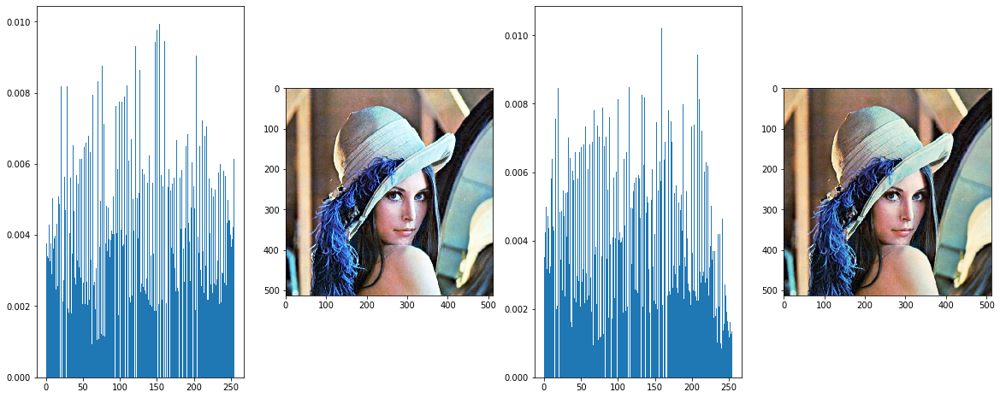

In [228]:
plt.figure(figsize = (20,8))
plt.subplot(141),plt.hist(cv2eqrgb.ravel(),255,[0,255],density = True)
plt.subplot(142),plt.imshow(cv2eqrgb.astype('uint8'))
plt.subplot(143),plt.hist(new_img2.ravel(),255,[0,255],density = True)
plt.subplot(144),plt.imshow(new_img2.astype('uint8'))
plt.savefig('cv2rgbeq_and_myrgbeq.png', bbox_inches='tight')
plt.show()

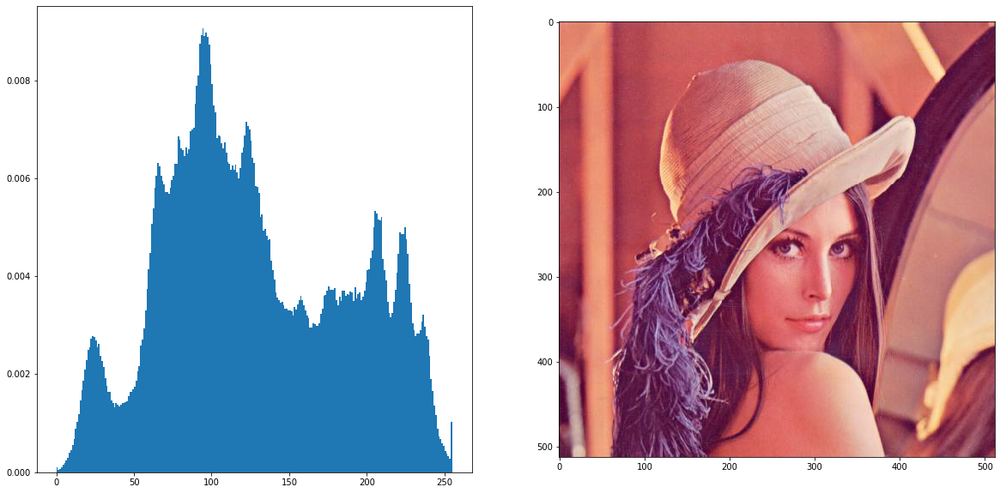

In [170]:
plt.figure(figsize = (20,10))
plt.subplot(121),plt.hist(img2.ravel(),max(img2.ravel()),[0,max(img2.ravel())],density = True)
plt.subplot(122),plt.imshow(img2.astype('uint8'))
plt.savefig('origin_mp2a.png', bbox_inches='tight')
plt.show()

In [62]:
# Separating the HSV channels
img2_cv2 = cv2.imread("mp2a.jpg")
HSV = cv2.cvtColor(img2_cv2, cv2.COLOR_BGR2HSV)
H, S, V = cv2.split(HSV)

In [63]:
# Applying my EH on the H channel
img2H_altered = my_histogram(H)

[ 15681.  31004.  41347.  53928.  67915.  76508.  86108.  93202. 102763.
 108873. 111788. 113667. 114677. 115601. 116511. 118625. 121486. 123220.
 124199. 124553. 124656. 124692. 124700. 124702. 124703. 124717. 124732.
 124749. 124781. 124842. 124938. 125068. 125292. 125584. 125913. 126303.
 126761. 127312. 128036. 128657. 129191. 130062. 131152. 132331. 133748.
 135543. 137390. 139611. 142757. 145715. 150249. 154629. 158948. 163796.
 169088. 173891. 177055. 179536. 183482. 185570. 187770. 191453. 196297.
 200677. 206211. 211452. 222555. 233949. 248379. 262144.]
This is i: 0
28
28
28
28
36
36
36
36
46
46
46
46
46
46
46
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
58
58
58
58
63
63
63
63
63
63
63
70
70
74
70
70
63
58
52
52
36
28
21
10
179
169
159
151
137
134
134
134
137
137
140
140
140
140
144
144
144
144
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
159
169
169
169
169
169
169
169
169
179
179
10
10
10
10
10
10
21
21
21
21


179
179
169
169
169
169
169
169
169
169
159
159
159
169
169
169
179
179
179
10
21
21
28
28
36
46
46
46
52
52
58
63
58
58
58
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
70
70
63
63
58
58
58
58
58
58
58
58
58
58
58
63
63
70
74
76
78
78
81
82
84
84
84
84
84
84
84
84
85
85
84
81
78
76
63
46
21
179
159
151
140
140
137
140
159
169
169
169
179
179
179
179
179
179
10
10
10
10
10
10
179
169
169
169
179
179
179
179
179
10
10
21
10
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
10
10
21
10
21
10
21
10
10
This is i: 5
36
36
36
36
36
46
46
46
46
52
52
52
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
70
70
70
70
70
70
70
70
63
58
58
52
46
36
21
10
179
169
169
151
137
134
134
137
137
140
140
140
144
144
144
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151

21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
169
169
169
169
169
169
169
169
159
159
159
159
159
159
159
159
169
169
169
179
10
10
21
28
28
28
28
36
46
52
52
52
52
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
70
63
63
58
58
52
52
52
52
52
52
58
58
58
58
58
58
58
63
70
76
77
78
78
81
81
82
82
82
82
84
84
84
84
84
84
82
79
78
77
70
52
21
179
151
140
144
159
169
169
169
179
179
179
179
179
179
10
10
10
10
10
10
179
179
179
179
179
179
10
10
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
169
179
179
169
169
159
144
137
134
126
122
115
108
105
102
This is i: 10
52
52
52
52
52
52
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
63
63
63
70
70
70
70
70
70
74
74
70
70
70
70
63
63
58
52
46
36
28
21
10


21
21
21
21
21
21
21
21
21
21
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
169
179
179
169
169
169
169
159
159
169
169
159
159
159
151
151
144
151
151
151
159
169
169
169
179
179
10
21
21
21
21
36
36
36
46
46
52
52
58
58
58
63
63
63
63
70
63
58
58
58
58
58
58
58
58
63
63
63
63
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
70
63
63
58
58
52
52
52
52
52
52
52
52
58
52
46
46
52
58
58
63
74
76
77
78
78
79
81
82
82
82
81
82
84
84
85
85
85
84
84
81
77
70
52
21
10
169
169
169
169
169
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
179
179
179
179
10
10
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
10
179
159
144
130
122
111
99
95
93
93
97
102
105
111
115
This is i: 15
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
5

21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
169
169
169
169
169
169
169
169
151
151
151
151
144
144
151
151
159
159
169
169
179
179
10
21
28
36
36
36
36
36
46
46
52
52
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
63
63
70
70
70
70
70
70
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
52
46
52
58
58
63
74
76
78
78
79
81
82
84
84
84
84
84
84
84
84
84
82
79
78
78
78
74
28
169
169
169
159
159
159
159
159
159
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
179
179
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
10
21
21
21
28


10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
179
169
169
169
169
159
159
159
159
159
159
159
159
151
151
151
151
159
159
159
169
169
179
179
179
21
28
28
28
28
36
36
36
46
46
52
52
58
58
58
58
52
52
52
52
58
58
58
58
58
58
63
63
63
63
63
63
70
70
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
46
46
46
46
52
52
58
63
63
70
74
77
79
82
82
84
84
85
85
85
85
85
85
85
84
84
84
79
76
70
63

63
58
58
52
46
36
28
10
179
169
151
144
140
140
140
140
144
144
151
151
151
151
151
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
169
169
169
169
169
169
159
159
159
169
169
179
169
169
159
159
159
159
151
151
151
151
159
169
159
179
10
21
28
28
28
28
28
36
46
46
52
52
52
52
52
52
52
52
52
52
52
5

10
179
159
151
144
130
118
102
102
102
105
105
105
105
105
105
105
105
108
108
108
111
118
120
120
120
120
120
120
120
120
120
120
120
120
120
120
120
This is i: 34
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
63
63
63
63
63
63
63
70
70
70
70
74
74
74
74
74
74
70
70
70
70
63
63
63
63
58
58
58
63
63
70
63
63
63
63
63
63
58
52
46
36
28
21
10
179
159
151
151
151
140
140
140
140
140
144
144
151
151
159
159
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
10
10
10
10
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
10
10
21
21
21
28
28
28
28
28
28
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
10
10
10
10
10
10


21
21
28
28
36
36
36
36
36
36
36
36
46
46
46
46
46
52
52
52
58
58
58
58
63
63
63
58
58
52
52
58
58
58
58
58
58
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
58
58
58
58
52
52
46
46
46
46
46
46
46
52
52
46
28
21
28
46
58
63
74
77
78
79
81
82
84
84
84
84
84
84
85
85
85
85
84
84
79
77
70
46
10
159
151
151
159
169
169
169
169
169
179
179
179
179
179
179
179
179
179
21
28
36
28
28
21
10
179
159
151
140
130
126
125
120
118
111
108
105
105
105
105
105
105
105
108
108
108
111
111
111
111
115
115
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
This is i: 39
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
63
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
63
63
63
58
58
58
58
63
63
58
63
63
63
58
58
52
52
36
36
21
10
10
179
159
151
151
151
140
140
140
140
140
144
144
151
151
159
159
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
179
179
179
179
179
179
179
10
10
10
10
10
10
10


10
10
10
10
10
10
10
10
10
10
10
10
10
21
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
10
10
10
10
179
179
179
179
179
179
179
179
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
169
169
169
169
169
169
169
169
169
169
159
159
159
159
151
151
151
151
151
151
151
159
169
169
179
179
10
21
21
21
21
21
21
21
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
52
52
52
58
58
58
58
58
58
58
58
58
52
52
52
52
52
52
52
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
58
58
52
52
46
46
46
46
36
36
46
46
46
52
52
58
58
63
63
58
58
58
58
63
70
74
77
78
82
84
84
85
84
84
82
84
84
85
85
85
85
85
82
79
76
63
46
10
169
159
159
159
169
169
169
169
169
169
179
179
179
179
179
179
10
179
169
151
140
134
126
122
118
111
105
102
102
99
102
102
105
105
108
108
108
108
111
1

58
58
58
63
70
63
70
70
70
70
70
70
70
70
63
63
63
58
58
58
58
52
52
52
52
52
52
58
58
58
63
70
70
70
70
63
63
63
58
58
58
58
63
63
63
63
63
63
58
52
46
36
36
21
10
179
169
151
151
151
151
144
144
140
140
144
144
144
151
151
159
169
169
159
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
179
169
179
179
179
179
10
179
179
179
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
21
10
21
10
21
10
21
10
21
10
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
10
10
10
10
10
21
10
21
21
21
21
21
10
10
10
10
10
10
10
10
10
10
179
10
10
179
169
169
169
169
169
159
169
159
159
151
151
144
144
144
140
144
151
159
159
159
159
169
169
169
10
10
21
21
21
21
21
21
36
36
36
36
36
36
52
52
58
58
58
63
58
63
58
63
52
46
46
46
46
46
36
28
28
21
10
179
179
169
169
169
179
179
179
169
169
169
169
169
179
179
179
179
179
10
10
10
10
10
10
10
10
10
179
179
179
179
179
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
17

21
21
21
21
21
21
21
28
28
21
21
28
28
36
36
36
36
46
46
52
52
52
52
52
52
52
46
46
46
46
46
46
46
46
46
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
52
58
63
63
70
70
76
78
81
82
82
82
84
84
84
85
84
84
84
84
84
84
84
81
78
74
58
36
10
179
169
169
169
169
151
137
130
125
118
108
102
105
105
105
105
108
108
108
108
115
115
115
115
115
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
115
115
118
118
118
118
120
120
120
120
This is i: 53
58
58
58
58
58
58
58
58
63
63
63
63
70
70
70
70
70
63
63
58
58
52
52
46
46
36
36
36
36
36
36
46
52
52
58
58
58
70
70
70
70
70
63
63
63
63
58
58
63
70
63
63
63
63
63
58
52
52
36
36
21
10
179
169
151
151
144
144
140
140
140
140
140
140
144
144
151
151
159
159
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
179
179
169
169
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10

10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
169
179
179
179
179
179
179
169
169
169
169
169
159
159
159
159
151
151
151
159
151
151
159
159
151
159
159
151
151
144
144
151
151
159
169
169
169
179
179
179
10
10
21
10
179
169
179
179
10
10
10
10
21
21
21
28
36
36
36
36
46
36
36
36
36
36
46
46
52
52
58
58
63
63
63
63
58
52
52
58
63
63
70
74
74
76
77
77
77
77
77
77
78
78
77
76
74
70
52
46
46
28
21
21
10
179
169
169
159
159
159
159
159
159
159
169
159
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
169
169
159
159
159
159
151
151
151
159
159
169
169
169
179
10
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
21
21
21
21
21
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
52
52
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
46
46
46
46
46
46
46
58
70
76
77
78
78
79
81
84
84
84
85
85
8

115
115
115
115
115
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
115
115
118
118
118
118
120
120
120
120
This is i: 62
63
63
70
70
70
70
74
74
74
70
70
70
70
63
63
63
58
52
52
46
28
21
10
10
10
10
10
21
21
36
36
46
52
58
63
63
63
70
74
74
74
74
70
70
70
70
63
63
63
70
63
63
63
63
63
58
52
52
36
36
21
10
179
169
151
144
140
140
140
140
137
137
137
140
140
144
144
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
179
179
10
179
10
179
10
179
10
179
10
179
10
179
10
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
10
10
10
179
179
179
169
159
169
159
169
169
169
169
169
169
169
159
159
151
151
159
159
151
151
151
159
169
169
169
169
179
179
179
179
179
179
179
10
169
169
179
179
179
179
179
179
10
10
21
28
28
28
46
46
46
46
46
36
36
28
28
28
28
28
46
46
52
52
52
52
63
63
63
70
76
77
76

74
74
74
74
74
74
74
74
76
76
76
76
77
77
77
77
76
76
77
77
74
74
74
74
74
74
70
70
76
76
74
70
63
52
36
21
10
169
169
159
151
151
144
151
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
159
159
159
159
159
169
159
159
159
159
151
151
159
159
159
169
169
169
179
10
10
21
21
28
28
36
36
36
46
46
46
46
36
36
36
36
28
28
28
28
28
28
21
21
21
21
21
21
21
21
21
21
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
58
63
70
76
78
78
82
84
84
84
84
84
78
76
63
28
140
122
108
99
97
97
99
102
105
108
108
108
108
111
111
111
115
115
115
115
118
118
120
120
120
120
122
120
111
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
102
102
105
108
111
118
120
122
122
122
120
118
118
115
115
111
This is i: 67
74
74
74
74
74
74
70
70
63
63
58
52
52
46
46
46
36
36
21
10
169
159
151


137
137
137
140
144
151
169
10
28
36
46
58
58
58
63
63
63
70
70
70
74
74
70
70
70
70
63
63
63
63
63
63
63
63
58
58
52
52
36
28
21
10
179
159
140
137
137
137
137
137
137
137
140
140
140
140
140
140
140
140
144
151
151
151
151
151
151
151
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
10
10
10
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
21
10
10
10
10
10
21
21
21
21
28
28
28
28
21
169
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
10
10
21
21
21
28
28
28
36
46
52
52
52
52
52
52
58
58
63
63
63
63
63
63
63
70
70
70
70
74
74
74
74
74
74
74
74
76
76
76
76
74
74
76
76
76
76
77
77
77
77
76
76
76
76
76
76
78
78
78
78
77
77
77
77
74
70
63
63
46
46
46
21
151
144
140
144
144
144
144
144
151
151
151
159
169
179
17

159
151
159
151
151
151
151
159
169
159
159
159
159
159
159
151
151
151
151
151
151
144
144
151
151
151
151
151
151
144
144
151
151
151
151
159
169
169
169
10
21
21
28
28
36
36
36
46
46
46
46
36
36
36
36
36
46
36
36
36
36
28
28
21
21
10
179
179
179
179
179
169
169
169
179
179
10
21
21
28
28
28
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
58
63
63
63
58
58
52
36
21
169
144
130
122
115
105
102
102
102
97
95
93
95
97
102
111
115
118
118
115
111
108
108
115
120
120
120
118
118
118
118
115
115
115
115
115
115
115
111
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
111
120
120
118
115
108
105
102
102
108
115
118
125
130
137
144
144
This is i: 76
63
63
63
63
63
58
58
58
52
46
28
21
10
179
169
159
140
140
140
140
140
140
140
144
151
169
179
21
28
36
36
52
58
58
63
63
63
70
70
70
74
74
70
70
70
70
63
63
63
63
63
63
63
63
58
58
52
52
36
28
21
10
179
159
140
137
137
137
13

63
63
63
63
63
63
63
58
58
52
52
36
28
21
10
179
159
140
137
137
137
137
140
140
140
140
140
140
140
140
140
140
140
144
151
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
151
159
159
159
159
169
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
179
179
10
10
10
10
10
179
10
179
169
169
169
169
169
169
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
179
179
179
179
179
179
169
179
169
169
169
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
169
179
169
179
179
179
179
10
10
10
10
10
10
21
28
46
46
46
52
52
58
58
63
70
70
70
70
70
70
74
70
74
70
70
74
70
70
70
74
74
74
76
77
78
77
77
74
63
63
63
63
63
58
58
58
52
58
46
46
46
46
58
74
77
76
77
76
76
76
76
74
74
74
74
74
70
70
74
76
78
81
84
84
85
85
81
76
52
21
159
140
137
134
137
144
151
151
151
159
159
159
169
169
169
159
159
151
144
144
140
140
140
140


78
78
78
78
77
77
77
77
76
76
74
74
74
74
74
70
70
74
76
78
79
82
84
84
81
78
70
21
169
151
144
140
137
137
137
137
140
140
144
151
151
159
159
151
151
151
144
144
140
140
140
140
140
140
140
144
144
151
151
159
169
179
169
179
179
10
10
21
28
36
36
46
52
52
52
52
46
46
46
46
36
36
36
36
36
36
28
28
21
10
179
169
169
159
151
144
134
130
134
134
137
140
144
151
159
169
179
10
10
21
21
28
36
36
36
36
36
36
36
36
36
36
36
36
46
46
36
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
28
36
36
36
36
36
36
36
36
36
46
46
52
52
46
28
10
179
159
140
134
125
120
115
108
105
105
105
105
108
108
111
115
115
115
115
115
115
115
118
118
118
118
120
120
120
118
111
108
108
108
108
108
111
111
111
111
115
115
115
115
118
118
115
111
111
111
111
111
108
108
108
108
105
105
105
105
105
108
111
115
120
122
126
134
140
151
169
21
28
36
46
46
46
52
This is i: 85
58
58
58
52
46
36
36
28
179
169
159
151
140
137
137
137
140
144
140
140
140
140
144
151
151
169
179
21
28
36
46
52
52
58
63
63
70
70
74
74
74

28
10
179
159
151
144
140
140
137
137
140
140
140
144
140
140
140
140
144
151
151
169
179
21
28
36
46
52
52
58
58
58
63
70
70
70
74
74
70
70
63
63
58
63
63
63
63
63
63
63
58
58
52
52
36
28
21
10
179
159
140
137
137
137
140
140
140
140
140
140
144
144
140
140
140
144
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
28
28
36
36
46
52
52
52
58
58
58
58
58
58
58
58
58
58
58
63
58
63
58
52
46
46
46
36
36
21
28
28
36
46
52
52
58
58
70
76
76
77
77
78
78
78
78
76
74
70
74
74
74
74
74
74
74
74
74
76
76
76


70
70
70
70
58
58
70
70
70
70
70
70
63
63
63
63
70
70
70
70
70
74
74
74
76
76
76
77
78
79
78
77
76
63
52
52
63
70
76
78
78
81
82
84
84
82
70
36
169
151
140
140
134
134
134
134
137
137
140
140
140
140
140
140
140
140
140
144
144
151
151
159
159
169
169
179
179
10
10
21
28
36
36
46
52
52
52
52
46
46
46
46
36
46
46
46
36
36
28
28
21
21
10
179
169
159
151
144
130
126
125
125
122
122
122
125
126
130
134
140
144
159
159
179
21
28
28
28
28
28
28
28
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
36
36
21
10
169
151
151
134
120
108
105
105
105
102
102
102
105
108
108
111
115
118
118
120
122
122
120
120
120
120
118
118
115
115
111
111
108
108
108
111
115
118
118
118
115
115
115
115
111
111
108
108
108
108
108
105
111
111
108
102
99
99
95
95
99
105
115
122
126
130
134
140
169
179
10
10
21
21
28
36
28
28
28
28
28
28
28
28
This is i: 94
28
28
21
179
159
151
140
137
134
134
137
140
151
159
169
169
151
144
140
140
140
140
144
151
151
169
179
21
28
36
4

144
140
140
140
144
144
151
169
179
10
28
36
36
46
52
52
58
58
58
58
58
63
63
63
63
58
58
58
58
58
63
58
58
63
63
58
58
52
46
36
28
21
179
179
159
140
134
134
134
137
137
140
140
140
140
140
144
144
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
169
179
179
179
10
10
10
10
10
179
179
169
169
151
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
28
21
21
21
28
28
21
21
10
21
21
28
28
36
63
74
74
74
70
70
70
70
70
70
63
63
63
63
70
63
58
58
58
58
58
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
70
74
74
74
74
74
74
74
74
74
74
74
74
74
74
76
78
78
78
78
78
77
74
52

74
70
74
74
74
74
74
74
74
74
74
74
74
74
74
74
76
77
78
78
79
79
81
81
78
78
76
63
46
21
21
10
159
140
134
134
134
134
134
134
137
140
144
159
169
179
10
21
21
28
28
28
28
36
36
36
36
36
36
46
46
46
46
46
36
36
28
28
36
46
46
36
36
21
10
179
169
169
169
159
144
134
126
125
120
118
111
105
105
105
108
118
125
128
134
137
144
159
169
169
169
179
10
10
21
28
36
36
36
46
46
46
46
52
52
52
52
52
46
46
46
36
36
36
36
36
36
28
36
36
36
36
36
28
21
179
169
151
137
128
122
111
102
95
97
105
108
111
111
115
115
115
115
118
118
118
118
118
118
118
118
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
111
111
111
111
108
108
108
108
105
105
105
105
102
99
97
97
102
111
122
130
140
159
179
21
21
21
10
179
169
169
10
21
21
28
28
36
36
46
46
52
58
58
63
63
63
63
This is i: 103
144
144
144
144
144
144
144
144
144
144
144
144
144
144
144
144
151
151
144
144
140
140
140
144
144
151
169
10
21
28
36
46
46
52
52
58
58
58
58
58
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
52
46
46
36


58
58
58
58
58
63
63
63
63
58
58
58
58
52
52
52
58
58
58
52
52
46
36
28
21
179
169
169
151
137
134
134
134
137
137
140
140
140
140
140
144
144
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
10
36
46
46
36
36
36
28
28
21
10
179
169
169
159
151
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
169
169
169
169
169
169
169
169
169
179
179
179
10
10
10
21
28
36
36
36
52
52
52
63
63
70
70
76
76
76
76
76
70
63
63
63
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
70
74
74
74
74
74
74
74
74
74
74
74
74
74
74
74
70
76
74
78
77
81
78
81
84
84
84
84
81
81
81
77
46
179
151
137
134


85
81
74
28
151
137
134
130
128
130
134
140
151
169
179
21
21
28
28
28
28
36
36
36
36
36
46
46
46
46
46
46
36
36
36
36
46
46
36
28
21
21
179
169
169
169
159
144
134
126
125
125
120
118
118
115
111
111
115
115
115
115
118
118
120
120
125
126
130
137
144
151
159
179
179
10
21
21
21
28
46
46
52
46
36
36
36
36
36
36
36
46
46
52
52
36
179
151
140
134
126
120
108
102
97
97
99
102
105
108
111
115
118
118
118
118
118
118
118
120
118
120
120
120
120
120
120
118
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
115
115
115
111
108
105
105
105
105
105
108
111
111
115
115
125
151
10
179
179
179
169
169
169
169
169
179
10
10
21
21
28
46
46
52
52
52
52
52
52
58
58
58
58
58
58
58
58
This is i: 112
140
144
144
144
144
144
144
144
144
144
151
151
151
151
151
151
144
144
144
140
140
137
137
140
144
159
169
179
21
28
36
46
52
52
58
58
58
58
63
63
63
63
63
63
63
58
58
58
58
58
52
58
58
58
52
52
46
36
36
21
10
179
169
151
140
134
134
134
134
134
134
134
134
137
140
144
144
144
151
151
151
151

134
134
134
134
137
140
144
140
151
151
151
151
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
151
151
159
159
159
159
159
159
169
10
21
21
21
179
159
159
151
159
169
179
28
58
78
78
74
52
10
159
144
140
144
151
151
159
159
159
151
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
169
169
169
169
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
21
10
10
10
179
169
159
151
151
144
151
159
169
169
179
10
21
28
46
46
52
52
58
58
63
63
63
63
58
58
58
58
58
63
63
52
52
58
58
52
52
52
52
52
63
63
63
58
63
63
63
63
63
63
70
63
63
70
70
58
58
58
58
58
58
58
58
63
63
70
70
70
70
70
58
46
46
46
52
46
52
46
58
46
58
52
58
52
58
58
63
70
70
70
70
70
70
74
74
76
76
76
76
77
77
77
77
63
63
63
63
74
74
74
74
76
76
77
77
77
77
77
78
81
84
84
84
78
63
179
140
130
128
128
130
137
151
169
10
21
21
21
28
28
28
36
36
46
46
46
46
52
52
52
52
46
46
46
46
46
46
36
36
21


134
130
128
125
120
115
105
102
99
97
99
99
99
99
99
102
118
134
151
46
74
78
81
82
81
81
79
77
70
58
28
46
76
78
78
78
77
78
77
77
78
78
79
82
84
84
85
78
134
105
95
91
88
88
88
91
93
102
108
111
115
111
111
111
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
108
102
99
102
105
108
115
122
125
128
134
140
151
179
10
21
10
169
169
169
169
179
10
21
28
36
46
46
52
58
58
63
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
This is i: 121
140
140
144
144
144
144
144
144
144
144
151
151
151
151
151
151
151
151
144
144
140
140
140
144
144
159
169
10
21
28
36
46
52
52
58
58
58
58
58
63
63
63
63
63
58
58
58
58
58
58
58
58
58
58
58
52
46
36
36
28
10
179
169
151
140
134
134
134
134
134
134
134
134
137
140
144
140
151
151
151
159
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
151
159
159
159
169
169
169
169
169
169
169
169
169
179
179
179
169
159
151
151
159
179
36
63
77
78
78
76
63


169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
169
169
169
169
169
159
159
159
169
169
169
169
179
179
179
179
179
179
10
10
10
10
10
179
169
169
169
159
159
159
159
169
169
179
10
36
46
52
58
58
52
46
46
46
46
36
28
28
28
28
36
46
46
46
46
36
28
28
36
36
36
36
46
46
52
52
58
58
63
63
63
70
70
70
70
70
63
63
63
63
58
58
58
58
52
52
52
52
46
46
46
46
52
52
52
52
58
58
58
58
58
58
58
58
63
70
63
70
70
70
70
74
70
74
74
76
74
76
74
74
70
58
58
58
58
58
70
70
70
70
70
70
70
70
74
74
63
63
63
63
74
74
74
74
76
76
77
77
77
77
77
74
70
70
70
77
78
78
84
81
77
36
151
144
151
151
151
169
10
21
21
28
28
28
36
36
46
46
46
46
52
52
52
52
46
46
46
46
46
46
36
36
21
21
21
179
169
169
159
144
128
120
118
111
102
97
95
95
97
105
120
134
169
70
78
78
70
63
52
52
46
46
28
46
46
63
74
76
77
78
78
78
78
78
77
77
74
70
70
70
70
70
76
78
81
84
85
84
74
28
137
120
102
97
95
95
99
102
108
111
111
111
108
111
111
115
115
115
115
115
115
115
115
115
115
115
115
115
115
1

46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
This is i: 130
159
159
159
159
159
159
159
159
159
159
151
151
151
151
151
151
159
159
159
159
151
151
144
151
151
159
169
179
21
28
36
36
46
52
52
58
58
58
63
63
70
70
70
70
70
70
70
70
70
70
63
63
63
58
58
52
46
46
36
28
21
21
179
169
151
140
140
140
137
137
137
137
137
140
140
144
144
151
151
151
159
159
151
151
159
159
159
159
169
169
169
169
169
169
169
169
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
159
169
10
36
36
21
179
159
151
151
179
46
77
79
81
78
70
52
46
36
21
169
151
144
140
140
140
151
151
159
169
159
151
151
151
151
151
151
151
151
151
159
159
169
169
169
169
169
179
179
179
179
169
169
169
169
169
169
169
169
169
159
159
169
10
21
21
10
10
10
179
179
179
179
169
169
169
169
159
159
159
169
169
10
21
28
36
46
46
52
52
52
52
46
46
46
46
46
46
46
36
36
28
28
28
28
36
36
46
46
46
52
36
36
36
36
36
36
36
36
36
36
46
46
46
46
52
52
52
58
52
52
52
52
52
52
52
52
46
4

70
70
70
70
70
70
58
58
52
58
58
58
52
52
58
58
52
52
58
58
46
58
63
70
63
58
58
52
52
52
46
46
46
52
58
58
63
63
63
63
58
46
36
10
179
169
159
159
169
10
28
58
70
70
46
36
36
52
70
76
77
77
78
78
76
70
58
52
36
52
58
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
76
74
74
74
74
63
63
76
76
77
78
78
81
81
78
58
159
128
111
97
93
92
93
99
102
108
111
115
115
111
111
111
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
118
120
118
118
115
115
111
111
108
108
108
108
111
111
111
120
137
151
159
159
159
169
179
10
21
21
21
21
28
28
28
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
This is i: 135
159
159
159
159
159
159
159
159
159
159
151
151
151
151
151
159
169
169
159
159
151
151
151
151
159
169
169
10
21
28
36
46
52
52
52
58
58
58
63
63
70
70
70
70
70
70
70
70
70
70
63
63
63
58
58
52
46
46
36
28
21
21
179
169
151
140
140
140
137
137
137
137
137
140
140
144
144
151
151
151
159
159
151
151
159
159
159
159
169
169
169
169
169


169
169
169
169
169
169
169
179
179
179
179
179
179
159
159
159
159
159
169
169
169
179
179
10
10
10
10
10
21
28
36
28
28
21
21
179
179
169
169
179
179
179
179
179
10
10
21
21
28
28
36
36
46
46
46
52
52
46
46
46
46
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
52
46
52
52
52
52
52
52
52
52
58
58
58
63
63
63
63
63
63
63
63
58
58
46
46
46
46
46
46
46
52
52
58
58
70
70
70
70
70
70
70
70
70
58
58
58
58
58
58
58
58
52
58
52
58
58
58
46
46
52
52
46
46
46
46
28
52
78
81
77
58
46
36
36
46
46
52
52
52
52
52
46
36
28
28
28
36
46
63
70
76
78
78
78
77
74
70
63
63
63
74
74
76
76
78
78
78
78
78
77
77
76
76
76
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
76
74
74
74
74
63
63
76
76
77
78
78
81
81
74
151
125
115
105
95
92
92
93
97
102
111
115
111
111
105
108
108
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
111
111
108
108
108
111
118
120
125
128
134
137
140
151
10
21
21
21
10
10
10
1

74
70
70
70
70
70
70
70
70
63
63
63
58
52
52
36
28
21
10
179
169
151
140
140
140
137
140
140
140
140
140
144
151
151
151
159
159
151
151
151
151
151
151
151
151
151
159
151
159
159
159
159
159
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
179
21
21
179
151
140
140
144
179
63
78
82
82
79
77
76
70
58
52
46
36
28
21
179
169
159
159
151
151
151
151
151
151
151
151
151
151
159
169
169
169
169
169
169
169
159
159
159
169
179
10
10
179
179
169
169
169
159
159
159
159
151
151
151
159
151
159
159
169
179
10
21
28
28
28
36
36
36
28
28
28
21
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
28
28
28
28
28
28
28
36
36
36
36
36
36
36
46
46
52
52
46
46
46
36
36
36
28
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
46
52
52
46
46
46
46
46
28
28
36
36
36
36
46
46
46
58
58
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
46
46
46
46
52
58
58
58
63
63
63
63
63
63
63
70
70
70
63
58
58
52
46
46
46
52
52
58
58
58
63
76
76
74
70
70
70
58
58
58
46
46
36
36
36
28
28
28
28
179
10
179
21


111
111
111
111
111
111
115
115
115
115
115
111
102
102
105
108
118
122
128
134
140
159
159
179
10
21
10
10
179
169
179
10
21
21
28
36
46
46
52
52
46
46
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
This is i: 149
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
159
169
169
179
10
21
28
28
28
36
52
52
58
58
63
70
70
74
74
74
74
74
70
70
70
70
63
70
70
70
70
63
63
63
52
52
36
36
21
10
179
169
151
140
140
140
140
140
140
140
140
144
144
151
151
159
159
169
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
10
179
169
151
140
140
151
21
74
81
84
82
78
77
76
74
63
58
52
52
36
28
21
10
179
179
169
169
169
169
169
159
151
151
151
151
159
159
169
169
169
169
169
169
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
159
169
169
179
10
10
10
21
21
21
28
28
28
21
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21

28
28
28
28
21
21
10
21
21
28
28
28
36
36
36
46
46
46
46
52
76
77
76
77
76
76
76
76
74
76
74
74
74
74
76
76
76
76
74
76
76
76
74
76
76
76
70
74
74
74
74
74
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
78
78
77
74
74
63
52
52
46
36
46
46
46
46
46
52
63
70
58
46
46
46
63
74
78
79
79
77
52
169
137
125
108
102
105
105
105
105
108
108
111
111
111
111
111
111
115
115
111
111
111
111
111
111
111
111
111
111
115
115
115
115
115
115
111
111
118
125
128
137
144
159
179
10
21
21
21
21
21
21
21
28
28
28
36
46
46
46
46
46
46
46
36
36
28
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
This is i: 154
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
169
169
169
179
21
21
28
36
36
52
52
58
58
63
70
70
74
74
74
74
74
70
70
70
70
63
70
70
70
70
63
63
63
52
52
36
36
21
10
179
169
151
140
140
140
140
140
140
140
140
144
144
151
151
159
159
169
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151


10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
21
10
21
21
21
21
21
10
21
21
21
28
36
36
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
52
52
52
52
52
52
52
52
36
36
28
28
28
21
21
21
21
28
28
28
28
36
36
36
36
46
46
46
52
52
36
36
36
36
46
46
46
46
36
36
28
28
28
21
10
10
10
10
21
28
28
28
28
28
28
28
21
10
10
10
10
21
36
52
52
52
52
63
63
70
70
74
76
77
77
78
78
77
58
46
46
52
52
58
58
70
70
74
76
76
76
76
76
74
63
58
58
58
58
63
58
58
58
58
52
52
46
46
46
58
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
76
76
70
58
52
46
46
36
28
36
36
46
46
46
46
46
46
36
36
36
46
58
70
76
76
70
21
137
120
108
102
102
102
105
105
105
105
108
108
111
111
111
111
111
111
115
115
111
111
111
111
111
111
111
111
111
111
115
115
115
115
115
118
125
130
134
140
159
179
10
21
21
21
21
10
169
159
144
159
28
46
46
52
52
52
52
58
52
52
46
46
28
28
21
28
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46


169
169
169
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
159
151
144
140
159
10
58
78
79
81
81
78
77
74
70
70
70
70
63
58
58
52
52
46
36
36
28
28
28
28
10
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
179
179
10
10
10
10
10
10
10
179
179
179
169
179
169
179
179
179
179
10
10
10
10
21
21
28
28
28
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
21
21
21
10
21
21
21
10
10
10
10
10
21
21
28
28
28
28
28
36
36
46
46
46
46
46
46
46
36
36
28
21
10
10
10
10
10
10
10
21
28
28
28
10
10
10
10
21
21
28
28
28
28
10
10
179
169
159
169
21
36
36
36
36
46
28
28
21
28
28
28
10
21
10
10
10
10
10
10
10
10
10
28
28
28
36
36
36
36
36
52
63
74
74
76
74
76
74
74
74
74
76
74
76
77
74
74
74
74
74
74
74
74
74
74
74
74
74
74
74
74
74
70
70
63
63
63
63
63
63
63
63
63
63
63
63
63
63
58
46
36
46
46
46
52
58
70
70
70
70
74
74
76
76
76
63
63
58
52
52
46
36
36
28
28
36
36
36
36
36
28
179
179
28
46
6

10
10
21
21
21
21
28
28
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
This is i: 168
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
159
159
169
179
10
21
21
28
28
46
52
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
74
70
70
70
70
63
63
58
52
36
36
21
10
179
159
151
140
140
140
137
137
137
137
137
140
140
144
144
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
159
151
144
140
159
21
74
78
81
82
82
81
78
76
74
74
74
74
70
70
63
58
58
52
52
52
52
52
52
52
36
28
21
21
10
179
169
169
159
159
159
159
159
169
169
169
179
179
10
10
10
179
179
179
169
169
169
169
159
159
159
159
169
179
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
10
10
179
179
179

128
137
144
144
140
140
140
137
137
137
137
134
134
134
134
134
137
144
159
159
169
169
169
10
10
169
179
159
159
144
144
144
144
151
159
159
159
159
159
159
159
151
144
137
134
130
128
126
128
137
137
140
140
144
144
151
159
169
10
21
36
46
52
58
58
58
63
63
58
58
63
58
63
58
63
70
70
70
70
70
74
76
77
76
76
76
76
76
74
74
74
70
70
58
58
58
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
77
78
78
77
78
76
70
63
63
52
52
46
21
10
10
179
179
169
169
159
151
151
144
144
144
144
140
144
151
10
52
76
78
78
70
159
118
99
93
93
97
105
115
118
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
108
108
105
105
102
102
108
115
118
125
134
144
169
10
28
28
10
179
10
21
21
21
28
36
36
36
46
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
This is i: 173
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
1

151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
169
169
159
169
169
169
179
179
10
21
28
36
46
46
52
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
70
70
70
70
63
58
46
36
28
10
10
169
151
144
140
140
137
137
137
137
137
140
140
144
144
151
151
151
159
159
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
151
151
159
169
28
70
78
79
82
84
82
81
78
78
77
77
78
78
78
77
76
70
58
46
36
28
36
52
52
58
52
52
46
36
28
21
10
179
169
169
159
159
169
179
10
179
159
151
151
151
144
144
144
151
151
169
179
10
21
28
28
21
179
169
169
169
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
169
169
179
179
179
10
10
179
10
179
179
10
169
159
151
151
151
151
144
144
140
140
137
134
134
134
134
130
130
134
134
134
130
128
126
125
122
118
115
108
102
99
97
93
99
122
137
130
130
128
128
126
125
120
111
102
97
93
91
92
92
91
91
92
92
93
97
99
102
108
111
115
115
118
120
122
118
108
105
108
108
1

10
28
46
52
52
58
63
63
63
70
70
70
70
70
70
70
70
74
74
74
74
76
76
76
76
74
74
76
76
74
74
74
74
70
70
74
74
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
77
78
78
78
78
78
78
78
78
77
74
70
63
63
63
52
28
10
10
10
169
169
169
159
151
151
144
144
144
140
140
140
140
144
144
144
144
151
159
169
10
28
46
58
70
76
77
74
36
169
144
130
125
115
108
102
99
99
102
105
111
115
118
118
111
111
111
115
118
118
120
120
120
120
118
115
111
108
108
102
97
95
99
108
120
128
144
169
28
46
46
28
10
159
144
144
10
28
28
28
28
28
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
28
28
21
21
21
21
28
28
28
28
36
36
36
36
36
36
36
36
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
This is i: 182
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
169
169
159
169
169
169
179
179
10
21
28
36
46
46
52
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
70
70
70
70
63
58
46
36
28
10
10
169
151
144
140
140
137
137
137
137
137
140
140
144
144
151
151

151
151
151
151
151
151
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
151
144
144
144
159
10
52
77
78
79
82
81
79
79
79
79
79
79
79
78
74
63
46
28
10
21
21
36
46
46
36
21
21
10
179
159
151
151
144
144
151
151
159
169
179
179
159
159
159
169
169
179
179
179
179
169
169
169
169
159
159
151
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
159
159
151
151
144
140
137
134
130
134
140
140
137
134
130
126
122
120
118
115
111
115
111
115
115
111
108
108
108
108
105
105
105
102
102
99
97
97
97
97
97
93
90
88
87
87
86
86
87
88
89
91
93
93
93
92
91
91
93
95
93
93
93
93
92
92
92
91
90
90
90
90
90
91
92
93
92
91
89
89
87
88
91
93
105
118
126
134
140
169
10
28
28
28
28
28
36
46
36
36
46
52
52
58
52
63
70
76
76
76
74
74
74
74
70
70
70
70
70
70
70
70
74
74
76
76
74
74
74
74
70
70
74
74
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
63
58
52
52
46
36
28
21
10
179
179
169
169
151
140
140
140
140
140
140
144
144
144
151
1

118
118
120
120
120
118
118
118
118
115
115
115
115
115
115
118
118
115
115
111
108
105
99
95
92
91
97
120
128
140
159
10
21
21
10
169
151
144
159
10
36
58
63
58
58
52
52
46
46
46
46
36
36
28
28
28
28
28
28
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
21
21
21
21
28
28
28
28
36
36
36
36
36
36
36
36
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
This is i: 191
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
159
169
169
169
169
179
10
21
28
36
46
46
52
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
63
58
46
36
28
10
10
169
151
140
140
140
137
137
137
137
137
137
140
144
144
151
151
151
159
159
151
151
151
151
151
151
151
151
151
151
151
159
151
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
159
169
169
169
151
144
140
140
144
159
21
52
74
81
79
82
82
81
81
81
79
79
78
77
74
63
52
36
28
21
21
28
36
52
52
58
46
36
28
10
169
169
151
151
151
151
151
159
159
159
169
179
179
179
179
179
179
179
169
179
159
159
151
151
151
15

130
128
125
122
115
105
102
102
99
99
97
97
97
97
97
97
99
102
102
105
105
105
102
102
99
99
97
97
95
93
93
93
93
93
93
97
102
102
102
102
99
97
97
95
93
92
91
91
89
89
88
88
90
90
90
90
90
90
90
90
89
90
89
89
88
89
89
97
122
130
137
144
159
10
21
36
36
46
52
52
52
46
46
58
63
74
70
70
70
70
63
63
58
58
52
52
52
52
46
52
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
70
74
74
74
70
70
70
70
63
63
70
70
58
70
76
77
76
74
58
36
21
169
144
134
128
125
120
118
115
115
118
118
120
122
125
128
134
140
144
169
10
21
28
46
46
46
52
58
58
58
63
63
63
63
63
70
63
63
63
58
58
58
58
52
28
179
140
126
118
108
105
102
102
105
111
115
118
120
120
120
120
120
118
118
118
118
115
115
115
115
115
115
115
115
111
115
118
120
120
120
118
111
102
102
99
102
108
111
118
128
159
179
10
10
10
10
21
21
28
28
36
36
46
46
46
46
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
36
36
36
36
36
36

159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
179
10
21
28
36
36
46
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
58
58
46
36
21
10
179
169
144
140
137
137
134
134
134
134
137
137
140
144
144
151
151
159
151
151
151
151
151
151
151
151
159
159
159
159
169
169
159
169
151
151
151
151
159
159
159
159
169
169
159
159
169
169
169
169
169
169
169
169
151
151
144
151
151
169
10
28
52
63
78
78
78
81
79
81
78
78
77
77
76
74
74
70
63
70
63
52
21
179
179
179
169
169
159
159
159
159
159
169
179
179
179
179
159
151
151
151
151
151
159
159
159
159
159
159
159
159
159
159
151
151
151
151
151
159
169
169
169
169
159
159
151
151
151
144
134
130
128
128
126
125
122
120
118
118
115
108
105
105
102
102
97
97
95
95
93
92
92
93
93
95
95
97
99
102
102
105
102
102
99
99
97
97
97
97
97
97
97
97
102
102
102
102
102
105
105
102
99
99
97
97
93
93
92
91
90
90
89
90
91
91
89
87
86
85
85
85
86
87
92
105
120
128
134
144
169
10
179
179
179
10
179
21
21
36
52
63
76
77
77
76


63
63
70
70
70
70
74
63
52
46
46
46
46
46
52
52
52
52
58
63
63
70
70
70
58
52
58
52
52
46
52
46
46
46
46
46
36
36
46
10
140
134
130
130
126
125
120
118
118
118
118
122
125
128
130
130
130
130
128
126
125
122
122
125
128
134
144
169
10
28
36
52
70
74
74
70
70
63
52
46
10
169
140
130
125
118
115
111
111
115
115
115
115
118
118
118
118
120
118
118
118
118
118
118
120
120
120
120
118
118
118
118
115
115
115
115
115
115
115
115
111
115
115
118
118
118
111
108
105
108
115
125
134
144
10
10
169
159
159
169
169
10
21
28
36
46
52
58
63
70
70
70
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
28
28
This is i: 205
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
169
169
169
169
179
10
21
28
36
36
46
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
58
58
46
36
21
10
179
169
144
140
137
137
134
134
134
134

151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
169
169
151
151
151
144
151
179
21
46
74
76
78
79
81
79
78
78
76
76
74
70
63
46
46
36
28
21
10
169
169
151
151
151
151
151
159
159
159
151
151
144
144
144
144
140
140
140
140
140
137
137
137
137
134
126
125
125
125
125
126
126
126
125
125
122
118
115
111
108
108
108
108
108
108
108
108
105
102
99
99
99
99
97
95
95
97
95
93
93
93
95
95
95
95
95
95
95
95
95
95
95
95
95
99
99
99
102
105
105
108
108
108
108
108
105
105
105
99
93
91
91
92
93
93
95
95
93
92
91
90
88
87
87
87
88
89
90
89
89
89
91
92
93
97
102
108
122
130
159
46
70
74
74
76
76
76
76
76
74
74
63
63
52
36
36
46
52
63
63
63
63
63
63
63
63
70
70
70
70
70
70
63
52
46
46
46
46
46
46
46
46
36
36
36
36
36
36
46
52
52
52
52
46
46
36
36
46
52
52
58
58
63
70
58
36
21
179
169
144
137
130
126
125
122
120
120
122
125
126
126
125
125
120
118
111
111
111
111
122
128
144
169
10
28
3

115
115
118
125
130
137
159
10
28
28
28
10
169
144
130
122
115
108
102
105
105
108
111
111
115
111
115
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
120
120
118
118
115
115
111
111
111
111
115
115
118
118
118
118
108
105
108
111
115
118
120
125
128
134
140
144
151
169
169
169
169
169
179
21
28
46
58
58
58
63
63
63
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
52
52
52
52
52
46
46
36
36
36
36
28
28
28
28
This is i: 214
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
179
179
169
169
151
151
151
151
159
159
169
179
21
28
28
36
52
58
58
58
58
63
63
63
70
70
70
70
74
74
70
70
70
70
74
74
70
70
63
63
58
58
52
46
36
36
21
179
151
140
137
137
137
137
134
134
137
140
140
144
140
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
179
179
10
10
179


169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
10
10
179
179
169
169
169
169
169
151
159
10
52
77
81
85
85
85
84
82
77
74
58
52
28
179
169
169
169
151
151
151
144
140
144
144
144
140
144
144
144
151
151
151
151
151
151
159
159
151
159
159
159
159
169
159
151
137
130
130
126
125
122
118
115
111
108
105
102
102
99
99
99
102
102
102
102
102
102
102
102
99
99
99
97
97
97
97
97
99
102
102
102
97
97
97
97
93
93
92
92
91
91
90
90
90
90
92
95
99
102
105
108
108
108
108
108
105
102
102
102
99
102
99
102
99
102
102
102
108
111
115
120
125
125
126
128
126
122
111
99
91
90
93
115
137
28
63
70
74
74
70
63
63
63
63
58
52
52
52
46
46
46
36
36
36
36
46
46
36
36
36
36
28
46
36
36
28
36
36
46
46
36
36
36
36
46
46
46
46
46
52
52
52
52
52
52
58
58
58
58
58
58
58
58
52
52
46
46
52
58
58
63
63
70
74
70
70
58
46
28
10
169
159
144
137
130
126
120
111
105
97
102
115
120
120
120
118
118
120
122
126
130
137
140
151
159
169
159
140
134
126
120
111
105
102
102
102
108
111
115
115
115
108
111
118
118
1

108
111
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
115
108
108
111
115
118
120
120
122
122
122
118
118
115
111
108
105
105
108
115
122
130
144
169
28
28
36
28
28
21
179
169
179
28
46
46
46
36
36
46
46
46
46
52
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
21
21
This is i: 223
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
169
169
159
159
151
151
144
151
151
151
169
169
10
21
28
36
52
58
58
58
58
58
63
63
70
70
70
70
70
74
70
70
70
70
70
70
70
63
58
58
58
52
46
36
28
21
10
169
151
137
140
137
137
134
134
134
134
137
140
144
140
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
159
169
169
169
169
169
169
169
169
169
169
179
179
179
10
10
10
10
10
179
179
179
179
169
151
151
179
36
70
78
84
84
84
81
76
58
36
179
159
159
169
179
169
169
159
159
1

159
159
169
169
179
179
179
169
169
159
151
144
140
134
130
126
125
122
120
120
118
118
118
120
120
118
118
115
108
105
102
97
97
97
97
102
102
102
102
105
105
105
105
105
105
105
105
102
102
102
102
99
99
97
97
99
99
99
99
97
97
97
97
93
93
92
92
92
92
92
92
91
90
91
91
91
92
95
102
102
105
105
105
102
102
95
111
130
144
144
159
159
159
169
179
10
21
21
28
36
46
52
46
46
28
10
144
128
122
118
115
120
134
169
28
36
52
46
46
36
46
36
46
46
46
46
46
46
36
28
36
28
28
21
28
36
36
36
28
28
28
28
28
28
28
36
36
46
52
58
58
52
52
52
52
52
52
52
52
58
58
58
58
58
58
63
63
63
63
63
63
63
63
70
70
70
70
70
70
74
74
74
74
70
70
63
58
46
36
21
10
159
144
140
134
128
122
115
111
111
111
111
111
111
111
115
115
120
122
128
137
151
169
21
169
130
122
118
115
108
108
108
115
122
122
125
125
122
120
115
115
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
115
115
115
115
118
118
120
120
118
118
111
108
105
102
102
105
120
128
137
144
169
10
21
21
10
179
179
10
21
36
46
52
52
46
46
46
46

36
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
36
36
36
36
36
36
36
36
36
36
36
36
28
28
28
28
This is i: 232
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
159
159
151
151
151
151
151
159
169
179
10
21
28
36
46
52
52
52
58
58
63
63
63
63
70
70
70
70
70
70
74
74
74
74
70
70
63
63
58
52
46
36
28
21
10
169
140
134
134
134
134
134
134
134
134
137
140
144
140
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
169
169
159
159
151
151
151
151
151
159
159
169
169
169
179
179
10
10
179
179
179
179
179
179
179
179
179
179
179
10
10
169
144
144
151
159
179
21
46
58
63
77
70
58
52
36
21
10
169
169
169
179
179
10
21
21
21
21
179
169
159
151
144
151
151
151
151
140
137
134
126
125
120
118
111
105
102
102
99
102
105
105
108
105
105
105
105
105
105
102
102
102
97
97
97
99
102
105
105
105
105
105
105
105
102
102
102
102
99
99
97
97
99
99
99
99
97
97
97
9

28
28
36
28
36
46
46
46
52
58
63
70
74
74
74
70
63
28
169
137
137
137
137
151
10
28
36
28
28
10
21
21
28
21
21
10
21
10
10
10
10
10
10
10
10
10
10
21
28
28
28
28
36
36
36
36
36
46
46
46
46
46
46
46
52
52
52
52
52
52
52
58
58
58
58
58
58
63
63
63
63
63
63
63
63
70
70
70
70
70
70
74
74
74
70
63
63
63
63
63
58
46
28
21
179
159
144
140
137
134
126
115
102
102
102
102
102
108
108
115
120
125
130
134
144
159
159
144
137
128
125
118
108
105
105
108
115
115
118
115
115
111
111
115
118
118
118
118
118
118
118
118
118
118
118
118
118
118
118
120
120
118
118
115
115
111
111
115
115
118
118
122
125
125
134
159
10
21
28
28
28
28
21
10
10
10
28
46
63
74
76
70
63
63
63
63
63
58
58
58
58
52
52
52
52
52
52
52
52
46
52
46
52
46
52
46
52
46
52
46
52
46
36
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
36
36
28
28
28
28
28
28
36
36
28
28
36
36
36
36
46
46
46
46
This is i: 237
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
159
159
151
151
151
15

137
137
134
134
134
134
134
137
137
140
140
140
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
169
169
169
169
169
169
169
169
169
169
169
179
10
21
10
10
10
10
179
179
179
10
179
10
179
179
10
169
151
159
36
58
58
36
169
144
144
169
46
70
63
46
169
140
128
125
122
120
120
120
125
128
134
140
151
151
151
144
140
130
115
99
97
97
93
93
91
91
90
90
90
90
91
90
91
93
97
99
99
99
99
99
97
97
97
97
97
97
97
97
97
97
105
105
108
108
108
108
105
105
102
102
102
99
97
97
95
95
95
95
92
92
92
91
91
91
92
92
93
95
95
97
99
95
89
90
99
118
130
140
140
140
137
137
137
140
169
36
58
63
46
46
36
36
36
36
36
36
28
28
36
52
63
76
77
76
46
28
28
36
46
52
63
58
52
46
36
28
10
179
179
179
10
10
10
179
179
179
179
179
179
179
10
21
28
36
36
28
21
21
21
28
36
36
36
46
46
46
36
36
28
21
21
28
46
52
52
58
63
70
63
70
70
70
58
58
58
52
46
52
63
74
74
74
70
70
70
70
70
70
70
63
63
63
63
70
76
77
77
77
77
74
70
58
36
21
169
159
144
137
130
126
120
115
108
105
102
102
99


118
118
118
115
115
111
111
111
111
111
115
118
118
115
108
102
99
99
102
105
111
122
128
137
151
169
169
169
159
169
179
10
21
28
46
52
52
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
58
58
58
58
58
58
58
58
58
58
58
58
58
58
58
52
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
28
28
21
21
21
21
10
10
10
10
179
179
179
179
179
179
169
179
169
169
169
179
169
179
179
179
169
169
10
10
This is i: 246
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
151
151
144
144
144
151
151
159
169
179
179
21
21
28
36
46
46
46
52
58
58
63
70
70
74
74
74
74
74
74
74
74
74
74
74
74
70
70
58
58
52
46
36
28
21
179
151
137
137
137
134
134
134
134
134
137
137
140
140
140
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
179
10
179
179
10
10
10
21
21
21
28
28
46
46
36
10
159
140
126
111
97
95
99
111
122
126
130
130
134
159
169
159
159
151
159
159
159
169
159
144

10
179
159
151
140
140
140
137
134
126
120
105
93
88
87
90
92
91
91
90
90
89
89
90
89
90
91
91
92
93
95
99
102
102
102
99
102
99
102
99
102
99
102
99
102
99
102
102
102
105
105
105
105
105
105
105
105
102
102
99
99
99
97
99
99
97
92
92
91
91
91
92
95
99
108
118
122
126
137
179
28
10
10
10
10
28
36
58
63
74
76
74
70
58
63
63
58
52
36
21
10
10
21
36
52
70
76
76
70
63
52
28
21
21
10
179
179
169
169
169
169
159
169
159
159
159
159
169
179
169
159
159
151
151
144
140
140
140
140
144
144
151
151
151
151
159
169
10
10
28
28
36
36
36
36
36
36
36
36
36
36
36
46
46
52
52
58
58
58
52
52
52
52
46
52
58
63
63
63
63
58
58
52
52
52
46
46
46
46
46
28
169
151
159
159
159
169
159
159
151
151
140
140
137
134
134
130
125
122
120
118
108
105
102
102
105
108
118
120
125
128
134
144
159
151
137
128
122
118
115
115
118
120
122
122
120
118
115
115
118
120
120
120
118
118
118
118
115
115
111
111
111
111
111
111
115
115
111
111
111
111
111
118
120
125
134
140
151
169
10
21
179
169
10
21
28
36
46
52
52
58
58
58
5

10
10
21
28
36
36
46
52
52
58
58
58
58
58
58
58
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
46
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
21
21
28
28
21
21
10
10
179
179
169
169
151
151
151
151
144
144
This is i: 255
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
151
151
151
144
144
144
151
151
169
169
179
10
21
28
36
46
46
46
52
58
58
63
70
70
74
74
74
70
70
74
74
74
74
74
74
74
70
70
58
58
52
46
36
28
21
179
151
137
137
137
134
134
134
134
134
137
137
140
140
140
144
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
169
169
169
169
169
169
159
159
159
159
159
159
169
169
169
169
159
159
169
169
179
179
21
21
36
36
46
46
36
36
28
46
63
70
58
46
28
28
46
46
46
21
151
134
134
144
169
169
151
140
130
125
118
105
97
95
93
93
93
95
93
91
89
90
91
92
92
91
90
90
90
91
91
92
92
93
93
95
97
97
95
97
97
97
97
95
95
95
95
95
95
95
95
95
95
97
99
99
99
102
10

115
118
118
118
115
111
108
102
97
97
99
108
125
137
169
21
10
10
159
179
52
70
63
63
58
58
58
58
70
74
77
77
76
74
63
63
70
70
70
58
52
46
28
10
169
159
151
144
140
140
140
137
134
134
130
128
128
126
125
125
122
120
120
122
122
125
125
125
130
134
130
128
126
125
125
125
125
126
130
134
140
140
144
151
159
169
169
169
169
169
169
169
169
169
179
10
10
10
21
21
21
36
36
36
36
52
58
63
63
70
63
70
70
70
70
58
52
46
36
21
179
159
144
140
137
134
130
130
130
130
128
128
126
126
125
125
125
125
122
122
122
125
125
125
126
128
130
128
125
125
125
125
122
120
115
108
102
102
105
111
122
130
140
151
169
169
151
140
134
128
125
122
118
118
115
115
118
120
122
125
120
120
120
120
118
118
118
118
115
115
111
111
111
111
111
111
108
105
102
102
102
108
120
128
144
10
28
36
28
21
179
10
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
52
52
52
52
46
46
46
46
46
46
46
46
52
46
46
36
36
36
28
28
28


46
46
46
36
28
28
28
28
21
21
21
21
10
10
10
10
179
179
179
179
10
10
10
10
169
169
159
159
151
144
144
144
140
140
140
140
This is i: 264
151
151
151
151
151
151
151
151
151
151
151
151
151
151
151
159
159
159
159
151
140
140
137
137
140
144
151
169
179
10
21
36
36
46
46
58
58
63
70
74
74
76
76
76
74
74
74
74
74
74
74
74
74
74
70
70
58
58
52
46
36
28
21
10
159
144
140
140
137
137
137
137
137
140
140
144
144
151
151
151
159
159
159
159
169
169
169
169
159
159
159
159
159
159
159
159
159
159
151
151
151
144
151
151
159
179
10
46
58
70
74
76
76
74
70
58
46
36
28
28
36
36
46
46
46
36
28
21
10
159
140
134
126
120
115
108
108
105
102
97
93
90
89
88
91
91
92
92
92
92
92
92
93
92
92
92
91
91
90
90
91
90
90
90
89
90
90
91
92
92
95
95
99
99
102
99
97
97
97
97
97
97
95
97
99
99
102
102
102
102
105
105
102
102
102
102
102
105
105
108
105
108
108
108
108
108
108
108
97
92
90
91
105
122
159
28
46
36
169
151
159
21
70
76
58
52
52
52
52
58
70
76
78
79
81
81
78
77
70
58
52
36
21
179
159
151
140
137
13

140
140
137
137
137
151
179
46
58
70
74
63
58
58
63
63
70
76
77
78
78
77
70
58
46
28
10
10
179
169
159
159
151
144
140
137
134
130
130
126
125
125
128
137
144
144
137
134
130
128
125
122
120
118
118
115
115
115
122
140
10
28
10
10
10
10
10
169
169
159
159
151
151
151
159
159
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
10
21
28
36
46
58
63
74
70
70
58
52
28
21
10
159
134
126
125
125
120
118
118
118
115
115
115
118
118
118
120
128
151
159
151
140
134
134
128
128
126
125
122
122
120
120
120
120
111
108
115
118
120
120
118
115
108
108
105
108
118
122
126
134
159
169
151
140
134
128
125
122
118
118
115
115
118
120
122
125
120
120
120
120
118
118
118
118
115
115
111
111
111
111
111
108
102
105
120
134
159
10
28
28
21
10
179
179
10
21
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
28
28
36
36
28
28
28
21
21
10
10
10
10
10
179
179
179
179
169
169
169
16

46
46
36
28
28
28
28
28
28
28
21
28
28
21
21
21
21
21
21
36
36
28
21
10
179
169
151
144
144
144
144
144
151
151
159
10
28
21
36
46
52
58
63
63
70
74
76
76
77
76
77
This is i: 273
159
159
159
159
159
159
159
159
151
151
151
151
151
151
151
151
144
151
151
159
159
151
144
140
137
137
140
151
169
21
36
46
46
46
52
52
58
58
63
70
70
74
74
74
76
76
76
76
74
74
74
74
74
74
74
70
70
63
58
52
36
36
28
21
159
144
144
144
144
144
144
144
151
151
151
159
159
169
169
159
140
140
144
151
159
179
10
10
21
10
10
179
169
159
151
137
126
122
122
122
122
125
125
125
128
130
134
140
144
159
159
28
70
77
78
78
85
84
76
58
21
140
126
115
99
91
88
88
91
93
93
93
92
92
91
91
91
91
91
92
93
93
93
93
92
92
91
91
92
92
91
91
90
90
88
88
88
87
87
86
86
86
86
86
86
87
87
89
90
92
93
97
99
102
105
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
111
115
118
118
118
115
111
102
97
93
91
90
97
130
159
159
169
179
10
21
36
46
46
46
52
52
52
52
63
76
78
78
78
78
77
74
70
58
46
21
10
169


126
134
144
159
159
169
10
21
36
52
52
58
63
70
70
74
70
74
76
76
74
63
52
46
21
21
10
179
169
169
159
159
159
159
169
169
169
169
169
169
169
179
169
169
169
159
159
151
151
151
151
151
151
151
151
151
151
151
151
151
151
144
151
151
151
151
151
159
159
159
159
169
169
169
159
169
159
159
159
169
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
179
10
21
28
52
58
70
70
63
36
28
179
169
151
151
169
169
159
159
144
144
140
137
137
137
140
140
144
151
159
159
151
144
144
144
140
140
140
137
134
134
130
130
128
128
128
125
118
111
111
111
111
111
115
115
118
118
118
118
120
120
120
126
169
28
169
144
130
126
125
125
125
126
126
125
120
118
111
108
111
111
115
115
118
118
120
120
120
120
118
118
118
118
118
122
130
137
140
144
151
169
179
21
21
28
36
46
52
52
58
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
28
28
28
28
21
28
28
28
21
21
10
10
10
10
10
179
151
144


36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
28
28
21
21
21
21
10
10
10
10
10
10
10
10
10
169
151
144
159
179
10
36
52
63
70
76
78
78
78
78
79
79
81
81
81
81
81
81
79
79
79
79
79
79
79
79
79
79
This is i: 282
151
151
151
151
151
151
151
151
144
144
140
140
140
140
140
140
140
140
140
144
140
140
137
134
134
130
134
140
159
179
21
36
36
46
52
52
58
58
63
70
70
74
74
74
76
76
76
76
74
74
74
74
74
74
74
70
70
63
58
52
36
36
28
21
159
144
144
144
144
144
144
144
151
151
151
159
159
169
169
169
169
169
169
169
179
179
179
10
21
10
21
21
21
10
10
10
169
151
151
140
137
134
130
126
125
122
120
118
115
115
115
115
118
118
115
108
99
93
93
92
92
92
92
93
93
92
92
89
86
86
86
86
86
86
86
86
87
88
88
90
91
92
93
93
91
91
90
90
90
91
90
90
89
89
88
87
86
86
86
86
87
87
86
86
86
86
86
86
86
88
89
92
95
97
102
105
105
108
108
108
108
108
108
108
108
108
108
108
108
108
108
111
115
115
111
105
99
97
95
97
102
111
125
134
144
169
10
10
10
179
10
28
36
52
58
63
74
74
74
76
74
74
70
52
21

151
159
159
159
169
169
169
169
169
169
169
159
159
159
169
21
21
21
21
179
179
169
179
169
169
179
10
21
21
28
28
21
10
10
10
10
10
179
179
179
179
169
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
10
179
179
179
179
179
179
179
179
179
179
169
169
169
169
159
151
159
169
10
28
46
63
76
76
74
70
58
52
36
46
28
28
21
21
10
10
179
179
179
169
169
169
159
151
151
159
159
169
169
169
179
179
10
179
169
159
151
140
134
128
126
125
122
122
120
120
120
120
118
118
118
115
111
111
108
108
108
122
159
28
169
144
130
126
125
125
125
126
126
125
120
118
111
111
118
118
118
115
111
111
111
115
115
120
122
125
128
130
134
144
179
28
21
21
179
179
169
179
10
21
28
36
46
58
63
58
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
10
10
10
10
10
10
10
10
10
10
10
169
169
169
21
58
74
76
76
78
78
79
79
81
81
81
81
81
81
82
81
79
79
79
79
79
79
79
79
81
81
81
81
81
81
81
81
This

137
151
179
21
36
46
52
52
58
58
63
63
70
70
74
74
74
74
74
76
74
74
70
74
74
74
74
74
70
70
63
58
52
46
36
28
21
169
159
151
151
151
144
144
144
144
144
144
151
151
151
159
151
151
144
140
140
140
137
134
130
126
125
122
120
118
118
115
115
115
115
108
102
97
93
92
89
88
89
90
91
93
95
95
97
93
93
92
92
92
92
91
91
90
90
88
88
87
86
86
86
86
86
87
88
89
91
93
95
97
99
97
97
97
97
93
93
93
93
92
92
92
92
90
90
89
88
87
87
87
86
86
87
89
89
86
85
85
85
86
88
99
118
122
126
128
128
126
125
122
118
111
105
99
97
99
105
105
111
115
115
108
102
97
95
92
92
91
92
95
108
125
140
179
21
28
28
21
10
169
10
52
74
74
76
77
77
76
70
52
21
151
137
134
128
128
134
151
169
169
169
159
159
159
159
159
159
159
169
169
169
169
169
179
179
179
179
179
10
10
10
10
21
21
21
21
21
21
28
21
21
21
21
21
21
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
179
179
179
179
179
179
179
179
179
179
169
169
169
169
169
169
169
169
169
169
169
179
179
10
10
28
36
58
70
77
77
74
63
46
36
28
28
28
28


118
118
118
120
122
125
125
126
125
125
122
118
115
111
108
118
137
169
179
10
10
179
151
134
125
120
115
111
111
115
115
118
120
120
120
118
115
115
118
118
118
125
128
134
151
169
21
21
179
179
10
21
28
46
46
58
58
58
58
58
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
21
10
10
10
10
179
179
179
169
169
159
169
179
10
28
46
58
70
76
77
78
78
79
81
81
81
81
81
81
81
81
81
81
81
81
81
81
81
81
81
81
82
82
82
82
81
81
81
81
79
79
79
79
78
78
78
78
This is i: 296
140
140
140
140
140
140
140
137
137
137
134
134
134
134
134
134
130
130
134
134
134
134
130
128
126
126
128
137
151
169
10
28
36
46
46
52
52
58
58
63
63
70
74
74
74
74
74
74
70
70
74
74
74
74
74
70
70
63
58
52
46
36
28
21
169
151
151
151
151
144
140
140
140
140
144
151
151
151
151
151
159
159
151
151
151
151
140
140
137
134
128
125
120
118
111
105
99
99
97
97
97
97
97
97
97
97
95
95
93
93
93
92
91
90
89
89
89
89
88
88
88
87
86
86
85
85
85
85
87
89

99
97
99
99
99
99
102
102
102
105
105
108
108
111
111
111
118
130
134
125
120
108
108
105
111
120
126
134
137
144
151
151
159
179
159
137
126
115
108
102
99
102
102
105
102
99
97
95
102
122
134
144
159
179
10
10
10
179
179
179
28
52
70
76
77
76
70
36
144
125
111
102
99
102
108
118
125
130
140
151
169
169
179
179
179
179
179
169
169
169
169
179
179
179
179
179
179
10
10
10
179
10
10
10
10
21
21
21
21
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
28
28
36
36
46
46
46
46
46
46
36
36
36
28
28
28
21
21
21
10
10
10
10
10
10
179
179
179
179
179
179
179
179
179
179
169
169
169
179
179
10
10
28
46
58
74
74
63
52
52
46
21
21
21
21
10
10
10
10
179
179
179
179
169
169
169
169
169
169
169
169
169
179
169
169
151
151
140
134
126
122
118
111
115
118
118
120
122
125
125
126
125
125
122
118
115
111
108
118
134
144
159
179
10
10
169
144
130
122
115
108
105
105
108
118
128
128
122
115
108
105
108
118
128
140
169
21
21
21
21
10
179
10
10
28
28
46
52
58
58
63
63
63
52
52
46
52
46
46
46
46
46
46
46
46


169
10
36
58
63
74
76
77
78
79
81
82
82
82
84
82
82
82
81
81
81
81
81
81
81
81
81
81
81
81
81
81
81
82
82
82
82
82
82
82
82
82
82
81
81
81
82
81
81
81
81
This is i: 305
130
130
130
130
128
128
128
128
126
126
126
126
125
125
125
125
126
126
128
128
126
125
122
120
120
120
125
130
140
169
179
21
36
36
36
46
46
52
58
63
63
63
70
70
70
70
70
70
70
74
74
74
74
74
70
70
63
58
52
52
36
36
28
10
151
140
140
137
134
134
130
130
128
128
128
130
128
130
128
128
130
128
128
130
128
128
128
126
122
120
115
108
105
102
99
95
92
92
92
93
95
95
97
97
97
95
93
92
91
91
90
89
88
87
87
86
86
85
85
85
85
85
85
85
85
85
86
86
87
89
91
92
93
95
99
102
105
105
108
108
111
111
111
108
105
102
99
97
95
93
92
93
95
99
105
111
118
120
125
126
130
130
125
118
108
105
108
118
125
134
144
144
140
137
130
128
130
134
159
10
36
46
21
144
122
105
93
93
97
105
118
134
179
21
10
179
169
169
179
21
52
63
78
79
81
78
78
46
122
105
102
102
105
105
108
111
118
125
126
130
134
137
140
144
159
169
169
169
169
169
179
179
179

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
21
21
21
10
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
169
169
169
179
169
169
169
169
179
10
10
21
36
52
63
70
58
58
52
46
28
28
28
28
28
28
21
10
10
10
179
179
169
169
169
169
159
169
169
179
10
179
169
151
137
128
120
115
111
105
102
108
111
118
118
122
125
128
130
130
128
126
122
118
111
108
102
111
130
144
144
151
159
159
159
159
144
137
130
125
118
111
105
105
108
111
108
108
115
120
126
137
159
179
28
46
36
28
21
28
36
52
52
52
58
58
58
63
63
63
58
58
52
52
52
52
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
28
10
10
21
36
36
36
28
10
159
159
159
169
10
36
52
70
76
77
78
78
79
79
81
82
82
82
82
82
82
82
81
81
81
81
81
81
81
81
81
81
81
81
81
82
82
81
82
82
82
82
82
82
82
82
82
82
81
81
81
81
81
81
81
81
This is i: 310
130
130
130
130
130
130
130
130
130
130
128
128
126
126
126
126
126
126
128
128
126
125
122
120
120
120
125
130
140
169
179
21
36

46
52
58
63
63
63
70
70
70
70
70
70
70
74
74
74
74
74
70
70
63
58
52
52
36
36
28
10
159
151
151
144
140
137
137
134
134
134
134
134
134
137
137
130
126
125
125
125
125
125
125
122
120
118
115
108
105
102
99
97
95
95
93
95
95
95
93
93
92
91
89
88
87
87
86
86
86
86
86
86
86
86
86
86
86
86
85
85
85
85
85
85
88
90
90
91
91
92
92
93
95
97
102
102
102
105
108
108
111
115
111
108
99
99
97
95
97
99
102
108
115
120
122
126
140
151
159
169
169
169
151
144
134
130
125
122
122
122
125
125
120
115
111
108
102
102
99
102
108
115
125
134
151
179
21
21
169
159
169
21
52
63
70
63
46
21
144
130
122
115
105
102
102
105
102
108
115
118
122
126
130
130
134
137
137
137
137
140
159
169
169
169
169
169
179
179
179
179
179
179
179
179
10
10
169
169
179
179
179
179
179
179
179
179
179
10
10
10
10
10
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
21
21
21
21
21
21
21
21
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
169
179
10
21
36
52
63
70
74
74
70

28
28
21
21
10
10
179
179
169
169
169
169
169
169
169
179
179
179
169
151
134
125
115
102
97
97
99
105
115
115
118
120
122
125
128
134
134
134
134
130
126
122
118
111
108
111
122
128
134
140
144
169
179
10
179
159
144
130
120
115
102
99
99
102
108
118
126
137
159
28
52
58
63
58
52
36
10
21
52
63
58
58
52
52
46
36
36
46
52
52
52
63
63
63
52
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
21
21
28
28
28
28
10
10
169
179
28
58
70
77
78
81
82
82
82
82
82
82
81
81
81
81
81
81
81
81
81
81
82
84
84
84
84
84
84
84
84
84
84
84
84
84
82
84
82
84
84
84
82
82
82
82
82
82
81
81
81
81
81
81
This is i: 319
134
134
134
134
134
134
134
134
134
134
130
130
130
130
130
130
130
130
128
128
126
125
122
120
120
122
126
134
144
159
179
21
28
36
36
46
46
52
58
63
63
63
70
70
70
70
70
70
70
74
74
74
74
74
74
70
63
58
52
46
36
28
28
10
151
137
137
134
130
130
130
130
130
130
130
134
134
134
130
134
137
140
137
137
134
134
130
126
122
118
111
108
99
95
93
91
91
90
91


86
86
86
85
85
85
85
86
86
87
88
89
91
93
97
99
102
105
108
108
115
125
125
122
118
108
102
99
97
97
97
99
99
97
97
95
97
102
108
108
111
111
111
111
111
111
111
111
111
115
115
115
115
111
108
108
108
115
122
137
159
28
52
58
63
58
63
63
70
70
63
52
28
169
144
130
125
120
115
111
108
108
108
108
108
115
115
118
118
118
120
122
125
128
134
137
144
151
151
151
159
169
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
179
179
179
179
10
10
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
10
10
179
179
169
169
169
169
10
10
10
10
179
179
179
169
169
169
169
169
169
179
179
179
169
169
169
169
169
169
179
179
21
36
46
58
58
63
63
52
28
21
10
179
179
179
169
169
159
169
169
179
169
179
179
179
159
151
144
134
128
125
115
105
97
95
93
97
97
102
105
115
125
126
126
128
128
128
128
128
126
126
125
122
120
118
118
115
111
115
122
128
140
159
10
28
28
10
169
140
126
118
111
105
105
115
125
134
159
10
36
36
36
36
28
36
36
36
46
52
58


36
36
36
36
36
36
36
46
46
46
46
46
46
36
36
28
28
28
28
21
21
21
21
21
21
10
10
10
10
28
36
52
70
76
78
78
81
82
84
84
84
82
82
82
82
82
81
82
82
82
82
81
81
82
81
82
82
81
81
82
82
81
81
82
82
81
81
82
82
82
82
82
82
82
82
82
82
82
82
81
81
81
81
81
81
81
81
This is i: 328
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
130
130
130
130
130
130
134
137
140
144
151
169
169
179
21
28
36
46
46
58
58
58
63
63
63
63
63
63
58
63
63
70
70
70
74
74
70
70
63
58
52
52
36
36
28
21
179
159
144
140
137
137
137
140
144
159
159
169
159
151
151
144
144
144
140
137
134
130
125
120
115
108
105
102
97
95
93
93
95
95
95
95
95
93
92
91
91
90
89
89
88
87
87
88
89
90
89
89
89
88
88
87
87
86
86
86
86
86
85
85
85
85
85
86
86
86
87
88
89
92
95
97
102
102
105
118
126
137
140
151
159
159
144
134
125
115
102
97
93
92
93
97
97
97
99
102
105
108
111
115
120
120
125
125
125
125
126
128
137
140
134
134
137
140
151
169
10
28
46
52
52
46
36
159
125
118
118
115
115
115
111
108
108
108
111
111
115

125
128
134
137
144
151
151
159
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
179
179
179
179
179
179
179
179
10
10
179
179
10
10
10
10
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
10
10
179
179
179
179
179
10
179
10
10
10
10
10
10
10
10
21
10
21
21
10
10
10
10
21
28
46
58
70
74
74
74
63
52
36
28
21
10
10
10
10
179
179
179
169
169
169
159
151
151
151
140
134
118
105
102
102
102
97
97
97
99
99
102
105
108
111
111
120
126
130
130
130
134
134
134
134
130
130
128
125
125
122
120
118
108
108
115
125
134
151
10
36
28
28
169
144
134
126
122
125
137
159
179
28
46
52
52
52
46
46
36
46
52
58
63
63
63
58
52
52
52
52
46
46
46
46
46
46
46
46
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
36
36
28
28
28
28
21
21
21
10
10
10
10
21
21
36
52
58
70
76
78
79
81
82
84
84
82
81
82
82
82
84
84
84
84
84
84
84
81
81
79
81
81
82
81
81
82
82
81
81
82
82
81
81
82
82
82
82
82
82
82
82
82
82
82
82
81
81
81
81
81
81
81
81
This is 

28
36
46
52
58
63
63
63
63
63
70
70
70
70
70
70
74
74
74
74
74
74
70
70
58
58
46
46
36
28
179
151
144
137
134
134
134
137
140
144
151
151
140
140
137
130
128
126
130
134
134
134
126
122
111
102
95
93
93
93
95
95
93
92
92
92
92
92
93
93
93
93
92
92
92
92
92
91
91
91
91
92
92
92
91
91
90
89
88
87
87
86
86
86
87
87
87
86
86
86
86
86
87
88
92
95
99
102
105
111
118
120
118
115
108
105
99
97
97
97
97
97
99
102
102
108
115
122
126
128
134
137
159
10
36
63
63
63
52
46
21
159
134
130
134
140
169
10
36
46
46
21
151
130
120
108
102
102
115
118
118
118
120
120
122
122
125
125
125
125
126
126
128
126
122
118
115
111
108
108
118
122
128
137
140
151
151
151
144
151
169
169
179
179
179
179
10
10
10
10
179
179
179
179
169
179
179
10
10
10
10
10
179
179
179
179
179
179
169
169
169
179
21
21
21
21
21
21
10
10
10
179
179
179
179
169
169
179
179
179
179
10
10
10
10
10
10
10
10
10
21
21
21
10
169
169
169
179
179
10
10
21
21
28
36
36
52
52
58
36
10
179
21
28
36
46
63
63
70
58
58
52
46
36
28
28
28
21
179
159


125
125
125
120
115
105
105
108
125
151
28
46
21
144
137
134
140
169
21
28
36
36
46
52
52
52
52
58
58
52
52
52
52
46
46
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
21
21
28
28
36
46
46
46
46
46
36
36
28
28
21
10
179
179
10
36
46
63
70
76
77
78
79
79
81
82
82
82
81
81
82
82
82
84
84
84
84
84
84
84
82
82
82
82
82
84
84
84
84
82
82
82
82
82
82
82
82
82
82
82
81
82
82
82
82
82
82
82
82
82
82
82
82
82
82
82
This is i: 342
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
130
130
130
130
130
130
130
134
134
140
140
151
159
169
169
179
28
28
28
46
52
58
58
63
63
70
70
70
70
70
70
70
70
70
74
74
74
74
74
74
70
70
58
58
46
46
36
36
21
179
159
151
137
134
130
130
134
137
137
137
134
134
130
130
137
140
140
140
140
134
126
120
108
97
92
90
90
90
91
92
92
92
93
93
93
93
95
95
93
93
92
92
91
91
91
91
92
93
93
93
95
95
95
95
92
92
92
92
92
91
91
90
89
89
88
88
88
88
87
87
87
88
88
90
90
91
92
99
118
125
125
125
125
125
125
125
126
128

122
122
125
125
125
125
126
126
128
128
126
125
122
118
115
115
118
122
128
134
140
140
140
140
140
140
151
159
159
159
159
169
179
10
10
10
10
10
10
10
10
10
10
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
21
10
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
179
169
169
169
169
179
179
10
21
21
21
10
10
10
10
10
10
179
179
179
179
169
169
169
169
159
159
159
169
169
179
169
159
144
137
126
120
115
108
105
108
108
111
111
111
108
108
105
105
105
105
108
111
115
118
120
125
125
128
130
137
137
137
134
134
130
130
130
130
126
126
125
125
125
125
120
115
102
99
105
120
137
179
10
179
144
137
137
151
21
46
58
58
58
58
52
52
52
46
46
46
46
46
46
52
52
52
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
21
21
28
28
36
46
46
46
46
46
36
36
28
28
21
10
169
169
21
36
58
70
76
77
78
79
81
81
82
82
84
82
81
81
81
82
84
84
84
84
84
84
82
82
82
82
81
82
82
82
82
82
84
84
82
82
84


128
128
128
128
128
128
128
130
130
130
130
134
134
137
140
144
159
169
179
10
28
36
36
46
52
58
63
63
70
70
70
70
70
70
70
70
70
70
70
74
74
74
74
74
70
70
58
58
46
36
36
28
169
151
140
134
128
125
125
125
128
130
134
137
137
140
137
137
134
134
134
134
130
126
120
111
102
95
93
93
95
97
102
102
97
95
95
95
95
93
93
93
92
92
91
90
90
89
89
87
86
86
86
85
85
85
85
86
86
86
87
87
88
88
88
88
88
87
87
87
88
88
88
88
89
88
88
87
87
87
87
87
87
89
97
108
118
126
134
140
151
159
169
169
21
28
36
58
70
63
63
52
36
10
179
159
151
151
144
151
169
21
46
10
128
122
118
115
108
105
102
102
108
115
118
125
128
134
134
134
125
120
118
120
120
122
122
122
125
125
125
125
126
126
126
128
128
126
125
120
118
115
118
122
126
134
137
140
140
140
137
140
144
151
151
159
169
169
179
179
10
10
10
21
21
21
21
21
10
21
10
21
10
10
10
10
10
10
10
10
10
10
10
10
21
28
21
21
21
21
10
10
10
179
179
169
169
169
169
169
179
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
179
179
169
159
159
159
1

144
140
140
140
140
144
144
144
151
159
169
179
10
28
28
28
21
169
144
128
120
111
105
102
105
111
115
111
115
115
111
108
108
111
111
111
115
118
118
120
120
122
122
125
125
125
126
130
130
130
130
130
130
130
130
130
130
128
128
128
128
126
125
125
120
115
111
105
108
118
125
134
159
10
28
36
36
28
36
46
52
52
52
52
58
58
58
58
58
63
63
58
58
52
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
46
46
46
46
46
36
36
28
28
28
28
21
21
21
28
36
46
46
46
46
46
36
36
36
36
28
28
21
21
21
179
159
159
21
46
70
76
77
78
79
82
82
84
84
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
82
82
82
82
82
82
82
82
84
84
82
82
82
84
82
82
82
84
82
82
82
82
82
84
82
82
82
82
82
84
82
82
82
82
82
84
This is i: 356
122
122
122
122
125
125
125
125
126
128
128
130
130
130
130
130
126
126
128
130
137
137
137
137
134
137
137
140
151
179
21
28
28
36
36
46
52
58
63
70
70
74
74
74
74
74
70
74
70
70
74
74
74
74
74
70
63
58
46
28
179
169
151
144
137
130
130
130
130
130
130
130
130
130
130
130
130
130
130
130
134

97
95
93
93
95
97
99
99
99
97
97
95
93
92
91
91
90
89
88
88
88
88
88
88
86
85
85
85
85
85
85
85
86
87
87
87
87
86
86
86
88
89
88
88
87
87
87
87
86
86
86
87
87
88
88
87
86
89
108
120
128
137
140
144
151
151
159
169
28
36
179
159
151
159
10
36
63
74
77
76
70
36
144
125
108
97
92
92
102
108
108
108
108
111
111
111
111
111
115
115
115
115
115
115
118
118
118
118
118
120
120
120
120
122
122
122
125
125
125
126
134
134
126
122
118
115
115
118
122
126
134
134
137
137
134
130
134
134
137
140
140
151
151
159
169
169
179
179
179
10
179
10
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
179
179
169
159
151
151
159
151
159
151
151
159
159
151
151
151
151
151
151
151
151
151
159
159
159
169
169
179
179
10
21
21
28
28
10
144
130
125
118
108
99
97
97
99
105
115
118
120
122
120
118
115
115
115
115
118
118
120
120
122
122
125
125
125
125
126
128
130
137
137
137
134
134
134
134
130
130
130
134
130

137
137
137
137
137
137
137
134
134
134
134
134
134
134
130
125
120
118
115
108
111
118
125
134
159
21
36
46
46
36
36
36
36
36
46
46
52
52
58
58
58
58
58
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
52
46
46
46
46
46
46
28
28
28
28
36
36
36
36
28
28
21
21
21
21
10
10
10
10
10
169
144
144
179
36
70
76
78
81
82
84
84
84
84
82
81
82
82
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
82
82
82
82
84
84
82
82
82
82
82
82
82
82
82
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
82
82
This is i: 365
115
115
118
118
120
120
122
122
125
125
125
125
126
126
128
128
126
128
130
137
140
140
144
140
140
140
140
151
159
10
21
28
21
36
36
46
52
58
63
70
70
74
74
74
74
74
70
74
74
76
76
76
70
70
70
63
58
52
46
46
36
36
28
21
169
151
140
137
134
130
128
125
125
125
125
126
128
130
130
130
130
128
125
120
115
102
93
91
90
89
91
93
99
105
111
108
99
95
95
93
92
91
91
89
88
88
88
88
88
88
88
87
85
85
85
85
85
85
85
85
86
86
86
86
86
85
85
85
87
87
87
86
86
85
85
85
85
86
86
88
92
95

87
89
89
88
88
86
86
85
85
86
89
99
115
125
125
115
97
86
85
85
85
89
97
115
126
151
46
76
78
77
76
70
52
10
140
122
111
99
93
93
95
99
102
108
108
108
108
105
105
115
120
122
125
120
118
108
105
102
105
108
115
120
120
115
111
111
111
111
111
115
115
118
118
118
118
120
120
120
122
125
125
125
125
125
125
125
125
125
125
125
125
125
125
125
125
120
120
122
125
126
130
134
137
144
151
151
169
169
179
10
179
179
179
179
179
179
179
169
169
179
179
169
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
179
169
169
10
21
36
36
28
21
169
151
137
130
128
126
126
125
115
105
102
102
99
99
99
102
102
108
108
115
115
118
120
120
115
115
120
122
125
125
122
120
118
118
118
120
125
130
134
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
134
126
125
120
118
115
115
120
126
137
179
28
46
52
52
52
52
46
52
52
52
52
58
58
58
58
58
58
58
52
52
5

46
52
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
52
52
52
52
52
52
52
52
46
46
36
36
36
36
36
36
28
28
21
21
21
21
10
10
10
10
10
10
10
10
179
169
151
169
21
52
70
77
78
81
82
84
85
85
85
85
84
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
82
82
82
82
82
82
82
82
82
82
82
82
82
82
84
84
84
84
82
84
82
82
82
82
82
82
82
82
84
82
84
84
84
84
This is i: 374
115
115
115
115
115
115
115
115
115
115
115
115
115
115
115
118
125
130
134
140
151
159
159
159
151
151
159
169
179
21
28
36
28
28
36
46
46
52
58
63
63
70
70
74
74
74
74
74
74
70
74
74
74
74
74
70
63
63
52
52
36
36
28
10
169
151
140
134
128
126
125
125
126
128
130
130
128
125
122
120
111
108
105
105
105
102
102
102
99
99
99
99
99
99
102
97
93
92
93
93
95
95
95
95
93
92
91
90
88
88
87
88
87
87
87
87
87
87
87
87
86
86
86
86
85
85
85
85
85
85
85
86
86
86
86
85
85
85
85
86
92
102
115
122
126
126
122
115
102
97
102
108
120
128
144
179
21
28
21
169
137
128
120
108
97
92
91
91
95
99
102
105
108
108
105
105
108
111
118
122
125
125
122
120


111
111
111
111
111
115
115
118
118
118
118
120
120
120
120
122
122
122
122
122
122
122
122
122
122
122
122
122
122
122
125
126
128
126
128
126
128
126
128
128
128
128
130
128
130
128
130
134
137
137
140
140
140
144
151
151
151
169
169
169
179
179
179
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
179
179
179
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
179
179
179
10
10
179
151
140
130
125
118
111
111
108
111
111
105
99
99
97
95
95
95
99
99
105
108
115
115
120
120
120
115
115
120
122
125
125
122
120
118
118
118
120
125
130
134
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
134
130
130
125
122
118
120
122
126
137
159
10
28
28
36
28
36
46
46
46
46
46
52
52
52
52
58
52
52
52
52
46
52
36
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
46
36
36
28
28
28
28
10
10
10
10
10
10
10
10
10
10
10
10
179
179
169
169
169
169
169
169
159
179
46
70
77
78
81
84
85
85
85
85
84
84
82
84
84
84
84
84
84
84
84
84
84
84
8

84
84
84
84
84
84
84
82
82
82
82
81
81
81
79
79
79
79
79
78
78
78
77
76
70
63
52
46
36
28
21
This is i: 383
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
108
115
118
125
128
137
144
144
151
151
151
151
169
179
21
28
36
28
28
36
46
46
52
58
63
63
70
70
74
74
74
74
74
74
74
74
74
74
70
70
70
63
58
52
46
46
36
36
21
151
140
134
128
125
125
125
126
130
134
137
134
128
125
115
105
99
97
97
97
97
97
97
97
97
99
99
99
99
97
97
97
93
93
93
95
95
95
95
95
93
92
91
90
88
88
87
87
85
85
85
85
85
86
87
88
89
89
90
89
88
88
88
87
85
85
86
86
86
85
85
85
85
85
85
85
85
85
86
88
97
97
89
87
88
91
102
108
118
120
118
118
111
102
99
99
97
97
97
95
95
95
99
102
108
111
111
108
102
99
93
97
108
118
125
125
128
128
125
125
120
115
111
115
118
122
125
125
118
111
111
111
111
111
111
115
115
118
118
118
118
120
120
120
120
120
120
120
120
120
120
120
120
120
120
122
120
122
120
122
122
122
122
122
122
125
125
125
125
126
126
128
130
130
130
128
125
125
125
125
128
130
130
134
137
140
144
151
1

151
151
151
151
151
151
159
159
159
159
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
169
10
21
36
28
21
21
21
10
10
10
10
179
179
10
10
179
10
10
21
10
169
159
151
140
134
125
120
111
102
95
92
89
90
95
97
95
95
95
95
93
95
99
102
108
115
118
122
125
125
120
118
115
115
111
111
111
111
115
120
125
128
134
140
140
144
144
140
137
137
134
134
134
134
134
134
130
134
137
137
137
140
140
137
128
125
120
118
125
134
169
36
58
63
52
36
21
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
10
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
10
10
10
10
10
10
10
21
21
21
179
179
179
179
169
169
169
169
159
159
159
159
159
21
58
74
76
77
78
81
84
84
85
85
85
85
84
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
81
81
81
81
81
81
81
81
81
81
81
79
78
78
76
74
70
63
58
46
10
159
151
144
137
134
126
122
118
115
115
111
111
108
108
108
This is i: 388
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
111
120
126
134
140
144
151
144


115
115
111
111
108
108
108
105
105
105
105
108
115
122
126
130
134
134
134
137
137
134
140
151
159
179
21
28
36
36
36
46
52
52
58
58
63
63
63
70
70
70
63
58
58
58
63
70
74
74
70
70
63
52
36
10
169
151
140
137
140
159
28
52
52
10
137
118
102
95
95
102
115
128
126
99
92
93
97
99
102
105
105
108
108
105
105
102
102
99
99
97
97
97
97
99
99
102
102
102
99
97
93
92
92
92
90
87
87
87
87
87
86
86
86
87
87
87
88
88
89
90
90
91
91
90
89
87
86
85
85
85
85
85
85
85
85
86
86
85
85
85
85
85
85
87
88
92
95
97
99
99
97
95
95
97
95
95
92
90
91
89
88
90
92
93
95
99
99
102
108
120
125
126
128
130
128
125
122
115
111
108
111
115
122
126
126
115
108
108
108
108
108
111
111
111
111
115
115
115
115
118
118
115
115
115
115
115
115
118
118
118
120
120
120
120
120
120
122
122
122
120
120
120
120
122
125
125
126
128
130
130
137
137
140
144
151
151
159
159
159
159
169
169
169
169
169
169
179
179
179
169
169
169
169
169
179
179
10
10
21
21
21
21
28
28
21
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
21
21

151
159
159
159
169
169
169
169
169
169
169
169
179
179
179
179
169
169
169
169
169
169
179
179
179
179
179
10
10
10
10
10
179
179
179
179
179
179
179
10
10
10
10
10
10
10
10
10
179
179
179
179
179
179
21
21
21
28
36
46
46
52
52
63
70
76
74
76
76
76
76
77
77
77
77
78
78
78
78
76
63
52
46
46
46
36
21
179
140
130
122
115
108
102
97
99
105
108
105
105
102
102
102
105
108
115
120
125
128
134
134
137
134
134
134
134
130
128
126
126
126
126
128
130
130
130
134
134
130
130
125
122
118
122
130
144
21
46
58
58
46
21
159
159
179
10
10
10
10
10
10
10
10
10
179
179
179
179
179
169
159
151
151
151
151
151
151
151
151
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
159
169
169
169
169
169
151
151
151
151
144
144
144
144
140
140
140
140
137
137
137
10
76
81
79
81
81
82
82
82
82
82
82
82
81
81
81
82
81
81
81
81
81
81
81
81
81
81
81
81
79
79
79
78
77
74
70
58
36
21
159
137
130
126
125
120
118
118
115
118
118
122
125
125
128
130
137
137
140
140
144
144
144
144
144
144
This is i: 397


84
84
82
81
79
78
79
79
81
81
81
79
78
78
76
70
36
179
169
144
137
130
125
122
120
120
122
125
128
134
134
134
130
130
130
137
137
140
140
144
144
144
140
140
137
137
134
134
This is i: 401
130
130
130
130
134
134
134
134
134
134
137
137
137
137
137
134
128
126
128
130
130
130
128
125
122
120
122
125
130
137
144
159
10
28
28
36
46
52
58
58
63
63
63
63
63
63
58
52
46
36
52
58
70
74
74
74
70
63
58
52
46
46
36
179
130
125
126
128
134
134
140
140
137
130
126
120
111
102
97
95
97
102
102
102
99
99
99
99
99
99
99
99
97
97
97
93
92
91
92
92
92
92
93
93
95
95
97
97
97
97
99
97
92
91
91
91
92
92
91
91
91
90
88
87
87
86
86
87
88
88
88
89
89
89
88
88
88
88
87
87
87
86
86
87
88
89
87
86
85
85
85
85
85
85
85
87
90
95
99
102
102
102
108
108
108
108
105
99
95
93
93
97
102
111
115
120
120
122
125
125
125
125
122
115
105
99
105
115
120
128
134
130
122
118
115
111
108
105
102
102
102
102
105
108
108
111
115
115
118
118
115
115
111
111
108
108
111
111
115
118
118
122
122
125
120
122
125
125
125
125
120
1

115
115
118
118
115
115
111
111
108
108
111
111
115
118
118
122
122
125
120
122
125
128
130
130
128
125
120
118
118
118
122
125
128
137
144
159
159
159
159
169
169
169
179
179
179
179
169
169
169
169
169
169
169
169
169
169
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
179
10
10
21
21
21
28
28
28
36
36
46
52
52
52
63
63
63
70
74
74
74
74
74
74
74
76
76
76
76
76
76
76
76
77
77
77
77
77
77
77
77
77
76
76
77
77
76
76
77
76
76
70
58
36
179
144
130
126
120
118
115
115
115
115
118
120
126
130
128
128
126
126
126
126
126
126
128
130
130
134
137
134
130
126
115
108
111
125
151
36
46
46
21
169
159
169
28
46
36
28
28
28
28
28
28
28
21
21
21
21
10
10
10
10
21
21
21
21
10
10
10
10
179
10
169
179
169
179
169
159
151
144
144
144
144
144
144
144
144
144
140
140
140
140
137
140
151
169
10
28
46
46
46
28
10
169
144
140
137
137
137
169
70
78
79
79
81
82
84
84
84
84
84
84
82
82
81
81
82
84
82
82
81
81
81
79
78
78
74
58
21
144
134
125
125
125
125
128
130
134
1

140
137
140
151
159
159
151
151
151
144
144
140
140
140
140
140
140
140
140
This is i: 410
126
126
126
125
126
128
128
128
134
134
134
134
137
137
137
137
140
144
144
144
144
137
134
130
125
125
122
125
130
137
140
159
179
10
21
28
36
46
58
63
63
70
70
74
74
74
74
70
70
70
74
74
76
76
74
70
58
52
36
28
21
10
179
10
52
58
21
159
140
130
126
122
118
111
105
99
99
97
99
99
102
102
99
102
99
102
99
102
99
102
99
102
99
102
97
99
102
105
102
102
102
102
102
102
99
99
99
99
97
97
97
97
97
97
97
97
97
97
97
97
93
93
91
91
90
89
88
88
89
90
90
90
91
91
90
90
90
89
88
87
87
87
87
86
86
86
86
86
86
85
85
85
85
85
86
86
86
86
86
88
93
95
93
92
92
90
93
99
105
111
111
111
108
105
97
97
99
102
108
111
115
115
108
99
95
93
95
102
111
122
126
126
120
115
111
111
105
105
102
102
99
99
102
105
108
111
115
115
118
118
115
115
111
111
108
108
111
111
115
118
118
122
122
125
120
125
128
134
140
144
144
140
137
130
125
122
122
122
122
128
144
159
159
159
159
169
169
169
179
179
179
179
169
169
169
169
169


169
169
169
169
179
179
179
179
179
179
179
179
179
179
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
36
36
46
46
46
46
52
52
52
58
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
77
77
77
77
77
77
77
77
77
77
77
77
77
77
77
74
58
58
70
76
78
79
82
82
82
81
78
74
52
21
169
137
128
126
125
125
125
125
122
122
125
125
125
128
128
130
130
130
128
125
115
111
118
134
10
52
58
58
36
21
179
179
28
46
46
46
46
46
36
36
36
36
28
28
28
28
21
21
21
10
21
21
21
21
10
10
10
10
179
179
169
169
169
169
169
179
179
10
10
10
169
169
169
169
159
159
151
151
151
151
151
159
179
21
36
46
52
52
52
46
46
46
46
52
63
70
76
78
81
84
84
84
84
84
84
84
84
84
84
84
82
82
82
82
82
82
82
81
79
78
74
58
179
140
128
125
125
125
128
137
159
179
159
151
140
137
134
134
130
134
134
140
144
151
159
169
179
10
169
169
159
151
144
140
140
140
140
140
140
140
144
144
This is i: 415
122
122
122
125
122
122
122
125
125
128
128
128
134
134
134
144
169
10
10
169
169
151
140
134
126
125
125
125
130
134
140


58
52
46
46
36
28
179
144
140
134
126
122
115
108
105
102
97
97
97
97
99
99
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
99
99
99
99
99
99
99
99
99
99
99
99
99
99
99
99
99
99
99
97
97
95
95
95
93
93
92
91
92
91
91
91
90
89
89
90
91
91
91
91
91
91
89
89
89
88
88
87
86
86
86
87
87
88
89
88
88
88
88
87
86
85
85
85
85
85
87
93
111
122
122
120
111
105
99
95
93
93
93
102
128
140
134
122
115
105
99
97
95
95
102
111
118
125
126
126
125
125
122
120
118
115
108
108
105
102
102
105
105
105
108
115
122
125
122
120
115
111
111
108
111
115
118
120
125
126
130
130
130
134
140
144
159
179
179
179
179
159
140
134
125
118
108
115
128
137
140
144
151
159
169
179
179
10
10
21
10
179
169
179
179
179
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
21
21
21
21
21
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
58
63
63
63
63
63
63
70
70
70
70
70
74
74
74
74
76
76
76
76
77
77
77
77
77
78
77
78
78
78
78
77
76
76
76
76
76
76
76
76
77
77
76
76
77
77
77
74
63
28
140

21
21
10
10
10
10
10
10
10
10
10
10
10
169
169
169
169
169
159
169
179
179
10
10
10
21
21
28
46
58
63
70
74
74
74
76
77
78
79
81
84
84
84
84
84
84
84
84
84
84
84
84
84
84
84
82
81
81
78
76
70
58
36
21
169
151
140
137
134
137
140
140
144
144
144
144
151
151
151
159
159
159
159
159
159
159
151
151
151
144
144
144
151
151
151
151
151
151
144
140
140
137
137
134
130
134
This is i: 424
105
108
108
111
111
115
118
120
122
125
125
130
134
144
159
179
10
21
28
28
21
179
140
134
126
122
120
120
125
126
130
140
179
28
28
36
46
58
58
70
70
74
74
74
74
74
74
74
74
74
74
74
76
74
74
74
70
70
63
58
46
46
36
21
169
144
140
134
126
122
115
108
102
99
95
95
97
97
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
99
99
99
99
97
97
95
95
95
95
97
97
99
99
99
99
102
105
105
105
102
102
102
99
99
99
97
97
97
97
95
95
92
91
91
91
92
92
91
91
90
90
89
88
88
87
87
87
87
87
87
87
87
87
87
87
87
87
87
86
87
86
86
85
85
85
86
88
92
95
99
97
95
92
92
92
92
93
97
105
125
134
120
118
108
99
95

134
144
144
151
159
169
179
10
10
21
21
21
10
10
179
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
46
36
46
46
46
46
46
52
52
52
52
52
58
58
58
58
63
74
76
76
76
74
74
74
74
74
76
74
76
76
76
76
76
76
76
76
76
76
76
76
76
77
77
76
76
77
77
77
78
81
82
81
79
78
74
36
159
128
120
111
108
108
111
115
118
115
120
128
144
179
28
46
46
46
46
36
36
28
36
46
52
46
46
46
46
46
46
46
46
46
46
36
36
36
36
28
36
28
28
28
28
21
21
21
21
10
10
10
10
10
10
10
10
179
10
179
179
169
169
169
169
179
179
10
10
21
21
21
46
63
74
76
77
78
78
79
79
79
78
79
81
81
84
84
85
84
84
84
84
84
84
85
85
84
84
84
82
82
81
81
78
70
52
28
169
144
140
137
140
151
159
179
169
159
151
140
140
140
151
151
159
169
179
179
10
179
179
169
159
151
140
140
140
140
140
140
140
144
144
144
144
140
140
137
137
134
134
130
128
This is i: 429
97
97
99
102
102
108
115
118
120
122
126
130
140
159
21
46
21
46
52
46
28
179
144
130
122
118


91
91
93
95
97
97
97
97
97
97
97
95
95
97
97
102
102
105
108
111
111
111
111
108
108
102
102
97
97
97
95
95
95
95
95
92
92
92
92
91
91
91
91
90
89
89
88
88
88
88
88
88
88
87
87
87
88
87
87
86
87
86
85
86
86
86
87
88
87
88
88
88
87
87
87
86
86
86
86
87
87
90
93
97
105
108
115
118
120
122
125
125
125
125
125
125
125
122
122
122
122
120
120
120
120
118
118
118
120
125
125
120
118
111
108
105
108
115
118
125
130
137
144
151
159
169
169
179
10
10
10
21
10
179
169
151
140
130
126
122
126
137
151
169
179
10
21
21
21
10
10
179
179
179
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
21
21
21
21
21
21
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
46
46
46
46
52
52
52
58
58
58
63
70
74
74
74
70
70
74
74
70
74
74
74
74
74
74
76
74
74
74
74
76
76
74
74
74
74
76
76
74
74
74
70
58
70
77
78
79
79
78
74
36
151
126
115
105
99
99
99
102
118
140
10
46
46
28
28
21
36
63
70
63
58
21
10
36
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
36
36
36
36
28
28
2

140
140
140
140
144
140
140
140
140
140
137
137
137
134
134
134
134
134
130
130
This is i: 438
102
102
102
102
102
105
105
111
111
115
122
125
130
144
151
169
10
28
28
52
46
36
179
144
130
125
122
120
122
125
126
137
179
28
28
36
46
52
58
63
70
70
74
74
74
74
74
74
76
76
76
76
76
76
74
74
74
70
63
58
52
46
36
28
179
144
137
126
115
102
95
93
97
102
105
108
108
108
102
102
108
108
108
108
108
108
105
105
105
105
102
102
102
102
99
95
92
91
92
93
93
97
97
99
102
102
99
99
99
99
97
97
97
97
102
102
105
108
111
111
111
111
108
108
102
102
97
97
99
99
99
99
97
97
93
93
93
93
92
92
92
92
91
91
88
88
87
87
86
86
86
86
86
86
86
86
86
86
86
87
88
90
90
91
92
93
93
92
92
91
91
90
89
89
87
88
91
92
93
95
97
99
102
108
111
115
118
120
122
122
125
125
125
125
125
125
122
122
122
122
120
120
120
120
118
118
118
118
115
111
111
111
111
111
118
120
125
130
137
144
169
179
21
21
10
10
179
10
10
10
179
179
169
169
151
140
134
128
125
128
140
151
169
179
10
21
21
21
10
10
179
179
179
10
10
21
21
21
21
21

76
74
74
74
74
76
76
74
74
74
74
76
76
74
74
74
76
78
78
77
74
70
70
74
77
77
76
70
28
134
118
99
102
120
137
179
46
58
52
36
21
21
46
63
74
74
63
36
28
46
46
46
46
46
46
46
46
36
36
36
36
28
28
28
28
36
36
36
36
28
28
28
28
28
28
28
28
21
21
21
10
169
169
10
21
28
28
21
10
179
179
21
46
70
77
79
82
84
84
84
84
84
84
84
82
82
84
82
84
84
84
84
84
84
84
84
84
82
81
79
78
77
74
63
58
36
21
10
179
179
179
169
169
169
159
151
151
151
151
159
169
169
169
179
179
179
179
169
169
159
159
151
151
144
144
144
144
144
144
144
144
140
140
137
137
137
137
134
134
134
134
130
130
128
128
126
126
This is i: 443
102
102
102
102
102
105
105
111
111
115
122
125
130
144
151
169
10
28
28
52
46
36
179
144
130
125
122
120
122
125
126
137
179
28
28
36
46
52
58
63
70
70
74
74
74
74
74
74
70
74
74
74
74
74
74
74
70
63
58
58
46
36
28
21
151
134
126
120
108
99
95
97
102
108
108
111
108
105
102
102
105
108
108
108
108
108
105
105
105
105
102
102
102
102
99
97
95
93
93
95
99
99
102
102
108
108
105
105
102
102
102

87
88
88
88
88
88
88
90
91
91
93
95
97
99
102
105
108
111
111
111
115
115
115
115
118
118
115
118
118
118
118
118
118
118
118
118
120
122
122
122
122
125
125
125
122
122
120
120
118
118
115
118
120
122
125
125
128
130
134
140
140
151
159
169
169
179
179
10
10
10
10
21
21
10
179
169
151
140
137
134
134
130
134
137
151
159
169
179
10
21
21
21
10
10
179
10
179
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
10
10
10
10
10
10
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
36
36
36
36
36
36
46
46
46
46
52
52
58
63
70
70
70
74
74
74
74
74
70
74
74
74
74
74
74
74
74
74
74
74
76
74
74
70
74
74
76
74
74
74
76
78
78
77
70
46
46
70
78
81
81
78
74
179
128
105
108
128
151
10
46
58
58
46
28
28
46
58
70
63
58
46
28
36
46
36
46
46
46
46
46
36
36
36
36
28
28
28
28
28
28
28
28
28
28
21
28
28
28
28
28
21
21
21
10
179
179
10
21
36
28
21
21
10
28
46
58
74
78
79
82
84
85
85
84
84
82
82
82
82
81
82
82
84
84
84
84
84
84
84
82
79
78
77
74
70
58
52
36
21
179
169


130
130
130
This is i: 452
105
105
105
105
102
102
102
102
105
108
111
118
125
130
140
144
159
179
46
70
70
70
58
10
144
130
125
125
122
125
125
134
169
21
21
28
36
46
58
63
70
74
74
74
76
76
76
76
76
76
74
74
70
74
74
74
76
76
74
70
58
46
28
10
159
144
134
126
120
115
108
105
105
105
108
108
102
102
97
97
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
97
95
95
95
97
97
97
97
99
99
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
97
97
95
95
95
95
95
95
93
93
92
92
92
92
91
91
90
88
88
87
87
86
86
85
85
85
85
85
85
85
85
86
88
90
89
89
89
88
88
89
89
90
91
92
93
93
97
99
102
108
108
108
111
111
115
115
118
118
118
118
118
118
118
118
118
118
118
120
120
122
122
122
122
120
118
115
115
115
108
115
122
125
128
130
134
140
140
151
159
169
169
179
10
10
21
10
169
179
10
21
28
21
10
159
137
126
122
122
126
134
144
169
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21

46
21
28
28
46
52
52
46
36
21
10
179
179
10
21
36
46
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
36
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
36
46
46
46
52
52
58
58
58
63
63
70
70
74
76
77
78
78
81
82
84
84
84
84
84
84
84
84
82
79
77
74
58
46
36
21
10
179
179
179
179
169
159
151
151
151
151
151
151
151
144
144
144
144
144
144
144
144
140
140
140
140
144
144
151
151
144
144
144
140
137
137
134
134
137
137
137
137
134
134
134
134
134
134
130
130
130
130
130
130
This is i: 457
105
105
105
105
102
102
102
102
105
108
111
118
125
130
140
144
140
144
179
46
70
58
46
10
144
130
126
125
125
126
128
140
169
21
21
28
36
46
58
63
70
74
74
74
76
76
76
76
76
74
74
70
70
70
74
74
76
74
70
63
58
36
21
10
10
179
144
137
125
120
115
108
108
108
105
102
97
93
92
93
99
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
97
95
95
95
97
97
97
97
99
99
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
102
97
93
92
92
93
95
95
95
95
97
97
95
93


120
122
125
126
128
130
137
140
144
144
151
159
169
169
179
179
10
10
10
10
10
21
36
28
179
151
137
128
126
125
128
134
144
159
169
169
179
179
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
52
52
58
58
63
63
70
74
70
74
70
74
70
70
70
70
70
74
74
74
74
74
74
74
70
70
70
70
70
70
70
63
36
46
70
77
78
78
78
76
70
52
46
63
76
78
82
78
52
28
36
46
36
21
179
159
140
137
130
130
137
140
144
159
159
169
159
169
159
169
159
169
159
169
159
169
159
169
159
169
10
21
21
21
21
21
21
21
21
21
21
21
21
21
21
36
46
52
52
58
63
70
63
70
70
70
63
58
58
52
46
46
46
52
58
63
74
77
78
81
84
85
85
85
84
84
84
82
82
81
78
77
70
52
36
10
169
159
144
144
151
151
151
151
144
144
144
144
144
144
144
144
140
140
140
140
140
140
140
140
140
140
144
144
144
144
144
144
140
140
137
134
130
130
128
130
134
137
137
137
134
13

99
105
115
125
140
169
179
179
28
28
46
46
36
28
179
151
140
134
130
130
126
134
159
10
10
28
28
46
52
58
58
63
70
74
74
74
74
76
76
76
74
70
70
70
70
74
74
74
74
70
63
58
46
21
159
137
134
130
125
122
118
111
105
102
99
99
102
102
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
102
102
99
97
97
95
95
93
93
95
97
97
102
102
105
108
108
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
102
102
102
99
97
97
92
91
90
88
87
86
86
86
86
86
85
85
85
86
87
88
88
91
92
93
93
95
95
95
95
95
97
97
95
95
97
95
97
97
99
102
102
108
111
115
115
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
108
108
108
111
111
115
118
120
125
126
130
134
137
140
144
151
159
169
179
169
179
179
10
10
10
21
21
21
21
21
21
21
21
179
151
137
125
120
118
125
130
144
169
10
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
3

46
46
46
46
46
46
46
46
52
52
52
58
58
63
63
70
70
70
70
70
70
74
70
70
70
70
70
70
63
70
63
63
63
63
58
58
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
74
77
76
63
28
179
159
140
137
137
137
137
137
137
140
144
144
144
144
140
140
144
140
137
137
137
137
134
130
134
134
130
130
128
126
125
125
125
122
122
120
120
122
120
122
125
126
126
130
134
144
159
179
36
52
70
76
78
79
81
79
78
78
77
76
76
76
77
78
79
82
84
85
85
85
84
84
82
81
79
77
63
46
21
179
151
137
134
134
134
137
137
137
134
134
130
130
137
140
140
140
140
140
137
137
137
137
140
140
140
140
140
140
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
137
134
134
134
134
134
134
130
130
126
126
125
125
125
125
125
125
This is i: 471
99
105
108
111
115
115
115
111
111
111
111
115
122
134
159
28
21
28
36
52
58
58
52
46
21
169
144
137
134
134
130
137
169
10
21
28
28
46
52
58
63
70
70
74
74
76
76
76
76
76
74
74
74
74
74
76
76
76
74
70
58
46
28
179
151
137
137
130
125
122
115
108
105
102
99
99
102
102
105
105
105
105
105

105
105
105
105
105
105
105
105
102
102
99
97
97
95
95
93
93
95
97
97
102
102
105
108
108
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
108
108
108
108
105
105
105
105
102
102
102
102
99
99
99
99
95
93
91
88
87
86
85
85
85
85
85
85
86
86
87
88
92
93
95
93
95
95
97
99
102
105
108
111
115
115
118
115
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
111
115
118
118
118
120
125
126
130
134
140
144
151
169
169
179
179
179
10
10
10
21
10
10
10
179
169
151
144
134
130
125
122
118
122
130
140
169
179
21
28
28
28
21
21
21
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
28
28
28
28
28
28
36
36
36
36
36
36
36
36
46
46
36
36
36
46
46
46
46
52
52
58
58
63
63
63
63
70
70
70
74
74
70
70
63
70
70
70
63
63
63
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
76
81
81
76
52
21
169
151
144
137
140
140
144
144
144
151
159


159
169
169
179
169
169
169
169
169
169
159
159
159
159
159
159
159
151
140
140
137
134
130
128
125
122
118
118
115
115
115
115
115
115
118
125
134
169
36
70
78
81
84
84
84
84
81
78
77
78
79
82
82
84
84
84
82
82
81
78
76
63
28
179
151
140
134
130
126
125
125
125
125
128
130
137
140
140
140
137
134
134
130
130
134
137
137
137
140
140
140
140
140
137
134
134
130
130
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
134
130
130
128
126
126
125
125
125
125
125
125
This is i: 480
130
130
134
137
140
144
144
144
140
137
137
137
134
137
137
140
179
28
28
36
46
58
58
58
58
58
28
179
151
140
140
140
169
179
10
21
28
36
46
58
63
70
76
76
76
76
76
74
76
74
74
74
76
77
77
78
78
77
74
63
46
21
169
151
140
140
134
130
125
120
111
108
102
99
99
99
102
102
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
102
102
102
102
99
97
97
97
97
99
99
99
99
99
99
99
97
95
97
99
99
99
102
108
105
105
102
105
102
99
99
97
99
97
99
99
102
102
105
105
105
108
105


97
97
99
102
105
105
105
108
108
108
108
108
108
102
102
105
105
105
108
108
111
115
115
118
118
118
118
118
125
134
140
140
140
140
144
144
151
151
151
159
159
169
169
169
159
140
130
130
128
128
128
130
130
137
140
144
159
169
179
10
10
10
10
10
10
21
21
21
21
21
21
21
21
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
36
36
46
46
46
46
46
46
46
52
52
52
52
52
58
63
63
63
70
63
70
70
70
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
63
70
77
78
77
76
58
28
159
144
137
137
140
144
159
169
169
169
169
169
169
169
169
169
169
169
159
159
159
159
151
144
140
140
137
137
137
134
134
134
130
128
128
126
126
125
125
126
126
130
137
159
28
63
77
81
84
85
85
84
84
81
79
78
78
78
77
76
70
58
46
21
169
151
137
130
128
125
125
125
126
128
128
128
128
128
130
130
130
1

137
134
134
130
128
128
128
128
130
134
134
134
134
137
137
137
137
134
134
134
134
134
134
130
130
130
130
130
130
128
126
126
126
125
125
125
125
125
125
125
125
122
122
122
122
This is i: 489
125
125
125
126
126
128
128
130
130
130
128
126
126
122
122
125
144
21
28
36
28
46
58
58
63
58
36
21
159
144
140
144
159
179
179
10
21
28
46
58
63
70
74
76
76
76
74
76
76
77
76
76
76
76
76
76
77
76
74
63
52
28
179
151
134
126
125
122
118
111
105
99
95
95
97
99
99
105
105
108
105
105
105
105
105
105
105
105
105
105
105
105
105
105
105
102
99
99
99
99
102
102
102
102
102
102
102
99
97
97
97
97
97
99
97
97
95
93
93
93
91
92
93
93
93
97
97
95
95
93
95
97
99
97
99
99
97
97
93
93
92
90
89
90
91
93
92
92
92
92
90
90
90
90
89
88
89
88
88
90
95
97
99
102
102
102
105
105
105
105
108
108
105
105
105
105
102
102
108
108
111
111
115
115
118
120
120
122
122
122
125
125
128
130
130
130
128
128
128
128
126
126
126
126
126
126
125
126
130
134
137
140
151
169
179
10
21
21
10
179
179
169
169
169
10
10
10
10
21
21

21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
21
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
52
58
58
63
63
58
63
58
63
58
58
58
58
63
63
63
63
70
70
70
70
70
70
70
70
70
70
70
70
70
70
70
58
36
52
74
79
81
84
79
77
52
10
159
144
140
140
140
144
140
140
144
144
144
144
144
144
151
151
159
159
169
169
169
159
140
137
140
140
144
151
151
159
159
169
169
179
179
179
179
169
169
169
169
179
179
10
21
21
28
28
28
21
10
169
159
144
130
130
130
134
137
140
144
159
159
159
151
151
144
140
140
137
134
130
130
130
134
134
134
134
137
137
137
137
140
140
140
144
144
144
140
134
130
126
125
125
122
122
125
126
128
134
134
137
137
137
137
137
134
134
134
134
134
134
130
130
130
130
130
128
126
125
125
125
125
125
125
125
122
122
122
122
120
120
120
120
This is i: 494
118
118
120
122
125
125
126
126
126
126
125
125
122
118
115
122
140
21
28
36
28
46
58
58
63
58
36

102
99
99
99
99
102
102
99
99
102
102
102
102
102
102
102
102
102
102
102
102
99
99
99
99
99
97
95
95
95
95
95
95
95
95
97
95
97
97
97
97
92
91
92
92
92
92
92
91
91
90
89
88
87
86
86
87
88
90
90
92
93
95
95
97
97
97
95
95
93
92
92
92
95
99
102
99
99
99
97
97
95
92
89
88
87
87
86
87
88
90
91
92
93
97
97
99
102
105
105
111
111
115
115
115
111
108
111
115
118
120
125
125
128
130
130
134
137
137
137
140
159
169
169
169
169
179
169
179
179
10
10
10
10
10
10
21
10
10
10
10
10
10
10
10
10
10
10
10
10
10
10
21
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
52
46
46
46
52
46
46
52
52
52
52
52
52
52
58
52
58
58
63
58
63
63
70
70
74
70
70
70
70
74
74
70
70
70
74
74
74
70
70
74
77
77
78
76
70
70
70
76
77
78
78
76
52
169
137
126
126
134
137


179
179
169
169
159
151
144
140
137
134
134
134
134
134
134
134
134
134
134
134
130
130
130
130
130
130
130
130
134
130
130
130
134
134
134
134
134
134
134
137
140
140
140
140
140
137
137
137
134
134
130
130
128
128
126
126
125
125
125
125
125
125
122
122
120
120
122
122
122
125
126
128
130
130
134
134
This is i: 503
118
118
118
118
118
118
118
118
118
118
118
118
118
118
115
122
151
36
52
70
76
78
78
79
78
78
77
74
63
58
52
36
10
179
10
21
28
36
52
58
63
70
74
76
74
74
70
70
74
76
74
74
74
74
76
76
76
74
70
58
28
169
137
128
118
108
108
108
108
108
105
105
105
102
102
102
102
102
99
102
102
102
102
102
102
102
105
105
105
105
105
105
105
105
105
105
102
102
97
97
95
95
93
93
93
93
95
93
95
97
97
97
93
93
93
93
93
93
92
92
91
91
91
90
90
89
89
89
89
89
89
89
91
91
92
93
93
93
95
97
97
97
99
97
97
97
99
99
102
102
102
102
99
99
97
93
93
91
91
90
90
89
89
89
90
90
92
92
95
97
99
102
102
105
108
111
120
122
125
126
128
130
134
140
144
159
169
179
179
10
10
10
10
10
10
21
21
21
10
21
21
21

36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
36
46
46
46
46
46
46
46
46
46
46
46
46
46
52
46
46
46
52
46
46
52
52
46
46
46
46
46
52
46
52
52
58
58
58
58
63
63
63
58
63
63
63
70
70
63
63
63
63
63
63
63
63
70
74
76
76
70
58
46
58
63
76
78
78
78
76
52
21
151
137
130
128
130
134
134
140
140
144
144
144
144
144
144
144
144
144
151
169
169
169
179
179
10
10
10
28
28
28
28
28
28
28
21
21
21
21
21
21
21
28
28
28
28
28
28
36
28
36
36
28
28
21
10
179
169
159
144
140
140
137
137
137
137
134
128
126
126
126
126
126
128
128
128
130
130
130
134
134
134
134
130
130
130
134
137
140
144
144
144
144
144
144
144
144
140
137
134
134
134
134
130
130
128
128
126
125
125
125
122
122
122
122
120
120
120
120
120
120
125
125
126
130
134
140
140
144
151
151
This is i: 508
115
115
115
115
115
115
115
115
115
115
115
111
111
111
111
122
169
58
58
63
70
76
76
78
77
77
77
76
74
70
70
52
21
179
10
21
28
36
52
58
63
70
74
76
74
74
70
70
74
74
74
74
74
74
76
76
76
74
70
52
10
151
134
125
115
108
10

In [174]:
# Applying cv2 EH on the H channel
Hcv2eq = cv2.equalizeHist(H)

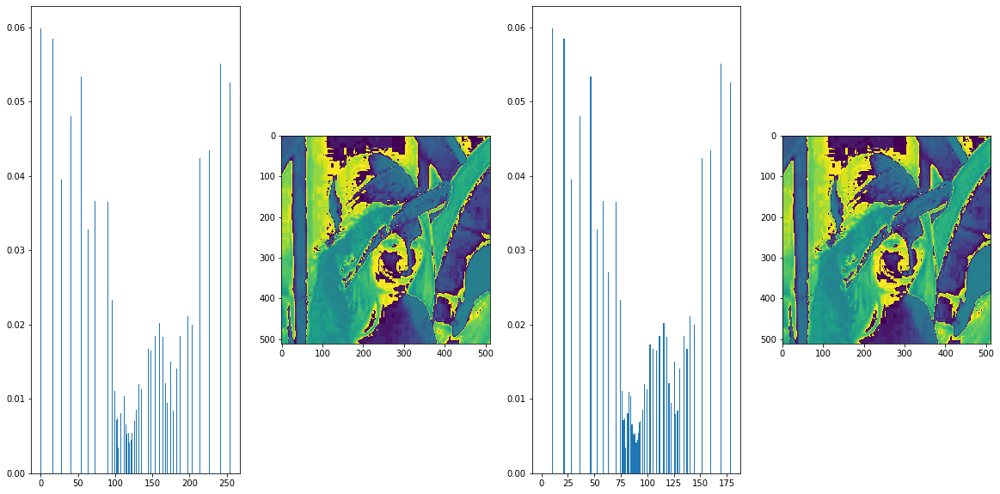

In [175]:
plt.figure(figsize = (20,10))
plt.subplot(141),plt.hist(Hcv2eq.ravel(),max(Hcv2eq.ravel()),[0,max(Hcv2eq.ravel())],density = True)
plt.subplot(142),plt.imshow(Hcv2eq.astype('uint8'))
plt.subplot(143),plt.hist(img2H_altered.ravel(),max(img2H_altered.ravel()),[0,max(img2H_altered.ravel())],density = True)
plt.subplot(144),plt.imshow(img2H_altered.astype('uint8'))
plt.savefig('cv2eqH_and_myh.png', bbox_inches='tight')
plt.show()

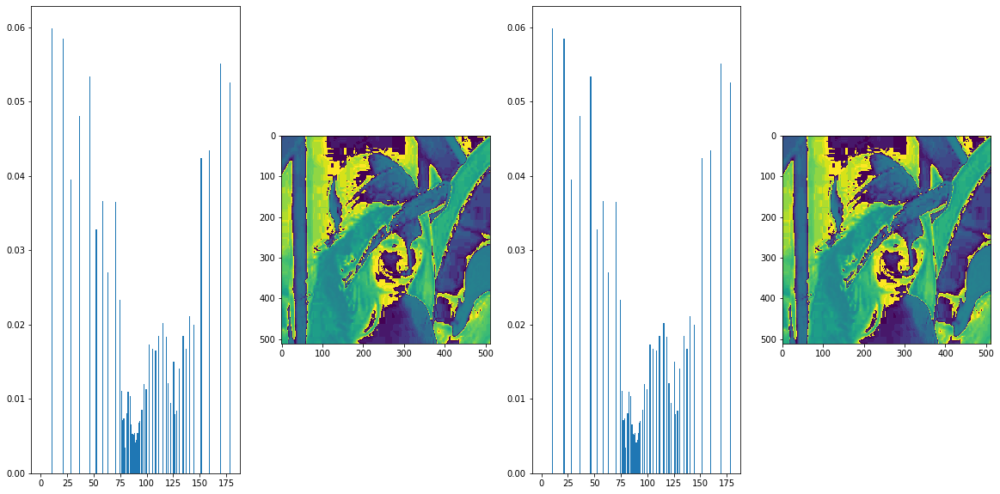

In [171]:
plt.figure(figsize = (20,10))
plt.subplot(141),plt.hist(H.ravel(),max(H.ravel()),[0,max(H.ravel())],density = True)
plt.subplot(142),plt.imshow(H.astype('uint8'))
plt.subplot(143),plt.hist(img2H_altered.ravel(),max(img2H_altered.ravel()),[0,max(img2H_altered.ravel())],density = True)
plt.subplot(144),plt.imshow(img2H_altered.astype('uint8'))
plt.savefig('originh_and_myh.png', bbox_inches='tight')
plt.show()

In [241]:
# Separating the Y channel from YCbCr
imgYcc = cv2.cvtColor(img2, cv2.COLOR_BGR2YCR_CB)
y,b,r = cv2.split(imgYcc)

In [65]:
# Applying my EH on the Y channel
img2Y_altered = my_histogram(y)

[3.00000e+00 5.00000e+00 9.00000e+00 1.10000e+01 1.90000e+01 2.70000e+01
 3.90000e+01 5.70000e+01 9.60000e+01 1.42000e+02 1.81000e+02 2.61000e+02
 3.78000e+02 5.31000e+02 7.39000e+02 9.68000e+02 1.28400e+03 1.65500e+03
 2.12200e+03 2.72300e+03 3.44200e+03 4.36100e+03 5.41500e+03 6.65400e+03
 8.10000e+03 9.69800e+03 1.15500e+04 1.35490e+04 1.57400e+04 1.79840e+04
 2.02610e+04 2.25890e+04 2.48130e+04 2.70280e+04 2.91060e+04 3.10910e+04
 3.29200e+04 3.46530e+04 3.61570e+04 3.75380e+04 3.88780e+04 4.01480e+04
 4.12750e+04 4.24560e+04 4.35660e+04 4.46700e+04 4.57470e+04 4.68830e+04
 4.79570e+04 4.90140e+04 5.01060e+04 5.11790e+04 5.22750e+04 5.33670e+04
 5.44860e+04 5.55500e+04 5.66340e+04 5.77600e+04 5.88960e+04 6.00710e+04
 6.12970e+04 6.26560e+04 6.40330e+04 6.55160e+04 6.72050e+04 6.89790e+04
 7.08450e+04 7.29840e+04 7.54060e+04 7.77480e+04 8.00060e+04 8.21950e+04
 8.43450e+04 8.62470e+04 8.81150e+04 8.98450e+04 9.15010e+04 9.30770e+04
 9.46610e+04 9.61610e+04 9.77000e+04 9.92840e+04 1.

231
232
232
232
232
232
227
227
221
211
201
164
109
92
85
79
82
83
85
90
101
99
99
99
99
101
103
105
107
116
103
95
95
101
107
103
96
111
116
118
116
109
101
99
98
103
103
103
101
98
98
101
103
107
111
111
103
103
111
113
107
116
111
109
107
107
103
98
93
113
111
109
113
116
116
113
109
113
101
122
109
109
120
99
107
93
98
99
98
93
95
99
109
136
184
198
185
185
195
164
111
This is i: 3
185
185
184
182
179
179
182
182
188
187
182
173
175
182
177
166
168
173
177
175
168
164
164
166
166
166
164
161
161
164
166
166
166
164
166
170
175
177
179
182
185
185
188
192
196
197
193
191
195
193
192
192
190
185
175
170
147
157
159
142
125
109
95
86
69
73
67
58
58
69
73
69
80
79
80
80
80
82
82
83
86
85
83
82
82
83
85
86
83
83
85
86
87
86
86
86
86
87
87
86
82
82
83
86
82
89
90
87
90
99
103
96
89
101
98
98
107
101
96
107
105
111
113
103
101
109
116
111
120
120
120
118
118
116
116
116
127
127
127
125
123
122
120
120
122
111
109
116
120
113
113
116
113
116
118
120
123
125
128
128
113
116
118
122
122
123


109
113
113
116
123
113
99
87
67
47
31
18
This is i: 7
177
175
173
170
170
170
170
173
168
175
175
164
157
161
164
159
164
161
159
159
161
159
155
151
164
161
161
159
159
161
161
164
164
161
161
161
164
170
177
184
185
185
188
191
195
196
193
191
193
192
191
190
188
182
170
161
151
149
134
116
103
99
95
87
65
58
56
55
55
55
57
62
72
67
67
73
82
86
87
85
79
77
75
73
73
75
77
79
75
77
79
79
80
80
79
79
77
79
80
79
75
75
79
82
83
82
83
89
92
92
95
98
93
109
105
103
116
109
101
116
105
103
107
109
107
101
105
111
118
118
118
116
116
113
116
116
116
116
116
116
116
113
113
113
122
116
116
123
127
122
116
118
120
120
120
118
118
116
116
116
113
116
118
120
122
122
122
122
122
123
123
125
125
123
123
122
122
122
122
120
120
118
118
118
113
118
120
120
116
116
118
120
122
122
122
120
120
118
118
118
127
122
116
116
118
120
120
118
128
128
127
125
125
127
122
113
128
122
120
122
120
111
109
113
116
118
122
123
123
122
118
116
120
116
116
113
113
116
116
118
123
123
123
123
122
120
118
118
116
1

72
77
80
79
79
79
80
80
80
79
75
72
72
77
80
80
79
73
69
69
73
75
75
89
89
87
87
89
90
92
92
98
99
99
101
103
103
103
103
105
105
109
111
111
109
107
107
111
111
113
111
111
109
113
113
111
111
111
113
113
118
120
122
120
120
120
118
118
116
116
116
116
113
113
113
113
116
118
120
116
120
123
127
128
127
123
122
122
120
120
122
123
125
127
128
123
123
123
123
122
122
120
120
123
122
122
120
120
122
122
123
118
120
120
120
116
116
120
122
116
118
120
122
122
120
120
118
120
122
125
123
120
116
116
116
113
113
113
111
111
111
111
111
120
120
120
120
120
120
120
118
107
109
111
113
116
113
113
113
118
120
122
123
123
123
123
122
120
118
116
116
116
116
113
111
109
118
120
118
120
125
127
122
122
122
120
118
116
113
113
111
116
116
116
116
116
116
116
116
116
116
116
116
116
116
116
116
111
113
116
116
118
116
116
116
118
113
111
113
116
116
111
107
113
109
103
99
98
103
109
113
98
95
93
92
90
87
86
87
86
85
82
77
77
83
93
103
116
123
130
136
140
145
149
151
157
161
168
173
177
177
177
173

122
118
113
116
120
123
123
122
122
123
125
116
118
118
120
120
118
118
116
111
118
122
122
120
118
120
122
111
113
118
118
120
118
113
111
120
120
120
120
120
118
118
118
111
111
113
116
118
120
118
118
122
122
123
127
127
128
127
127
122
113
107
113
122
127
122
113
113
122
123
118
118
123
122
116
118
120
120
120
120
120
122
122
113
113
113
111
111
109
109
107
118
118
118
118
118
118
118
118
109
111
113
116
118
120
120
120
116
116
116
120
122
120
111
105
109
111
111
111
109
107
105
103
98
103
98
89
87
95
98
93
87
87
86
83
82
83
87
92
92
99
118
128
136
143
149
153
155
157
161
166
170
175
177
182
182
179
177
175
175
173
175
175
168
170
173
175
173
173
170
170
175
177
177
177
175
170
166
164
166
166
166
164
164
161
161
161
170
166
159
155
153
157
161
166
159
161
164
161
157
153
157
159
153
153
155
159
159
157
157
157
157
170
168
153
151
164
159
143
166
196
208
214
216
221
226
228
228
232
233
231
230
232
232
230
227
221
215
208
188
132
96
83
82
83
85
85
86
86
85
85
109
103
96
90
90
95
101

118
118
118
113
109
107
109
113
116
116
111
113
111
109
111
113
111
105
99
109
105
101
96
95
93
92
92
83
85
86
86
82
80
79
80
89
92
96
109
123
132
138
140
149
151
157
164
166
170
170
173
179
182
184
179
175
177
182
185
175
175
175
175
175
177
177
179
184
182
177
175
175
177
182
184
168
168
168
168
168
168
168
168
173
173
168
166
164
161
161
164
166
166
166
166
164
159
155
153
161
159
159
159
159
164
161
161
157
157
155
153
153
151
151
151
153
153
159
182
201
211
216
219
224
226
228
230
230
231
232
233
232
232
229
224
218
210
195
161
98
82
72
80
86
85
83
86
95
96
96
98
96
98
98
98
101
101
101
103
105
107
107
105
109
109
109
107
107
105
105
105
101
107
113
109
105
103
109
113
107
109
111
113
116
116
118
118
120
123
125
120
120
128
132
128
125
123
111
93
73
50
36
20
7
10
20
31
27
14
10
10
31
27
22
16
14
14
12
8
This is i: 20
164
164
164
164
164
164
164
164
164
161
164
164
164
166
166
166
173
173
170
168
166
164
161
159
159
159
161
166
168
173
177
179
184
187
187
187
185
185
187
190
184
18

143
140
149
173
199
207
217
219
223
225
226
228
231
232
230
232
232
232
232
231
222
213
203
159
111
95
86
72
79
99
87
89
92
96
96
96
96
96
92
95
98
96
95
96
103
111
105
103
103
101
99
99
98
98
111
105
99
99
107
113
113
111
118
116
113
113
116
120
122
125
113
122
127
127
130
128
116
99
73
44
20
16
29
31
27
26
41
31
22
24
29
26
16
14
16
20
18
16
14
14
20
26
This is i: 24
170
166
161
157
157
161
166
170
166
166
166
168
168
166
166
164
170
168
166
164
164
164
164
166
161
166
170
177
182
184
185
187
187
187
188
188
188
187
185
185
185
184
184
182
179
173
168
164
170
173
170
170
166
157
151
147
138
134
125
120
111
98
89
83
73
63
58
56
54
53
58
69
58
60
63
65
69
73
77
79
83
80
77
77
77
73
67
63
77
80
82
80
77
73
73
73
73
73
72
73
75
79
83
85
83
83
83
83
85
86
89
90
101
99
98
99
103
101
98
95
101
98
96
101
109
113
111
105
116
116
113
111
111
109
107
107
113
113
113
116
116
118
118
118
113
113
113
116
116
118
118
118
105
109
111
111
109
109
113
116
116
116
116
116
116
116
116
116
116
120
125
12

175
177
175
177
182
185
187
188
190
190
188
188
188
187
187
185
184
182
173
173
173
173
173
175
175
177
170
173
175
175
170
164
157
155
142
136
125
116
103
92
82
72
65
57
54
51
50
49
54
62
63
65
67
67
72
73
75
77
75
73
73
77
82
82
80
79
80
82
80
77
73
72
73
77
77
75
73
73
75
77
80
82
80
82
82
82
85
87
90
92
90
98
107
105
98
95
98
105
96
103
109
107
103
99
105
111
113
113
111
111
111
111
109
109
113
113
113
113
113
113
113
111
113
113
113
116
116
116
118
118
116
120
122
120
116
116
118
120
118
118
118
118
118
118
118
118
116
116
118
116
113
113
118
122
113
118
118
113
109
107
107
111
118
116
116
113
116
118
122
125
128
128
130
130
125
123
120
113
113
111
107
103
101
101
101
101
101
99
98
98
99
103
105
109
105
107
111
113
116
113
111
111
107
107
105
105
105
105
107
107
105
105
109
113
113
109
107
107
113
113
116
118
118
116
113
111
122
122
122
122
122
122
122
122
123
122
120
122
125
125
122
116
118
113
109
109
113
113
109
105
109
109
111
111
113
111
111
109
116
111
107
107
109
109
109
10

113
118
118
113
111
113
116
118
113
111
113
118
120
118
116
120
120
120
120
118
116
116
113
113
116
118
120
120
120
116
116
111
111
111
113
113
116
116
116
118
120
122
123
122
118
111
109
120
120
120
118
113
111
107
105
107
98
96
99
99
95
96
99
105
99
96
93
98
101
103
105
107
103
99
101
109
111
107
103
105
105
103
101
101
103
103
105
105
107
113
120
122
120
118
118
123
120
116
113
111
109
111
113
132
128
125
120
116
116
116
118
111
111
111
111
109
109
109
109
105
111
118
118
113
109
107
105
118
113
109
105
105
107
109
111
109
109
109
109
107
105
105
103
109
109
109
109
109
109
109
109
105
111
116
111
103
99
99
103
103
99
96
95
93
92
87
83
85
86
86
83
80
79
80
83
82
87
93
99
105
113
123
130
127
132
138
143
147
153
159
166
168
170
173
177
177
179
179
177
175
179
179
177
173
170
173
173
170
170
168
170
170
173
173
173
179
170
168
175
175
161
161
170
159
166
168
173
168
168
170
173
166
166
166
164
164
161
161
161
166
166
166
164
164
161
161
161
157
157
159
161
161
159
157
155
164
161
155
1

105
101
109
109
109
109
109
109
109
109
120
113
105
99
98
101
105
107
99
96
95
95
96
96
93
89
93
93
93
89
85
83
85
86
86
90
95
99
101
107
116
122
128
132
140
142
145
149
155
159
159
161
166
168
170
170
170
170
168
173
175
175
170
170
173
175
168
168
168
168
168
168
170
170
170
173
170
168
166
168
164
161
173
173
173
166
161
161
170
177
168
168
168
166
166
166
164
164
166
166
166
164
164
161
161
161
170
166
159
157
155
157
159
161
159
155
151
151
153
151
147
142
145
145
143
143
153
184
204
212
218
221
227
230
232
233
234
234
234
234
234
234
233
230
222
216
208
166
109
83
72
80
89
82
86
87
89
90
93
95
96
98
101
107
113
113
111
111
113
116
101
111
120
125
125
123
127
130
113
105
89
60
41
20
3
1
16
8
5
12
14
10
12
20
32
31
31
32
35
35
31
27
20
18
18
22
24
24
20
14
18
22
27
27
26
20
14
10
This is i: 37
170
170
170
170
170
173
175
175
185
184
184
184
182
182
179
179
179
182
184
185
187
187
187
187
190
190
190
190
188
188
188
188
182
182
179
177
175
173
173
173
164
164
166
168
168
170
173
173

96
98
98
99
103
105
109
122
128
123
118
109
90
73
40
32
18
7
5
10
12
16
5
4
7
14
14
10
14
26
14
18
24
27
26
26
26
27
14
18
22
20
12
7
7
8
22
18
10
7
5
8
12
16
This is i: 41
182
179
175
175
177
177
173
170
173
175
177
177
175
175
182
185
184
185
188
190
190
188
184
182
179
179
175
170
166
166
173
177
173
175
170
164
168
177
177
168
164
166
168
173
173
175
175
175
173
175
173
173
170
159
153
151
136
130
122
111
99
86
73
62
60
55
49
47
48
51
55
57
62
63
67
75
80
83
82
79
77
75
75
73
73
73
73
73
75
75
75
73
72
72
75
79
67
69
73
75
75
75
73
73
67
75
83
86
86
86
89
90
95
96
99
99
98
96
99
101
98
99
101
105
105
103
101
99
105
103
99
96
96
99
105
109
105
105
109
109
109
109
105
105
101
105
107
107
105
103
107
109
105
107
109
111
113
113
113
113
113
113
111
109
111
111
113
113
113
116
118
116
111
109
109
111
113
111
111
111
111
113
111
109
113
111
111
111
111
111
111
111
120
120
118
111
107
105
111
116
107
103
103
107
113
113
109
103
96
93
96
107
109
101
98
103
101
99
99
98
96
93
92
92
87
95
10

101
111
109
105
103
103
105
109
111
101
103
107
109
107
109
113
118
113
116
116
118
118
118
116
116
113
111
109
105
105
105
105
105
120
125
128
127
122
113
109
109
111
118
122
118
111
107
111
116
107
107
107
107
107
105
105
105
123
125
125
120
111
103
99
99
99
101
105
103
99
101
109
118
105
113
118
116
118
122
120
111
113
122
132
140
149
170
193
203
159
177
197
201
190
164
170
193
145
164
175
157
127
109
118
132
93
93
95
96
99
103
107
111
96
98
99
101
105
107
105
105
99
103
107
107
107
105
107
109
107
111
113
113
111
111
113
116
111
116
120
120
118
116
116
120
122
116
109
107
109
111
113
113
111
111
113
116
116
113
111
111
107
107
109
109
109
107
105
103
111
107
105
105
107
109
105
101
93
96
98
95
90
90
93
98
98
95
90
89
87
87
86
83
86
89
90
93
95
101
111
120
125
128
134
136
138
140
145
149
147
147
147
147
149
151
155
155
157
157
159
161
164
166
168
168
170
170
168
168
164
161
161
161
157
157
159
159
159
161
161
161
164
164
161
159
161
164
164
166
170
168
164
161
161
161
166
166
159
15

103
101
105
107
107
103
109
109
109
109
109
107
107
107
113
111
107
105
103
99
98
99
105
101
103
105
99
90
90
98
92
92
93
92
89
86
83
82
85
87
90
93
95
101
111
120
120
125
134
138
140
142
145
149
147
143
142
143
147
151
153
151
151
155
159
159
157
155
159
164
166
166
166
164
164
164
164
164
155
157
161
164
164
164
159
159
161
161
161
159
159
159
161
161
161
164
166
161
157
155
155
157
155
155
153
153
151
151
151
151
142
143
143
145
143
142
140
138
142
142
140
138
136
136
138
138
140
138
136
136
136
136
132
127
134
142
143
151
179
204
214
218
223
226
230
233
233
234
234
234
235
235
234
233
231
226
216
206
193
125
87
82
75
77
93
101
101
101
105
107
98
82
56
45
27
8
1
3
10
14
14
14
7
8
10
10
8
10
12
16
24
27
29
31
29
29
32
35
37
37
37
36
36
35
33
33
20
16
8
5
4
5
8
10
12
16
18
18
18
18
18
18
This is i: 50
179
179
175
173
173
170
173
175
170
173
179
187
190
191
192
192
190
184
173
161
157
153
149
143
140
138
136
134
134
134
136
136
143
149
159
170
175
179
179
179
179
179
177
175
173
173
17

5
5
1
1
4
10
10
14
20
10
14
16
14
14
14
18
22
26
29
29
27
24
22
22
24
29
26
22
18
16
18
18
20
14
16
18
20
22
22
22
18
18
18
14
10
8
8
10
10
This is i: 54
175
175
173
173
175
177
179
177
184
185
188
190
190
190
187
185
173
166
157
153
147
140
130
122
113
113
113
116
120
123
127
128
143
149
157
170
175
179
179
179
182
179
177
177
177
177
177
179
187
184
179
179
175
170
159
153
138
136
130
120
107
90
79
67
60
50
45
48
51
53
54
56
62
62
60
63
67
69
72
72
73
79
82
80
72
67
73
79
72
73
75
75
75
75
75
73
75
75
73
73
75
79
80
83
77
82
87
93
95
92
89
87
95
95
95
95
95
96
98
98
99
99
98
98
98
101
103
105
107
107
107
109
107
107
105
105
101
103
105
107
109
111
113
116
113
113
111
109
109
107
109
109
111
107
107
109
116
116
111
107
111
109
107
109
111
109
105
99
111
111
113
113
113
111
111
111
113
113
113
113
116
116
118
120
120
120
123
132
145
157
159
159
140
157
166
159
166
184
187
179
145
157
149
140
149
155
159
175
168
170
175
182
188
195
200
201
195
190
190
196
201
202
203
204
209
206
205
208

113
111
103
99
101
107
109
109
109
109
109
109
109
109
107
111
109
109
116
118
109
98
101
101
96
95
98
105
105
99
105
132
155
157
153
155
164
168
166
155
142
127
113
103
99
99
127
128
136
143
149
149
143
140
155
164
164
157
157
161
157
149
142
155
159
164
177
164
157
182
175
161
170
175
166
177
191
187
153
192
205
202
188
185
198
205
202
204
184
196
209
207
208
203
198
200
202
206
210
211
206
198
205
207
210
210
207
206
212
220
214
211
210
212
214
215
216
219
218
218
218
218
218
219
220
220
218
219
214
198
149
111
92
85
92
93
98
107
109
99
99
103
101
107
116
118
113
107
103
103
98
98
101
107
113
113
109
105
105
105
105
105
105
105
105
105
96
95
93
93
92
89
89
92
87
87
87
87
89
87
86
85
86
85
82
80
80
80
83
85
85
85
85
87
92
98
107
113
122
127
134
138
140
143
147
153
147
153
151
143
142
149
149
143
147
147
149
151
153
153
151
151
147
149
153
155
159
159
159
159
157
157
157
157
155
151
149
147
147
145
143
143
147
149
147
143
140
140
142
142
142
142
140
140
143
142
142
140
140
138
138
136

149
145
151
149
142
140
147
147
142
142
143
147
149
149
149
149
147
149
147
149
147
149
151
155
157
153
153
155
157
159
159
157
155
147
143
142
140
140
138
134
130
132
134
136
138
140
142
142
142
143
142
140
138
136
138
140
142
134
136
138
140
140
138
136
134
138
136
136
134
134
136
136
138
132
132
134
136
138
138
138
138
140
138
136
134
132
132
132
132
130
132
134
145
185
207
216
220
228
230
233
234
235
235
235
235
235
234
233
232
212
134
38
0
2
4
8
18
16
7
5
10
16
8
8
16
20
18
22
31
29
31
33
32
29
27
26
27
27
29
27
22
12
7
8
10
10
10
14
20
27
29
26
20
12
12
10
8
5
4
5
5
14
10
8
12
26
29
27
24
This is i: 63
177
182
182
185
188
192
195
197
188
185
182
170
164
157
149
147
132
125
111
96
82
67
58
54
54
65
86
99
113
123
138
145
153
157
168
173
179
184
185
185
175
177
182
184
185
185
184
182
187
185
184
179
170
164
153
149
147
140
130
120
111
95
79
62
55
50
45
42
44
48
50
50
54
53
56
62
63
57
56
58
60
58
62
67
63
57
58
65
67
67
65
62
63
65
69
72
73
69
69
73
79
79
72
65
80
79
80
80
83
85
87

132
123
118
109
96
79
63
60
54
47
42
39
41
43
45
49
50
54
56
58
60
60
60
58
62
67
67
65
63
63
65
65
72
73
67
65
72
69
63
72
72
72
73
73
73
73
73
79
80
80
80
79
80
83
86
90
87
87
92
93
93
90
87
93
92
89
87
89
90
92
93
109
107
105
103
101
101
101
101
99
101
101
101
99
99
99
98
103
101
98
98
99
101
98
95
86
98
101
101
173
214
196
60
54
58
79
98
105
103
101
109
118
103
98
103
107
103
99
101
122
118
113
109
105
103
101
99
116
116
125
134
132
123
125
134
120
127
127
122
122
130
136
136
136
134
140
145
143
136
138
145
184
153
138
149
157
155
164
182
166
173
182
187
191
192
187
175
209
205
200
200
204
206
207
206
206
204
205
209
212
211
211
212
201
206
212
215
215
214
209
204
216
218
217
213
210
211
213
213
218
217
219
220
218
215
217
221
222
220
220
218
218
217
217
217
223
220
217
217
218
219
216
213
195
161
116
82
69
72
79
83
86
86
90
92
90
87
85
82
89
89
90
90
92
93
93
95
92
90
89
90
93
93
89
86
89
87
86
83
83
83
85
86
86
85
82
80
80
79
79
79
80
85
87
92
96
101
113
123
132
134
138
143
149
1

89
87
89
90
90
87
85
90
89
85
80
80
80
82
82
83
85
86
87
85
80
73
69
69
73
79
82
86
93
103
109
132
134
138
143
149
151
155
155
157
157
155
155
157
157
159
157
151
151
149
147
143
138
134
132
128
128
130
132
132
130
130
130
118
125
132
136
136
138
143
151
157
153
149
149
147
143
140
134
132
132
132
134
134
136
136
136
140
142
142
142
142
140
138
136
134
136
136
138
138
136
136
134
140
136
134
134
138
142
142
140
142
140
138
136
138
140
142
143
145
145
147
147
147
147
145
143
142
142
149
159
164
159
155
164
166
201
210
206
190
130
50
0
8
5
7
16
26
27
18
8
7
7
10
14
16
18
20
20
14
16
18
16
16
20
26
31
27
20
18
26
22
10
8
14
18
27
33
35
31
26
24
24
27
26
22
16
12
12
20
26
20
16
18
27
40
47
49
47
35
24
4
0
0
0
4
20
This is i: 72
193
191
191
190
190
185
179
170
170
157
143
136
127
116
99
90
82
60
47
41
40
41
46
53
67
75
86
98
111
123
128
134
153
155
166
175
179
184
187
187
187
188
188
187
185
184
182
179
182
175
173
173
168
161
153
145
136
136
125
111
101
93
75
56
48
46
43
40
39
41
46
50
51


136
136
125
111
101
93
75
56
51
47
41
39
41
45
48
49
53
53
54
57
63
67
65
62
69
67
65
65
67
67
67
67
75
73
73
73
73
75
73
73
73
73
72
72
73
72
73
75
80
79
77
80
83
85
83
80
83
85
87
90
92
93
96
96
87
89
90
92
95
96
98
99
93
92
92
90
90
92
92
93
101
101
99
98
98
98
99
101
105
120
109
95
90
92
116
168
191
128
85
85
96
96
93
93
82
82
82
80
79
80
86
93
92
95
98
98
96
95
99
103
118
101
99
111
113
105
109
125
111
116
116
118
123
130
128
122
127
128
125
122
125
136
140
138
159
147
138
140
145
143
136
128
125
128
142
149
138
127
138
166
187
153
140
159
173
159
155
164
188
188
187
182
184
193
205
210
203
202
203
205
209
211
210
208
209
208
209
213
216
217
212
208
207
212
218
222
220
216
214
212
214
214
216
219
222
223
221
219
219
220
220
220
219
216
213
211
220
221
221
218
215
213
211
211
216
218
220
224
228
231
233
234
235
234
234
235
233
225
212
195
103
67
50
56
69
67
69
83
89
87
85
86
87
87
85
82
82
80
79
79
77
79
79
80
82
82
82
79
77
75
73
72
75
80
86
87
89
98
113
123
136
145
151
153
153
15

87
92
98
113
123
123
130
138
145
147
151
159
164
164
161
161
161
164
164
159
155
159
161
159
159
157
151
143
140
127
118
107
95
87
79
67
60
65
62
65
77
83
90
103
122
120
127
138
147
151
155
161
166
153
151
145
142
140
138
138
138
134
136
138
140
142
140
136
134
138
136
136
136
136
138
140
142
142
145
149
145
142
138
142
145
138
138
140
140
142
143
145
143
149
145
149
157
151
140
143
157
143
159
161
151
147
134
90
48
4
10
16
16
12
10
10
10
5
4
8
18
22
16
16
20
16
26
31
26
14
14
24
35
22
27
27
24
24
22
12
3
1
4
16
24
27
27
27
29
26
22
20
20
22
20
16
10
12
18
24
31
39
48
55
60
57
50
40
22
3
3
22
43
73
101
138
155
164
179
187
185
This is i: 81
170
177
170
159
153
149
136
122
109
96
83
72
55
47
45
47
49
49
49
50
50
53
53
51
62
73
90
105
116
127
136
147
149
153
161
170
179
182
184
185
184
185
185
187
185
185
184
182
185
179
175
173
168
161
153
145
134
132
122
109
101
93
72
51
55
50
45
43
40
40
47
56
53
54
56
57
60
62
62
63
60
65
72
77
75
69
62
57
73
73
72
69
67
69
72
75
75
77
77
75
73
75
79


72
69
75
82
83
80
73
67
69
73
75
73
75
77
79
75
77
80
85
85
86
86
85
86
89
90
89
87
87
90
93
98
92
92
96
98
93
96
101
96
96
96
96
96
96
96
96
101
98
96
99
107
113
111
105
103
107
118
118
93
72
72
87
82
80
82
85
85
85
83
83
86
92
99
103
101
99
96
96
93
99
109
118
118
111
103
98
96
107
111
105
101
103
103
101
113
96
95
113
127
125
125
130
123
116
123
136
130
116
128
157
153
128
123
143
155
138
120
116
134
145
142
125
132
153
153
130
122
153
166
155
151
147
164
197
185
170
166
187
200
203
201
198
199
208
216
215
208
202
204
208
214
212
217
218
212
212
214
212
215
214
212
209
205
200
202
206
204
206
211
214
218
223
228
232
233
234
234
233
231
232
233
233
230
230
230
231
232
232
233
233
230
231
232
232
232
232
231
230
226
229
233
234
234
235
235
235
235
235
235
235
235
208
122
57
57
51
50
51
55
57
60
63
62
67
73
75
72
67
67
67
82
77
72
72
73
75
69
62
65
73
80
83
86
92
105
116
120
125
136
143
147
155
164
170
166
161
155
153
155
157
159
157
159
161
159
159
157
151
143
142
132
127
122
111
96
8

153
153
153
153
132
127
116
111
107
93
73
57
45
32
10
4
7
16
32
41
51
69
89
93
95
103
120
125
134
145
153
149
149
153
151
145
138
138
140
140
138
136
138
140
138
138
138
138
138
138
138
138
145
145
143
143
143
145
147
149
134
134
138
142
142
142
142
142
149
151
153
155
164
161
138
109
69
36
2
5
18
12
7
12
16
10
5
3
3
8
16
22
24
29
32
31
27
26
27
31
27
29
29
26
20
16
18
20
4
7
14
26
33
37
35
32
27
24
18
12
10
10
12
14
8
24
35
38
37
37
41
45
50
48
50
56
56
50
51
67
90
111
132
145
157
170
170
166
170
164
153
142
136
140
149
157
This is i: 90
123
120
116
103
89
72
55
50
50
50
50
51
54
56
55
54
62
57
53
50
51
53
54
51
62
73
87
101
109
123
132
143
151
155
161
170
177
179
182
182
187
185
185
185
184
184
184
182
185
179
177
173
168
159
149
142
136
128
116
105
96
87
72
58
60
50
43
42
44
46
50
56
55
58
62
65
63
65
69
73
67
62
63
72
75
73
77
83
73
75
79
80
80
79
75
73
73
73
73
73
75
77
79
79
79
83
86
83
82
86
86
82
87
89
92
93
93
92
89
87
93
93
93
95
96
98
101
103
103
99
96
95
93
96
99
101
93
92


92
93
93
96
98
99
101
101
101
103
107
109
105
96
89
85
85
79
82
80
79
83
93
96
90
92
92
83
87
98
92
86
98
98
98
98
96
95
96
99
101
87
82
89
92
80
83
89
82
90
96
105
107
103
107
120
128
138
105
99
128
136
113
113
138
145
142
132
130
147
161
149
127
130
142
151
151
153
159
155
143
175
155
151
161
153
130
120
127
149
147
147
151
147
145
157
177
159
155
164
188
198
198
193
191
203
206
206
204
200
195
185
170
149
168
193
205
216
227
232
229
228
229
230
231
230
228
224
221
225
228
226
222
228
234
234
231
233
232
230
228
227
226
225
225
221
220
219
219
220
223
227
228
225
228
230
232
233
234
234
235
234
233
232
234
234
234
233
233
234
234
234
235
235
235
235
235
235
235
235
232
195
89
49
50
48
44
42
44
49
53
51
50
60
60
60
58
57
55
54
51
63
65
73
80
90
98
107
113
130
134
140
145
151
155
159
161
166
161
159
159
161
161
159
155
164
164
166
168
161
157
149
145
142
134
125
118
111
95
75
56
45
31
5
1
1
1
10
24
31
46
62
69
75
87
98
107
109
123
134
138
142
151
151
149
145
147
147
145
142
136
138
140

147
147
145
143
138
136
134
136
136
136
134
136
134
134
136
138
138
140
140
142
142
140
142
140
143
149
155
159
159
153
147
147
107
69
39
5
4
10
1
3
3
4
7
8
10
12
14
20
27
35
37
36
31
27
24
27
22
18
18
22
20
14
7
7
8
10
10
14
22
31
36
36
31
20
14
12
12
14
14
31
24
22
26
27
24
29
35
31
36
41
39
37
42
53
65
92
116
140
147
149
155
159
159
161
173
182
173
153
145
145
155
184
185
191
192
190
190
191
192
This is i: 99
57
54
50
47
51
58
56
50
54
55
56
57
58
58
57
57
58
60
58
55
51
50
51
53
63
72
82
92
105
113
125
134
142
151
159
170
173
177
182
185
182
184
184
185
185
184
184
182
182
179
175
173
168
159
149
145
125
123
120
113
99
85
69
58
62
50
43
43
44
43
42
43
54
54
57
60
63
65
67
67
65
67
72
72
67
67
72
73
67
69
72
69
67
65
69
72
65
69
73
77
79
75
72
69
80
80
79
79
80
80
82
82
85
85
87
90
92
92
90
89
95
92
90
92
96
99
96
93
107
96
95
103
99
92
103
130
136
118
89
79
80
87
89
85
87
89
95
101
95
85
80
83
83
83
85
87
90
95
98
99
99
105
107
99
93
93
101
113
101
109
111
103
99
105
105
101
116
10

89
93
96
95
93
86
98
107
101
98
105
116
120
116
123
128
127
125
125
118
105
143
138
136
136
143
151
155
155
145
136
127
138
161
173
145
111
147
149
134
113
116
140
149
140
122
127
142
153
136
107
111
134
145
145
136
134
155
175
142
93
140
143
140
134
134
157
198
210
211
218
223
219
215
218
223
226
219
216
218
224
225
218
214
214
217
219
221
220
217
216
218
220
222
220
220
223
227
228
225
222
225
217
216
223
226
223
226
233
233
230
226
221
221
226
232
234
230
231
231
229
227
227
229
232
233
233
232
232
232
231
230
229
230
232
233
233
233
232
228
226
233
233
232
233
234
234
234
233
235
235
235
235
235
235
211
142
39
36
35
31
33
38
44
47
50
53
62
72
83
93
103
113
118
125
132
140
145
153
161
166
159
157
157
159
164
164
161
157
159
155
151
157
166
168
159
151
138
132
125
113
98
83
69
60
54
37
14
12
20
20
10
3
5
4
7
12
10
12
27
40
55
54
67
92
113
118
123
130
134
136
138
140
142
142
140
140
138
136
132
128
127
128
132
136
136
136
138
142
145
147
151
153
143
159
166
155
155
140
98
58
14
0
0
4


7
5
10
14
10
8
8
12
18
24
26
27
26
26
27
29
29
26
22
22
32
27
20
12
10
14
20
24
24
26
27
24
18
12
10
10
22
20
24
32
36
32
24
16
24
16
12
12
14
24
40
50
60
89
125
149
161
173
170
164
151
151
147
136
127
128
138
145
159
168
179
188
192
192
191
190
190
190
192
192
193
193
195
195
This is i: 108
65
62
57
55
55
57
60
63
65
63
62
58
56
55
55
55
58
58
57
56
55
57
56
55
67
77
87
98
109
120
127
134
140
147
157
166
166
170
175
179
187
184
177
175
177
179
179
179
184
184
182
179
179
166
157
145
136
132
122
113
101
92
79
69
65
55
47
42
42
46
50
53
50
53
57
58
56
55
58
65
65
67
69
67
65
65
69
72
69
72
73
75
73
72
69
65
67
67
69
72
72
72
73
73
75
75
73
77
79
83
85
87
92
92
92
93
93
93
93
95
85
85
89
95
93
87
86
92
86
85
184
208
193
147
89
67
54
63
69
65
77
93
93
85
82
89
92
90
86
86
89
92
83
85
86
89
90
92
93
93
86
89
92
93
93
95
98
103
107
101
99
107
118
116
101
89
116
127
138
136
127
123
128
138
132
142
157
168
166
145
116
93
107
127
145
145
134
125
132
143
149
138
130
132
140
140
128
116
132
132


157
132
111
122
142
143
120
92
134
118
98
92
92
95
99
107
182
197
206
209
210
208
206
205
209
218
218
211
212
222
220
209
210
208
209
212
211
208
211
218
216
212
212
213
208
201
199
205
216
218
220
223
224
222
219
217
226
222
220
221
218
215
218
225
221
222
223
225
227
228
230
230
227
230
232
230
225
224
228
233
232
229
228
230
233
234
232
228
230
224
218
216
219
223
227
228
226
229
233
234
234
234
233
232
229
231
232
232
232
233
234
234
234
234
234
234
235
235
235
235
235
235
235
235
233
170
27
32
36
33
40
53
65
77
95
120
116
122
130
140
147
153
155
155
153
155
157
159
157
157
155
153
157
161
164
166
168
164
159
157
143
134
120
113
109
99
85
67
51
42
29
24
20
10
5
4
12
10
7
8
8
5
3
1
5
0
0
8
20
8
35
62
58
95
157
202
214
224
232
234
234
234
235
235
233
219
205
190
205
209
219
218
199
159
147
145
103
62
22
10
10
3
7
3
16
12
12
16
20
24
24
18
29
26
22
22
26
27
26
24
16
16
18
24
31
32
32
29
16
29
32
24
18
26
29
27
16
8
8
18
22
24
31
38
22
24
26
22
26
27
24
16
5
3
14
40
58
85
116
145
151
1

33
33
36
41
22
12
7
8
5
3
12
26
43
58
95
125
147
159
168
170
173
166
157
153
151
149
145
143
164
173
184
188
190
193
192
188
187
187
185
185
185
184
184
184
182
182
182
182
182
182
182
182
This is i: 117
58
56
54
55
57
60
60
57
57
56
55
54
55
56
57
58
56
60
60
53
50
50
50
48
56
62
79
90
105
116
128
134
142
149
159
168
175
175
182
185
187
185
182
184
184
184
184
179
177
177
177
177
175
166
153
145
132
134
125
111
98
90
79
62
58
50
40
35
37
43
48
50
48
50
53
55
53
53
54
55
60
62
62
62
62
60
58
58
63
69
69
63
63
67
65
62
72
72
69
69
72
73
75
75
72
72
75
80
83
85
86
86
79
83
85
85
83
83
83
86
79
80
67
65
65
65
140
222
230
209
187
147
107
90
79
56
80
80
77
73
69
72
79
83
90
83
79
85
95
99
96
89
82
85
89
93
95
93
90
87
86
95
109
107
92
80
90
109
120
113
116
123
125
120
122
127
142
153
155
140
125
123
125
125
147
145
132
111
101
113
130
140
130
134
138
140
128
111
96
90
87
101
113
109
93
83
87
93
111
143
177
188
196
204
206
205
208
205
207
214
219
215
211
209
209
210
205
198
199
205
206
203
2

82
82
107
145
177
190
193
204
204
204
205
207
209
209
209
204
199
191
190
195
202
206
207
206
208
209
207
206
204
199
188
200
205
208
207
208
210
211
208
211
212
213
212
212
215
215
213
214
214
215
218
219
216
214
214
223
223
220
216
218
223
219
212
219
218
218
219
219
218
214
212
216
216
218
220
223
226
228
229
227
227
227
227
227
228
229
231
228
227
223
221
220
222
225
228
228
226
224
223
225
228
229
230
232
232
231
231
232
231
231
231
229
228
228
229
232
233
233
232
234
235
235
235
235
235
235
235
216
143
53
39
46
54
69
87
113
120
130
140
149
157
161
164
164
159
159
161
164
166
161
159
166
164
157
159
161
161
159
155
138
134
123
113
101
89
72
57
55
37
12
8
10
4
2
4
8
0
0
8
10
27
87
191
216
230
235
235
235
233
217
203
206
209
216
229
234
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
235
197
22
24
18
10
27
20
22
14
14
18
14
7
8
18
26
24
27
33
33
26
20
22
16
14
14
14
16
18
22
24
31
27
22
16
12
14
18
22
24
26
26
27
27
27
26
26
12
14
14
16
27
45
73
98
132
14

235
235
235
233
157
18
16
20
14
5
12
8
12
18
18
12
18
27
29
22
18
22
22
16
18
26
8
10
12
14
16
16
16
14
1
4
18
26
26
24
26
27
32
32
32
31
27
24
22
20
16
20
33
53
89
127
151
157
175
173
166
159
153
151
149
149
155
161
173
179
185
184
182
179
184
184
184
184
184
184
185
185
184
184
184
184
182
182
182
179
177
179
182
184
184
184
182
182
This is i: 126
62
60
57
57
57
57
58
58
63
63
60
60
60
62
63
63
67
60
58
63
62
54
51
55
58
65
79
86
95
107
122
128
147
149
157
164
177
184
190
192
188
188
187
187
185
184
185
185
185
185
184
179
170
159
151
147
140
132
122
113
103
90
77
62
50
48
45
43
44
46
46
46
48
49
50
54
56
60
62
63
63
65
69
72
72
69
67
65
65
69
73
72
69
67
67
69
72
73
75
73
72
72
75
77
73
75
77
80
80
83
85
85
85
86
85
87
89
92
95
95
85
86
79
98
205
227
221
209
204
188
151
116
85
62
56
60
63
69
75
79
79
77
77
77
83
85
86
89
89
85
79
73
48
73
101
109
90
80
86
98
111
123
125
113
105
113
123
125
113
101
98
105
111
105
96
93
99
118
128
128
128
134
136
132
99
92
90
101
123
128
113
96
93
89


103
87
75
69
72
85
85
82
73
75
82
83
77
82
77
60
51
54
75
95
105
93
101
103
95
92
103
122
130
107
98
92
98
113
120
111
99
98
99
107
109
99
93
99
116
130
125
118
123
138
143
142
140
125
125
123
116
99
87
79
73
87
103
132
159
182
192
198
201
191
192
195
197
197
193
188
182
188
190
193
196
199
199
198
197
188
185
190
201
209
212
210
206
208
210
211
209
205
201
202
204
206
212
213
209
211
216
214
206
214
211
208
206
210
214
212
206
208
214
214
209
208
211
208
200
190
196
202
209
216
220
217
210
216
216
216
218
220
223
225
225
227
225
221
218
217
216
217
218
222
223
223
223
221
220
218
218
224
225
225
225
224
221
219
218
216
219
224
224
218
212
212
216
220
220
220
218
220
227
231
231
228
230
232
230
228
228
230
233
229
230
231
232
232
232
232
232
233
235
235
234
235
235
224
207
170
128
105
122
138
134
134
149
151
155
161
161
161
159
155
153
164
164
161
157
151
143
138
136
125
118
93
73
57
50
40
27
31
62
130
196
216
232
235
235
233
228
218
209
204
206
212
219
232
234
235
235
234
234
233
231


222
225
227
227
228
230
233
233
233
234
235
235
234
228
207
168
136
138
147
151
151
149
153
151
149
149
147
151
149
147
142
138
130
127
125
113
101
101
125
161
201
220
235
235
235
234
229
214
207
210
217
212
216
221
228
233
234
233
233
234
233
233
233
230
224
224
228
229
227
225
224
225
226
226
225
226
228
229
230
230
231
233
234
235
235
235
235
235
235
235
235
235
222
65
10
24
3
16
8
16
18
22
20
16
16
20
24
37
31
27
32
35
31
24
22
16
18
20
18
18
20
27
31
14
24
27
24
22
26
20
8
2
0
0
1
10
40
79
122
142
164
184
185
179
177
173
164
149
153
159
168
177
184
187
188
185
187
187
188
187
184
179
177
182
179
177
177
175
175
177
177
179
179
179
177
177
177
175
175
177
177
175
175
173
175
177
177
This is i: 135
67
67
65
65
67
72
75
77
75
73
73
69
69
72
72
73
69
69
65
62
60
62
63
63
58
65
79
89
98
109
123
130
145
153
161
170
170
173
177
182
185
184
184
185
188
187
184
179
184
187
190
190
187
179
170
161
153
149
134
116
98
87
73
58
56
48
40
41
47
50
50
47
54
50
49
54
62
69
62
54
72
69
67
67
67
69


170
173
173
175
This is i: 139
69
69
69
69
72
73
75
77
72
69
69
67
67
67
67
67
65
69
60
60
72
63
60
75
73
79
83
93
103
118
125
130
147
149
151
157
161
170
182
185
179
184
187
190
192
191
191
191
190
190
192
193
192
187
173
159
157
145
130
122
107
92
77
65
56
49
43
44
46
46
48
53
50
55
58
60
60
60
62
63
67
67
65
67
69
72
75
77
65
72
77
72
63
62
67
77
73
69
67
63
63
65
67
69
67
72
77
77
75
77
79
80
79
80
83
86
83
75
69
62
73
118
227
233
222
216
151
145
127
127
122
111
99
87
82
75
80
73
67
69
75
80
80
77
72
60
73
93
85
54
54
77
93
92
86
82
92
105
99
86
58
79
96
107
105
103
109
113
125
123
107
86
79
86
96
101
96
98
98
98
96
95
95
98
142
134
134
147
164
170
168
161
190
175
151
140
143
153
159
166
173
192
193
151
99
96
143
196
188
193
192
187
185
193
201
202
197
203
208
209
207
204
201
201
204
204
203
196
188
190
200
206
206
205
206
213
218
215
208
202
206
206
199
179
179
199
205
204
208
210
210
208
204
204
207
211
217
212
207
206
208
209
209
208
200
205
208
209
211
211
209
207
207
209
211
2

159
143
142
159
187
185
143
107
111
127
155
187
190
177
177
188
173
179
185
193
202
204
200
187
188
197
204
204
201
198
198
201
196
196
196
196
197
202
208
212
185
190
201
209
209
201
187
179
173
195
199
195
203
212
211
199
204
205
205
205
205
205
206
207
212
205
198
201
209
212
206
199
205
214
216
207
198
202
208
211
217
212
209
211
214
212
205
196
199
187
184
200
208
210
208
206
210
213
217
216
209
202
202
208
206
210
213
213
214
216
218
217
220
222
220
218
217
220
222
221
225
221
217
214
212
213
216
217
218
218
218
218
218
218
218
216
218
215
212
212
214
216
215
213
210
220
220
217
224
228
218
209
147
142
142
143
161
196
212
224
225
233
234
228
218
216
215
214
225
217
211
209
214
220
227
228
231
232
233
232
231
229
228
227
224
224
225
225
225
225
226
226
227
226
224
223
224
226
228
229
228
228
227
226
226
226
226
226
224
227
228
231
233
233
234
234
235
235
235
235
235
235
235
235
164
16
22
20
26
18
29
14
27
31
32
32
27
26
24
26
29
26
20
18
16
12
7
4
16
18
22
22
20
20
22
26
14
22
32


229
222
216
211
214
217
220
222
220
219
220
222
228
230
232
231
230
228
228
228
227
227
226
226
225
225
224
224
226
225
223
222
222
224
226
227
227
228
228
229
229
228
228
228
227
229
230
226
219
216
218
220
225
228
231
232
232
233
233
234
235
235
235
235
235
235
235
204
33
1
16
10
2
14
8
18
29
20
12
12
20
27
29
27
24
26
24
16
5
3
3
5
16
20
22
22
22
24
27
31
37
36
37
42
48
57
83
101
130
149
170
175
173
168
166
159
153
155
159
166
170
179
185
188
188
188
188
190
188
187
187
187
185
184
182
179
179
179
179
182
179
179
179
179
179
179
179
179
177
177
177
177
177
177
177
177
177
175
170
173
175
177
175
173
This is i: 148
77
75
72
67
67
67
72
72
75
72
65
65
67
67
65
63
69
69
67
67
67
67
69
69
75
79
85
92
98
109
122
130
147
155
166
175
179
184
187
190
191
191
192
195
196
197
197
195
193
197
197
192
190
188
182
168
159
140
136
125
101
90
85
65
56
51
48
45
45
45
46
45
53
54
53
51
56
63
62
56
58
62
65
67
67
67
73
77
72
69
69
67
67
65
65
63
65
65
65
65
67
65
67
67
63
65
72
79
83
83
79
73
67
77
7

67
63
60
58
62
69
75
67
72
72
69
65
63
65
67
63
69
67
62
60
63
62
57
58
75
83
87
95
116
130
132
138
147
161
175
182
185
187
190
191
191
192
192
191
191
192
192
197
196
195
192
190
184
179
175
151
143
132
122
116
98
83
72
60
55
50
45
44
46
50
51
53
54
56
58
62
60
58
58
63
65
67
69
69
69
67
67
63
65
69
72
72
69
65
63
60
62
65
67
69
65
63
62
77
75
73
72
73
75
79
80
73
72
75
60
62
51
50
130
233
227
219
215
206
191
190
201
157
142
138
143
142
127
120
122
73
95
130
103
89
99
90
96
63
75
93
89
67
72
87
85
79
72
65
67
77
86
89
90
107
96
96
103
105
95
92
96
83
80
93
127
143
136
132
142
153
159
161
153
145
138
136
134
123
143
177
185
145
98
89
103
134
145
157
168
168
166
161
159
184
164
166
187
179
142
128
138
132
138
140
143
170
195
190
168
196
204
208
207
202
198
198
201
201
184
151
143
166
192
202
205
204
205
206
206
204
199
191
185
193
200
205
205
202
200
201
204
205
209
211
208
201
195
198
203
207
204
202
204
203
199
198
202
197
198
201
201
198
196
201
208
206
206
208
211
212
211
210
209
20

168
125
93
99
99
101
125
155
159
143
166
164
157
151
149
155
168
179
168
153
153
166
159
142
149
173
184
184
188
188
164
134
138
161
196
187
170
164
166
168
164
155
190
197
204
206
205
202
198
196
195
195
197
197
198
198
198
198
200
199
196
188
184
190
201
206
206
205
201
196
192
192
195
198
197
193
185
177
179
190
200
203
205
201
201
201
198
193
195
200
191
190
191
197
202
204
203
202
205
207
208
208
206
206
210
214
212
212
211
209
206
206
210
213
211
211
208
207
206
205
206
206
202
205
209
211
210
209
209
211
208
213
203
192
205
205
190
185
208
202
198
198
193
187
195
206
220
226
230
227
216
209
206
206
214
214
216
220
219
218
220
225
222
223
225
226
226
225
223
222
221
220
220
219
219
219
219
219
222
221
221
221
222
224
226
227
224
225
225
224
222
222
224
226
225
225
226
227
228
228
228
228
230
231
228
226
228
224
211
193
201
191
184
185
182
177
195
208
219
204
188
192
201
206
213
222
226
230
230
235
198
36
8
3
8
12
26
36
33
22
14
18
16
22
29
31
29
26
22
20
14
7
3
7
18
24
16
7
12
12

211
213
218
223
229
228
226
226
227
226
225
223
226
224
220
216
214
214
217
220
220
218
218
216
217
218
219
220
220
220
222
223
224
225
225
225
225
225
225
226
225
226
226
226
221
226
230
232
230
228
228
229
229
223
230
221
196
166
182
177
173
191
201
205
211
209
179
113
118
143
161
187
206
212
214
220
226
234
223
54
3
7
7
3
3
3
5
8
7
12
35
49
41
36
24
10
3
3
4
7
18
18
18
20
20
20
16
10
24
31
36
39
44
55
79
95
120
134
153
168
166
161
157
157
149
149
153
157
164
177
185
188
185
185
187
188
188
188
187
187
187
185
184
182
182
182
184
184
182
182
182
182
182
182
182
182
185
184
179
177
175
177
179
182
179
179
179
182
182
184
184
184
182
182
182
182
182
182
182
182
This is i: 161
65
60
62
67
65
58
57
62
60
60
60
62
62
62
62
62
63
63
63
63
63
65
65
67
67
75
87
98
111
123
134
142
149
157
168
175
177
182
187
191
192
192
192
192
192
192
192
192
193
192
188
188
187
182
173
166
155
147
138
127
116
95
80
69
55
49
43
42
44
47
48
47
50
55
58
56
57
62
62
57
67
67
67
69
69
72
72
72
67
65
65
63
62
62


182
182
182
182
182
182
182
182
182
182
179
179
177
177
182
182
182
182
182
182
182
182
182
182
182
182
182
182
182
182
This is i: 165
58
60
67
73
65
57
56
63
58
60
62
65
65
65
63
62
60
60
58
58
60
62
63
63
63
75
85
95
107
120
132
138
153
159
170
177
182
185
190
193
191
191
191
191
191
191
191
191
195
193
191
190
188
185
177
170
155
149
142
132
120
98
82
69
63
54
46
44
46
50
53
53
55
58
58
55
56
63
67
63
67
67
67
67
65
65
65
65
65
65
65
65
65
67
69
72
62
63
67
72
73
72
72
69
69
67
65
65
67
67
65
62
60
55
62
57
53
49
103
221
220
212
209
209
205
195
198
207
204
185
147
147
159
145
143
175
147
98
95
138
151
138
123
107
98
96
95
92
89
83
77
72
77
85
72
54
73
116
134
120
151
151
145
138
136
142
136
125
109
134
140
128
136
147
123
83
92
96
109
109
120
157
177
145
147
142
142
155
173
170
143
122
127
142
149
147
149
151
136
111
120
130
153
161
155
170
173
143
157
151
138
125
123
134
157
175
182
190
192
185
182
179
175
166
177
175
187
195
191
173
170
177
201
192
179
175
182
185
179
173
187
193


49
45
56
155
232
225
217
218
222
213
198
196
207
214
196
175
192
199
184
164
170
157
145
122
116
142
166
151
122
145
103
83
80
75
77
65
49
56
86
116
134
142
142
134
125
105
93
130
138
130
127
109
147
155
130
105
99
111
120
109
98
118
132
149
149
138
128
130
138
143
155
159
145
127
127
149
175
120
125
118
101
103
127
138
136
159
168
170
164
153
145
140
136
116
132
151
166
179
190
192
190
175
182
159
157
185
191
179
179
192
188
184
184
185
188
187
185
191
188
185
170
157
166
161
136
113
123
116
109
111
89
62
57
79
92
168
202
204
201
182
193
197
196
195
192
188
187
187
188
187
173
185
196
188
182
185
179
190
192
200
202
196
175
166
173
192
197
188
177
185
185
188
200
193
197
200
193
184
195
199
190
182
161
161
188
195
184
168
164
179
195
209
214
212
214
216
211
201
198
200
206
212
215
214
212
216
220
224
227
226
221
218
217
214
214
212
212
212
212
212
212
214
214
215
216
217
218
218
219
219
219
220
220
220
220
220
220
223
223
224
225
226
226
227
227
227
227
227
227
227
227
227
227
224
226

173
182
190
193
195
196
198
200
166
151
149
151
149
161
161
138
127
166
199
201
191
184
192
204
177
147
109
99
96
63
33
22
98
168
199
192
188
184
157
136
179
157
142
161
196
210
217
219
212
202
198
198
193
203
212
214
216
221
223
219
218
224
227
224
217
219
220
220
218
216
215
215
215
216
217
218
218
218
218
218
219
220
220
220
221
222
223
223
224
224
224
225
225
225
226
226
226
226
226
227
228
228
228
229
228
228
228
228
228
228
228
228
227
228
231
231
231
232
233
233
231
234
234
221
206
190
191
198
173
182
173
136
87
53
46
47
49
53
63
75
82
95
140
187
206
222
234
234
235
234
164
8
4
4
1
4
1
2
22
3
26
12
10
22
24
12
8
14
7
16
20
20
22
29
27
22
14
10
16
29
31
27
37
47
80
109
145
166
170
170
166
155
153
149
151
153
159
170
179
185
188
188
185
185
185
187
187
188
182
184
184
184
184
182
179
177
177
177
177
177
177
177
177
177
175
177
177
177
177
175
173
173
177
177
177
177
177
177
177
177
177
177
177
177
177
177
177
177
175
170
170
170
175
177
175
173
This is i: 174
67
67
69
69
69
69
69


149
166
170
168
157
155
155
151
157
166
170
175
179
185
188
188
188
187
185
185
184
182
179
184
185
185
185
185
184
182
179
175
179
179
179
179
179
182
182
185
184
182
182
179
179
182
179
179
179
179
177
177
175
175
175
175
175
175
175
175
175
175
175
179
177
175
175
177
177
173
170
This is i: 178
73
73
73
72
72
72
72
72
67
72
73
72
69
69
72
75
75
73
75
73
75
75
75
75
86
89
93
101
113
123
130
134
153
157
166
175
184
188
192
195
199
195
191
191
195
197
196
193
193
195
195
193
192
187
179
175
170
159
145
134
118
98
79
62
56
50
43
38
39
42
45
47
49
49
51
58
60
57
57
62
60
62
62
60
60
62
67
73
75
77
73
62
62
72
77
73
63
65
65
67
67
65
65
63
67
65
63
63
65
63
60
57
57
49
50
46
45
47
116
231
226
217
219
228
218
203
204
218
213
207
202
203
203
197
173
149
185
128
103
98
140
182
145
123
182
173
147
111
89
82
83
85
86
103
116
99
85
89
107
123
138
122
86
60
75
107
118
99
120
128
140
142
136
130
127
128
136
138
136
136
138
136
118
95
93
107
122
125
120
118
123
132
140
132
128
128
130
128
116
103


89
93
87
90
95
105
120
118
89
58
82
80
86
96
107
120
134
153
140
134
132
130
130
128
127
127
136
130
116
99
101
118
130
132
127
130
130
128
123
123
125
128
142
136
127
118
113
122
136
147
145
143
142
147
153
153
142
130
89
80
90
130
159
153
149
153
134
128
107
89
93
118
136
134
132
122
101
98
123
149
151
138
128
136
96
62
62
53
56
95
118
79
62
85
127
173
166
118
80
69
56
79
96
57
36
44
41
37
50
98
143
134
95
67
38
33
35
41
53
80
83
56
35
20
7
3
3
3
8
18
24
50
50
8
1
43
79
83
99
170
208
215
207
170
142
157
179
200
214
221
223
221
220
222
225
222
220
220
220
220
218
216
217
217
216
216
216
216
217
217
218
218
218
219
219
218
218
218
216
216
216
217
218
219
220
221
219
220
220
221
222
223
222
222
222
223
224
225
224
222
220
219
220
228
232
231
228
228
228
227
228
228
228
225
216
204
177
145
92
82
65
55
54
56
58
60
75
75
69
57
50
50
62
77
63
73
85
92
96
111
145
184
201
206
211
215
221
229
229
225
206
67
1
1
45
10
14
4
12
14
24
31
27
18
22
27
24
20
22
24
16
7
3
7
18
27
31
27
18
12
16
20
3
1

136
32
0
0
10
3
3
7
16
18
14
16
24
26
26
24
22
16
12
8
5
32
26
18
14
16
24
29
31
32
33
35
32
24
16
12
14
24
42
73
111
142
151
157
164
161
157
151
149
153
159
173
179
185
187
190
191
192
192
191
190
191
188
188
185
185
185
188
188
187
187
187
185
185
184
185
185
182
184
184
184
184
182
182
182
182
184
184
185
185
184
182
179
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
175
170
168
168
This is i: 187
72
72
73
73
73
73
73
75
77
73
67
65
67
65
63
60
62
65
73
75
75
77
79
82
83
89
95
103
111
123
130
138
149
155
166
177
185
190
191
193
193
192
190
190
191
195
198
199
196
195
193
192
192
188
182
175
168
161
145
128
118
105
85
62
56
50
45
41
42
44
45
46
46
50
56
60
60
60
60
60
58
60
63
67
69
67
65
63
67
65
63
63
65
67
72
75
73
62
57
62
65
63
62
65
62
60
57
57
58
58
57
55
57
56
57
55
50
44
46
53
157
230
231
218
221
214
216
226
214
205
218
226
205
187
185
155
142
96
96
80
105
128
188
182
153
120
136
166
130
96
107
118
116
92
86
80
63
72
93
103
103
118
132
136
13

206
220
208
196
192
170
179
142
111
83
123
120
149
177
113
155
201
175
98
105
127
85
75
77
96
107
89
89
116
132
136
130
125
122
122
125
132
138
107
116
105
89
95
123
132
120
113
118
120
122
122
125
130
138
127
113
103
99
96
101
130
161
149
147
140
132
134
138
134
122
138
128
77
39
123
151
157
145
125
128
111
82
62
58
54
49
29
39
42
47
63
90
103
101
80
49
32
36
40
35
27
29
33
32
29
22
31
51
96
138
166
80
99
151
116
92
67
10
2
12
24
14
27
79
123
116
48
36
53
93
101
101
82
39
24
38
12
5
37
125
67
4
7
2
2
10
32
63
157
212
210
197
161
127
105
109
147
191
214
214
212
212
216
218
210
202
206
206
206
208
209
212
214
215
216
216
216
214
212
213
214
216
214
212
211
211
211
213
214
214
212
213
214
215
216
216
216
216
218
218
218
218
218
218
218
217
218
219
220
220
219
219
220
221
222
223
223
221
212
192
125
82
98
72
77
107
138
153
149
128
123
95
72
65
72
72
69
69
90
107
132
151
155
159
187
202
187
191
193
192
191
193
200
204
203
208
208
209
228
232
190
56
4
5
2
1
8
26
24
10
8
16
20
20
32
39
33
20

187
187
188
188
187
185
184
182
192
195
197
198
202
208
211
212
219
232
211
103
24
1
1
3
4
8
8
14
18
20
24
24
27
32
35
33
29
24
22
18
26
22
16
14
14
16
18
18
24
16
8
16
26
27
22
12
0
14
27
22
20
43
83
125
136
153
166
164
157
153
155
151
147
153
170
187
195
197
195
193
190
192
193
193
192
192
195
197
197
196
195
192
191
190
190
190
187
188
188
188
188
187
187
185
187
187
187
185
185
185
185
187
179
179
184
184
184
179
177
175
187
185
184
182
182
182
182
184
179
182
182
182
182
179
177
175
182
177
173
173
173
173
170
166
This is i: 196
89
86
83
82
82
80
77
73
82
80
80
80
79
75
72
65
69
69
72
69
69
72
73
75
75
80
89
93
101
116
127
134
149
155
166
175
179
184
188
193
192
192
192
192
192
192
192
192
192
191
191
191
191
190
182
173
164
153
142
132
122
101
83
69
58
57
45
38
44
45
44
50
55
53
54
58
60
58
60
67
60
62
63
63
63
63
65
67
72
69
65
65
69
72
69
65
73
72
69
67
65
65
65
65
60
58
58
60
63
67
65
63
63
65
67
69
65
57
50
48
44
43
75
209
233
220
223
217
206
208
214
218
212
205
208
217
205
1

62
63
72
75
75
73
79
72
63
63
69
69
67
63
57
53
53
51
92
207
234
230
222
212
220
229
214
205
204
195
175
185
190
204
211
192
164
199
128
69
53
57
57
86
125
127
122
120
105
93
103
132
136
120
118
92
73
79
99
122
123
113
122
118
116
111
105
101
96
95
93
103
105
96
95
109
120
122
134
140
142
143
138
132
128
127
99
93
83
82
92
98
82
54
45
42
51
62
53
50
50
44
35
58
87
82
67
60
53
46
51
29
45
24
18
38
95
77
40
26
2
1
7
2
5
38
36
109
44
95
118
37
16
35
45
27
35
31
26
72
125
93
55
44
75
127
116
86
67
48
18
3
29
62
157
170
51
16
5
5
48
185
195
207
205
155
107
93
92
120
173
206
216
219
222
221
219
218
216
214
214
214
213
211
209
208
208
209
208
208
210
209
207
207
208
209
210
209
205
205
204
205
206
207
206
205
205
206
206
209
212
214
214
214
214
216
217
217
216
214
214
215
212
218
220
218
219
215
195
132
63
38
4
1
12
40
72
105
107
98
49
31
72
153
179
164
107
105
145
159
113
101
136
153
173
173
164
155
170
192
196
190
191
192
197
201
204
203
203
204
213
208
216
229
217
168
67
10
8
4
1
1
3
7
12


10
12
7
4
3
7
10
14
14
24
24
20
14
12
14
24
29
24
29
33
35
32
27
18
8
8
7
10
16
12
4
3
7
22
18
24
32
24
10
24
42
40
46
58
86
116
136
142
140
138
140
136
134
134
147
173
192
192
195
196
193
192
196
196
192
192
192
192
191
191
192
192
192
190
190
188
188
188
188
190
190
191
191
191
190
190
188
190
190
190
191
191
191
190
188
187
187
190
188
188
187
187
185
185
184
185
185
185
184
184
184
182
182
179
182
184
182
177
175
177
179
179
177
173
168
168
166
166
166
This is i: 205
80
80
82
82
83
85
86
86
82
79
77
77
77
77
75
72
60
63
65
62
58
58
58
60
60
72
85
92
98
109
122
132
145
155
170
179
184
185
188
191
193
193
192
192
193
195
196
197
197
196
195
192
191
190
182
175
166
155
142
134
128
109
87
72
57
49
43
41
40
39
44
50
50
50
53
53
54
55
56
57
56
60
65
69
69
65
67
69
65
69
67
62
60
63
63
58
65
69
72
65
60
57
60
63
69
67
67
67
73
75
75
73
72
75
77
79
77
72
72
72
67
73
63
60
54
44
60
123
211
227
232
228
225
217
208
206
214
204
197
199
202
206
204
192
132
80
99
159
132
92
101
123
127
127
123
1

116
101
95
85
92
99
101
99
93
86
87
105
125
120
125
125
123
125
128
120
105
105
109
101
90
89
96
109
113
143
132
145
130
120
118
98
111
96
107
101
83
72
65
54
44
44
54
60
54
50
57
65
69
57
85
90
87
89
72
50
45
29
39
38
33
33
20
7
14
27
41
69
98
86
105
44
4
5
18
32
38
89
82
3
18
24
26
27
26
29
32
37
39
62
80
89
83
83
89
87
80
62
50
98
155
72
75
82
54
56
151
120
65
89
113
138
164
128
111
128
192
209
204
202
214
211
211
211
211
211
211
212
212
216
214
212
212
212
211
209
207
208
206
206
207
208
208
207
205
208
206
206
206
206
205
205
205
208
206
204
206
210
212
212
211
210
210
210
211
211
212
213
214
214
213
212
212
213
214
216
218
220
220
221
220
217
212
208
206
173
147
105
69
55
57
58
56
47
57
118
136
89
79
77
45
50
53
86
159
166
145
149
159
140
147
157
175
195
203
201
195
166
122
62
32
16
22
18
8
7
8
10
10
14
16
18
20
8
8
10
18
26
29
26
22
35
33
29
27
29
29
31
31
24
26
29
31
26
18
14
10
3
7
12
14
14
10
14
18
33
27
16
14
26
37
42
43
57
89
120
132
140
143
136
118
123
123
123
136
157
179


195
195
195
195
195
193
192
191
190
191
191
191
192
192
193
193
193
193
192
191
191
190
190
191
191
191
191
190
188
187
188
190
190
188
188
188
188
188
187
185
185
185
184
184
182
182
184
184
185
182
182
182
182
179
175
173
170
179
177
175
173
170
170
168
170
This is i: 214
80
80
82
82
80
79
77
77
79
79
79
77
75
73
69
67
67
67
69
67
63
58
56
53
51
57
69
82
92
103
120
127
147
149
155
168
182
188
192
193
195
193
193
193
193
193
193
193
199
197
193
192
192
191
187
184
168
161
147
134
123
111
95
79
57
50
41
35
36
41
47
50
46
46
48
53
57
62
58
55
57
62
69
73
72
69
69
69
69
69
65
65
65
65
65
65
60
60
62
63
63
60
60
58
73
69
67
72
77
79
75
72
83
85
87
87
86
85
83
82
87
86
82
79
77
67
56
50
51
50
122
222
230
233
229
230
225
217
215
214
211
208
198
159
128
96
101
120
103
105
120
105
95
85
85
96
109
111
113
122
103
109
105
95
92
98
109
113
125
138
147
140
127
123
118
111
125
120
107
60
58
107
111
109
95
95
80
53
44
45
42
36
43
39
36
33
26
18
22
33
43
60
67
60
58
50
44
46
54
56
46
38
38
33
29
37


22
27
26
22
24
26
20
14
1
0
3
3
1
7
32
80
125
122
109
111
69
45
65
113
179
202
157
143
215
201
170
212
209
208
207
207
208
209
210
211
212
213
214
212
211
209
208
201
198
196
191
190
191
196
200
202
201
200
203
206
209
208
208
204
196
187
184
188
193
200
205
207
208
209
211
212
215
216
217
219
217
218
222
225
222
220
221
218
218
219
219
220
220
220
220
224
223
221
221
221
220
218
216
210
206
196
166
127
92
65
56
50
44
31
12
14
24
22
12
27
51
55
58
50
43
89
157
161
147
143
179
179
179
190
134
75
35
10
22
24
22
24
18
18
18
18
20
20
16
16
16
24
22
24
27
31
32
31
29
27
37
43
45
41
36
36
37
31
18
8
10
14
10
7
8
10
10
16
24
24
20
10
4
20
20
27
40
56
87
120
138
151
147
140
130
123
123
127
130
147
157
175
184
184
182
182
184
188
191
193
196
197
198
196
195
193
193
195
195
195
195
193
193
190
190
188
187
187
187
188
188
190
190
190
190
190
191
192
192
190
191
191
191
191
190
190
188
188
188
188
188
188
187
185
185
182
182
184
184
184
184
182
182
177
182
184
185
182
177
179
179
177
177
177
175
1

65
60
57
56
55
60
73
86
95
109
123
130
143
151
161
173
179
185
191
193
199
196
192
190
190
193
198
200
197
196
195
196
197
193
188
184
175
170
164
149
134
113
93
86
79
50
42
40
35
39
47
47
47
48
50
54
57
60
56
54
60
62
62
63
65
67
69
69
69
69
67
67
69
69
72
73
69
69
69
72
72
72
72
72
80
77
73
69
72
77
82
85
79
80
85
89
90
93
95
96
86
85
83
85
86
83
79
73
58
72
60
89
213
231
235
225
233
229
214
134
75
85
82
87
86
83
80
77
79
86
92
99
89
92
93
93
101
122
130
128
107
118
118
116
127
125
89
51
79
92
98
92
93
98
83
56
51
58
53
32
3
5
18
27
56
85
87
50
20
5
8
12
2
8
27
35
26
12
20
35
22
18
29
26
16
38
63
80
50
44
42
48
50
46
40
38
44
90
69
22
22
41
39
38
40
95
187
184
82
20
4
8
12
14
8
3
5
7
3
0
1
1
3
47
130
198
190
130
93
72
103
153
184
211
219
201
191
201
188
198
157
149
164
191
207
211
208
197
196
208
217
218
210
211
211
209
207
203
199
196
196
197
198
197
197
199
201
204
205
208
211
208
200
187
177
177
187
198
201
197
197
204
207
205
212
212
213
214
216
216
217
218
218
216
217
221
225
22

222
217
212
205
190
145
113
80
63
50
40
31
16
14
18
3
3
3
7
24
39
46
48
7
123
192
182
195
205
196
153
93
46
24
26
26
26
22
7
12
20
24
14
16
27
32
32
31
32
33
36
36
37
36
36
43
42
39
36
31
26
22
18
10
10
8
8
14
18
24
26
26
29
26
16
5
5
12
18
45
75
113
136
147
157
147
132
132
130
136
147
166
184
188
191
190
185
179
175
175
177
173
170
179
173
168
168
173
173
173
170
168
168
166
166
166
168
170
170
168
170
175
177
182
182
182
179
185
184
182
185
188
190
190
187
182
184
185
187
188
188
188
188
187
187
187
187
185
185
184
184
187
185
182
179
177
179
179
182
177
177
177
175
177
175
175
175
185
182
177
177
177
177
173
170
This is i: 228
79
79
82
83
82
80
79
77
79
75
72
73
75
75
73
72
67
69
72
72
67
62
57
55
56
62
75
85
93
107
120
128
140
149
159
173
179
187
190
193
193
195
197
197
195
195
197
197
196
196
196
196
197
195
191
187
173
164
151
142
132
116
95
82
77
63
49
41
39
42
47
50
49
50
54
57
60
63
63
65
65
67
72
73
75
77
79
79
80
83
83
77
75
77
75
67
69
67
67
65
67
69
72
73
63
75
69
58
80
12

95
95
95
93
93
93
93
93
101
96
93
90
83
79
93
120
214
234
218
155
109
103
92
89
96
82
69
80
105
125
113
95
105
116
125
128
123
120
118
122
118
96
82
63
67
90
79
39
37
8
36
3
35
44
60
80
20
5
4
3
1
4
18
12
51
87
75
36
37
73
60
14
16
4
14
39
42
26
10
16
8
35
36
26
26
26
27
39
58
47
27
38
7
7
7
38
105
77
40
89
54
48
57
55
39
18
26
60
196
173
79
10
1
0
0
39
111
179
175
138
98
96
93
116
184
211
209
192
193
201
206
211
212
212
211
210
207
211
212
207
182
196
166
184
199
196
198
205
214
220
223
221
212
208
203
198
195
196
196
195
199
191
175
164
161
166
173
177
185
188
192
193
193
195
198
200
200
201
201
204
207
210
211
211
216
216
216
217
217
218
218
218
220
219
218
220
223
225
224
221
225
225
226
227
228
228
229
229
230
229
230
231
231
232
233
233
232
232
228
220
215
207
187
149
111
85
60
55
50
37
18
4
3
3
4
8
7
8
27
39
82
18
83
207
206
201
201
138
65
125
42
20
10
27
12
8
20
26
31
32
31
27
27
27
29
36
40
38
33
31
36
41
39
37
35
32
31
24
16
8
10
16
22
24
24
26
27
31
27
26
22
14
7
20
51
95
11

140
142
136
130
142
147
170
188
192
195
196
192
187
190
190
190
190
190
190
190
191
187
187
188
188
191
192
195
196
191
190
190
188
187
185
184
184
185
185
184
182
179
179
177
177
173
170
166
161
159
159
161
161
164
168
173
173
166
161
164
166
157
157
155
153
153
153
153
153
159
161
166
166
170
175
177
177
173
173
173
173
173
175
179
182
170
168
166
166
166
164
161
161
This is i: 237
72
73
75
77
77
75
73
72
73
73
73
73
73
69
67
65
65
65
67
67
63
60
56
55
54
60
73
86
95
109
120
128
138
143
153
168
179
188
190
192
196
196
196
197
197
198
198
197
199
198
197
195
196
192
187
182
177
168
155
147
140
122
93
75
63
53
46
45
45
45
49
54
56
56
55
58
62
65
63
62
75
73
69
72
75
77
73
72
80
75
75
77
80
82
80
77
77
75
72
69
72
73
79
80
73
80
85
86
85
83
87
92
93
92
90
86
82
82
85
87
86
85
85
86
85
85
85
85
73
79
83
90
105
125
130
127
72
86
113
113
87
83
92
93
95
101
118
130
138
142
145
147
140
134
130
134
134
120
92
73
57
50
36
2
4
49
65
40
16
0
20
3
44
134
41
29
3
27
48
47
29
22
22
4
3
0
3
39
50
44

7
7
10
14
33
32
22
16
3
50
101
36
12
5
14
38
96
111
49
35
8
18
47
138
50
16
1
7
38
12
3
4
33
96
155
142
85
62
73
99
149
206
211
190
190
190
192
195
196
195
190
185
190
192
198
205
212
216
216
214
209
211
214
212
208
205
208
213
205
209
211
207
195
173
164
168
168
177
185
190
190
188
191
193
191
190
190
191
191
191
192
193
201
202
203
204
204
205
205
205
205
204
204
203
203
205
205
206
207
209
210
212
213
214
216
218
218
217
217
216
216
216
217
217
220
220
220
220
222
223
223
225
226
227
228
228
230
230
230
230
233
227
228
227
223
221
215
202
182
145
103
80
67
55
43
32
10
5
3
3
7
10
14
14
26
53
49
44
111
206
204
210
170
95
60
29
27
46
29
37
35
43
43
33
27
35
42
42
35
37
39
41
41
40
38
37
27
24
20
18
22
26
26
26
18
22
27
29
26
22
16
12
24
24
39
62
95
118
138
153
149
145
138
130
125
134
149
164
175
188
193
187
188
198
196
187
191
191
190
190
190
188
188
188
185
187
190
188
188
188
192
195
195
195
196
196
196
195
195
193
193
192
191
188
187
185
185
184
179
179
177
175
173
170
168
166
170
1

182
175
175
182
179
170
166
170
168
166
161
164
168
170
168
166
173
168
164
159
155
155
155
157
153
153
155
157
157
153
153
151
151
149
149
149
147
147
147
145
This is i: 246
65
69
73
73
69
67
69
72
69
69
69
69
69
69
67
67
73
72
69
67
63
63
60
58
57
58
63
73
89
107
122
127
142
151
164
177
182
185
188
191
196
197
199
200
200
200
200
200
200
200
200
199
197
192
191
187
173
161
151
142
128
109
90
79
67
56
48
43
42
45
50
51
55
55
56
56
58
58
58
60
69
72
73
77
79
79
77
77
73
75
73
73
73
73
73
73
75
69
65
67
72
75
75
73
79
77
77
80
83
85
89
90
89
96
98
92
90
95
95
95
99
95
96
95
89
113
201
233
219
147
111
95
53
18
0
12
3
4
0
2
2
44
145
175
170
196
203
177
116
101
95
67
62
83
80
47
20
16
36
42
67
86
55
118
87
8
3
8
20
16
48
79
149
161
111
1
0
8
3
27
26
5
32
32
27
36
37
29
20
18
26
29
14
10
10
16
26
27
22
16
35
26
38
16
26
53
43
37
18
16
32
73
50
101
46
22
29
101
42
7
0
4
0
7
14
85
153
164
128
69
56
96
142
207
212
193
192
201
203
202
209
213
216
211
201
184
173
177
177
191
203
210
215
217
218


49
43
36
27
26
26
29
29
46
54
80
111
151
185
197
201
191
197
199
196
193
197
198
197
199
201
202
204
207
209
211
213
214
212
213
214
212
210
211
214
214
215
214
213
212
214
216
217
214
211
208
204
197
177
143
125
99
82
58
50
44
41
44
50
50
51
50
50
54
57
53
46
22
10
3
8
14
14
14
18
12
32
40
39
12
122
207
211
199
166
151
99
41
27
35
31
24
37
58
40
45
48
44
40
43
43
42
37
29
20
16
14
31
22
14
14
12
10
16
26
29
33
26
24
31
22
16
33
62
93
128
149
153
149
138
130
127
128
138
149
166
179
187
187
191
190
188
185
184
182
182
182
182
182
179
179
179
179
182
182
182
182
179
177
177
177
177
177
182
182
182
182
184
184
184
185
187
187
187
187
185
184
179
179
173
173
173
173
173
175
175
175
177
177
175
175
175
177
179
179
182
182
184
184
184
184
182
182
173
175
177
173
166
164
164
166
161
161
161
161
159
153
151
149
157
151
145
143
143
143
142
140
This is i: 251
79
79
79
79
77
75
73
72
75
79
79
75
67
65
69
77
75
73
69
67
63
62
60
60
54
57
63
73
87
101
116
125
145
149
159
170
182
188
193
195
198
197

63
57
50
44
42
44
49
51
50
54
57
60
63
63
65
69
73
75
77
77
75
73
69
67
75
75
73
73
73
73
73
73
65
73
80
77
67
62
65
73
77
72
69
77
83
86
85
82
86
85
82
85
96
122
147
168
166
175
170
161
159
166
159
145
136
187
208
204
205
142
147
197
179
138
123
120
138
123
79
85
123
109
93
32
24
32
44
2
22
35
44
58
56
87
147
127
32
67
49
44
65
72
92
123
87
14
7
1
5
29
93
98
67
22
7
20
10
31
63
86
36
10
24
7
1
1
4
77
92
118
82
26
2
8
5
1
1
8
20
16
8
8
10
10
2
4
1
12
49
53
20
0
1
0
27
63
190
184
130
65
75
159
209
211
202
199
201
201
203
208
212
215
219
225
225
220
213
208
200
197
200
206
210
213
225
227
204
98
49
55
65
53
69
69
65
60
56
58
67
75
75
85
87
55
14
1
36
77
147
120
95
50
27
67
90
37
75
93
111
105
86
79
87
103
82
87
90
86
77
80
95
113
136
151
164
166
175
184
187
184
184
188
193
199
204
208
212
214
216
215
216
218
216
212
211
213
213
216
212
204
197
193
168
134
111
101
105
120
113
92
87
95
99
60
43
44
46
42
49
63
57
50
39
33
39
44
39
27
26
42
46
35
8
3
8
14
18
33
48
51
10
80
195
216
208
153
14

182
182
182
179
177
175
173
182
179
177
175
173
173
173
175
179
179
177
175
175
177
177
179
173
173
175
175
175
177
177
177
177
177
177
175
175
175
173
173
173
173
173
173
173
173
173
173
173
173
175
173
173
173
175
175
179
177
175
179
182
184
179
175
179
177
173
168
166
164
164
164
161
161
161
161
161
161
159
159
157
153
149
147
147
147
143
140
This is i: 260
73
75
77
80
79
75
69
65
69
72
73
72
65
63
63
65
51
56
58
58
55
51
53
55
47
49
54
65
82
96
111
122
142
147
159
170
182
188
190
190
197
197
197
198
198
199
199
199
200
199
199
199
198
195
191
184
166
166
155
142
130
118
95
79
73
60
51
47
42
39
43
50
50
51
53
53
54
55
53
53
67
67
69
69
72
73
72
73
69
67
67
65
65
63
62
63
65
69
73
72
63
58
57
58
53
55
58
77
116
164
190
192
212
218
206
120
127
128
157
155
147
153
159
159
161
164
173
179
175
170
159
138
95
54
37
32
58
83
75
40
7
4
3
0
0
10
50
93
120
118
90
60
49
77
127
153
90
60
89
60
50
62
103
67
50
87
164
132
73
1
2
22
10
26
85
36
1
40
47
48
29
18
72
128
24
3
4
8
1
0
2
1
1
2
43
98
13

37
49
42
8
8
37
35
2
1
0
18
55
72
47
54
118
207
232
230
218
212
207
185
89
51
0
7
36
44
46
29
44
80
103
122
109
95
93
103
109
125
125
127
128
136
143
145
145
159
173
187
193
200
206
216
223
226
233
233
231
232
228
201
120
47
10
7
18
5
10
24
14
36
31
35
67
196
140
43
195
200
184
140
95
50
24
5
4
3
12
22
22
26
27
27
24
12
16
22
20
12
5
3
3
10
32
51
42
8
20
159
193
208
201
170
60
77
79
67
42
38
40
33
79
44
35
45
32
35
24
12
10
16
20
18
14
24
29
32
27
14
7
8
12
12
7
14
40
72
113
140
151
157
155
145
138
136
142
159
175
185
185
185
184
184
182
182
182
175
179
184
184
177
170
166
164
175
175
175
175
175
175
175
175
164
164
164
164
168
170
175
177
170
173
173
173
173
170
168
166
173
173
173
175
175
177
177
177
173
170
170
168
170
173
175
177
173
177
177
173
168
164
166
168
168
170
175
175
173
166
159
155
157
155
153
153
155
155
151
145
157
155
151
147
145
143
143
145
142
140
142
145
149
149
142
132
This is i: 265
65
67
69
72
69
65
60
58
58
60
62
62
62
60
57
56
54
55
51
48
47
50
49
43
40
42
48


69
65
62
79
73
72
73
69
65
73
83
77
77
77
75
73
75
73
73
77
83
83
75
67
62
45
29
5
2
31
105
207
185
51
36
54
107
201
227
228
210
198
196
173
179
188
142
86
42
5
37
31
10
14
18
3
1
14
22
16
41
82
116
95
50
31
27
16
29
50
60
47
48
24
38
62
62
36
8
33
47
72
127
155
130
62
87
128
200
118
43
16
14
12
10
18
26
22
10
14
27
18
5
5
5
18
41
107
134
69
35
7
16
20
8
7
8
8
10
20
26
16
3
7
7
5
4
3
4
7
10
10
2
14
63
120
95
54
51
120
187
208
195
153
164
184
164
195
202
208
214
219
221
224
226
225
214
218
232
216
153
89
85
79
89
103
103
92
82
77
77
63
55
44
27
4
3
31
49
58
87
120
111
63
33
31
47
54
67
62
47
35
39
109
209
229
234
232
234
232
224
228
220
208
192
113
60
43
57
107
96
65
69
77
86
89
86
87
93
96
105
116
120
123
128
140
147
175
182
192
203
209
218
226
231
235
233
231
216
173
85
57
73
134
113
60
39
51
85
90
87
58
82
77
57
47
47
109
210
203
197
184
147
98
54
36
29
3
8
7
3
1
3
5
5
10
14
14
10
3
1
1
3
18
45
86
35
4
22
105
204
205
209
184
149
54
41
80
72
49
47
63
69
18
33
27
35
16
16
16
18
20
20
2

173
168
170
170
170
170
168
168
166
168
164
168
175
173
166
168
179
179
187
185
173
166
170
175
173
170
173
173
175
175
175
175
177
173
170
170
170
168
168
168
168
166
166
166
164
166
164
161
159
164
164
161
157
155
151
151
149
145
145
147
151
153
153
155
155
145
145
143
142
140
140
138
140
147
155
166
177
182
187
192
196
199
198
200
201
203
205
207
208
This is i: 274
63
67
72
73
72
72
72
73
60
67
72
65
65
65
62
55
58
60
60
58
54
48
42
39
39
41
47
56
79
96
111
118
138
145
159
173
179
187
193
196
200
201
201
202
202
202
202
201
201
204
203
201
201
201
197
188
179
177
161
140
127
113
96
83
79
60
50
50
50
51
53
55
56
56
58
62
67
69
72
73
80
86
89
83
80
82
82
79
85
80
107
87
29
7
14
0
2
3
26
27
60
130
128
113
149
185
193
177
195
211
210
197
190
211
228
235
235
207
134
55
26
8
3
48
101
72
22
14
4
4
10
29
49
83
132
168
130
147
103
72
16
26
5
8
8
4
50
77
37
46
87
90
77
60
54
62
63
56
98
191
134
125
41
69
140
205
159
98
79
51
50
36
20
20
3
16
29
14
2
0
1
4
14
24
16
22
22
22
33
42
38
24
20
20
1

12
2
1
8
14
8
10
22
16
14
12
14
16
14
12
12
14
24
27
20
10
10
5
3
1
1
0
0
7
48
113
179
116
79
58
118
205
212
200
185
201
204
206
209
212
216
220
221
229
220
218
214
175
79
51
67
69
90
111
120
113
120
130
140
136
136
138
138
140
143
145
147
155
147
145
151
153
147
145
149
127
140
132
101
90
101
113
107
80
62
101
140
127
132
134
90
79
130
109
85
138
187
182
185
177
191
195
185
173
159
140
120
103
99
98
101
107
116
120
122
109
116
118
118
116
120
130
140
151
173
193
204
212
226
234
235
235
235
228
211
201
199
191
173
151
149
143
143
147
140
113
85
83
92
89
80
83
85
54
22
31
35
24
26
46
54
49
47
51
56
51
38
14
8
14
20
16
5
0
4
27
20
10
29
49
69
56
20
14
29
56
184
179
212
208
191
147
96
62
33
65
90
53
33
27
18
26
5
18
18
22
22
12
7
22
37
29
24
27
32
27
20
35
50
89
116
138
145
142
138
132
127
140
147
161
173
185
185
185
184
182
182
179
177
175
175
175
175
173
173
175
175
173
170
168
166
164
161
164
170
168
161
166
175
166
175
175
164
159
166
170
170
168
168
170
170
173
173
173
173
175
173
17

168
177
173
168
168
170
173
173
170
168
166
166
164
161
161
159
159
168
168
168
168
168
168
168
168
159
159
159
157
157
155
155
155
153
153
151
151
149
151
149
149
151
145
143
147
145
138
136
140
130
140
153
166
182
192
200
202
206
206
208
209
211
212
212
212
211
210
210
210
209
209
209
209
211
210
209
209
209
209
209
209
This is i: 283
75
77
75
73
72
69
67
67
63
62
62
58
55
53
50
50
51
51
50
50
47
43
39
37
26
29
37
48
65
87
103
113
134
142
157
170
179
187
193
196
198
199
201
201
202
203
203
203
204
204
204
204
204
203
200
195
184
179
166
147
138
127
107
89
79
63
50
44
44
49
54
57
63
62
62
63
67
73
80
83
80
82
82
80
80
77
75
75
75
79
87
134
184
153
140
187
201
198
196
190
159
113
86
79
62
46
42
50
46
38
50
87
69
54
41
35
27
14
8
8
27
57
32
14
31
37
48
16
38
83
153
151
149
159
132
132
134
118
87
57
43
36
27
16
3
18
26
63
72
65
37
42
48
113
145
128
95
80
58
57
48
58
93
107
93
79
192
166
60
86
120
87
45
87
50
43
5
10
14
16
14
14
14
16
16
8
7
14
24
26
20
14
14
10
12
14
10
3
2
3
5
0
31
113


42
46
109
72
157
208
202
86
14
36
0
14
8
24
18
16
22
29
26
12
3
7
12
12
7
12
27
29
20
29
26
27
29
24
12
10
12
56
132
184
128
72
72
103
125
207
203
203
206
210
210
213
216
214
222
228
225
187
46
3
49
42
53
67
73
77
90
99
101
103
107
116
125
134
138
140
140
153
153
155
159
164
170
179
184
184
193
199
197
188
184
191
199
201
203
203
202
198
191
188
191
201
196
191
196
203
206
206
204
199
197
197
200
201
198
193
191
195
192
187
182
173
159
142
130
128
136
142
145
142
134
128
125
116
111
105
109
113
118
111
105
128
170
192
200
209
216
224
234
235
235
234
225
216
212
210
209
206
204
196
190
182
177
170
166
164
153
140
136
128
123
125
127
118
92
101
109
92
96
99
73
85
77
72
51
31
26
31
20
20
5
12
20
16
26
39
38
33
47
42
4
7
12
41
143
192
201
216
206
192
177
87
29
36
54
44
1
3
22
27
45
5
14
1
8
24
29
38
20
4
7
7
12
33
58
105
140
140
142
132
130
138
130
138
168
182
184
184
184
177
177
179
182
184
179
175
173
175
175
173
168
168
166
166
164
164
166
166
168
157
164
173
175
170
166
168
173
164
161

43
77
111
132
142
145
142
136
132
134
145
168
185
184
184
185
184
182
179
177
175
170
168
166
170
173
175
173
168
173
175
173
173
170
168
168
166
173
173
173
173
173
173
173
173
166
164
159
159
164
168
168
166
159
157
157
159
164
164
161
157
155
153
153
151
149
145
142
140
151
147
145
143
142
142
142
140
136
151
170
192
201
206
209
210
211
212
215
216
215
214
214
215
214
214
212
212
212
211
211
211
210
209
209
208
209
209
209
209
210
211
211
211
211
211
212
212
This is i: 292
54
55
56
62
67
65
60
55
50
50
49
49
50
50
49
46
44
42
40
39
37
35
27
24
22
27
35
45
58
83
99
111
132
142
153
168
177
185
192
196
198
199
200
201
201
201
201
201
204
202
203
204
204
202
198
193
179
177
164
149
138
127
105
87
75
57
48
44
44
46
50
55
54
56
58
58
60
63
69
75
83
87
103
134
166
184
188
191
190
190
188
179
177
187
196
200
190
188
138
82
50
35
24
35
63
65
58
45
31
24
36
46
40
39
47
56
50
42
62
109
107
79
58
90
136
116
73
58
99
116
147
168
130
98
63
42
12
14
20
24
14
3
3
5
5
12
16
14
12
27
44
58
85
48
63
1

80
41
33
47
45
33
33
36
49
50
54
87
116
132
39
39
48
77
125
147
161
191
184
130
49
67
41
62
80
22
4
31
40
14
18
24
7
18
27
3
8
12
14
20
29
33
26
10
18
16
47
69
79
49
16
41
65
38
14
10
2
1
5
5
72
87
80
157
159
120
77
72
92
67
43
18
4
3
8
12
16
10
8
12
20
22
14
5
7
7
1
39
130
182
142
109
83
122
96
200
225
204
208
210
205
223
212
216
235
202
45
3
10
14
16
16
24
39
53
63
73
85
96
103
101
99
98
99
99
101
105
109
116
125
134
142
142
140
149
164
164
157
157
168
168
173
182
191
196
199
200
201
201
202
204
205
205
206
206
205
205
205
204
201
203
205
203
198
202
203
202
200
200
201
198
192
193
190
182
168
161
155
155
155
155
149
147
147
149
145
136
127
125
123
118
113
111
109
109
111
120
132
153
173
192
206
219
230
235
235
235
235
232
218
209
205
197
192
188
187
185
185
182
177
164
159
153
143
136
132
128
125
128
123
113
109
107
109
107
107
89
82
67
50
33
10
18
35
3
27
32
27
27
22
27
43
67
50
26
10
8
3
20
51
164
192
201
188
134
161
198
130
42
3
26
0
4
1
12
10
40
20
8
18
20
7
3
5
1
24
50
85
122
1

147
201
202
192
157
164
198
182
99
32
3
4
4
16
4
18
40
35
29
26
24
16
12
10
26
50
92
123
140
147
147
142
145
147
155
173
190
195
193
192
187
184
179
177
175
173
173
173
175
175
175
173
173
170
173
173
168
170
170
170
168
164
164
161
161
164
164
164
164
164
164
164
166
161
155
155
157
159
157
155
151
153
153
155
155
153
151
151
151
149
143
142
138
136
134
132
132
123
125
143
173
192
202
205
208
208
210
211
212
212
212
211
211
210
210
209
210
211
211
211
212
212
212
212
212
213
214
214
215
216
216
218
219
220
221
221
222
222
222
223
223
222
222
222
This is i: 301
50
49
48
47
46
44
43
43
42
44
43
40
41
43
40
35
42
41
40
39
36
32
29
27
24
27
35
42
51
72
95
113
138
143
153
166
173
185
191
197
195
196
198
199
200
200
199
198
201
200
199
199
200
198
195
190
187
175
157
149
142
128
107
92
77
60
47
42
43
49
54
56
58
56
54
57
65
73
77
77
72
73
79
82
86
87
90
95
90
99
56
29
57
142
177
161
197
185
136
77
46
50
73
83
118
90
67
51
50
86
140
159
103
58
37
27
33
20
44
24
51
36
80
185
188
116
85
92
120

24
50
75
105
168
188
128
73
51
95
142
161
75
43
18
20
29
43
86
134
58
43
95
43
42
44
127
166
188
177
155
79
123
182
79
35
36
37
33
33
32
42
37
31
40
40
20
5
10
14
7
5
16
12
10
31
20
5
7
33
46
46
42
41
37
35
20
7
10
26
43
55
79
98
147
157
153
116
49
38
56
63
122
209
198
145
50
3
4
0
3
10
1
0
8
26
109
161
136
83
83
95
125
185
224
218
224
229
222
225
228
216
93
7
0
7
3
3
5
36
48
33
14
18
36
47
53
58
63
72
80
87
92
96
99
107
116
111
107
109
118
120
120
118
134
132
134
138
145
149
155
157
155
161
168
170
173
173
177
182
187
190
192
196
198
200
201
201
200
198
197
198
200
200
198
195
193
193
190
184
184
187
184
170
170
168
159
153
143
130
122
116
123
123
123
125
127
125
118
113
113
109
103
101
98
99
103
105
123
127
136
143
164
188
203
209
223
234
235
235
235
235
223
206
185
184
190
187
168
175
179
155
151
153
149
145
142
136
130
128
128
123
118
111
109
101
96
95
82
56
41
31
22
18
18
20
31
16
29
37
22
16
36
46
69
56
3
0
8
1
3
20
87
168
188
203
170
127
182
161
149
83
37
37
0
8
14
24
33
29
27
2

75
57
44
27
12
5
5
16
29
16
8
24
37
38
43
46
39
49
57
16
0
2
0
5
24
49
125
187
199
195
155
149
196
153
128
67
2
0
0
10
33
14
10
14
12
5
12
46
82
113
134
149
147
138
136
138
138
164
175
185
187
184
179
179
184
177
177
175
170
164
161
166
170
173
175
175
175
175
173
173
170
173
175
175
173
170
164
161
159
164
164
164
164
164
164
164
164
161
159
157
155
155
155
155
157
153
149
143
143
147
147
143
143
140
136
134
132
127
128
147
175
195
201
206
211
212
212
212
212
212
211
211
210
210
211
211
211
211
211
211
211
213
214
215
216
220
220
220
222
224
226
226
227
226
227
227
227
226
226
225
224
225
224
222
221
220
221
222
223
This is i: 310
49
49
49
49
48
48
47
47
48
48
45
41
42
45
43
37
40
40
38
36
32
29
26
22
7
7
18
38
53
73
93
116
132
142
153
166
175
184
190
192
193
196
198
198
196
195
196
196
198
198
199
200
200
198
192
187
184
175
157
142
136
125
103
85
75
54
42
40
41
41
41
43
45
57
101
149
161
143
136
143
151
132
111
101
109
127
136
140
109
101
69
36
42
50
55
134
175
134
125
95
49
55
93
9

69
82
93
103
125
109
99
111
136
153
151
145
128
113
57
43
33
44
55
101
83
53
65
77
95
120
93
80
89
57
42
63
111
103
69
60
47
58
143
177
46
54
79
38
93
138
85
50
113
177
192
206
105
45
33
85
145
37
1
4
24
24
20
14
10
12
18
26
22
35
32
16
16
31
26
5
2
72
111
48
36
47
47
45
49
77
118
130
103
73
62
67
35
18
39
65
57
38
22
10
8
0
7
10
22
26
0
0
0
35
46
50
89
134
120
85
120
101
123
195
221
230
217
207
201
182
46
0
0
2
3
3
8
14
1
1
5
0
12
73
93
55
33
26
35
43
47
50
50
57
72
83
89
95
96
101
107
111
111
109
109
111
118
123
127
123
120
120
125
130
140
147
149
149
151
155
161
161
159
157
155
155
157
159
164
170
177
179
175
179
182
185
185
184
182
182
184
184
182
177
173
166
161
157
153
149
143
136
125
111
103
96
92
93
98
109
120
123
123
120
111
111
109
107
103
99
95
93
107
118
127
132
138
153
184
198
202
213
228
235
235
235
235
233
211
157
159
170
153
159
153
161
159
159
151
138
132
130
128
123
105
116
116
103
98
93
75
51
24
10
3
3
8
14
20
27
7
22
32
38
40
45
44
40
41
35
27
14
1
0
2
14
37
63
151


86
57
33
5
3
10
14
7
8
18
22
18
12
27
38
39
39
42
43
43
48
31
16
16
7
0
2
24
10
16
125
157
204
190
196
166
170
175
138
99
37
35
12
3
1
2
1
14
58
107
128
140
149
145
143
142
140
142
166
191
179
179
177
177
175
175
175
175
177
175
170
168
166
164
164
164
159
161
166
164
161
161
166
168
170
170
168
166
164
159
159
159
170
168
164
161
161
164
168
170
159
159
159
159
161
159
159
159
151
145
142
140
140
136
132
128
134
142
155
185
198
203
206
210
212
212
213
212
211
210
210
211
210
210
211
212
212
214
214
216
219
220
222
224
224
224
223
222
223
224
224
223
224
222
221
220
223
223
224
225
225
226
227
227
227
227
227
226
226
225
225
225
This is i: 319
54
55
56
56
55
51
49
48
50
48
45
45
47
48
48
48
42
38
35
32
31
26
16
7
3
0
8
38
49
69
95
101
118
132
151
168
177
185
191
196
193
195
196
197
198
199
198
197
199
198
199
200
201
200
195
191
187
177
164
151
142
123
101
87
72
56
48
46
50
69
96
128
155
151
138
109
85
72
79
86
85
86
92
103
113
113
99
92
85
41
50
44
46
37
75
82
72
99
140
132
122
83
50


33
105
200
187
93
69
40
49
79
43
12
46
62
138
128
96
85
83
134
190
211
211
120
39
27
57
205
134
37
3
10
29
12
29
54
63
42
35
51
41
3
1
1
8
3
3
3
10
29
42
49
50
24
33
92
210
207
142
36
0
1
3
7
4
3
10
18
12
3
1
2
0
0
85
204
207
203
207
211
212
209
209
212
215
216
209
204
173
116
10
0
5
0
1
2
2
2
2
4
8
20
22
3
3
10
1
8
60
92
79
72
40
44
39
54
57
57
67
79
85
86
89
95
99
95
96
99
105
109
109
107
107
111
118
125
127
127
128
130
132
140
142
143
147
151
153
153
151
159
161
164
164
164
161
159
159
161
166
170
175
177
177
175
173
173
173
173
179
179
173
161
155
155
147
145
145
132
111
99
99
116
113
118
118
103
69
32
0
0
0
12
33
45
50
51
54
83
86
95
98
98
99
116
132
168
195
208
216
218
214
204
185
173
161
151
149
153
157
155
151
142
145
142
130
123
123
118
107
105
107
83
42
8
3
5
5
20
22
18
14
24
32
32
26
14
33
40
43
47
39
33
42
47
29
7
8
18
14
7
5
1
8
45
145
179
204
195
185
130
127
179
125
77
18
8
16
29
12
27
63
113
140
151
157
155
155
151
143
153
173
184
184
184
184
182
179
175
173
170
170
175


170
168
168
161
164
170
173
173
170
170
168
168
168
168
170
170
173
173
175
166
166
166
166
166
166
166
166
166
166
161
159
157
155
155
155
161
159
157
155
153
153
153
153
159
140
136
145
143
130
136
151
175
190
201
207
209
211
212
212
212
212
212
212
213
213
214
214
214
216
218
220
222
223
223
223
222
223
222
223
223
225
225
226
226
226
227
228
228
228
230
231
228
228
228
228
228
228
228
228
229
228
227
225
225
226
228
228
This is i: 328
47
48
49
48
46
45
46
48
46
42
38
36
38
39
39
37
32
32
32
33
38
41
44
45
47
46
50
72
95
113
127
138
145
153
168
177
182
184
185
187
191
193
195
195
195
195
196
198
197
198
201
204
205
204
201
198
190
179
168
153
145
130
111
98
87
67
50
46
43
41
45
50
51
54
56
58
62
65
75
79
67
89
107
107
105
101
89
67
89
51
41
38
39
69
95
72
73
24
67
60
49
36
20
1
18
56
111
151
153
103
62
57
90
56
75
67
80
47
51
40
49
142
164
120
69
56
105
140
143
140
211
192
73
86
143
190
142
41
0
1
3
18
37
33
0
5
96
182
190
149
63
48
40
0
0
0
5
14
1
32
132
128
99
55
22
1
1
1
60
51
47

31
26
45
60
55
42
32
39
51
39
33
32
27
40
29
0
14
2
2
2
14
37
128
173
206
193
140
157
151
62
56
98
62
83
109
142
151
151
147
145
142
153
151
166
184
185
173
173
182
168
170
173
175
173
170
168
166
164
166
168
168
166
164
161
159
159
161
161
164
164
161
161
159
151
153
157
159
161
159
157
157
161
159
155
153
153
155
159
159
145
149
149
151
151
149
149
147
145
142
134
128
134
147
173
188
201
205
209
212
211
211
211
211
212
214
216
217
218
219
221
222
223
224
226
227
226
225
223
222
222
222
223
223
223
223
223
224
227
227
227
226
226
227
227
228
229
230
230
230
230
229
228
228
230
230
230
230
230
230
230
230
This is i: 337
43
44
44
43
41
40
42
43
44
40
39
44
46
42
39
41
37
35
32
27
27
32
39
44
55
58
80
101
120
130
142
157
157
164
175
182
184
187
188
191
191
191
192
192
192
193
193
193
198
200
202
204
204
201
198
196
192
184
170
157
145
132
111
96
86
73
54
44
41
42
45
45
48
49
51
57
65
72
75
79
113
153
173
142
120
120
111
92
79
41
45
46
47
65
56
48
87
140
170
130
80
53
45
38
38
50
18
18
45

134
116
99
83
67
50
40
38
42
47
50
49
50
53
57
72
99
143
177
109
82
69
93
128
130
103
89
33
40
48
46
86
134
109
109
143
149
105
40
3
20
39
38
26
49
56
73
57
42
50
46
56
48
31
26
65
67
57
56
41
62
56
45
41
57
107
123
65
36
43
53
79
123
140
168
149
99
125
118
153
138
72
170
206
155
37
1
24
18
3
0
0
43
65
69
69
67
75
92
69
92
125
149
159
173
193
203
211
218
220
206
127
57
51
77
49
57
57
87
188
214
168
47
18
1
3
4
2
29
35
1
22
33
35
24
10
14
22
27
20
18
29
22
51
43
44
41
22
14
22
8
10
8
3
40
92
87
82
69
109
69
51
58
67
80
87
87
87
95
101
103
99
107
111
107
105
109
113
111
105
109
116
122
125
127
125
123
128
130
138
145
138
128
128
136
132
132
130
128
128
130
130
134
136
138
140
142
143
145
145
147
149
149
149
147
145
149
157
164
145
151
157
159
157
153
153
155
161
161
164
166
168
173
177
182
188
197
206
214
223
229
228
227
213
206
200
203
212
223
227
226
225
220
216
212
205
191
164
149
138
143
149
147
142
138
140
143
132
122
86
40
4
14
29
10
18
12
24
31
20
20
24
10
27
27
29
33
37
36
33
29


138
122
107
113
123
128
136
140
138
136
99
40
20
26
5
14
29
3
16
20
29
32
26
14
14
20
20
29
22
24
38
41
39
43
39
57
46
60
40
39
43
49
49
48
36
32
43
41
16
3
1
1
4
3
8
57
132
173
199
190
116
130
132
51
127
130
134
134
136
142
147
151
153
149
161
170
177
177
173
170
175
179
175
173
173
170
168
166
168
166
168
168
168
166
164
159
159
157
164
168
170
170
166
161
161
164
170
168
161
157
157
157
159
161
159
159
159
157
155
153
151
147
147
149
149
147
145
142
140
138
136
127
122
125
140
168
192
199
206
208
211
213
214
216
217
219
220
221
224
227
228
228
227
226
228
227
225
224
224
225
227
228
226
227
227
227
227
226
225
224
227
228
228
228
228
229
229
229
233
232
232
232
231
231
231
231
231
231
231
231
231
231
231
231
This is i: 346
40
37
33
27
26
27
31
33
38
37
37
38
40
40
38
36
38
36
33
32
33
38
41
44
48
51
65
86
105
128
142
151
161
168
179
184
187
187
190
192
192
193
193
195
196
197
197
197
199
201
202
204
204
202
200
198
195
187
173
159
145
134
116
101
80
60
46
39
40
44
46
47
51
83
136
16

175
161
147
130
107
92
83
63
49
41
37
46
95
155
166
134
90
56
49
55
62
63
109
134
164
182
173
132
77
42
35
29
33
49
69
63
39
5
22
48
50
40
42
45
37
31
57
60
75
41
33
49
32
18
41
42
54
134
177
159
147
103
120
103
95
98
107
99
80
58
67
57
46
43
58
99
127
130
98
136
125
58
36
53
96
123
95
49
37
79
159
195
190
177
134
123
147
204
219
220
218
220
231
234
226
217
206
118
48
54
87
83
67
63
82
120
198
228
196
45
0
22
20
16
36
16
31
14
8
4
1
22
44
46
38
5
3
14
12
10
12
8
16
35
14
45
12
44
33
49
57
40
8
1
1
4
10
16
57
92
33
48
50
87
53
47
33
41
53
63
75
82
89
95
90
93
99
109
113
111
107
105
103
103
101
101
105
107
111
113
122
123
125
127
128
134
136
136
134
136
138
138
140
140
142
140
109
83
51
39
38
42
43
43
38
42
47
53
57
65
75
82
72
72
75
80
83
82
75
67
60
55
53
55
51
45
44
46
50
51
55
67
82
92
93
93
98
98
92
75
54
45
42
44
57
67
85
90
87
85
96
120
130
151
159
149
149
132
72
20
10
22
18
14
20
18
16
24
35
26
16
18
22
22
26
33
33
36
36
45
53
42
29
37
47
53
31
46
38
47
50
53
37
38
14
2
33
50
43


42
43
50
44
48
62
57
41
43
18
5
26
57
80
37
22
3
10
26
8
14
51
93
187
192
168
111
140
177
138
143
164
151
147
155
164
159
157
159
177
177
177
175
173
173
170
170
166
170
173
173
170
168
170
173
175
168
166
168
173
170
161
153
157
159
159
157
153
151
151
153
168
166
166
164
161
159
159
159
155
157
161
159
155
155
157
159
153
153
149
147
142
136
132
130
130
123
123
138
159
184
199
206
213
216
219
223
226
227
227
226
228
228
228
227
227
226
226
226
228
228
228
228
227
227
227
227
227
227
227
228
228
228
228
228
230
230
231
231
232
232
232
232
232
232
232
232
232
232
231
229
231
231
231
230
230
230
229
228
This is i: 355
26
27
29
32
31
29
26
24
24
24
26
27
32
32
29
26
31
22
32
40
41
50
60
56
69
72
83
101
118
128
140
153
157
164
175
182
187
191
196
198
199
196
198
201
202
200
200
202
204
204
205
204
204
201
199
196
188
179
173
168
153
130
107
96
85
89
140
191
177
128
83
47
43
45
49
53
58
83
123
164
184
116
113
128
96
89
85
47
44
55
43
32
51
65
42
18
32
33
20
14
26
24
16
27
41
93
58
24
45
47

73
46
37
60
60
46
93
192
143
48
41
3
4
7
22
27
10
31
69
111
86
40
65
47
37
50
118
56
41
80
200
214
195
155
136
95
53
37
50
72
69
62
63
48
90
143
145
116
111
98
63
57
82
62
49
69
83
82
96
185
184
157
138
155
185
170
128
116
87
92
190
215
231
231
159
42
67
103
105
107
161
204
206
190
155
111
26
3
38
26
38
8
14
22
29
32
32
29
29
24
20
14
8
5
5
7
8
33
14
10
26
22
4
5
22
26
31
35
33
31
31
32
32
35
47
47
40
27
5
4
27
38
42
47
18
57
53
49
50
26
43
51
54
58
73
75
63
79
83
82
82
86
92
89
82
89
90
93
95
95
95
98
101
101
105
107
107
107
109
113
120
132
134
136
138
142
145
149
151
136
138
138
134
128
125
123
123
111
118
113
101
96
105
105
98
105
105
109
111
109
105
99
95
111
134
149
145
142
147
157
159
166
173
175
166
153
145
143
143
164
164
161
151
132
123
134
157
142
149
159
161
155
145
138
134
138
51
3
5
18
4
4
32
5
18
12
12
24
16
7
12
16
20
12
3
4
18
26
20
47
32
4
1
2
16
40
53
98
46
37
49
50
58
62
44
32
36
29
35
26
36
65
62
14
5
14
26
18
33
56
79
185
185
197
161
140
177
170
153
182
164
151
155

37
38
51
38
75
51
27
53
47
27
31
27
35
65
80
29
16
24
12
14
20
38
96
153
197
192
175
155
157
177
149
179
168
157
161
168
173
173
173
177
177
177
177
177
177
177
177
170
173
175
175
177
177
175
175
177
175
170
168
168
170
173
175
173
173
170
168
168
166
166
168
170
168
166
164
164
164
164
164
153
153
153
153
151
151
149
149
155
153
145
134
132
134
130
123
118
109
120
143
179
200
209
216
222
228
232
232
232
232
231
229
231
231
230
229
229
228
228
229
230
230
232
232
232
233
233
233
233
233
233
233
232
232
231
230
228
228
227
225
225
224
224
224
222
222
221
221
220
220
220
220
221
221
221
222
222
222
222
222
This is i: 364
42
37
31
26
18
18
12
8
22
22
26
24
26
24
18
16
20
14
12
26
42
54
65
72
57
51
54
69
90
107
125
136
149
155
164
170
175
184
190
193
197
199
201
201
201
201
201
202
201
202
202
204
204
204
201
199
196
192
184
168
149
127
109
96
86
60
45
37
32
33
37
43
67
125
184
168
107
69
73
92
86
103
120
93
50
27
31
44
35
56
118
201
173
50
8
3
24
27
22
4
2
38
80
107
80
47
33
27
32
53
83


29
24
12
7
4
20
56
82
62
36
33
39
44
37
12
10
27
134
202
214
197
155
203
151
161
77
50
120
196
164
155
173
130
127
107
90
92
127
151
132
96
86
95
128
177
116
138
105
56
54
77
127
179
187
120
86
151
122
105
175
223
227
204
195
205
211
224
190
51
18
31
36
37
26
31
33
29
22
18
26
33
27
31
35
37
32
26
32
40
35
32
26
24
26
31
32
32
29
31
31
29
27
27
29
31
35
39
40
37
33
31
35
39
31
32
36
40
42
38
27
14
20
12
36
40
20
33
54
53
45
39
29
29
43
54
54
45
63
57
54
51
57
67
72
72
73
77
80
85
86
89
93
98
95
101
111
113
109
107
113
120
127
123
122
122
123
125
132
134
128
127
125
127
130
132
130
127
130
130
132
130
127
127
130
134
128
122
118
120
128
138
142
142
147
147
147
145
145
147
147
147
151
149
147
149
155
161
161
161
173
175
170
155
136
128
136
149
159
130
149
69
2
10
31
51
29
27
20
8
3
4
12
22
18
4
8
41
29
10
37
18
29
38
39
29
16
16
22
27
1
32
27
4
7
14
47
107
62
36
48
50
38
87
54
47
37
37
35
27
24
35
50
65
51
8
18
10
29
24
2
83
155
192
201
185
182
145
190
179
166
155
151
164
175
173
166
166

149
192
204
193
193
157
196
185
155
149
153
166
175
173
175
182
185
185
184
182
179
179
182
182
175
177
177
179
177
177
175
175
168
168
168
168
170
173
175
177
182
184
184
179
173
168
168
170
168
168
166
166
166
164
161
161
155
155
153
153
151
151
149
151
149
147
140
134
127
120
113
111
120
111
111
136
184
207
217
223
230
233
234
234
233
233
233
233
232
232
231
231
231
231
231
230
229
229
228
229
229
229
230
230
230
230
230
229
229
228
228
228
228
228
228
228
228
228
228
228
225
225
225
225
225
226
226
225
225
225
224
224
222
222
221
221
This is i: 373
16
18
18
14
10
10
14
16
22
20
18
16
16
18
20
22
18
38
53
63
73
79
79
73
80
72
73
89
107
118
120
123
134
140
147
153
164
177
188
193
198
198
198
199
199
199
198
198
200
200
201
201
202
201
198
195
188
187
173
157
147
136
116
95
83
67
51
45
38
35
40
49
55
69
96
118
105
86
86
96
69
50
47
49
48
65
95
96
73
75
85
39
33
37
24
7
20
7
8
27
49
87
86
49
12
14
24
37
46
47
41
35
50
173
211
105
95
105
90
140
136
122
123
105
103
168
201
175
125
134
13

153
149
142
149
99
95
72
107
201
187
103
80
111
159
199
145
60
50
44
62
143
90
75
197
192
54
27
63
57
45
27
22
31
32
27
36
32
26
24
22
27
31
33
12
8
33
42
35
27
29
27
36
22
12
18
26
27
33
39
16
16
12
8
18
32
32
20
14
12
14
18
18
12
14
24
26
32
32
27
26
31
31
24
26
29
29
29
32
36
31
18
36
38
38
31
20
20
36
46
53
40
18
8
8
7
12
20
27
36
43
49
51
56
58
60
67
72
80
89
96
99
101
103
109
111
113
118
122
123
125
125
125
130
134
140
143
145
143
143
149
155
161
166
168
173
179
187
195
196
195
191
191
193
192
185
192
195
197
197
193
191
190
191
198
198
199
201
201
197
190
182
173
147
145
151
157
161
136
92
24
2
3
3
33
53
36
18
16
20
26
27
27
24
18
14
24
37
27
36
38
33
41
29
40
16
4
8
27
43
37
3
22
18
18
20
27
42
77
116
90
48
57
48
42
98
48
51
46
37
47
53
42
44
50
38
4
46
57
29
18
22
5
37
151
202
201
197
188
173
185
182
155
157
159
166
175
184
187
188
182
182
182
182
184
179
177
175
177
173
170
173
177
175
170
164
173
173
173
170
170
168
168
168
170
170
173
173
170
170
170
168
166
170
175
170
161

153
151
151
151
149
149
149
147
145
142
136
130
128
123
116
111
105
120
159
201
213
220
227
232
234
234
234
234
233
232
229
228
226
226
227
227
227
227
228
228
228
229
229
229
231
231
231
232
229
229
229
228
228
227
225
224
221
220
221
220
221
220
219
218
217
216
214
213
212
210
208
206
204
201
192
179
155
123
90
72
This is i: 382
24
22
20
18
18
18
18
20
12
8
5
7
14
22
26
26
20
24
32
42
50
58
67
73
80
82
92
107
118
116
120
127
136
142
153
164
173
182
188
192
197
197
197
197
197
198
197
197
199
200
201
202
201
201
199
199
193
190
179
168
153
134
116
103
86
58
43
36
33
33
35
39
43
58
93
105
80
44
26
26
32
12
26
33
41
39
40
90
98
54
101
48
29
27
32
46
49
47
42
31
49
60
41
49
31
14
14
33
36
18
10
22
57
166
198
161
145
168
134
56
39
31
51
67
53
73
101
83
118
140
99
86
134
140
130
184
193
204
170
175
187
145
140
136
134
173
166
201
211
149
63
37
50
60
72
69
73
60
39
16
29
36
37
33
24
20
26
29
22
24
24
26
27
27
27
27
29
31
39
42
38
43
48
40
20
20
8
4
12
32
38
35
14
12
18
29
29
24
26
31
37
26


41
40
38
51
57
43
31
37
33
29
24
26
32
37
40
33
35
37
38
39
40
43
45
57
57
60
63
69
72
67
63
73
80
90
98
107
109
109
107
116
122
132
136
130
127
140
159
157
157
155
159
164
170
175
179
188
190
190
188
182
173
168
166
157
161
166
164
155
143
130
123
118
127
132
127
113
89
56
41
22
22
24
24
26
31
33
36
35
33
33
33
35
37
39
40
36
38
33
26
38
50
44
26
26
31
29
20
22
27
24
12
20
27
43
27
32
55
73
99
89
51
57
60
60
65
55
56
46
51
50
56
53
55
72
45
20
47
48
51
36
44
16
60
155
209
204
155
179
190
164
157
128
109
116
96
95
107
96
113
118
123
130
132
134
134
138
140
145
147
151
149
147
147
151
153
161
164
166
168
170
170
168
168
164
168
173
170
166
161
161
164
166
164
161
159
157
153
151
151
151
149
147
143
142
140
140
142
138
128
125
125
120
111
111
118
120
164
205
218
223
228
232
234
233
233
232
229
229
228
228
228
226
226
227
227
227
227
226
226
227
227
226
226
226
225
225
225
225
223
222
221
221
221
219
217
218
214
210
208
205
197
179
155
128
95
72
47
22
8
8
1
2
2
2
3
7
10
10
8
This is i: 38

193
193
193
196
197
197
195
192
187
179
164
153
142
125
103
92
101
170
206
226
230
175
55
42
116
83
57
39
51
161
86
50
27
32
32
24
7
12
48
89
67
55
51
44
32
38
48
47
60
54
40
18
18
41
53
56
27
12
20
32
22
22
29
24
54
111
193
149
140
157
101
155
200
191
149
92
57
65
63
40
10
38
26
38
47
116
105
82
118
168
202
199
157
103
83
79
67
149
166
199
209
201
195
173
120
105
50
8
27
62
143
212
210
216
214
193
101
43
16
12
14
26
26
18
20
27
26
16
26
37
47
45
46
56
47
4
12
4
4
10
33
54
50
22
16
14
20
26
22
14
10
18
22
32
35
26
20
22
24
22
24
16
10
14
24
27
22
14
29
35
36
31
31
35
31
18
38
41
38
27
20
24
22
12
24
1
22
46
42
43
53
50
46
50
62
77
86
90
90
89
116
111
109
116
120
123
118
109
120
120
122
127
130
130
127
123
128
128
130
130
132
134
138
140
134
140
140
138
149
168
173
159
168
168
168
170
168
166
164
161
173
175
175
173
168
166
170
173
173
179
184
188
195
199
201
203
207
212
214
215
216
220
220
219
221
220
216
207
185
132
86
60
37
36
33
32
31
31
32
33
27
24
16
16
22
31
29
22
20
32
26
5
10
3

42
55
69
57
47
42
45
50
62
57
32
43
128
206
195
166
164
159
134
120
107
113
118
142
125
120
134
123
136
113
113
113
113
109
107
103
103
101
96
93
96
93
87
86
92
92
87
87
92
92
87
87
92
87
86
87
89
93
98
101
105
98
103
107
111
109
109
113
118
118
120
122
123
125
125
123
123
118
122
111
107
107
96
99
132
192
208
220
223
223
227
227
222
220
220
219
218
218
218
219
220
222
223
223
224
224
223
223
222
223
224
223
222
219
216
214
213
208
205
202
201
197
179
147
127
79
50
29
5
3
2
4
12
16
22
27
32
36
38
41
43
44
49
54
54
49
46
48
51
This is i: 396
82
75
58
48
44
45
44
40
39
35
27
26
27
27
24
18
22
20
26
36
39
36
33
36
29
29
35
41
50
65
85
95
107
120
136
153
166
177
185
190
195
195
195
193
192
192
191
191
192
192
195
197
199
200
197
196
184
197
190
170
204
226
216
179
101
54
36
35
35
42
50
49
27
29
93
204
195
69
16
10
3
3
4
4
4
10
32
46
80
73
57
40
8
3
27
50
40
18
18
37
35
27
55
123
111
79
50
43
41
46
45
35
36
50
32
35
57
99
159
184
159
98
63
93
159
192
170
136
140
136
147
151
140
159
196
202


18
8
14
29
35
35
31
33
24
18
18
18
10
8
14
24
27
32
36
31
24
31
40
20
32
41
43
32
16
18
32
35
18
20
26
24
37
50
50
56
63
73
83
89
93
96
95
107
107
107
105
105
105
103
101
111
109
107
111
116
118
116
111
123
123
123
125
125
123
123
122
136
136
136
138
138
138
138
138
145
143
138
136
134
138
140
143
143
145
149
151
153
157
168
175
182
188
193
199
202
205
207
209
211
212
214
214
214
214
214
216
216
217
218
219
220
220
220
220
222
223
223
223
222
222
224
225
226
228
228
226
223
215
199
157
69
46
22
10
10
12
8
4
1
20
12
41
48
44
63
54
96
86
42
47
46
72
50
56
44
44
47
38
48
56
41
47
35
49
47
44
54
26
73
143
203
170
151
161
164
142
136
155
149
147
145
142
140
142
142
142
149
147
143
142
138
136
134
134
130
128
128
127
125
122
118
118
107
105
101
98
95
92
90
90
90
87
83
80
77
75
75
79
79
75
72
73
77
77
72
63
83
73
73
85
90
89
85
89
83
83
65
55
51
48
58
98
145
199
212
215
220
221
218
221
219
218
218
220
221
224
225
225
225
224
222
223
225
225
224
221
220
216
217
214
210
209
205
185
185
138
80
4

155
155
159
164
164
159
151
157
149
140
130
118
101
89
82
77
73
72
62
53
44
37
33
12
7
5
12
27
40
56
79
80
101
128
142
153
170
179
179
190
191
191
191
192
192
192
193
193
196
197
197
195
193
197
199
188
184
175
161
149
130
111
99
130
168
118
214
149
75
105
195
107
7
1
26
12
10
14
24
5
5
7
10
5
2
3
10
32
87
134
149
136
143
107
73
50
29
8
22
37
50
103
175
173
111
51
36
50
83
79
51
50
43
35
22
5
10
46
87
123
96
65
46
32
35
60
101
122
159
170
130
85
55
42
36
54
63
72
60
48
53
98
157
143
142
145
134
101
107
147
184
205
195
159
145
142
170
177
90
45
101
95
118
205
193
56
3
12
22
57
105
140
204
120
24
18
27
36
39
38
31
22
20
26
26
16
16
41
62
55
37
26
20
24
32
35
29
26
26
27
24
20
18
24
27
31
32
24
42
47
37
24
26
32
33
31
27
27
35
35
32
33
38
36
29
32
46
57
53
39
27
24
26
33
24
18
39
54
51
62
69
77
85
89
90
92
90
93
95
96
99
105
111
111
111
101
107
111
111
107
105
111
116
123
127
128
132
136
138
138
140
138
138
138
138
136
134
132
130
136
134
134
134
136
142
147
151
143
151
159
166
168
173
18

199
201
204
204
205
207
207
206
206
208
210
211
211
209
209
209
211
212
212
215
216
217
216
217
217
218
220
221
222
223
223
224
227
228
228
228
228
229
230
231
231
233
233
223
212
161
67
24
14
36
45
53
53
29
31
35
26
39
18
26
33
44
50
49
40
40
44
29
44
5
12
33
49
151
198
149
168
164
136
130
153
173
168
161
164
166
164
159
159
161
164
157
155
153
153
157
157
155
153
155
155
153
153
149
147
145
145
145
143
143
143
145
142
136
130
132
125
120
122
127
128
122
116
118
120
120
118
111
101
95
90
93
96
103
116
123
123
118
111
95
89
80
65
57
75
128
188
208
214
221
223
225
228
228
227
228
228
228
228
228
227
227
228
227
224
220
216
216
214
209
204
168
128
80
42
12
1
2
14
32
42
53
63
67
65
58
56
50
51
53
50
49
50
56
65
73
75
75
80
83
82
75
67
65
60
56
51
51
56
65
75
This is i: 410
136
140
147
155
166
173
177
179
190
188
187
185
179
173
161
153
138
132
116
89
72
56
45
33
38
18
2
2
14
38
55
75
86
103
128
147
164
173
184
190
193
196
198
197
196
195
195
196
195
196
197
199
201
201
199
197
187
173
175

199
199
199
201
201
201
197
193
188
173
177
155
147
140
143
203
220
216
92
46
51
132
220
62
7
4
4
8
12
5
5
7
20
26
27
24
16
18
26
33
50
50
50
50
48
42
27
8
32
35
38
37
26
12
22
37
48
67
79
60
48
44
41
36
29
12
4
7
5
12
42
72
46
20
10
26
36
50
82
96
118
79
42
24
27
42
49
50
49
49
58
72
60
53
77
118
125
116
95
75
69
87
127
164
193
166
175
173
153
173
159
96
109
153
187
161
128
98
85
107
120
138
184
166
98
10
24
39
203
209
90
10
22
8
5
14
26
24
20
29
37
82
47
38
39
36
41
42
32
33
36
29
31
29
22
16
18
24
31
33
31
44
49
41
35
37
37
31
32
36
27
31
32
55
38
50
42
37
47
63
77
87
92
77
73
43
27
18
3
5
37
50
44
63
107
103
99
116
96
95
93
85
83
92
101
107
111
120
125
123
122
127
130
136
138
136
128
130
132
136
138
138
138
136
142
136
132
130
134
138
134
130
134
136
143
149
153
155
155
155
166
170
175
179
182
182
184
182
187
188
191
191
190
191
195
197
201
200
200
201
203
204
203
201
205
205
205
206
206
206
206
206
212
212
214
214
214
215
217
219
220
220
220
222
223
224
226
226
228
228
229
229
231

228
232
233
231
233
233
233
235
235
235
234
229
182
83
26
3
16
8
18
3
24
37
26
5
7
31
45
44
3
7
16
53
164
196
170
140
132
134
147
155
153
155
161
155
157
157
157
157
155
155
153
155
155
155
157
161
159
155
151
151
155
159
159
155
153
155
157
149
149
149
151
151
147
145
143
138
145
147
143
140
143
140
132
134
130
130
128
132
130
125
122
123
125
130
132
132
132
128
130
125
123
113
116
151
201
212
215
225
228
231
232
230
228
228
227
229
228
227
227
228
227
224
221
218
216
209
193
153
113
79
55
45
47
46
47
54
67
73
72
72
60
58
65
72
67
67
72
75
79
82
85
90
99
101
96
98
87
73
63
63
63
63
62
60
72
82
83
80
79
82
85
This is i: 419
7
3
14
42
67
93
113
130
149
164
185
198
203
204
204
203
201
200
193
177
159
145
120
96
65
37
2
1
16
36
50
72
87
107
136
157
166
175
187
193
201
201
202
202
202
201
201
201
199
199
200
201
201
201
197
193
195
175
173
157
155
138
140
205
233
145
123
107
41
58
43
39
12
8
7
10
18
20
16
10
7
16
26
20
5
14
50
92
44
22
5
22
29
20
22
35
29
29
16
8
10
7
27
56
90
122
99
56
14

3
4
14
8
48
96
87
46
26
18
75
75
53
33
33
57
87
95
95
73
62
85
103
107
113
125
130
107
92
44
49
73
120
96
86
58
132
190
185
151
105
130
197
179
193
218
201
161
89
90
55
50
2
2
27
69
184
199
72
216
235
222
40
3
10
18
7
2
1
8
24
62
37
31
26
33
47
46
27
18
26
18
16
10
10
22
26
22
16
18
22
50
58
36
8
20
31
24
29
14
8
16
31
32
27
20
42
58
87
92
89
89
92
93
80
72
45
0
0
3
1
44
44
58
98
67
103
83
83
116
109
109
118
123
118
109
116
123
118
118
120
122
122
123
123
125
125
127
128
132
134
136
136
136
138
138
140
140
140
138
136
138
145
145
143
143
143
147
149
149
147
149
153
157
159
161
164
164
179
182
182
184
184
185
185
187
188
191
195
197
197
198
200
202
204
204
204
206
207
207
206
205
207
208
210
211
211
211
213
214
214
216
217
218
220
221
223
224
225
227
228
228
228
228
232
233
228
233
234
234
234
235
235
234
235
233
234
235
173
46
35
0
5
10
10
10
14
22
20
10
7
0
1
29
105
187
168
159
128
127
134
153
166
166
166
168
155
157
157
157
157
155
155
153
149
149
149
151
153
153
149
145
145
149
153


145
140
140
140
140
140
142
142
142
143
140
138
138
138
138
132
127
123
123
123
120
113
111
111
116
143
161
188
200
204
207
210
213
213
214
216
218
220
224
225
227
230
230
229
229
229
228
228
228
227
225
223
221
218
214
209
205
182
132
85
57
54
55
58
60
57
69
73
62
55
57
67
73
80
79
79
79
82
86
90
95
90
85
79
69
63
60
55
53
58
57
67
72
67
82
90
79
83
80
77
73
79
83
89
90
This is i: 428
0
3
3
5
18
24
32
49
79
120
168
190
199
206
210
210
209
208
205
201
198
187
145
109
58
20
0
2
3
12
46
69
82
113
134
143
164
177
184
192
200
201
201
202
202
201
201
200
201
201
201
201
204
203
201
198
196
195
187
170
159
151
128
107
92
132
89
132
205
103
4
26
22
24
26
24
20
14
16
18
32
31
38
38
24
24
32
24
27
24
18
18
22
26
27
26
24
31
24
12
14
29
65
138
190
164
113
38
3
7
1
14
57
60
45
22
5
3
14
40
39
8
8
33
38
36
37
33
31
43
53
42
24
31
51
92
43
26
80
109
80
83
96
111
98
83
75
77
60
65
86
83
72
69
95
145
184
185
190
199
196
177
159
204
206
168
103
12
0
27
53
40
22
31
87
218
212
218
228
184
7
1
8
20
12
3


5
24
32
22
12
22
29
27
31
26
24
29
36
36
27
16
18
26
29
27
24
27
39
47
63
77
83
83
87
99
103
98
95
98
65
50
1
2
8
48
58
69
79
82
83
89
101
118
122
118
113
118
125
123
116
105
127
125
122
120
120
122
125
127
127
125
125
123
123
125
125
127
125
125
125
123
122
127
134
140
143
143
145
145
145
147
147
147
145
147
153
159
164
164
164
166
168
170
170
173
177
182
182
184
185
190
193
193
191
193
196
199
197
200
203
204
204
204
205
205
204
207
211
212
211
210
213
215
216
216
216
218
219
221
223
224
224
226
228
228
228
228
229
230
232
232
232
233
233
233
234
234
235
235
235
235
235
234
233
233
196
32
3
16
1
3
0
1
1
0
36
136
161
128
155
132
140
159
164
151
149
168
173
161
164
164
164
164
161
164
161
161
164
161
159
157
155
155
155
155
142
143
149
153
151
149
143
140
147
143
138
140
142
142
140
138
125
127
130
130
130
128
125
123
130
120
113
111
116
134
184
205
216
219
224
227
227
227
225
225
220
220
219
219
221
225
228
230
231
232
232
232
231
229
228
227
224
220
217
212
206
191
151
127
89
75
57
5

166
128
92
72
72
69
63
63
62
58
56
54
50
54
57
63
69
73
82
87
87
93
93
90
89
87
79
63
67
65
60
58
60
65
72
77
83
89
89
85
82
83
82
73
93
89
86
86
85
77
62
51
This is i: 437
0
0
1
1
0
1
10
31
53
87
134
168
190
201
205
207
208
205
206
204
191
184
161
128
87
42
2
0
0
1
24
50
79
101
132
149
164
184
192
196
199
201
202
202
201
200
200
201
201
201
201
202
203
203
200
198
198
192
184
173
159
142
125
111
123
161
128
41
14
27
18
39
42
37
36
39
32
10
3
7
14
18
14
10
12
20
18
10
22
18
14
10
3
1
3
14
41
93
143
127
113
69
46
109
113
50
36
16
5
18
8
14
8
18
22
31
42
51
47
36
7
12
33
32
5
2
8
5
24
18
38
48
40
29
16
2
44
57
56
33
37
40
32
54
116
138
147
120
73
48
48
56
105
73
98
168
187
168
168
182
192
201
195
195
190
168
111
93
143
179
86
92
195
204
206
201
118
87
77
89
60
50
3
5
31
12
12
51
49
22
26
12
31
39
12
45
39
42
29
5
22
36
37
24
16
27
35
35
18
20
20
20
20
20
18
14
44
40
37
42
54
77
93
103
99
96
98
103
101
96
96
99
105
85
63
31
8
3
42
69
60
67
79
86
92
96
96
98
109
113
120
123
125
125
125
123

118
116
120
123
122
116
120
127
128
127
127
128
134
136
134
132
125
123
122
123
127
127
123
120
122
122
122
122
123
127
127
128
127
132
136
136
132
130
134
138
143
143
143
145
147
149
149
149
155
164
166
164
166
175
177
170
179
182
185
184
184
187
191
195
195
196
197
198
201
201
202
203
203
205
208
209
209
210
212
213
214
214
215
216
218
218
219
219
221
223
226
226
226
226
227
228
230
230
231
232
233
233
233
233
233
233
234
234
234
234
234
234
235
233
225
136
0
1
0
1
0
42
122
130
127
142
130
166
157
157
161
166
170
161
153
149
153
153
153
153
153
153
151
151
151
149
147
147
151
151
149
145
143
145
145
147
147
147
147
145
142
138
134
136
136
136
132
128
136
134
127
125
122
122
120
118
107
111
116
128
164
202
215
221
227
229
230
229
227
221
220
220
219
221
223
227
228
231
232
232
231
232
232
227
223
221
216
211
203
187
151
128
113
98
89
89
86
80
73
75
69
62
62
67
67
69
67
67
69
75
85
92
90
90
87
86
82
77
69
67
56
60
62
60
65
80
86
85
87
79
80
89
85
72
67
80
77
72
65
65
62
55
51
54
This i

79
89
92
89
77
75
72
69
69
73
73
77
60
56
57
69
77
73
69
69
This is i: 446
0
0
0
0
0
0
4
14
43
67
109
147
182
199
204
204
207
208
206
205
202
197
182
155
118
65
29
3
1
3
26
45
62
92
128
147
161
179
191
195
198
199
199
200
200
200
200
201
202
201
201
201
202
203
202
201
196
188
182
179
168
151
147
153
182
120
107
79
32
41
53
16
14
18
16
7
10
22
27
26
16
18
16
16
22
29
22
12
8
20
27
24
18
22
32
39
42
39
24
24
12
26
57
57
63
49
45
41
29
27
31
18
41
40
33
18
5
7
24
38
42
18
14
26
18
12
20
16
3
18
20
48
48
12
16
32
69
116
105
39
1
24
42
36
5
2
35
40
50
85
99
151
170
151
86
113
164
179
134
82
128
173
166
98
95
113
56
10
4
3
7
48
127
29
0
5
24
7
54
51
5
0
0
22
49
60
75
63
51
63
127
195
200
138
105
103
72
39
35
41
37
29
22
22
27
32
29
26
8
18
22
20
27
39
45
45
51
54
63
79
92
99
103
99
103
105
105
111
111
111
111
111
90
46
40
14
10
48
57
80
77
82
95
116
123
116
107
111
122
120
123
127
125
118
122
128
132
130
128
128
132
132
130
127
128
127
125
127
128
128
125
122
116
118
118
122
123
123
123
125

127
127
127
127
128
130
138
134
136
143
145
142
143
151
147
151
151
155
159
164
168
170
170
170
175
177
179
184
185
187
190
191
193
193
193
193
195
197
197
200
201
203
205
206
208
208
209
211
214
214
215
216
217
218
219
220
221
221
221
223
225
228
227
227
228
228
229
230
231
231
231
232
233
233
234
234
234
233
233
234
233
233
233
205
46
0
22
105
118
120
151
145
149
166
153
168
175
170
166
168
164
157
151
151
151
151
151
153
153
153
159
155
149
145
145
149
153
157
149
149
151
153
153
151
149
149
145
143
143
142
138
134
130
128
130
132
136
136
136
130
127
125
120
120
123
132
151
187
204
211
214
218
218
218
217
218
216
214
217
220
224
229
232
232
232
232
226
223
218
215
209
199
166
138
95
93
90
92
93
90
87
83
83
83
82
79
72
63
58
56
60
62
67
77
80
75
63
55
56
50
48
50
56
57
63
75
77
82
83
82
75
75
82
89
77
69
69
75
77
73
69
72
67
65
65
67
73
77
79
77
This is i: 451
3
2
1
3
2
1
2
8
24
46
85
125
157
184
195
199
206
206
205
203
201
197
179
157
128
86
42
10
5
22
37
42
60
90
125
142
155
173
18

166
138
109
67
38
18
22
41
53
57
86
122
138
149
166
184
190
197
198
199
200
200
200
200
199
200
199
199
201
202
202
200
197
195
185
182
179
159
138
140
159
195
175
140
72
35
27
98
58
26
10
29
1
4
1
31
10
1
16
29
31
41
60
82
86
67
38
5
7
16
14
10
16
8
8
16
33
45
49
44
38
41
36
26
16
18
26
31
32
44
41
41
42
38
29
24
27
16
36
98
36
3
18
42
37
31
3
40
62
50
60
63
14
38
35
41
38
35
72
118
99
37
14
0
5
72
170
205
205
128
116
204
151
99
166
123
93
92
85
53
38
43
60
96
143
107
147
200
128
132
143
69
173
206
161
27
0
12
18
26
38
27
24
35
5
20
42
16
29
43
16
10
27
29
29
24
4
22
29
26
8
3
5
10
12
18
35
49
57
56
50
53
63
90
89
89
89
95
99
105
107
105
96
101
105
96
96
83
53
24
16
35
56
77
72
80
96
99
109
118
118
123
130
132
127
132
132
132
132
132
132
132
132
136
140
143
143
138
132
128
128
128
125
123
123
125
127
125
122
125
130
128
123
122
127
125
120
122
122
122
123
125
127
130
130
138
134
136
143
145
142
143
151
149
151
151
153
155
157
161
164
164
164
166
166
168
170
170
170
177
184
187
188
188

179
184
182
185
188
192
195
197
199
201
201
201
203
204
205
205
206
209
211
212
214
214
217
218
220
220
220
221
224
226
226
226
227
228
229
231
232
232
233
233
233
232
232
232
232
233
232
233
233
233
234
235
234
229
197
118
128
159
116
96
95
56
62
58
77
90
79
79
90
92
89
93
99
105
109
118
125
130
132
134
138
142
145
151
153
155
164
168
168
166
164
161
157
153
151
149
149
147
147
147
145
145
142
147
153
157
155
155
159
164
153
151
147
143
142
140
138
138
118
122
128
142
159
193
209
220
224
228
232
233
232
228
225
224
216
211
204
190
157
127
99
86
87
85
83
82
79
77
72
67
60
57
56
57
63
67
69
72
73
62
50
44
43
47
50
50
57
62
69
80
85
83
79
77
75
77
80
80
67
57
60
72
65
69
75
80
82
79
73
67
75
75
73
65
54
45
37
29
This is i: 460
3
5
8
3
1
0
1
5
1
22
54
98
143
175
188
192
196
200
203
201
200
196
182
161
155
125
79
46
32
29
36
42
49
77
111
130
143
159
177
184
197
197
198
199
200
200
200
199
197
199
200
201
201
201
201
199
193
191
185
175
164
149
130
113
128
187
157
79
33
47
77
41
33
39
26
7


20
14
12
5
3
7
24
31
22
8
3
1
43
22
40
35
1
38
39
50
90
107
95
86
85
101
138
173
130
190
199
77
18
26
8
40
89
54
0
8
41
36
31
38
33
27
14
29
37
58
159
77
38
85
99
120
145
53
3
8
8
12
22
29
26
10
1
3
24
31
16
8
18
20
12
4
5
8
10
3
1
3
12
10
14
10
27
44
42
36
39
44
50
60
79
86
90
90
89
92
86
85
90
99
101
98
96
92
98
87
50
18
3
22
41
50
54
67
86
101
111
111
109
111
122
130
130
123
120
123
128
125
128
134
136
136
136
138
142
136
140
145
145
140
132
127
125
128
132
136
138
140
140
138
138
136
134
130
125
122
120
118
116
127
125
122
122
122
122
125
127
136
132
130
128
130
136
142
145
140
140
142
143
145
149
151
153
155
155
157
159
164
166
168
170
168
173
175
175
175
179
187
191
193
193
195
196
198
199
201
201
204
204
204
206
211
212
212
211
214
214
214
216
218
220
222
223
223
225
227
228
229
231
231
231
231
231
232
232
232
233
233
233
233
233
234
234
234
234
234
234
232
220
147
50
41
45
42
48
36
55
62
45
33
39
43
38
45
43
48
55
56
50
53
60
72
72
72
67
67
73
85
92
87
90
93
98
101
107
113
113


39
48
56
60
60
56
51
49
46
45
44
46
51
62
77
86
89
85
79
67
67
69
69
69
72
72
73
60
60
62
65
72
79
83
87
95
85
72
69
77
79
67
56
51
48
41
36
31
24
20
16
This is i: 469
3
3
2
1
0
0
0
0
0
2
24
50
99
157
188
193
204
206
209
209
210
210
206
200
191
161
138
96
43
16
32
43
48
67
96
122
142
159
173
175
187
191
193
197
198
199
200
199
201
200
199
201
203
204
204
203
198
191
190
177
159
159
142
103
57
63
99
120
83
55
63
83
79
35
3
4
10
26
35
29
14
12
16
22
20
10
7
8
5
14
31
42
48
48
42
37
14
22
16
29
50
54
38
24
22
27
16
22
41
44
40
43
50
41
36
40
44
41
33
27
10
4
5
18
29
29
26
26
38
20
26
29
10
16
27
7
0
20
22
22
51
86
83
69
92
130
161
128
107
185
207
182
173
132
63
37
53
95
98
85
79
151
151
113
46
10
33
1
7
27
22
10
20
22
18
29
33
35
32
22
7
4
10
20
24
20
12
5
3
4
5
7
5
3
3
8
10
8
10
20
20
29
31
39
50
50
49
60
67
79
92
95
92
90
93
98
86
93
93
92
95
98
86
67
50
18
0
1
16
37
53
82
86
92
107
113
116
113
120
123
123
123
122
122
122
123
125
127
127
130
134
134
132
132
134
136
128
132
136
136
132
1

173
179
184
188
188
190
195
197
199
201
203
204
204
204
206
208
209
210
211
212
214
215
217
218
218
220
221
223
225
227
227
227
228
228
228
229
231
232
232
232
233
233
233
233
233
234
234
234
233
235
231
228
191
58
48
55
65
72
79
83
86
83
83
80
79
77
75
73
69
65
63
62
62
60
54
49
47
48
44
39
42
39
33
27
26
22
16
14
7
12
12
7
3
3
10
20
12
27
45
67
109
164
202
209
213
213
212
211
207
200
185
168
175
198
209
214
218
223
227
227
225
224
219
212
206
195
155
120
79
60
46
38
37
36
29
18
32
36
40
45
49
51
53
53
47
43
39
41
47
55
63
69
77
85
90
90
85
79
72
69
60
58
57
56
55
55
56
56
62
62
63
69
79
83
86
86
93
82
73
73
67
54
44
39
29
31
29
26
20
14
16
20
This is i: 474
7
18
33
40
42
42
41
41
37
37
41
56
90
134
175
195
204
206
209
213
213
211
209
207
204
190
149
99
55
35
35
43
51
69
96
123
142
155
168
177
188
191
195
198
201
201
200
199
197
196
198
200
203
204
204
203
204
195
190
187
175
161
116
56
65
69
127
159
93
46
39
35
27
29
12
8
26
20
7
12
22
10
8
20
32
35
35
37
12
18
22
22
20
26
35
41
26
7

122
24
22
24
22
18
14
8
7
4
4
5
7
7
7
7
5
5
5
3
1
0
1
3
8
3
5
8
14
32
45
48
45
42
45
50
58
69
79
82
83
89
95
93
86
92
103
95
80
60
36
3
1
4
10
27
40
50
58
80
92
96
101
103
107
111
111
120
130
130
118
113
116
123
125
128
132
134
134
132
132
130
130
130
130
130
130
130
130
128
130
132
130
128
130
136
142
132
136
140
140
136
134
134
136
128
136
140
134
134
134
130
122
128
128
128
128
127
125
123
122
120
123
127
127
125
125
128
132
132
128
125
123
125
130
136
140
140
143
145
143
143
143
149
155
157
159
161
166
166
168
168
166
170
175
182
184
184
188
191
195
197
197
197
197
197
200
203
205
206
208
209
212
214
215
215
214
218
219
219
220
221
223
225
227
228
228
228
228
228
229
229
229
232
232
232
233
233
233
233
233
234
232
235
234
233
215
118
49
51
56
63
75
82
85
86
86
83
86
89
90
89
85
79
75
67
75
77
65
58
60
60
58
55
53
50
48
46
44
39
37
31
26
20
12
8
5
4
3
3
4
38
95
173
204
211
217
215
217
216
208
196
182
184
190
205
209
214
217
219
220
217
212
211
206
190
132
83
50
32
8
26
26
26
29
35
4

45
This is i: 483
49
53
58
67
73
77
83
86
90
103
109
125
147
155
168
197
206
208
209
212
212
212
210
209
206
203
188
157
125
69
45
49
62
75
92
113
132
151
168
179
188
193
198
200
200
199
200
200
201
201
202
204
206
205
204
201
199
196
200
192
187
140
56
44
109
118
116
92
72
54
38
4
5
7
27
33
12
12
26
24
22
16
18
24
22
18
18
26
31
22
16
18
20
24
33
41
39
26
16
24
31
29
22
16
16
18
22
14
38
51
41
38
50
27
22
31
22
29
50
75
82
63
27
14
22
24
32
7
0
10
37
53
79
86
51
18
22
4
37
38
80
55
16
44
22
26
42
93
118
51
16
43
45
98
98
93
149
73
50
58
89
138
187
190
134
50
10
14
18
16
16
12
12
14
16
14
22
22
14
4
4
12
14
7
3
1
1
3
14
20
18
12
14
29
41
44
41
41
47
54
79
73
65
65
80
96
103
98
96
89
69
45
22
3
0
0
1
14
37
47
54
63
80
89
95
99
103
103
101
103
107
111
113
113
116
116
120
122
123
123
122
127
130
132
130
128
130
134
132
127
125
130
130
125
125
130
127
127
125
125
127
127
128
130
143
142
140
138
136
134
132
132
136
140
142
140
136
134
134
136
132
134
138
138
136
132
127
125
127
130
134
134


205
205
206
208
210
211
212
213
215
216
218
218
219
220
221
222
224
226
228
229
229
232
232
232
233
233
233
233
234
232
233
235
235
232
233
233
224
190
62
46
54
51
73
79
72
73
77
80
82
82
82
85
87
95
87
80
73
73
75
77
77
65
73
80
79
69
58
58
62
58
63
67
72
72
67
62
58
62
53
65
105
147
175
202
215
220
221
221
219
216
211
201
184
134
111
83
56
43
36
35
38
33
33
32
24
20
29
38
44
39
41
46
48
42
32
33
43
44
51
63
73
77
82
90
98
86
86
82
75
73
72
56
45
41
41
40
40
41
46
51
55
54
63
73
75
85
99
107
103
111
96
85
86
93
93
85
72
73
65
55
49
44
39
33
29
41
37
38
46
50
46
37
31
This is i: 488
26
27
45
67
79
95
107
96
103
103
98
98
105
125
149
166
195
202
206
207
207
209
209
208
205
197
177
147
111
75
57
56
62
75
93
116
134
151
166
177
185
191
197
199
200
200
201
201
201
201
201
202
203
204
204
204
203
196
193
192
182
153
92
33
62
111
95
105
90
31
7
7
2
8
22
24
12
5
24
40
12
26
41
38
18
26
43
45
33
22
14
18
20
20
31
40
56
50
50
35
16
12
8
22
29
8
35
55
79
45
36
149
93
41
8
14
27
42
60
77
103
57
6

3
3
1
2
3
1
1
7
18
29
33
35
40
46
50
54
58
67
67
62
67
75
83
89
90
95
99
103
105
107
107
109
113
113
116
116
109
111
111
111
111
111
111
111
113
111
109
109
116
118
118
116
107
118
123
120
118
123
125
122
128
127
127
128
127
123
123
123
127
128
130
132
132
132
130
130
127
130
138
145
147
142
138
136
143
143
143
143
143
143
145
145
149
143
140
140
140
140
136
132
138
138
138
136
132
130
128
127
123
125
128
132
134
136
136
138
132
130
134
142
140
132
136
145
142
143
147
151
153
155
155
155
170
173
175
179
179
179
177
177
179
185
188
190
190
192
196
199
203
204
204
205
205
206
207
207
210
211
212
213
214
215
216
216
218
219
220
221
222
225
226
227
229
229
229
232
233
234
233
233
233
233
233
233
233
233
233
233
228
216
89
41
56
50
57
62
62
65
72
75
75
75
77
80
86
92
95
89
87
89
90
87
93
83
79
80
80
80
85
89
86
87
90
93
93
92
90
90
83
82
77
77
86
107
134
149
153
147
140
125
103
79
55
47
51
50
48
45
46
45
45
45
43
48
51
53
49
46
45
48
47
42
40
45
48
50
57
69
82
83
87
95
101
98
83
63
58
53
48

22
31
35
33
32
33
37
39
49
53
55
56
58
77
96
113
170
190
203
207
209
211
211
211
209
203
199
182
145
132
118
89
72
80
92
105
123
140
153
166
184
190
196
200
200
201
201
201
204
202
203
204
205
205
205
204
197
196
192
190
195
187
134
80
42
41
50
49
37
35
37
31
18
16
20
24
26
24
26
32
10
5
20
29
27
37
45
42
31
43
46
36
26
31
35
32
42
67
98
45
3
31
27
8
26
10
29
44
54
87
90
50
27
10
24
8
7
32
48
92
116
93
43
118
140
145
142
58
5
14
8
1
20
60
101
107
111
164
86
38
3
1
10
14
41
48
50
83
130
82
20
32
55
46
69
111
99
132
151
136
123
63
80
67
72
85
41
31
5
0
1
0
20
46
26
5
5
3
4
10
10
7
8
16
18
20
22
26
32
39
46
50
51
53
55
57
65
72
79
80
75
77
82
85
87
90
92
92
93
95
96
98
99
99
99
99
101
101
101
103
103
107
109
109
107
109
109
105
101
101
103
107
103
101
103
107
113
120
120
118
120
123
127
127
123
122
123
125
123
122
120
120
123
127
132
136
134
132
132
130
130
130
132
134
136
134
132
132
132
132
134
136
142
143
145
145
142
142
143
145
151
147
145
147
147
147
143
138
142
140
140
143
147
145
1

143
143
153
155
151
159
157
155
157
159
166
170
175
175
177
182
187
190
191
191
192
198
197
197
199
202
204
205
205
206
206
207
208
208
210
211
212
213
214
216
218
220
221
221
221
223
224
225
226
228
229
230
230
231
231
231
230
231
232
232
233
234
230
229
222
143
45
44
47
56
55
54
55
58
67
77
82
77
82
90
99
101
98
93
90
99
103
107
111
113
113
111
109
107
103
98
95
92
93
92
93
93
96
96
96
93
90
87
85
83
82
80
77
77
77
79
80
87
89
90
93
93
89
82
75
65
63
60
57
55
56
63
73
75
77
80
83
83
80
72
63
55
50
45
40
38
40
44
47
38
43
41
43
50
47
48
60
55
69
89
98
107
118
120
111
130
136
118
101
109
105
90
89
72
63
60
57
53
44
39
39
35
29
24
26
31
33
29
24
27
26
26
27
24
22
31
40
This is i: 502
20
14
22
35
32
18
20
33
42
38
39
42
43
50
89
138
177
207
221
223
225
230
230
222
227
221
222
218
209
199
153
98
85
90
98
109
123
142
159
173
184
190
196
200
200
201
201
201
204
202
202
203
205
205
205
204
200
198
193
173
134
98
79
69
47
36
38
40
20
7
27
38
41
22
12
27
31
14
8
20
20
12
26
33
29
35
38
29
40
2

51
36
22
20
120
173
79
50
55
36
18
16
20
45
39
63
118
118
143
5
31
83
69
50
50
155
200
168
83
26
4
29
16
40
60
147
99
147
54
29
7
58
39
41
31
39
82
73
39
42
56
53
27
10
33
50
58
73
116
130
72
60
83
138
159
142
55
24
1
0
3
1
7
1
7
18
31
36
39
42
43
55
53
53
56
63
65
63
58
67
75
83
86
85
85
89
93
90
95
95
90
90
95
95
92
96
96
96
99
105
107
107
105
101
101
103
105
105
107
107
109
105
113
120
118
111
109
111
118
116
113
111
109
109
109
109
111
120
122
122
122
123
123
125
125
113
116
116
116
113
116
122
127
136
132
128
125
125
128
134
138
132
130
128
128
130
132
136
138
140
142
143
142
142
142
147
151
143
145
147
147
143
142
143
145
147
142
140
145
145
140
142
147
157
155
153
151
149
149
149
149
149
149
147
147
145
145
143
143
143
151
155
151
151
159
161
161
161
159
157
155
157
164
168
173
179
182
184
187
188
190
190
191
188
190
193
196
198
201
202
203
203
204
205
206
208
209
210
211
211
213
215
216
216
216
218
219
221
222
223
224
225
225
226
226
228
228
230
231
232
232
232
232
232
230
232


233
232
231
225
185
103
99
96
92
83
73
67
67
72
62
58
62
72
75
75
83
95
85
90
85
86
107
113
107
116
123
127
127
125
120
111
107
103
103
105
109
105
101
101
103
105
123
123
127
132
132
127
118
109
105
99
92
82
73
63
57
57
58
63
58
51
48
49
49
46
47
47
48
53
60
69
75
77
72
72
67
63
60
56
55
54
53
63
73
73
82
98
116
123
123
125
130
134
134
130
125
122
99
92
77
56
46
38
35
32
27
29
26
16
4
2
5
10
22
24
29
33
41
47
50
53
60
65
73
77
79
80
82
83
This is i: 511
5
12
24
27
27
22
16
14
36
20
16
27
26
29
55
103
170
212
218
222
225
221
227
222
222
224
216
216
211
206
195
111
85
90
99
113
128
143
159
173
179
184
190
195
200
202
202
201
201
201
201
202
203
204
204
205
202
200
196
196
120
50
67
86
49
27
29
42
29
3
3
5
3
8
31
43
46
36
12
1
29
57
8
12
56
48
49
62
31
42
39
50
47
36
45
44
39
79
39
26
39
32
58
103
98
44
177
192
79
45
16
39
63
42
2
37
36
44
51
127
116
111
33
4
27
62
55
53
54
48
47
109
164
138
90
41
27
45
134
192
82
62
32
2
16
47
20
7
12
16
46
43
50
63
48
42
47
14
0
36
24
32
50
128
77
33
1

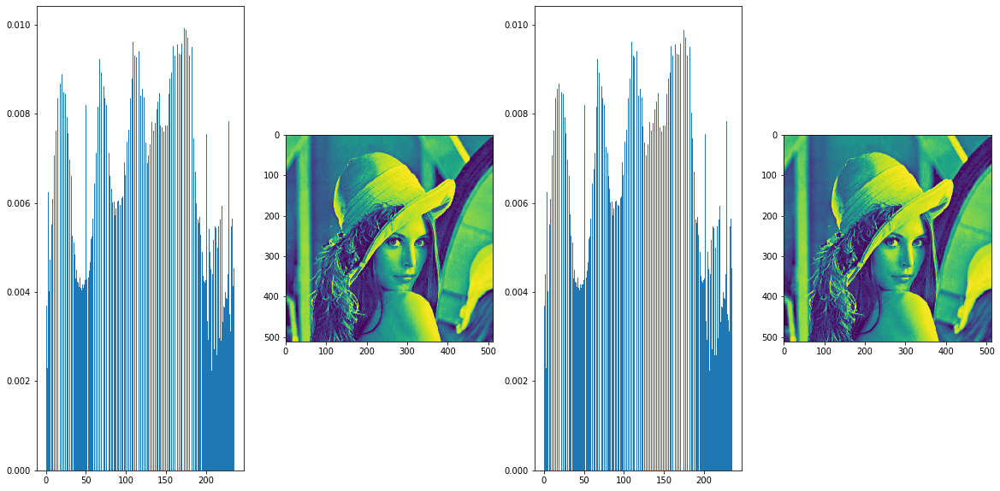

In [161]:
plt.figure(figsize = (20,10))
plt.subplot(141),plt.hist(y.ravel(),max(y.ravel()),[0,max(y.ravel())],density = True)
plt.subplot(142),plt.imshow(y)
plt.subplot(143),plt.hist(img2Y_altered.ravel(),max(img2Y_altered.ravel()),[0,max(img2Y_altered.ravel())],density = True)
plt.subplot(144),plt.imshow(img2Y_altered)
plt.savefig('originy_and_myy.png', bbox_inches='tight')
plt.show()

In [172]:
# Applying cv2 EH on the y channel
ycv2eq = cv2.equalizeHist(y)

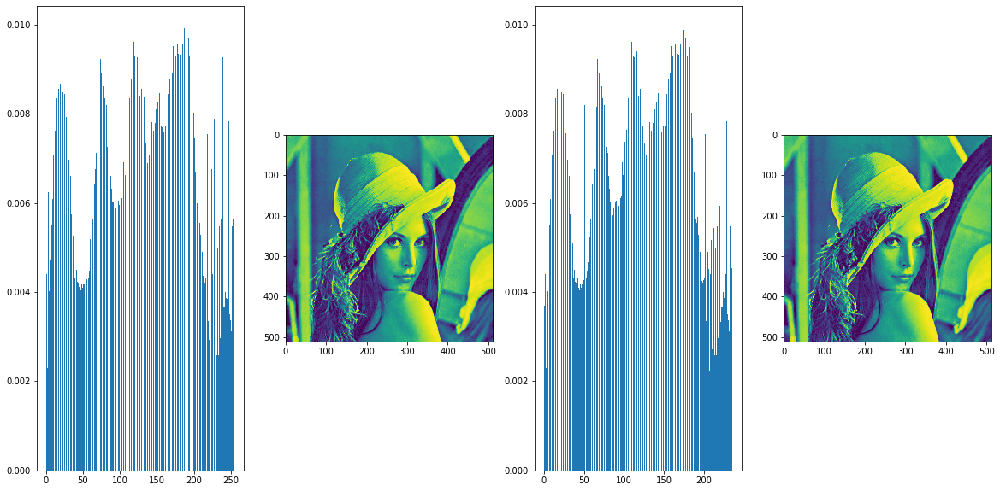

In [173]:
plt.figure(figsize = (20,10))
plt.subplot(141),plt.hist(ycv2eq.ravel(),max(ycv2eq.ravel()),[0,max(ycv2eq.ravel())],density = True)
plt.subplot(142),plt.imshow(ycv2eq)
plt.subplot(143),plt.hist(img2Y_altered.ravel(),max(img2Y_altered.ravel()),[0,max(img2Y_altered.ravel())],density = True)
plt.subplot(144),plt.imshow(img2Y_altered)
plt.savefig('cv2eqy_and_myy.png', bbox_inches='tight')
plt.show()

In [248]:
cv2eqrgb_for_cv2_imwrite = np.zeros((512,512,3))
for i in range(img2.shape[0]):
    for j in range(img2.shape[1]):
        pix = [int(cv2eqb[i][j]),int(cv2eqg[i][j]),int(cv2eqr[i][j])]
        cv2eqrgb_for_cv2_imwrite[i][j] = pix

In [249]:
new_img2_for_cv2_imwrite = np.zeros((512,512,3))
for i in range(img2.shape[0]):
    for j in range(img2.shape[1]):
        pix = [int(img2B_altered[i][j]),int(img2G_altered[i][j]),int(img2R_altered[i][j])]
        new_img2_for_cv2_imwrite[i][j] = pix

In [254]:
cv2.imwrite("1stQ_myeq_write.png", img_altered_whole_spectrum)
cv2.imwrite("1stQ_cv2eq_write.png", cv2eq)
cv2.imwrite("2stQ_myrgbeq.png", new_img2_for_cv2_imwrite)
cv2.imwrite("2stQ_cv2rgbeq.png", cv2eqrgb_for_cv2_imwrite)
cv2.imwrite("2stQ_cv2Heq.png", Hcv2eq)
cv2.imwrite("2stQ_myHeq.png", img2H_altered)
cv2.imwrite("2stQ_cv2yeq.png", ycv2eq)
cv2.imwrite("2stQ_myyeq.png", img2Y_altered)

True